In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns


from sklearn.datasets import make_blobs
from sklearn.metrics import f1_score,accuracy_score
from sklearn.metrics import precision_score, recall_score, confusion_matrix, classification_report
from sklearn.metrics import matthews_corrcoef,cohen_kappa_score,balanced_accuracy_score


import lightgbm as lgb
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.neighbors import KNeighborsClassifier
import xgboost as xgb
from catboost import CatBoostClassifier

from modAL.models import ActiveLearner, Committee
from modAL.uncertainty import uncertainty_sampling
from functools import partial
from modAL.batch import uncertainty_batch_sampling

import warnings

warnings.filterwarnings('ignore')

In [2]:
float_id1 = '4903220'
float_id2 = '6901195'
float_id3 = '3901684'
data_source1="./dataset/PR_PF_"+float_id1+".csv"
data_source2="./dataset/PR_PF_"+float_id2+".csv"
data_source3="./dataset/PR_PF_"+float_id3+".csv"
df1= pd.read_csv(data_source1)
df2= pd.read_csv(data_source2)
df3= pd.read_csv(data_source3)
data=pd.concat([df1,df2,df3])
data

,Date,Latitude,longitude,Pressure,Salinity,Temperature,QC,label
0,-1.701117,-2.022773,-2.334838,-0.892680,1.020515,0.974806,0,0
1,-1.701117,-2.022773,-2.334838,-0.891177,1.033236,0.974806,0,0
2,-1.701117,-2.022773,-2.334838,-0.889610,1.023451,0.974440,0,0
3,-1.701117,-2.022773,-2.334838,-0.888044,1.022472,0.974562,0,0
4,-1.701117,-2.022773,-2.334838,-0.886415,1.043022,0.974073,0,0
...,...,...,...,...,...,...,...,...
149842,1.723431,0.987100,-0.978713,1.721038,-0.410773,-0.828686,0,0
149843,1.723431,0.987100,-0.978713,1.724454,-0.410935,-0.828842,0,0
149844,1.723431,0.987100,-0.978713,1.727869,-0.410935,-0.829206,0,0
149845,1.723431,0.987100,-0.978713,1.731425,-0.411259,-0.829744,0,0


In [3]:
row,col=data.shape

In [4]:
#def compute ratio
def comp_ratio(data):
    instance = data[(data['QC']==0)]
    rate=len(instance)/len(data)*100
    print(rate)
    return rate

In [5]:
dirty_ratio = 100-comp_ratio(data)
dirty_ratio

98.75297884339015


1.247021156609847

In [6]:
data['QC'].unique()
# num_values = len()

array([0, 4, 3, 5])

In [7]:
data.columns

Index(['Date', 'Latitude', 'longitude', 'Pressure', 'Salinity', 'Temperature',
       'QC', 'label'],
      dtype='object')

In [8]:
def plotCluster(data,name1,name2,name3,start,end):   
    %matplotlib notebook

    data1=data.loc[data['QC'] == 0]

    x1 = data1.loc[:,[name1]].iloc[start:end, :]  
    y1 = data1.loc[:,[name2]].iloc[start:end, :]  
    z1 = data1.loc[:,[name3]].iloc[start:end, :]  


    data2=data.loc[data['QC'] == 3]

    x2 = data2.loc[:,[name1]].iloc[start:end, :]  
    y2 = data2.loc[:,[name2]].iloc[start:end, :]  
    z2 = data2.loc[:,[name3]].iloc[start:end, :]  
    
    
    
    data3=data.loc[data['QC'] == 4]

    x3 = data3.loc[:,[name1]].iloc[start:end, :]  
    y3 = data3.loc[:,[name2]].iloc[start:end, :]  
    z3 = data3.loc[:,[name3]].iloc[start:end, :]  
    
    data4=data.loc[data['QC'] == 5]

    x4 = data4.loc[:,[name1]].iloc[start:end, :]  
    y4 = data4.loc[:,[name2]].iloc[start:end, :]  
    z4 = data4.loc[:,[name3]].iloc[start:end, :]  
    

    fig = plt.figure()
    ax = fig.add_subplot(projection="3d")
    ax.scatter(x1, y1, z1, c='y',s=0.01, label='Normal Data')
    ax.scatter(x2, y2, z2, c='g',s=10, label='PRES')
    ax.scatter(x3, y3, z3, c='b',s=10, label='PSAL')
    ax.scatter(x4, y4, z4, c='r',s=10, label='TEMP')
    
    ax.legend(loc='best')

    ax.set_zlabel(name1, fontdict={'size': 15, 'color': 'black'})
    ax.set_ylabel(name2, fontdict={'size': 15, 'color': 'black'})
    ax.set_xlabel(name3, fontdict={'size': 15, 'color': 'black'})
    plt.show()
    plt.savefig('./image/'+float_cd+'_scatter.png')
    


In [9]:
# dataplot=data.copy()

# plotCluster(dataplot,"Temperature","Pressure","Salinity",0,data.shape[0])

# Splite Dataset

In [10]:
train1=pd.read_csv('./randomtrain/PR_PF_'+float_id1+'.csv') 
# train2=pd.read_csv('./randomtrain/PR_PF_'+float_id2+'.csv') 
train3=pd.read_csv('./randomtrain/PR_PF_'+float_id3+'.csv') 
# test1=pd.read_csv('./randomtest/PR_PF_'+float_id1+'.csv')
test2=pd.read_csv('./randomtest/PR_PF_'+float_id2+'.csv')
# test3=pd.read_csv('./randomtest/PR_PF_'+float_id3+'.csv') 

# train_set=pd.concat([train1,train2,train3])
train_set=pd.concat([train1,train3])

# test_set=pd.concat([test1,test2,test3])
test_set=test2

len(train_set),len(test_set)

(301876, 2555)

In [11]:
comp_ratio(train_set)
comp_ratio(test_set)

99.04497210775286
83.95303326810176


83.95303326810176

In [12]:
#this function use random grid search to find best parameters
def getPar(model,dist,data,niter):
    import numpy as np
    import pandas as pd
    from sklearn.model_selection import RandomizedSearchCV
    x,y=data.shape

    clf = model

    param_dist = dist
    grid = RandomizedSearchCV(clf,param_dist,cv = 3,scoring = "balanced_accuracy",n_iter=niter,n_jobs = -1)

    #train
    grid.fit(data.iloc[:,0:y-1],data.iloc[:,y-1])
    #get best parameter
    print(grid.best_score_)
    return grid.best_params_

In [13]:
# metric
def computeMetric(y_tru,y_pre):
    acc = accuracy_score(y_tru,y_pre)
    pre=precision_score(y_tru,y_pre,average='macro')
    recall=recall_score(y_tru,y_pre,average='macro')
    cm=confusion_matrix(y_tru,y_pre)
    f1 = f1_score(y_tru,y_pre,average='macro')
    mcc=matthews_corrcoef(y_tru, y_pre)
    kappa=cohen_kappa_score(y_tru, y_pre)
    bac=balanced_accuracy_score(y_tru,y_pre)
    print("acc:",acc)
    print("precision:",pre)
    print("recall:",recall)
    print("cm:",cm)
    print("f1:",f1)
    print("balanced acc:",bac)
    print("MCC:", mcc)
    print("Kappa:",kappa)
    
    #confusion matrix
    cmap1 = sns.diverging_palette(260,-10,s=50, l=75, n=5, as_cmap=True)
    plt.subplots(figsize=(12,8))
    cf_matrix = confusion_matrix(y_tru, y_pre)
    sns.heatmap(cf_matrix/np.sum(cf_matrix), cmap = cmap1, annot = True, annot_kws = {'size':15})
    
    return f1

In [14]:
def draw(performance_history):
    fig, ax = plt.subplots(figsize=(8.5, 6), dpi=130)
    ax.plot(performance_history)
    ax.scatter(range(len(performance_history)), performance_history, s=13)
    ax.xaxis.set_major_locator(mpl.ticker.MaxNLocator(nbins=5, integer=True))
    ax.yaxis.set_major_locator(mpl.ticker.MaxNLocator(nbins=10))
    ax.yaxis.set_major_formatter(mpl.ticker.PercentFormatter(xmax=1))
    ax.set_ylim(bottom=0, top=1)
    ax.grid(True)
    ax.set_title('Incremental classification accuracy')
    ax.set_xlabel('Query iteration')
    ax.set_ylabel('Classification Accuracy')
    plt.show()

# splite train(pool), test, Labeled, Unlabeled

In [15]:
x,y=train_set.shape ##no qc
#pool 
X_Pool = train_set.iloc[:,0:y-2].values
y_Pool = train_set.iloc[:,y-1].values

In [16]:
#test set
X_test=test_set.iloc[:,0:y-2]
y_tru=test_set.iloc[:,y-1]
print(len(X_test),len(y_tru))

2555 2555


In [17]:
#Pool
def initial_data(n_initial,X_Pool,y_Pool):
    #inital
    initial_idx = np.random.choice(range(len(X_Pool)), size=n_initial, replace=False)
    #initial Labeled data
    #X_initial, y_initial = X_train[], y_train[initial_idx]
    X_L = X_Pool[initial_idx]
    y_L = y_Pool[initial_idx]
    # Unlabeled data
    # X_U = Pool_X[ini_num:]
    # y_U = Pool_X[ini_num:]
    X_U, y_U = np.delete(X_Pool, initial_idx, axis=0), np.delete(y_Pool, initial_idx, axis=0)
    return X_L,y_L,X_U,y_U

In [18]:
# Set RNG seed for reproducibility.
RANDOM_STATE_SEED = 123
np.random.seed(RANDOM_STATE_SEED)

n_initial= 100
#n_initial = 1000
N_QUERIES = 200 

In [19]:
X_initial,y_initial,X_re,y_re=initial_data(n_initial,X_Pool,y_Pool)
df_X_i = pd.DataFrame(X_initial)
df_y_i = pd.DataFrame(y_initial)
df_X_r = pd.DataFrame(X_re)
df_y_r = pd.DataFrame(y_re)




# X_initial1=pd.read_csv('./randomtrain/PR_PF_'+float_id1+'_X_initial.csv')
# X_initial2=pd.read_csv('./randomtrain/PR_PF_'+float_id2+'_X_initial.csv')
# X_initial3=pd.read_csv('./randomtrain/PR_PF_'+float_id3+'_X_initial.csv')

# y_initial1=pd.read_csv('./randomtrain/PR_PF_'+float_id1+'_y_initial.csv')
# y_initial2=pd.read_csv('./randomtrain/PR_PF_'+float_id2+'_y_initial.csv')
# y_initial3=pd.read_csv('./randomtrain/PR_PF_'+float_id3+'_y_initial.csv')


# X_initial=pd.concat([X_initial1,X_initial2,X_initial3])

# y_initial=pd.concat([y_initial1,y_initial2,y_initial3])

# X_initial=X_initial.values
# y_initial=y_initial.values.ravel()


In [20]:
# X_re1=pd.read_csv('./randomtrain/PR_PF_'+float_id1+'_X_re.csv')
# X_re2=pd.read_csv('./randomtrain/PR_PF_'+float_id2+'_X_re.csv')
# X_re3=pd.read_csv('./randomtrain/PR_PF_'+float_id3+'_X_re.csv')

# y_re1=pd.read_csv('./randomtrain/PR_PF_'+float_id1+'_y_re.csv')
# y_re2=pd.read_csv('./randomtrain/PR_PF_'+float_id2+'_y_re.csv')
# y_re3=pd.read_csv('./randomtrain/PR_PF_'+float_id3+'_y_re.csv')


# X_re=pd.concat([X_re1,X_re2,X_re3])

# y_re=pd.concat([y_re1,y_re2,y_re3])

# X_re=X_re.values
# y_re=y_re.values.ravel()



# # X_re=pd.read_csv('./randomtrain/'+float_cd+'_X_re.csv').values
# # y_re=pd.read_csv('./randomtrain/'+float_cd+'_y_re.csv').values.ravel()
# print(X_re.shape,X_initial.shape)
# print(y_re.shape,y_initial.shape)

In [21]:
# df_X_i.to_csv('./randomtrain/'+float_cd+'_X_initial.csv', index=False)
# df_y_i.to_csv('./randomtrain/'+float_cd+'_y_initial.csv', index=False)
# df_X_r.to_csv('./randomtrain/'+float_cd+'_X_re.csv', index=False)
# df_y_r.to_csv('./randomtrain/'+float_cd+'_y_re.csv', index=False)

# molAL

In [22]:
def random_sampling(classifier, X_pool):
    n_samples = len(X_pool)
    query_idx = np.random.choice(range(n_samples))
    return query_idx, X_pool[query_idx]

In [23]:
def al(clf,strategy,X_L,y_L):
    learner = ActiveLearner(estimator=clf,
                            query_strategy=strategy,
                            X_training=X_L, y_training=y_L)
    return learner

In [24]:
def al_learn(clf,sampling,X_initial,y_initial,X_re,y_re):
    X_L = X_initial.copy()
    y_L = y_initial.copy()
    X_U,y_U =X_re.copy(),y_re.copy()
    #print(len(X_U),len(y_U))
    learner = al(clf,sampling,X_L,y_L)
    y_pre=learner.predict(X_test)
    unqueried_kappa=cohen_kappa_score(y_tru, y_pre)
    unqueried_f1=f1_score(y_tru,y_pre)
    #print("unqueried --------------------->",unqueried_score)
    kappa_history = [unqueried_kappa]
    f1_history = [unqueried_f1]
    y_L_2 = y_L.tolist()
    y_L_2 = np.array(y_L_2).reshape((-1, 1))
    queried_instance = np.concatenate((X_L, y_L_2), axis=1)

    # Query
    for index in range(N_QUERIES):
        query_index, query_instance = learner.query(X_U)
        # Teach ActiveLearner model the record it has requested.
        X, y = X_U[query_index].reshape(1, -1), y_U[query_index].reshape(1, )
        #print(X.flatten(), y)
        instance = np.concatenate((X.flatten(), y))
        #print(index+1,"query instance --------------------->",instance)
        learner.teach(X=X, y=y)
        
        X_U, y_U = np.delete(X_U, query_index, axis=0), np.delete(y_U, query_index)
        y_pre=learner.predict(X_test)
        kappa=cohen_kappa_score(y_tru, y_pre)
        f1=f1_score(y_tru,y_pre)
        print(index+1,"-------------------->",kappa)
        print(index+1,"-------------------->",f1)
        # Recall precision F1
        kappa_history.append(kappa)
        f1_history.append(f1)
        queried_instance = np.vstack((queried_instance, instance))

    #print(query_history)
    df_scores= pd.concat([pd.DataFrame(kappa_history,columns=['kappa']), 
                          pd.DataFrame(f1_history,columns=['f1'])],
                         axis=1)
    df_instance = pd.DataFrame(data=queried_instance, columns=['Date','Latitude','longitude','Pressure','Salinity','Temperature','Label'])
    #print(df_instance)
    return df_scores, df_instance 
#     return f1_history


1.0
{'n_neighbors': 1}
acc: 0.8395303326810176
precision: 0.4197651663405088
recall: 0.5
cm: [[2145    0]
 [ 410    0]]
f1: 0.4563829787234042
balanced acc: 0.5
MCC: 0.0
Kappa: 0.0


0.4563829787234042

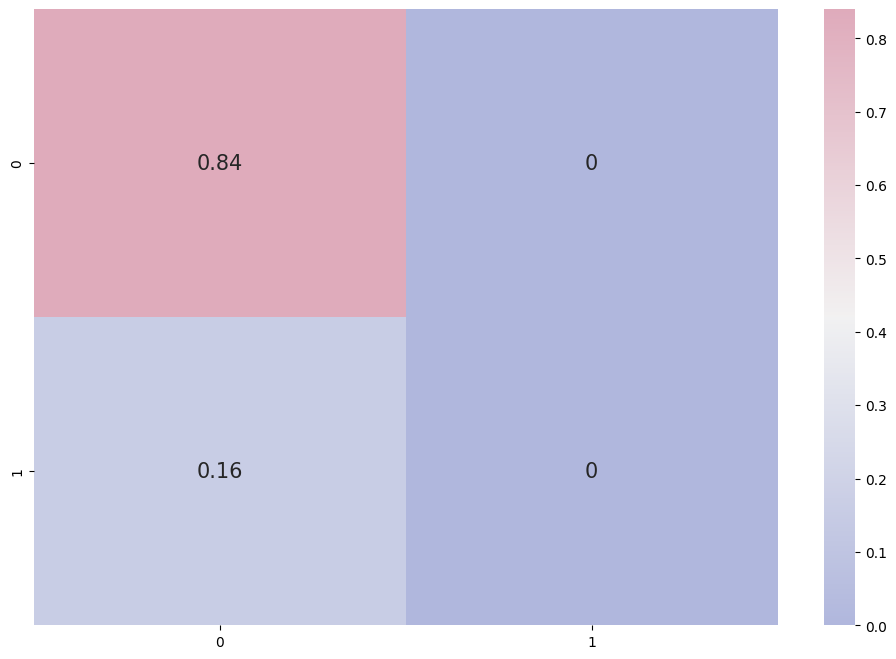

In [25]:
# clf1 KNN
clf1 = KNeighborsClassifier()
dic1={'n_neighbors':[1,2,3,4,5,6,7,8]}
para1=getPar(clf1,dic1,test_set,10)
print(para1)
clf1 = KNeighborsClassifier(n_neighbors=para1['n_neighbors'],n_jobs=-1)
clf1.fit(X_Pool, y_Pool)
y_pre=clf1.predict(X_test)
computeMetric(y_tru,y_pre)

0.9987745098039215
acc: 0.8391389432485323
precision: 0.6648809523809524
recall: 0.516535903121269
cm: [[2127   18]
 [ 393   17]]
f1: 0.4941508002456736
balanced acc: 0.516535903121269
MCC: 0.1044309428304464
Kappa: 0.05248697299857885


0.4941508002456736

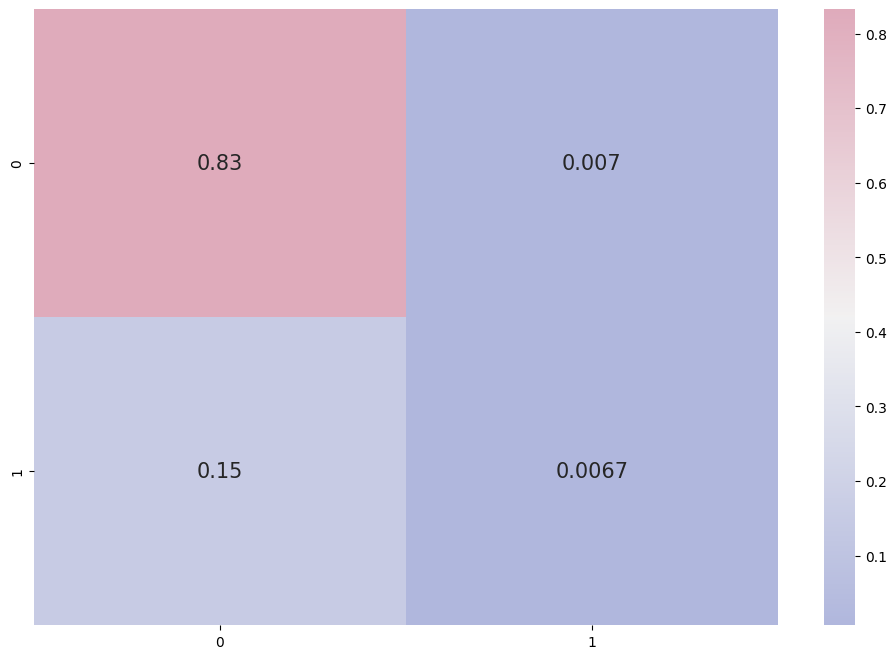

In [26]:
# clf2 lightgbm
clf2 = lgb.LGBMClassifier()

dic2 = {'learning_rate' : [0.01, 0.02, 0.03, 0.04, 0.05, 0.08, 0.1, 0.2, 0.3, 0.4],
              'n_estimators' : [100, 200, 300, 400, 500, 600, 800, 900, 1000, 1500, 2000],
              'num_leaves': range(6, 50), 
              'min_child_samples': range(10, 200, 10), 
              'min_child_weight': [1e-5, 1e-3, 1e-2, 1e-1, 1, 1e1, 1e2, 1e3, 1e4],
              'max_depth': [-1, 1, 2, 3, 4, 5, 6, 7],
              'reg_alpha': [0, 1e-1, 1, 2, 5, 7, 10, 50, 100],
              'reg_lambda': [0, 1e-1, 1, 5, 10, 20, 50, 100]}
para2=getPar(clf2,dic2,test_set,10)

    
clf2 = lgb.LGBMClassifier(boosting_type='gbdt',
                          #objective='multiclass',
                          num_leaves=para2['num_leaves'], max_depth=-1, 
                              learning_rate=para2['learning_rate'], n_estimators=para2['n_estimators'], 
                              subsample_for_bin=200000, class_weight=None, min_split_gain=0.0, 
                              min_child_weight=para2['min_child_weight'],
                              min_child_samples=para2['min_child_samples'], 
                              subsample=1.0, 
                              subsample_freq=0, colsample_bytree=1.0, reg_alpha=para2['reg_alpha'], 
                              reg_lambda=para2['reg_lambda'], random_state=None, n_jobs=-1, importance_type='split')
clf2.fit(X_Pool, y_Pool)
y_pre=clf2.predict(X_test)
computeMetric(y_tru,y_pre)

0.9987745098039215
acc: 0.8395303326810176
precision: 0.4197651663405088
recall: 0.5
cm: [[2145    0]
 [ 410    0]]
f1: 0.4563829787234042
balanced acc: 0.5
MCC: 0.0
Kappa: 0.0


0.4563829787234042

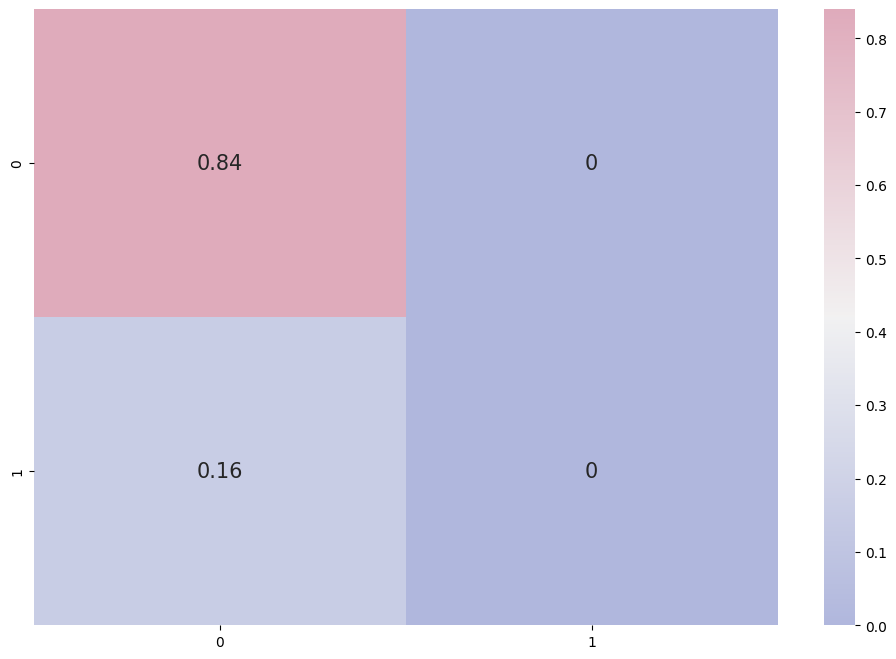

In [27]:
#XGBOOST
clf3 = xgb.XGBClassifier()
dic3 = {'n_estimators':range(80,2000,4),
        'max_depth':range(2,15,1),
        'learning_rate':np.linspace(0.01,2,20),
        'subsample':np.linspace(0.7,0.9,20),
        'colsample_bytree':np.linspace(0.5,0.98,10)
        }
para3=getPar(clf3,dic3,test_set,10)
clf3 = xgb.XGBClassifier(booster='gbtree',n_estimators=para3['n_estimators'], learning_rate=para3['learning_rate'],
                    max_depth=para3['max_depth'],subsample=para3['subsample'],
                    colsample_bytree=para3['colsample_bytree'],
                         #objective='multi:softprob',
                    n_jobs=-1)
clf3.fit(X_Pool, y_Pool)
y_pre=clf3.predict(X_test)
computeMetric(y_tru,y_pre)

Learning rate set to 0.117983
0:	learn: 0.3411342	total: 87ms	remaining: 1m 26s
1:	learn: 0.1873597	total: 113ms	remaining: 56.2s
2:	learn: 0.1017006	total: 135ms	remaining: 44.9s
3:	learn: 0.0508826	total: 156ms	remaining: 38.9s
4:	learn: 0.0330083	total: 175ms	remaining: 34.8s
5:	learn: 0.0210749	total: 201ms	remaining: 33.3s
6:	learn: 0.0179582	total: 221ms	remaining: 31.3s
7:	learn: 0.0153275	total: 240ms	remaining: 29.8s
8:	learn: 0.0114917	total: 259ms	remaining: 28.5s
9:	learn: 0.0105184	total: 277ms	remaining: 27.4s
10:	learn: 0.0098290	total: 295ms	remaining: 26.6s
11:	learn: 0.0092076	total: 317ms	remaining: 26.1s
12:	learn: 0.0079612	total: 337ms	remaining: 25.6s
13:	learn: 0.0071660	total: 357ms	remaining: 25.1s
14:	learn: 0.0059926	total: 375ms	remaining: 24.6s
15:	learn: 0.0053288	total: 400ms	remaining: 24.6s
16:	learn: 0.0051993	total: 420ms	remaining: 24.3s
17:	learn: 0.0050806	total: 442ms	remaining: 24.1s
18:	learn: 0.0049364	total: 467ms	remaining: 24.1s
19:	learn: 

163:	learn: 0.0015515	total: 3.59s	remaining: 18.3s
164:	learn: 0.0015455	total: 3.61s	remaining: 18.3s
165:	learn: 0.0015421	total: 3.63s	remaining: 18.3s
166:	learn: 0.0015408	total: 3.65s	remaining: 18.2s
167:	learn: 0.0015370	total: 3.67s	remaining: 18.2s
168:	learn: 0.0015268	total: 3.69s	remaining: 18.2s
169:	learn: 0.0015218	total: 3.71s	remaining: 18.1s
170:	learn: 0.0015208	total: 3.73s	remaining: 18.1s
171:	learn: 0.0015178	total: 3.75s	remaining: 18.1s
172:	learn: 0.0015158	total: 3.77s	remaining: 18s
173:	learn: 0.0015122	total: 3.79s	remaining: 18s
174:	learn: 0.0015080	total: 3.81s	remaining: 18s
175:	learn: 0.0015054	total: 3.83s	remaining: 17.9s
176:	learn: 0.0015039	total: 3.85s	remaining: 17.9s
177:	learn: 0.0015025	total: 3.86s	remaining: 17.8s
178:	learn: 0.0014952	total: 3.88s	remaining: 17.8s
179:	learn: 0.0014917	total: 3.9s	remaining: 17.8s
180:	learn: 0.0014900	total: 3.92s	remaining: 17.8s
181:	learn: 0.0014871	total: 3.94s	remaining: 17.7s
182:	learn: 0.00148

325:	learn: 0.0011615	total: 6.74s	remaining: 13.9s
326:	learn: 0.0011600	total: 6.76s	remaining: 13.9s
327:	learn: 0.0011587	total: 6.78s	remaining: 13.9s
328:	learn: 0.0011573	total: 6.8s	remaining: 13.9s
329:	learn: 0.0011547	total: 6.82s	remaining: 13.9s
330:	learn: 0.0011538	total: 6.84s	remaining: 13.8s
331:	learn: 0.0011508	total: 6.86s	remaining: 13.8s
332:	learn: 0.0011501	total: 6.88s	remaining: 13.8s
333:	learn: 0.0011473	total: 6.9s	remaining: 13.8s
334:	learn: 0.0011450	total: 6.92s	remaining: 13.7s
335:	learn: 0.0011446	total: 6.94s	remaining: 13.7s
336:	learn: 0.0011434	total: 6.97s	remaining: 13.7s
337:	learn: 0.0011412	total: 6.99s	remaining: 13.7s
338:	learn: 0.0011396	total: 7.01s	remaining: 13.7s
339:	learn: 0.0011392	total: 7.03s	remaining: 13.6s
340:	learn: 0.0011371	total: 7.05s	remaining: 13.6s
341:	learn: 0.0011347	total: 7.07s	remaining: 13.6s
342:	learn: 0.0011317	total: 7.09s	remaining: 13.6s
343:	learn: 0.0011309	total: 7.11s	remaining: 13.6s
344:	learn: 0.

494:	learn: 0.0009510	total: 10.1s	remaining: 10.3s
495:	learn: 0.0009497	total: 10.1s	remaining: 10.3s
496:	learn: 0.0009481	total: 10.1s	remaining: 10.3s
497:	learn: 0.0009478	total: 10.2s	remaining: 10.2s
498:	learn: 0.0009465	total: 10.2s	remaining: 10.2s
499:	learn: 0.0009450	total: 10.2s	remaining: 10.2s
500:	learn: 0.0009437	total: 10.2s	remaining: 10.2s
501:	learn: 0.0009433	total: 10.2s	remaining: 10.2s
502:	learn: 0.0009418	total: 10.3s	remaining: 10.1s
503:	learn: 0.0009405	total: 10.3s	remaining: 10.1s
504:	learn: 0.0009392	total: 10.3s	remaining: 10.1s
505:	learn: 0.0009383	total: 10.3s	remaining: 10.1s
506:	learn: 0.0009373	total: 10.3s	remaining: 10s
507:	learn: 0.0009365	total: 10.3s	remaining: 10s
508:	learn: 0.0009356	total: 10.4s	remaining: 10s
509:	learn: 0.0009350	total: 10.4s	remaining: 9.98s
510:	learn: 0.0009341	total: 10.4s	remaining: 9.96s
511:	learn: 0.0009330	total: 10.4s	remaining: 9.93s
512:	learn: 0.0009320	total: 10.4s	remaining: 9.91s
513:	learn: 0.0009

661:	learn: 0.0008768	total: 13s	remaining: 6.64s
662:	learn: 0.0008768	total: 13s	remaining: 6.62s
663:	learn: 0.0008768	total: 13s	remaining: 6.6s
664:	learn: 0.0008768	total: 13.1s	remaining: 6.58s
665:	learn: 0.0008768	total: 13.1s	remaining: 6.56s
666:	learn: 0.0008758	total: 13.1s	remaining: 6.54s
667:	learn: 0.0008756	total: 13.1s	remaining: 6.52s
668:	learn: 0.0008753	total: 13.1s	remaining: 6.5s
669:	learn: 0.0008749	total: 13.2s	remaining: 6.48s
670:	learn: 0.0008737	total: 13.2s	remaining: 6.46s
671:	learn: 0.0008729	total: 13.2s	remaining: 6.44s
672:	learn: 0.0008724	total: 13.2s	remaining: 6.42s
673:	learn: 0.0008713	total: 13.2s	remaining: 6.4s
674:	learn: 0.0008708	total: 13.3s	remaining: 6.38s
675:	learn: 0.0008706	total: 13.3s	remaining: 6.36s
676:	learn: 0.0008703	total: 13.3s	remaining: 6.34s
677:	learn: 0.0008703	total: 13.3s	remaining: 6.32s
678:	learn: 0.0008703	total: 13.3s	remaining: 6.3s
679:	learn: 0.0008703	total: 13.3s	remaining: 6.28s
680:	learn: 0.0008703	

834:	learn: 0.0008698	total: 15.5s	remaining: 3.07s
835:	learn: 0.0008698	total: 15.5s	remaining: 3.05s
836:	learn: 0.0008698	total: 15.5s	remaining: 3.03s
837:	learn: 0.0008698	total: 15.6s	remaining: 3.01s
838:	learn: 0.0008698	total: 15.6s	remaining: 2.99s
839:	learn: 0.0008698	total: 15.6s	remaining: 2.97s
840:	learn: 0.0008698	total: 15.6s	remaining: 2.95s
841:	learn: 0.0008698	total: 15.6s	remaining: 2.93s
842:	learn: 0.0008698	total: 15.6s	remaining: 2.91s
843:	learn: 0.0008698	total: 15.6s	remaining: 2.89s
844:	learn: 0.0008698	total: 15.7s	remaining: 2.87s
845:	learn: 0.0008698	total: 15.7s	remaining: 2.85s
846:	learn: 0.0008698	total: 15.7s	remaining: 2.83s
847:	learn: 0.0008698	total: 15.7s	remaining: 2.81s
848:	learn: 0.0008698	total: 15.7s	remaining: 2.79s
849:	learn: 0.0008698	total: 15.7s	remaining: 2.77s
850:	learn: 0.0008698	total: 15.7s	remaining: 2.75s
851:	learn: 0.0008698	total: 15.7s	remaining: 2.73s
852:	learn: 0.0008698	total: 15.8s	remaining: 2.71s
853:	learn: 

acc: 0.8367906066536204
precision: 0.4195447409733124
recall: 0.4983682983682984
cm: [[2138    7]
 [ 410    0]]
f1: 0.45557212870232255
balanced acc: 0.4983682983682984
MCC: -0.02291540769288852
Kappa: -0.005416652904845387


0.45557212870232255

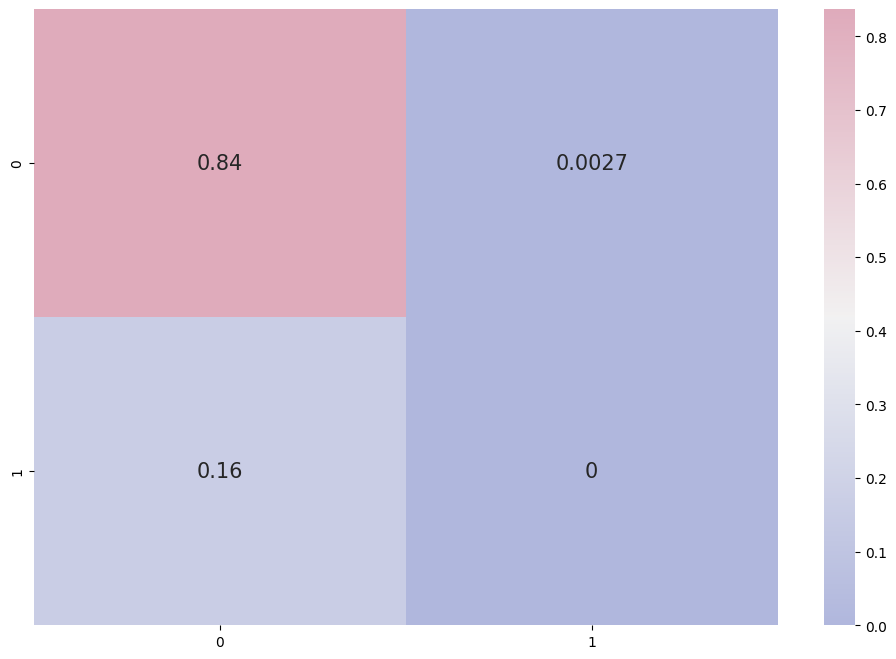

In [28]:
#clf4 catboost
clf4 = CatBoostClassifier(loss_function='Logloss')
# dic4 = {'learning_rate': [0.03, 0.1],
#         'depth': [4, 6, 10],
#         'l2_leaf_reg': [1, 3, 5, 7, 9]}
# #para3=getPar(clf4,dic4,test_set,10)

# grid_search_result = clf4.grid_search(dic4, 
#                                        X=X_Pool, 
#                                        y=y_Pool)

clf4.fit(X_Pool, y_Pool)
y_pre=clf4.predict(X_test)
computeMetric(y_tru,y_pre)

## random sampling

In [29]:
sampling=random_sampling

In [30]:
metric01,instance01 = al_learn(clf1,sampling,X_initial,y_initial,X_re,y_re)
# instance01.to_csv("./query/random_Knn_"+"mix_ni"+".csv")

1 --------------------> 0.0
1 --------------------> 0.0
2 --------------------> 0.0
2 --------------------> 0.0
3 --------------------> 0.0
3 --------------------> 0.0
4 --------------------> 0.0
4 --------------------> 0.0
5 --------------------> 0.0
5 --------------------> 0.0
6 --------------------> 0.0
6 --------------------> 0.0
7 --------------------> 0.0
7 --------------------> 0.0
8 --------------------> 0.0
8 --------------------> 0.0
9 --------------------> 0.0
9 --------------------> 0.0
10 --------------------> 0.0
10 --------------------> 0.0
11 --------------------> 0.0
11 --------------------> 0.0
12 --------------------> 0.0
12 --------------------> 0.0
13 --------------------> 0.0
13 --------------------> 0.0
14 --------------------> 0.0
14 --------------------> 0.0
15 --------------------> 0.0
15 --------------------> 0.0
16 --------------------> 0.0
16 --------------------> 0.0
17 --------------------> 0.0
17 --------------------> 0.0
18 --------------------> 0.0
18 

135 --------------------> -0.007700253544933755
135 --------------------> 0.0
136 --------------------> -0.007700253544933755
136 --------------------> 0.0
137 --------------------> -0.007700253544933755
137 --------------------> 0.0
138 --------------------> -0.007700253544933755
138 --------------------> 0.0
139 --------------------> -0.007700253544933755
139 --------------------> 0.0
140 --------------------> -0.007700253544933755
140 --------------------> 0.0
141 --------------------> -0.007700253544933755
141 --------------------> 0.0
142 --------------------> -0.007700253544933755
142 --------------------> 0.0
143 --------------------> -0.007700253544933755
143 --------------------> 0.0
144 --------------------> -0.007700253544933755
144 --------------------> 0.0
145 --------------------> -0.007700253544933755
145 --------------------> 0.0
146 --------------------> -0.007700253544933755
146 --------------------> 0.0
147 --------------------> -0.007700253544933755
147 ------------

In [31]:
metric02,instance02 = al_learn(clf2,sampling,X_initial,y_initial,X_re,y_re)
# instance02.to_csv("./query/random_Lg_"+"mix_ni"+".csv")

1 --------------------> 0.0
1 --------------------> 0.0
2 --------------------> 0.0
2 --------------------> 0.0
3 --------------------> 0.0
3 --------------------> 0.0
4 --------------------> 0.0
4 --------------------> 0.0
5 --------------------> 0.0
5 --------------------> 0.0
6 --------------------> 0.0
6 --------------------> 0.0
7 --------------------> 0.0
7 --------------------> 0.0
8 --------------------> 0.0
8 --------------------> 0.0
9 --------------------> 0.0
9 --------------------> 0.0
10 --------------------> 0.0
10 --------------------> 0.0
11 --------------------> 0.0
11 --------------------> 0.0
12 --------------------> 0.0
12 --------------------> 0.0
13 --------------------> 0.0
13 --------------------> 0.0
14 --------------------> 0.0
14 --------------------> 0.0
15 --------------------> 0.0
15 --------------------> 0.0
16 --------------------> 0.0
16 --------------------> 0.0
17 --------------------> 0.0
17 --------------------> 0.0
18 --------------------> 0.0
18 

142 --------------------> 0.0
142 --------------------> 0.0
143 --------------------> 0.0
143 --------------------> 0.0
144 --------------------> -0.010710553814001988
144 --------------------> 0.0
145 --------------------> -0.010710553814001988
145 --------------------> 0.0
146 --------------------> -0.008456501052374943
146 --------------------> 0.0
147 --------------------> -0.010710553814001988
147 --------------------> 0.0
148 --------------------> -0.008456501052374943
148 --------------------> 0.0
149 --------------------> -0.010710553814001988
149 --------------------> 0.0
150 --------------------> -0.008456501052374943
150 --------------------> 0.0
151 --------------------> -0.008456501052374943
151 --------------------> 0.0
152 --------------------> -0.008456501052374943
152 --------------------> 0.0
153 --------------------> -0.010710553814001988
153 --------------------> 0.0
154 --------------------> -0.008456501052374943
154 --------------------> 0.0
155 ------------------

In [32]:
metric03,instance03= al_learn(clf3,sampling,X_initial,y_initial,X_re,y_re)
# instance03.to_csv("./query/random_XB_"+"mix_ni"+".csv")

1 --------------------> 0.0
1 --------------------> 0.0
2 --------------------> 0.0
2 --------------------> 0.0
3 --------------------> 0.0
3 --------------------> 0.0
4 --------------------> 0.0
4 --------------------> 0.0
5 --------------------> 0.0
5 --------------------> 0.0
6 --------------------> 0.0
6 --------------------> 0.0
7 --------------------> 0.0
7 --------------------> 0.0
8 --------------------> 0.0
8 --------------------> 0.0
9 --------------------> 0.0
9 --------------------> 0.0
10 --------------------> 0.0
10 --------------------> 0.0
11 --------------------> 0.0
11 --------------------> 0.0
12 --------------------> 0.0
12 --------------------> 0.0
13 --------------------> 0.0
13 --------------------> 0.0
14 --------------------> 0.0
14 --------------------> 0.0
15 --------------------> 0.0
15 --------------------> 0.0
16 --------------------> 0.0
16 --------------------> 0.0
17 --------------------> 0.0
17 --------------------> 0.0
18 --------------------> 0.0
18 

134 --------------------> -0.012942820402118693
134 --------------------> 0.0
135 --------------------> -0.01661570202262097
135 --------------------> 0.0
136 --------------------> -0.0007814845347069443
136 --------------------> 0.0
137 --------------------> -0.0007814845347069443
137 --------------------> 0.0
138 --------------------> -0.008456501052374943
138 --------------------> 0.0
139 --------------------> 0.0
139 --------------------> 0.0
140 --------------------> -0.0007814845347069443
140 --------------------> 0.0
141 --------------------> 0.0
141 --------------------> 0.0
142 --------------------> 0.0
142 --------------------> 0.0
143 --------------------> 0.0
143 --------------------> 0.0
144 --------------------> 0.0
144 --------------------> 0.0
145 --------------------> 0.0
145 --------------------> 0.0
146 --------------------> -0.0031105083974243275
146 --------------------> 0.0
147 --------------------> -0.0007814845347069443
147 --------------------> 0.0
148 --------

In [33]:
metric04,instance04= al_learn(clf4,sampling,X_initial,y_initial,X_re,y_re)
# instance04.to_csv("./query/random_CB_"+"mix_ni"+".csv")

Learning rate set to 0.003854
0:	learn: 0.6863707	total: 1.48ms	remaining: 1.48s
1:	learn: 0.6799210	total: 2.91ms	remaining: 1.45s
2:	learn: 0.6741411	total: 4.07ms	remaining: 1.35s
3:	learn: 0.6677521	total: 5ms	remaining: 1.25s
4:	learn: 0.6619098	total: 6.01ms	remaining: 1.2s
5:	learn: 0.6559838	total: 6.94ms	remaining: 1.15s
6:	learn: 0.6502606	total: 7.97ms	remaining: 1.13s
7:	learn: 0.6446960	total: 9.09ms	remaining: 1.13s
8:	learn: 0.6390838	total: 10.1ms	remaining: 1.11s
9:	learn: 0.6337343	total: 11.5ms	remaining: 1.14s
10:	learn: 0.6286500	total: 12.6ms	remaining: 1.13s
11:	learn: 0.6225951	total: 13.6ms	remaining: 1.12s
12:	learn: 0.6175837	total: 14.7ms	remaining: 1.12s
13:	learn: 0.6117942	total: 15.5ms	remaining: 1.09s
14:	learn: 0.6057405	total: 16.5ms	remaining: 1.09s
15:	learn: 0.5997722	total: 17.5ms	remaining: 1.07s
16:	learn: 0.5935844	total: 18.7ms	remaining: 1.08s
17:	learn: 0.5887025	total: 19.7ms	remaining: 1.08s
18:	learn: 0.5839944	total: 20.8ms	remaining: 1.

188:	learn: 0.1607058	total: 168ms	remaining: 722ms
189:	learn: 0.1595925	total: 169ms	remaining: 722ms
190:	learn: 0.1586512	total: 171ms	remaining: 722ms
191:	learn: 0.1577630	total: 171ms	remaining: 721ms
192:	learn: 0.1568296	total: 172ms	remaining: 719ms
193:	learn: 0.1559029	total: 173ms	remaining: 719ms
194:	learn: 0.1548498	total: 174ms	remaining: 718ms
195:	learn: 0.1540619	total: 175ms	remaining: 716ms
196:	learn: 0.1531045	total: 176ms	remaining: 716ms
197:	learn: 0.1521848	total: 177ms	remaining: 715ms
198:	learn: 0.1511182	total: 177ms	remaining: 714ms
199:	learn: 0.1502467	total: 179ms	remaining: 715ms
200:	learn: 0.1491269	total: 180ms	remaining: 717ms
201:	learn: 0.1482894	total: 182ms	remaining: 718ms
202:	learn: 0.1475332	total: 183ms	remaining: 720ms
203:	learn: 0.1466335	total: 184ms	remaining: 720ms
204:	learn: 0.1457468	total: 185ms	remaining: 719ms
205:	learn: 0.1445072	total: 186ms	remaining: 718ms
206:	learn: 0.1438140	total: 187ms	remaining: 718ms
207:	learn: 

353:	learn: 0.0675733	total: 332ms	remaining: 607ms
354:	learn: 0.0673042	total: 334ms	remaining: 606ms
355:	learn: 0.0669978	total: 335ms	remaining: 606ms
356:	learn: 0.0666422	total: 336ms	remaining: 604ms
357:	learn: 0.0664196	total: 336ms	remaining: 603ms
358:	learn: 0.0661602	total: 338ms	remaining: 603ms
359:	learn: 0.0657310	total: 339ms	remaining: 602ms
360:	learn: 0.0655066	total: 339ms	remaining: 601ms
361:	learn: 0.0652483	total: 340ms	remaining: 599ms
362:	learn: 0.0650096	total: 341ms	remaining: 598ms
363:	learn: 0.0647746	total: 342ms	remaining: 597ms
364:	learn: 0.0644059	total: 342ms	remaining: 596ms
365:	learn: 0.0641593	total: 343ms	remaining: 594ms
366:	learn: 0.0638907	total: 344ms	remaining: 593ms
367:	learn: 0.0636858	total: 345ms	remaining: 592ms
368:	learn: 0.0633277	total: 345ms	remaining: 591ms
369:	learn: 0.0630889	total: 346ms	remaining: 589ms
370:	learn: 0.0627727	total: 347ms	remaining: 588ms
371:	learn: 0.0625367	total: 348ms	remaining: 587ms
372:	learn: 

585:	learn: 0.0289879	total: 499ms	remaining: 352ms
586:	learn: 0.0289189	total: 500ms	remaining: 352ms
587:	learn: 0.0288565	total: 500ms	remaining: 351ms
588:	learn: 0.0287674	total: 501ms	remaining: 350ms
589:	learn: 0.0286728	total: 502ms	remaining: 349ms
590:	learn: 0.0286084	total: 503ms	remaining: 348ms
591:	learn: 0.0285357	total: 504ms	remaining: 347ms
592:	learn: 0.0284516	total: 504ms	remaining: 346ms
593:	learn: 0.0283792	total: 505ms	remaining: 345ms
594:	learn: 0.0283131	total: 506ms	remaining: 344ms
595:	learn: 0.0281970	total: 507ms	remaining: 343ms
596:	learn: 0.0281114	total: 507ms	remaining: 342ms
597:	learn: 0.0280566	total: 508ms	remaining: 341ms
598:	learn: 0.0279724	total: 509ms	remaining: 341ms
599:	learn: 0.0278888	total: 509ms	remaining: 340ms
600:	learn: 0.0278190	total: 510ms	remaining: 339ms
601:	learn: 0.0277536	total: 511ms	remaining: 338ms
602:	learn: 0.0276866	total: 512ms	remaining: 337ms
603:	learn: 0.0276025	total: 513ms	remaining: 336ms
604:	learn: 

838:	learn: 0.0162415	total: 680ms	remaining: 131ms
839:	learn: 0.0162196	total: 681ms	remaining: 130ms
840:	learn: 0.0161998	total: 682ms	remaining: 129ms
841:	learn: 0.0161663	total: 683ms	remaining: 128ms
842:	learn: 0.0161405	total: 684ms	remaining: 127ms
843:	learn: 0.0161093	total: 684ms	remaining: 126ms
844:	learn: 0.0160815	total: 685ms	remaining: 126ms
845:	learn: 0.0160497	total: 686ms	remaining: 125ms
846:	learn: 0.0160178	total: 687ms	remaining: 124ms
847:	learn: 0.0159878	total: 687ms	remaining: 123ms
848:	learn: 0.0159626	total: 688ms	remaining: 122ms
849:	learn: 0.0159363	total: 689ms	remaining: 122ms
850:	learn: 0.0158967	total: 689ms	remaining: 121ms
851:	learn: 0.0158704	total: 690ms	remaining: 120ms
852:	learn: 0.0158394	total: 691ms	remaining: 119ms
853:	learn: 0.0158184	total: 692ms	remaining: 118ms
854:	learn: 0.0157888	total: 692ms	remaining: 117ms
855:	learn: 0.0157590	total: 693ms	remaining: 117ms
856:	learn: 0.0157272	total: 694ms	remaining: 116ms
857:	learn: 

12:	learn: 0.6175478	total: 9.95ms	remaining: 756ms
13:	learn: 0.6117018	total: 11.2ms	remaining: 787ms
14:	learn: 0.6056353	total: 11.9ms	remaining: 783ms
15:	learn: 0.5996253	total: 12.8ms	remaining: 785ms
16:	learn: 0.5934990	total: 13.5ms	remaining: 782ms
17:	learn: 0.5881432	total: 14.3ms	remaining: 779ms
18:	learn: 0.5834301	total: 15ms	remaining: 772ms
19:	learn: 0.5781367	total: 15.8ms	remaining: 772ms
20:	learn: 0.5724513	total: 16.4ms	remaining: 762ms
21:	learn: 0.5684566	total: 17.1ms	remaining: 761ms
22:	learn: 0.5637192	total: 17.9ms	remaining: 760ms
23:	learn: 0.5589106	total: 18.9ms	remaining: 768ms
24:	learn: 0.5548557	total: 19.8ms	remaining: 774ms
25:	learn: 0.5503966	total: 20.7ms	remaining: 775ms
26:	learn: 0.5453471	total: 21.5ms	remaining: 776ms
27:	learn: 0.5402081	total: 22.4ms	remaining: 776ms
28:	learn: 0.5361435	total: 23.3ms	remaining: 779ms
29:	learn: 0.5310931	total: 24.2ms	remaining: 783ms
30:	learn: 0.5243481	total: 24.8ms	remaining: 775ms
31:	learn: 0.5

255:	learn: 0.1087513	total: 192ms	remaining: 557ms
256:	learn: 0.1078658	total: 193ms	remaining: 557ms
257:	learn: 0.1072206	total: 194ms	remaining: 557ms
258:	learn: 0.1066436	total: 194ms	remaining: 556ms
259:	learn: 0.1061198	total: 195ms	remaining: 555ms
260:	learn: 0.1056314	total: 196ms	remaining: 555ms
261:	learn: 0.1052080	total: 197ms	remaining: 554ms
262:	learn: 0.1046201	total: 197ms	remaining: 553ms
263:	learn: 0.1040482	total: 198ms	remaining: 553ms
264:	learn: 0.1034709	total: 199ms	remaining: 552ms
265:	learn: 0.1031353	total: 200ms	remaining: 551ms
266:	learn: 0.1025373	total: 200ms	remaining: 550ms
267:	learn: 0.1021203	total: 201ms	remaining: 550ms
268:	learn: 0.1017322	total: 202ms	remaining: 549ms
269:	learn: 0.1012398	total: 203ms	remaining: 549ms
270:	learn: 0.1005997	total: 204ms	remaining: 548ms
271:	learn: 0.0999922	total: 204ms	remaining: 547ms
272:	learn: 0.0995629	total: 205ms	remaining: 547ms
273:	learn: 0.0992184	total: 206ms	remaining: 546ms
274:	learn: 

464:	learn: 0.0424317	total: 375ms	remaining: 431ms
465:	learn: 0.0422481	total: 376ms	remaining: 431ms
466:	learn: 0.0420770	total: 377ms	remaining: 430ms
467:	learn: 0.0419448	total: 377ms	remaining: 429ms
468:	learn: 0.0418120	total: 378ms	remaining: 428ms
469:	learn: 0.0416698	total: 379ms	remaining: 427ms
470:	learn: 0.0415697	total: 380ms	remaining: 426ms
471:	learn: 0.0414663	total: 380ms	remaining: 426ms
472:	learn: 0.0413351	total: 381ms	remaining: 425ms
473:	learn: 0.0411879	total: 382ms	remaining: 424ms
474:	learn: 0.0410495	total: 383ms	remaining: 423ms
475:	learn: 0.0409249	total: 383ms	remaining: 422ms
476:	learn: 0.0407891	total: 384ms	remaining: 421ms
477:	learn: 0.0405694	total: 385ms	remaining: 420ms
478:	learn: 0.0404709	total: 385ms	remaining: 419ms
479:	learn: 0.0403594	total: 386ms	remaining: 418ms
480:	learn: 0.0402226	total: 387ms	remaining: 417ms
481:	learn: 0.0400989	total: 388ms	remaining: 417ms
482:	learn: 0.0399509	total: 388ms	remaining: 416ms
483:	learn: 

717:	learn: 0.0205197	total: 557ms	remaining: 219ms
718:	learn: 0.0204553	total: 558ms	remaining: 218ms
719:	learn: 0.0204111	total: 558ms	remaining: 217ms
720:	learn: 0.0203787	total: 559ms	remaining: 216ms
721:	learn: 0.0203402	total: 560ms	remaining: 216ms
722:	learn: 0.0203023	total: 561ms	remaining: 215ms
723:	learn: 0.0202493	total: 562ms	remaining: 214ms
724:	learn: 0.0202147	total: 562ms	remaining: 213ms
725:	learn: 0.0201882	total: 563ms	remaining: 213ms
726:	learn: 0.0201446	total: 564ms	remaining: 212ms
727:	learn: 0.0201025	total: 565ms	remaining: 211ms
728:	learn: 0.0200614	total: 566ms	remaining: 210ms
729:	learn: 0.0200202	total: 566ms	remaining: 210ms
730:	learn: 0.0199696	total: 567ms	remaining: 209ms
731:	learn: 0.0199309	total: 568ms	remaining: 208ms
732:	learn: 0.0198899	total: 569ms	remaining: 207ms
733:	learn: 0.0198487	total: 570ms	remaining: 206ms
734:	learn: 0.0198169	total: 570ms	remaining: 206ms
735:	learn: 0.0197752	total: 571ms	remaining: 205ms
736:	learn: 

964:	learn: 0.0128650	total: 738ms	remaining: 26.8ms
965:	learn: 0.0128469	total: 739ms	remaining: 26ms
966:	learn: 0.0128292	total: 740ms	remaining: 25.2ms
967:	learn: 0.0128079	total: 741ms	remaining: 24.5ms
968:	learn: 0.0127847	total: 741ms	remaining: 23.7ms
969:	learn: 0.0127659	total: 742ms	remaining: 23ms
970:	learn: 0.0127461	total: 743ms	remaining: 22.2ms
971:	learn: 0.0127226	total: 744ms	remaining: 21.4ms
972:	learn: 0.0127093	total: 744ms	remaining: 20.7ms
973:	learn: 0.0126945	total: 745ms	remaining: 19.9ms
974:	learn: 0.0126777	total: 746ms	remaining: 19.1ms
975:	learn: 0.0126599	total: 747ms	remaining: 18.4ms
976:	learn: 0.0126426	total: 748ms	remaining: 17.6ms
977:	learn: 0.0126199	total: 748ms	remaining: 16.8ms
978:	learn: 0.0125974	total: 749ms	remaining: 16.1ms
979:	learn: 0.0125781	total: 750ms	remaining: 15.3ms
980:	learn: 0.0125620	total: 751ms	remaining: 14.5ms
981:	learn: 0.0125383	total: 751ms	remaining: 13.8ms
982:	learn: 0.0125213	total: 753ms	remaining: 13ms

125:	learn: 0.2434453	total: 90.6ms	remaining: 629ms
126:	learn: 0.2413623	total: 92ms	remaining: 632ms
127:	learn: 0.2393083	total: 92.7ms	remaining: 632ms
128:	learn: 0.2377419	total: 93.5ms	remaining: 632ms
129:	learn: 0.2362693	total: 94.3ms	remaining: 631ms
130:	learn: 0.2342893	total: 95ms	remaining: 630ms
131:	learn: 0.2327800	total: 95.8ms	remaining: 630ms
132:	learn: 0.2311768	total: 96.5ms	remaining: 629ms
133:	learn: 0.2283682	total: 97ms	remaining: 627ms
134:	learn: 0.2270079	total: 97.8ms	remaining: 626ms
135:	learn: 0.2252681	total: 98.6ms	remaining: 626ms
136:	learn: 0.2238170	total: 99.3ms	remaining: 626ms
137:	learn: 0.2226480	total: 100ms	remaining: 625ms
138:	learn: 0.2209277	total: 101ms	remaining: 625ms
139:	learn: 0.2193604	total: 102ms	remaining: 624ms
140:	learn: 0.2175190	total: 102ms	remaining: 624ms
141:	learn: 0.2159763	total: 103ms	remaining: 624ms
142:	learn: 0.2146557	total: 104ms	remaining: 623ms
143:	learn: 0.2127001	total: 105ms	remaining: 623ms
144:	l

374:	learn: 0.0603299	total: 272ms	remaining: 453ms
375:	learn: 0.0600817	total: 273ms	remaining: 453ms
376:	learn: 0.0598783	total: 274ms	remaining: 453ms
377:	learn: 0.0596545	total: 275ms	remaining: 452ms
378:	learn: 0.0593692	total: 276ms	remaining: 452ms
379:	learn: 0.0591344	total: 276ms	remaining: 451ms
380:	learn: 0.0589020	total: 277ms	remaining: 451ms
381:	learn: 0.0587264	total: 278ms	remaining: 450ms
382:	learn: 0.0583858	total: 279ms	remaining: 449ms
383:	learn: 0.0582104	total: 280ms	remaining: 449ms
384:	learn: 0.0579908	total: 280ms	remaining: 448ms
385:	learn: 0.0578271	total: 281ms	remaining: 447ms
386:	learn: 0.0576030	total: 282ms	remaining: 447ms
387:	learn: 0.0573712	total: 283ms	remaining: 446ms
388:	learn: 0.0571683	total: 284ms	remaining: 445ms
389:	learn: 0.0569009	total: 284ms	remaining: 445ms
390:	learn: 0.0565415	total: 285ms	remaining: 444ms
391:	learn: 0.0562499	total: 286ms	remaining: 444ms
392:	learn: 0.0560412	total: 287ms	remaining: 443ms
393:	learn: 

624:	learn: 0.0256649	total: 453ms	remaining: 272ms
625:	learn: 0.0255974	total: 455ms	remaining: 272ms
626:	learn: 0.0255165	total: 455ms	remaining: 271ms
627:	learn: 0.0254630	total: 456ms	remaining: 270ms
628:	learn: 0.0254046	total: 457ms	remaining: 270ms
629:	learn: 0.0253240	total: 458ms	remaining: 269ms
630:	learn: 0.0252752	total: 458ms	remaining: 268ms
631:	learn: 0.0251954	total: 459ms	remaining: 267ms
632:	learn: 0.0251337	total: 460ms	remaining: 267ms
633:	learn: 0.0249962	total: 460ms	remaining: 266ms
634:	learn: 0.0249354	total: 461ms	remaining: 265ms
635:	learn: 0.0248784	total: 462ms	remaining: 264ms
636:	learn: 0.0248051	total: 463ms	remaining: 264ms
637:	learn: 0.0247473	total: 464ms	remaining: 263ms
638:	learn: 0.0246857	total: 464ms	remaining: 262ms
639:	learn: 0.0246310	total: 465ms	remaining: 262ms
640:	learn: 0.0245693	total: 466ms	remaining: 261ms
641:	learn: 0.0245174	total: 467ms	remaining: 260ms
642:	learn: 0.0244594	total: 467ms	remaining: 259ms
643:	learn: 

870:	learn: 0.0149230	total: 635ms	remaining: 94ms
871:	learn: 0.0149038	total: 636ms	remaining: 93.3ms
872:	learn: 0.0148706	total: 637ms	remaining: 92.6ms
873:	learn: 0.0148477	total: 637ms	remaining: 91.9ms
874:	learn: 0.0148300	total: 638ms	remaining: 91.2ms
875:	learn: 0.0148093	total: 639ms	remaining: 90.5ms
876:	learn: 0.0147849	total: 640ms	remaining: 89.7ms
877:	learn: 0.0147579	total: 641ms	remaining: 89ms
878:	learn: 0.0147384	total: 641ms	remaining: 88.3ms
879:	learn: 0.0147065	total: 642ms	remaining: 87.6ms
880:	learn: 0.0146730	total: 643ms	remaining: 86.9ms
881:	learn: 0.0146441	total: 644ms	remaining: 86.1ms
882:	learn: 0.0146135	total: 645ms	remaining: 85.4ms
883:	learn: 0.0145882	total: 646ms	remaining: 84.8ms
884:	learn: 0.0145638	total: 647ms	remaining: 84.1ms
885:	learn: 0.0145312	total: 648ms	remaining: 83.4ms
886:	learn: 0.0145027	total: 650ms	remaining: 82.8ms
887:	learn: 0.0144825	total: 651ms	remaining: 82.1ms
888:	learn: 0.0144545	total: 653ms	remaining: 81.5

24:	learn: 0.5523574	total: 20.9ms	remaining: 816ms
25:	learn: 0.5481626	total: 21.8ms	remaining: 817ms
26:	learn: 0.5438214	total: 22.8ms	remaining: 822ms
27:	learn: 0.5386463	total: 23.6ms	remaining: 820ms
28:	learn: 0.5341239	total: 24.4ms	remaining: 818ms
29:	learn: 0.5302205	total: 25.2ms	remaining: 814ms
30:	learn: 0.5253544	total: 26.1ms	remaining: 816ms
31:	learn: 0.5204409	total: 26.9ms	remaining: 814ms
32:	learn: 0.5165803	total: 28ms	remaining: 820ms
33:	learn: 0.5122087	total: 28.8ms	remaining: 817ms
34:	learn: 0.5072828	total: 29.5ms	remaining: 813ms
35:	learn: 0.5026408	total: 30.4ms	remaining: 815ms
36:	learn: 0.4984561	total: 31.2ms	remaining: 812ms
37:	learn: 0.4940678	total: 32ms	remaining: 811ms
38:	learn: 0.4892111	total: 32.9ms	remaining: 810ms
39:	learn: 0.4848268	total: 33.7ms	remaining: 808ms
40:	learn: 0.4804404	total: 34.5ms	remaining: 806ms
41:	learn: 0.4766725	total: 35.2ms	remaining: 802ms
42:	learn: 0.4726792	total: 35.9ms	remaining: 799ms
43:	learn: 0.468

215:	learn: 0.1328905	total: 186ms	remaining: 676ms
216:	learn: 0.1320800	total: 187ms	remaining: 675ms
217:	learn: 0.1312130	total: 188ms	remaining: 674ms
218:	learn: 0.1303709	total: 189ms	remaining: 673ms
219:	learn: 0.1294391	total: 189ms	remaining: 672ms
220:	learn: 0.1287220	total: 190ms	remaining: 670ms
221:	learn: 0.1277227	total: 191ms	remaining: 669ms
222:	learn: 0.1270257	total: 192ms	remaining: 668ms
223:	learn: 0.1264822	total: 192ms	remaining: 667ms
224:	learn: 0.1252844	total: 193ms	remaining: 665ms
225:	learn: 0.1245760	total: 194ms	remaining: 664ms
226:	learn: 0.1236868	total: 195ms	remaining: 663ms
227:	learn: 0.1229831	total: 195ms	remaining: 662ms
228:	learn: 0.1221727	total: 196ms	remaining: 661ms
229:	learn: 0.1215452	total: 197ms	remaining: 660ms
230:	learn: 0.1210013	total: 198ms	remaining: 658ms
231:	learn: 0.1202895	total: 199ms	remaining: 657ms
232:	learn: 0.1196806	total: 199ms	remaining: 656ms
233:	learn: 0.1190628	total: 200ms	remaining: 655ms
234:	learn: 

453:	learn: 0.0422651	total: 366ms	remaining: 440ms
454:	learn: 0.0421598	total: 367ms	remaining: 440ms
455:	learn: 0.0420033	total: 368ms	remaining: 439ms
456:	learn: 0.0418433	total: 369ms	remaining: 438ms
457:	learn: 0.0417139	total: 370ms	remaining: 438ms
458:	learn: 0.0415379	total: 370ms	remaining: 437ms
459:	learn: 0.0414079	total: 371ms	remaining: 436ms
460:	learn: 0.0412979	total: 372ms	remaining: 435ms
461:	learn: 0.0411798	total: 373ms	remaining: 434ms
462:	learn: 0.0410189	total: 374ms	remaining: 434ms
463:	learn: 0.0408717	total: 375ms	remaining: 433ms
464:	learn: 0.0407030	total: 376ms	remaining: 432ms
465:	learn: 0.0405354	total: 376ms	remaining: 431ms
466:	learn: 0.0404060	total: 377ms	remaining: 430ms
467:	learn: 0.0402493	total: 378ms	remaining: 430ms
468:	learn: 0.0400986	total: 379ms	remaining: 429ms
469:	learn: 0.0399182	total: 380ms	remaining: 428ms
470:	learn: 0.0397879	total: 381ms	remaining: 428ms
471:	learn: 0.0396844	total: 382ms	remaining: 427ms
472:	learn: 

681:	learn: 0.0214096	total: 544ms	remaining: 254ms
682:	learn: 0.0213169	total: 545ms	remaining: 253ms
683:	learn: 0.0212562	total: 546ms	remaining: 252ms
684:	learn: 0.0212184	total: 547ms	remaining: 251ms
685:	learn: 0.0211739	total: 547ms	remaining: 251ms
686:	learn: 0.0211149	total: 548ms	remaining: 250ms
687:	learn: 0.0210611	total: 549ms	remaining: 249ms
688:	learn: 0.0210239	total: 550ms	remaining: 248ms
689:	learn: 0.0209704	total: 551ms	remaining: 247ms
690:	learn: 0.0209294	total: 551ms	remaining: 247ms
691:	learn: 0.0208688	total: 552ms	remaining: 246ms
692:	learn: 0.0208282	total: 553ms	remaining: 245ms
693:	learn: 0.0207887	total: 554ms	remaining: 244ms
694:	learn: 0.0207325	total: 554ms	remaining: 243ms
695:	learn: 0.0206962	total: 555ms	remaining: 242ms
696:	learn: 0.0206478	total: 556ms	remaining: 242ms
697:	learn: 0.0205984	total: 556ms	remaining: 241ms
698:	learn: 0.0205292	total: 557ms	remaining: 240ms
699:	learn: 0.0204788	total: 558ms	remaining: 239ms
700:	learn: 

924:	learn: 0.0130055	total: 725ms	remaining: 58.8ms
925:	learn: 0.0129910	total: 726ms	remaining: 58ms
926:	learn: 0.0129748	total: 727ms	remaining: 57.3ms
927:	learn: 0.0129553	total: 728ms	remaining: 56.5ms
928:	learn: 0.0129323	total: 729ms	remaining: 55.7ms
929:	learn: 0.0129086	total: 730ms	remaining: 54.9ms
930:	learn: 0.0128911	total: 731ms	remaining: 54.1ms
931:	learn: 0.0128699	total: 731ms	remaining: 53.3ms
932:	learn: 0.0128539	total: 732ms	remaining: 52.6ms
933:	learn: 0.0128311	total: 733ms	remaining: 51.8ms
934:	learn: 0.0128130	total: 733ms	remaining: 51ms
935:	learn: 0.0127869	total: 734ms	remaining: 50.2ms
936:	learn: 0.0127670	total: 735ms	remaining: 49.4ms
937:	learn: 0.0127421	total: 736ms	remaining: 48.6ms
938:	learn: 0.0127117	total: 736ms	remaining: 47.8ms
939:	learn: 0.0126922	total: 737ms	remaining: 47.1ms
940:	learn: 0.0126735	total: 738ms	remaining: 46.3ms
941:	learn: 0.0126593	total: 739ms	remaining: 45.5ms
942:	learn: 0.0126351	total: 740ms	remaining: 44.7

92:	learn: 0.3123877	total: 69.1ms	remaining: 673ms
93:	learn: 0.3101254	total: 70.3ms	remaining: 678ms
94:	learn: 0.3075242	total: 71.1ms	remaining: 677ms
95:	learn: 0.3055254	total: 71.9ms	remaining: 677ms
96:	learn: 0.3034652	total: 72.6ms	remaining: 676ms
97:	learn: 0.3011875	total: 73.4ms	remaining: 676ms
98:	learn: 0.2987033	total: 74.2ms	remaining: 675ms
99:	learn: 0.2969185	total: 74.9ms	remaining: 674ms
100:	learn: 0.2947947	total: 75.6ms	remaining: 673ms
101:	learn: 0.2925147	total: 76.4ms	remaining: 672ms
102:	learn: 0.2905274	total: 77.1ms	remaining: 672ms
103:	learn: 0.2880239	total: 77.9ms	remaining: 672ms
104:	learn: 0.2859179	total: 78.7ms	remaining: 671ms
105:	learn: 0.2835116	total: 79.5ms	remaining: 670ms
106:	learn: 0.2814067	total: 80.3ms	remaining: 670ms
107:	learn: 0.2793721	total: 81ms	remaining: 669ms
108:	learn: 0.2773698	total: 81.8ms	remaining: 668ms
109:	learn: 0.2749367	total: 82.5ms	remaining: 667ms
110:	learn: 0.2725986	total: 83.4ms	remaining: 668ms
111

342:	learn: 0.0675785	total: 251ms	remaining: 481ms
343:	learn: 0.0672139	total: 252ms	remaining: 481ms
344:	learn: 0.0668666	total: 253ms	remaining: 481ms
345:	learn: 0.0666183	total: 254ms	remaining: 480ms
346:	learn: 0.0662645	total: 255ms	remaining: 479ms
347:	learn: 0.0659199	total: 256ms	remaining: 479ms
348:	learn: 0.0656319	total: 256ms	remaining: 478ms
349:	learn: 0.0653778	total: 257ms	remaining: 477ms
350:	learn: 0.0651068	total: 258ms	remaining: 477ms
351:	learn: 0.0649071	total: 259ms	remaining: 476ms
352:	learn: 0.0646475	total: 259ms	remaining: 476ms
353:	learn: 0.0644223	total: 260ms	remaining: 475ms
354:	learn: 0.0641631	total: 261ms	remaining: 474ms
355:	learn: 0.0638751	total: 262ms	remaining: 473ms
356:	learn: 0.0635606	total: 263ms	remaining: 473ms
357:	learn: 0.0633058	total: 263ms	remaining: 472ms
358:	learn: 0.0630807	total: 264ms	remaining: 472ms
359:	learn: 0.0626981	total: 265ms	remaining: 471ms
360:	learn: 0.0624361	total: 266ms	remaining: 471ms
361:	learn: 

589:	learn: 0.0275325	total: 433ms	remaining: 301ms
590:	learn: 0.0274427	total: 434ms	remaining: 300ms
591:	learn: 0.0273823	total: 435ms	remaining: 300ms
592:	learn: 0.0272881	total: 436ms	remaining: 299ms
593:	learn: 0.0272164	total: 437ms	remaining: 298ms
594:	learn: 0.0271432	total: 437ms	remaining: 298ms
595:	learn: 0.0270430	total: 438ms	remaining: 297ms
596:	learn: 0.0269488	total: 439ms	remaining: 296ms
597:	learn: 0.0268717	total: 440ms	remaining: 296ms
598:	learn: 0.0268058	total: 440ms	remaining: 295ms
599:	learn: 0.0267223	total: 441ms	remaining: 294ms
600:	learn: 0.0266661	total: 442ms	remaining: 293ms
601:	learn: 0.0266026	total: 443ms	remaining: 293ms
602:	learn: 0.0265374	total: 443ms	remaining: 292ms
603:	learn: 0.0264733	total: 444ms	remaining: 291ms
604:	learn: 0.0264237	total: 445ms	remaining: 291ms
605:	learn: 0.0263470	total: 446ms	remaining: 290ms
606:	learn: 0.0262666	total: 447ms	remaining: 289ms
607:	learn: 0.0262044	total: 447ms	remaining: 288ms
608:	learn: 

838:	learn: 0.0153423	total: 615ms	remaining: 118ms
839:	learn: 0.0153149	total: 616ms	remaining: 117ms
840:	learn: 0.0152817	total: 617ms	remaining: 117ms
841:	learn: 0.0152618	total: 618ms	remaining: 116ms
842:	learn: 0.0152380	total: 619ms	remaining: 115ms
843:	learn: 0.0152105	total: 619ms	remaining: 114ms
844:	learn: 0.0151871	total: 620ms	remaining: 114ms
845:	learn: 0.0151577	total: 621ms	remaining: 113ms
846:	learn: 0.0151240	total: 622ms	remaining: 112ms
847:	learn: 0.0150866	total: 622ms	remaining: 112ms
848:	learn: 0.0150610	total: 623ms	remaining: 111ms
849:	learn: 0.0150357	total: 624ms	remaining: 110ms
850:	learn: 0.0149984	total: 625ms	remaining: 109ms
851:	learn: 0.0149728	total: 625ms	remaining: 109ms
852:	learn: 0.0149442	total: 626ms	remaining: 108ms
853:	learn: 0.0149260	total: 627ms	remaining: 107ms
854:	learn: 0.0148980	total: 628ms	remaining: 106ms
855:	learn: 0.0148687	total: 629ms	remaining: 106ms
856:	learn: 0.0148394	total: 629ms	remaining: 105ms
857:	learn: 

Learning rate set to 0.003935
0:	learn: 0.6865060	total: 850us	remaining: 850ms
1:	learn: 0.6800147	total: 1.62ms	remaining: 811ms
2:	learn: 0.6739068	total: 2.42ms	remaining: 803ms
3:	learn: 0.6674734	total: 3.19ms	remaining: 794ms
4:	learn: 0.6617036	total: 3.92ms	remaining: 781ms
5:	learn: 0.6550273	total: 4.67ms	remaining: 774ms
6:	learn: 0.6494203	total: 5.42ms	remaining: 769ms
7:	learn: 0.6424354	total: 6.1ms	remaining: 756ms
8:	learn: 0.6366834	total: 6.86ms	remaining: 755ms
9:	learn: 0.6311135	total: 7.61ms	remaining: 753ms
10:	learn: 0.6254916	total: 8.53ms	remaining: 767ms
11:	learn: 0.6193564	total: 9.39ms	remaining: 773ms
12:	learn: 0.6139053	total: 10.1ms	remaining: 770ms
13:	learn: 0.6099560	total: 10.9ms	remaining: 771ms
14:	learn: 0.6044225	total: 11.6ms	remaining: 765ms
15:	learn: 0.5995433	total: 12.4ms	remaining: 764ms
16:	learn: 0.5940318	total: 13.2ms	remaining: 761ms
17:	learn: 0.5896837	total: 13.9ms	remaining: 758ms
18:	learn: 0.5831937	total: 14.7ms	remaining: 

183:	learn: 0.1613724	total: 182ms	remaining: 805ms
184:	learn: 0.1603404	total: 183ms	remaining: 807ms
185:	learn: 0.1592522	total: 185ms	remaining: 808ms
186:	learn: 0.1583184	total: 186ms	remaining: 810ms
187:	learn: 0.1572812	total: 188ms	remaining: 810ms
188:	learn: 0.1562568	total: 189ms	remaining: 810ms
189:	learn: 0.1552947	total: 190ms	remaining: 812ms
190:	learn: 0.1543601	total: 192ms	remaining: 813ms
191:	learn: 0.1533692	total: 193ms	remaining: 814ms
192:	learn: 0.1523984	total: 194ms	remaining: 813ms
193:	learn: 0.1512164	total: 195ms	remaining: 812ms
194:	learn: 0.1504258	total: 196ms	remaining: 810ms
195:	learn: 0.1495277	total: 198ms	remaining: 811ms
196:	learn: 0.1485674	total: 199ms	remaining: 810ms
197:	learn: 0.1477855	total: 200ms	remaining: 808ms
198:	learn: 0.1468150	total: 200ms	remaining: 807ms
199:	learn: 0.1459553	total: 201ms	remaining: 805ms
200:	learn: 0.1451602	total: 202ms	remaining: 803ms
201:	learn: 0.1440805	total: 203ms	remaining: 801ms
202:	learn: 

389:	learn: 0.0536226	total: 363ms	remaining: 567ms
390:	learn: 0.0534380	total: 364ms	remaining: 567ms
391:	learn: 0.0531967	total: 365ms	remaining: 566ms
392:	learn: 0.0529637	total: 366ms	remaining: 565ms
393:	learn: 0.0527315	total: 367ms	remaining: 564ms
394:	learn: 0.0525348	total: 368ms	remaining: 563ms
395:	learn: 0.0523731	total: 368ms	remaining: 562ms
396:	learn: 0.0520572	total: 369ms	remaining: 561ms
397:	learn: 0.0517260	total: 370ms	remaining: 559ms
398:	learn: 0.0514572	total: 370ms	remaining: 558ms
399:	learn: 0.0512047	total: 371ms	remaining: 557ms
400:	learn: 0.0509680	total: 372ms	remaining: 556ms
401:	learn: 0.0508162	total: 373ms	remaining: 555ms
402:	learn: 0.0505753	total: 374ms	remaining: 554ms
403:	learn: 0.0504357	total: 374ms	remaining: 552ms
404:	learn: 0.0502400	total: 375ms	remaining: 551ms
405:	learn: 0.0500629	total: 376ms	remaining: 550ms
406:	learn: 0.0498935	total: 377ms	remaining: 549ms
407:	learn: 0.0496153	total: 378ms	remaining: 548ms
408:	learn: 

608:	learn: 0.0253178	total: 544ms	remaining: 349ms
609:	learn: 0.0252386	total: 545ms	remaining: 349ms
610:	learn: 0.0251550	total: 546ms	remaining: 348ms
611:	learn: 0.0250982	total: 547ms	remaining: 347ms
612:	learn: 0.0250367	total: 548ms	remaining: 346ms
613:	learn: 0.0249657	total: 549ms	remaining: 345ms
614:	learn: 0.0248844	total: 549ms	remaining: 344ms
615:	learn: 0.0248384	total: 550ms	remaining: 343ms
616:	learn: 0.0247458	total: 551ms	remaining: 342ms
617:	learn: 0.0246808	total: 552ms	remaining: 341ms
618:	learn: 0.0245975	total: 553ms	remaining: 340ms
619:	learn: 0.0245354	total: 553ms	remaining: 339ms
620:	learn: 0.0244681	total: 554ms	remaining: 338ms
621:	learn: 0.0243950	total: 555ms	remaining: 337ms
622:	learn: 0.0243478	total: 556ms	remaining: 336ms
623:	learn: 0.0242846	total: 557ms	remaining: 336ms
624:	learn: 0.0242200	total: 558ms	remaining: 335ms
625:	learn: 0.0241681	total: 559ms	remaining: 334ms
626:	learn: 0.0241033	total: 560ms	remaining: 333ms
627:	learn: 

834:	learn: 0.0150059	total: 725ms	remaining: 143ms
835:	learn: 0.0149819	total: 726ms	remaining: 142ms
836:	learn: 0.0149503	total: 727ms	remaining: 142ms
837:	learn: 0.0148879	total: 727ms	remaining: 141ms
838:	learn: 0.0148663	total: 728ms	remaining: 140ms
839:	learn: 0.0148432	total: 729ms	remaining: 139ms
840:	learn: 0.0148109	total: 729ms	remaining: 138ms
841:	learn: 0.0147887	total: 730ms	remaining: 137ms
842:	learn: 0.0147623	total: 731ms	remaining: 136ms
843:	learn: 0.0147313	total: 732ms	remaining: 135ms
844:	learn: 0.0147157	total: 733ms	remaining: 134ms
845:	learn: 0.0146931	total: 733ms	remaining: 134ms
846:	learn: 0.0146672	total: 734ms	remaining: 133ms
847:	learn: 0.0146493	total: 735ms	remaining: 132ms
848:	learn: 0.0146236	total: 736ms	remaining: 131ms
849:	learn: 0.0145927	total: 737ms	remaining: 130ms
850:	learn: 0.0145567	total: 738ms	remaining: 129ms
851:	learn: 0.0145276	total: 739ms	remaining: 128ms
852:	learn: 0.0145041	total: 740ms	remaining: 127ms
853:	learn: 

Learning rate set to 0.003951
0:	learn: 0.6864750	total: 985us	remaining: 985ms
1:	learn: 0.6799431	total: 1.78ms	remaining: 888ms
2:	learn: 0.6737768	total: 2.49ms	remaining: 829ms
3:	learn: 0.6673592	total: 3.28ms	remaining: 818ms
4:	learn: 0.6615562	total: 4.1ms	remaining: 816ms
5:	learn: 0.6548403	total: 4.81ms	remaining: 797ms
6:	learn: 0.6491995	total: 5.48ms	remaining: 778ms
7:	learn: 0.6430589	total: 6.25ms	remaining: 776ms
8:	learn: 0.6372083	total: 7.48ms	remaining: 823ms
9:	learn: 0.6320229	total: 8.35ms	remaining: 827ms
10:	learn: 0.6263409	total: 9.23ms	remaining: 830ms
11:	learn: 0.6197686	total: 10ms	remaining: 826ms
12:	learn: 0.6143404	total: 10.7ms	remaining: 813ms
13:	learn: 0.6082232	total: 11.6ms	remaining: 818ms
14:	learn: 0.6024439	total: 12.4ms	remaining: 813ms
15:	learn: 0.5962563	total: 13.1ms	remaining: 809ms
16:	learn: 0.5897380	total: 13.8ms	remaining: 800ms
17:	learn: 0.5842899	total: 14.6ms	remaining: 798ms
18:	learn: 0.5789409	total: 15.3ms	remaining: 79

224:	learn: 0.1250749	total: 181ms	remaining: 623ms
225:	learn: 0.1244369	total: 182ms	remaining: 623ms
226:	learn: 0.1237265	total: 183ms	remaining: 623ms
227:	learn: 0.1228240	total: 184ms	remaining: 622ms
228:	learn: 0.1221006	total: 185ms	remaining: 622ms
229:	learn: 0.1214273	total: 185ms	remaining: 621ms
230:	learn: 0.1206246	total: 186ms	remaining: 620ms
231:	learn: 0.1199598	total: 187ms	remaining: 619ms
232:	learn: 0.1193302	total: 188ms	remaining: 620ms
233:	learn: 0.1185789	total: 189ms	remaining: 620ms
234:	learn: 0.1180210	total: 190ms	remaining: 619ms
235:	learn: 0.1174545	total: 191ms	remaining: 618ms
236:	learn: 0.1168741	total: 192ms	remaining: 618ms
237:	learn: 0.1160813	total: 193ms	remaining: 617ms
238:	learn: 0.1153996	total: 193ms	remaining: 616ms
239:	learn: 0.1147756	total: 194ms	remaining: 615ms
240:	learn: 0.1141433	total: 195ms	remaining: 614ms
241:	learn: 0.1134983	total: 196ms	remaining: 613ms
242:	learn: 0.1128579	total: 196ms	remaining: 612ms
243:	learn: 

451:	learn: 0.0417991	total: 363ms	remaining: 440ms
452:	learn: 0.0416419	total: 364ms	remaining: 439ms
453:	learn: 0.0414618	total: 365ms	remaining: 439ms
454:	learn: 0.0413571	total: 365ms	remaining: 438ms
455:	learn: 0.0411929	total: 366ms	remaining: 437ms
456:	learn: 0.0410327	total: 367ms	remaining: 436ms
457:	learn: 0.0408978	total: 368ms	remaining: 435ms
458:	learn: 0.0407199	total: 368ms	remaining: 434ms
459:	learn: 0.0405928	total: 369ms	remaining: 433ms
460:	learn: 0.0404281	total: 371ms	remaining: 433ms
461:	learn: 0.0402833	total: 372ms	remaining: 433ms
462:	learn: 0.0400893	total: 373ms	remaining: 432ms
463:	learn: 0.0399441	total: 374ms	remaining: 432ms
464:	learn: 0.0397640	total: 374ms	remaining: 431ms
465:	learn: 0.0395977	total: 375ms	remaining: 430ms
466:	learn: 0.0394769	total: 376ms	remaining: 429ms
467:	learn: 0.0393235	total: 377ms	remaining: 428ms
468:	learn: 0.0391850	total: 377ms	remaining: 427ms
469:	learn: 0.0390116	total: 378ms	remaining: 426ms
470:	learn: 

677:	learn: 0.0209365	total: 545ms	remaining: 259ms
678:	learn: 0.0208740	total: 546ms	remaining: 258ms
679:	learn: 0.0208296	total: 547ms	remaining: 257ms
680:	learn: 0.0207876	total: 548ms	remaining: 257ms
681:	learn: 0.0207485	total: 548ms	remaining: 256ms
682:	learn: 0.0207136	total: 549ms	remaining: 255ms
683:	learn: 0.0206635	total: 550ms	remaining: 254ms
684:	learn: 0.0206308	total: 551ms	remaining: 253ms
685:	learn: 0.0205889	total: 552ms	remaining: 253ms
686:	learn: 0.0205539	total: 553ms	remaining: 252ms
687:	learn: 0.0205075	total: 554ms	remaining: 251ms
688:	learn: 0.0204554	total: 555ms	remaining: 250ms
689:	learn: 0.0204088	total: 556ms	remaining: 250ms
690:	learn: 0.0203476	total: 556ms	remaining: 249ms
691:	learn: 0.0203028	total: 557ms	remaining: 248ms
692:	learn: 0.0202475	total: 558ms	remaining: 247ms
693:	learn: 0.0202147	total: 559ms	remaining: 246ms
694:	learn: 0.0201691	total: 560ms	remaining: 246ms
695:	learn: 0.0201095	total: 560ms	remaining: 245ms
696:	learn: 

900:	learn: 0.0130643	total: 726ms	remaining: 79.8ms
901:	learn: 0.0130434	total: 727ms	remaining: 79ms
902:	learn: 0.0130204	total: 728ms	remaining: 78.2ms
903:	learn: 0.0130039	total: 729ms	remaining: 77.4ms
904:	learn: 0.0129801	total: 730ms	remaining: 76.6ms
905:	learn: 0.0129611	total: 731ms	remaining: 75.8ms
906:	learn: 0.0129374	total: 731ms	remaining: 75ms
907:	learn: 0.0129150	total: 732ms	remaining: 74.2ms
908:	learn: 0.0128940	total: 733ms	remaining: 73.4ms
909:	learn: 0.0128768	total: 734ms	remaining: 72.6ms
910:	learn: 0.0128520	total: 735ms	remaining: 71.8ms
911:	learn: 0.0128358	total: 736ms	remaining: 71ms
912:	learn: 0.0128095	total: 737ms	remaining: 70.2ms
913:	learn: 0.0127965	total: 738ms	remaining: 69.4ms
914:	learn: 0.0127804	total: 738ms	remaining: 68.6ms
915:	learn: 0.0127622	total: 739ms	remaining: 67.8ms
916:	learn: 0.0127378	total: 740ms	remaining: 67ms
917:	learn: 0.0127175	total: 741ms	remaining: 66.2ms
918:	learn: 0.0126939	total: 741ms	remaining: 65.3ms
9

61:	learn: 0.3961727	total: 49.3ms	remaining: 746ms
62:	learn: 0.3929111	total: 50.3ms	remaining: 748ms
63:	learn: 0.3899009	total: 51.1ms	remaining: 747ms
64:	learn: 0.3870121	total: 51.9ms	remaining: 747ms
65:	learn: 0.3834776	total: 52.6ms	remaining: 745ms
66:	learn: 0.3809769	total: 53.4ms	remaining: 743ms
67:	learn: 0.3782650	total: 54.1ms	remaining: 741ms
68:	learn: 0.3751877	total: 54.9ms	remaining: 740ms
69:	learn: 0.3717405	total: 55.6ms	remaining: 739ms
70:	learn: 0.3685221	total: 56.4ms	remaining: 737ms
71:	learn: 0.3649659	total: 57.1ms	remaining: 736ms
72:	learn: 0.3618014	total: 57.8ms	remaining: 735ms
73:	learn: 0.3592638	total: 58.6ms	remaining: 733ms
74:	learn: 0.3564704	total: 59.3ms	remaining: 732ms
75:	learn: 0.3540185	total: 60ms	remaining: 730ms
76:	learn: 0.3513359	total: 60.8ms	remaining: 729ms
77:	learn: 0.3486901	total: 61.5ms	remaining: 727ms
78:	learn: 0.3456295	total: 62.3ms	remaining: 726ms
79:	learn: 0.3428596	total: 63ms	remaining: 725ms
80:	learn: 0.339

282:	learn: 0.0885089	total: 225ms	remaining: 571ms
283:	learn: 0.0881152	total: 227ms	remaining: 571ms
284:	learn: 0.0877192	total: 227ms	remaining: 571ms
285:	learn: 0.0871660	total: 228ms	remaining: 570ms
286:	learn: 0.0867308	total: 229ms	remaining: 569ms
287:	learn: 0.0862664	total: 230ms	remaining: 569ms
288:	learn: 0.0854701	total: 231ms	remaining: 568ms
289:	learn: 0.0850560	total: 232ms	remaining: 568ms
290:	learn: 0.0846685	total: 233ms	remaining: 567ms
291:	learn: 0.0841243	total: 234ms	remaining: 567ms
292:	learn: 0.0836305	total: 235ms	remaining: 566ms
293:	learn: 0.0833393	total: 235ms	remaining: 565ms
294:	learn: 0.0829159	total: 236ms	remaining: 564ms
295:	learn: 0.0824331	total: 237ms	remaining: 563ms
296:	learn: 0.0820253	total: 238ms	remaining: 562ms
297:	learn: 0.0816124	total: 238ms	remaining: 562ms
298:	learn: 0.0812155	total: 239ms	remaining: 561ms
299:	learn: 0.0809251	total: 240ms	remaining: 560ms
300:	learn: 0.0805620	total: 241ms	remaining: 560ms
301:	learn: 

508:	learn: 0.0336772	total: 406ms	remaining: 392ms
509:	learn: 0.0335860	total: 407ms	remaining: 391ms
510:	learn: 0.0334754	total: 408ms	remaining: 390ms
511:	learn: 0.0333711	total: 409ms	remaining: 390ms
512:	learn: 0.0332665	total: 410ms	remaining: 389ms
513:	learn: 0.0331556	total: 410ms	remaining: 388ms
514:	learn: 0.0330469	total: 412ms	remaining: 388ms
515:	learn: 0.0329504	total: 413ms	remaining: 387ms
516:	learn: 0.0328678	total: 413ms	remaining: 386ms
517:	learn: 0.0327670	total: 414ms	remaining: 385ms
518:	learn: 0.0326365	total: 415ms	remaining: 385ms
519:	learn: 0.0324916	total: 416ms	remaining: 384ms
520:	learn: 0.0323796	total: 416ms	remaining: 383ms
521:	learn: 0.0322422	total: 417ms	remaining: 382ms
522:	learn: 0.0321349	total: 418ms	remaining: 381ms
523:	learn: 0.0320313	total: 419ms	remaining: 380ms
524:	learn: 0.0319257	total: 420ms	remaining: 380ms
525:	learn: 0.0318200	total: 421ms	remaining: 379ms
526:	learn: 0.0317228	total: 421ms	remaining: 378ms
527:	learn: 

736:	learn: 0.0178716	total: 588ms	remaining: 210ms
737:	learn: 0.0178038	total: 589ms	remaining: 209ms
738:	learn: 0.0177651	total: 590ms	remaining: 208ms
739:	learn: 0.0177234	total: 591ms	remaining: 208ms
740:	learn: 0.0176992	total: 592ms	remaining: 207ms
741:	learn: 0.0176698	total: 593ms	remaining: 206ms
742:	learn: 0.0176365	total: 594ms	remaining: 206ms
743:	learn: 0.0176144	total: 595ms	remaining: 205ms
744:	learn: 0.0175813	total: 596ms	remaining: 204ms
745:	learn: 0.0175359	total: 597ms	remaining: 203ms
746:	learn: 0.0174910	total: 597ms	remaining: 202ms
747:	learn: 0.0174549	total: 598ms	remaining: 202ms
748:	learn: 0.0174189	total: 599ms	remaining: 201ms
749:	learn: 0.0173799	total: 600ms	remaining: 200ms
750:	learn: 0.0173411	total: 600ms	remaining: 199ms
751:	learn: 0.0173098	total: 601ms	remaining: 198ms
752:	learn: 0.0172522	total: 602ms	remaining: 197ms
753:	learn: 0.0172251	total: 603ms	remaining: 197ms
754:	learn: 0.0171857	total: 604ms	remaining: 196ms
755:	learn: 

964:	learn: 0.0116660	total: 770ms	remaining: 27.9ms
965:	learn: 0.0116526	total: 772ms	remaining: 27.2ms
966:	learn: 0.0116335	total: 772ms	remaining: 26.4ms
967:	learn: 0.0116162	total: 773ms	remaining: 25.6ms
968:	learn: 0.0115975	total: 774ms	remaining: 24.8ms
969:	learn: 0.0115758	total: 776ms	remaining: 24ms
970:	learn: 0.0115476	total: 777ms	remaining: 23.2ms
971:	learn: 0.0115313	total: 777ms	remaining: 22.4ms
972:	learn: 0.0115176	total: 778ms	remaining: 21.6ms
973:	learn: 0.0114979	total: 779ms	remaining: 20.8ms
974:	learn: 0.0114776	total: 780ms	remaining: 20ms
975:	learn: 0.0114631	total: 781ms	remaining: 19.2ms
976:	learn: 0.0114506	total: 781ms	remaining: 18.4ms
977:	learn: 0.0114366	total: 782ms	remaining: 17.6ms
978:	learn: 0.0114167	total: 783ms	remaining: 16.8ms
979:	learn: 0.0114029	total: 784ms	remaining: 16ms
980:	learn: 0.0113796	total: 784ms	remaining: 15.2ms
981:	learn: 0.0113676	total: 785ms	remaining: 14.4ms
982:	learn: 0.0113526	total: 786ms	remaining: 13.6ms

121:	learn: 0.2462550	total: 98.3ms	remaining: 707ms
122:	learn: 0.2445660	total: 100ms	remaining: 713ms
123:	learn: 0.2423275	total: 101ms	remaining: 712ms
124:	learn: 0.2403529	total: 103ms	remaining: 718ms
125:	learn: 0.2386712	total: 104ms	remaining: 720ms
126:	learn: 0.2365462	total: 105ms	remaining: 719ms
127:	learn: 0.2347138	total: 105ms	remaining: 717ms
128:	learn: 0.2331174	total: 107ms	remaining: 722ms
129:	learn: 0.2312259	total: 108ms	remaining: 721ms
130:	learn: 0.2296195	total: 108ms	remaining: 719ms
131:	learn: 0.2282852	total: 109ms	remaining: 717ms
132:	learn: 0.2261963	total: 110ms	remaining: 715ms
133:	learn: 0.2244597	total: 110ms	remaining: 713ms
134:	learn: 0.2226400	total: 111ms	remaining: 712ms
135:	learn: 0.2212331	total: 112ms	remaining: 710ms
136:	learn: 0.2200406	total: 113ms	remaining: 712ms
137:	learn: 0.2182500	total: 114ms	remaining: 711ms
138:	learn: 0.2165784	total: 115ms	remaining: 711ms
139:	learn: 0.2152399	total: 116ms	remaining: 710ms
140:	learn:

340:	learn: 0.0649472	total: 280ms	remaining: 542ms
341:	learn: 0.0646881	total: 282ms	remaining: 543ms
342:	learn: 0.0641674	total: 283ms	remaining: 541ms
343:	learn: 0.0638781	total: 284ms	remaining: 541ms
344:	learn: 0.0636254	total: 285ms	remaining: 541ms
345:	learn: 0.0633337	total: 286ms	remaining: 541ms
346:	learn: 0.0630804	total: 287ms	remaining: 540ms
347:	learn: 0.0628341	total: 288ms	remaining: 539ms
348:	learn: 0.0624089	total: 288ms	remaining: 538ms
349:	learn: 0.0621519	total: 289ms	remaining: 537ms
350:	learn: 0.0618283	total: 290ms	remaining: 536ms
351:	learn: 0.0615429	total: 291ms	remaining: 535ms
352:	learn: 0.0613417	total: 291ms	remaining: 534ms
353:	learn: 0.0609623	total: 292ms	remaining: 533ms
354:	learn: 0.0606629	total: 293ms	remaining: 532ms
355:	learn: 0.0604276	total: 294ms	remaining: 531ms
356:	learn: 0.0601315	total: 295ms	remaining: 531ms
357:	learn: 0.0599225	total: 295ms	remaining: 530ms
358:	learn: 0.0596525	total: 296ms	remaining: 529ms
359:	learn: 

559:	learn: 0.0283910	total: 463ms	remaining: 364ms
560:	learn: 0.0283102	total: 464ms	remaining: 363ms
561:	learn: 0.0282080	total: 465ms	remaining: 362ms
562:	learn: 0.0281217	total: 466ms	remaining: 362ms
563:	learn: 0.0280542	total: 467ms	remaining: 361ms
564:	learn: 0.0279331	total: 467ms	remaining: 360ms
565:	learn: 0.0278468	total: 468ms	remaining: 359ms
566:	learn: 0.0277593	total: 469ms	remaining: 358ms
567:	learn: 0.0277055	total: 469ms	remaining: 357ms
568:	learn: 0.0276180	total: 470ms	remaining: 356ms
569:	learn: 0.0275371	total: 471ms	remaining: 355ms
570:	learn: 0.0274674	total: 472ms	remaining: 354ms
571:	learn: 0.0273976	total: 472ms	remaining: 354ms
572:	learn: 0.0273218	total: 473ms	remaining: 353ms
573:	learn: 0.0271835	total: 474ms	remaining: 352ms
574:	learn: 0.0271152	total: 475ms	remaining: 351ms
575:	learn: 0.0270240	total: 476ms	remaining: 350ms
576:	learn: 0.0269449	total: 477ms	remaining: 349ms
577:	learn: 0.0268709	total: 477ms	remaining: 349ms
578:	learn: 

739:	learn: 0.0174484	total: 646ms	remaining: 227ms
740:	learn: 0.0174167	total: 647ms	remaining: 226ms
741:	learn: 0.0173908	total: 648ms	remaining: 225ms
742:	learn: 0.0173514	total: 649ms	remaining: 224ms
743:	learn: 0.0173105	total: 649ms	remaining: 223ms
744:	learn: 0.0172615	total: 650ms	remaining: 223ms
745:	learn: 0.0172205	total: 651ms	remaining: 222ms
746:	learn: 0.0171646	total: 652ms	remaining: 221ms
747:	learn: 0.0171196	total: 652ms	remaining: 220ms
748:	learn: 0.0170876	total: 653ms	remaining: 219ms
749:	learn: 0.0170407	total: 654ms	remaining: 218ms
750:	learn: 0.0169958	total: 655ms	remaining: 217ms
751:	learn: 0.0169686	total: 656ms	remaining: 216ms
752:	learn: 0.0169316	total: 657ms	remaining: 215ms
753:	learn: 0.0168991	total: 658ms	remaining: 215ms
754:	learn: 0.0168527	total: 658ms	remaining: 214ms
755:	learn: 0.0168210	total: 659ms	remaining: 213ms
756:	learn: 0.0167930	total: 660ms	remaining: 212ms
757:	learn: 0.0167585	total: 661ms	remaining: 211ms
758:	learn: 

971:	learn: 0.0113152	total: 829ms	remaining: 23.9ms
972:	learn: 0.0113010	total: 830ms	remaining: 23ms
973:	learn: 0.0112868	total: 831ms	remaining: 22.2ms
974:	learn: 0.0112713	total: 832ms	remaining: 21.3ms
975:	learn: 0.0112576	total: 833ms	remaining: 20.5ms
976:	learn: 0.0112280	total: 834ms	remaining: 19.6ms
977:	learn: 0.0112021	total: 834ms	remaining: 18.8ms
978:	learn: 0.0111870	total: 835ms	remaining: 17.9ms
979:	learn: 0.0111714	total: 836ms	remaining: 17.1ms
980:	learn: 0.0111334	total: 836ms	remaining: 16.2ms
981:	learn: 0.0111176	total: 837ms	remaining: 15.3ms
982:	learn: 0.0111028	total: 838ms	remaining: 14.5ms
983:	learn: 0.0110773	total: 839ms	remaining: 13.6ms
984:	learn: 0.0110643	total: 839ms	remaining: 12.8ms
985:	learn: 0.0110513	total: 840ms	remaining: 11.9ms
986:	learn: 0.0110373	total: 841ms	remaining: 11.1ms
987:	learn: 0.0110223	total: 842ms	remaining: 10.2ms
988:	learn: 0.0109922	total: 843ms	remaining: 9.37ms
989:	learn: 0.0109669	total: 843ms	remaining: 8.

365:	learn: 0.0565813	total: 291ms	remaining: 504ms
366:	learn: 0.0563605	total: 292ms	remaining: 503ms
367:	learn: 0.0560864	total: 293ms	remaining: 503ms
368:	learn: 0.0558315	total: 293ms	remaining: 502ms
369:	learn: 0.0556568	total: 294ms	remaining: 501ms
370:	learn: 0.0554249	total: 295ms	remaining: 500ms
371:	learn: 0.0551775	total: 296ms	remaining: 499ms
372:	learn: 0.0549548	total: 297ms	remaining: 499ms
373:	learn: 0.0546436	total: 297ms	remaining: 498ms
374:	learn: 0.0544243	total: 298ms	remaining: 497ms
375:	learn: 0.0540318	total: 299ms	remaining: 496ms
376:	learn: 0.0538140	total: 299ms	remaining: 495ms
377:	learn: 0.0536032	total: 300ms	remaining: 494ms
378:	learn: 0.0533966	total: 301ms	remaining: 493ms
379:	learn: 0.0531576	total: 302ms	remaining: 492ms
380:	learn: 0.0529639	total: 302ms	remaining: 491ms
381:	learn: 0.0527141	total: 303ms	remaining: 490ms
382:	learn: 0.0525275	total: 304ms	remaining: 490ms
383:	learn: 0.0523279	total: 305ms	remaining: 489ms
384:	learn: 

616:	learn: 0.0234693	total: 472ms	remaining: 293ms
617:	learn: 0.0234139	total: 473ms	remaining: 293ms
618:	learn: 0.0233620	total: 474ms	remaining: 292ms
619:	learn: 0.0233224	total: 475ms	remaining: 291ms
620:	learn: 0.0232501	total: 476ms	remaining: 290ms
621:	learn: 0.0231652	total: 477ms	remaining: 290ms
622:	learn: 0.0231183	total: 477ms	remaining: 289ms
623:	learn: 0.0230545	total: 478ms	remaining: 288ms
624:	learn: 0.0230059	total: 479ms	remaining: 287ms
625:	learn: 0.0229380	total: 480ms	remaining: 287ms
626:	learn: 0.0228698	total: 480ms	remaining: 286ms
627:	learn: 0.0228080	total: 481ms	remaining: 285ms
628:	learn: 0.0227548	total: 482ms	remaining: 284ms
629:	learn: 0.0226990	total: 483ms	remaining: 283ms
630:	learn: 0.0226436	total: 483ms	remaining: 283ms
631:	learn: 0.0225848	total: 484ms	remaining: 282ms
632:	learn: 0.0225359	total: 485ms	remaining: 281ms
633:	learn: 0.0224633	total: 486ms	remaining: 280ms
634:	learn: 0.0223984	total: 487ms	remaining: 280ms
635:	learn: 

863:	learn: 0.0134294	total: 655ms	remaining: 103ms
864:	learn: 0.0134096	total: 656ms	remaining: 102ms
865:	learn: 0.0133709	total: 657ms	remaining: 102ms
866:	learn: 0.0133457	total: 657ms	remaining: 101ms
867:	learn: 0.0133206	total: 658ms	remaining: 100ms
868:	learn: 0.0133027	total: 659ms	remaining: 99.3ms
869:	learn: 0.0132823	total: 660ms	remaining: 98.6ms
870:	learn: 0.0132674	total: 661ms	remaining: 97.8ms
871:	learn: 0.0132501	total: 661ms	remaining: 97.1ms
872:	learn: 0.0132231	total: 662ms	remaining: 96.3ms
873:	learn: 0.0132031	total: 663ms	remaining: 95.5ms
874:	learn: 0.0131751	total: 664ms	remaining: 94.8ms
875:	learn: 0.0131572	total: 664ms	remaining: 94.1ms
876:	learn: 0.0131302	total: 665ms	remaining: 93.3ms
877:	learn: 0.0131048	total: 666ms	remaining: 92.5ms
878:	learn: 0.0130853	total: 667ms	remaining: 91.8ms
879:	learn: 0.0130560	total: 667ms	remaining: 91ms
880:	learn: 0.0130273	total: 668ms	remaining: 90.3ms
881:	learn: 0.0129992	total: 669ms	remaining: 89.5ms


35:	learn: 0.4962804	total: 27.4ms	remaining: 733ms
36:	learn: 0.4920518	total: 28.5ms	remaining: 741ms
37:	learn: 0.4875480	total: 29.4ms	remaining: 743ms
38:	learn: 0.4826860	total: 30.1ms	remaining: 742ms
39:	learn: 0.4782295	total: 30.9ms	remaining: 741ms
40:	learn: 0.4735304	total: 31.6ms	remaining: 740ms
41:	learn: 0.4696637	total: 32.4ms	remaining: 740ms
42:	learn: 0.4655658	total: 33.2ms	remaining: 739ms
43:	learn: 0.4616676	total: 33.9ms	remaining: 738ms
44:	learn: 0.4580089	total: 34.9ms	remaining: 741ms
45:	learn: 0.4544398	total: 35.7ms	remaining: 740ms
46:	learn: 0.4507383	total: 36.6ms	remaining: 741ms
47:	learn: 0.4458812	total: 37.3ms	remaining: 740ms
48:	learn: 0.4422823	total: 38.1ms	remaining: 739ms
49:	learn: 0.4386706	total: 38.9ms	remaining: 740ms
50:	learn: 0.4347709	total: 39.8ms	remaining: 740ms
51:	learn: 0.4308739	total: 40.5ms	remaining: 738ms
52:	learn: 0.4270724	total: 41.3ms	remaining: 738ms
53:	learn: 0.4238176	total: 42.1ms	remaining: 737ms
54:	learn: 0

279:	learn: 0.0854964	total: 209ms	remaining: 538ms
280:	learn: 0.0850804	total: 210ms	remaining: 538ms
281:	learn: 0.0845374	total: 211ms	remaining: 537ms
282:	learn: 0.0841375	total: 212ms	remaining: 537ms
283:	learn: 0.0836747	total: 213ms	remaining: 536ms
284:	learn: 0.0833118	total: 213ms	remaining: 535ms
285:	learn: 0.0828561	total: 214ms	remaining: 534ms
286:	learn: 0.0824764	total: 215ms	remaining: 534ms
287:	learn: 0.0820196	total: 216ms	remaining: 533ms
288:	learn: 0.0816424	total: 216ms	remaining: 532ms
289:	learn: 0.0812409	total: 217ms	remaining: 532ms
290:	learn: 0.0808034	total: 218ms	remaining: 531ms
291:	learn: 0.0803251	total: 219ms	remaining: 530ms
292:	learn: 0.0800319	total: 220ms	remaining: 530ms
293:	learn: 0.0796315	total: 220ms	remaining: 529ms
294:	learn: 0.0791797	total: 221ms	remaining: 529ms
295:	learn: 0.0787842	total: 222ms	remaining: 528ms
296:	learn: 0.0783949	total: 223ms	remaining: 527ms
297:	learn: 0.0780610	total: 224ms	remaining: 527ms
298:	learn: 

520:	learn: 0.0312620	total: 392ms	remaining: 360ms
521:	learn: 0.0311622	total: 393ms	remaining: 360ms
522:	learn: 0.0310511	total: 394ms	remaining: 359ms
523:	learn: 0.0309503	total: 394ms	remaining: 358ms
524:	learn: 0.0308584	total: 395ms	remaining: 357ms
525:	learn: 0.0307137	total: 396ms	remaining: 357ms
526:	learn: 0.0306308	total: 397ms	remaining: 356ms
527:	learn: 0.0305540	total: 397ms	remaining: 355ms
528:	learn: 0.0304590	total: 398ms	remaining: 354ms
529:	learn: 0.0303734	total: 399ms	remaining: 354ms
530:	learn: 0.0303019	total: 400ms	remaining: 353ms
531:	learn: 0.0302024	total: 400ms	remaining: 352ms
532:	learn: 0.0301097	total: 401ms	remaining: 351ms
533:	learn: 0.0300052	total: 402ms	remaining: 351ms
534:	learn: 0.0299223	total: 403ms	remaining: 350ms
535:	learn: 0.0298008	total: 404ms	remaining: 349ms
536:	learn: 0.0297026	total: 404ms	remaining: 349ms
537:	learn: 0.0296355	total: 405ms	remaining: 348ms
538:	learn: 0.0295446	total: 406ms	remaining: 347ms
539:	learn: 

770:	learn: 0.0159298	total: 573ms	remaining: 170ms
771:	learn: 0.0158833	total: 574ms	remaining: 170ms
772:	learn: 0.0158216	total: 575ms	remaining: 169ms
773:	learn: 0.0157972	total: 575ms	remaining: 168ms
774:	learn: 0.0157604	total: 576ms	remaining: 167ms
775:	learn: 0.0157325	total: 577ms	remaining: 167ms
776:	learn: 0.0156841	total: 578ms	remaining: 166ms
777:	learn: 0.0156548	total: 578ms	remaining: 165ms
778:	learn: 0.0156158	total: 579ms	remaining: 164ms
779:	learn: 0.0155911	total: 580ms	remaining: 164ms
780:	learn: 0.0155605	total: 581ms	remaining: 163ms
781:	learn: 0.0155247	total: 581ms	remaining: 162ms
782:	learn: 0.0154940	total: 582ms	remaining: 161ms
783:	learn: 0.0154736	total: 583ms	remaining: 161ms
784:	learn: 0.0154506	total: 584ms	remaining: 160ms
785:	learn: 0.0154176	total: 584ms	remaining: 159ms
786:	learn: 0.0153891	total: 585ms	remaining: 158ms
787:	learn: 0.0153520	total: 586ms	remaining: 158ms
788:	learn: 0.0153068	total: 587ms	remaining: 157ms
789:	learn: 

994:	learn: 0.0106458	total: 756ms	remaining: 3.8ms
995:	learn: 0.0106227	total: 757ms	remaining: 3.04ms
996:	learn: 0.0106132	total: 758ms	remaining: 2.28ms
997:	learn: 0.0105972	total: 759ms	remaining: 1.52ms
998:	learn: 0.0105823	total: 759ms	remaining: 760us
999:	learn: 0.0105706	total: 760ms	remaining: 0us
10 --------------------> -0.009210292314460355
10 --------------------> 0.0
Learning rate set to 0.00403
0:	learn: 0.6864164	total: 825us	remaining: 825ms
1:	learn: 0.6797092	total: 1.59ms	remaining: 796ms
2:	learn: 0.6738311	total: 2.42ms	remaining: 805ms
3:	learn: 0.6674964	total: 3.17ms	remaining: 790ms
4:	learn: 0.6614773	total: 3.92ms	remaining: 779ms
5:	learn: 0.6546972	total: 4.7ms	remaining: 779ms
6:	learn: 0.6480835	total: 5.44ms	remaining: 771ms
7:	learn: 0.6419754	total: 6.17ms	remaining: 765ms
8:	learn: 0.6363246	total: 6.91ms	remaining: 761ms
9:	learn: 0.6309699	total: 7.71ms	remaining: 763ms
10:	learn: 0.6253230	total: 8.53ms	remaining: 766ms
11:	learn: 0.6184756	t

152:	learn: 0.1916293	total: 116ms	remaining: 641ms
153:	learn: 0.1904345	total: 117ms	remaining: 643ms
154:	learn: 0.1890027	total: 118ms	remaining: 643ms
155:	learn: 0.1872470	total: 119ms	remaining: 643ms
156:	learn: 0.1861527	total: 120ms	remaining: 642ms
157:	learn: 0.1849037	total: 120ms	remaining: 642ms
158:	learn: 0.1835402	total: 121ms	remaining: 641ms
159:	learn: 0.1823823	total: 122ms	remaining: 640ms
160:	learn: 0.1809924	total: 123ms	remaining: 640ms
161:	learn: 0.1796696	total: 124ms	remaining: 639ms
162:	learn: 0.1785730	total: 124ms	remaining: 638ms
163:	learn: 0.1773888	total: 125ms	remaining: 637ms
164:	learn: 0.1763436	total: 126ms	remaining: 637ms
165:	learn: 0.1751506	total: 127ms	remaining: 637ms
166:	learn: 0.1736511	total: 128ms	remaining: 636ms
167:	learn: 0.1724742	total: 128ms	remaining: 635ms
168:	learn: 0.1712648	total: 129ms	remaining: 635ms
169:	learn: 0.1700924	total: 130ms	remaining: 634ms
170:	learn: 0.1687945	total: 131ms	remaining: 633ms
171:	learn: 

387:	learn: 0.0500282	total: 298ms	remaining: 470ms
388:	learn: 0.0498591	total: 299ms	remaining: 470ms
389:	learn: 0.0496457	total: 301ms	remaining: 471ms
390:	learn: 0.0493490	total: 302ms	remaining: 470ms
391:	learn: 0.0491238	total: 303ms	remaining: 470ms
392:	learn: 0.0489223	total: 304ms	remaining: 469ms
393:	learn: 0.0487349	total: 305ms	remaining: 468ms
394:	learn: 0.0484855	total: 305ms	remaining: 468ms
395:	learn: 0.0482943	total: 306ms	remaining: 467ms
396:	learn: 0.0480973	total: 307ms	remaining: 466ms
397:	learn: 0.0478503	total: 307ms	remaining: 465ms
398:	learn: 0.0476461	total: 308ms	remaining: 464ms
399:	learn: 0.0474814	total: 309ms	remaining: 464ms
400:	learn: 0.0473065	total: 310ms	remaining: 463ms
401:	learn: 0.0471588	total: 311ms	remaining: 463ms
402:	learn: 0.0469837	total: 312ms	remaining: 462ms
403:	learn: 0.0468427	total: 313ms	remaining: 462ms
404:	learn: 0.0466639	total: 314ms	remaining: 461ms
405:	learn: 0.0464753	total: 314ms	remaining: 460ms
406:	learn: 

629:	learn: 0.0218943	total: 480ms	remaining: 282ms
630:	learn: 0.0218397	total: 481ms	remaining: 281ms
631:	learn: 0.0217923	total: 482ms	remaining: 280ms
632:	learn: 0.0217162	total: 483ms	remaining: 280ms
633:	learn: 0.0216565	total: 483ms	remaining: 279ms
634:	learn: 0.0215998	total: 484ms	remaining: 278ms
635:	learn: 0.0215504	total: 485ms	remaining: 278ms
636:	learn: 0.0214932	total: 486ms	remaining: 277ms
637:	learn: 0.0214195	total: 486ms	remaining: 276ms
638:	learn: 0.0213758	total: 487ms	remaining: 275ms
639:	learn: 0.0213244	total: 488ms	remaining: 274ms
640:	learn: 0.0212875	total: 489ms	remaining: 274ms
641:	learn: 0.0212402	total: 490ms	remaining: 273ms
642:	learn: 0.0211450	total: 490ms	remaining: 272ms
643:	learn: 0.0210889	total: 491ms	remaining: 272ms
644:	learn: 0.0210347	total: 492ms	remaining: 271ms
645:	learn: 0.0209943	total: 493ms	remaining: 270ms
646:	learn: 0.0209412	total: 494ms	remaining: 269ms
647:	learn: 0.0208909	total: 494ms	remaining: 269ms
648:	learn: 

876:	learn: 0.0126489	total: 661ms	remaining: 92.7ms
877:	learn: 0.0126246	total: 662ms	remaining: 92.1ms
878:	learn: 0.0126069	total: 664ms	remaining: 91.4ms
879:	learn: 0.0125815	total: 665ms	remaining: 90.6ms
880:	learn: 0.0125575	total: 665ms	remaining: 89.9ms
881:	learn: 0.0125339	total: 666ms	remaining: 89.1ms
882:	learn: 0.0125146	total: 667ms	remaining: 88.4ms
883:	learn: 0.0124934	total: 668ms	remaining: 87.6ms
884:	learn: 0.0124716	total: 668ms	remaining: 86.8ms
885:	learn: 0.0124475	total: 669ms	remaining: 86.1ms
886:	learn: 0.0124228	total: 670ms	remaining: 85.4ms
887:	learn: 0.0124002	total: 671ms	remaining: 84.6ms
888:	learn: 0.0123814	total: 672ms	remaining: 83.9ms
889:	learn: 0.0123574	total: 672ms	remaining: 83.1ms
890:	learn: 0.0123333	total: 673ms	remaining: 82.4ms
891:	learn: 0.0123094	total: 674ms	remaining: 81.6ms
892:	learn: 0.0122891	total: 675ms	remaining: 80.9ms
893:	learn: 0.0122735	total: 676ms	remaining: 80.1ms
894:	learn: 0.0122552	total: 677ms	remaining: 

45:	learn: 0.4514253	total: 35.1ms	remaining: 729ms
46:	learn: 0.4469531	total: 36.1ms	remaining: 732ms
47:	learn: 0.4423220	total: 37ms	remaining: 733ms
48:	learn: 0.4383543	total: 37.8ms	remaining: 734ms
49:	learn: 0.4349179	total: 38.5ms	remaining: 732ms
50:	learn: 0.4313106	total: 39.4ms	remaining: 732ms
51:	learn: 0.4272627	total: 40.1ms	remaining: 731ms
52:	learn: 0.4238041	total: 40.8ms	remaining: 729ms
53:	learn: 0.4202004	total: 41.6ms	remaining: 728ms
54:	learn: 0.4165513	total: 42.3ms	remaining: 727ms
55:	learn: 0.4136061	total: 43.1ms	remaining: 726ms
56:	learn: 0.4094676	total: 43.8ms	remaining: 725ms
57:	learn: 0.4060814	total: 44.7ms	remaining: 726ms
58:	learn: 0.4028336	total: 45.5ms	remaining: 725ms
59:	learn: 0.3992258	total: 46.2ms	remaining: 724ms
60:	learn: 0.3958183	total: 47ms	remaining: 724ms
61:	learn: 0.3922549	total: 47.7ms	remaining: 722ms
62:	learn: 0.3886754	total: 48.5ms	remaining: 721ms
63:	learn: 0.3856270	total: 49.3ms	remaining: 721ms
64:	learn: 0.382

289:	learn: 0.0816307	total: 218ms	remaining: 533ms
290:	learn: 0.0812510	total: 219ms	remaining: 533ms
291:	learn: 0.0807977	total: 220ms	remaining: 533ms
292:	learn: 0.0803723	total: 221ms	remaining: 532ms
293:	learn: 0.0799789	total: 221ms	remaining: 531ms
294:	learn: 0.0796412	total: 222ms	remaining: 531ms
295:	learn: 0.0791487	total: 223ms	remaining: 530ms
296:	learn: 0.0786621	total: 224ms	remaining: 529ms
297:	learn: 0.0782658	total: 224ms	remaining: 528ms
298:	learn: 0.0779120	total: 225ms	remaining: 528ms
299:	learn: 0.0775550	total: 226ms	remaining: 527ms
300:	learn: 0.0771324	total: 227ms	remaining: 526ms
301:	learn: 0.0767541	total: 227ms	remaining: 526ms
302:	learn: 0.0762888	total: 228ms	remaining: 525ms
303:	learn: 0.0759444	total: 229ms	remaining: 524ms
304:	learn: 0.0754673	total: 230ms	remaining: 524ms
305:	learn: 0.0750318	total: 231ms	remaining: 523ms
306:	learn: 0.0745385	total: 231ms	remaining: 522ms
307:	learn: 0.0740159	total: 232ms	remaining: 521ms
308:	learn: 

539:	learn: 0.0287856	total: 399ms	remaining: 340ms
540:	learn: 0.0287216	total: 401ms	remaining: 340ms
541:	learn: 0.0286352	total: 401ms	remaining: 339ms
542:	learn: 0.0285566	total: 402ms	remaining: 339ms
543:	learn: 0.0284589	total: 403ms	remaining: 338ms
544:	learn: 0.0283846	total: 404ms	remaining: 337ms
545:	learn: 0.0282609	total: 405ms	remaining: 337ms
546:	learn: 0.0281718	total: 406ms	remaining: 336ms
547:	learn: 0.0280573	total: 407ms	remaining: 335ms
548:	learn: 0.0279889	total: 408ms	remaining: 335ms
549:	learn: 0.0278982	total: 408ms	remaining: 334ms
550:	learn: 0.0278281	total: 409ms	remaining: 333ms
551:	learn: 0.0277310	total: 410ms	remaining: 333ms
552:	learn: 0.0276540	total: 411ms	remaining: 332ms
553:	learn: 0.0275834	total: 412ms	remaining: 331ms
554:	learn: 0.0274978	total: 412ms	remaining: 331ms
555:	learn: 0.0273979	total: 413ms	remaining: 330ms
556:	learn: 0.0273100	total: 414ms	remaining: 329ms
557:	learn: 0.0272407	total: 415ms	remaining: 329ms
558:	learn: 

752:	learn: 0.0163090	total: 583ms	remaining: 191ms
753:	learn: 0.0162656	total: 583ms	remaining: 190ms
754:	learn: 0.0162341	total: 584ms	remaining: 190ms
755:	learn: 0.0161973	total: 585ms	remaining: 189ms
756:	learn: 0.0161717	total: 586ms	remaining: 188ms
757:	learn: 0.0161383	total: 587ms	remaining: 187ms
758:	learn: 0.0161149	total: 587ms	remaining: 187ms
759:	learn: 0.0160888	total: 588ms	remaining: 186ms
760:	learn: 0.0160522	total: 589ms	remaining: 185ms
761:	learn: 0.0160216	total: 590ms	remaining: 184ms
762:	learn: 0.0159970	total: 591ms	remaining: 183ms
763:	learn: 0.0159680	total: 591ms	remaining: 183ms
764:	learn: 0.0159279	total: 592ms	remaining: 182ms
765:	learn: 0.0159029	total: 593ms	remaining: 181ms
766:	learn: 0.0158723	total: 594ms	remaining: 180ms
767:	learn: 0.0158398	total: 594ms	remaining: 180ms
768:	learn: 0.0157909	total: 595ms	remaining: 179ms
769:	learn: 0.0157571	total: 596ms	remaining: 178ms
770:	learn: 0.0157284	total: 597ms	remaining: 177ms
771:	learn: 

999:	learn: 0.0104316	total: 766ms	remaining: 0us
12 --------------------> -0.008456501052374943
12 --------------------> 0.0
Learning rate set to 0.004061
0:	learn: 0.6863838	total: 921us	remaining: 921ms
1:	learn: 0.6796253	total: 1.72ms	remaining: 858ms
2:	learn: 0.6734459	total: 2.55ms	remaining: 848ms
3:	learn: 0.6671072	total: 3.28ms	remaining: 818ms
4:	learn: 0.6610936	total: 4.02ms	remaining: 799ms
5:	learn: 0.6543155	total: 4.8ms	remaining: 795ms
6:	learn: 0.6477388	total: 5.59ms	remaining: 793ms
7:	learn: 0.6416778	total: 6.41ms	remaining: 795ms
8:	learn: 0.6356398	total: 7.14ms	remaining: 787ms
9:	learn: 0.6302187	total: 8.01ms	remaining: 793ms
10:	learn: 0.6245512	total: 8.88ms	remaining: 798ms
11:	learn: 0.6176178	total: 9.61ms	remaining: 791ms
12:	learn: 0.6121838	total: 10.3ms	remaining: 784ms
13:	learn: 0.6057324	total: 11.1ms	remaining: 785ms
14:	learn: 0.5992731	total: 11.9ms	remaining: 782ms
15:	learn: 0.5927792	total: 12.7ms	remaining: 782ms
16:	learn: 0.5863361	tot

172:	learn: 0.1632373	total: 129ms	remaining: 616ms
173:	learn: 0.1621364	total: 130ms	remaining: 617ms
174:	learn: 0.1607945	total: 131ms	remaining: 616ms
175:	learn: 0.1597794	total: 132ms	remaining: 616ms
176:	learn: 0.1587792	total: 132ms	remaining: 615ms
177:	learn: 0.1576992	total: 133ms	remaining: 615ms
178:	learn: 0.1568058	total: 134ms	remaining: 614ms
179:	learn: 0.1560969	total: 135ms	remaining: 614ms
180:	learn: 0.1550703	total: 135ms	remaining: 613ms
181:	learn: 0.1540219	total: 136ms	remaining: 613ms
182:	learn: 0.1525760	total: 137ms	remaining: 611ms
183:	learn: 0.1515070	total: 138ms	remaining: 610ms
184:	learn: 0.1506376	total: 138ms	remaining: 610ms
185:	learn: 0.1498478	total: 139ms	remaining: 610ms
186:	learn: 0.1487562	total: 140ms	remaining: 609ms
187:	learn: 0.1474781	total: 141ms	remaining: 609ms
188:	learn: 0.1465416	total: 142ms	remaining: 608ms
189:	learn: 0.1455085	total: 142ms	remaining: 607ms
190:	learn: 0.1444879	total: 143ms	remaining: 607ms
191:	learn: 

417:	learn: 0.0433277	total: 312ms	remaining: 434ms
418:	learn: 0.0431068	total: 313ms	remaining: 433ms
419:	learn: 0.0428941	total: 313ms	remaining: 433ms
420:	learn: 0.0427526	total: 314ms	remaining: 432ms
421:	learn: 0.0425888	total: 315ms	remaining: 432ms
422:	learn: 0.0423941	total: 316ms	remaining: 431ms
423:	learn: 0.0422154	total: 317ms	remaining: 430ms
424:	learn: 0.0420569	total: 318ms	remaining: 430ms
425:	learn: 0.0419296	total: 318ms	remaining: 429ms
426:	learn: 0.0417570	total: 319ms	remaining: 428ms
427:	learn: 0.0415762	total: 320ms	remaining: 428ms
428:	learn: 0.0413258	total: 321ms	remaining: 427ms
429:	learn: 0.0412011	total: 321ms	remaining: 426ms
430:	learn: 0.0410616	total: 322ms	remaining: 425ms
431:	learn: 0.0409347	total: 323ms	remaining: 425ms
432:	learn: 0.0408066	total: 324ms	remaining: 424ms
433:	learn: 0.0406447	total: 325ms	remaining: 423ms
434:	learn: 0.0404513	total: 325ms	remaining: 423ms
435:	learn: 0.0403045	total: 326ms	remaining: 422ms
436:	learn: 

660:	learn: 0.0197848	total: 493ms	remaining: 253ms
661:	learn: 0.0197398	total: 495ms	remaining: 252ms
662:	learn: 0.0196924	total: 495ms	remaining: 252ms
663:	learn: 0.0196483	total: 496ms	remaining: 251ms
664:	learn: 0.0195993	total: 497ms	remaining: 251ms
665:	learn: 0.0195381	total: 498ms	remaining: 250ms
666:	learn: 0.0194986	total: 499ms	remaining: 249ms
667:	learn: 0.0194635	total: 500ms	remaining: 248ms
668:	learn: 0.0194214	total: 500ms	remaining: 248ms
669:	learn: 0.0193859	total: 501ms	remaining: 247ms
670:	learn: 0.0193496	total: 502ms	remaining: 246ms
671:	learn: 0.0193103	total: 503ms	remaining: 245ms
672:	learn: 0.0192543	total: 504ms	remaining: 245ms
673:	learn: 0.0192119	total: 504ms	remaining: 244ms
674:	learn: 0.0191660	total: 505ms	remaining: 243ms
675:	learn: 0.0191104	total: 506ms	remaining: 243ms
676:	learn: 0.0190690	total: 507ms	remaining: 242ms
677:	learn: 0.0190253	total: 508ms	remaining: 241ms
678:	learn: 0.0189788	total: 509ms	remaining: 240ms
679:	learn: 

881:	learn: 0.0123401	total: 677ms	remaining: 90.6ms
882:	learn: 0.0123167	total: 678ms	remaining: 89.9ms
883:	learn: 0.0122971	total: 679ms	remaining: 89.1ms
884:	learn: 0.0122725	total: 680ms	remaining: 88.3ms
885:	learn: 0.0122570	total: 681ms	remaining: 87.6ms
886:	learn: 0.0122246	total: 681ms	remaining: 86.8ms
887:	learn: 0.0122022	total: 682ms	remaining: 86ms
888:	learn: 0.0121839	total: 683ms	remaining: 85.2ms
889:	learn: 0.0121692	total: 683ms	remaining: 84.5ms
890:	learn: 0.0121478	total: 684ms	remaining: 83.7ms
891:	learn: 0.0121240	total: 685ms	remaining: 82.9ms
892:	learn: 0.0121042	total: 686ms	remaining: 82.2ms
893:	learn: 0.0120891	total: 686ms	remaining: 81.4ms
894:	learn: 0.0120717	total: 687ms	remaining: 80.6ms
895:	learn: 0.0120507	total: 688ms	remaining: 79.9ms
896:	learn: 0.0120268	total: 689ms	remaining: 79.1ms
897:	learn: 0.0120059	total: 690ms	remaining: 78.3ms
898:	learn: 0.0119822	total: 690ms	remaining: 77.6ms
899:	learn: 0.0119639	total: 691ms	remaining: 76

53:	learn: 0.4306585	total: 41.1ms	remaining: 721ms
54:	learn: 0.4272193	total: 42.1ms	remaining: 724ms
55:	learn: 0.4242410	total: 43.2ms	remaining: 728ms
56:	learn: 0.4202216	total: 44ms	remaining: 728ms
57:	learn: 0.4165999	total: 44.8ms	remaining: 728ms
58:	learn: 0.4135708	total: 45.7ms	remaining: 728ms
59:	learn: 0.4104176	total: 46.4ms	remaining: 727ms
60:	learn: 0.4075815	total: 47.2ms	remaining: 727ms
61:	learn: 0.4040423	total: 48ms	remaining: 726ms
62:	learn: 0.3999675	total: 48.9ms	remaining: 728ms
63:	learn: 0.3969640	total: 49.7ms	remaining: 727ms
64:	learn: 0.3938966	total: 50.5ms	remaining: 727ms
65:	learn: 0.3906441	total: 51.3ms	remaining: 726ms
66:	learn: 0.3875003	total: 52.1ms	remaining: 725ms
67:	learn: 0.3845550	total: 52.9ms	remaining: 725ms
68:	learn: 0.3812771	total: 53.7ms	remaining: 724ms
69:	learn: 0.3775236	total: 54.4ms	remaining: 723ms
70:	learn: 0.3745707	total: 55.3ms	remaining: 723ms
71:	learn: 0.3711194	total: 56.1ms	remaining: 723ms
72:	learn: 0.367

276:	learn: 0.1034432	total: 222ms	remaining: 580ms
277:	learn: 0.1029423	total: 224ms	remaining: 581ms
278:	learn: 0.1024300	total: 224ms	remaining: 580ms
279:	learn: 0.1018551	total: 225ms	remaining: 579ms
280:	learn: 0.1015093	total: 226ms	remaining: 578ms
281:	learn: 0.1010417	total: 227ms	remaining: 578ms
282:	learn: 0.1006746	total: 228ms	remaining: 577ms
283:	learn: 0.1000635	total: 228ms	remaining: 576ms
284:	learn: 0.0996205	total: 229ms	remaining: 575ms
285:	learn: 0.0991732	total: 230ms	remaining: 574ms
286:	learn: 0.0987636	total: 231ms	remaining: 573ms
287:	learn: 0.0983160	total: 232ms	remaining: 572ms
288:	learn: 0.0977735	total: 232ms	remaining: 572ms
289:	learn: 0.0971887	total: 233ms	remaining: 571ms
290:	learn: 0.0966488	total: 234ms	remaining: 570ms
291:	learn: 0.0963446	total: 235ms	remaining: 569ms
292:	learn: 0.0959215	total: 236ms	remaining: 568ms
293:	learn: 0.0954481	total: 236ms	remaining: 568ms
294:	learn: 0.0949873	total: 237ms	remaining: 567ms
295:	learn: 

520:	learn: 0.0408968	total: 404ms	remaining: 372ms
521:	learn: 0.0407660	total: 406ms	remaining: 372ms
522:	learn: 0.0405960	total: 407ms	remaining: 371ms
523:	learn: 0.0404775	total: 407ms	remaining: 370ms
524:	learn: 0.0403194	total: 408ms	remaining: 369ms
525:	learn: 0.0402212	total: 409ms	remaining: 369ms
526:	learn: 0.0400892	total: 410ms	remaining: 368ms
527:	learn: 0.0399867	total: 411ms	remaining: 367ms
528:	learn: 0.0399095	total: 411ms	remaining: 366ms
529:	learn: 0.0397766	total: 412ms	remaining: 366ms
530:	learn: 0.0396818	total: 413ms	remaining: 365ms
531:	learn: 0.0395914	total: 414ms	remaining: 364ms
532:	learn: 0.0394710	total: 414ms	remaining: 363ms
533:	learn: 0.0393857	total: 415ms	remaining: 362ms
534:	learn: 0.0392664	total: 416ms	remaining: 362ms
535:	learn: 0.0391484	total: 417ms	remaining: 361ms
536:	learn: 0.0390415	total: 418ms	remaining: 360ms
537:	learn: 0.0389196	total: 418ms	remaining: 359ms
538:	learn: 0.0387715	total: 419ms	remaining: 358ms
539:	learn: 

764:	learn: 0.0220313	total: 586ms	remaining: 180ms
765:	learn: 0.0219901	total: 588ms	remaining: 179ms
766:	learn: 0.0219448	total: 588ms	remaining: 179ms
767:	learn: 0.0218844	total: 589ms	remaining: 178ms
768:	learn: 0.0218355	total: 590ms	remaining: 177ms
769:	learn: 0.0217900	total: 591ms	remaining: 176ms
770:	learn: 0.0217364	total: 592ms	remaining: 176ms
771:	learn: 0.0216906	total: 592ms	remaining: 175ms
772:	learn: 0.0216419	total: 593ms	remaining: 174ms
773:	learn: 0.0216089	total: 594ms	remaining: 173ms
774:	learn: 0.0215628	total: 595ms	remaining: 173ms
775:	learn: 0.0215308	total: 596ms	remaining: 172ms
776:	learn: 0.0214698	total: 596ms	remaining: 171ms
777:	learn: 0.0214184	total: 597ms	remaining: 170ms
778:	learn: 0.0213883	total: 598ms	remaining: 170ms
779:	learn: 0.0213521	total: 599ms	remaining: 169ms
780:	learn: 0.0213055	total: 600ms	remaining: 168ms
781:	learn: 0.0212510	total: 600ms	remaining: 167ms
782:	learn: 0.0212047	total: 601ms	remaining: 167ms
783:	learn: 

991:	learn: 0.0143537	total: 769ms	remaining: 6.2ms
992:	learn: 0.0143272	total: 770ms	remaining: 5.43ms
993:	learn: 0.0143134	total: 772ms	remaining: 4.66ms
994:	learn: 0.0142753	total: 773ms	remaining: 3.88ms
995:	learn: 0.0142483	total: 774ms	remaining: 3.11ms
996:	learn: 0.0142181	total: 775ms	remaining: 2.33ms
997:	learn: 0.0141923	total: 776ms	remaining: 1.55ms
998:	learn: 0.0141719	total: 777ms	remaining: 777us
999:	learn: 0.0141516	total: 778ms	remaining: 0us
14 --------------------> -0.008456501052374943
14 --------------------> 0.0
Learning rate set to 0.004091
0:	learn: 0.6863334	total: 897us	remaining: 896ms
1:	learn: 0.6799045	total: 1.8ms	remaining: 900ms
2:	learn: 0.6739555	total: 2.57ms	remaining: 854ms
3:	learn: 0.6677776	total: 3.35ms	remaining: 833ms
4:	learn: 0.6621748	total: 4.08ms	remaining: 812ms
5:	learn: 0.6561361	total: 4.85ms	remaining: 803ms
6:	learn: 0.6502065	total: 5.66ms	remaining: 803ms
7:	learn: 0.6445249	total: 6.53ms	remaining: 810ms
8:	learn: 0.6385

161:	learn: 0.1974465	total: 120ms	remaining: 623ms
162:	learn: 0.1959041	total: 122ms	remaining: 624ms
163:	learn: 0.1944033	total: 122ms	remaining: 624ms
164:	learn: 0.1928793	total: 123ms	remaining: 623ms
165:	learn: 0.1917708	total: 124ms	remaining: 622ms
166:	learn: 0.1907705	total: 125ms	remaining: 622ms
167:	learn: 0.1892953	total: 125ms	remaining: 621ms
168:	learn: 0.1879685	total: 126ms	remaining: 621ms
169:	learn: 0.1868164	total: 127ms	remaining: 620ms
170:	learn: 0.1858696	total: 128ms	remaining: 620ms
171:	learn: 0.1845123	total: 129ms	remaining: 619ms
172:	learn: 0.1834003	total: 129ms	remaining: 619ms
173:	learn: 0.1820343	total: 130ms	remaining: 618ms
174:	learn: 0.1808965	total: 131ms	remaining: 618ms
175:	learn: 0.1797740	total: 132ms	remaining: 617ms
176:	learn: 0.1785709	total: 133ms	remaining: 617ms
177:	learn: 0.1775164	total: 133ms	remaining: 616ms
178:	learn: 0.1765816	total: 134ms	remaining: 616ms
179:	learn: 0.1757586	total: 135ms	remaining: 615ms
180:	learn: 

405:	learn: 0.0593004	total: 303ms	remaining: 443ms
406:	learn: 0.0590354	total: 304ms	remaining: 443ms
407:	learn: 0.0586898	total: 305ms	remaining: 442ms
408:	learn: 0.0584674	total: 306ms	remaining: 442ms
409:	learn: 0.0583054	total: 307ms	remaining: 441ms
410:	learn: 0.0581044	total: 307ms	remaining: 440ms
411:	learn: 0.0578905	total: 308ms	remaining: 440ms
412:	learn: 0.0577110	total: 309ms	remaining: 439ms
413:	learn: 0.0575044	total: 310ms	remaining: 438ms
414:	learn: 0.0572684	total: 310ms	remaining: 437ms
415:	learn: 0.0570548	total: 311ms	remaining: 437ms
416:	learn: 0.0568833	total: 312ms	remaining: 436ms
417:	learn: 0.0565876	total: 313ms	remaining: 436ms
418:	learn: 0.0563841	total: 314ms	remaining: 435ms
419:	learn: 0.0561717	total: 314ms	remaining: 434ms
420:	learn: 0.0559595	total: 315ms	remaining: 433ms
421:	learn: 0.0557638	total: 316ms	remaining: 433ms
422:	learn: 0.0554908	total: 317ms	remaining: 432ms
423:	learn: 0.0552864	total: 318ms	remaining: 431ms
424:	learn: 

644:	learn: 0.0285545	total: 485ms	remaining: 267ms
645:	learn: 0.0285008	total: 486ms	remaining: 266ms
646:	learn: 0.0284419	total: 487ms	remaining: 266ms
647:	learn: 0.0283888	total: 488ms	remaining: 265ms
648:	learn: 0.0283257	total: 489ms	remaining: 264ms
649:	learn: 0.0282774	total: 489ms	remaining: 264ms
650:	learn: 0.0282193	total: 490ms	remaining: 263ms
651:	learn: 0.0281584	total: 491ms	remaining: 262ms
652:	learn: 0.0280821	total: 492ms	remaining: 261ms
653:	learn: 0.0280326	total: 492ms	remaining: 261ms
654:	learn: 0.0279640	total: 493ms	remaining: 260ms
655:	learn: 0.0279001	total: 494ms	remaining: 259ms
656:	learn: 0.0278211	total: 495ms	remaining: 258ms
657:	learn: 0.0277330	total: 496ms	remaining: 258ms
658:	learn: 0.0276799	total: 497ms	remaining: 257ms
659:	learn: 0.0276196	total: 497ms	remaining: 256ms
660:	learn: 0.0275520	total: 498ms	remaining: 255ms
661:	learn: 0.0274967	total: 499ms	remaining: 255ms
662:	learn: 0.0274386	total: 500ms	remaining: 254ms
663:	learn: 

987:	learn: 0.0141723	total: 772ms	remaining: 9.38ms
988:	learn: 0.0141479	total: 773ms	remaining: 8.6ms
989:	learn: 0.0141254	total: 774ms	remaining: 7.82ms
990:	learn: 0.0141056	total: 775ms	remaining: 7.04ms
991:	learn: 0.0140858	total: 776ms	remaining: 6.26ms
992:	learn: 0.0140602	total: 777ms	remaining: 5.47ms
993:	learn: 0.0140479	total: 777ms	remaining: 4.69ms
994:	learn: 0.0140225	total: 778ms	remaining: 3.91ms
995:	learn: 0.0139960	total: 779ms	remaining: 3.13ms
996:	learn: 0.0139654	total: 780ms	remaining: 2.35ms
997:	learn: 0.0139401	total: 780ms	remaining: 1.56ms
998:	learn: 0.0139204	total: 781ms	remaining: 781us
999:	learn: 0.0139010	total: 782ms	remaining: 0us
15 --------------------> -0.008456501052374943
15 --------------------> 0.0
Learning rate set to 0.004106
0:	learn: 0.6863941	total: 944us	remaining: 943ms
1:	learn: 0.6799198	total: 1.81ms	remaining: 902ms
2:	learn: 0.6739499	total: 2.55ms	remaining: 849ms
3:	learn: 0.6677428	total: 3.37ms	remaining: 838ms
4:	lear

153:	learn: 0.2052650	total: 119ms	remaining: 654ms
154:	learn: 0.2042530	total: 120ms	remaining: 655ms
155:	learn: 0.2029449	total: 121ms	remaining: 656ms
156:	learn: 0.2016147	total: 122ms	remaining: 655ms
157:	learn: 0.2001589	total: 123ms	remaining: 654ms
158:	learn: 0.1989340	total: 124ms	remaining: 654ms
159:	learn: 0.1975183	total: 124ms	remaining: 653ms
160:	learn: 0.1963679	total: 125ms	remaining: 652ms
161:	learn: 0.1950880	total: 126ms	remaining: 651ms
162:	learn: 0.1935707	total: 127ms	remaining: 650ms
163:	learn: 0.1920879	total: 127ms	remaining: 650ms
164:	learn: 0.1905775	total: 128ms	remaining: 649ms
165:	learn: 0.1894884	total: 129ms	remaining: 648ms
166:	learn: 0.1885054	total: 130ms	remaining: 648ms
167:	learn: 0.1870545	total: 131ms	remaining: 646ms
168:	learn: 0.1857367	total: 131ms	remaining: 646ms
169:	learn: 0.1846115	total: 132ms	remaining: 645ms
170:	learn: 0.1836843	total: 133ms	remaining: 645ms
171:	learn: 0.1823394	total: 134ms	remaining: 645ms
172:	learn: 

389:	learn: 0.0635739	total: 301ms	remaining: 471ms
390:	learn: 0.0633067	total: 302ms	remaining: 471ms
391:	learn: 0.0630484	total: 303ms	remaining: 470ms
392:	learn: 0.0628232	total: 304ms	remaining: 469ms
393:	learn: 0.0625154	total: 305ms	remaining: 469ms
394:	learn: 0.0622716	total: 305ms	remaining: 468ms
395:	learn: 0.0620155	total: 306ms	remaining: 467ms
396:	learn: 0.0616961	total: 307ms	remaining: 466ms
397:	learn: 0.0614331	total: 308ms	remaining: 465ms
398:	learn: 0.0612215	total: 308ms	remaining: 465ms
399:	learn: 0.0609549	total: 309ms	remaining: 464ms
400:	learn: 0.0607287	total: 310ms	remaining: 463ms
401:	learn: 0.0605172	total: 311ms	remaining: 463ms
402:	learn: 0.0603127	total: 312ms	remaining: 462ms
403:	learn: 0.0600746	total: 313ms	remaining: 461ms
404:	learn: 0.0598456	total: 314ms	remaining: 461ms
405:	learn: 0.0594878	total: 314ms	remaining: 460ms
406:	learn: 0.0592597	total: 315ms	remaining: 459ms
407:	learn: 0.0590608	total: 316ms	remaining: 458ms
408:	learn: 

623:	learn: 0.0300980	total: 484ms	remaining: 292ms
624:	learn: 0.0299955	total: 485ms	remaining: 291ms
625:	learn: 0.0299157	total: 486ms	remaining: 290ms
626:	learn: 0.0298417	total: 486ms	remaining: 289ms
627:	learn: 0.0297838	total: 487ms	remaining: 289ms
628:	learn: 0.0297142	total: 488ms	remaining: 288ms
629:	learn: 0.0296260	total: 489ms	remaining: 287ms
630:	learn: 0.0295785	total: 490ms	remaining: 286ms
631:	learn: 0.0294978	total: 490ms	remaining: 285ms
632:	learn: 0.0294135	total: 491ms	remaining: 285ms
633:	learn: 0.0293375	total: 492ms	remaining: 284ms
634:	learn: 0.0292897	total: 493ms	remaining: 283ms
635:	learn: 0.0292297	total: 494ms	remaining: 283ms
636:	learn: 0.0291488	total: 495ms	remaining: 282ms
637:	learn: 0.0290900	total: 495ms	remaining: 281ms
638:	learn: 0.0289913	total: 496ms	remaining: 280ms
639:	learn: 0.0289307	total: 497ms	remaining: 280ms
640:	learn: 0.0288616	total: 498ms	remaining: 279ms
641:	learn: 0.0287920	total: 499ms	remaining: 278ms
642:	learn: 

855:	learn: 0.0178326	total: 667ms	remaining: 112ms
856:	learn: 0.0178097	total: 669ms	remaining: 112ms
857:	learn: 0.0177726	total: 669ms	remaining: 111ms
858:	learn: 0.0177391	total: 670ms	remaining: 110ms
859:	learn: 0.0177063	total: 671ms	remaining: 109ms
860:	learn: 0.0176728	total: 672ms	remaining: 108ms
861:	learn: 0.0176530	total: 673ms	remaining: 108ms
862:	learn: 0.0176210	total: 673ms	remaining: 107ms
863:	learn: 0.0175881	total: 674ms	remaining: 106ms
864:	learn: 0.0175615	total: 675ms	remaining: 105ms
865:	learn: 0.0175379	total: 676ms	remaining: 105ms
866:	learn: 0.0175125	total: 677ms	remaining: 104ms
867:	learn: 0.0174781	total: 678ms	remaining: 103ms
868:	learn: 0.0174381	total: 679ms	remaining: 102ms
869:	learn: 0.0174030	total: 680ms	remaining: 102ms
870:	learn: 0.0173871	total: 682ms	remaining: 101ms
871:	learn: 0.0173703	total: 683ms	remaining: 100ms
872:	learn: 0.0173363	total: 685ms	remaining: 99.6ms
873:	learn: 0.0172920	total: 686ms	remaining: 98.9ms
874:	learn

233:	learn: 0.1274868	total: 181ms	remaining: 592ms
234:	learn: 0.1268138	total: 182ms	remaining: 593ms
235:	learn: 0.1261484	total: 183ms	remaining: 593ms
236:	learn: 0.1255462	total: 184ms	remaining: 592ms
237:	learn: 0.1248720	total: 185ms	remaining: 592ms
238:	learn: 0.1242392	total: 186ms	remaining: 591ms
239:	learn: 0.1235103	total: 186ms	remaining: 590ms
240:	learn: 0.1229487	total: 187ms	remaining: 589ms
241:	learn: 0.1223813	total: 188ms	remaining: 589ms
242:	learn: 0.1218142	total: 189ms	remaining: 588ms
243:	learn: 0.1211116	total: 190ms	remaining: 587ms
244:	learn: 0.1206051	total: 190ms	remaining: 587ms
245:	learn: 0.1201988	total: 191ms	remaining: 586ms
246:	learn: 0.1195123	total: 192ms	remaining: 585ms
247:	learn: 0.1187907	total: 193ms	remaining: 584ms
248:	learn: 0.1181295	total: 194ms	remaining: 584ms
249:	learn: 0.1174902	total: 194ms	remaining: 583ms
250:	learn: 0.1168183	total: 195ms	remaining: 582ms
251:	learn: 0.1163343	total: 196ms	remaining: 581ms
252:	learn: 

476:	learn: 0.0455979	total: 363ms	remaining: 398ms
477:	learn: 0.0454654	total: 364ms	remaining: 398ms
478:	learn: 0.0452761	total: 365ms	remaining: 397ms
479:	learn: 0.0451253	total: 366ms	remaining: 396ms
480:	learn: 0.0449860	total: 367ms	remaining: 396ms
481:	learn: 0.0447821	total: 367ms	remaining: 395ms
482:	learn: 0.0445982	total: 368ms	remaining: 394ms
483:	learn: 0.0444410	total: 369ms	remaining: 393ms
484:	learn: 0.0443408	total: 370ms	remaining: 393ms
485:	learn: 0.0441994	total: 370ms	remaining: 392ms
486:	learn: 0.0440884	total: 371ms	remaining: 391ms
487:	learn: 0.0439733	total: 372ms	remaining: 390ms
488:	learn: 0.0438510	total: 373ms	remaining: 390ms
489:	learn: 0.0437286	total: 374ms	remaining: 389ms
490:	learn: 0.0435771	total: 374ms	remaining: 388ms
491:	learn: 0.0434764	total: 375ms	remaining: 387ms
492:	learn: 0.0433507	total: 376ms	remaining: 387ms
493:	learn: 0.0432154	total: 377ms	remaining: 386ms
494:	learn: 0.0430828	total: 378ms	remaining: 385ms
495:	learn: 

715:	learn: 0.0235974	total: 547ms	remaining: 217ms
716:	learn: 0.0235196	total: 548ms	remaining: 216ms
717:	learn: 0.0234742	total: 549ms	remaining: 216ms
718:	learn: 0.0234086	total: 550ms	remaining: 215ms
719:	learn: 0.0233694	total: 550ms	remaining: 214ms
720:	learn: 0.0233132	total: 551ms	remaining: 213ms
721:	learn: 0.0232523	total: 552ms	remaining: 213ms
722:	learn: 0.0231949	total: 553ms	remaining: 212ms
723:	learn: 0.0231492	total: 554ms	remaining: 211ms
724:	learn: 0.0230897	total: 554ms	remaining: 210ms
725:	learn: 0.0230394	total: 555ms	remaining: 210ms
726:	learn: 0.0230068	total: 556ms	remaining: 209ms
727:	learn: 0.0229269	total: 557ms	remaining: 208ms
728:	learn: 0.0228807	total: 558ms	remaining: 207ms
729:	learn: 0.0228438	total: 558ms	remaining: 207ms
730:	learn: 0.0227903	total: 559ms	remaining: 206ms
731:	learn: 0.0227476	total: 560ms	remaining: 205ms
732:	learn: 0.0226986	total: 561ms	remaining: 204ms
733:	learn: 0.0226330	total: 562ms	remaining: 203ms
734:	learn: 

957:	learn: 0.0146173	total: 729ms	remaining: 32ms
958:	learn: 0.0145963	total: 730ms	remaining: 31.2ms
959:	learn: 0.0145719	total: 731ms	remaining: 30.5ms
960:	learn: 0.0145442	total: 732ms	remaining: 29.7ms
961:	learn: 0.0145218	total: 733ms	remaining: 28.9ms
962:	learn: 0.0144997	total: 734ms	remaining: 28.2ms
963:	learn: 0.0144699	total: 734ms	remaining: 27.4ms
964:	learn: 0.0144494	total: 735ms	remaining: 26.7ms
965:	learn: 0.0144224	total: 736ms	remaining: 25.9ms
966:	learn: 0.0143951	total: 737ms	remaining: 25.1ms
967:	learn: 0.0143685	total: 737ms	remaining: 24.4ms
968:	learn: 0.0143492	total: 738ms	remaining: 23.6ms
969:	learn: 0.0143236	total: 739ms	remaining: 22.9ms
970:	learn: 0.0142965	total: 740ms	remaining: 22.1ms
971:	learn: 0.0142730	total: 741ms	remaining: 21.3ms
972:	learn: 0.0142499	total: 741ms	remaining: 20.6ms
973:	learn: 0.0142318	total: 742ms	remaining: 19.8ms
974:	learn: 0.0141976	total: 743ms	remaining: 19ms
975:	learn: 0.0141750	total: 744ms	remaining: 18.3

127:	learn: 0.2421329	total: 95.8ms	remaining: 653ms
128:	learn: 0.2406063	total: 97.3ms	remaining: 657ms
129:	learn: 0.2385837	total: 98.2ms	remaining: 657ms
130:	learn: 0.2372225	total: 98.9ms	remaining: 656ms
131:	learn: 0.2358994	total: 99.7ms	remaining: 655ms
132:	learn: 0.2337656	total: 100ms	remaining: 654ms
133:	learn: 0.2319169	total: 101ms	remaining: 653ms
134:	learn: 0.2301074	total: 102ms	remaining: 655ms
135:	learn: 0.2286631	total: 103ms	remaining: 654ms
136:	learn: 0.2275052	total: 104ms	remaining: 653ms
137:	learn: 0.2258904	total: 104ms	remaining: 652ms
138:	learn: 0.2242299	total: 105ms	remaining: 652ms
139:	learn: 0.2229156	total: 106ms	remaining: 651ms
140:	learn: 0.2212446	total: 107ms	remaining: 650ms
141:	learn: 0.2198263	total: 107ms	remaining: 649ms
142:	learn: 0.2180475	total: 108ms	remaining: 648ms
143:	learn: 0.2168101	total: 109ms	remaining: 647ms
144:	learn: 0.2154488	total: 110ms	remaining: 647ms
145:	learn: 0.2141626	total: 111ms	remaining: 646ms
146:	le

368:	learn: 0.0678000	total: 278ms	remaining: 475ms
369:	learn: 0.0674800	total: 279ms	remaining: 475ms
370:	learn: 0.0672371	total: 280ms	remaining: 474ms
371:	learn: 0.0670481	total: 280ms	remaining: 474ms
372:	learn: 0.0668261	total: 281ms	remaining: 473ms
373:	learn: 0.0665643	total: 282ms	remaining: 472ms
374:	learn: 0.0662850	total: 283ms	remaining: 471ms
375:	learn: 0.0660384	total: 284ms	remaining: 471ms
376:	learn: 0.0658169	total: 284ms	remaining: 470ms
377:	learn: 0.0656221	total: 285ms	remaining: 469ms
378:	learn: 0.0651864	total: 286ms	remaining: 468ms
379:	learn: 0.0649650	total: 287ms	remaining: 467ms
380:	learn: 0.0647387	total: 287ms	remaining: 467ms
381:	learn: 0.0644869	total: 288ms	remaining: 467ms
382:	learn: 0.0642862	total: 289ms	remaining: 466ms
383:	learn: 0.0640688	total: 290ms	remaining: 466ms
384:	learn: 0.0638841	total: 291ms	remaining: 465ms
385:	learn: 0.0635855	total: 292ms	remaining: 464ms
386:	learn: 0.0633367	total: 293ms	remaining: 464ms
387:	learn: 

608:	learn: 0.0305595	total: 461ms	remaining: 296ms
609:	learn: 0.0304753	total: 462ms	remaining: 296ms
610:	learn: 0.0304046	total: 463ms	remaining: 295ms
611:	learn: 0.0303464	total: 464ms	remaining: 294ms
612:	learn: 0.0302391	total: 465ms	remaining: 293ms
613:	learn: 0.0301602	total: 466ms	remaining: 293ms
614:	learn: 0.0300696	total: 466ms	remaining: 292ms
615:	learn: 0.0299918	total: 467ms	remaining: 291ms
616:	learn: 0.0298973	total: 468ms	remaining: 290ms
617:	learn: 0.0298118	total: 468ms	remaining: 290ms
618:	learn: 0.0297620	total: 469ms	remaining: 289ms
619:	learn: 0.0296963	total: 470ms	remaining: 288ms
620:	learn: 0.0296353	total: 471ms	remaining: 287ms
621:	learn: 0.0295466	total: 472ms	remaining: 287ms
622:	learn: 0.0294589	total: 472ms	remaining: 286ms
623:	learn: 0.0294016	total: 473ms	remaining: 285ms
624:	learn: 0.0293388	total: 474ms	remaining: 284ms
625:	learn: 0.0292385	total: 475ms	remaining: 284ms
626:	learn: 0.0291595	total: 476ms	remaining: 283ms
627:	learn: 

808:	learn: 0.0191565	total: 645ms	remaining: 152ms
809:	learn: 0.0191082	total: 646ms	remaining: 152ms
810:	learn: 0.0190756	total: 647ms	remaining: 151ms
811:	learn: 0.0190558	total: 648ms	remaining: 150ms
812:	learn: 0.0190280	total: 648ms	remaining: 149ms
813:	learn: 0.0189852	total: 649ms	remaining: 148ms
814:	learn: 0.0189473	total: 650ms	remaining: 148ms
815:	learn: 0.0189040	total: 651ms	remaining: 147ms
816:	learn: 0.0188695	total: 651ms	remaining: 146ms
817:	learn: 0.0188264	total: 652ms	remaining: 145ms
818:	learn: 0.0187711	total: 653ms	remaining: 144ms
819:	learn: 0.0187234	total: 654ms	remaining: 144ms
820:	learn: 0.0186822	total: 654ms	remaining: 143ms
821:	learn: 0.0186472	total: 655ms	remaining: 142ms
822:	learn: 0.0186087	total: 656ms	remaining: 141ms
823:	learn: 0.0185699	total: 657ms	remaining: 140ms
824:	learn: 0.0185383	total: 658ms	remaining: 139ms
825:	learn: 0.0184949	total: 658ms	remaining: 139ms
826:	learn: 0.0184589	total: 659ms	remaining: 138ms
827:	learn: 

Learning rate set to 0.004151
0:	learn: 0.6864457	total: 966us	remaining: 966ms
1:	learn: 0.6798392	total: 1.76ms	remaining: 878ms
2:	learn: 0.6737530	total: 2.54ms	remaining: 846ms
3:	learn: 0.6674375	total: 3.4ms	remaining: 846ms
4:	learn: 0.6617951	total: 4.17ms	remaining: 829ms
5:	learn: 0.6558009	total: 4.9ms	remaining: 811ms
6:	learn: 0.6497755	total: 5.74ms	remaining: 814ms
7:	learn: 0.6438503	total: 6.54ms	remaining: 811ms
8:	learn: 0.6378139	total: 7.41ms	remaining: 816ms
9:	learn: 0.6321153	total: 8.24ms	remaining: 816ms
10:	learn: 0.6264497	total: 9.1ms	remaining: 818ms
11:	learn: 0.6193276	total: 9.89ms	remaining: 814ms
12:	learn: 0.6142033	total: 10.7ms	remaining: 811ms
13:	learn: 0.6084696	total: 11.5ms	remaining: 813ms
14:	learn: 0.6032847	total: 12.3ms	remaining: 808ms
15:	learn: 0.5970665	total: 13.2ms	remaining: 813ms
16:	learn: 0.5907602	total: 14ms	remaining: 812ms
17:	learn: 0.5852471	total: 14.9ms	remaining: 813ms
18:	learn: 0.5800342	total: 15.7ms	remaining: 811m

236:	learn: 0.1222590	total: 181ms	remaining: 584ms
237:	learn: 0.1216220	total: 182ms	remaining: 584ms
238:	learn: 0.1210483	total: 183ms	remaining: 584ms
239:	learn: 0.1204151	total: 184ms	remaining: 583ms
240:	learn: 0.1198053	total: 185ms	remaining: 582ms
241:	learn: 0.1190449	total: 186ms	remaining: 582ms
242:	learn: 0.1183671	total: 186ms	remaining: 581ms
243:	learn: 0.1177570	total: 187ms	remaining: 580ms
244:	learn: 0.1171463	total: 188ms	remaining: 579ms
245:	learn: 0.1166492	total: 189ms	remaining: 579ms
246:	learn: 0.1161730	total: 190ms	remaining: 578ms
247:	learn: 0.1156629	total: 190ms	remaining: 578ms
248:	learn: 0.1150048	total: 191ms	remaining: 577ms
249:	learn: 0.1144650	total: 192ms	remaining: 576ms
250:	learn: 0.1137181	total: 193ms	remaining: 575ms
251:	learn: 0.1130957	total: 194ms	remaining: 575ms
252:	learn: 0.1124684	total: 195ms	remaining: 575ms
253:	learn: 0.1119942	total: 196ms	remaining: 576ms
254:	learn: 0.1113929	total: 197ms	remaining: 576ms
255:	learn: 

450:	learn: 0.0484918	total: 365ms	remaining: 444ms
451:	learn: 0.0483701	total: 366ms	remaining: 444ms
452:	learn: 0.0481302	total: 367ms	remaining: 443ms
453:	learn: 0.0479823	total: 368ms	remaining: 442ms
454:	learn: 0.0478586	total: 368ms	remaining: 441ms
455:	learn: 0.0476179	total: 369ms	remaining: 440ms
456:	learn: 0.0474842	total: 370ms	remaining: 440ms
457:	learn: 0.0472951	total: 371ms	remaining: 439ms
458:	learn: 0.0471470	total: 371ms	remaining: 438ms
459:	learn: 0.0469484	total: 372ms	remaining: 437ms
460:	learn: 0.0467648	total: 373ms	remaining: 436ms
461:	learn: 0.0465865	total: 374ms	remaining: 435ms
462:	learn: 0.0464121	total: 375ms	remaining: 435ms
463:	learn: 0.0462704	total: 376ms	remaining: 434ms
464:	learn: 0.0460930	total: 376ms	remaining: 433ms
465:	learn: 0.0459206	total: 377ms	remaining: 432ms
466:	learn: 0.0457460	total: 378ms	remaining: 431ms
467:	learn: 0.0455944	total: 379ms	remaining: 430ms
468:	learn: 0.0453836	total: 379ms	remaining: 430ms
469:	learn: 

691:	learn: 0.0240696	total: 548ms	remaining: 244ms
692:	learn: 0.0240035	total: 549ms	remaining: 243ms
693:	learn: 0.0239535	total: 550ms	remaining: 243ms
694:	learn: 0.0239209	total: 551ms	remaining: 242ms
695:	learn: 0.0238541	total: 552ms	remaining: 241ms
696:	learn: 0.0238177	total: 553ms	remaining: 240ms
697:	learn: 0.0237544	total: 553ms	remaining: 239ms
698:	learn: 0.0236871	total: 554ms	remaining: 239ms
699:	learn: 0.0236262	total: 555ms	remaining: 238ms
700:	learn: 0.0235588	total: 556ms	remaining: 237ms
701:	learn: 0.0235030	total: 557ms	remaining: 236ms
702:	learn: 0.0234440	total: 557ms	remaining: 235ms
703:	learn: 0.0233916	total: 558ms	remaining: 235ms
704:	learn: 0.0233399	total: 559ms	remaining: 234ms
705:	learn: 0.0232668	total: 560ms	remaining: 233ms
706:	learn: 0.0232147	total: 561ms	remaining: 232ms
707:	learn: 0.0231773	total: 561ms	remaining: 232ms
708:	learn: 0.0231295	total: 562ms	remaining: 231ms
709:	learn: 0.0230623	total: 563ms	remaining: 230ms
710:	learn: 

909:	learn: 0.0151487	total: 731ms	remaining: 72.2ms
910:	learn: 0.0151308	total: 732ms	remaining: 71.5ms
911:	learn: 0.0151053	total: 732ms	remaining: 70.7ms
912:	learn: 0.0150739	total: 733ms	remaining: 69.9ms
913:	learn: 0.0150414	total: 734ms	remaining: 69.1ms
914:	learn: 0.0150183	total: 735ms	remaining: 68.3ms
915:	learn: 0.0149932	total: 736ms	remaining: 67.5ms
916:	learn: 0.0149624	total: 737ms	remaining: 66.7ms
917:	learn: 0.0149375	total: 738ms	remaining: 65.9ms
918:	learn: 0.0149044	total: 738ms	remaining: 65.1ms
919:	learn: 0.0148794	total: 739ms	remaining: 64.3ms
920:	learn: 0.0148457	total: 740ms	remaining: 63.5ms
921:	learn: 0.0148184	total: 741ms	remaining: 62.7ms
922:	learn: 0.0147963	total: 742ms	remaining: 61.9ms
923:	learn: 0.0147515	total: 742ms	remaining: 61.1ms
924:	learn: 0.0147265	total: 743ms	remaining: 60.3ms
925:	learn: 0.0147116	total: 744ms	remaining: 59.5ms
926:	learn: 0.0146892	total: 745ms	remaining: 58.6ms
927:	learn: 0.0146653	total: 746ms	remaining: 

75:	learn: 0.3531919	total: 58.9ms	remaining: 716ms
76:	learn: 0.3503806	total: 60ms	remaining: 720ms
77:	learn: 0.3478458	total: 60.9ms	remaining: 720ms
78:	learn: 0.3448179	total: 61.8ms	remaining: 720ms
79:	learn: 0.3422338	total: 62.5ms	remaining: 719ms
80:	learn: 0.3396595	total: 63.4ms	remaining: 719ms
81:	learn: 0.3369981	total: 64.2ms	remaining: 718ms
82:	learn: 0.3334641	total: 64.9ms	remaining: 718ms
83:	learn: 0.3304729	total: 65.5ms	remaining: 714ms
84:	learn: 0.3278364	total: 66.3ms	remaining: 713ms
85:	learn: 0.3254602	total: 67.1ms	remaining: 713ms
86:	learn: 0.3232008	total: 67.8ms	remaining: 712ms
87:	learn: 0.3210644	total: 68.7ms	remaining: 712ms
88:	learn: 0.3183204	total: 69.5ms	remaining: 711ms
89:	learn: 0.3151993	total: 70.3ms	remaining: 711ms
90:	learn: 0.3124513	total: 71.1ms	remaining: 710ms
91:	learn: 0.3101349	total: 71.9ms	remaining: 709ms
92:	learn: 0.3078621	total: 72.7ms	remaining: 709ms
93:	learn: 0.3051654	total: 73.5ms	remaining: 709ms
94:	learn: 0.3

315:	learn: 0.0823445	total: 242ms	remaining: 524ms
316:	learn: 0.0819676	total: 243ms	remaining: 524ms
317:	learn: 0.0816622	total: 244ms	remaining: 523ms
318:	learn: 0.0812496	total: 245ms	remaining: 523ms
319:	learn: 0.0808199	total: 246ms	remaining: 522ms
320:	learn: 0.0804506	total: 246ms	remaining: 521ms
321:	learn: 0.0800186	total: 247ms	remaining: 520ms
322:	learn: 0.0797242	total: 248ms	remaining: 520ms
323:	learn: 0.0794284	total: 249ms	remaining: 519ms
324:	learn: 0.0791614	total: 250ms	remaining: 519ms
325:	learn: 0.0788459	total: 250ms	remaining: 518ms
326:	learn: 0.0785863	total: 251ms	remaining: 517ms
327:	learn: 0.0781602	total: 252ms	remaining: 516ms
328:	learn: 0.0778642	total: 253ms	remaining: 516ms
329:	learn: 0.0774933	total: 254ms	remaining: 515ms
330:	learn: 0.0771676	total: 254ms	remaining: 514ms
331:	learn: 0.0768318	total: 255ms	remaining: 513ms
332:	learn: 0.0765571	total: 256ms	remaining: 513ms
333:	learn: 0.0760871	total: 257ms	remaining: 512ms
334:	learn: 

554:	learn: 0.0343539	total: 425ms	remaining: 340ms
555:	learn: 0.0342149	total: 426ms	remaining: 340ms
556:	learn: 0.0341323	total: 427ms	remaining: 339ms
557:	learn: 0.0340241	total: 427ms	remaining: 339ms
558:	learn: 0.0338679	total: 428ms	remaining: 338ms
559:	learn: 0.0337646	total: 429ms	remaining: 337ms
560:	learn: 0.0336465	total: 430ms	remaining: 336ms
561:	learn: 0.0335168	total: 431ms	remaining: 336ms
562:	learn: 0.0334547	total: 431ms	remaining: 335ms
563:	learn: 0.0333615	total: 432ms	remaining: 334ms
564:	learn: 0.0332757	total: 433ms	remaining: 333ms
565:	learn: 0.0331823	total: 434ms	remaining: 333ms
566:	learn: 0.0330750	total: 435ms	remaining: 332ms
567:	learn: 0.0329987	total: 436ms	remaining: 331ms
568:	learn: 0.0329027	total: 436ms	remaining: 331ms
569:	learn: 0.0328034	total: 437ms	remaining: 330ms
570:	learn: 0.0327140	total: 438ms	remaining: 329ms
571:	learn: 0.0326211	total: 439ms	remaining: 328ms
572:	learn: 0.0325566	total: 440ms	remaining: 328ms
573:	learn: 

795:	learn: 0.0189141	total: 608ms	remaining: 156ms
796:	learn: 0.0188622	total: 609ms	remaining: 155ms
797:	learn: 0.0188102	total: 610ms	remaining: 154ms
798:	learn: 0.0187620	total: 611ms	remaining: 154ms
799:	learn: 0.0187108	total: 611ms	remaining: 153ms
800:	learn: 0.0186572	total: 612ms	remaining: 152ms
801:	learn: 0.0186261	total: 613ms	remaining: 151ms
802:	learn: 0.0185973	total: 614ms	remaining: 151ms
803:	learn: 0.0185613	total: 614ms	remaining: 150ms
804:	learn: 0.0185138	total: 615ms	remaining: 149ms
805:	learn: 0.0184912	total: 616ms	remaining: 148ms
806:	learn: 0.0184652	total: 617ms	remaining: 148ms
807:	learn: 0.0184338	total: 618ms	remaining: 147ms
808:	learn: 0.0184016	total: 618ms	remaining: 146ms
809:	learn: 0.0183751	total: 619ms	remaining: 145ms
810:	learn: 0.0183414	total: 620ms	remaining: 145ms
811:	learn: 0.0183072	total: 621ms	remaining: 144ms
812:	learn: 0.0182813	total: 621ms	remaining: 143ms
813:	learn: 0.0182392	total: 622ms	remaining: 142ms
814:	learn: 

Learning rate set to 0.004181
0:	learn: 0.6865274	total: 886us	remaining: 885ms
1:	learn: 0.6798338	total: 1.64ms	remaining: 816ms
2:	learn: 0.6736404	total: 2.4ms	remaining: 798ms
3:	learn: 0.6672598	total: 3.16ms	remaining: 786ms
4:	learn: 0.6615350	total: 3.95ms	remaining: 786ms
5:	learn: 0.6554535	total: 4.68ms	remaining: 776ms
6:	learn: 0.6493541	total: 5.47ms	remaining: 775ms
7:	learn: 0.6434501	total: 6.22ms	remaining: 772ms
8:	learn: 0.6373546	total: 7.02ms	remaining: 773ms
9:	learn: 0.6318174	total: 7.78ms	remaining: 770ms
10:	learn: 0.6261098	total: 8.64ms	remaining: 777ms
11:	learn: 0.6189288	total: 9.48ms	remaining: 781ms
12:	learn: 0.6137714	total: 10.3ms	remaining: 781ms
13:	learn: 0.6078392	total: 11.1ms	remaining: 779ms
14:	learn: 0.6026319	total: 11.9ms	remaining: 779ms
15:	learn: 0.5963595	total: 12.8ms	remaining: 787ms
16:	learn: 0.5899798	total: 13.6ms	remaining: 788ms
17:	learn: 0.5844695	total: 14.4ms	remaining: 786ms
18:	learn: 0.5792441	total: 15.3ms	remaining: 

236:	learn: 0.1217329	total: 183ms	remaining: 588ms
237:	learn: 0.1211048	total: 184ms	remaining: 588ms
238:	learn: 0.1205423	total: 184ms	remaining: 587ms
239:	learn: 0.1197606	total: 185ms	remaining: 587ms
240:	learn: 0.1190704	total: 186ms	remaining: 586ms
241:	learn: 0.1184778	total: 187ms	remaining: 585ms
242:	learn: 0.1178764	total: 188ms	remaining: 585ms
243:	learn: 0.1173752	total: 188ms	remaining: 584ms
244:	learn: 0.1168976	total: 189ms	remaining: 583ms
245:	learn: 0.1163778	total: 190ms	remaining: 582ms
246:	learn: 0.1157078	total: 191ms	remaining: 581ms
247:	learn: 0.1151268	total: 192ms	remaining: 581ms
248:	learn: 0.1142659	total: 192ms	remaining: 580ms
249:	learn: 0.1136289	total: 193ms	remaining: 579ms
250:	learn: 0.1129014	total: 194ms	remaining: 578ms
251:	learn: 0.1124195	total: 195ms	remaining: 578ms
252:	learn: 0.1118175	total: 195ms	remaining: 577ms
253:	learn: 0.1110806	total: 196ms	remaining: 576ms
254:	learn: 0.1105654	total: 197ms	remaining: 576ms
255:	learn: 

476:	learn: 0.0436600	total: 366ms	remaining: 401ms
477:	learn: 0.0435172	total: 367ms	remaining: 400ms
478:	learn: 0.0433528	total: 367ms	remaining: 400ms
479:	learn: 0.0432283	total: 368ms	remaining: 399ms
480:	learn: 0.0430266	total: 369ms	remaining: 398ms
481:	learn: 0.0428451	total: 370ms	remaining: 398ms
482:	learn: 0.0426948	total: 371ms	remaining: 397ms
483:	learn: 0.0424973	total: 372ms	remaining: 396ms
484:	learn: 0.0424208	total: 372ms	remaining: 395ms
485:	learn: 0.0422885	total: 373ms	remaining: 395ms
486:	learn: 0.0421770	total: 374ms	remaining: 394ms
487:	learn: 0.0420096	total: 375ms	remaining: 393ms
488:	learn: 0.0419037	total: 376ms	remaining: 393ms
489:	learn: 0.0418216	total: 376ms	remaining: 392ms
490:	learn: 0.0417326	total: 377ms	remaining: 391ms
491:	learn: 0.0415608	total: 378ms	remaining: 390ms
492:	learn: 0.0414459	total: 379ms	remaining: 390ms
493:	learn: 0.0412733	total: 380ms	remaining: 389ms
494:	learn: 0.0411306	total: 380ms	remaining: 388ms
495:	learn: 

717:	learn: 0.0224006	total: 548ms	remaining: 215ms
718:	learn: 0.0223505	total: 549ms	remaining: 215ms
719:	learn: 0.0223039	total: 550ms	remaining: 214ms
720:	learn: 0.0222432	total: 551ms	remaining: 213ms
721:	learn: 0.0221916	total: 551ms	remaining: 212ms
722:	learn: 0.0221441	total: 552ms	remaining: 212ms
723:	learn: 0.0220992	total: 553ms	remaining: 211ms
724:	learn: 0.0220436	total: 554ms	remaining: 210ms
725:	learn: 0.0219952	total: 555ms	remaining: 209ms
726:	learn: 0.0219561	total: 555ms	remaining: 209ms
727:	learn: 0.0219040	total: 556ms	remaining: 208ms
728:	learn: 0.0218588	total: 557ms	remaining: 207ms
729:	learn: 0.0218212	total: 558ms	remaining: 206ms
730:	learn: 0.0217694	total: 559ms	remaining: 206ms
731:	learn: 0.0217280	total: 559ms	remaining: 205ms
732:	learn: 0.0216802	total: 560ms	remaining: 204ms
733:	learn: 0.0216025	total: 561ms	remaining: 203ms
734:	learn: 0.0215647	total: 562ms	remaining: 203ms
735:	learn: 0.0215053	total: 562ms	remaining: 202ms
736:	learn: 

932:	learn: 0.0143957	total: 732ms	remaining: 52.6ms
933:	learn: 0.0143724	total: 733ms	remaining: 51.8ms
934:	learn: 0.0143459	total: 734ms	remaining: 51ms
935:	learn: 0.0143251	total: 735ms	remaining: 50.2ms
936:	learn: 0.0143017	total: 736ms	remaining: 49.5ms
937:	learn: 0.0142657	total: 736ms	remaining: 48.7ms
938:	learn: 0.0142351	total: 737ms	remaining: 47.9ms
939:	learn: 0.0142093	total: 738ms	remaining: 47.1ms
940:	learn: 0.0141858	total: 739ms	remaining: 46.3ms
941:	learn: 0.0141557	total: 739ms	remaining: 45.5ms
942:	learn: 0.0141324	total: 740ms	remaining: 44.7ms
943:	learn: 0.0141096	total: 741ms	remaining: 43.9ms
944:	learn: 0.0140826	total: 742ms	remaining: 43.2ms
945:	learn: 0.0140632	total: 743ms	remaining: 42.4ms
946:	learn: 0.0140390	total: 744ms	remaining: 41.6ms
947:	learn: 0.0140113	total: 744ms	remaining: 40.8ms
948:	learn: 0.0139812	total: 745ms	remaining: 40ms
949:	learn: 0.0139476	total: 746ms	remaining: 39.3ms
950:	learn: 0.0139205	total: 747ms	remaining: 38.5

101:	learn: 0.2855318	total: 77.5ms	remaining: 682ms
102:	learn: 0.2837202	total: 78.6ms	remaining: 684ms
103:	learn: 0.2814000	total: 79.4ms	remaining: 684ms
104:	learn: 0.2792309	total: 80.3ms	remaining: 684ms
105:	learn: 0.2773501	total: 81ms	remaining: 684ms
106:	learn: 0.2753397	total: 81.8ms	remaining: 683ms
107:	learn: 0.2729034	total: 82.7ms	remaining: 683ms
108:	learn: 0.2710996	total: 83.5ms	remaining: 683ms
109:	learn: 0.2686780	total: 84.3ms	remaining: 682ms
110:	learn: 0.2671660	total: 85ms	remaining: 681ms
111:	learn: 0.2653649	total: 85.7ms	remaining: 680ms
112:	learn: 0.2635239	total: 86.5ms	remaining: 679ms
113:	learn: 0.2611525	total: 87.3ms	remaining: 678ms
114:	learn: 0.2592953	total: 88.1ms	remaining: 678ms
115:	learn: 0.2575886	total: 88.8ms	remaining: 677ms
116:	learn: 0.2559735	total: 89.6ms	remaining: 676ms
117:	learn: 0.2540960	total: 90.4ms	remaining: 676ms
118:	learn: 0.2522510	total: 91.2ms	remaining: 675ms
119:	learn: 0.2506540	total: 92ms	remaining: 674ms

341:	learn: 0.0732109	total: 260ms	remaining: 500ms
342:	learn: 0.0729113	total: 261ms	remaining: 500ms
343:	learn: 0.0727064	total: 262ms	remaining: 499ms
344:	learn: 0.0723823	total: 263ms	remaining: 499ms
345:	learn: 0.0720622	total: 264ms	remaining: 498ms
346:	learn: 0.0718976	total: 264ms	remaining: 498ms
347:	learn: 0.0716584	total: 265ms	remaining: 497ms
348:	learn: 0.0713490	total: 266ms	remaining: 496ms
349:	learn: 0.0710782	total: 267ms	remaining: 495ms
350:	learn: 0.0708033	total: 268ms	remaining: 495ms
351:	learn: 0.0705570	total: 268ms	remaining: 494ms
352:	learn: 0.0702681	total: 269ms	remaining: 494ms
353:	learn: 0.0699735	total: 270ms	remaining: 493ms
354:	learn: 0.0696911	total: 271ms	remaining: 492ms
355:	learn: 0.0694516	total: 272ms	remaining: 492ms
356:	learn: 0.0691118	total: 273ms	remaining: 491ms
357:	learn: 0.0687480	total: 274ms	remaining: 491ms
358:	learn: 0.0684074	total: 274ms	remaining: 490ms
359:	learn: 0.0680636	total: 275ms	remaining: 489ms
360:	learn: 

580:	learn: 0.0313263	total: 443ms	remaining: 320ms
581:	learn: 0.0312430	total: 444ms	remaining: 319ms
582:	learn: 0.0311257	total: 445ms	remaining: 318ms
583:	learn: 0.0310674	total: 446ms	remaining: 318ms
584:	learn: 0.0309871	total: 447ms	remaining: 317ms
585:	learn: 0.0308927	total: 448ms	remaining: 316ms
586:	learn: 0.0308087	total: 448ms	remaining: 315ms
587:	learn: 0.0307154	total: 449ms	remaining: 315ms
588:	learn: 0.0306049	total: 450ms	remaining: 314ms
589:	learn: 0.0305207	total: 451ms	remaining: 313ms
590:	learn: 0.0304210	total: 451ms	remaining: 312ms
591:	learn: 0.0303472	total: 452ms	remaining: 312ms
592:	learn: 0.0302567	total: 453ms	remaining: 311ms
593:	learn: 0.0301981	total: 454ms	remaining: 310ms
594:	learn: 0.0301014	total: 455ms	remaining: 309ms
595:	learn: 0.0299994	total: 455ms	remaining: 309ms
596:	learn: 0.0299239	total: 456ms	remaining: 308ms
597:	learn: 0.0298470	total: 457ms	remaining: 307ms
598:	learn: 0.0297715	total: 458ms	remaining: 306ms
599:	learn: 

820:	learn: 0.0174751	total: 627ms	remaining: 137ms
821:	learn: 0.0174250	total: 627ms	remaining: 136ms
822:	learn: 0.0173882	total: 628ms	remaining: 135ms
823:	learn: 0.0173687	total: 629ms	remaining: 134ms
824:	learn: 0.0173391	total: 630ms	remaining: 134ms
825:	learn: 0.0173000	total: 631ms	remaining: 133ms
826:	learn: 0.0172670	total: 632ms	remaining: 132ms
827:	learn: 0.0172281	total: 633ms	remaining: 131ms
828:	learn: 0.0171947	total: 633ms	remaining: 131ms
829:	learn: 0.0171627	total: 634ms	remaining: 130ms
830:	learn: 0.0171179	total: 635ms	remaining: 129ms
831:	learn: 0.0170992	total: 636ms	remaining: 128ms
832:	learn: 0.0170666	total: 637ms	remaining: 128ms
833:	learn: 0.0170201	total: 637ms	remaining: 127ms
834:	learn: 0.0169816	total: 638ms	remaining: 126ms
835:	learn: 0.0169358	total: 639ms	remaining: 125ms
836:	learn: 0.0169051	total: 640ms	remaining: 125ms
837:	learn: 0.0168659	total: 640ms	remaining: 124ms
838:	learn: 0.0168313	total: 641ms	remaining: 123ms
839:	learn: 

Learning rate set to 0.00421
0:	learn: 0.6865186	total: 1.06ms	remaining: 1.06s
1:	learn: 0.6792361	total: 2.04ms	remaining: 1.02s
2:	learn: 0.6729442	total: 2.99ms	remaining: 994ms
3:	learn: 0.6664897	total: 4.06ms	remaining: 1.01s
4:	learn: 0.6606909	total: 4.82ms	remaining: 960ms
5:	learn: 0.6545069	total: 5.62ms	remaining: 931ms
6:	learn: 0.6484046	total: 6.45ms	remaining: 916ms
7:	learn: 0.6424996	total: 7.22ms	remaining: 895ms
8:	learn: 0.6362964	total: 8.02ms	remaining: 883ms
9:	learn: 0.6308359	total: 8.82ms	remaining: 873ms
10:	learn: 0.6250861	total: 9.64ms	remaining: 866ms
11:	learn: 0.6178088	total: 10.4ms	remaining: 854ms
12:	learn: 0.6124821	total: 11.2ms	remaining: 851ms
13:	learn: 0.6065004	total: 12ms	remaining: 843ms
14:	learn: 0.6012263	total: 12.8ms	remaining: 838ms
15:	learn: 0.5947805	total: 13.5ms	remaining: 831ms
16:	learn: 0.5883677	total: 14.3ms	remaining: 828ms
17:	learn: 0.5828223	total: 15.2ms	remaining: 828ms
18:	learn: 0.5777568	total: 16ms	remaining: 827

234:	learn: 0.1211135	total: 182ms	remaining: 593ms
235:	learn: 0.1204438	total: 184ms	remaining: 594ms
236:	learn: 0.1198687	total: 185ms	remaining: 594ms
237:	learn: 0.1192616	total: 185ms	remaining: 594ms
238:	learn: 0.1187077	total: 186ms	remaining: 593ms
239:	learn: 0.1179525	total: 187ms	remaining: 592ms
240:	learn: 0.1172694	total: 188ms	remaining: 591ms
241:	learn: 0.1166761	total: 189ms	remaining: 591ms
242:	learn: 0.1160974	total: 189ms	remaining: 590ms
243:	learn: 0.1156067	total: 190ms	remaining: 589ms
244:	learn: 0.1151312	total: 191ms	remaining: 588ms
245:	learn: 0.1146267	total: 192ms	remaining: 587ms
246:	learn: 0.1141634	total: 192ms	remaining: 587ms
247:	learn: 0.1136292	total: 193ms	remaining: 586ms
248:	learn: 0.1128341	total: 194ms	remaining: 585ms
249:	learn: 0.1122159	total: 195ms	remaining: 585ms
250:	learn: 0.1115132	total: 196ms	remaining: 584ms
251:	learn: 0.1109677	total: 196ms	remaining: 583ms
252:	learn: 0.1103741	total: 197ms	remaining: 582ms
253:	learn: 

473:	learn: 0.0429824	total: 366ms	remaining: 406ms
474:	learn: 0.0428259	total: 367ms	remaining: 405ms
475:	learn: 0.0426484	total: 368ms	remaining: 405ms
476:	learn: 0.0424291	total: 368ms	remaining: 404ms
477:	learn: 0.0422917	total: 369ms	remaining: 403ms
478:	learn: 0.0421341	total: 370ms	remaining: 403ms
479:	learn: 0.0420148	total: 371ms	remaining: 402ms
480:	learn: 0.0418245	total: 372ms	remaining: 401ms
481:	learn: 0.0416248	total: 373ms	remaining: 400ms
482:	learn: 0.0414792	total: 373ms	remaining: 400ms
483:	learn: 0.0413163	total: 374ms	remaining: 399ms
484:	learn: 0.0412412	total: 375ms	remaining: 398ms
485:	learn: 0.0411321	total: 376ms	remaining: 397ms
486:	learn: 0.0410273	total: 376ms	remaining: 397ms
487:	learn: 0.0408672	total: 377ms	remaining: 396ms
488:	learn: 0.0407378	total: 378ms	remaining: 395ms
489:	learn: 0.0406602	total: 379ms	remaining: 394ms
490:	learn: 0.0405742	total: 380ms	remaining: 394ms
491:	learn: 0.0404006	total: 381ms	remaining: 393ms
492:	learn: 

689:	learn: 0.0233787	total: 548ms	remaining: 246ms
690:	learn: 0.0233311	total: 549ms	remaining: 246ms
691:	learn: 0.0232791	total: 550ms	remaining: 245ms
692:	learn: 0.0232168	total: 551ms	remaining: 244ms
693:	learn: 0.0231554	total: 552ms	remaining: 243ms
694:	learn: 0.0231015	total: 553ms	remaining: 243ms
695:	learn: 0.0230584	total: 553ms	remaining: 242ms
696:	learn: 0.0230022	total: 554ms	remaining: 241ms
697:	learn: 0.0229657	total: 555ms	remaining: 240ms
698:	learn: 0.0229095	total: 556ms	remaining: 239ms
699:	learn: 0.0228462	total: 556ms	remaining: 238ms
700:	learn: 0.0227943	total: 557ms	remaining: 238ms
701:	learn: 0.0227236	total: 558ms	remaining: 237ms
702:	learn: 0.0226745	total: 559ms	remaining: 236ms
703:	learn: 0.0226175	total: 560ms	remaining: 235ms
704:	learn: 0.0225622	total: 560ms	remaining: 234ms
705:	learn: 0.0225071	total: 561ms	remaining: 234ms
706:	learn: 0.0224415	total: 562ms	remaining: 233ms
707:	learn: 0.0224083	total: 562ms	remaining: 232ms
708:	learn: 

930:	learn: 0.0140482	total: 731ms	remaining: 54.2ms
931:	learn: 0.0140274	total: 732ms	remaining: 53.4ms
932:	learn: 0.0140053	total: 733ms	remaining: 52.6ms
933:	learn: 0.0139822	total: 734ms	remaining: 51.8ms
934:	learn: 0.0139557	total: 735ms	remaining: 51.1ms
935:	learn: 0.0139357	total: 735ms	remaining: 50.3ms
936:	learn: 0.0139126	total: 736ms	remaining: 49.5ms
937:	learn: 0.0138772	total: 737ms	remaining: 48.7ms
938:	learn: 0.0138470	total: 738ms	remaining: 47.9ms
939:	learn: 0.0138219	total: 738ms	remaining: 47.1ms
940:	learn: 0.0137988	total: 739ms	remaining: 46.3ms
941:	learn: 0.0137706	total: 740ms	remaining: 45.6ms
942:	learn: 0.0137479	total: 741ms	remaining: 44.8ms
943:	learn: 0.0137227	total: 742ms	remaining: 44ms
944:	learn: 0.0137003	total: 742ms	remaining: 43.2ms
945:	learn: 0.0136814	total: 743ms	remaining: 42.4ms
946:	learn: 0.0136577	total: 744ms	remaining: 41.6ms
947:	learn: 0.0136357	total: 745ms	remaining: 40.9ms
948:	learn: 0.0136064	total: 746ms	remaining: 40

97:	learn: 0.2904925	total: 76.3ms	remaining: 702ms
98:	learn: 0.2881270	total: 77.3ms	remaining: 703ms
99:	learn: 0.2859028	total: 78.1ms	remaining: 703ms
100:	learn: 0.2838533	total: 78.9ms	remaining: 702ms
101:	learn: 0.2817847	total: 79.7ms	remaining: 702ms
102:	learn: 0.2795437	total: 80.6ms	remaining: 702ms
103:	learn: 0.2772247	total: 81.3ms	remaining: 701ms
104:	learn: 0.2750958	total: 82.1ms	remaining: 700ms
105:	learn: 0.2729866	total: 82.9ms	remaining: 699ms
106:	learn: 0.2709816	total: 83.7ms	remaining: 698ms
107:	learn: 0.2684214	total: 84.5ms	remaining: 698ms
108:	learn: 0.2666323	total: 85.4ms	remaining: 698ms
109:	learn: 0.2642582	total: 86.3ms	remaining: 698ms
110:	learn: 0.2627043	total: 87.2ms	remaining: 698ms
111:	learn: 0.2607063	total: 87.9ms	remaining: 697ms
112:	learn: 0.2590310	total: 88.8ms	remaining: 697ms
113:	learn: 0.2567339	total: 89.6ms	remaining: 697ms
114:	learn: 0.2548938	total: 90.5ms	remaining: 696ms
115:	learn: 0.2532309	total: 91.3ms	remaining: 69

331:	learn: 0.0736868	total: 259ms	remaining: 522ms
332:	learn: 0.0734202	total: 261ms	remaining: 522ms
333:	learn: 0.0730031	total: 261ms	remaining: 521ms
334:	learn: 0.0726210	total: 262ms	remaining: 521ms
335:	learn: 0.0722966	total: 263ms	remaining: 520ms
336:	learn: 0.0720501	total: 264ms	remaining: 519ms
337:	learn: 0.0717489	total: 265ms	remaining: 519ms
338:	learn: 0.0715246	total: 266ms	remaining: 518ms
339:	learn: 0.0711367	total: 266ms	remaining: 517ms
340:	learn: 0.0708302	total: 267ms	remaining: 516ms
341:	learn: 0.0705229	total: 268ms	remaining: 515ms
342:	learn: 0.0702259	total: 269ms	remaining: 515ms
343:	learn: 0.0698930	total: 269ms	remaining: 514ms
344:	learn: 0.0695873	total: 270ms	remaining: 513ms
345:	learn: 0.0692789	total: 271ms	remaining: 512ms
346:	learn: 0.0690331	total: 272ms	remaining: 512ms
347:	learn: 0.0687897	total: 273ms	remaining: 511ms
348:	learn: 0.0685406	total: 273ms	remaining: 510ms
349:	learn: 0.0682822	total: 274ms	remaining: 509ms
350:	learn: 

567:	learn: 0.0314300	total: 442ms	remaining: 336ms
568:	learn: 0.0313429	total: 443ms	remaining: 336ms
569:	learn: 0.0312479	total: 444ms	remaining: 335ms
570:	learn: 0.0311478	total: 445ms	remaining: 334ms
571:	learn: 0.0310345	total: 446ms	remaining: 333ms
572:	learn: 0.0309698	total: 446ms	remaining: 333ms
573:	learn: 0.0308470	total: 447ms	remaining: 332ms
574:	learn: 0.0307678	total: 448ms	remaining: 331ms
575:	learn: 0.0306785	total: 449ms	remaining: 330ms
576:	learn: 0.0305669	total: 449ms	remaining: 330ms
577:	learn: 0.0304916	total: 450ms	remaining: 329ms
578:	learn: 0.0303914	total: 451ms	remaining: 328ms
579:	learn: 0.0303188	total: 452ms	remaining: 327ms
580:	learn: 0.0302506	total: 452ms	remaining: 326ms
581:	learn: 0.0301664	total: 453ms	remaining: 326ms
582:	learn: 0.0301033	total: 454ms	remaining: 325ms
583:	learn: 0.0300279	total: 455ms	remaining: 324ms
584:	learn: 0.0299475	total: 456ms	remaining: 323ms
585:	learn: 0.0298473	total: 456ms	remaining: 322ms
586:	learn: 

807:	learn: 0.0174792	total: 625ms	remaining: 149ms
808:	learn: 0.0174425	total: 626ms	remaining: 148ms
809:	learn: 0.0173956	total: 627ms	remaining: 147ms
810:	learn: 0.0173571	total: 628ms	remaining: 146ms
811:	learn: 0.0173289	total: 629ms	remaining: 146ms
812:	learn: 0.0172758	total: 630ms	remaining: 145ms
813:	learn: 0.0172418	total: 631ms	remaining: 144ms
814:	learn: 0.0172054	total: 631ms	remaining: 143ms
815:	learn: 0.0171637	total: 632ms	remaining: 143ms
816:	learn: 0.0171279	total: 633ms	remaining: 142ms
817:	learn: 0.0170991	total: 634ms	remaining: 141ms
818:	learn: 0.0170550	total: 635ms	remaining: 140ms
819:	learn: 0.0170200	total: 635ms	remaining: 139ms
820:	learn: 0.0169880	total: 636ms	remaining: 139ms
821:	learn: 0.0169577	total: 637ms	remaining: 138ms
822:	learn: 0.0169224	total: 638ms	remaining: 137ms
823:	learn: 0.0168982	total: 639ms	remaining: 136ms
824:	learn: 0.0168566	total: 639ms	remaining: 136ms
825:	learn: 0.0168194	total: 640ms	remaining: 135ms
826:	learn: 

Learning rate set to 0.004239
0:	learn: 0.6864409	total: 939us	remaining: 939ms
1:	learn: 0.6786975	total: 1.75ms	remaining: 871ms
2:	learn: 0.6726832	total: 2.56ms	remaining: 849ms
3:	learn: 0.6661828	total: 3.33ms	remaining: 830ms
4:	learn: 0.6603347	total: 4.05ms	remaining: 806ms
5:	learn: 0.6540509	total: 4.87ms	remaining: 806ms
6:	learn: 0.6474728	total: 5.82ms	remaining: 826ms
7:	learn: 0.6415234	total: 6.62ms	remaining: 821ms
8:	learn: 0.6352596	total: 7.58ms	remaining: 835ms
9:	learn: 0.6296715	total: 8.39ms	remaining: 831ms
10:	learn: 0.6238615	total: 9.24ms	remaining: 831ms
11:	learn: 0.6164455	total: 10ms	remaining: 824ms
12:	learn: 0.6105133	total: 10.7ms	remaining: 809ms
13:	learn: 0.6046910	total: 11.5ms	remaining: 808ms
14:	learn: 0.5995774	total: 12.3ms	remaining: 809ms
15:	learn: 0.5942287	total: 13.1ms	remaining: 806ms
16:	learn: 0.5884145	total: 14.1ms	remaining: 816ms
17:	learn: 0.5830404	total: 14.9ms	remaining: 816ms
18:	learn: 0.5772519	total: 15.8ms	remaining: 8

236:	learn: 0.1181626	total: 183ms	remaining: 589ms
237:	learn: 0.1174224	total: 184ms	remaining: 589ms
238:	learn: 0.1168763	total: 185ms	remaining: 589ms
239:	learn: 0.1161654	total: 186ms	remaining: 588ms
240:	learn: 0.1154492	total: 187ms	remaining: 588ms
241:	learn: 0.1148935	total: 187ms	remaining: 587ms
242:	learn: 0.1143338	total: 188ms	remaining: 586ms
243:	learn: 0.1137585	total: 189ms	remaining: 585ms
244:	learn: 0.1131601	total: 190ms	remaining: 585ms
245:	learn: 0.1126747	total: 191ms	remaining: 584ms
246:	learn: 0.1122263	total: 191ms	remaining: 583ms
247:	learn: 0.1115994	total: 192ms	remaining: 583ms
248:	learn: 0.1109610	total: 193ms	remaining: 582ms
249:	learn: 0.1103318	total: 194ms	remaining: 581ms
250:	learn: 0.1096713	total: 195ms	remaining: 581ms
251:	learn: 0.1089082	total: 195ms	remaining: 580ms
252:	learn: 0.1083153	total: 196ms	remaining: 579ms
253:	learn: 0.1077513	total: 197ms	remaining: 578ms
254:	learn: 0.1070237	total: 198ms	remaining: 578ms
255:	learn: 

449:	learn: 0.0465427	total: 366ms	remaining: 447ms
450:	learn: 0.0463726	total: 367ms	remaining: 446ms
451:	learn: 0.0461562	total: 368ms	remaining: 446ms
452:	learn: 0.0460587	total: 368ms	remaining: 445ms
453:	learn: 0.0458857	total: 369ms	remaining: 444ms
454:	learn: 0.0457654	total: 370ms	remaining: 443ms
455:	learn: 0.0456600	total: 371ms	remaining: 442ms
456:	learn: 0.0454745	total: 372ms	remaining: 442ms
457:	learn: 0.0453578	total: 372ms	remaining: 441ms
458:	learn: 0.0451881	total: 373ms	remaining: 440ms
459:	learn: 0.0450710	total: 374ms	remaining: 439ms
460:	learn: 0.0449058	total: 375ms	remaining: 438ms
461:	learn: 0.0447069	total: 376ms	remaining: 438ms
462:	learn: 0.0445541	total: 377ms	remaining: 437ms
463:	learn: 0.0443815	total: 378ms	remaining: 436ms
464:	learn: 0.0442091	total: 378ms	remaining: 435ms
465:	learn: 0.0441046	total: 379ms	remaining: 434ms
466:	learn: 0.0439440	total: 380ms	remaining: 434ms
467:	learn: 0.0437650	total: 381ms	remaining: 433ms
468:	learn: 

676:	learn: 0.0234305	total: 546ms	remaining: 261ms
677:	learn: 0.0233683	total: 547ms	remaining: 260ms
678:	learn: 0.0233278	total: 548ms	remaining: 259ms
679:	learn: 0.0232656	total: 549ms	remaining: 258ms
680:	learn: 0.0232203	total: 550ms	remaining: 258ms
681:	learn: 0.0231601	total: 551ms	remaining: 257ms
682:	learn: 0.0231019	total: 552ms	remaining: 256ms
683:	learn: 0.0230394	total: 552ms	remaining: 255ms
684:	learn: 0.0229821	total: 553ms	remaining: 254ms
685:	learn: 0.0229156	total: 554ms	remaining: 254ms
686:	learn: 0.0228460	total: 555ms	remaining: 253ms
687:	learn: 0.0227869	total: 556ms	remaining: 252ms
688:	learn: 0.0227296	total: 556ms	remaining: 251ms
689:	learn: 0.0226811	total: 557ms	remaining: 250ms
690:	learn: 0.0226033	total: 558ms	remaining: 250ms
691:	learn: 0.0225349	total: 559ms	remaining: 249ms
692:	learn: 0.0224751	total: 560ms	remaining: 248ms
693:	learn: 0.0224218	total: 560ms	remaining: 247ms
694:	learn: 0.0223746	total: 561ms	remaining: 246ms
695:	learn: 

916:	learn: 0.0140684	total: 729ms	remaining: 66ms
917:	learn: 0.0140563	total: 730ms	remaining: 65.2ms
918:	learn: 0.0140303	total: 731ms	remaining: 64.4ms
919:	learn: 0.0140092	total: 732ms	remaining: 63.7ms
920:	learn: 0.0139879	total: 733ms	remaining: 62.9ms
921:	learn: 0.0139592	total: 734ms	remaining: 62.1ms
922:	learn: 0.0139367	total: 734ms	remaining: 61.3ms
923:	learn: 0.0139141	total: 735ms	remaining: 60.5ms
924:	learn: 0.0138897	total: 736ms	remaining: 59.7ms
925:	learn: 0.0138653	total: 736ms	remaining: 58.9ms
926:	learn: 0.0138486	total: 737ms	remaining: 58.1ms
927:	learn: 0.0138238	total: 738ms	remaining: 57.3ms
928:	learn: 0.0137951	total: 739ms	remaining: 56.5ms
929:	learn: 0.0137800	total: 740ms	remaining: 55.7ms
930:	learn: 0.0137539	total: 740ms	remaining: 54.9ms
931:	learn: 0.0137393	total: 741ms	remaining: 54.1ms
932:	learn: 0.0137115	total: 742ms	remaining: 53.3ms
933:	learn: 0.0136895	total: 743ms	remaining: 52.5ms
934:	learn: 0.0136754	total: 744ms	remaining: 51

76:	learn: 0.3445751	total: 67.3ms	remaining: 806ms
77:	learn: 0.3415976	total: 69.3ms	remaining: 819ms
78:	learn: 0.3384142	total: 70.3ms	remaining: 819ms
79:	learn: 0.3362276	total: 71.3ms	remaining: 821ms
80:	learn: 0.3335911	total: 72.3ms	remaining: 821ms
81:	learn: 0.3310765	total: 73.5ms	remaining: 823ms
82:	learn: 0.3282899	total: 75ms	remaining: 829ms
83:	learn: 0.3250376	total: 76ms	remaining: 829ms
84:	learn: 0.3225193	total: 77.2ms	remaining: 831ms
85:	learn: 0.3197526	total: 78.7ms	remaining: 837ms
86:	learn: 0.3169856	total: 79.8ms	remaining: 837ms
87:	learn: 0.3147409	total: 81.9ms	remaining: 849ms
88:	learn: 0.3119408	total: 83ms	remaining: 849ms
89:	learn: 0.3097422	total: 84.4ms	remaining: 853ms
90:	learn: 0.3074444	total: 85.5ms	remaining: 854ms
91:	learn: 0.3046477	total: 86.9ms	remaining: 857ms
92:	learn: 0.3016864	total: 87.9ms	remaining: 858ms
93:	learn: 0.2993762	total: 88.8ms	remaining: 855ms
94:	learn: 0.2970323	total: 89.8ms	remaining: 856ms
95:	learn: 0.29499

257:	learn: 0.1041131	total: 252ms	remaining: 725ms
258:	learn: 0.1035464	total: 253ms	remaining: 724ms
259:	learn: 0.1030450	total: 254ms	remaining: 724ms
260:	learn: 0.1025400	total: 256ms	remaining: 724ms
261:	learn: 0.1020899	total: 256ms	remaining: 722ms
262:	learn: 0.1016575	total: 257ms	remaining: 721ms
263:	learn: 0.1011734	total: 258ms	remaining: 720ms
264:	learn: 0.1005657	total: 259ms	remaining: 719ms
265:	learn: 0.1001960	total: 260ms	remaining: 717ms
266:	learn: 0.0998663	total: 261ms	remaining: 715ms
267:	learn: 0.0991620	total: 261ms	remaining: 714ms
268:	learn: 0.0986035	total: 262ms	remaining: 713ms
269:	learn: 0.0981273	total: 263ms	remaining: 711ms
270:	learn: 0.0976354	total: 264ms	remaining: 710ms
271:	learn: 0.0971384	total: 265ms	remaining: 708ms
272:	learn: 0.0968068	total: 266ms	remaining: 708ms
273:	learn: 0.0962769	total: 266ms	remaining: 706ms
274:	learn: 0.0958895	total: 267ms	remaining: 705ms
275:	learn: 0.0954938	total: 268ms	remaining: 703ms
276:	learn: 

487:	learn: 0.0399859	total: 434ms	remaining: 456ms
488:	learn: 0.0398504	total: 436ms	remaining: 455ms
489:	learn: 0.0397647	total: 437ms	remaining: 455ms
490:	learn: 0.0395845	total: 437ms	remaining: 454ms
491:	learn: 0.0394536	total: 438ms	remaining: 453ms
492:	learn: 0.0393737	total: 439ms	remaining: 451ms
493:	learn: 0.0392042	total: 440ms	remaining: 450ms
494:	learn: 0.0390597	total: 441ms	remaining: 449ms
495:	learn: 0.0389179	total: 441ms	remaining: 449ms
496:	learn: 0.0388008	total: 442ms	remaining: 448ms
497:	learn: 0.0387001	total: 443ms	remaining: 447ms
498:	learn: 0.0385603	total: 444ms	remaining: 446ms
499:	learn: 0.0384629	total: 445ms	remaining: 445ms
500:	learn: 0.0383344	total: 445ms	remaining: 444ms
501:	learn: 0.0381770	total: 446ms	remaining: 443ms
502:	learn: 0.0380283	total: 447ms	remaining: 442ms
503:	learn: 0.0378813	total: 448ms	remaining: 441ms
504:	learn: 0.0377632	total: 449ms	remaining: 440ms
505:	learn: 0.0376415	total: 449ms	remaining: 439ms
506:	learn: 

721:	learn: 0.0207422	total: 618ms	remaining: 238ms
722:	learn: 0.0207048	total: 619ms	remaining: 237ms
723:	learn: 0.0206763	total: 620ms	remaining: 236ms
724:	learn: 0.0206309	total: 620ms	remaining: 235ms
725:	learn: 0.0205723	total: 621ms	remaining: 235ms
726:	learn: 0.0205422	total: 622ms	remaining: 234ms
727:	learn: 0.0205112	total: 623ms	remaining: 233ms
728:	learn: 0.0204736	total: 624ms	remaining: 232ms
729:	learn: 0.0204089	total: 624ms	remaining: 231ms
730:	learn: 0.0203758	total: 625ms	remaining: 230ms
731:	learn: 0.0203183	total: 626ms	remaining: 229ms
732:	learn: 0.0202616	total: 627ms	remaining: 228ms
733:	learn: 0.0202210	total: 628ms	remaining: 227ms
734:	learn: 0.0201674	total: 629ms	remaining: 227ms
735:	learn: 0.0201317	total: 629ms	remaining: 226ms
736:	learn: 0.0200845	total: 630ms	remaining: 225ms
737:	learn: 0.0200452	total: 631ms	remaining: 224ms
738:	learn: 0.0200075	total: 632ms	remaining: 223ms
739:	learn: 0.0199595	total: 632ms	remaining: 222ms
740:	learn: 

932:	learn: 0.0134166	total: 784ms	remaining: 56.3ms
933:	learn: 0.0133975	total: 785ms	remaining: 55.5ms
934:	learn: 0.0133774	total: 786ms	remaining: 54.6ms
935:	learn: 0.0133435	total: 787ms	remaining: 53.8ms
936:	learn: 0.0133189	total: 788ms	remaining: 53ms
937:	learn: 0.0132926	total: 788ms	remaining: 52.1ms
938:	learn: 0.0132703	total: 789ms	remaining: 51.3ms
939:	learn: 0.0132501	total: 790ms	remaining: 50.4ms
940:	learn: 0.0132209	total: 791ms	remaining: 49.6ms
941:	learn: 0.0131929	total: 792ms	remaining: 48.7ms
942:	learn: 0.0131708	total: 792ms	remaining: 47.9ms
943:	learn: 0.0131485	total: 793ms	remaining: 47.1ms
944:	learn: 0.0131254	total: 794ms	remaining: 46.2ms
945:	learn: 0.0131015	total: 795ms	remaining: 45.4ms
946:	learn: 0.0130748	total: 796ms	remaining: 44.5ms
947:	learn: 0.0130457	total: 796ms	remaining: 43.7ms
948:	learn: 0.0130210	total: 797ms	remaining: 42.8ms
949:	learn: 0.0130070	total: 798ms	remaining: 42ms
950:	learn: 0.0129802	total: 799ms	remaining: 41.2

99:	learn: 0.2853099	total: 78.1ms	remaining: 703ms
100:	learn: 0.2829443	total: 79.2ms	remaining: 705ms
101:	learn: 0.2807209	total: 80ms	remaining: 705ms
102:	learn: 0.2785078	total: 80.9ms	remaining: 704ms
103:	learn: 0.2767060	total: 81.7ms	remaining: 704ms
104:	learn: 0.2744682	total: 82.5ms	remaining: 703ms
105:	learn: 0.2724077	total: 83.3ms	remaining: 702ms
106:	learn: 0.2699115	total: 84.1ms	remaining: 702ms
107:	learn: 0.2681869	total: 85.1ms	remaining: 703ms
108:	learn: 0.2661215	total: 86ms	remaining: 703ms
109:	learn: 0.2637703	total: 86.8ms	remaining: 702ms
110:	learn: 0.2619202	total: 87.6ms	remaining: 702ms
111:	learn: 0.2599773	total: 88.4ms	remaining: 701ms
112:	learn: 0.2580413	total: 89.3ms	remaining: 701ms
113:	learn: 0.2556756	total: 90.1ms	remaining: 700ms
114:	learn: 0.2533859	total: 90.9ms	remaining: 699ms
115:	learn: 0.2514251	total: 91.7ms	remaining: 699ms
116:	learn: 0.2493201	total: 92.6ms	remaining: 699ms
117:	learn: 0.2474208	total: 93.4ms	remaining: 698m

333:	learn: 0.0721994	total: 260ms	remaining: 519ms
334:	learn: 0.0719210	total: 262ms	remaining: 519ms
335:	learn: 0.0716124	total: 263ms	remaining: 519ms
336:	learn: 0.0712301	total: 263ms	remaining: 518ms
337:	learn: 0.0709366	total: 264ms	remaining: 518ms
338:	learn: 0.0706568	total: 265ms	remaining: 517ms
339:	learn: 0.0703538	total: 266ms	remaining: 516ms
340:	learn: 0.0699899	total: 267ms	remaining: 516ms
341:	learn: 0.0697282	total: 268ms	remaining: 515ms
342:	learn: 0.0694928	total: 268ms	remaining: 514ms
343:	learn: 0.0691622	total: 269ms	remaining: 513ms
344:	learn: 0.0688762	total: 270ms	remaining: 512ms
345:	learn: 0.0686462	total: 271ms	remaining: 512ms
346:	learn: 0.0683819	total: 271ms	remaining: 511ms
347:	learn: 0.0680393	total: 272ms	remaining: 510ms
348:	learn: 0.0677404	total: 273ms	remaining: 510ms
349:	learn: 0.0674247	total: 274ms	remaining: 508ms
350:	learn: 0.0671747	total: 275ms	remaining: 508ms
351:	learn: 0.0668050	total: 275ms	remaining: 507ms
352:	learn: 

567:	learn: 0.0310962	total: 444ms	remaining: 338ms
568:	learn: 0.0309878	total: 445ms	remaining: 337ms
569:	learn: 0.0308916	total: 446ms	remaining: 336ms
570:	learn: 0.0307748	total: 447ms	remaining: 336ms
571:	learn: 0.0306958	total: 447ms	remaining: 335ms
572:	learn: 0.0305910	total: 448ms	remaining: 334ms
573:	learn: 0.0305205	total: 449ms	remaining: 333ms
574:	learn: 0.0304293	total: 450ms	remaining: 332ms
575:	learn: 0.0303294	total: 451ms	remaining: 332ms
576:	learn: 0.0302234	total: 452ms	remaining: 331ms
577:	learn: 0.0301128	total: 452ms	remaining: 330ms
578:	learn: 0.0300509	total: 453ms	remaining: 329ms
579:	learn: 0.0299641	total: 454ms	remaining: 329ms
580:	learn: 0.0298715	total: 455ms	remaining: 328ms
581:	learn: 0.0297854	total: 455ms	remaining: 327ms
582:	learn: 0.0297193	total: 456ms	remaining: 326ms
583:	learn: 0.0296430	total: 457ms	remaining: 326ms
584:	learn: 0.0295689	total: 458ms	remaining: 325ms
585:	learn: 0.0294594	total: 459ms	remaining: 324ms
586:	learn: 

803:	learn: 0.0172981	total: 628ms	remaining: 153ms
804:	learn: 0.0172727	total: 629ms	remaining: 152ms
805:	learn: 0.0172397	total: 630ms	remaining: 152ms
806:	learn: 0.0171966	total: 631ms	remaining: 151ms
807:	learn: 0.0171477	total: 632ms	remaining: 150ms
808:	learn: 0.0171265	total: 633ms	remaining: 149ms
809:	learn: 0.0170859	total: 633ms	remaining: 149ms
810:	learn: 0.0170534	total: 634ms	remaining: 148ms
811:	learn: 0.0170183	total: 635ms	remaining: 147ms
812:	learn: 0.0169807	total: 636ms	remaining: 146ms
813:	learn: 0.0169429	total: 637ms	remaining: 145ms
814:	learn: 0.0169147	total: 638ms	remaining: 145ms
815:	learn: 0.0168822	total: 639ms	remaining: 144ms
816:	learn: 0.0168440	total: 639ms	remaining: 143ms
817:	learn: 0.0167938	total: 640ms	remaining: 142ms
818:	learn: 0.0167555	total: 641ms	remaining: 142ms
819:	learn: 0.0167061	total: 642ms	remaining: 141ms
820:	learn: 0.0166641	total: 643ms	remaining: 140ms
821:	learn: 0.0166429	total: 643ms	remaining: 139ms
822:	learn: 

Learning rate set to 0.004283
0:	learn: 0.6865651	total: 1.02ms	remaining: 1.02s
1:	learn: 0.6788899	total: 1.84ms	remaining: 918ms
2:	learn: 0.6727796	total: 2.68ms	remaining: 890ms
3:	learn: 0.6661843	total: 3.48ms	remaining: 867ms
4:	learn: 0.6602002	total: 4.28ms	remaining: 853ms
5:	learn: 0.6538179	total: 5.05ms	remaining: 836ms
6:	learn: 0.6471004	total: 5.81ms	remaining: 824ms
7:	learn: 0.6410953	total: 6.63ms	remaining: 822ms
8:	learn: 0.6343637	total: 7.47ms	remaining: 822ms
9:	learn: 0.6281875	total: 8.27ms	remaining: 819ms
10:	learn: 0.6223318	total: 9.44ms	remaining: 849ms
11:	learn: 0.6148180	total: 10.3ms	remaining: 846ms
12:	learn: 0.6087731	total: 10.9ms	remaining: 831ms
13:	learn: 0.6028463	total: 11.8ms	remaining: 829ms
14:	learn: 0.5976890	total: 12.6ms	remaining: 826ms
15:	learn: 0.5922637	total: 13.3ms	remaining: 819ms
16:	learn: 0.5860461	total: 14.2ms	remaining: 820ms
17:	learn: 0.5805494	total: 14.9ms	remaining: 815ms
18:	learn: 0.5745925	total: 16ms	remaining: 

235:	learn: 0.1148101	total: 182ms	remaining: 590ms
236:	learn: 0.1143632	total: 184ms	remaining: 591ms
237:	learn: 0.1136945	total: 184ms	remaining: 590ms
238:	learn: 0.1130469	total: 185ms	remaining: 590ms
239:	learn: 0.1124566	total: 186ms	remaining: 589ms
240:	learn: 0.1119445	total: 187ms	remaining: 589ms
241:	learn: 0.1114087	total: 188ms	remaining: 588ms
242:	learn: 0.1108463	total: 189ms	remaining: 587ms
243:	learn: 0.1103598	total: 189ms	remaining: 587ms
244:	learn: 0.1099082	total: 190ms	remaining: 587ms
245:	learn: 0.1093316	total: 191ms	remaining: 586ms
246:	learn: 0.1087713	total: 192ms	remaining: 586ms
247:	learn: 0.1081875	total: 193ms	remaining: 585ms
248:	learn: 0.1076064	total: 194ms	remaining: 584ms
249:	learn: 0.1070926	total: 194ms	remaining: 583ms
250:	learn: 0.1065918	total: 195ms	remaining: 583ms
251:	learn: 0.1061514	total: 196ms	remaining: 582ms
252:	learn: 0.1055042	total: 197ms	remaining: 581ms
253:	learn: 0.1048325	total: 198ms	remaining: 580ms
254:	learn: 

445:	learn: 0.0459430	total: 366ms	remaining: 454ms
446:	learn: 0.0457837	total: 367ms	remaining: 454ms
447:	learn: 0.0456696	total: 368ms	remaining: 453ms
448:	learn: 0.0454832	total: 368ms	remaining: 452ms
449:	learn: 0.0453348	total: 369ms	remaining: 451ms
450:	learn: 0.0451572	total: 370ms	remaining: 450ms
451:	learn: 0.0450413	total: 371ms	remaining: 449ms
452:	learn: 0.0447811	total: 372ms	remaining: 449ms
453:	learn: 0.0446341	total: 372ms	remaining: 448ms
454:	learn: 0.0444288	total: 373ms	remaining: 447ms
455:	learn: 0.0442839	total: 374ms	remaining: 446ms
456:	learn: 0.0441360	total: 375ms	remaining: 445ms
457:	learn: 0.0439805	total: 376ms	remaining: 444ms
458:	learn: 0.0438337	total: 376ms	remaining: 444ms
459:	learn: 0.0437043	total: 377ms	remaining: 443ms
460:	learn: 0.0435669	total: 378ms	remaining: 442ms
461:	learn: 0.0434264	total: 379ms	remaining: 441ms
462:	learn: 0.0432712	total: 380ms	remaining: 440ms
463:	learn: 0.0430944	total: 380ms	remaining: 439ms
464:	learn: 

682:	learn: 0.0222859	total: 549ms	remaining: 255ms
683:	learn: 0.0222291	total: 550ms	remaining: 254ms
684:	learn: 0.0221470	total: 551ms	remaining: 253ms
685:	learn: 0.0221067	total: 552ms	remaining: 253ms
686:	learn: 0.0220516	total: 553ms	remaining: 252ms
687:	learn: 0.0219884	total: 554ms	remaining: 251ms
688:	learn: 0.0219339	total: 554ms	remaining: 250ms
689:	learn: 0.0218557	total: 555ms	remaining: 249ms
690:	learn: 0.0217883	total: 556ms	remaining: 249ms
691:	learn: 0.0217308	total: 557ms	remaining: 248ms
692:	learn: 0.0217015	total: 558ms	remaining: 247ms
693:	learn: 0.0216511	total: 559ms	remaining: 246ms
694:	learn: 0.0216261	total: 559ms	remaining: 245ms
695:	learn: 0.0215586	total: 560ms	remaining: 245ms
696:	learn: 0.0215031	total: 561ms	remaining: 244ms
697:	learn: 0.0214352	total: 562ms	remaining: 243ms
698:	learn: 0.0213697	total: 563ms	remaining: 242ms
699:	learn: 0.0213161	total: 564ms	remaining: 242ms
700:	learn: 0.0212558	total: 565ms	remaining: 241ms
701:	learn: 

907:	learn: 0.0136582	total: 732ms	remaining: 74.1ms
908:	learn: 0.0136326	total: 733ms	remaining: 73.3ms
909:	learn: 0.0136014	total: 734ms	remaining: 72.6ms
910:	learn: 0.0135687	total: 734ms	remaining: 71.7ms
911:	learn: 0.0135464	total: 735ms	remaining: 70.9ms
912:	learn: 0.0135236	total: 736ms	remaining: 70.1ms
913:	learn: 0.0134988	total: 737ms	remaining: 69.3ms
914:	learn: 0.0134748	total: 738ms	remaining: 68.5ms
915:	learn: 0.0134628	total: 738ms	remaining: 67.7ms
916:	learn: 0.0134399	total: 739ms	remaining: 66.9ms
917:	learn: 0.0134191	total: 740ms	remaining: 66.1ms
918:	learn: 0.0133982	total: 741ms	remaining: 65.3ms
919:	learn: 0.0133672	total: 742ms	remaining: 64.5ms
920:	learn: 0.0133453	total: 743ms	remaining: 63.7ms
921:	learn: 0.0133228	total: 743ms	remaining: 62.9ms
922:	learn: 0.0132999	total: 744ms	remaining: 62.1ms
923:	learn: 0.0132806	total: 745ms	remaining: 61.3ms
924:	learn: 0.0132645	total: 746ms	remaining: 60.4ms
925:	learn: 0.0132417	total: 746ms	remaining: 

71:	learn: 0.3529010	total: 56.2ms	remaining: 724ms
72:	learn: 0.3497535	total: 57.6ms	remaining: 731ms
73:	learn: 0.3466213	total: 58.6ms	remaining: 733ms
74:	learn: 0.3438432	total: 59.4ms	remaining: 733ms
75:	learn: 0.3408155	total: 60.3ms	remaining: 733ms
76:	learn: 0.3378716	total: 61.1ms	remaining: 732ms
77:	learn: 0.3354362	total: 61.9ms	remaining: 732ms
78:	learn: 0.3326538	total: 62.7ms	remaining: 731ms
79:	learn: 0.3300684	total: 63.5ms	remaining: 731ms
80:	learn: 0.3275989	total: 64.4ms	remaining: 731ms
81:	learn: 0.3250424	total: 65.2ms	remaining: 730ms
82:	learn: 0.3217109	total: 66.1ms	remaining: 730ms
83:	learn: 0.3186749	total: 66.6ms	remaining: 726ms
84:	learn: 0.3160757	total: 67.4ms	remaining: 726ms
85:	learn: 0.3136892	total: 68.3ms	remaining: 726ms
86:	learn: 0.3115354	total: 69.1ms	remaining: 725ms
87:	learn: 0.3088911	total: 70ms	remaining: 725ms
88:	learn: 0.3060543	total: 70.8ms	remaining: 725ms
89:	learn: 0.3034687	total: 71.6ms	remaining: 724ms
90:	learn: 0.3

306:	learn: 0.0795532	total: 239ms	remaining: 539ms
307:	learn: 0.0791311	total: 240ms	remaining: 539ms
308:	learn: 0.0788425	total: 241ms	remaining: 539ms
309:	learn: 0.0785562	total: 242ms	remaining: 539ms
310:	learn: 0.0782347	total: 243ms	remaining: 538ms
311:	learn: 0.0779355	total: 244ms	remaining: 537ms
312:	learn: 0.0775712	total: 244ms	remaining: 537ms
313:	learn: 0.0773287	total: 245ms	remaining: 536ms
314:	learn: 0.0769201	total: 246ms	remaining: 535ms
315:	learn: 0.0764689	total: 247ms	remaining: 534ms
316:	learn: 0.0761198	total: 248ms	remaining: 534ms
317:	learn: 0.0756958	total: 248ms	remaining: 533ms
318:	learn: 0.0753691	total: 249ms	remaining: 532ms
319:	learn: 0.0750966	total: 250ms	remaining: 531ms
320:	learn: 0.0748639	total: 251ms	remaining: 531ms
321:	learn: 0.0744629	total: 252ms	remaining: 530ms
322:	learn: 0.0741256	total: 252ms	remaining: 529ms
323:	learn: 0.0737035	total: 253ms	remaining: 529ms
324:	learn: 0.0732768	total: 254ms	remaining: 528ms
325:	learn: 

539:	learn: 0.0330100	total: 423ms	remaining: 360ms
540:	learn: 0.0329102	total: 424ms	remaining: 359ms
541:	learn: 0.0327997	total: 425ms	remaining: 359ms
542:	learn: 0.0327324	total: 425ms	remaining: 358ms
543:	learn: 0.0326237	total: 426ms	remaining: 357ms
544:	learn: 0.0325231	total: 427ms	remaining: 357ms
545:	learn: 0.0324019	total: 428ms	remaining: 356ms
546:	learn: 0.0323145	total: 429ms	remaining: 355ms
547:	learn: 0.0321876	total: 429ms	remaining: 354ms
548:	learn: 0.0320624	total: 430ms	remaining: 353ms
549:	learn: 0.0319619	total: 431ms	remaining: 353ms
550:	learn: 0.0318497	total: 432ms	remaining: 352ms
551:	learn: 0.0317774	total: 433ms	remaining: 351ms
552:	learn: 0.0316909	total: 433ms	remaining: 350ms
553:	learn: 0.0316057	total: 434ms	remaining: 350ms
554:	learn: 0.0315191	total: 435ms	remaining: 349ms
555:	learn: 0.0314178	total: 436ms	remaining: 348ms
556:	learn: 0.0312993	total: 437ms	remaining: 347ms
557:	learn: 0.0311918	total: 438ms	remaining: 347ms
558:	learn: 

774:	learn: 0.0177320	total: 606ms	remaining: 176ms
775:	learn: 0.0176891	total: 607ms	remaining: 175ms
776:	learn: 0.0176574	total: 608ms	remaining: 174ms
777:	learn: 0.0176234	total: 609ms	remaining: 174ms
778:	learn: 0.0175897	total: 610ms	remaining: 173ms
779:	learn: 0.0175460	total: 611ms	remaining: 172ms
780:	learn: 0.0175069	total: 611ms	remaining: 171ms
781:	learn: 0.0174621	total: 612ms	remaining: 171ms
782:	learn: 0.0174207	total: 613ms	remaining: 170ms
783:	learn: 0.0173868	total: 614ms	remaining: 169ms
784:	learn: 0.0173538	total: 615ms	remaining: 168ms
785:	learn: 0.0173107	total: 615ms	remaining: 168ms
786:	learn: 0.0172589	total: 616ms	remaining: 167ms
787:	learn: 0.0172150	total: 617ms	remaining: 166ms
788:	learn: 0.0171802	total: 618ms	remaining: 165ms
789:	learn: 0.0171426	total: 619ms	remaining: 164ms
790:	learn: 0.0171048	total: 620ms	remaining: 164ms
791:	learn: 0.0170554	total: 620ms	remaining: 163ms
792:	learn: 0.0170196	total: 621ms	remaining: 162ms
793:	learn: 

29 --------------------> -0.007700253544933755
29 --------------------> 0.0
Learning rate set to 0.004311
0:	learn: 0.6865641	total: 976us	remaining: 975ms
1:	learn: 0.6788756	total: 1.84ms	remaining: 917ms
2:	learn: 0.6727322	total: 2.85ms	remaining: 947ms
3:	learn: 0.6660440	total: 3.64ms	remaining: 907ms
4:	learn: 0.6599525	total: 4.53ms	remaining: 902ms
5:	learn: 0.6534640	total: 5.32ms	remaining: 881ms
6:	learn: 0.6467158	total: 6.2ms	remaining: 880ms
7:	learn: 0.6406413	total: 7ms	remaining: 868ms
8:	learn: 0.6339138	total: 7.79ms	remaining: 858ms
9:	learn: 0.6276880	total: 8.65ms	remaining: 857ms
10:	learn: 0.6217660	total: 9.49ms	remaining: 854ms
11:	learn: 0.6142066	total: 10.3ms	remaining: 846ms
12:	learn: 0.6087922	total: 11.1ms	remaining: 844ms
13:	learn: 0.6024202	total: 12ms	remaining: 842ms
14:	learn: 0.5969199	total: 12.8ms	remaining: 839ms
15:	learn: 0.5904491	total: 13.6ms	remaining: 836ms
16:	learn: 0.5837968	total: 14.4ms	remaining: 831ms
17:	learn: 0.5783557	total:

231:	learn: 0.1161036	total: 179ms	remaining: 593ms
232:	learn: 0.1153212	total: 180ms	remaining: 593ms
233:	learn: 0.1147002	total: 181ms	remaining: 593ms
234:	learn: 0.1140699	total: 182ms	remaining: 592ms
235:	learn: 0.1132197	total: 183ms	remaining: 592ms
236:	learn: 0.1126391	total: 184ms	remaining: 591ms
237:	learn: 0.1121526	total: 184ms	remaining: 591ms
238:	learn: 0.1114934	total: 185ms	remaining: 590ms
239:	learn: 0.1108801	total: 186ms	remaining: 589ms
240:	learn: 0.1102129	total: 187ms	remaining: 589ms
241:	learn: 0.1096756	total: 188ms	remaining: 588ms
242:	learn: 0.1090436	total: 189ms	remaining: 587ms
243:	learn: 0.1084739	total: 189ms	remaining: 586ms
244:	learn: 0.1076960	total: 190ms	remaining: 586ms
245:	learn: 0.1073213	total: 191ms	remaining: 585ms
246:	learn: 0.1066693	total: 192ms	remaining: 585ms
247:	learn: 0.1062524	total: 193ms	remaining: 584ms
248:	learn: 0.1058042	total: 193ms	remaining: 583ms
249:	learn: 0.1051309	total: 194ms	remaining: 582ms
250:	learn: 

467:	learn: 0.0406396	total: 361ms	remaining: 411ms
468:	learn: 0.0404937	total: 363ms	remaining: 411ms
469:	learn: 0.0403392	total: 364ms	remaining: 410ms
470:	learn: 0.0402078	total: 365ms	remaining: 409ms
471:	learn: 0.0401052	total: 365ms	remaining: 409ms
472:	learn: 0.0399915	total: 366ms	remaining: 408ms
473:	learn: 0.0398034	total: 367ms	remaining: 407ms
474:	learn: 0.0396407	total: 368ms	remaining: 407ms
475:	learn: 0.0395220	total: 369ms	remaining: 406ms
476:	learn: 0.0393888	total: 370ms	remaining: 405ms
477:	learn: 0.0392246	total: 370ms	remaining: 404ms
478:	learn: 0.0391014	total: 371ms	remaining: 404ms
479:	learn: 0.0389593	total: 372ms	remaining: 403ms
480:	learn: 0.0388628	total: 373ms	remaining: 402ms
481:	learn: 0.0386980	total: 373ms	remaining: 401ms
482:	learn: 0.0385281	total: 374ms	remaining: 401ms
483:	learn: 0.0383732	total: 375ms	remaining: 400ms
484:	learn: 0.0382732	total: 376ms	remaining: 399ms
485:	learn: 0.0382042	total: 377ms	remaining: 398ms
486:	learn: 

693:	learn: 0.0211018	total: 544ms	remaining: 240ms
694:	learn: 0.0210418	total: 546ms	remaining: 239ms
695:	learn: 0.0209929	total: 547ms	remaining: 239ms
696:	learn: 0.0209482	total: 548ms	remaining: 238ms
697:	learn: 0.0208894	total: 548ms	remaining: 237ms
698:	learn: 0.0208490	total: 549ms	remaining: 236ms
699:	learn: 0.0207993	total: 550ms	remaining: 236ms
700:	learn: 0.0207678	total: 551ms	remaining: 235ms
701:	learn: 0.0207347	total: 552ms	remaining: 234ms
702:	learn: 0.0206863	total: 553ms	remaining: 233ms
703:	learn: 0.0206145	total: 554ms	remaining: 233ms
704:	learn: 0.0205758	total: 555ms	remaining: 232ms
705:	learn: 0.0205351	total: 555ms	remaining: 231ms
706:	learn: 0.0204930	total: 556ms	remaining: 230ms
707:	learn: 0.0204413	total: 557ms	remaining: 230ms
708:	learn: 0.0204061	total: 558ms	remaining: 229ms
709:	learn: 0.0203496	total: 559ms	remaining: 228ms
710:	learn: 0.0203018	total: 560ms	remaining: 228ms
711:	learn: 0.0202334	total: 561ms	remaining: 227ms
712:	learn: 

Learning rate set to 0.004325
0:	learn: 0.6865532	total: 1.13ms	remaining: 1.13s
1:	learn: 0.6788653	total: 2.06ms	remaining: 1.03s
2:	learn: 0.6727274	total: 2.98ms	remaining: 992ms
3:	learn: 0.6660017	total: 3.8ms	remaining: 947ms
4:	learn: 0.6598459	total: 4.73ms	remaining: 941ms
5:	learn: 0.6532986	total: 5.69ms	remaining: 942ms
6:	learn: 0.6465377	total: 6.53ms	remaining: 926ms
7:	learn: 0.6404126	total: 7.38ms	remaining: 915ms
8:	learn: 0.6336585	total: 8.24ms	remaining: 907ms
9:	learn: 0.6274449	total: 9.09ms	remaining: 900ms
10:	learn: 0.6214832	total: 10.1ms	remaining: 904ms
11:	learn: 0.6139752	total: 10.9ms	remaining: 897ms
12:	learn: 0.6085776	total: 11.9ms	remaining: 907ms
13:	learn: 0.6021832	total: 13.2ms	remaining: 927ms
14:	learn: 0.5966414	total: 14.1ms	remaining: 925ms
15:	learn: 0.5901282	total: 15.4ms	remaining: 948ms
16:	learn: 0.5834778	total: 16.4ms	remaining: 948ms
17:	learn: 0.5780464	total: 17.3ms	remaining: 945ms
18:	learn: 0.5728918	total: 18.4ms	remaining:

173:	learn: 0.1661373	total: 163ms	remaining: 776ms
174:	learn: 0.1647786	total: 164ms	remaining: 775ms
175:	learn: 0.1637155	total: 165ms	remaining: 774ms
176:	learn: 0.1626722	total: 166ms	remaining: 773ms
177:	learn: 0.1617410	total: 167ms	remaining: 772ms
178:	learn: 0.1604440	total: 168ms	remaining: 770ms
179:	learn: 0.1591825	total: 169ms	remaining: 769ms
180:	learn: 0.1581929	total: 170ms	remaining: 768ms
181:	learn: 0.1573098	total: 170ms	remaining: 766ms
182:	learn: 0.1562876	total: 171ms	remaining: 765ms
183:	learn: 0.1555518	total: 172ms	remaining: 763ms
184:	learn: 0.1545511	total: 173ms	remaining: 763ms
185:	learn: 0.1536541	total: 174ms	remaining: 762ms
186:	learn: 0.1528863	total: 175ms	remaining: 762ms
187:	learn: 0.1521038	total: 176ms	remaining: 762ms
188:	learn: 0.1511933	total: 178ms	remaining: 762ms
189:	learn: 0.1500631	total: 179ms	remaining: 761ms
190:	learn: 0.1491213	total: 179ms	remaining: 760ms
191:	learn: 0.1482256	total: 180ms	remaining: 759ms
192:	learn: 

401:	learn: 0.0517731	total: 346ms	remaining: 515ms
402:	learn: 0.0515705	total: 347ms	remaining: 515ms
403:	learn: 0.0514472	total: 348ms	remaining: 514ms
404:	learn: 0.0512832	total: 349ms	remaining: 513ms
405:	learn: 0.0510729	total: 350ms	remaining: 512ms
406:	learn: 0.0508617	total: 351ms	remaining: 511ms
407:	learn: 0.0506907	total: 352ms	remaining: 510ms
408:	learn: 0.0504841	total: 352ms	remaining: 509ms
409:	learn: 0.0503387	total: 353ms	remaining: 508ms
410:	learn: 0.0501984	total: 354ms	remaining: 507ms
411:	learn: 0.0499900	total: 355ms	remaining: 506ms
412:	learn: 0.0498273	total: 356ms	remaining: 505ms
413:	learn: 0.0496898	total: 356ms	remaining: 504ms
414:	learn: 0.0495516	total: 358ms	remaining: 504ms
415:	learn: 0.0493470	total: 358ms	remaining: 503ms
416:	learn: 0.0491594	total: 359ms	remaining: 502ms
417:	learn: 0.0489528	total: 360ms	remaining: 501ms
418:	learn: 0.0487351	total: 361ms	remaining: 500ms
419:	learn: 0.0485899	total: 362ms	remaining: 499ms
420:	learn: 

634:	learn: 0.0246124	total: 530ms	remaining: 304ms
635:	learn: 0.0245386	total: 531ms	remaining: 304ms
636:	learn: 0.0244546	total: 532ms	remaining: 303ms
637:	learn: 0.0243776	total: 532ms	remaining: 302ms
638:	learn: 0.0243066	total: 533ms	remaining: 301ms
639:	learn: 0.0242368	total: 534ms	remaining: 300ms
640:	learn: 0.0241930	total: 535ms	remaining: 300ms
641:	learn: 0.0241048	total: 536ms	remaining: 299ms
642:	learn: 0.0240457	total: 537ms	remaining: 298ms
643:	learn: 0.0239879	total: 538ms	remaining: 297ms
644:	learn: 0.0239191	total: 538ms	remaining: 296ms
645:	learn: 0.0238529	total: 539ms	remaining: 296ms
646:	learn: 0.0237917	total: 540ms	remaining: 295ms
647:	learn: 0.0237296	total: 541ms	remaining: 294ms
648:	learn: 0.0236680	total: 542ms	remaining: 293ms
649:	learn: 0.0235936	total: 543ms	remaining: 292ms
650:	learn: 0.0235430	total: 544ms	remaining: 291ms
651:	learn: 0.0234697	total: 545ms	remaining: 291ms
652:	learn: 0.0234105	total: 545ms	remaining: 290ms
653:	learn: 

838:	learn: 0.0150831	total: 714ms	remaining: 137ms
839:	learn: 0.0150443	total: 715ms	remaining: 136ms
840:	learn: 0.0150250	total: 716ms	remaining: 135ms
841:	learn: 0.0149955	total: 717ms	remaining: 134ms
842:	learn: 0.0149645	total: 717ms	remaining: 134ms
843:	learn: 0.0149310	total: 718ms	remaining: 133ms
844:	learn: 0.0149172	total: 719ms	remaining: 132ms
845:	learn: 0.0148748	total: 720ms	remaining: 131ms
846:	learn: 0.0148460	total: 721ms	remaining: 130ms
847:	learn: 0.0148139	total: 721ms	remaining: 129ms
848:	learn: 0.0147830	total: 722ms	remaining: 128ms
849:	learn: 0.0147525	total: 723ms	remaining: 128ms
850:	learn: 0.0147261	total: 724ms	remaining: 127ms
851:	learn: 0.0146832	total: 725ms	remaining: 126ms
852:	learn: 0.0146614	total: 726ms	remaining: 125ms
853:	learn: 0.0146266	total: 726ms	remaining: 124ms
854:	learn: 0.0145867	total: 727ms	remaining: 123ms
855:	learn: 0.0145695	total: 728ms	remaining: 122ms
856:	learn: 0.0145347	total: 729ms	remaining: 122ms
857:	learn: 

Learning rate set to 0.004339
0:	learn: 0.6865666	total: 1.02ms	remaining: 1.02s
1:	learn: 0.6788783	total: 1.88ms	remaining: 937ms
2:	learn: 0.6727196	total: 2.72ms	remaining: 904ms
3:	learn: 0.6659792	total: 3.58ms	remaining: 891ms
4:	learn: 0.6597498	total: 4.46ms	remaining: 887ms
5:	learn: 0.6531411	total: 5.26ms	remaining: 871ms
6:	learn: 0.6463905	total: 6.05ms	remaining: 859ms
7:	learn: 0.6402396	total: 6.85ms	remaining: 850ms
8:	learn: 0.6334578	total: 7.69ms	remaining: 847ms
9:	learn: 0.6272434	total: 8.63ms	remaining: 854ms
10:	learn: 0.6212391	total: 9.44ms	remaining: 849ms
11:	learn: 0.6137166	total: 10.3ms	remaining: 847ms
12:	learn: 0.6083130	total: 11.1ms	remaining: 843ms
13:	learn: 0.6019092	total: 12ms	remaining: 846ms
14:	learn: 0.5963370	total: 12.8ms	remaining: 841ms
15:	learn: 0.5897848	total: 13.6ms	remaining: 839ms
16:	learn: 0.5831428	total: 14.5ms	remaining: 837ms
17:	learn: 0.5776936	total: 15.2ms	remaining: 828ms
18:	learn: 0.5725620	total: 16ms	remaining: 82

228:	learn: 0.1172970	total: 183ms	remaining: 615ms
229:	learn: 0.1167222	total: 184ms	remaining: 615ms
230:	learn: 0.1159335	total: 185ms	remaining: 615ms
231:	learn: 0.1154112	total: 186ms	remaining: 614ms
232:	learn: 0.1148696	total: 187ms	remaining: 615ms
233:	learn: 0.1140728	total: 188ms	remaining: 614ms
234:	learn: 0.1135974	total: 188ms	remaining: 613ms
235:	learn: 0.1127164	total: 189ms	remaining: 613ms
236:	learn: 0.1122742	total: 190ms	remaining: 612ms
237:	learn: 0.1115421	total: 191ms	remaining: 611ms
238:	learn: 0.1108299	total: 192ms	remaining: 610ms
239:	learn: 0.1102565	total: 192ms	remaining: 609ms
240:	learn: 0.1097728	total: 193ms	remaining: 609ms
241:	learn: 0.1092508	total: 194ms	remaining: 608ms
242:	learn: 0.1087477	total: 195ms	remaining: 607ms
243:	learn: 0.1082722	total: 196ms	remaining: 606ms
244:	learn: 0.1077442	total: 197ms	remaining: 606ms
245:	learn: 0.1071857	total: 197ms	remaining: 605ms
246:	learn: 0.1066419	total: 198ms	remaining: 604ms
247:	learn: 

440:	learn: 0.0438660	total: 367ms	remaining: 465ms
441:	learn: 0.0436575	total: 368ms	remaining: 465ms
442:	learn: 0.0435406	total: 369ms	remaining: 464ms
443:	learn: 0.0433051	total: 370ms	remaining: 463ms
444:	learn: 0.0431376	total: 370ms	remaining: 462ms
445:	learn: 0.0429530	total: 371ms	remaining: 461ms
446:	learn: 0.0428130	total: 372ms	remaining: 460ms
447:	learn: 0.0425900	total: 373ms	remaining: 459ms
448:	learn: 0.0424490	total: 374ms	remaining: 459ms
449:	learn: 0.0423456	total: 374ms	remaining: 458ms
450:	learn: 0.0421937	total: 375ms	remaining: 457ms
451:	learn: 0.0420810	total: 376ms	remaining: 456ms
452:	learn: 0.0418613	total: 377ms	remaining: 455ms
453:	learn: 0.0417147	total: 378ms	remaining: 454ms
454:	learn: 0.0415186	total: 379ms	remaining: 454ms
455:	learn: 0.0414032	total: 379ms	remaining: 453ms
456:	learn: 0.0412309	total: 380ms	remaining: 452ms
457:	learn: 0.0411136	total: 381ms	remaining: 451ms
458:	learn: 0.0410184	total: 382ms	remaining: 450ms
459:	learn: 

668:	learn: 0.0220748	total: 549ms	remaining: 272ms
669:	learn: 0.0220471	total: 551ms	remaining: 271ms
670:	learn: 0.0219951	total: 552ms	remaining: 270ms
671:	learn: 0.0219419	total: 552ms	remaining: 270ms
672:	learn: 0.0218666	total: 553ms	remaining: 269ms
673:	learn: 0.0218150	total: 554ms	remaining: 268ms
674:	learn: 0.0217611	total: 555ms	remaining: 267ms
675:	learn: 0.0217071	total: 556ms	remaining: 266ms
676:	learn: 0.0216630	total: 557ms	remaining: 266ms
677:	learn: 0.0215991	total: 557ms	remaining: 265ms
678:	learn: 0.0215550	total: 558ms	remaining: 264ms
679:	learn: 0.0215270	total: 559ms	remaining: 263ms
680:	learn: 0.0214671	total: 560ms	remaining: 262ms
681:	learn: 0.0214266	total: 561ms	remaining: 261ms
682:	learn: 0.0213470	total: 561ms	remaining: 261ms
683:	learn: 0.0212961	total: 562ms	remaining: 260ms
684:	learn: 0.0212300	total: 563ms	remaining: 259ms
685:	learn: 0.0212015	total: 563ms	remaining: 258ms
686:	learn: 0.0211500	total: 564ms	remaining: 257ms
687:	learn: 

901:	learn: 0.0131872	total: 732ms	remaining: 79.5ms
902:	learn: 0.0131578	total: 733ms	remaining: 78.8ms
903:	learn: 0.0131371	total: 734ms	remaining: 78ms
904:	learn: 0.0131204	total: 735ms	remaining: 77.2ms
905:	learn: 0.0130938	total: 736ms	remaining: 76.4ms
906:	learn: 0.0130679	total: 737ms	remaining: 75.5ms
907:	learn: 0.0130487	total: 738ms	remaining: 74.7ms
908:	learn: 0.0130239	total: 738ms	remaining: 73.9ms
909:	learn: 0.0130059	total: 739ms	remaining: 73.1ms
910:	learn: 0.0129798	total: 740ms	remaining: 72.3ms
911:	learn: 0.0129558	total: 741ms	remaining: 71.5ms
912:	learn: 0.0129291	total: 742ms	remaining: 70.7ms
913:	learn: 0.0129172	total: 743ms	remaining: 69.9ms
914:	learn: 0.0128963	total: 743ms	remaining: 69.1ms
915:	learn: 0.0128817	total: 744ms	remaining: 68.3ms
916:	learn: 0.0128646	total: 745ms	remaining: 67.5ms
917:	learn: 0.0128508	total: 746ms	remaining: 66.6ms
918:	learn: 0.0128387	total: 747ms	remaining: 65.8ms
919:	learn: 0.0128208	total: 748ms	remaining: 65

262:	learn: 0.0952048	total: 217ms	remaining: 608ms
263:	learn: 0.0945281	total: 218ms	remaining: 608ms
264:	learn: 0.0941298	total: 219ms	remaining: 607ms
265:	learn: 0.0938087	total: 220ms	remaining: 606ms
266:	learn: 0.0932079	total: 221ms	remaining: 605ms
267:	learn: 0.0927069	total: 221ms	remaining: 605ms
268:	learn: 0.0922695	total: 222ms	remaining: 604ms
269:	learn: 0.0917670	total: 223ms	remaining: 603ms
270:	learn: 0.0913108	total: 224ms	remaining: 602ms
271:	learn: 0.0907512	total: 225ms	remaining: 602ms
272:	learn: 0.0902942	total: 226ms	remaining: 601ms
273:	learn: 0.0898093	total: 226ms	remaining: 600ms
274:	learn: 0.0894090	total: 227ms	remaining: 599ms
275:	learn: 0.0890178	total: 228ms	remaining: 598ms
276:	learn: 0.0884529	total: 229ms	remaining: 598ms
277:	learn: 0.0880443	total: 230ms	remaining: 597ms
278:	learn: 0.0875029	total: 231ms	remaining: 597ms
279:	learn: 0.0871284	total: 232ms	remaining: 596ms
280:	learn: 0.0866445	total: 232ms	remaining: 595ms
281:	learn: 

488:	learn: 0.0366526	total: 400ms	remaining: 418ms
489:	learn: 0.0365530	total: 401ms	remaining: 417ms
490:	learn: 0.0364743	total: 402ms	remaining: 417ms
491:	learn: 0.0363089	total: 403ms	remaining: 416ms
492:	learn: 0.0362080	total: 404ms	remaining: 415ms
493:	learn: 0.0360684	total: 404ms	remaining: 414ms
494:	learn: 0.0359380	total: 405ms	remaining: 413ms
495:	learn: 0.0357735	total: 406ms	remaining: 413ms
496:	learn: 0.0356407	total: 407ms	remaining: 412ms
497:	learn: 0.0354875	total: 408ms	remaining: 411ms
498:	learn: 0.0353790	total: 408ms	remaining: 410ms
499:	learn: 0.0352801	total: 409ms	remaining: 409ms
500:	learn: 0.0351273	total: 410ms	remaining: 408ms
501:	learn: 0.0350464	total: 411ms	remaining: 407ms
502:	learn: 0.0349127	total: 412ms	remaining: 407ms
503:	learn: 0.0347927	total: 412ms	remaining: 406ms
504:	learn: 0.0346801	total: 413ms	remaining: 405ms
505:	learn: 0.0345924	total: 414ms	remaining: 404ms
506:	learn: 0.0344648	total: 415ms	remaining: 403ms
507:	learn: 

720:	learn: 0.0192870	total: 583ms	remaining: 226ms
721:	learn: 0.0192414	total: 584ms	remaining: 225ms
722:	learn: 0.0191992	total: 585ms	remaining: 224ms
723:	learn: 0.0191559	total: 586ms	remaining: 223ms
724:	learn: 0.0191081	total: 587ms	remaining: 223ms
725:	learn: 0.0190491	total: 588ms	remaining: 222ms
726:	learn: 0.0190212	total: 589ms	remaining: 221ms
727:	learn: 0.0189637	total: 590ms	remaining: 220ms
728:	learn: 0.0189262	total: 590ms	remaining: 219ms
729:	learn: 0.0188732	total: 591ms	remaining: 219ms
730:	learn: 0.0188270	total: 592ms	remaining: 218ms
731:	learn: 0.0187955	total: 593ms	remaining: 217ms
732:	learn: 0.0187423	total: 594ms	remaining: 216ms
733:	learn: 0.0186754	total: 595ms	remaining: 216ms
734:	learn: 0.0186305	total: 596ms	remaining: 215ms
735:	learn: 0.0185863	total: 597ms	remaining: 214ms
736:	learn: 0.0185485	total: 598ms	remaining: 213ms
737:	learn: 0.0185164	total: 598ms	remaining: 212ms
738:	learn: 0.0184766	total: 599ms	remaining: 212ms
739:	learn: 

940:	learn: 0.0122271	total: 765ms	remaining: 48ms
941:	learn: 0.0122125	total: 767ms	remaining: 47.2ms
942:	learn: 0.0121936	total: 768ms	remaining: 46.4ms
943:	learn: 0.0121694	total: 769ms	remaining: 45.6ms
944:	learn: 0.0121503	total: 769ms	remaining: 44.8ms
945:	learn: 0.0121296	total: 770ms	remaining: 44ms
946:	learn: 0.0121114	total: 771ms	remaining: 43.1ms
947:	learn: 0.0120837	total: 772ms	remaining: 42.3ms
948:	learn: 0.0120616	total: 773ms	remaining: 41.5ms
949:	learn: 0.0120466	total: 773ms	remaining: 40.7ms
950:	learn: 0.0120241	total: 774ms	remaining: 39.9ms
951:	learn: 0.0119971	total: 775ms	remaining: 39.1ms
952:	learn: 0.0119724	total: 776ms	remaining: 38.3ms
953:	learn: 0.0119518	total: 777ms	remaining: 37.5ms
954:	learn: 0.0119329	total: 778ms	remaining: 36.6ms
955:	learn: 0.0119125	total: 778ms	remaining: 35.8ms
956:	learn: 0.0119023	total: 779ms	remaining: 35ms
957:	learn: 0.0118844	total: 780ms	remaining: 34.2ms
958:	learn: 0.0118575	total: 781ms	remaining: 33.4ms

101:	learn: 0.2715950	total: 80.9ms	remaining: 712ms
102:	learn: 0.2695679	total: 82ms	remaining: 714ms
103:	learn: 0.2675395	total: 83ms	remaining: 715ms
104:	learn: 0.2651868	total: 83.9ms	remaining: 715ms
105:	learn: 0.2631166	total: 84.7ms	remaining: 714ms
106:	learn: 0.2606249	total: 85.5ms	remaining: 713ms
107:	learn: 0.2583556	total: 86.3ms	remaining: 713ms
108:	learn: 0.2565867	total: 87.2ms	remaining: 712ms
109:	learn: 0.2540428	total: 88ms	remaining: 712ms
110:	learn: 0.2520094	total: 88.8ms	remaining: 711ms
111:	learn: 0.2503141	total: 89.7ms	remaining: 711ms
112:	learn: 0.2486201	total: 90.5ms	remaining: 711ms
113:	learn: 0.2468117	total: 91.3ms	remaining: 710ms
114:	learn: 0.2446566	total: 92.2ms	remaining: 709ms
115:	learn: 0.2428969	total: 93ms	remaining: 709ms
116:	learn: 0.2411458	total: 93.8ms	remaining: 708ms
117:	learn: 0.2391567	total: 94.6ms	remaining: 707ms
118:	learn: 0.2375829	total: 95.6ms	remaining: 708ms
119:	learn: 0.2359938	total: 96.4ms	remaining: 707ms
1

330:	learn: 0.0669805	total: 265ms	remaining: 535ms
331:	learn: 0.0667652	total: 266ms	remaining: 535ms
332:	learn: 0.0665044	total: 267ms	remaining: 534ms
333:	learn: 0.0662269	total: 268ms	remaining: 534ms
334:	learn: 0.0659161	total: 268ms	remaining: 533ms
335:	learn: 0.0656584	total: 269ms	remaining: 532ms
336:	learn: 0.0653996	total: 270ms	remaining: 532ms
337:	learn: 0.0651055	total: 271ms	remaining: 531ms
338:	learn: 0.0647610	total: 272ms	remaining: 530ms
339:	learn: 0.0644318	total: 273ms	remaining: 529ms
340:	learn: 0.0642086	total: 273ms	remaining: 528ms
341:	learn: 0.0638992	total: 274ms	remaining: 527ms
342:	learn: 0.0636851	total: 275ms	remaining: 527ms
343:	learn: 0.0634704	total: 276ms	remaining: 526ms
344:	learn: 0.0632119	total: 277ms	remaining: 525ms
345:	learn: 0.0629062	total: 277ms	remaining: 524ms
346:	learn: 0.0626285	total: 278ms	remaining: 524ms
347:	learn: 0.0624124	total: 279ms	remaining: 523ms
348:	learn: 0.0621745	total: 280ms	remaining: 522ms
349:	learn: 

510:	learn: 0.0336685	total: 451ms	remaining: 431ms
511:	learn: 0.0335477	total: 452ms	remaining: 431ms
512:	learn: 0.0334478	total: 453ms	remaining: 430ms
513:	learn: 0.0333773	total: 454ms	remaining: 429ms
514:	learn: 0.0332475	total: 454ms	remaining: 428ms
515:	learn: 0.0331796	total: 455ms	remaining: 427ms
516:	learn: 0.0331128	total: 456ms	remaining: 426ms
517:	learn: 0.0330414	total: 457ms	remaining: 425ms
518:	learn: 0.0329381	total: 458ms	remaining: 424ms
519:	learn: 0.0328644	total: 459ms	remaining: 423ms
520:	learn: 0.0327376	total: 459ms	remaining: 422ms
521:	learn: 0.0326764	total: 460ms	remaining: 421ms
522:	learn: 0.0325876	total: 461ms	remaining: 421ms
523:	learn: 0.0325128	total: 462ms	remaining: 420ms
524:	learn: 0.0324224	total: 463ms	remaining: 419ms
525:	learn: 0.0323601	total: 464ms	remaining: 418ms
526:	learn: 0.0322688	total: 464ms	remaining: 417ms
527:	learn: 0.0321510	total: 465ms	remaining: 416ms
528:	learn: 0.0320858	total: 466ms	remaining: 415ms
529:	learn: 

741:	learn: 0.0180876	total: 634ms	remaining: 221ms
742:	learn: 0.0180429	total: 635ms	remaining: 220ms
743:	learn: 0.0179848	total: 636ms	remaining: 219ms
744:	learn: 0.0179513	total: 637ms	remaining: 218ms
745:	learn: 0.0179139	total: 638ms	remaining: 217ms
746:	learn: 0.0178636	total: 639ms	remaining: 216ms
747:	learn: 0.0178096	total: 640ms	remaining: 215ms
748:	learn: 0.0177683	total: 640ms	remaining: 215ms
749:	learn: 0.0177132	total: 641ms	remaining: 214ms
750:	learn: 0.0176700	total: 642ms	remaining: 213ms
751:	learn: 0.0176307	total: 643ms	remaining: 212ms
752:	learn: 0.0175668	total: 644ms	remaining: 211ms
753:	learn: 0.0175302	total: 645ms	remaining: 210ms
754:	learn: 0.0174920	total: 645ms	remaining: 209ms
755:	learn: 0.0174594	total: 646ms	remaining: 209ms
756:	learn: 0.0174044	total: 647ms	remaining: 208ms
757:	learn: 0.0173560	total: 648ms	remaining: 207ms
758:	learn: 0.0173286	total: 649ms	remaining: 206ms
759:	learn: 0.0173080	total: 650ms	remaining: 205ms
760:	learn: 

968:	learn: 0.0114026	total: 818ms	remaining: 26.2ms
969:	learn: 0.0113843	total: 819ms	remaining: 25.3ms
970:	learn: 0.0113585	total: 819ms	remaining: 24.5ms
971:	learn: 0.0113421	total: 820ms	remaining: 23.6ms
972:	learn: 0.0113300	total: 821ms	remaining: 22.8ms
973:	learn: 0.0113142	total: 822ms	remaining: 21.9ms
974:	learn: 0.0112963	total: 823ms	remaining: 21.1ms
975:	learn: 0.0112770	total: 824ms	remaining: 20.3ms
976:	learn: 0.0112554	total: 824ms	remaining: 19.4ms
977:	learn: 0.0112395	total: 825ms	remaining: 18.6ms
978:	learn: 0.0112088	total: 826ms	remaining: 17.7ms
979:	learn: 0.0111857	total: 827ms	remaining: 16.9ms
980:	learn: 0.0111675	total: 828ms	remaining: 16ms
981:	learn: 0.0111508	total: 829ms	remaining: 15.2ms
982:	learn: 0.0111328	total: 830ms	remaining: 14.3ms
983:	learn: 0.0111094	total: 830ms	remaining: 13.5ms
984:	learn: 0.0110932	total: 831ms	remaining: 12.7ms
985:	learn: 0.0110747	total: 832ms	remaining: 11.8ms
986:	learn: 0.0110647	total: 833ms	remaining: 11

129:	learn: 0.2171671	total: 105ms	remaining: 701ms
130:	learn: 0.2155558	total: 106ms	remaining: 702ms
131:	learn: 0.2142460	total: 107ms	remaining: 702ms
132:	learn: 0.2124378	total: 108ms	remaining: 701ms
133:	learn: 0.2111954	total: 108ms	remaining: 701ms
134:	learn: 0.2094786	total: 109ms	remaining: 700ms
135:	learn: 0.2080705	total: 110ms	remaining: 699ms
136:	learn: 0.2067509	total: 111ms	remaining: 698ms
137:	learn: 0.2052756	total: 112ms	remaining: 698ms
138:	learn: 0.2036193	total: 113ms	remaining: 697ms
139:	learn: 0.2022828	total: 113ms	remaining: 696ms
140:	learn: 0.2007535	total: 114ms	remaining: 695ms
141:	learn: 0.1994681	total: 115ms	remaining: 695ms
142:	learn: 0.1979420	total: 116ms	remaining: 694ms
143:	learn: 0.1967088	total: 117ms	remaining: 693ms
144:	learn: 0.1954703	total: 118ms	remaining: 693ms
145:	learn: 0.1941527	total: 118ms	remaining: 692ms
146:	learn: 0.1928626	total: 119ms	remaining: 691ms
147:	learn: 0.1916464	total: 120ms	remaining: 691ms
148:	learn: 

321:	learn: 0.0696040	total: 267ms	remaining: 561ms
322:	learn: 0.0691863	total: 268ms	remaining: 561ms
323:	learn: 0.0687810	total: 269ms	remaining: 560ms
324:	learn: 0.0685465	total: 269ms	remaining: 560ms
325:	learn: 0.0681479	total: 270ms	remaining: 559ms
326:	learn: 0.0677554	total: 271ms	remaining: 558ms
327:	learn: 0.0673998	total: 272ms	remaining: 557ms
328:	learn: 0.0671347	total: 273ms	remaining: 556ms
329:	learn: 0.0668131	total: 274ms	remaining: 556ms
330:	learn: 0.0665787	total: 275ms	remaining: 555ms
331:	learn: 0.0663611	total: 275ms	remaining: 554ms
332:	learn: 0.0661030	total: 276ms	remaining: 553ms
333:	learn: 0.0658275	total: 277ms	remaining: 552ms
334:	learn: 0.0655166	total: 278ms	remaining: 552ms
335:	learn: 0.0652583	total: 279ms	remaining: 551ms
336:	learn: 0.0650026	total: 280ms	remaining: 550ms
337:	learn: 0.0647086	total: 280ms	remaining: 549ms
338:	learn: 0.0643654	total: 281ms	remaining: 548ms
339:	learn: 0.0640402	total: 282ms	remaining: 547ms
340:	learn: 

551:	learn: 0.0291494	total: 450ms	remaining: 366ms
552:	learn: 0.0290480	total: 451ms	remaining: 365ms
553:	learn: 0.0289558	total: 452ms	remaining: 364ms
554:	learn: 0.0287995	total: 453ms	remaining: 363ms
555:	learn: 0.0286969	total: 454ms	remaining: 363ms
556:	learn: 0.0285925	total: 455ms	remaining: 362ms
557:	learn: 0.0284868	total: 456ms	remaining: 361ms
558:	learn: 0.0283889	total: 457ms	remaining: 360ms
559:	learn: 0.0282979	total: 457ms	remaining: 359ms
560:	learn: 0.0281797	total: 458ms	remaining: 359ms
561:	learn: 0.0280935	total: 459ms	remaining: 358ms
562:	learn: 0.0280180	total: 460ms	remaining: 357ms
563:	learn: 0.0279176	total: 461ms	remaining: 356ms
564:	learn: 0.0278267	total: 462ms	remaining: 355ms
565:	learn: 0.0277170	total: 462ms	remaining: 355ms
566:	learn: 0.0276339	total: 463ms	remaining: 354ms
567:	learn: 0.0275617	total: 464ms	remaining: 353ms
568:	learn: 0.0274846	total: 465ms	remaining: 352ms
569:	learn: 0.0273979	total: 466ms	remaining: 351ms
570:	learn: 

781:	learn: 0.0159935	total: 634ms	remaining: 177ms
782:	learn: 0.0159627	total: 635ms	remaining: 176ms
783:	learn: 0.0159350	total: 636ms	remaining: 175ms
784:	learn: 0.0159018	total: 637ms	remaining: 174ms
785:	learn: 0.0158504	total: 637ms	remaining: 174ms
786:	learn: 0.0158187	total: 638ms	remaining: 173ms
787:	learn: 0.0157869	total: 639ms	remaining: 172ms
788:	learn: 0.0157530	total: 640ms	remaining: 171ms
789:	learn: 0.0157147	total: 641ms	remaining: 170ms
790:	learn: 0.0156732	total: 641ms	remaining: 169ms
791:	learn: 0.0156352	total: 642ms	remaining: 169ms
792:	learn: 0.0155967	total: 643ms	remaining: 168ms
793:	learn: 0.0155717	total: 644ms	remaining: 167ms
794:	learn: 0.0155336	total: 645ms	remaining: 166ms
795:	learn: 0.0155024	total: 646ms	remaining: 165ms
796:	learn: 0.0154694	total: 647ms	remaining: 165ms
797:	learn: 0.0154359	total: 647ms	remaining: 164ms
798:	learn: 0.0153880	total: 648ms	remaining: 163ms
799:	learn: 0.0153543	total: 649ms	remaining: 162ms
800:	learn: 

35 --------------------> -0.008456501052374943
35 --------------------> 0.0
Learning rate set to 0.004395
0:	learn: 0.6864497	total: 995us	remaining: 995ms
1:	learn: 0.6787508	total: 1.89ms	remaining: 941ms
2:	learn: 0.6725010	total: 2.64ms	remaining: 876ms
3:	learn: 0.6656008	total: 3.42ms	remaining: 852ms
4:	learn: 0.6594049	total: 4.26ms	remaining: 847ms
5:	learn: 0.6526485	total: 5.03ms	remaining: 833ms
6:	learn: 0.6461670	total: 5.89ms	remaining: 836ms
7:	learn: 0.6400185	total: 6.65ms	remaining: 825ms
8:	learn: 0.6332074	total: 7.43ms	remaining: 818ms
9:	learn: 0.6272179	total: 8.28ms	remaining: 820ms
10:	learn: 0.6210564	total: 9.05ms	remaining: 814ms
11:	learn: 0.6134198	total: 9.9ms	remaining: 815ms
12:	learn: 0.6079081	total: 10.7ms	remaining: 815ms
13:	learn: 0.6014223	total: 11.6ms	remaining: 819ms
14:	learn: 0.5957326	total: 12.4ms	remaining: 816ms
15:	learn: 0.5890870	total: 13.2ms	remaining: 814ms
16:	learn: 0.5822721	total: 14ms	remaining: 808ms
17:	learn: 0.5766967	tot

224:	learn: 0.1148829	total: 178ms	remaining: 615ms
225:	learn: 0.1139855	total: 180ms	remaining: 615ms
226:	learn: 0.1133808	total: 181ms	remaining: 615ms
227:	learn: 0.1127700	total: 182ms	remaining: 615ms
228:	learn: 0.1120382	total: 182ms	remaining: 614ms
229:	learn: 0.1113161	total: 183ms	remaining: 614ms
230:	learn: 0.1107550	total: 184ms	remaining: 613ms
231:	learn: 0.1101137	total: 185ms	remaining: 612ms
232:	learn: 0.1096353	total: 186ms	remaining: 612ms
233:	learn: 0.1091645	total: 187ms	remaining: 611ms
234:	learn: 0.1086709	total: 187ms	remaining: 610ms
235:	learn: 0.1081186	total: 188ms	remaining: 609ms
236:	learn: 0.1077153	total: 189ms	remaining: 609ms
237:	learn: 0.1072195	total: 190ms	remaining: 608ms
238:	learn: 0.1066769	total: 191ms	remaining: 607ms
239:	learn: 0.1060179	total: 192ms	remaining: 607ms
240:	learn: 0.1054247	total: 192ms	remaining: 606ms
241:	learn: 0.1050220	total: 193ms	remaining: 605ms
242:	learn: 0.1043945	total: 194ms	remaining: 605ms
243:	learn: 

455:	learn: 0.0399091	total: 362ms	remaining: 431ms
456:	learn: 0.0397118	total: 363ms	remaining: 431ms
457:	learn: 0.0395610	total: 364ms	remaining: 430ms
458:	learn: 0.0393705	total: 364ms	remaining: 429ms
459:	learn: 0.0392177	total: 365ms	remaining: 429ms
460:	learn: 0.0390778	total: 366ms	remaining: 428ms
461:	learn: 0.0389946	total: 367ms	remaining: 427ms
462:	learn: 0.0388334	total: 368ms	remaining: 426ms
463:	learn: 0.0386597	total: 369ms	remaining: 426ms
464:	learn: 0.0384480	total: 369ms	remaining: 425ms
465:	learn: 0.0382869	total: 370ms	remaining: 424ms
466:	learn: 0.0381389	total: 371ms	remaining: 423ms
467:	learn: 0.0380410	total: 372ms	remaining: 423ms
468:	learn: 0.0379181	total: 373ms	remaining: 422ms
469:	learn: 0.0377791	total: 374ms	remaining: 421ms
470:	learn: 0.0376435	total: 374ms	remaining: 421ms
471:	learn: 0.0375036	total: 375ms	remaining: 420ms
472:	learn: 0.0373561	total: 376ms	remaining: 419ms
473:	learn: 0.0372553	total: 377ms	remaining: 418ms
474:	learn: 

686:	learn: 0.0197638	total: 545ms	remaining: 248ms
687:	learn: 0.0197084	total: 546ms	remaining: 248ms
688:	learn: 0.0196560	total: 547ms	remaining: 247ms
689:	learn: 0.0195869	total: 548ms	remaining: 246ms
690:	learn: 0.0195447	total: 548ms	remaining: 245ms
691:	learn: 0.0195029	total: 549ms	remaining: 244ms
692:	learn: 0.0194495	total: 550ms	remaining: 244ms
693:	learn: 0.0194220	total: 551ms	remaining: 243ms
694:	learn: 0.0193693	total: 552ms	remaining: 242ms
695:	learn: 0.0193046	total: 553ms	remaining: 241ms
696:	learn: 0.0192593	total: 553ms	remaining: 241ms
697:	learn: 0.0192173	total: 554ms	remaining: 240ms
698:	learn: 0.0191710	total: 555ms	remaining: 239ms
699:	learn: 0.0191176	total: 556ms	remaining: 238ms
700:	learn: 0.0190923	total: 557ms	remaining: 237ms
701:	learn: 0.0190457	total: 557ms	remaining: 237ms
702:	learn: 0.0189840	total: 558ms	remaining: 236ms
703:	learn: 0.0189446	total: 559ms	remaining: 235ms
704:	learn: 0.0189127	total: 560ms	remaining: 234ms
705:	learn: 

891:	learn: 0.0126152	total: 728ms	remaining: 88.2ms
892:	learn: 0.0125921	total: 729ms	remaining: 87.4ms
893:	learn: 0.0125714	total: 730ms	remaining: 86.6ms
894:	learn: 0.0125473	total: 731ms	remaining: 85.8ms
895:	learn: 0.0125249	total: 732ms	remaining: 85ms
896:	learn: 0.0125030	total: 733ms	remaining: 84.2ms
897:	learn: 0.0124890	total: 734ms	remaining: 83.4ms
898:	learn: 0.0124666	total: 735ms	remaining: 82.6ms
899:	learn: 0.0124398	total: 736ms	remaining: 81.7ms
900:	learn: 0.0124240	total: 736ms	remaining: 80.9ms
901:	learn: 0.0123983	total: 737ms	remaining: 80.1ms
902:	learn: 0.0123787	total: 738ms	remaining: 79.3ms
903:	learn: 0.0123679	total: 739ms	remaining: 78.5ms
904:	learn: 0.0123538	total: 740ms	remaining: 77.7ms
905:	learn: 0.0123297	total: 741ms	remaining: 76.8ms
906:	learn: 0.0123052	total: 741ms	remaining: 76ms
907:	learn: 0.0122784	total: 742ms	remaining: 75.2ms
908:	learn: 0.0122462	total: 743ms	remaining: 74.4ms
909:	learn: 0.0122177	total: 744ms	remaining: 73.6

47:	learn: 0.4290712	total: 42.4ms	remaining: 841ms
48:	learn: 0.4255712	total: 43.5ms	remaining: 844ms
49:	learn: 0.4215902	total: 44.4ms	remaining: 843ms
50:	learn: 0.4175691	total: 45.4ms	remaining: 844ms
51:	learn: 0.4134952	total: 46.2ms	remaining: 842ms
52:	learn: 0.4091519	total: 47.1ms	remaining: 841ms
53:	learn: 0.4056750	total: 48.1ms	remaining: 843ms
54:	learn: 0.4025215	total: 49.1ms	remaining: 844ms
55:	learn: 0.3994192	total: 50ms	remaining: 842ms
56:	learn: 0.3958009	total: 50.8ms	remaining: 840ms
57:	learn: 0.3926106	total: 51.6ms	remaining: 837ms
58:	learn: 0.3893322	total: 52.4ms	remaining: 836ms
59:	learn: 0.3855694	total: 53.3ms	remaining: 835ms
60:	learn: 0.3815254	total: 54.1ms	remaining: 833ms
61:	learn: 0.3777796	total: 54.9ms	remaining: 830ms
62:	learn: 0.3744332	total: 55.6ms	remaining: 827ms
63:	learn: 0.3705857	total: 56.5ms	remaining: 826ms
64:	learn: 0.3673574	total: 57.3ms	remaining: 825ms
65:	learn: 0.3634747	total: 58.2ms	remaining: 823ms
66:	learn: 0.3

273:	learn: 0.0870896	total: 225ms	remaining: 597ms
274:	learn: 0.0865737	total: 226ms	remaining: 597ms
275:	learn: 0.0860689	total: 227ms	remaining: 596ms
276:	learn: 0.0855486	total: 228ms	remaining: 595ms
277:	learn: 0.0851174	total: 229ms	remaining: 595ms
278:	learn: 0.0847501	total: 230ms	remaining: 594ms
279:	learn: 0.0842765	total: 231ms	remaining: 593ms
280:	learn: 0.0839013	total: 232ms	remaining: 593ms
281:	learn: 0.0834244	total: 233ms	remaining: 592ms
282:	learn: 0.0831860	total: 233ms	remaining: 591ms
283:	learn: 0.0827930	total: 234ms	remaining: 590ms
284:	learn: 0.0823315	total: 235ms	remaining: 589ms
285:	learn: 0.0818982	total: 236ms	remaining: 588ms
286:	learn: 0.0814515	total: 236ms	remaining: 587ms
287:	learn: 0.0810184	total: 237ms	remaining: 587ms
288:	learn: 0.0805742	total: 238ms	remaining: 586ms
289:	learn: 0.0800195	total: 239ms	remaining: 585ms
290:	learn: 0.0796068	total: 240ms	remaining: 585ms
291:	learn: 0.0791549	total: 241ms	remaining: 584ms
292:	learn: 

491:	learn: 0.0345086	total: 409ms	remaining: 422ms
492:	learn: 0.0344138	total: 410ms	remaining: 422ms
493:	learn: 0.0343393	total: 411ms	remaining: 421ms
494:	learn: 0.0342031	total: 412ms	remaining: 420ms
495:	learn: 0.0340755	total: 413ms	remaining: 419ms
496:	learn: 0.0339501	total: 414ms	remaining: 419ms
497:	learn: 0.0338330	total: 414ms	remaining: 418ms
498:	learn: 0.0337596	total: 415ms	remaining: 417ms
499:	learn: 0.0336174	total: 416ms	remaining: 416ms
500:	learn: 0.0335135	total: 417ms	remaining: 415ms
501:	learn: 0.0334037	total: 418ms	remaining: 415ms
502:	learn: 0.0333180	total: 419ms	remaining: 414ms
503:	learn: 0.0331841	total: 420ms	remaining: 413ms
504:	learn: 0.0330661	total: 420ms	remaining: 412ms
505:	learn: 0.0329021	total: 421ms	remaining: 411ms
506:	learn: 0.0328027	total: 422ms	remaining: 410ms
507:	learn: 0.0326993	total: 423ms	remaining: 410ms
508:	learn: 0.0325649	total: 424ms	remaining: 409ms
509:	learn: 0.0325008	total: 425ms	remaining: 408ms
510:	learn: 

718:	learn: 0.0178739	total: 591ms	remaining: 231ms
719:	learn: 0.0178323	total: 593ms	remaining: 231ms
720:	learn: 0.0177937	total: 594ms	remaining: 230ms
721:	learn: 0.0177570	total: 595ms	remaining: 229ms
722:	learn: 0.0177217	total: 596ms	remaining: 228ms
723:	learn: 0.0176796	total: 596ms	remaining: 227ms
724:	learn: 0.0176383	total: 597ms	remaining: 227ms
725:	learn: 0.0176050	total: 598ms	remaining: 226ms
726:	learn: 0.0175660	total: 599ms	remaining: 225ms
727:	learn: 0.0175220	total: 600ms	remaining: 224ms
728:	learn: 0.0174681	total: 601ms	remaining: 223ms
729:	learn: 0.0174180	total: 601ms	remaining: 222ms
730:	learn: 0.0173898	total: 602ms	remaining: 222ms
731:	learn: 0.0173424	total: 603ms	remaining: 221ms
732:	learn: 0.0172976	total: 604ms	remaining: 220ms
733:	learn: 0.0172647	total: 605ms	remaining: 219ms
734:	learn: 0.0172191	total: 606ms	remaining: 218ms
735:	learn: 0.0171673	total: 606ms	remaining: 217ms
736:	learn: 0.0171133	total: 607ms	remaining: 217ms
737:	learn: 

944:	learn: 0.0112668	total: 775ms	remaining: 45.1ms
945:	learn: 0.0112479	total: 776ms	remaining: 44.3ms
946:	learn: 0.0112368	total: 777ms	remaining: 43.5ms
947:	learn: 0.0112197	total: 778ms	remaining: 42.7ms
948:	learn: 0.0111996	total: 778ms	remaining: 41.8ms
949:	learn: 0.0111832	total: 779ms	remaining: 41ms
950:	learn: 0.0111510	total: 780ms	remaining: 40.2ms
951:	learn: 0.0111297	total: 781ms	remaining: 39.4ms
952:	learn: 0.0111133	total: 782ms	remaining: 38.6ms
953:	learn: 0.0110936	total: 783ms	remaining: 37.7ms
954:	learn: 0.0110754	total: 784ms	remaining: 36.9ms
955:	learn: 0.0110515	total: 784ms	remaining: 36.1ms
956:	learn: 0.0110321	total: 785ms	remaining: 35.3ms
957:	learn: 0.0110198	total: 786ms	remaining: 34.5ms
958:	learn: 0.0110079	total: 787ms	remaining: 33.6ms
959:	learn: 0.0109892	total: 787ms	remaining: 32.8ms
960:	learn: 0.0109719	total: 789ms	remaining: 32ms
961:	learn: 0.0109566	total: 789ms	remaining: 31.2ms
962:	learn: 0.0109369	total: 790ms	remaining: 30.4

104:	learn: 0.2595820	total: 84ms	remaining: 716ms
105:	learn: 0.2575975	total: 85.1ms	remaining: 718ms
106:	learn: 0.2556148	total: 86ms	remaining: 718ms
107:	learn: 0.2533749	total: 86.9ms	remaining: 718ms
108:	learn: 0.2515416	total: 87.8ms	remaining: 717ms
109:	learn: 0.2490447	total: 88.6ms	remaining: 717ms
110:	learn: 0.2470737	total: 89.4ms	remaining: 716ms
111:	learn: 0.2453697	total: 90.5ms	remaining: 718ms
112:	learn: 0.2436921	total: 91.6ms	remaining: 719ms
113:	learn: 0.2420031	total: 92.4ms	remaining: 718ms
114:	learn: 0.2399528	total: 93.3ms	remaining: 718ms
115:	learn: 0.2382091	total: 94.1ms	remaining: 717ms
116:	learn: 0.2364206	total: 94.9ms	remaining: 716ms
117:	learn: 0.2344557	total: 95.8ms	remaining: 716ms
118:	learn: 0.2326219	total: 96.6ms	remaining: 715ms
119:	learn: 0.2310512	total: 97.3ms	remaining: 714ms
120:	learn: 0.2290880	total: 98.2ms	remaining: 713ms
121:	learn: 0.2273432	total: 98.9ms	remaining: 712ms
122:	learn: 0.2256287	total: 99.8ms	remaining: 712

330:	learn: 0.0646367	total: 267ms	remaining: 539ms
331:	learn: 0.0644291	total: 268ms	remaining: 539ms
332:	learn: 0.0641734	total: 269ms	remaining: 539ms
333:	learn: 0.0638908	total: 270ms	remaining: 538ms
334:	learn: 0.0635887	total: 271ms	remaining: 537ms
335:	learn: 0.0633140	total: 272ms	remaining: 537ms
336:	learn: 0.0630638	total: 272ms	remaining: 536ms
337:	learn: 0.0627868	total: 273ms	remaining: 535ms
338:	learn: 0.0624528	total: 274ms	remaining: 534ms
339:	learn: 0.0621132	total: 275ms	remaining: 533ms
340:	learn: 0.0618952	total: 276ms	remaining: 533ms
341:	learn: 0.0615923	total: 276ms	remaining: 531ms
342:	learn: 0.0613922	total: 277ms	remaining: 531ms
343:	learn: 0.0611784	total: 278ms	remaining: 530ms
344:	learn: 0.0608240	total: 279ms	remaining: 529ms
345:	learn: 0.0605297	total: 279ms	remaining: 528ms
346:	learn: 0.0602521	total: 280ms	remaining: 527ms
347:	learn: 0.0600362	total: 281ms	remaining: 527ms
348:	learn: 0.0598059	total: 282ms	remaining: 526ms
349:	learn: 

558:	learn: 0.0276057	total: 450ms	remaining: 355ms
559:	learn: 0.0275262	total: 451ms	remaining: 354ms
560:	learn: 0.0274390	total: 452ms	remaining: 354ms
561:	learn: 0.0273249	total: 453ms	remaining: 353ms
562:	learn: 0.0272408	total: 454ms	remaining: 352ms
563:	learn: 0.0271674	total: 455ms	remaining: 352ms
564:	learn: 0.0270737	total: 456ms	remaining: 351ms
565:	learn: 0.0269828	total: 456ms	remaining: 350ms
566:	learn: 0.0268789	total: 457ms	remaining: 349ms
567:	learn: 0.0267978	total: 458ms	remaining: 349ms
568:	learn: 0.0267271	total: 459ms	remaining: 348ms
569:	learn: 0.0266503	total: 460ms	remaining: 347ms
570:	learn: 0.0265672	total: 461ms	remaining: 346ms
571:	learn: 0.0264858	total: 462ms	remaining: 345ms
572:	learn: 0.0264216	total: 462ms	remaining: 345ms
573:	learn: 0.0263394	total: 463ms	remaining: 344ms
574:	learn: 0.0262191	total: 464ms	remaining: 343ms
575:	learn: 0.0261456	total: 465ms	remaining: 342ms
576:	learn: 0.0260651	total: 466ms	remaining: 341ms
577:	learn: 

787:	learn: 0.0151325	total: 633ms	remaining: 170ms
788:	learn: 0.0151025	total: 634ms	remaining: 169ms
789:	learn: 0.0150665	total: 635ms	remaining: 169ms
790:	learn: 0.0150329	total: 635ms	remaining: 168ms
791:	learn: 0.0149947	total: 636ms	remaining: 167ms
792:	learn: 0.0149579	total: 637ms	remaining: 166ms
793:	learn: 0.0149223	total: 638ms	remaining: 166ms
794:	learn: 0.0148995	total: 639ms	remaining: 165ms
795:	learn: 0.0148620	total: 640ms	remaining: 164ms
796:	learn: 0.0148327	total: 640ms	remaining: 163ms
797:	learn: 0.0147949	total: 641ms	remaining: 162ms
798:	learn: 0.0147815	total: 642ms	remaining: 162ms
799:	learn: 0.0147398	total: 643ms	remaining: 161ms
800:	learn: 0.0147039	total: 644ms	remaining: 160ms
801:	learn: 0.0146718	total: 645ms	remaining: 159ms
802:	learn: 0.0146323	total: 645ms	remaining: 158ms
803:	learn: 0.0145956	total: 646ms	remaining: 158ms
804:	learn: 0.0145521	total: 647ms	remaining: 157ms
805:	learn: 0.0145358	total: 648ms	remaining: 156ms
806:	learn: 

38 --------------------> -0.008456501052374943
38 --------------------> 0.0
Learning rate set to 0.004436
0:	learn: 0.6862694	total: 888us	remaining: 888ms
1:	learn: 0.6785670	total: 1.77ms	remaining: 885ms
2:	learn: 0.6722835	total: 2.7ms	remaining: 898ms
3:	learn: 0.6652028	total: 3.56ms	remaining: 888ms
4:	learn: 0.6589959	total: 4.39ms	remaining: 874ms
5:	learn: 0.6520626	total: 5.24ms	remaining: 869ms
6:	learn: 0.6456021	total: 6.11ms	remaining: 867ms
7:	learn: 0.6393051	total: 6.98ms	remaining: 866ms
8:	learn: 0.6317421	total: 7.82ms	remaining: 861ms
9:	learn: 0.6257016	total: 8.69ms	remaining: 860ms
10:	learn: 0.6188722	total: 9.52ms	remaining: 856ms
11:	learn: 0.6111163	total: 10.3ms	remaining: 846ms
12:	learn: 0.6054399	total: 11.1ms	remaining: 842ms
13:	learn: 0.5989988	total: 11.9ms	remaining: 837ms
14:	learn: 0.5932584	total: 12.6ms	remaining: 825ms
15:	learn: 0.5865353	total: 13.3ms	remaining: 820ms
16:	learn: 0.5797323	total: 14.1ms	remaining: 817ms
17:	learn: 0.5740664	t

223:	learn: 0.1119411	total: 179ms	remaining: 619ms
224:	learn: 0.1111933	total: 180ms	remaining: 619ms
225:	learn: 0.1105629	total: 181ms	remaining: 619ms
226:	learn: 0.1098736	total: 182ms	remaining: 618ms
227:	learn: 0.1093372	total: 182ms	remaining: 617ms
228:	learn: 0.1087875	total: 183ms	remaining: 617ms
229:	learn: 0.1080317	total: 184ms	remaining: 616ms
230:	learn: 0.1074144	total: 185ms	remaining: 615ms
231:	learn: 0.1068875	total: 186ms	remaining: 615ms
232:	learn: 0.1061227	total: 186ms	remaining: 614ms
233:	learn: 0.1056673	total: 187ms	remaining: 613ms
234:	learn: 0.1048339	total: 188ms	remaining: 612ms
235:	learn: 0.1043890	total: 189ms	remaining: 611ms
236:	learn: 0.1037295	total: 190ms	remaining: 610ms
237:	learn: 0.1030681	total: 190ms	remaining: 610ms
238:	learn: 0.1025124	total: 191ms	remaining: 609ms
239:	learn: 0.1019968	total: 192ms	remaining: 608ms
240:	learn: 0.1015228	total: 193ms	remaining: 608ms
241:	learn: 0.1010253	total: 194ms	remaining: 607ms
242:	learn: 

452:	learn: 0.0391419	total: 362ms	remaining: 437ms
453:	learn: 0.0390427	total: 363ms	remaining: 437ms
454:	learn: 0.0388543	total: 364ms	remaining: 436ms
455:	learn: 0.0387310	total: 365ms	remaining: 435ms
456:	learn: 0.0385981	total: 366ms	remaining: 435ms
457:	learn: 0.0384690	total: 367ms	remaining: 434ms
458:	learn: 0.0383725	total: 368ms	remaining: 433ms
459:	learn: 0.0382124	total: 369ms	remaining: 433ms
460:	learn: 0.0380831	total: 369ms	remaining: 432ms
461:	learn: 0.0379589	total: 370ms	remaining: 431ms
462:	learn: 0.0378047	total: 371ms	remaining: 430ms
463:	learn: 0.0376909	total: 372ms	remaining: 430ms
464:	learn: 0.0375430	total: 373ms	remaining: 429ms
465:	learn: 0.0373581	total: 374ms	remaining: 428ms
466:	learn: 0.0371972	total: 374ms	remaining: 427ms
467:	learn: 0.0370360	total: 375ms	remaining: 427ms
468:	learn: 0.0369354	total: 376ms	remaining: 426ms
469:	learn: 0.0368035	total: 377ms	remaining: 425ms
470:	learn: 0.0366648	total: 378ms	remaining: 424ms
471:	learn: 

677:	learn: 0.0197532	total: 545ms	remaining: 259ms
678:	learn: 0.0197035	total: 546ms	remaining: 258ms
679:	learn: 0.0196414	total: 547ms	remaining: 258ms
680:	learn: 0.0195909	total: 548ms	remaining: 257ms
681:	learn: 0.0195641	total: 549ms	remaining: 256ms
682:	learn: 0.0195109	total: 550ms	remaining: 255ms
683:	learn: 0.0194527	total: 551ms	remaining: 254ms
684:	learn: 0.0194103	total: 551ms	remaining: 254ms
685:	learn: 0.0193618	total: 552ms	remaining: 253ms
686:	learn: 0.0193148	total: 553ms	remaining: 252ms
687:	learn: 0.0192482	total: 554ms	remaining: 251ms
688:	learn: 0.0191919	total: 555ms	remaining: 250ms
689:	learn: 0.0191397	total: 555ms	remaining: 250ms
690:	learn: 0.0190899	total: 557ms	remaining: 249ms
691:	learn: 0.0190498	total: 557ms	remaining: 248ms
692:	learn: 0.0190270	total: 558ms	remaining: 247ms
693:	learn: 0.0189729	total: 559ms	remaining: 247ms
694:	learn: 0.0189459	total: 560ms	remaining: 246ms
695:	learn: 0.0189182	total: 561ms	remaining: 245ms
696:	learn: 

908:	learn: 0.0119213	total: 729ms	remaining: 73ms
909:	learn: 0.0118982	total: 731ms	remaining: 72.2ms
910:	learn: 0.0118747	total: 732ms	remaining: 71.5ms
911:	learn: 0.0118539	total: 732ms	remaining: 70.7ms
912:	learn: 0.0118314	total: 733ms	remaining: 69.9ms
913:	learn: 0.0118068	total: 734ms	remaining: 69.1ms
914:	learn: 0.0117881	total: 735ms	remaining: 68.3ms
915:	learn: 0.0117735	total: 736ms	remaining: 67.5ms
916:	learn: 0.0117553	total: 737ms	remaining: 66.7ms
917:	learn: 0.0117339	total: 738ms	remaining: 65.9ms
918:	learn: 0.0117114	total: 738ms	remaining: 65.1ms
919:	learn: 0.0116837	total: 740ms	remaining: 64.3ms
920:	learn: 0.0116561	total: 740ms	remaining: 63.5ms
921:	learn: 0.0116345	total: 741ms	remaining: 62.7ms
922:	learn: 0.0116093	total: 742ms	remaining: 61.9ms
923:	learn: 0.0115891	total: 743ms	remaining: 61.1ms
924:	learn: 0.0115702	total: 744ms	remaining: 60.3ms
925:	learn: 0.0115424	total: 745ms	remaining: 59.5ms
926:	learn: 0.0115175	total: 746ms	remaining: 58

66:	learn: 0.3570469	total: 54.9ms	remaining: 764ms
67:	learn: 0.3537174	total: 56.1ms	remaining: 768ms
68:	learn: 0.3506816	total: 57ms	remaining: 768ms
69:	learn: 0.3472688	total: 58ms	remaining: 770ms
70:	learn: 0.3440231	total: 58.8ms	remaining: 770ms
71:	learn: 0.3411516	total: 60ms	remaining: 773ms
72:	learn: 0.3385813	total: 60.8ms	remaining: 772ms
73:	learn: 0.3351311	total: 61.6ms	remaining: 771ms
74:	learn: 0.3324487	total: 62.4ms	remaining: 770ms
75:	learn: 0.3299708	total: 63.2ms	remaining: 769ms
76:	learn: 0.3270161	total: 64.1ms	remaining: 768ms
77:	learn: 0.3244614	total: 64.9ms	remaining: 767ms
78:	learn: 0.3215721	total: 65.7ms	remaining: 766ms
79:	learn: 0.3190109	total: 66.6ms	remaining: 766ms
80:	learn: 0.3164600	total: 67.4ms	remaining: 765ms
81:	learn: 0.3136888	total: 68.3ms	remaining: 765ms
82:	learn: 0.3105704	total: 69.2ms	remaining: 764ms
83:	learn: 0.3074450	total: 69.7ms	remaining: 760ms
84:	learn: 0.3046447	total: 70.5ms	remaining: 759ms
85:	learn: 0.30194

292:	learn: 0.0761929	total: 239ms	remaining: 576ms
293:	learn: 0.0758698	total: 239ms	remaining: 575ms
294:	learn: 0.0753369	total: 240ms	remaining: 574ms
295:	learn: 0.0749250	total: 241ms	remaining: 574ms
296:	learn: 0.0744878	total: 242ms	remaining: 573ms
297:	learn: 0.0742164	total: 243ms	remaining: 573ms
298:	learn: 0.0737761	total: 244ms	remaining: 572ms
299:	learn: 0.0732900	total: 245ms	remaining: 571ms
300:	learn: 0.0728920	total: 246ms	remaining: 570ms
301:	learn: 0.0725906	total: 246ms	remaining: 569ms
302:	learn: 0.0722897	total: 247ms	remaining: 569ms
303:	learn: 0.0718099	total: 248ms	remaining: 568ms
304:	learn: 0.0715284	total: 249ms	remaining: 567ms
305:	learn: 0.0711652	total: 250ms	remaining: 566ms
306:	learn: 0.0708545	total: 250ms	remaining: 565ms
307:	learn: 0.0705215	total: 251ms	remaining: 565ms
308:	learn: 0.0700378	total: 252ms	remaining: 563ms
309:	learn: 0.0696839	total: 253ms	remaining: 562ms
310:	learn: 0.0692587	total: 253ms	remaining: 561ms
311:	learn: 

519:	learn: 0.0305293	total: 423ms	remaining: 390ms
520:	learn: 0.0304624	total: 424ms	remaining: 390ms
521:	learn: 0.0304033	total: 425ms	remaining: 389ms
522:	learn: 0.0303217	total: 426ms	remaining: 388ms
523:	learn: 0.0302382	total: 427ms	remaining: 387ms
524:	learn: 0.0301737	total: 427ms	remaining: 387ms
525:	learn: 0.0300896	total: 428ms	remaining: 386ms
526:	learn: 0.0300187	total: 429ms	remaining: 385ms
527:	learn: 0.0299336	total: 430ms	remaining: 384ms
528:	learn: 0.0298182	total: 431ms	remaining: 384ms
529:	learn: 0.0297442	total: 431ms	remaining: 382ms
530:	learn: 0.0296561	total: 432ms	remaining: 382ms
531:	learn: 0.0295755	total: 433ms	remaining: 381ms
532:	learn: 0.0294963	total: 434ms	remaining: 380ms
533:	learn: 0.0294397	total: 435ms	remaining: 379ms
534:	learn: 0.0293440	total: 436ms	remaining: 379ms
535:	learn: 0.0292560	total: 436ms	remaining: 378ms
536:	learn: 0.0291777	total: 437ms	remaining: 377ms
537:	learn: 0.0290956	total: 438ms	remaining: 376ms
538:	learn: 

746:	learn: 0.0164871	total: 605ms	remaining: 205ms
747:	learn: 0.0164497	total: 607ms	remaining: 204ms
748:	learn: 0.0164153	total: 608ms	remaining: 204ms
749:	learn: 0.0163775	total: 609ms	remaining: 203ms
750:	learn: 0.0163508	total: 609ms	remaining: 202ms
751:	learn: 0.0163171	total: 610ms	remaining: 201ms
752:	learn: 0.0162802	total: 611ms	remaining: 200ms
753:	learn: 0.0162422	total: 612ms	remaining: 200ms
754:	learn: 0.0162164	total: 613ms	remaining: 199ms
755:	learn: 0.0161686	total: 613ms	remaining: 198ms
756:	learn: 0.0161464	total: 614ms	remaining: 197ms
757:	learn: 0.0161115	total: 615ms	remaining: 196ms
758:	learn: 0.0160896	total: 616ms	remaining: 196ms
759:	learn: 0.0160723	total: 617ms	remaining: 195ms
760:	learn: 0.0160436	total: 618ms	remaining: 194ms
761:	learn: 0.0160092	total: 618ms	remaining: 193ms
762:	learn: 0.0159694	total: 619ms	remaining: 192ms
763:	learn: 0.0159335	total: 620ms	remaining: 192ms
764:	learn: 0.0159085	total: 621ms	remaining: 191ms
765:	learn: 

933:	learn: 0.0113142	total: 775ms	remaining: 54.8ms
934:	learn: 0.0112989	total: 776ms	remaining: 54ms
935:	learn: 0.0112761	total: 777ms	remaining: 53.2ms
936:	learn: 0.0112435	total: 778ms	remaining: 52.3ms
937:	learn: 0.0112250	total: 779ms	remaining: 51.5ms
938:	learn: 0.0112005	total: 780ms	remaining: 50.7ms
939:	learn: 0.0111767	total: 781ms	remaining: 49.9ms
940:	learn: 0.0111578	total: 782ms	remaining: 49ms
941:	learn: 0.0111375	total: 783ms	remaining: 48.2ms
942:	learn: 0.0111230	total: 783ms	remaining: 47.4ms
943:	learn: 0.0111042	total: 784ms	remaining: 46.5ms
944:	learn: 0.0110846	total: 785ms	remaining: 45.7ms
945:	learn: 0.0110688	total: 786ms	remaining: 44.9ms
946:	learn: 0.0110528	total: 787ms	remaining: 44ms
947:	learn: 0.0110418	total: 787ms	remaining: 43.2ms
948:	learn: 0.0110244	total: 788ms	remaining: 42.4ms
949:	learn: 0.0110071	total: 789ms	remaining: 41.5ms
950:	learn: 0.0109907	total: 790ms	remaining: 40.7ms
951:	learn: 0.0109676	total: 791ms	remaining: 39.9ms

93:	learn: 0.2765940	total: 75.5ms	remaining: 727ms
94:	learn: 0.2741557	total: 76.6ms	remaining: 729ms
95:	learn: 0.2715777	total: 77.4ms	remaining: 729ms
96:	learn: 0.2699161	total: 78.3ms	remaining: 729ms
97:	learn: 0.2676974	total: 79.2ms	remaining: 729ms
98:	learn: 0.2655960	total: 80ms	remaining: 728ms
99:	learn: 0.2634723	total: 80.9ms	remaining: 728ms
100:	learn: 0.2612641	total: 81.8ms	remaining: 728ms
101:	learn: 0.2593374	total: 82.6ms	remaining: 727ms
102:	learn: 0.2572342	total: 83.4ms	remaining: 726ms
103:	learn: 0.2551346	total: 84.2ms	remaining: 726ms
104:	learn: 0.2528044	total: 85.2ms	remaining: 726ms
105:	learn: 0.2504611	total: 86ms	remaining: 725ms
106:	learn: 0.2483080	total: 86.8ms	remaining: 725ms
107:	learn: 0.2464360	total: 87.7ms	remaining: 724ms
108:	learn: 0.2446019	total: 88.5ms	remaining: 724ms
109:	learn: 0.2427493	total: 89.3ms	remaining: 723ms
110:	learn: 0.2410907	total: 90.1ms	remaining: 722ms
111:	learn: 0.2392636	total: 90.9ms	remaining: 721ms
112:

323:	learn: 0.0643263	total: 259ms	remaining: 540ms
324:	learn: 0.0639562	total: 260ms	remaining: 540ms
325:	learn: 0.0636895	total: 261ms	remaining: 539ms
326:	learn: 0.0633549	total: 262ms	remaining: 539ms
327:	learn: 0.0630534	total: 263ms	remaining: 538ms
328:	learn: 0.0628511	total: 263ms	remaining: 537ms
329:	learn: 0.0626248	total: 264ms	remaining: 537ms
330:	learn: 0.0623335	total: 265ms	remaining: 536ms
331:	learn: 0.0619535	total: 266ms	remaining: 535ms
332:	learn: 0.0616064	total: 267ms	remaining: 534ms
333:	learn: 0.0613309	total: 268ms	remaining: 534ms
334:	learn: 0.0609369	total: 269ms	remaining: 533ms
335:	learn: 0.0606474	total: 269ms	remaining: 532ms
336:	learn: 0.0603660	total: 270ms	remaining: 532ms
337:	learn: 0.0601565	total: 271ms	remaining: 531ms
338:	learn: 0.0598606	total: 272ms	remaining: 530ms
339:	learn: 0.0595216	total: 273ms	remaining: 529ms
340:	learn: 0.0592219	total: 273ms	remaining: 528ms
341:	learn: 0.0589580	total: 274ms	remaining: 527ms
342:	learn: 

525:	learn: 0.0291358	total: 444ms	remaining: 400ms
526:	learn: 0.0290423	total: 445ms	remaining: 400ms
527:	learn: 0.0289847	total: 446ms	remaining: 399ms
528:	learn: 0.0289269	total: 447ms	remaining: 398ms
529:	learn: 0.0288361	total: 448ms	remaining: 397ms
530:	learn: 0.0287362	total: 449ms	remaining: 396ms
531:	learn: 0.0286734	total: 449ms	remaining: 395ms
532:	learn: 0.0285998	total: 450ms	remaining: 395ms
533:	learn: 0.0285250	total: 451ms	remaining: 394ms
534:	learn: 0.0284056	total: 452ms	remaining: 393ms
535:	learn: 0.0282801	total: 453ms	remaining: 392ms
536:	learn: 0.0281919	total: 454ms	remaining: 391ms
537:	learn: 0.0281142	total: 454ms	remaining: 390ms
538:	learn: 0.0280318	total: 455ms	remaining: 389ms
539:	learn: 0.0279395	total: 456ms	remaining: 389ms
540:	learn: 0.0278640	total: 457ms	remaining: 388ms
541:	learn: 0.0277803	total: 458ms	remaining: 387ms
542:	learn: 0.0277239	total: 459ms	remaining: 386ms
543:	learn: 0.0276420	total: 459ms	remaining: 385ms
544:	learn: 

751:	learn: 0.0160287	total: 626ms	remaining: 207ms
752:	learn: 0.0159837	total: 628ms	remaining: 206ms
753:	learn: 0.0159455	total: 629ms	remaining: 205ms
754:	learn: 0.0159075	total: 630ms	remaining: 204ms
755:	learn: 0.0158685	total: 630ms	remaining: 203ms
756:	learn: 0.0158367	total: 631ms	remaining: 203ms
757:	learn: 0.0157997	total: 632ms	remaining: 202ms
758:	learn: 0.0157596	total: 633ms	remaining: 201ms
759:	learn: 0.0157166	total: 634ms	remaining: 200ms
760:	learn: 0.0156793	total: 635ms	remaining: 199ms
761:	learn: 0.0156400	total: 636ms	remaining: 199ms
762:	learn: 0.0156023	total: 637ms	remaining: 198ms
763:	learn: 0.0155744	total: 637ms	remaining: 197ms
764:	learn: 0.0155431	total: 638ms	remaining: 196ms
765:	learn: 0.0155078	total: 639ms	remaining: 195ms
766:	learn: 0.0154876	total: 640ms	remaining: 194ms
767:	learn: 0.0154567	total: 641ms	remaining: 194ms
768:	learn: 0.0154178	total: 641ms	remaining: 193ms
769:	learn: 0.0153841	total: 642ms	remaining: 192ms
770:	learn: 

976:	learn: 0.0102431	total: 810ms	remaining: 19.1ms
977:	learn: 0.0102196	total: 811ms	remaining: 18.2ms
978:	learn: 0.0102067	total: 812ms	remaining: 17.4ms
979:	learn: 0.0101904	total: 813ms	remaining: 16.6ms
980:	learn: 0.0101820	total: 814ms	remaining: 15.8ms
981:	learn: 0.0101616	total: 814ms	remaining: 14.9ms
982:	learn: 0.0101468	total: 815ms	remaining: 14.1ms
983:	learn: 0.0101287	total: 816ms	remaining: 13.3ms
984:	learn: 0.0101124	total: 817ms	remaining: 12.4ms
985:	learn: 0.0101050	total: 818ms	remaining: 11.6ms
986:	learn: 0.0100914	total: 819ms	remaining: 10.8ms
987:	learn: 0.0100728	total: 820ms	remaining: 9.96ms
988:	learn: 0.0100550	total: 821ms	remaining: 9.13ms
989:	learn: 0.0100367	total: 821ms	remaining: 8.3ms
990:	learn: 0.0100163	total: 822ms	remaining: 7.47ms
991:	learn: 0.0100010	total: 823ms	remaining: 6.64ms
992:	learn: 0.0099842	total: 824ms	remaining: 5.81ms
993:	learn: 0.0099737	total: 825ms	remaining: 4.98ms
994:	learn: 0.0099598	total: 826ms	remaining: 4

133:	learn: 0.2024081	total: 109ms	remaining: 706ms
134:	learn: 0.2006683	total: 111ms	remaining: 709ms
135:	learn: 0.1991226	total: 112ms	remaining: 709ms
136:	learn: 0.1975411	total: 112ms	remaining: 708ms
137:	learn: 0.1961246	total: 113ms	remaining: 707ms
138:	learn: 0.1945292	total: 114ms	remaining: 707ms
139:	learn: 0.1932657	total: 115ms	remaining: 706ms
140:	learn: 0.1917551	total: 116ms	remaining: 706ms
141:	learn: 0.1904446	total: 117ms	remaining: 706ms
142:	learn: 0.1886596	total: 118ms	remaining: 705ms
143:	learn: 0.1874612	total: 119ms	remaining: 704ms
144:	learn: 0.1861797	total: 119ms	remaining: 704ms
145:	learn: 0.1849216	total: 120ms	remaining: 703ms
146:	learn: 0.1834914	total: 121ms	remaining: 702ms
147:	learn: 0.1823404	total: 122ms	remaining: 701ms
148:	learn: 0.1811288	total: 123ms	remaining: 700ms
149:	learn: 0.1797791	total: 123ms	remaining: 700ms
150:	learn: 0.1780496	total: 124ms	remaining: 699ms
151:	learn: 0.1770550	total: 125ms	remaining: 698ms
152:	learn: 

356:	learn: 0.0550053	total: 292ms	remaining: 526ms
357:	learn: 0.0547596	total: 293ms	remaining: 526ms
358:	learn: 0.0545054	total: 294ms	remaining: 525ms
359:	learn: 0.0542481	total: 295ms	remaining: 525ms
360:	learn: 0.0539425	total: 296ms	remaining: 524ms
361:	learn: 0.0536745	total: 297ms	remaining: 523ms
362:	learn: 0.0535258	total: 298ms	remaining: 522ms
363:	learn: 0.0532332	total: 298ms	remaining: 522ms
364:	learn: 0.0529930	total: 299ms	remaining: 521ms
365:	learn: 0.0526975	total: 300ms	remaining: 520ms
366:	learn: 0.0524285	total: 301ms	remaining: 519ms
367:	learn: 0.0521744	total: 302ms	remaining: 518ms
368:	learn: 0.0519011	total: 303ms	remaining: 517ms
369:	learn: 0.0516446	total: 303ms	remaining: 517ms
370:	learn: 0.0514807	total: 304ms	remaining: 516ms
371:	learn: 0.0513176	total: 305ms	remaining: 515ms
372:	learn: 0.0510523	total: 306ms	remaining: 514ms
373:	learn: 0.0508837	total: 307ms	remaining: 513ms
374:	learn: 0.0506136	total: 308ms	remaining: 513ms
375:	learn: 

582:	learn: 0.0239977	total: 475ms	remaining: 340ms
583:	learn: 0.0239153	total: 476ms	remaining: 339ms
584:	learn: 0.0238342	total: 477ms	remaining: 338ms
585:	learn: 0.0237420	total: 478ms	remaining: 338ms
586:	learn: 0.0236727	total: 479ms	remaining: 337ms
587:	learn: 0.0236031	total: 480ms	remaining: 336ms
588:	learn: 0.0235242	total: 480ms	remaining: 335ms
589:	learn: 0.0234714	total: 481ms	remaining: 334ms
590:	learn: 0.0233971	total: 482ms	remaining: 334ms
591:	learn: 0.0233151	total: 483ms	remaining: 333ms
592:	learn: 0.0232498	total: 484ms	remaining: 332ms
593:	learn: 0.0231710	total: 485ms	remaining: 331ms
594:	learn: 0.0230825	total: 486ms	remaining: 331ms
595:	learn: 0.0230100	total: 487ms	remaining: 330ms
596:	learn: 0.0229574	total: 487ms	remaining: 329ms
597:	learn: 0.0228803	total: 488ms	remaining: 328ms
598:	learn: 0.0228159	total: 489ms	remaining: 327ms
599:	learn: 0.0227625	total: 490ms	remaining: 327ms
600:	learn: 0.0226694	total: 491ms	remaining: 326ms
601:	learn: 

807:	learn: 0.0139222	total: 658ms	remaining: 156ms
808:	learn: 0.0139015	total: 659ms	remaining: 156ms
809:	learn: 0.0138574	total: 660ms	remaining: 155ms
810:	learn: 0.0138320	total: 661ms	remaining: 154ms
811:	learn: 0.0138020	total: 662ms	remaining: 153ms
812:	learn: 0.0137689	total: 663ms	remaining: 153ms
813:	learn: 0.0137402	total: 664ms	remaining: 152ms
814:	learn: 0.0137067	total: 665ms	remaining: 151ms
815:	learn: 0.0136750	total: 666ms	remaining: 150ms
816:	learn: 0.0136430	total: 667ms	remaining: 149ms
817:	learn: 0.0136105	total: 668ms	remaining: 149ms
818:	learn: 0.0135894	total: 669ms	remaining: 148ms
819:	learn: 0.0135629	total: 669ms	remaining: 147ms
820:	learn: 0.0135439	total: 670ms	remaining: 146ms
821:	learn: 0.0135059	total: 671ms	remaining: 145ms
822:	learn: 0.0134791	total: 672ms	remaining: 144ms
823:	learn: 0.0134439	total: 673ms	remaining: 144ms
824:	learn: 0.0134098	total: 673ms	remaining: 143ms
825:	learn: 0.0133798	total: 674ms	remaining: 142ms
826:	learn: 

42 --------------------> -0.008456501052374943
42 --------------------> 0.0
Learning rate set to 0.00449
0:	learn: 0.6861186	total: 942us	remaining: 941ms
1:	learn: 0.6784420	total: 1.83ms	remaining: 913ms
2:	learn: 0.6720892	total: 2.79ms	remaining: 926ms
3:	learn: 0.6650252	total: 3.66ms	remaining: 912ms
4:	learn: 0.6585841	total: 4.5ms	remaining: 895ms
5:	learn: 0.6514882	total: 5.44ms	remaining: 901ms
6:	learn: 0.6450139	total: 6.33ms	remaining: 898ms
7:	learn: 0.6385324	total: 7.19ms	remaining: 892ms
8:	learn: 0.6319253	total: 8.02ms	remaining: 883ms
9:	learn: 0.6257536	total: 8.84ms	remaining: 875ms
10:	learn: 0.6188669	total: 9.64ms	remaining: 867ms
11:	learn: 0.6111214	total: 10.5ms	remaining: 863ms
12:	learn: 0.6053412	total: 11.3ms	remaining: 859ms
13:	learn: 0.5988271	total: 12.2ms	remaining: 857ms
14:	learn: 0.5929346	total: 12.9ms	remaining: 850ms
15:	learn: 0.5860662	total: 13.7ms	remaining: 844ms
16:	learn: 0.5791809	total: 14.5ms	remaining: 838ms
17:	learn: 0.5735867	to

221:	learn: 0.1113467	total: 179ms	remaining: 627ms
222:	learn: 0.1106742	total: 180ms	remaining: 627ms
223:	learn: 0.1101329	total: 181ms	remaining: 627ms
224:	learn: 0.1095846	total: 182ms	remaining: 626ms
225:	learn: 0.1088804	total: 183ms	remaining: 626ms
226:	learn: 0.1080977	total: 184ms	remaining: 625ms
227:	learn: 0.1075147	total: 184ms	remaining: 624ms
228:	learn: 0.1067721	total: 185ms	remaining: 623ms
229:	learn: 0.1060081	total: 186ms	remaining: 622ms
230:	learn: 0.1053281	total: 187ms	remaining: 622ms
231:	learn: 0.1045950	total: 188ms	remaining: 621ms
232:	learn: 0.1040889	total: 188ms	remaining: 620ms
233:	learn: 0.1034344	total: 189ms	remaining: 620ms
234:	learn: 0.1027034	total: 190ms	remaining: 619ms
235:	learn: 0.1020552	total: 191ms	remaining: 618ms
236:	learn: 0.1016951	total: 192ms	remaining: 617ms
237:	learn: 0.1011204	total: 192ms	remaining: 616ms
238:	learn: 0.1003756	total: 193ms	remaining: 615ms
239:	learn: 0.0998795	total: 194ms	remaining: 615ms
240:	learn: 

451:	learn: 0.0384641	total: 363ms	remaining: 440ms
452:	learn: 0.0383200	total: 364ms	remaining: 439ms
453:	learn: 0.0382216	total: 365ms	remaining: 439ms
454:	learn: 0.0380467	total: 366ms	remaining: 438ms
455:	learn: 0.0378742	total: 367ms	remaining: 438ms
456:	learn: 0.0377368	total: 368ms	remaining: 437ms
457:	learn: 0.0375831	total: 368ms	remaining: 436ms
458:	learn: 0.0374643	total: 369ms	remaining: 435ms
459:	learn: 0.0372755	total: 370ms	remaining: 435ms
460:	learn: 0.0371829	total: 371ms	remaining: 434ms
461:	learn: 0.0370520	total: 372ms	remaining: 433ms
462:	learn: 0.0368414	total: 373ms	remaining: 432ms
463:	learn: 0.0366736	total: 374ms	remaining: 432ms
464:	learn: 0.0366083	total: 374ms	remaining: 431ms
465:	learn: 0.0364609	total: 375ms	remaining: 430ms
466:	learn: 0.0363194	total: 376ms	remaining: 429ms
467:	learn: 0.0361172	total: 377ms	remaining: 429ms
468:	learn: 0.0359590	total: 378ms	remaining: 428ms
469:	learn: 0.0358502	total: 379ms	remaining: 427ms
470:	learn: 

676:	learn: 0.0193678	total: 545ms	remaining: 260ms
677:	learn: 0.0193229	total: 547ms	remaining: 260ms
678:	learn: 0.0192624	total: 548ms	remaining: 259ms
679:	learn: 0.0192144	total: 549ms	remaining: 258ms
680:	learn: 0.0191857	total: 550ms	remaining: 257ms
681:	learn: 0.0191303	total: 551ms	remaining: 257ms
682:	learn: 0.0191052	total: 551ms	remaining: 256ms
683:	learn: 0.0190698	total: 552ms	remaining: 255ms
684:	learn: 0.0190311	total: 553ms	remaining: 254ms
685:	learn: 0.0189778	total: 554ms	remaining: 254ms
686:	learn: 0.0189385	total: 555ms	remaining: 253ms
687:	learn: 0.0189064	total: 556ms	remaining: 252ms
688:	learn: 0.0188541	total: 556ms	remaining: 251ms
689:	learn: 0.0187975	total: 557ms	remaining: 250ms
690:	learn: 0.0187483	total: 558ms	remaining: 250ms
691:	learn: 0.0187078	total: 559ms	remaining: 249ms
692:	learn: 0.0186427	total: 560ms	remaining: 248ms
693:	learn: 0.0185762	total: 561ms	remaining: 247ms
694:	learn: 0.0185315	total: 561ms	remaining: 246ms
695:	learn: 

904:	learn: 0.0117078	total: 729ms	remaining: 76.5ms
905:	learn: 0.0116958	total: 730ms	remaining: 75.8ms
906:	learn: 0.0116749	total: 731ms	remaining: 75ms
907:	learn: 0.0116508	total: 732ms	remaining: 74.2ms
908:	learn: 0.0116246	total: 733ms	remaining: 73.4ms
909:	learn: 0.0115948	total: 734ms	remaining: 72.6ms
910:	learn: 0.0115679	total: 734ms	remaining: 71.8ms
911:	learn: 0.0115439	total: 735ms	remaining: 71ms
912:	learn: 0.0115243	total: 736ms	remaining: 70.2ms
913:	learn: 0.0115142	total: 737ms	remaining: 69.3ms
914:	learn: 0.0114923	total: 738ms	remaining: 68.5ms
915:	learn: 0.0114719	total: 739ms	remaining: 67.8ms
916:	learn: 0.0114603	total: 740ms	remaining: 66.9ms
917:	learn: 0.0114393	total: 740ms	remaining: 66.1ms
918:	learn: 0.0114273	total: 741ms	remaining: 65.3ms
919:	learn: 0.0114036	total: 742ms	remaining: 64.5ms
920:	learn: 0.0113849	total: 743ms	remaining: 63.7ms
921:	learn: 0.0113640	total: 744ms	remaining: 62.9ms
922:	learn: 0.0113472	total: 745ms	remaining: 62.1

61:	learn: 0.3669116	total: 51ms	remaining: 771ms
62:	learn: 0.3635569	total: 52.2ms	remaining: 776ms
63:	learn: 0.3598293	total: 53ms	remaining: 776ms
64:	learn: 0.3569232	total: 53.9ms	remaining: 775ms
65:	learn: 0.3537961	total: 54.7ms	remaining: 775ms
66:	learn: 0.3506465	total: 55.6ms	remaining: 775ms
67:	learn: 0.3474593	total: 56.5ms	remaining: 775ms
68:	learn: 0.3442590	total: 57.5ms	remaining: 775ms
69:	learn: 0.3405071	total: 58.3ms	remaining: 775ms
70:	learn: 0.3372373	total: 59.2ms	remaining: 774ms
71:	learn: 0.3341911	total: 60ms	remaining: 773ms
72:	learn: 0.3307124	total: 60.9ms	remaining: 774ms
73:	learn: 0.3279020	total: 61.8ms	remaining: 773ms
74:	learn: 0.3251322	total: 62.6ms	remaining: 773ms
75:	learn: 0.3220459	total: 63.5ms	remaining: 772ms
76:	learn: 0.3193744	total: 64.5ms	remaining: 773ms
77:	learn: 0.3163905	total: 65.4ms	remaining: 773ms
78:	learn: 0.3136802	total: 66.3ms	remaining: 773ms
79:	learn: 0.3102738	total: 67.1ms	remaining: 772ms
80:	learn: 0.30704

258:	learn: 0.0887390	total: 235ms	remaining: 673ms
259:	learn: 0.0882731	total: 236ms	remaining: 672ms
260:	learn: 0.0876889	total: 237ms	remaining: 672ms
261:	learn: 0.0871832	total: 238ms	remaining: 670ms
262:	learn: 0.0866863	total: 239ms	remaining: 669ms
263:	learn: 0.0861925	total: 240ms	remaining: 668ms
264:	learn: 0.0857644	total: 240ms	remaining: 667ms
265:	learn: 0.0853502	total: 241ms	remaining: 666ms
266:	learn: 0.0849377	total: 242ms	remaining: 665ms
267:	learn: 0.0843404	total: 243ms	remaining: 664ms
268:	learn: 0.0840383	total: 244ms	remaining: 663ms
269:	learn: 0.0835403	total: 245ms	remaining: 662ms
270:	learn: 0.0829548	total: 246ms	remaining: 661ms
271:	learn: 0.0825351	total: 247ms	remaining: 660ms
272:	learn: 0.0819861	total: 248ms	remaining: 659ms
273:	learn: 0.0815759	total: 248ms	remaining: 658ms
274:	learn: 0.0812219	total: 249ms	remaining: 657ms
275:	learn: 0.0808906	total: 250ms	remaining: 656ms
276:	learn: 0.0804593	total: 251ms	remaining: 655ms
277:	learn: 

483:	learn: 0.0337410	total: 419ms	remaining: 447ms
484:	learn: 0.0335914	total: 420ms	remaining: 446ms
485:	learn: 0.0334772	total: 421ms	remaining: 446ms
486:	learn: 0.0334164	total: 422ms	remaining: 445ms
487:	learn: 0.0332698	total: 423ms	remaining: 444ms
488:	learn: 0.0331703	total: 424ms	remaining: 443ms
489:	learn: 0.0330251	total: 425ms	remaining: 442ms
490:	learn: 0.0329251	total: 426ms	remaining: 441ms
491:	learn: 0.0328597	total: 426ms	remaining: 440ms
492:	learn: 0.0327844	total: 427ms	remaining: 439ms
493:	learn: 0.0326912	total: 428ms	remaining: 438ms
494:	learn: 0.0325800	total: 429ms	remaining: 438ms
495:	learn: 0.0324785	total: 430ms	remaining: 437ms
496:	learn: 0.0322998	total: 431ms	remaining: 436ms
497:	learn: 0.0322023	total: 432ms	remaining: 435ms
498:	learn: 0.0320946	total: 433ms	remaining: 434ms
499:	learn: 0.0319865	total: 433ms	remaining: 433ms
500:	learn: 0.0318846	total: 434ms	remaining: 432ms
501:	learn: 0.0317520	total: 435ms	remaining: 432ms
502:	learn: 

708:	learn: 0.0177492	total: 602ms	remaining: 247ms
709:	learn: 0.0177291	total: 604ms	remaining: 247ms
710:	learn: 0.0176790	total: 604ms	remaining: 246ms
711:	learn: 0.0176220	total: 605ms	remaining: 245ms
712:	learn: 0.0175970	total: 606ms	remaining: 244ms
713:	learn: 0.0175533	total: 607ms	remaining: 243ms
714:	learn: 0.0175133	total: 608ms	remaining: 242ms
715:	learn: 0.0174486	total: 609ms	remaining: 241ms
716:	learn: 0.0174086	total: 609ms	remaining: 241ms
717:	learn: 0.0173668	total: 610ms	remaining: 240ms
718:	learn: 0.0173051	total: 611ms	remaining: 239ms
719:	learn: 0.0172641	total: 612ms	remaining: 238ms
720:	learn: 0.0172237	total: 613ms	remaining: 237ms
721:	learn: 0.0171867	total: 614ms	remaining: 236ms
722:	learn: 0.0171418	total: 615ms	remaining: 235ms
723:	learn: 0.0171063	total: 615ms	remaining: 235ms
724:	learn: 0.0170707	total: 616ms	remaining: 234ms
725:	learn: 0.0170248	total: 617ms	remaining: 233ms
726:	learn: 0.0169816	total: 618ms	remaining: 232ms
727:	learn: 

934:	learn: 0.0110183	total: 786ms	remaining: 54.6ms
935:	learn: 0.0109971	total: 787ms	remaining: 53.8ms
936:	learn: 0.0109729	total: 788ms	remaining: 53ms
937:	learn: 0.0109547	total: 789ms	remaining: 52.1ms
938:	learn: 0.0109375	total: 789ms	remaining: 51.3ms
939:	learn: 0.0109190	total: 790ms	remaining: 50.4ms
940:	learn: 0.0108999	total: 791ms	remaining: 49.6ms
941:	learn: 0.0108816	total: 792ms	remaining: 48.8ms
942:	learn: 0.0108619	total: 793ms	remaining: 47.9ms
943:	learn: 0.0108518	total: 794ms	remaining: 47.1ms
944:	learn: 0.0108276	total: 794ms	remaining: 46.2ms
945:	learn: 0.0108082	total: 795ms	remaining: 45.4ms
946:	learn: 0.0107887	total: 796ms	remaining: 44.6ms
947:	learn: 0.0107684	total: 797ms	remaining: 43.7ms
948:	learn: 0.0107565	total: 798ms	remaining: 42.9ms
949:	learn: 0.0107361	total: 799ms	remaining: 42ms
950:	learn: 0.0107149	total: 799ms	remaining: 41.2ms
951:	learn: 0.0106817	total: 800ms	remaining: 40.3ms
952:	learn: 0.0106567	total: 801ms	remaining: 39.5

93:	learn: 0.2755814	total: 77.1ms	remaining: 743ms
94:	learn: 0.2737627	total: 78.1ms	remaining: 744ms
95:	learn: 0.2715411	total: 79ms	remaining: 744ms
96:	learn: 0.2690720	total: 79.6ms	remaining: 741ms
97:	learn: 0.2668454	total: 80.6ms	remaining: 741ms
98:	learn: 0.2644636	total: 81.5ms	remaining: 741ms
99:	learn: 0.2623699	total: 82.3ms	remaining: 741ms
100:	learn: 0.2605878	total: 83.1ms	remaining: 740ms
101:	learn: 0.2585370	total: 83.9ms	remaining: 739ms
102:	learn: 0.2564403	total: 84.8ms	remaining: 738ms
103:	learn: 0.2538843	total: 85.6ms	remaining: 737ms
104:	learn: 0.2518107	total: 86.4ms	remaining: 737ms
105:	learn: 0.2498724	total: 87.3ms	remaining: 736ms
106:	learn: 0.2479446	total: 88.1ms	remaining: 735ms
107:	learn: 0.2459351	total: 88.9ms	remaining: 734ms
108:	learn: 0.2439902	total: 89.7ms	remaining: 733ms
109:	learn: 0.2416268	total: 90.5ms	remaining: 732ms
110:	learn: 0.2396120	total: 91.4ms	remaining: 732ms
111:	learn: 0.2376441	total: 92.2ms	remaining: 731ms
11

320:	learn: 0.0645762	total: 260ms	remaining: 550ms
321:	learn: 0.0643190	total: 261ms	remaining: 550ms
322:	learn: 0.0639847	total: 262ms	remaining: 550ms
323:	learn: 0.0635476	total: 263ms	remaining: 549ms
324:	learn: 0.0633187	total: 264ms	remaining: 548ms
325:	learn: 0.0629597	total: 265ms	remaining: 547ms
326:	learn: 0.0626573	total: 266ms	remaining: 547ms
327:	learn: 0.0623776	total: 266ms	remaining: 546ms
328:	learn: 0.0620628	total: 267ms	remaining: 545ms
329:	learn: 0.0617560	total: 268ms	remaining: 544ms
330:	learn: 0.0615391	total: 269ms	remaining: 544ms
331:	learn: 0.0612558	total: 270ms	remaining: 543ms
332:	learn: 0.0608633	total: 271ms	remaining: 542ms
333:	learn: 0.0605839	total: 272ms	remaining: 541ms
334:	learn: 0.0602416	total: 272ms	remaining: 541ms
335:	learn: 0.0598769	total: 273ms	remaining: 540ms
336:	learn: 0.0596496	total: 274ms	remaining: 539ms
337:	learn: 0.0594299	total: 275ms	remaining: 539ms
338:	learn: 0.0592129	total: 276ms	remaining: 538ms
339:	learn: 

534:	learn: 0.0282975	total: 443ms	remaining: 385ms
535:	learn: 0.0281598	total: 444ms	remaining: 385ms
536:	learn: 0.0280292	total: 445ms	remaining: 384ms
537:	learn: 0.0279268	total: 446ms	remaining: 383ms
538:	learn: 0.0278522	total: 447ms	remaining: 382ms
539:	learn: 0.0277674	total: 448ms	remaining: 382ms
540:	learn: 0.0276855	total: 449ms	remaining: 381ms
541:	learn: 0.0275865	total: 450ms	remaining: 380ms
542:	learn: 0.0275052	total: 451ms	remaining: 379ms
543:	learn: 0.0274073	total: 451ms	remaining: 378ms
544:	learn: 0.0273258	total: 452ms	remaining: 378ms
545:	learn: 0.0272327	total: 453ms	remaining: 377ms
546:	learn: 0.0271443	total: 454ms	remaining: 376ms
547:	learn: 0.0270363	total: 455ms	remaining: 375ms
548:	learn: 0.0269687	total: 456ms	remaining: 374ms
549:	learn: 0.0268774	total: 457ms	remaining: 374ms
550:	learn: 0.0267778	total: 458ms	remaining: 373ms
551:	learn: 0.0266889	total: 458ms	remaining: 372ms
552:	learn: 0.0265903	total: 459ms	remaining: 371ms
553:	learn: 

749:	learn: 0.0158897	total: 627ms	remaining: 209ms
750:	learn: 0.0158542	total: 628ms	remaining: 208ms
751:	learn: 0.0158203	total: 629ms	remaining: 207ms
752:	learn: 0.0157821	total: 630ms	remaining: 207ms
753:	learn: 0.0157649	total: 630ms	remaining: 206ms
754:	learn: 0.0157262	total: 631ms	remaining: 205ms
755:	learn: 0.0156843	total: 632ms	remaining: 204ms
756:	learn: 0.0156657	total: 633ms	remaining: 203ms
757:	learn: 0.0156280	total: 634ms	remaining: 202ms
758:	learn: 0.0155884	total: 635ms	remaining: 202ms
759:	learn: 0.0155472	total: 636ms	remaining: 201ms
760:	learn: 0.0155088	total: 637ms	remaining: 200ms
761:	learn: 0.0154721	total: 637ms	remaining: 199ms
762:	learn: 0.0154426	total: 638ms	remaining: 198ms
763:	learn: 0.0154210	total: 639ms	remaining: 197ms
764:	learn: 0.0153928	total: 640ms	remaining: 197ms
765:	learn: 0.0153523	total: 641ms	remaining: 196ms
766:	learn: 0.0153151	total: 642ms	remaining: 195ms
767:	learn: 0.0152792	total: 643ms	remaining: 194ms
768:	learn: 

941:	learn: 0.0107846	total: 810ms	remaining: 49.9ms
942:	learn: 0.0107659	total: 812ms	remaining: 49.1ms
943:	learn: 0.0107491	total: 813ms	remaining: 48.2ms
944:	learn: 0.0107340	total: 814ms	remaining: 47.4ms
945:	learn: 0.0107178	total: 814ms	remaining: 46.5ms
946:	learn: 0.0106902	total: 815ms	remaining: 45.6ms
947:	learn: 0.0106733	total: 816ms	remaining: 44.8ms
948:	learn: 0.0106567	total: 817ms	remaining: 43.9ms
949:	learn: 0.0106410	total: 818ms	remaining: 43ms
950:	learn: 0.0106235	total: 819ms	remaining: 42.2ms
951:	learn: 0.0106051	total: 820ms	remaining: 41.3ms
952:	learn: 0.0105876	total: 820ms	remaining: 40.5ms
953:	learn: 0.0105583	total: 821ms	remaining: 39.6ms
954:	learn: 0.0105370	total: 822ms	remaining: 38.7ms
955:	learn: 0.0105131	total: 823ms	remaining: 37.9ms
956:	learn: 0.0104950	total: 824ms	remaining: 37ms
957:	learn: 0.0104842	total: 825ms	remaining: 36.2ms
958:	learn: 0.0104724	total: 826ms	remaining: 35.3ms
959:	learn: 0.0104559	total: 827ms	remaining: 34.4

310:	learn: 0.0666674	total: 264ms	remaining: 586ms
311:	learn: 0.0664109	total: 265ms	remaining: 585ms
312:	learn: 0.0661658	total: 267ms	remaining: 585ms
313:	learn: 0.0658728	total: 268ms	remaining: 585ms
314:	learn: 0.0655686	total: 268ms	remaining: 584ms
315:	learn: 0.0653401	total: 269ms	remaining: 583ms
316:	learn: 0.0650181	total: 270ms	remaining: 582ms
317:	learn: 0.0647368	total: 271ms	remaining: 581ms
318:	learn: 0.0644503	total: 272ms	remaining: 580ms
319:	learn: 0.0642000	total: 273ms	remaining: 579ms
320:	learn: 0.0639192	total: 274ms	remaining: 579ms
321:	learn: 0.0636373	total: 274ms	remaining: 578ms
322:	learn: 0.0633534	total: 275ms	remaining: 577ms
323:	learn: 0.0630158	total: 276ms	remaining: 576ms
324:	learn: 0.0627255	total: 277ms	remaining: 576ms
325:	learn: 0.0624890	total: 278ms	remaining: 575ms
326:	learn: 0.0622044	total: 279ms	remaining: 574ms
327:	learn: 0.0617567	total: 280ms	remaining: 573ms
328:	learn: 0.0613951	total: 281ms	remaining: 572ms
329:	learn: 

532:	learn: 0.0283559	total: 447ms	remaining: 392ms
533:	learn: 0.0282847	total: 448ms	remaining: 391ms
534:	learn: 0.0281649	total: 449ms	remaining: 391ms
535:	learn: 0.0280282	total: 450ms	remaining: 390ms
536:	learn: 0.0278976	total: 451ms	remaining: 389ms
537:	learn: 0.0277953	total: 452ms	remaining: 388ms
538:	learn: 0.0277209	total: 453ms	remaining: 387ms
539:	learn: 0.0276341	total: 454ms	remaining: 386ms
540:	learn: 0.0275527	total: 454ms	remaining: 385ms
541:	learn: 0.0274535	total: 455ms	remaining: 385ms
542:	learn: 0.0273608	total: 456ms	remaining: 384ms
543:	learn: 0.0272635	total: 457ms	remaining: 383ms
544:	learn: 0.0271827	total: 458ms	remaining: 382ms
545:	learn: 0.0270899	total: 459ms	remaining: 382ms
546:	learn: 0.0270014	total: 460ms	remaining: 381ms
547:	learn: 0.0268740	total: 461ms	remaining: 380ms
548:	learn: 0.0268068	total: 462ms	remaining: 379ms
549:	learn: 0.0267150	total: 462ms	remaining: 378ms
550:	learn: 0.0266159	total: 463ms	remaining: 377ms
551:	learn: 

755:	learn: 0.0155481	total: 631ms	remaining: 204ms
756:	learn: 0.0155276	total: 632ms	remaining: 203ms
757:	learn: 0.0154957	total: 633ms	remaining: 202ms
758:	learn: 0.0154757	total: 634ms	remaining: 201ms
759:	learn: 0.0154574	total: 635ms	remaining: 200ms
760:	learn: 0.0154352	total: 635ms	remaining: 200ms
761:	learn: 0.0154012	total: 636ms	remaining: 199ms
762:	learn: 0.0153662	total: 637ms	remaining: 198ms
763:	learn: 0.0153259	total: 638ms	remaining: 197ms
764:	learn: 0.0153059	total: 639ms	remaining: 196ms
765:	learn: 0.0152759	total: 640ms	remaining: 195ms
766:	learn: 0.0152464	total: 641ms	remaining: 195ms
767:	learn: 0.0151998	total: 641ms	remaining: 194ms
768:	learn: 0.0151603	total: 642ms	remaining: 193ms
769:	learn: 0.0151332	total: 643ms	remaining: 192ms
770:	learn: 0.0150982	total: 644ms	remaining: 191ms
771:	learn: 0.0150654	total: 645ms	remaining: 190ms
772:	learn: 0.0150353	total: 646ms	remaining: 190ms
773:	learn: 0.0149921	total: 647ms	remaining: 189ms
774:	learn: 

979:	learn: 0.0100396	total: 815ms	remaining: 16.6ms
980:	learn: 0.0100212	total: 816ms	remaining: 15.8ms
981:	learn: 0.0100053	total: 817ms	remaining: 15ms
982:	learn: 0.0099783	total: 818ms	remaining: 14.1ms
983:	learn: 0.0099548	total: 818ms	remaining: 13.3ms
984:	learn: 0.0099364	total: 819ms	remaining: 12.5ms
985:	learn: 0.0099147	total: 820ms	remaining: 11.6ms
986:	learn: 0.0098992	total: 821ms	remaining: 10.8ms
987:	learn: 0.0098775	total: 822ms	remaining: 9.98ms
988:	learn: 0.0098609	total: 823ms	remaining: 9.15ms
989:	learn: 0.0098401	total: 823ms	remaining: 8.32ms
990:	learn: 0.0098260	total: 824ms	remaining: 7.49ms
991:	learn: 0.0098051	total: 825ms	remaining: 6.65ms
992:	learn: 0.0097971	total: 826ms	remaining: 5.82ms
993:	learn: 0.0097865	total: 827ms	remaining: 4.99ms
994:	learn: 0.0097696	total: 828ms	remaining: 4.16ms
995:	learn: 0.0097545	total: 828ms	remaining: 3.33ms
996:	learn: 0.0097363	total: 829ms	remaining: 2.5ms
997:	learn: 0.0097184	total: 830ms	remaining: 1.6

358:	learn: 0.0535639	total: 295ms	remaining: 527ms
359:	learn: 0.0533620	total: 296ms	remaining: 527ms
360:	learn: 0.0530748	total: 297ms	remaining: 526ms
361:	learn: 0.0528367	total: 298ms	remaining: 526ms
362:	learn: 0.0525766	total: 299ms	remaining: 525ms
363:	learn: 0.0523349	total: 300ms	remaining: 524ms
364:	learn: 0.0520885	total: 301ms	remaining: 523ms
365:	learn: 0.0519113	total: 302ms	remaining: 523ms
366:	learn: 0.0517317	total: 303ms	remaining: 522ms
367:	learn: 0.0515270	total: 303ms	remaining: 521ms
368:	learn: 0.0513127	total: 304ms	remaining: 520ms
369:	learn: 0.0510577	total: 305ms	remaining: 520ms
370:	learn: 0.0508355	total: 306ms	remaining: 519ms
371:	learn: 0.0505737	total: 307ms	remaining: 519ms
372:	learn: 0.0504078	total: 308ms	remaining: 519ms
373:	learn: 0.0502354	total: 309ms	remaining: 518ms
374:	learn: 0.0499989	total: 310ms	remaining: 517ms
375:	learn: 0.0498273	total: 311ms	remaining: 517ms
376:	learn: 0.0496338	total: 312ms	remaining: 516ms
377:	learn: 

556:	learn: 0.0258774	total: 480ms	remaining: 382ms
557:	learn: 0.0257908	total: 481ms	remaining: 381ms
558:	learn: 0.0257198	total: 482ms	remaining: 380ms
559:	learn: 0.0256476	total: 483ms	remaining: 379ms
560:	learn: 0.0255610	total: 484ms	remaining: 379ms
561:	learn: 0.0254683	total: 485ms	remaining: 378ms
562:	learn: 0.0253950	total: 485ms	remaining: 377ms
563:	learn: 0.0253297	total: 486ms	remaining: 376ms
564:	learn: 0.0252676	total: 487ms	remaining: 375ms
565:	learn: 0.0252142	total: 488ms	remaining: 374ms
566:	learn: 0.0251292	total: 489ms	remaining: 373ms
567:	learn: 0.0250550	total: 490ms	remaining: 373ms
568:	learn: 0.0249789	total: 491ms	remaining: 372ms
569:	learn: 0.0248729	total: 491ms	remaining: 371ms
570:	learn: 0.0247785	total: 492ms	remaining: 370ms
571:	learn: 0.0247012	total: 493ms	remaining: 369ms
572:	learn: 0.0246351	total: 494ms	remaining: 368ms
573:	learn: 0.0245514	total: 495ms	remaining: 367ms
574:	learn: 0.0244862	total: 496ms	remaining: 366ms
575:	learn: 

781:	learn: 0.0144149	total: 664ms	remaining: 185ms
782:	learn: 0.0143808	total: 665ms	remaining: 184ms
783:	learn: 0.0143519	total: 666ms	remaining: 184ms
784:	learn: 0.0143257	total: 667ms	remaining: 183ms
785:	learn: 0.0142828	total: 668ms	remaining: 182ms
786:	learn: 0.0142630	total: 669ms	remaining: 181ms
787:	learn: 0.0142344	total: 670ms	remaining: 180ms
788:	learn: 0.0141900	total: 671ms	remaining: 179ms
789:	learn: 0.0141602	total: 672ms	remaining: 179ms
790:	learn: 0.0141321	total: 672ms	remaining: 178ms
791:	learn: 0.0140932	total: 673ms	remaining: 177ms
792:	learn: 0.0140606	total: 674ms	remaining: 176ms
793:	learn: 0.0140184	total: 675ms	remaining: 175ms
794:	learn: 0.0139918	total: 676ms	remaining: 174ms
795:	learn: 0.0139653	total: 677ms	remaining: 173ms
796:	learn: 0.0139308	total: 678ms	remaining: 173ms
797:	learn: 0.0139077	total: 678ms	remaining: 172ms
798:	learn: 0.0138781	total: 679ms	remaining: 171ms
799:	learn: 0.0138486	total: 680ms	remaining: 170ms
800:	learn: 

47 --------------------> -0.008456501052374943
47 --------------------> 0.0
Learning rate set to 0.004557
0:	learn: 0.6856478	total: 964us	remaining: 964ms
1:	learn: 0.6776463	total: 1.83ms	remaining: 915ms
2:	learn: 0.6710920	total: 2.76ms	remaining: 918ms
3:	learn: 0.6639436	total: 3.72ms	remaining: 926ms
4:	learn: 0.6573937	total: 4.57ms	remaining: 910ms
5:	learn: 0.6500835	total: 5.48ms	remaining: 908ms
6:	learn: 0.6431210	total: 6.29ms	remaining: 893ms
7:	learn: 0.6363515	total: 7.02ms	remaining: 871ms
8:	learn: 0.6297396	total: 7.9ms	remaining: 870ms
9:	learn: 0.6234272	total: 8.74ms	remaining: 865ms
10:	learn: 0.6165766	total: 9.55ms	remaining: 859ms
11:	learn: 0.6092527	total: 10.3ms	remaining: 845ms
12:	learn: 0.6032227	total: 11.2ms	remaining: 849ms
13:	learn: 0.5965653	total: 12ms	remaining: 846ms
14:	learn: 0.5905594	total: 12.8ms	remaining: 841ms
15:	learn: 0.5837015	total: 13.6ms	remaining: 838ms
16:	learn: 0.5765853	total: 14.6ms	remaining: 843ms
17:	learn: 0.5711100	tot

220:	learn: 0.1061811	total: 180ms	remaining: 634ms
221:	learn: 0.1052568	total: 181ms	remaining: 634ms
222:	learn: 0.1045903	total: 182ms	remaining: 633ms
223:	learn: 0.1039626	total: 183ms	remaining: 633ms
224:	learn: 0.1032606	total: 184ms	remaining: 632ms
225:	learn: 0.1026522	total: 184ms	remaining: 632ms
226:	learn: 0.1019928	total: 186ms	remaining: 632ms
227:	learn: 0.1013449	total: 186ms	remaining: 630ms
228:	learn: 0.1007398	total: 187ms	remaining: 630ms
229:	learn: 0.1002785	total: 188ms	remaining: 629ms
230:	learn: 0.0998389	total: 189ms	remaining: 628ms
231:	learn: 0.0993275	total: 190ms	remaining: 627ms
232:	learn: 0.0987728	total: 190ms	remaining: 627ms
233:	learn: 0.0983379	total: 191ms	remaining: 626ms
234:	learn: 0.0979400	total: 192ms	remaining: 625ms
235:	learn: 0.0974112	total: 193ms	remaining: 625ms
236:	learn: 0.0969502	total: 194ms	remaining: 624ms
237:	learn: 0.0962842	total: 195ms	remaining: 623ms
238:	learn: 0.0957622	total: 195ms	remaining: 622ms
239:	learn: 

438:	learn: 0.0380264	total: 363ms	remaining: 463ms
439:	learn: 0.0378994	total: 364ms	remaining: 463ms
440:	learn: 0.0377647	total: 365ms	remaining: 463ms
441:	learn: 0.0376111	total: 366ms	remaining: 462ms
442:	learn: 0.0374188	total: 367ms	remaining: 461ms
443:	learn: 0.0372371	total: 368ms	remaining: 460ms
444:	learn: 0.0370882	total: 368ms	remaining: 460ms
445:	learn: 0.0369441	total: 369ms	remaining: 459ms
446:	learn: 0.0368028	total: 370ms	remaining: 458ms
447:	learn: 0.0366572	total: 371ms	remaining: 457ms
448:	learn: 0.0365115	total: 372ms	remaining: 457ms
449:	learn: 0.0363968	total: 373ms	remaining: 456ms
450:	learn: 0.0362542	total: 374ms	remaining: 455ms
451:	learn: 0.0361446	total: 375ms	remaining: 454ms
452:	learn: 0.0360201	total: 376ms	remaining: 454ms
453:	learn: 0.0359441	total: 376ms	remaining: 453ms
454:	learn: 0.0357910	total: 377ms	remaining: 452ms
455:	learn: 0.0356619	total: 378ms	remaining: 451ms
456:	learn: 0.0355737	total: 379ms	remaining: 450ms
457:	learn: 

657:	learn: 0.0193665	total: 546ms	remaining: 284ms
658:	learn: 0.0193092	total: 548ms	remaining: 283ms
659:	learn: 0.0192619	total: 549ms	remaining: 283ms
660:	learn: 0.0192063	total: 550ms	remaining: 282ms
661:	learn: 0.0191583	total: 551ms	remaining: 281ms
662:	learn: 0.0191166	total: 552ms	remaining: 280ms
663:	learn: 0.0190764	total: 553ms	remaining: 280ms
664:	learn: 0.0190258	total: 554ms	remaining: 279ms
665:	learn: 0.0189845	total: 554ms	remaining: 278ms
666:	learn: 0.0189629	total: 555ms	remaining: 277ms
667:	learn: 0.0189130	total: 556ms	remaining: 276ms
668:	learn: 0.0188582	total: 557ms	remaining: 276ms
669:	learn: 0.0187995	total: 558ms	remaining: 275ms
670:	learn: 0.0187487	total: 559ms	remaining: 274ms
671:	learn: 0.0186937	total: 560ms	remaining: 273ms
672:	learn: 0.0186253	total: 560ms	remaining: 272ms
673:	learn: 0.0186007	total: 561ms	remaining: 271ms
674:	learn: 0.0185568	total: 562ms	remaining: 271ms
675:	learn: 0.0185113	total: 563ms	remaining: 270ms
676:	learn: 

852:	learn: 0.0123850	total: 731ms	remaining: 126ms
853:	learn: 0.0123614	total: 732ms	remaining: 125ms
854:	learn: 0.0123330	total: 733ms	remaining: 124ms
855:	learn: 0.0123052	total: 734ms	remaining: 124ms
856:	learn: 0.0122785	total: 735ms	remaining: 123ms
857:	learn: 0.0122503	total: 736ms	remaining: 122ms
858:	learn: 0.0122248	total: 737ms	remaining: 121ms
859:	learn: 0.0122098	total: 738ms	remaining: 120ms
860:	learn: 0.0121819	total: 739ms	remaining: 119ms
861:	learn: 0.0121546	total: 740ms	remaining: 118ms
862:	learn: 0.0121439	total: 741ms	remaining: 118ms
863:	learn: 0.0121202	total: 741ms	remaining: 117ms
864:	learn: 0.0120922	total: 742ms	remaining: 116ms
865:	learn: 0.0120700	total: 743ms	remaining: 115ms
866:	learn: 0.0120411	total: 744ms	remaining: 114ms
867:	learn: 0.0120137	total: 745ms	remaining: 113ms
868:	learn: 0.0119831	total: 746ms	remaining: 112ms
869:	learn: 0.0119581	total: 747ms	remaining: 112ms
870:	learn: 0.0119300	total: 748ms	remaining: 111ms
871:	learn: 

228:	learn: 0.1020322	total: 189ms	remaining: 638ms
229:	learn: 0.1013543	total: 190ms	remaining: 638ms
230:	learn: 0.1007482	total: 191ms	remaining: 638ms
231:	learn: 0.1001821	total: 192ms	remaining: 637ms
232:	learn: 0.0996680	total: 193ms	remaining: 636ms
233:	learn: 0.0991003	total: 194ms	remaining: 636ms
234:	learn: 0.0987112	total: 195ms	remaining: 635ms
235:	learn: 0.0980246	total: 196ms	remaining: 634ms
236:	learn: 0.0974408	total: 196ms	remaining: 632ms
237:	learn: 0.0969726	total: 197ms	remaining: 631ms
238:	learn: 0.0964414	total: 198ms	remaining: 631ms
239:	learn: 0.0960687	total: 199ms	remaining: 630ms
240:	learn: 0.0954834	total: 200ms	remaining: 629ms
241:	learn: 0.0949385	total: 201ms	remaining: 628ms
242:	learn: 0.0943115	total: 201ms	remaining: 627ms
243:	learn: 0.0937045	total: 202ms	remaining: 627ms
244:	learn: 0.0933445	total: 203ms	remaining: 626ms
245:	learn: 0.0926667	total: 204ms	remaining: 625ms
246:	learn: 0.0920703	total: 205ms	remaining: 625ms
247:	learn: 

456:	learn: 0.0350973	total: 373ms	remaining: 443ms
457:	learn: 0.0349491	total: 374ms	remaining: 443ms
458:	learn: 0.0348358	total: 375ms	remaining: 442ms
459:	learn: 0.0347153	total: 376ms	remaining: 441ms
460:	learn: 0.0346062	total: 377ms	remaining: 440ms
461:	learn: 0.0344482	total: 378ms	remaining: 440ms
462:	learn: 0.0343074	total: 378ms	remaining: 439ms
463:	learn: 0.0342248	total: 379ms	remaining: 438ms
464:	learn: 0.0341061	total: 380ms	remaining: 437ms
465:	learn: 0.0339130	total: 381ms	remaining: 436ms
466:	learn: 0.0338011	total: 382ms	remaining: 436ms
467:	learn: 0.0336307	total: 382ms	remaining: 435ms
468:	learn: 0.0335568	total: 383ms	remaining: 434ms
469:	learn: 0.0334401	total: 384ms	remaining: 433ms
470:	learn: 0.0333629	total: 385ms	remaining: 432ms
471:	learn: 0.0332588	total: 386ms	remaining: 432ms
472:	learn: 0.0331330	total: 387ms	remaining: 431ms
473:	learn: 0.0330273	total: 387ms	remaining: 430ms
474:	learn: 0.0329406	total: 388ms	remaining: 429ms
475:	learn: 

681:	learn: 0.0178131	total: 557ms	remaining: 260ms
682:	learn: 0.0177865	total: 558ms	remaining: 259ms
683:	learn: 0.0177637	total: 559ms	remaining: 258ms
684:	learn: 0.0177405	total: 560ms	remaining: 257ms
685:	learn: 0.0176839	total: 561ms	remaining: 257ms
686:	learn: 0.0176585	total: 561ms	remaining: 256ms
687:	learn: 0.0176095	total: 562ms	remaining: 255ms
688:	learn: 0.0175460	total: 563ms	remaining: 254ms
689:	learn: 0.0174943	total: 564ms	remaining: 253ms
690:	learn: 0.0174523	total: 565ms	remaining: 253ms
691:	learn: 0.0174284	total: 566ms	remaining: 252ms
692:	learn: 0.0173815	total: 567ms	remaining: 251ms
693:	learn: 0.0173423	total: 567ms	remaining: 250ms
694:	learn: 0.0172718	total: 568ms	remaining: 249ms
695:	learn: 0.0172234	total: 569ms	remaining: 249ms
696:	learn: 0.0171763	total: 570ms	remaining: 248ms
697:	learn: 0.0171198	total: 571ms	remaining: 247ms
698:	learn: 0.0170774	total: 572ms	remaining: 246ms
699:	learn: 0.0170407	total: 573ms	remaining: 245ms
700:	learn: 

907:	learn: 0.0109078	total: 741ms	remaining: 75ms
908:	learn: 0.0108874	total: 742ms	remaining: 74.3ms
909:	learn: 0.0108644	total: 743ms	remaining: 73.5ms
910:	learn: 0.0108363	total: 744ms	remaining: 72.7ms
911:	learn: 0.0108153	total: 744ms	remaining: 71.8ms
912:	learn: 0.0107934	total: 745ms	remaining: 71ms
913:	learn: 0.0107757	total: 746ms	remaining: 70.2ms
914:	learn: 0.0107533	total: 747ms	remaining: 69.4ms
915:	learn: 0.0107320	total: 748ms	remaining: 68.6ms
916:	learn: 0.0107087	total: 749ms	remaining: 67.8ms
917:	learn: 0.0106900	total: 750ms	remaining: 67ms
918:	learn: 0.0106677	total: 751ms	remaining: 66.2ms
919:	learn: 0.0106573	total: 751ms	remaining: 65.3ms
920:	learn: 0.0106373	total: 752ms	remaining: 64.5ms
921:	learn: 0.0106201	total: 753ms	remaining: 63.7ms
922:	learn: 0.0106017	total: 754ms	remaining: 62.9ms
923:	learn: 0.0105842	total: 755ms	remaining: 62.1ms
924:	learn: 0.0105669	total: 756ms	remaining: 61.3ms
925:	learn: 0.0105495	total: 757ms	remaining: 60.5ms

64:	learn: 0.3529154	total: 54.5ms	remaining: 784ms
65:	learn: 0.3486174	total: 55.5ms	remaining: 785ms
66:	learn: 0.3452546	total: 56.4ms	remaining: 785ms
67:	learn: 0.3420351	total: 57.3ms	remaining: 785ms
68:	learn: 0.3382032	total: 58.1ms	remaining: 784ms
69:	learn: 0.3347945	total: 58.9ms	remaining: 782ms
70:	learn: 0.3316951	total: 59.8ms	remaining: 782ms
71:	learn: 0.3283689	total: 60.6ms	remaining: 781ms
72:	learn: 0.3255521	total: 61.4ms	remaining: 780ms
73:	learn: 0.3227261	total: 62.3ms	remaining: 780ms
74:	learn: 0.3195255	total: 63.2ms	remaining: 780ms
75:	learn: 0.3162210	total: 64.1ms	remaining: 779ms
76:	learn: 0.3133760	total: 65ms	remaining: 779ms
77:	learn: 0.3106323	total: 65.8ms	remaining: 778ms
78:	learn: 0.3076402	total: 66.6ms	remaining: 777ms
79:	learn: 0.3041346	total: 67.5ms	remaining: 777ms
80:	learn: 0.3015652	total: 68.4ms	remaining: 776ms
81:	learn: 0.2988969	total: 69.2ms	remaining: 775ms
82:	learn: 0.2957178	total: 69.8ms	remaining: 771ms
83:	learn: 0.2

287:	learn: 0.0724353	total: 239ms	remaining: 590ms
288:	learn: 0.0720577	total: 240ms	remaining: 590ms
289:	learn: 0.0717309	total: 241ms	remaining: 590ms
290:	learn: 0.0712753	total: 242ms	remaining: 589ms
291:	learn: 0.0709177	total: 243ms	remaining: 588ms
292:	learn: 0.0705616	total: 243ms	remaining: 587ms
293:	learn: 0.0701945	total: 244ms	remaining: 587ms
294:	learn: 0.0697542	total: 245ms	remaining: 586ms
295:	learn: 0.0693139	total: 246ms	remaining: 585ms
296:	learn: 0.0689795	total: 247ms	remaining: 584ms
297:	learn: 0.0686951	total: 248ms	remaining: 584ms
298:	learn: 0.0682343	total: 249ms	remaining: 583ms
299:	learn: 0.0678316	total: 249ms	remaining: 582ms
300:	learn: 0.0675331	total: 250ms	remaining: 581ms
301:	learn: 0.0673094	total: 251ms	remaining: 581ms
302:	learn: 0.0670056	total: 252ms	remaining: 580ms
303:	learn: 0.0666224	total: 253ms	remaining: 579ms
304:	learn: 0.0660918	total: 254ms	remaining: 578ms
305:	learn: 0.0657302	total: 254ms	remaining: 577ms
306:	learn: 

513:	learn: 0.0282210	total: 422ms	remaining: 399ms
514:	learn: 0.0281384	total: 423ms	remaining: 399ms
515:	learn: 0.0280236	total: 424ms	remaining: 398ms
516:	learn: 0.0279231	total: 425ms	remaining: 397ms
517:	learn: 0.0278672	total: 426ms	remaining: 397ms
518:	learn: 0.0277778	total: 427ms	remaining: 396ms
519:	learn: 0.0276917	total: 428ms	remaining: 395ms
520:	learn: 0.0275952	total: 429ms	remaining: 394ms
521:	learn: 0.0274825	total: 430ms	remaining: 393ms
522:	learn: 0.0273754	total: 431ms	remaining: 393ms
523:	learn: 0.0273242	total: 431ms	remaining: 392ms
524:	learn: 0.0272406	total: 432ms	remaining: 391ms
525:	learn: 0.0271413	total: 433ms	remaining: 390ms
526:	learn: 0.0270308	total: 434ms	remaining: 390ms
527:	learn: 0.0269330	total: 435ms	remaining: 389ms
528:	learn: 0.0268377	total: 436ms	remaining: 388ms
529:	learn: 0.0267581	total: 437ms	remaining: 387ms
530:	learn: 0.0267013	total: 438ms	remaining: 387ms
531:	learn: 0.0266106	total: 439ms	remaining: 386ms
532:	learn: 

732:	learn: 0.0154653	total: 607ms	remaining: 221ms
733:	learn: 0.0154233	total: 608ms	remaining: 220ms
734:	learn: 0.0153904	total: 609ms	remaining: 220ms
735:	learn: 0.0153554	total: 610ms	remaining: 219ms
736:	learn: 0.0153053	total: 611ms	remaining: 218ms
737:	learn: 0.0152484	total: 612ms	remaining: 217ms
738:	learn: 0.0152325	total: 613ms	remaining: 216ms
739:	learn: 0.0152020	total: 613ms	remaining: 216ms
740:	learn: 0.0151562	total: 614ms	remaining: 215ms
741:	learn: 0.0151006	total: 615ms	remaining: 214ms
742:	learn: 0.0150557	total: 616ms	remaining: 213ms
743:	learn: 0.0150154	total: 617ms	remaining: 212ms
744:	learn: 0.0149944	total: 618ms	remaining: 211ms
745:	learn: 0.0149580	total: 618ms	remaining: 211ms
746:	learn: 0.0149151	total: 619ms	remaining: 210ms
747:	learn: 0.0148825	total: 620ms	remaining: 209ms
748:	learn: 0.0148537	total: 621ms	remaining: 208ms
749:	learn: 0.0148151	total: 622ms	remaining: 207ms
750:	learn: 0.0147851	total: 623ms	remaining: 207ms
751:	learn: 

950:	learn: 0.0100142	total: 791ms	remaining: 40.8ms
951:	learn: 0.0099907	total: 792ms	remaining: 40ms
952:	learn: 0.0099737	total: 793ms	remaining: 39.1ms
953:	learn: 0.0099521	total: 794ms	remaining: 38.3ms
954:	learn: 0.0099341	total: 795ms	remaining: 37.5ms
955:	learn: 0.0099193	total: 796ms	remaining: 36.6ms
956:	learn: 0.0099050	total: 797ms	remaining: 35.8ms
957:	learn: 0.0098842	total: 798ms	remaining: 35ms
958:	learn: 0.0098684	total: 798ms	remaining: 34.1ms
959:	learn: 0.0098481	total: 799ms	remaining: 33.3ms
960:	learn: 0.0098309	total: 800ms	remaining: 32.5ms
961:	learn: 0.0098038	total: 801ms	remaining: 31.6ms
962:	learn: 0.0097896	total: 802ms	remaining: 30.8ms
963:	learn: 0.0097741	total: 803ms	remaining: 30ms
964:	learn: 0.0097667	total: 804ms	remaining: 29.1ms
965:	learn: 0.0097421	total: 804ms	remaining: 28.3ms
966:	learn: 0.0097335	total: 805ms	remaining: 27.5ms
967:	learn: 0.0097189	total: 806ms	remaining: 26.6ms
968:	learn: 0.0096991	total: 807ms	remaining: 25.8ms

326:	learn: 0.0592577	total: 270ms	remaining: 556ms
327:	learn: 0.0589438	total: 271ms	remaining: 556ms
328:	learn: 0.0587119	total: 272ms	remaining: 555ms
329:	learn: 0.0584148	total: 273ms	remaining: 555ms
330:	learn: 0.0581808	total: 274ms	remaining: 554ms
331:	learn: 0.0579394	total: 275ms	remaining: 553ms
332:	learn: 0.0576086	total: 276ms	remaining: 552ms
333:	learn: 0.0574092	total: 277ms	remaining: 552ms
334:	learn: 0.0572064	total: 278ms	remaining: 551ms
335:	learn: 0.0568898	total: 278ms	remaining: 550ms
336:	learn: 0.0565318	total: 279ms	remaining: 549ms
337:	learn: 0.0563091	total: 280ms	remaining: 549ms
338:	learn: 0.0559542	total: 281ms	remaining: 548ms
339:	learn: 0.0557091	total: 282ms	remaining: 547ms
340:	learn: 0.0554819	total: 283ms	remaining: 546ms
341:	learn: 0.0552065	total: 284ms	remaining: 546ms
342:	learn: 0.0550311	total: 284ms	remaining: 545ms
343:	learn: 0.0547235	total: 285ms	remaining: 544ms
344:	learn: 0.0544099	total: 286ms	remaining: 543ms
345:	learn: 

519:	learn: 0.0275734	total: 456ms	remaining: 420ms
520:	learn: 0.0274957	total: 457ms	remaining: 420ms
521:	learn: 0.0274481	total: 457ms	remaining: 419ms
522:	learn: 0.0273983	total: 458ms	remaining: 418ms
523:	learn: 0.0273120	total: 459ms	remaining: 417ms
524:	learn: 0.0271876	total: 460ms	remaining: 416ms
525:	learn: 0.0270986	total: 461ms	remaining: 415ms
526:	learn: 0.0269871	total: 462ms	remaining: 414ms
527:	learn: 0.0268984	total: 463ms	remaining: 413ms
528:	learn: 0.0267802	total: 463ms	remaining: 413ms
529:	learn: 0.0267025	total: 464ms	remaining: 412ms
530:	learn: 0.0266586	total: 465ms	remaining: 411ms
531:	learn: 0.0265779	total: 466ms	remaining: 410ms
532:	learn: 0.0264768	total: 467ms	remaining: 409ms
533:	learn: 0.0264185	total: 468ms	remaining: 408ms
534:	learn: 0.0263586	total: 468ms	remaining: 407ms
535:	learn: 0.0262796	total: 469ms	remaining: 406ms
536:	learn: 0.0262185	total: 470ms	remaining: 405ms
537:	learn: 0.0261588	total: 471ms	remaining: 404ms
538:	learn: 

741:	learn: 0.0151284	total: 639ms	remaining: 222ms
742:	learn: 0.0150926	total: 640ms	remaining: 221ms
743:	learn: 0.0150618	total: 641ms	remaining: 220ms
744:	learn: 0.0150279	total: 642ms	remaining: 220ms
745:	learn: 0.0149876	total: 643ms	remaining: 219ms
746:	learn: 0.0149657	total: 644ms	remaining: 218ms
747:	learn: 0.0149373	total: 644ms	remaining: 217ms
748:	learn: 0.0149197	total: 645ms	remaining: 216ms
749:	learn: 0.0148910	total: 646ms	remaining: 215ms
750:	learn: 0.0148719	total: 647ms	remaining: 214ms
751:	learn: 0.0148292	total: 648ms	remaining: 214ms
752:	learn: 0.0147881	total: 649ms	remaining: 213ms
753:	learn: 0.0147400	total: 649ms	remaining: 212ms
754:	learn: 0.0147049	total: 650ms	remaining: 211ms
755:	learn: 0.0146686	total: 651ms	remaining: 210ms
756:	learn: 0.0146382	total: 652ms	remaining: 209ms
757:	learn: 0.0146026	total: 653ms	remaining: 208ms
758:	learn: 0.0145827	total: 654ms	remaining: 208ms
759:	learn: 0.0145669	total: 655ms	remaining: 207ms
760:	learn: 

959:	learn: 0.0098470	total: 822ms	remaining: 34.3ms
960:	learn: 0.0098318	total: 823ms	remaining: 33.4ms
961:	learn: 0.0098242	total: 825ms	remaining: 32.6ms
962:	learn: 0.0098063	total: 825ms	remaining: 31.7ms
963:	learn: 0.0097867	total: 826ms	remaining: 30.9ms
964:	learn: 0.0097788	total: 827ms	remaining: 30ms
965:	learn: 0.0097628	total: 828ms	remaining: 29.1ms
966:	learn: 0.0097411	total: 829ms	remaining: 28.3ms
967:	learn: 0.0097245	total: 830ms	remaining: 27.4ms
968:	learn: 0.0097065	total: 831ms	remaining: 26.6ms
969:	learn: 0.0096869	total: 831ms	remaining: 25.7ms
970:	learn: 0.0096670	total: 832ms	remaining: 24.9ms
971:	learn: 0.0096419	total: 833ms	remaining: 24ms
972:	learn: 0.0096271	total: 834ms	remaining: 23.1ms
973:	learn: 0.0096131	total: 835ms	remaining: 22.3ms
974:	learn: 0.0095936	total: 836ms	remaining: 21.4ms
975:	learn: 0.0095795	total: 837ms	remaining: 20.6ms
976:	learn: 0.0095662	total: 837ms	remaining: 19.7ms
977:	learn: 0.0095491	total: 838ms	remaining: 18.9

115:	learn: 0.2181124	total: 94.5ms	remaining: 720ms
116:	learn: 0.2163418	total: 96ms	remaining: 725ms
117:	learn: 0.2145501	total: 97.2ms	remaining: 727ms
118:	learn: 0.2130517	total: 98.1ms	remaining: 727ms
119:	learn: 0.2112396	total: 99ms	remaining: 726ms
120:	learn: 0.2098051	total: 99.9ms	remaining: 726ms
121:	learn: 0.2079060	total: 101ms	remaining: 725ms
122:	learn: 0.2063614	total: 102ms	remaining: 725ms
123:	learn: 0.2046720	total: 103ms	remaining: 726ms
124:	learn: 0.2030493	total: 104ms	remaining: 725ms
125:	learn: 0.2017243	total: 104ms	remaining: 724ms
126:	learn: 0.1996922	total: 105ms	remaining: 724ms
127:	learn: 0.1984311	total: 106ms	remaining: 723ms
128:	learn: 0.1970425	total: 107ms	remaining: 726ms
129:	learn: 0.1954849	total: 108ms	remaining: 725ms
130:	learn: 0.1939267	total: 109ms	remaining: 724ms
131:	learn: 0.1926215	total: 110ms	remaining: 725ms
132:	learn: 0.1909649	total: 111ms	remaining: 722ms
133:	learn: 0.1894774	total: 112ms	remaining: 722ms
134:	learn

334:	learn: 0.0569116	total: 279ms	remaining: 554ms
335:	learn: 0.0567265	total: 280ms	remaining: 554ms
336:	learn: 0.0565187	total: 281ms	remaining: 553ms
337:	learn: 0.0561582	total: 282ms	remaining: 553ms
338:	learn: 0.0558234	total: 283ms	remaining: 552ms
339:	learn: 0.0555624	total: 284ms	remaining: 551ms
340:	learn: 0.0553160	total: 285ms	remaining: 550ms
341:	learn: 0.0550843	total: 285ms	remaining: 549ms
342:	learn: 0.0547934	total: 286ms	remaining: 548ms
343:	learn: 0.0544646	total: 287ms	remaining: 548ms
344:	learn: 0.0542266	total: 288ms	remaining: 547ms
345:	learn: 0.0540540	total: 289ms	remaining: 546ms
346:	learn: 0.0537133	total: 290ms	remaining: 545ms
347:	learn: 0.0534355	total: 291ms	remaining: 545ms
348:	learn: 0.0532456	total: 291ms	remaining: 544ms
349:	learn: 0.0530303	total: 292ms	remaining: 543ms
350:	learn: 0.0528088	total: 293ms	remaining: 542ms
351:	learn: 0.0526763	total: 294ms	remaining: 541ms
352:	learn: 0.0525031	total: 295ms	remaining: 540ms
353:	learn: 

548:	learn: 0.0250651	total: 463ms	remaining: 381ms
549:	learn: 0.0249798	total: 465ms	remaining: 380ms
550:	learn: 0.0248849	total: 465ms	remaining: 379ms
551:	learn: 0.0247956	total: 466ms	remaining: 378ms
552:	learn: 0.0247042	total: 467ms	remaining: 378ms
553:	learn: 0.0246260	total: 468ms	remaining: 377ms
554:	learn: 0.0245414	total: 469ms	remaining: 376ms
555:	learn: 0.0244582	total: 470ms	remaining: 375ms
556:	learn: 0.0243493	total: 471ms	remaining: 374ms
557:	learn: 0.0242689	total: 472ms	remaining: 374ms
558:	learn: 0.0242037	total: 473ms	remaining: 373ms
559:	learn: 0.0241534	total: 474ms	remaining: 372ms
560:	learn: 0.0240857	total: 474ms	remaining: 371ms
561:	learn: 0.0240013	total: 475ms	remaining: 370ms
562:	learn: 0.0239266	total: 476ms	remaining: 370ms
563:	learn: 0.0238639	total: 477ms	remaining: 369ms
564:	learn: 0.0237476	total: 478ms	remaining: 368ms
565:	learn: 0.0236685	total: 479ms	remaining: 367ms
566:	learn: 0.0236265	total: 480ms	remaining: 367ms
567:	learn: 

766:	learn: 0.0141024	total: 647ms	remaining: 197ms
767:	learn: 0.0140821	total: 648ms	remaining: 196ms
768:	learn: 0.0140525	total: 649ms	remaining: 195ms
769:	learn: 0.0140240	total: 650ms	remaining: 194ms
770:	learn: 0.0139953	total: 651ms	remaining: 193ms
771:	learn: 0.0139685	total: 652ms	remaining: 193ms
772:	learn: 0.0139521	total: 653ms	remaining: 192ms
773:	learn: 0.0139209	total: 654ms	remaining: 191ms
774:	learn: 0.0138862	total: 655ms	remaining: 190ms
775:	learn: 0.0138509	total: 656ms	remaining: 189ms
776:	learn: 0.0138248	total: 656ms	remaining: 188ms
777:	learn: 0.0137907	total: 657ms	remaining: 188ms
778:	learn: 0.0137586	total: 658ms	remaining: 187ms
779:	learn: 0.0137216	total: 659ms	remaining: 186ms
780:	learn: 0.0136879	total: 660ms	remaining: 185ms
781:	learn: 0.0136613	total: 661ms	remaining: 184ms
782:	learn: 0.0136382	total: 662ms	remaining: 183ms
783:	learn: 0.0135966	total: 663ms	remaining: 183ms
784:	learn: 0.0135789	total: 663ms	remaining: 182ms
785:	learn: 

992:	learn: 0.0092801	total: 832ms	remaining: 5.87ms
993:	learn: 0.0092629	total: 833ms	remaining: 5.03ms
994:	learn: 0.0092456	total: 834ms	remaining: 4.19ms
995:	learn: 0.0092235	total: 835ms	remaining: 3.35ms
996:	learn: 0.0092090	total: 836ms	remaining: 2.52ms
997:	learn: 0.0091931	total: 837ms	remaining: 1.68ms
998:	learn: 0.0091772	total: 838ms	remaining: 838us
999:	learn: 0.0091586	total: 839ms	remaining: 0us
52 --------------------> -0.008456501052374943
52 --------------------> 0.0
Learning rate set to 0.004622
0:	learn: 0.6857890	total: 951us	remaining: 951ms
1:	learn: 0.6777669	total: 1.94ms	remaining: 971ms
2:	learn: 0.6712574	total: 2.8ms	remaining: 929ms
3:	learn: 0.6640212	total: 3.68ms	remaining: 917ms
4:	learn: 0.6572213	total: 4.58ms	remaining: 911ms
5:	learn: 0.6495177	total: 5.52ms	remaining: 915ms
6:	learn: 0.6423348	total: 6.34ms	remaining: 900ms
7:	learn: 0.6353398	total: 7.2ms	remaining: 892ms
8:	learn: 0.6286922	total: 8.16ms	remaining: 898ms
9:	learn: 0.621253

150:	learn: 0.1643281	total: 124ms	remaining: 696ms
151:	learn: 0.1630930	total: 125ms	remaining: 697ms
152:	learn: 0.1618707	total: 126ms	remaining: 698ms
153:	learn: 0.1607525	total: 127ms	remaining: 698ms
154:	learn: 0.1598717	total: 128ms	remaining: 698ms
155:	learn: 0.1585508	total: 129ms	remaining: 697ms
156:	learn: 0.1573282	total: 130ms	remaining: 696ms
157:	learn: 0.1561961	total: 131ms	remaining: 696ms
158:	learn: 0.1551516	total: 131ms	remaining: 695ms
159:	learn: 0.1539002	total: 132ms	remaining: 695ms
160:	learn: 0.1527804	total: 133ms	remaining: 694ms
161:	learn: 0.1517100	total: 134ms	remaining: 694ms
162:	learn: 0.1504708	total: 135ms	remaining: 694ms
163:	learn: 0.1493889	total: 136ms	remaining: 693ms
164:	learn: 0.1482937	total: 137ms	remaining: 693ms
165:	learn: 0.1472895	total: 138ms	remaining: 692ms
166:	learn: 0.1462033	total: 139ms	remaining: 692ms
167:	learn: 0.1452829	total: 140ms	remaining: 691ms
168:	learn: 0.1444347	total: 140ms	remaining: 690ms
169:	learn: 

373:	learn: 0.0465789	total: 307ms	remaining: 514ms
374:	learn: 0.0464146	total: 308ms	remaining: 514ms
375:	learn: 0.0461853	total: 309ms	remaining: 513ms
376:	learn: 0.0460135	total: 310ms	remaining: 512ms
377:	learn: 0.0457592	total: 311ms	remaining: 512ms
378:	learn: 0.0456000	total: 312ms	remaining: 511ms
379:	learn: 0.0453918	total: 313ms	remaining: 511ms
380:	learn: 0.0452590	total: 314ms	remaining: 510ms
381:	learn: 0.0449696	total: 315ms	remaining: 509ms
382:	learn: 0.0447309	total: 316ms	remaining: 508ms
383:	learn: 0.0444870	total: 316ms	remaining: 507ms
384:	learn: 0.0442088	total: 317ms	remaining: 507ms
385:	learn: 0.0440926	total: 318ms	remaining: 506ms
386:	learn: 0.0439278	total: 319ms	remaining: 505ms
387:	learn: 0.0437570	total: 320ms	remaining: 504ms
388:	learn: 0.0435356	total: 321ms	remaining: 504ms
389:	learn: 0.0433422	total: 322ms	remaining: 503ms
390:	learn: 0.0431836	total: 322ms	remaining: 502ms
391:	learn: 0.0429548	total: 323ms	remaining: 501ms
392:	learn: 

573:	learn: 0.0226296	total: 492ms	remaining: 365ms
574:	learn: 0.0225685	total: 493ms	remaining: 364ms
575:	learn: 0.0224935	total: 494ms	remaining: 363ms
576:	learn: 0.0224159	total: 495ms	remaining: 363ms
577:	learn: 0.0223431	total: 495ms	remaining: 362ms
578:	learn: 0.0222415	total: 496ms	remaining: 361ms
579:	learn: 0.0221734	total: 497ms	remaining: 360ms
580:	learn: 0.0221016	total: 498ms	remaining: 359ms
581:	learn: 0.0220257	total: 499ms	remaining: 358ms
582:	learn: 0.0219366	total: 500ms	remaining: 357ms
583:	learn: 0.0218937	total: 501ms	remaining: 357ms
584:	learn: 0.0218116	total: 501ms	remaining: 356ms
585:	learn: 0.0217592	total: 502ms	remaining: 355ms
586:	learn: 0.0217227	total: 503ms	remaining: 354ms
587:	learn: 0.0216718	total: 504ms	remaining: 353ms
588:	learn: 0.0215828	total: 505ms	remaining: 352ms
589:	learn: 0.0215037	total: 506ms	remaining: 351ms
590:	learn: 0.0214370	total: 506ms	remaining: 351ms
591:	learn: 0.0213737	total: 507ms	remaining: 350ms
592:	learn: 

796:	learn: 0.0128974	total: 675ms	remaining: 172ms
797:	learn: 0.0128726	total: 676ms	remaining: 171ms
798:	learn: 0.0128389	total: 677ms	remaining: 170ms
799:	learn: 0.0128216	total: 678ms	remaining: 169ms
800:	learn: 0.0127996	total: 679ms	remaining: 169ms
801:	learn: 0.0127802	total: 680ms	remaining: 168ms
802:	learn: 0.0127638	total: 680ms	remaining: 167ms
803:	learn: 0.0127500	total: 681ms	remaining: 166ms
804:	learn: 0.0127313	total: 682ms	remaining: 165ms
805:	learn: 0.0127065	total: 683ms	remaining: 164ms
806:	learn: 0.0126762	total: 684ms	remaining: 164ms
807:	learn: 0.0126498	total: 685ms	remaining: 163ms
808:	learn: 0.0126220	total: 685ms	remaining: 162ms
809:	learn: 0.0126004	total: 687ms	remaining: 161ms
810:	learn: 0.0125726	total: 687ms	remaining: 160ms
811:	learn: 0.0125408	total: 688ms	remaining: 159ms
812:	learn: 0.0125198	total: 689ms	remaining: 159ms
813:	learn: 0.0124931	total: 690ms	remaining: 158ms
814:	learn: 0.0124609	total: 691ms	remaining: 157ms
815:	learn: 

53 --------------------> -0.008456501052374943
53 --------------------> 0.0
Learning rate set to 0.004635
0:	learn: 0.6858045	total: 890us	remaining: 889ms
1:	learn: 0.6778537	total: 1.72ms	remaining: 857ms
2:	learn: 0.6713004	total: 2.65ms	remaining: 883ms
3:	learn: 0.6634072	total: 3.5ms	remaining: 872ms
4:	learn: 0.6565941	total: 4.44ms	remaining: 884ms
5:	learn: 0.6488910	total: 5.33ms	remaining: 883ms
6:	learn: 0.6416887	total: 6.26ms	remaining: 888ms
7:	learn: 0.6346454	total: 7.15ms	remaining: 886ms
8:	learn: 0.6279700	total: 8.08ms	remaining: 890ms
9:	learn: 0.6205743	total: 8.97ms	remaining: 888ms
10:	learn: 0.6131503	total: 9.88ms	remaining: 888ms
11:	learn: 0.6059019	total: 10.8ms	remaining: 890ms
12:	learn: 0.5997895	total: 11.9ms	remaining: 905ms
13:	learn: 0.5929529	total: 12.9ms	remaining: 907ms
14:	learn: 0.5869274	total: 13.8ms	remaining: 904ms
15:	learn: 0.5801921	total: 14.6ms	remaining: 898ms
16:	learn: 0.5729455	total: 15.4ms	remaining: 892ms
17:	learn: 0.5672857	t

218:	learn: 0.1037310	total: 180ms	remaining: 643ms
219:	learn: 0.1029347	total: 181ms	remaining: 643ms
220:	learn: 0.1024322	total: 182ms	remaining: 643ms
221:	learn: 0.1018666	total: 183ms	remaining: 643ms
222:	learn: 0.1012940	total: 184ms	remaining: 642ms
223:	learn: 0.1007685	total: 185ms	remaining: 641ms
224:	learn: 0.1000865	total: 186ms	remaining: 641ms
225:	learn: 0.0996364	total: 187ms	remaining: 641ms
226:	learn: 0.0990007	total: 188ms	remaining: 640ms
227:	learn: 0.0982777	total: 189ms	remaining: 639ms
228:	learn: 0.0976955	total: 190ms	remaining: 639ms
229:	learn: 0.0970183	total: 191ms	remaining: 638ms
230:	learn: 0.0965172	total: 191ms	remaining: 637ms
231:	learn: 0.0959628	total: 192ms	remaining: 636ms
232:	learn: 0.0952211	total: 193ms	remaining: 636ms
233:	learn: 0.0943880	total: 194ms	remaining: 635ms
234:	learn: 0.0938662	total: 195ms	remaining: 634ms
235:	learn: 0.0930859	total: 196ms	remaining: 634ms
236:	learn: 0.0925988	total: 197ms	remaining: 633ms
237:	learn: 

438:	learn: 0.0356166	total: 364ms	remaining: 465ms
439:	learn: 0.0354346	total: 365ms	remaining: 464ms
440:	learn: 0.0352541	total: 366ms	remaining: 464ms
441:	learn: 0.0350933	total: 367ms	remaining: 463ms
442:	learn: 0.0349315	total: 368ms	remaining: 462ms
443:	learn: 0.0347868	total: 368ms	remaining: 461ms
444:	learn: 0.0345893	total: 369ms	remaining: 461ms
445:	learn: 0.0344497	total: 370ms	remaining: 460ms
446:	learn: 0.0342999	total: 371ms	remaining: 459ms
447:	learn: 0.0341618	total: 372ms	remaining: 458ms
448:	learn: 0.0340121	total: 373ms	remaining: 458ms
449:	learn: 0.0339088	total: 374ms	remaining: 457ms
450:	learn: 0.0337889	total: 375ms	remaining: 456ms
451:	learn: 0.0337195	total: 375ms	remaining: 455ms
452:	learn: 0.0336157	total: 376ms	remaining: 455ms
453:	learn: 0.0334949	total: 377ms	remaining: 454ms
454:	learn: 0.0334091	total: 378ms	remaining: 453ms
455:	learn: 0.0332641	total: 379ms	remaining: 452ms
456:	learn: 0.0331569	total: 380ms	remaining: 451ms
457:	learn: 

658:	learn: 0.0175651	total: 547ms	remaining: 283ms
659:	learn: 0.0175317	total: 548ms	remaining: 283ms
660:	learn: 0.0174797	total: 549ms	remaining: 282ms
661:	learn: 0.0174360	total: 550ms	remaining: 281ms
662:	learn: 0.0173851	total: 551ms	remaining: 280ms
663:	learn: 0.0173593	total: 552ms	remaining: 279ms
664:	learn: 0.0173145	total: 553ms	remaining: 279ms
665:	learn: 0.0172716	total: 554ms	remaining: 278ms
666:	learn: 0.0172320	total: 555ms	remaining: 277ms
667:	learn: 0.0172104	total: 555ms	remaining: 276ms
668:	learn: 0.0171673	total: 556ms	remaining: 275ms
669:	learn: 0.0171233	total: 557ms	remaining: 274ms
670:	learn: 0.0170761	total: 558ms	remaining: 274ms
671:	learn: 0.0170131	total: 559ms	remaining: 273ms
672:	learn: 0.0169789	total: 560ms	remaining: 272ms
673:	learn: 0.0169552	total: 561ms	remaining: 271ms
674:	learn: 0.0169273	total: 561ms	remaining: 270ms
675:	learn: 0.0168777	total: 562ms	remaining: 269ms
676:	learn: 0.0168369	total: 563ms	remaining: 269ms
677:	learn: 

852:	learn: 0.0114803	total: 731ms	remaining: 126ms
853:	learn: 0.0114433	total: 733ms	remaining: 125ms
854:	learn: 0.0114146	total: 733ms	remaining: 124ms
855:	learn: 0.0113895	total: 734ms	remaining: 124ms
856:	learn: 0.0113650	total: 735ms	remaining: 123ms
857:	learn: 0.0113386	total: 736ms	remaining: 122ms
858:	learn: 0.0113189	total: 737ms	remaining: 121ms
859:	learn: 0.0112967	total: 738ms	remaining: 120ms
860:	learn: 0.0112689	total: 739ms	remaining: 119ms
861:	learn: 0.0112446	total: 740ms	remaining: 118ms
862:	learn: 0.0112265	total: 741ms	remaining: 118ms
863:	learn: 0.0111927	total: 741ms	remaining: 117ms
864:	learn: 0.0111702	total: 742ms	remaining: 116ms
865:	learn: 0.0111572	total: 743ms	remaining: 115ms
866:	learn: 0.0111334	total: 744ms	remaining: 114ms
867:	learn: 0.0111136	total: 745ms	remaining: 113ms
868:	learn: 0.0111007	total: 746ms	remaining: 112ms
869:	learn: 0.0110706	total: 747ms	remaining: 112ms
870:	learn: 0.0110600	total: 747ms	remaining: 111ms
871:	learn: 

12:	learn: 0.5994061	total: 11.7ms	remaining: 892ms
13:	learn: 0.5925258	total: 12.9ms	remaining: 910ms
14:	learn: 0.5864972	total: 13.8ms	remaining: 906ms
15:	learn: 0.5794660	total: 14.7ms	remaining: 907ms
16:	learn: 0.5721911	total: 15.6ms	remaining: 900ms
17:	learn: 0.5665065	total: 16.5ms	remaining: 900ms
18:	learn: 0.5607849	total: 17.4ms	remaining: 897ms
19:	learn: 0.5541664	total: 18.2ms	remaining: 892ms
20:	learn: 0.5482491	total: 19ms	remaining: 887ms
21:	learn: 0.5423437	total: 19.9ms	remaining: 883ms
22:	learn: 0.5362600	total: 20.8ms	remaining: 883ms
23:	learn: 0.5303357	total: 21.7ms	remaining: 884ms
24:	learn: 0.5249716	total: 22.6ms	remaining: 880ms
25:	learn: 0.5192663	total: 23.5ms	remaining: 880ms
26:	learn: 0.5138904	total: 24.4ms	remaining: 879ms
27:	learn: 0.5082953	total: 25.3ms	remaining: 879ms
28:	learn: 0.5029274	total: 26.2ms	remaining: 878ms
29:	learn: 0.4975855	total: 27.1ms	remaining: 877ms
30:	learn: 0.4917143	total: 28ms	remaining: 876ms
31:	learn: 0.486

232:	learn: 0.0942742	total: 196ms	remaining: 644ms
233:	learn: 0.0936760	total: 197ms	remaining: 644ms
234:	learn: 0.0931592	total: 198ms	remaining: 644ms
235:	learn: 0.0923888	total: 199ms	remaining: 643ms
236:	learn: 0.0918999	total: 200ms	remaining: 643ms
237:	learn: 0.0913344	total: 201ms	remaining: 642ms
238:	learn: 0.0907813	total: 202ms	remaining: 642ms
239:	learn: 0.0903997	total: 202ms	remaining: 641ms
240:	learn: 0.0898405	total: 203ms	remaining: 640ms
241:	learn: 0.0892285	total: 204ms	remaining: 639ms
242:	learn: 0.0887726	total: 205ms	remaining: 638ms
243:	learn: 0.0882560	total: 206ms	remaining: 638ms
244:	learn: 0.0876005	total: 207ms	remaining: 637ms
245:	learn: 0.0871529	total: 208ms	remaining: 636ms
246:	learn: 0.0866443	total: 208ms	remaining: 635ms
247:	learn: 0.0861321	total: 209ms	remaining: 635ms
248:	learn: 0.0857785	total: 210ms	remaining: 634ms
249:	learn: 0.0852524	total: 211ms	remaining: 633ms
250:	learn: 0.0847046	total: 212ms	remaining: 632ms
251:	learn: 

455:	learn: 0.0331179	total: 380ms	remaining: 453ms
456:	learn: 0.0330086	total: 381ms	remaining: 452ms
457:	learn: 0.0328448	total: 382ms	remaining: 452ms
458:	learn: 0.0326887	total: 383ms	remaining: 451ms
459:	learn: 0.0325788	total: 384ms	remaining: 450ms
460:	learn: 0.0324440	total: 384ms	remaining: 449ms
461:	learn: 0.0323039	total: 385ms	remaining: 449ms
462:	learn: 0.0322014	total: 386ms	remaining: 448ms
463:	learn: 0.0320649	total: 387ms	remaining: 447ms
464:	learn: 0.0319884	total: 388ms	remaining: 446ms
465:	learn: 0.0318681	total: 389ms	remaining: 445ms
466:	learn: 0.0317472	total: 390ms	remaining: 445ms
467:	learn: 0.0315980	total: 390ms	remaining: 444ms
468:	learn: 0.0315252	total: 391ms	remaining: 443ms
469:	learn: 0.0314255	total: 392ms	remaining: 442ms
470:	learn: 0.0313086	total: 393ms	remaining: 442ms
471:	learn: 0.0311893	total: 394ms	remaining: 441ms
472:	learn: 0.0311080	total: 395ms	remaining: 440ms
473:	learn: 0.0310123	total: 396ms	remaining: 439ms
474:	learn: 

674:	learn: 0.0167976	total: 565ms	remaining: 272ms
675:	learn: 0.0167677	total: 566ms	remaining: 271ms
676:	learn: 0.0167047	total: 567ms	remaining: 271ms
677:	learn: 0.0166655	total: 568ms	remaining: 270ms
678:	learn: 0.0166203	total: 569ms	remaining: 269ms
679:	learn: 0.0165696	total: 570ms	remaining: 268ms
680:	learn: 0.0165284	total: 571ms	remaining: 268ms
681:	learn: 0.0164898	total: 572ms	remaining: 267ms
682:	learn: 0.0164529	total: 573ms	remaining: 266ms
683:	learn: 0.0164062	total: 574ms	remaining: 265ms
684:	learn: 0.0163587	total: 575ms	remaining: 264ms
685:	learn: 0.0162994	total: 576ms	remaining: 264ms
686:	learn: 0.0162612	total: 577ms	remaining: 263ms
687:	learn: 0.0162056	total: 578ms	remaining: 262ms
688:	learn: 0.0161628	total: 579ms	remaining: 261ms
689:	learn: 0.0161224	total: 580ms	remaining: 260ms
690:	learn: 0.0160852	total: 581ms	remaining: 260ms
691:	learn: 0.0160471	total: 582ms	remaining: 259ms
692:	learn: 0.0160077	total: 582ms	remaining: 258ms
693:	learn: 

881:	learn: 0.0107409	total: 749ms	remaining: 100ms
882:	learn: 0.0107113	total: 751ms	remaining: 99.5ms
883:	learn: 0.0106889	total: 752ms	remaining: 98.6ms
884:	learn: 0.0106708	total: 752ms	remaining: 97.8ms
885:	learn: 0.0106511	total: 753ms	remaining: 96.9ms
886:	learn: 0.0106301	total: 754ms	remaining: 96.1ms
887:	learn: 0.0106057	total: 755ms	remaining: 95.2ms
888:	learn: 0.0105884	total: 756ms	remaining: 94.4ms
889:	learn: 0.0105667	total: 757ms	remaining: 93.6ms
890:	learn: 0.0105435	total: 758ms	remaining: 92.7ms
891:	learn: 0.0105209	total: 759ms	remaining: 91.9ms
892:	learn: 0.0104963	total: 760ms	remaining: 91ms
893:	learn: 0.0104793	total: 760ms	remaining: 90.2ms
894:	learn: 0.0104592	total: 761ms	remaining: 89.3ms
895:	learn: 0.0104469	total: 762ms	remaining: 88.5ms
896:	learn: 0.0104295	total: 763ms	remaining: 87.6ms
897:	learn: 0.0104091	total: 764ms	remaining: 86.8ms
898:	learn: 0.0103881	total: 765ms	remaining: 86ms
899:	learn: 0.0103680	total: 766ms	remaining: 85.1m

243:	learn: 0.0867664	total: 211ms	remaining: 653ms
244:	learn: 0.0863159	total: 212ms	remaining: 653ms
245:	learn: 0.0858117	total: 213ms	remaining: 653ms
246:	learn: 0.0853041	total: 214ms	remaining: 652ms
247:	learn: 0.0849494	total: 215ms	remaining: 651ms
248:	learn: 0.0844267	total: 215ms	remaining: 650ms
249:	learn: 0.0839422	total: 216ms	remaining: 649ms
250:	learn: 0.0835150	total: 217ms	remaining: 648ms
251:	learn: 0.0830821	total: 218ms	remaining: 647ms
252:	learn: 0.0826298	total: 219ms	remaining: 646ms
253:	learn: 0.0822125	total: 220ms	remaining: 645ms
254:	learn: 0.0817988	total: 221ms	remaining: 644ms
255:	learn: 0.0814003	total: 221ms	remaining: 644ms
256:	learn: 0.0809934	total: 222ms	remaining: 643ms
257:	learn: 0.0804290	total: 223ms	remaining: 642ms
258:	learn: 0.0799823	total: 224ms	remaining: 642ms
259:	learn: 0.0794682	total: 225ms	remaining: 641ms
260:	learn: 0.0788728	total: 226ms	remaining: 640ms
261:	learn: 0.0784482	total: 227ms	remaining: 639ms
262:	learn: 

438:	learn: 0.0345360	total: 395ms	remaining: 505ms
439:	learn: 0.0343626	total: 396ms	remaining: 504ms
440:	learn: 0.0342078	total: 397ms	remaining: 504ms
441:	learn: 0.0340530	total: 398ms	remaining: 503ms
442:	learn: 0.0339048	total: 399ms	remaining: 502ms
443:	learn: 0.0337127	total: 400ms	remaining: 501ms
444:	learn: 0.0335770	total: 401ms	remaining: 500ms
445:	learn: 0.0334161	total: 402ms	remaining: 499ms
446:	learn: 0.0332818	total: 402ms	remaining: 498ms
447:	learn: 0.0331357	total: 403ms	remaining: 497ms
448:	learn: 0.0330336	total: 404ms	remaining: 496ms
449:	learn: 0.0329164	total: 405ms	remaining: 495ms
450:	learn: 0.0328483	total: 406ms	remaining: 494ms
451:	learn: 0.0327089	total: 407ms	remaining: 493ms
452:	learn: 0.0325908	total: 408ms	remaining: 492ms
453:	learn: 0.0325060	total: 409ms	remaining: 491ms
454:	learn: 0.0323651	total: 409ms	remaining: 490ms
455:	learn: 0.0322683	total: 410ms	remaining: 489ms
456:	learn: 0.0321412	total: 411ms	remaining: 488ms
457:	learn: 

662:	learn: 0.0168809	total: 580ms	remaining: 295ms
663:	learn: 0.0168565	total: 581ms	remaining: 294ms
664:	learn: 0.0168135	total: 582ms	remaining: 293ms
665:	learn: 0.0167347	total: 583ms	remaining: 292ms
666:	learn: 0.0166962	total: 584ms	remaining: 291ms
667:	learn: 0.0166762	total: 584ms	remaining: 290ms
668:	learn: 0.0166345	total: 585ms	remaining: 290ms
669:	learn: 0.0165983	total: 586ms	remaining: 289ms
670:	learn: 0.0165534	total: 587ms	remaining: 288ms
671:	learn: 0.0164928	total: 588ms	remaining: 287ms
672:	learn: 0.0164600	total: 589ms	remaining: 286ms
673:	learn: 0.0164376	total: 590ms	remaining: 285ms
674:	learn: 0.0164111	total: 590ms	remaining: 284ms
675:	learn: 0.0163635	total: 591ms	remaining: 283ms
676:	learn: 0.0163237	total: 592ms	remaining: 282ms
677:	learn: 0.0162765	total: 593ms	remaining: 282ms
678:	learn: 0.0162397	total: 594ms	remaining: 281ms
679:	learn: 0.0162077	total: 595ms	remaining: 280ms
680:	learn: 0.0161861	total: 595ms	remaining: 279ms
681:	learn: 

873:	learn: 0.0107227	total: 763ms	remaining: 110ms
874:	learn: 0.0107022	total: 764ms	remaining: 109ms
875:	learn: 0.0106769	total: 765ms	remaining: 108ms
876:	learn: 0.0106571	total: 766ms	remaining: 107ms
877:	learn: 0.0106369	total: 767ms	remaining: 107ms
878:	learn: 0.0106267	total: 768ms	remaining: 106ms
879:	learn: 0.0106056	total: 769ms	remaining: 105ms
880:	learn: 0.0105787	total: 770ms	remaining: 104ms
881:	learn: 0.0105574	total: 771ms	remaining: 103ms
882:	learn: 0.0105390	total: 772ms	remaining: 102ms
883:	learn: 0.0105204	total: 773ms	remaining: 101ms
884:	learn: 0.0104995	total: 774ms	remaining: 101ms
885:	learn: 0.0104753	total: 775ms	remaining: 99.7ms
886:	learn: 0.0104584	total: 776ms	remaining: 98.8ms
887:	learn: 0.0104371	total: 776ms	remaining: 97.9ms
888:	learn: 0.0104194	total: 777ms	remaining: 97.1ms
889:	learn: 0.0103965	total: 778ms	remaining: 96.2ms
890:	learn: 0.0103720	total: 779ms	remaining: 95.3ms
891:	learn: 0.0103554	total: 780ms	remaining: 94.4ms
892:	

244:	learn: 0.0853291	total: 206ms	remaining: 635ms
245:	learn: 0.0848888	total: 207ms	remaining: 635ms
246:	learn: 0.0844516	total: 208ms	remaining: 635ms
247:	learn: 0.0839167	total: 209ms	remaining: 635ms
248:	learn: 0.0835598	total: 210ms	remaining: 634ms
249:	learn: 0.0830821	total: 211ms	remaining: 634ms
250:	learn: 0.0826062	total: 212ms	remaining: 633ms
251:	learn: 0.0820336	total: 213ms	remaining: 633ms
252:	learn: 0.0815185	total: 214ms	remaining: 632ms
253:	learn: 0.0810715	total: 215ms	remaining: 631ms
254:	learn: 0.0806793	total: 216ms	remaining: 630ms
255:	learn: 0.0802798	total: 217ms	remaining: 629ms
256:	learn: 0.0800078	total: 218ms	remaining: 629ms
257:	learn: 0.0795906	total: 219ms	remaining: 629ms
258:	learn: 0.0790019	total: 220ms	remaining: 628ms
259:	learn: 0.0785044	total: 221ms	remaining: 628ms
260:	learn: 0.0779996	total: 221ms	remaining: 627ms
261:	learn: 0.0774209	total: 222ms	remaining: 626ms
262:	learn: 0.0769455	total: 223ms	remaining: 625ms
263:	learn: 

436:	learn: 0.0340780	total: 390ms	remaining: 503ms
437:	learn: 0.0339543	total: 391ms	remaining: 502ms
438:	learn: 0.0338287	total: 392ms	remaining: 501ms
439:	learn: 0.0336498	total: 393ms	remaining: 500ms
440:	learn: 0.0334841	total: 394ms	remaining: 499ms
441:	learn: 0.0333349	total: 395ms	remaining: 499ms
442:	learn: 0.0331814	total: 396ms	remaining: 498ms
443:	learn: 0.0330255	total: 397ms	remaining: 497ms
444:	learn: 0.0328396	total: 398ms	remaining: 496ms
445:	learn: 0.0327484	total: 398ms	remaining: 495ms
446:	learn: 0.0325916	total: 399ms	remaining: 494ms
447:	learn: 0.0324611	total: 400ms	remaining: 493ms
448:	learn: 0.0323186	total: 401ms	remaining: 492ms
449:	learn: 0.0322260	total: 402ms	remaining: 491ms
450:	learn: 0.0321124	total: 403ms	remaining: 490ms
451:	learn: 0.0320464	total: 404ms	remaining: 489ms
452:	learn: 0.0319134	total: 404ms	remaining: 488ms
453:	learn: 0.0318053	total: 405ms	remaining: 488ms
454:	learn: 0.0317237	total: 406ms	remaining: 487ms
455:	learn: 

654:	learn: 0.0171972	total: 573ms	remaining: 302ms
655:	learn: 0.0171505	total: 575ms	remaining: 301ms
656:	learn: 0.0171006	total: 576ms	remaining: 301ms
657:	learn: 0.0170711	total: 577ms	remaining: 300ms
658:	learn: 0.0170287	total: 578ms	remaining: 299ms
659:	learn: 0.0169831	total: 578ms	remaining: 298ms
660:	learn: 0.0169409	total: 579ms	remaining: 297ms
661:	learn: 0.0168924	total: 580ms	remaining: 296ms
662:	learn: 0.0168420	total: 581ms	remaining: 295ms
663:	learn: 0.0168122	total: 582ms	remaining: 294ms
664:	learn: 0.0167654	total: 583ms	remaining: 294ms
665:	learn: 0.0167181	total: 584ms	remaining: 293ms
666:	learn: 0.0166899	total: 584ms	remaining: 292ms
667:	learn: 0.0166368	total: 585ms	remaining: 291ms
668:	learn: 0.0165823	total: 586ms	remaining: 290ms
669:	learn: 0.0165228	total: 587ms	remaining: 289ms
670:	learn: 0.0164711	total: 588ms	remaining: 288ms
671:	learn: 0.0164418	total: 589ms	remaining: 287ms
672:	learn: 0.0164003	total: 590ms	remaining: 286ms
673:	learn: 

875:	learn: 0.0104831	total: 758ms	remaining: 107ms
876:	learn: 0.0104671	total: 759ms	remaining: 106ms
877:	learn: 0.0104513	total: 760ms	remaining: 106ms
878:	learn: 0.0104305	total: 761ms	remaining: 105ms
879:	learn: 0.0104187	total: 762ms	remaining: 104ms
880:	learn: 0.0103940	total: 763ms	remaining: 103ms
881:	learn: 0.0103653	total: 763ms	remaining: 102ms
882:	learn: 0.0103395	total: 764ms	remaining: 101ms
883:	learn: 0.0103199	total: 765ms	remaining: 100ms
884:	learn: 0.0102953	total: 766ms	remaining: 99.5ms
885:	learn: 0.0102720	total: 767ms	remaining: 98.7ms
886:	learn: 0.0102513	total: 768ms	remaining: 97.8ms
887:	learn: 0.0102285	total: 769ms	remaining: 97ms
888:	learn: 0.0102118	total: 770ms	remaining: 96.1ms
889:	learn: 0.0101897	total: 771ms	remaining: 95.2ms
890:	learn: 0.0101658	total: 771ms	remaining: 94.4ms
891:	learn: 0.0101387	total: 772ms	remaining: 93.5ms
892:	learn: 0.0101215	total: 773ms	remaining: 92.6ms
893:	learn: 0.0101002	total: 774ms	remaining: 91.7ms
894:

250:	learn: 0.0825866	total: 210ms	remaining: 626ms
251:	learn: 0.0819161	total: 211ms	remaining: 627ms
252:	learn: 0.0815248	total: 212ms	remaining: 627ms
253:	learn: 0.0810726	total: 213ms	remaining: 626ms
254:	learn: 0.0807169	total: 214ms	remaining: 626ms
255:	learn: 0.0802820	total: 215ms	remaining: 625ms
256:	learn: 0.0798393	total: 216ms	remaining: 624ms
257:	learn: 0.0794579	total: 217ms	remaining: 624ms
258:	learn: 0.0790723	total: 218ms	remaining: 623ms
259:	learn: 0.0786050	total: 218ms	remaining: 622ms
260:	learn: 0.0781125	total: 219ms	remaining: 621ms
261:	learn: 0.0777495	total: 220ms	remaining: 621ms
262:	learn: 0.0773904	total: 221ms	remaining: 620ms
263:	learn: 0.0769149	total: 222ms	remaining: 619ms
264:	learn: 0.0763954	total: 223ms	remaining: 618ms
265:	learn: 0.0760049	total: 224ms	remaining: 618ms
266:	learn: 0.0756595	total: 225ms	remaining: 617ms
267:	learn: 0.0752535	total: 226ms	remaining: 616ms
268:	learn: 0.0748840	total: 226ms	remaining: 615ms
269:	learn: 

471:	learn: 0.0306242	total: 393ms	remaining: 440ms
472:	learn: 0.0305453	total: 395ms	remaining: 440ms
473:	learn: 0.0304201	total: 396ms	remaining: 439ms
474:	learn: 0.0303093	total: 396ms	remaining: 438ms
475:	learn: 0.0301824	total: 397ms	remaining: 437ms
476:	learn: 0.0300341	total: 398ms	remaining: 437ms
477:	learn: 0.0299383	total: 399ms	remaining: 436ms
478:	learn: 0.0297962	total: 400ms	remaining: 435ms
479:	learn: 0.0296943	total: 401ms	remaining: 434ms
480:	learn: 0.0295742	total: 402ms	remaining: 433ms
481:	learn: 0.0295101	total: 403ms	remaining: 433ms
482:	learn: 0.0294229	total: 404ms	remaining: 432ms
483:	learn: 0.0292872	total: 404ms	remaining: 431ms
484:	learn: 0.0291584	total: 405ms	remaining: 430ms
485:	learn: 0.0290980	total: 406ms	remaining: 429ms
486:	learn: 0.0290314	total: 407ms	remaining: 429ms
487:	learn: 0.0289248	total: 408ms	remaining: 428ms
488:	learn: 0.0288539	total: 409ms	remaining: 427ms
489:	learn: 0.0287468	total: 410ms	remaining: 426ms
490:	learn: 

691:	learn: 0.0156175	total: 577ms	remaining: 257ms
692:	learn: 0.0155742	total: 578ms	remaining: 256ms
693:	learn: 0.0155366	total: 579ms	remaining: 255ms
694:	learn: 0.0155071	total: 580ms	remaining: 255ms
695:	learn: 0.0154863	total: 581ms	remaining: 254ms
696:	learn: 0.0154482	total: 582ms	remaining: 253ms
697:	learn: 0.0154083	total: 583ms	remaining: 252ms
698:	learn: 0.0153753	total: 584ms	remaining: 251ms
699:	learn: 0.0153394	total: 585ms	remaining: 251ms
700:	learn: 0.0153020	total: 585ms	remaining: 250ms
701:	learn: 0.0152578	total: 586ms	remaining: 249ms
702:	learn: 0.0152362	total: 587ms	remaining: 248ms
703:	learn: 0.0151987	total: 588ms	remaining: 247ms
704:	learn: 0.0151631	total: 589ms	remaining: 247ms
705:	learn: 0.0151285	total: 590ms	remaining: 246ms
706:	learn: 0.0150537	total: 591ms	remaining: 245ms
707:	learn: 0.0150201	total: 592ms	remaining: 244ms
708:	learn: 0.0149802	total: 593ms	remaining: 243ms
709:	learn: 0.0149437	total: 594ms	remaining: 242ms
710:	learn: 

911:	learn: 0.0097444	total: 762ms	remaining: 73.5ms
912:	learn: 0.0097279	total: 763ms	remaining: 72.7ms
913:	learn: 0.0097068	total: 764ms	remaining: 71.9ms
914:	learn: 0.0096893	total: 765ms	remaining: 71ms
915:	learn: 0.0096729	total: 766ms	remaining: 70.2ms
916:	learn: 0.0096511	total: 766ms	remaining: 69.4ms
917:	learn: 0.0096328	total: 767ms	remaining: 68.5ms
918:	learn: 0.0096135	total: 768ms	remaining: 67.7ms
919:	learn: 0.0095963	total: 769ms	remaining: 66.9ms
920:	learn: 0.0095800	total: 770ms	remaining: 66.1ms
921:	learn: 0.0095677	total: 771ms	remaining: 65.2ms
922:	learn: 0.0095492	total: 772ms	remaining: 64.4ms
923:	learn: 0.0095300	total: 773ms	remaining: 63.6ms
924:	learn: 0.0095147	total: 774ms	remaining: 62.7ms
925:	learn: 0.0094965	total: 774ms	remaining: 61.9ms
926:	learn: 0.0094762	total: 775ms	remaining: 61.1ms
927:	learn: 0.0094597	total: 776ms	remaining: 60.2ms
928:	learn: 0.0094399	total: 777ms	remaining: 59.4ms
929:	learn: 0.0094231	total: 778ms	remaining: 58

259:	learn: 0.0775607	total: 222ms	remaining: 633ms
260:	learn: 0.0770511	total: 224ms	remaining: 633ms
261:	learn: 0.0766927	total: 224ms	remaining: 632ms
262:	learn: 0.0763422	total: 225ms	remaining: 632ms
263:	learn: 0.0758746	total: 226ms	remaining: 631ms
264:	learn: 0.0753659	total: 227ms	remaining: 630ms
265:	learn: 0.0749813	total: 228ms	remaining: 629ms
266:	learn: 0.0746745	total: 229ms	remaining: 628ms
267:	learn: 0.0742803	total: 230ms	remaining: 628ms
268:	learn: 0.0739199	total: 231ms	remaining: 627ms
269:	learn: 0.0733857	total: 232ms	remaining: 626ms
270:	learn: 0.0730382	total: 232ms	remaining: 625ms
271:	learn: 0.0726026	total: 233ms	remaining: 624ms
272:	learn: 0.0721717	total: 234ms	remaining: 624ms
273:	learn: 0.0717773	total: 235ms	remaining: 623ms
274:	learn: 0.0714517	total: 236ms	remaining: 622ms
275:	learn: 0.0711365	total: 237ms	remaining: 622ms
276:	learn: 0.0707829	total: 238ms	remaining: 621ms
277:	learn: 0.0704100	total: 239ms	remaining: 620ms
278:	learn: 

477:	learn: 0.0295908	total: 407ms	remaining: 444ms
478:	learn: 0.0294517	total: 408ms	remaining: 444ms
479:	learn: 0.0293521	total: 409ms	remaining: 443ms
480:	learn: 0.0292365	total: 410ms	remaining: 442ms
481:	learn: 0.0291735	total: 411ms	remaining: 441ms
482:	learn: 0.0290878	total: 412ms	remaining: 441ms
483:	learn: 0.0289537	total: 412ms	remaining: 440ms
484:	learn: 0.0288263	total: 413ms	remaining: 439ms
485:	learn: 0.0287664	total: 414ms	remaining: 438ms
486:	learn: 0.0286663	total: 415ms	remaining: 437ms
487:	learn: 0.0285874	total: 415ms	remaining: 436ms
488:	learn: 0.0285334	total: 416ms	remaining: 435ms
489:	learn: 0.0284435	total: 417ms	remaining: 434ms
490:	learn: 0.0283689	total: 418ms	remaining: 433ms
491:	learn: 0.0282305	total: 419ms	remaining: 433ms
492:	learn: 0.0281674	total: 420ms	remaining: 432ms
493:	learn: 0.0280576	total: 421ms	remaining: 431ms
494:	learn: 0.0279440	total: 422ms	remaining: 430ms
495:	learn: 0.0278470	total: 422ms	remaining: 429ms
496:	learn: 

698:	learn: 0.0153782	total: 591ms	remaining: 254ms
699:	learn: 0.0153416	total: 592ms	remaining: 254ms
700:	learn: 0.0153036	total: 593ms	remaining: 253ms
701:	learn: 0.0152597	total: 594ms	remaining: 252ms
702:	learn: 0.0152379	total: 595ms	remaining: 251ms
703:	learn: 0.0152003	total: 596ms	remaining: 250ms
704:	learn: 0.0151646	total: 597ms	remaining: 250ms
705:	learn: 0.0151294	total: 597ms	remaining: 249ms
706:	learn: 0.0150558	total: 598ms	remaining: 248ms
707:	learn: 0.0150218	total: 599ms	remaining: 247ms
708:	learn: 0.0149817	total: 600ms	remaining: 246ms
709:	learn: 0.0149450	total: 601ms	remaining: 245ms
710:	learn: 0.0149143	total: 602ms	remaining: 245ms
711:	learn: 0.0148616	total: 603ms	remaining: 244ms
712:	learn: 0.0148258	total: 604ms	remaining: 243ms
713:	learn: 0.0148054	total: 604ms	remaining: 242ms
714:	learn: 0.0147656	total: 605ms	remaining: 241ms
715:	learn: 0.0147354	total: 606ms	remaining: 240ms
716:	learn: 0.0146996	total: 607ms	remaining: 240ms
717:	learn: 

916:	learn: 0.0096886	total: 774ms	remaining: 70.1ms
917:	learn: 0.0096685	total: 776ms	remaining: 69.3ms
918:	learn: 0.0096494	total: 777ms	remaining: 68.5ms
919:	learn: 0.0096305	total: 778ms	remaining: 67.6ms
920:	learn: 0.0096155	total: 778ms	remaining: 66.8ms
921:	learn: 0.0095987	total: 779ms	remaining: 65.9ms
922:	learn: 0.0095825	total: 780ms	remaining: 65.1ms
923:	learn: 0.0095664	total: 781ms	remaining: 64.2ms
924:	learn: 0.0095510	total: 782ms	remaining: 63.4ms
925:	learn: 0.0095433	total: 783ms	remaining: 62.6ms
926:	learn: 0.0095269	total: 784ms	remaining: 61.7ms
927:	learn: 0.0095163	total: 785ms	remaining: 60.9ms
928:	learn: 0.0095014	total: 786ms	remaining: 60.1ms
929:	learn: 0.0094877	total: 787ms	remaining: 59.2ms
930:	learn: 0.0094635	total: 788ms	remaining: 58.4ms
931:	learn: 0.0094423	total: 788ms	remaining: 57.5ms
932:	learn: 0.0094263	total: 789ms	remaining: 56.7ms
933:	learn: 0.0094040	total: 790ms	remaining: 55.8ms
934:	learn: 0.0093901	total: 791ms	remaining: 

283:	learn: 0.0679955	total: 239ms	remaining: 604ms
284:	learn: 0.0676237	total: 241ms	remaining: 604ms
285:	learn: 0.0673370	total: 242ms	remaining: 603ms
286:	learn: 0.0670463	total: 242ms	remaining: 602ms
287:	learn: 0.0667321	total: 243ms	remaining: 601ms
288:	learn: 0.0663869	total: 244ms	remaining: 601ms
289:	learn: 0.0659972	total: 245ms	remaining: 599ms
290:	learn: 0.0656427	total: 246ms	remaining: 598ms
291:	learn: 0.0652962	total: 246ms	remaining: 598ms
292:	learn: 0.0649703	total: 247ms	remaining: 597ms
293:	learn: 0.0646266	total: 248ms	remaining: 596ms
294:	learn: 0.0642821	total: 249ms	remaining: 596ms
295:	learn: 0.0640299	total: 250ms	remaining: 595ms
296:	learn: 0.0637812	total: 251ms	remaining: 594ms
297:	learn: 0.0633970	total: 252ms	remaining: 593ms
298:	learn: 0.0630636	total: 253ms	remaining: 593ms
299:	learn: 0.0627838	total: 254ms	remaining: 592ms
300:	learn: 0.0623458	total: 254ms	remaining: 591ms
301:	learn: 0.0620381	total: 255ms	remaining: 590ms
302:	learn: 

474:	learn: 0.0298451	total: 424ms	remaining: 469ms
475:	learn: 0.0297594	total: 425ms	remaining: 468ms
476:	learn: 0.0296238	total: 426ms	remaining: 467ms
477:	learn: 0.0295007	total: 427ms	remaining: 466ms
478:	learn: 0.0293466	total: 428ms	remaining: 465ms
479:	learn: 0.0292025	total: 429ms	remaining: 464ms
480:	learn: 0.0291342	total: 429ms	remaining: 463ms
481:	learn: 0.0290341	total: 430ms	remaining: 463ms
482:	learn: 0.0289292	total: 431ms	remaining: 462ms
483:	learn: 0.0287799	total: 432ms	remaining: 461ms
484:	learn: 0.0286475	total: 433ms	remaining: 460ms
485:	learn: 0.0285135	total: 434ms	remaining: 459ms
486:	learn: 0.0283802	total: 435ms	remaining: 458ms
487:	learn: 0.0283139	total: 436ms	remaining: 457ms
488:	learn: 0.0282242	total: 437ms	remaining: 457ms
489:	learn: 0.0281739	total: 438ms	remaining: 456ms
490:	learn: 0.0280582	total: 439ms	remaining: 455ms
491:	learn: 0.0279642	total: 440ms	remaining: 454ms
492:	learn: 0.0278612	total: 440ms	remaining: 453ms
493:	learn: 

691:	learn: 0.0153531	total: 608ms	remaining: 270ms
692:	learn: 0.0153154	total: 609ms	remaining: 270ms
693:	learn: 0.0152868	total: 610ms	remaining: 269ms
694:	learn: 0.0152657	total: 611ms	remaining: 268ms
695:	learn: 0.0152398	total: 612ms	remaining: 267ms
696:	learn: 0.0152014	total: 612ms	remaining: 266ms
697:	learn: 0.0151688	total: 613ms	remaining: 265ms
698:	learn: 0.0151329	total: 614ms	remaining: 264ms
699:	learn: 0.0150943	total: 615ms	remaining: 264ms
700:	learn: 0.0150513	total: 616ms	remaining: 263ms
701:	learn: 0.0150300	total: 617ms	remaining: 262ms
702:	learn: 0.0149933	total: 618ms	remaining: 261ms
703:	learn: 0.0149581	total: 618ms	remaining: 260ms
704:	learn: 0.0149242	total: 619ms	remaining: 259ms
705:	learn: 0.0148522	total: 620ms	remaining: 258ms
706:	learn: 0.0148190	total: 621ms	remaining: 257ms
707:	learn: 0.0147792	total: 622ms	remaining: 256ms
708:	learn: 0.0147436	total: 623ms	remaining: 256ms
709:	learn: 0.0147132	total: 624ms	remaining: 255ms
710:	learn: 

903:	learn: 0.0098185	total: 792ms	remaining: 84.1ms
904:	learn: 0.0098013	total: 793ms	remaining: 83.3ms
905:	learn: 0.0097801	total: 794ms	remaining: 82.4ms
906:	learn: 0.0097547	total: 795ms	remaining: 81.5ms
907:	learn: 0.0097346	total: 796ms	remaining: 80.6ms
908:	learn: 0.0097099	total: 797ms	remaining: 79.8ms
909:	learn: 0.0096922	total: 798ms	remaining: 78.9ms
910:	learn: 0.0096720	total: 799ms	remaining: 78ms
911:	learn: 0.0096561	total: 800ms	remaining: 77.2ms
912:	learn: 0.0096356	total: 801ms	remaining: 76.3ms
913:	learn: 0.0096186	total: 802ms	remaining: 75.4ms
914:	learn: 0.0095977	total: 803ms	remaining: 74.6ms
915:	learn: 0.0095821	total: 803ms	remaining: 73.7ms
916:	learn: 0.0095619	total: 804ms	remaining: 72.8ms
917:	learn: 0.0095438	total: 805ms	remaining: 71.9ms
918:	learn: 0.0095247	total: 806ms	remaining: 71.1ms
919:	learn: 0.0095100	total: 807ms	remaining: 70.2ms
920:	learn: 0.0094936	total: 808ms	remaining: 69.3ms
921:	learn: 0.0094773	total: 809ms	remaining: 68

262:	learn: 0.0766525	total: 224ms	remaining: 628ms
263:	learn: 0.0761765	total: 225ms	remaining: 628ms
264:	learn: 0.0756686	total: 226ms	remaining: 628ms
265:	learn: 0.0752806	total: 227ms	remaining: 627ms
266:	learn: 0.0749729	total: 228ms	remaining: 626ms
267:	learn: 0.0745755	total: 229ms	remaining: 626ms
268:	learn: 0.0742085	total: 230ms	remaining: 625ms
269:	learn: 0.0737176	total: 231ms	remaining: 624ms
270:	learn: 0.0733649	total: 232ms	remaining: 623ms
271:	learn: 0.0729248	total: 233ms	remaining: 622ms
272:	learn: 0.0725028	total: 234ms	remaining: 622ms
273:	learn: 0.0721024	total: 234ms	remaining: 621ms
274:	learn: 0.0717295	total: 235ms	remaining: 620ms
275:	learn: 0.0714150	total: 236ms	remaining: 620ms
276:	learn: 0.0710544	total: 237ms	remaining: 619ms
277:	learn: 0.0706852	total: 238ms	remaining: 618ms
278:	learn: 0.0702535	total: 239ms	remaining: 617ms
279:	learn: 0.0699196	total: 240ms	remaining: 616ms
280:	learn: 0.0695429	total: 241ms	remaining: 616ms
281:	learn: 

598:	learn: 0.0196749	total: 524ms	remaining: 351ms
599:	learn: 0.0195992	total: 526ms	remaining: 350ms
600:	learn: 0.0195557	total: 526ms	remaining: 350ms
601:	learn: 0.0195031	total: 527ms	remaining: 349ms
602:	learn: 0.0194720	total: 528ms	remaining: 348ms
603:	learn: 0.0194380	total: 529ms	remaining: 347ms
604:	learn: 0.0193731	total: 530ms	remaining: 346ms
605:	learn: 0.0193130	total: 531ms	remaining: 345ms
606:	learn: 0.0192597	total: 532ms	remaining: 344ms
607:	learn: 0.0192082	total: 533ms	remaining: 343ms
608:	learn: 0.0191463	total: 533ms	remaining: 342ms
609:	learn: 0.0191003	total: 534ms	remaining: 342ms
610:	learn: 0.0190467	total: 535ms	remaining: 341ms
611:	learn: 0.0189861	total: 536ms	remaining: 340ms
612:	learn: 0.0189009	total: 537ms	remaining: 339ms
613:	learn: 0.0188509	total: 538ms	remaining: 338ms
614:	learn: 0.0188002	total: 539ms	remaining: 337ms
615:	learn: 0.0187414	total: 540ms	remaining: 337ms
616:	learn: 0.0186813	total: 541ms	remaining: 336ms
617:	learn: 

810:	learn: 0.0115688	total: 709ms	remaining: 165ms
811:	learn: 0.0115543	total: 710ms	remaining: 164ms
812:	learn: 0.0115295	total: 711ms	remaining: 164ms
813:	learn: 0.0114977	total: 712ms	remaining: 163ms
814:	learn: 0.0114747	total: 713ms	remaining: 162ms
815:	learn: 0.0114450	total: 714ms	remaining: 161ms
816:	learn: 0.0114185	total: 714ms	remaining: 160ms
817:	learn: 0.0113952	total: 715ms	remaining: 159ms
818:	learn: 0.0113710	total: 716ms	remaining: 158ms
819:	learn: 0.0113518	total: 717ms	remaining: 157ms
820:	learn: 0.0113307	total: 718ms	remaining: 157ms
821:	learn: 0.0113100	total: 719ms	remaining: 156ms
822:	learn: 0.0112878	total: 720ms	remaining: 155ms
823:	learn: 0.0112614	total: 721ms	remaining: 154ms
824:	learn: 0.0112327	total: 722ms	remaining: 153ms
825:	learn: 0.0112125	total: 723ms	remaining: 152ms
826:	learn: 0.0111864	total: 724ms	remaining: 151ms
827:	learn: 0.0111667	total: 724ms	remaining: 150ms
828:	learn: 0.0111452	total: 725ms	remaining: 150ms
829:	learn: 

998:	learn: 0.0082007	total: 893ms	remaining: 893us
999:	learn: 0.0081862	total: 894ms	remaining: 0us
61 --------------------> -0.009210292314460355
61 --------------------> 0.0
Learning rate set to 0.004736
0:	learn: 0.6854708	total: 969us	remaining: 969ms
1:	learn: 0.6773541	total: 1.99ms	remaining: 992ms
2:	learn: 0.6703447	total: 3.1ms	remaining: 1.03s
3:	learn: 0.6624136	total: 4.05ms	remaining: 1.01s
4:	learn: 0.6542086	total: 5.08ms	remaining: 1.01s
5:	learn: 0.6463040	total: 6.11ms	remaining: 1.01s
6:	learn: 0.6379181	total: 7.13ms	remaining: 1.01s
7:	learn: 0.6305146	total: 8.15ms	remaining: 1.01s
8:	learn: 0.6236294	total: 9.09ms	remaining: 1s
9:	learn: 0.6162133	total: 9.98ms	remaining: 988ms
10:	learn: 0.6086107	total: 10.9ms	remaining: 981ms
11:	learn: 0.6011580	total: 12.3ms	remaining: 1.01s
12:	learn: 0.5947814	total: 13.4ms	remaining: 1.02s
13:	learn: 0.5879356	total: 14.5ms	remaining: 1.02s
14:	learn: 0.5817428	total: 15.4ms	remaining: 1.01s
15:	learn: 0.5746875	total:

345:	learn: 0.0498569	total: 312ms	remaining: 589ms
346:	learn: 0.0496509	total: 313ms	remaining: 589ms
347:	learn: 0.0493729	total: 314ms	remaining: 588ms
348:	learn: 0.0491038	total: 315ms	remaining: 587ms
349:	learn: 0.0489490	total: 316ms	remaining: 586ms
350:	learn: 0.0487142	total: 317ms	remaining: 585ms
351:	learn: 0.0484820	total: 317ms	remaining: 584ms
352:	learn: 0.0482957	total: 318ms	remaining: 583ms
353:	learn: 0.0480983	total: 319ms	remaining: 582ms
354:	learn: 0.0478754	total: 320ms	remaining: 581ms
355:	learn: 0.0477022	total: 321ms	remaining: 580ms
356:	learn: 0.0475347	total: 322ms	remaining: 580ms
357:	learn: 0.0472994	total: 323ms	remaining: 579ms
358:	learn: 0.0470908	total: 324ms	remaining: 578ms
359:	learn: 0.0468542	total: 325ms	remaining: 578ms
360:	learn: 0.0467017	total: 326ms	remaining: 577ms
361:	learn: 0.0464213	total: 327ms	remaining: 576ms
362:	learn: 0.0462337	total: 328ms	remaining: 575ms
363:	learn: 0.0460528	total: 328ms	remaining: 574ms
364:	learn: 

560:	learn: 0.0219320	total: 496ms	remaining: 388ms
561:	learn: 0.0218726	total: 498ms	remaining: 388ms
562:	learn: 0.0217619	total: 498ms	remaining: 387ms
563:	learn: 0.0216884	total: 499ms	remaining: 386ms
564:	learn: 0.0216501	total: 500ms	remaining: 385ms
565:	learn: 0.0215809	total: 501ms	remaining: 384ms
566:	learn: 0.0215214	total: 502ms	remaining: 383ms
567:	learn: 0.0214519	total: 503ms	remaining: 382ms
568:	learn: 0.0213774	total: 504ms	remaining: 382ms
569:	learn: 0.0213208	total: 504ms	remaining: 381ms
570:	learn: 0.0212663	total: 505ms	remaining: 380ms
571:	learn: 0.0212195	total: 506ms	remaining: 379ms
572:	learn: 0.0211532	total: 507ms	remaining: 378ms
573:	learn: 0.0210912	total: 508ms	remaining: 377ms
574:	learn: 0.0210241	total: 509ms	remaining: 376ms
575:	learn: 0.0209577	total: 510ms	remaining: 375ms
576:	learn: 0.0208800	total: 511ms	remaining: 375ms
577:	learn: 0.0208116	total: 512ms	remaining: 374ms
578:	learn: 0.0207753	total: 513ms	remaining: 373ms
579:	learn: 

775:	learn: 0.0124547	total: 680ms	remaining: 196ms
776:	learn: 0.0124421	total: 681ms	remaining: 196ms
777:	learn: 0.0124157	total: 682ms	remaining: 195ms
778:	learn: 0.0123842	total: 683ms	remaining: 194ms
779:	learn: 0.0123552	total: 684ms	remaining: 193ms
780:	learn: 0.0123272	total: 685ms	remaining: 192ms
781:	learn: 0.0123035	total: 686ms	remaining: 191ms
782:	learn: 0.0122760	total: 686ms	remaining: 190ms
783:	learn: 0.0122466	total: 687ms	remaining: 189ms
784:	learn: 0.0122212	total: 688ms	remaining: 188ms
785:	learn: 0.0122038	total: 689ms	remaining: 188ms
786:	learn: 0.0121801	total: 690ms	remaining: 187ms
787:	learn: 0.0121545	total: 691ms	remaining: 186ms
788:	learn: 0.0121282	total: 692ms	remaining: 185ms
789:	learn: 0.0121143	total: 693ms	remaining: 184ms
790:	learn: 0.0120791	total: 693ms	remaining: 183ms
791:	learn: 0.0120547	total: 694ms	remaining: 182ms
792:	learn: 0.0120329	total: 695ms	remaining: 181ms
793:	learn: 0.0120056	total: 696ms	remaining: 181ms
794:	learn: 

963:	learn: 0.0087127	total: 865ms	remaining: 32.3ms
964:	learn: 0.0087055	total: 866ms	remaining: 31.4ms
965:	learn: 0.0086882	total: 867ms	remaining: 30.5ms
966:	learn: 0.0086715	total: 868ms	remaining: 29.6ms
967:	learn: 0.0086571	total: 868ms	remaining: 28.7ms
968:	learn: 0.0086437	total: 869ms	remaining: 27.8ms
969:	learn: 0.0086264	total: 870ms	remaining: 26.9ms
970:	learn: 0.0086136	total: 871ms	remaining: 26ms
971:	learn: 0.0086007	total: 872ms	remaining: 25.1ms
972:	learn: 0.0085867	total: 872ms	remaining: 24.2ms
973:	learn: 0.0085739	total: 873ms	remaining: 23.3ms
974:	learn: 0.0085597	total: 874ms	remaining: 22.4ms
975:	learn: 0.0085457	total: 875ms	remaining: 21.5ms
976:	learn: 0.0085368	total: 876ms	remaining: 20.6ms
977:	learn: 0.0085238	total: 877ms	remaining: 19.7ms
978:	learn: 0.0085081	total: 878ms	remaining: 18.8ms
979:	learn: 0.0084904	total: 879ms	remaining: 17.9ms
980:	learn: 0.0084775	total: 880ms	remaining: 17ms
981:	learn: 0.0084645	total: 881ms	remaining: 16.1

323:	learn: 0.0548967	total: 279ms	remaining: 582ms
324:	learn: 0.0545575	total: 280ms	remaining: 581ms
325:	learn: 0.0542780	total: 281ms	remaining: 581ms
326:	learn: 0.0540173	total: 282ms	remaining: 580ms
327:	learn: 0.0536808	total: 282ms	remaining: 579ms
328:	learn: 0.0533480	total: 283ms	remaining: 578ms
329:	learn: 0.0531111	total: 284ms	remaining: 577ms
330:	learn: 0.0529192	total: 285ms	remaining: 576ms
331:	learn: 0.0527214	total: 286ms	remaining: 576ms
332:	learn: 0.0524474	total: 287ms	remaining: 575ms
333:	learn: 0.0522493	total: 288ms	remaining: 574ms
334:	learn: 0.0519631	total: 289ms	remaining: 573ms
335:	learn: 0.0517504	total: 290ms	remaining: 573ms
336:	learn: 0.0514574	total: 291ms	remaining: 572ms
337:	learn: 0.0512299	total: 292ms	remaining: 571ms
338:	learn: 0.0509240	total: 293ms	remaining: 571ms
339:	learn: 0.0506495	total: 294ms	remaining: 570ms
340:	learn: 0.0504765	total: 295ms	remaining: 569ms
341:	learn: 0.0502151	total: 296ms	remaining: 569ms
342:	learn: 

540:	learn: 0.0228689	total: 464ms	remaining: 393ms
541:	learn: 0.0227774	total: 465ms	remaining: 393ms
542:	learn: 0.0227069	total: 466ms	remaining: 392ms
543:	learn: 0.0226349	total: 467ms	remaining: 391ms
544:	learn: 0.0225965	total: 468ms	remaining: 390ms
545:	learn: 0.0225161	total: 469ms	remaining: 390ms
546:	learn: 0.0224414	total: 469ms	remaining: 389ms
547:	learn: 0.0223848	total: 470ms	remaining: 388ms
548:	learn: 0.0222927	total: 471ms	remaining: 387ms
549:	learn: 0.0222169	total: 472ms	remaining: 386ms
550:	learn: 0.0221112	total: 473ms	remaining: 385ms
551:	learn: 0.0220435	total: 473ms	remaining: 384ms
552:	learn: 0.0219425	total: 474ms	remaining: 383ms
553:	learn: 0.0218603	total: 475ms	remaining: 383ms
554:	learn: 0.0217942	total: 476ms	remaining: 382ms
555:	learn: 0.0217383	total: 477ms	remaining: 381ms
556:	learn: 0.0216644	total: 478ms	remaining: 380ms
557:	learn: 0.0216078	total: 479ms	remaining: 379ms
558:	learn: 0.0215506	total: 480ms	remaining: 378ms
559:	learn: 

757:	learn: 0.0128088	total: 649ms	remaining: 207ms
758:	learn: 0.0127733	total: 650ms	remaining: 206ms
759:	learn: 0.0127432	total: 651ms	remaining: 206ms
760:	learn: 0.0127279	total: 652ms	remaining: 205ms
761:	learn: 0.0127109	total: 653ms	remaining: 204ms
762:	learn: 0.0126739	total: 654ms	remaining: 203ms
763:	learn: 0.0126521	total: 655ms	remaining: 202ms
764:	learn: 0.0126195	total: 656ms	remaining: 201ms
765:	learn: 0.0125879	total: 657ms	remaining: 201ms
766:	learn: 0.0125733	total: 657ms	remaining: 200ms
767:	learn: 0.0125453	total: 658ms	remaining: 199ms
768:	learn: 0.0125266	total: 659ms	remaining: 198ms
769:	learn: 0.0124947	total: 660ms	remaining: 197ms
770:	learn: 0.0124683	total: 661ms	remaining: 196ms
771:	learn: 0.0124430	total: 662ms	remaining: 196ms
772:	learn: 0.0124105	total: 663ms	remaining: 195ms
773:	learn: 0.0123972	total: 664ms	remaining: 194ms
774:	learn: 0.0123688	total: 665ms	remaining: 193ms
775:	learn: 0.0123383	total: 665ms	remaining: 192ms
776:	learn: 

969:	learn: 0.0086078	total: 833ms	remaining: 25.8ms
970:	learn: 0.0085938	total: 834ms	remaining: 24.9ms
971:	learn: 0.0085808	total: 835ms	remaining: 24.1ms
972:	learn: 0.0085639	total: 836ms	remaining: 23.2ms
973:	learn: 0.0085461	total: 837ms	remaining: 22.3ms
974:	learn: 0.0085330	total: 838ms	remaining: 21.5ms
975:	learn: 0.0085193	total: 838ms	remaining: 20.6ms
976:	learn: 0.0085069	total: 839ms	remaining: 19.7ms
977:	learn: 0.0084930	total: 840ms	remaining: 18.9ms
978:	learn: 0.0084788	total: 841ms	remaining: 18ms
979:	learn: 0.0084700	total: 841ms	remaining: 17.2ms
980:	learn: 0.0084572	total: 842ms	remaining: 16.3ms
981:	learn: 0.0084382	total: 843ms	remaining: 15.5ms
982:	learn: 0.0084207	total: 844ms	remaining: 14.6ms
983:	learn: 0.0084081	total: 845ms	remaining: 13.7ms
984:	learn: 0.0083953	total: 846ms	remaining: 12.9ms
985:	learn: 0.0083786	total: 847ms	remaining: 12ms
986:	learn: 0.0083639	total: 848ms	remaining: 11.2ms
987:	learn: 0.0083505	total: 849ms	remaining: 10.3

339:	learn: 0.0497440	total: 288ms	remaining: 559ms
340:	learn: 0.0495193	total: 289ms	remaining: 559ms
341:	learn: 0.0492663	total: 290ms	remaining: 558ms
342:	learn: 0.0489909	total: 291ms	remaining: 558ms
343:	learn: 0.0487352	total: 292ms	remaining: 558ms
344:	learn: 0.0485602	total: 293ms	remaining: 557ms
345:	learn: 0.0482776	total: 294ms	remaining: 556ms
346:	learn: 0.0480827	total: 295ms	remaining: 556ms
347:	learn: 0.0479285	total: 296ms	remaining: 555ms
348:	learn: 0.0476659	total: 297ms	remaining: 554ms
349:	learn: 0.0475190	total: 298ms	remaining: 553ms
350:	learn: 0.0472928	total: 299ms	remaining: 553ms
351:	learn: 0.0470999	total: 300ms	remaining: 552ms
352:	learn: 0.0469200	total: 301ms	remaining: 551ms
353:	learn: 0.0467294	total: 301ms	remaining: 550ms
354:	learn: 0.0465148	total: 302ms	remaining: 549ms
355:	learn: 0.0463413	total: 303ms	remaining: 548ms
356:	learn: 0.0461792	total: 304ms	remaining: 548ms
357:	learn: 0.0459618	total: 305ms	remaining: 547ms
358:	learn: 

554:	learn: 0.0215412	total: 473ms	remaining: 379ms
555:	learn: 0.0214387	total: 474ms	remaining: 378ms
556:	learn: 0.0213665	total: 475ms	remaining: 378ms
557:	learn: 0.0213110	total: 476ms	remaining: 377ms
558:	learn: 0.0212545	total: 477ms	remaining: 376ms
559:	learn: 0.0211881	total: 477ms	remaining: 375ms
560:	learn: 0.0211255	total: 478ms	remaining: 374ms
561:	learn: 0.0210532	total: 479ms	remaining: 374ms
562:	learn: 0.0209926	total: 480ms	remaining: 373ms
563:	learn: 0.0209491	total: 481ms	remaining: 372ms
564:	learn: 0.0208859	total: 482ms	remaining: 371ms
565:	learn: 0.0208297	total: 483ms	remaining: 370ms
566:	learn: 0.0207844	total: 484ms	remaining: 369ms
567:	learn: 0.0207483	total: 485ms	remaining: 369ms
568:	learn: 0.0207161	total: 485ms	remaining: 368ms
569:	learn: 0.0206700	total: 486ms	remaining: 367ms
570:	learn: 0.0206082	total: 487ms	remaining: 366ms
571:	learn: 0.0205569	total: 488ms	remaining: 365ms
572:	learn: 0.0205157	total: 489ms	remaining: 364ms
573:	learn: 

772:	learn: 0.0121839	total: 658ms	remaining: 193ms
773:	learn: 0.0121560	total: 659ms	remaining: 192ms
774:	learn: 0.0121262	total: 660ms	remaining: 192ms
775:	learn: 0.0120968	total: 661ms	remaining: 191ms
776:	learn: 0.0120750	total: 662ms	remaining: 190ms
777:	learn: 0.0120632	total: 663ms	remaining: 189ms
778:	learn: 0.0120380	total: 664ms	remaining: 188ms
779:	learn: 0.0120249	total: 664ms	remaining: 187ms
780:	learn: 0.0119972	total: 665ms	remaining: 187ms
781:	learn: 0.0119710	total: 666ms	remaining: 186ms
782:	learn: 0.0119517	total: 667ms	remaining: 185ms
783:	learn: 0.0119250	total: 668ms	remaining: 184ms
784:	learn: 0.0119099	total: 669ms	remaining: 183ms
785:	learn: 0.0118988	total: 670ms	remaining: 182ms
786:	learn: 0.0118818	total: 670ms	remaining: 181ms
787:	learn: 0.0118542	total: 671ms	remaining: 181ms
788:	learn: 0.0118298	total: 672ms	remaining: 180ms
789:	learn: 0.0118040	total: 673ms	remaining: 179ms
790:	learn: 0.0117905	total: 674ms	remaining: 178ms
791:	learn: 

992:	learn: 0.0081447	total: 841ms	remaining: 5.93ms
993:	learn: 0.0081347	total: 843ms	remaining: 5.09ms
994:	learn: 0.0081161	total: 844ms	remaining: 4.24ms
995:	learn: 0.0081049	total: 845ms	remaining: 3.39ms
996:	learn: 0.0080872	total: 845ms	remaining: 2.54ms
997:	learn: 0.0080750	total: 846ms	remaining: 1.7ms
998:	learn: 0.0080611	total: 847ms	remaining: 848us
999:	learn: 0.0080481	total: 848ms	remaining: 0us
64 --------------------> -0.009210292314460355
64 --------------------> 0.0
Learning rate set to 0.004773
0:	learn: 0.6855177	total: 1.04ms	remaining: 1.04s
1:	learn: 0.6773021	total: 2.03ms	remaining: 1.01s
2:	learn: 0.6703872	total: 2.96ms	remaining: 984ms
3:	learn: 0.6622161	total: 3.91ms	remaining: 974ms
4:	learn: 0.6540738	total: 4.86ms	remaining: 966ms
5:	learn: 0.6460628	total: 5.7ms	remaining: 945ms
6:	learn: 0.6387505	total: 6.67ms	remaining: 946ms
7:	learn: 0.6313451	total: 7.51ms	remaining: 932ms
8:	learn: 0.6243567	total: 8.47ms	remaining: 933ms
9:	learn: 0.61698

347:	learn: 0.0472426	total: 309ms	remaining: 579ms
348:	learn: 0.0470903	total: 310ms	remaining: 579ms
349:	learn: 0.0469113	total: 311ms	remaining: 578ms
350:	learn: 0.0467521	total: 312ms	remaining: 577ms
351:	learn: 0.0465844	total: 313ms	remaining: 576ms
352:	learn: 0.0464269	total: 314ms	remaining: 576ms
353:	learn: 0.0462234	total: 315ms	remaining: 575ms
354:	learn: 0.0460011	total: 316ms	remaining: 574ms
355:	learn: 0.0456837	total: 317ms	remaining: 573ms
356:	learn: 0.0455091	total: 318ms	remaining: 572ms
357:	learn: 0.0453029	total: 319ms	remaining: 571ms
358:	learn: 0.0450362	total: 320ms	remaining: 571ms
359:	learn: 0.0448243	total: 320ms	remaining: 570ms
360:	learn: 0.0446605	total: 321ms	remaining: 569ms
361:	learn: 0.0443973	total: 322ms	remaining: 568ms
362:	learn: 0.0441887	total: 323ms	remaining: 567ms
363:	learn: 0.0439957	total: 324ms	remaining: 566ms
364:	learn: 0.0438521	total: 325ms	remaining: 565ms
365:	learn: 0.0436350	total: 326ms	remaining: 564ms
366:	learn: 

563:	learn: 0.0207310	total: 494ms	remaining: 382ms
564:	learn: 0.0206628	total: 495ms	remaining: 381ms
565:	learn: 0.0205875	total: 496ms	remaining: 380ms
566:	learn: 0.0205438	total: 497ms	remaining: 379ms
567:	learn: 0.0204808	total: 498ms	remaining: 378ms
568:	learn: 0.0204058	total: 498ms	remaining: 378ms
569:	learn: 0.0203623	total: 499ms	remaining: 377ms
570:	learn: 0.0203046	total: 500ms	remaining: 376ms
571:	learn: 0.0202215	total: 501ms	remaining: 375ms
572:	learn: 0.0201839	total: 502ms	remaining: 374ms
573:	learn: 0.0201211	total: 503ms	remaining: 373ms
574:	learn: 0.0200859	total: 504ms	remaining: 372ms
575:	learn: 0.0200253	total: 505ms	remaining: 371ms
576:	learn: 0.0199681	total: 505ms	remaining: 371ms
577:	learn: 0.0199117	total: 506ms	remaining: 370ms
578:	learn: 0.0198486	total: 507ms	remaining: 369ms
579:	learn: 0.0197773	total: 508ms	remaining: 368ms
580:	learn: 0.0197441	total: 509ms	remaining: 367ms
581:	learn: 0.0196813	total: 510ms	remaining: 366ms
582:	learn: 

748:	learn: 0.0127408	total: 658ms	remaining: 221ms
749:	learn: 0.0127073	total: 659ms	remaining: 220ms
750:	learn: 0.0126917	total: 660ms	remaining: 219ms
751:	learn: 0.0126601	total: 661ms	remaining: 218ms
752:	learn: 0.0126377	total: 662ms	remaining: 217ms
753:	learn: 0.0126204	total: 663ms	remaining: 216ms
754:	learn: 0.0126003	total: 664ms	remaining: 215ms
755:	learn: 0.0125746	total: 665ms	remaining: 215ms
756:	learn: 0.0125606	total: 666ms	remaining: 214ms
757:	learn: 0.0125169	total: 666ms	remaining: 213ms
758:	learn: 0.0125038	total: 667ms	remaining: 212ms
759:	learn: 0.0124703	total: 668ms	remaining: 211ms
760:	learn: 0.0124340	total: 669ms	remaining: 210ms
761:	learn: 0.0124129	total: 670ms	remaining: 209ms
762:	learn: 0.0123817	total: 671ms	remaining: 209ms
763:	learn: 0.0123507	total: 672ms	remaining: 208ms
764:	learn: 0.0123361	total: 673ms	remaining: 207ms
765:	learn: 0.0123084	total: 674ms	remaining: 206ms
766:	learn: 0.0122900	total: 675ms	remaining: 205ms
767:	learn: 

965:	learn: 0.0084239	total: 842ms	remaining: 29.6ms
966:	learn: 0.0084077	total: 843ms	remaining: 28.8ms
967:	learn: 0.0083937	total: 844ms	remaining: 27.9ms
968:	learn: 0.0083786	total: 845ms	remaining: 27ms
969:	learn: 0.0083623	total: 846ms	remaining: 26.2ms
970:	learn: 0.0083451	total: 847ms	remaining: 25.3ms
971:	learn: 0.0083324	total: 848ms	remaining: 24.4ms
972:	learn: 0.0083186	total: 848ms	remaining: 23.5ms
973:	learn: 0.0082980	total: 849ms	remaining: 22.7ms
974:	learn: 0.0082845	total: 850ms	remaining: 21.8ms
975:	learn: 0.0082708	total: 851ms	remaining: 20.9ms
976:	learn: 0.0082626	total: 852ms	remaining: 20.1ms
977:	learn: 0.0082500	total: 853ms	remaining: 19.2ms
978:	learn: 0.0082315	total: 854ms	remaining: 18.3ms
979:	learn: 0.0082144	total: 855ms	remaining: 17.4ms
980:	learn: 0.0081965	total: 856ms	remaining: 16.6ms
981:	learn: 0.0081841	total: 857ms	remaining: 15.7ms
982:	learn: 0.0081694	total: 857ms	remaining: 14.8ms
983:	learn: 0.0081589	total: 858ms	remaining: 14

325:	learn: 0.0525088	total: 284ms	remaining: 586ms
326:	learn: 0.0522262	total: 285ms	remaining: 586ms
327:	learn: 0.0518369	total: 286ms	remaining: 586ms
328:	learn: 0.0516521	total: 287ms	remaining: 585ms
329:	learn: 0.0514490	total: 288ms	remaining: 585ms
330:	learn: 0.0511968	total: 289ms	remaining: 584ms
331:	learn: 0.0510210	total: 290ms	remaining: 584ms
332:	learn: 0.0507736	total: 291ms	remaining: 583ms
333:	learn: 0.0505515	total: 292ms	remaining: 582ms
334:	learn: 0.0503199	total: 293ms	remaining: 582ms
335:	learn: 0.0501271	total: 294ms	remaining: 581ms
336:	learn: 0.0499414	total: 295ms	remaining: 580ms
337:	learn: 0.0496897	total: 296ms	remaining: 580ms
338:	learn: 0.0494081	total: 297ms	remaining: 579ms
339:	learn: 0.0492044	total: 298ms	remaining: 578ms
340:	learn: 0.0490268	total: 299ms	remaining: 577ms
341:	learn: 0.0488345	total: 300ms	remaining: 577ms
342:	learn: 0.0485915	total: 300ms	remaining: 575ms
343:	learn: 0.0483569	total: 301ms	remaining: 575ms
344:	learn: 

494:	learn: 0.0262304	total: 469ms	remaining: 479ms
495:	learn: 0.0260747	total: 471ms	remaining: 478ms
496:	learn: 0.0259762	total: 471ms	remaining: 477ms
497:	learn: 0.0258909	total: 472ms	remaining: 476ms
498:	learn: 0.0258001	total: 473ms	remaining: 475ms
499:	learn: 0.0257183	total: 474ms	remaining: 474ms
500:	learn: 0.0256213	total: 475ms	remaining: 473ms
501:	learn: 0.0255022	total: 476ms	remaining: 472ms
502:	learn: 0.0254006	total: 477ms	remaining: 471ms
503:	learn: 0.0253075	total: 478ms	remaining: 470ms
504:	learn: 0.0251992	total: 479ms	remaining: 469ms
505:	learn: 0.0251042	total: 480ms	remaining: 468ms
506:	learn: 0.0249908	total: 481ms	remaining: 467ms
507:	learn: 0.0249010	total: 481ms	remaining: 466ms
508:	learn: 0.0248074	total: 483ms	remaining: 465ms
509:	learn: 0.0247348	total: 483ms	remaining: 464ms
510:	learn: 0.0246352	total: 484ms	remaining: 463ms
511:	learn: 0.0245521	total: 485ms	remaining: 462ms
512:	learn: 0.0245098	total: 486ms	remaining: 461ms
513:	learn: 

701:	learn: 0.0142823	total: 652ms	remaining: 277ms
702:	learn: 0.0142487	total: 654ms	remaining: 276ms
703:	learn: 0.0142130	total: 654ms	remaining: 275ms
704:	learn: 0.0141726	total: 655ms	remaining: 274ms
705:	learn: 0.0141403	total: 656ms	remaining: 273ms
706:	learn: 0.0140866	total: 657ms	remaining: 272ms
707:	learn: 0.0140548	total: 658ms	remaining: 271ms
708:	learn: 0.0140251	total: 659ms	remaining: 271ms
709:	learn: 0.0139844	total: 660ms	remaining: 270ms
710:	learn: 0.0139609	total: 661ms	remaining: 269ms
711:	learn: 0.0139434	total: 662ms	remaining: 268ms
712:	learn: 0.0139154	total: 663ms	remaining: 267ms
713:	learn: 0.0138824	total: 664ms	remaining: 266ms
714:	learn: 0.0138632	total: 665ms	remaining: 265ms
715:	learn: 0.0138297	total: 666ms	remaining: 264ms
716:	learn: 0.0137968	total: 667ms	remaining: 263ms
717:	learn: 0.0137487	total: 667ms	remaining: 262ms
718:	learn: 0.0137262	total: 668ms	remaining: 261ms
719:	learn: 0.0136857	total: 669ms	remaining: 260ms
720:	learn: 

912:	learn: 0.0091423	total: 837ms	remaining: 79.7ms
913:	learn: 0.0091194	total: 838ms	remaining: 78.9ms
914:	learn: 0.0091043	total: 839ms	remaining: 78ms
915:	learn: 0.0090824	total: 840ms	remaining: 77.1ms
916:	learn: 0.0090620	total: 841ms	remaining: 76.2ms
917:	learn: 0.0090475	total: 842ms	remaining: 75.2ms
918:	learn: 0.0090260	total: 843ms	remaining: 74.3ms
919:	learn: 0.0090128	total: 844ms	remaining: 73.4ms
920:	learn: 0.0090019	total: 845ms	remaining: 72.5ms
921:	learn: 0.0089846	total: 846ms	remaining: 71.5ms
922:	learn: 0.0089673	total: 847ms	remaining: 70.6ms
923:	learn: 0.0089580	total: 848ms	remaining: 69.7ms
924:	learn: 0.0089404	total: 848ms	remaining: 68.8ms
925:	learn: 0.0089194	total: 849ms	remaining: 67.9ms
926:	learn: 0.0089027	total: 850ms	remaining: 67ms
927:	learn: 0.0088937	total: 851ms	remaining: 66ms
928:	learn: 0.0088775	total: 852ms	remaining: 65.1ms
929:	learn: 0.0088569	total: 853ms	remaining: 64.2ms
930:	learn: 0.0088409	total: 854ms	remaining: 63.3ms

259:	learn: 0.0749597	total: 228ms	remaining: 650ms
260:	learn: 0.0744832	total: 230ms	remaining: 650ms
261:	learn: 0.0741410	total: 231ms	remaining: 650ms
262:	learn: 0.0737623	total: 231ms	remaining: 649ms
263:	learn: 0.0732688	total: 232ms	remaining: 648ms
264:	learn: 0.0729550	total: 233ms	remaining: 647ms
265:	learn: 0.0724305	total: 234ms	remaining: 646ms
266:	learn: 0.0721509	total: 235ms	remaining: 645ms
267:	learn: 0.0717553	total: 236ms	remaining: 645ms
268:	learn: 0.0713881	total: 237ms	remaining: 644ms
269:	learn: 0.0710683	total: 238ms	remaining: 645ms
270:	learn: 0.0707718	total: 240ms	remaining: 645ms
271:	learn: 0.0704965	total: 241ms	remaining: 645ms
272:	learn: 0.0701753	total: 242ms	remaining: 645ms
273:	learn: 0.0698404	total: 243ms	remaining: 644ms
274:	learn: 0.0694083	total: 244ms	remaining: 645ms
275:	learn: 0.0689284	total: 246ms	remaining: 646ms
276:	learn: 0.0685769	total: 247ms	remaining: 645ms
277:	learn: 0.0683368	total: 248ms	remaining: 644ms
278:	learn: 

458:	learn: 0.0299405	total: 413ms	remaining: 486ms
459:	learn: 0.0298569	total: 414ms	remaining: 486ms
460:	learn: 0.0297740	total: 415ms	remaining: 485ms
461:	learn: 0.0296541	total: 416ms	remaining: 484ms
462:	learn: 0.0295572	total: 417ms	remaining: 483ms
463:	learn: 0.0294554	total: 418ms	remaining: 482ms
464:	learn: 0.0293142	total: 418ms	remaining: 481ms
465:	learn: 0.0292315	total: 419ms	remaining: 481ms
466:	learn: 0.0291590	total: 420ms	remaining: 480ms
467:	learn: 0.0290859	total: 421ms	remaining: 479ms
468:	learn: 0.0289872	total: 422ms	remaining: 478ms
469:	learn: 0.0288483	total: 423ms	remaining: 477ms
470:	learn: 0.0287433	total: 424ms	remaining: 476ms
471:	learn: 0.0286810	total: 425ms	remaining: 475ms
472:	learn: 0.0285534	total: 426ms	remaining: 475ms
473:	learn: 0.0284367	total: 427ms	remaining: 474ms
474:	learn: 0.0283530	total: 428ms	remaining: 473ms
475:	learn: 0.0282527	total: 429ms	remaining: 472ms
476:	learn: 0.0281424	total: 430ms	remaining: 471ms
477:	learn: 

667:	learn: 0.0154615	total: 596ms	remaining: 296ms
668:	learn: 0.0154209	total: 597ms	remaining: 295ms
669:	learn: 0.0153795	total: 598ms	remaining: 295ms
670:	learn: 0.0153392	total: 599ms	remaining: 294ms
671:	learn: 0.0152737	total: 600ms	remaining: 293ms
672:	learn: 0.0152274	total: 601ms	remaining: 292ms
673:	learn: 0.0151639	total: 602ms	remaining: 291ms
674:	learn: 0.0151241	total: 602ms	remaining: 290ms
675:	learn: 0.0150906	total: 603ms	remaining: 289ms
676:	learn: 0.0150501	total: 604ms	remaining: 288ms
677:	learn: 0.0150228	total: 605ms	remaining: 287ms
678:	learn: 0.0149792	total: 606ms	remaining: 287ms
679:	learn: 0.0149308	total: 607ms	remaining: 286ms
680:	learn: 0.0149003	total: 608ms	remaining: 285ms
681:	learn: 0.0148530	total: 609ms	remaining: 284ms
682:	learn: 0.0148018	total: 610ms	remaining: 283ms
683:	learn: 0.0147511	total: 611ms	remaining: 282ms
684:	learn: 0.0147097	total: 612ms	remaining: 281ms
685:	learn: 0.0146773	total: 613ms	remaining: 280ms
686:	learn: 

871:	learn: 0.0097664	total: 781ms	remaining: 115ms
872:	learn: 0.0097587	total: 783ms	remaining: 114ms
873:	learn: 0.0097323	total: 784ms	remaining: 113ms
874:	learn: 0.0097110	total: 784ms	remaining: 112ms
875:	learn: 0.0096958	total: 785ms	remaining: 111ms
876:	learn: 0.0096766	total: 786ms	remaining: 110ms
877:	learn: 0.0096602	total: 787ms	remaining: 109ms
878:	learn: 0.0096492	total: 788ms	remaining: 109ms
879:	learn: 0.0096258	total: 789ms	remaining: 108ms
880:	learn: 0.0096064	total: 790ms	remaining: 107ms
881:	learn: 0.0095759	total: 791ms	remaining: 106ms
882:	learn: 0.0095568	total: 792ms	remaining: 105ms
883:	learn: 0.0095310	total: 793ms	remaining: 104ms
884:	learn: 0.0095182	total: 794ms	remaining: 103ms
885:	learn: 0.0095011	total: 795ms	remaining: 102ms
886:	learn: 0.0094915	total: 796ms	remaining: 101ms
887:	learn: 0.0094757	total: 797ms	remaining: 100ms
888:	learn: 0.0094668	total: 798ms	remaining: 99.6ms
889:	learn: 0.0094491	total: 799ms	remaining: 98.7ms
890:	learn

214:	learn: 0.0968692	total: 185ms	remaining: 674ms
215:	learn: 0.0963234	total: 186ms	remaining: 674ms
216:	learn: 0.0956143	total: 187ms	remaining: 674ms
217:	learn: 0.0950247	total: 188ms	remaining: 673ms
218:	learn: 0.0944493	total: 188ms	remaining: 672ms
219:	learn: 0.0939049	total: 189ms	remaining: 671ms
220:	learn: 0.0931281	total: 190ms	remaining: 670ms
221:	learn: 0.0923408	total: 191ms	remaining: 670ms
222:	learn: 0.0918629	total: 192ms	remaining: 669ms
223:	learn: 0.0911934	total: 193ms	remaining: 668ms
224:	learn: 0.0906372	total: 194ms	remaining: 668ms
225:	learn: 0.0901106	total: 195ms	remaining: 667ms
226:	learn: 0.0896691	total: 196ms	remaining: 666ms
227:	learn: 0.0891314	total: 196ms	remaining: 665ms
228:	learn: 0.0884950	total: 197ms	remaining: 665ms
229:	learn: 0.0877537	total: 198ms	remaining: 664ms
230:	learn: 0.0872873	total: 199ms	remaining: 664ms
231:	learn: 0.0866954	total: 200ms	remaining: 663ms
232:	learn: 0.0862721	total: 201ms	remaining: 662ms
233:	learn: 

426:	learn: 0.0329165	total: 368ms	remaining: 494ms
427:	learn: 0.0328130	total: 369ms	remaining: 494ms
428:	learn: 0.0326538	total: 370ms	remaining: 493ms
429:	learn: 0.0325121	total: 371ms	remaining: 492ms
430:	learn: 0.0323779	total: 372ms	remaining: 491ms
431:	learn: 0.0322679	total: 373ms	remaining: 490ms
432:	learn: 0.0321813	total: 374ms	remaining: 489ms
433:	learn: 0.0320576	total: 375ms	remaining: 489ms
434:	learn: 0.0319138	total: 376ms	remaining: 488ms
435:	learn: 0.0318283	total: 376ms	remaining: 487ms
436:	learn: 0.0316816	total: 377ms	remaining: 486ms
437:	learn: 0.0315540	total: 378ms	remaining: 485ms
438:	learn: 0.0314757	total: 379ms	remaining: 484ms
439:	learn: 0.0313726	total: 380ms	remaining: 484ms
440:	learn: 0.0312003	total: 381ms	remaining: 483ms
441:	learn: 0.0310959	total: 382ms	remaining: 482ms
442:	learn: 0.0309783	total: 383ms	remaining: 481ms
443:	learn: 0.0308790	total: 383ms	remaining: 480ms
444:	learn: 0.0307590	total: 384ms	remaining: 479ms
445:	learn: 

642:	learn: 0.0163039	total: 553ms	remaining: 307ms
643:	learn: 0.0162573	total: 554ms	remaining: 306ms
644:	learn: 0.0162330	total: 555ms	remaining: 305ms
645:	learn: 0.0161921	total: 556ms	remaining: 305ms
646:	learn: 0.0161557	total: 557ms	remaining: 304ms
647:	learn: 0.0161088	total: 558ms	remaining: 303ms
648:	learn: 0.0160629	total: 559ms	remaining: 302ms
649:	learn: 0.0160245	total: 560ms	remaining: 301ms
650:	learn: 0.0159903	total: 561ms	remaining: 300ms
651:	learn: 0.0159350	total: 561ms	remaining: 300ms
652:	learn: 0.0158918	total: 562ms	remaining: 299ms
653:	learn: 0.0158473	total: 563ms	remaining: 298ms
654:	learn: 0.0158031	total: 564ms	remaining: 297ms
655:	learn: 0.0157689	total: 565ms	remaining: 296ms
656:	learn: 0.0157303	total: 566ms	remaining: 296ms
657:	learn: 0.0156779	total: 567ms	remaining: 295ms
658:	learn: 0.0156308	total: 568ms	remaining: 294ms
659:	learn: 0.0155947	total: 569ms	remaining: 293ms
660:	learn: 0.0155367	total: 570ms	remaining: 292ms
661:	learn: 

855:	learn: 0.0098526	total: 737ms	remaining: 124ms
856:	learn: 0.0098295	total: 738ms	remaining: 123ms
857:	learn: 0.0098139	total: 739ms	remaining: 122ms
858:	learn: 0.0098034	total: 740ms	remaining: 121ms
859:	learn: 0.0097934	total: 741ms	remaining: 121ms
860:	learn: 0.0097841	total: 742ms	remaining: 120ms
861:	learn: 0.0097598	total: 743ms	remaining: 119ms
862:	learn: 0.0097387	total: 743ms	remaining: 118ms
863:	learn: 0.0097203	total: 744ms	remaining: 117ms
864:	learn: 0.0096995	total: 745ms	remaining: 116ms
865:	learn: 0.0096778	total: 746ms	remaining: 115ms
866:	learn: 0.0096552	total: 747ms	remaining: 115ms
867:	learn: 0.0096340	total: 748ms	remaining: 114ms
868:	learn: 0.0096160	total: 749ms	remaining: 113ms
869:	learn: 0.0095959	total: 750ms	remaining: 112ms
870:	learn: 0.0095753	total: 751ms	remaining: 111ms
871:	learn: 0.0095583	total: 752ms	remaining: 110ms
872:	learn: 0.0095365	total: 752ms	remaining: 109ms
873:	learn: 0.0095284	total: 753ms	remaining: 109ms
874:	learn: 

211:	learn: 0.0979809	total: 185ms	remaining: 687ms
212:	learn: 0.0973724	total: 186ms	remaining: 687ms
213:	learn: 0.0966174	total: 187ms	remaining: 686ms
214:	learn: 0.0960982	total: 188ms	remaining: 686ms
215:	learn: 0.0954555	total: 189ms	remaining: 686ms
216:	learn: 0.0949381	total: 190ms	remaining: 685ms
217:	learn: 0.0943238	total: 191ms	remaining: 684ms
218:	learn: 0.0938025	total: 192ms	remaining: 683ms
219:	learn: 0.0933380	total: 192ms	remaining: 682ms
220:	learn: 0.0927832	total: 193ms	remaining: 682ms
221:	learn: 0.0921660	total: 195ms	remaining: 682ms
222:	learn: 0.0916447	total: 195ms	remaining: 681ms
223:	learn: 0.0910241	total: 196ms	remaining: 680ms
224:	learn: 0.0905283	total: 197ms	remaining: 679ms
225:	learn: 0.0899002	total: 198ms	remaining: 678ms
226:	learn: 0.0894927	total: 199ms	remaining: 677ms
227:	learn: 0.0889524	total: 200ms	remaining: 677ms
228:	learn: 0.0883134	total: 201ms	remaining: 676ms
229:	learn: 0.0875726	total: 202ms	remaining: 675ms
230:	learn: 

425:	learn: 0.0329720	total: 369ms	remaining: 498ms
426:	learn: 0.0328413	total: 370ms	remaining: 497ms
427:	learn: 0.0327361	total: 371ms	remaining: 496ms
428:	learn: 0.0325808	total: 372ms	remaining: 496ms
429:	learn: 0.0324525	total: 373ms	remaining: 495ms
430:	learn: 0.0323185	total: 374ms	remaining: 494ms
431:	learn: 0.0322077	total: 375ms	remaining: 493ms
432:	learn: 0.0321205	total: 376ms	remaining: 492ms
433:	learn: 0.0319974	total: 377ms	remaining: 492ms
434:	learn: 0.0318733	total: 378ms	remaining: 491ms
435:	learn: 0.0317864	total: 379ms	remaining: 490ms
436:	learn: 0.0316408	total: 380ms	remaining: 489ms
437:	learn: 0.0315129	total: 380ms	remaining: 488ms
438:	learn: 0.0314337	total: 381ms	remaining: 487ms
439:	learn: 0.0313288	total: 382ms	remaining: 487ms
440:	learn: 0.0311566	total: 383ms	remaining: 486ms
441:	learn: 0.0310498	total: 384ms	remaining: 485ms
442:	learn: 0.0309327	total: 385ms	remaining: 484ms
443:	learn: 0.0307928	total: 386ms	remaining: 484ms
444:	learn: 

637:	learn: 0.0165367	total: 554ms	remaining: 315ms
638:	learn: 0.0164923	total: 556ms	remaining: 314ms
639:	learn: 0.0164137	total: 556ms	remaining: 313ms
640:	learn: 0.0163692	total: 557ms	remaining: 312ms
641:	learn: 0.0163079	total: 558ms	remaining: 311ms
642:	learn: 0.0162515	total: 559ms	remaining: 311ms
643:	learn: 0.0162109	total: 560ms	remaining: 310ms
644:	learn: 0.0161902	total: 561ms	remaining: 309ms
645:	learn: 0.0161457	total: 562ms	remaining: 308ms
646:	learn: 0.0161068	total: 563ms	remaining: 307ms
647:	learn: 0.0160387	total: 564ms	remaining: 306ms
648:	learn: 0.0160172	total: 565ms	remaining: 305ms
649:	learn: 0.0159969	total: 565ms	remaining: 304ms
650:	learn: 0.0159448	total: 566ms	remaining: 304ms
651:	learn: 0.0158861	total: 567ms	remaining: 303ms
652:	learn: 0.0158497	total: 568ms	remaining: 302ms
653:	learn: 0.0158083	total: 569ms	remaining: 301ms
654:	learn: 0.0157640	total: 570ms	remaining: 300ms
655:	learn: 0.0157157	total: 571ms	remaining: 299ms
656:	learn: 

848:	learn: 0.0100844	total: 738ms	remaining: 131ms
849:	learn: 0.0100631	total: 739ms	remaining: 130ms
850:	learn: 0.0100383	total: 740ms	remaining: 130ms
851:	learn: 0.0100227	total: 741ms	remaining: 129ms
852:	learn: 0.0100101	total: 742ms	remaining: 128ms
853:	learn: 0.0099895	total: 743ms	remaining: 127ms
854:	learn: 0.0099677	total: 744ms	remaining: 126ms
855:	learn: 0.0099371	total: 745ms	remaining: 125ms
856:	learn: 0.0099130	total: 746ms	remaining: 124ms
857:	learn: 0.0098974	total: 747ms	remaining: 124ms
858:	learn: 0.0098864	total: 748ms	remaining: 123ms
859:	learn: 0.0098760	total: 749ms	remaining: 122ms
860:	learn: 0.0098662	total: 749ms	remaining: 121ms
861:	learn: 0.0098414	total: 750ms	remaining: 120ms
862:	learn: 0.0098197	total: 751ms	remaining: 119ms
863:	learn: 0.0098014	total: 752ms	remaining: 118ms
864:	learn: 0.0097801	total: 753ms	remaining: 118ms
865:	learn: 0.0097581	total: 754ms	remaining: 117ms
866:	learn: 0.0097348	total: 755ms	remaining: 116ms
867:	learn: 

206:	learn: 0.1004934	total: 188ms	remaining: 722ms
207:	learn: 0.0998799	total: 190ms	remaining: 723ms
208:	learn: 0.0991907	total: 191ms	remaining: 724ms
209:	learn: 0.0985843	total: 193ms	remaining: 725ms
210:	learn: 0.0978493	total: 195ms	remaining: 727ms
211:	learn: 0.0973309	total: 196ms	remaining: 728ms
212:	learn: 0.0967251	total: 198ms	remaining: 730ms
213:	learn: 0.0959725	total: 199ms	remaining: 730ms
214:	learn: 0.0954530	total: 200ms	remaining: 731ms
215:	learn: 0.0948102	total: 202ms	remaining: 732ms
216:	learn: 0.0943016	total: 203ms	remaining: 732ms
217:	learn: 0.0936969	total: 204ms	remaining: 733ms
218:	learn: 0.0931763	total: 206ms	remaining: 734ms
219:	learn: 0.0927153	total: 208ms	remaining: 736ms
220:	learn: 0.0921678	total: 209ms	remaining: 738ms
221:	learn: 0.0915687	total: 211ms	remaining: 739ms
222:	learn: 0.0909568	total: 212ms	remaining: 739ms
223:	learn: 0.0903389	total: 213ms	remaining: 740ms
224:	learn: 0.0897668	total: 215ms	remaining: 739ms
225:	learn: 

386:	learn: 0.0382680	total: 374ms	remaining: 593ms
387:	learn: 0.0381014	total: 376ms	remaining: 592ms
388:	learn: 0.0379754	total: 377ms	remaining: 592ms
389:	learn: 0.0377936	total: 378ms	remaining: 591ms
390:	learn: 0.0376559	total: 379ms	remaining: 590ms
391:	learn: 0.0375295	total: 380ms	remaining: 589ms
392:	learn: 0.0373514	total: 381ms	remaining: 588ms
393:	learn: 0.0371573	total: 381ms	remaining: 587ms
394:	learn: 0.0369908	total: 382ms	remaining: 585ms
395:	learn: 0.0368594	total: 383ms	remaining: 584ms
396:	learn: 0.0367633	total: 384ms	remaining: 583ms
397:	learn: 0.0366027	total: 385ms	remaining: 582ms
398:	learn: 0.0363467	total: 386ms	remaining: 581ms
399:	learn: 0.0362289	total: 386ms	remaining: 580ms
400:	learn: 0.0360864	total: 387ms	remaining: 579ms
401:	learn: 0.0359486	total: 388ms	remaining: 578ms
402:	learn: 0.0358207	total: 389ms	remaining: 576ms
403:	learn: 0.0356681	total: 390ms	remaining: 575ms
404:	learn: 0.0355433	total: 391ms	remaining: 575ms
405:	learn: 

566:	learn: 0.0201638	total: 559ms	remaining: 427ms
567:	learn: 0.0200895	total: 560ms	remaining: 426ms
568:	learn: 0.0200161	total: 561ms	remaining: 425ms
569:	learn: 0.0199416	total: 562ms	remaining: 424ms
570:	learn: 0.0199100	total: 563ms	remaining: 423ms
571:	learn: 0.0198744	total: 564ms	remaining: 422ms
572:	learn: 0.0198255	total: 565ms	remaining: 421ms
573:	learn: 0.0197577	total: 566ms	remaining: 420ms
574:	learn: 0.0197104	total: 566ms	remaining: 418ms
575:	learn: 0.0196533	total: 567ms	remaining: 417ms
576:	learn: 0.0195933	total: 568ms	remaining: 416ms
577:	learn: 0.0195248	total: 569ms	remaining: 415ms
578:	learn: 0.0194532	total: 570ms	remaining: 414ms
579:	learn: 0.0193797	total: 571ms	remaining: 413ms
580:	learn: 0.0193182	total: 571ms	remaining: 412ms
581:	learn: 0.0192608	total: 572ms	remaining: 411ms
582:	learn: 0.0191679	total: 573ms	remaining: 410ms
583:	learn: 0.0190865	total: 574ms	remaining: 409ms
584:	learn: 0.0190325	total: 575ms	remaining: 408ms
585:	learn: 

778:	learn: 0.0113918	total: 743ms	remaining: 211ms
779:	learn: 0.0113646	total: 744ms	remaining: 210ms
780:	learn: 0.0113390	total: 745ms	remaining: 209ms
781:	learn: 0.0113166	total: 746ms	remaining: 208ms
782:	learn: 0.0113054	total: 747ms	remaining: 207ms
783:	learn: 0.0112745	total: 747ms	remaining: 206ms
784:	learn: 0.0112637	total: 748ms	remaining: 205ms
785:	learn: 0.0112480	total: 749ms	remaining: 204ms
786:	learn: 0.0112249	total: 750ms	remaining: 203ms
787:	learn: 0.0111989	total: 751ms	remaining: 202ms
788:	learn: 0.0111761	total: 752ms	remaining: 201ms
789:	learn: 0.0111541	total: 753ms	remaining: 200ms
790:	learn: 0.0111312	total: 753ms	remaining: 199ms
791:	learn: 0.0111123	total: 754ms	remaining: 198ms
792:	learn: 0.0110982	total: 755ms	remaining: 197ms
793:	learn: 0.0110729	total: 756ms	remaining: 196ms
794:	learn: 0.0110449	total: 757ms	remaining: 195ms
795:	learn: 0.0110333	total: 758ms	remaining: 194ms
796:	learn: 0.0110090	total: 759ms	remaining: 193ms
797:	learn: 

993:	learn: 0.0075332	total: 926ms	remaining: 5.59ms
994:	learn: 0.0075265	total: 927ms	remaining: 4.66ms
995:	learn: 0.0075109	total: 928ms	remaining: 3.73ms
996:	learn: 0.0074998	total: 929ms	remaining: 2.8ms
997:	learn: 0.0074872	total: 930ms	remaining: 1.86ms
998:	learn: 0.0074754	total: 931ms	remaining: 931us
999:	learn: 0.0074603	total: 932ms	remaining: 0us
70 --------------------> -0.009210292314460355
70 --------------------> 0.0
Learning rate set to 0.004846
0:	learn: 0.6855020	total: 996us	remaining: 995ms
1:	learn: 0.6765216	total: 1.97ms	remaining: 981ms
2:	learn: 0.6688766	total: 3.06ms	remaining: 1.02s
3:	learn: 0.6608843	total: 4.03ms	remaining: 1s
4:	learn: 0.6524713	total: 4.92ms	remaining: 980ms
5:	learn: 0.6444979	total: 5.86ms	remaining: 971ms
6:	learn: 0.6370284	total: 6.67ms	remaining: 947ms
7:	learn: 0.6294217	total: 7.6ms	remaining: 942ms
8:	learn: 0.6225671	total: 8.5ms	remaining: 936ms
9:	learn: 0.6159498	total: 9.41ms	remaining: 932ms
10:	learn: 0.6081957	tot

352:	learn: 0.0451222	total: 308ms	remaining: 565ms
353:	learn: 0.0448861	total: 310ms	remaining: 565ms
354:	learn: 0.0446586	total: 311ms	remaining: 564ms
355:	learn: 0.0443954	total: 312ms	remaining: 564ms
356:	learn: 0.0442439	total: 313ms	remaining: 563ms
357:	learn: 0.0440353	total: 314ms	remaining: 562ms
358:	learn: 0.0437910	total: 315ms	remaining: 562ms
359:	learn: 0.0434994	total: 315ms	remaining: 561ms
360:	learn: 0.0432783	total: 316ms	remaining: 560ms
361:	learn: 0.0430751	total: 317ms	remaining: 559ms
362:	learn: 0.0428946	total: 318ms	remaining: 559ms
363:	learn: 0.0426574	total: 319ms	remaining: 558ms
364:	learn: 0.0424821	total: 320ms	remaining: 557ms
365:	learn: 0.0422444	total: 321ms	remaining: 556ms
366:	learn: 0.0420561	total: 322ms	remaining: 555ms
367:	learn: 0.0418580	total: 323ms	remaining: 554ms
368:	learn: 0.0416592	total: 324ms	remaining: 553ms
369:	learn: 0.0415207	total: 325ms	remaining: 553ms
370:	learn: 0.0413301	total: 325ms	remaining: 552ms
371:	learn: 

562:	learn: 0.0202803	total: 492ms	remaining: 382ms
563:	learn: 0.0202354	total: 493ms	remaining: 381ms
564:	learn: 0.0201916	total: 494ms	remaining: 380ms
565:	learn: 0.0201280	total: 495ms	remaining: 380ms
566:	learn: 0.0200661	total: 496ms	remaining: 379ms
567:	learn: 0.0199925	total: 497ms	remaining: 378ms
568:	learn: 0.0199196	total: 498ms	remaining: 377ms
569:	learn: 0.0198302	total: 499ms	remaining: 376ms
570:	learn: 0.0197993	total: 500ms	remaining: 375ms
571:	learn: 0.0197634	total: 501ms	remaining: 375ms
572:	learn: 0.0197055	total: 502ms	remaining: 374ms
573:	learn: 0.0196378	total: 503ms	remaining: 373ms
574:	learn: 0.0195912	total: 503ms	remaining: 372ms
575:	learn: 0.0195344	total: 504ms	remaining: 371ms
576:	learn: 0.0194741	total: 505ms	remaining: 370ms
577:	learn: 0.0193988	total: 506ms	remaining: 369ms
578:	learn: 0.0193232	total: 507ms	remaining: 369ms
579:	learn: 0.0192508	total: 508ms	remaining: 368ms
580:	learn: 0.0191902	total: 509ms	remaining: 367ms
581:	learn: 

775:	learn: 0.0113969	total: 676ms	remaining: 195ms
776:	learn: 0.0113853	total: 677ms	remaining: 194ms
777:	learn: 0.0113619	total: 678ms	remaining: 194ms
778:	learn: 0.0113492	total: 679ms	remaining: 193ms
779:	learn: 0.0113204	total: 680ms	remaining: 192ms
780:	learn: 0.0112955	total: 681ms	remaining: 191ms
781:	learn: 0.0112734	total: 682ms	remaining: 190ms
782:	learn: 0.0112620	total: 683ms	remaining: 189ms
783:	learn: 0.0112309	total: 684ms	remaining: 188ms
784:	learn: 0.0112202	total: 685ms	remaining: 188ms
785:	learn: 0.0112045	total: 686ms	remaining: 187ms
786:	learn: 0.0111812	total: 687ms	remaining: 186ms
787:	learn: 0.0111536	total: 688ms	remaining: 185ms
788:	learn: 0.0111287	total: 688ms	remaining: 184ms
789:	learn: 0.0111163	total: 689ms	remaining: 183ms
790:	learn: 0.0110886	total: 690ms	remaining: 182ms
791:	learn: 0.0110662	total: 691ms	remaining: 181ms
792:	learn: 0.0110548	total: 692ms	remaining: 181ms
793:	learn: 0.0110311	total: 693ms	remaining: 180ms
794:	learn: 

990:	learn: 0.0075711	total: 860ms	remaining: 7.81ms
991:	learn: 0.0075535	total: 861ms	remaining: 6.95ms
992:	learn: 0.0075402	total: 862ms	remaining: 6.08ms
993:	learn: 0.0075247	total: 863ms	remaining: 5.21ms
994:	learn: 0.0075084	total: 864ms	remaining: 4.34ms
995:	learn: 0.0074886	total: 865ms	remaining: 3.47ms
996:	learn: 0.0074714	total: 866ms	remaining: 2.6ms
997:	learn: 0.0074580	total: 867ms	remaining: 1.74ms
998:	learn: 0.0074390	total: 868ms	remaining: 868us
999:	learn: 0.0074253	total: 868ms	remaining: 0us
71 --------------------> -0.009210292314460355
71 --------------------> 0.0
Learning rate set to 0.004859
0:	learn: 0.6855083	total: 1.01ms	remaining: 1.01s
1:	learn: 0.6765464	total: 1.95ms	remaining: 975ms
2:	learn: 0.6688594	total: 2.78ms	remaining: 923ms
3:	learn: 0.6609239	total: 3.65ms	remaining: 910ms
4:	learn: 0.6524847	total: 4.44ms	remaining: 884ms
5:	learn: 0.6444759	total: 5.39ms	remaining: 893ms
6:	learn: 0.6369778	total: 6.3ms	remaining: 894ms
7:	learn: 0.6

352:	learn: 0.0451547	total: 306ms	remaining: 562ms
353:	learn: 0.0448657	total: 308ms	remaining: 562ms
354:	learn: 0.0446308	total: 309ms	remaining: 561ms
355:	learn: 0.0444045	total: 310ms	remaining: 560ms
356:	learn: 0.0441760	total: 310ms	remaining: 559ms
357:	learn: 0.0440171	total: 311ms	remaining: 558ms
358:	learn: 0.0438109	total: 312ms	remaining: 558ms
359:	learn: 0.0435693	total: 313ms	remaining: 557ms
360:	learn: 0.0432751	total: 314ms	remaining: 556ms
361:	learn: 0.0430679	total: 315ms	remaining: 555ms
362:	learn: 0.0428667	total: 316ms	remaining: 554ms
363:	learn: 0.0426860	total: 317ms	remaining: 554ms
364:	learn: 0.0424498	total: 318ms	remaining: 553ms
365:	learn: 0.0422748	total: 319ms	remaining: 552ms
366:	learn: 0.0420363	total: 320ms	remaining: 551ms
367:	learn: 0.0418501	total: 320ms	remaining: 550ms
368:	learn: 0.0416509	total: 321ms	remaining: 550ms
369:	learn: 0.0414632	total: 322ms	remaining: 549ms
370:	learn: 0.0413250	total: 323ms	remaining: 548ms
371:	learn: 

542:	learn: 0.0212518	total: 492ms	remaining: 414ms
543:	learn: 0.0212161	total: 493ms	remaining: 414ms
544:	learn: 0.0211775	total: 495ms	remaining: 413ms
545:	learn: 0.0210987	total: 496ms	remaining: 412ms
546:	learn: 0.0210456	total: 497ms	remaining: 412ms
547:	learn: 0.0209521	total: 499ms	remaining: 411ms
548:	learn: 0.0208806	total: 500ms	remaining: 411ms
549:	learn: 0.0207989	total: 502ms	remaining: 411ms
550:	learn: 0.0207324	total: 504ms	remaining: 410ms
551:	learn: 0.0206490	total: 505ms	remaining: 410ms
552:	learn: 0.0205837	total: 507ms	remaining: 410ms
553:	learn: 0.0205254	total: 509ms	remaining: 409ms
554:	learn: 0.0204745	total: 510ms	remaining: 409ms
555:	learn: 0.0204371	total: 511ms	remaining: 408ms
556:	learn: 0.0203746	total: 512ms	remaining: 407ms
557:	learn: 0.0203109	total: 513ms	remaining: 407ms
558:	learn: 0.0202437	total: 515ms	remaining: 406ms
559:	learn: 0.0201830	total: 517ms	remaining: 406ms
560:	learn: 0.0201112	total: 518ms	remaining: 406ms
561:	learn: 

734:	learn: 0.0127435	total: 677ms	remaining: 244ms
735:	learn: 0.0127104	total: 678ms	remaining: 243ms
736:	learn: 0.0126764	total: 679ms	remaining: 242ms
737:	learn: 0.0126505	total: 680ms	remaining: 241ms
738:	learn: 0.0126214	total: 681ms	remaining: 241ms
739:	learn: 0.0125882	total: 682ms	remaining: 240ms
740:	learn: 0.0125656	total: 683ms	remaining: 239ms
741:	learn: 0.0125317	total: 684ms	remaining: 238ms
742:	learn: 0.0125019	total: 685ms	remaining: 237ms
743:	learn: 0.0124644	total: 686ms	remaining: 236ms
744:	learn: 0.0124291	total: 687ms	remaining: 235ms
745:	learn: 0.0123867	total: 687ms	remaining: 234ms
746:	learn: 0.0123585	total: 688ms	remaining: 233ms
747:	learn: 0.0123168	total: 689ms	remaining: 232ms
748:	learn: 0.0122839	total: 690ms	remaining: 231ms
749:	learn: 0.0122561	total: 691ms	remaining: 230ms
750:	learn: 0.0122270	total: 692ms	remaining: 229ms
751:	learn: 0.0122137	total: 693ms	remaining: 228ms
752:	learn: 0.0121864	total: 694ms	remaining: 228ms
753:	learn: 

948:	learn: 0.0082692	total: 862ms	remaining: 46.3ms
949:	learn: 0.0082536	total: 863ms	remaining: 45.4ms
950:	learn: 0.0082459	total: 864ms	remaining: 44.5ms
951:	learn: 0.0082341	total: 865ms	remaining: 43.6ms
952:	learn: 0.0082165	total: 866ms	remaining: 42.7ms
953:	learn: 0.0082038	total: 867ms	remaining: 41.8ms
954:	learn: 0.0081865	total: 868ms	remaining: 40.9ms
955:	learn: 0.0081735	total: 869ms	remaining: 40ms
956:	learn: 0.0081599	total: 870ms	remaining: 39.1ms
957:	learn: 0.0081408	total: 870ms	remaining: 38.2ms
958:	learn: 0.0081222	total: 871ms	remaining: 37.2ms
959:	learn: 0.0081047	total: 872ms	remaining: 36.3ms
960:	learn: 0.0080869	total: 873ms	remaining: 35.4ms
961:	learn: 0.0080730	total: 874ms	remaining: 34.5ms
962:	learn: 0.0080535	total: 875ms	remaining: 33.6ms
963:	learn: 0.0080346	total: 876ms	remaining: 32.7ms
964:	learn: 0.0080185	total: 877ms	remaining: 31.8ms
965:	learn: 0.0080068	total: 878ms	remaining: 30.9ms
966:	learn: 0.0079913	total: 879ms	remaining: 30

303:	learn: 0.0567643	total: 266ms	remaining: 609ms
304:	learn: 0.0564764	total: 267ms	remaining: 608ms
305:	learn: 0.0561630	total: 268ms	remaining: 608ms
306:	learn: 0.0558882	total: 269ms	remaining: 607ms
307:	learn: 0.0555711	total: 270ms	remaining: 606ms
308:	learn: 0.0551796	total: 270ms	remaining: 604ms
309:	learn: 0.0549437	total: 271ms	remaining: 603ms
310:	learn: 0.0546542	total: 272ms	remaining: 602ms
311:	learn: 0.0544236	total: 273ms	remaining: 602ms
312:	learn: 0.0542000	total: 274ms	remaining: 601ms
313:	learn: 0.0538754	total: 275ms	remaining: 600ms
314:	learn: 0.0536707	total: 276ms	remaining: 600ms
315:	learn: 0.0534039	total: 277ms	remaining: 599ms
316:	learn: 0.0530122	total: 278ms	remaining: 599ms
317:	learn: 0.0527805	total: 279ms	remaining: 598ms
318:	learn: 0.0524428	total: 280ms	remaining: 598ms
319:	learn: 0.0521380	total: 281ms	remaining: 597ms
320:	learn: 0.0518199	total: 282ms	remaining: 596ms
321:	learn: 0.0516271	total: 283ms	remaining: 595ms
322:	learn: 

514:	learn: 0.0233957	total: 449ms	remaining: 423ms
515:	learn: 0.0233357	total: 451ms	remaining: 423ms
516:	learn: 0.0232392	total: 452ms	remaining: 422ms
517:	learn: 0.0231319	total: 453ms	remaining: 421ms
518:	learn: 0.0230557	total: 454ms	remaining: 420ms
519:	learn: 0.0229658	total: 455ms	remaining: 420ms
520:	learn: 0.0229164	total: 456ms	remaining: 419ms
521:	learn: 0.0228256	total: 456ms	remaining: 418ms
522:	learn: 0.0227374	total: 457ms	remaining: 417ms
523:	learn: 0.0226864	total: 458ms	remaining: 416ms
524:	learn: 0.0226180	total: 459ms	remaining: 415ms
525:	learn: 0.0225471	total: 460ms	remaining: 415ms
526:	learn: 0.0224965	total: 461ms	remaining: 414ms
527:	learn: 0.0224072	total: 462ms	remaining: 413ms
528:	learn: 0.0223154	total: 463ms	remaining: 412ms
529:	learn: 0.0222398	total: 464ms	remaining: 411ms
530:	learn: 0.0221694	total: 464ms	remaining: 410ms
531:	learn: 0.0220849	total: 465ms	remaining: 409ms
532:	learn: 0.0220059	total: 466ms	remaining: 409ms
533:	learn: 

726:	learn: 0.0126480	total: 633ms	remaining: 238ms
727:	learn: 0.0126301	total: 634ms	remaining: 237ms
728:	learn: 0.0125856	total: 635ms	remaining: 236ms
729:	learn: 0.0125477	total: 636ms	remaining: 235ms
730:	learn: 0.0125150	total: 637ms	remaining: 234ms
731:	learn: 0.0124853	total: 638ms	remaining: 234ms
732:	learn: 0.0124602	total: 639ms	remaining: 233ms
733:	learn: 0.0124343	total: 640ms	remaining: 232ms
734:	learn: 0.0124079	total: 641ms	remaining: 231ms
735:	learn: 0.0123747	total: 642ms	remaining: 230ms
736:	learn: 0.0123466	total: 642ms	remaining: 229ms
737:	learn: 0.0123127	total: 643ms	remaining: 228ms
738:	learn: 0.0122857	total: 644ms	remaining: 228ms
739:	learn: 0.0122494	total: 645ms	remaining: 227ms
740:	learn: 0.0122332	total: 646ms	remaining: 226ms
741:	learn: 0.0121975	total: 647ms	remaining: 225ms
742:	learn: 0.0121708	total: 648ms	remaining: 224ms
743:	learn: 0.0121448	total: 649ms	remaining: 223ms
744:	learn: 0.0121124	total: 650ms	remaining: 222ms
745:	learn: 

940:	learn: 0.0081646	total: 818ms	remaining: 51.3ms
941:	learn: 0.0081483	total: 819ms	remaining: 50.4ms
942:	learn: 0.0081354	total: 820ms	remaining: 49.6ms
943:	learn: 0.0081207	total: 821ms	remaining: 48.7ms
944:	learn: 0.0081129	total: 822ms	remaining: 47.8ms
945:	learn: 0.0081003	total: 823ms	remaining: 47ms
946:	learn: 0.0080859	total: 824ms	remaining: 46.1ms
947:	learn: 0.0080682	total: 825ms	remaining: 45.2ms
948:	learn: 0.0080506	total: 825ms	remaining: 44.4ms
949:	learn: 0.0080302	total: 826ms	remaining: 43.5ms
950:	learn: 0.0080150	total: 827ms	remaining: 42.6ms
951:	learn: 0.0080000	total: 828ms	remaining: 41.7ms
952:	learn: 0.0079877	total: 829ms	remaining: 40.9ms
953:	learn: 0.0079755	total: 829ms	remaining: 40ms
954:	learn: 0.0079606	total: 830ms	remaining: 39.1ms
955:	learn: 0.0079449	total: 831ms	remaining: 38.3ms
956:	learn: 0.0079321	total: 832ms	remaining: 37.4ms
957:	learn: 0.0079190	total: 833ms	remaining: 36.5ms
958:	learn: 0.0078967	total: 834ms	remaining: 35.6

286:	learn: 0.0611025	total: 250ms	remaining: 620ms
287:	learn: 0.0608166	total: 251ms	remaining: 621ms
288:	learn: 0.0605017	total: 252ms	remaining: 620ms
289:	learn: 0.0601778	total: 253ms	remaining: 620ms
290:	learn: 0.0598528	total: 254ms	remaining: 619ms
291:	learn: 0.0594770	total: 255ms	remaining: 618ms
292:	learn: 0.0591350	total: 256ms	remaining: 617ms
293:	learn: 0.0588110	total: 257ms	remaining: 617ms
294:	learn: 0.0584676	total: 258ms	remaining: 616ms
295:	learn: 0.0581531	total: 259ms	remaining: 615ms
296:	learn: 0.0578038	total: 259ms	remaining: 614ms
297:	learn: 0.0574838	total: 260ms	remaining: 613ms
298:	learn: 0.0571210	total: 261ms	remaining: 612ms
299:	learn: 0.0568408	total: 262ms	remaining: 612ms
300:	learn: 0.0565481	total: 263ms	remaining: 611ms
301:	learn: 0.0562155	total: 264ms	remaining: 610ms
302:	learn: 0.0558572	total: 265ms	remaining: 609ms
303:	learn: 0.0555748	total: 266ms	remaining: 608ms
304:	learn: 0.0552655	total: 267ms	remaining: 607ms
305:	learn: 

499:	learn: 0.0239792	total: 434ms	remaining: 434ms
500:	learn: 0.0238891	total: 436ms	remaining: 434ms
501:	learn: 0.0238135	total: 436ms	remaining: 433ms
502:	learn: 0.0237328	total: 437ms	remaining: 432ms
503:	learn: 0.0236668	total: 438ms	remaining: 431ms
504:	learn: 0.0235740	total: 439ms	remaining: 430ms
505:	learn: 0.0234947	total: 440ms	remaining: 430ms
506:	learn: 0.0234219	total: 441ms	remaining: 429ms
507:	learn: 0.0233694	total: 442ms	remaining: 428ms
508:	learn: 0.0232728	total: 443ms	remaining: 427ms
509:	learn: 0.0232247	total: 443ms	remaining: 426ms
510:	learn: 0.0231836	total: 445ms	remaining: 425ms
511:	learn: 0.0231165	total: 446ms	remaining: 425ms
512:	learn: 0.0230280	total: 446ms	remaining: 424ms
513:	learn: 0.0229676	total: 447ms	remaining: 423ms
514:	learn: 0.0229097	total: 448ms	remaining: 422ms
515:	learn: 0.0227945	total: 449ms	remaining: 422ms
516:	learn: 0.0226890	total: 450ms	remaining: 421ms
517:	learn: 0.0226147	total: 451ms	remaining: 420ms
518:	learn: 

657:	learn: 0.0148404	total: 619ms	remaining: 322ms
658:	learn: 0.0148016	total: 621ms	remaining: 321ms
659:	learn: 0.0147521	total: 622ms	remaining: 321ms
660:	learn: 0.0147120	total: 623ms	remaining: 320ms
661:	learn: 0.0146894	total: 624ms	remaining: 319ms
662:	learn: 0.0146410	total: 625ms	remaining: 318ms
663:	learn: 0.0145982	total: 626ms	remaining: 317ms
664:	learn: 0.0145756	total: 627ms	remaining: 316ms
665:	learn: 0.0145311	total: 628ms	remaining: 315ms
666:	learn: 0.0144806	total: 629ms	remaining: 314ms
667:	learn: 0.0144358	total: 630ms	remaining: 313ms
668:	learn: 0.0143940	total: 631ms	remaining: 312ms
669:	learn: 0.0143559	total: 631ms	remaining: 311ms
670:	learn: 0.0143226	total: 632ms	remaining: 310ms
671:	learn: 0.0143072	total: 633ms	remaining: 309ms
672:	learn: 0.0142844	total: 634ms	remaining: 308ms
673:	learn: 0.0142630	total: 635ms	remaining: 307ms
674:	learn: 0.0142170	total: 636ms	remaining: 306ms
675:	learn: 0.0141725	total: 637ms	remaining: 305ms
676:	learn: 

865:	learn: 0.0092671	total: 805ms	remaining: 124ms
866:	learn: 0.0092461	total: 806ms	remaining: 124ms
867:	learn: 0.0092302	total: 807ms	remaining: 123ms
868:	learn: 0.0092114	total: 808ms	remaining: 122ms
869:	learn: 0.0091919	total: 809ms	remaining: 121ms
870:	learn: 0.0091698	total: 809ms	remaining: 120ms
871:	learn: 0.0091450	total: 810ms	remaining: 119ms
872:	learn: 0.0091211	total: 811ms	remaining: 118ms
873:	learn: 0.0091043	total: 812ms	remaining: 117ms
874:	learn: 0.0090876	total: 813ms	remaining: 116ms
875:	learn: 0.0090653	total: 814ms	remaining: 115ms
876:	learn: 0.0090508	total: 815ms	remaining: 114ms
877:	learn: 0.0090298	total: 816ms	remaining: 113ms
878:	learn: 0.0090123	total: 817ms	remaining: 112ms
879:	learn: 0.0089979	total: 817ms	remaining: 111ms
880:	learn: 0.0089789	total: 818ms	remaining: 111ms
881:	learn: 0.0089662	total: 819ms	remaining: 110ms
882:	learn: 0.0089543	total: 820ms	remaining: 109ms
883:	learn: 0.0089359	total: 821ms	remaining: 108ms
884:	learn: 

215:	learn: 0.0907696	total: 191ms	remaining: 692ms
216:	learn: 0.0903226	total: 192ms	remaining: 693ms
217:	learn: 0.0896694	total: 193ms	remaining: 692ms
218:	learn: 0.0891704	total: 194ms	remaining: 692ms
219:	learn: 0.0887321	total: 195ms	remaining: 691ms
220:	learn: 0.0882257	total: 196ms	remaining: 690ms
221:	learn: 0.0876507	total: 197ms	remaining: 690ms
222:	learn: 0.0871334	total: 198ms	remaining: 689ms
223:	learn: 0.0863881	total: 199ms	remaining: 688ms
224:	learn: 0.0857964	total: 199ms	remaining: 687ms
225:	learn: 0.0852210	total: 200ms	remaining: 685ms
226:	learn: 0.0847448	total: 201ms	remaining: 685ms
227:	learn: 0.0842290	total: 202ms	remaining: 684ms
228:	learn: 0.0836194	total: 203ms	remaining: 683ms
229:	learn: 0.0829008	total: 204ms	remaining: 682ms
230:	learn: 0.0824421	total: 205ms	remaining: 682ms
231:	learn: 0.0819169	total: 206ms	remaining: 681ms
232:	learn: 0.0814996	total: 207ms	remaining: 680ms
233:	learn: 0.0809907	total: 208ms	remaining: 679ms
234:	learn: 

423:	learn: 0.0316505	total: 374ms	remaining: 509ms
424:	learn: 0.0315476	total: 376ms	remaining: 508ms
425:	learn: 0.0314632	total: 377ms	remaining: 507ms
426:	learn: 0.0313697	total: 377ms	remaining: 506ms
427:	learn: 0.0312833	total: 378ms	remaining: 506ms
428:	learn: 0.0311408	total: 379ms	remaining: 505ms
429:	learn: 0.0309824	total: 380ms	remaining: 504ms
430:	learn: 0.0309086	total: 381ms	remaining: 503ms
431:	learn: 0.0307597	total: 382ms	remaining: 502ms
432:	learn: 0.0306069	total: 383ms	remaining: 502ms
433:	learn: 0.0305133	total: 384ms	remaining: 501ms
434:	learn: 0.0304197	total: 385ms	remaining: 500ms
435:	learn: 0.0303439	total: 386ms	remaining: 499ms
436:	learn: 0.0302486	total: 387ms	remaining: 499ms
437:	learn: 0.0301044	total: 388ms	remaining: 498ms
438:	learn: 0.0300245	total: 389ms	remaining: 497ms
439:	learn: 0.0299406	total: 390ms	remaining: 496ms
440:	learn: 0.0297995	total: 391ms	remaining: 495ms
441:	learn: 0.0297334	total: 391ms	remaining: 494ms
442:	learn: 

628:	learn: 0.0159868	total: 559ms	remaining: 330ms
629:	learn: 0.0159255	total: 560ms	remaining: 329ms
630:	learn: 0.0158751	total: 561ms	remaining: 328ms
631:	learn: 0.0158336	total: 562ms	remaining: 327ms
632:	learn: 0.0157635	total: 563ms	remaining: 326ms
633:	learn: 0.0157108	total: 564ms	remaining: 325ms
634:	learn: 0.0156654	total: 565ms	remaining: 325ms
635:	learn: 0.0156246	total: 565ms	remaining: 324ms
636:	learn: 0.0155811	total: 566ms	remaining: 323ms
637:	learn: 0.0155415	total: 567ms	remaining: 322ms
638:	learn: 0.0155018	total: 568ms	remaining: 321ms
639:	learn: 0.0154454	total: 569ms	remaining: 320ms
640:	learn: 0.0154073	total: 570ms	remaining: 319ms
641:	learn: 0.0153840	total: 571ms	remaining: 318ms
642:	learn: 0.0153149	total: 572ms	remaining: 317ms
643:	learn: 0.0152895	total: 573ms	remaining: 317ms
644:	learn: 0.0152534	total: 573ms	remaining: 315ms
645:	learn: 0.0152112	total: 574ms	remaining: 315ms
646:	learn: 0.0151470	total: 575ms	remaining: 314ms
647:	learn: 

835:	learn: 0.0097172	total: 744ms	remaining: 146ms
836:	learn: 0.0096992	total: 745ms	remaining: 145ms
837:	learn: 0.0096802	total: 746ms	remaining: 144ms
838:	learn: 0.0096610	total: 747ms	remaining: 143ms
839:	learn: 0.0096379	total: 748ms	remaining: 142ms
840:	learn: 0.0096154	total: 749ms	remaining: 142ms
841:	learn: 0.0095926	total: 750ms	remaining: 141ms
842:	learn: 0.0095800	total: 751ms	remaining: 140ms
843:	learn: 0.0095615	total: 752ms	remaining: 139ms
844:	learn: 0.0095484	total: 753ms	remaining: 138ms
845:	learn: 0.0095246	total: 753ms	remaining: 137ms
846:	learn: 0.0095028	total: 754ms	remaining: 136ms
847:	learn: 0.0094945	total: 755ms	remaining: 135ms
848:	learn: 0.0094780	total: 756ms	remaining: 135ms
849:	learn: 0.0094593	total: 757ms	remaining: 134ms
850:	learn: 0.0094399	total: 758ms	remaining: 133ms
851:	learn: 0.0094230	total: 759ms	remaining: 132ms
852:	learn: 0.0094016	total: 760ms	remaining: 131ms
853:	learn: 0.0093801	total: 761ms	remaining: 130ms
854:	learn: 

Learning rate set to 0.004906
0:	learn: 0.6855698	total: 1.11ms	remaining: 1.11s
1:	learn: 0.6771622	total: 1.98ms	remaining: 987ms
2:	learn: 0.6695591	total: 2.97ms	remaining: 988ms
3:	learn: 0.6613795	total: 3.88ms	remaining: 966ms
4:	learn: 0.6528247	total: 4.81ms	remaining: 957ms
5:	learn: 0.6447260	total: 5.83ms	remaining: 966ms
6:	learn: 0.6375328	total: 6.72ms	remaining: 953ms
7:	learn: 0.6302162	total: 7.59ms	remaining: 941ms
8:	learn: 0.6234746	total: 8.62ms	remaining: 949ms
9:	learn: 0.6171595	total: 9.57ms	remaining: 947ms
10:	learn: 0.6101375	total: 10.4ms	remaining: 939ms
11:	learn: 0.6026125	total: 11.3ms	remaining: 930ms
12:	learn: 0.5949005	total: 12.2ms	remaining: 926ms
13:	learn: 0.5880466	total: 13.2ms	remaining: 933ms
14:	learn: 0.5817041	total: 14.2ms	remaining: 935ms
15:	learn: 0.5745452	total: 15.2ms	remaining: 936ms
16:	learn: 0.5670216	total: 16.1ms	remaining: 931ms
17:	learn: 0.5610983	total: 17ms	remaining: 926ms
18:	learn: 0.5553509	total: 17.9ms	remaining: 

165:	learn: 0.1498190	total: 185ms	remaining: 927ms
166:	learn: 0.1487645	total: 186ms	remaining: 927ms
167:	learn: 0.1477551	total: 187ms	remaining: 924ms
168:	learn: 0.1468947	total: 188ms	remaining: 922ms
169:	learn: 0.1458906	total: 189ms	remaining: 921ms
170:	learn: 0.1448924	total: 190ms	remaining: 919ms
171:	learn: 0.1435096	total: 191ms	remaining: 918ms
172:	learn: 0.1426271	total: 192ms	remaining: 916ms
173:	learn: 0.1417209	total: 193ms	remaining: 915ms
174:	learn: 0.1407722	total: 194ms	remaining: 914ms
175:	learn: 0.1398129	total: 195ms	remaining: 912ms
176:	learn: 0.1390473	total: 196ms	remaining: 910ms
177:	learn: 0.1383644	total: 197ms	remaining: 908ms
178:	learn: 0.1377475	total: 198ms	remaining: 907ms
179:	learn: 0.1369376	total: 199ms	remaining: 906ms
180:	learn: 0.1360342	total: 200ms	remaining: 904ms
181:	learn: 0.1353661	total: 201ms	remaining: 902ms
182:	learn: 0.1345882	total: 201ms	remaining: 900ms
183:	learn: 0.1338499	total: 202ms	remaining: 897ms
184:	learn: 

366:	learn: 0.0585694	total: 368ms	remaining: 635ms
367:	learn: 0.0583553	total: 370ms	remaining: 635ms
368:	learn: 0.0581031	total: 371ms	remaining: 634ms
369:	learn: 0.0578452	total: 372ms	remaining: 633ms
370:	learn: 0.0575882	total: 373ms	remaining: 632ms
371:	learn: 0.0574042	total: 374ms	remaining: 631ms
372:	learn: 0.0572278	total: 374ms	remaining: 630ms
373:	learn: 0.0569644	total: 375ms	remaining: 628ms
374:	learn: 0.0567236	total: 376ms	remaining: 627ms
375:	learn: 0.0565689	total: 377ms	remaining: 626ms
376:	learn: 0.0563722	total: 378ms	remaining: 625ms
377:	learn: 0.0561289	total: 379ms	remaining: 624ms
378:	learn: 0.0559570	total: 380ms	remaining: 622ms
379:	learn: 0.0557283	total: 381ms	remaining: 621ms
380:	learn: 0.0555137	total: 382ms	remaining: 620ms
381:	learn: 0.0554100	total: 383ms	remaining: 619ms
382:	learn: 0.0552598	total: 384ms	remaining: 618ms
383:	learn: 0.0551150	total: 385ms	remaining: 617ms
384:	learn: 0.0549770	total: 385ms	remaining: 616ms
385:	learn: 

570:	learn: 0.0321841	total: 553ms	remaining: 415ms
571:	learn: 0.0321179	total: 554ms	remaining: 414ms
572:	learn: 0.0320564	total: 555ms	remaining: 413ms
573:	learn: 0.0319616	total: 556ms	remaining: 412ms
574:	learn: 0.0319004	total: 557ms	remaining: 412ms
575:	learn: 0.0317872	total: 558ms	remaining: 411ms
576:	learn: 0.0317174	total: 559ms	remaining: 410ms
577:	learn: 0.0316459	total: 560ms	remaining: 409ms
578:	learn: 0.0315611	total: 561ms	remaining: 408ms
579:	learn: 0.0314802	total: 562ms	remaining: 407ms
580:	learn: 0.0314539	total: 563ms	remaining: 406ms
581:	learn: 0.0313175	total: 564ms	remaining: 405ms
582:	learn: 0.0312286	total: 565ms	remaining: 404ms
583:	learn: 0.0311513	total: 566ms	remaining: 403ms
584:	learn: 0.0310967	total: 566ms	remaining: 402ms
585:	learn: 0.0309963	total: 567ms	remaining: 401ms
586:	learn: 0.0309602	total: 568ms	remaining: 400ms
587:	learn: 0.0308778	total: 569ms	remaining: 399ms
588:	learn: 0.0307833	total: 570ms	remaining: 398ms
589:	learn: 

775:	learn: 0.0201963	total: 737ms	remaining: 213ms
776:	learn: 0.0201677	total: 738ms	remaining: 212ms
777:	learn: 0.0201357	total: 740ms	remaining: 211ms
778:	learn: 0.0200979	total: 741ms	remaining: 210ms
779:	learn: 0.0200668	total: 743ms	remaining: 210ms
780:	learn: 0.0200427	total: 745ms	remaining: 209ms
781:	learn: 0.0200296	total: 747ms	remaining: 208ms
782:	learn: 0.0199721	total: 748ms	remaining: 207ms
783:	learn: 0.0199423	total: 749ms	remaining: 206ms
784:	learn: 0.0198949	total: 751ms	remaining: 206ms
785:	learn: 0.0198583	total: 752ms	remaining: 205ms
786:	learn: 0.0198408	total: 754ms	remaining: 204ms
787:	learn: 0.0198229	total: 755ms	remaining: 203ms
788:	learn: 0.0197707	total: 757ms	remaining: 202ms
789:	learn: 0.0197335	total: 759ms	remaining: 202ms
790:	learn: 0.0197086	total: 760ms	remaining: 201ms
791:	learn: 0.0196984	total: 762ms	remaining: 200ms
792:	learn: 0.0196708	total: 763ms	remaining: 199ms
793:	learn: 0.0196459	total: 765ms	remaining: 198ms
794:	learn: 

947:	learn: 0.0149762	total: 921ms	remaining: 50.5ms
948:	learn: 0.0149601	total: 923ms	remaining: 49.6ms
949:	learn: 0.0149513	total: 923ms	remaining: 48.6ms
950:	learn: 0.0149230	total: 924ms	remaining: 47.6ms
951:	learn: 0.0149019	total: 925ms	remaining: 46.6ms
952:	learn: 0.0148807	total: 926ms	remaining: 45.7ms
953:	learn: 0.0148402	total: 927ms	remaining: 44.7ms
954:	learn: 0.0148215	total: 928ms	remaining: 43.7ms
955:	learn: 0.0147823	total: 928ms	remaining: 42.7ms
956:	learn: 0.0147477	total: 929ms	remaining: 41.8ms
957:	learn: 0.0147247	total: 930ms	remaining: 40.8ms
958:	learn: 0.0146964	total: 931ms	remaining: 39.8ms
959:	learn: 0.0146720	total: 932ms	remaining: 38.8ms
960:	learn: 0.0146292	total: 933ms	remaining: 37.9ms
961:	learn: 0.0146028	total: 934ms	remaining: 36.9ms
962:	learn: 0.0145851	total: 935ms	remaining: 35.9ms
963:	learn: 0.0145609	total: 936ms	remaining: 34.9ms
964:	learn: 0.0145292	total: 937ms	remaining: 34ms
965:	learn: 0.0144869	total: 938ms	remaining: 33

292:	learn: 0.0774562	total: 264ms	remaining: 637ms
293:	learn: 0.0771138	total: 265ms	remaining: 637ms
294:	learn: 0.0768870	total: 266ms	remaining: 636ms
295:	learn: 0.0766041	total: 267ms	remaining: 635ms
296:	learn: 0.0763707	total: 268ms	remaining: 634ms
297:	learn: 0.0761014	total: 269ms	remaining: 634ms
298:	learn: 0.0757437	total: 270ms	remaining: 633ms
299:	learn: 0.0754901	total: 271ms	remaining: 632ms
300:	learn: 0.0751833	total: 272ms	remaining: 631ms
301:	learn: 0.0748462	total: 273ms	remaining: 630ms
302:	learn: 0.0745415	total: 273ms	remaining: 629ms
303:	learn: 0.0742408	total: 274ms	remaining: 628ms
304:	learn: 0.0739723	total: 275ms	remaining: 627ms
305:	learn: 0.0736542	total: 276ms	remaining: 627ms
306:	learn: 0.0734259	total: 277ms	remaining: 626ms
307:	learn: 0.0731247	total: 278ms	remaining: 625ms
308:	learn: 0.0729293	total: 279ms	remaining: 624ms
309:	learn: 0.0726919	total: 280ms	remaining: 623ms
310:	learn: 0.0723717	total: 281ms	remaining: 622ms
311:	learn: 

501:	learn: 0.0386767	total: 449ms	remaining: 445ms
502:	learn: 0.0386007	total: 450ms	remaining: 445ms
503:	learn: 0.0384796	total: 451ms	remaining: 444ms
504:	learn: 0.0383538	total: 452ms	remaining: 443ms
505:	learn: 0.0382847	total: 453ms	remaining: 442ms
506:	learn: 0.0382350	total: 454ms	remaining: 441ms
507:	learn: 0.0381415	total: 454ms	remaining: 440ms
508:	learn: 0.0380886	total: 455ms	remaining: 439ms
509:	learn: 0.0379916	total: 456ms	remaining: 439ms
510:	learn: 0.0379028	total: 457ms	remaining: 438ms
511:	learn: 0.0378119	total: 458ms	remaining: 437ms
512:	learn: 0.0377137	total: 459ms	remaining: 436ms
513:	learn: 0.0376328	total: 460ms	remaining: 435ms
514:	learn: 0.0375887	total: 461ms	remaining: 434ms
515:	learn: 0.0374621	total: 462ms	remaining: 433ms
516:	learn: 0.0373836	total: 463ms	remaining: 433ms
517:	learn: 0.0372772	total: 464ms	remaining: 432ms
518:	learn: 0.0371823	total: 465ms	remaining: 431ms
519:	learn: 0.0370713	total: 466ms	remaining: 430ms
520:	learn: 

712:	learn: 0.0235430	total: 632ms	remaining: 255ms
713:	learn: 0.0234901	total: 634ms	remaining: 254ms
714:	learn: 0.0234317	total: 635ms	remaining: 253ms
715:	learn: 0.0233873	total: 636ms	remaining: 252ms
716:	learn: 0.0233459	total: 637ms	remaining: 251ms
717:	learn: 0.0233012	total: 638ms	remaining: 250ms
718:	learn: 0.0232348	total: 639ms	remaining: 250ms
719:	learn: 0.0231637	total: 640ms	remaining: 249ms
720:	learn: 0.0231250	total: 641ms	remaining: 248ms
721:	learn: 0.0230818	total: 641ms	remaining: 247ms
722:	learn: 0.0230034	total: 642ms	remaining: 246ms
723:	learn: 0.0229540	total: 643ms	remaining: 245ms
724:	learn: 0.0228663	total: 644ms	remaining: 244ms
725:	learn: 0.0228070	total: 645ms	remaining: 244ms
726:	learn: 0.0227522	total: 646ms	remaining: 243ms
727:	learn: 0.0226884	total: 647ms	remaining: 242ms
728:	learn: 0.0226429	total: 648ms	remaining: 241ms
729:	learn: 0.0225822	total: 649ms	remaining: 240ms
730:	learn: 0.0225446	total: 650ms	remaining: 239ms
731:	learn: 

921:	learn: 0.0157127	total: 817ms	remaining: 69.1ms
922:	learn: 0.0156923	total: 818ms	remaining: 68.2ms
923:	learn: 0.0156590	total: 819ms	remaining: 67.3ms
924:	learn: 0.0156305	total: 820ms	remaining: 66.5ms
925:	learn: 0.0156053	total: 821ms	remaining: 65.6ms
926:	learn: 0.0155803	total: 822ms	remaining: 64.7ms
927:	learn: 0.0155547	total: 823ms	remaining: 63.8ms
928:	learn: 0.0155187	total: 824ms	remaining: 62.9ms
929:	learn: 0.0154846	total: 824ms	remaining: 62.1ms
930:	learn: 0.0154526	total: 825ms	remaining: 61.2ms
931:	learn: 0.0154273	total: 826ms	remaining: 60.3ms
932:	learn: 0.0153974	total: 827ms	remaining: 59.4ms
933:	learn: 0.0153679	total: 828ms	remaining: 58.5ms
934:	learn: 0.0153487	total: 829ms	remaining: 57.6ms
935:	learn: 0.0153178	total: 830ms	remaining: 56.8ms
936:	learn: 0.0152726	total: 831ms	remaining: 55.9ms
937:	learn: 0.0152513	total: 832ms	remaining: 55ms
938:	learn: 0.0152204	total: 833ms	remaining: 54.1ms
939:	learn: 0.0151924	total: 834ms	remaining: 53

257:	learn: 0.0892035	total: 230ms	remaining: 662ms
258:	learn: 0.0888521	total: 231ms	remaining: 661ms
259:	learn: 0.0884705	total: 232ms	remaining: 660ms
260:	learn: 0.0882004	total: 233ms	remaining: 660ms
261:	learn: 0.0878523	total: 234ms	remaining: 659ms
262:	learn: 0.0874056	total: 235ms	remaining: 658ms
263:	learn: 0.0870079	total: 236ms	remaining: 657ms
264:	learn: 0.0865794	total: 237ms	remaining: 657ms
265:	learn: 0.0862640	total: 238ms	remaining: 656ms
266:	learn: 0.0859157	total: 239ms	remaining: 655ms
267:	learn: 0.0854592	total: 239ms	remaining: 654ms
268:	learn: 0.0849305	total: 240ms	remaining: 653ms
269:	learn: 0.0845412	total: 241ms	remaining: 652ms
270:	learn: 0.0841217	total: 242ms	remaining: 652ms
271:	learn: 0.0837551	total: 243ms	remaining: 651ms
272:	learn: 0.0832773	total: 244ms	remaining: 650ms
273:	learn: 0.0828880	total: 245ms	remaining: 649ms
274:	learn: 0.0826211	total: 246ms	remaining: 648ms
275:	learn: 0.0823172	total: 247ms	remaining: 647ms
276:	learn: 

467:	learn: 0.0415152	total: 414ms	remaining: 471ms
468:	learn: 0.0414647	total: 416ms	remaining: 471ms
469:	learn: 0.0413457	total: 417ms	remaining: 470ms
470:	learn: 0.0412147	total: 418ms	remaining: 470ms
471:	learn: 0.0410961	total: 419ms	remaining: 469ms
472:	learn: 0.0410069	total: 420ms	remaining: 468ms
473:	learn: 0.0408686	total: 421ms	remaining: 467ms
474:	learn: 0.0407710	total: 422ms	remaining: 466ms
475:	learn: 0.0407217	total: 423ms	remaining: 465ms
476:	learn: 0.0406100	total: 423ms	remaining: 464ms
477:	learn: 0.0404235	total: 424ms	remaining: 463ms
478:	learn: 0.0402388	total: 425ms	remaining: 463ms
479:	learn: 0.0401381	total: 426ms	remaining: 462ms
480:	learn: 0.0400389	total: 427ms	remaining: 461ms
481:	learn: 0.0399580	total: 428ms	remaining: 460ms
482:	learn: 0.0398265	total: 429ms	remaining: 459ms
483:	learn: 0.0397425	total: 430ms	remaining: 458ms
484:	learn: 0.0396518	total: 431ms	remaining: 457ms
485:	learn: 0.0395871	total: 432ms	remaining: 457ms
486:	learn: 

676:	learn: 0.0249062	total: 600ms	remaining: 286ms
677:	learn: 0.0248311	total: 601ms	remaining: 285ms
678:	learn: 0.0247950	total: 602ms	remaining: 285ms
679:	learn: 0.0247559	total: 603ms	remaining: 284ms
680:	learn: 0.0246931	total: 604ms	remaining: 283ms
681:	learn: 0.0246144	total: 605ms	remaining: 282ms
682:	learn: 0.0245787	total: 606ms	remaining: 281ms
683:	learn: 0.0245432	total: 607ms	remaining: 280ms
684:	learn: 0.0244787	total: 607ms	remaining: 279ms
685:	learn: 0.0244133	total: 608ms	remaining: 278ms
686:	learn: 0.0243300	total: 609ms	remaining: 278ms
687:	learn: 0.0242938	total: 610ms	remaining: 277ms
688:	learn: 0.0242301	total: 611ms	remaining: 276ms
689:	learn: 0.0241460	total: 612ms	remaining: 275ms
690:	learn: 0.0241081	total: 613ms	remaining: 274ms
691:	learn: 0.0240435	total: 614ms	remaining: 273ms
692:	learn: 0.0240113	total: 615ms	remaining: 272ms
693:	learn: 0.0239648	total: 616ms	remaining: 271ms
694:	learn: 0.0239198	total: 617ms	remaining: 271ms
695:	learn: 

890:	learn: 0.0160374	total: 784ms	remaining: 95.9ms
891:	learn: 0.0160186	total: 786ms	remaining: 95.1ms
892:	learn: 0.0159946	total: 787ms	remaining: 94.3ms
893:	learn: 0.0159627	total: 788ms	remaining: 93.4ms
894:	learn: 0.0159434	total: 789ms	remaining: 92.5ms
895:	learn: 0.0159110	total: 789ms	remaining: 91.6ms
896:	learn: 0.0158807	total: 790ms	remaining: 90.7ms
897:	learn: 0.0158458	total: 791ms	remaining: 89.9ms
898:	learn: 0.0157973	total: 792ms	remaining: 89ms
899:	learn: 0.0157684	total: 793ms	remaining: 88.1ms
900:	learn: 0.0157506	total: 794ms	remaining: 87.3ms
901:	learn: 0.0157317	total: 795ms	remaining: 86.4ms
902:	learn: 0.0157159	total: 796ms	remaining: 85.5ms
903:	learn: 0.0156942	total: 797ms	remaining: 84.6ms
904:	learn: 0.0156602	total: 798ms	remaining: 83.7ms
905:	learn: 0.0156212	total: 799ms	remaining: 82.9ms
906:	learn: 0.0155767	total: 800ms	remaining: 82ms
907:	learn: 0.0155554	total: 800ms	remaining: 81.1ms
908:	learn: 0.0155271	total: 801ms	remaining: 80.2

240:	learn: 0.0961293	total: 217ms	remaining: 683ms
241:	learn: 0.0957254	total: 218ms	remaining: 683ms
242:	learn: 0.0952464	total: 219ms	remaining: 682ms
243:	learn: 0.0946984	total: 220ms	remaining: 682ms
244:	learn: 0.0942437	total: 221ms	remaining: 681ms
245:	learn: 0.0938520	total: 222ms	remaining: 680ms
246:	learn: 0.0933633	total: 223ms	remaining: 679ms
247:	learn: 0.0929704	total: 224ms	remaining: 678ms
248:	learn: 0.0926039	total: 224ms	remaining: 677ms
249:	learn: 0.0921282	total: 225ms	remaining: 676ms
250:	learn: 0.0917341	total: 226ms	remaining: 675ms
251:	learn: 0.0913343	total: 227ms	remaining: 674ms
252:	learn: 0.0909064	total: 228ms	remaining: 673ms
253:	learn: 0.0904858	total: 229ms	remaining: 672ms
254:	learn: 0.0899805	total: 230ms	remaining: 672ms
255:	learn: 0.0896144	total: 231ms	remaining: 671ms
256:	learn: 0.0892282	total: 232ms	remaining: 670ms
257:	learn: 0.0889063	total: 233ms	remaining: 669ms
258:	learn: 0.0885568	total: 234ms	remaining: 668ms
259:	learn: 

449:	learn: 0.0439612	total: 401ms	remaining: 490ms
450:	learn: 0.0438250	total: 402ms	remaining: 489ms
451:	learn: 0.0436146	total: 403ms	remaining: 489ms
452:	learn: 0.0434857	total: 404ms	remaining: 488ms
453:	learn: 0.0433654	total: 405ms	remaining: 487ms
454:	learn: 0.0432278	total: 406ms	remaining: 486ms
455:	learn: 0.0431399	total: 407ms	remaining: 485ms
456:	learn: 0.0429156	total: 408ms	remaining: 484ms
457:	learn: 0.0426595	total: 409ms	remaining: 484ms
458:	learn: 0.0425713	total: 409ms	remaining: 483ms
459:	learn: 0.0424022	total: 410ms	remaining: 482ms
460:	learn: 0.0422686	total: 411ms	remaining: 481ms
461:	learn: 0.0421624	total: 412ms	remaining: 480ms
462:	learn: 0.0419568	total: 413ms	remaining: 479ms
463:	learn: 0.0418929	total: 414ms	remaining: 478ms
464:	learn: 0.0417893	total: 415ms	remaining: 478ms
465:	learn: 0.0416969	total: 416ms	remaining: 477ms
466:	learn: 0.0415736	total: 417ms	remaining: 476ms
467:	learn: 0.0414338	total: 418ms	remaining: 475ms
468:	learn: 

636:	learn: 0.0271824	total: 586ms	remaining: 334ms
637:	learn: 0.0270953	total: 587ms	remaining: 333ms
638:	learn: 0.0270247	total: 588ms	remaining: 332ms
639:	learn: 0.0269688	total: 589ms	remaining: 331ms
640:	learn: 0.0268942	total: 589ms	remaining: 330ms
641:	learn: 0.0268458	total: 590ms	remaining: 329ms
642:	learn: 0.0268050	total: 591ms	remaining: 328ms
643:	learn: 0.0267543	total: 592ms	remaining: 327ms
644:	learn: 0.0267029	total: 593ms	remaining: 326ms
645:	learn: 0.0266216	total: 594ms	remaining: 325ms
646:	learn: 0.0265497	total: 595ms	remaining: 325ms
647:	learn: 0.0264906	total: 596ms	remaining: 324ms
648:	learn: 0.0264118	total: 597ms	remaining: 323ms
649:	learn: 0.0263488	total: 598ms	remaining: 322ms
650:	learn: 0.0262737	total: 599ms	remaining: 321ms
651:	learn: 0.0262260	total: 600ms	remaining: 320ms
652:	learn: 0.0261496	total: 600ms	remaining: 319ms
653:	learn: 0.0261201	total: 601ms	remaining: 318ms
654:	learn: 0.0260380	total: 602ms	remaining: 317ms
655:	learn: 

847:	learn: 0.0172711	total: 770ms	remaining: 138ms
848:	learn: 0.0172424	total: 771ms	remaining: 137ms
849:	learn: 0.0172173	total: 772ms	remaining: 136ms
850:	learn: 0.0171629	total: 773ms	remaining: 135ms
851:	learn: 0.0171170	total: 774ms	remaining: 134ms
852:	learn: 0.0170913	total: 775ms	remaining: 133ms
853:	learn: 0.0170657	total: 776ms	remaining: 133ms
854:	learn: 0.0170319	total: 776ms	remaining: 132ms
855:	learn: 0.0169929	total: 777ms	remaining: 131ms
856:	learn: 0.0169630	total: 778ms	remaining: 130ms
857:	learn: 0.0169283	total: 779ms	remaining: 129ms
858:	learn: 0.0169155	total: 780ms	remaining: 128ms
859:	learn: 0.0169076	total: 781ms	remaining: 127ms
860:	learn: 0.0168826	total: 782ms	remaining: 126ms
861:	learn: 0.0168569	total: 783ms	remaining: 125ms
862:	learn: 0.0168081	total: 784ms	remaining: 124ms
863:	learn: 0.0167714	total: 785ms	remaining: 124ms
864:	learn: 0.0167409	total: 786ms	remaining: 123ms
865:	learn: 0.0167203	total: 787ms	remaining: 122ms
866:	learn: 

190:	learn: 0.1249529	total: 180ms	remaining: 763ms
191:	learn: 0.1242538	total: 181ms	remaining: 763ms
192:	learn: 0.1236374	total: 182ms	remaining: 762ms
193:	learn: 0.1230336	total: 183ms	remaining: 762ms
194:	learn: 0.1220043	total: 184ms	remaining: 761ms
195:	learn: 0.1213871	total: 185ms	remaining: 759ms
196:	learn: 0.1207122	total: 186ms	remaining: 759ms
197:	learn: 0.1200072	total: 187ms	remaining: 758ms
198:	learn: 0.1191178	total: 188ms	remaining: 757ms
199:	learn: 0.1182145	total: 189ms	remaining: 755ms
200:	learn: 0.1175790	total: 190ms	remaining: 755ms
201:	learn: 0.1169782	total: 191ms	remaining: 754ms
202:	learn: 0.1164267	total: 192ms	remaining: 753ms
203:	learn: 0.1158114	total: 193ms	remaining: 752ms
204:	learn: 0.1150962	total: 194ms	remaining: 751ms
205:	learn: 0.1144789	total: 195ms	remaining: 750ms
206:	learn: 0.1137471	total: 195ms	remaining: 749ms
207:	learn: 0.1130900	total: 196ms	remaining: 748ms
208:	learn: 0.1123717	total: 197ms	remaining: 747ms
209:	learn: 

397:	learn: 0.0511767	total: 366ms	remaining: 553ms
398:	learn: 0.0510401	total: 366ms	remaining: 552ms
399:	learn: 0.0508608	total: 368ms	remaining: 551ms
400:	learn: 0.0507148	total: 368ms	remaining: 550ms
401:	learn: 0.0504924	total: 369ms	remaining: 550ms
402:	learn: 0.0503493	total: 370ms	remaining: 549ms
403:	learn: 0.0502343	total: 371ms	remaining: 548ms
404:	learn: 0.0500782	total: 372ms	remaining: 547ms
405:	learn: 0.0499343	total: 373ms	remaining: 546ms
406:	learn: 0.0497788	total: 374ms	remaining: 545ms
407:	learn: 0.0496912	total: 375ms	remaining: 544ms
408:	learn: 0.0495694	total: 376ms	remaining: 543ms
409:	learn: 0.0494374	total: 377ms	remaining: 542ms
410:	learn: 0.0492316	total: 378ms	remaining: 541ms
411:	learn: 0.0490416	total: 378ms	remaining: 540ms
412:	learn: 0.0488827	total: 379ms	remaining: 539ms
413:	learn: 0.0486580	total: 380ms	remaining: 538ms
414:	learn: 0.0484511	total: 381ms	remaining: 537ms
415:	learn: 0.0482601	total: 382ms	remaining: 536ms
416:	learn: 

603:	learn: 0.0289585	total: 551ms	remaining: 361ms
604:	learn: 0.0288313	total: 552ms	remaining: 360ms
605:	learn: 0.0287708	total: 553ms	remaining: 359ms
606:	learn: 0.0286767	total: 554ms	remaining: 358ms
607:	learn: 0.0285959	total: 555ms	remaining: 358ms
608:	learn: 0.0285498	total: 556ms	remaining: 357ms
609:	learn: 0.0285005	total: 556ms	remaining: 356ms
610:	learn: 0.0284295	total: 557ms	remaining: 355ms
611:	learn: 0.0283838	total: 558ms	remaining: 354ms
612:	learn: 0.0283224	total: 559ms	remaining: 353ms
613:	learn: 0.0282732	total: 560ms	remaining: 352ms
614:	learn: 0.0282029	total: 561ms	remaining: 351ms
615:	learn: 0.0280904	total: 562ms	remaining: 350ms
616:	learn: 0.0280293	total: 563ms	remaining: 349ms
617:	learn: 0.0279413	total: 564ms	remaining: 348ms
618:	learn: 0.0279003	total: 565ms	remaining: 348ms
619:	learn: 0.0278510	total: 565ms	remaining: 347ms
620:	learn: 0.0277731	total: 566ms	remaining: 346ms
621:	learn: 0.0277285	total: 567ms	remaining: 345ms
622:	learn: 

814:	learn: 0.0182780	total: 735ms	remaining: 167ms
815:	learn: 0.0182357	total: 736ms	remaining: 166ms
816:	learn: 0.0182084	total: 737ms	remaining: 165ms
817:	learn: 0.0181665	total: 738ms	remaining: 164ms
818:	learn: 0.0181537	total: 739ms	remaining: 163ms
819:	learn: 0.0181070	total: 740ms	remaining: 162ms
820:	learn: 0.0180669	total: 741ms	remaining: 162ms
821:	learn: 0.0180258	total: 742ms	remaining: 161ms
822:	learn: 0.0179675	total: 742ms	remaining: 160ms
823:	learn: 0.0179433	total: 743ms	remaining: 159ms
824:	learn: 0.0179159	total: 744ms	remaining: 158ms
825:	learn: 0.0178742	total: 745ms	remaining: 157ms
826:	learn: 0.0178113	total: 746ms	remaining: 156ms
827:	learn: 0.0177792	total: 747ms	remaining: 155ms
828:	learn: 0.0177215	total: 748ms	remaining: 154ms
829:	learn: 0.0176914	total: 749ms	remaining: 153ms
830:	learn: 0.0176526	total: 750ms	remaining: 153ms
831:	learn: 0.0176152	total: 751ms	remaining: 152ms
832:	learn: 0.0175817	total: 752ms	remaining: 151ms
833:	learn: 

80 --------------------> -0.0061803416146144485
80 --------------------> 0.0
Learning rate set to 0.004965
0:	learn: 0.6854921	total: 1.07ms	remaining: 1.07s
1:	learn: 0.6769046	total: 2.07ms	remaining: 1.03s
2:	learn: 0.6691235	total: 3.1ms	remaining: 1.03s
3:	learn: 0.6608927	total: 4.01ms	remaining: 999ms
4:	learn: 0.6519211	total: 4.89ms	remaining: 973ms
5:	learn: 0.6437039	total: 5.89ms	remaining: 976ms
6:	learn: 0.6363059	total: 6.84ms	remaining: 971ms
7:	learn: 0.6288756	total: 7.82ms	remaining: 969ms
8:	learn: 0.6215836	total: 8.87ms	remaining: 977ms
9:	learn: 0.6152112	total: 9.74ms	remaining: 964ms
10:	learn: 0.6081320	total: 10.6ms	remaining: 952ms
11:	learn: 0.6004543	total: 11.5ms	remaining: 951ms
12:	learn: 0.5926268	total: 12.5ms	remaining: 947ms
13:	learn: 0.5856225	total: 13.4ms	remaining: 946ms
14:	learn: 0.5790038	total: 14.3ms	remaining: 938ms
15:	learn: 0.5718088	total: 15.2ms	remaining: 934ms
16:	learn: 0.5641511	total: 16.1ms	remaining: 929ms
17:	learn: 0.5581488

203:	learn: 0.1151635	total: 179ms	remaining: 699ms
204:	learn: 0.1144744	total: 180ms	remaining: 700ms
205:	learn: 0.1138656	total: 181ms	remaining: 699ms
206:	learn: 0.1131438	total: 182ms	remaining: 699ms
207:	learn: 0.1124937	total: 183ms	remaining: 699ms
208:	learn: 0.1119290	total: 184ms	remaining: 698ms
209:	learn: 0.1111491	total: 185ms	remaining: 697ms
210:	learn: 0.1105368	total: 186ms	remaining: 696ms
211:	learn: 0.1098965	total: 187ms	remaining: 696ms
212:	learn: 0.1089408	total: 188ms	remaining: 695ms
213:	learn: 0.1083921	total: 189ms	remaining: 694ms
214:	learn: 0.1076381	total: 190ms	remaining: 693ms
215:	learn: 0.1070609	total: 191ms	remaining: 693ms
216:	learn: 0.1065089	total: 192ms	remaining: 692ms
217:	learn: 0.1059576	total: 193ms	remaining: 692ms
218:	learn: 0.1053805	total: 194ms	remaining: 691ms
219:	learn: 0.1048935	total: 195ms	remaining: 690ms
220:	learn: 0.1043770	total: 196ms	remaining: 690ms
221:	learn: 0.1037268	total: 197ms	remaining: 689ms
222:	learn: 

414:	learn: 0.0476153	total: 364ms	remaining: 513ms
415:	learn: 0.0474015	total: 365ms	remaining: 513ms
416:	learn: 0.0470905	total: 366ms	remaining: 512ms
417:	learn: 0.0468993	total: 367ms	remaining: 511ms
418:	learn: 0.0467491	total: 368ms	remaining: 511ms
419:	learn: 0.0466236	total: 369ms	remaining: 510ms
420:	learn: 0.0464869	total: 370ms	remaining: 509ms
421:	learn: 0.0463300	total: 371ms	remaining: 508ms
422:	learn: 0.0462444	total: 372ms	remaining: 507ms
423:	learn: 0.0460932	total: 373ms	remaining: 506ms
424:	learn: 0.0459470	total: 374ms	remaining: 506ms
425:	learn: 0.0457855	total: 375ms	remaining: 505ms
426:	learn: 0.0456584	total: 376ms	remaining: 504ms
427:	learn: 0.0455087	total: 376ms	remaining: 503ms
428:	learn: 0.0453684	total: 377ms	remaining: 502ms
429:	learn: 0.0452197	total: 378ms	remaining: 501ms
430:	learn: 0.0450324	total: 379ms	remaining: 500ms
431:	learn: 0.0448685	total: 380ms	remaining: 500ms
432:	learn: 0.0448025	total: 381ms	remaining: 499ms
433:	learn: 

623:	learn: 0.0270066	total: 549ms	remaining: 331ms
624:	learn: 0.0268949	total: 550ms	remaining: 330ms
625:	learn: 0.0268276	total: 551ms	remaining: 329ms
626:	learn: 0.0267649	total: 552ms	remaining: 328ms
627:	learn: 0.0267365	total: 553ms	remaining: 327ms
628:	learn: 0.0266758	total: 554ms	remaining: 327ms
629:	learn: 0.0266314	total: 554ms	remaining: 326ms
630:	learn: 0.0265763	total: 555ms	remaining: 325ms
631:	learn: 0.0264901	total: 556ms	remaining: 324ms
632:	learn: 0.0264319	total: 557ms	remaining: 323ms
633:	learn: 0.0263721	total: 558ms	remaining: 322ms
634:	learn: 0.0263306	total: 559ms	remaining: 321ms
635:	learn: 0.0262752	total: 560ms	remaining: 321ms
636:	learn: 0.0261987	total: 561ms	remaining: 320ms
637:	learn: 0.0261316	total: 562ms	remaining: 319ms
638:	learn: 0.0260774	total: 563ms	remaining: 318ms
639:	learn: 0.0260060	total: 564ms	remaining: 317ms
640:	learn: 0.0259847	total: 565ms	remaining: 316ms
641:	learn: 0.0259095	total: 566ms	remaining: 315ms
642:	learn: 

803:	learn: 0.0184562	total: 736ms	remaining: 179ms
804:	learn: 0.0184059	total: 737ms	remaining: 178ms
805:	learn: 0.0183425	total: 738ms	remaining: 178ms
806:	learn: 0.0183008	total: 739ms	remaining: 177ms
807:	learn: 0.0182862	total: 740ms	remaining: 176ms
808:	learn: 0.0182310	total: 741ms	remaining: 175ms
809:	learn: 0.0182097	total: 742ms	remaining: 174ms
810:	learn: 0.0181639	total: 742ms	remaining: 173ms
811:	learn: 0.0181247	total: 744ms	remaining: 172ms
812:	learn: 0.0180996	total: 744ms	remaining: 171ms
813:	learn: 0.0180586	total: 745ms	remaining: 170ms
814:	learn: 0.0180324	total: 746ms	remaining: 169ms
815:	learn: 0.0179902	total: 747ms	remaining: 168ms
816:	learn: 0.0179628	total: 748ms	remaining: 168ms
817:	learn: 0.0179219	total: 749ms	remaining: 167ms
818:	learn: 0.0179094	total: 750ms	remaining: 166ms
819:	learn: 0.0178637	total: 751ms	remaining: 165ms
820:	learn: 0.0178226	total: 752ms	remaining: 164ms
821:	learn: 0.0177824	total: 752ms	remaining: 163ms
822:	learn: 

81 --------------------> -0.0061803416146144485
81 --------------------> 0.0
Learning rate set to 0.004977
0:	learn: 0.6854752	total: 1.05ms	remaining: 1.05s
1:	learn: 0.6768211	total: 2.06ms	remaining: 1.03s
2:	learn: 0.6690098	total: 3.09ms	remaining: 1.03s
3:	learn: 0.6607952	total: 3.96ms	remaining: 986ms
4:	learn: 0.6518482	total: 4.82ms	remaining: 960ms
5:	learn: 0.6435606	total: 5.75ms	remaining: 954ms
6:	learn: 0.6361099	total: 6.68ms	remaining: 948ms
7:	learn: 0.6286565	total: 7.66ms	remaining: 950ms
8:	learn: 0.6213819	total: 8.65ms	remaining: 952ms
9:	learn: 0.6149818	total: 9.61ms	remaining: 952ms
10:	learn: 0.6078769	total: 10.5ms	remaining: 944ms
11:	learn: 0.6001672	total: 11.4ms	remaining: 940ms
12:	learn: 0.5923185	total: 12.5ms	remaining: 945ms
13:	learn: 0.5852527	total: 13.4ms	remaining: 944ms
14:	learn: 0.5786058	total: 14.4ms	remaining: 947ms
15:	learn: 0.5713680	total: 15.4ms	remaining: 945ms
16:	learn: 0.5636986	total: 16.2ms	remaining: 938ms
17:	learn: 0.557675

203:	learn: 0.1141033	total: 180ms	remaining: 701ms
204:	learn: 0.1134551	total: 181ms	remaining: 702ms
205:	learn: 0.1128358	total: 182ms	remaining: 701ms
206:	learn: 0.1122341	total: 183ms	remaining: 700ms
207:	learn: 0.1115305	total: 184ms	remaining: 700ms
208:	learn: 0.1109299	total: 185ms	remaining: 701ms
209:	learn: 0.1102256	total: 186ms	remaining: 700ms
210:	learn: 0.1095862	total: 187ms	remaining: 699ms
211:	learn: 0.1090042	total: 188ms	remaining: 699ms
212:	learn: 0.1085121	total: 189ms	remaining: 698ms
213:	learn: 0.1078179	total: 190ms	remaining: 697ms
214:	learn: 0.1072819	total: 191ms	remaining: 696ms
215:	learn: 0.1065733	total: 192ms	remaining: 696ms
216:	learn: 0.1060021	total: 193ms	remaining: 696ms
217:	learn: 0.1054597	total: 194ms	remaining: 695ms
218:	learn: 0.1049163	total: 195ms	remaining: 694ms
219:	learn: 0.1043507	total: 196ms	remaining: 694ms
220:	learn: 0.1038705	total: 197ms	remaining: 693ms
221:	learn: 0.1033564	total: 198ms	remaining: 692ms
222:	learn: 

410:	learn: 0.0476497	total: 365ms	remaining: 523ms
411:	learn: 0.0474627	total: 366ms	remaining: 522ms
412:	learn: 0.0472774	total: 367ms	remaining: 521ms
413:	learn: 0.0471127	total: 368ms	remaining: 520ms
414:	learn: 0.0469896	total: 368ms	remaining: 519ms
415:	learn: 0.0469049	total: 369ms	remaining: 519ms
416:	learn: 0.0467795	total: 370ms	remaining: 518ms
417:	learn: 0.0465915	total: 371ms	remaining: 517ms
418:	learn: 0.0463948	total: 372ms	remaining: 516ms
419:	learn: 0.0462335	total: 373ms	remaining: 515ms
420:	learn: 0.0461152	total: 374ms	remaining: 514ms
421:	learn: 0.0459813	total: 375ms	remaining: 514ms
422:	learn: 0.0458579	total: 376ms	remaining: 513ms
423:	learn: 0.0457573	total: 377ms	remaining: 512ms
424:	learn: 0.0456516	total: 378ms	remaining: 511ms
425:	learn: 0.0455560	total: 379ms	remaining: 510ms
426:	learn: 0.0454639	total: 380ms	remaining: 509ms
427:	learn: 0.0453199	total: 381ms	remaining: 509ms
428:	learn: 0.0451608	total: 382ms	remaining: 508ms
429:	learn: 

621:	learn: 0.0267603	total: 549ms	remaining: 334ms
622:	learn: 0.0267002	total: 550ms	remaining: 333ms
623:	learn: 0.0266547	total: 551ms	remaining: 332ms
624:	learn: 0.0265865	total: 552ms	remaining: 331ms
625:	learn: 0.0265587	total: 553ms	remaining: 330ms
626:	learn: 0.0264839	total: 553ms	remaining: 329ms
627:	learn: 0.0264043	total: 554ms	remaining: 328ms
628:	learn: 0.0263838	total: 555ms	remaining: 327ms
629:	learn: 0.0263564	total: 556ms	remaining: 327ms
630:	learn: 0.0263081	total: 557ms	remaining: 326ms
631:	learn: 0.0262627	total: 558ms	remaining: 325ms
632:	learn: 0.0261675	total: 559ms	remaining: 324ms
633:	learn: 0.0261218	total: 560ms	remaining: 323ms
634:	learn: 0.0260723	total: 561ms	remaining: 322ms
635:	learn: 0.0260227	total: 562ms	remaining: 322ms
636:	learn: 0.0259578	total: 563ms	remaining: 321ms
637:	learn: 0.0258666	total: 564ms	remaining: 320ms
638:	learn: 0.0258160	total: 565ms	remaining: 319ms
639:	learn: 0.0257729	total: 566ms	remaining: 318ms
640:	learn: 

830:	learn: 0.0174318	total: 733ms	remaining: 149ms
831:	learn: 0.0173757	total: 734ms	remaining: 148ms
832:	learn: 0.0173423	total: 736ms	remaining: 147ms
833:	learn: 0.0173034	total: 736ms	remaining: 147ms
834:	learn: 0.0172810	total: 737ms	remaining: 146ms
835:	learn: 0.0172491	total: 738ms	remaining: 145ms
836:	learn: 0.0172239	total: 739ms	remaining: 144ms
837:	learn: 0.0171597	total: 740ms	remaining: 143ms
838:	learn: 0.0171231	total: 741ms	remaining: 142ms
839:	learn: 0.0170900	total: 742ms	remaining: 141ms
840:	learn: 0.0170616	total: 743ms	remaining: 140ms
841:	learn: 0.0170405	total: 744ms	remaining: 140ms
842:	learn: 0.0170177	total: 745ms	remaining: 139ms
843:	learn: 0.0169942	total: 746ms	remaining: 138ms
844:	learn: 0.0169708	total: 747ms	remaining: 137ms
845:	learn: 0.0169389	total: 747ms	remaining: 136ms
846:	learn: 0.0168899	total: 748ms	remaining: 135ms
847:	learn: 0.0168368	total: 749ms	remaining: 134ms
848:	learn: 0.0168168	total: 750ms	remaining: 133ms
849:	learn: 

82 --------------------> -0.0061803416146144485
82 --------------------> 0.0
Learning rate set to 0.004989
0:	learn: 0.6854703	total: 967us	remaining: 967ms
1:	learn: 0.6767947	total: 1.92ms	remaining: 959ms
2:	learn: 0.6689430	total: 2.86ms	remaining: 952ms
3:	learn: 0.6607520	total: 3.83ms	remaining: 953ms
4:	learn: 0.6518039	total: 4.77ms	remaining: 950ms
5:	learn: 0.6434868	total: 5.73ms	remaining: 949ms
6:	learn: 0.6360189	total: 6.74ms	remaining: 956ms
7:	learn: 0.6285020	total: 7.68ms	remaining: 953ms
8:	learn: 0.6212063	total: 8.7ms	remaining: 958ms
9:	learn: 0.6147852	total: 9.62ms	remaining: 952ms
10:	learn: 0.6076376	total: 10.6ms	remaining: 949ms
11:	learn: 0.5998886	total: 11.4ms	remaining: 941ms
12:	learn: 0.5919996	total: 12.4ms	remaining: 940ms
13:	learn: 0.5849021	total: 13.2ms	remaining: 931ms
14:	learn: 0.5782440	total: 14ms	remaining: 921ms
15:	learn: 0.5710193	total: 14.9ms	remaining: 915ms
16:	learn: 0.5633233	total: 15.8ms	remaining: 912ms
17:	learn: 0.5572807	to

204:	learn: 0.1127348	total: 181ms	remaining: 702ms
205:	learn: 0.1121232	total: 182ms	remaining: 702ms
206:	learn: 0.1114187	total: 183ms	remaining: 701ms
207:	learn: 0.1107429	total: 184ms	remaining: 701ms
208:	learn: 0.1101803	total: 185ms	remaining: 700ms
209:	learn: 0.1094642	total: 186ms	remaining: 699ms
210:	learn: 0.1088794	total: 187ms	remaining: 698ms
211:	learn: 0.1083768	total: 188ms	remaining: 698ms
212:	learn: 0.1076722	total: 189ms	remaining: 697ms
213:	learn: 0.1071351	total: 190ms	remaining: 696ms
214:	learn: 0.1065904	total: 190ms	remaining: 696ms
215:	learn: 0.1060137	total: 191ms	remaining: 695ms
216:	learn: 0.1054670	total: 192ms	remaining: 694ms
217:	learn: 0.1049168	total: 193ms	remaining: 693ms
218:	learn: 0.1042873	total: 194ms	remaining: 692ms
219:	learn: 0.1038019	total: 195ms	remaining: 692ms
220:	learn: 0.1032120	total: 196ms	remaining: 691ms
221:	learn: 0.1026803	total: 197ms	remaining: 690ms
222:	learn: 0.1021592	total: 198ms	remaining: 689ms
223:	learn: 

411:	learn: 0.0468143	total: 365ms	remaining: 521ms
412:	learn: 0.0466679	total: 366ms	remaining: 520ms
413:	learn: 0.0464956	total: 367ms	remaining: 520ms
414:	learn: 0.0463497	total: 368ms	remaining: 518ms
415:	learn: 0.0462449	total: 369ms	remaining: 517ms
416:	learn: 0.0461165	total: 370ms	remaining: 517ms
417:	learn: 0.0460060	total: 370ms	remaining: 516ms
418:	learn: 0.0457929	total: 371ms	remaining: 515ms
419:	learn: 0.0456077	total: 372ms	remaining: 514ms
420:	learn: 0.0454570	total: 373ms	remaining: 513ms
421:	learn: 0.0452348	total: 374ms	remaining: 512ms
422:	learn: 0.0450955	total: 375ms	remaining: 512ms
423:	learn: 0.0449470	total: 376ms	remaining: 511ms
424:	learn: 0.0448196	total: 377ms	remaining: 510ms
425:	learn: 0.0446985	total: 378ms	remaining: 509ms
426:	learn: 0.0445321	total: 379ms	remaining: 508ms
427:	learn: 0.0443857	total: 380ms	remaining: 507ms
428:	learn: 0.0442419	total: 381ms	remaining: 507ms
429:	learn: 0.0441616	total: 382ms	remaining: 506ms
430:	learn: 

618:	learn: 0.0268705	total: 549ms	remaining: 338ms
619:	learn: 0.0268136	total: 550ms	remaining: 337ms
620:	learn: 0.0267384	total: 552ms	remaining: 337ms
621:	learn: 0.0266955	total: 552ms	remaining: 336ms
622:	learn: 0.0266393	total: 553ms	remaining: 335ms
623:	learn: 0.0265865	total: 554ms	remaining: 334ms
624:	learn: 0.0265344	total: 555ms	remaining: 333ms
625:	learn: 0.0264675	total: 556ms	remaining: 332ms
626:	learn: 0.0264071	total: 557ms	remaining: 331ms
627:	learn: 0.0263793	total: 558ms	remaining: 330ms
628:	learn: 0.0263215	total: 559ms	remaining: 330ms
629:	learn: 0.0262792	total: 560ms	remaining: 329ms
630:	learn: 0.0262272	total: 561ms	remaining: 328ms
631:	learn: 0.0261408	total: 562ms	remaining: 327ms
632:	learn: 0.0260848	total: 563ms	remaining: 326ms
633:	learn: 0.0260246	total: 563ms	remaining: 325ms
634:	learn: 0.0259845	total: 564ms	remaining: 324ms
635:	learn: 0.0259316	total: 565ms	remaining: 323ms
636:	learn: 0.0258709	total: 566ms	remaining: 323ms
637:	learn: 

830:	learn: 0.0172492	total: 733ms	remaining: 149ms
831:	learn: 0.0172280	total: 735ms	remaining: 148ms
832:	learn: 0.0171956	total: 736ms	remaining: 147ms
833:	learn: 0.0171681	total: 737ms	remaining: 147ms
834:	learn: 0.0171037	total: 738ms	remaining: 146ms
835:	learn: 0.0170668	total: 739ms	remaining: 145ms
836:	learn: 0.0170330	total: 739ms	remaining: 144ms
837:	learn: 0.0170048	total: 740ms	remaining: 143ms
838:	learn: 0.0169841	total: 741ms	remaining: 142ms
839:	learn: 0.0169621	total: 742ms	remaining: 141ms
840:	learn: 0.0169386	total: 743ms	remaining: 140ms
841:	learn: 0.0168930	total: 744ms	remaining: 140ms
842:	learn: 0.0168624	total: 745ms	remaining: 139ms
843:	learn: 0.0168156	total: 746ms	remaining: 138ms
844:	learn: 0.0167628	total: 747ms	remaining: 137ms
845:	learn: 0.0167420	total: 748ms	remaining: 136ms
846:	learn: 0.0167130	total: 749ms	remaining: 135ms
847:	learn: 0.0166832	total: 749ms	remaining: 134ms
848:	learn: 0.0166469	total: 750ms	remaining: 133ms
849:	learn: 

Learning rate set to 0.005
0:	learn: 0.6854306	total: 952us	remaining: 952ms
1:	learn: 0.6767337	total: 1.99ms	remaining: 994ms
2:	learn: 0.6686599	total: 2.9ms	remaining: 965ms
3:	learn: 0.6604592	total: 3.83ms	remaining: 953ms
4:	learn: 0.6515074	total: 4.71ms	remaining: 938ms
5:	learn: 0.6431658	total: 5.65ms	remaining: 936ms
6:	learn: 0.6356466	total: 6.55ms	remaining: 930ms
7:	learn: 0.6281115	total: 7.47ms	remaining: 926ms
8:	learn: 0.6207815	total: 8.38ms	remaining: 923ms
9:	learn: 0.6143463	total: 9.34ms	remaining: 925ms
10:	learn: 0.6071913	total: 10.3ms	remaining: 930ms
11:	learn: 0.5994373	total: 11.3ms	remaining: 933ms
12:	learn: 0.5915115	total: 12.2ms	remaining: 929ms
13:	learn: 0.5843808	total: 13.1ms	remaining: 925ms
14:	learn: 0.5776969	total: 14.1ms	remaining: 924ms
15:	learn: 0.5704629	total: 14.9ms	remaining: 918ms
16:	learn: 0.5627625	total: 15.8ms	remaining: 915ms
17:	learn: 0.5567036	total: 16.8ms	remaining: 917ms
18:	learn: 0.5508336	total: 17.8ms	remaining: 917

205:	learn: 0.1118419	total: 184ms	remaining: 710ms
206:	learn: 0.1111399	total: 185ms	remaining: 710ms
207:	learn: 0.1105188	total: 186ms	remaining: 709ms
208:	learn: 0.1098115	total: 187ms	remaining: 708ms
209:	learn: 0.1090983	total: 188ms	remaining: 708ms
210:	learn: 0.1085155	total: 189ms	remaining: 707ms
211:	learn: 0.1080190	total: 190ms	remaining: 706ms
212:	learn: 0.1073146	total: 191ms	remaining: 705ms
213:	learn: 0.1067799	total: 192ms	remaining: 704ms
214:	learn: 0.1061674	total: 193ms	remaining: 703ms
215:	learn: 0.1055925	total: 194ms	remaining: 702ms
216:	learn: 0.1051418	total: 195ms	remaining: 703ms
217:	learn: 0.1045920	total: 196ms	remaining: 702ms
218:	learn: 0.1039751	total: 197ms	remaining: 702ms
219:	learn: 0.1034901	total: 198ms	remaining: 701ms
220:	learn: 0.1029083	total: 199ms	remaining: 700ms
221:	learn: 0.1023774	total: 200ms	remaining: 700ms
222:	learn: 0.1018595	total: 201ms	remaining: 699ms
223:	learn: 0.1013074	total: 201ms	remaining: 698ms
224:	learn: 

414:	learn: 0.0467053	total: 368ms	remaining: 519ms
415:	learn: 0.0465813	total: 370ms	remaining: 519ms
416:	learn: 0.0463924	total: 371ms	remaining: 518ms
417:	learn: 0.0461981	total: 372ms	remaining: 518ms
418:	learn: 0.0460375	total: 373ms	remaining: 517ms
419:	learn: 0.0458978	total: 373ms	remaining: 516ms
420:	learn: 0.0457643	total: 374ms	remaining: 515ms
421:	learn: 0.0456423	total: 375ms	remaining: 514ms
422:	learn: 0.0455406	total: 376ms	remaining: 513ms
423:	learn: 0.0454305	total: 377ms	remaining: 512ms
424:	learn: 0.0453333	total: 378ms	remaining: 511ms
425:	learn: 0.0452425	total: 379ms	remaining: 511ms
426:	learn: 0.0450758	total: 380ms	remaining: 510ms
427:	learn: 0.0449774	total: 381ms	remaining: 509ms
428:	learn: 0.0447955	total: 382ms	remaining: 508ms
429:	learn: 0.0446819	total: 383ms	remaining: 507ms
430:	learn: 0.0446125	total: 384ms	remaining: 506ms
431:	learn: 0.0444702	total: 384ms	remaining: 505ms
432:	learn: 0.0443781	total: 385ms	remaining: 504ms
433:	learn: 

624:	learn: 0.0266844	total: 552ms	remaining: 331ms
625:	learn: 0.0266170	total: 554ms	remaining: 331ms
626:	learn: 0.0265562	total: 555ms	remaining: 330ms
627:	learn: 0.0265269	total: 555ms	remaining: 329ms
628:	learn: 0.0264686	total: 556ms	remaining: 328ms
629:	learn: 0.0264260	total: 557ms	remaining: 327ms
630:	learn: 0.0263733	total: 558ms	remaining: 327ms
631:	learn: 0.0262864	total: 559ms	remaining: 326ms
632:	learn: 0.0262307	total: 560ms	remaining: 325ms
633:	learn: 0.0261701	total: 561ms	remaining: 324ms
634:	learn: 0.0261290	total: 562ms	remaining: 323ms
635:	learn: 0.0260755	total: 563ms	remaining: 322ms
636:	learn: 0.0260069	total: 564ms	remaining: 321ms
637:	learn: 0.0259410	total: 565ms	remaining: 321ms
638:	learn: 0.0258880	total: 566ms	remaining: 320ms
639:	learn: 0.0258232	total: 567ms	remaining: 319ms
640:	learn: 0.0257767	total: 568ms	remaining: 318ms
641:	learn: 0.0257370	total: 569ms	remaining: 317ms
642:	learn: 0.0256896	total: 570ms	remaining: 316ms
643:	learn: 

807:	learn: 0.0182369	total: 737ms	remaining: 175ms
808:	learn: 0.0181971	total: 738ms	remaining: 174ms
809:	learn: 0.0181760	total: 739ms	remaining: 173ms
810:	learn: 0.0181287	total: 740ms	remaining: 173ms
811:	learn: 0.0180881	total: 741ms	remaining: 172ms
812:	learn: 0.0180615	total: 742ms	remaining: 171ms
813:	learn: 0.0180132	total: 743ms	remaining: 170ms
814:	learn: 0.0179895	total: 744ms	remaining: 169ms
815:	learn: 0.0179468	total: 745ms	remaining: 168ms
816:	learn: 0.0179158	total: 746ms	remaining: 167ms
817:	learn: 0.0178782	total: 747ms	remaining: 166ms
818:	learn: 0.0178658	total: 748ms	remaining: 165ms
819:	learn: 0.0178123	total: 748ms	remaining: 164ms
820:	learn: 0.0177704	total: 749ms	remaining: 163ms
821:	learn: 0.0177305	total: 750ms	remaining: 162ms
822:	learn: 0.0176834	total: 751ms	remaining: 162ms
823:	learn: 0.0176594	total: 752ms	remaining: 161ms
824:	learn: 0.0176320	total: 753ms	remaining: 160ms
825:	learn: 0.0175995	total: 754ms	remaining: 159ms
826:	learn: 

84 --------------------> -0.0061803416146144485
84 --------------------> 0.0
Learning rate set to 0.005012
0:	learn: 0.6854089	total: 1.49ms	remaining: 1.49s
1:	learn: 0.6767153	total: 3ms	remaining: 1.5s
2:	learn: 0.6686317	total: 4.19ms	remaining: 1.39s
3:	learn: 0.6605462	total: 5.59ms	remaining: 1.39s
4:	learn: 0.6515403	total: 6.86ms	remaining: 1.36s
5:	learn: 0.6431924	total: 7.75ms	remaining: 1.28s
6:	learn: 0.6356273	total: 8.91ms	remaining: 1.26s
7:	learn: 0.6281237	total: 10ms	remaining: 1.25s
8:	learn: 0.6207546	total: 11.5ms	remaining: 1.26s
9:	learn: 0.6143593	total: 12.8ms	remaining: 1.27s
10:	learn: 0.6071740	total: 14.2ms	remaining: 1.28s
11:	learn: 0.5994326	total: 15.6ms	remaining: 1.28s
12:	learn: 0.5914589	total: 16.7ms	remaining: 1.27s
13:	learn: 0.5842740	total: 17.9ms	remaining: 1.26s
14:	learn: 0.5775894	total: 19.3ms	remaining: 1.26s
15:	learn: 0.5703569	total: 20.3ms	remaining: 1.25s
16:	learn: 0.5626309	total: 21.3ms	remaining: 1.23s
17:	learn: 0.5565475	tota

174:	learn: 0.1341379	total: 180ms	remaining: 850ms
175:	learn: 0.1333025	total: 182ms	remaining: 851ms
176:	learn: 0.1325558	total: 183ms	remaining: 850ms
177:	learn: 0.1317260	total: 184ms	remaining: 849ms
178:	learn: 0.1311171	total: 185ms	remaining: 848ms
179:	learn: 0.1302565	total: 186ms	remaining: 847ms
180:	learn: 0.1294918	total: 187ms	remaining: 846ms
181:	learn: 0.1288456	total: 188ms	remaining: 844ms
182:	learn: 0.1280994	total: 189ms	remaining: 844ms
183:	learn: 0.1273765	total: 190ms	remaining: 842ms
184:	learn: 0.1267895	total: 191ms	remaining: 842ms
185:	learn: 0.1258206	total: 192ms	remaining: 841ms
186:	learn: 0.1249608	total: 193ms	remaining: 841ms
187:	learn: 0.1241090	total: 195ms	remaining: 840ms
188:	learn: 0.1234458	total: 195ms	remaining: 839ms
189:	learn: 0.1227352	total: 196ms	remaining: 837ms
190:	learn: 0.1220305	total: 197ms	remaining: 835ms
191:	learn: 0.1213124	total: 198ms	remaining: 834ms
192:	learn: 0.1207072	total: 199ms	remaining: 833ms
193:	learn: 

375:	learn: 0.0532833	total: 364ms	remaining: 605ms
376:	learn: 0.0530447	total: 366ms	remaining: 604ms
377:	learn: 0.0529045	total: 367ms	remaining: 604ms
378:	learn: 0.0527028	total: 368ms	remaining: 603ms
379:	learn: 0.0525890	total: 369ms	remaining: 602ms
380:	learn: 0.0524376	total: 370ms	remaining: 601ms
381:	learn: 0.0523115	total: 371ms	remaining: 599ms
382:	learn: 0.0521504	total: 372ms	remaining: 598ms
383:	learn: 0.0520183	total: 372ms	remaining: 597ms
384:	learn: 0.0518486	total: 373ms	remaining: 596ms
385:	learn: 0.0517160	total: 374ms	remaining: 595ms
386:	learn: 0.0515068	total: 375ms	remaining: 595ms
387:	learn: 0.0512092	total: 377ms	remaining: 594ms
388:	learn: 0.0510956	total: 378ms	remaining: 593ms
389:	learn: 0.0509127	total: 378ms	remaining: 592ms
390:	learn: 0.0507494	total: 379ms	remaining: 591ms
391:	learn: 0.0506201	total: 380ms	remaining: 590ms
392:	learn: 0.0504424	total: 381ms	remaining: 589ms
393:	learn: 0.0502300	total: 382ms	remaining: 588ms
394:	learn: 

583:	learn: 0.0296237	total: 549ms	remaining: 391ms
584:	learn: 0.0295586	total: 551ms	remaining: 391ms
585:	learn: 0.0294814	total: 552ms	remaining: 390ms
586:	learn: 0.0294249	total: 553ms	remaining: 389ms
587:	learn: 0.0293914	total: 554ms	remaining: 388ms
588:	learn: 0.0293304	total: 555ms	remaining: 387ms
589:	learn: 0.0292306	total: 555ms	remaining: 386ms
590:	learn: 0.0291956	total: 556ms	remaining: 385ms
591:	learn: 0.0291204	total: 557ms	remaining: 384ms
592:	learn: 0.0290552	total: 558ms	remaining: 383ms
593:	learn: 0.0289373	total: 559ms	remaining: 382ms
594:	learn: 0.0289013	total: 560ms	remaining: 381ms
595:	learn: 0.0288398	total: 561ms	remaining: 380ms
596:	learn: 0.0287268	total: 562ms	remaining: 379ms
597:	learn: 0.0286677	total: 563ms	remaining: 378ms
598:	learn: 0.0285955	total: 564ms	remaining: 377ms
599:	learn: 0.0285075	total: 565ms	remaining: 376ms
600:	learn: 0.0284397	total: 566ms	remaining: 376ms
601:	learn: 0.0283944	total: 567ms	remaining: 375ms
602:	learn: 

789:	learn: 0.0191716	total: 734ms	remaining: 195ms
790:	learn: 0.0191391	total: 735ms	remaining: 194ms
791:	learn: 0.0190834	total: 736ms	remaining: 193ms
792:	learn: 0.0190492	total: 737ms	remaining: 192ms
793:	learn: 0.0189853	total: 738ms	remaining: 192ms
794:	learn: 0.0189389	total: 739ms	remaining: 191ms
795:	learn: 0.0189139	total: 740ms	remaining: 190ms
796:	learn: 0.0188699	total: 741ms	remaining: 189ms
797:	learn: 0.0188607	total: 742ms	remaining: 188ms
798:	learn: 0.0188199	total: 743ms	remaining: 187ms
799:	learn: 0.0187575	total: 744ms	remaining: 186ms
800:	learn: 0.0187307	total: 745ms	remaining: 185ms
801:	learn: 0.0187045	total: 746ms	remaining: 184ms
802:	learn: 0.0186904	total: 746ms	remaining: 183ms
803:	learn: 0.0186551	total: 747ms	remaining: 182ms
804:	learn: 0.0186299	total: 748ms	remaining: 181ms
805:	learn: 0.0186038	total: 749ms	remaining: 180ms
806:	learn: 0.0185491	total: 750ms	remaining: 179ms
807:	learn: 0.0185294	total: 751ms	remaining: 178ms
808:	learn: 

992:	learn: 0.0131674	total: 919ms	remaining: 6.47ms
993:	learn: 0.0131516	total: 920ms	remaining: 5.55ms
994:	learn: 0.0131300	total: 921ms	remaining: 4.63ms
995:	learn: 0.0131148	total: 922ms	remaining: 3.7ms
996:	learn: 0.0131098	total: 923ms	remaining: 2.78ms
997:	learn: 0.0130942	total: 924ms	remaining: 1.85ms
998:	learn: 0.0130705	total: 925ms	remaining: 925us
999:	learn: 0.0130562	total: 925ms	remaining: 0us
85 --------------------> -0.0061803416146144485
85 --------------------> 0.0
Learning rate set to 0.005024
0:	learn: 0.6853921	total: 1.01ms	remaining: 1.01s
1:	learn: 0.6766572	total: 1.97ms	remaining: 985ms
2:	learn: 0.6685556	total: 2.97ms	remaining: 987ms
3:	learn: 0.6604446	total: 3.92ms	remaining: 977ms
4:	learn: 0.6514526	total: 4.83ms	remaining: 961ms
5:	learn: 0.6430898	total: 5.77ms	remaining: 956ms
6:	learn: 0.6354675	total: 6.71ms	remaining: 953ms
7:	learn: 0.6279503	total: 7.63ms	remaining: 946ms
8:	learn: 0.6205265	total: 8.7ms	remaining: 958ms
9:	learn: 0.6141

347:	learn: 0.0576518	total: 309ms	remaining: 579ms
348:	learn: 0.0574259	total: 310ms	remaining: 578ms
349:	learn: 0.0572414	total: 311ms	remaining: 578ms
350:	learn: 0.0570475	total: 312ms	remaining: 578ms
351:	learn: 0.0568196	total: 313ms	remaining: 577ms
352:	learn: 0.0566558	total: 314ms	remaining: 576ms
353:	learn: 0.0564161	total: 315ms	remaining: 575ms
354:	learn: 0.0562064	total: 316ms	remaining: 574ms
355:	learn: 0.0560482	total: 317ms	remaining: 574ms
356:	learn: 0.0558168	total: 318ms	remaining: 573ms
357:	learn: 0.0556699	total: 319ms	remaining: 572ms
358:	learn: 0.0554366	total: 320ms	remaining: 571ms
359:	learn: 0.0551929	total: 321ms	remaining: 570ms
360:	learn: 0.0549205	total: 322ms	remaining: 569ms
361:	learn: 0.0547333	total: 323ms	remaining: 569ms
362:	learn: 0.0545985	total: 324ms	remaining: 568ms
363:	learn: 0.0544472	total: 324ms	remaining: 567ms
364:	learn: 0.0542773	total: 325ms	remaining: 566ms
365:	learn: 0.0540572	total: 326ms	remaining: 565ms
366:	learn: 

514:	learn: 0.0339497	total: 495ms	remaining: 466ms
515:	learn: 0.0338707	total: 497ms	remaining: 466ms
516:	learn: 0.0337978	total: 498ms	remaining: 465ms
517:	learn: 0.0337009	total: 500ms	remaining: 465ms
518:	learn: 0.0336298	total: 502ms	remaining: 465ms
519:	learn: 0.0335874	total: 503ms	remaining: 464ms
520:	learn: 0.0335503	total: 504ms	remaining: 463ms
521:	learn: 0.0334878	total: 505ms	remaining: 463ms
522:	learn: 0.0334178	total: 507ms	remaining: 462ms
523:	learn: 0.0333265	total: 508ms	remaining: 462ms
524:	learn: 0.0332744	total: 510ms	remaining: 461ms
525:	learn: 0.0331859	total: 511ms	remaining: 460ms
526:	learn: 0.0330778	total: 512ms	remaining: 460ms
527:	learn: 0.0329967	total: 514ms	remaining: 460ms
528:	learn: 0.0329576	total: 516ms	remaining: 459ms
529:	learn: 0.0328634	total: 518ms	remaining: 459ms
530:	learn: 0.0327677	total: 519ms	remaining: 458ms
531:	learn: 0.0326938	total: 520ms	remaining: 458ms
532:	learn: 0.0326590	total: 522ms	remaining: 457ms
533:	learn: 

686:	learn: 0.0226264	total: 680ms	remaining: 310ms
687:	learn: 0.0225921	total: 682ms	remaining: 309ms
688:	learn: 0.0225195	total: 683ms	remaining: 308ms
689:	learn: 0.0224601	total: 684ms	remaining: 307ms
690:	learn: 0.0224251	total: 684ms	remaining: 306ms
691:	learn: 0.0223680	total: 685ms	remaining: 305ms
692:	learn: 0.0223347	total: 686ms	remaining: 304ms
693:	learn: 0.0222715	total: 687ms	remaining: 303ms
694:	learn: 0.0222174	total: 688ms	remaining: 302ms
695:	learn: 0.0221784	total: 689ms	remaining: 301ms
696:	learn: 0.0221336	total: 690ms	remaining: 300ms
697:	learn: 0.0220676	total: 691ms	remaining: 299ms
698:	learn: 0.0220289	total: 692ms	remaining: 298ms
699:	learn: 0.0219787	total: 693ms	remaining: 297ms
700:	learn: 0.0219501	total: 693ms	remaining: 296ms
701:	learn: 0.0219014	total: 694ms	remaining: 295ms
702:	learn: 0.0218367	total: 695ms	remaining: 294ms
703:	learn: 0.0217833	total: 696ms	remaining: 293ms
704:	learn: 0.0217369	total: 697ms	remaining: 292ms
705:	learn: 

884:	learn: 0.0152918	total: 866ms	remaining: 113ms
885:	learn: 0.0152729	total: 867ms	remaining: 112ms
886:	learn: 0.0152444	total: 868ms	remaining: 111ms
887:	learn: 0.0152090	total: 869ms	remaining: 110ms
888:	learn: 0.0151883	total: 870ms	remaining: 109ms
889:	learn: 0.0151519	total: 871ms	remaining: 108ms
890:	learn: 0.0151288	total: 872ms	remaining: 107ms
891:	learn: 0.0151100	total: 873ms	remaining: 106ms
892:	learn: 0.0150906	total: 874ms	remaining: 105ms
893:	learn: 0.0150646	total: 875ms	remaining: 104ms
894:	learn: 0.0150373	total: 876ms	remaining: 103ms
895:	learn: 0.0150166	total: 877ms	remaining: 102ms
896:	learn: 0.0149970	total: 878ms	remaining: 101ms
897:	learn: 0.0149747	total: 879ms	remaining: 99.8ms
898:	learn: 0.0149332	total: 880ms	remaining: 98.8ms
899:	learn: 0.0149146	total: 881ms	remaining: 97.8ms
900:	learn: 0.0148954	total: 882ms	remaining: 96.9ms
901:	learn: 0.0148664	total: 882ms	remaining: 95.9ms
902:	learn: 0.0148296	total: 883ms	remaining: 94.9ms
903:	l

226:	learn: 0.0980670	total: 209ms	remaining: 712ms
227:	learn: 0.0976377	total: 211ms	remaining: 713ms
228:	learn: 0.0970744	total: 211ms	remaining: 712ms
229:	learn: 0.0966643	total: 212ms	remaining: 711ms
230:	learn: 0.0961081	total: 213ms	remaining: 710ms
231:	learn: 0.0955027	total: 214ms	remaining: 709ms
232:	learn: 0.0951139	total: 215ms	remaining: 708ms
233:	learn: 0.0946723	total: 216ms	remaining: 707ms
234:	learn: 0.0942059	total: 217ms	remaining: 706ms
235:	learn: 0.0937823	total: 218ms	remaining: 706ms
236:	learn: 0.0933283	total: 219ms	remaining: 705ms
237:	learn: 0.0927890	total: 220ms	remaining: 704ms
238:	learn: 0.0923563	total: 221ms	remaining: 703ms
239:	learn: 0.0917909	total: 222ms	remaining: 702ms
240:	learn: 0.0912138	total: 223ms	remaining: 701ms
241:	learn: 0.0907336	total: 223ms	remaining: 700ms
242:	learn: 0.0904309	total: 225ms	remaining: 699ms
243:	learn: 0.0899779	total: 225ms	remaining: 699ms
244:	learn: 0.0894190	total: 226ms	remaining: 698ms
245:	learn: 

431:	learn: 0.0429087	total: 396ms	remaining: 520ms
432:	learn: 0.0427810	total: 397ms	remaining: 520ms
433:	learn: 0.0426738	total: 398ms	remaining: 519ms
434:	learn: 0.0425264	total: 399ms	remaining: 518ms
435:	learn: 0.0424327	total: 400ms	remaining: 517ms
436:	learn: 0.0422854	total: 401ms	remaining: 516ms
437:	learn: 0.0421153	total: 402ms	remaining: 515ms
438:	learn: 0.0419808	total: 402ms	remaining: 514ms
439:	learn: 0.0417839	total: 403ms	remaining: 513ms
440:	learn: 0.0416099	total: 404ms	remaining: 513ms
441:	learn: 0.0414970	total: 405ms	remaining: 512ms
442:	learn: 0.0413972	total: 406ms	remaining: 511ms
443:	learn: 0.0413244	total: 407ms	remaining: 510ms
444:	learn: 0.0411821	total: 408ms	remaining: 509ms
445:	learn: 0.0409908	total: 409ms	remaining: 508ms
446:	learn: 0.0408724	total: 410ms	remaining: 507ms
447:	learn: 0.0406189	total: 411ms	remaining: 507ms
448:	learn: 0.0405344	total: 412ms	remaining: 506ms
449:	learn: 0.0404594	total: 413ms	remaining: 505ms
450:	learn: 

638:	learn: 0.0247062	total: 581ms	remaining: 328ms
639:	learn: 0.0246575	total: 582ms	remaining: 327ms
640:	learn: 0.0245957	total: 583ms	remaining: 327ms
641:	learn: 0.0245516	total: 584ms	remaining: 326ms
642:	learn: 0.0245138	total: 585ms	remaining: 325ms
643:	learn: 0.0244692	total: 586ms	remaining: 324ms
644:	learn: 0.0244177	total: 587ms	remaining: 323ms
645:	learn: 0.0243361	total: 588ms	remaining: 322ms
646:	learn: 0.0242694	total: 589ms	remaining: 321ms
647:	learn: 0.0242160	total: 590ms	remaining: 320ms
648:	learn: 0.0241422	total: 591ms	remaining: 319ms
649:	learn: 0.0240990	total: 592ms	remaining: 319ms
650:	learn: 0.0240316	total: 593ms	remaining: 318ms
651:	learn: 0.0239843	total: 594ms	remaining: 317ms
652:	learn: 0.0239134	total: 594ms	remaining: 316ms
653:	learn: 0.0238873	total: 595ms	remaining: 315ms
654:	learn: 0.0238377	total: 596ms	remaining: 314ms
655:	learn: 0.0237801	total: 597ms	remaining: 313ms
656:	learn: 0.0237413	total: 598ms	remaining: 312ms
657:	learn: 

842:	learn: 0.0165400	total: 766ms	remaining: 143ms
843:	learn: 0.0165130	total: 767ms	remaining: 142ms
844:	learn: 0.0164775	total: 768ms	remaining: 141ms
845:	learn: 0.0164520	total: 769ms	remaining: 140ms
846:	learn: 0.0164195	total: 770ms	remaining: 139ms
847:	learn: 0.0163619	total: 771ms	remaining: 138ms
848:	learn: 0.0163259	total: 772ms	remaining: 137ms
849:	learn: 0.0163013	total: 773ms	remaining: 136ms
850:	learn: 0.0162639	total: 774ms	remaining: 136ms
851:	learn: 0.0162210	total: 775ms	remaining: 135ms
852:	learn: 0.0161958	total: 776ms	remaining: 134ms
853:	learn: 0.0161398	total: 777ms	remaining: 133ms
854:	learn: 0.0161078	total: 778ms	remaining: 132ms
855:	learn: 0.0160722	total: 779ms	remaining: 131ms
856:	learn: 0.0160417	total: 780ms	remaining: 130ms
857:	learn: 0.0160181	total: 781ms	remaining: 129ms
858:	learn: 0.0160068	total: 782ms	remaining: 128ms
859:	learn: 0.0159997	total: 783ms	remaining: 127ms
860:	learn: 0.0159778	total: 784ms	remaining: 126ms
861:	learn: 

Learning rate set to 0.005047
0:	learn: 0.6853548	total: 1.29ms	remaining: 1.29s
1:	learn: 0.6765405	total: 2.27ms	remaining: 1.13s
2:	learn: 0.6683831	total: 3.14ms	remaining: 1.04s
3:	learn: 0.6602951	total: 4.18ms	remaining: 1.04s
4:	learn: 0.6513307	total: 5.21ms	remaining: 1.04s
5:	learn: 0.6429310	total: 6.14ms	remaining: 1.02s
6:	learn: 0.6352254	total: 7.12ms	remaining: 1.01s
7:	learn: 0.6276588	total: 8.15ms	remaining: 1.01s
8:	learn: 0.6201619	total: 9.09ms	remaining: 1s
9:	learn: 0.6135743	total: 10ms	remaining: 990ms
10:	learn: 0.6063281	total: 11ms	remaining: 991ms
11:	learn: 0.5986658	total: 12ms	remaining: 986ms
12:	learn: 0.5906105	total: 13ms	remaining: 984ms
13:	learn: 0.5827860	total: 13.9ms	remaining: 979ms
14:	learn: 0.5760259	total: 14.9ms	remaining: 978ms
15:	learn: 0.5683194	total: 15.8ms	remaining: 974ms
16:	learn: 0.5606158	total: 16.8ms	remaining: 973ms
17:	learn: 0.5544805	total: 17.7ms	remaining: 968ms
18:	learn: 0.5486191	total: 18.7ms	remaining: 963ms
19:

204:	learn: 0.1097585	total: 184ms	remaining: 714ms
205:	learn: 0.1091585	total: 185ms	remaining: 714ms
206:	learn: 0.1085509	total: 186ms	remaining: 714ms
207:	learn: 0.1079732	total: 187ms	remaining: 713ms
208:	learn: 0.1074361	total: 188ms	remaining: 713ms
209:	learn: 0.1067558	total: 189ms	remaining: 712ms
210:	learn: 0.1060521	total: 190ms	remaining: 711ms
211:	learn: 0.1054747	total: 191ms	remaining: 711ms
212:	learn: 0.1049961	total: 192ms	remaining: 710ms
213:	learn: 0.1043006	total: 193ms	remaining: 709ms
214:	learn: 0.1037875	total: 194ms	remaining: 708ms
215:	learn: 0.1031854	total: 195ms	remaining: 708ms
216:	learn: 0.1025852	total: 196ms	remaining: 707ms
217:	learn: 0.1021508	total: 197ms	remaining: 706ms
218:	learn: 0.1016205	total: 198ms	remaining: 705ms
219:	learn: 0.1010488	total: 199ms	remaining: 704ms
220:	learn: 0.1005672	total: 200ms	remaining: 704ms
221:	learn: 0.0999986	total: 201ms	remaining: 703ms
222:	learn: 0.0994792	total: 201ms	remaining: 702ms
223:	learn: 

382:	learn: 0.0501566	total: 369ms	remaining: 594ms
383:	learn: 0.0499706	total: 370ms	remaining: 594ms
384:	learn: 0.0497846	total: 371ms	remaining: 593ms
385:	learn: 0.0496890	total: 372ms	remaining: 592ms
386:	learn: 0.0494828	total: 373ms	remaining: 591ms
387:	learn: 0.0493087	total: 374ms	remaining: 590ms
388:	learn: 0.0491336	total: 375ms	remaining: 589ms
389:	learn: 0.0489954	total: 376ms	remaining: 589ms
390:	learn: 0.0488247	total: 377ms	remaining: 588ms
391:	learn: 0.0487269	total: 378ms	remaining: 587ms
392:	learn: 0.0486308	total: 379ms	remaining: 586ms
393:	learn: 0.0485554	total: 380ms	remaining: 585ms
394:	learn: 0.0483729	total: 381ms	remaining: 584ms
395:	learn: 0.0482271	total: 382ms	remaining: 583ms
396:	learn: 0.0480701	total: 383ms	remaining: 582ms
397:	learn: 0.0478584	total: 384ms	remaining: 581ms
398:	learn: 0.0477772	total: 385ms	remaining: 580ms
399:	learn: 0.0476025	total: 386ms	remaining: 579ms
400:	learn: 0.0473951	total: 387ms	remaining: 578ms
401:	learn: 

574:	learn: 0.0289869	total: 554ms	remaining: 410ms
575:	learn: 0.0288875	total: 556ms	remaining: 409ms
576:	learn: 0.0288143	total: 557ms	remaining: 408ms
577:	learn: 0.0287535	total: 558ms	remaining: 407ms
578:	learn: 0.0286935	total: 559ms	remaining: 406ms
579:	learn: 0.0286186	total: 560ms	remaining: 405ms
580:	learn: 0.0285252	total: 561ms	remaining: 404ms
581:	learn: 0.0284779	total: 562ms	remaining: 403ms
582:	learn: 0.0283550	total: 562ms	remaining: 402ms
583:	learn: 0.0282710	total: 563ms	remaining: 401ms
584:	learn: 0.0282065	total: 564ms	remaining: 400ms
585:	learn: 0.0281159	total: 565ms	remaining: 399ms
586:	learn: 0.0280613	total: 566ms	remaining: 398ms
587:	learn: 0.0280270	total: 567ms	remaining: 397ms
588:	learn: 0.0279670	total: 568ms	remaining: 397ms
589:	learn: 0.0278728	total: 569ms	remaining: 396ms
590:	learn: 0.0277928	total: 570ms	remaining: 395ms
591:	learn: 0.0277184	total: 572ms	remaining: 394ms
592:	learn: 0.0276544	total: 572ms	remaining: 393ms
593:	learn: 

778:	learn: 0.0185307	total: 740ms	remaining: 210ms
779:	learn: 0.0184994	total: 741ms	remaining: 209ms
780:	learn: 0.0184716	total: 742ms	remaining: 208ms
781:	learn: 0.0184501	total: 743ms	remaining: 207ms
782:	learn: 0.0184395	total: 743ms	remaining: 206ms
783:	learn: 0.0183885	total: 744ms	remaining: 205ms
784:	learn: 0.0183609	total: 745ms	remaining: 204ms
785:	learn: 0.0183164	total: 746ms	remaining: 203ms
786:	learn: 0.0182794	total: 747ms	remaining: 202ms
787:	learn: 0.0182643	total: 748ms	remaining: 201ms
788:	learn: 0.0182379	total: 749ms	remaining: 200ms
789:	learn: 0.0181680	total: 750ms	remaining: 199ms
790:	learn: 0.0181326	total: 751ms	remaining: 199ms
791:	learn: 0.0181104	total: 752ms	remaining: 198ms
792:	learn: 0.0181003	total: 753ms	remaining: 197ms
793:	learn: 0.0180759	total: 754ms	remaining: 196ms
794:	learn: 0.0180242	total: 755ms	remaining: 195ms
795:	learn: 0.0180108	total: 756ms	remaining: 194ms
796:	learn: 0.0179803	total: 757ms	remaining: 193ms
797:	learn: 

980:	learn: 0.0127436	total: 924ms	remaining: 17.9ms
981:	learn: 0.0127193	total: 925ms	remaining: 17ms
982:	learn: 0.0127038	total: 926ms	remaining: 16ms
983:	learn: 0.0126690	total: 927ms	remaining: 15.1ms
984:	learn: 0.0126311	total: 928ms	remaining: 14.1ms
985:	learn: 0.0126154	total: 929ms	remaining: 13.2ms
986:	learn: 0.0125973	total: 930ms	remaining: 12.3ms
987:	learn: 0.0125785	total: 931ms	remaining: 11.3ms
988:	learn: 0.0125622	total: 932ms	remaining: 10.4ms
989:	learn: 0.0125443	total: 933ms	remaining: 9.43ms
990:	learn: 0.0125200	total: 934ms	remaining: 8.48ms
991:	learn: 0.0124984	total: 935ms	remaining: 7.54ms
992:	learn: 0.0124824	total: 936ms	remaining: 6.6ms
993:	learn: 0.0124675	total: 937ms	remaining: 5.66ms
994:	learn: 0.0124477	total: 938ms	remaining: 4.71ms
995:	learn: 0.0124332	total: 939ms	remaining: 3.77ms
996:	learn: 0.0124283	total: 940ms	remaining: 2.83ms
997:	learn: 0.0124124	total: 941ms	remaining: 1.89ms
998:	learn: 0.0123903	total: 942ms	remaining: 942us

326:	learn: 0.0613061	total: 294ms	remaining: 605ms
327:	learn: 0.0610982	total: 295ms	remaining: 605ms
328:	learn: 0.0608106	total: 296ms	remaining: 604ms
329:	learn: 0.0606342	total: 297ms	remaining: 604ms
330:	learn: 0.0603552	total: 298ms	remaining: 603ms
331:	learn: 0.0601183	total: 299ms	remaining: 602ms
332:	learn: 0.0599600	total: 300ms	remaining: 601ms
333:	learn: 0.0596716	total: 301ms	remaining: 600ms
334:	learn: 0.0593390	total: 302ms	remaining: 599ms
335:	learn: 0.0590844	total: 303ms	remaining: 598ms
336:	learn: 0.0588378	total: 304ms	remaining: 598ms
337:	learn: 0.0586894	total: 305ms	remaining: 597ms
338:	learn: 0.0585247	total: 306ms	remaining: 596ms
339:	learn: 0.0582898	total: 307ms	remaining: 595ms
340:	learn: 0.0580990	total: 308ms	remaining: 594ms
341:	learn: 0.0579319	total: 309ms	remaining: 594ms
342:	learn: 0.0576857	total: 309ms	remaining: 593ms
343:	learn: 0.0575293	total: 310ms	remaining: 592ms
344:	learn: 0.0573344	total: 311ms	remaining: 591ms
345:	learn: 

532:	learn: 0.0326181	total: 479ms	remaining: 420ms
533:	learn: 0.0325596	total: 481ms	remaining: 419ms
534:	learn: 0.0324948	total: 482ms	remaining: 419ms
535:	learn: 0.0323998	total: 483ms	remaining: 418ms
536:	learn: 0.0323307	total: 484ms	remaining: 417ms
537:	learn: 0.0322268	total: 485ms	remaining: 416ms
538:	learn: 0.0320733	total: 486ms	remaining: 415ms
539:	learn: 0.0320323	total: 486ms	remaining: 414ms
540:	learn: 0.0319509	total: 487ms	remaining: 413ms
541:	learn: 0.0318884	total: 488ms	remaining: 413ms
542:	learn: 0.0318202	total: 489ms	remaining: 412ms
543:	learn: 0.0317846	total: 490ms	remaining: 411ms
544:	learn: 0.0317297	total: 491ms	remaining: 410ms
545:	learn: 0.0316759	total: 492ms	remaining: 409ms
546:	learn: 0.0316041	total: 493ms	remaining: 408ms
547:	learn: 0.0315327	total: 493ms	remaining: 407ms
548:	learn: 0.0314374	total: 494ms	remaining: 406ms
549:	learn: 0.0313516	total: 495ms	remaining: 405ms
550:	learn: 0.0312734	total: 496ms	remaining: 404ms
551:	learn: 

741:	learn: 0.0201860	total: 664ms	remaining: 231ms
742:	learn: 0.0201627	total: 665ms	remaining: 230ms
743:	learn: 0.0201245	total: 667ms	remaining: 229ms
744:	learn: 0.0200908	total: 668ms	remaining: 229ms
745:	learn: 0.0200484	total: 669ms	remaining: 228ms
746:	learn: 0.0199785	total: 670ms	remaining: 227ms
747:	learn: 0.0199446	total: 671ms	remaining: 226ms
748:	learn: 0.0199228	total: 672ms	remaining: 225ms
749:	learn: 0.0198902	total: 673ms	remaining: 224ms
750:	learn: 0.0198536	total: 674ms	remaining: 223ms
751:	learn: 0.0198223	total: 675ms	remaining: 222ms
752:	learn: 0.0197838	total: 676ms	remaining: 222ms
753:	learn: 0.0197434	total: 677ms	remaining: 221ms
754:	learn: 0.0197133	total: 678ms	remaining: 220ms
755:	learn: 0.0196959	total: 679ms	remaining: 219ms
756:	learn: 0.0196755	total: 680ms	remaining: 218ms
757:	learn: 0.0196280	total: 681ms	remaining: 217ms
758:	learn: 0.0195960	total: 682ms	remaining: 216ms
759:	learn: 0.0195470	total: 682ms	remaining: 216ms
760:	learn: 

946:	learn: 0.0138854	total: 849ms	remaining: 47.5ms
947:	learn: 0.0138433	total: 850ms	remaining: 46.7ms
948:	learn: 0.0138085	total: 851ms	remaining: 45.8ms
949:	learn: 0.0138011	total: 852ms	remaining: 44.8ms
950:	learn: 0.0137747	total: 853ms	remaining: 43.9ms
951:	learn: 0.0137436	total: 854ms	remaining: 43.1ms
952:	learn: 0.0137259	total: 855ms	remaining: 42.2ms
953:	learn: 0.0137032	total: 856ms	remaining: 41.3ms
954:	learn: 0.0136850	total: 857ms	remaining: 40.4ms
955:	learn: 0.0136396	total: 858ms	remaining: 39.5ms
956:	learn: 0.0136183	total: 858ms	remaining: 38.6ms
957:	learn: 0.0135926	total: 859ms	remaining: 37.7ms
958:	learn: 0.0135625	total: 860ms	remaining: 36.8ms
959:	learn: 0.0135395	total: 862ms	remaining: 35.9ms
960:	learn: 0.0135004	total: 863ms	remaining: 35ms
961:	learn: 0.0134718	total: 863ms	remaining: 34.1ms
962:	learn: 0.0134545	total: 864ms	remaining: 33.2ms
963:	learn: 0.0134319	total: 865ms	remaining: 32.3ms
964:	learn: 0.0134024	total: 866ms	remaining: 31

270:	learn: 0.0787788	total: 267ms	remaining: 719ms
271:	learn: 0.0783588	total: 269ms	remaining: 719ms
272:	learn: 0.0780864	total: 270ms	remaining: 718ms
273:	learn: 0.0777366	total: 270ms	remaining: 717ms
274:	learn: 0.0774309	total: 271ms	remaining: 715ms
275:	learn: 0.0771326	total: 272ms	remaining: 714ms
276:	learn: 0.0768598	total: 273ms	remaining: 713ms
277:	learn: 0.0765424	total: 274ms	remaining: 712ms
278:	learn: 0.0762309	total: 275ms	remaining: 711ms
279:	learn: 0.0759578	total: 276ms	remaining: 710ms
280:	learn: 0.0756083	total: 277ms	remaining: 708ms
281:	learn: 0.0752588	total: 278ms	remaining: 707ms
282:	learn: 0.0748851	total: 279ms	remaining: 706ms
283:	learn: 0.0746283	total: 280ms	remaining: 705ms
284:	learn: 0.0742792	total: 281ms	remaining: 704ms
285:	learn: 0.0739922	total: 282ms	remaining: 703ms
286:	learn: 0.0737476	total: 283ms	remaining: 702ms
287:	learn: 0.0734252	total: 283ms	remaining: 701ms
288:	learn: 0.0729464	total: 284ms	remaining: 700ms
289:	learn: 

448:	learn: 0.0408961	total: 453ms	remaining: 556ms
449:	learn: 0.0406919	total: 454ms	remaining: 555ms
450:	learn: 0.0405767	total: 455ms	remaining: 554ms
451:	learn: 0.0404646	total: 456ms	remaining: 553ms
452:	learn: 0.0403942	total: 457ms	remaining: 552ms
453:	learn: 0.0402728	total: 458ms	remaining: 551ms
454:	learn: 0.0401717	total: 459ms	remaining: 550ms
455:	learn: 0.0400598	total: 460ms	remaining: 549ms
456:	learn: 0.0399065	total: 461ms	remaining: 548ms
457:	learn: 0.0398159	total: 462ms	remaining: 547ms
458:	learn: 0.0397087	total: 463ms	remaining: 546ms
459:	learn: 0.0395564	total: 464ms	remaining: 545ms
460:	learn: 0.0394354	total: 465ms	remaining: 544ms
461:	learn: 0.0393362	total: 466ms	remaining: 543ms
462:	learn: 0.0392494	total: 467ms	remaining: 542ms
463:	learn: 0.0391229	total: 468ms	remaining: 541ms
464:	learn: 0.0390424	total: 469ms	remaining: 540ms
465:	learn: 0.0389435	total: 470ms	remaining: 539ms
466:	learn: 0.0387957	total: 471ms	remaining: 538ms
467:	learn: 

654:	learn: 0.0244569	total: 638ms	remaining: 336ms
655:	learn: 0.0243656	total: 639ms	remaining: 335ms
656:	learn: 0.0243233	total: 640ms	remaining: 334ms
657:	learn: 0.0242746	total: 641ms	remaining: 333ms
658:	learn: 0.0242395	total: 642ms	remaining: 332ms
659:	learn: 0.0242007	total: 643ms	remaining: 331ms
660:	learn: 0.0241126	total: 644ms	remaining: 330ms
661:	learn: 0.0240737	total: 645ms	remaining: 329ms
662:	learn: 0.0240276	total: 646ms	remaining: 328ms
663:	learn: 0.0239924	total: 647ms	remaining: 328ms
664:	learn: 0.0239446	total: 648ms	remaining: 327ms
665:	learn: 0.0238988	total: 649ms	remaining: 326ms
666:	learn: 0.0238437	total: 650ms	remaining: 325ms
667:	learn: 0.0237682	total: 651ms	remaining: 324ms
668:	learn: 0.0237240	total: 652ms	remaining: 323ms
669:	learn: 0.0236675	total: 653ms	remaining: 322ms
670:	learn: 0.0236250	total: 654ms	remaining: 321ms
671:	learn: 0.0235504	total: 655ms	remaining: 320ms
672:	learn: 0.0235144	total: 656ms	remaining: 319ms
673:	learn: 

853:	learn: 0.0162186	total: 823ms	remaining: 141ms
854:	learn: 0.0161883	total: 824ms	remaining: 140ms
855:	learn: 0.0161618	total: 825ms	remaining: 139ms
856:	learn: 0.0161313	total: 826ms	remaining: 138ms
857:	learn: 0.0160903	total: 827ms	remaining: 137ms
858:	learn: 0.0160557	total: 828ms	remaining: 136ms
859:	learn: 0.0160340	total: 829ms	remaining: 135ms
860:	learn: 0.0160075	total: 830ms	remaining: 134ms
861:	learn: 0.0159736	total: 830ms	remaining: 133ms
862:	learn: 0.0159462	total: 831ms	remaining: 132ms
863:	learn: 0.0159107	total: 832ms	remaining: 131ms
864:	learn: 0.0158708	total: 833ms	remaining: 130ms
865:	learn: 0.0158496	total: 834ms	remaining: 129ms
866:	learn: 0.0158277	total: 835ms	remaining: 128ms
867:	learn: 0.0158096	total: 836ms	remaining: 127ms
868:	learn: 0.0157932	total: 837ms	remaining: 126ms
869:	learn: 0.0157576	total: 838ms	remaining: 125ms
870:	learn: 0.0157462	total: 839ms	remaining: 124ms
871:	learn: 0.0157217	total: 840ms	remaining: 123ms
872:	learn: 

201:	learn: 0.1101611	total: 185ms	remaining: 729ms
202:	learn: 0.1094372	total: 186ms	remaining: 729ms
203:	learn: 0.1087623	total: 187ms	remaining: 729ms
204:	learn: 0.1080117	total: 188ms	remaining: 728ms
205:	learn: 0.1072847	total: 189ms	remaining: 727ms
206:	learn: 0.1066036	total: 190ms	remaining: 727ms
207:	learn: 0.1060994	total: 191ms	remaining: 726ms
208:	learn: 0.1054948	total: 192ms	remaining: 725ms
209:	learn: 0.1048342	total: 193ms	remaining: 724ms
210:	learn: 0.1043611	total: 194ms	remaining: 724ms
211:	learn: 0.1038017	total: 194ms	remaining: 723ms
212:	learn: 0.1031922	total: 195ms	remaining: 722ms
213:	learn: 0.1026712	total: 196ms	remaining: 722ms
214:	learn: 0.1021800	total: 197ms	remaining: 721ms
215:	learn: 0.1016540	total: 198ms	remaining: 720ms
216:	learn: 0.1010437	total: 199ms	remaining: 719ms
217:	learn: 0.1004520	total: 200ms	remaining: 718ms
218:	learn: 0.0998866	total: 201ms	remaining: 717ms
219:	learn: 0.0992752	total: 202ms	remaining: 717ms
220:	learn: 

404:	learn: 0.0460025	total: 370ms	remaining: 543ms
405:	learn: 0.0458371	total: 371ms	remaining: 543ms
406:	learn: 0.0457320	total: 372ms	remaining: 542ms
407:	learn: 0.0456054	total: 373ms	remaining: 541ms
408:	learn: 0.0454240	total: 374ms	remaining: 540ms
409:	learn: 0.0452970	total: 375ms	remaining: 540ms
410:	learn: 0.0451283	total: 376ms	remaining: 539ms
411:	learn: 0.0450517	total: 377ms	remaining: 538ms
412:	learn: 0.0448735	total: 378ms	remaining: 537ms
413:	learn: 0.0446081	total: 379ms	remaining: 536ms
414:	learn: 0.0444875	total: 380ms	remaining: 535ms
415:	learn: 0.0443661	total: 381ms	remaining: 534ms
416:	learn: 0.0441643	total: 382ms	remaining: 534ms
417:	learn: 0.0440327	total: 383ms	remaining: 533ms
418:	learn: 0.0439183	total: 383ms	remaining: 532ms
419:	learn: 0.0438379	total: 384ms	remaining: 531ms
420:	learn: 0.0437067	total: 385ms	remaining: 530ms
421:	learn: 0.0436086	total: 386ms	remaining: 529ms
422:	learn: 0.0434975	total: 387ms	remaining: 528ms
423:	learn: 

610:	learn: 0.0261938	total: 555ms	remaining: 353ms
611:	learn: 0.0261365	total: 556ms	remaining: 353ms
612:	learn: 0.0260821	total: 557ms	remaining: 352ms
613:	learn: 0.0260379	total: 558ms	remaining: 351ms
614:	learn: 0.0259688	total: 559ms	remaining: 350ms
615:	learn: 0.0259113	total: 560ms	remaining: 349ms
616:	learn: 0.0258283	total: 561ms	remaining: 348ms
617:	learn: 0.0257774	total: 562ms	remaining: 347ms
618:	learn: 0.0257332	total: 563ms	remaining: 346ms
619:	learn: 0.0256862	total: 564ms	remaining: 346ms
620:	learn: 0.0256165	total: 565ms	remaining: 345ms
621:	learn: 0.0255604	total: 566ms	remaining: 344ms
622:	learn: 0.0254932	total: 567ms	remaining: 343ms
623:	learn: 0.0254345	total: 568ms	remaining: 342ms
624:	learn: 0.0253811	total: 569ms	remaining: 341ms
625:	learn: 0.0253082	total: 570ms	remaining: 340ms
626:	learn: 0.0252512	total: 571ms	remaining: 339ms
627:	learn: 0.0251848	total: 571ms	remaining: 338ms
628:	learn: 0.0251288	total: 572ms	remaining: 338ms
629:	learn: 

795:	learn: 0.0176513	total: 741ms	remaining: 190ms
796:	learn: 0.0176200	total: 742ms	remaining: 189ms
797:	learn: 0.0175910	total: 743ms	remaining: 188ms
798:	learn: 0.0175573	total: 744ms	remaining: 187ms
799:	learn: 0.0175293	total: 745ms	remaining: 186ms
800:	learn: 0.0174891	total: 746ms	remaining: 185ms
801:	learn: 0.0174588	total: 746ms	remaining: 184ms
802:	learn: 0.0174363	total: 747ms	remaining: 183ms
803:	learn: 0.0173964	total: 748ms	remaining: 182ms
804:	learn: 0.0173582	total: 749ms	remaining: 181ms
805:	learn: 0.0173139	total: 750ms	remaining: 181ms
806:	learn: 0.0172971	total: 751ms	remaining: 180ms
807:	learn: 0.0172577	total: 752ms	remaining: 179ms
808:	learn: 0.0172150	total: 753ms	remaining: 178ms
809:	learn: 0.0171781	total: 754ms	remaining: 177ms
810:	learn: 0.0171380	total: 755ms	remaining: 176ms
811:	learn: 0.0170903	total: 756ms	remaining: 175ms
812:	learn: 0.0170540	total: 757ms	remaining: 174ms
813:	learn: 0.0170124	total: 758ms	remaining: 173ms
814:	learn: 

91 --------------------> -0.006941537766950612
91 --------------------> 0.0
Learning rate set to 0.005092
0:	learn: 0.6852450	total: 1.04ms	remaining: 1.03s
1:	learn: 0.6763560	total: 1.97ms	remaining: 985ms
2:	learn: 0.6680350	total: 2.94ms	remaining: 978ms
3:	learn: 0.6600336	total: 3.88ms	remaining: 967ms
4:	learn: 0.6509766	total: 4.82ms	remaining: 959ms
5:	learn: 0.6424928	total: 5.75ms	remaining: 952ms
6:	learn: 0.6347032	total: 6.65ms	remaining: 943ms
7:	learn: 0.6270669	total: 7.57ms	remaining: 939ms
8:	learn: 0.6194139	total: 8.58ms	remaining: 945ms
9:	learn: 0.6127852	total: 9.51ms	remaining: 942ms
10:	learn: 0.6054638	total: 10.5ms	remaining: 940ms
11:	learn: 0.5977823	total: 11.4ms	remaining: 941ms
12:	learn: 0.5901443	total: 12.3ms	remaining: 936ms
13:	learn: 0.5821805	total: 13.2ms	remaining: 933ms
14:	learn: 0.5751707	total: 14.1ms	remaining: 927ms
15:	learn: 0.5675358	total: 15ms	remaining: 921ms
16:	learn: 0.5597669	total: 15.9ms	remaining: 920ms
17:	learn: 0.5532258	t

199:	learn: 0.1115707	total: 180ms	remaining: 720ms
200:	learn: 0.1109604	total: 181ms	remaining: 720ms
201:	learn: 0.1103721	total: 182ms	remaining: 720ms
202:	learn: 0.1097756	total: 183ms	remaining: 719ms
203:	learn: 0.1091123	total: 184ms	remaining: 718ms
204:	learn: 0.1085016	total: 185ms	remaining: 717ms
205:	learn: 0.1079001	total: 186ms	remaining: 717ms
206:	learn: 0.1073577	total: 187ms	remaining: 716ms
207:	learn: 0.1067938	total: 188ms	remaining: 715ms
208:	learn: 0.1061155	total: 189ms	remaining: 715ms
209:	learn: 0.1054619	total: 190ms	remaining: 714ms
210:	learn: 0.1048875	total: 191ms	remaining: 714ms
211:	learn: 0.1044103	total: 192ms	remaining: 713ms
212:	learn: 0.1037147	total: 193ms	remaining: 712ms
213:	learn: 0.1032094	total: 194ms	remaining: 712ms
214:	learn: 0.1026099	total: 195ms	remaining: 711ms
215:	learn: 0.1020061	total: 196ms	remaining: 710ms
216:	learn: 0.1015565	total: 197ms	remaining: 710ms
217:	learn: 0.1010341	total: 198ms	remaining: 709ms
218:	learn: 

403:	learn: 0.0460312	total: 365ms	remaining: 538ms
404:	learn: 0.0458762	total: 366ms	remaining: 537ms
405:	learn: 0.0457493	total: 367ms	remaining: 537ms
406:	learn: 0.0456005	total: 368ms	remaining: 536ms
407:	learn: 0.0455198	total: 369ms	remaining: 535ms
408:	learn: 0.0454035	total: 370ms	remaining: 534ms
409:	learn: 0.0452005	total: 370ms	remaining: 533ms
410:	learn: 0.0450283	total: 372ms	remaining: 532ms
411:	learn: 0.0448654	total: 372ms	remaining: 532ms
412:	learn: 0.0447123	total: 373ms	remaining: 530ms
413:	learn: 0.0444786	total: 374ms	remaining: 530ms
414:	learn: 0.0444014	total: 375ms	remaining: 529ms
415:	learn: 0.0442411	total: 376ms	remaining: 528ms
416:	learn: 0.0440331	total: 377ms	remaining: 527ms
417:	learn: 0.0438743	total: 378ms	remaining: 526ms
418:	learn: 0.0437142	total: 379ms	remaining: 525ms
419:	learn: 0.0436049	total: 380ms	remaining: 524ms
420:	learn: 0.0434781	total: 381ms	remaining: 523ms
421:	learn: 0.0433695	total: 382ms	remaining: 523ms
422:	learn: 

589:	learn: 0.0280785	total: 550ms	remaining: 382ms
590:	learn: 0.0279831	total: 551ms	remaining: 381ms
591:	learn: 0.0279143	total: 552ms	remaining: 380ms
592:	learn: 0.0278571	total: 553ms	remaining: 380ms
593:	learn: 0.0278047	total: 554ms	remaining: 379ms
594:	learn: 0.0277296	total: 555ms	remaining: 378ms
595:	learn: 0.0276189	total: 556ms	remaining: 377ms
596:	learn: 0.0275443	total: 557ms	remaining: 376ms
597:	learn: 0.0274598	total: 558ms	remaining: 375ms
598:	learn: 0.0274058	total: 559ms	remaining: 374ms
599:	learn: 0.0273476	total: 560ms	remaining: 373ms
600:	learn: 0.0272613	total: 561ms	remaining: 372ms
601:	learn: 0.0271221	total: 562ms	remaining: 372ms
602:	learn: 0.0271003	total: 563ms	remaining: 371ms
603:	learn: 0.0270220	total: 564ms	remaining: 370ms
604:	learn: 0.0269716	total: 565ms	remaining: 369ms
605:	learn: 0.0269153	total: 566ms	remaining: 368ms
606:	learn: 0.0268802	total: 567ms	remaining: 367ms
607:	learn: 0.0267648	total: 568ms	remaining: 366ms
608:	learn: 

793:	learn: 0.0179417	total: 735ms	remaining: 191ms
794:	learn: 0.0179063	total: 736ms	remaining: 190ms
795:	learn: 0.0178707	total: 737ms	remaining: 189ms
796:	learn: 0.0178452	total: 738ms	remaining: 188ms
797:	learn: 0.0178228	total: 739ms	remaining: 187ms
798:	learn: 0.0178148	total: 740ms	remaining: 186ms
799:	learn: 0.0177810	total: 741ms	remaining: 185ms
800:	learn: 0.0177444	total: 742ms	remaining: 184ms
801:	learn: 0.0177254	total: 743ms	remaining: 183ms
802:	learn: 0.0176684	total: 744ms	remaining: 183ms
803:	learn: 0.0176433	total: 745ms	remaining: 182ms
804:	learn: 0.0176137	total: 746ms	remaining: 181ms
805:	learn: 0.0175721	total: 747ms	remaining: 180ms
806:	learn: 0.0175565	total: 748ms	remaining: 179ms
807:	learn: 0.0174991	total: 749ms	remaining: 178ms
808:	learn: 0.0174693	total: 750ms	remaining: 177ms
809:	learn: 0.0174310	total: 751ms	remaining: 176ms
810:	learn: 0.0173948	total: 752ms	remaining: 175ms
811:	learn: 0.0173597	total: 753ms	remaining: 174ms
812:	learn: 

997:	learn: 0.0123451	total: 920ms	remaining: 1.84ms
998:	learn: 0.0123107	total: 921ms	remaining: 922us
999:	learn: 0.0123036	total: 922ms	remaining: 0us
92 --------------------> -0.0061803416146144485
92 --------------------> 0.0
Learning rate set to 0.005103
0:	learn: 0.6852007	total: 982us	remaining: 981ms
1:	learn: 0.6763235	total: 1.96ms	remaining: 978ms
2:	learn: 0.6679556	total: 2.98ms	remaining: 991ms
3:	learn: 0.6599939	total: 3.9ms	remaining: 971ms
4:	learn: 0.6509539	total: 4.82ms	remaining: 960ms
5:	learn: 0.6424438	total: 5.8ms	remaining: 962ms
6:	learn: 0.6346438	total: 6.71ms	remaining: 952ms
7:	learn: 0.6270188	total: 7.66ms	remaining: 950ms
8:	learn: 0.6185542	total: 8.63ms	remaining: 951ms
9:	learn: 0.6119296	total: 9.56ms	remaining: 947ms
10:	learn: 0.6045848	total: 10.5ms	remaining: 943ms
11:	learn: 0.5968926	total: 11.5ms	remaining: 946ms
12:	learn: 0.5892651	total: 12.4ms	remaining: 941ms
13:	learn: 0.5812918	total: 13.3ms	remaining: 935ms
14:	learn: 0.5742358	to

346:	learn: 0.0556877	total: 314ms	remaining: 591ms
347:	learn: 0.0553701	total: 315ms	remaining: 590ms
348:	learn: 0.0551884	total: 316ms	remaining: 590ms
349:	learn: 0.0549659	total: 317ms	remaining: 589ms
350:	learn: 0.0547999	total: 318ms	remaining: 588ms
351:	learn: 0.0545631	total: 319ms	remaining: 587ms
352:	learn: 0.0543009	total: 320ms	remaining: 586ms
353:	learn: 0.0541129	total: 321ms	remaining: 586ms
354:	learn: 0.0538886	total: 322ms	remaining: 585ms
355:	learn: 0.0536788	total: 323ms	remaining: 584ms
356:	learn: 0.0534947	total: 324ms	remaining: 583ms
357:	learn: 0.0533333	total: 325ms	remaining: 582ms
358:	learn: 0.0531840	total: 326ms	remaining: 581ms
359:	learn: 0.0529367	total: 326ms	remaining: 580ms
360:	learn: 0.0526556	total: 328ms	remaining: 580ms
361:	learn: 0.0524223	total: 329ms	remaining: 579ms
362:	learn: 0.0522478	total: 329ms	remaining: 578ms
363:	learn: 0.0520556	total: 331ms	remaining: 578ms
364:	learn: 0.0518798	total: 332ms	remaining: 577ms
365:	learn: 

525:	learn: 0.0324965	total: 499ms	remaining: 449ms
526:	learn: 0.0324107	total: 500ms	remaining: 449ms
527:	learn: 0.0323414	total: 501ms	remaining: 448ms
528:	learn: 0.0323048	total: 502ms	remaining: 447ms
529:	learn: 0.0322062	total: 503ms	remaining: 446ms
530:	learn: 0.0321113	total: 504ms	remaining: 445ms
531:	learn: 0.0320557	total: 505ms	remaining: 444ms
532:	learn: 0.0320035	total: 506ms	remaining: 443ms
533:	learn: 0.0319468	total: 507ms	remaining: 442ms
534:	learn: 0.0318782	total: 508ms	remaining: 441ms
535:	learn: 0.0317780	total: 509ms	remaining: 440ms
536:	learn: 0.0317094	total: 510ms	remaining: 439ms
537:	learn: 0.0315873	total: 511ms	remaining: 438ms
538:	learn: 0.0314958	total: 512ms	remaining: 437ms
539:	learn: 0.0314584	total: 512ms	remaining: 437ms
540:	learn: 0.0313779	total: 513ms	remaining: 436ms
541:	learn: 0.0312855	total: 514ms	remaining: 435ms
542:	learn: 0.0312327	total: 515ms	remaining: 434ms
543:	learn: 0.0311967	total: 516ms	remaining: 433ms
544:	learn: 

702:	learn: 0.0213933	total: 684ms	remaining: 289ms
703:	learn: 0.0213215	total: 685ms	remaining: 288ms
704:	learn: 0.0213068	total: 686ms	remaining: 287ms
705:	learn: 0.0212483	total: 687ms	remaining: 286ms
706:	learn: 0.0211938	total: 688ms	remaining: 285ms
707:	learn: 0.0211111	total: 689ms	remaining: 284ms
708:	learn: 0.0210735	total: 690ms	remaining: 283ms
709:	learn: 0.0210593	total: 691ms	remaining: 282ms
710:	learn: 0.0210233	total: 691ms	remaining: 281ms
711:	learn: 0.0209356	total: 692ms	remaining: 280ms
712:	learn: 0.0209063	total: 693ms	remaining: 279ms
713:	learn: 0.0208575	total: 694ms	remaining: 278ms
714:	learn: 0.0208253	total: 695ms	remaining: 277ms
715:	learn: 0.0208105	total: 696ms	remaining: 276ms
716:	learn: 0.0207904	total: 697ms	remaining: 275ms
717:	learn: 0.0207547	total: 698ms	remaining: 274ms
718:	learn: 0.0206954	total: 699ms	remaining: 273ms
719:	learn: 0.0206511	total: 700ms	remaining: 272ms
720:	learn: 0.0206023	total: 701ms	remaining: 271ms
721:	learn: 

910:	learn: 0.0142432	total: 869ms	remaining: 84.9ms
911:	learn: 0.0142207	total: 870ms	remaining: 84ms
912:	learn: 0.0141880	total: 871ms	remaining: 83ms
913:	learn: 0.0141657	total: 872ms	remaining: 82.1ms
914:	learn: 0.0141532	total: 873ms	remaining: 81.1ms
915:	learn: 0.0141170	total: 874ms	remaining: 80.2ms
916:	learn: 0.0140983	total: 875ms	remaining: 79.2ms
917:	learn: 0.0140700	total: 876ms	remaining: 78.3ms
918:	learn: 0.0140454	total: 877ms	remaining: 77.3ms
919:	learn: 0.0140102	total: 878ms	remaining: 76.3ms
920:	learn: 0.0139898	total: 879ms	remaining: 75.4ms
921:	learn: 0.0139636	total: 880ms	remaining: 74.4ms
922:	learn: 0.0139577	total: 881ms	remaining: 73.5ms
923:	learn: 0.0139198	total: 882ms	remaining: 72.6ms
924:	learn: 0.0138899	total: 883ms	remaining: 71.6ms
925:	learn: 0.0138528	total: 884ms	remaining: 70.7ms
926:	learn: 0.0138325	total: 885ms	remaining: 69.7ms
927:	learn: 0.0138170	total: 886ms	remaining: 68.7ms
928:	learn: 0.0137974	total: 887ms	remaining: 67.8

219:	learn: 0.0971185	total: 223ms	remaining: 789ms
220:	learn: 0.0966233	total: 224ms	remaining: 789ms
221:	learn: 0.0960895	total: 225ms	remaining: 788ms
222:	learn: 0.0955154	total: 226ms	remaining: 787ms
223:	learn: 0.0949811	total: 227ms	remaining: 786ms
224:	learn: 0.0944253	total: 228ms	remaining: 785ms
225:	learn: 0.0938864	total: 229ms	remaining: 783ms
226:	learn: 0.0933905	total: 230ms	remaining: 782ms
227:	learn: 0.0929555	total: 231ms	remaining: 781ms
228:	learn: 0.0924797	total: 232ms	remaining: 780ms
229:	learn: 0.0920916	total: 233ms	remaining: 779ms
230:	learn: 0.0915550	total: 233ms	remaining: 777ms
231:	learn: 0.0909420	total: 234ms	remaining: 776ms
232:	learn: 0.0905727	total: 235ms	remaining: 775ms
233:	learn: 0.0902423	total: 236ms	remaining: 774ms
234:	learn: 0.0896910	total: 237ms	remaining: 773ms
235:	learn: 0.0892898	total: 238ms	remaining: 772ms
236:	learn: 0.0888397	total: 239ms	remaining: 770ms
237:	learn: 0.0883479	total: 240ms	remaining: 769ms
238:	learn: 

415:	learn: 0.0435974	total: 407ms	remaining: 571ms
416:	learn: 0.0434429	total: 408ms	remaining: 571ms
417:	learn: 0.0432443	total: 409ms	remaining: 570ms
418:	learn: 0.0431607	total: 410ms	remaining: 569ms
419:	learn: 0.0429998	total: 411ms	remaining: 568ms
420:	learn: 0.0428579	total: 412ms	remaining: 567ms
421:	learn: 0.0427339	total: 413ms	remaining: 566ms
422:	learn: 0.0426244	total: 414ms	remaining: 565ms
423:	learn: 0.0425174	total: 415ms	remaining: 564ms
424:	learn: 0.0423749	total: 416ms	remaining: 563ms
425:	learn: 0.0422838	total: 417ms	remaining: 562ms
426:	learn: 0.0422092	total: 418ms	remaining: 561ms
427:	learn: 0.0419908	total: 419ms	remaining: 560ms
428:	learn: 0.0418145	total: 420ms	remaining: 559ms
429:	learn: 0.0416591	total: 421ms	remaining: 558ms
430:	learn: 0.0415659	total: 422ms	remaining: 557ms
431:	learn: 0.0414210	total: 423ms	remaining: 556ms
432:	learn: 0.0412740	total: 424ms	remaining: 555ms
433:	learn: 0.0411218	total: 425ms	remaining: 554ms
434:	learn: 

609:	learn: 0.0261630	total: 592ms	remaining: 378ms
610:	learn: 0.0261207	total: 593ms	remaining: 378ms
611:	learn: 0.0260536	total: 594ms	remaining: 377ms
612:	learn: 0.0259868	total: 595ms	remaining: 376ms
613:	learn: 0.0259328	total: 596ms	remaining: 375ms
614:	learn: 0.0258541	total: 597ms	remaining: 374ms
615:	learn: 0.0258104	total: 598ms	remaining: 373ms
616:	learn: 0.0257385	total: 599ms	remaining: 372ms
617:	learn: 0.0256627	total: 600ms	remaining: 371ms
618:	learn: 0.0256304	total: 601ms	remaining: 370ms
619:	learn: 0.0255352	total: 603ms	remaining: 369ms
620:	learn: 0.0254200	total: 604ms	remaining: 368ms
621:	learn: 0.0253544	total: 605ms	remaining: 367ms
622:	learn: 0.0253309	total: 606ms	remaining: 366ms
623:	learn: 0.0252662	total: 607ms	remaining: 365ms
624:	learn: 0.0252008	total: 607ms	remaining: 364ms
625:	learn: 0.0251097	total: 609ms	remaining: 364ms
626:	learn: 0.0250926	total: 610ms	remaining: 363ms
627:	learn: 0.0249991	total: 611ms	remaining: 362ms
628:	learn: 

812:	learn: 0.0167508	total: 777ms	remaining: 179ms
813:	learn: 0.0167057	total: 779ms	remaining: 178ms
814:	learn: 0.0166788	total: 780ms	remaining: 177ms
815:	learn: 0.0166632	total: 781ms	remaining: 176ms
816:	learn: 0.0166285	total: 782ms	remaining: 175ms
817:	learn: 0.0165950	total: 783ms	remaining: 174ms
818:	learn: 0.0165562	total: 784ms	remaining: 173ms
819:	learn: 0.0165181	total: 785ms	remaining: 172ms
820:	learn: 0.0164974	total: 786ms	remaining: 171ms
821:	learn: 0.0164491	total: 787ms	remaining: 170ms
822:	learn: 0.0164176	total: 788ms	remaining: 169ms
823:	learn: 0.0163827	total: 789ms	remaining: 168ms
824:	learn: 0.0163270	total: 790ms	remaining: 168ms
825:	learn: 0.0162963	total: 791ms	remaining: 167ms
826:	learn: 0.0162517	total: 792ms	remaining: 166ms
827:	learn: 0.0162246	total: 793ms	remaining: 165ms
828:	learn: 0.0161904	total: 794ms	remaining: 164ms
829:	learn: 0.0161572	total: 795ms	remaining: 163ms
830:	learn: 0.0161507	total: 796ms	remaining: 162ms
831:	learn: 

94 --------------------> -0.0061803416146144485
94 --------------------> 0.0
Learning rate set to 0.005126
0:	learn: 0.6851105	total: 1.03ms	remaining: 1.03s
1:	learn: 0.6761928	total: 2.03ms	remaining: 1.01s
2:	learn: 0.6677563	total: 3.06ms	remaining: 1.01s
3:	learn: 0.6597965	total: 4.16ms	remaining: 1.04s
4:	learn: 0.6512618	total: 5.16ms	remaining: 1.03s
5:	learn: 0.6426695	total: 6.15ms	remaining: 1.02s
6:	learn: 0.6348065	total: 7.16ms	remaining: 1.01s
7:	learn: 0.6271206	total: 8.12ms	remaining: 1.01s
8:	learn: 0.6187467	total: 9.01ms	remaining: 992ms
9:	learn: 0.6116629	total: 10ms	remaining: 990ms
10:	learn: 0.6042459	total: 11ms	remaining: 992ms
11:	learn: 0.5965036	total: 11.9ms	remaining: 984ms
12:	learn: 0.5887238	total: 12.7ms	remaining: 961ms
13:	learn: 0.5813780	total: 13.6ms	remaining: 961ms
14:	learn: 0.5748434	total: 14.5ms	remaining: 955ms
15:	learn: 0.5680550	total: 15.5ms	remaining: 950ms
16:	learn: 0.5608965	total: 16.3ms	remaining: 944ms
17:	learn: 0.5543458	to

199:	learn: 0.1085643	total: 180ms	remaining: 721ms
200:	learn: 0.1077700	total: 182ms	remaining: 722ms
201:	learn: 0.1071147	total: 183ms	remaining: 722ms
202:	learn: 0.1066450	total: 184ms	remaining: 721ms
203:	learn: 0.1060000	total: 185ms	remaining: 720ms
204:	learn: 0.1053720	total: 186ms	remaining: 719ms
205:	learn: 0.1047098	total: 186ms	remaining: 719ms
206:	learn: 0.1040349	total: 187ms	remaining: 718ms
207:	learn: 0.1033841	total: 188ms	remaining: 717ms
208:	learn: 0.1028215	total: 189ms	remaining: 717ms
209:	learn: 0.1022728	total: 190ms	remaining: 716ms
210:	learn: 0.1017835	total: 191ms	remaining: 715ms
211:	learn: 0.1012573	total: 192ms	remaining: 714ms
212:	learn: 0.1004772	total: 193ms	remaining: 714ms
213:	learn: 0.0998683	total: 194ms	remaining: 713ms
214:	learn: 0.0991956	total: 195ms	remaining: 712ms
215:	learn: 0.0986551	total: 196ms	remaining: 712ms
216:	learn: 0.0980817	total: 197ms	remaining: 711ms
217:	learn: 0.0975953	total: 198ms	remaining: 710ms
218:	learn: 

402:	learn: 0.0451506	total: 365ms	remaining: 540ms
403:	learn: 0.0450094	total: 366ms	remaining: 540ms
404:	learn: 0.0449171	total: 367ms	remaining: 539ms
405:	learn: 0.0447821	total: 368ms	remaining: 538ms
406:	learn: 0.0446587	total: 369ms	remaining: 538ms
407:	learn: 0.0445125	total: 370ms	remaining: 537ms
408:	learn: 0.0444327	total: 371ms	remaining: 536ms
409:	learn: 0.0443245	total: 372ms	remaining: 535ms
410:	learn: 0.0442162	total: 373ms	remaining: 534ms
411:	learn: 0.0440460	total: 374ms	remaining: 533ms
412:	learn: 0.0438866	total: 375ms	remaining: 532ms
413:	learn: 0.0437399	total: 375ms	remaining: 531ms
414:	learn: 0.0436002	total: 376ms	remaining: 530ms
415:	learn: 0.0435238	total: 377ms	remaining: 530ms
416:	learn: 0.0433702	total: 378ms	remaining: 529ms
417:	learn: 0.0431720	total: 379ms	remaining: 528ms
418:	learn: 0.0430871	total: 380ms	remaining: 527ms
419:	learn: 0.0429239	total: 381ms	remaining: 526ms
420:	learn: 0.0427820	total: 382ms	remaining: 525ms
421:	learn: 

604:	learn: 0.0264011	total: 549ms	remaining: 358ms
605:	learn: 0.0263402	total: 550ms	remaining: 358ms
606:	learn: 0.0262808	total: 551ms	remaining: 357ms
607:	learn: 0.0262042	total: 552ms	remaining: 356ms
608:	learn: 0.0261523	total: 553ms	remaining: 355ms
609:	learn: 0.0261130	total: 554ms	remaining: 354ms
610:	learn: 0.0260357	total: 555ms	remaining: 354ms
611:	learn: 0.0259819	total: 557ms	remaining: 353ms
612:	learn: 0.0259408	total: 558ms	remaining: 352ms
613:	learn: 0.0258846	total: 559ms	remaining: 351ms
614:	learn: 0.0258123	total: 560ms	remaining: 350ms
615:	learn: 0.0257444	total: 561ms	remaining: 350ms
616:	learn: 0.0256373	total: 562ms	remaining: 349ms
617:	learn: 0.0255944	total: 563ms	remaining: 348ms
618:	learn: 0.0255492	total: 564ms	remaining: 347ms
619:	learn: 0.0255296	total: 565ms	remaining: 346ms
620:	learn: 0.0254884	total: 566ms	remaining: 345ms
621:	learn: 0.0254051	total: 567ms	remaining: 344ms
622:	learn: 0.0253437	total: 568ms	remaining: 344ms
623:	learn: 

807:	learn: 0.0172445	total: 734ms	remaining: 175ms
808:	learn: 0.0172162	total: 736ms	remaining: 174ms
809:	learn: 0.0171795	total: 737ms	remaining: 173ms
810:	learn: 0.0171591	total: 738ms	remaining: 172ms
811:	learn: 0.0171215	total: 739ms	remaining: 171ms
812:	learn: 0.0171003	total: 740ms	remaining: 170ms
813:	learn: 0.0170752	total: 741ms	remaining: 169ms
814:	learn: 0.0170531	total: 742ms	remaining: 168ms
815:	learn: 0.0170301	total: 743ms	remaining: 167ms
816:	learn: 0.0169953	total: 744ms	remaining: 167ms
817:	learn: 0.0169611	total: 745ms	remaining: 166ms
818:	learn: 0.0169205	total: 746ms	remaining: 165ms
819:	learn: 0.0168913	total: 747ms	remaining: 164ms
820:	learn: 0.0168687	total: 748ms	remaining: 163ms
821:	learn: 0.0168454	total: 748ms	remaining: 162ms
822:	learn: 0.0168171	total: 749ms	remaining: 161ms
823:	learn: 0.0167841	total: 750ms	remaining: 160ms
824:	learn: 0.0167413	total: 751ms	remaining: 159ms
825:	learn: 0.0166973	total: 752ms	remaining: 158ms
826:	learn: 

95 --------------------> -0.0061803416146144485
95 --------------------> 0.0
Learning rate set to 0.005137
0:	learn: 0.6850661	total: 1.05ms	remaining: 1.04s
1:	learn: 0.6761087	total: 2.04ms	remaining: 1.02s
2:	learn: 0.6676401	total: 3ms	remaining: 999ms
3:	learn: 0.6596603	total: 4.09ms	remaining: 1.02s
4:	learn: 0.6510859	total: 5.32ms	remaining: 1.06s
5:	learn: 0.6424604	total: 6.37ms	remaining: 1.05s
6:	learn: 0.6345844	total: 7.32ms	remaining: 1.04s
7:	learn: 0.6268629	total: 8.39ms	remaining: 1.04s
8:	learn: 0.6184668	total: 9.4ms	remaining: 1.03s
9:	learn: 0.6113783	total: 10.3ms	remaining: 1.02s
10:	learn: 0.6039143	total: 11.2ms	remaining: 1s
11:	learn: 0.5961362	total: 12.1ms	remaining: 999ms
12:	learn: 0.5883234	total: 12.8ms	remaining: 975ms
13:	learn: 0.5809319	total: 13.8ms	remaining: 970ms
14:	learn: 0.5743819	total: 14.7ms	remaining: 964ms
15:	learn: 0.5675698	total: 15.6ms	remaining: 959ms
16:	learn: 0.5603715	total: 16.5ms	remaining: 956ms
17:	learn: 0.5537952	total

200:	learn: 0.1071030	total: 180ms	remaining: 716ms
201:	learn: 0.1064479	total: 181ms	remaining: 716ms
202:	learn: 0.1059803	total: 182ms	remaining: 716ms
203:	learn: 0.1053338	total: 183ms	remaining: 715ms
204:	learn: 0.1047072	total: 184ms	remaining: 715ms
205:	learn: 0.1040527	total: 185ms	remaining: 715ms
206:	learn: 0.1033822	total: 186ms	remaining: 714ms
207:	learn: 0.1027368	total: 187ms	remaining: 714ms
208:	learn: 0.1021764	total: 188ms	remaining: 713ms
209:	learn: 0.1016275	total: 189ms	remaining: 712ms
210:	learn: 0.1011394	total: 190ms	remaining: 712ms
211:	learn: 0.1005531	total: 191ms	remaining: 711ms
212:	learn: 0.0999892	total: 192ms	remaining: 710ms
213:	learn: 0.0993806	total: 193ms	remaining: 710ms
214:	learn: 0.0987089	total: 194ms	remaining: 709ms
215:	learn: 0.0981751	total: 195ms	remaining: 708ms
216:	learn: 0.0976026	total: 196ms	remaining: 707ms
217:	learn: 0.0971165	total: 197ms	remaining: 707ms
218:	learn: 0.0966327	total: 198ms	remaining: 706ms
219:	learn: 

403:	learn: 0.0445460	total: 366ms	remaining: 539ms
404:	learn: 0.0444022	total: 367ms	remaining: 539ms
405:	learn: 0.0442968	total: 368ms	remaining: 538ms
406:	learn: 0.0440973	total: 369ms	remaining: 537ms
407:	learn: 0.0439180	total: 370ms	remaining: 536ms
408:	learn: 0.0437411	total: 371ms	remaining: 535ms
409:	learn: 0.0435416	total: 372ms	remaining: 535ms
410:	learn: 0.0434092	total: 373ms	remaining: 534ms
411:	learn: 0.0432954	total: 373ms	remaining: 533ms
412:	learn: 0.0431386	total: 374ms	remaining: 532ms
413:	learn: 0.0430250	total: 375ms	remaining: 531ms
414:	learn: 0.0428661	total: 376ms	remaining: 531ms
415:	learn: 0.0426780	total: 377ms	remaining: 530ms
416:	learn: 0.0425455	total: 378ms	remaining: 529ms
417:	learn: 0.0424258	total: 379ms	remaining: 528ms
418:	learn: 0.0422427	total: 380ms	remaining: 527ms
419:	learn: 0.0421179	total: 381ms	remaining: 526ms
420:	learn: 0.0420210	total: 382ms	remaining: 525ms
421:	learn: 0.0419241	total: 383ms	remaining: 525ms
422:	learn: 

608:	learn: 0.0252534	total: 552ms	remaining: 354ms
609:	learn: 0.0252150	total: 553ms	remaining: 354ms
610:	learn: 0.0251414	total: 554ms	remaining: 353ms
611:	learn: 0.0250902	total: 555ms	remaining: 352ms
612:	learn: 0.0250502	total: 556ms	remaining: 351ms
613:	learn: 0.0249958	total: 557ms	remaining: 350ms
614:	learn: 0.0249370	total: 558ms	remaining: 349ms
615:	learn: 0.0248721	total: 559ms	remaining: 348ms
616:	learn: 0.0247710	total: 560ms	remaining: 347ms
617:	learn: 0.0247282	total: 561ms	remaining: 347ms
618:	learn: 0.0246842	total: 562ms	remaining: 346ms
619:	learn: 0.0246238	total: 563ms	remaining: 345ms
620:	learn: 0.0245848	total: 564ms	remaining: 344ms
621:	learn: 0.0245051	total: 565ms	remaining: 343ms
622:	learn: 0.0244459	total: 566ms	remaining: 342ms
623:	learn: 0.0243987	total: 566ms	remaining: 341ms
624:	learn: 0.0243267	total: 567ms	remaining: 340ms
625:	learn: 0.0242766	total: 568ms	remaining: 340ms
626:	learn: 0.0242145	total: 569ms	remaining: 339ms
627:	learn: 

812:	learn: 0.0163724	total: 737ms	remaining: 170ms
813:	learn: 0.0163205	total: 738ms	remaining: 169ms
814:	learn: 0.0162975	total: 740ms	remaining: 168ms
815:	learn: 0.0162535	total: 741ms	remaining: 167ms
816:	learn: 0.0162067	total: 742ms	remaining: 166ms
817:	learn: 0.0161693	total: 742ms	remaining: 165ms
818:	learn: 0.0161394	total: 743ms	remaining: 164ms
819:	learn: 0.0161164	total: 744ms	remaining: 163ms
820:	learn: 0.0160779	total: 745ms	remaining: 163ms
821:	learn: 0.0160452	total: 746ms	remaining: 162ms
822:	learn: 0.0160197	total: 747ms	remaining: 161ms
823:	learn: 0.0159860	total: 748ms	remaining: 160ms
824:	learn: 0.0159606	total: 749ms	remaining: 159ms
825:	learn: 0.0159272	total: 750ms	remaining: 158ms
826:	learn: 0.0158936	total: 751ms	remaining: 157ms
827:	learn: 0.0158489	total: 752ms	remaining: 156ms
828:	learn: 0.0158218	total: 753ms	remaining: 155ms
829:	learn: 0.0157999	total: 754ms	remaining: 154ms
830:	learn: 0.0157483	total: 755ms	remaining: 153ms
831:	learn: 

96 --------------------> -0.006941537766950612
96 --------------------> 0.0
Learning rate set to 0.005148
0:	learn: 0.6850678	total: 1.16ms	remaining: 1.16s
1:	learn: 0.6760954	total: 2.15ms	remaining: 1.07s
2:	learn: 0.6675773	total: 3.07ms	remaining: 1.02s
3:	learn: 0.6591740	total: 4.04ms	remaining: 1s
4:	learn: 0.6506462	total: 5.04ms	remaining: 1s
5:	learn: 0.6420181	total: 6.07ms	remaining: 1s
6:	learn: 0.6340941	total: 7.36ms	remaining: 1.04s
7:	learn: 0.6263435	total: 8.45ms	remaining: 1.05s
8:	learn: 0.6179569	total: 9.52ms	remaining: 1.05s
9:	learn: 0.6109086	total: 10.5ms	remaining: 1.03s
10:	learn: 0.6033946	total: 11.5ms	remaining: 1.03s
11:	learn: 0.5956151	total: 12.4ms	remaining: 1.02s
12:	learn: 0.5880610	total: 13.4ms	remaining: 1.01s
13:	learn: 0.5801889	total: 14.3ms	remaining: 1.01s
14:	learn: 0.5730427	total: 15.2ms	remaining: 999ms
15:	learn: 0.5653532	total: 16.2ms	remaining: 994ms
16:	learn: 0.5568935	total: 17.1ms	remaining: 988ms
17:	learn: 0.5503452	total: 1

199:	learn: 0.1082188	total: 180ms	remaining: 718ms
200:	learn: 0.1075487	total: 181ms	remaining: 719ms
201:	learn: 0.1070708	total: 182ms	remaining: 719ms
202:	learn: 0.1065360	total: 183ms	remaining: 718ms
203:	learn: 0.1058911	total: 184ms	remaining: 718ms
204:	learn: 0.1052193	total: 185ms	remaining: 717ms
205:	learn: 0.1045312	total: 186ms	remaining: 717ms
206:	learn: 0.1038677	total: 187ms	remaining: 716ms
207:	learn: 0.1032979	total: 188ms	remaining: 715ms
208:	learn: 0.1027373	total: 189ms	remaining: 714ms
209:	learn: 0.1022424	total: 190ms	remaining: 714ms
210:	learn: 0.1016453	total: 191ms	remaining: 713ms
211:	learn: 0.1009539	total: 192ms	remaining: 712ms
212:	learn: 0.1003385	total: 193ms	remaining: 712ms
213:	learn: 0.0996555	total: 194ms	remaining: 711ms
214:	learn: 0.0991121	total: 195ms	remaining: 711ms
215:	learn: 0.0985333	total: 196ms	remaining: 710ms
216:	learn: 0.0980350	total: 196ms	remaining: 709ms
217:	learn: 0.0975408	total: 198ms	remaining: 709ms
218:	learn: 

403:	learn: 0.0448542	total: 365ms	remaining: 539ms
404:	learn: 0.0447169	total: 367ms	remaining: 538ms
405:	learn: 0.0445928	total: 367ms	remaining: 538ms
406:	learn: 0.0444465	total: 368ms	remaining: 537ms
407:	learn: 0.0443663	total: 369ms	remaining: 536ms
408:	learn: 0.0442552	total: 370ms	remaining: 535ms
409:	learn: 0.0440203	total: 371ms	remaining: 534ms
410:	learn: 0.0438513	total: 372ms	remaining: 533ms
411:	learn: 0.0436846	total: 373ms	remaining: 532ms
412:	learn: 0.0435362	total: 374ms	remaining: 531ms
413:	learn: 0.0433982	total: 375ms	remaining: 531ms
414:	learn: 0.0433208	total: 376ms	remaining: 530ms
415:	learn: 0.0431672	total: 377ms	remaining: 529ms
416:	learn: 0.0428951	total: 378ms	remaining: 528ms
417:	learn: 0.0428110	total: 379ms	remaining: 527ms
418:	learn: 0.0426486	total: 380ms	remaining: 527ms
419:	learn: 0.0425056	total: 381ms	remaining: 526ms
420:	learn: 0.0423806	total: 382ms	remaining: 525ms
421:	learn: 0.0422695	total: 383ms	remaining: 524ms
422:	learn: 

571:	learn: 0.0278673	total: 551ms	remaining: 412ms
572:	learn: 0.0278146	total: 552ms	remaining: 412ms
573:	learn: 0.0277385	total: 553ms	remaining: 411ms
574:	learn: 0.0276810	total: 554ms	remaining: 410ms
575:	learn: 0.0276529	total: 555ms	remaining: 409ms
576:	learn: 0.0275996	total: 556ms	remaining: 408ms
577:	learn: 0.0275393	total: 557ms	remaining: 407ms
578:	learn: 0.0274657	total: 558ms	remaining: 406ms
579:	learn: 0.0273987	total: 559ms	remaining: 405ms
580:	learn: 0.0273554	total: 560ms	remaining: 404ms
581:	learn: 0.0272373	total: 561ms	remaining: 403ms
582:	learn: 0.0271549	total: 562ms	remaining: 402ms
583:	learn: 0.0270857	total: 563ms	remaining: 401ms
584:	learn: 0.0270079	total: 564ms	remaining: 400ms
585:	learn: 0.0269263	total: 565ms	remaining: 399ms
586:	learn: 0.0268838	total: 566ms	remaining: 398ms
587:	learn: 0.0268363	total: 566ms	remaining: 397ms
588:	learn: 0.0267865	total: 567ms	remaining: 396ms
589:	learn: 0.0267168	total: 568ms	remaining: 395ms
590:	learn: 

775:	learn: 0.0177135	total: 735ms	remaining: 212ms
776:	learn: 0.0176942	total: 736ms	remaining: 211ms
777:	learn: 0.0176332	total: 738ms	remaining: 210ms
778:	learn: 0.0175973	total: 739ms	remaining: 210ms
779:	learn: 0.0175477	total: 740ms	remaining: 209ms
780:	learn: 0.0175369	total: 741ms	remaining: 208ms
781:	learn: 0.0175145	total: 742ms	remaining: 207ms
782:	learn: 0.0174856	total: 743ms	remaining: 206ms
783:	learn: 0.0174603	total: 744ms	remaining: 205ms
784:	learn: 0.0174024	total: 745ms	remaining: 204ms
785:	learn: 0.0173690	total: 746ms	remaining: 203ms
786:	learn: 0.0173598	total: 747ms	remaining: 202ms
787:	learn: 0.0173350	total: 748ms	remaining: 201ms
788:	learn: 0.0172890	total: 749ms	remaining: 200ms
789:	learn: 0.0172311	total: 750ms	remaining: 199ms
790:	learn: 0.0171916	total: 751ms	remaining: 198ms
791:	learn: 0.0171603	total: 752ms	remaining: 197ms
792:	learn: 0.0171069	total: 753ms	remaining: 197ms
793:	learn: 0.0170822	total: 754ms	remaining: 196ms
794:	learn: 

972:	learn: 0.0121022	total: 920ms	remaining: 25.5ms
973:	learn: 0.0120802	total: 921ms	remaining: 24.6ms
974:	learn: 0.0120516	total: 922ms	remaining: 23.6ms
975:	learn: 0.0120365	total: 923ms	remaining: 22.7ms
976:	learn: 0.0120072	total: 924ms	remaining: 21.8ms
977:	learn: 0.0119936	total: 925ms	remaining: 20.8ms
978:	learn: 0.0119732	total: 926ms	remaining: 19.9ms
979:	learn: 0.0119467	total: 927ms	remaining: 18.9ms
980:	learn: 0.0119330	total: 928ms	remaining: 18ms
981:	learn: 0.0119133	total: 929ms	remaining: 17ms
982:	learn: 0.0118997	total: 930ms	remaining: 16.1ms
983:	learn: 0.0118873	total: 931ms	remaining: 15.1ms
984:	learn: 0.0118571	total: 932ms	remaining: 14.2ms
985:	learn: 0.0118347	total: 933ms	remaining: 13.2ms
986:	learn: 0.0118202	total: 934ms	remaining: 12.3ms
987:	learn: 0.0118043	total: 935ms	remaining: 11.4ms
988:	learn: 0.0117816	total: 936ms	remaining: 10.4ms
989:	learn: 0.0117645	total: 936ms	remaining: 9.46ms
990:	learn: 0.0117368	total: 937ms	remaining: 8.51

316:	learn: 0.0608369	total: 290ms	remaining: 625ms
317:	learn: 0.0606139	total: 291ms	remaining: 625ms
318:	learn: 0.0603059	total: 293ms	remaining: 625ms
319:	learn: 0.0600880	total: 293ms	remaining: 624ms
320:	learn: 0.0598572	total: 294ms	remaining: 623ms
321:	learn: 0.0595267	total: 296ms	remaining: 622ms
322:	learn: 0.0593559	total: 296ms	remaining: 621ms
323:	learn: 0.0591434	total: 297ms	remaining: 621ms
324:	learn: 0.0589091	total: 298ms	remaining: 620ms
325:	learn: 0.0587249	total: 299ms	remaining: 619ms
326:	learn: 0.0584622	total: 300ms	remaining: 618ms
327:	learn: 0.0582813	total: 301ms	remaining: 617ms
328:	learn: 0.0580188	total: 302ms	remaining: 616ms
329:	learn: 0.0578329	total: 303ms	remaining: 615ms
330:	learn: 0.0576613	total: 304ms	remaining: 614ms
331:	learn: 0.0574812	total: 305ms	remaining: 613ms
332:	learn: 0.0572981	total: 306ms	remaining: 613ms
333:	learn: 0.0571029	total: 307ms	remaining: 612ms
334:	learn: 0.0568707	total: 308ms	remaining: 611ms
335:	learn: 

486:	learn: 0.0332960	total: 477ms	remaining: 502ms
487:	learn: 0.0331696	total: 478ms	remaining: 502ms
488:	learn: 0.0331114	total: 479ms	remaining: 501ms
489:	learn: 0.0329641	total: 480ms	remaining: 499ms
490:	learn: 0.0329031	total: 481ms	remaining: 498ms
491:	learn: 0.0328061	total: 482ms	remaining: 497ms
492:	learn: 0.0326835	total: 483ms	remaining: 497ms
493:	learn: 0.0325935	total: 484ms	remaining: 495ms
494:	learn: 0.0324851	total: 485ms	remaining: 494ms
495:	learn: 0.0324328	total: 486ms	remaining: 493ms
496:	learn: 0.0323895	total: 487ms	remaining: 492ms
497:	learn: 0.0323044	total: 487ms	remaining: 491ms
498:	learn: 0.0322488	total: 488ms	remaining: 490ms
499:	learn: 0.0321746	total: 489ms	remaining: 489ms
500:	learn: 0.0321026	total: 490ms	remaining: 488ms
501:	learn: 0.0320197	total: 491ms	remaining: 487ms
502:	learn: 0.0319192	total: 492ms	remaining: 486ms
503:	learn: 0.0318464	total: 493ms	remaining: 485ms
504:	learn: 0.0317763	total: 494ms	remaining: 484ms
505:	learn: 

690:	learn: 0.0203014	total: 663ms	remaining: 296ms
691:	learn: 0.0202445	total: 664ms	remaining: 296ms
692:	learn: 0.0201816	total: 665ms	remaining: 295ms
693:	learn: 0.0201368	total: 666ms	remaining: 294ms
694:	learn: 0.0200986	total: 667ms	remaining: 293ms
695:	learn: 0.0200611	total: 668ms	remaining: 292ms
696:	learn: 0.0200269	total: 669ms	remaining: 291ms
697:	learn: 0.0199902	total: 670ms	remaining: 290ms
698:	learn: 0.0199589	total: 671ms	remaining: 289ms
699:	learn: 0.0199260	total: 672ms	remaining: 288ms
700:	learn: 0.0198719	total: 673ms	remaining: 287ms
701:	learn: 0.0198399	total: 674ms	remaining: 286ms
702:	learn: 0.0197981	total: 675ms	remaining: 285ms
703:	learn: 0.0197499	total: 676ms	remaining: 284ms
704:	learn: 0.0197366	total: 677ms	remaining: 283ms
705:	learn: 0.0196955	total: 678ms	remaining: 282ms
706:	learn: 0.0196719	total: 679ms	remaining: 281ms
707:	learn: 0.0196388	total: 680ms	remaining: 281ms
708:	learn: 0.0195678	total: 681ms	remaining: 280ms
709:	learn: 

890:	learn: 0.0138541	total: 848ms	remaining: 104ms
891:	learn: 0.0138234	total: 849ms	remaining: 103ms
892:	learn: 0.0138065	total: 850ms	remaining: 102ms
893:	learn: 0.0137815	total: 851ms	remaining: 101ms
894:	learn: 0.0137514	total: 852ms	remaining: 100ms
895:	learn: 0.0137387	total: 853ms	remaining: 99ms
896:	learn: 0.0137120	total: 854ms	remaining: 98ms
897:	learn: 0.0136796	total: 855ms	remaining: 97.1ms
898:	learn: 0.0136493	total: 856ms	remaining: 96.1ms
899:	learn: 0.0136091	total: 857ms	remaining: 95.2ms
900:	learn: 0.0135910	total: 858ms	remaining: 94.2ms
901:	learn: 0.0135624	total: 859ms	remaining: 93.3ms
902:	learn: 0.0135434	total: 860ms	remaining: 92.3ms
903:	learn: 0.0135266	total: 860ms	remaining: 91.4ms
904:	learn: 0.0134973	total: 861ms	remaining: 90.4ms
905:	learn: 0.0134760	total: 862ms	remaining: 89.5ms
906:	learn: 0.0134514	total: 863ms	remaining: 88.5ms
907:	learn: 0.0134299	total: 864ms	remaining: 87.6ms
908:	learn: 0.0134093	total: 865ms	remaining: 86.6ms
90

231:	learn: 0.0890628	total: 214ms	remaining: 708ms
232:	learn: 0.0886583	total: 215ms	remaining: 708ms
233:	learn: 0.0882223	total: 216ms	remaining: 708ms
234:	learn: 0.0878095	total: 217ms	remaining: 707ms
235:	learn: 0.0873868	total: 218ms	remaining: 706ms
236:	learn: 0.0869061	total: 219ms	remaining: 705ms
237:	learn: 0.0864393	total: 220ms	remaining: 705ms
238:	learn: 0.0859599	total: 221ms	remaining: 704ms
239:	learn: 0.0855262	total: 222ms	remaining: 703ms
240:	learn: 0.0851227	total: 223ms	remaining: 702ms
241:	learn: 0.0848401	total: 224ms	remaining: 702ms
242:	learn: 0.0842889	total: 225ms	remaining: 701ms
243:	learn: 0.0838300	total: 226ms	remaining: 701ms
244:	learn: 0.0834492	total: 227ms	remaining: 700ms
245:	learn: 0.0830083	total: 228ms	remaining: 699ms
246:	learn: 0.0825963	total: 229ms	remaining: 698ms
247:	learn: 0.0821520	total: 230ms	remaining: 697ms
248:	learn: 0.0817091	total: 231ms	remaining: 697ms
249:	learn: 0.0813403	total: 232ms	remaining: 696ms
250:	learn: 

410:	learn: 0.0430027	total: 400ms	remaining: 573ms
411:	learn: 0.0428210	total: 401ms	remaining: 573ms
412:	learn: 0.0426767	total: 402ms	remaining: 572ms
413:	learn: 0.0425446	total: 403ms	remaining: 571ms
414:	learn: 0.0424687	total: 404ms	remaining: 570ms
415:	learn: 0.0423182	total: 405ms	remaining: 569ms
416:	learn: 0.0421723	total: 406ms	remaining: 568ms
417:	learn: 0.0420872	total: 407ms	remaining: 567ms
418:	learn: 0.0419277	total: 408ms	remaining: 566ms
419:	learn: 0.0417846	total: 409ms	remaining: 565ms
420:	learn: 0.0416621	total: 410ms	remaining: 564ms
421:	learn: 0.0414646	total: 411ms	remaining: 563ms
422:	learn: 0.0413616	total: 412ms	remaining: 562ms
423:	learn: 0.0412233	total: 413ms	remaining: 561ms
424:	learn: 0.0411410	total: 414ms	remaining: 560ms
425:	learn: 0.0410721	total: 415ms	remaining: 559ms
426:	learn: 0.0409638	total: 416ms	remaining: 558ms
427:	learn: 0.0407518	total: 417ms	remaining: 557ms
428:	learn: 0.0406596	total: 418ms	remaining: 556ms
429:	learn: 

593:	learn: 0.0263716	total: 569ms	remaining: 389ms
594:	learn: 0.0262789	total: 570ms	remaining: 388ms
595:	learn: 0.0261733	total: 571ms	remaining: 387ms
596:	learn: 0.0260982	total: 572ms	remaining: 386ms
597:	learn: 0.0260162	total: 573ms	remaining: 385ms
598:	learn: 0.0259274	total: 574ms	remaining: 384ms
599:	learn: 0.0258778	total: 575ms	remaining: 383ms
600:	learn: 0.0258328	total: 576ms	remaining: 382ms
601:	learn: 0.0257738	total: 577ms	remaining: 381ms
602:	learn: 0.0257125	total: 578ms	remaining: 380ms
603:	learn: 0.0256616	total: 579ms	remaining: 379ms
604:	learn: 0.0256023	total: 580ms	remaining: 378ms
605:	learn: 0.0255540	total: 581ms	remaining: 378ms
606:	learn: 0.0254718	total: 582ms	remaining: 377ms
607:	learn: 0.0254213	total: 583ms	remaining: 376ms
608:	learn: 0.0253332	total: 584ms	remaining: 375ms
609:	learn: 0.0252621	total: 585ms	remaining: 374ms
610:	learn: 0.0252132	total: 586ms	remaining: 373ms
611:	learn: 0.0251926	total: 586ms	remaining: 372ms
612:	learn: 

797:	learn: 0.0169951	total: 753ms	remaining: 191ms
798:	learn: 0.0169865	total: 755ms	remaining: 190ms
799:	learn: 0.0169529	total: 756ms	remaining: 189ms
800:	learn: 0.0169148	total: 757ms	remaining: 188ms
801:	learn: 0.0168902	total: 758ms	remaining: 187ms
802:	learn: 0.0168328	total: 759ms	remaining: 186ms
803:	learn: 0.0168139	total: 760ms	remaining: 185ms
804:	learn: 0.0167840	total: 761ms	remaining: 184ms
805:	learn: 0.0167446	total: 762ms	remaining: 183ms
806:	learn: 0.0167292	total: 762ms	remaining: 182ms
807:	learn: 0.0167002	total: 763ms	remaining: 181ms
808:	learn: 0.0166725	total: 764ms	remaining: 180ms
809:	learn: 0.0166301	total: 765ms	remaining: 180ms
810:	learn: 0.0166139	total: 766ms	remaining: 179ms
811:	learn: 0.0165748	total: 767ms	remaining: 178ms
812:	learn: 0.0165540	total: 768ms	remaining: 177ms
813:	learn: 0.0165297	total: 769ms	remaining: 176ms
814:	learn: 0.0165077	total: 770ms	remaining: 175ms
815:	learn: 0.0164802	total: 771ms	remaining: 174ms
816:	learn: 

999:	learn: 0.0118128	total: 939ms	remaining: 0us
99 --------------------> -0.0061803416146144485
99 --------------------> 0.0
Learning rate set to 0.005182
0:	learn: 0.6849767	total: 1.03ms	remaining: 1.03s
1:	learn: 0.6758974	total: 2.1ms	remaining: 1.05s
2:	learn: 0.6672906	total: 3.04ms	remaining: 1.01s
3:	learn: 0.6590549	total: 3.96ms	remaining: 987ms
4:	learn: 0.6505288	total: 4.82ms	remaining: 959ms
5:	learn: 0.6418137	total: 5.71ms	remaining: 947ms
6:	learn: 0.6337353	total: 6.68ms	remaining: 947ms
7:	learn: 0.6258704	total: 7.69ms	remaining: 954ms
8:	learn: 0.6174059	total: 8.68ms	remaining: 956ms
9:	learn: 0.6102807	total: 9.73ms	remaining: 963ms
10:	learn: 0.6026902	total: 10.7ms	remaining: 965ms
11:	learn: 0.5948345	total: 11.7ms	remaining: 961ms
12:	learn: 0.5872702	total: 12.6ms	remaining: 955ms
13:	learn: 0.5795807	total: 13.5ms	remaining: 950ms
14:	learn: 0.5724928	total: 14.4ms	remaining: 944ms
15:	learn: 0.5648083	total: 15.3ms	remaining: 943ms
16:	learn: 0.5563332	t

329:	learn: 0.0565363	total: 316ms	remaining: 641ms
330:	learn: 0.0563554	total: 317ms	remaining: 641ms
331:	learn: 0.0561325	total: 318ms	remaining: 640ms
332:	learn: 0.0559270	total: 319ms	remaining: 639ms
333:	learn: 0.0557217	total: 320ms	remaining: 639ms
334:	learn: 0.0555609	total: 321ms	remaining: 638ms
335:	learn: 0.0554113	total: 322ms	remaining: 637ms
336:	learn: 0.0552202	total: 323ms	remaining: 636ms
337:	learn: 0.0550464	total: 324ms	remaining: 635ms
338:	learn: 0.0548868	total: 325ms	remaining: 634ms
339:	learn: 0.0547179	total: 326ms	remaining: 633ms
340:	learn: 0.0545749	total: 327ms	remaining: 632ms
341:	learn: 0.0543308	total: 328ms	remaining: 631ms
342:	learn: 0.0541586	total: 329ms	remaining: 630ms
343:	learn: 0.0539568	total: 330ms	remaining: 629ms
344:	learn: 0.0538016	total: 331ms	remaining: 629ms
345:	learn: 0.0536632	total: 332ms	remaining: 628ms
346:	learn: 0.0534428	total: 333ms	remaining: 627ms
347:	learn: 0.0532587	total: 334ms	remaining: 626ms
348:	learn: 

528:	learn: 0.0297749	total: 500ms	remaining: 445ms
529:	learn: 0.0296892	total: 501ms	remaining: 445ms
530:	learn: 0.0296035	total: 503ms	remaining: 444ms
531:	learn: 0.0295229	total: 504ms	remaining: 443ms
532:	learn: 0.0294738	total: 505ms	remaining: 442ms
533:	learn: 0.0294220	total: 505ms	remaining: 441ms
534:	learn: 0.0293632	total: 506ms	remaining: 440ms
535:	learn: 0.0293170	total: 507ms	remaining: 439ms
536:	learn: 0.0292540	total: 508ms	remaining: 438ms
537:	learn: 0.0291589	total: 509ms	remaining: 437ms
538:	learn: 0.0290205	total: 511ms	remaining: 437ms
539:	learn: 0.0289861	total: 512ms	remaining: 436ms
540:	learn: 0.0288655	total: 513ms	remaining: 435ms
541:	learn: 0.0287818	total: 514ms	remaining: 434ms
542:	learn: 0.0286980	total: 515ms	remaining: 433ms
543:	learn: 0.0286640	total: 516ms	remaining: 432ms
544:	learn: 0.0286147	total: 517ms	remaining: 431ms
545:	learn: 0.0285697	total: 517ms	remaining: 430ms
546:	learn: 0.0285102	total: 518ms	remaining: 429ms
547:	learn: 

701:	learn: 0.0197996	total: 669ms	remaining: 284ms
702:	learn: 0.0197577	total: 670ms	remaining: 283ms
703:	learn: 0.0197098	total: 671ms	remaining: 282ms
704:	learn: 0.0196963	total: 672ms	remaining: 281ms
705:	learn: 0.0196466	total: 673ms	remaining: 280ms
706:	learn: 0.0196231	total: 674ms	remaining: 279ms
707:	learn: 0.0195900	total: 675ms	remaining: 278ms
708:	learn: 0.0195184	total: 676ms	remaining: 277ms
709:	learn: 0.0195053	total: 677ms	remaining: 276ms
710:	learn: 0.0194742	total: 678ms	remaining: 276ms
711:	learn: 0.0193932	total: 679ms	remaining: 275ms
712:	learn: 0.0193649	total: 680ms	remaining: 274ms
713:	learn: 0.0193358	total: 681ms	remaining: 273ms
714:	learn: 0.0192999	total: 682ms	remaining: 272ms
715:	learn: 0.0192537	total: 683ms	remaining: 271ms
716:	learn: 0.0192202	total: 684ms	remaining: 270ms
717:	learn: 0.0191812	total: 685ms	remaining: 269ms
718:	learn: 0.0191339	total: 686ms	remaining: 268ms
719:	learn: 0.0190812	total: 687ms	remaining: 267ms
720:	learn: 

899:	learn: 0.0135025	total: 853ms	remaining: 94.8ms
900:	learn: 0.0134594	total: 855ms	remaining: 93.9ms
901:	learn: 0.0134373	total: 856ms	remaining: 93ms
902:	learn: 0.0133986	total: 857ms	remaining: 92ms
903:	learn: 0.0133782	total: 858ms	remaining: 91.1ms
904:	learn: 0.0133618	total: 859ms	remaining: 90.2ms
905:	learn: 0.0133331	total: 860ms	remaining: 89.2ms
906:	learn: 0.0133006	total: 861ms	remaining: 88.3ms
907:	learn: 0.0132671	total: 862ms	remaining: 87.3ms
908:	learn: 0.0132450	total: 863ms	remaining: 86.4ms
909:	learn: 0.0132159	total: 864ms	remaining: 85.4ms
910:	learn: 0.0131818	total: 865ms	remaining: 84.5ms
911:	learn: 0.0131448	total: 866ms	remaining: 83.5ms
912:	learn: 0.0131136	total: 867ms	remaining: 82.6ms
913:	learn: 0.0130838	total: 868ms	remaining: 81.7ms
914:	learn: 0.0130506	total: 869ms	remaining: 80.7ms
915:	learn: 0.0130279	total: 870ms	remaining: 79.7ms
916:	learn: 0.0129907	total: 871ms	remaining: 78.8ms
917:	learn: 0.0129733	total: 872ms	remaining: 77.8

234:	learn: 0.0868074	total: 224ms	remaining: 730ms
235:	learn: 0.0863615	total: 226ms	remaining: 730ms
236:	learn: 0.0858883	total: 227ms	remaining: 729ms
237:	learn: 0.0854307	total: 228ms	remaining: 729ms
238:	learn: 0.0848569	total: 229ms	remaining: 728ms
239:	learn: 0.0844516	total: 229ms	remaining: 727ms
240:	learn: 0.0840550	total: 230ms	remaining: 726ms
241:	learn: 0.0837696	total: 231ms	remaining: 725ms
242:	learn: 0.0832217	total: 232ms	remaining: 724ms
243:	learn: 0.0827780	total: 233ms	remaining: 723ms
244:	learn: 0.0824050	total: 234ms	remaining: 722ms
245:	learn: 0.0819707	total: 235ms	remaining: 721ms
246:	learn: 0.0815607	total: 236ms	remaining: 720ms
247:	learn: 0.0811255	total: 237ms	remaining: 719ms
248:	learn: 0.0807028	total: 238ms	remaining: 719ms
249:	learn: 0.0803348	total: 239ms	remaining: 718ms
250:	learn: 0.0799281	total: 240ms	remaining: 717ms
251:	learn: 0.0795026	total: 241ms	remaining: 716ms
252:	learn: 0.0790949	total: 242ms	remaining: 715ms
253:	learn: 

437:	learn: 0.0381343	total: 411ms	remaining: 528ms
438:	learn: 0.0379596	total: 413ms	remaining: 527ms
439:	learn: 0.0377968	total: 414ms	remaining: 526ms
440:	learn: 0.0376923	total: 415ms	remaining: 525ms
441:	learn: 0.0375991	total: 415ms	remaining: 525ms
442:	learn: 0.0374949	total: 416ms	remaining: 523ms
443:	learn: 0.0373439	total: 417ms	remaining: 523ms
444:	learn: 0.0371951	total: 418ms	remaining: 522ms
445:	learn: 0.0370863	total: 419ms	remaining: 521ms
446:	learn: 0.0368745	total: 420ms	remaining: 520ms
447:	learn: 0.0367337	total: 421ms	remaining: 519ms
448:	learn: 0.0366570	total: 422ms	remaining: 518ms
449:	learn: 0.0365257	total: 423ms	remaining: 517ms
450:	learn: 0.0363802	total: 424ms	remaining: 516ms
451:	learn: 0.0362688	total: 425ms	remaining: 515ms
452:	learn: 0.0361701	total: 426ms	remaining: 514ms
453:	learn: 0.0360883	total: 427ms	remaining: 514ms
454:	learn: 0.0359753	total: 428ms	remaining: 513ms
455:	learn: 0.0358082	total: 429ms	remaining: 512ms
456:	learn: 

637:	learn: 0.0223559	total: 597ms	remaining: 339ms
638:	learn: 0.0222890	total: 598ms	remaining: 338ms
639:	learn: 0.0222388	total: 599ms	remaining: 337ms
640:	learn: 0.0222009	total: 600ms	remaining: 336ms
641:	learn: 0.0221403	total: 601ms	remaining: 335ms
642:	learn: 0.0221171	total: 602ms	remaining: 334ms
643:	learn: 0.0220540	total: 603ms	remaining: 333ms
644:	learn: 0.0220102	total: 603ms	remaining: 332ms
645:	learn: 0.0219318	total: 604ms	remaining: 331ms
646:	learn: 0.0218692	total: 605ms	remaining: 330ms
647:	learn: 0.0218079	total: 606ms	remaining: 329ms
648:	learn: 0.0217332	total: 607ms	remaining: 329ms
649:	learn: 0.0216805	total: 608ms	remaining: 328ms
650:	learn: 0.0216398	total: 609ms	remaining: 327ms
651:	learn: 0.0216042	total: 610ms	remaining: 326ms
652:	learn: 0.0215653	total: 611ms	remaining: 325ms
653:	learn: 0.0215009	total: 612ms	remaining: 324ms
654:	learn: 0.0214632	total: 613ms	remaining: 323ms
655:	learn: 0.0213893	total: 614ms	remaining: 322ms
656:	learn: 

803:	learn: 0.0161309	total: 782ms	remaining: 191ms
804:	learn: 0.0160929	total: 783ms	remaining: 190ms
805:	learn: 0.0160704	total: 784ms	remaining: 189ms
806:	learn: 0.0160409	total: 785ms	remaining: 188ms
807:	learn: 0.0160147	total: 786ms	remaining: 187ms
808:	learn: 0.0159766	total: 787ms	remaining: 186ms
809:	learn: 0.0159615	total: 788ms	remaining: 185ms
810:	learn: 0.0159228	total: 789ms	remaining: 184ms
811:	learn: 0.0158922	total: 790ms	remaining: 183ms
812:	learn: 0.0158683	total: 791ms	remaining: 182ms
813:	learn: 0.0158463	total: 792ms	remaining: 181ms
814:	learn: 0.0158221	total: 793ms	remaining: 180ms
815:	learn: 0.0157891	total: 794ms	remaining: 179ms
816:	learn: 0.0157581	total: 795ms	remaining: 178ms
817:	learn: 0.0157203	total: 796ms	remaining: 177ms
818:	learn: 0.0156879	total: 797ms	remaining: 176ms
819:	learn: 0.0156663	total: 798ms	remaining: 175ms
820:	learn: 0.0156477	total: 799ms	remaining: 174ms
821:	learn: 0.0156226	total: 800ms	remaining: 173ms
822:	learn: 

101 --------------------> -0.006941537766950612
101 --------------------> 0.0
Learning rate set to 0.005204
0:	learn: 0.6848466	total: 1.01ms	remaining: 1.01s
1:	learn: 0.6757874	total: 2.07ms	remaining: 1.03s
2:	learn: 0.6671456	total: 3.09ms	remaining: 1.03s
3:	learn: 0.6589368	total: 4.08ms	remaining: 1.01s
4:	learn: 0.6504527	total: 5.07ms	remaining: 1.01s
5:	learn: 0.6417061	total: 6.07ms	remaining: 1s
6:	learn: 0.6336036	total: 7ms	remaining: 994ms
7:	learn: 0.6258041	total: 7.99ms	remaining: 991ms
8:	learn: 0.6172785	total: 9.01ms	remaining: 992ms
9:	learn: 0.6106571	total: 9.99ms	remaining: 989ms
10:	learn: 0.6029838	total: 11ms	remaining: 989ms
11:	learn: 0.5950696	total: 11.9ms	remaining: 979ms
12:	learn: 0.5875171	total: 12.8ms	remaining: 974ms
13:	learn: 0.5797409	total: 13.8ms	remaining: 972ms
14:	learn: 0.5726366	total: 14.7ms	remaining: 967ms
15:	learn: 0.5649349	total: 15.7ms	remaining: 963ms
16:	learn: 0.5564208	total: 16.7ms	remaining: 965ms
17:	learn: 0.5496179	total

199:	learn: 0.1051182	total: 181ms	remaining: 724ms
200:	learn: 0.1044289	total: 182ms	remaining: 725ms
201:	learn: 0.1039092	total: 183ms	remaining: 724ms
202:	learn: 0.1033593	total: 184ms	remaining: 724ms
203:	learn: 0.1026963	total: 185ms	remaining: 723ms
204:	learn: 0.1021246	total: 186ms	remaining: 722ms
205:	learn: 0.1015316	total: 187ms	remaining: 722ms
206:	learn: 0.1009942	total: 188ms	remaining: 721ms
207:	learn: 0.1005000	total: 189ms	remaining: 721ms
208:	learn: 0.0999049	total: 190ms	remaining: 720ms
209:	learn: 0.0993607	total: 191ms	remaining: 720ms
210:	learn: 0.0988220	total: 192ms	remaining: 719ms
211:	learn: 0.0982439	total: 193ms	remaining: 719ms
212:	learn: 0.0974272	total: 194ms	remaining: 718ms
213:	learn: 0.0967951	total: 195ms	remaining: 718ms
214:	learn: 0.0962387	total: 196ms	remaining: 717ms
215:	learn: 0.0956960	total: 197ms	remaining: 716ms
216:	learn: 0.0951957	total: 198ms	remaining: 715ms
217:	learn: 0.0947080	total: 199ms	remaining: 715ms
218:	learn: 

399:	learn: 0.0433974	total: 366ms	remaining: 550ms
400:	learn: 0.0432266	total: 368ms	remaining: 549ms
401:	learn: 0.0430669	total: 369ms	remaining: 548ms
402:	learn: 0.0429010	total: 370ms	remaining: 548ms
403:	learn: 0.0427716	total: 371ms	remaining: 547ms
404:	learn: 0.0426004	total: 372ms	remaining: 546ms
405:	learn: 0.0424454	total: 373ms	remaining: 545ms
406:	learn: 0.0423427	total: 374ms	remaining: 544ms
407:	learn: 0.0422254	total: 374ms	remaining: 543ms
408:	learn: 0.0420392	total: 375ms	remaining: 542ms
409:	learn: 0.0419020	total: 377ms	remaining: 542ms
410:	learn: 0.0417354	total: 378ms	remaining: 541ms
411:	learn: 0.0415317	total: 379ms	remaining: 540ms
412:	learn: 0.0413967	total: 380ms	remaining: 540ms
413:	learn: 0.0412787	total: 381ms	remaining: 539ms
414:	learn: 0.0410731	total: 382ms	remaining: 538ms
415:	learn: 0.0409605	total: 383ms	remaining: 537ms
416:	learn: 0.0408495	total: 384ms	remaining: 537ms
417:	learn: 0.0407059	total: 385ms	remaining: 536ms
418:	learn: 

599:	learn: 0.0241920	total: 553ms	remaining: 369ms
600:	learn: 0.0241180	total: 555ms	remaining: 368ms
601:	learn: 0.0240991	total: 556ms	remaining: 367ms
602:	learn: 0.0240201	total: 557ms	remaining: 366ms
603:	learn: 0.0239753	total: 558ms	remaining: 366ms
604:	learn: 0.0239486	total: 558ms	remaining: 365ms
605:	learn: 0.0239077	total: 559ms	remaining: 364ms
606:	learn: 0.0238586	total: 560ms	remaining: 363ms
607:	learn: 0.0238151	total: 561ms	remaining: 362ms
608:	learn: 0.0237857	total: 562ms	remaining: 361ms
609:	learn: 0.0237222	total: 563ms	remaining: 360ms
610:	learn: 0.0236699	total: 564ms	remaining: 359ms
611:	learn: 0.0235880	total: 565ms	remaining: 358ms
612:	learn: 0.0235175	total: 566ms	remaining: 357ms
613:	learn: 0.0234500	total: 567ms	remaining: 357ms
614:	learn: 0.0233536	total: 568ms	remaining: 356ms
615:	learn: 0.0232793	total: 569ms	remaining: 355ms
616:	learn: 0.0231941	total: 570ms	remaining: 354ms
617:	learn: 0.0231488	total: 571ms	remaining: 353ms
618:	learn: 

863:	learn: 0.0141566	total: 858ms	remaining: 135ms
864:	learn: 0.0141279	total: 860ms	remaining: 134ms
865:	learn: 0.0141042	total: 861ms	remaining: 133ms
866:	learn: 0.0140702	total: 862ms	remaining: 132ms
867:	learn: 0.0140354	total: 864ms	remaining: 131ms
868:	learn: 0.0140112	total: 866ms	remaining: 131ms
869:	learn: 0.0139874	total: 868ms	remaining: 130ms
870:	learn: 0.0139609	total: 869ms	remaining: 129ms
871:	learn: 0.0139380	total: 870ms	remaining: 128ms
872:	learn: 0.0139190	total: 872ms	remaining: 127ms
873:	learn: 0.0139119	total: 873ms	remaining: 126ms
874:	learn: 0.0138906	total: 875ms	remaining: 125ms
875:	learn: 0.0138546	total: 876ms	remaining: 124ms
876:	learn: 0.0138310	total: 877ms	remaining: 123ms
877:	learn: 0.0138195	total: 878ms	remaining: 122ms
878:	learn: 0.0138011	total: 879ms	remaining: 121ms
879:	learn: 0.0137817	total: 881ms	remaining: 120ms
880:	learn: 0.0137523	total: 882ms	remaining: 119ms
881:	learn: 0.0137199	total: 883ms	remaining: 118ms
882:	learn: 

191:	learn: 0.1105365	total: 184ms	remaining: 773ms
192:	learn: 0.1097322	total: 185ms	remaining: 774ms
193:	learn: 0.1091875	total: 186ms	remaining: 774ms
194:	learn: 0.1085012	total: 187ms	remaining: 773ms
195:	learn: 0.1079091	total: 188ms	remaining: 772ms
196:	learn: 0.1071630	total: 189ms	remaining: 771ms
197:	learn: 0.1065259	total: 190ms	remaining: 770ms
198:	learn: 0.1058415	total: 191ms	remaining: 769ms
199:	learn: 0.1051177	total: 192ms	remaining: 768ms
200:	learn: 0.1045216	total: 193ms	remaining: 767ms
201:	learn: 0.1040021	total: 194ms	remaining: 766ms
202:	learn: 0.1034531	total: 195ms	remaining: 766ms
203:	learn: 0.1027804	total: 196ms	remaining: 765ms
204:	learn: 0.1022056	total: 197ms	remaining: 764ms
205:	learn: 0.1016279	total: 198ms	remaining: 763ms
206:	learn: 0.1010844	total: 199ms	remaining: 762ms
207:	learn: 0.1005883	total: 200ms	remaining: 761ms
208:	learn: 0.0999934	total: 201ms	remaining: 760ms
209:	learn: 0.0994507	total: 202ms	remaining: 759ms
210:	learn: 

385:	learn: 0.0455528	total: 368ms	remaining: 586ms
386:	learn: 0.0453899	total: 370ms	remaining: 586ms
387:	learn: 0.0452213	total: 371ms	remaining: 585ms
388:	learn: 0.0451214	total: 372ms	remaining: 585ms
389:	learn: 0.0449906	total: 373ms	remaining: 584ms
390:	learn: 0.0448621	total: 374ms	remaining: 583ms
391:	learn: 0.0446733	total: 375ms	remaining: 582ms
392:	learn: 0.0445316	total: 376ms	remaining: 581ms
393:	learn: 0.0443913	total: 377ms	remaining: 580ms
394:	learn: 0.0442946	total: 378ms	remaining: 580ms
395:	learn: 0.0441237	total: 379ms	remaining: 579ms
396:	learn: 0.0439630	total: 381ms	remaining: 578ms
397:	learn: 0.0438577	total: 382ms	remaining: 577ms
398:	learn: 0.0437483	total: 382ms	remaining: 576ms
399:	learn: 0.0436507	total: 383ms	remaining: 575ms
400:	learn: 0.0435055	total: 384ms	remaining: 574ms
401:	learn: 0.0433646	total: 385ms	remaining: 573ms
402:	learn: 0.0432341	total: 386ms	remaining: 572ms
403:	learn: 0.0431449	total: 387ms	remaining: 571ms
404:	learn: 

580:	learn: 0.0261964	total: 556ms	remaining: 401ms
581:	learn: 0.0260856	total: 557ms	remaining: 400ms
582:	learn: 0.0260124	total: 558ms	remaining: 399ms
583:	learn: 0.0259537	total: 559ms	remaining: 398ms
584:	learn: 0.0258853	total: 560ms	remaining: 397ms
585:	learn: 0.0258477	total: 561ms	remaining: 396ms
586:	learn: 0.0258068	total: 561ms	remaining: 395ms
587:	learn: 0.0257633	total: 562ms	remaining: 394ms
588:	learn: 0.0257117	total: 563ms	remaining: 393ms
589:	learn: 0.0256326	total: 564ms	remaining: 392ms
590:	learn: 0.0255598	total: 565ms	remaining: 391ms
591:	learn: 0.0255063	total: 566ms	remaining: 390ms
592:	learn: 0.0254007	total: 568ms	remaining: 390ms
593:	learn: 0.0253762	total: 568ms	remaining: 389ms
594:	learn: 0.0253173	total: 569ms	remaining: 388ms
595:	learn: 0.0252612	total: 570ms	remaining: 387ms
596:	learn: 0.0252057	total: 571ms	remaining: 386ms
597:	learn: 0.0251221	total: 572ms	remaining: 385ms
598:	learn: 0.0250690	total: 574ms	remaining: 384ms
599:	learn: 

777:	learn: 0.0172150	total: 741ms	remaining: 212ms
778:	learn: 0.0171835	total: 743ms	remaining: 211ms
779:	learn: 0.0171443	total: 744ms	remaining: 210ms
780:	learn: 0.0171135	total: 745ms	remaining: 209ms
781:	learn: 0.0170878	total: 746ms	remaining: 208ms
782:	learn: 0.0170593	total: 747ms	remaining: 207ms
783:	learn: 0.0170133	total: 748ms	remaining: 206ms
784:	learn: 0.0169602	total: 749ms	remaining: 205ms
785:	learn: 0.0169167	total: 750ms	remaining: 204ms
786:	learn: 0.0168901	total: 751ms	remaining: 203ms
787:	learn: 0.0168807	total: 752ms	remaining: 202ms
788:	learn: 0.0168372	total: 753ms	remaining: 201ms
789:	learn: 0.0167853	total: 754ms	remaining: 200ms
790:	learn: 0.0167428	total: 755ms	remaining: 199ms
791:	learn: 0.0166979	total: 756ms	remaining: 198ms
792:	learn: 0.0166601	total: 757ms	remaining: 197ms
793:	learn: 0.0166243	total: 757ms	remaining: 197ms
794:	learn: 0.0165815	total: 758ms	remaining: 196ms
795:	learn: 0.0165596	total: 759ms	remaining: 195ms
796:	learn: 

975:	learn: 0.0117674	total: 927ms	remaining: 22.8ms
976:	learn: 0.0117524	total: 928ms	remaining: 21.9ms
977:	learn: 0.0117342	total: 929ms	remaining: 20.9ms
978:	learn: 0.0116985	total: 930ms	remaining: 20ms
979:	learn: 0.0116662	total: 931ms	remaining: 19ms
980:	learn: 0.0116428	total: 932ms	remaining: 18.1ms
981:	learn: 0.0116264	total: 933ms	remaining: 17.1ms
982:	learn: 0.0116072	total: 934ms	remaining: 16.2ms
983:	learn: 0.0115842	total: 935ms	remaining: 15.2ms
984:	learn: 0.0115646	total: 936ms	remaining: 14.3ms
985:	learn: 0.0115521	total: 937ms	remaining: 13.3ms
986:	learn: 0.0115148	total: 938ms	remaining: 12.4ms
987:	learn: 0.0114777	total: 939ms	remaining: 11.4ms
988:	learn: 0.0114436	total: 940ms	remaining: 10.5ms
989:	learn: 0.0114312	total: 941ms	remaining: 9.51ms
990:	learn: 0.0113965	total: 942ms	remaining: 8.56ms
991:	learn: 0.0113719	total: 943ms	remaining: 7.61ms
992:	learn: 0.0113625	total: 944ms	remaining: 6.66ms
993:	learn: 0.0113407	total: 945ms	remaining: 5.71

306:	learn: 0.0612610	total: 291ms	remaining: 657ms
307:	learn: 0.0610180	total: 292ms	remaining: 656ms
308:	learn: 0.0607788	total: 293ms	remaining: 656ms
309:	learn: 0.0604844	total: 294ms	remaining: 655ms
310:	learn: 0.0601895	total: 295ms	remaining: 654ms
311:	learn: 0.0599127	total: 296ms	remaining: 653ms
312:	learn: 0.0597418	total: 297ms	remaining: 652ms
313:	learn: 0.0594713	total: 298ms	remaining: 651ms
314:	learn: 0.0592122	total: 299ms	remaining: 650ms
315:	learn: 0.0589879	total: 300ms	remaining: 649ms
316:	learn: 0.0587019	total: 301ms	remaining: 649ms
317:	learn: 0.0584819	total: 302ms	remaining: 647ms
318:	learn: 0.0581815	total: 303ms	remaining: 646ms
319:	learn: 0.0579657	total: 304ms	remaining: 646ms
320:	learn: 0.0577511	total: 305ms	remaining: 645ms
321:	learn: 0.0574452	total: 306ms	remaining: 644ms
322:	learn: 0.0572812	total: 307ms	remaining: 643ms
323:	learn: 0.0570814	total: 308ms	remaining: 642ms
324:	learn: 0.0568753	total: 308ms	remaining: 641ms
325:	learn: 

500:	learn: 0.0312396	total: 476ms	remaining: 474ms
501:	learn: 0.0311265	total: 477ms	remaining: 473ms
502:	learn: 0.0310454	total: 478ms	remaining: 472ms
503:	learn: 0.0309618	total: 479ms	remaining: 471ms
504:	learn: 0.0308801	total: 480ms	remaining: 470ms
505:	learn: 0.0308061	total: 481ms	remaining: 470ms
506:	learn: 0.0307307	total: 482ms	remaining: 468ms
507:	learn: 0.0305865	total: 483ms	remaining: 467ms
508:	learn: 0.0305457	total: 484ms	remaining: 466ms
509:	learn: 0.0304035	total: 485ms	remaining: 466ms
510:	learn: 0.0303524	total: 486ms	remaining: 465ms
511:	learn: 0.0302471	total: 487ms	remaining: 464ms
512:	learn: 0.0301692	total: 488ms	remaining: 464ms
513:	learn: 0.0300950	total: 490ms	remaining: 463ms
514:	learn: 0.0300334	total: 491ms	remaining: 462ms
515:	learn: 0.0299699	total: 492ms	remaining: 462ms
516:	learn: 0.0299018	total: 494ms	remaining: 462ms
517:	learn: 0.0298329	total: 496ms	remaining: 461ms
518:	learn: 0.0297462	total: 497ms	remaining: 461ms
519:	learn: 

665:	learn: 0.0209015	total: 663ms	remaining: 333ms
666:	learn: 0.0208704	total: 665ms	remaining: 332ms
667:	learn: 0.0208299	total: 666ms	remaining: 331ms
668:	learn: 0.0207844	total: 667ms	remaining: 330ms
669:	learn: 0.0207449	total: 668ms	remaining: 329ms
670:	learn: 0.0207054	total: 669ms	remaining: 328ms
671:	learn: 0.0206661	total: 670ms	remaining: 327ms
672:	learn: 0.0206069	total: 671ms	remaining: 326ms
673:	learn: 0.0205751	total: 672ms	remaining: 325ms
674:	learn: 0.0205243	total: 673ms	remaining: 324ms
675:	learn: 0.0204541	total: 674ms	remaining: 323ms
676:	learn: 0.0204392	total: 675ms	remaining: 322ms
677:	learn: 0.0204062	total: 676ms	remaining: 321ms
678:	learn: 0.0203435	total: 677ms	remaining: 320ms
679:	learn: 0.0202796	total: 677ms	remaining: 319ms
680:	learn: 0.0202428	total: 678ms	remaining: 318ms
681:	learn: 0.0201973	total: 679ms	remaining: 317ms
682:	learn: 0.0201359	total: 680ms	remaining: 316ms
683:	learn: 0.0201013	total: 681ms	remaining: 315ms
684:	learn: 

856:	learn: 0.0141530	total: 849ms	remaining: 142ms
857:	learn: 0.0141276	total: 850ms	remaining: 141ms
858:	learn: 0.0141068	total: 851ms	remaining: 140ms
859:	learn: 0.0140843	total: 852ms	remaining: 139ms
860:	learn: 0.0140660	total: 853ms	remaining: 138ms
861:	learn: 0.0140346	total: 854ms	remaining: 137ms
862:	learn: 0.0140067	total: 855ms	remaining: 136ms
863:	learn: 0.0139612	total: 856ms	remaining: 135ms
864:	learn: 0.0139388	total: 857ms	remaining: 134ms
865:	learn: 0.0139183	total: 858ms	remaining: 133ms
866:	learn: 0.0138836	total: 859ms	remaining: 132ms
867:	learn: 0.0138600	total: 860ms	remaining: 131ms
868:	learn: 0.0138354	total: 861ms	remaining: 130ms
869:	learn: 0.0138053	total: 862ms	remaining: 129ms
870:	learn: 0.0137844	total: 863ms	remaining: 128ms
871:	learn: 0.0137649	total: 864ms	remaining: 127ms
872:	learn: 0.0137480	total: 865ms	remaining: 126ms
873:	learn: 0.0137268	total: 866ms	remaining: 125ms
874:	learn: 0.0136839	total: 867ms	remaining: 124ms
875:	learn: 

192:	learn: 0.1080823	total: 186ms	remaining: 778ms
193:	learn: 0.1075496	total: 187ms	remaining: 779ms
194:	learn: 0.1068785	total: 188ms	remaining: 778ms
195:	learn: 0.1060879	total: 189ms	remaining: 777ms
196:	learn: 0.1053979	total: 190ms	remaining: 775ms
197:	learn: 0.1046434	total: 191ms	remaining: 774ms
198:	learn: 0.1039716	total: 192ms	remaining: 774ms
199:	learn: 0.1032683	total: 193ms	remaining: 772ms
200:	learn: 0.1026863	total: 194ms	remaining: 771ms
201:	learn: 0.1021793	total: 195ms	remaining: 770ms
202:	learn: 0.1016453	total: 196ms	remaining: 770ms
203:	learn: 0.1009942	total: 197ms	remaining: 769ms
204:	learn: 0.1004170	total: 198ms	remaining: 768ms
205:	learn: 0.0999212	total: 199ms	remaining: 767ms
206:	learn: 0.0993858	total: 200ms	remaining: 766ms
207:	learn: 0.0988620	total: 201ms	remaining: 765ms
208:	learn: 0.0982787	total: 202ms	remaining: 764ms
209:	learn: 0.0977535	total: 203ms	remaining: 764ms
210:	learn: 0.0972213	total: 204ms	remaining: 763ms
211:	learn: 

379:	learn: 0.0456832	total: 371ms	remaining: 605ms
380:	learn: 0.0455082	total: 372ms	remaining: 604ms
381:	learn: 0.0453527	total: 374ms	remaining: 605ms
382:	learn: 0.0452233	total: 375ms	remaining: 604ms
383:	learn: 0.0451241	total: 376ms	remaining: 603ms
384:	learn: 0.0450402	total: 377ms	remaining: 602ms
385:	learn: 0.0448763	total: 378ms	remaining: 601ms
386:	learn: 0.0446268	total: 379ms	remaining: 600ms
387:	learn: 0.0444925	total: 380ms	remaining: 599ms
388:	learn: 0.0443201	total: 381ms	remaining: 598ms
389:	learn: 0.0441734	total: 382ms	remaining: 598ms
390:	learn: 0.0440770	total: 383ms	remaining: 597ms
391:	learn: 0.0438974	total: 384ms	remaining: 596ms
392:	learn: 0.0438253	total: 385ms	remaining: 595ms
393:	learn: 0.0436839	total: 386ms	remaining: 594ms
394:	learn: 0.0435104	total: 388ms	remaining: 594ms
395:	learn: 0.0433380	total: 389ms	remaining: 593ms
396:	learn: 0.0431735	total: 390ms	remaining: 592ms
397:	learn: 0.0430213	total: 391ms	remaining: 592ms
398:	learn: 

539:	learn: 0.0276814	total: 556ms	remaining: 474ms
540:	learn: 0.0276082	total: 558ms	remaining: 473ms
541:	learn: 0.0275319	total: 559ms	remaining: 472ms
542:	learn: 0.0274853	total: 560ms	remaining: 471ms
543:	learn: 0.0274337	total: 561ms	remaining: 470ms
544:	learn: 0.0273993	total: 562ms	remaining: 469ms
545:	learn: 0.0273298	total: 563ms	remaining: 468ms
546:	learn: 0.0271984	total: 565ms	remaining: 468ms
547:	learn: 0.0270718	total: 566ms	remaining: 466ms
548:	learn: 0.0269847	total: 567ms	remaining: 465ms
549:	learn: 0.0268594	total: 568ms	remaining: 465ms
550:	learn: 0.0267702	total: 569ms	remaining: 464ms
551:	learn: 0.0266921	total: 570ms	remaining: 463ms
552:	learn: 0.0266395	total: 571ms	remaining: 462ms
553:	learn: 0.0265859	total: 572ms	remaining: 461ms
554:	learn: 0.0265074	total: 573ms	remaining: 460ms
555:	learn: 0.0264512	total: 574ms	remaining: 459ms
556:	learn: 0.0263936	total: 575ms	remaining: 457ms
557:	learn: 0.0263431	total: 576ms	remaining: 456ms
558:	learn: 

715:	learn: 0.0181222	total: 740ms	remaining: 294ms
716:	learn: 0.0180767	total: 742ms	remaining: 293ms
717:	learn: 0.0180230	total: 743ms	remaining: 292ms
718:	learn: 0.0179740	total: 744ms	remaining: 291ms
719:	learn: 0.0179305	total: 746ms	remaining: 290ms
720:	learn: 0.0178927	total: 747ms	remaining: 289ms
721:	learn: 0.0178666	total: 748ms	remaining: 288ms
722:	learn: 0.0178378	total: 749ms	remaining: 287ms
723:	learn: 0.0177749	total: 750ms	remaining: 286ms
724:	learn: 0.0177427	total: 751ms	remaining: 285ms
725:	learn: 0.0177039	total: 752ms	remaining: 284ms
726:	learn: 0.0176911	total: 753ms	remaining: 283ms
727:	learn: 0.0176547	total: 754ms	remaining: 282ms
728:	learn: 0.0176117	total: 756ms	remaining: 281ms
729:	learn: 0.0175745	total: 757ms	remaining: 280ms
730:	learn: 0.0175615	total: 758ms	remaining: 279ms
731:	learn: 0.0175165	total: 759ms	remaining: 278ms
732:	learn: 0.0174830	total: 760ms	remaining: 277ms
733:	learn: 0.0174327	total: 761ms	remaining: 276ms
734:	learn: 

105 --------------------> -0.006941537766950612
105 --------------------> 0.0
Learning rate set to 0.005248
0:	learn: 0.6841745	total: 1.15ms	remaining: 1.15s
1:	learn: 0.6750393	total: 2.26ms	remaining: 1.13s
2:	learn: 0.6660098	total: 3.29ms	remaining: 1.09s
3:	learn: 0.6577460	total: 4.35ms	remaining: 1.08s
4:	learn: 0.6491180	total: 5.35ms	remaining: 1.06s
5:	learn: 0.6401890	total: 6.55ms	remaining: 1.08s
6:	learn: 0.6319209	total: 7.58ms	remaining: 1.07s
7:	learn: 0.6239967	total: 8.61ms	remaining: 1.07s
8:	learn: 0.6154577	total: 9.69ms	remaining: 1.07s
9:	learn: 0.6086587	total: 10.7ms	remaining: 1.05s
10:	learn: 0.6008935	total: 11.6ms	remaining: 1.04s
11:	learn: 0.5930133	total: 12.6ms	remaining: 1.03s
12:	learn: 0.5854272	total: 13.6ms	remaining: 1.03s
13:	learn: 0.5775591	total: 14.5ms	remaining: 1.02s
14:	learn: 0.5704503	total: 15.7ms	remaining: 1.03s
15:	learn: 0.5627364	total: 16.7ms	remaining: 1.03s
16:	learn: 0.5542215	total: 17.7ms	remaining: 1.02s
17:	learn: 0.54744

165:	learn: 0.1274315	total: 181ms	remaining: 909ms
166:	learn: 0.1263601	total: 183ms	remaining: 911ms
167:	learn: 0.1257263	total: 184ms	remaining: 911ms
168:	learn: 0.1248859	total: 185ms	remaining: 910ms
169:	learn: 0.1238204	total: 186ms	remaining: 910ms
170:	learn: 0.1228359	total: 188ms	remaining: 910ms
171:	learn: 0.1221224	total: 189ms	remaining: 909ms
172:	learn: 0.1213841	total: 190ms	remaining: 907ms
173:	learn: 0.1208006	total: 191ms	remaining: 906ms
174:	learn: 0.1201341	total: 192ms	remaining: 905ms
175:	learn: 0.1192908	total: 193ms	remaining: 904ms
176:	learn: 0.1183553	total: 194ms	remaining: 902ms
177:	learn: 0.1176263	total: 195ms	remaining: 902ms
178:	learn: 0.1170903	total: 197ms	remaining: 902ms
179:	learn: 0.1164545	total: 198ms	remaining: 901ms
180:	learn: 0.1156802	total: 199ms	remaining: 899ms
181:	learn: 0.1150684	total: 200ms	remaining: 898ms
182:	learn: 0.1144808	total: 201ms	remaining: 898ms
183:	learn: 0.1137379	total: 203ms	remaining: 899ms
184:	learn: 

334:	learn: 0.0539310	total: 366ms	remaining: 727ms
335:	learn: 0.0536835	total: 368ms	remaining: 727ms
336:	learn: 0.0533755	total: 369ms	remaining: 726ms
337:	learn: 0.0532061	total: 370ms	remaining: 725ms
338:	learn: 0.0530069	total: 371ms	remaining: 724ms
339:	learn: 0.0528769	total: 374ms	remaining: 725ms
340:	learn: 0.0527031	total: 375ms	remaining: 725ms
341:	learn: 0.0524639	total: 377ms	remaining: 726ms
342:	learn: 0.0522684	total: 379ms	remaining: 727ms
343:	learn: 0.0520425	total: 381ms	remaining: 727ms
344:	learn: 0.0518863	total: 382ms	remaining: 726ms
345:	learn: 0.0516525	total: 384ms	remaining: 725ms
346:	learn: 0.0513778	total: 385ms	remaining: 724ms
347:	learn: 0.0511877	total: 386ms	remaining: 723ms
348:	learn: 0.0510268	total: 387ms	remaining: 721ms
349:	learn: 0.0508307	total: 388ms	remaining: 720ms
350:	learn: 0.0506741	total: 389ms	remaining: 719ms
351:	learn: 0.0505232	total: 390ms	remaining: 718ms
352:	learn: 0.0503807	total: 391ms	remaining: 717ms
353:	learn: 

494:	learn: 0.0319779	total: 550ms	remaining: 561ms
495:	learn: 0.0318609	total: 552ms	remaining: 561ms
496:	learn: 0.0318021	total: 553ms	remaining: 560ms
497:	learn: 0.0317031	total: 554ms	remaining: 559ms
498:	learn: 0.0315973	total: 555ms	remaining: 557ms
499:	learn: 0.0314666	total: 556ms	remaining: 556ms
500:	learn: 0.0313851	total: 557ms	remaining: 555ms
501:	learn: 0.0313094	total: 558ms	remaining: 554ms
502:	learn: 0.0312338	total: 559ms	remaining: 552ms
503:	learn: 0.0311652	total: 560ms	remaining: 552ms
504:	learn: 0.0310909	total: 561ms	remaining: 550ms
505:	learn: 0.0310125	total: 562ms	remaining: 549ms
506:	learn: 0.0308968	total: 563ms	remaining: 548ms
507:	learn: 0.0308169	total: 564ms	remaining: 547ms
508:	learn: 0.0307313	total: 565ms	remaining: 545ms
509:	learn: 0.0306767	total: 566ms	remaining: 544ms
510:	learn: 0.0306097	total: 568ms	remaining: 543ms
511:	learn: 0.0305559	total: 569ms	remaining: 542ms
512:	learn: 0.0304752	total: 570ms	remaining: 541ms
513:	learn: 

660:	learn: 0.0209517	total: 736ms	remaining: 377ms
661:	learn: 0.0209018	total: 737ms	remaining: 376ms
662:	learn: 0.0208571	total: 738ms	remaining: 375ms
663:	learn: 0.0208344	total: 739ms	remaining: 374ms
664:	learn: 0.0207957	total: 740ms	remaining: 373ms
665:	learn: 0.0207496	total: 741ms	remaining: 372ms
666:	learn: 0.0207055	total: 743ms	remaining: 371ms
667:	learn: 0.0206617	total: 744ms	remaining: 370ms
668:	learn: 0.0206349	total: 745ms	remaining: 368ms
669:	learn: 0.0205972	total: 746ms	remaining: 367ms
670:	learn: 0.0205627	total: 747ms	remaining: 366ms
671:	learn: 0.0205006	total: 748ms	remaining: 365ms
672:	learn: 0.0204669	total: 749ms	remaining: 364ms
673:	learn: 0.0204278	total: 750ms	remaining: 363ms
674:	learn: 0.0203853	total: 752ms	remaining: 362ms
675:	learn: 0.0203430	total: 753ms	remaining: 361ms
676:	learn: 0.0202650	total: 755ms	remaining: 360ms
677:	learn: 0.0202328	total: 756ms	remaining: 359ms
678:	learn: 0.0201754	total: 757ms	remaining: 358ms
679:	learn: 

982:	learn: 0.0110173	total: 1.1s	remaining: 19.1ms
983:	learn: 0.0109983	total: 1.11s	remaining: 18ms
984:	learn: 0.0109860	total: 1.11s	remaining: 16.9ms
985:	learn: 0.0109737	total: 1.11s	remaining: 15.8ms
986:	learn: 0.0109589	total: 1.11s	remaining: 14.6ms
987:	learn: 0.0109384	total: 1.11s	remaining: 13.5ms
988:	learn: 0.0109201	total: 1.11s	remaining: 12.4ms
989:	learn: 0.0109054	total: 1.11s	remaining: 11.2ms
990:	learn: 0.0108924	total: 1.11s	remaining: 10.1ms
991:	learn: 0.0108767	total: 1.11s	remaining: 8.99ms
992:	learn: 0.0108611	total: 1.12s	remaining: 7.87ms
993:	learn: 0.0108399	total: 1.12s	remaining: 6.74ms
994:	learn: 0.0108235	total: 1.12s	remaining: 5.62ms
995:	learn: 0.0107917	total: 1.12s	remaining: 4.49ms
996:	learn: 0.0107883	total: 1.12s	remaining: 3.37ms
997:	learn: 0.0107773	total: 1.12s	remaining: 2.25ms
998:	learn: 0.0107588	total: 1.12s	remaining: 1.12ms
999:	learn: 0.0107467	total: 1.12s	remaining: 0us
106 --------------------> -0.006941537766950612
106 

270:	learn: 0.0689135	total: 296ms	remaining: 795ms
271:	learn: 0.0686144	total: 297ms	remaining: 796ms
272:	learn: 0.0682522	total: 299ms	remaining: 795ms
273:	learn: 0.0679838	total: 300ms	remaining: 794ms
274:	learn: 0.0676549	total: 301ms	remaining: 794ms
275:	learn: 0.0674225	total: 302ms	remaining: 793ms
276:	learn: 0.0671890	total: 304ms	remaining: 792ms
277:	learn: 0.0669157	total: 305ms	remaining: 792ms
278:	learn: 0.0666765	total: 306ms	remaining: 791ms
279:	learn: 0.0663817	total: 307ms	remaining: 791ms
280:	learn: 0.0660708	total: 309ms	remaining: 790ms
281:	learn: 0.0657520	total: 310ms	remaining: 789ms
282:	learn: 0.0654599	total: 312ms	remaining: 790ms
283:	learn: 0.0651039	total: 314ms	remaining: 791ms
284:	learn: 0.0648962	total: 315ms	remaining: 790ms
285:	learn: 0.0646754	total: 316ms	remaining: 790ms
286:	learn: 0.0644574	total: 318ms	remaining: 790ms
287:	learn: 0.0641619	total: 320ms	remaining: 791ms
288:	learn: 0.0638995	total: 321ms	remaining: 789ms
289:	learn: 

596:	learn: 0.0235269	total: 667ms	remaining: 450ms
597:	learn: 0.0234187	total: 668ms	remaining: 449ms
598:	learn: 0.0233391	total: 669ms	remaining: 448ms
599:	learn: 0.0232563	total: 670ms	remaining: 447ms
600:	learn: 0.0231866	total: 671ms	remaining: 446ms
601:	learn: 0.0231667	total: 672ms	remaining: 444ms
602:	learn: 0.0230896	total: 673ms	remaining: 443ms
603:	learn: 0.0230543	total: 674ms	remaining: 442ms
604:	learn: 0.0230128	total: 675ms	remaining: 441ms
605:	learn: 0.0229745	total: 676ms	remaining: 440ms
606:	learn: 0.0229295	total: 677ms	remaining: 438ms
607:	learn: 0.0228888	total: 678ms	remaining: 437ms
608:	learn: 0.0228599	total: 679ms	remaining: 436ms
609:	learn: 0.0227963	total: 680ms	remaining: 435ms
610:	learn: 0.0227461	total: 681ms	remaining: 434ms
611:	learn: 0.0226537	total: 683ms	remaining: 433ms
612:	learn: 0.0225663	total: 684ms	remaining: 432ms
613:	learn: 0.0224988	total: 685ms	remaining: 430ms
614:	learn: 0.0224192	total: 686ms	remaining: 429ms
615:	learn: 

785:	learn: 0.0154281	total: 852ms	remaining: 232ms
786:	learn: 0.0154001	total: 854ms	remaining: 231ms
787:	learn: 0.0153918	total: 855ms	remaining: 230ms
788:	learn: 0.0153538	total: 856ms	remaining: 229ms
789:	learn: 0.0153234	total: 857ms	remaining: 228ms
790:	learn: 0.0152789	total: 858ms	remaining: 227ms
791:	learn: 0.0152367	total: 859ms	remaining: 226ms
792:	learn: 0.0152127	total: 860ms	remaining: 224ms
793:	learn: 0.0151880	total: 861ms	remaining: 223ms
794:	learn: 0.0151656	total: 862ms	remaining: 222ms
795:	learn: 0.0151309	total: 863ms	remaining: 221ms
796:	learn: 0.0151147	total: 864ms	remaining: 220ms
797:	learn: 0.0150869	total: 865ms	remaining: 219ms
798:	learn: 0.0150616	total: 866ms	remaining: 218ms
799:	learn: 0.0150298	total: 867ms	remaining: 217ms
800:	learn: 0.0149815	total: 868ms	remaining: 216ms
801:	learn: 0.0149483	total: 869ms	remaining: 215ms
802:	learn: 0.0149214	total: 870ms	remaining: 213ms
803:	learn: 0.0148670	total: 871ms	remaining: 212ms
804:	learn: 

974:	learn: 0.0110112	total: 1.04s	remaining: 26.6ms
975:	learn: 0.0109896	total: 1.04s	remaining: 25.5ms
976:	learn: 0.0109677	total: 1.04s	remaining: 24.5ms
977:	learn: 0.0109491	total: 1.04s	remaining: 23.4ms
978:	learn: 0.0109158	total: 1.04s	remaining: 22.3ms
979:	learn: 0.0108910	total: 1.04s	remaining: 21.3ms
980:	learn: 0.0108704	total: 1.04s	remaining: 20.2ms
981:	learn: 0.0108541	total: 1.04s	remaining: 19.1ms
982:	learn: 0.0108418	total: 1.04s	remaining: 18.1ms
983:	learn: 0.0108263	total: 1.05s	remaining: 17ms
984:	learn: 0.0108091	total: 1.05s	remaining: 16ms
985:	learn: 0.0107938	total: 1.05s	remaining: 14.9ms
986:	learn: 0.0107596	total: 1.05s	remaining: 13.8ms
987:	learn: 0.0107239	total: 1.05s	remaining: 12.8ms
988:	learn: 0.0107111	total: 1.05s	remaining: 11.7ms
989:	learn: 0.0106989	total: 1.05s	remaining: 10.6ms
990:	learn: 0.0106678	total: 1.05s	remaining: 9.58ms
991:	learn: 0.0106461	total: 1.06s	remaining: 8.52ms
992:	learn: 0.0106380	total: 1.06s	remaining: 7.45

271:	learn: 0.0689910	total: 287ms	remaining: 767ms
272:	learn: 0.0686298	total: 288ms	remaining: 767ms
273:	learn: 0.0683605	total: 289ms	remaining: 766ms
274:	learn: 0.0681010	total: 290ms	remaining: 764ms
275:	learn: 0.0678688	total: 291ms	remaining: 763ms
276:	learn: 0.0676108	total: 292ms	remaining: 762ms
277:	learn: 0.0672173	total: 293ms	remaining: 760ms
278:	learn: 0.0669799	total: 294ms	remaining: 759ms
279:	learn: 0.0666859	total: 295ms	remaining: 758ms
280:	learn: 0.0663741	total: 296ms	remaining: 757ms
281:	learn: 0.0660481	total: 297ms	remaining: 757ms
282:	learn: 0.0657871	total: 298ms	remaining: 756ms
283:	learn: 0.0654318	total: 300ms	remaining: 755ms
284:	learn: 0.0651830	total: 301ms	remaining: 755ms
285:	learn: 0.0649623	total: 302ms	remaining: 754ms
286:	learn: 0.0647431	total: 303ms	remaining: 753ms
287:	learn: 0.0644473	total: 304ms	remaining: 752ms
288:	learn: 0.0641847	total: 305ms	remaining: 750ms
289:	learn: 0.0638549	total: 306ms	remaining: 749ms
290:	learn: 

429:	learn: 0.0375552	total: 472ms	remaining: 626ms
430:	learn: 0.0374424	total: 474ms	remaining: 625ms
431:	learn: 0.0373164	total: 475ms	remaining: 624ms
432:	learn: 0.0372053	total: 476ms	remaining: 623ms
433:	learn: 0.0370032	total: 477ms	remaining: 622ms
434:	learn: 0.0369175	total: 478ms	remaining: 620ms
435:	learn: 0.0367930	total: 479ms	remaining: 619ms
436:	learn: 0.0366576	total: 480ms	remaining: 618ms
437:	learn: 0.0365160	total: 481ms	remaining: 617ms
438:	learn: 0.0363844	total: 482ms	remaining: 616ms
439:	learn: 0.0362444	total: 483ms	remaining: 615ms
440:	learn: 0.0361125	total: 484ms	remaining: 614ms
441:	learn: 0.0360499	total: 485ms	remaining: 613ms
442:	learn: 0.0359515	total: 487ms	remaining: 612ms
443:	learn: 0.0358177	total: 488ms	remaining: 611ms
444:	learn: 0.0356779	total: 489ms	remaining: 610ms
445:	learn: 0.0356115	total: 490ms	remaining: 608ms
446:	learn: 0.0355202	total: 491ms	remaining: 607ms
447:	learn: 0.0354211	total: 492ms	remaining: 606ms
448:	learn: 

618:	learn: 0.0220890	total: 657ms	remaining: 404ms
619:	learn: 0.0220308	total: 658ms	remaining: 403ms
620:	learn: 0.0220058	total: 659ms	remaining: 402ms
621:	learn: 0.0219616	total: 660ms	remaining: 401ms
622:	learn: 0.0219407	total: 660ms	remaining: 400ms
623:	learn: 0.0218817	total: 662ms	remaining: 399ms
624:	learn: 0.0218523	total: 663ms	remaining: 398ms
625:	learn: 0.0218376	total: 664ms	remaining: 397ms
626:	learn: 0.0217759	total: 665ms	remaining: 396ms
627:	learn: 0.0217380	total: 666ms	remaining: 395ms
628:	learn: 0.0216365	total: 668ms	remaining: 394ms
629:	learn: 0.0215500	total: 669ms	remaining: 393ms
630:	learn: 0.0214886	total: 670ms	remaining: 392ms
631:	learn: 0.0214474	total: 671ms	remaining: 391ms
632:	learn: 0.0213910	total: 672ms	remaining: 390ms
633:	learn: 0.0213488	total: 673ms	remaining: 389ms
634:	learn: 0.0213102	total: 674ms	remaining: 388ms
635:	learn: 0.0212677	total: 675ms	remaining: 386ms
636:	learn: 0.0212261	total: 676ms	remaining: 385ms
637:	learn: 

805:	learn: 0.0149700	total: 841ms	remaining: 202ms
806:	learn: 0.0149332	total: 842ms	remaining: 201ms
807:	learn: 0.0148961	total: 843ms	remaining: 200ms
808:	learn: 0.0148463	total: 844ms	remaining: 199ms
809:	learn: 0.0148189	total: 845ms	remaining: 198ms
810:	learn: 0.0147830	total: 846ms	remaining: 197ms
811:	learn: 0.0147609	total: 848ms	remaining: 196ms
812:	learn: 0.0147435	total: 849ms	remaining: 195ms
813:	learn: 0.0147335	total: 850ms	remaining: 194ms
814:	learn: 0.0146976	total: 851ms	remaining: 193ms
815:	learn: 0.0146669	total: 853ms	remaining: 192ms
816:	learn: 0.0146379	total: 854ms	remaining: 191ms
817:	learn: 0.0146138	total: 855ms	remaining: 190ms
818:	learn: 0.0145992	total: 857ms	remaining: 189ms
819:	learn: 0.0145598	total: 858ms	remaining: 188ms
820:	learn: 0.0145192	total: 859ms	remaining: 187ms
821:	learn: 0.0144749	total: 860ms	remaining: 186ms
822:	learn: 0.0144493	total: 861ms	remaining: 185ms
823:	learn: 0.0144279	total: 862ms	remaining: 184ms
824:	learn: 

970:	learn: 0.0112055	total: 1.02s	remaining: 30.6ms
971:	learn: 0.0111779	total: 1.03s	remaining: 29.6ms
972:	learn: 0.0111627	total: 1.03s	remaining: 28.5ms
973:	learn: 0.0111320	total: 1.03s	remaining: 27.5ms
974:	learn: 0.0111071	total: 1.03s	remaining: 26.4ms
975:	learn: 0.0110878	total: 1.03s	remaining: 25.4ms
976:	learn: 0.0110622	total: 1.03s	remaining: 24.3ms
977:	learn: 0.0110281	total: 1.03s	remaining: 23.3ms
978:	learn: 0.0110009	total: 1.03s	remaining: 22.2ms
979:	learn: 0.0109796	total: 1.04s	remaining: 21.2ms
980:	learn: 0.0109635	total: 1.04s	remaining: 20.1ms
981:	learn: 0.0109508	total: 1.04s	remaining: 19ms
982:	learn: 0.0109359	total: 1.04s	remaining: 18ms
983:	learn: 0.0109180	total: 1.04s	remaining: 16.9ms
984:	learn: 0.0109028	total: 1.04s	remaining: 15.9ms
985:	learn: 0.0108680	total: 1.04s	remaining: 14.8ms
986:	learn: 0.0108317	total: 1.04s	remaining: 13.8ms
987:	learn: 0.0108152	total: 1.04s	remaining: 12.7ms
988:	learn: 0.0108032	total: 1.05s	remaining: 11.6

281:	learn: 0.0653068	total: 285ms	remaining: 724ms
282:	learn: 0.0650646	total: 286ms	remaining: 725ms
283:	learn: 0.0647156	total: 287ms	remaining: 724ms
284:	learn: 0.0644933	total: 289ms	remaining: 724ms
285:	learn: 0.0642760	total: 290ms	remaining: 723ms
286:	learn: 0.0640260	total: 291ms	remaining: 723ms
287:	learn: 0.0637358	total: 292ms	remaining: 722ms
288:	learn: 0.0634778	total: 293ms	remaining: 721ms
289:	learn: 0.0631520	total: 294ms	remaining: 721ms
290:	learn: 0.0629154	total: 295ms	remaining: 720ms
291:	learn: 0.0626083	total: 296ms	remaining: 719ms
292:	learn: 0.0623300	total: 297ms	remaining: 717ms
293:	learn: 0.0620658	total: 298ms	remaining: 716ms
294:	learn: 0.0617752	total: 299ms	remaining: 715ms
295:	learn: 0.0614956	total: 300ms	remaining: 714ms
296:	learn: 0.0612245	total: 301ms	remaining: 713ms
297:	learn: 0.0609616	total: 302ms	remaining: 712ms
298:	learn: 0.0606574	total: 303ms	remaining: 711ms
299:	learn: 0.0604336	total: 305ms	remaining: 711ms
300:	learn: 

467:	learn: 0.0327782	total: 470ms	remaining: 535ms
468:	learn: 0.0327004	total: 472ms	remaining: 534ms
469:	learn: 0.0325743	total: 473ms	remaining: 534ms
470:	learn: 0.0324835	total: 474ms	remaining: 533ms
471:	learn: 0.0323691	total: 476ms	remaining: 532ms
472:	learn: 0.0322168	total: 477ms	remaining: 532ms
473:	learn: 0.0321054	total: 478ms	remaining: 531ms
474:	learn: 0.0320588	total: 479ms	remaining: 530ms
475:	learn: 0.0319577	total: 480ms	remaining: 529ms
476:	learn: 0.0319084	total: 481ms	remaining: 528ms
477:	learn: 0.0318317	total: 482ms	remaining: 527ms
478:	learn: 0.0317079	total: 483ms	remaining: 526ms
479:	learn: 0.0315468	total: 485ms	remaining: 525ms
480:	learn: 0.0314692	total: 486ms	remaining: 524ms
481:	learn: 0.0313969	total: 487ms	remaining: 523ms
482:	learn: 0.0313359	total: 488ms	remaining: 522ms
483:	learn: 0.0312538	total: 489ms	remaining: 521ms
484:	learn: 0.0312148	total: 490ms	remaining: 520ms
485:	learn: 0.0311417	total: 491ms	remaining: 519ms
486:	learn: 

652:	learn: 0.0201684	total: 655ms	remaining: 348ms
653:	learn: 0.0201342	total: 657ms	remaining: 347ms
654:	learn: 0.0200802	total: 658ms	remaining: 347ms
655:	learn: 0.0200660	total: 659ms	remaining: 346ms
656:	learn: 0.0200239	total: 660ms	remaining: 345ms
657:	learn: 0.0199909	total: 662ms	remaining: 344ms
658:	learn: 0.0199220	total: 663ms	remaining: 343ms
659:	learn: 0.0198400	total: 664ms	remaining: 342ms
660:	learn: 0.0197631	total: 665ms	remaining: 341ms
661:	learn: 0.0197136	total: 666ms	remaining: 340ms
662:	learn: 0.0196554	total: 667ms	remaining: 339ms
663:	learn: 0.0196016	total: 668ms	remaining: 338ms
664:	learn: 0.0195841	total: 669ms	remaining: 337ms
665:	learn: 0.0195451	total: 670ms	remaining: 336ms
666:	learn: 0.0194758	total: 671ms	remaining: 335ms
667:	learn: 0.0194177	total: 672ms	remaining: 334ms
668:	learn: 0.0193865	total: 673ms	remaining: 333ms
669:	learn: 0.0193183	total: 674ms	remaining: 332ms
670:	learn: 0.0192886	total: 675ms	remaining: 331ms
671:	learn: 

813:	learn: 0.0145392	total: 841ms	remaining: 192ms
814:	learn: 0.0145138	total: 842ms	remaining: 191ms
815:	learn: 0.0144859	total: 844ms	remaining: 190ms
816:	learn: 0.0144482	total: 845ms	remaining: 189ms
817:	learn: 0.0144358	total: 846ms	remaining: 188ms
818:	learn: 0.0143971	total: 847ms	remaining: 187ms
819:	learn: 0.0143771	total: 848ms	remaining: 186ms
820:	learn: 0.0143311	total: 849ms	remaining: 185ms
821:	learn: 0.0143028	total: 850ms	remaining: 184ms
822:	learn: 0.0142965	total: 851ms	remaining: 183ms
823:	learn: 0.0142731	total: 852ms	remaining: 182ms
824:	learn: 0.0142477	total: 853ms	remaining: 181ms
825:	learn: 0.0142130	total: 854ms	remaining: 180ms
826:	learn: 0.0141937	total: 855ms	remaining: 179ms
827:	learn: 0.0141826	total: 856ms	remaining: 178ms
828:	learn: 0.0141568	total: 857ms	remaining: 177ms
829:	learn: 0.0141351	total: 858ms	remaining: 176ms
830:	learn: 0.0141147	total: 859ms	remaining: 175ms
831:	learn: 0.0140763	total: 860ms	remaining: 174ms
832:	learn: 

998:	learn: 0.0104914	total: 1.03s	remaining: 1.03ms
999:	learn: 0.0104780	total: 1.03s	remaining: 0us
109 --------------------> -0.006941537766950612
109 --------------------> 0.0
Learning rate set to 0.005291
0:	learn: 0.6842320	total: 1.13ms	remaining: 1.13s
1:	learn: 0.6749655	total: 2.08ms	remaining: 1.03s
2:	learn: 0.6660497	total: 3.08ms	remaining: 1.02s
3:	learn: 0.6577165	total: 4.04ms	remaining: 1s
4:	learn: 0.6493291	total: 4.98ms	remaining: 991ms
5:	learn: 0.6403391	total: 5.93ms	remaining: 983ms
6:	learn: 0.6318616	total: 6.92ms	remaining: 982ms
7:	learn: 0.6237630	total: 7.87ms	remaining: 976ms
8:	learn: 0.6151526	total: 8.84ms	remaining: 974ms
9:	learn: 0.6082421	total: 9.78ms	remaining: 968ms
10:	learn: 0.6003500	total: 10.7ms	remaining: 962ms
11:	learn: 0.5924319	total: 11.7ms	remaining: 961ms
12:	learn: 0.5847493	total: 12.6ms	remaining: 957ms
13:	learn: 0.5767570	total: 13.6ms	remaining: 956ms
14:	learn: 0.5696206	total: 14.5ms	remaining: 950ms
15:	learn: 0.5619527	t

310:	learn: 0.0571753	total: 314ms	remaining: 696ms
311:	learn: 0.0569371	total: 315ms	remaining: 696ms
312:	learn: 0.0567840	total: 317ms	remaining: 695ms
313:	learn: 0.0565858	total: 318ms	remaining: 694ms
314:	learn: 0.0561993	total: 319ms	remaining: 693ms
315:	learn: 0.0560084	total: 320ms	remaining: 692ms
316:	learn: 0.0557352	total: 321ms	remaining: 692ms
317:	learn: 0.0555006	total: 322ms	remaining: 691ms
318:	learn: 0.0552323	total: 323ms	remaining: 690ms
319:	learn: 0.0550441	total: 324ms	remaining: 689ms
320:	learn: 0.0548151	total: 325ms	remaining: 688ms
321:	learn: 0.0545322	total: 326ms	remaining: 687ms
322:	learn: 0.0543820	total: 327ms	remaining: 685ms
323:	learn: 0.0541932	total: 328ms	remaining: 684ms
324:	learn: 0.0540008	total: 329ms	remaining: 683ms
325:	learn: 0.0538366	total: 330ms	remaining: 682ms
326:	learn: 0.0535786	total: 331ms	remaining: 681ms
327:	learn: 0.0533437	total: 332ms	remaining: 681ms
328:	learn: 0.0531410	total: 333ms	remaining: 680ms
329:	learn: 

498:	learn: 0.0299128	total: 500ms	remaining: 502ms
499:	learn: 0.0298348	total: 501ms	remaining: 501ms
500:	learn: 0.0297398	total: 503ms	remaining: 501ms
501:	learn: 0.0296499	total: 504ms	remaining: 500ms
502:	learn: 0.0295160	total: 505ms	remaining: 499ms
503:	learn: 0.0294259	total: 506ms	remaining: 498ms
504:	learn: 0.0293916	total: 507ms	remaining: 497ms
505:	learn: 0.0292499	total: 508ms	remaining: 496ms
506:	learn: 0.0291499	total: 509ms	remaining: 495ms
507:	learn: 0.0290349	total: 510ms	remaining: 494ms
508:	learn: 0.0289290	total: 511ms	remaining: 493ms
509:	learn: 0.0288746	total: 512ms	remaining: 492ms
510:	learn: 0.0288113	total: 513ms	remaining: 491ms
511:	learn: 0.0287088	total: 514ms	remaining: 490ms
512:	learn: 0.0286312	total: 515ms	remaining: 489ms
513:	learn: 0.0285632	total: 516ms	remaining: 488ms
514:	learn: 0.0284793	total: 517ms	remaining: 487ms
515:	learn: 0.0283897	total: 518ms	remaining: 486ms
516:	learn: 0.0282971	total: 519ms	remaining: 485ms
517:	learn: 

674:	learn: 0.0190817	total: 684ms	remaining: 330ms
675:	learn: 0.0190488	total: 686ms	remaining: 329ms
676:	learn: 0.0189709	total: 687ms	remaining: 328ms
677:	learn: 0.0189046	total: 688ms	remaining: 327ms
678:	learn: 0.0188424	total: 689ms	remaining: 326ms
679:	learn: 0.0188102	total: 690ms	remaining: 325ms
680:	learn: 0.0187770	total: 691ms	remaining: 324ms
681:	learn: 0.0187457	total: 692ms	remaining: 323ms
682:	learn: 0.0186809	total: 693ms	remaining: 322ms
683:	learn: 0.0186499	total: 694ms	remaining: 321ms
684:	learn: 0.0185824	total: 695ms	remaining: 320ms
685:	learn: 0.0185478	total: 696ms	remaining: 319ms
686:	learn: 0.0184983	total: 697ms	remaining: 318ms
687:	learn: 0.0184598	total: 698ms	remaining: 317ms
688:	learn: 0.0184319	total: 699ms	remaining: 316ms
689:	learn: 0.0183664	total: 700ms	remaining: 315ms
690:	learn: 0.0183251	total: 701ms	remaining: 314ms
691:	learn: 0.0182939	total: 702ms	remaining: 313ms
692:	learn: 0.0182629	total: 703ms	remaining: 312ms
693:	learn: 

863:	learn: 0.0132689	total: 869ms	remaining: 137ms
864:	learn: 0.0132387	total: 870ms	remaining: 136ms
865:	learn: 0.0132214	total: 871ms	remaining: 135ms
866:	learn: 0.0132020	total: 872ms	remaining: 134ms
867:	learn: 0.0131824	total: 873ms	remaining: 133ms
868:	learn: 0.0131590	total: 874ms	remaining: 132ms
869:	learn: 0.0131404	total: 875ms	remaining: 131ms
870:	learn: 0.0131113	total: 876ms	remaining: 130ms
871:	learn: 0.0130864	total: 877ms	remaining: 129ms
872:	learn: 0.0130788	total: 878ms	remaining: 128ms
873:	learn: 0.0130413	total: 879ms	remaining: 127ms
874:	learn: 0.0130136	total: 880ms	remaining: 126ms
875:	learn: 0.0129770	total: 881ms	remaining: 125ms
876:	learn: 0.0129415	total: 882ms	remaining: 124ms
877:	learn: 0.0129264	total: 883ms	remaining: 123ms
878:	learn: 0.0128990	total: 884ms	remaining: 122ms
879:	learn: 0.0128686	total: 885ms	remaining: 121ms
880:	learn: 0.0128457	total: 886ms	remaining: 120ms
881:	learn: 0.0128389	total: 886ms	remaining: 119ms
882:	learn: 

176:	learn: 0.1157927	total: 184ms	remaining: 856ms
177:	learn: 0.1150933	total: 185ms	remaining: 856ms
178:	learn: 0.1145658	total: 187ms	remaining: 856ms
179:	learn: 0.1139407	total: 188ms	remaining: 854ms
180:	learn: 0.1132538	total: 189ms	remaining: 853ms
181:	learn: 0.1126535	total: 190ms	remaining: 852ms
182:	learn: 0.1120675	total: 190ms	remaining: 850ms
183:	learn: 0.1113377	total: 191ms	remaining: 849ms
184:	learn: 0.1105579	total: 192ms	remaining: 848ms
185:	learn: 0.1097688	total: 193ms	remaining: 847ms
186:	learn: 0.1087531	total: 194ms	remaining: 845ms
187:	learn: 0.1080618	total: 195ms	remaining: 844ms
188:	learn: 0.1074065	total: 196ms	remaining: 842ms
189:	learn: 0.1066209	total: 197ms	remaining: 842ms
190:	learn: 0.1060399	total: 198ms	remaining: 840ms
191:	learn: 0.1053424	total: 199ms	remaining: 839ms
192:	learn: 0.1047360	total: 200ms	remaining: 838ms
193:	learn: 0.1039503	total: 201ms	remaining: 836ms
194:	learn: 0.1032934	total: 202ms	remaining: 834ms
195:	learn: 

365:	learn: 0.0472671	total: 370ms	remaining: 641ms
366:	learn: 0.0471592	total: 371ms	remaining: 641ms
367:	learn: 0.0470111	total: 372ms	remaining: 640ms
368:	learn: 0.0468294	total: 373ms	remaining: 638ms
369:	learn: 0.0466332	total: 374ms	remaining: 638ms
370:	learn: 0.0464945	total: 376ms	remaining: 637ms
371:	learn: 0.0463467	total: 377ms	remaining: 637ms
372:	learn: 0.0461619	total: 378ms	remaining: 636ms
373:	learn: 0.0458350	total: 380ms	remaining: 635ms
374:	learn: 0.0456620	total: 381ms	remaining: 635ms
375:	learn: 0.0454655	total: 383ms	remaining: 635ms
376:	learn: 0.0453631	total: 384ms	remaining: 634ms
377:	learn: 0.0452441	total: 385ms	remaining: 633ms
378:	learn: 0.0450755	total: 386ms	remaining: 633ms
379:	learn: 0.0448866	total: 387ms	remaining: 632ms
380:	learn: 0.0447534	total: 388ms	remaining: 631ms
381:	learn: 0.0446696	total: 389ms	remaining: 630ms
382:	learn: 0.0445037	total: 390ms	remaining: 629ms
383:	learn: 0.0443987	total: 391ms	remaining: 628ms
384:	learn: 

696:	learn: 0.0190572	total: 741ms	remaining: 322ms
697:	learn: 0.0190261	total: 743ms	remaining: 321ms
698:	learn: 0.0189961	total: 744ms	remaining: 320ms
699:	learn: 0.0189642	total: 745ms	remaining: 319ms
700:	learn: 0.0189140	total: 747ms	remaining: 318ms
701:	learn: 0.0188828	total: 748ms	remaining: 317ms
702:	learn: 0.0188180	total: 749ms	remaining: 316ms
703:	learn: 0.0187899	total: 751ms	remaining: 316ms
704:	learn: 0.0187381	total: 752ms	remaining: 315ms
705:	learn: 0.0187003	total: 753ms	remaining: 314ms
706:	learn: 0.0186688	total: 754ms	remaining: 313ms
707:	learn: 0.0186381	total: 755ms	remaining: 312ms
708:	learn: 0.0185764	total: 757ms	remaining: 310ms
709:	learn: 0.0185285	total: 758ms	remaining: 309ms
710:	learn: 0.0184932	total: 759ms	remaining: 308ms
711:	learn: 0.0184673	total: 760ms	remaining: 308ms
712:	learn: 0.0184432	total: 762ms	remaining: 307ms
713:	learn: 0.0184118	total: 763ms	remaining: 306ms
714:	learn: 0.0183878	total: 764ms	remaining: 305ms
715:	learn: 

854:	learn: 0.0138052	total: 926ms	remaining: 157ms
855:	learn: 0.0137783	total: 927ms	remaining: 156ms
856:	learn: 0.0137436	total: 928ms	remaining: 155ms
857:	learn: 0.0137219	total: 929ms	remaining: 154ms
858:	learn: 0.0137147	total: 930ms	remaining: 153ms
859:	learn: 0.0136955	total: 932ms	remaining: 152ms
860:	learn: 0.0136595	total: 933ms	remaining: 151ms
861:	learn: 0.0136414	total: 934ms	remaining: 150ms
862:	learn: 0.0136116	total: 935ms	remaining: 148ms
863:	learn: 0.0135841	total: 936ms	remaining: 147ms
864:	learn: 0.0135619	total: 937ms	remaining: 146ms
865:	learn: 0.0135394	total: 938ms	remaining: 145ms
866:	learn: 0.0135060	total: 939ms	remaining: 144ms
867:	learn: 0.0134847	total: 940ms	remaining: 143ms
868:	learn: 0.0134614	total: 941ms	remaining: 142ms
869:	learn: 0.0134363	total: 942ms	remaining: 141ms
870:	learn: 0.0134170	total: 943ms	remaining: 140ms
871:	learn: 0.0133862	total: 944ms	remaining: 139ms
872:	learn: 0.0133603	total: 945ms	remaining: 138ms
873:	learn: 

165:	learn: 0.1240915	total: 185ms	remaining: 931ms
166:	learn: 0.1230950	total: 187ms	remaining: 931ms
167:	learn: 0.1224722	total: 188ms	remaining: 930ms
168:	learn: 0.1216537	total: 189ms	remaining: 929ms
169:	learn: 0.1206102	total: 190ms	remaining: 927ms
170:	learn: 0.1196279	total: 191ms	remaining: 925ms
171:	learn: 0.1189248	total: 192ms	remaining: 925ms
172:	learn: 0.1182098	total: 193ms	remaining: 923ms
173:	learn: 0.1176059	total: 194ms	remaining: 922ms
174:	learn: 0.1169203	total: 195ms	remaining: 921ms
175:	learn: 0.1161111	total: 196ms	remaining: 919ms
176:	learn: 0.1153771	total: 198ms	remaining: 918ms
177:	learn: 0.1146860	total: 199ms	remaining: 917ms
178:	learn: 0.1141593	total: 200ms	remaining: 915ms
179:	learn: 0.1135346	total: 201ms	remaining: 914ms
180:	learn: 0.1128471	total: 202ms	remaining: 912ms
181:	learn: 0.1122470	total: 202ms	remaining: 910ms
182:	learn: 0.1116631	total: 203ms	remaining: 908ms
183:	learn: 0.1109067	total: 204ms	remaining: 907ms
184:	learn: 

353:	learn: 0.0489414	total: 370ms	remaining: 675ms
354:	learn: 0.0487435	total: 371ms	remaining: 675ms
355:	learn: 0.0485583	total: 373ms	remaining: 674ms
356:	learn: 0.0484422	total: 374ms	remaining: 673ms
357:	learn: 0.0482945	total: 375ms	remaining: 672ms
358:	learn: 0.0481588	total: 376ms	remaining: 671ms
359:	learn: 0.0479992	total: 377ms	remaining: 671ms
360:	learn: 0.0477480	total: 378ms	remaining: 670ms
361:	learn: 0.0475127	total: 379ms	remaining: 669ms
362:	learn: 0.0473722	total: 381ms	remaining: 668ms
363:	learn: 0.0472178	total: 382ms	remaining: 667ms
364:	learn: 0.0470997	total: 383ms	remaining: 666ms
365:	learn: 0.0469326	total: 384ms	remaining: 665ms
366:	learn: 0.0468251	total: 385ms	remaining: 664ms
367:	learn: 0.0466695	total: 386ms	remaining: 663ms
368:	learn: 0.0464900	total: 387ms	remaining: 662ms
369:	learn: 0.0462943	total: 388ms	remaining: 661ms
370:	learn: 0.0461568	total: 389ms	remaining: 660ms
371:	learn: 0.0460102	total: 390ms	remaining: 659ms
372:	learn: 

513:	learn: 0.0299967	total: 555ms	remaining: 525ms
514:	learn: 0.0299271	total: 557ms	remaining: 524ms
515:	learn: 0.0298310	total: 558ms	remaining: 523ms
516:	learn: 0.0297592	total: 559ms	remaining: 522ms
517:	learn: 0.0296066	total: 560ms	remaining: 521ms
518:	learn: 0.0295232	total: 562ms	remaining: 521ms
519:	learn: 0.0294921	total: 563ms	remaining: 519ms
520:	learn: 0.0293916	total: 564ms	remaining: 518ms
521:	learn: 0.0293192	total: 565ms	remaining: 517ms
522:	learn: 0.0292673	total: 566ms	remaining: 516ms
523:	learn: 0.0292228	total: 567ms	remaining: 515ms
524:	learn: 0.0291242	total: 568ms	remaining: 514ms
525:	learn: 0.0290363	total: 569ms	remaining: 513ms
526:	learn: 0.0289554	total: 570ms	remaining: 512ms
527:	learn: 0.0288907	total: 571ms	remaining: 511ms
528:	learn: 0.0288303	total: 572ms	remaining: 509ms
529:	learn: 0.0287512	total: 573ms	remaining: 508ms
530:	learn: 0.0286547	total: 574ms	remaining: 507ms
531:	learn: 0.0285984	total: 575ms	remaining: 506ms
532:	learn: 

703:	learn: 0.0186906	total: 741ms	remaining: 311ms
704:	learn: 0.0186616	total: 742ms	remaining: 310ms
705:	learn: 0.0186000	total: 743ms	remaining: 309ms
706:	learn: 0.0185685	total: 744ms	remaining: 308ms
707:	learn: 0.0185380	total: 745ms	remaining: 307ms
708:	learn: 0.0184760	total: 746ms	remaining: 306ms
709:	learn: 0.0184284	total: 747ms	remaining: 305ms
710:	learn: 0.0183933	total: 748ms	remaining: 304ms
711:	learn: 0.0183605	total: 750ms	remaining: 303ms
712:	learn: 0.0183363	total: 751ms	remaining: 302ms
713:	learn: 0.0182995	total: 752ms	remaining: 301ms
714:	learn: 0.0182389	total: 753ms	remaining: 300ms
715:	learn: 0.0181763	total: 754ms	remaining: 299ms
716:	learn: 0.0181235	total: 755ms	remaining: 298ms
717:	learn: 0.0180796	total: 756ms	remaining: 297ms
718:	learn: 0.0180295	total: 757ms	remaining: 296ms
719:	learn: 0.0179823	total: 758ms	remaining: 295ms
720:	learn: 0.0179421	total: 759ms	remaining: 294ms
721:	learn: 0.0179163	total: 760ms	remaining: 293ms
722:	learn: 

868:	learn: 0.0133541	total: 926ms	remaining: 140ms
869:	learn: 0.0133283	total: 928ms	remaining: 139ms
870:	learn: 0.0133091	total: 929ms	remaining: 138ms
871:	learn: 0.0132749	total: 930ms	remaining: 137ms
872:	learn: 0.0132489	total: 931ms	remaining: 135ms
873:	learn: 0.0132414	total: 932ms	remaining: 134ms
874:	learn: 0.0132002	total: 933ms	remaining: 133ms
875:	learn: 0.0131717	total: 934ms	remaining: 132ms
876:	learn: 0.0131477	total: 935ms	remaining: 131ms
877:	learn: 0.0131117	total: 936ms	remaining: 130ms
878:	learn: 0.0130969	total: 937ms	remaining: 129ms
879:	learn: 0.0130690	total: 938ms	remaining: 128ms
880:	learn: 0.0130373	total: 939ms	remaining: 127ms
881:	learn: 0.0130142	total: 940ms	remaining: 126ms
882:	learn: 0.0130072	total: 941ms	remaining: 125ms
883:	learn: 0.0129658	total: 942ms	remaining: 124ms
884:	learn: 0.0129313	total: 943ms	remaining: 123ms
885:	learn: 0.0129195	total: 944ms	remaining: 121ms
886:	learn: 0.0128833	total: 945ms	remaining: 120ms
887:	learn: 

188:	learn: 0.1068594	total: 188ms	remaining: 808ms
189:	learn: 0.1060733	total: 190ms	remaining: 808ms
190:	learn: 0.1052352	total: 191ms	remaining: 808ms
191:	learn: 0.1045403	total: 192ms	remaining: 808ms
192:	learn: 0.1037714	total: 193ms	remaining: 807ms
193:	learn: 0.1030040	total: 194ms	remaining: 806ms
194:	learn: 0.1024508	total: 195ms	remaining: 804ms
195:	learn: 0.1018235	total: 196ms	remaining: 804ms
196:	learn: 0.1012035	total: 197ms	remaining: 803ms
197:	learn: 0.1006216	total: 198ms	remaining: 802ms
198:	learn: 0.0999553	total: 199ms	remaining: 801ms
199:	learn: 0.0994394	total: 200ms	remaining: 800ms
200:	learn: 0.0987566	total: 201ms	remaining: 800ms
201:	learn: 0.0982685	total: 202ms	remaining: 798ms
202:	learn: 0.0975667	total: 203ms	remaining: 797ms
203:	learn: 0.0970541	total: 204ms	remaining: 797ms
204:	learn: 0.0964782	total: 205ms	remaining: 796ms
205:	learn: 0.0961006	total: 206ms	remaining: 795ms
206:	learn: 0.0956125	total: 207ms	remaining: 795ms
207:	learn: 

376:	learn: 0.0449787	total: 373ms	remaining: 616ms
377:	learn: 0.0448605	total: 375ms	remaining: 616ms
378:	learn: 0.0446992	total: 376ms	remaining: 616ms
379:	learn: 0.0444960	total: 377ms	remaining: 615ms
380:	learn: 0.0443632	total: 378ms	remaining: 614ms
381:	learn: 0.0442802	total: 379ms	remaining: 613ms
382:	learn: 0.0441156	total: 380ms	remaining: 612ms
383:	learn: 0.0440085	total: 381ms	remaining: 611ms
384:	learn: 0.0439016	total: 382ms	remaining: 610ms
385:	learn: 0.0438287	total: 383ms	remaining: 609ms
386:	learn: 0.0436301	total: 384ms	remaining: 608ms
387:	learn: 0.0434655	total: 385ms	remaining: 607ms
388:	learn: 0.0433683	total: 386ms	remaining: 606ms
389:	learn: 0.0431986	total: 387ms	remaining: 605ms
390:	learn: 0.0430688	total: 388ms	remaining: 604ms
391:	learn: 0.0428808	total: 389ms	remaining: 603ms
392:	learn: 0.0427395	total: 390ms	remaining: 602ms
393:	learn: 0.0426291	total: 391ms	remaining: 601ms
394:	learn: 0.0425385	total: 392ms	remaining: 600ms
395:	learn: 

546:	learn: 0.0276875	total: 560ms	remaining: 464ms
547:	learn: 0.0276344	total: 562ms	remaining: 463ms
548:	learn: 0.0275167	total: 563ms	remaining: 463ms
549:	learn: 0.0274552	total: 565ms	remaining: 463ms
550:	learn: 0.0273956	total: 567ms	remaining: 462ms
551:	learn: 0.0273022	total: 568ms	remaining: 461ms
552:	learn: 0.0272414	total: 570ms	remaining: 460ms
553:	learn: 0.0271895	total: 571ms	remaining: 460ms
554:	learn: 0.0271596	total: 573ms	remaining: 459ms
555:	learn: 0.0271008	total: 574ms	remaining: 458ms
556:	learn: 0.0270009	total: 575ms	remaining: 457ms
557:	learn: 0.0269258	total: 576ms	remaining: 456ms
558:	learn: 0.0268733	total: 577ms	remaining: 456ms
559:	learn: 0.0267922	total: 578ms	remaining: 454ms
560:	learn: 0.0267263	total: 580ms	remaining: 454ms
561:	learn: 0.0266422	total: 581ms	remaining: 453ms
562:	learn: 0.0266196	total: 582ms	remaining: 452ms
563:	learn: 0.0265147	total: 584ms	remaining: 451ms
564:	learn: 0.0264553	total: 585ms	remaining: 450ms
565:	learn: 

705:	learn: 0.0186087	total: 745ms	remaining: 310ms
706:	learn: 0.0185631	total: 746ms	remaining: 309ms
707:	learn: 0.0185359	total: 747ms	remaining: 308ms
708:	learn: 0.0185207	total: 748ms	remaining: 307ms
709:	learn: 0.0184671	total: 749ms	remaining: 306ms
710:	learn: 0.0184534	total: 750ms	remaining: 305ms
711:	learn: 0.0184175	total: 751ms	remaining: 304ms
712:	learn: 0.0183810	total: 752ms	remaining: 303ms
713:	learn: 0.0183488	total: 753ms	remaining: 302ms
714:	learn: 0.0183016	total: 754ms	remaining: 300ms
715:	learn: 0.0182724	total: 755ms	remaining: 299ms
716:	learn: 0.0182230	total: 756ms	remaining: 298ms
717:	learn: 0.0181870	total: 757ms	remaining: 297ms
718:	learn: 0.0181693	total: 758ms	remaining: 296ms
719:	learn: 0.0181290	total: 759ms	remaining: 295ms
720:	learn: 0.0180889	total: 760ms	remaining: 294ms
721:	learn: 0.0180308	total: 761ms	remaining: 293ms
722:	learn: 0.0180028	total: 762ms	remaining: 292ms
723:	learn: 0.0179622	total: 763ms	remaining: 291ms
724:	learn: 

887:	learn: 0.0129373	total: 929ms	remaining: 117ms
888:	learn: 0.0129195	total: 931ms	remaining: 116ms
889:	learn: 0.0128978	total: 932ms	remaining: 115ms
890:	learn: 0.0128851	total: 933ms	remaining: 114ms
891:	learn: 0.0128635	total: 934ms	remaining: 113ms
892:	learn: 0.0128442	total: 935ms	remaining: 112ms
893:	learn: 0.0128184	total: 936ms	remaining: 111ms
894:	learn: 0.0127894	total: 937ms	remaining: 110ms
895:	learn: 0.0127443	total: 938ms	remaining: 109ms
896:	learn: 0.0127216	total: 939ms	remaining: 108ms
897:	learn: 0.0127046	total: 940ms	remaining: 107ms
898:	learn: 0.0126722	total: 941ms	remaining: 106ms
899:	learn: 0.0126446	total: 942ms	remaining: 105ms
900:	learn: 0.0126089	total: 944ms	remaining: 104ms
901:	learn: 0.0125837	total: 945ms	remaining: 103ms
902:	learn: 0.0125651	total: 946ms	remaining: 102ms
903:	learn: 0.0125474	total: 947ms	remaining: 101ms
904:	learn: 0.0125322	total: 948ms	remaining: 99.5ms
905:	learn: 0.0125056	total: 949ms	remaining: 98.4ms
906:	learn

172:	learn: 0.1170746	total: 201ms	remaining: 959ms
173:	learn: 0.1164831	total: 202ms	remaining: 960ms
174:	learn: 0.1158066	total: 203ms	remaining: 958ms
175:	learn: 0.1149893	total: 204ms	remaining: 957ms
176:	learn: 0.1142008	total: 206ms	remaining: 957ms
177:	learn: 0.1135184	total: 207ms	remaining: 956ms
178:	learn: 0.1129942	total: 208ms	remaining: 955ms
179:	learn: 0.1123716	total: 210ms	remaining: 954ms
180:	learn: 0.1116852	total: 211ms	remaining: 954ms
181:	learn: 0.1110853	total: 212ms	remaining: 952ms
182:	learn: 0.1103743	total: 213ms	remaining: 950ms
183:	learn: 0.1098250	total: 214ms	remaining: 948ms
184:	learn: 0.1090572	total: 215ms	remaining: 946ms
185:	learn: 0.1082881	total: 216ms	remaining: 944ms
186:	learn: 0.1072879	total: 217ms	remaining: 943ms
187:	learn: 0.1066150	total: 218ms	remaining: 941ms
188:	learn: 0.1060031	total: 219ms	remaining: 939ms
189:	learn: 0.1052230	total: 220ms	remaining: 937ms
190:	learn: 0.1044118	total: 221ms	remaining: 935ms
191:	learn: 

347:	learn: 0.0496632	total: 386ms	remaining: 722ms
348:	learn: 0.0494724	total: 387ms	remaining: 721ms
349:	learn: 0.0492320	total: 388ms	remaining: 721ms
350:	learn: 0.0489800	total: 389ms	remaining: 719ms
351:	learn: 0.0488013	total: 390ms	remaining: 718ms
352:	learn: 0.0486334	total: 391ms	remaining: 717ms
353:	learn: 0.0484050	total: 392ms	remaining: 716ms
354:	learn: 0.0481909	total: 394ms	remaining: 715ms
355:	learn: 0.0480087	total: 395ms	remaining: 714ms
356:	learn: 0.0478949	total: 396ms	remaining: 713ms
357:	learn: 0.0477484	total: 397ms	remaining: 712ms
358:	learn: 0.0476158	total: 398ms	remaining: 711ms
359:	learn: 0.0474481	total: 399ms	remaining: 710ms
360:	learn: 0.0471990	total: 400ms	remaining: 708ms
361:	learn: 0.0469666	total: 401ms	remaining: 707ms
362:	learn: 0.0468296	total: 402ms	remaining: 706ms
363:	learn: 0.0466827	total: 403ms	remaining: 705ms
364:	learn: 0.0465675	total: 404ms	remaining: 704ms
365:	learn: 0.0464195	total: 405ms	remaining: 702ms
366:	learn: 

534:	learn: 0.0279563	total: 570ms	remaining: 495ms
535:	learn: 0.0278588	total: 571ms	remaining: 494ms
536:	learn: 0.0277928	total: 572ms	remaining: 493ms
537:	learn: 0.0277303	total: 573ms	remaining: 492ms
538:	learn: 0.0277015	total: 574ms	remaining: 491ms
539:	learn: 0.0276040	total: 575ms	remaining: 490ms
540:	learn: 0.0275176	total: 576ms	remaining: 489ms
541:	learn: 0.0274403	total: 577ms	remaining: 488ms
542:	learn: 0.0273874	total: 578ms	remaining: 487ms
543:	learn: 0.0273351	total: 579ms	remaining: 486ms
544:	learn: 0.0273041	total: 580ms	remaining: 485ms
545:	learn: 0.0272332	total: 581ms	remaining: 483ms
546:	learn: 0.0271658	total: 582ms	remaining: 482ms
547:	learn: 0.0270434	total: 583ms	remaining: 481ms
548:	learn: 0.0269168	total: 585ms	remaining: 480ms
549:	learn: 0.0267889	total: 586ms	remaining: 479ms
550:	learn: 0.0266862	total: 587ms	remaining: 478ms
551:	learn: 0.0266058	total: 588ms	remaining: 477ms
552:	learn: 0.0265548	total: 589ms	remaining: 476ms
553:	learn: 

722:	learn: 0.0179092	total: 755ms	remaining: 289ms
723:	learn: 0.0178832	total: 756ms	remaining: 288ms
724:	learn: 0.0178394	total: 757ms	remaining: 287ms
725:	learn: 0.0178098	total: 758ms	remaining: 286ms
726:	learn: 0.0177927	total: 759ms	remaining: 285ms
727:	learn: 0.0177810	total: 760ms	remaining: 284ms
728:	learn: 0.0177424	total: 761ms	remaining: 283ms
729:	learn: 0.0177081	total: 762ms	remaining: 282ms
730:	learn: 0.0176376	total: 763ms	remaining: 281ms
731:	learn: 0.0176084	total: 764ms	remaining: 280ms
732:	learn: 0.0175674	total: 765ms	remaining: 279ms
733:	learn: 0.0175386	total: 766ms	remaining: 278ms
734:	learn: 0.0174927	total: 767ms	remaining: 277ms
735:	learn: 0.0174470	total: 768ms	remaining: 276ms
736:	learn: 0.0174363	total: 769ms	remaining: 275ms
737:	learn: 0.0174276	total: 770ms	remaining: 273ms
738:	learn: 0.0174002	total: 771ms	remaining: 272ms
739:	learn: 0.0173834	total: 772ms	remaining: 271ms
740:	learn: 0.0173505	total: 773ms	remaining: 270ms
741:	learn: 

894:	learn: 0.0128534	total: 941ms	remaining: 110ms
895:	learn: 0.0128137	total: 943ms	remaining: 109ms
896:	learn: 0.0127967	total: 944ms	remaining: 108ms
897:	learn: 0.0127632	total: 946ms	remaining: 107ms
898:	learn: 0.0127350	total: 947ms	remaining: 106ms
899:	learn: 0.0126988	total: 948ms	remaining: 105ms
900:	learn: 0.0126731	total: 950ms	remaining: 104ms
901:	learn: 0.0126542	total: 951ms	remaining: 103ms
902:	learn: 0.0126338	total: 952ms	remaining: 102ms
903:	learn: 0.0126184	total: 954ms	remaining: 101ms
904:	learn: 0.0125925	total: 956ms	remaining: 100ms
905:	learn: 0.0125736	total: 957ms	remaining: 99.3ms
906:	learn: 0.0125502	total: 958ms	remaining: 98.3ms
907:	learn: 0.0125212	total: 960ms	remaining: 97.3ms
908:	learn: 0.0124986	total: 962ms	remaining: 96.3ms
909:	learn: 0.0124740	total: 964ms	remaining: 95.3ms
910:	learn: 0.0124570	total: 965ms	remaining: 94.3ms
911:	learn: 0.0124222	total: 967ms	remaining: 93.3ms
912:	learn: 0.0124170	total: 968ms	remaining: 92.3ms
913:

188:	learn: 0.1067025	total: 185ms	remaining: 795ms
189:	learn: 0.1059013	total: 187ms	remaining: 795ms
190:	learn: 0.1050150	total: 188ms	remaining: 795ms
191:	learn: 0.1043089	total: 189ms	remaining: 794ms
192:	learn: 0.1036924	total: 190ms	remaining: 793ms
193:	learn: 0.1029195	total: 190ms	remaining: 791ms
194:	learn: 0.1023667	total: 191ms	remaining: 790ms
195:	learn: 0.1017272	total: 192ms	remaining: 789ms
196:	learn: 0.1010987	total: 194ms	remaining: 789ms
197:	learn: 0.1005008	total: 195ms	remaining: 788ms
198:	learn: 0.0998173	total: 196ms	remaining: 787ms
199:	learn: 0.0992529	total: 197ms	remaining: 786ms
200:	learn: 0.0987547	total: 198ms	remaining: 786ms
201:	learn: 0.0982566	total: 199ms	remaining: 785ms
202:	learn: 0.0975543	total: 200ms	remaining: 784ms
203:	learn: 0.0970309	total: 201ms	remaining: 784ms
204:	learn: 0.0964442	total: 202ms	remaining: 784ms
205:	learn: 0.0960599	total: 203ms	remaining: 783ms
206:	learn: 0.0954781	total: 204ms	remaining: 783ms
207:	learn: 

376:	learn: 0.0438867	total: 371ms	remaining: 613ms
377:	learn: 0.0437474	total: 372ms	remaining: 613ms
378:	learn: 0.0436311	total: 373ms	remaining: 612ms
379:	learn: 0.0434820	total: 374ms	remaining: 611ms
380:	learn: 0.0432809	total: 375ms	remaining: 610ms
381:	learn: 0.0431094	total: 376ms	remaining: 609ms
382:	learn: 0.0429352	total: 377ms	remaining: 608ms
383:	learn: 0.0427731	total: 378ms	remaining: 607ms
384:	learn: 0.0426291	total: 379ms	remaining: 606ms
385:	learn: 0.0425429	total: 380ms	remaining: 605ms
386:	learn: 0.0424450	total: 381ms	remaining: 604ms
387:	learn: 0.0423650	total: 382ms	remaining: 603ms
388:	learn: 0.0422753	total: 383ms	remaining: 602ms
389:	learn: 0.0421187	total: 385ms	remaining: 602ms
390:	learn: 0.0419674	total: 386ms	remaining: 601ms
391:	learn: 0.0418407	total: 387ms	remaining: 600ms
392:	learn: 0.0417041	total: 388ms	remaining: 600ms
393:	learn: 0.0416001	total: 389ms	remaining: 599ms
394:	learn: 0.0414756	total: 390ms	remaining: 598ms
395:	learn: 

557:	learn: 0.0253067	total: 556ms	remaining: 441ms
558:	learn: 0.0252384	total: 557ms	remaining: 440ms
559:	learn: 0.0251816	total: 558ms	remaining: 439ms
560:	learn: 0.0251305	total: 559ms	remaining: 438ms
561:	learn: 0.0250676	total: 560ms	remaining: 437ms
562:	learn: 0.0249881	total: 562ms	remaining: 436ms
563:	learn: 0.0249269	total: 563ms	remaining: 435ms
564:	learn: 0.0248606	total: 564ms	remaining: 434ms
565:	learn: 0.0248321	total: 565ms	remaining: 433ms
566:	learn: 0.0247611	total: 566ms	remaining: 432ms
567:	learn: 0.0247076	total: 567ms	remaining: 431ms
568:	learn: 0.0246543	total: 568ms	remaining: 430ms
569:	learn: 0.0245946	total: 569ms	remaining: 429ms
570:	learn: 0.0245174	total: 570ms	remaining: 428ms
571:	learn: 0.0244667	total: 571ms	remaining: 427ms
572:	learn: 0.0244049	total: 572ms	remaining: 427ms
573:	learn: 0.0243500	total: 573ms	remaining: 425ms
574:	learn: 0.0242810	total: 574ms	remaining: 425ms
575:	learn: 0.0242300	total: 576ms	remaining: 424ms
576:	learn: 

725:	learn: 0.0169774	total: 742ms	remaining: 280ms
726:	learn: 0.0169516	total: 744ms	remaining: 279ms
727:	learn: 0.0168870	total: 745ms	remaining: 278ms
728:	learn: 0.0168266	total: 746ms	remaining: 277ms
729:	learn: 0.0167945	total: 748ms	remaining: 276ms
730:	learn: 0.0167633	total: 749ms	remaining: 275ms
731:	learn: 0.0167524	total: 749ms	remaining: 274ms
732:	learn: 0.0166950	total: 750ms	remaining: 273ms
733:	learn: 0.0166651	total: 752ms	remaining: 272ms
734:	learn: 0.0166357	total: 753ms	remaining: 271ms
735:	learn: 0.0166146	total: 754ms	remaining: 270ms
736:	learn: 0.0165845	total: 755ms	remaining: 269ms
737:	learn: 0.0165392	total: 756ms	remaining: 268ms
738:	learn: 0.0164983	total: 757ms	remaining: 267ms
739:	learn: 0.0164487	total: 758ms	remaining: 266ms
740:	learn: 0.0163944	total: 759ms	remaining: 265ms
741:	learn: 0.0163391	total: 760ms	remaining: 264ms
742:	learn: 0.0163087	total: 761ms	remaining: 263ms
743:	learn: 0.0162825	total: 762ms	remaining: 262ms
744:	learn: 

916:	learn: 0.0116471	total: 929ms	remaining: 84.1ms
917:	learn: 0.0116192	total: 930ms	remaining: 83.1ms
918:	learn: 0.0115883	total: 931ms	remaining: 82.1ms
919:	learn: 0.0115586	total: 933ms	remaining: 81.1ms
920:	learn: 0.0115371	total: 934ms	remaining: 80.1ms
921:	learn: 0.0115270	total: 935ms	remaining: 79.1ms
922:	learn: 0.0115126	total: 936ms	remaining: 78.1ms
923:	learn: 0.0114897	total: 937ms	remaining: 77ms
924:	learn: 0.0114665	total: 938ms	remaining: 76ms
925:	learn: 0.0114617	total: 939ms	remaining: 75ms
926:	learn: 0.0114384	total: 940ms	remaining: 74ms
927:	learn: 0.0114184	total: 941ms	remaining: 73ms
928:	learn: 0.0114019	total: 942ms	remaining: 72ms
929:	learn: 0.0113617	total: 943ms	remaining: 71ms
930:	learn: 0.0113461	total: 944ms	remaining: 70ms
931:	learn: 0.0113184	total: 945ms	remaining: 69ms
932:	learn: 0.0113081	total: 946ms	remaining: 68ms
933:	learn: 0.0112866	total: 947ms	remaining: 66.9ms
934:	learn: 0.0112694	total: 948ms	remaining: 65.9ms
935:	learn: 0

224:	learn: 0.0836884	total: 224ms	remaining: 773ms
225:	learn: 0.0831227	total: 226ms	remaining: 773ms
226:	learn: 0.0827362	total: 227ms	remaining: 773ms
227:	learn: 0.0823336	total: 228ms	remaining: 773ms
228:	learn: 0.0819068	total: 229ms	remaining: 772ms
229:	learn: 0.0813749	total: 230ms	remaining: 771ms
230:	learn: 0.0808540	total: 231ms	remaining: 770ms
231:	learn: 0.0804631	total: 232ms	remaining: 769ms
232:	learn: 0.0800717	total: 233ms	remaining: 768ms
233:	learn: 0.0795689	total: 234ms	remaining: 767ms
234:	learn: 0.0792467	total: 235ms	remaining: 766ms
235:	learn: 0.0788353	total: 237ms	remaining: 766ms
236:	learn: 0.0784183	total: 238ms	remaining: 765ms
237:	learn: 0.0779884	total: 238ms	remaining: 764ms
238:	learn: 0.0775472	total: 240ms	remaining: 763ms
239:	learn: 0.0771798	total: 241ms	remaining: 762ms
240:	learn: 0.0767749	total: 242ms	remaining: 761ms
241:	learn: 0.0764892	total: 243ms	remaining: 761ms
242:	learn: 0.0759727	total: 244ms	remaining: 760ms
243:	learn: 

388:	learn: 0.0408464	total: 411ms	remaining: 645ms
389:	learn: 0.0407297	total: 412ms	remaining: 645ms
390:	learn: 0.0405700	total: 414ms	remaining: 644ms
391:	learn: 0.0404604	total: 415ms	remaining: 643ms
392:	learn: 0.0403102	total: 416ms	remaining: 642ms
393:	learn: 0.0401859	total: 417ms	remaining: 641ms
394:	learn: 0.0400319	total: 418ms	remaining: 640ms
395:	learn: 0.0399019	total: 419ms	remaining: 639ms
396:	learn: 0.0397438	total: 420ms	remaining: 638ms
397:	learn: 0.0396341	total: 421ms	remaining: 637ms
398:	learn: 0.0394909	total: 423ms	remaining: 636ms
399:	learn: 0.0393601	total: 424ms	remaining: 635ms
400:	learn: 0.0392705	total: 425ms	remaining: 634ms
401:	learn: 0.0390642	total: 426ms	remaining: 633ms
402:	learn: 0.0388669	total: 427ms	remaining: 632ms
403:	learn: 0.0387303	total: 428ms	remaining: 631ms
404:	learn: 0.0385359	total: 429ms	remaining: 630ms
405:	learn: 0.0383710	total: 430ms	remaining: 629ms
406:	learn: 0.0382337	total: 431ms	remaining: 628ms
407:	learn: 

562:	learn: 0.0242447	total: 595ms	remaining: 462ms
563:	learn: 0.0241725	total: 597ms	remaining: 461ms
564:	learn: 0.0241453	total: 598ms	remaining: 460ms
565:	learn: 0.0240738	total: 599ms	remaining: 459ms
566:	learn: 0.0240528	total: 600ms	remaining: 458ms
567:	learn: 0.0239648	total: 601ms	remaining: 457ms
568:	learn: 0.0239070	total: 602ms	remaining: 456ms
569:	learn: 0.0238263	total: 603ms	remaining: 455ms
570:	learn: 0.0237760	total: 604ms	remaining: 454ms
571:	learn: 0.0237166	total: 605ms	remaining: 453ms
572:	learn: 0.0236521	total: 607ms	remaining: 452ms
573:	learn: 0.0235972	total: 608ms	remaining: 451ms
574:	learn: 0.0235143	total: 609ms	remaining: 450ms
575:	learn: 0.0234347	total: 610ms	remaining: 449ms
576:	learn: 0.0233877	total: 611ms	remaining: 448ms
577:	learn: 0.0233425	total: 612ms	remaining: 447ms
578:	learn: 0.0232979	total: 613ms	remaining: 446ms
579:	learn: 0.0232276	total: 614ms	remaining: 444ms
580:	learn: 0.0231478	total: 615ms	remaining: 443ms
581:	learn: 

746:	learn: 0.0156673	total: 780ms	remaining: 264ms
747:	learn: 0.0156098	total: 781ms	remaining: 263ms
748:	learn: 0.0155756	total: 783ms	remaining: 262ms
749:	learn: 0.0155380	total: 784ms	remaining: 261ms
750:	learn: 0.0155004	total: 785ms	remaining: 260ms
751:	learn: 0.0154656	total: 786ms	remaining: 259ms
752:	learn: 0.0154332	total: 787ms	remaining: 258ms
753:	learn: 0.0154062	total: 788ms	remaining: 257ms
754:	learn: 0.0153695	total: 789ms	remaining: 256ms
755:	learn: 0.0153364	total: 790ms	remaining: 255ms
756:	learn: 0.0152857	total: 791ms	remaining: 254ms
757:	learn: 0.0152497	total: 792ms	remaining: 253ms
758:	learn: 0.0152269	total: 793ms	remaining: 252ms
759:	learn: 0.0151988	total: 794ms	remaining: 251ms
760:	learn: 0.0151684	total: 796ms	remaining: 250ms
761:	learn: 0.0151285	total: 797ms	remaining: 249ms
762:	learn: 0.0151079	total: 797ms	remaining: 248ms
763:	learn: 0.0150765	total: 798ms	remaining: 247ms
764:	learn: 0.0150372	total: 799ms	remaining: 246ms
765:	learn: 

931:	learn: 0.0110136	total: 965ms	remaining: 70.4ms
932:	learn: 0.0109933	total: 967ms	remaining: 69.4ms
933:	learn: 0.0109769	total: 968ms	remaining: 68.4ms
934:	learn: 0.0109713	total: 969ms	remaining: 67.4ms
935:	learn: 0.0109569	total: 970ms	remaining: 66.3ms
936:	learn: 0.0109350	total: 971ms	remaining: 65.3ms
937:	learn: 0.0109116	total: 972ms	remaining: 64.3ms
938:	learn: 0.0108991	total: 973ms	remaining: 63.2ms
939:	learn: 0.0108813	total: 974ms	remaining: 62.2ms
940:	learn: 0.0108536	total: 975ms	remaining: 61.2ms
941:	learn: 0.0108369	total: 977ms	remaining: 60.1ms
942:	learn: 0.0108064	total: 978ms	remaining: 59.1ms
943:	learn: 0.0107860	total: 978ms	remaining: 58ms
944:	learn: 0.0107621	total: 979ms	remaining: 57ms
945:	learn: 0.0107458	total: 980ms	remaining: 56ms
946:	learn: 0.0107308	total: 981ms	remaining: 54.9ms
947:	learn: 0.0107130	total: 982ms	remaining: 53.9ms
948:	learn: 0.0107007	total: 983ms	remaining: 52.8ms
949:	learn: 0.0106896	total: 984ms	remaining: 51.8ms

238:	learn: 0.0772115	total: 244ms	remaining: 776ms
239:	learn: 0.0768604	total: 245ms	remaining: 776ms
240:	learn: 0.0765152	total: 246ms	remaining: 776ms
241:	learn: 0.0761391	total: 247ms	remaining: 775ms
242:	learn: 0.0756303	total: 248ms	remaining: 774ms
243:	learn: 0.0752109	total: 250ms	remaining: 773ms
244:	learn: 0.0748467	total: 251ms	remaining: 772ms
245:	learn: 0.0743378	total: 252ms	remaining: 771ms
246:	learn: 0.0738211	total: 253ms	remaining: 770ms
247:	learn: 0.0733769	total: 254ms	remaining: 769ms
248:	learn: 0.0730524	total: 255ms	remaining: 768ms
249:	learn: 0.0726581	total: 256ms	remaining: 768ms
250:	learn: 0.0722908	total: 257ms	remaining: 767ms
251:	learn: 0.0718759	total: 258ms	remaining: 765ms
252:	learn: 0.0715925	total: 259ms	remaining: 765ms
253:	learn: 0.0711611	total: 260ms	remaining: 763ms
254:	learn: 0.0707070	total: 261ms	remaining: 763ms
255:	learn: 0.0703533	total: 262ms	remaining: 762ms
256:	learn: 0.0700395	total: 263ms	remaining: 761ms
257:	learn: 

421:	learn: 0.0364568	total: 430ms	remaining: 590ms
422:	learn: 0.0363111	total: 432ms	remaining: 589ms
423:	learn: 0.0361445	total: 433ms	remaining: 588ms
424:	learn: 0.0360179	total: 434ms	remaining: 587ms
425:	learn: 0.0359002	total: 435ms	remaining: 586ms
426:	learn: 0.0358070	total: 436ms	remaining: 585ms
427:	learn: 0.0356750	total: 437ms	remaining: 584ms
428:	learn: 0.0355875	total: 438ms	remaining: 584ms
429:	learn: 0.0354623	total: 440ms	remaining: 583ms
430:	learn: 0.0353599	total: 441ms	remaining: 582ms
431:	learn: 0.0352403	total: 442ms	remaining: 581ms
432:	learn: 0.0351068	total: 443ms	remaining: 580ms
433:	learn: 0.0350238	total: 444ms	remaining: 579ms
434:	learn: 0.0349375	total: 445ms	remaining: 578ms
435:	learn: 0.0348357	total: 446ms	remaining: 577ms
436:	learn: 0.0347075	total: 447ms	remaining: 576ms
437:	learn: 0.0345694	total: 448ms	remaining: 575ms
438:	learn: 0.0344391	total: 449ms	remaining: 574ms
439:	learn: 0.0343056	total: 450ms	remaining: 573ms
440:	learn: 

607:	learn: 0.0215756	total: 615ms	remaining: 397ms
608:	learn: 0.0214839	total: 617ms	remaining: 396ms
609:	learn: 0.0214390	total: 618ms	remaining: 395ms
610:	learn: 0.0213499	total: 619ms	remaining: 394ms
611:	learn: 0.0212772	total: 620ms	remaining: 393ms
612:	learn: 0.0212109	total: 621ms	remaining: 392ms
613:	learn: 0.0211674	total: 622ms	remaining: 391ms
614:	learn: 0.0211129	total: 623ms	remaining: 390ms
615:	learn: 0.0210864	total: 624ms	remaining: 389ms
616:	learn: 0.0210447	total: 625ms	remaining: 388ms
617:	learn: 0.0209730	total: 626ms	remaining: 387ms
618:	learn: 0.0209595	total: 627ms	remaining: 386ms
619:	learn: 0.0209031	total: 628ms	remaining: 385ms
620:	learn: 0.0208694	total: 629ms	remaining: 384ms
621:	learn: 0.0208266	total: 630ms	remaining: 383ms
622:	learn: 0.0207994	total: 631ms	remaining: 382ms
623:	learn: 0.0207427	total: 632ms	remaining: 381ms
624:	learn: 0.0207228	total: 633ms	remaining: 380ms
625:	learn: 0.0206819	total: 634ms	remaining: 379ms
626:	learn: 

770:	learn: 0.0152256	total: 801ms	remaining: 238ms
771:	learn: 0.0151995	total: 802ms	remaining: 237ms
772:	learn: 0.0151912	total: 803ms	remaining: 236ms
773:	learn: 0.0151580	total: 804ms	remaining: 235ms
774:	learn: 0.0151223	total: 805ms	remaining: 234ms
775:	learn: 0.0150958	total: 806ms	remaining: 233ms
776:	learn: 0.0150696	total: 807ms	remaining: 232ms
777:	learn: 0.0150511	total: 808ms	remaining: 231ms
778:	learn: 0.0150155	total: 809ms	remaining: 230ms
779:	learn: 0.0149877	total: 810ms	remaining: 229ms
780:	learn: 0.0149656	total: 811ms	remaining: 228ms
781:	learn: 0.0149423	total: 812ms	remaining: 226ms
782:	learn: 0.0149278	total: 813ms	remaining: 225ms
783:	learn: 0.0149001	total: 815ms	remaining: 224ms
784:	learn: 0.0148625	total: 816ms	remaining: 223ms
785:	learn: 0.0148401	total: 817ms	remaining: 222ms
786:	learn: 0.0148184	total: 818ms	remaining: 221ms
787:	learn: 0.0147846	total: 819ms	remaining: 220ms
788:	learn: 0.0147621	total: 820ms	remaining: 219ms
789:	learn: 

958:	learn: 0.0107356	total: 987ms	remaining: 42.2ms
959:	learn: 0.0107131	total: 988ms	remaining: 41.2ms
960:	learn: 0.0106967	total: 989ms	remaining: 40.1ms
961:	learn: 0.0106780	total: 990ms	remaining: 39.1ms
962:	learn: 0.0106594	total: 991ms	remaining: 38.1ms
963:	learn: 0.0106291	total: 992ms	remaining: 37ms
964:	learn: 0.0106135	total: 993ms	remaining: 36ms
965:	learn: 0.0105980	total: 994ms	remaining: 35ms
966:	learn: 0.0105842	total: 995ms	remaining: 34ms
967:	learn: 0.0105571	total: 996ms	remaining: 32.9ms
968:	learn: 0.0105378	total: 997ms	remaining: 31.9ms
969:	learn: 0.0105179	total: 998ms	remaining: 30.9ms
970:	learn: 0.0104972	total: 999ms	remaining: 29.8ms
971:	learn: 0.0104911	total: 1s	remaining: 28.8ms
972:	learn: 0.0104767	total: 1s	remaining: 27.8ms
973:	learn: 0.0104646	total: 1s	remaining: 26.8ms
974:	learn: 0.0104426	total: 1s	remaining: 25.7ms
975:	learn: 0.0104203	total: 1s	remaining: 24.7ms
976:	learn: 0.0103931	total: 1s	remaining: 23.7ms
977:	learn: 0.01035

270:	learn: 0.0650859	total: 272ms	remaining: 733ms
271:	learn: 0.0648029	total: 274ms	remaining: 733ms
272:	learn: 0.0644918	total: 275ms	remaining: 732ms
273:	learn: 0.0642763	total: 276ms	remaining: 731ms
274:	learn: 0.0639876	total: 277ms	remaining: 730ms
275:	learn: 0.0637688	total: 278ms	remaining: 729ms
276:	learn: 0.0634283	total: 279ms	remaining: 728ms
277:	learn: 0.0630686	total: 280ms	remaining: 727ms
278:	learn: 0.0628401	total: 281ms	remaining: 726ms
279:	learn: 0.0624137	total: 282ms	remaining: 725ms
280:	learn: 0.0621428	total: 283ms	remaining: 724ms
281:	learn: 0.0619182	total: 284ms	remaining: 723ms
282:	learn: 0.0617164	total: 285ms	remaining: 722ms
283:	learn: 0.0612216	total: 286ms	remaining: 721ms
284:	learn: 0.0610219	total: 287ms	remaining: 720ms
285:	learn: 0.0608142	total: 288ms	remaining: 719ms
286:	learn: 0.0606151	total: 289ms	remaining: 718ms
287:	learn: 0.0603415	total: 290ms	remaining: 717ms
288:	learn: 0.0600965	total: 291ms	remaining: 716ms
289:	learn: 

452:	learn: 0.0328882	total: 457ms	remaining: 552ms
453:	learn: 0.0328183	total: 458ms	remaining: 551ms
454:	learn: 0.0327155	total: 460ms	remaining: 551ms
455:	learn: 0.0326108	total: 461ms	remaining: 550ms
456:	learn: 0.0325136	total: 462ms	remaining: 549ms
457:	learn: 0.0324469	total: 463ms	remaining: 548ms
458:	learn: 0.0323439	total: 464ms	remaining: 547ms
459:	learn: 0.0322837	total: 465ms	remaining: 546ms
460:	learn: 0.0322021	total: 466ms	remaining: 545ms
461:	learn: 0.0320973	total: 467ms	remaining: 544ms
462:	learn: 0.0320078	total: 468ms	remaining: 543ms
463:	learn: 0.0319461	total: 469ms	remaining: 542ms
464:	learn: 0.0318845	total: 470ms	remaining: 541ms
465:	learn: 0.0317331	total: 472ms	remaining: 541ms
466:	learn: 0.0315976	total: 473ms	remaining: 540ms
467:	learn: 0.0315216	total: 474ms	remaining: 539ms
468:	learn: 0.0314041	total: 475ms	remaining: 538ms
469:	learn: 0.0312652	total: 476ms	remaining: 536ms
470:	learn: 0.0311824	total: 477ms	remaining: 535ms
471:	learn: 

633:	learn: 0.0202072	total: 642ms	remaining: 370ms
634:	learn: 0.0201478	total: 643ms	remaining: 370ms
635:	learn: 0.0200980	total: 645ms	remaining: 369ms
636:	learn: 0.0200270	total: 646ms	remaining: 368ms
637:	learn: 0.0199729	total: 647ms	remaining: 367ms
638:	learn: 0.0199255	total: 648ms	remaining: 366ms
639:	learn: 0.0198747	total: 649ms	remaining: 365ms
640:	learn: 0.0198302	total: 650ms	remaining: 364ms
641:	learn: 0.0198128	total: 651ms	remaining: 363ms
642:	learn: 0.0197445	total: 652ms	remaining: 362ms
643:	learn: 0.0196957	total: 653ms	remaining: 361ms
644:	learn: 0.0196211	total: 654ms	remaining: 360ms
645:	learn: 0.0195616	total: 655ms	remaining: 359ms
646:	learn: 0.0195016	total: 656ms	remaining: 358ms
647:	learn: 0.0194234	total: 657ms	remaining: 357ms
648:	learn: 0.0193678	total: 658ms	remaining: 356ms
649:	learn: 0.0193278	total: 659ms	remaining: 355ms
650:	learn: 0.0192918	total: 660ms	remaining: 354ms
651:	learn: 0.0192563	total: 661ms	remaining: 353ms
652:	learn: 

822:	learn: 0.0136160	total: 828ms	remaining: 178ms
823:	learn: 0.0136047	total: 829ms	remaining: 177ms
824:	learn: 0.0135844	total: 830ms	remaining: 176ms
825:	learn: 0.0135544	total: 831ms	remaining: 175ms
826:	learn: 0.0135441	total: 832ms	remaining: 174ms
827:	learn: 0.0135309	total: 833ms	remaining: 173ms
828:	learn: 0.0135210	total: 833ms	remaining: 172ms
829:	learn: 0.0134925	total: 834ms	remaining: 171ms
830:	learn: 0.0134622	total: 835ms	remaining: 170ms
831:	learn: 0.0134248	total: 836ms	remaining: 169ms
832:	learn: 0.0133923	total: 837ms	remaining: 168ms
833:	learn: 0.0133748	total: 839ms	remaining: 167ms
834:	learn: 0.0133548	total: 840ms	remaining: 166ms
835:	learn: 0.0133082	total: 841ms	remaining: 165ms
836:	learn: 0.0132636	total: 842ms	remaining: 164ms
837:	learn: 0.0132175	total: 843ms	remaining: 163ms
838:	learn: 0.0131997	total: 844ms	remaining: 162ms
839:	learn: 0.0131728	total: 845ms	remaining: 161ms
840:	learn: 0.0131468	total: 846ms	remaining: 160ms
841:	learn: 

118 --------------------> -0.006941537766950612
118 --------------------> 0.0
Learning rate set to 0.005386
0:	learn: 0.6838956	total: 1.08ms	remaining: 1.07s
1:	learn: 0.6742986	total: 2.02ms	remaining: 1.01s
2:	learn: 0.6652792	total: 3.01ms	remaining: 1s
3:	learn: 0.6561501	total: 4.04ms	remaining: 1.01s
4:	learn: 0.6476639	total: 5.04ms	remaining: 1s
5:	learn: 0.6384759	total: 6.11ms	remaining: 1.01s
6:	learn: 0.6294640	total: 7.08ms	remaining: 1s
7:	learn: 0.6212267	total: 8.07ms	remaining: 1s
8:	learn: 0.6124765	total: 9.03ms	remaining: 994ms
9:	learn: 0.6050818	total: 10.1ms	remaining: 1s
10:	learn: 0.5969372	total: 11.1ms	remaining: 1000ms
11:	learn: 0.5889112	total: 12.1ms	remaining: 997ms
12:	learn: 0.5810115	total: 13.1ms	remaining: 993ms
13:	learn: 0.5722250	total: 14.1ms	remaining: 990ms
14:	learn: 0.5649142	total: 15ms	remaining: 988ms
15:	learn: 0.5570525	total: 16ms	remaining: 981ms
16:	learn: 0.5483669	total: 16.9ms	remaining: 977ms
17:	learn: 0.5414476	total: 17.9ms	r

167:	learn: 0.1195151	total: 182ms	remaining: 902ms
168:	learn: 0.1185039	total: 184ms	remaining: 907ms
169:	learn: 0.1176700	total: 186ms	remaining: 910ms
170:	learn: 0.1167856	total: 188ms	remaining: 910ms
171:	learn: 0.1158117	total: 189ms	remaining: 912ms
172:	learn: 0.1150434	total: 191ms	remaining: 912ms
173:	learn: 0.1142081	total: 193ms	remaining: 915ms
174:	learn: 0.1135098	total: 194ms	remaining: 915ms
175:	learn: 0.1128486	total: 196ms	remaining: 918ms
176:	learn: 0.1122887	total: 198ms	remaining: 920ms
177:	learn: 0.1116189	total: 199ms	remaining: 921ms
178:	learn: 0.1107996	total: 201ms	remaining: 921ms
179:	learn: 0.1101621	total: 202ms	remaining: 921ms
180:	learn: 0.1093470	total: 203ms	remaining: 920ms
181:	learn: 0.1086480	total: 205ms	remaining: 920ms
182:	learn: 0.1079476	total: 206ms	remaining: 920ms
183:	learn: 0.1072330	total: 207ms	remaining: 919ms
184:	learn: 0.1067184	total: 209ms	remaining: 920ms
185:	learn: 0.1058125	total: 210ms	remaining: 921ms
186:	learn: 

334:	learn: 0.0499500	total: 368ms	remaining: 731ms
335:	learn: 0.0497685	total: 370ms	remaining: 730ms
336:	learn: 0.0496324	total: 371ms	remaining: 729ms
337:	learn: 0.0494180	total: 372ms	remaining: 728ms
338:	learn: 0.0492703	total: 372ms	remaining: 726ms
339:	learn: 0.0490943	total: 373ms	remaining: 725ms
340:	learn: 0.0488664	total: 374ms	remaining: 724ms
341:	learn: 0.0487105	total: 375ms	remaining: 722ms
342:	learn: 0.0484761	total: 376ms	remaining: 721ms
343:	learn: 0.0482485	total: 377ms	remaining: 720ms
344:	learn: 0.0481060	total: 378ms	remaining: 718ms
345:	learn: 0.0479041	total: 379ms	remaining: 717ms
346:	learn: 0.0477703	total: 380ms	remaining: 716ms
347:	learn: 0.0475903	total: 382ms	remaining: 715ms
348:	learn: 0.0473990	total: 383ms	remaining: 714ms
349:	learn: 0.0471980	total: 384ms	remaining: 713ms
350:	learn: 0.0469912	total: 385ms	remaining: 712ms
351:	learn: 0.0467481	total: 386ms	remaining: 710ms
352:	learn: 0.0465409	total: 387ms	remaining: 709ms
353:	learn: 

522:	learn: 0.0274564	total: 554ms	remaining: 505ms
523:	learn: 0.0274067	total: 555ms	remaining: 504ms
524:	learn: 0.0273542	total: 557ms	remaining: 504ms
525:	learn: 0.0272879	total: 558ms	remaining: 502ms
526:	learn: 0.0271962	total: 559ms	remaining: 501ms
527:	learn: 0.0271110	total: 560ms	remaining: 500ms
528:	learn: 0.0270573	total: 561ms	remaining: 499ms
529:	learn: 0.0269275	total: 562ms	remaining: 498ms
530:	learn: 0.0268084	total: 563ms	remaining: 497ms
531:	learn: 0.0267222	total: 564ms	remaining: 496ms
532:	learn: 0.0266686	total: 565ms	remaining: 495ms
533:	learn: 0.0266120	total: 566ms	remaining: 494ms
534:	learn: 0.0265865	total: 567ms	remaining: 493ms
535:	learn: 0.0265554	total: 568ms	remaining: 492ms
536:	learn: 0.0264573	total: 569ms	remaining: 491ms
537:	learn: 0.0264050	total: 570ms	remaining: 489ms
538:	learn: 0.0263448	total: 571ms	remaining: 488ms
539:	learn: 0.0263176	total: 572ms	remaining: 487ms
540:	learn: 0.0262139	total: 573ms	remaining: 486ms
541:	learn: 

704:	learn: 0.0176319	total: 741ms	remaining: 310ms
705:	learn: 0.0175848	total: 742ms	remaining: 309ms
706:	learn: 0.0175496	total: 743ms	remaining: 308ms
707:	learn: 0.0175172	total: 744ms	remaining: 307ms
708:	learn: 0.0174759	total: 745ms	remaining: 306ms
709:	learn: 0.0174461	total: 746ms	remaining: 305ms
710:	learn: 0.0174001	total: 747ms	remaining: 304ms
711:	learn: 0.0173384	total: 748ms	remaining: 303ms
712:	learn: 0.0173099	total: 749ms	remaining: 302ms
713:	learn: 0.0172818	total: 750ms	remaining: 301ms
714:	learn: 0.0172521	total: 751ms	remaining: 300ms
715:	learn: 0.0172288	total: 752ms	remaining: 298ms
716:	learn: 0.0171761	total: 753ms	remaining: 297ms
717:	learn: 0.0171302	total: 754ms	remaining: 296ms
718:	learn: 0.0170766	total: 755ms	remaining: 295ms
719:	learn: 0.0170321	total: 756ms	remaining: 294ms
720:	learn: 0.0170067	total: 757ms	remaining: 293ms
721:	learn: 0.0169694	total: 758ms	remaining: 292ms
722:	learn: 0.0169450	total: 759ms	remaining: 291ms
723:	learn: 

890:	learn: 0.0122626	total: 927ms	remaining: 113ms
891:	learn: 0.0122507	total: 929ms	remaining: 112ms
892:	learn: 0.0122267	total: 930ms	remaining: 111ms
893:	learn: 0.0122076	total: 931ms	remaining: 110ms
894:	learn: 0.0121842	total: 933ms	remaining: 109ms
895:	learn: 0.0121577	total: 934ms	remaining: 108ms
896:	learn: 0.0121316	total: 935ms	remaining: 107ms
897:	learn: 0.0120952	total: 936ms	remaining: 106ms
898:	learn: 0.0120806	total: 937ms	remaining: 105ms
899:	learn: 0.0120663	total: 938ms	remaining: 104ms
900:	learn: 0.0120248	total: 939ms	remaining: 103ms
901:	learn: 0.0120010	total: 940ms	remaining: 102ms
902:	learn: 0.0119768	total: 941ms	remaining: 101ms
903:	learn: 0.0119546	total: 942ms	remaining: 100ms
904:	learn: 0.0119359	total: 943ms	remaining: 99ms
905:	learn: 0.0119207	total: 944ms	remaining: 98ms
906:	learn: 0.0118961	total: 945ms	remaining: 96.9ms
907:	learn: 0.0118746	total: 947ms	remaining: 95.9ms
908:	learn: 0.0118515	total: 948ms	remaining: 94.9ms
909:	learn:

177:	learn: 0.1101648	total: 185ms	remaining: 856ms
178:	learn: 0.1095880	total: 187ms	remaining: 857ms
179:	learn: 0.1089753	total: 188ms	remaining: 857ms
180:	learn: 0.1082761	total: 189ms	remaining: 857ms
181:	learn: 0.1076699	total: 190ms	remaining: 856ms
182:	learn: 0.1071109	total: 191ms	remaining: 855ms
183:	learn: 0.1063586	total: 193ms	remaining: 854ms
184:	learn: 0.1057424	total: 194ms	remaining: 854ms
185:	learn: 0.1049893	total: 195ms	remaining: 853ms
186:	learn: 0.1041474	total: 196ms	remaining: 852ms
187:	learn: 0.1034753	total: 197ms	remaining: 851ms
188:	learn: 0.1028629	total: 199ms	remaining: 852ms
189:	learn: 0.1020955	total: 200ms	remaining: 852ms
190:	learn: 0.1014412	total: 201ms	remaining: 850ms
191:	learn: 0.1007488	total: 202ms	remaining: 849ms
192:	learn: 0.1001275	total: 203ms	remaining: 849ms
193:	learn: 0.0995973	total: 204ms	remaining: 848ms
194:	learn: 0.0989332	total: 205ms	remaining: 847ms
195:	learn: 0.0983331	total: 206ms	remaining: 846ms
196:	learn: 

363:	learn: 0.0438130	total: 373ms	remaining: 652ms
364:	learn: 0.0436268	total: 374ms	remaining: 651ms
365:	learn: 0.0434355	total: 375ms	remaining: 650ms
366:	learn: 0.0431862	total: 377ms	remaining: 650ms
367:	learn: 0.0430412	total: 378ms	remaining: 649ms
368:	learn: 0.0428580	total: 379ms	remaining: 648ms
369:	learn: 0.0426654	total: 380ms	remaining: 647ms
370:	learn: 0.0425284	total: 381ms	remaining: 646ms
371:	learn: 0.0423261	total: 382ms	remaining: 646ms
372:	learn: 0.0422494	total: 383ms	remaining: 645ms
373:	learn: 0.0420765	total: 385ms	remaining: 644ms
374:	learn: 0.0419045	total: 386ms	remaining: 643ms
375:	learn: 0.0417167	total: 387ms	remaining: 642ms
376:	learn: 0.0416181	total: 388ms	remaining: 641ms
377:	learn: 0.0414430	total: 389ms	remaining: 640ms
378:	learn: 0.0412626	total: 390ms	remaining: 639ms
379:	learn: 0.0411015	total: 391ms	remaining: 638ms
380:	learn: 0.0409259	total: 393ms	remaining: 638ms
381:	learn: 0.0407811	total: 394ms	remaining: 637ms
382:	learn: 

526:	learn: 0.0258670	total: 558ms	remaining: 501ms
527:	learn: 0.0258392	total: 560ms	remaining: 501ms
528:	learn: 0.0257525	total: 561ms	remaining: 500ms
529:	learn: 0.0257036	total: 563ms	remaining: 499ms
530:	learn: 0.0256212	total: 564ms	remaining: 498ms
531:	learn: 0.0255676	total: 565ms	remaining: 497ms
532:	learn: 0.0255028	total: 566ms	remaining: 496ms
533:	learn: 0.0254429	total: 567ms	remaining: 495ms
534:	learn: 0.0253518	total: 568ms	remaining: 494ms
535:	learn: 0.0252692	total: 570ms	remaining: 493ms
536:	learn: 0.0251980	total: 571ms	remaining: 492ms
537:	learn: 0.0251448	total: 572ms	remaining: 491ms
538:	learn: 0.0250749	total: 573ms	remaining: 490ms
539:	learn: 0.0250333	total: 574ms	remaining: 489ms
540:	learn: 0.0249805	total: 575ms	remaining: 488ms
541:	learn: 0.0249463	total: 576ms	remaining: 487ms
542:	learn: 0.0248829	total: 577ms	remaining: 486ms
543:	learn: 0.0248290	total: 579ms	remaining: 485ms
544:	learn: 0.0247776	total: 580ms	remaining: 484ms
545:	learn: 

696:	learn: 0.0171362	total: 745ms	remaining: 324ms
697:	learn: 0.0171054	total: 747ms	remaining: 323ms
698:	learn: 0.0170708	total: 748ms	remaining: 322ms
699:	learn: 0.0170480	total: 749ms	remaining: 321ms
700:	learn: 0.0170128	total: 750ms	remaining: 320ms
701:	learn: 0.0169902	total: 751ms	remaining: 319ms
702:	learn: 0.0169448	total: 753ms	remaining: 318ms
703:	learn: 0.0169105	total: 754ms	remaining: 317ms
704:	learn: 0.0168788	total: 755ms	remaining: 316ms
705:	learn: 0.0168393	total: 756ms	remaining: 315ms
706:	learn: 0.0168117	total: 757ms	remaining: 314ms
707:	learn: 0.0167656	total: 758ms	remaining: 313ms
708:	learn: 0.0167076	total: 759ms	remaining: 312ms
709:	learn: 0.0166797	total: 761ms	remaining: 311ms
710:	learn: 0.0166523	total: 761ms	remaining: 309ms
711:	learn: 0.0166236	total: 762ms	remaining: 308ms
712:	learn: 0.0166008	total: 764ms	remaining: 307ms
713:	learn: 0.0165514	total: 765ms	remaining: 306ms
714:	learn: 0.0165132	total: 766ms	remaining: 305ms
715:	learn: 

870:	learn: 0.0122443	total: 930ms	remaining: 138ms
871:	learn: 0.0122265	total: 931ms	remaining: 137ms
872:	learn: 0.0122104	total: 933ms	remaining: 136ms
873:	learn: 0.0121847	total: 934ms	remaining: 135ms
874:	learn: 0.0121526	total: 935ms	remaining: 134ms
875:	learn: 0.0121292	total: 936ms	remaining: 133ms
876:	learn: 0.0121108	total: 937ms	remaining: 131ms
877:	learn: 0.0120878	total: 938ms	remaining: 130ms
878:	learn: 0.0120803	total: 939ms	remaining: 129ms
879:	learn: 0.0120608	total: 940ms	remaining: 128ms
880:	learn: 0.0120479	total: 941ms	remaining: 127ms
881:	learn: 0.0120316	total: 942ms	remaining: 126ms
882:	learn: 0.0120049	total: 943ms	remaining: 125ms
883:	learn: 0.0119919	total: 944ms	remaining: 124ms
884:	learn: 0.0119698	total: 945ms	remaining: 123ms
885:	learn: 0.0119473	total: 946ms	remaining: 122ms
886:	learn: 0.0119226	total: 947ms	remaining: 121ms
887:	learn: 0.0119023	total: 948ms	remaining: 120ms
888:	learn: 0.0118895	total: 949ms	remaining: 119ms
889:	learn: 

170:	learn: 0.1146576	total: 186ms	remaining: 901ms
171:	learn: 0.1139224	total: 187ms	remaining: 902ms
172:	learn: 0.1132564	total: 189ms	remaining: 902ms
173:	learn: 0.1123859	total: 190ms	remaining: 901ms
174:	learn: 0.1115742	total: 191ms	remaining: 899ms
175:	learn: 0.1107440	total: 192ms	remaining: 898ms
176:	learn: 0.1101636	total: 193ms	remaining: 896ms
177:	learn: 0.1095570	total: 194ms	remaining: 895ms
178:	learn: 0.1087768	total: 195ms	remaining: 894ms
179:	learn: 0.1082274	total: 196ms	remaining: 894ms
180:	learn: 0.1073905	total: 197ms	remaining: 893ms
181:	learn: 0.1067454	total: 199ms	remaining: 894ms
182:	learn: 0.1061806	total: 200ms	remaining: 893ms
183:	learn: 0.1055051	total: 201ms	remaining: 891ms
184:	learn: 0.1048958	total: 202ms	remaining: 891ms
185:	learn: 0.1041493	total: 203ms	remaining: 891ms
186:	learn: 0.1033166	total: 205ms	remaining: 889ms
187:	learn: 0.1027701	total: 206ms	remaining: 888ms
188:	learn: 0.1021373	total: 207ms	remaining: 887ms
189:	learn: 

339:	learn: 0.0476890	total: 371ms	remaining: 721ms
340:	learn: 0.0474681	total: 373ms	remaining: 720ms
341:	learn: 0.0473204	total: 374ms	remaining: 719ms
342:	learn: 0.0471204	total: 375ms	remaining: 718ms
343:	learn: 0.0468829	total: 376ms	remaining: 717ms
344:	learn: 0.0467444	total: 377ms	remaining: 716ms
345:	learn: 0.0465507	total: 378ms	remaining: 714ms
346:	learn: 0.0464038	total: 379ms	remaining: 713ms
347:	learn: 0.0462245	total: 380ms	remaining: 712ms
348:	learn: 0.0460395	total: 381ms	remaining: 711ms
349:	learn: 0.0458536	total: 382ms	remaining: 710ms
350:	learn: 0.0456324	total: 383ms	remaining: 709ms
351:	learn: 0.0453958	total: 384ms	remaining: 707ms
352:	learn: 0.0452176	total: 385ms	remaining: 706ms
353:	learn: 0.0449798	total: 386ms	remaining: 705ms
354:	learn: 0.0448038	total: 387ms	remaining: 704ms
355:	learn: 0.0445583	total: 389ms	remaining: 703ms
356:	learn: 0.0444016	total: 390ms	remaining: 702ms
357:	learn: 0.0442877	total: 391ms	remaining: 701ms
358:	learn: 

512:	learn: 0.0278282	total: 557ms	remaining: 529ms
513:	learn: 0.0277093	total: 558ms	remaining: 528ms
514:	learn: 0.0275912	total: 559ms	remaining: 527ms
515:	learn: 0.0275282	total: 560ms	remaining: 526ms
516:	learn: 0.0274450	total: 561ms	remaining: 525ms
517:	learn: 0.0273485	total: 562ms	remaining: 523ms
518:	learn: 0.0272208	total: 563ms	remaining: 522ms
519:	learn: 0.0271436	total: 564ms	remaining: 521ms
520:	learn: 0.0271165	total: 565ms	remaining: 520ms
521:	learn: 0.0270258	total: 566ms	remaining: 519ms
522:	learn: 0.0269727	total: 567ms	remaining: 518ms
523:	learn: 0.0269233	total: 569ms	remaining: 516ms
524:	learn: 0.0268701	total: 569ms	remaining: 515ms
525:	learn: 0.0268046	total: 571ms	remaining: 514ms
526:	learn: 0.0267163	total: 572ms	remaining: 513ms
527:	learn: 0.0266306	total: 573ms	remaining: 512ms
528:	learn: 0.0265340	total: 574ms	remaining: 511ms
529:	learn: 0.0264059	total: 575ms	remaining: 510ms
530:	learn: 0.0262724	total: 576ms	remaining: 509ms
531:	learn: 

686:	learn: 0.0179610	total: 743ms	remaining: 338ms
687:	learn: 0.0179281	total: 744ms	remaining: 337ms
688:	learn: 0.0178574	total: 745ms	remaining: 336ms
689:	learn: 0.0178223	total: 747ms	remaining: 335ms
690:	learn: 0.0177836	total: 748ms	remaining: 334ms
691:	learn: 0.0177495	total: 749ms	remaining: 333ms
692:	learn: 0.0177020	total: 750ms	remaining: 332ms
693:	learn: 0.0176480	total: 751ms	remaining: 331ms
694:	learn: 0.0175909	total: 752ms	remaining: 330ms
695:	learn: 0.0175416	total: 753ms	remaining: 329ms
696:	learn: 0.0175077	total: 754ms	remaining: 328ms
697:	learn: 0.0174576	total: 755ms	remaining: 327ms
698:	learn: 0.0174298	total: 756ms	remaining: 326ms
699:	learn: 0.0173989	total: 757ms	remaining: 324ms
700:	learn: 0.0173631	total: 758ms	remaining: 323ms
701:	learn: 0.0173016	total: 759ms	remaining: 322ms
702:	learn: 0.0172660	total: 760ms	remaining: 321ms
703:	learn: 0.0172434	total: 761ms	remaining: 320ms
704:	learn: 0.0171979	total: 762ms	remaining: 319ms
705:	learn: 

861:	learn: 0.0124940	total: 929ms	remaining: 149ms
862:	learn: 0.0124711	total: 930ms	remaining: 148ms
863:	learn: 0.0124448	total: 932ms	remaining: 147ms
864:	learn: 0.0124270	total: 933ms	remaining: 146ms
865:	learn: 0.0124090	total: 934ms	remaining: 144ms
866:	learn: 0.0123858	total: 935ms	remaining: 143ms
867:	learn: 0.0123570	total: 936ms	remaining: 142ms
868:	learn: 0.0123368	total: 937ms	remaining: 141ms
869:	learn: 0.0123149	total: 938ms	remaining: 140ms
870:	learn: 0.0122965	total: 939ms	remaining: 139ms
871:	learn: 0.0122809	total: 940ms	remaining: 138ms
872:	learn: 0.0122744	total: 941ms	remaining: 137ms
873:	learn: 0.0122312	total: 942ms	remaining: 136ms
874:	learn: 0.0121961	total: 943ms	remaining: 135ms
875:	learn: 0.0121700	total: 944ms	remaining: 134ms
876:	learn: 0.0121426	total: 945ms	remaining: 132ms
877:	learn: 0.0121280	total: 946ms	remaining: 131ms
878:	learn: 0.0120948	total: 947ms	remaining: 130ms
879:	learn: 0.0120784	total: 948ms	remaining: 129ms
880:	learn: 

173:	learn: 0.1119066	total: 187ms	remaining: 886ms
174:	learn: 0.1110966	total: 188ms	remaining: 885ms
175:	learn: 0.1102666	total: 189ms	remaining: 885ms
176:	learn: 0.1096886	total: 190ms	remaining: 884ms
177:	learn: 0.1090771	total: 191ms	remaining: 884ms
178:	learn: 0.1082965	total: 193ms	remaining: 884ms
179:	learn: 0.1077460	total: 194ms	remaining: 884ms
180:	learn: 0.1069096	total: 195ms	remaining: 883ms
181:	learn: 0.1062631	total: 196ms	remaining: 883ms
182:	learn: 0.1057032	total: 198ms	remaining: 883ms
183:	learn: 0.1050001	total: 199ms	remaining: 882ms
184:	learn: 0.1043941	total: 200ms	remaining: 881ms
185:	learn: 0.1036483	total: 201ms	remaining: 881ms
186:	learn: 0.1028200	total: 202ms	remaining: 880ms
187:	learn: 0.1022722	total: 203ms	remaining: 879ms
188:	learn: 0.1016415	total: 205ms	remaining: 878ms
189:	learn: 0.1009110	total: 206ms	remaining: 877ms
190:	learn: 0.1002687	total: 207ms	remaining: 875ms
191:	learn: 0.0996622	total: 208ms	remaining: 874ms
192:	learn: 

346:	learn: 0.0464901	total: 371ms	remaining: 698ms
347:	learn: 0.0462850	total: 373ms	remaining: 698ms
348:	learn: 0.0460976	total: 374ms	remaining: 698ms
349:	learn: 0.0459104	total: 375ms	remaining: 697ms
350:	learn: 0.0457243	total: 376ms	remaining: 696ms
351:	learn: 0.0454867	total: 377ms	remaining: 695ms
352:	learn: 0.0453085	total: 379ms	remaining: 694ms
353:	learn: 0.0450681	total: 380ms	remaining: 693ms
354:	learn: 0.0448919	total: 381ms	remaining: 692ms
355:	learn: 0.0446447	total: 382ms	remaining: 691ms
356:	learn: 0.0444850	total: 383ms	remaining: 690ms
357:	learn: 0.0443825	total: 384ms	remaining: 689ms
358:	learn: 0.0442260	total: 385ms	remaining: 688ms
359:	learn: 0.0440892	total: 386ms	remaining: 687ms
360:	learn: 0.0439957	total: 387ms	remaining: 685ms
361:	learn: 0.0438723	total: 388ms	remaining: 684ms
362:	learn: 0.0437092	total: 389ms	remaining: 683ms
363:	learn: 0.0435927	total: 390ms	remaining: 682ms
364:	learn: 0.0434540	total: 392ms	remaining: 681ms
365:	learn: 

660:	learn: 0.0187035	total: 742ms	remaining: 381ms
661:	learn: 0.0186710	total: 743ms	remaining: 380ms
662:	learn: 0.0186191	total: 745ms	remaining: 379ms
663:	learn: 0.0185874	total: 746ms	remaining: 378ms
664:	learn: 0.0185485	total: 748ms	remaining: 377ms
665:	learn: 0.0185334	total: 749ms	remaining: 376ms
666:	learn: 0.0184963	total: 750ms	remaining: 375ms
667:	learn: 0.0184411	total: 751ms	remaining: 373ms
668:	learn: 0.0183882	total: 752ms	remaining: 372ms
669:	learn: 0.0183534	total: 753ms	remaining: 371ms
670:	learn: 0.0182877	total: 754ms	remaining: 370ms
671:	learn: 0.0182476	total: 755ms	remaining: 369ms
672:	learn: 0.0181948	total: 756ms	remaining: 367ms
673:	learn: 0.0181503	total: 757ms	remaining: 366ms
674:	learn: 0.0181211	total: 758ms	remaining: 365ms
675:	learn: 0.0180521	total: 759ms	remaining: 364ms
676:	learn: 0.0180167	total: 760ms	remaining: 363ms
677:	learn: 0.0179637	total: 761ms	remaining: 361ms
678:	learn: 0.0179096	total: 762ms	remaining: 360ms
679:	learn: 

836:	learn: 0.0129421	total: 929ms	remaining: 181ms
837:	learn: 0.0129200	total: 930ms	remaining: 180ms
838:	learn: 0.0128842	total: 931ms	remaining: 179ms
839:	learn: 0.0128665	total: 932ms	remaining: 178ms
840:	learn: 0.0128472	total: 933ms	remaining: 176ms
841:	learn: 0.0128149	total: 934ms	remaining: 175ms
842:	learn: 0.0127922	total: 935ms	remaining: 174ms
843:	learn: 0.0127659	total: 936ms	remaining: 173ms
844:	learn: 0.0127470	total: 937ms	remaining: 172ms
845:	learn: 0.0127037	total: 938ms	remaining: 171ms
846:	learn: 0.0126836	total: 939ms	remaining: 170ms
847:	learn: 0.0126565	total: 940ms	remaining: 169ms
848:	learn: 0.0126446	total: 942ms	remaining: 167ms
849:	learn: 0.0126134	total: 943ms	remaining: 166ms
850:	learn: 0.0125850	total: 944ms	remaining: 165ms
851:	learn: 0.0125508	total: 945ms	remaining: 164ms
852:	learn: 0.0125043	total: 946ms	remaining: 163ms
853:	learn: 0.0124698	total: 947ms	remaining: 162ms
854:	learn: 0.0124452	total: 948ms	remaining: 161ms
855:	learn: 

122 --------------------> -0.006941537766950612
122 --------------------> 0.0
Learning rate set to 0.005428
0:	learn: 0.6837191	total: 1.1ms	remaining: 1.1s
1:	learn: 0.6740036	total: 2.3ms	remaining: 1.15s
2:	learn: 0.6648715	total: 3.39ms	remaining: 1.13s
3:	learn: 0.6556007	total: 4.56ms	remaining: 1.14s
4:	learn: 0.6467899	total: 5.65ms	remaining: 1.12s
5:	learn: 0.6375830	total: 6.73ms	remaining: 1.11s
6:	learn: 0.6285189	total: 8.02ms	remaining: 1.14s
7:	learn: 0.6201385	total: 9.04ms	remaining: 1.12s
8:	learn: 0.6113161	total: 10.4ms	remaining: 1.15s
9:	learn: 0.6033823	total: 11.6ms	remaining: 1.15s
10:	learn: 0.5951145	total: 13ms	remaining: 1.17s
11:	learn: 0.5870300	total: 14ms	remaining: 1.15s
12:	learn: 0.5791425	total: 15.2ms	remaining: 1.15s
13:	learn: 0.5702610	total: 16.1ms	remaining: 1.13s
14:	learn: 0.5628358	total: 17ms	remaining: 1.12s
15:	learn: 0.5550919	total: 17.9ms	remaining: 1.1s
16:	learn: 0.5463179	total: 18.8ms	remaining: 1.08s
17:	learn: 0.5394296	total: 

173:	learn: 0.1109156	total: 182ms	remaining: 864ms
174:	learn: 0.1101132	total: 183ms	remaining: 863ms
175:	learn: 0.1092930	total: 184ms	remaining: 862ms
176:	learn: 0.1087200	total: 185ms	remaining: 861ms
177:	learn: 0.1081043	total: 186ms	remaining: 859ms
178:	learn: 0.1073331	total: 187ms	remaining: 858ms
179:	learn: 0.1067857	total: 188ms	remaining: 858ms
180:	learn: 0.1059553	total: 190ms	remaining: 858ms
181:	learn: 0.1053144	total: 191ms	remaining: 857ms
182:	learn: 0.1047602	total: 192ms	remaining: 857ms
183:	learn: 0.1040616	total: 193ms	remaining: 856ms
184:	learn: 0.1034642	total: 194ms	remaining: 854ms
185:	learn: 0.1027240	total: 195ms	remaining: 853ms
186:	learn: 0.1019029	total: 196ms	remaining: 853ms
187:	learn: 0.1013623	total: 197ms	remaining: 852ms
188:	learn: 0.1007361	total: 198ms	remaining: 852ms
189:	learn: 0.1000124	total: 200ms	remaining: 851ms
190:	learn: 0.0993774	total: 201ms	remaining: 850ms
191:	learn: 0.0987791	total: 202ms	remaining: 849ms
192:	learn: 

354:	learn: 0.0445026	total: 368ms	remaining: 669ms
355:	learn: 0.0442570	total: 370ms	remaining: 669ms
356:	learn: 0.0440995	total: 371ms	remaining: 667ms
357:	learn: 0.0439974	total: 372ms	remaining: 667ms
358:	learn: 0.0438421	total: 373ms	remaining: 666ms
359:	learn: 0.0437060	total: 375ms	remaining: 666ms
360:	learn: 0.0436070	total: 376ms	remaining: 665ms
361:	learn: 0.0434847	total: 377ms	remaining: 664ms
362:	learn: 0.0433238	total: 378ms	remaining: 664ms
363:	learn: 0.0432088	total: 380ms	remaining: 663ms
364:	learn: 0.0430710	total: 381ms	remaining: 663ms
365:	learn: 0.0428865	total: 383ms	remaining: 663ms
366:	learn: 0.0427499	total: 385ms	remaining: 663ms
367:	learn: 0.0425580	total: 386ms	remaining: 662ms
368:	learn: 0.0424151	total: 387ms	remaining: 661ms
369:	learn: 0.0423301	total: 388ms	remaining: 660ms
370:	learn: 0.0421409	total: 389ms	remaining: 659ms
371:	learn: 0.0420333	total: 390ms	remaining: 658ms
372:	learn: 0.0418998	total: 391ms	remaining: 657ms
373:	learn: 

532:	learn: 0.0258326	total: 556ms	remaining: 487ms
533:	learn: 0.0257765	total: 557ms	remaining: 486ms
534:	learn: 0.0257190	total: 558ms	remaining: 485ms
535:	learn: 0.0256893	total: 560ms	remaining: 484ms
536:	learn: 0.0256101	total: 561ms	remaining: 484ms
537:	learn: 0.0255587	total: 562ms	remaining: 483ms
538:	learn: 0.0254613	total: 563ms	remaining: 482ms
539:	learn: 0.0254355	total: 564ms	remaining: 481ms
540:	learn: 0.0253371	total: 565ms	remaining: 480ms
541:	learn: 0.0252623	total: 567ms	remaining: 479ms
542:	learn: 0.0251885	total: 568ms	remaining: 478ms
543:	learn: 0.0251367	total: 569ms	remaining: 477ms
544:	learn: 0.0250643	total: 570ms	remaining: 476ms
545:	learn: 0.0250366	total: 571ms	remaining: 475ms
546:	learn: 0.0249571	total: 572ms	remaining: 474ms
547:	learn: 0.0248769	total: 573ms	remaining: 472ms
548:	learn: 0.0247563	total: 574ms	remaining: 471ms
549:	learn: 0.0246971	total: 575ms	remaining: 470ms
550:	learn: 0.0246234	total: 576ms	remaining: 469ms
551:	learn: 

712:	learn: 0.0166646	total: 741ms	remaining: 298ms
713:	learn: 0.0166341	total: 743ms	remaining: 298ms
714:	learn: 0.0166112	total: 744ms	remaining: 297ms
715:	learn: 0.0165645	total: 745ms	remaining: 296ms
716:	learn: 0.0165250	total: 746ms	remaining: 295ms
717:	learn: 0.0164785	total: 747ms	remaining: 294ms
718:	learn: 0.0164361	total: 749ms	remaining: 293ms
719:	learn: 0.0164105	total: 750ms	remaining: 292ms
720:	learn: 0.0163753	total: 751ms	remaining: 291ms
721:	learn: 0.0163519	total: 752ms	remaining: 290ms
722:	learn: 0.0163173	total: 753ms	remaining: 289ms
723:	learn: 0.0162618	total: 754ms	remaining: 288ms
724:	learn: 0.0162355	total: 755ms	remaining: 286ms
725:	learn: 0.0162100	total: 756ms	remaining: 285ms
726:	learn: 0.0161987	total: 757ms	remaining: 284ms
727:	learn: 0.0161639	total: 758ms	remaining: 283ms
728:	learn: 0.0161338	total: 760ms	remaining: 282ms
729:	learn: 0.0161033	total: 761ms	remaining: 281ms
730:	learn: 0.0160886	total: 762ms	remaining: 280ms
731:	learn: 

890:	learn: 0.0116126	total: 926ms	remaining: 113ms
891:	learn: 0.0115973	total: 928ms	remaining: 112ms
892:	learn: 0.0115792	total: 929ms	remaining: 111ms
893:	learn: 0.0115573	total: 930ms	remaining: 110ms
894:	learn: 0.0115390	total: 931ms	remaining: 109ms
895:	learn: 0.0115201	total: 932ms	remaining: 108ms
896:	learn: 0.0115006	total: 934ms	remaining: 107ms
897:	learn: 0.0114928	total: 934ms	remaining: 106ms
898:	learn: 0.0114692	total: 935ms	remaining: 105ms
899:	learn: 0.0114577	total: 936ms	remaining: 104ms
900:	learn: 0.0114421	total: 937ms	remaining: 103ms
901:	learn: 0.0114172	total: 938ms	remaining: 102ms
902:	learn: 0.0114041	total: 939ms	remaining: 101ms
903:	learn: 0.0113862	total: 940ms	remaining: 99.9ms
904:	learn: 0.0113749	total: 941ms	remaining: 98.8ms
905:	learn: 0.0113624	total: 942ms	remaining: 97.8ms
906:	learn: 0.0113340	total: 943ms	remaining: 96.7ms
907:	learn: 0.0113198	total: 945ms	remaining: 95.7ms
908:	learn: 0.0112976	total: 946ms	remaining: 94.7ms
909:	l

193:	learn: 0.0972320	total: 202ms	remaining: 840ms
194:	learn: 0.0966751	total: 203ms	remaining: 839ms
195:	learn: 0.0961433	total: 204ms	remaining: 839ms
196:	learn: 0.0954366	total: 206ms	remaining: 839ms
197:	learn: 0.0948212	total: 207ms	remaining: 838ms
198:	learn: 0.0941851	total: 208ms	remaining: 837ms
199:	learn: 0.0935914	total: 209ms	remaining: 836ms
200:	learn: 0.0929355	total: 210ms	remaining: 835ms
201:	learn: 0.0923899	total: 211ms	remaining: 834ms
202:	learn: 0.0917108	total: 212ms	remaining: 832ms
203:	learn: 0.0912204	total: 213ms	remaining: 831ms
204:	learn: 0.0905642	total: 214ms	remaining: 830ms
205:	learn: 0.0900376	total: 215ms	remaining: 830ms
206:	learn: 0.0894298	total: 216ms	remaining: 829ms
207:	learn: 0.0889725	total: 218ms	remaining: 828ms
208:	learn: 0.0884660	total: 219ms	remaining: 827ms
209:	learn: 0.0879375	total: 220ms	remaining: 826ms
210:	learn: 0.0874741	total: 221ms	remaining: 825ms
211:	learn: 0.0869024	total: 222ms	remaining: 823ms
212:	learn: 

359:	learn: 0.0433326	total: 387ms	remaining: 689ms
360:	learn: 0.0432424	total: 389ms	remaining: 689ms
361:	learn: 0.0431222	total: 391ms	remaining: 689ms
362:	learn: 0.0429369	total: 392ms	remaining: 687ms
363:	learn: 0.0428254	total: 393ms	remaining: 686ms
364:	learn: 0.0426897	total: 394ms	remaining: 685ms
365:	learn: 0.0425067	total: 395ms	remaining: 684ms
366:	learn: 0.0423716	total: 396ms	remaining: 683ms
367:	learn: 0.0422861	total: 398ms	remaining: 683ms
368:	learn: 0.0421450	total: 399ms	remaining: 682ms
369:	learn: 0.0420612	total: 400ms	remaining: 681ms
370:	learn: 0.0418748	total: 401ms	remaining: 680ms
371:	learn: 0.0417687	total: 402ms	remaining: 679ms
372:	learn: 0.0416356	total: 403ms	remaining: 677ms
373:	learn: 0.0414446	total: 404ms	remaining: 677ms
374:	learn: 0.0411798	total: 405ms	remaining: 675ms
375:	learn: 0.0410300	total: 406ms	remaining: 674ms
376:	learn: 0.0408652	total: 407ms	remaining: 673ms
377:	learn: 0.0407740	total: 408ms	remaining: 671ms
378:	learn: 

532:	learn: 0.0256693	total: 574ms	remaining: 503ms
533:	learn: 0.0256136	total: 576ms	remaining: 502ms
534:	learn: 0.0255575	total: 577ms	remaining: 501ms
535:	learn: 0.0255277	total: 578ms	remaining: 500ms
536:	learn: 0.0254500	total: 579ms	remaining: 499ms
537:	learn: 0.0253981	total: 580ms	remaining: 498ms
538:	learn: 0.0253077	total: 581ms	remaining: 497ms
539:	learn: 0.0252825	total: 582ms	remaining: 495ms
540:	learn: 0.0251846	total: 583ms	remaining: 494ms
541:	learn: 0.0251080	total: 584ms	remaining: 493ms
542:	learn: 0.0250339	total: 585ms	remaining: 492ms
543:	learn: 0.0249826	total: 586ms	remaining: 491ms
544:	learn: 0.0249115	total: 587ms	remaining: 490ms
545:	learn: 0.0248844	total: 588ms	remaining: 489ms
546:	learn: 0.0248048	total: 589ms	remaining: 488ms
547:	learn: 0.0247277	total: 590ms	remaining: 487ms
548:	learn: 0.0246081	total: 591ms	remaining: 486ms
549:	learn: 0.0245102	total: 592ms	remaining: 485ms
550:	learn: 0.0244372	total: 594ms	remaining: 484ms
551:	learn: 

709:	learn: 0.0166316	total: 759ms	remaining: 310ms
710:	learn: 0.0165804	total: 760ms	remaining: 309ms
711:	learn: 0.0165522	total: 761ms	remaining: 308ms
712:	learn: 0.0165104	total: 762ms	remaining: 307ms
713:	learn: 0.0164808	total: 763ms	remaining: 306ms
714:	learn: 0.0164585	total: 764ms	remaining: 305ms
715:	learn: 0.0164115	total: 766ms	remaining: 304ms
716:	learn: 0.0163777	total: 767ms	remaining: 303ms
717:	learn: 0.0163316	total: 768ms	remaining: 301ms
718:	learn: 0.0162897	total: 769ms	remaining: 300ms
719:	learn: 0.0162648	total: 770ms	remaining: 299ms
720:	learn: 0.0162292	total: 771ms	remaining: 298ms
721:	learn: 0.0162057	total: 772ms	remaining: 297ms
722:	learn: 0.0161710	total: 773ms	remaining: 296ms
723:	learn: 0.0161160	total: 774ms	remaining: 295ms
724:	learn: 0.0160901	total: 775ms	remaining: 294ms
725:	learn: 0.0160657	total: 776ms	remaining: 293ms
726:	learn: 0.0160544	total: 777ms	remaining: 292ms
727:	learn: 0.0160213	total: 778ms	remaining: 291ms
728:	learn: 

891:	learn: 0.0115499	total: 945ms	remaining: 114ms
892:	learn: 0.0115322	total: 946ms	remaining: 113ms
893:	learn: 0.0115095	total: 948ms	remaining: 112ms
894:	learn: 0.0114836	total: 949ms	remaining: 111ms
895:	learn: 0.0114649	total: 950ms	remaining: 110ms
896:	learn: 0.0114454	total: 951ms	remaining: 109ms
897:	learn: 0.0114378	total: 951ms	remaining: 108ms
898:	learn: 0.0114144	total: 952ms	remaining: 107ms
899:	learn: 0.0114029	total: 953ms	remaining: 106ms
900:	learn: 0.0113876	total: 955ms	remaining: 105ms
901:	learn: 0.0113626	total: 956ms	remaining: 104ms
902:	learn: 0.0113497	total: 957ms	remaining: 103ms
903:	learn: 0.0113323	total: 958ms	remaining: 102ms
904:	learn: 0.0113214	total: 959ms	remaining: 101ms
905:	learn: 0.0113087	total: 960ms	remaining: 99.6ms
906:	learn: 0.0112806	total: 961ms	remaining: 98.5ms
907:	learn: 0.0112667	total: 962ms	remaining: 97.5ms
908:	learn: 0.0112444	total: 963ms	remaining: 96.4ms
909:	learn: 0.0112275	total: 964ms	remaining: 95.4ms
910:	le

190:	learn: 0.0986777	total: 202ms	remaining: 857ms
191:	learn: 0.0980249	total: 203ms	remaining: 855ms
192:	learn: 0.0974147	total: 204ms	remaining: 855ms
193:	learn: 0.0968727	total: 205ms	remaining: 853ms
194:	learn: 0.0963837	total: 206ms	remaining: 852ms
195:	learn: 0.0956777	total: 207ms	remaining: 849ms
196:	learn: 0.0951530	total: 208ms	remaining: 849ms
197:	learn: 0.0944570	total: 209ms	remaining: 847ms
198:	learn: 0.0939165	total: 210ms	remaining: 847ms
199:	learn: 0.0932889	total: 211ms	remaining: 846ms
200:	learn: 0.0927060	total: 213ms	remaining: 845ms
201:	learn: 0.0920544	total: 214ms	remaining: 844ms
202:	learn: 0.0915205	total: 215ms	remaining: 843ms
203:	learn: 0.0908544	total: 216ms	remaining: 841ms
204:	learn: 0.0903733	total: 217ms	remaining: 841ms
205:	learn: 0.0897199	total: 218ms	remaining: 840ms
206:	learn: 0.0892048	total: 219ms	remaining: 839ms
207:	learn: 0.0886121	total: 220ms	remaining: 838ms
208:	learn: 0.0881669	total: 221ms	remaining: 837ms
209:	learn: 

367:	learn: 0.0418928	total: 388ms	remaining: 666ms
368:	learn: 0.0417043	total: 389ms	remaining: 666ms
369:	learn: 0.0415410	total: 391ms	remaining: 665ms
370:	learn: 0.0414588	total: 392ms	remaining: 664ms
371:	learn: 0.0413730	total: 392ms	remaining: 663ms
372:	learn: 0.0412689	total: 394ms	remaining: 662ms
373:	learn: 0.0411377	total: 394ms	remaining: 660ms
374:	learn: 0.0409471	total: 396ms	remaining: 659ms
375:	learn: 0.0407805	total: 397ms	remaining: 658ms
376:	learn: 0.0406334	total: 398ms	remaining: 657ms
377:	learn: 0.0404698	total: 399ms	remaining: 656ms
378:	learn: 0.0403796	total: 400ms	remaining: 655ms
379:	learn: 0.0402770	total: 401ms	remaining: 654ms
380:	learn: 0.0401060	total: 402ms	remaining: 653ms
381:	learn: 0.0399810	total: 403ms	remaining: 652ms
382:	learn: 0.0398541	total: 404ms	remaining: 651ms
383:	learn: 0.0397747	total: 405ms	remaining: 649ms
384:	learn: 0.0396256	total: 406ms	remaining: 648ms
385:	learn: 0.0395195	total: 407ms	remaining: 647ms
386:	learn: 

550:	learn: 0.0242543	total: 573ms	remaining: 467ms
551:	learn: 0.0241819	total: 574ms	remaining: 466ms
552:	learn: 0.0240948	total: 575ms	remaining: 465ms
553:	learn: 0.0240234	total: 576ms	remaining: 464ms
554:	learn: 0.0239771	total: 577ms	remaining: 463ms
555:	learn: 0.0239268	total: 578ms	remaining: 462ms
556:	learn: 0.0238580	total: 579ms	remaining: 461ms
557:	learn: 0.0237884	total: 580ms	remaining: 460ms
558:	learn: 0.0237401	total: 582ms	remaining: 459ms
559:	learn: 0.0236794	total: 583ms	remaining: 458ms
560:	learn: 0.0235952	total: 584ms	remaining: 457ms
561:	learn: 0.0235294	total: 585ms	remaining: 456ms
562:	learn: 0.0234813	total: 586ms	remaining: 455ms
563:	learn: 0.0234217	total: 587ms	remaining: 454ms
564:	learn: 0.0233388	total: 588ms	remaining: 453ms
565:	learn: 0.0232773	total: 589ms	remaining: 452ms
566:	learn: 0.0231951	total: 590ms	remaining: 451ms
567:	learn: 0.0231702	total: 591ms	remaining: 449ms
568:	learn: 0.0231005	total: 592ms	remaining: 448ms
569:	learn: 

728:	learn: 0.0159252	total: 759ms	remaining: 282ms
729:	learn: 0.0158958	total: 760ms	remaining: 281ms
730:	learn: 0.0158703	total: 762ms	remaining: 280ms
731:	learn: 0.0158550	total: 763ms	remaining: 279ms
732:	learn: 0.0158119	total: 763ms	remaining: 278ms
733:	learn: 0.0157832	total: 764ms	remaining: 277ms
734:	learn: 0.0157345	total: 765ms	remaining: 276ms
735:	learn: 0.0157029	total: 766ms	remaining: 275ms
736:	learn: 0.0156701	total: 767ms	remaining: 274ms
737:	learn: 0.0156425	total: 768ms	remaining: 273ms
738:	learn: 0.0156100	total: 770ms	remaining: 272ms
739:	learn: 0.0155801	total: 771ms	remaining: 271ms
740:	learn: 0.0155379	total: 772ms	remaining: 270ms
741:	learn: 0.0154991	total: 773ms	remaining: 269ms
742:	learn: 0.0154648	total: 773ms	remaining: 267ms
743:	learn: 0.0154262	total: 774ms	remaining: 266ms
744:	learn: 0.0154159	total: 775ms	remaining: 265ms
745:	learn: 0.0154023	total: 776ms	remaining: 264ms
746:	learn: 0.0153632	total: 777ms	remaining: 263ms
747:	learn: 

896:	learn: 0.0115887	total: 946ms	remaining: 109ms
897:	learn: 0.0115695	total: 947ms	remaining: 108ms
898:	learn: 0.0115620	total: 948ms	remaining: 106ms
899:	learn: 0.0115376	total: 949ms	remaining: 105ms
900:	learn: 0.0115265	total: 950ms	remaining: 104ms
901:	learn: 0.0115109	total: 951ms	remaining: 103ms
902:	learn: 0.0114851	total: 952ms	remaining: 102ms
903:	learn: 0.0114722	total: 953ms	remaining: 101ms
904:	learn: 0.0114547	total: 954ms	remaining: 100ms
905:	learn: 0.0114438	total: 955ms	remaining: 99.1ms
906:	learn: 0.0114311	total: 956ms	remaining: 98.1ms
907:	learn: 0.0114019	total: 958ms	remaining: 97ms
908:	learn: 0.0113880	total: 959ms	remaining: 96ms
909:	learn: 0.0113653	total: 960ms	remaining: 94.9ms
910:	learn: 0.0113485	total: 961ms	remaining: 93.8ms
911:	learn: 0.0113317	total: 962ms	remaining: 92.8ms
912:	learn: 0.0113129	total: 963ms	remaining: 91.7ms
913:	learn: 0.0112959	total: 964ms	remaining: 90.7ms
914:	learn: 0.0112851	total: 965ms	remaining: 89.6ms
915:	l

204:	learn: 0.0901757	total: 204ms	remaining: 791ms
205:	learn: 0.0895150	total: 206ms	remaining: 793ms
206:	learn: 0.0889991	total: 207ms	remaining: 792ms
207:	learn: 0.0884069	total: 208ms	remaining: 791ms
208:	learn: 0.0879619	total: 209ms	remaining: 790ms
209:	learn: 0.0875278	total: 210ms	remaining: 790ms
210:	learn: 0.0870083	total: 211ms	remaining: 789ms
211:	learn: 0.0865596	total: 212ms	remaining: 788ms
212:	learn: 0.0859929	total: 213ms	remaining: 787ms
213:	learn: 0.0853501	total: 214ms	remaining: 786ms
214:	learn: 0.0849324	total: 215ms	remaining: 784ms
215:	learn: 0.0844426	total: 216ms	remaining: 783ms
216:	learn: 0.0838429	total: 217ms	remaining: 782ms
217:	learn: 0.0832851	total: 218ms	remaining: 781ms
218:	learn: 0.0827953	total: 219ms	remaining: 780ms
219:	learn: 0.0821877	total: 220ms	remaining: 779ms
220:	learn: 0.0818334	total: 221ms	remaining: 778ms
221:	learn: 0.0813660	total: 222ms	remaining: 777ms
222:	learn: 0.0808057	total: 223ms	remaining: 776ms
223:	learn: 

388:	learn: 0.0388874	total: 391ms	remaining: 614ms
389:	learn: 0.0387464	total: 392ms	remaining: 614ms
390:	learn: 0.0386599	total: 394ms	remaining: 613ms
391:	learn: 0.0385088	total: 394ms	remaining: 612ms
392:	learn: 0.0384012	total: 396ms	remaining: 611ms
393:	learn: 0.0383267	total: 397ms	remaining: 610ms
394:	learn: 0.0382155	total: 398ms	remaining: 609ms
395:	learn: 0.0381248	total: 399ms	remaining: 608ms
396:	learn: 0.0380357	total: 399ms	remaining: 607ms
397:	learn: 0.0378997	total: 400ms	remaining: 605ms
398:	learn: 0.0377941	total: 401ms	remaining: 605ms
399:	learn: 0.0377080	total: 403ms	remaining: 604ms
400:	learn: 0.0376419	total: 403ms	remaining: 602ms
401:	learn: 0.0375170	total: 404ms	remaining: 601ms
402:	learn: 0.0373775	total: 405ms	remaining: 601ms
403:	learn: 0.0372918	total: 406ms	remaining: 600ms
404:	learn: 0.0372047	total: 407ms	remaining: 599ms
405:	learn: 0.0370927	total: 409ms	remaining: 598ms
406:	learn: 0.0369743	total: 410ms	remaining: 597ms
407:	learn: 

567:	learn: 0.0232053	total: 577ms	remaining: 439ms
568:	learn: 0.0231355	total: 578ms	remaining: 438ms
569:	learn: 0.0231161	total: 579ms	remaining: 437ms
570:	learn: 0.0230653	total: 580ms	remaining: 436ms
571:	learn: 0.0230210	total: 581ms	remaining: 435ms
572:	learn: 0.0229787	total: 582ms	remaining: 434ms
573:	learn: 0.0229271	total: 583ms	remaining: 433ms
574:	learn: 0.0228668	total: 584ms	remaining: 432ms
575:	learn: 0.0228028	total: 585ms	remaining: 431ms
576:	learn: 0.0227382	total: 587ms	remaining: 430ms
577:	learn: 0.0226590	total: 588ms	remaining: 429ms
578:	learn: 0.0225958	total: 589ms	remaining: 428ms
579:	learn: 0.0225454	total: 590ms	remaining: 427ms
580:	learn: 0.0224966	total: 591ms	remaining: 426ms
581:	learn: 0.0224528	total: 592ms	remaining: 425ms
582:	learn: 0.0223895	total: 593ms	remaining: 424ms
583:	learn: 0.0223250	total: 594ms	remaining: 423ms
584:	learn: 0.0222709	total: 595ms	remaining: 422ms
585:	learn: 0.0222203	total: 596ms	remaining: 421ms
586:	learn: 

751:	learn: 0.0151273	total: 763ms	remaining: 252ms
752:	learn: 0.0151144	total: 764ms	remaining: 250ms
753:	learn: 0.0150864	total: 765ms	remaining: 249ms
754:	learn: 0.0150526	total: 766ms	remaining: 248ms
755:	learn: 0.0150342	total: 767ms	remaining: 247ms
756:	learn: 0.0149970	total: 768ms	remaining: 246ms
757:	learn: 0.0149699	total: 769ms	remaining: 245ms
758:	learn: 0.0149399	total: 770ms	remaining: 244ms
759:	learn: 0.0149284	total: 771ms	remaining: 243ms
760:	learn: 0.0149087	total: 772ms	remaining: 242ms
761:	learn: 0.0148703	total: 773ms	remaining: 241ms
762:	learn: 0.0148545	total: 774ms	remaining: 240ms
763:	learn: 0.0148210	total: 775ms	remaining: 239ms
764:	learn: 0.0147734	total: 776ms	remaining: 238ms
765:	learn: 0.0147606	total: 777ms	remaining: 237ms
766:	learn: 0.0147303	total: 778ms	remaining: 236ms
767:	learn: 0.0147069	total: 779ms	remaining: 235ms
768:	learn: 0.0146797	total: 781ms	remaining: 234ms
769:	learn: 0.0146414	total: 782ms	remaining: 233ms
770:	learn: 

934:	learn: 0.0107326	total: 949ms	remaining: 66ms
935:	learn: 0.0107038	total: 951ms	remaining: 65ms
936:	learn: 0.0106910	total: 952ms	remaining: 64ms
937:	learn: 0.0106790	total: 953ms	remaining: 63ms
938:	learn: 0.0106649	total: 954ms	remaining: 62ms
939:	learn: 0.0106537	total: 955ms	remaining: 60.9ms
940:	learn: 0.0106265	total: 956ms	remaining: 59.9ms
941:	learn: 0.0106126	total: 957ms	remaining: 58.9ms
942:	learn: 0.0105908	total: 958ms	remaining: 57.9ms
943:	learn: 0.0105772	total: 959ms	remaining: 56.9ms
944:	learn: 0.0105564	total: 960ms	remaining: 55.9ms
945:	learn: 0.0105411	total: 961ms	remaining: 54.9ms
946:	learn: 0.0105217	total: 962ms	remaining: 53.8ms
947:	learn: 0.0104836	total: 963ms	remaining: 52.8ms
948:	learn: 0.0104697	total: 964ms	remaining: 51.8ms
949:	learn: 0.0104466	total: 965ms	remaining: 50.8ms
950:	learn: 0.0104241	total: 967ms	remaining: 49.8ms
951:	learn: 0.0104057	total: 968ms	remaining: 48.8ms
952:	learn: 0.0103868	total: 969ms	remaining: 47.8ms
953

249:	learn: 0.0688661	total: 250ms	remaining: 751ms
250:	learn: 0.0685796	total: 252ms	remaining: 751ms
251:	learn: 0.0680603	total: 253ms	remaining: 751ms
252:	learn: 0.0678195	total: 254ms	remaining: 750ms
253:	learn: 0.0675237	total: 255ms	remaining: 749ms
254:	learn: 0.0671083	total: 256ms	remaining: 748ms
255:	learn: 0.0666397	total: 257ms	remaining: 747ms
256:	learn: 0.0663954	total: 258ms	remaining: 746ms
257:	learn: 0.0661097	total: 259ms	remaining: 745ms
258:	learn: 0.0657501	total: 260ms	remaining: 745ms
259:	learn: 0.0653592	total: 261ms	remaining: 744ms
260:	learn: 0.0651206	total: 263ms	remaining: 743ms
261:	learn: 0.0648339	total: 264ms	remaining: 743ms
262:	learn: 0.0644700	total: 265ms	remaining: 743ms
263:	learn: 0.0641806	total: 266ms	remaining: 742ms
264:	learn: 0.0637885	total: 267ms	remaining: 742ms
265:	learn: 0.0634644	total: 268ms	remaining: 741ms
266:	learn: 0.0631334	total: 270ms	remaining: 741ms
267:	learn: 0.0628200	total: 271ms	remaining: 740ms
268:	learn: 

430:	learn: 0.0337183	total: 437ms	remaining: 577ms
431:	learn: 0.0336252	total: 438ms	remaining: 576ms
432:	learn: 0.0335014	total: 439ms	remaining: 575ms
433:	learn: 0.0333898	total: 440ms	remaining: 574ms
434:	learn: 0.0333253	total: 442ms	remaining: 573ms
435:	learn: 0.0331735	total: 443ms	remaining: 573ms
436:	learn: 0.0331137	total: 444ms	remaining: 572ms
437:	learn: 0.0330576	total: 445ms	remaining: 571ms
438:	learn: 0.0329904	total: 446ms	remaining: 570ms
439:	learn: 0.0329445	total: 447ms	remaining: 569ms
440:	learn: 0.0327720	total: 449ms	remaining: 569ms
441:	learn: 0.0326203	total: 450ms	remaining: 568ms
442:	learn: 0.0325457	total: 451ms	remaining: 567ms
443:	learn: 0.0324942	total: 452ms	remaining: 566ms
444:	learn: 0.0324320	total: 453ms	remaining: 565ms
445:	learn: 0.0323444	total: 455ms	remaining: 565ms
446:	learn: 0.0322808	total: 456ms	remaining: 564ms
447:	learn: 0.0321446	total: 457ms	remaining: 563ms
448:	learn: 0.0320479	total: 458ms	remaining: 562ms
449:	learn: 

612:	learn: 0.0204170	total: 623ms	remaining: 393ms
613:	learn: 0.0203459	total: 624ms	remaining: 392ms
614:	learn: 0.0202813	total: 625ms	remaining: 391ms
615:	learn: 0.0202542	total: 626ms	remaining: 390ms
616:	learn: 0.0202056	total: 627ms	remaining: 389ms
617:	learn: 0.0201588	total: 628ms	remaining: 388ms
618:	learn: 0.0201172	total: 629ms	remaining: 387ms
619:	learn: 0.0200464	total: 631ms	remaining: 387ms
620:	learn: 0.0200339	total: 632ms	remaining: 386ms
621:	learn: 0.0199803	total: 633ms	remaining: 385ms
622:	learn: 0.0199248	total: 634ms	remaining: 384ms
623:	learn: 0.0198787	total: 636ms	remaining: 383ms
624:	learn: 0.0198319	total: 637ms	remaining: 382ms
625:	learn: 0.0197778	total: 638ms	remaining: 381ms
626:	learn: 0.0197623	total: 639ms	remaining: 380ms
627:	learn: 0.0197074	total: 640ms	remaining: 379ms
628:	learn: 0.0196323	total: 641ms	remaining: 378ms
629:	learn: 0.0195774	total: 642ms	remaining: 377ms
630:	learn: 0.0195156	total: 643ms	remaining: 376ms
631:	learn: 

905:	learn: 0.0110778	total: 926ms	remaining: 96.1ms
906:	learn: 0.0110498	total: 928ms	remaining: 95.2ms
907:	learn: 0.0110364	total: 929ms	remaining: 94.2ms
908:	learn: 0.0110162	total: 931ms	remaining: 93.2ms
909:	learn: 0.0110000	total: 932ms	remaining: 92.2ms
910:	learn: 0.0109843	total: 933ms	remaining: 91.2ms
911:	learn: 0.0109654	total: 934ms	remaining: 90.2ms
912:	learn: 0.0109496	total: 936ms	remaining: 89.2ms
913:	learn: 0.0109324	total: 937ms	remaining: 88.1ms
914:	learn: 0.0109284	total: 938ms	remaining: 87.1ms
915:	learn: 0.0109131	total: 939ms	remaining: 86.1ms
916:	learn: 0.0108857	total: 940ms	remaining: 85.1ms
917:	learn: 0.0108691	total: 941ms	remaining: 84.1ms
918:	learn: 0.0108549	total: 942ms	remaining: 83.1ms
919:	learn: 0.0108465	total: 943ms	remaining: 82ms
920:	learn: 0.0108246	total: 944ms	remaining: 81ms
921:	learn: 0.0108024	total: 945ms	remaining: 80ms
922:	learn: 0.0107912	total: 946ms	remaining: 78.9ms
923:	learn: 0.0107760	total: 948ms	remaining: 77.9ms

215:	learn: 0.0831592	total: 219ms	remaining: 796ms
216:	learn: 0.0825713	total: 221ms	remaining: 797ms
217:	learn: 0.0820826	total: 222ms	remaining: 797ms
218:	learn: 0.0815202	total: 223ms	remaining: 796ms
219:	learn: 0.0811636	total: 225ms	remaining: 796ms
220:	learn: 0.0806946	total: 226ms	remaining: 795ms
221:	learn: 0.0801312	total: 227ms	remaining: 795ms
222:	learn: 0.0797588	total: 228ms	remaining: 794ms
223:	learn: 0.0792995	total: 229ms	remaining: 794ms
224:	learn: 0.0789274	total: 230ms	remaining: 793ms
225:	learn: 0.0784256	total: 231ms	remaining: 793ms
226:	learn: 0.0779223	total: 232ms	remaining: 791ms
227:	learn: 0.0774922	total: 233ms	remaining: 790ms
228:	learn: 0.0771132	total: 234ms	remaining: 789ms
229:	learn: 0.0765359	total: 235ms	remaining: 788ms
230:	learn: 0.0760810	total: 236ms	remaining: 787ms
231:	learn: 0.0757214	total: 238ms	remaining: 787ms
232:	learn: 0.0752685	total: 239ms	remaining: 786ms
233:	learn: 0.0748292	total: 240ms	remaining: 785ms
234:	learn: 

401:	learn: 0.0371172	total: 404ms	remaining: 602ms
402:	learn: 0.0370317	total: 406ms	remaining: 601ms
403:	learn: 0.0369444	total: 407ms	remaining: 600ms
404:	learn: 0.0368330	total: 408ms	remaining: 599ms
405:	learn: 0.0367140	total: 409ms	remaining: 598ms
406:	learn: 0.0366122	total: 410ms	remaining: 597ms
407:	learn: 0.0365052	total: 411ms	remaining: 596ms
408:	learn: 0.0363725	total: 412ms	remaining: 595ms
409:	learn: 0.0362837	total: 413ms	remaining: 595ms
410:	learn: 0.0361756	total: 414ms	remaining: 594ms
411:	learn: 0.0360743	total: 415ms	remaining: 593ms
412:	learn: 0.0360255	total: 416ms	remaining: 592ms
413:	learn: 0.0359373	total: 417ms	remaining: 591ms
414:	learn: 0.0358019	total: 418ms	remaining: 590ms
415:	learn: 0.0356708	total: 419ms	remaining: 589ms
416:	learn: 0.0354891	total: 420ms	remaining: 588ms
417:	learn: 0.0353639	total: 421ms	remaining: 587ms
418:	learn: 0.0352205	total: 422ms	remaining: 585ms
419:	learn: 0.0350772	total: 423ms	remaining: 584ms
420:	learn: 

588:	learn: 0.0217932	total: 590ms	remaining: 412ms
589:	learn: 0.0217475	total: 591ms	remaining: 411ms
590:	learn: 0.0217052	total: 592ms	remaining: 410ms
591:	learn: 0.0216379	total: 593ms	remaining: 409ms
592:	learn: 0.0215937	total: 594ms	remaining: 408ms
593:	learn: 0.0215447	total: 595ms	remaining: 407ms
594:	learn: 0.0214719	total: 596ms	remaining: 406ms
595:	learn: 0.0214211	total: 597ms	remaining: 405ms
596:	learn: 0.0213617	total: 598ms	remaining: 404ms
597:	learn: 0.0213137	total: 599ms	remaining: 403ms
598:	learn: 0.0212213	total: 600ms	remaining: 402ms
599:	learn: 0.0211535	total: 601ms	remaining: 401ms
600:	learn: 0.0211092	total: 602ms	remaining: 400ms
601:	learn: 0.0210293	total: 603ms	remaining: 399ms
602:	learn: 0.0210112	total: 604ms	remaining: 398ms
603:	learn: 0.0209579	total: 605ms	remaining: 397ms
604:	learn: 0.0208867	total: 606ms	remaining: 396ms
605:	learn: 0.0208603	total: 607ms	remaining: 395ms
606:	learn: 0.0208298	total: 608ms	remaining: 394ms
607:	learn: 

770:	learn: 0.0143527	total: 776ms	remaining: 231ms
771:	learn: 0.0143246	total: 778ms	remaining: 230ms
772:	learn: 0.0143009	total: 779ms	remaining: 229ms
773:	learn: 0.0142762	total: 780ms	remaining: 228ms
774:	learn: 0.0142496	total: 781ms	remaining: 227ms
775:	learn: 0.0142271	total: 782ms	remaining: 226ms
776:	learn: 0.0141901	total: 783ms	remaining: 225ms
777:	learn: 0.0141708	total: 784ms	remaining: 224ms
778:	learn: 0.0141415	total: 785ms	remaining: 223ms
779:	learn: 0.0141192	total: 786ms	remaining: 222ms
780:	learn: 0.0140932	total: 787ms	remaining: 221ms
781:	learn: 0.0140731	total: 788ms	remaining: 220ms
782:	learn: 0.0140403	total: 790ms	remaining: 219ms
783:	learn: 0.0140084	total: 791ms	remaining: 218ms
784:	learn: 0.0139829	total: 792ms	remaining: 217ms
785:	learn: 0.0139425	total: 793ms	remaining: 216ms
786:	learn: 0.0139157	total: 794ms	remaining: 215ms
787:	learn: 0.0138789	total: 795ms	remaining: 214ms
788:	learn: 0.0138513	total: 796ms	remaining: 213ms
789:	learn: 

957:	learn: 0.0100878	total: 961ms	remaining: 42.1ms
958:	learn: 0.0100733	total: 962ms	remaining: 41.1ms
959:	learn: 0.0100599	total: 964ms	remaining: 40.1ms
960:	learn: 0.0100476	total: 965ms	remaining: 39.1ms
961:	learn: 0.0100325	total: 966ms	remaining: 38.2ms
962:	learn: 0.0100045	total: 967ms	remaining: 37.2ms
963:	learn: 0.0099890	total: 968ms	remaining: 36.1ms
964:	learn: 0.0099721	total: 969ms	remaining: 35.1ms
965:	learn: 0.0099511	total: 970ms	remaining: 34.1ms
966:	learn: 0.0099371	total: 971ms	remaining: 33.1ms
967:	learn: 0.0099224	total: 972ms	remaining: 32.1ms
968:	learn: 0.0099110	total: 973ms	remaining: 31.1ms
969:	learn: 0.0098972	total: 974ms	remaining: 30.1ms
970:	learn: 0.0098760	total: 975ms	remaining: 29.1ms
971:	learn: 0.0098657	total: 976ms	remaining: 28.1ms
972:	learn: 0.0098537	total: 977ms	remaining: 27.1ms
973:	learn: 0.0098321	total: 978ms	remaining: 26.1ms
974:	learn: 0.0098144	total: 979ms	remaining: 25.1ms
975:	learn: 0.0098036	total: 980ms	remaining: 

268:	learn: 0.0624993	total: 272ms	remaining: 740ms
269:	learn: 0.0621964	total: 274ms	remaining: 740ms
270:	learn: 0.0619181	total: 275ms	remaining: 739ms
271:	learn: 0.0616948	total: 276ms	remaining: 738ms
272:	learn: 0.0613378	total: 277ms	remaining: 737ms
273:	learn: 0.0611071	total: 278ms	remaining: 736ms
274:	learn: 0.0608481	total: 279ms	remaining: 735ms
275:	learn: 0.0606442	total: 280ms	remaining: 734ms
276:	learn: 0.0603488	total: 281ms	remaining: 733ms
277:	learn: 0.0600578	total: 282ms	remaining: 732ms
278:	learn: 0.0597525	total: 283ms	remaining: 731ms
279:	learn: 0.0595202	total: 284ms	remaining: 730ms
280:	learn: 0.0593092	total: 285ms	remaining: 729ms
281:	learn: 0.0589597	total: 286ms	remaining: 728ms
282:	learn: 0.0587471	total: 287ms	remaining: 728ms
283:	learn: 0.0585363	total: 288ms	remaining: 727ms
284:	learn: 0.0582216	total: 289ms	remaining: 726ms
285:	learn: 0.0580540	total: 290ms	remaining: 725ms
286:	learn: 0.0577069	total: 291ms	remaining: 724ms
287:	learn: 

457:	learn: 0.0310982	total: 459ms	remaining: 543ms
458:	learn: 0.0310041	total: 460ms	remaining: 542ms
459:	learn: 0.0309174	total: 461ms	remaining: 541ms
460:	learn: 0.0308281	total: 462ms	remaining: 540ms
461:	learn: 0.0307577	total: 463ms	remaining: 539ms
462:	learn: 0.0306723	total: 464ms	remaining: 538ms
463:	learn: 0.0306018	total: 465ms	remaining: 537ms
464:	learn: 0.0305115	total: 466ms	remaining: 536ms
465:	learn: 0.0304102	total: 467ms	remaining: 535ms
466:	learn: 0.0303432	total: 468ms	remaining: 534ms
467:	learn: 0.0302042	total: 469ms	remaining: 533ms
468:	learn: 0.0300974	total: 470ms	remaining: 532ms
469:	learn: 0.0300126	total: 471ms	remaining: 531ms
470:	learn: 0.0299514	total: 472ms	remaining: 531ms
471:	learn: 0.0298743	total: 473ms	remaining: 529ms
472:	learn: 0.0297450	total: 474ms	remaining: 528ms
473:	learn: 0.0296738	total: 475ms	remaining: 527ms
474:	learn: 0.0295884	total: 476ms	remaining: 526ms
475:	learn: 0.0295529	total: 477ms	remaining: 525ms
476:	learn: 

642:	learn: 0.0190701	total: 644ms	remaining: 358ms
643:	learn: 0.0190092	total: 645ms	remaining: 357ms
644:	learn: 0.0189705	total: 646ms	remaining: 356ms
645:	learn: 0.0188975	total: 647ms	remaining: 355ms
646:	learn: 0.0188373	total: 648ms	remaining: 354ms
647:	learn: 0.0188026	total: 649ms	remaining: 353ms
648:	learn: 0.0187560	total: 650ms	remaining: 352ms
649:	learn: 0.0187128	total: 651ms	remaining: 351ms
650:	learn: 0.0186621	total: 652ms	remaining: 349ms
651:	learn: 0.0186227	total: 653ms	remaining: 348ms
652:	learn: 0.0185894	total: 654ms	remaining: 347ms
653:	learn: 0.0185368	total: 655ms	remaining: 346ms
654:	learn: 0.0185052	total: 656ms	remaining: 345ms
655:	learn: 0.0184328	total: 657ms	remaining: 344ms
656:	learn: 0.0183857	total: 658ms	remaining: 344ms
657:	learn: 0.0183477	total: 659ms	remaining: 343ms
658:	learn: 0.0182899	total: 660ms	remaining: 342ms
659:	learn: 0.0182645	total: 661ms	remaining: 341ms
660:	learn: 0.0181844	total: 662ms	remaining: 340ms
661:	learn: 

813:	learn: 0.0131954	total: 831ms	remaining: 190ms
814:	learn: 0.0131759	total: 833ms	remaining: 189ms
815:	learn: 0.0131532	total: 835ms	remaining: 188ms
816:	learn: 0.0131265	total: 836ms	remaining: 187ms
817:	learn: 0.0131000	total: 839ms	remaining: 187ms
818:	learn: 0.0130799	total: 840ms	remaining: 186ms
819:	learn: 0.0130313	total: 842ms	remaining: 185ms
820:	learn: 0.0130124	total: 843ms	remaining: 184ms
821:	learn: 0.0130039	total: 845ms	remaining: 183ms
822:	learn: 0.0129783	total: 846ms	remaining: 182ms
823:	learn: 0.0129730	total: 848ms	remaining: 181ms
824:	learn: 0.0129497	total: 850ms	remaining: 180ms
825:	learn: 0.0129230	total: 851ms	remaining: 179ms
826:	learn: 0.0128911	total: 852ms	remaining: 178ms
827:	learn: 0.0128719	total: 853ms	remaining: 177ms
828:	learn: 0.0128629	total: 854ms	remaining: 176ms
829:	learn: 0.0128334	total: 855ms	remaining: 175ms
830:	learn: 0.0128086	total: 856ms	remaining: 174ms
831:	learn: 0.0127926	total: 856ms	remaining: 173ms
832:	learn: 

992:	learn: 0.0095629	total: 1.02s	remaining: 7.18ms
993:	learn: 0.0095352	total: 1.02s	remaining: 6.16ms
994:	learn: 0.0095241	total: 1.02s	remaining: 5.13ms
995:	learn: 0.0095196	total: 1.02s	remaining: 4.1ms
996:	learn: 0.0095092	total: 1.02s	remaining: 3.08ms
997:	learn: 0.0094990	total: 1.02s	remaining: 2.05ms
998:	learn: 0.0094780	total: 1.02s	remaining: 1.02ms
999:	learn: 0.0094661	total: 1.02s	remaining: 0us
129 --------------------> -0.006941537766950612
129 --------------------> 0.0
Learning rate set to 0.0055
0:	learn: 0.6835067	total: 1.05ms	remaining: 1.05s
1:	learn: 0.6735472	total: 2ms	remaining: 1s
2:	learn: 0.6643367	total: 3ms	remaining: 997ms
3:	learn: 0.6549246	total: 4.04ms	remaining: 1.01s
4:	learn: 0.6459477	total: 5.14ms	remaining: 1.02s
5:	learn: 0.6365844	total: 6.07ms	remaining: 1.01s
6:	learn: 0.6274558	total: 7.16ms	remaining: 1.01s
7:	learn: 0.6189824	total: 8.18ms	remaining: 1.01s
8:	learn: 0.6099582	total: 9.13ms	remaining: 1s
9:	learn: 0.6021221	total: 

310:	learn: 0.0521018	total: 310ms	remaining: 687ms
311:	learn: 0.0518715	total: 311ms	remaining: 687ms
312:	learn: 0.0516679	total: 313ms	remaining: 687ms
313:	learn: 0.0513658	total: 314ms	remaining: 686ms
314:	learn: 0.0511478	total: 315ms	remaining: 685ms
315:	learn: 0.0509429	total: 316ms	remaining: 685ms
316:	learn: 0.0507712	total: 317ms	remaining: 684ms
317:	learn: 0.0505659	total: 318ms	remaining: 683ms
318:	learn: 0.0502976	total: 320ms	remaining: 682ms
319:	learn: 0.0501104	total: 321ms	remaining: 681ms
320:	learn: 0.0499261	total: 322ms	remaining: 681ms
321:	learn: 0.0497139	total: 323ms	remaining: 680ms
322:	learn: 0.0495495	total: 324ms	remaining: 679ms
323:	learn: 0.0493048	total: 325ms	remaining: 678ms
324:	learn: 0.0490966	total: 326ms	remaining: 677ms
325:	learn: 0.0487953	total: 327ms	remaining: 676ms
326:	learn: 0.0485919	total: 328ms	remaining: 675ms
327:	learn: 0.0483996	total: 329ms	remaining: 674ms
328:	learn: 0.0482289	total: 330ms	remaining: 673ms
329:	learn: 

484:	learn: 0.0289491	total: 496ms	remaining: 526ms
485:	learn: 0.0288493	total: 497ms	remaining: 525ms
486:	learn: 0.0287591	total: 498ms	remaining: 524ms
487:	learn: 0.0286817	total: 499ms	remaining: 524ms
488:	learn: 0.0286306	total: 500ms	remaining: 522ms
489:	learn: 0.0285549	total: 501ms	remaining: 522ms
490:	learn: 0.0284832	total: 502ms	remaining: 521ms
491:	learn: 0.0284174	total: 503ms	remaining: 520ms
492:	learn: 0.0283517	total: 504ms	remaining: 519ms
493:	learn: 0.0282786	total: 505ms	remaining: 518ms
494:	learn: 0.0281903	total: 506ms	remaining: 517ms
495:	learn: 0.0281200	total: 507ms	remaining: 515ms
496:	learn: 0.0280519	total: 508ms	remaining: 514ms
497:	learn: 0.0279787	total: 509ms	remaining: 513ms
498:	learn: 0.0279461	total: 510ms	remaining: 512ms
499:	learn: 0.0278511	total: 511ms	remaining: 511ms
500:	learn: 0.0277703	total: 512ms	remaining: 510ms
501:	learn: 0.0276848	total: 513ms	remaining: 509ms
502:	learn: 0.0276106	total: 514ms	remaining: 508ms
503:	learn: 

660:	learn: 0.0184012	total: 681ms	remaining: 349ms
661:	learn: 0.0183216	total: 682ms	remaining: 348ms
662:	learn: 0.0182529	total: 684ms	remaining: 347ms
663:	learn: 0.0181834	total: 685ms	remaining: 346ms
664:	learn: 0.0181417	total: 686ms	remaining: 345ms
665:	learn: 0.0180929	total: 687ms	remaining: 344ms
666:	learn: 0.0180489	total: 688ms	remaining: 343ms
667:	learn: 0.0179868	total: 689ms	remaining: 342ms
668:	learn: 0.0179528	total: 690ms	remaining: 341ms
669:	learn: 0.0178929	total: 691ms	remaining: 340ms
670:	learn: 0.0178660	total: 692ms	remaining: 339ms
671:	learn: 0.0178225	total: 693ms	remaining: 338ms
672:	learn: 0.0177872	total: 694ms	remaining: 337ms
673:	learn: 0.0177489	total: 695ms	remaining: 336ms
674:	learn: 0.0177088	total: 696ms	remaining: 335ms
675:	learn: 0.0176861	total: 697ms	remaining: 334ms
676:	learn: 0.0176608	total: 698ms	remaining: 333ms
677:	learn: 0.0176419	total: 699ms	remaining: 332ms
678:	learn: 0.0175921	total: 700ms	remaining: 331ms
679:	learn: 

841:	learn: 0.0126550	total: 867ms	remaining: 163ms
842:	learn: 0.0126368	total: 868ms	remaining: 162ms
843:	learn: 0.0125958	total: 869ms	remaining: 161ms
844:	learn: 0.0125742	total: 870ms	remaining: 160ms
845:	learn: 0.0125545	total: 872ms	remaining: 159ms
846:	learn: 0.0125425	total: 873ms	remaining: 158ms
847:	learn: 0.0125256	total: 874ms	remaining: 157ms
848:	learn: 0.0125065	total: 875ms	remaining: 156ms
849:	learn: 0.0124785	total: 876ms	remaining: 155ms
850:	learn: 0.0124555	total: 877ms	remaining: 154ms
851:	learn: 0.0124102	total: 878ms	remaining: 152ms
852:	learn: 0.0123811	total: 879ms	remaining: 151ms
853:	learn: 0.0123743	total: 879ms	remaining: 150ms
854:	learn: 0.0123412	total: 880ms	remaining: 149ms
855:	learn: 0.0123117	total: 881ms	remaining: 148ms
856:	learn: 0.0122702	total: 882ms	remaining: 147ms
857:	learn: 0.0122528	total: 883ms	remaining: 146ms
858:	learn: 0.0122308	total: 884ms	remaining: 145ms
859:	learn: 0.0122124	total: 885ms	remaining: 144ms
860:	learn: 

Learning rate set to 0.005511
0:	learn: 0.6835775	total: 1.26ms	remaining: 1.26s
1:	learn: 0.6735786	total: 2.41ms	remaining: 1.2s
2:	learn: 0.6643723	total: 3.69ms	remaining: 1.23s
3:	learn: 0.6549144	total: 4.93ms	remaining: 1.23s
4:	learn: 0.6458972	total: 5.97ms	remaining: 1.19s
5:	learn: 0.6365172	total: 7.08ms	remaining: 1.17s
6:	learn: 0.6273999	total: 8.27ms	remaining: 1.17s
7:	learn: 0.6188721	total: 9.21ms	remaining: 1.14s
8:	learn: 0.6098029	total: 10.3ms	remaining: 1.13s
9:	learn: 0.6019572	total: 11.4ms	remaining: 1.13s
10:	learn: 0.5934667	total: 12.5ms	remaining: 1.13s
11:	learn: 0.5852695	total: 13.5ms	remaining: 1.11s
12:	learn: 0.5772301	total: 14.7ms	remaining: 1.11s
13:	learn: 0.5684821	total: 15.7ms	remaining: 1.11s
14:	learn: 0.5604683	total: 16.7ms	remaining: 1.09s
15:	learn: 0.5526951	total: 17.7ms	remaining: 1.09s
16:	learn: 0.5437213	total: 18.8ms	remaining: 1.09s
17:	learn: 0.5368369	total: 19.8ms	remaining: 1.08s
18:	learn: 0.5297775	total: 20.8ms	remaining:

182:	learn: 0.1019422	total: 185ms	remaining: 828ms
183:	learn: 0.1014221	total: 187ms	remaining: 829ms
184:	learn: 0.1007601	total: 188ms	remaining: 828ms
185:	learn: 0.1001100	total: 189ms	remaining: 828ms
186:	learn: 0.0993856	total: 190ms	remaining: 827ms
187:	learn: 0.0986904	total: 191ms	remaining: 827ms
188:	learn: 0.0979479	total: 192ms	remaining: 826ms
189:	learn: 0.0973627	total: 193ms	remaining: 825ms
190:	learn: 0.0967595	total: 195ms	remaining: 825ms
191:	learn: 0.0962074	total: 196ms	remaining: 824ms
192:	learn: 0.0955632	total: 197ms	remaining: 824ms
193:	learn: 0.0950418	total: 198ms	remaining: 823ms
194:	learn: 0.0944957	total: 199ms	remaining: 822ms
195:	learn: 0.0940124	total: 200ms	remaining: 821ms
196:	learn: 0.0934966	total: 201ms	remaining: 820ms
197:	learn: 0.0931032	total: 202ms	remaining: 819ms
198:	learn: 0.0925294	total: 203ms	remaining: 819ms
199:	learn: 0.0919326	total: 204ms	remaining: 818ms
200:	learn: 0.0912888	total: 205ms	remaining: 817ms
201:	learn: 

365:	learn: 0.0409992	total: 371ms	remaining: 643ms
366:	learn: 0.0407753	total: 372ms	remaining: 642ms
367:	learn: 0.0406284	total: 373ms	remaining: 641ms
368:	learn: 0.0405454	total: 375ms	remaining: 641ms
369:	learn: 0.0404611	total: 376ms	remaining: 640ms
370:	learn: 0.0403476	total: 377ms	remaining: 638ms
371:	learn: 0.0402170	total: 378ms	remaining: 638ms
372:	learn: 0.0400515	total: 379ms	remaining: 637ms
373:	learn: 0.0398491	total: 380ms	remaining: 636ms
374:	learn: 0.0396943	total: 381ms	remaining: 635ms
375:	learn: 0.0395555	total: 382ms	remaining: 634ms
376:	learn: 0.0394237	total: 383ms	remaining: 633ms
377:	learn: 0.0392628	total: 384ms	remaining: 631ms
378:	learn: 0.0391197	total: 385ms	remaining: 631ms
379:	learn: 0.0389926	total: 386ms	remaining: 630ms
380:	learn: 0.0388620	total: 387ms	remaining: 629ms
381:	learn: 0.0386733	total: 388ms	remaining: 628ms
382:	learn: 0.0385270	total: 389ms	remaining: 627ms
383:	learn: 0.0384617	total: 390ms	remaining: 626ms
384:	learn: 

525:	learn: 0.0248244	total: 559ms	remaining: 504ms
526:	learn: 0.0247704	total: 560ms	remaining: 503ms
527:	learn: 0.0247468	total: 562ms	remaining: 502ms
528:	learn: 0.0246731	total: 563ms	remaining: 501ms
529:	learn: 0.0246264	total: 564ms	remaining: 500ms
530:	learn: 0.0245333	total: 565ms	remaining: 499ms
531:	learn: 0.0244773	total: 566ms	remaining: 498ms
532:	learn: 0.0244093	total: 567ms	remaining: 497ms
533:	learn: 0.0243497	total: 568ms	remaining: 496ms
534:	learn: 0.0242979	total: 569ms	remaining: 494ms
535:	learn: 0.0242065	total: 570ms	remaining: 493ms
536:	learn: 0.0241219	total: 571ms	remaining: 492ms
537:	learn: 0.0240712	total: 572ms	remaining: 491ms
538:	learn: 0.0240200	total: 573ms	remaining: 490ms
539:	learn: 0.0239836	total: 574ms	remaining: 489ms
540:	learn: 0.0239343	total: 575ms	remaining: 488ms
541:	learn: 0.0239019	total: 576ms	remaining: 487ms
542:	learn: 0.0238259	total: 577ms	remaining: 486ms
543:	learn: 0.0237740	total: 578ms	remaining: 485ms
544:	learn: 

708:	learn: 0.0159350	total: 744ms	remaining: 305ms
709:	learn: 0.0159130	total: 745ms	remaining: 304ms
710:	learn: 0.0158734	total: 747ms	remaining: 303ms
711:	learn: 0.0158409	total: 748ms	remaining: 302ms
712:	learn: 0.0158085	total: 749ms	remaining: 301ms
713:	learn: 0.0157835	total: 750ms	remaining: 300ms
714:	learn: 0.0157601	total: 751ms	remaining: 299ms
715:	learn: 0.0157243	total: 752ms	remaining: 298ms
716:	learn: 0.0156990	total: 753ms	remaining: 297ms
717:	learn: 0.0156745	total: 754ms	remaining: 296ms
718:	learn: 0.0156201	total: 755ms	remaining: 295ms
719:	learn: 0.0155999	total: 756ms	remaining: 294ms
720:	learn: 0.0155626	total: 757ms	remaining: 293ms
721:	learn: 0.0155374	total: 758ms	remaining: 292ms
722:	learn: 0.0155045	total: 759ms	remaining: 291ms
723:	learn: 0.0154644	total: 760ms	remaining: 290ms
724:	learn: 0.0154420	total: 761ms	remaining: 289ms
725:	learn: 0.0154308	total: 762ms	remaining: 288ms
726:	learn: 0.0154135	total: 763ms	remaining: 286ms
727:	learn: 

893:	learn: 0.0112060	total: 930ms	remaining: 110ms
894:	learn: 0.0111990	total: 931ms	remaining: 109ms
895:	learn: 0.0111753	total: 932ms	remaining: 108ms
896:	learn: 0.0111644	total: 933ms	remaining: 107ms
897:	learn: 0.0111494	total: 934ms	remaining: 106ms
898:	learn: 0.0111249	total: 935ms	remaining: 105ms
899:	learn: 0.0111203	total: 936ms	remaining: 104ms
900:	learn: 0.0111038	total: 937ms	remaining: 103ms
901:	learn: 0.0110929	total: 938ms	remaining: 102ms
902:	learn: 0.0110810	total: 939ms	remaining: 101ms
903:	learn: 0.0110670	total: 940ms	remaining: 99.9ms
904:	learn: 0.0110536	total: 941ms	remaining: 98.8ms
905:	learn: 0.0110284	total: 942ms	remaining: 97.8ms
906:	learn: 0.0110126	total: 943ms	remaining: 96.7ms
907:	learn: 0.0109971	total: 944ms	remaining: 95.7ms
908:	learn: 0.0109792	total: 946ms	remaining: 94.7ms
909:	learn: 0.0109614	total: 946ms	remaining: 93.6ms
910:	learn: 0.0109348	total: 948ms	remaining: 92.6ms
911:	learn: 0.0109308	total: 949ms	remaining: 91.5ms
912

211:	learn: 0.0834035	total: 214ms	remaining: 795ms
212:	learn: 0.0829602	total: 215ms	remaining: 794ms
213:	learn: 0.0822668	total: 216ms	remaining: 793ms
214:	learn: 0.0816570	total: 217ms	remaining: 792ms
215:	learn: 0.0811355	total: 218ms	remaining: 791ms
216:	learn: 0.0807211	total: 219ms	remaining: 791ms
217:	learn: 0.0802939	total: 220ms	remaining: 790ms
218:	learn: 0.0797662	total: 221ms	remaining: 789ms
219:	learn: 0.0793795	total: 223ms	remaining: 789ms
220:	learn: 0.0789339	total: 224ms	remaining: 788ms
221:	learn: 0.0784906	total: 225ms	remaining: 787ms
222:	learn: 0.0781005	total: 226ms	remaining: 786ms
223:	learn: 0.0777102	total: 227ms	remaining: 785ms
224:	learn: 0.0772457	total: 228ms	remaining: 784ms
225:	learn: 0.0766539	total: 229ms	remaining: 783ms
226:	learn: 0.0762190	total: 230ms	remaining: 783ms
227:	learn: 0.0757196	total: 231ms	remaining: 782ms
228:	learn: 0.0753847	total: 232ms	remaining: 780ms
229:	learn: 0.0749256	total: 233ms	remaining: 779ms
230:	learn: 

552:	learn: 0.0225927	total: 588ms	remaining: 475ms
553:	learn: 0.0225372	total: 589ms	remaining: 474ms
554:	learn: 0.0224720	total: 590ms	remaining: 473ms
555:	learn: 0.0224240	total: 591ms	remaining: 472ms
556:	learn: 0.0223799	total: 592ms	remaining: 471ms
557:	learn: 0.0223204	total: 593ms	remaining: 470ms
558:	learn: 0.0222474	total: 594ms	remaining: 469ms
559:	learn: 0.0221830	total: 595ms	remaining: 468ms
560:	learn: 0.0220904	total: 596ms	remaining: 467ms
561:	learn: 0.0220338	total: 597ms	remaining: 466ms
562:	learn: 0.0219901	total: 598ms	remaining: 465ms
563:	learn: 0.0219293	total: 599ms	remaining: 463ms
564:	learn: 0.0218630	total: 600ms	remaining: 462ms
565:	learn: 0.0218382	total: 601ms	remaining: 461ms
566:	learn: 0.0217653	total: 602ms	remaining: 460ms
567:	learn: 0.0217379	total: 603ms	remaining: 459ms
568:	learn: 0.0216895	total: 604ms	remaining: 458ms
569:	learn: 0.0216054	total: 605ms	remaining: 457ms
570:	learn: 0.0215311	total: 606ms	remaining: 456ms
571:	learn: 

734:	learn: 0.0148862	total: 774ms	remaining: 279ms
735:	learn: 0.0148766	total: 775ms	remaining: 278ms
736:	learn: 0.0148686	total: 776ms	remaining: 277ms
737:	learn: 0.0148443	total: 777ms	remaining: 276ms
738:	learn: 0.0148347	total: 778ms	remaining: 275ms
739:	learn: 0.0147896	total: 779ms	remaining: 274ms
740:	learn: 0.0147327	total: 780ms	remaining: 273ms
741:	learn: 0.0146933	total: 781ms	remaining: 272ms
742:	learn: 0.0146584	total: 782ms	remaining: 271ms
743:	learn: 0.0146233	total: 783ms	remaining: 270ms
744:	learn: 0.0145980	total: 785ms	remaining: 269ms
745:	learn: 0.0145691	total: 786ms	remaining: 268ms
746:	learn: 0.0145369	total: 787ms	remaining: 266ms
747:	learn: 0.0144980	total: 788ms	remaining: 265ms
748:	learn: 0.0144726	total: 789ms	remaining: 264ms
749:	learn: 0.0144574	total: 790ms	remaining: 263ms
750:	learn: 0.0144291	total: 791ms	remaining: 262ms
751:	learn: 0.0143810	total: 792ms	remaining: 261ms
752:	learn: 0.0143253	total: 793ms	remaining: 260ms
753:	learn: 

918:	learn: 0.0106106	total: 959ms	remaining: 84.5ms
919:	learn: 0.0105886	total: 961ms	remaining: 83.5ms
920:	learn: 0.0105602	total: 962ms	remaining: 82.5ms
921:	learn: 0.0105448	total: 963ms	remaining: 81.5ms
922:	learn: 0.0105226	total: 964ms	remaining: 80.4ms
923:	learn: 0.0105069	total: 965ms	remaining: 79.4ms
924:	learn: 0.0104878	total: 966ms	remaining: 78.3ms
925:	learn: 0.0104553	total: 967ms	remaining: 77.3ms
926:	learn: 0.0104413	total: 968ms	remaining: 76.3ms
927:	learn: 0.0104303	total: 969ms	remaining: 75.2ms
928:	learn: 0.0104003	total: 970ms	remaining: 74.2ms
929:	learn: 0.0103886	total: 972ms	remaining: 73.1ms
930:	learn: 0.0103574	total: 973ms	remaining: 72.1ms
931:	learn: 0.0103347	total: 974ms	remaining: 71ms
932:	learn: 0.0103091	total: 975ms	remaining: 70ms
933:	learn: 0.0103005	total: 976ms	remaining: 68.9ms
934:	learn: 0.0102894	total: 977ms	remaining: 67.9ms
935:	learn: 0.0102708	total: 978ms	remaining: 66.8ms
936:	learn: 0.0102478	total: 979ms	remaining: 65.8

225:	learn: 0.0776590	total: 232ms	remaining: 794ms
226:	learn: 0.0773056	total: 233ms	remaining: 793ms
227:	learn: 0.0768296	total: 234ms	remaining: 792ms
228:	learn: 0.0763306	total: 235ms	remaining: 791ms
229:	learn: 0.0758001	total: 236ms	remaining: 790ms
230:	learn: 0.0754195	total: 237ms	remaining: 789ms
231:	learn: 0.0750352	total: 238ms	remaining: 789ms
232:	learn: 0.0745659	total: 239ms	remaining: 788ms
233:	learn: 0.0741934	total: 240ms	remaining: 787ms
234:	learn: 0.0738487	total: 241ms	remaining: 786ms
235:	learn: 0.0735269	total: 242ms	remaining: 785ms
236:	learn: 0.0730869	total: 244ms	remaining: 784ms
237:	learn: 0.0726841	total: 245ms	remaining: 783ms
238:	learn: 0.0722857	total: 246ms	remaining: 782ms
239:	learn: 0.0719983	total: 247ms	remaining: 781ms
240:	learn: 0.0716138	total: 248ms	remaining: 780ms
241:	learn: 0.0712074	total: 249ms	remaining: 779ms
242:	learn: 0.0708057	total: 250ms	remaining: 778ms
243:	learn: 0.0704523	total: 251ms	remaining: 777ms
244:	learn: 

407:	learn: 0.0352950	total: 418ms	remaining: 606ms
408:	learn: 0.0351582	total: 419ms	remaining: 606ms
409:	learn: 0.0350106	total: 420ms	remaining: 605ms
410:	learn: 0.0349067	total: 422ms	remaining: 604ms
411:	learn: 0.0347964	total: 423ms	remaining: 603ms
412:	learn: 0.0346723	total: 424ms	remaining: 603ms
413:	learn: 0.0345543	total: 425ms	remaining: 602ms
414:	learn: 0.0343471	total: 426ms	remaining: 601ms
415:	learn: 0.0342534	total: 427ms	remaining: 600ms
416:	learn: 0.0341516	total: 428ms	remaining: 599ms
417:	learn: 0.0339986	total: 429ms	remaining: 598ms
418:	learn: 0.0338636	total: 431ms	remaining: 597ms
419:	learn: 0.0337643	total: 432ms	remaining: 596ms
420:	learn: 0.0336648	total: 433ms	remaining: 595ms
421:	learn: 0.0335506	total: 434ms	remaining: 594ms
422:	learn: 0.0334290	total: 435ms	remaining: 593ms
423:	learn: 0.0333083	total: 436ms	remaining: 593ms
424:	learn: 0.0332316	total: 437ms	remaining: 592ms
425:	learn: 0.0331516	total: 438ms	remaining: 591ms
426:	learn: 

590:	learn: 0.0207020	total: 604ms	remaining: 418ms
591:	learn: 0.0206832	total: 606ms	remaining: 417ms
592:	learn: 0.0206373	total: 607ms	remaining: 416ms
593:	learn: 0.0205912	total: 608ms	remaining: 416ms
594:	learn: 0.0205334	total: 609ms	remaining: 415ms
595:	learn: 0.0204714	total: 610ms	remaining: 414ms
596:	learn: 0.0204243	total: 611ms	remaining: 413ms
597:	learn: 0.0203598	total: 612ms	remaining: 411ms
598:	learn: 0.0203414	total: 613ms	remaining: 410ms
599:	learn: 0.0202858	total: 614ms	remaining: 409ms
600:	learn: 0.0202150	total: 615ms	remaining: 408ms
601:	learn: 0.0201893	total: 616ms	remaining: 407ms
602:	learn: 0.0201588	total: 617ms	remaining: 407ms
603:	learn: 0.0201193	total: 619ms	remaining: 406ms
604:	learn: 0.0200668	total: 620ms	remaining: 405ms
605:	learn: 0.0200243	total: 621ms	remaining: 404ms
606:	learn: 0.0199796	total: 622ms	remaining: 403ms
607:	learn: 0.0199444	total: 623ms	remaining: 402ms
608:	learn: 0.0198974	total: 625ms	remaining: 401ms
609:	learn: 

774:	learn: 0.0138470	total: 792ms	remaining: 230ms
775:	learn: 0.0138208	total: 793ms	remaining: 229ms
776:	learn: 0.0137838	total: 794ms	remaining: 228ms
777:	learn: 0.0137482	total: 795ms	remaining: 227ms
778:	learn: 0.0137247	total: 796ms	remaining: 226ms
779:	learn: 0.0137022	total: 797ms	remaining: 225ms
780:	learn: 0.0136951	total: 799ms	remaining: 224ms
781:	learn: 0.0136748	total: 799ms	remaining: 223ms
782:	learn: 0.0136437	total: 800ms	remaining: 222ms
783:	learn: 0.0136368	total: 802ms	remaining: 221ms
784:	learn: 0.0136168	total: 803ms	remaining: 220ms
785:	learn: 0.0135874	total: 804ms	remaining: 219ms
786:	learn: 0.0135549	total: 805ms	remaining: 218ms
787:	learn: 0.0135238	total: 806ms	remaining: 217ms
788:	learn: 0.0134892	total: 807ms	remaining: 216ms
789:	learn: 0.0134491	total: 809ms	remaining: 215ms
790:	learn: 0.0134290	total: 810ms	remaining: 214ms
791:	learn: 0.0133988	total: 811ms	remaining: 213ms
792:	learn: 0.0133777	total: 812ms	remaining: 212ms
793:	learn: 

959:	learn: 0.0098771	total: 978ms	remaining: 40.7ms
960:	learn: 0.0098613	total: 979ms	remaining: 39.7ms
961:	learn: 0.0098397	total: 980ms	remaining: 38.7ms
962:	learn: 0.0098196	total: 981ms	remaining: 37.7ms
963:	learn: 0.0097896	total: 982ms	remaining: 36.7ms
964:	learn: 0.0097746	total: 983ms	remaining: 35.7ms
965:	learn: 0.0097568	total: 984ms	remaining: 34.6ms
966:	learn: 0.0097321	total: 985ms	remaining: 33.6ms
967:	learn: 0.0097079	total: 987ms	remaining: 32.6ms
968:	learn: 0.0096887	total: 988ms	remaining: 31.6ms
969:	learn: 0.0096834	total: 989ms	remaining: 30.6ms
970:	learn: 0.0096781	total: 991ms	remaining: 29.6ms
971:	learn: 0.0096618	total: 992ms	remaining: 28.6ms
972:	learn: 0.0096436	total: 993ms	remaining: 27.6ms
973:	learn: 0.0096376	total: 994ms	remaining: 26.5ms
974:	learn: 0.0096323	total: 995ms	remaining: 25.5ms
975:	learn: 0.0096090	total: 996ms	remaining: 24.5ms
976:	learn: 0.0095902	total: 997ms	remaining: 23.5ms
977:	learn: 0.0095846	total: 999ms	remaining: 

260:	learn: 0.0632896	total: 271ms	remaining: 769ms
261:	learn: 0.0629737	total: 273ms	remaining: 769ms
262:	learn: 0.0626437	total: 274ms	remaining: 768ms
263:	learn: 0.0622545	total: 275ms	remaining: 767ms
264:	learn: 0.0618682	total: 276ms	remaining: 766ms
265:	learn: 0.0615824	total: 277ms	remaining: 765ms
266:	learn: 0.0612767	total: 278ms	remaining: 765ms
267:	learn: 0.0610719	total: 280ms	remaining: 764ms
268:	learn: 0.0607908	total: 280ms	remaining: 762ms
269:	learn: 0.0605085	total: 282ms	remaining: 762ms
270:	learn: 0.0602848	total: 283ms	remaining: 761ms
271:	learn: 0.0600114	total: 284ms	remaining: 760ms
272:	learn: 0.0598035	total: 285ms	remaining: 759ms
273:	learn: 0.0595690	total: 286ms	remaining: 759ms
274:	learn: 0.0592926	total: 287ms	remaining: 758ms
275:	learn: 0.0589493	total: 289ms	remaining: 757ms
276:	learn: 0.0585792	total: 290ms	remaining: 756ms
277:	learn: 0.0583703	total: 291ms	remaining: 755ms
278:	learn: 0.0581153	total: 292ms	remaining: 755ms
279:	learn: 

442:	learn: 0.0307952	total: 457ms	remaining: 575ms
443:	learn: 0.0307209	total: 459ms	remaining: 575ms
444:	learn: 0.0306062	total: 460ms	remaining: 574ms
445:	learn: 0.0304983	total: 461ms	remaining: 572ms
446:	learn: 0.0303237	total: 462ms	remaining: 571ms
447:	learn: 0.0301951	total: 463ms	remaining: 570ms
448:	learn: 0.0301538	total: 464ms	remaining: 569ms
449:	learn: 0.0301134	total: 465ms	remaining: 568ms
450:	learn: 0.0299984	total: 466ms	remaining: 567ms
451:	learn: 0.0298845	total: 467ms	remaining: 567ms
452:	learn: 0.0298100	total: 468ms	remaining: 566ms
453:	learn: 0.0297429	total: 470ms	remaining: 565ms
454:	learn: 0.0296684	total: 471ms	remaining: 564ms
455:	learn: 0.0295505	total: 472ms	remaining: 563ms
456:	learn: 0.0294657	total: 473ms	remaining: 562ms
457:	learn: 0.0293986	total: 474ms	remaining: 561ms
458:	learn: 0.0293123	total: 475ms	remaining: 560ms
459:	learn: 0.0292230	total: 476ms	remaining: 559ms
460:	learn: 0.0291337	total: 477ms	remaining: 558ms
461:	learn: 

623:	learn: 0.0190592	total: 645ms	remaining: 389ms
624:	learn: 0.0190022	total: 647ms	remaining: 388ms
625:	learn: 0.0189457	total: 648ms	remaining: 387ms
626:	learn: 0.0188889	total: 649ms	remaining: 386ms
627:	learn: 0.0188340	total: 650ms	remaining: 385ms
628:	learn: 0.0187966	total: 651ms	remaining: 384ms
629:	learn: 0.0187547	total: 652ms	remaining: 383ms
630:	learn: 0.0187188	total: 653ms	remaining: 382ms
631:	learn: 0.0186788	total: 654ms	remaining: 381ms
632:	learn: 0.0186415	total: 655ms	remaining: 380ms
633:	learn: 0.0186127	total: 656ms	remaining: 379ms
634:	learn: 0.0185754	total: 657ms	remaining: 378ms
635:	learn: 0.0185294	total: 659ms	remaining: 377ms
636:	learn: 0.0184889	total: 660ms	remaining: 376ms
637:	learn: 0.0184492	total: 661ms	remaining: 375ms
638:	learn: 0.0183927	total: 662ms	remaining: 374ms
639:	learn: 0.0183525	total: 663ms	remaining: 373ms
640:	learn: 0.0183296	total: 664ms	remaining: 372ms
641:	learn: 0.0182844	total: 665ms	remaining: 371ms
642:	learn: 

804:	learn: 0.0129365	total: 831ms	remaining: 201ms
805:	learn: 0.0129021	total: 833ms	remaining: 200ms
806:	learn: 0.0128796	total: 834ms	remaining: 200ms
807:	learn: 0.0128742	total: 835ms	remaining: 199ms
808:	learn: 0.0128370	total: 837ms	remaining: 197ms
809:	learn: 0.0128069	total: 838ms	remaining: 196ms
810:	learn: 0.0127681	total: 839ms	remaining: 195ms
811:	learn: 0.0127364	total: 840ms	remaining: 194ms
812:	learn: 0.0127173	total: 841ms	remaining: 193ms
813:	learn: 0.0126962	total: 842ms	remaining: 192ms
814:	learn: 0.0126711	total: 843ms	remaining: 191ms
815:	learn: 0.0126441	total: 844ms	remaining: 190ms
816:	learn: 0.0126207	total: 845ms	remaining: 189ms
817:	learn: 0.0125777	total: 846ms	remaining: 188ms
818:	learn: 0.0125598	total: 847ms	remaining: 187ms
819:	learn: 0.0125509	total: 848ms	remaining: 186ms
820:	learn: 0.0125239	total: 849ms	remaining: 185ms
821:	learn: 0.0125184	total: 850ms	remaining: 184ms
822:	learn: 0.0124961	total: 851ms	remaining: 183ms
823:	learn: 

985:	learn: 0.0093620	total: 1.02s	remaining: 14.4ms
986:	learn: 0.0093421	total: 1.02s	remaining: 13.4ms
987:	learn: 0.0093292	total: 1.02s	remaining: 12.4ms
988:	learn: 0.0093027	total: 1.02s	remaining: 11.4ms
989:	learn: 0.0092901	total: 1.02s	remaining: 10.3ms
990:	learn: 0.0092684	total: 1.02s	remaining: 9.3ms
991:	learn: 0.0092409	total: 1.02s	remaining: 8.26ms
992:	learn: 0.0092186	total: 1.02s	remaining: 7.23ms
993:	learn: 0.0092137	total: 1.03s	remaining: 6.2ms
994:	learn: 0.0092031	total: 1.03s	remaining: 5.16ms
995:	learn: 0.0091918	total: 1.03s	remaining: 4.13ms
996:	learn: 0.0091789	total: 1.03s	remaining: 3.1ms
997:	learn: 0.0091675	total: 1.03s	remaining: 2.06ms
998:	learn: 0.0091444	total: 1.03s	remaining: 1.03ms
999:	learn: 0.0091409	total: 1.03s	remaining: 0us
134 --------------------> -0.006941537766950612
134 --------------------> 0.0
Learning rate set to 0.005551
0:	learn: 0.6836222	total: 1.11ms	remaining: 1.11s
1:	learn: 0.6734508	total: 2.16ms	remaining: 1.08s
2

294:	learn: 0.0532352	total: 299ms	remaining: 715ms
295:	learn: 0.0528690	total: 301ms	remaining: 716ms
296:	learn: 0.0526283	total: 302ms	remaining: 716ms
297:	learn: 0.0524003	total: 304ms	remaining: 715ms
298:	learn: 0.0521011	total: 305ms	remaining: 715ms
299:	learn: 0.0518536	total: 306ms	remaining: 714ms
300:	learn: 0.0516539	total: 307ms	remaining: 714ms
301:	learn: 0.0514789	total: 308ms	remaining: 713ms
302:	learn: 0.0513259	total: 309ms	remaining: 712ms
303:	learn: 0.0511117	total: 310ms	remaining: 711ms
304:	learn: 0.0509130	total: 312ms	remaining: 710ms
305:	learn: 0.0507231	total: 313ms	remaining: 709ms
306:	learn: 0.0504367	total: 314ms	remaining: 708ms
307:	learn: 0.0502310	total: 315ms	remaining: 707ms
308:	learn: 0.0500354	total: 316ms	remaining: 706ms
309:	learn: 0.0497981	total: 317ms	remaining: 705ms
310:	learn: 0.0495917	total: 318ms	remaining: 704ms
311:	learn: 0.0493787	total: 319ms	remaining: 703ms
312:	learn: 0.0492144	total: 320ms	remaining: 702ms
313:	learn: 

471:	learn: 0.0279540	total: 484ms	remaining: 541ms
472:	learn: 0.0278745	total: 486ms	remaining: 541ms
473:	learn: 0.0277880	total: 487ms	remaining: 541ms
474:	learn: 0.0277451	total: 488ms	remaining: 540ms
475:	learn: 0.0276728	total: 489ms	remaining: 539ms
476:	learn: 0.0275807	total: 491ms	remaining: 538ms
477:	learn: 0.0274991	total: 492ms	remaining: 537ms
478:	learn: 0.0274223	total: 493ms	remaining: 536ms
479:	learn: 0.0273885	total: 494ms	remaining: 535ms
480:	learn: 0.0272767	total: 495ms	remaining: 534ms
481:	learn: 0.0271852	total: 496ms	remaining: 533ms
482:	learn: 0.0271039	total: 497ms	remaining: 532ms
483:	learn: 0.0270028	total: 498ms	remaining: 531ms
484:	learn: 0.0269719	total: 499ms	remaining: 530ms
485:	learn: 0.0269142	total: 501ms	remaining: 529ms
486:	learn: 0.0268715	total: 502ms	remaining: 528ms
487:	learn: 0.0267968	total: 503ms	remaining: 527ms
488:	learn: 0.0267468	total: 504ms	remaining: 527ms
489:	learn: 0.0266768	total: 505ms	remaining: 526ms
490:	learn: 

653:	learn: 0.0176025	total: 670ms	remaining: 354ms
654:	learn: 0.0175677	total: 671ms	remaining: 353ms
655:	learn: 0.0175129	total: 672ms	remaining: 353ms
656:	learn: 0.0174801	total: 673ms	remaining: 352ms
657:	learn: 0.0174299	total: 674ms	remaining: 351ms
658:	learn: 0.0173881	total: 676ms	remaining: 350ms
659:	learn: 0.0173574	total: 677ms	remaining: 349ms
660:	learn: 0.0172895	total: 678ms	remaining: 348ms
661:	learn: 0.0172673	total: 679ms	remaining: 347ms
662:	learn: 0.0172029	total: 680ms	remaining: 346ms
663:	learn: 0.0171665	total: 681ms	remaining: 344ms
664:	learn: 0.0171202	total: 682ms	remaining: 344ms
665:	learn: 0.0170984	total: 684ms	remaining: 343ms
666:	learn: 0.0170303	total: 685ms	remaining: 342ms
667:	learn: 0.0169948	total: 686ms	remaining: 341ms
668:	learn: 0.0169596	total: 687ms	remaining: 340ms
669:	learn: 0.0169302	total: 688ms	remaining: 339ms
670:	learn: 0.0168863	total: 689ms	remaining: 338ms
671:	learn: 0.0168512	total: 690ms	remaining: 337ms
672:	learn: 

818:	learn: 0.0124913	total: 856ms	remaining: 189ms
819:	learn: 0.0124827	total: 857ms	remaining: 188ms
820:	learn: 0.0124560	total: 858ms	remaining: 187ms
821:	learn: 0.0124503	total: 859ms	remaining: 186ms
822:	learn: 0.0124280	total: 860ms	remaining: 185ms
823:	learn: 0.0124066	total: 861ms	remaining: 184ms
824:	learn: 0.0123764	total: 862ms	remaining: 183ms
825:	learn: 0.0123599	total: 864ms	remaining: 182ms
826:	learn: 0.0123506	total: 865ms	remaining: 181ms
827:	learn: 0.0123245	total: 866ms	remaining: 180ms
828:	learn: 0.0123006	total: 867ms	remaining: 179ms
829:	learn: 0.0122846	total: 868ms	remaining: 178ms
830:	learn: 0.0122432	total: 869ms	remaining: 177ms
831:	learn: 0.0122234	total: 870ms	remaining: 176ms
832:	learn: 0.0121862	total: 871ms	remaining: 175ms
833:	learn: 0.0121710	total: 872ms	remaining: 174ms
834:	learn: 0.0121511	total: 873ms	remaining: 172ms
835:	learn: 0.0121316	total: 874ms	remaining: 171ms
836:	learn: 0.0121151	total: 875ms	remaining: 170ms
837:	learn: 

999:	learn: 0.0090634	total: 1.04s	remaining: 0us
135 --------------------> -0.006941537766950612
135 --------------------> 0.0
Learning rate set to 0.005561
0:	learn: 0.6836585	total: 1.14ms	remaining: 1.14s
1:	learn: 0.6734576	total: 2.2ms	remaining: 1.1s
2:	learn: 0.6640184	total: 3.23ms	remaining: 1.07s
3:	learn: 0.6550963	total: 4.23ms	remaining: 1.05s
4:	learn: 0.6457911	total: 5.2ms	remaining: 1.03s
5:	learn: 0.6363190	total: 6.15ms	remaining: 1.02s
6:	learn: 0.6273990	total: 7.16ms	remaining: 1.01s
7:	learn: 0.6187096	total: 8.26ms	remaining: 1.02s
8:	learn: 0.6095333	total: 9.36ms	remaining: 1.03s
9:	learn: 0.6018181	total: 10.4ms	remaining: 1.02s
10:	learn: 0.5931425	total: 11.3ms	remaining: 1.02s
11:	learn: 0.5848684	total: 12.3ms	remaining: 1.01s
12:	learn: 0.5768560	total: 13.3ms	remaining: 1.01s
13:	learn: 0.5680664	total: 14.2ms	remaining: 1000ms
14:	learn: 0.5599271	total: 15.2ms	remaining: 997ms
15:	learn: 0.5518088	total: 16.1ms	remaining: 991ms
16:	learn: 0.5429184	t

289:	learn: 0.0543990	total: 318ms	remaining: 779ms
290:	learn: 0.0541907	total: 320ms	remaining: 780ms
291:	learn: 0.0539067	total: 321ms	remaining: 779ms
292:	learn: 0.0537023	total: 322ms	remaining: 777ms
293:	learn: 0.0535091	total: 323ms	remaining: 776ms
294:	learn: 0.0532860	total: 324ms	remaining: 775ms
295:	learn: 0.0529557	total: 326ms	remaining: 774ms
296:	learn: 0.0527132	total: 327ms	remaining: 773ms
297:	learn: 0.0524464	total: 328ms	remaining: 772ms
298:	learn: 0.0521804	total: 329ms	remaining: 771ms
299:	learn: 0.0520102	total: 330ms	remaining: 769ms
300:	learn: 0.0517394	total: 331ms	remaining: 768ms
301:	learn: 0.0514937	total: 332ms	remaining: 767ms
302:	learn: 0.0512996	total: 333ms	remaining: 766ms
303:	learn: 0.0510770	total: 334ms	remaining: 765ms
304:	learn: 0.0508541	total: 335ms	remaining: 764ms
305:	learn: 0.0505962	total: 336ms	remaining: 762ms
306:	learn: 0.0503881	total: 337ms	remaining: 761ms
307:	learn: 0.0501057	total: 338ms	remaining: 759ms
308:	learn: 

471:	learn: 0.0278594	total: 506ms	remaining: 566ms
472:	learn: 0.0277486	total: 507ms	remaining: 565ms
473:	learn: 0.0276639	total: 509ms	remaining: 564ms
474:	learn: 0.0276217	total: 510ms	remaining: 563ms
475:	learn: 0.0275398	total: 511ms	remaining: 562ms
476:	learn: 0.0274493	total: 512ms	remaining: 561ms
477:	learn: 0.0273693	total: 513ms	remaining: 560ms
478:	learn: 0.0272966	total: 514ms	remaining: 559ms
479:	learn: 0.0272647	total: 515ms	remaining: 558ms
480:	learn: 0.0271526	total: 516ms	remaining: 557ms
481:	learn: 0.0270389	total: 518ms	remaining: 556ms
482:	learn: 0.0269738	total: 519ms	remaining: 555ms
483:	learn: 0.0268473	total: 520ms	remaining: 554ms
484:	learn: 0.0268173	total: 521ms	remaining: 553ms
485:	learn: 0.0267607	total: 522ms	remaining: 552ms
486:	learn: 0.0267184	total: 523ms	remaining: 551ms
487:	learn: 0.0266422	total: 524ms	remaining: 550ms
488:	learn: 0.0265789	total: 525ms	remaining: 549ms
489:	learn: 0.0264869	total: 526ms	remaining: 548ms
490:	learn: 

653:	learn: 0.0177041	total: 691ms	remaining: 366ms
654:	learn: 0.0176708	total: 693ms	remaining: 365ms
655:	learn: 0.0176039	total: 694ms	remaining: 364ms
656:	learn: 0.0175628	total: 695ms	remaining: 363ms
657:	learn: 0.0175083	total: 696ms	remaining: 362ms
658:	learn: 0.0174772	total: 697ms	remaining: 361ms
659:	learn: 0.0174466	total: 698ms	remaining: 360ms
660:	learn: 0.0173888	total: 699ms	remaining: 359ms
661:	learn: 0.0173561	total: 700ms	remaining: 358ms
662:	learn: 0.0172934	total: 701ms	remaining: 356ms
663:	learn: 0.0172559	total: 702ms	remaining: 355ms
664:	learn: 0.0172089	total: 703ms	remaining: 354ms
665:	learn: 0.0171882	total: 704ms	remaining: 353ms
666:	learn: 0.0171201	total: 706ms	remaining: 352ms
667:	learn: 0.0170880	total: 707ms	remaining: 351ms
668:	learn: 0.0170298	total: 708ms	remaining: 350ms
669:	learn: 0.0170010	total: 709ms	remaining: 349ms
670:	learn: 0.0169547	total: 710ms	remaining: 348ms
671:	learn: 0.0169110	total: 711ms	remaining: 347ms
672:	learn: 

993:	learn: 0.0091501	total: 1.05s	remaining: 6.37ms
994:	learn: 0.0091353	total: 1.06s	remaining: 5.31ms
995:	learn: 0.0091257	total: 1.06s	remaining: 4.25ms
996:	learn: 0.0091103	total: 1.06s	remaining: 3.19ms
997:	learn: 0.0090828	total: 1.06s	remaining: 2.12ms
998:	learn: 0.0090708	total: 1.06s	remaining: 1.06ms
999:	learn: 0.0090542	total: 1.06s	remaining: 0us
136 --------------------> -0.006941537766950612
136 --------------------> 0.0
Learning rate set to 0.005571
0:	learn: 0.6836278	total: 1.27ms	remaining: 1.27s
1:	learn: 0.6734109	total: 2.29ms	remaining: 1.14s
2:	learn: 0.6639455	total: 3.32ms	remaining: 1.1s
3:	learn: 0.6550076	total: 4.48ms	remaining: 1.12s
4:	learn: 0.6456822	total: 5.51ms	remaining: 1.1s
5:	learn: 0.6360579	total: 6.57ms	remaining: 1.09s
6:	learn: 0.6271398	total: 7.64ms	remaining: 1.08s
7:	learn: 0.6183985	total: 8.74ms	remaining: 1.08s
8:	learn: 0.6091796	total: 9.86ms	remaining: 1.08s
9:	learn: 0.6014426	total: 10.8ms	remaining: 1.07s
10:	learn: 0.592

289:	learn: 0.0541482	total: 310ms	remaining: 758ms
290:	learn: 0.0538371	total: 311ms	remaining: 759ms
291:	learn: 0.0536603	total: 313ms	remaining: 758ms
292:	learn: 0.0534408	total: 314ms	remaining: 757ms
293:	learn: 0.0531684	total: 315ms	remaining: 756ms
294:	learn: 0.0529777	total: 316ms	remaining: 755ms
295:	learn: 0.0527354	total: 317ms	remaining: 754ms
296:	learn: 0.0524376	total: 318ms	remaining: 752ms
297:	learn: 0.0521728	total: 319ms	remaining: 751ms
298:	learn: 0.0518908	total: 320ms	remaining: 750ms
299:	learn: 0.0516411	total: 321ms	remaining: 749ms
300:	learn: 0.0513732	total: 322ms	remaining: 747ms
301:	learn: 0.0512301	total: 323ms	remaining: 746ms
302:	learn: 0.0510154	total: 324ms	remaining: 745ms
303:	learn: 0.0508540	total: 325ms	remaining: 744ms
304:	learn: 0.0506993	total: 326ms	remaining: 743ms
305:	learn: 0.0504304	total: 327ms	remaining: 742ms
306:	learn: 0.0501174	total: 328ms	remaining: 741ms
307:	learn: 0.0498605	total: 329ms	remaining: 739ms
308:	learn: 

466:	learn: 0.0283460	total: 495ms	remaining: 565ms
467:	learn: 0.0282589	total: 497ms	remaining: 565ms
468:	learn: 0.0281394	total: 498ms	remaining: 564ms
469:	learn: 0.0280519	total: 499ms	remaining: 563ms
470:	learn: 0.0279729	total: 500ms	remaining: 562ms
471:	learn: 0.0278630	total: 501ms	remaining: 561ms
472:	learn: 0.0277838	total: 502ms	remaining: 560ms
473:	learn: 0.0277135	total: 503ms	remaining: 559ms
474:	learn: 0.0276718	total: 504ms	remaining: 557ms
475:	learn: 0.0275887	total: 505ms	remaining: 556ms
476:	learn: 0.0274981	total: 506ms	remaining: 555ms
477:	learn: 0.0274181	total: 507ms	remaining: 554ms
478:	learn: 0.0273464	total: 508ms	remaining: 553ms
479:	learn: 0.0273145	total: 509ms	remaining: 552ms
480:	learn: 0.0272022	total: 511ms	remaining: 551ms
481:	learn: 0.0271136	total: 512ms	remaining: 550ms
482:	learn: 0.0270489	total: 513ms	remaining: 549ms
483:	learn: 0.0269218	total: 514ms	remaining: 548ms
484:	learn: 0.0268926	total: 515ms	remaining: 547ms
485:	learn: 

640:	learn: 0.0182262	total: 682ms	remaining: 382ms
641:	learn: 0.0181830	total: 683ms	remaining: 381ms
642:	learn: 0.0181459	total: 684ms	remaining: 380ms
643:	learn: 0.0181118	total: 685ms	remaining: 379ms
644:	learn: 0.0180656	total: 686ms	remaining: 378ms
645:	learn: 0.0180282	total: 687ms	remaining: 377ms
646:	learn: 0.0179955	total: 688ms	remaining: 375ms
647:	learn: 0.0179628	total: 689ms	remaining: 374ms
648:	learn: 0.0179228	total: 690ms	remaining: 373ms
649:	learn: 0.0178816	total: 691ms	remaining: 372ms
650:	learn: 0.0178468	total: 692ms	remaining: 371ms
651:	learn: 0.0178296	total: 693ms	remaining: 370ms
652:	learn: 0.0177865	total: 694ms	remaining: 369ms
653:	learn: 0.0177243	total: 695ms	remaining: 368ms
654:	learn: 0.0176907	total: 696ms	remaining: 367ms
655:	learn: 0.0176340	total: 697ms	remaining: 366ms
656:	learn: 0.0175928	total: 698ms	remaining: 365ms
657:	learn: 0.0175378	total: 699ms	remaining: 364ms
658:	learn: 0.0174921	total: 701ms	remaining: 363ms
659:	learn: 

821:	learn: 0.0124132	total: 868ms	remaining: 188ms
822:	learn: 0.0123902	total: 869ms	remaining: 187ms
823:	learn: 0.0123695	total: 871ms	remaining: 186ms
824:	learn: 0.0123387	total: 872ms	remaining: 185ms
825:	learn: 0.0123222	total: 873ms	remaining: 184ms
826:	learn: 0.0123127	total: 874ms	remaining: 183ms
827:	learn: 0.0122873	total: 875ms	remaining: 182ms
828:	learn: 0.0122637	total: 876ms	remaining: 181ms
829:	learn: 0.0122488	total: 877ms	remaining: 180ms
830:	learn: 0.0122075	total: 878ms	remaining: 179ms
831:	learn: 0.0121861	total: 879ms	remaining: 177ms
832:	learn: 0.0121487	total: 880ms	remaining: 176ms
833:	learn: 0.0121333	total: 881ms	remaining: 175ms
834:	learn: 0.0121134	total: 882ms	remaining: 174ms
835:	learn: 0.0120938	total: 883ms	remaining: 173ms
836:	learn: 0.0120878	total: 884ms	remaining: 172ms
837:	learn: 0.0120670	total: 885ms	remaining: 171ms
838:	learn: 0.0120358	total: 886ms	remaining: 170ms
839:	learn: 0.0120159	total: 887ms	remaining: 169ms
840:	learn: 

999:	learn: 0.0090543	total: 1.05s	remaining: 0us
137 --------------------> -0.006941537766950612
137 --------------------> 0.0
Learning rate set to 0.005581
0:	learn: 0.6836453	total: 1.18ms	remaining: 1.18s
1:	learn: 0.6733863	total: 2.22ms	remaining: 1.11s
2:	learn: 0.6638738	total: 3.35ms	remaining: 1.11s
3:	learn: 0.6549585	total: 4.42ms	remaining: 1.1s
4:	learn: 0.6456196	total: 5.56ms	remaining: 1.11s
5:	learn: 0.6360083	total: 6.68ms	remaining: 1.11s
6:	learn: 0.6271667	total: 7.72ms	remaining: 1.09s
7:	learn: 0.6183688	total: 8.66ms	remaining: 1.07s
8:	learn: 0.6091127	total: 9.78ms	remaining: 1.08s
9:	learn: 0.6013558	total: 10.8ms	remaining: 1.07s
10:	learn: 0.5926146	total: 11.8ms	remaining: 1.06s
11:	learn: 0.5843003	total: 12.9ms	remaining: 1.06s
12:	learn: 0.5761528	total: 14.1ms	remaining: 1.07s
13:	learn: 0.5673397	total: 15.2ms	remaining: 1.07s
14:	learn: 0.5591733	total: 16.4ms	remaining: 1.07s
15:	learn: 0.5510815	total: 17.5ms	remaining: 1.08s
16:	learn: 0.5421656	

304:	learn: 0.0504984	total: 317ms	remaining: 722ms
305:	learn: 0.0502413	total: 318ms	remaining: 721ms
306:	learn: 0.0500647	total: 319ms	remaining: 720ms
307:	learn: 0.0498659	total: 320ms	remaining: 719ms
308:	learn: 0.0495359	total: 321ms	remaining: 718ms
309:	learn: 0.0493344	total: 322ms	remaining: 717ms
310:	learn: 0.0491954	total: 323ms	remaining: 716ms
311:	learn: 0.0489876	total: 324ms	remaining: 715ms
312:	learn: 0.0487343	total: 325ms	remaining: 714ms
313:	learn: 0.0485346	total: 326ms	remaining: 713ms
314:	learn: 0.0483259	total: 327ms	remaining: 712ms
315:	learn: 0.0480864	total: 329ms	remaining: 711ms
316:	learn: 0.0478906	total: 329ms	remaining: 710ms
317:	learn: 0.0476478	total: 330ms	remaining: 709ms
318:	learn: 0.0474136	total: 332ms	remaining: 708ms
319:	learn: 0.0472260	total: 333ms	remaining: 707ms
320:	learn: 0.0469593	total: 334ms	remaining: 706ms
321:	learn: 0.0467463	total: 335ms	remaining: 705ms
322:	learn: 0.0466187	total: 336ms	remaining: 704ms
323:	learn: 

480:	learn: 0.0274880	total: 503ms	remaining: 543ms
481:	learn: 0.0274063	total: 505ms	remaining: 542ms
482:	learn: 0.0273473	total: 506ms	remaining: 542ms
483:	learn: 0.0272988	total: 507ms	remaining: 541ms
484:	learn: 0.0271993	total: 508ms	remaining: 540ms
485:	learn: 0.0271390	total: 509ms	remaining: 538ms
486:	learn: 0.0270631	total: 510ms	remaining: 537ms
487:	learn: 0.0269312	total: 511ms	remaining: 536ms
488:	learn: 0.0268690	total: 512ms	remaining: 535ms
489:	learn: 0.0267947	total: 513ms	remaining: 534ms
490:	learn: 0.0267325	total: 514ms	remaining: 533ms
491:	learn: 0.0266568	total: 515ms	remaining: 532ms
492:	learn: 0.0265253	total: 516ms	remaining: 531ms
493:	learn: 0.0264595	total: 517ms	remaining: 530ms
494:	learn: 0.0263615	total: 518ms	remaining: 529ms
495:	learn: 0.0262686	total: 519ms	remaining: 528ms
496:	learn: 0.0262235	total: 520ms	remaining: 527ms
497:	learn: 0.0261550	total: 521ms	remaining: 526ms
498:	learn: 0.0260868	total: 523ms	remaining: 525ms
499:	learn: 

645:	learn: 0.0180075	total: 691ms	remaining: 378ms
646:	learn: 0.0179705	total: 692ms	remaining: 378ms
647:	learn: 0.0179370	total: 693ms	remaining: 377ms
648:	learn: 0.0179034	total: 695ms	remaining: 376ms
649:	learn: 0.0178687	total: 696ms	remaining: 375ms
650:	learn: 0.0178278	total: 697ms	remaining: 374ms
651:	learn: 0.0177949	total: 698ms	remaining: 373ms
652:	learn: 0.0177780	total: 700ms	remaining: 372ms
653:	learn: 0.0177149	total: 701ms	remaining: 371ms
654:	learn: 0.0176535	total: 702ms	remaining: 369ms
655:	learn: 0.0176191	total: 703ms	remaining: 368ms
656:	learn: 0.0175678	total: 704ms	remaining: 367ms
657:	learn: 0.0175101	total: 705ms	remaining: 366ms
658:	learn: 0.0174558	total: 706ms	remaining: 365ms
659:	learn: 0.0174269	total: 707ms	remaining: 364ms
660:	learn: 0.0173965	total: 708ms	remaining: 363ms
661:	learn: 0.0173379	total: 709ms	remaining: 362ms
662:	learn: 0.0173056	total: 710ms	remaining: 361ms
663:	learn: 0.0172416	total: 712ms	remaining: 360ms
664:	learn: 

827:	learn: 0.0123955	total: 877ms	remaining: 182ms
828:	learn: 0.0123859	total: 879ms	remaining: 181ms
829:	learn: 0.0123609	total: 880ms	remaining: 180ms
830:	learn: 0.0123366	total: 881ms	remaining: 179ms
831:	learn: 0.0123287	total: 882ms	remaining: 178ms
832:	learn: 0.0122869	total: 883ms	remaining: 177ms
833:	learn: 0.0122646	total: 884ms	remaining: 176ms
834:	learn: 0.0122270	total: 885ms	remaining: 175ms
835:	learn: 0.0122107	total: 886ms	remaining: 174ms
836:	learn: 0.0121900	total: 887ms	remaining: 173ms
837:	learn: 0.0121697	total: 888ms	remaining: 172ms
838:	learn: 0.0121640	total: 889ms	remaining: 171ms
839:	learn: 0.0121426	total: 890ms	remaining: 169ms
840:	learn: 0.0121111	total: 891ms	remaining: 168ms
841:	learn: 0.0120880	total: 892ms	remaining: 167ms
842:	learn: 0.0120448	total: 893ms	remaining: 166ms
843:	learn: 0.0120264	total: 894ms	remaining: 165ms
844:	learn: 0.0120089	total: 895ms	remaining: 164ms
845:	learn: 0.0120035	total: 896ms	remaining: 163ms
846:	learn: 

138 --------------------> -0.006941537766950612
138 --------------------> 0.0
Learning rate set to 0.005591
0:	learn: 0.6836452	total: 1.19ms	remaining: 1.19s
1:	learn: 0.6733520	total: 2.18ms	remaining: 1.08s
2:	learn: 0.6638159	total: 3.19ms	remaining: 1.06s
3:	learn: 0.6549548	total: 4.22ms	remaining: 1.05s
4:	learn: 0.6455792	total: 5.23ms	remaining: 1.04s
5:	learn: 0.6359824	total: 6.22ms	remaining: 1.03s
6:	learn: 0.6271722	total: 7.34ms	remaining: 1.04s
7:	learn: 0.6183145	total: 8.35ms	remaining: 1.03s
8:	learn: 0.6085557	total: 9.4ms	remaining: 1.03s
9:	learn: 0.6008875	total: 10.4ms	remaining: 1.03s
10:	learn: 0.5921020	total: 11.5ms	remaining: 1.03s
11:	learn: 0.5831996	total: 12.8ms	remaining: 1.05s
12:	learn: 0.5750356	total: 13.8ms	remaining: 1.05s
13:	learn: 0.5662712	total: 14.9ms	remaining: 1.05s
14:	learn: 0.5581236	total: 16ms	remaining: 1.05s
15:	learn: 0.5500663	total: 17.1ms	remaining: 1.05s
16:	learn: 0.5411612	total: 18.2ms	remaining: 1.05s
17:	learn: 0.5338637	

182:	learn: 0.0979047	total: 183ms	remaining: 815ms
183:	learn: 0.0974621	total: 184ms	remaining: 815ms
184:	learn: 0.0968971	total: 185ms	remaining: 816ms
185:	learn: 0.0962395	total: 186ms	remaining: 815ms
186:	learn: 0.0955614	total: 187ms	remaining: 814ms
187:	learn: 0.0949338	total: 188ms	remaining: 813ms
188:	learn: 0.0943969	total: 189ms	remaining: 812ms
189:	learn: 0.0937049	total: 190ms	remaining: 811ms
190:	learn: 0.0930792	total: 191ms	remaining: 810ms
191:	learn: 0.0924741	total: 192ms	remaining: 808ms
192:	learn: 0.0918561	total: 193ms	remaining: 808ms
193:	learn: 0.0913922	total: 194ms	remaining: 807ms
194:	learn: 0.0908228	total: 195ms	remaining: 806ms
195:	learn: 0.0902656	total: 197ms	remaining: 806ms
196:	learn: 0.0895233	total: 198ms	remaining: 806ms
197:	learn: 0.0888921	total: 199ms	remaining: 805ms
198:	learn: 0.0882952	total: 200ms	remaining: 805ms
199:	learn: 0.0875226	total: 201ms	remaining: 806ms
200:	learn: 0.0870313	total: 203ms	remaining: 805ms
201:	learn: 

361:	learn: 0.0400748	total: 369ms	remaining: 650ms
362:	learn: 0.0399970	total: 370ms	remaining: 649ms
363:	learn: 0.0398691	total: 371ms	remaining: 648ms
364:	learn: 0.0396708	total: 372ms	remaining: 647ms
365:	learn: 0.0395344	total: 373ms	remaining: 646ms
366:	learn: 0.0393558	total: 374ms	remaining: 645ms
367:	learn: 0.0391807	total: 375ms	remaining: 644ms
368:	learn: 0.0390434	total: 376ms	remaining: 643ms
369:	learn: 0.0389321	total: 377ms	remaining: 642ms
370:	learn: 0.0387792	total: 378ms	remaining: 641ms
371:	learn: 0.0386766	total: 379ms	remaining: 640ms
372:	learn: 0.0384431	total: 380ms	remaining: 640ms
373:	learn: 0.0382779	total: 382ms	remaining: 639ms
374:	learn: 0.0381348	total: 383ms	remaining: 638ms
375:	learn: 0.0379862	total: 384ms	remaining: 637ms
376:	learn: 0.0378164	total: 385ms	remaining: 636ms
377:	learn: 0.0376844	total: 386ms	remaining: 635ms
378:	learn: 0.0376015	total: 387ms	remaining: 635ms
379:	learn: 0.0374578	total: 388ms	remaining: 634ms
380:	learn: 

545:	learn: 0.0230154	total: 556ms	remaining: 462ms
546:	learn: 0.0229407	total: 557ms	remaining: 461ms
547:	learn: 0.0228669	total: 558ms	remaining: 460ms
548:	learn: 0.0228173	total: 559ms	remaining: 459ms
549:	learn: 0.0227072	total: 560ms	remaining: 458ms
550:	learn: 0.0226351	total: 561ms	remaining: 457ms
551:	learn: 0.0225654	total: 562ms	remaining: 456ms
552:	learn: 0.0225039	total: 564ms	remaining: 456ms
553:	learn: 0.0224470	total: 565ms	remaining: 455ms
554:	learn: 0.0223782	total: 566ms	remaining: 454ms
555:	learn: 0.0223296	total: 567ms	remaining: 453ms
556:	learn: 0.0222956	total: 568ms	remaining: 452ms
557:	learn: 0.0222339	total: 570ms	remaining: 451ms
558:	learn: 0.0221834	total: 571ms	remaining: 450ms
559:	learn: 0.0221138	total: 572ms	remaining: 449ms
560:	learn: 0.0220693	total: 573ms	remaining: 449ms
561:	learn: 0.0220132	total: 574ms	remaining: 448ms
562:	learn: 0.0219665	total: 576ms	remaining: 447ms
563:	learn: 0.0219150	total: 577ms	remaining: 446ms
564:	learn: 

723:	learn: 0.0150882	total: 742ms	remaining: 283ms
724:	learn: 0.0150548	total: 743ms	remaining: 282ms
725:	learn: 0.0150296	total: 744ms	remaining: 281ms
726:	learn: 0.0149905	total: 746ms	remaining: 280ms
727:	learn: 0.0149516	total: 747ms	remaining: 279ms
728:	learn: 0.0149087	total: 748ms	remaining: 278ms
729:	learn: 0.0148699	total: 749ms	remaining: 277ms
730:	learn: 0.0148427	total: 750ms	remaining: 276ms
731:	learn: 0.0148071	total: 751ms	remaining: 275ms
732:	learn: 0.0147815	total: 752ms	remaining: 274ms
733:	learn: 0.0147708	total: 754ms	remaining: 273ms
734:	learn: 0.0147330	total: 755ms	remaining: 272ms
735:	learn: 0.0147243	total: 756ms	remaining: 271ms
736:	learn: 0.0146953	total: 757ms	remaining: 270ms
737:	learn: 0.0146530	total: 758ms	remaining: 269ms
738:	learn: 0.0146450	total: 759ms	remaining: 268ms
739:	learn: 0.0145941	total: 760ms	remaining: 267ms
740:	learn: 0.0145398	total: 762ms	remaining: 266ms
741:	learn: 0.0145145	total: 763ms	remaining: 265ms
742:	learn: 

904:	learn: 0.0105870	total: 928ms	remaining: 97.4ms
905:	learn: 0.0105740	total: 930ms	remaining: 96.5ms
906:	learn: 0.0105508	total: 931ms	remaining: 95.4ms
907:	learn: 0.0105362	total: 932ms	remaining: 94.4ms
908:	learn: 0.0105162	total: 933ms	remaining: 93.4ms
909:	learn: 0.0104989	total: 934ms	remaining: 92.4ms
910:	learn: 0.0104808	total: 935ms	remaining: 91.4ms
911:	learn: 0.0104554	total: 936ms	remaining: 90.4ms
912:	learn: 0.0104516	total: 938ms	remaining: 89.3ms
913:	learn: 0.0104425	total: 939ms	remaining: 88.3ms
914:	learn: 0.0104155	total: 940ms	remaining: 87.3ms
915:	learn: 0.0103862	total: 941ms	remaining: 86.3ms
916:	learn: 0.0103725	total: 942ms	remaining: 85.3ms
917:	learn: 0.0103658	total: 943ms	remaining: 84.2ms
918:	learn: 0.0103429	total: 944ms	remaining: 83.2ms
919:	learn: 0.0103195	total: 945ms	remaining: 82.2ms
920:	learn: 0.0103092	total: 947ms	remaining: 81.2ms
921:	learn: 0.0102839	total: 948ms	remaining: 80.2ms
922:	learn: 0.0102648	total: 949ms	remaining: 

210:	learn: 0.0813546	total: 216ms	remaining: 806ms
211:	learn: 0.0807846	total: 217ms	remaining: 806ms
212:	learn: 0.0803064	total: 218ms	remaining: 805ms
213:	learn: 0.0797234	total: 219ms	remaining: 805ms
214:	learn: 0.0792217	total: 220ms	remaining: 804ms
215:	learn: 0.0787643	total: 221ms	remaining: 803ms
216:	learn: 0.0782836	total: 222ms	remaining: 802ms
217:	learn: 0.0776605	total: 223ms	remaining: 801ms
218:	learn: 0.0772074	total: 225ms	remaining: 801ms
219:	learn: 0.0767605	total: 226ms	remaining: 801ms
220:	learn: 0.0761638	total: 227ms	remaining: 800ms
221:	learn: 0.0757620	total: 228ms	remaining: 799ms
222:	learn: 0.0753905	total: 229ms	remaining: 799ms
223:	learn: 0.0748720	total: 230ms	remaining: 798ms
224:	learn: 0.0744115	total: 231ms	remaining: 797ms
225:	learn: 0.0741578	total: 232ms	remaining: 796ms
226:	learn: 0.0737931	total: 234ms	remaining: 795ms
227:	learn: 0.0732857	total: 235ms	remaining: 795ms
228:	learn: 0.0729295	total: 236ms	remaining: 794ms
229:	learn: 

388:	learn: 0.0360696	total: 402ms	remaining: 632ms
389:	learn: 0.0359059	total: 404ms	remaining: 632ms
390:	learn: 0.0358256	total: 405ms	remaining: 631ms
391:	learn: 0.0356973	total: 406ms	remaining: 630ms
392:	learn: 0.0355979	total: 407ms	remaining: 629ms
393:	learn: 0.0354590	total: 408ms	remaining: 628ms
394:	learn: 0.0353673	total: 410ms	remaining: 627ms
395:	learn: 0.0353063	total: 411ms	remaining: 627ms
396:	learn: 0.0351934	total: 412ms	remaining: 626ms
397:	learn: 0.0351292	total: 413ms	remaining: 625ms
398:	learn: 0.0350524	total: 414ms	remaining: 624ms
399:	learn: 0.0349994	total: 415ms	remaining: 623ms
400:	learn: 0.0349172	total: 417ms	remaining: 622ms
401:	learn: 0.0348167	total: 418ms	remaining: 621ms
402:	learn: 0.0346427	total: 419ms	remaining: 620ms
403:	learn: 0.0345564	total: 420ms	remaining: 619ms
404:	learn: 0.0344292	total: 421ms	remaining: 618ms
405:	learn: 0.0343213	total: 422ms	remaining: 617ms
406:	learn: 0.0342221	total: 423ms	remaining: 617ms
407:	learn: 

570:	learn: 0.0213847	total: 590ms	remaining: 443ms
571:	learn: 0.0213390	total: 591ms	remaining: 442ms
572:	learn: 0.0212901	total: 592ms	remaining: 441ms
573:	learn: 0.0212335	total: 593ms	remaining: 440ms
574:	learn: 0.0211662	total: 594ms	remaining: 439ms
575:	learn: 0.0210947	total: 595ms	remaining: 438ms
576:	learn: 0.0210059	total: 597ms	remaining: 437ms
577:	learn: 0.0209876	total: 598ms	remaining: 436ms
578:	learn: 0.0209432	total: 599ms	remaining: 436ms
579:	learn: 0.0208992	total: 600ms	remaining: 434ms
580:	learn: 0.0208734	total: 601ms	remaining: 433ms
581:	learn: 0.0208270	total: 602ms	remaining: 433ms
582:	learn: 0.0207722	total: 603ms	remaining: 431ms
583:	learn: 0.0207221	total: 604ms	remaining: 430ms
584:	learn: 0.0206750	total: 606ms	remaining: 430ms
585:	learn: 0.0206252	total: 607ms	remaining: 429ms
586:	learn: 0.0205888	total: 608ms	remaining: 428ms
587:	learn: 0.0205224	total: 609ms	remaining: 427ms
588:	learn: 0.0204357	total: 610ms	remaining: 426ms
589:	learn: 

751:	learn: 0.0141642	total: 775ms	remaining: 256ms
752:	learn: 0.0141367	total: 777ms	remaining: 255ms
753:	learn: 0.0141151	total: 778ms	remaining: 254ms
754:	learn: 0.0140864	total: 779ms	remaining: 253ms
755:	learn: 0.0140516	total: 780ms	remaining: 252ms
756:	learn: 0.0140262	total: 781ms	remaining: 251ms
757:	learn: 0.0140109	total: 782ms	remaining: 250ms
758:	learn: 0.0139865	total: 783ms	remaining: 249ms
759:	learn: 0.0139363	total: 784ms	remaining: 248ms
760:	learn: 0.0139085	total: 785ms	remaining: 247ms
761:	learn: 0.0138767	total: 786ms	remaining: 246ms
762:	learn: 0.0138437	total: 788ms	remaining: 245ms
763:	learn: 0.0138378	total: 789ms	remaining: 244ms
764:	learn: 0.0138086	total: 790ms	remaining: 243ms
765:	learn: 0.0137987	total: 791ms	remaining: 242ms
766:	learn: 0.0137805	total: 792ms	remaining: 241ms
767:	learn: 0.0137580	total: 793ms	remaining: 240ms
768:	learn: 0.0137266	total: 794ms	remaining: 239ms
769:	learn: 0.0136778	total: 795ms	remaining: 238ms
770:	learn: 

2:	learn: 0.6636579	total: 3.79ms	remaining: 1.26s
3:	learn: 0.6543175	total: 5.49ms	remaining: 1.37s
4:	learn: 0.6448057	total: 6.89ms	remaining: 1.37s
5:	learn: 0.6344476	total: 8.14ms	remaining: 1.35s
6:	learn: 0.6252756	total: 9.43ms	remaining: 1.34s
7:	learn: 0.6163425	total: 10.7ms	remaining: 1.32s
8:	learn: 0.6065566	total: 11.7ms	remaining: 1.28s
9:	learn: 0.5987779	total: 12.8ms	remaining: 1.27s
10:	learn: 0.5899189	total: 13.8ms	remaining: 1.24s
11:	learn: 0.5810007	total: 14.8ms	remaining: 1.22s
12:	learn: 0.5728494	total: 15.9ms	remaining: 1.21s
13:	learn: 0.5643255	total: 16.9ms	remaining: 1.19s
14:	learn: 0.5561444	total: 18.1ms	remaining: 1.19s
15:	learn: 0.5478161	total: 19.1ms	remaining: 1.17s
16:	learn: 0.5388970	total: 20.2ms	remaining: 1.17s
17:	learn: 0.5316145	total: 21.2ms	remaining: 1.16s
18:	learn: 0.5243125	total: 22.4ms	remaining: 1.16s
19:	learn: 0.5169888	total: 23.5ms	remaining: 1.15s
20:	learn: 0.5102045	total: 24.5ms	remaining: 1.14s
21:	learn: 0.5029786

177:	learn: 0.0992949	total: 190ms	remaining: 879ms
178:	learn: 0.0987570	total: 192ms	remaining: 880ms
179:	learn: 0.0982167	total: 193ms	remaining: 880ms
180:	learn: 0.0976025	total: 194ms	remaining: 879ms
181:	learn: 0.0969444	total: 195ms	remaining: 878ms
182:	learn: 0.0964315	total: 197ms	remaining: 878ms
183:	learn: 0.0959986	total: 198ms	remaining: 876ms
184:	learn: 0.0952730	total: 199ms	remaining: 875ms
185:	learn: 0.0946299	total: 200ms	remaining: 874ms
186:	learn: 0.0939697	total: 201ms	remaining: 873ms
187:	learn: 0.0933607	total: 202ms	remaining: 872ms
188:	learn: 0.0928397	total: 203ms	remaining: 871ms
189:	learn: 0.0922862	total: 204ms	remaining: 870ms
190:	learn: 0.0916782	total: 205ms	remaining: 870ms
191:	learn: 0.0910232	total: 206ms	remaining: 869ms
192:	learn: 0.0903293	total: 207ms	remaining: 867ms
193:	learn: 0.0898678	total: 209ms	remaining: 867ms
194:	learn: 0.0892695	total: 210ms	remaining: 866ms
195:	learn: 0.0887141	total: 211ms	remaining: 865ms
196:	learn: 

357:	learn: 0.0399111	total: 376ms	remaining: 674ms
358:	learn: 0.0398128	total: 378ms	remaining: 674ms
359:	learn: 0.0396594	total: 379ms	remaining: 673ms
360:	learn: 0.0394745	total: 380ms	remaining: 673ms
361:	learn: 0.0393905	total: 381ms	remaining: 672ms
362:	learn: 0.0392330	total: 382ms	remaining: 670ms
363:	learn: 0.0391111	total: 383ms	remaining: 669ms
364:	learn: 0.0389441	total: 384ms	remaining: 668ms
365:	learn: 0.0387993	total: 385ms	remaining: 667ms
366:	learn: 0.0386817	total: 387ms	remaining: 667ms
367:	learn: 0.0385304	total: 388ms	remaining: 666ms
368:	learn: 0.0383750	total: 389ms	remaining: 665ms
369:	learn: 0.0382590	total: 390ms	remaining: 664ms
370:	learn: 0.0381100	total: 391ms	remaining: 663ms
371:	learn: 0.0380118	total: 392ms	remaining: 662ms
372:	learn: 0.0377841	total: 393ms	remaining: 661ms
373:	learn: 0.0376236	total: 394ms	remaining: 660ms
374:	learn: 0.0374848	total: 395ms	remaining: 659ms
375:	learn: 0.0373438	total: 396ms	remaining: 658ms
376:	learn: 

531:	learn: 0.0233858	total: 561ms	remaining: 494ms
532:	learn: 0.0233293	total: 563ms	remaining: 493ms
533:	learn: 0.0232631	total: 564ms	remaining: 492ms
534:	learn: 0.0232077	total: 565ms	remaining: 491ms
535:	learn: 0.0231565	total: 566ms	remaining: 490ms
536:	learn: 0.0230881	total: 567ms	remaining: 489ms
537:	learn: 0.0230354	total: 568ms	remaining: 488ms
538:	learn: 0.0230021	total: 569ms	remaining: 487ms
539:	learn: 0.0229157	total: 571ms	remaining: 486ms
540:	learn: 0.0228416	total: 572ms	remaining: 485ms
541:	learn: 0.0227797	total: 573ms	remaining: 484ms
542:	learn: 0.0227223	total: 574ms	remaining: 483ms
543:	learn: 0.0226497	total: 575ms	remaining: 482ms
544:	learn: 0.0226221	total: 576ms	remaining: 481ms
545:	learn: 0.0225582	total: 577ms	remaining: 480ms
546:	learn: 0.0224757	total: 578ms	remaining: 479ms
547:	learn: 0.0224045	total: 579ms	remaining: 478ms
548:	learn: 0.0223571	total: 580ms	remaining: 477ms
549:	learn: 0.0222871	total: 581ms	remaining: 476ms
550:	learn: 

710:	learn: 0.0153008	total: 747ms	remaining: 304ms
711:	learn: 0.0152478	total: 749ms	remaining: 303ms
712:	learn: 0.0151966	total: 750ms	remaining: 302ms
713:	learn: 0.0151857	total: 751ms	remaining: 301ms
714:	learn: 0.0151618	total: 752ms	remaining: 300ms
715:	learn: 0.0151370	total: 753ms	remaining: 299ms
716:	learn: 0.0151251	total: 754ms	remaining: 298ms
717:	learn: 0.0150776	total: 755ms	remaining: 297ms
718:	learn: 0.0150307	total: 756ms	remaining: 296ms
719:	learn: 0.0150100	total: 757ms	remaining: 294ms
720:	learn: 0.0149815	total: 758ms	remaining: 293ms
721:	learn: 0.0149739	total: 759ms	remaining: 292ms
722:	learn: 0.0149349	total: 760ms	remaining: 291ms
723:	learn: 0.0149070	total: 762ms	remaining: 290ms
724:	learn: 0.0148610	total: 763ms	remaining: 289ms
725:	learn: 0.0148361	total: 764ms	remaining: 288ms
726:	learn: 0.0148240	total: 765ms	remaining: 287ms
727:	learn: 0.0147980	total: 766ms	remaining: 286ms
728:	learn: 0.0147461	total: 767ms	remaining: 285ms
729:	learn: 

893:	learn: 0.0105896	total: 934ms	remaining: 111ms
894:	learn: 0.0105630	total: 936ms	remaining: 110ms
895:	learn: 0.0105226	total: 937ms	remaining: 109ms
896:	learn: 0.0105021	total: 938ms	remaining: 108ms
897:	learn: 0.0104960	total: 938ms	remaining: 107ms
898:	learn: 0.0104852	total: 940ms	remaining: 106ms
899:	learn: 0.0104751	total: 941ms	remaining: 105ms
900:	learn: 0.0104413	total: 942ms	remaining: 103ms
901:	learn: 0.0104191	total: 943ms	remaining: 102ms
902:	learn: 0.0104066	total: 944ms	remaining: 101ms
903:	learn: 0.0103914	total: 945ms	remaining: 100ms
904:	learn: 0.0103807	total: 946ms	remaining: 99.4ms
905:	learn: 0.0103482	total: 948ms	remaining: 98.3ms
906:	learn: 0.0103263	total: 949ms	remaining: 97.3ms
907:	learn: 0.0103133	total: 950ms	remaining: 96.3ms
908:	learn: 0.0102909	total: 952ms	remaining: 95.3ms
909:	learn: 0.0102764	total: 953ms	remaining: 94.2ms
910:	learn: 0.0102528	total: 954ms	remaining: 93.2ms
911:	learn: 0.0102359	total: 955ms	remaining: 92.2ms
912:

183:	learn: 0.0965638	total: 188ms	remaining: 833ms
184:	learn: 0.0960039	total: 189ms	remaining: 833ms
185:	learn: 0.0953572	total: 190ms	remaining: 832ms
186:	learn: 0.0947027	total: 191ms	remaining: 831ms
187:	learn: 0.0939673	total: 192ms	remaining: 830ms
188:	learn: 0.0934500	total: 193ms	remaining: 829ms
189:	learn: 0.0928934	total: 194ms	remaining: 828ms
190:	learn: 0.0923062	total: 195ms	remaining: 827ms
191:	learn: 0.0916483	total: 196ms	remaining: 826ms
192:	learn: 0.0909427	total: 197ms	remaining: 826ms
193:	learn: 0.0904802	total: 198ms	remaining: 825ms
194:	learn: 0.0899194	total: 199ms	remaining: 823ms
195:	learn: 0.0892176	total: 201ms	remaining: 823ms
196:	learn: 0.0885130	total: 202ms	remaining: 823ms
197:	learn: 0.0878238	total: 203ms	remaining: 822ms
198:	learn: 0.0872432	total: 204ms	remaining: 821ms
199:	learn: 0.0864800	total: 205ms	remaining: 820ms
200:	learn: 0.0859803	total: 206ms	remaining: 819ms
201:	learn: 0.0854972	total: 207ms	remaining: 818ms
202:	learn: 

366:	learn: 0.0393293	total: 374ms	remaining: 644ms
367:	learn: 0.0391765	total: 375ms	remaining: 644ms
368:	learn: 0.0390570	total: 376ms	remaining: 643ms
369:	learn: 0.0389238	total: 377ms	remaining: 642ms
370:	learn: 0.0387863	total: 378ms	remaining: 641ms
371:	learn: 0.0386570	total: 379ms	remaining: 640ms
372:	learn: 0.0384966	total: 380ms	remaining: 639ms
373:	learn: 0.0383884	total: 381ms	remaining: 638ms
374:	learn: 0.0382146	total: 382ms	remaining: 637ms
375:	learn: 0.0380601	total: 383ms	remaining: 636ms
376:	learn: 0.0378926	total: 384ms	remaining: 635ms
377:	learn: 0.0377316	total: 385ms	remaining: 634ms
378:	learn: 0.0375877	total: 387ms	remaining: 633ms
379:	learn: 0.0374876	total: 388ms	remaining: 632ms
380:	learn: 0.0373426	total: 389ms	remaining: 631ms
381:	learn: 0.0372633	total: 390ms	remaining: 630ms
382:	learn: 0.0370929	total: 391ms	remaining: 629ms
383:	learn: 0.0370236	total: 392ms	remaining: 628ms
384:	learn: 0.0368346	total: 393ms	remaining: 627ms
385:	learn: 

529:	learn: 0.0243756	total: 560ms	remaining: 497ms
530:	learn: 0.0242889	total: 562ms	remaining: 496ms
531:	learn: 0.0242328	total: 563ms	remaining: 495ms
532:	learn: 0.0242121	total: 564ms	remaining: 494ms
533:	learn: 0.0241589	total: 565ms	remaining: 493ms
534:	learn: 0.0240699	total: 566ms	remaining: 492ms
535:	learn: 0.0240135	total: 567ms	remaining: 491ms
536:	learn: 0.0239748	total: 568ms	remaining: 490ms
537:	learn: 0.0238966	total: 569ms	remaining: 489ms
538:	learn: 0.0238293	total: 570ms	remaining: 488ms
539:	learn: 0.0237381	total: 571ms	remaining: 487ms
540:	learn: 0.0236632	total: 572ms	remaining: 486ms
541:	learn: 0.0236082	total: 573ms	remaining: 485ms
542:	learn: 0.0235568	total: 574ms	remaining: 483ms
543:	learn: 0.0235167	total: 576ms	remaining: 482ms
544:	learn: 0.0234893	total: 576ms	remaining: 481ms
545:	learn: 0.0234373	total: 577ms	remaining: 480ms
546:	learn: 0.0233524	total: 578ms	remaining: 479ms
547:	learn: 0.0232763	total: 580ms	remaining: 478ms
548:	learn: 

714:	learn: 0.0155411	total: 747ms	remaining: 298ms
715:	learn: 0.0155017	total: 749ms	remaining: 297ms
716:	learn: 0.0154873	total: 750ms	remaining: 296ms
717:	learn: 0.0154380	total: 751ms	remaining: 295ms
718:	learn: 0.0154079	total: 752ms	remaining: 294ms
719:	learn: 0.0153836	total: 753ms	remaining: 293ms
720:	learn: 0.0153651	total: 754ms	remaining: 292ms
721:	learn: 0.0153424	total: 755ms	remaining: 291ms
722:	learn: 0.0153126	total: 756ms	remaining: 290ms
723:	learn: 0.0152979	total: 757ms	remaining: 288ms
724:	learn: 0.0152715	total: 758ms	remaining: 287ms
725:	learn: 0.0152261	total: 759ms	remaining: 286ms
726:	learn: 0.0152147	total: 760ms	remaining: 285ms
727:	learn: 0.0151665	total: 761ms	remaining: 284ms
728:	learn: 0.0151302	total: 762ms	remaining: 283ms
729:	learn: 0.0151032	total: 763ms	remaining: 282ms
730:	learn: 0.0150831	total: 764ms	remaining: 281ms
731:	learn: 0.0150453	total: 765ms	remaining: 280ms
732:	learn: 0.0150132	total: 766ms	remaining: 279ms
733:	learn: 

901:	learn: 0.0107136	total: 936ms	remaining: 102ms
902:	learn: 0.0106948	total: 937ms	remaining: 101ms
903:	learn: 0.0106778	total: 938ms	remaining: 99.6ms
904:	learn: 0.0106435	total: 939ms	remaining: 98.6ms
905:	learn: 0.0106262	total: 940ms	remaining: 97.5ms
906:	learn: 0.0106200	total: 941ms	remaining: 96.5ms
907:	learn: 0.0106008	total: 942ms	remaining: 95.5ms
908:	learn: 0.0105893	total: 943ms	remaining: 94.4ms
909:	learn: 0.0105710	total: 944ms	remaining: 93.4ms
910:	learn: 0.0105502	total: 945ms	remaining: 92.4ms
911:	learn: 0.0105327	total: 946ms	remaining: 91.3ms
912:	learn: 0.0105253	total: 947ms	remaining: 90.3ms
913:	learn: 0.0105106	total: 948ms	remaining: 89.2ms
914:	learn: 0.0105010	total: 950ms	remaining: 88.2ms
915:	learn: 0.0104976	total: 951ms	remaining: 87.2ms
916:	learn: 0.0104826	total: 952ms	remaining: 86.1ms
917:	learn: 0.0104605	total: 953ms	remaining: 85.1ms
918:	learn: 0.0104391	total: 954ms	remaining: 84.1ms
919:	learn: 0.0104157	total: 955ms	remaining: 83

201:	learn: 0.0851789	total: 214ms	remaining: 844ms
202:	learn: 0.0847288	total: 215ms	remaining: 844ms
203:	learn: 0.0841946	total: 216ms	remaining: 843ms
204:	learn: 0.0837243	total: 217ms	remaining: 843ms
205:	learn: 0.0831314	total: 218ms	remaining: 841ms
206:	learn: 0.0826492	total: 219ms	remaining: 841ms
207:	learn: 0.0822616	total: 221ms	remaining: 840ms
208:	learn: 0.0818078	total: 222ms	remaining: 839ms
209:	learn: 0.0813273	total: 223ms	remaining: 838ms
210:	learn: 0.0808291	total: 224ms	remaining: 837ms
211:	learn: 0.0803973	total: 225ms	remaining: 836ms
212:	learn: 0.0795816	total: 226ms	remaining: 835ms
213:	learn: 0.0791786	total: 227ms	remaining: 834ms
214:	learn: 0.0787388	total: 228ms	remaining: 834ms
215:	learn: 0.0782886	total: 230ms	remaining: 834ms
216:	learn: 0.0778676	total: 231ms	remaining: 834ms
217:	learn: 0.0773735	total: 233ms	remaining: 834ms
218:	learn: 0.0769991	total: 234ms	remaining: 834ms
219:	learn: 0.0765837	total: 235ms	remaining: 833ms
220:	learn: 

360:	learn: 0.0400728	total: 400ms	remaining: 707ms
361:	learn: 0.0399997	total: 401ms	remaining: 707ms
362:	learn: 0.0398556	total: 402ms	remaining: 706ms
363:	learn: 0.0397194	total: 403ms	remaining: 705ms
364:	learn: 0.0395989	total: 404ms	remaining: 704ms
365:	learn: 0.0394142	total: 406ms	remaining: 703ms
366:	learn: 0.0392668	total: 407ms	remaining: 701ms
367:	learn: 0.0391146	total: 408ms	remaining: 700ms
368:	learn: 0.0389947	total: 409ms	remaining: 699ms
369:	learn: 0.0388627	total: 410ms	remaining: 698ms
370:	learn: 0.0387249	total: 411ms	remaining: 697ms
371:	learn: 0.0385961	total: 412ms	remaining: 696ms
372:	learn: 0.0384352	total: 413ms	remaining: 695ms
373:	learn: 0.0383268	total: 414ms	remaining: 694ms
374:	learn: 0.0381528	total: 415ms	remaining: 692ms
375:	learn: 0.0379983	total: 417ms	remaining: 691ms
376:	learn: 0.0378304	total: 418ms	remaining: 690ms
377:	learn: 0.0376698	total: 419ms	remaining: 689ms
378:	learn: 0.0375255	total: 420ms	remaining: 688ms
379:	learn: 

535:	learn: 0.0241446	total: 586ms	remaining: 508ms
536:	learn: 0.0241056	total: 588ms	remaining: 507ms
537:	learn: 0.0240265	total: 589ms	remaining: 506ms
538:	learn: 0.0239601	total: 590ms	remaining: 505ms
539:	learn: 0.0238686	total: 592ms	remaining: 504ms
540:	learn: 0.0237780	total: 593ms	remaining: 503ms
541:	learn: 0.0237228	total: 594ms	remaining: 502ms
542:	learn: 0.0236708	total: 595ms	remaining: 501ms
543:	learn: 0.0236142	total: 597ms	remaining: 500ms
544:	learn: 0.0235861	total: 597ms	remaining: 499ms
545:	learn: 0.0235338	total: 599ms	remaining: 498ms
546:	learn: 0.0234486	total: 600ms	remaining: 497ms
547:	learn: 0.0233717	total: 601ms	remaining: 496ms
548:	learn: 0.0233076	total: 602ms	remaining: 495ms
549:	learn: 0.0232511	total: 603ms	remaining: 494ms
550:	learn: 0.0231775	total: 604ms	remaining: 493ms
551:	learn: 0.0231226	total: 606ms	remaining: 492ms
552:	learn: 0.0230736	total: 607ms	remaining: 491ms
553:	learn: 0.0230542	total: 609ms	remaining: 490ms
554:	learn: 

698:	learn: 0.0163109	total: 772ms	remaining: 332ms
699:	learn: 0.0162708	total: 773ms	remaining: 331ms
700:	learn: 0.0162189	total: 774ms	remaining: 330ms
701:	learn: 0.0162096	total: 775ms	remaining: 329ms
702:	learn: 0.0161980	total: 776ms	remaining: 328ms
703:	learn: 0.0161700	total: 777ms	remaining: 327ms
704:	learn: 0.0161381	total: 778ms	remaining: 326ms
705:	learn: 0.0160734	total: 779ms	remaining: 324ms
706:	learn: 0.0160017	total: 780ms	remaining: 323ms
707:	learn: 0.0159360	total: 781ms	remaining: 322ms
708:	learn: 0.0159033	total: 782ms	remaining: 321ms
709:	learn: 0.0158778	total: 783ms	remaining: 320ms
710:	learn: 0.0158297	total: 784ms	remaining: 319ms
711:	learn: 0.0157795	total: 785ms	remaining: 318ms
712:	learn: 0.0157474	total: 786ms	remaining: 317ms
713:	learn: 0.0157379	total: 787ms	remaining: 315ms
714:	learn: 0.0157127	total: 788ms	remaining: 314ms
715:	learn: 0.0156870	total: 789ms	remaining: 313ms
716:	learn: 0.0156763	total: 790ms	remaining: 312ms
717:	learn: 

874:	learn: 0.0113262	total: 958ms	remaining: 137ms
875:	learn: 0.0113034	total: 960ms	remaining: 136ms
876:	learn: 0.0112763	total: 961ms	remaining: 135ms
877:	learn: 0.0112654	total: 962ms	remaining: 134ms
878:	learn: 0.0112372	total: 963ms	remaining: 133ms
879:	learn: 0.0112218	total: 964ms	remaining: 131ms
880:	learn: 0.0112047	total: 965ms	remaining: 130ms
881:	learn: 0.0111771	total: 966ms	remaining: 129ms
882:	learn: 0.0111600	total: 968ms	remaining: 128ms
883:	learn: 0.0111394	total: 969ms	remaining: 127ms
884:	learn: 0.0111143	total: 970ms	remaining: 126ms
885:	learn: 0.0110712	total: 971ms	remaining: 125ms
886:	learn: 0.0110546	total: 972ms	remaining: 124ms
887:	learn: 0.0110368	total: 973ms	remaining: 123ms
888:	learn: 0.0110141	total: 974ms	remaining: 122ms
889:	learn: 0.0109955	total: 976ms	remaining: 121ms
890:	learn: 0.0109602	total: 977ms	remaining: 119ms
891:	learn: 0.0109434	total: 978ms	remaining: 118ms
892:	learn: 0.0109183	total: 979ms	remaining: 117ms
893:	learn: 

172:	learn: 0.1018233	total: 188ms	remaining: 901ms
173:	learn: 0.1013202	total: 190ms	remaining: 902ms
174:	learn: 0.1007945	total: 191ms	remaining: 902ms
175:	learn: 0.0999510	total: 193ms	remaining: 902ms
176:	learn: 0.0992956	total: 194ms	remaining: 900ms
177:	learn: 0.0987093	total: 195ms	remaining: 901ms
178:	learn: 0.0980165	total: 197ms	remaining: 901ms
179:	learn: 0.0974795	total: 198ms	remaining: 901ms
180:	learn: 0.0968791	total: 199ms	remaining: 901ms
181:	learn: 0.0963283	total: 200ms	remaining: 900ms
182:	learn: 0.0957154	total: 202ms	remaining: 900ms
183:	learn: 0.0952925	total: 203ms	remaining: 900ms
184:	learn: 0.0945940	total: 204ms	remaining: 900ms
185:	learn: 0.0939232	total: 206ms	remaining: 900ms
186:	learn: 0.0932797	total: 207ms	remaining: 900ms
187:	learn: 0.0926972	total: 208ms	remaining: 899ms
188:	learn: 0.0921939	total: 210ms	remaining: 899ms
189:	learn: 0.0916468	total: 211ms	remaining: 898ms
190:	learn: 0.0910708	total: 212ms	remaining: 898ms
191:	learn: 

336:	learn: 0.0430075	total: 374ms	remaining: 735ms
337:	learn: 0.0428924	total: 375ms	remaining: 735ms
338:	learn: 0.0427670	total: 376ms	remaining: 733ms
339:	learn: 0.0425942	total: 377ms	remaining: 732ms
340:	learn: 0.0424755	total: 378ms	remaining: 731ms
341:	learn: 0.0422011	total: 379ms	remaining: 730ms
342:	learn: 0.0420571	total: 380ms	remaining: 729ms
343:	learn: 0.0419479	total: 382ms	remaining: 728ms
344:	learn: 0.0418546	total: 383ms	remaining: 727ms
345:	learn: 0.0416962	total: 384ms	remaining: 726ms
346:	learn: 0.0414830	total: 385ms	remaining: 725ms
347:	learn: 0.0413517	total: 387ms	remaining: 724ms
348:	learn: 0.0411753	total: 388ms	remaining: 723ms
349:	learn: 0.0410357	total: 389ms	remaining: 723ms
350:	learn: 0.0409610	total: 391ms	remaining: 722ms
351:	learn: 0.0408025	total: 392ms	remaining: 722ms
352:	learn: 0.0406335	total: 393ms	remaining: 721ms
353:	learn: 0.0404076	total: 394ms	remaining: 720ms
354:	learn: 0.0402587	total: 396ms	remaining: 719ms
355:	learn: 

506:	learn: 0.0249459	total: 560ms	remaining: 545ms
507:	learn: 0.0248591	total: 562ms	remaining: 544ms
508:	learn: 0.0247927	total: 563ms	remaining: 543ms
509:	learn: 0.0247050	total: 564ms	remaining: 542ms
510:	learn: 0.0245979	total: 565ms	remaining: 540ms
511:	learn: 0.0245636	total: 566ms	remaining: 539ms
512:	learn: 0.0244854	total: 567ms	remaining: 538ms
513:	learn: 0.0243931	total: 568ms	remaining: 537ms
514:	learn: 0.0243267	total: 569ms	remaining: 536ms
515:	learn: 0.0242447	total: 570ms	remaining: 535ms
516:	learn: 0.0241499	total: 571ms	remaining: 534ms
517:	learn: 0.0240439	total: 572ms	remaining: 533ms
518:	learn: 0.0239840	total: 573ms	remaining: 531ms
519:	learn: 0.0239133	total: 575ms	remaining: 531ms
520:	learn: 0.0238593	total: 576ms	remaining: 530ms
521:	learn: 0.0238191	total: 577ms	remaining: 529ms
522:	learn: 0.0237536	total: 578ms	remaining: 527ms
523:	learn: 0.0237001	total: 579ms	remaining: 526ms
524:	learn: 0.0236464	total: 580ms	remaining: 525ms
525:	learn: 

687:	learn: 0.0158756	total: 746ms	remaining: 338ms
688:	learn: 0.0158269	total: 747ms	remaining: 337ms
689:	learn: 0.0158169	total: 748ms	remaining: 336ms
690:	learn: 0.0158020	total: 749ms	remaining: 335ms
691:	learn: 0.0157683	total: 750ms	remaining: 334ms
692:	learn: 0.0157404	total: 751ms	remaining: 333ms
693:	learn: 0.0157055	total: 753ms	remaining: 332ms
694:	learn: 0.0156477	total: 754ms	remaining: 331ms
695:	learn: 0.0156017	total: 755ms	remaining: 330ms
696:	learn: 0.0155945	total: 756ms	remaining: 329ms
697:	learn: 0.0155825	total: 757ms	remaining: 327ms
698:	learn: 0.0155742	total: 758ms	remaining: 326ms
699:	learn: 0.0155260	total: 759ms	remaining: 325ms
700:	learn: 0.0155110	total: 760ms	remaining: 324ms
701:	learn: 0.0154820	total: 761ms	remaining: 323ms
702:	learn: 0.0154553	total: 762ms	remaining: 322ms
703:	learn: 0.0154196	total: 764ms	remaining: 321ms
704:	learn: 0.0153731	total: 765ms	remaining: 320ms
705:	learn: 0.0153227	total: 766ms	remaining: 319ms
706:	learn: 

867:	learn: 0.0109830	total: 932ms	remaining: 142ms
868:	learn: 0.0109624	total: 933ms	remaining: 141ms
869:	learn: 0.0109389	total: 934ms	remaining: 140ms
870:	learn: 0.0109230	total: 936ms	remaining: 139ms
871:	learn: 0.0109034	total: 937ms	remaining: 138ms
872:	learn: 0.0108751	total: 938ms	remaining: 136ms
873:	learn: 0.0108387	total: 939ms	remaining: 135ms
874:	learn: 0.0108066	total: 940ms	remaining: 134ms
875:	learn: 0.0107709	total: 942ms	remaining: 133ms
876:	learn: 0.0107578	total: 943ms	remaining: 132ms
877:	learn: 0.0107435	total: 944ms	remaining: 131ms
878:	learn: 0.0107084	total: 945ms	remaining: 130ms
879:	learn: 0.0106954	total: 946ms	remaining: 129ms
880:	learn: 0.0106721	total: 947ms	remaining: 128ms
881:	learn: 0.0106675	total: 948ms	remaining: 127ms
882:	learn: 0.0106523	total: 950ms	remaining: 126ms
883:	learn: 0.0106471	total: 950ms	remaining: 125ms
884:	learn: 0.0106130	total: 951ms	remaining: 124ms
885:	learn: 0.0105972	total: 952ms	remaining: 123ms
886:	learn: 

152:	learn: 0.1185322	total: 187ms	remaining: 1.03s
153:	learn: 0.1177669	total: 189ms	remaining: 1.04s
154:	learn: 0.1168859	total: 190ms	remaining: 1.03s
155:	learn: 0.1157971	total: 191ms	remaining: 1.03s
156:	learn: 0.1148395	total: 192ms	remaining: 1.03s
157:	learn: 0.1140385	total: 193ms	remaining: 1.03s
158:	learn: 0.1131868	total: 194ms	remaining: 1.03s
159:	learn: 0.1123751	total: 195ms	remaining: 1.02s
160:	learn: 0.1114300	total: 196ms	remaining: 1.02s
161:	learn: 0.1104968	total: 197ms	remaining: 1.02s
162:	learn: 0.1097159	total: 198ms	remaining: 1.02s
163:	learn: 0.1089733	total: 199ms	remaining: 1.01s
164:	learn: 0.1081057	total: 200ms	remaining: 1.01s
165:	learn: 0.1071532	total: 201ms	remaining: 1.01s
166:	learn: 0.1062383	total: 203ms	remaining: 1.01s
167:	learn: 0.1054551	total: 204ms	remaining: 1.01s
168:	learn: 0.1047405	total: 205ms	remaining: 1.01s
169:	learn: 0.1039932	total: 206ms	remaining: 1s
170:	learn: 0.1029733	total: 207ms	remaining: 1s
171:	learn: 0.1021

330:	learn: 0.0444940	total: 372ms	remaining: 752ms
331:	learn: 0.0443043	total: 373ms	remaining: 751ms
332:	learn: 0.0441671	total: 375ms	remaining: 751ms
333:	learn: 0.0440240	total: 376ms	remaining: 749ms
334:	learn: 0.0438083	total: 377ms	remaining: 748ms
335:	learn: 0.0436306	total: 378ms	remaining: 747ms
336:	learn: 0.0434468	total: 379ms	remaining: 746ms
337:	learn: 0.0432728	total: 380ms	remaining: 745ms
338:	learn: 0.0430638	total: 381ms	remaining: 743ms
339:	learn: 0.0429522	total: 382ms	remaining: 742ms
340:	learn: 0.0427934	total: 383ms	remaining: 741ms
341:	learn: 0.0425661	total: 385ms	remaining: 740ms
342:	learn: 0.0424187	total: 386ms	remaining: 739ms
343:	learn: 0.0423096	total: 387ms	remaining: 738ms
344:	learn: 0.0421224	total: 388ms	remaining: 737ms
345:	learn: 0.0419026	total: 389ms	remaining: 736ms
346:	learn: 0.0417524	total: 390ms	remaining: 735ms
347:	learn: 0.0416039	total: 392ms	remaining: 734ms
348:	learn: 0.0414401	total: 393ms	remaining: 733ms
349:	learn: 

508:	learn: 0.0255087	total: 559ms	remaining: 539ms
509:	learn: 0.0254797	total: 560ms	remaining: 538ms
510:	learn: 0.0254323	total: 561ms	remaining: 537ms
511:	learn: 0.0253954	total: 562ms	remaining: 536ms
512:	learn: 0.0253514	total: 564ms	remaining: 535ms
513:	learn: 0.0252766	total: 565ms	remaining: 534ms
514:	learn: 0.0251852	total: 566ms	remaining: 533ms
515:	learn: 0.0250600	total: 567ms	remaining: 532ms
516:	learn: 0.0249662	total: 568ms	remaining: 531ms
517:	learn: 0.0248462	total: 569ms	remaining: 530ms
518:	learn: 0.0248182	total: 570ms	remaining: 528ms
519:	learn: 0.0247939	total: 571ms	remaining: 527ms
520:	learn: 0.0247217	total: 572ms	remaining: 526ms
521:	learn: 0.0246537	total: 573ms	remaining: 525ms
522:	learn: 0.0245541	total: 575ms	remaining: 524ms
523:	learn: 0.0245164	total: 576ms	remaining: 523ms
524:	learn: 0.0244628	total: 577ms	remaining: 522ms
525:	learn: 0.0243909	total: 578ms	remaining: 521ms
526:	learn: 0.0243405	total: 579ms	remaining: 520ms
527:	learn: 

678:	learn: 0.0166987	total: 744ms	remaining: 352ms
679:	learn: 0.0166493	total: 745ms	remaining: 351ms
680:	learn: 0.0166216	total: 747ms	remaining: 350ms
681:	learn: 0.0165869	total: 748ms	remaining: 349ms
682:	learn: 0.0165465	total: 749ms	remaining: 348ms
683:	learn: 0.0165190	total: 750ms	remaining: 347ms
684:	learn: 0.0165076	total: 751ms	remaining: 345ms
685:	learn: 0.0164926	total: 752ms	remaining: 344ms
686:	learn: 0.0164535	total: 753ms	remaining: 343ms
687:	learn: 0.0164061	total: 754ms	remaining: 342ms
688:	learn: 0.0163547	total: 755ms	remaining: 341ms
689:	learn: 0.0163441	total: 756ms	remaining: 340ms
690:	learn: 0.0163287	total: 757ms	remaining: 339ms
691:	learn: 0.0162925	total: 759ms	remaining: 338ms
692:	learn: 0.0162633	total: 760ms	remaining: 337ms
693:	learn: 0.0162261	total: 761ms	remaining: 336ms
694:	learn: 0.0161622	total: 762ms	remaining: 334ms
695:	learn: 0.0161151	total: 763ms	remaining: 333ms
696:	learn: 0.0161079	total: 764ms	remaining: 332ms
697:	learn: 

990:	learn: 0.0090891	total: 1.12s	remaining: 10.2ms
991:	learn: 0.0090688	total: 1.12s	remaining: 9.03ms
992:	learn: 0.0090661	total: 1.12s	remaining: 7.9ms
993:	learn: 0.0090468	total: 1.12s	remaining: 6.77ms
994:	learn: 0.0090304	total: 1.12s	remaining: 5.64ms
995:	learn: 0.0090049	total: 1.12s	remaining: 4.51ms
996:	learn: 0.0089791	total: 1.13s	remaining: 3.38ms
997:	learn: 0.0089593	total: 1.13s	remaining: 2.26ms
998:	learn: 0.0089567	total: 1.13s	remaining: 1.13ms
999:	learn: 0.0089411	total: 1.13s	remaining: 0us
145 --------------------> -0.006941537766950612
145 --------------------> 0.0
Learning rate set to 0.005661
0:	learn: 0.6830716	total: 1.2ms	remaining: 1.2s
1:	learn: 0.6725984	total: 2.27ms	remaining: 1.13s
2:	learn: 0.6628658	total: 3.4ms	remaining: 1.13s
3:	learn: 0.6533992	total: 4.55ms	remaining: 1.13s
4:	learn: 0.6438210	total: 5.72ms	remaining: 1.14s
5:	learn: 0.6336164	total: 6.93ms	remaining: 1.15s
6:	learn: 0.6243583	total: 7.99ms	remaining: 1.13s
7:	learn: 0.

277:	learn: 0.0548372	total: 306ms	remaining: 794ms
278:	learn: 0.0545230	total: 307ms	remaining: 794ms
279:	learn: 0.0543115	total: 308ms	remaining: 792ms
280:	learn: 0.0540516	total: 309ms	remaining: 791ms
281:	learn: 0.0538282	total: 310ms	remaining: 790ms
282:	learn: 0.0534667	total: 311ms	remaining: 789ms
283:	learn: 0.0532783	total: 312ms	remaining: 787ms
284:	learn: 0.0530293	total: 313ms	remaining: 786ms
285:	learn: 0.0527529	total: 314ms	remaining: 785ms
286:	learn: 0.0524924	total: 315ms	remaining: 784ms
287:	learn: 0.0522943	total: 316ms	remaining: 782ms
288:	learn: 0.0520950	total: 318ms	remaining: 782ms
289:	learn: 0.0518210	total: 319ms	remaining: 780ms
290:	learn: 0.0515995	total: 320ms	remaining: 779ms
291:	learn: 0.0513408	total: 321ms	remaining: 778ms
292:	learn: 0.0511036	total: 322ms	remaining: 777ms
293:	learn: 0.0508823	total: 323ms	remaining: 776ms
294:	learn: 0.0506979	total: 324ms	remaining: 775ms
295:	learn: 0.0504944	total: 325ms	remaining: 774ms
296:	learn: 

456:	learn: 0.0290137	total: 492ms	remaining: 585ms
457:	learn: 0.0289381	total: 494ms	remaining: 584ms
458:	learn: 0.0288629	total: 495ms	remaining: 583ms
459:	learn: 0.0287727	total: 496ms	remaining: 582ms
460:	learn: 0.0286577	total: 497ms	remaining: 581ms
461:	learn: 0.0286261	total: 498ms	remaining: 580ms
462:	learn: 0.0285514	total: 499ms	remaining: 579ms
463:	learn: 0.0284672	total: 500ms	remaining: 578ms
464:	learn: 0.0283970	total: 502ms	remaining: 577ms
465:	learn: 0.0283342	total: 503ms	remaining: 576ms
466:	learn: 0.0282507	total: 504ms	remaining: 575ms
467:	learn: 0.0281543	total: 505ms	remaining: 574ms
468:	learn: 0.0280546	total: 506ms	remaining: 573ms
469:	learn: 0.0279512	total: 507ms	remaining: 571ms
470:	learn: 0.0278670	total: 508ms	remaining: 570ms
471:	learn: 0.0277589	total: 509ms	remaining: 569ms
472:	learn: 0.0276954	total: 510ms	remaining: 568ms
473:	learn: 0.0276151	total: 511ms	remaining: 567ms
474:	learn: 0.0275414	total: 512ms	remaining: 566ms
475:	learn: 

637:	learn: 0.0181270	total: 678ms	remaining: 385ms
638:	learn: 0.0180859	total: 679ms	remaining: 384ms
639:	learn: 0.0180535	total: 680ms	remaining: 383ms
640:	learn: 0.0179995	total: 681ms	remaining: 382ms
641:	learn: 0.0179630	total: 682ms	remaining: 381ms
642:	learn: 0.0179309	total: 683ms	remaining: 379ms
643:	learn: 0.0178980	total: 684ms	remaining: 378ms
644:	learn: 0.0178700	total: 686ms	remaining: 377ms
645:	learn: 0.0178175	total: 686ms	remaining: 376ms
646:	learn: 0.0177757	total: 688ms	remaining: 375ms
647:	learn: 0.0177314	total: 689ms	remaining: 374ms
648:	learn: 0.0176775	total: 689ms	remaining: 373ms
649:	learn: 0.0176345	total: 691ms	remaining: 372ms
650:	learn: 0.0175967	total: 691ms	remaining: 371ms
651:	learn: 0.0175625	total: 693ms	remaining: 370ms
652:	learn: 0.0175453	total: 694ms	remaining: 369ms
653:	learn: 0.0175092	total: 695ms	remaining: 367ms
654:	learn: 0.0174998	total: 696ms	remaining: 366ms
655:	learn: 0.0174656	total: 697ms	remaining: 365ms
656:	learn: 

815:	learn: 0.0124047	total: 864ms	remaining: 195ms
816:	learn: 0.0123722	total: 866ms	remaining: 194ms
817:	learn: 0.0123280	total: 867ms	remaining: 193ms
818:	learn: 0.0123027	total: 868ms	remaining: 192ms
819:	learn: 0.0122701	total: 869ms	remaining: 191ms
820:	learn: 0.0122514	total: 870ms	remaining: 190ms
821:	learn: 0.0122325	total: 871ms	remaining: 189ms
822:	learn: 0.0122149	total: 872ms	remaining: 188ms
823:	learn: 0.0121927	total: 873ms	remaining: 187ms
824:	learn: 0.0121743	total: 875ms	remaining: 186ms
825:	learn: 0.0121583	total: 876ms	remaining: 184ms
826:	learn: 0.0121261	total: 877ms	remaining: 183ms
827:	learn: 0.0121103	total: 878ms	remaining: 182ms
828:	learn: 0.0120807	total: 879ms	remaining: 181ms
829:	learn: 0.0120682	total: 880ms	remaining: 180ms
830:	learn: 0.0120383	total: 881ms	remaining: 179ms
831:	learn: 0.0120076	total: 882ms	remaining: 178ms
832:	learn: 0.0119891	total: 883ms	remaining: 177ms
833:	learn: 0.0119726	total: 885ms	remaining: 176ms
834:	learn: 

987:	learn: 0.0090323	total: 1.05s	remaining: 12.8ms
988:	learn: 0.0090141	total: 1.05s	remaining: 11.7ms
989:	learn: 0.0090033	total: 1.05s	remaining: 10.6ms
990:	learn: 0.0090004	total: 1.05s	remaining: 9.58ms
991:	learn: 0.0089808	total: 1.05s	remaining: 8.51ms
992:	learn: 0.0089779	total: 1.06s	remaining: 7.45ms
993:	learn: 0.0089588	total: 1.06s	remaining: 6.38ms
994:	learn: 0.0089428	total: 1.06s	remaining: 5.32ms
995:	learn: 0.0089180	total: 1.06s	remaining: 4.26ms
996:	learn: 0.0088926	total: 1.06s	remaining: 3.19ms
997:	learn: 0.0088734	total: 1.06s	remaining: 2.13ms
998:	learn: 0.0088704	total: 1.06s	remaining: 1.06ms
999:	learn: 0.0088455	total: 1.06s	remaining: 0us
146 --------------------> -0.006941537766950612
146 --------------------> 0.0
Learning rate set to 0.00567
0:	learn: 0.6830538	total: 1.23ms	remaining: 1.23s
1:	learn: 0.6725602	total: 2.27ms	remaining: 1.13s
2:	learn: 0.6628028	total: 3.23ms	remaining: 1.07s
3:	learn: 0.6533298	total: 4.21ms	remaining: 1.05s
4:	

292:	learn: 0.0506633	total: 304ms	remaining: 734ms
293:	learn: 0.0504369	total: 306ms	remaining: 734ms
294:	learn: 0.0502200	total: 307ms	remaining: 733ms
295:	learn: 0.0500393	total: 308ms	remaining: 732ms
296:	learn: 0.0498391	total: 309ms	remaining: 731ms
297:	learn: 0.0496531	total: 310ms	remaining: 730ms
298:	learn: 0.0492773	total: 311ms	remaining: 729ms
299:	learn: 0.0491137	total: 312ms	remaining: 728ms
300:	learn: 0.0489132	total: 313ms	remaining: 727ms
301:	learn: 0.0487158	total: 314ms	remaining: 726ms
302:	learn: 0.0485280	total: 315ms	remaining: 725ms
303:	learn: 0.0483721	total: 316ms	remaining: 725ms
304:	learn: 0.0482288	total: 318ms	remaining: 724ms
305:	learn: 0.0479765	total: 319ms	remaining: 723ms
306:	learn: 0.0477675	total: 320ms	remaining: 722ms
307:	learn: 0.0475159	total: 321ms	remaining: 721ms
308:	learn: 0.0473249	total: 321ms	remaining: 719ms
309:	learn: 0.0471312	total: 322ms	remaining: 718ms
310:	learn: 0.0469562	total: 324ms	remaining: 717ms
311:	learn: 

469:	learn: 0.0273685	total: 491ms	remaining: 553ms
470:	learn: 0.0272686	total: 492ms	remaining: 552ms
471:	learn: 0.0271857	total: 493ms	remaining: 552ms
472:	learn: 0.0270788	total: 494ms	remaining: 551ms
473:	learn: 0.0270151	total: 495ms	remaining: 550ms
474:	learn: 0.0269353	total: 497ms	remaining: 549ms
475:	learn: 0.0268626	total: 498ms	remaining: 548ms
476:	learn: 0.0267169	total: 499ms	remaining: 547ms
477:	learn: 0.0266413	total: 500ms	remaining: 546ms
478:	learn: 0.0265970	total: 501ms	remaining: 545ms
479:	learn: 0.0265054	total: 503ms	remaining: 544ms
480:	learn: 0.0264153	total: 504ms	remaining: 544ms
481:	learn: 0.0263274	total: 505ms	remaining: 543ms
482:	learn: 0.0262467	total: 506ms	remaining: 542ms
483:	learn: 0.0261822	total: 507ms	remaining: 541ms
484:	learn: 0.0260978	total: 508ms	remaining: 540ms
485:	learn: 0.0260756	total: 510ms	remaining: 539ms
486:	learn: 0.0260360	total: 511ms	remaining: 538ms
487:	learn: 0.0259686	total: 512ms	remaining: 537ms
488:	learn: 

646:	learn: 0.0174764	total: 677ms	remaining: 369ms
647:	learn: 0.0174347	total: 678ms	remaining: 368ms
648:	learn: 0.0173907	total: 680ms	remaining: 368ms
649:	learn: 0.0173390	total: 681ms	remaining: 366ms
650:	learn: 0.0172970	total: 682ms	remaining: 365ms
651:	learn: 0.0172615	total: 683ms	remaining: 364ms
652:	learn: 0.0172279	total: 684ms	remaining: 363ms
653:	learn: 0.0172107	total: 685ms	remaining: 362ms
654:	learn: 0.0171748	total: 686ms	remaining: 361ms
655:	learn: 0.0171658	total: 687ms	remaining: 360ms
656:	learn: 0.0171316	total: 688ms	remaining: 359ms
657:	learn: 0.0171185	total: 690ms	remaining: 358ms
658:	learn: 0.0170931	total: 691ms	remaining: 357ms
659:	learn: 0.0170455	total: 692ms	remaining: 357ms
660:	learn: 0.0170087	total: 693ms	remaining: 356ms
661:	learn: 0.0169673	total: 695ms	remaining: 355ms
662:	learn: 0.0169251	total: 696ms	remaining: 354ms
663:	learn: 0.0168720	total: 697ms	remaining: 353ms
664:	learn: 0.0168106	total: 698ms	remaining: 352ms
665:	learn: 

827:	learn: 0.0118994	total: 863ms	remaining: 179ms
828:	learn: 0.0118836	total: 865ms	remaining: 178ms
829:	learn: 0.0118545	total: 866ms	remaining: 177ms
830:	learn: 0.0118424	total: 867ms	remaining: 176ms
831:	learn: 0.0118164	total: 867ms	remaining: 175ms
832:	learn: 0.0118111	total: 868ms	remaining: 174ms
833:	learn: 0.0117928	total: 869ms	remaining: 173ms
834:	learn: 0.0117698	total: 871ms	remaining: 172ms
835:	learn: 0.0117504	total: 872ms	remaining: 171ms
836:	learn: 0.0117313	total: 873ms	remaining: 170ms
837:	learn: 0.0117114	total: 874ms	remaining: 169ms
838:	learn: 0.0116736	total: 875ms	remaining: 168ms
839:	learn: 0.0116592	total: 876ms	remaining: 167ms
840:	learn: 0.0116152	total: 877ms	remaining: 166ms
841:	learn: 0.0115876	total: 878ms	remaining: 165ms
842:	learn: 0.0115562	total: 879ms	remaining: 164ms
843:	learn: 0.0115209	total: 880ms	remaining: 163ms
844:	learn: 0.0115034	total: 882ms	remaining: 162ms
845:	learn: 0.0114785	total: 883ms	remaining: 161ms
846:	learn: 

147 --------------------> -0.006941537766950612
147 --------------------> 0.0
Learning rate set to 0.00568
0:	learn: 0.6830849	total: 1.23ms	remaining: 1.23s
1:	learn: 0.6725301	total: 2.42ms	remaining: 1.21s
2:	learn: 0.6627456	total: 3.56ms	remaining: 1.18s
3:	learn: 0.6532267	total: 4.7ms	remaining: 1.17s
4:	learn: 0.6436122	total: 5.82ms	remaining: 1.16s
5:	learn: 0.6334150	total: 6.94ms	remaining: 1.15s
6:	learn: 0.6241849	total: 8.19ms	remaining: 1.16s
7:	learn: 0.6150376	total: 9.31ms	remaining: 1.16s
8:	learn: 0.6056719	total: 10.4ms	remaining: 1.15s
9:	learn: 0.5978047	total: 11.5ms	remaining: 1.14s
10:	learn: 0.5887307	total: 12.5ms	remaining: 1.13s
11:	learn: 0.5797368	total: 13.7ms	remaining: 1.12s
12:	learn: 0.5713897	total: 14.8ms	remaining: 1.13s
13:	learn: 0.5624369	total: 16ms	remaining: 1.12s
14:	learn: 0.5542068	total: 17.1ms	remaining: 1.13s
15:	learn: 0.5454816	total: 18.2ms	remaining: 1.12s
16:	learn: 0.5368724	total: 19.3ms	remaining: 1.12s
17:	learn: 0.5295878	t

178:	learn: 0.0965235	total: 184ms	remaining: 845ms
179:	learn: 0.0960139	total: 186ms	remaining: 846ms
180:	learn: 0.0954314	total: 187ms	remaining: 845ms
181:	learn: 0.0948940	total: 188ms	remaining: 844ms
182:	learn: 0.0942944	total: 189ms	remaining: 843ms
183:	learn: 0.0938768	total: 190ms	remaining: 842ms
184:	learn: 0.0932114	total: 191ms	remaining: 841ms
185:	learn: 0.0925673	total: 192ms	remaining: 840ms
186:	learn: 0.0918805	total: 193ms	remaining: 839ms
187:	learn: 0.0913076	total: 194ms	remaining: 838ms
188:	learn: 0.0908181	total: 195ms	remaining: 838ms
189:	learn: 0.0902568	total: 196ms	remaining: 837ms
190:	learn: 0.0896884	total: 197ms	remaining: 836ms
191:	learn: 0.0890414	total: 198ms	remaining: 835ms
192:	learn: 0.0883604	total: 199ms	remaining: 834ms
193:	learn: 0.0878330	total: 200ms	remaining: 833ms
194:	learn: 0.0872873	total: 202ms	remaining: 832ms
195:	learn: 0.0865818	total: 203ms	remaining: 831ms
196:	learn: 0.0859023	total: 204ms	remaining: 831ms
197:	learn: 

350:	learn: 0.0401607	total: 370ms	remaining: 684ms
351:	learn: 0.0400135	total: 371ms	remaining: 684ms
352:	learn: 0.0398471	total: 373ms	remaining: 683ms
353:	learn: 0.0396625	total: 374ms	remaining: 682ms
354:	learn: 0.0395087	total: 375ms	remaining: 681ms
355:	learn: 0.0393930	total: 376ms	remaining: 680ms
356:	learn: 0.0392129	total: 377ms	remaining: 679ms
357:	learn: 0.0390556	total: 378ms	remaining: 678ms
358:	learn: 0.0389164	total: 379ms	remaining: 677ms
359:	learn: 0.0387658	total: 380ms	remaining: 676ms
360:	learn: 0.0385201	total: 381ms	remaining: 675ms
361:	learn: 0.0384358	total: 382ms	remaining: 674ms
362:	learn: 0.0382640	total: 383ms	remaining: 673ms
363:	learn: 0.0381499	total: 384ms	remaining: 671ms
364:	learn: 0.0380034	total: 385ms	remaining: 670ms
365:	learn: 0.0378829	total: 386ms	remaining: 669ms
366:	learn: 0.0377104	total: 387ms	remaining: 668ms
367:	learn: 0.0375520	total: 388ms	remaining: 667ms
368:	learn: 0.0374677	total: 390ms	remaining: 666ms
369:	learn: 

533:	learn: 0.0228783	total: 556ms	remaining: 485ms
534:	learn: 0.0228193	total: 557ms	remaining: 484ms
535:	learn: 0.0227618	total: 559ms	remaining: 484ms
536:	learn: 0.0226805	total: 560ms	remaining: 483ms
537:	learn: 0.0226343	total: 561ms	remaining: 482ms
538:	learn: 0.0226011	total: 562ms	remaining: 481ms
539:	learn: 0.0225126	total: 563ms	remaining: 480ms
540:	learn: 0.0224462	total: 564ms	remaining: 479ms
541:	learn: 0.0223863	total: 565ms	remaining: 478ms
542:	learn: 0.0223301	total: 566ms	remaining: 477ms
543:	learn: 0.0222462	total: 567ms	remaining: 476ms
544:	learn: 0.0222189	total: 568ms	remaining: 474ms
545:	learn: 0.0222004	total: 569ms	remaining: 473ms
546:	learn: 0.0221474	total: 570ms	remaining: 472ms
547:	learn: 0.0220770	total: 572ms	remaining: 471ms
548:	learn: 0.0219959	total: 573ms	remaining: 471ms
549:	learn: 0.0219173	total: 574ms	remaining: 470ms
550:	learn: 0.0218512	total: 575ms	remaining: 469ms
551:	learn: 0.0218046	total: 576ms	remaining: 467ms
552:	learn: 

714:	learn: 0.0147837	total: 742ms	remaining: 296ms
715:	learn: 0.0147473	total: 743ms	remaining: 295ms
716:	learn: 0.0147371	total: 745ms	remaining: 294ms
717:	learn: 0.0146902	total: 746ms	remaining: 293ms
718:	learn: 0.0146431	total: 747ms	remaining: 292ms
719:	learn: 0.0146206	total: 748ms	remaining: 291ms
720:	learn: 0.0146038	total: 749ms	remaining: 290ms
721:	learn: 0.0145956	total: 750ms	remaining: 289ms
722:	learn: 0.0145667	total: 752ms	remaining: 288ms
723:	learn: 0.0145055	total: 753ms	remaining: 287ms
724:	learn: 0.0144784	total: 755ms	remaining: 286ms
725:	learn: 0.0144350	total: 756ms	remaining: 285ms
726:	learn: 0.0144245	total: 757ms	remaining: 284ms
727:	learn: 0.0143996	total: 758ms	remaining: 283ms
728:	learn: 0.0143624	total: 759ms	remaining: 282ms
729:	learn: 0.0143380	total: 760ms	remaining: 281ms
730:	learn: 0.0142886	total: 761ms	remaining: 280ms
731:	learn: 0.0142534	total: 763ms	remaining: 279ms
732:	learn: 0.0142238	total: 764ms	remaining: 278ms
733:	learn: 

888:	learn: 0.0103811	total: 928ms	remaining: 116ms
889:	learn: 0.0103585	total: 929ms	remaining: 115ms
890:	learn: 0.0103317	total: 930ms	remaining: 114ms
891:	learn: 0.0103166	total: 931ms	remaining: 113ms
892:	learn: 0.0103008	total: 933ms	remaining: 112ms
893:	learn: 0.0102751	total: 934ms	remaining: 111ms
894:	learn: 0.0102349	total: 935ms	remaining: 110ms
895:	learn: 0.0102101	total: 936ms	remaining: 109ms
896:	learn: 0.0101974	total: 937ms	remaining: 108ms
897:	learn: 0.0101769	total: 938ms	remaining: 107ms
898:	learn: 0.0101563	total: 939ms	remaining: 105ms
899:	learn: 0.0101394	total: 940ms	remaining: 104ms
900:	learn: 0.0101093	total: 941ms	remaining: 103ms
901:	learn: 0.0100876	total: 942ms	remaining: 102ms
902:	learn: 0.0100702	total: 943ms	remaining: 101ms
903:	learn: 0.0100528	total: 944ms	remaining: 100ms
904:	learn: 0.0100122	total: 946ms	remaining: 99.3ms
905:	learn: 0.0100038	total: 947ms	remaining: 98.2ms
906:	learn: 0.0099846	total: 948ms	remaining: 97.2ms
907:	lear

187:	learn: 0.0910291	total: 202ms	remaining: 874ms
188:	learn: 0.0905396	total: 204ms	remaining: 874ms
189:	learn: 0.0899776	total: 205ms	remaining: 874ms
190:	learn: 0.0894084	total: 206ms	remaining: 873ms
191:	learn: 0.0887631	total: 207ms	remaining: 871ms
192:	learn: 0.0880842	total: 208ms	remaining: 870ms
193:	learn: 0.0875584	total: 209ms	remaining: 869ms
194:	learn: 0.0870120	total: 210ms	remaining: 867ms
195:	learn: 0.0863086	total: 211ms	remaining: 866ms
196:	learn: 0.0856294	total: 212ms	remaining: 865ms
197:	learn: 0.0849757	total: 213ms	remaining: 864ms
198:	learn: 0.0843695	total: 215ms	remaining: 864ms
199:	learn: 0.0836409	total: 216ms	remaining: 863ms
200:	learn: 0.0831711	total: 217ms	remaining: 862ms
201:	learn: 0.0826811	total: 218ms	remaining: 861ms
202:	learn: 0.0822505	total: 219ms	remaining: 860ms
203:	learn: 0.0817180	total: 220ms	remaining: 858ms
204:	learn: 0.0812752	total: 221ms	remaining: 857ms
205:	learn: 0.0807055	total: 222ms	remaining: 855ms
206:	learn: 

351:	learn: 0.0398989	total: 390ms	remaining: 717ms
352:	learn: 0.0397331	total: 391ms	remaining: 717ms
353:	learn: 0.0395482	total: 392ms	remaining: 716ms
354:	learn: 0.0393944	total: 393ms	remaining: 715ms
355:	learn: 0.0392771	total: 394ms	remaining: 714ms
356:	learn: 0.0390979	total: 396ms	remaining: 713ms
357:	learn: 0.0389553	total: 397ms	remaining: 712ms
358:	learn: 0.0388159	total: 398ms	remaining: 710ms
359:	learn: 0.0386657	total: 399ms	remaining: 709ms
360:	learn: 0.0384428	total: 400ms	remaining: 709ms
361:	learn: 0.0383583	total: 401ms	remaining: 707ms
362:	learn: 0.0381862	total: 403ms	remaining: 706ms
363:	learn: 0.0380716	total: 404ms	remaining: 705ms
364:	learn: 0.0379259	total: 405ms	remaining: 704ms
365:	learn: 0.0378084	total: 406ms	remaining: 703ms
366:	learn: 0.0376358	total: 407ms	remaining: 702ms
367:	learn: 0.0374773	total: 408ms	remaining: 700ms
368:	learn: 0.0373933	total: 409ms	remaining: 699ms
369:	learn: 0.0372595	total: 410ms	remaining: 698ms
370:	learn: 

533:	learn: 0.0227871	total: 576ms	remaining: 503ms
534:	learn: 0.0227284	total: 578ms	remaining: 502ms
535:	learn: 0.0226708	total: 579ms	remaining: 501ms
536:	learn: 0.0225899	total: 580ms	remaining: 500ms
537:	learn: 0.0225441	total: 581ms	remaining: 499ms
538:	learn: 0.0225115	total: 582ms	remaining: 498ms
539:	learn: 0.0224053	total: 583ms	remaining: 497ms
540:	learn: 0.0223404	total: 584ms	remaining: 496ms
541:	learn: 0.0222806	total: 585ms	remaining: 495ms
542:	learn: 0.0222241	total: 586ms	remaining: 493ms
543:	learn: 0.0221411	total: 587ms	remaining: 492ms
544:	learn: 0.0221134	total: 588ms	remaining: 491ms
545:	learn: 0.0220952	total: 590ms	remaining: 490ms
546:	learn: 0.0220298	total: 591ms	remaining: 489ms
547:	learn: 0.0219596	total: 592ms	remaining: 488ms
548:	learn: 0.0218825	total: 593ms	remaining: 487ms
549:	learn: 0.0218052	total: 594ms	remaining: 486ms
550:	learn: 0.0217390	total: 595ms	remaining: 485ms
551:	learn: 0.0216920	total: 596ms	remaining: 483ms
552:	learn: 

709:	learn: 0.0151908	total: 762ms	remaining: 311ms
710:	learn: 0.0151424	total: 764ms	remaining: 310ms
711:	learn: 0.0150947	total: 765ms	remaining: 309ms
712:	learn: 0.0150654	total: 766ms	remaining: 308ms
713:	learn: 0.0150571	total: 767ms	remaining: 307ms
714:	learn: 0.0150339	total: 768ms	remaining: 306ms
715:	learn: 0.0150084	total: 769ms	remaining: 305ms
716:	learn: 0.0150000	total: 771ms	remaining: 304ms
717:	learn: 0.0149500	total: 772ms	remaining: 303ms
718:	learn: 0.0149011	total: 773ms	remaining: 302ms
719:	learn: 0.0148798	total: 774ms	remaining: 301ms
720:	learn: 0.0148536	total: 775ms	remaining: 300ms
721:	learn: 0.0148254	total: 776ms	remaining: 299ms
722:	learn: 0.0147856	total: 777ms	remaining: 298ms
723:	learn: 0.0147589	total: 778ms	remaining: 297ms
724:	learn: 0.0147115	total: 779ms	remaining: 296ms
725:	learn: 0.0146854	total: 781ms	remaining: 295ms
726:	learn: 0.0146756	total: 782ms	remaining: 294ms
727:	learn: 0.0146190	total: 783ms	remaining: 292ms
728:	learn: 

892:	learn: 0.0104651	total: 949ms	remaining: 114ms
893:	learn: 0.0104415	total: 950ms	remaining: 113ms
894:	learn: 0.0104199	total: 951ms	remaining: 112ms
895:	learn: 0.0103998	total: 952ms	remaining: 111ms
896:	learn: 0.0103900	total: 953ms	remaining: 109ms
897:	learn: 0.0103615	total: 954ms	remaining: 108ms
898:	learn: 0.0103371	total: 955ms	remaining: 107ms
899:	learn: 0.0103145	total: 956ms	remaining: 106ms
900:	learn: 0.0103025	total: 957ms	remaining: 105ms
901:	learn: 0.0102848	total: 959ms	remaining: 104ms
902:	learn: 0.0102607	total: 960ms	remaining: 103ms
903:	learn: 0.0102383	total: 961ms	remaining: 102ms
904:	learn: 0.0102056	total: 962ms	remaining: 101ms
905:	learn: 0.0101898	total: 963ms	remaining: 99.9ms
906:	learn: 0.0101763	total: 964ms	remaining: 98.9ms
907:	learn: 0.0101564	total: 965ms	remaining: 97.8ms
908:	learn: 0.0101425	total: 966ms	remaining: 96.8ms
909:	learn: 0.0101262	total: 967ms	remaining: 95.7ms
910:	learn: 0.0101128	total: 969ms	remaining: 94.6ms
911:	l

192:	learn: 0.0876526	total: 203ms	remaining: 850ms
193:	learn: 0.0870287	total: 205ms	remaining: 851ms
194:	learn: 0.0864847	total: 206ms	remaining: 850ms
195:	learn: 0.0857867	total: 207ms	remaining: 850ms
196:	learn: 0.0851122	total: 208ms	remaining: 849ms
197:	learn: 0.0844620	total: 209ms	remaining: 848ms
198:	learn: 0.0838625	total: 210ms	remaining: 847ms
199:	learn: 0.0831491	total: 212ms	remaining: 846ms
200:	learn: 0.0826816	total: 213ms	remaining: 845ms
201:	learn: 0.0821978	total: 214ms	remaining: 845ms
202:	learn: 0.0817688	total: 215ms	remaining: 844ms
203:	learn: 0.0812312	total: 216ms	remaining: 844ms
204:	learn: 0.0807911	total: 217ms	remaining: 843ms
205:	learn: 0.0802171	total: 218ms	remaining: 842ms
206:	learn: 0.0797469	total: 220ms	remaining: 841ms
207:	learn: 0.0793830	total: 221ms	remaining: 840ms
208:	learn: 0.0789502	total: 222ms	remaining: 840ms
209:	learn: 0.0784856	total: 223ms	remaining: 839ms
210:	learn: 0.0779988	total: 224ms	remaining: 839ms
211:	learn: 

371:	learn: 0.0366467	total: 390ms	remaining: 658ms
372:	learn: 0.0364977	total: 391ms	remaining: 657ms
373:	learn: 0.0363897	total: 392ms	remaining: 656ms
374:	learn: 0.0362496	total: 393ms	remaining: 655ms
375:	learn: 0.0360436	total: 394ms	remaining: 654ms
376:	learn: 0.0359549	total: 395ms	remaining: 653ms
377:	learn: 0.0358080	total: 396ms	remaining: 652ms
378:	learn: 0.0356672	total: 398ms	remaining: 652ms
379:	learn: 0.0355303	total: 399ms	remaining: 650ms
380:	learn: 0.0354071	total: 400ms	remaining: 649ms
381:	learn: 0.0353275	total: 401ms	remaining: 649ms
382:	learn: 0.0351665	total: 402ms	remaining: 648ms
383:	learn: 0.0351050	total: 403ms	remaining: 647ms
384:	learn: 0.0349538	total: 404ms	remaining: 646ms
385:	learn: 0.0348405	total: 406ms	remaining: 645ms
386:	learn: 0.0347157	total: 407ms	remaining: 644ms
387:	learn: 0.0345892	total: 408ms	remaining: 643ms
388:	learn: 0.0344482	total: 409ms	remaining: 642ms
389:	learn: 0.0343157	total: 410ms	remaining: 641ms
390:	learn: 

529:	learn: 0.0228016	total: 577ms	remaining: 512ms
530:	learn: 0.0227113	total: 578ms	remaining: 511ms
531:	learn: 0.0226544	total: 579ms	remaining: 510ms
532:	learn: 0.0225970	total: 581ms	remaining: 509ms
533:	learn: 0.0225478	total: 582ms	remaining: 508ms
534:	learn: 0.0225203	total: 583ms	remaining: 506ms
535:	learn: 0.0224797	total: 584ms	remaining: 505ms
536:	learn: 0.0224327	total: 585ms	remaining: 504ms
537:	learn: 0.0223776	total: 586ms	remaining: 503ms
538:	learn: 0.0223375	total: 587ms	remaining: 502ms
539:	learn: 0.0223128	total: 588ms	remaining: 501ms
540:	learn: 0.0222509	total: 589ms	remaining: 500ms
541:	learn: 0.0222253	total: 590ms	remaining: 499ms
542:	learn: 0.0221801	total: 591ms	remaining: 498ms
543:	learn: 0.0221101	total: 592ms	remaining: 496ms
544:	learn: 0.0220662	total: 593ms	remaining: 495ms
545:	learn: 0.0220037	total: 594ms	remaining: 494ms
546:	learn: 0.0219318	total: 595ms	remaining: 493ms
547:	learn: 0.0218446	total: 597ms	remaining: 492ms
548:	learn: 

712:	learn: 0.0150060	total: 763ms	remaining: 307ms
713:	learn: 0.0149869	total: 765ms	remaining: 306ms
714:	learn: 0.0149467	total: 766ms	remaining: 305ms
715:	learn: 0.0149365	total: 767ms	remaining: 304ms
716:	learn: 0.0148896	total: 768ms	remaining: 303ms
717:	learn: 0.0148409	total: 769ms	remaining: 302ms
718:	learn: 0.0148324	total: 770ms	remaining: 301ms
719:	learn: 0.0148151	total: 771ms	remaining: 300ms
720:	learn: 0.0148066	total: 772ms	remaining: 299ms
721:	learn: 0.0147778	total: 773ms	remaining: 298ms
722:	learn: 0.0147149	total: 774ms	remaining: 297ms
723:	learn: 0.0146880	total: 775ms	remaining: 296ms
724:	learn: 0.0146435	total: 776ms	remaining: 295ms
725:	learn: 0.0146333	total: 778ms	remaining: 293ms
726:	learn: 0.0145857	total: 779ms	remaining: 292ms
727:	learn: 0.0145476	total: 780ms	remaining: 291ms
728:	learn: 0.0145228	total: 781ms	remaining: 290ms
729:	learn: 0.0144718	total: 782ms	remaining: 289ms
730:	learn: 0.0144348	total: 783ms	remaining: 288ms
731:	learn: 

882:	learn: 0.0105583	total: 951ms	remaining: 126ms
883:	learn: 0.0105448	total: 952ms	remaining: 125ms
884:	learn: 0.0105169	total: 953ms	remaining: 124ms
885:	learn: 0.0105011	total: 954ms	remaining: 123ms
886:	learn: 0.0104870	total: 955ms	remaining: 122ms
887:	learn: 0.0104645	total: 956ms	remaining: 121ms
888:	learn: 0.0104460	total: 957ms	remaining: 120ms
889:	learn: 0.0104137	total: 959ms	remaining: 118ms
890:	learn: 0.0103978	total: 960ms	remaining: 117ms
891:	learn: 0.0103765	total: 961ms	remaining: 116ms
892:	learn: 0.0103525	total: 962ms	remaining: 115ms
893:	learn: 0.0103406	total: 963ms	remaining: 114ms
894:	learn: 0.0103214	total: 964ms	remaining: 113ms
895:	learn: 0.0103112	total: 965ms	remaining: 112ms
896:	learn: 0.0102854	total: 967ms	remaining: 111ms
897:	learn: 0.0102598	total: 968ms	remaining: 110ms
898:	learn: 0.0102380	total: 969ms	remaining: 109ms
899:	learn: 0.0102254	total: 970ms	remaining: 108ms
900:	learn: 0.0102180	total: 971ms	remaining: 107ms
901:	learn: 

190:	learn: 0.0887799	total: 197ms	remaining: 835ms
191:	learn: 0.0881411	total: 198ms	remaining: 835ms
192:	learn: 0.0874568	total: 199ms	remaining: 834ms
193:	learn: 0.0868366	total: 201ms	remaining: 833ms
194:	learn: 0.0862943	total: 202ms	remaining: 833ms
195:	learn: 0.0856381	total: 203ms	remaining: 832ms
196:	learn: 0.0849650	total: 204ms	remaining: 831ms
197:	learn: 0.0843160	total: 205ms	remaining: 830ms
198:	learn: 0.0837163	total: 206ms	remaining: 829ms
199:	learn: 0.0831107	total: 207ms	remaining: 829ms
200:	learn: 0.0826429	total: 208ms	remaining: 828ms
201:	learn: 0.0821620	total: 209ms	remaining: 827ms
202:	learn: 0.0817328	total: 210ms	remaining: 826ms
203:	learn: 0.0812019	total: 211ms	remaining: 825ms
204:	learn: 0.0807604	total: 213ms	remaining: 824ms
205:	learn: 0.0801894	total: 214ms	remaining: 823ms
206:	learn: 0.0797186	total: 215ms	remaining: 823ms
207:	learn: 0.0793580	total: 216ms	remaining: 822ms
208:	learn: 0.0789257	total: 217ms	remaining: 821ms
209:	learn: 

530:	learn: 0.0228599	total: 574ms	remaining: 507ms
531:	learn: 0.0227762	total: 575ms	remaining: 506ms
532:	learn: 0.0227179	total: 576ms	remaining: 505ms
533:	learn: 0.0226683	total: 577ms	remaining: 504ms
534:	learn: 0.0226414	total: 578ms	remaining: 503ms
535:	learn: 0.0226007	total: 580ms	remaining: 502ms
536:	learn: 0.0225526	total: 581ms	remaining: 501ms
537:	learn: 0.0224976	total: 582ms	remaining: 500ms
538:	learn: 0.0224579	total: 583ms	remaining: 499ms
539:	learn: 0.0224331	total: 584ms	remaining: 498ms
540:	learn: 0.0223703	total: 585ms	remaining: 496ms
541:	learn: 0.0223449	total: 586ms	remaining: 495ms
542:	learn: 0.0222994	total: 587ms	remaining: 494ms
543:	learn: 0.0222293	total: 588ms	remaining: 493ms
544:	learn: 0.0221849	total: 589ms	remaining: 492ms
545:	learn: 0.0221323	total: 590ms	remaining: 491ms
546:	learn: 0.0220602	total: 591ms	remaining: 490ms
547:	learn: 0.0219721	total: 593ms	remaining: 489ms
548:	learn: 0.0218972	total: 594ms	remaining: 488ms
549:	learn: 

709:	learn: 0.0152189	total: 760ms	remaining: 310ms
710:	learn: 0.0152096	total: 761ms	remaining: 309ms
711:	learn: 0.0151658	total: 762ms	remaining: 308ms
712:	learn: 0.0151260	total: 764ms	remaining: 307ms
713:	learn: 0.0151067	total: 765ms	remaining: 306ms
714:	learn: 0.0150467	total: 766ms	remaining: 305ms
715:	learn: 0.0150364	total: 767ms	remaining: 304ms
716:	learn: 0.0149987	total: 768ms	remaining: 303ms
717:	learn: 0.0149466	total: 769ms	remaining: 302ms
718:	learn: 0.0149379	total: 770ms	remaining: 301ms
719:	learn: 0.0149205	total: 771ms	remaining: 300ms
720:	learn: 0.0149123	total: 772ms	remaining: 299ms
721:	learn: 0.0148829	total: 773ms	remaining: 298ms
722:	learn: 0.0148180	total: 774ms	remaining: 297ms
723:	learn: 0.0147901	total: 775ms	remaining: 296ms
724:	learn: 0.0147451	total: 776ms	remaining: 294ms
725:	learn: 0.0147347	total: 777ms	remaining: 293ms
726:	learn: 0.0147096	total: 779ms	remaining: 292ms
727:	learn: 0.0146705	total: 780ms	remaining: 291ms
728:	learn: 

Learning rate set to 0.005719
0:	learn: 0.6834923	total: 1.3ms	remaining: 1.3s
1:	learn: 0.6727578	total: 2.35ms	remaining: 1.17s
2:	learn: 0.6629062	total: 3.71ms	remaining: 1.23s
3:	learn: 0.6533688	total: 4.92ms	remaining: 1.22s
4:	learn: 0.6433397	total: 6.05ms	remaining: 1.2s
5:	learn: 0.6330893	total: 7.26ms	remaining: 1.2s
6:	learn: 0.6238637	total: 8.39ms	remaining: 1.19s
7:	learn: 0.6146584	total: 9.66ms	remaining: 1.2s
8:	learn: 0.6051316	total: 10.8ms	remaining: 1.19s
9:	learn: 0.5971962	total: 11.8ms	remaining: 1.17s
10:	learn: 0.5878762	total: 12.9ms	remaining: 1.16s
11:	learn: 0.5788038	total: 14ms	remaining: 1.15s
12:	learn: 0.5703867	total: 15.2ms	remaining: 1.15s
13:	learn: 0.5612510	total: 16.3ms	remaining: 1.15s
14:	learn: 0.5529392	total: 17.6ms	remaining: 1.15s
15:	learn: 0.5442499	total: 18.7ms	remaining: 1.15s
16:	learn: 0.5355305	total: 19.7ms	remaining: 1.14s
17:	learn: 0.5282036	total: 20.9ms	remaining: 1.14s
18:	learn: 0.5207921	total: 22ms	remaining: 1.14s
1

178:	learn: 0.0956025	total: 185ms	remaining: 850ms
179:	learn: 0.0950835	total: 187ms	remaining: 850ms
180:	learn: 0.0944226	total: 188ms	remaining: 850ms
181:	learn: 0.0938780	total: 189ms	remaining: 849ms
182:	learn: 0.0932848	total: 190ms	remaining: 848ms
183:	learn: 0.0927283	total: 191ms	remaining: 847ms
184:	learn: 0.0920728	total: 192ms	remaining: 846ms
185:	learn: 0.0914453	total: 193ms	remaining: 845ms
186:	learn: 0.0907568	total: 194ms	remaining: 844ms
187:	learn: 0.0901886	total: 195ms	remaining: 844ms
188:	learn: 0.0896838	total: 197ms	remaining: 843ms
189:	learn: 0.0891311	total: 198ms	remaining: 843ms
190:	learn: 0.0885665	total: 199ms	remaining: 842ms
191:	learn: 0.0881148	total: 200ms	remaining: 841ms
192:	learn: 0.0874351	total: 201ms	remaining: 841ms
193:	learn: 0.0868103	total: 202ms	remaining: 840ms
194:	learn: 0.0859132	total: 203ms	remaining: 840ms
195:	learn: 0.0852535	total: 205ms	remaining: 839ms
196:	learn: 0.0845845	total: 206ms	remaining: 838ms
197:	learn: 

353:	learn: 0.0385171	total: 371ms	remaining: 677ms
354:	learn: 0.0383683	total: 373ms	remaining: 678ms
355:	learn: 0.0382468	total: 374ms	remaining: 677ms
356:	learn: 0.0380125	total: 375ms	remaining: 676ms
357:	learn: 0.0378679	total: 376ms	remaining: 675ms
358:	learn: 0.0377330	total: 377ms	remaining: 674ms
359:	learn: 0.0376021	total: 378ms	remaining: 673ms
360:	learn: 0.0374861	total: 380ms	remaining: 672ms
361:	learn: 0.0374040	total: 381ms	remaining: 671ms
362:	learn: 0.0372393	total: 382ms	remaining: 671ms
363:	learn: 0.0371283	total: 383ms	remaining: 670ms
364:	learn: 0.0369816	total: 384ms	remaining: 669ms
365:	learn: 0.0368725	total: 386ms	remaining: 668ms
366:	learn: 0.0367081	total: 387ms	remaining: 667ms
367:	learn: 0.0365755	total: 388ms	remaining: 667ms
368:	learn: 0.0364923	total: 389ms	remaining: 666ms
369:	learn: 0.0363615	total: 390ms	remaining: 664ms
370:	learn: 0.0362216	total: 391ms	remaining: 664ms
371:	learn: 0.0360882	total: 392ms	remaining: 663ms
372:	learn: 

529:	learn: 0.0227179	total: 557ms	remaining: 494ms
530:	learn: 0.0226969	total: 558ms	remaining: 493ms
531:	learn: 0.0226669	total: 559ms	remaining: 492ms
532:	learn: 0.0226152	total: 560ms	remaining: 491ms
533:	learn: 0.0225449	total: 562ms	remaining: 490ms
534:	learn: 0.0225263	total: 563ms	remaining: 489ms
535:	learn: 0.0224498	total: 564ms	remaining: 488ms
536:	learn: 0.0224005	total: 565ms	remaining: 487ms
537:	learn: 0.0223483	total: 566ms	remaining: 486ms
538:	learn: 0.0223026	total: 567ms	remaining: 485ms
539:	learn: 0.0222410	total: 568ms	remaining: 484ms
540:	learn: 0.0221807	total: 570ms	remaining: 483ms
541:	learn: 0.0221572	total: 571ms	remaining: 482ms
542:	learn: 0.0220762	total: 572ms	remaining: 481ms
543:	learn: 0.0220434	total: 573ms	remaining: 480ms
544:	learn: 0.0219950	total: 574ms	remaining: 479ms
545:	learn: 0.0219491	total: 575ms	remaining: 478ms
546:	learn: 0.0218861	total: 576ms	remaining: 477ms
547:	learn: 0.0218203	total: 577ms	remaining: 476ms
548:	learn: 

699:	learn: 0.0151429	total: 743ms	remaining: 319ms
700:	learn: 0.0150993	total: 744ms	remaining: 318ms
701:	learn: 0.0150726	total: 746ms	remaining: 316ms
702:	learn: 0.0150367	total: 747ms	remaining: 315ms
703:	learn: 0.0150051	total: 748ms	remaining: 314ms
704:	learn: 0.0149734	total: 749ms	remaining: 313ms
705:	learn: 0.0149431	total: 750ms	remaining: 312ms
706:	learn: 0.0149286	total: 751ms	remaining: 311ms
707:	learn: 0.0148856	total: 752ms	remaining: 310ms
708:	learn: 0.0148408	total: 754ms	remaining: 309ms
709:	learn: 0.0148179	total: 755ms	remaining: 308ms
710:	learn: 0.0147789	total: 756ms	remaining: 307ms
711:	learn: 0.0147510	total: 757ms	remaining: 306ms
712:	learn: 0.0147137	total: 758ms	remaining: 305ms
713:	learn: 0.0146893	total: 760ms	remaining: 304ms
714:	learn: 0.0146541	total: 761ms	remaining: 303ms
715:	learn: 0.0146290	total: 762ms	remaining: 302ms
716:	learn: 0.0146081	total: 763ms	remaining: 301ms
717:	learn: 0.0145747	total: 764ms	remaining: 300ms
718:	learn: 

878:	learn: 0.0105467	total: 930ms	remaining: 128ms
879:	learn: 0.0105305	total: 931ms	remaining: 127ms
880:	learn: 0.0105185	total: 932ms	remaining: 126ms
881:	learn: 0.0105042	total: 934ms	remaining: 125ms
882:	learn: 0.0104722	total: 935ms	remaining: 124ms
883:	learn: 0.0104495	total: 936ms	remaining: 123ms
884:	learn: 0.0104355	total: 937ms	remaining: 122ms
885:	learn: 0.0104212	total: 938ms	remaining: 121ms
886:	learn: 0.0104062	total: 939ms	remaining: 120ms
887:	learn: 0.0103833	total: 940ms	remaining: 119ms
888:	learn: 0.0103626	total: 941ms	remaining: 118ms
889:	learn: 0.0103248	total: 942ms	remaining: 116ms
890:	learn: 0.0103092	total: 944ms	remaining: 115ms
891:	learn: 0.0102870	total: 945ms	remaining: 114ms
892:	learn: 0.0102683	total: 946ms	remaining: 113ms
893:	learn: 0.0102476	total: 947ms	remaining: 112ms
894:	learn: 0.0102260	total: 948ms	remaining: 111ms
895:	learn: 0.0102163	total: 949ms	remaining: 110ms
896:	learn: 0.0101903	total: 950ms	remaining: 109ms
897:	learn: 

173:	learn: 0.0976968	total: 190ms	remaining: 903ms
174:	learn: 0.0972075	total: 192ms	remaining: 904ms
175:	learn: 0.0966073	total: 193ms	remaining: 905ms
176:	learn: 0.0958075	total: 194ms	remaining: 904ms
177:	learn: 0.0951709	total: 196ms	remaining: 903ms
178:	learn: 0.0945979	total: 197ms	remaining: 902ms
179:	learn: 0.0939033	total: 198ms	remaining: 903ms
180:	learn: 0.0933957	total: 199ms	remaining: 902ms
181:	learn: 0.0927467	total: 201ms	remaining: 902ms
182:	learn: 0.0922186	total: 202ms	remaining: 901ms
183:	learn: 0.0916441	total: 203ms	remaining: 900ms
184:	learn: 0.0911011	total: 204ms	remaining: 899ms
185:	learn: 0.0904605	total: 205ms	remaining: 898ms
186:	learn: 0.0898460	total: 206ms	remaining: 897ms
187:	learn: 0.0891708	total: 208ms	remaining: 897ms
188:	learn: 0.0886140	total: 209ms	remaining: 896ms
189:	learn: 0.0881246	total: 210ms	remaining: 895ms
190:	learn: 0.0875845	total: 211ms	remaining: 894ms
191:	learn: 0.0870304	total: 212ms	remaining: 893ms
192:	learn: 

350:	learn: 0.0390817	total: 377ms	remaining: 696ms
351:	learn: 0.0389990	total: 378ms	remaining: 696ms
352:	learn: 0.0388545	total: 379ms	remaining: 695ms
353:	learn: 0.0386087	total: 380ms	remaining: 694ms
354:	learn: 0.0384180	total: 381ms	remaining: 693ms
355:	learn: 0.0382689	total: 383ms	remaining: 692ms
356:	learn: 0.0381484	total: 384ms	remaining: 691ms
357:	learn: 0.0379791	total: 385ms	remaining: 690ms
358:	learn: 0.0378336	total: 386ms	remaining: 689ms
359:	learn: 0.0376987	total: 387ms	remaining: 688ms
360:	learn: 0.0375675	total: 388ms	remaining: 687ms
361:	learn: 0.0374524	total: 389ms	remaining: 686ms
362:	learn: 0.0373701	total: 390ms	remaining: 685ms
363:	learn: 0.0372045	total: 391ms	remaining: 684ms
364:	learn: 0.0370947	total: 392ms	remaining: 683ms
365:	learn: 0.0369483	total: 394ms	remaining: 682ms
366:	learn: 0.0368385	total: 395ms	remaining: 681ms
367:	learn: 0.0366737	total: 396ms	remaining: 680ms
368:	learn: 0.0365380	total: 397ms	remaining: 679ms
369:	learn: 

530:	learn: 0.0226452	total: 562ms	remaining: 496ms
531:	learn: 0.0226247	total: 564ms	remaining: 496ms
532:	learn: 0.0225949	total: 565ms	remaining: 495ms
533:	learn: 0.0225315	total: 566ms	remaining: 494ms
534:	learn: 0.0224734	total: 567ms	remaining: 493ms
535:	learn: 0.0224548	total: 568ms	remaining: 492ms
536:	learn: 0.0223791	total: 570ms	remaining: 491ms
537:	learn: 0.0223296	total: 571ms	remaining: 490ms
538:	learn: 0.0222681	total: 572ms	remaining: 489ms
539:	learn: 0.0222220	total: 573ms	remaining: 488ms
540:	learn: 0.0221609	total: 574ms	remaining: 487ms
541:	learn: 0.0220997	total: 575ms	remaining: 486ms
542:	learn: 0.0220764	total: 577ms	remaining: 485ms
543:	learn: 0.0219958	total: 578ms	remaining: 484ms
544:	learn: 0.0219626	total: 579ms	remaining: 483ms
545:	learn: 0.0219002	total: 580ms	remaining: 482ms
546:	learn: 0.0218585	total: 581ms	remaining: 481ms
547:	learn: 0.0217861	total: 582ms	remaining: 480ms
548:	learn: 0.0217161	total: 583ms	remaining: 479ms
549:	learn: 

706:	learn: 0.0150724	total: 747ms	remaining: 310ms
707:	learn: 0.0150317	total: 749ms	remaining: 309ms
708:	learn: 0.0149878	total: 750ms	remaining: 308ms
709:	learn: 0.0149803	total: 751ms	remaining: 307ms
710:	learn: 0.0149327	total: 753ms	remaining: 306ms
711:	learn: 0.0148844	total: 754ms	remaining: 305ms
712:	learn: 0.0148525	total: 755ms	remaining: 304ms
713:	learn: 0.0148439	total: 756ms	remaining: 303ms
714:	learn: 0.0148211	total: 757ms	remaining: 302ms
715:	learn: 0.0147956	total: 758ms	remaining: 301ms
716:	learn: 0.0147875	total: 759ms	remaining: 300ms
717:	learn: 0.0147357	total: 760ms	remaining: 299ms
718:	learn: 0.0146861	total: 762ms	remaining: 298ms
719:	learn: 0.0146646	total: 763ms	remaining: 297ms
720:	learn: 0.0146391	total: 764ms	remaining: 296ms
721:	learn: 0.0146122	total: 765ms	remaining: 295ms
722:	learn: 0.0145827	total: 766ms	remaining: 293ms
723:	learn: 0.0145566	total: 767ms	remaining: 292ms
724:	learn: 0.0145100	total: 768ms	remaining: 291ms
725:	learn: 

887:	learn: 0.0104041	total: 934ms	remaining: 118ms
888:	learn: 0.0103733	total: 935ms	remaining: 117ms
889:	learn: 0.0103498	total: 937ms	remaining: 116ms
890:	learn: 0.0103343	total: 938ms	remaining: 115ms
891:	learn: 0.0103202	total: 939ms	remaining: 114ms
892:	learn: 0.0102896	total: 940ms	remaining: 113ms
893:	learn: 0.0102584	total: 941ms	remaining: 112ms
894:	learn: 0.0102170	total: 942ms	remaining: 111ms
895:	learn: 0.0101936	total: 943ms	remaining: 109ms
896:	learn: 0.0101829	total: 944ms	remaining: 108ms
897:	learn: 0.0101612	total: 946ms	remaining: 107ms
898:	learn: 0.0101396	total: 947ms	remaining: 106ms
899:	learn: 0.0101226	total: 948ms	remaining: 105ms
900:	learn: 0.0100969	total: 949ms	remaining: 104ms
901:	learn: 0.0100631	total: 950ms	remaining: 103ms
902:	learn: 0.0100456	total: 951ms	remaining: 102ms
903:	learn: 0.0100283	total: 952ms	remaining: 101ms
904:	learn: 0.0099977	total: 953ms	remaining: 100ms
905:	learn: 0.0099883	total: 954ms	remaining: 99ms
906:	learn: 0

167:	learn: 0.1012222	total: 189ms	remaining: 937ms
168:	learn: 0.1006202	total: 191ms	remaining: 938ms
169:	learn: 0.0998523	total: 192ms	remaining: 937ms
170:	learn: 0.0991405	total: 193ms	remaining: 935ms
171:	learn: 0.0982612	total: 194ms	remaining: 934ms
172:	learn: 0.0975268	total: 195ms	remaining: 933ms
173:	learn: 0.0968918	total: 196ms	remaining: 931ms
174:	learn: 0.0964076	total: 197ms	remaining: 929ms
175:	learn: 0.0958076	total: 198ms	remaining: 928ms
176:	learn: 0.0950132	total: 199ms	remaining: 927ms
177:	learn: 0.0943977	total: 200ms	remaining: 926ms
178:	learn: 0.0938287	total: 201ms	remaining: 924ms
179:	learn: 0.0931412	total: 203ms	remaining: 923ms
180:	learn: 0.0926378	total: 204ms	remaining: 922ms
181:	learn: 0.0919934	total: 205ms	remaining: 921ms
182:	learn: 0.0914721	total: 206ms	remaining: 920ms
183:	learn: 0.0909031	total: 207ms	remaining: 919ms
184:	learn: 0.0903778	total: 208ms	remaining: 918ms
185:	learn: 0.0897441	total: 210ms	remaining: 917ms
186:	learn: 

343:	learn: 0.0393206	total: 376ms	remaining: 718ms
344:	learn: 0.0392228	total: 378ms	remaining: 718ms
345:	learn: 0.0391403	total: 379ms	remaining: 716ms
346:	learn: 0.0389671	total: 380ms	remaining: 715ms
347:	learn: 0.0386857	total: 381ms	remaining: 714ms
348:	learn: 0.0385553	total: 382ms	remaining: 713ms
349:	learn: 0.0383950	total: 383ms	remaining: 712ms
350:	learn: 0.0382636	total: 384ms	remaining: 711ms
351:	learn: 0.0381827	total: 385ms	remaining: 710ms
352:	learn: 0.0380426	total: 387ms	remaining: 708ms
353:	learn: 0.0378022	total: 388ms	remaining: 708ms
354:	learn: 0.0376170	total: 389ms	remaining: 707ms
355:	learn: 0.0374700	total: 390ms	remaining: 706ms
356:	learn: 0.0373523	total: 391ms	remaining: 705ms
357:	learn: 0.0371879	total: 392ms	remaining: 704ms
358:	learn: 0.0370464	total: 393ms	remaining: 703ms
359:	learn: 0.0369132	total: 395ms	remaining: 701ms
360:	learn: 0.0367861	total: 396ms	remaining: 700ms
361:	learn: 0.0366739	total: 397ms	remaining: 700ms
362:	learn: 

665:	learn: 0.0162088	total: 752ms	remaining: 377ms
666:	learn: 0.0161963	total: 754ms	remaining: 376ms
667:	learn: 0.0161334	total: 755ms	remaining: 375ms
668:	learn: 0.0161033	total: 756ms	remaining: 374ms
669:	learn: 0.0160651	total: 757ms	remaining: 373ms
670:	learn: 0.0160402	total: 758ms	remaining: 372ms
671:	learn: 0.0159940	total: 759ms	remaining: 371ms
672:	learn: 0.0159612	total: 761ms	remaining: 370ms
673:	learn: 0.0159203	total: 762ms	remaining: 368ms
674:	learn: 0.0158676	total: 763ms	remaining: 367ms
675:	learn: 0.0158143	total: 764ms	remaining: 366ms
676:	learn: 0.0157955	total: 765ms	remaining: 365ms
677:	learn: 0.0157529	total: 766ms	remaining: 364ms
678:	learn: 0.0157073	total: 767ms	remaining: 363ms
679:	learn: 0.0156617	total: 768ms	remaining: 362ms
680:	learn: 0.0156352	total: 770ms	remaining: 361ms
681:	learn: 0.0156036	total: 771ms	remaining: 359ms
682:	learn: 0.0155653	total: 772ms	remaining: 358ms
683:	learn: 0.0155387	total: 773ms	remaining: 357ms
684:	learn: 

842:	learn: 0.0111656	total: 939ms	remaining: 175ms
843:	learn: 0.0111593	total: 941ms	remaining: 174ms
844:	learn: 0.0111173	total: 942ms	remaining: 173ms
845:	learn: 0.0111116	total: 943ms	remaining: 172ms
846:	learn: 0.0110910	total: 945ms	remaining: 171ms
847:	learn: 0.0110812	total: 946ms	remaining: 170ms
848:	learn: 0.0110596	total: 947ms	remaining: 168ms
849:	learn: 0.0110551	total: 948ms	remaining: 167ms
850:	learn: 0.0110360	total: 949ms	remaining: 166ms
851:	learn: 0.0110093	total: 950ms	remaining: 165ms
852:	learn: 0.0109824	total: 951ms	remaining: 164ms
853:	learn: 0.0109788	total: 953ms	remaining: 163ms
854:	learn: 0.0109729	total: 953ms	remaining: 162ms
855:	learn: 0.0109464	total: 954ms	remaining: 161ms
856:	learn: 0.0109235	total: 955ms	remaining: 159ms
857:	learn: 0.0108995	total: 956ms	remaining: 158ms
858:	learn: 0.0108617	total: 958ms	remaining: 157ms
859:	learn: 0.0108251	total: 959ms	remaining: 156ms
860:	learn: 0.0108095	total: 960ms	remaining: 155ms
861:	learn: 

Learning rate set to 0.005748
0:	learn: 0.6834388	total: 1.41ms	remaining: 1.4s
1:	learn: 0.6726213	total: 2.53ms	remaining: 1.26s
2:	learn: 0.6626866	total: 3.54ms	remaining: 1.18s
3:	learn: 0.6530823	total: 4.64ms	remaining: 1.16s
4:	learn: 0.6431250	total: 5.8ms	remaining: 1.15s
5:	learn: 0.6328770	total: 6.8ms	remaining: 1.13s
6:	learn: 0.6236973	total: 7.87ms	remaining: 1.12s
7:	learn: 0.6144738	total: 9.02ms	remaining: 1.12s
8:	learn: 0.6047766	total: 10.2ms	remaining: 1.12s
9:	learn: 0.5958812	total: 11.2ms	remaining: 1.11s
10:	learn: 0.5865251	total: 12.4ms	remaining: 1.11s
11:	learn: 0.5773775	total: 13.6ms	remaining: 1.12s
12:	learn: 0.5689535	total: 14.6ms	remaining: 1.11s
13:	learn: 0.5597600	total: 15.7ms	remaining: 1.1s
14:	learn: 0.5513997	total: 16.8ms	remaining: 1.1s
15:	learn: 0.5426853	total: 18.1ms	remaining: 1.11s
16:	learn: 0.5339858	total: 19.1ms	remaining: 1.1s
17:	learn: 0.5266866	total: 20.2ms	remaining: 1.1s
18:	learn: 0.5192439	total: 21.2ms	remaining: 1.09s

171:	learn: 0.0992268	total: 183ms	remaining: 883ms
172:	learn: 0.0985688	total: 185ms	remaining: 883ms
173:	learn: 0.0980714	total: 186ms	remaining: 882ms
174:	learn: 0.0974442	total: 187ms	remaining: 881ms
175:	learn: 0.0966116	total: 188ms	remaining: 880ms
176:	learn: 0.0959750	total: 189ms	remaining: 880ms
177:	learn: 0.0953320	total: 190ms	remaining: 879ms
178:	learn: 0.0946296	total: 192ms	remaining: 878ms
179:	learn: 0.0941139	total: 193ms	remaining: 878ms
180:	learn: 0.0934591	total: 194ms	remaining: 877ms
181:	learn: 0.0929143	total: 195ms	remaining: 876ms
182:	learn: 0.0923274	total: 196ms	remaining: 875ms
183:	learn: 0.0917867	total: 197ms	remaining: 874ms
184:	learn: 0.0911423	total: 198ms	remaining: 874ms
185:	learn: 0.0905268	total: 199ms	remaining: 873ms
186:	learn: 0.0898415	total: 201ms	remaining: 873ms
187:	learn: 0.0892779	total: 202ms	remaining: 873ms
188:	learn: 0.0887933	total: 204ms	remaining: 874ms
189:	learn: 0.0882454	total: 205ms	remaining: 873ms
190:	learn: 

504:	learn: 0.0239747	total: 556ms	remaining: 545ms
505:	learn: 0.0238883	total: 557ms	remaining: 544ms
506:	learn: 0.0237883	total: 558ms	remaining: 543ms
507:	learn: 0.0236889	total: 560ms	remaining: 542ms
508:	learn: 0.0236498	total: 561ms	remaining: 541ms
509:	learn: 0.0235716	total: 562ms	remaining: 540ms
510:	learn: 0.0235032	total: 563ms	remaining: 539ms
511:	learn: 0.0234778	total: 564ms	remaining: 538ms
512:	learn: 0.0234184	total: 565ms	remaining: 537ms
513:	learn: 0.0233640	total: 566ms	remaining: 535ms
514:	learn: 0.0233024	total: 568ms	remaining: 534ms
515:	learn: 0.0232481	total: 569ms	remaining: 533ms
516:	learn: 0.0231660	total: 570ms	remaining: 532ms
517:	learn: 0.0231091	total: 571ms	remaining: 531ms
518:	learn: 0.0230521	total: 572ms	remaining: 530ms
519:	learn: 0.0230067	total: 573ms	remaining: 529ms
520:	learn: 0.0229489	total: 574ms	remaining: 528ms
521:	learn: 0.0228885	total: 576ms	remaining: 527ms
522:	learn: 0.0228622	total: 577ms	remaining: 526ms
523:	learn: 

679:	learn: 0.0156824	total: 741ms	remaining: 349ms
680:	learn: 0.0156505	total: 743ms	remaining: 348ms
681:	learn: 0.0156123	total: 744ms	remaining: 347ms
682:	learn: 0.0155860	total: 745ms	remaining: 346ms
683:	learn: 0.0155752	total: 746ms	remaining: 344ms
684:	learn: 0.0155597	total: 747ms	remaining: 343ms
685:	learn: 0.0155334	total: 748ms	remaining: 342ms
686:	learn: 0.0154923	total: 749ms	remaining: 341ms
687:	learn: 0.0154434	total: 750ms	remaining: 340ms
688:	learn: 0.0154086	total: 751ms	remaining: 339ms
689:	learn: 0.0153901	total: 752ms	remaining: 338ms
690:	learn: 0.0153317	total: 753ms	remaining: 337ms
691:	learn: 0.0153027	total: 754ms	remaining: 336ms
692:	learn: 0.0152723	total: 755ms	remaining: 335ms
693:	learn: 0.0152035	total: 756ms	remaining: 333ms
694:	learn: 0.0151639	total: 757ms	remaining: 332ms
695:	learn: 0.0151571	total: 758ms	remaining: 331ms
696:	learn: 0.0151323	total: 760ms	remaining: 330ms
697:	learn: 0.0151199	total: 761ms	remaining: 329ms
698:	learn: 

859:	learn: 0.0108421	total: 927ms	remaining: 151ms
860:	learn: 0.0108208	total: 928ms	remaining: 150ms
861:	learn: 0.0108045	total: 929ms	remaining: 149ms
862:	learn: 0.0107689	total: 931ms	remaining: 148ms
863:	learn: 0.0107450	total: 932ms	remaining: 147ms
864:	learn: 0.0107284	total: 933ms	remaining: 146ms
865:	learn: 0.0107084	total: 934ms	remaining: 145ms
866:	learn: 0.0106701	total: 935ms	remaining: 143ms
867:	learn: 0.0106346	total: 936ms	remaining: 142ms
868:	learn: 0.0106071	total: 938ms	remaining: 141ms
869:	learn: 0.0105874	total: 939ms	remaining: 140ms
870:	learn: 0.0105688	total: 940ms	remaining: 139ms
871:	learn: 0.0105408	total: 941ms	remaining: 138ms
872:	learn: 0.0105012	total: 942ms	remaining: 137ms
873:	learn: 0.0104821	total: 944ms	remaining: 136ms
874:	learn: 0.0104511	total: 945ms	remaining: 135ms
875:	learn: 0.0104298	total: 946ms	remaining: 134ms
876:	learn: 0.0104162	total: 947ms	remaining: 133ms
877:	learn: 0.0103901	total: 948ms	remaining: 132ms
878:	learn: 

174:	learn: 0.0969811	total: 185ms	remaining: 874ms
175:	learn: 0.0961547	total: 187ms	remaining: 875ms
176:	learn: 0.0955198	total: 188ms	remaining: 874ms
177:	learn: 0.0948869	total: 189ms	remaining: 873ms
178:	learn: 0.0941884	total: 190ms	remaining: 872ms
179:	learn: 0.0936756	total: 191ms	remaining: 872ms
180:	learn: 0.0930238	total: 192ms	remaining: 870ms
181:	learn: 0.0924789	total: 194ms	remaining: 870ms
182:	learn: 0.0918926	total: 195ms	remaining: 868ms
183:	learn: 0.0913524	total: 196ms	remaining: 867ms
184:	learn: 0.0907130	total: 197ms	remaining: 867ms
185:	learn: 0.0900983	total: 198ms	remaining: 866ms
186:	learn: 0.0894192	total: 199ms	remaining: 865ms
187:	learn: 0.0888582	total: 200ms	remaining: 865ms
188:	learn: 0.0883732	total: 201ms	remaining: 864ms
189:	learn: 0.0878271	total: 203ms	remaining: 864ms
190:	learn: 0.0872665	total: 204ms	remaining: 863ms
191:	learn: 0.0868180	total: 205ms	remaining: 863ms
192:	learn: 0.0860109	total: 206ms	remaining: 862ms
193:	learn: 

495:	learn: 0.0244891	total: 558ms	remaining: 567ms
496:	learn: 0.0243958	total: 560ms	remaining: 566ms
497:	learn: 0.0242802	total: 561ms	remaining: 565ms
498:	learn: 0.0242259	total: 562ms	remaining: 564ms
499:	learn: 0.0241700	total: 563ms	remaining: 563ms
500:	learn: 0.0241464	total: 564ms	remaining: 562ms
501:	learn: 0.0240602	total: 565ms	remaining: 561ms
502:	learn: 0.0239483	total: 566ms	remaining: 559ms
503:	learn: 0.0238922	total: 567ms	remaining: 558ms
504:	learn: 0.0237872	total: 569ms	remaining: 557ms
505:	learn: 0.0237014	total: 570ms	remaining: 556ms
506:	learn: 0.0236003	total: 571ms	remaining: 555ms
507:	learn: 0.0235018	total: 572ms	remaining: 554ms
508:	learn: 0.0234630	total: 573ms	remaining: 553ms
509:	learn: 0.0233858	total: 574ms	remaining: 552ms
510:	learn: 0.0233182	total: 576ms	remaining: 551ms
511:	learn: 0.0232930	total: 577ms	remaining: 550ms
512:	learn: 0.0232342	total: 578ms	remaining: 549ms
513:	learn: 0.0231806	total: 580ms	remaining: 548ms
514:	learn: 

667:	learn: 0.0158814	total: 744ms	remaining: 370ms
668:	learn: 0.0158241	total: 745ms	remaining: 369ms
669:	learn: 0.0157883	total: 747ms	remaining: 368ms
670:	learn: 0.0157541	total: 748ms	remaining: 367ms
671:	learn: 0.0157089	total: 749ms	remaining: 366ms
672:	learn: 0.0156859	total: 750ms	remaining: 365ms
673:	learn: 0.0156760	total: 751ms	remaining: 363ms
674:	learn: 0.0156615	total: 753ms	remaining: 362ms
675:	learn: 0.0156097	total: 754ms	remaining: 361ms
676:	learn: 0.0155751	total: 755ms	remaining: 360ms
677:	learn: 0.0155335	total: 756ms	remaining: 359ms
678:	learn: 0.0154997	total: 757ms	remaining: 358ms
679:	learn: 0.0154766	total: 758ms	remaining: 357ms
680:	learn: 0.0154466	total: 759ms	remaining: 356ms
681:	learn: 0.0154339	total: 761ms	remaining: 355ms
682:	learn: 0.0153898	total: 762ms	remaining: 354ms
683:	learn: 0.0153652	total: 763ms	remaining: 352ms
684:	learn: 0.0153366	total: 764ms	remaining: 351ms
685:	learn: 0.0152885	total: 765ms	remaining: 350ms
686:	learn: 

992:	learn: 0.0083428	total: 1.12s	remaining: 7.88ms
993:	learn: 0.0083300	total: 1.12s	remaining: 6.75ms
994:	learn: 0.0083044	total: 1.12s	remaining: 5.63ms
995:	learn: 0.0082931	total: 1.12s	remaining: 4.5ms
996:	learn: 0.0082787	total: 1.12s	remaining: 3.38ms
997:	learn: 0.0082608	total: 1.12s	remaining: 2.25ms
998:	learn: 0.0082483	total: 1.12s	remaining: 1.13ms
999:	learn: 0.0082325	total: 1.13s	remaining: 0us
156 --------------------> -0.006941537766950612
156 --------------------> 0.0
Learning rate set to 0.005767
0:	learn: 0.6833747	total: 1.09ms	remaining: 1.09s
1:	learn: 0.6725070	total: 2.17ms	remaining: 1.08s
2:	learn: 0.6625189	total: 3.35ms	remaining: 1.11s
3:	learn: 0.6528576	total: 4.52ms	remaining: 1.12s
4:	learn: 0.6428337	total: 5.65ms	remaining: 1.13s
5:	learn: 0.6325167	total: 6.7ms	remaining: 1.11s
6:	learn: 0.6233050	total: 7.79ms	remaining: 1.1s
7:	learn: 0.6140117	total: 8.92ms	remaining: 1.11s
8:	learn: 0.6042554	total: 10ms	remaining: 1.1s
9:	learn: 0.595337

283:	learn: 0.0506980	total: 308ms	remaining: 777ms
284:	learn: 0.0505358	total: 310ms	remaining: 777ms
285:	learn: 0.0503598	total: 311ms	remaining: 776ms
286:	learn: 0.0501500	total: 312ms	remaining: 775ms
287:	learn: 0.0498885	total: 313ms	remaining: 774ms
288:	learn: 0.0496727	total: 314ms	remaining: 773ms
289:	learn: 0.0494244	total: 315ms	remaining: 772ms
290:	learn: 0.0491654	total: 316ms	remaining: 771ms
291:	learn: 0.0490147	total: 318ms	remaining: 771ms
292:	learn: 0.0488232	total: 319ms	remaining: 770ms
293:	learn: 0.0485800	total: 320ms	remaining: 769ms
294:	learn: 0.0484143	total: 322ms	remaining: 769ms
295:	learn: 0.0481585	total: 323ms	remaining: 768ms
296:	learn: 0.0478586	total: 324ms	remaining: 768ms
297:	learn: 0.0476375	total: 325ms	remaining: 767ms
298:	learn: 0.0473939	total: 327ms	remaining: 766ms
299:	learn: 0.0471705	total: 328ms	remaining: 765ms
300:	learn: 0.0469876	total: 329ms	remaining: 764ms
301:	learn: 0.0468581	total: 330ms	remaining: 763ms
302:	learn: 

457:	learn: 0.0274605	total: 496ms	remaining: 587ms
458:	learn: 0.0273488	total: 498ms	remaining: 586ms
459:	learn: 0.0272962	total: 499ms	remaining: 585ms
460:	learn: 0.0272115	total: 500ms	remaining: 584ms
461:	learn: 0.0271328	total: 501ms	remaining: 583ms
462:	learn: 0.0270609	total: 502ms	remaining: 583ms
463:	learn: 0.0269560	total: 504ms	remaining: 582ms
464:	learn: 0.0268944	total: 505ms	remaining: 581ms
465:	learn: 0.0267831	total: 506ms	remaining: 580ms
466:	learn: 0.0267077	total: 507ms	remaining: 579ms
467:	learn: 0.0266502	total: 508ms	remaining: 578ms
468:	learn: 0.0265825	total: 509ms	remaining: 577ms
469:	learn: 0.0265434	total: 510ms	remaining: 575ms
470:	learn: 0.0264749	total: 511ms	remaining: 574ms
471:	learn: 0.0264133	total: 513ms	remaining: 573ms
472:	learn: 0.0263148	total: 514ms	remaining: 572ms
473:	learn: 0.0261855	total: 515ms	remaining: 571ms
474:	learn: 0.0261600	total: 516ms	remaining: 570ms
475:	learn: 0.0260633	total: 517ms	remaining: 569ms
476:	learn: 

634:	learn: 0.0172458	total: 683ms	remaining: 392ms
635:	learn: 0.0172357	total: 684ms	remaining: 392ms
636:	learn: 0.0171961	total: 685ms	remaining: 391ms
637:	learn: 0.0171448	total: 686ms	remaining: 389ms
638:	learn: 0.0170955	total: 688ms	remaining: 388ms
639:	learn: 0.0170649	total: 689ms	remaining: 387ms
640:	learn: 0.0170096	total: 690ms	remaining: 386ms
641:	learn: 0.0169992	total: 691ms	remaining: 385ms
642:	learn: 0.0169711	total: 692ms	remaining: 384ms
643:	learn: 0.0169236	total: 693ms	remaining: 383ms
644:	learn: 0.0168877	total: 694ms	remaining: 382ms
645:	learn: 0.0168473	total: 695ms	remaining: 381ms
646:	learn: 0.0167894	total: 696ms	remaining: 380ms
647:	learn: 0.0167621	total: 698ms	remaining: 379ms
648:	learn: 0.0167458	total: 699ms	remaining: 378ms
649:	learn: 0.0167015	total: 700ms	remaining: 377ms
650:	learn: 0.0166690	total: 701ms	remaining: 376ms
651:	learn: 0.0166277	total: 702ms	remaining: 375ms
652:	learn: 0.0165896	total: 703ms	remaining: 374ms
653:	learn: 

812:	learn: 0.0115740	total: 868ms	remaining: 200ms
813:	learn: 0.0115553	total: 870ms	remaining: 199ms
814:	learn: 0.0115170	total: 871ms	remaining: 198ms
815:	learn: 0.0114904	total: 873ms	remaining: 197ms
816:	learn: 0.0114721	total: 874ms	remaining: 196ms
817:	learn: 0.0114564	total: 875ms	remaining: 195ms
818:	learn: 0.0114341	total: 876ms	remaining: 194ms
819:	learn: 0.0113886	total: 877ms	remaining: 193ms
820:	learn: 0.0113684	total: 879ms	remaining: 192ms
821:	learn: 0.0113502	total: 880ms	remaining: 191ms
822:	learn: 0.0113271	total: 881ms	remaining: 189ms
823:	learn: 0.0113010	total: 882ms	remaining: 188ms
824:	learn: 0.0112716	total: 883ms	remaining: 187ms
825:	learn: 0.0112666	total: 884ms	remaining: 186ms
826:	learn: 0.0112549	total: 886ms	remaining: 185ms
827:	learn: 0.0112477	total: 887ms	remaining: 184ms
828:	learn: 0.0112237	total: 888ms	remaining: 183ms
829:	learn: 0.0112078	total: 889ms	remaining: 182ms
830:	learn: 0.0111906	total: 890ms	remaining: 181ms
831:	learn: 

983:	learn: 0.0084523	total: 1.05s	remaining: 17.1ms
984:	learn: 0.0084450	total: 1.06s	remaining: 16.1ms
985:	learn: 0.0084273	total: 1.06s	remaining: 15ms
986:	learn: 0.0084183	total: 1.06s	remaining: 13.9ms
987:	learn: 0.0084101	total: 1.06s	remaining: 12.9ms
988:	learn: 0.0084002	total: 1.06s	remaining: 11.8ms
989:	learn: 0.0083905	total: 1.06s	remaining: 10.7ms
990:	learn: 0.0083727	total: 1.06s	remaining: 9.65ms
991:	learn: 0.0083591	total: 1.06s	remaining: 8.58ms
992:	learn: 0.0083346	total: 1.06s	remaining: 7.51ms
993:	learn: 0.0083214	total: 1.07s	remaining: 6.43ms
994:	learn: 0.0082959	total: 1.07s	remaining: 5.36ms
995:	learn: 0.0082848	total: 1.07s	remaining: 4.29ms
996:	learn: 0.0082704	total: 1.07s	remaining: 3.22ms
997:	learn: 0.0082522	total: 1.07s	remaining: 2.15ms
998:	learn: 0.0082401	total: 1.07s	remaining: 1.07ms
999:	learn: 0.0082240	total: 1.07s	remaining: 0us
157 --------------------> -0.006941537766950612
157 --------------------> 0.0
Learning rate set to 0.005

280:	learn: 0.0511922	total: 299ms	remaining: 764ms
281:	learn: 0.0509739	total: 300ms	remaining: 765ms
282:	learn: 0.0507064	total: 302ms	remaining: 764ms
283:	learn: 0.0504487	total: 303ms	remaining: 763ms
284:	learn: 0.0502852	total: 304ms	remaining: 762ms
285:	learn: 0.0499830	total: 305ms	remaining: 761ms
286:	learn: 0.0497535	total: 306ms	remaining: 760ms
287:	learn: 0.0494940	total: 307ms	remaining: 759ms
288:	learn: 0.0492834	total: 308ms	remaining: 758ms
289:	learn: 0.0490378	total: 309ms	remaining: 757ms
290:	learn: 0.0488735	total: 310ms	remaining: 756ms
291:	learn: 0.0487256	total: 311ms	remaining: 755ms
292:	learn: 0.0485345	total: 313ms	remaining: 754ms
293:	learn: 0.0482918	total: 314ms	remaining: 753ms
294:	learn: 0.0481248	total: 315ms	remaining: 753ms
295:	learn: 0.0478746	total: 316ms	remaining: 752ms
296:	learn: 0.0475742	total: 318ms	remaining: 752ms
297:	learn: 0.0473524	total: 319ms	remaining: 751ms
298:	learn: 0.0471198	total: 320ms	remaining: 750ms
299:	learn: 

450:	learn: 0.0275733	total: 486ms	remaining: 592ms
451:	learn: 0.0274927	total: 488ms	remaining: 591ms
452:	learn: 0.0274594	total: 489ms	remaining: 590ms
453:	learn: 0.0273636	total: 490ms	remaining: 589ms
454:	learn: 0.0272796	total: 491ms	remaining: 588ms
455:	learn: 0.0271536	total: 492ms	remaining: 587ms
456:	learn: 0.0270165	total: 493ms	remaining: 586ms
457:	learn: 0.0269647	total: 494ms	remaining: 585ms
458:	learn: 0.0268908	total: 495ms	remaining: 584ms
459:	learn: 0.0268028	total: 496ms	remaining: 582ms
460:	learn: 0.0266863	total: 497ms	remaining: 581ms
461:	learn: 0.0266163	total: 498ms	remaining: 580ms
462:	learn: 0.0265804	total: 499ms	remaining: 579ms
463:	learn: 0.0265134	total: 500ms	remaining: 578ms
464:	learn: 0.0264030	total: 501ms	remaining: 577ms
465:	learn: 0.0263158	total: 502ms	remaining: 576ms
466:	learn: 0.0262259	total: 503ms	remaining: 575ms
467:	learn: 0.0261798	total: 504ms	remaining: 573ms
468:	learn: 0.0260858	total: 506ms	remaining: 572ms
469:	learn: 

631:	learn: 0.0171059	total: 673ms	remaining: 392ms
632:	learn: 0.0170756	total: 675ms	remaining: 391ms
633:	learn: 0.0170180	total: 676ms	remaining: 390ms
634:	learn: 0.0169730	total: 677ms	remaining: 389ms
635:	learn: 0.0169469	total: 678ms	remaining: 388ms
636:	learn: 0.0169369	total: 679ms	remaining: 387ms
637:	learn: 0.0168929	total: 680ms	remaining: 386ms
638:	learn: 0.0168392	total: 681ms	remaining: 385ms
639:	learn: 0.0167929	total: 683ms	remaining: 384ms
640:	learn: 0.0167638	total: 684ms	remaining: 383ms
641:	learn: 0.0167098	total: 685ms	remaining: 382ms
642:	learn: 0.0167002	total: 686ms	remaining: 381ms
643:	learn: 0.0166711	total: 687ms	remaining: 380ms
644:	learn: 0.0166194	total: 688ms	remaining: 379ms
645:	learn: 0.0165741	total: 689ms	remaining: 378ms
646:	learn: 0.0165341	total: 691ms	remaining: 377ms
647:	learn: 0.0164777	total: 692ms	remaining: 376ms
648:	learn: 0.0164515	total: 693ms	remaining: 375ms
649:	learn: 0.0164359	total: 694ms	remaining: 374ms
650:	learn: 

799:	learn: 0.0116116	total: 860ms	remaining: 215ms
800:	learn: 0.0115821	total: 861ms	remaining: 214ms
801:	learn: 0.0115639	total: 862ms	remaining: 213ms
802:	learn: 0.0115541	total: 864ms	remaining: 212ms
803:	learn: 0.0115337	total: 865ms	remaining: 211ms
804:	learn: 0.0115141	total: 866ms	remaining: 210ms
805:	learn: 0.0114961	total: 867ms	remaining: 209ms
806:	learn: 0.0114849	total: 868ms	remaining: 208ms
807:	learn: 0.0114618	total: 869ms	remaining: 207ms
808:	learn: 0.0114330	total: 870ms	remaining: 205ms
809:	learn: 0.0113939	total: 871ms	remaining: 204ms
810:	learn: 0.0113775	total: 872ms	remaining: 203ms
811:	learn: 0.0113589	total: 873ms	remaining: 202ms
812:	learn: 0.0113243	total: 874ms	remaining: 201ms
813:	learn: 0.0113190	total: 875ms	remaining: 200ms
814:	learn: 0.0113128	total: 876ms	remaining: 199ms
815:	learn: 0.0112952	total: 878ms	remaining: 198ms
816:	learn: 0.0112784	total: 879ms	remaining: 197ms
817:	learn: 0.0112728	total: 879ms	remaining: 196ms
818:	learn: 

974:	learn: 0.0083581	total: 1.04s	remaining: 26.8ms
975:	learn: 0.0083557	total: 1.05s	remaining: 25.7ms
976:	learn: 0.0083457	total: 1.05s	remaining: 24.7ms
977:	learn: 0.0083398	total: 1.05s	remaining: 23.6ms
978:	learn: 0.0083305	total: 1.05s	remaining: 22.5ms
979:	learn: 0.0083129	total: 1.05s	remaining: 21.4ms
980:	learn: 0.0082982	total: 1.05s	remaining: 20.4ms
981:	learn: 0.0082732	total: 1.05s	remaining: 19.3ms
982:	learn: 0.0082487	total: 1.05s	remaining: 18.2ms
983:	learn: 0.0082391	total: 1.05s	remaining: 17.2ms
984:	learn: 0.0082283	total: 1.06s	remaining: 16.1ms
985:	learn: 0.0082162	total: 1.06s	remaining: 15ms
986:	learn: 0.0082092	total: 1.06s	remaining: 13.9ms
987:	learn: 0.0081911	total: 1.06s	remaining: 12.9ms
988:	learn: 0.0081828	total: 1.06s	remaining: 11.8ms
989:	learn: 0.0081714	total: 1.06s	remaining: 10.7ms
990:	learn: 0.0081620	total: 1.06s	remaining: 9.65ms
991:	learn: 0.0081518	total: 1.06s	remaining: 8.58ms
992:	learn: 0.0081345	total: 1.06s	remaining: 7.

273:	learn: 0.0518940	total: 290ms	remaining: 768ms
274:	learn: 0.0516540	total: 291ms	remaining: 768ms
275:	learn: 0.0514212	total: 293ms	remaining: 767ms
276:	learn: 0.0512124	total: 294ms	remaining: 766ms
277:	learn: 0.0509306	total: 295ms	remaining: 765ms
278:	learn: 0.0506001	total: 296ms	remaining: 764ms
279:	learn: 0.0503761	total: 297ms	remaining: 763ms
280:	learn: 0.0501543	total: 298ms	remaining: 762ms
281:	learn: 0.0498791	total: 299ms	remaining: 761ms
282:	learn: 0.0496659	total: 300ms	remaining: 760ms
283:	learn: 0.0494847	total: 301ms	remaining: 759ms
284:	learn: 0.0493249	total: 302ms	remaining: 758ms
285:	learn: 0.0490403	total: 303ms	remaining: 757ms
286:	learn: 0.0488816	total: 305ms	remaining: 757ms
287:	learn: 0.0486851	total: 306ms	remaining: 756ms
288:	learn: 0.0484758	total: 307ms	remaining: 756ms
289:	learn: 0.0482827	total: 308ms	remaining: 755ms
290:	learn: 0.0481101	total: 309ms	remaining: 754ms
291:	learn: 0.0479295	total: 310ms	remaining: 753ms
292:	learn: 

447:	learn: 0.0270592	total: 478ms	remaining: 589ms
448:	learn: 0.0270314	total: 479ms	remaining: 588ms
449:	learn: 0.0269523	total: 481ms	remaining: 587ms
450:	learn: 0.0268596	total: 482ms	remaining: 586ms
451:	learn: 0.0267725	total: 483ms	remaining: 585ms
452:	learn: 0.0267402	total: 484ms	remaining: 584ms
453:	learn: 0.0266499	total: 485ms	remaining: 583ms
454:	learn: 0.0265581	total: 486ms	remaining: 582ms
455:	learn: 0.0264268	total: 487ms	remaining: 581ms
456:	learn: 0.0263022	total: 488ms	remaining: 580ms
457:	learn: 0.0262516	total: 489ms	remaining: 579ms
458:	learn: 0.0261813	total: 490ms	remaining: 578ms
459:	learn: 0.0260967	total: 491ms	remaining: 577ms
460:	learn: 0.0259966	total: 492ms	remaining: 576ms
461:	learn: 0.0259347	total: 494ms	remaining: 575ms
462:	learn: 0.0259005	total: 495ms	remaining: 574ms
463:	learn: 0.0258378	total: 496ms	remaining: 573ms
464:	learn: 0.0257131	total: 497ms	remaining: 572ms
465:	learn: 0.0256309	total: 498ms	remaining: 570ms
466:	learn: 

618:	learn: 0.0170755	total: 664ms	remaining: 409ms
619:	learn: 0.0170391	total: 665ms	remaining: 408ms
620:	learn: 0.0169956	total: 666ms	remaining: 407ms
621:	learn: 0.0169406	total: 667ms	remaining: 406ms
622:	learn: 0.0169030	total: 669ms	remaining: 405ms
623:	learn: 0.0168807	total: 670ms	remaining: 403ms
624:	learn: 0.0168346	total: 671ms	remaining: 402ms
625:	learn: 0.0167976	total: 672ms	remaining: 401ms
626:	learn: 0.0167599	total: 673ms	remaining: 400ms
627:	learn: 0.0167259	total: 674ms	remaining: 399ms
628:	learn: 0.0166856	total: 675ms	remaining: 398ms
629:	learn: 0.0166370	total: 676ms	remaining: 397ms
630:	learn: 0.0165895	total: 677ms	remaining: 396ms
631:	learn: 0.0165516	total: 678ms	remaining: 395ms
632:	learn: 0.0165161	total: 680ms	remaining: 394ms
633:	learn: 0.0164608	total: 681ms	remaining: 393ms
634:	learn: 0.0164177	total: 682ms	remaining: 392ms
635:	learn: 0.0163930	total: 683ms	remaining: 391ms
636:	learn: 0.0163836	total: 684ms	remaining: 390ms
637:	learn: 

787:	learn: 0.0117983	total: 852ms	remaining: 229ms
788:	learn: 0.0117915	total: 853ms	remaining: 228ms
789:	learn: 0.0117651	total: 854ms	remaining: 227ms
790:	learn: 0.0117544	total: 855ms	remaining: 226ms
791:	learn: 0.0117417	total: 856ms	remaining: 225ms
792:	learn: 0.0117099	total: 858ms	remaining: 224ms
793:	learn: 0.0116838	total: 859ms	remaining: 223ms
794:	learn: 0.0116432	total: 860ms	remaining: 222ms
795:	learn: 0.0116236	total: 861ms	remaining: 221ms
796:	learn: 0.0115962	total: 862ms	remaining: 220ms
797:	learn: 0.0115594	total: 863ms	remaining: 218ms
798:	learn: 0.0115404	total: 864ms	remaining: 217ms
799:	learn: 0.0115005	total: 865ms	remaining: 216ms
800:	learn: 0.0114660	total: 866ms	remaining: 215ms
801:	learn: 0.0114483	total: 868ms	remaining: 214ms
802:	learn: 0.0114391	total: 869ms	remaining: 213ms
803:	learn: 0.0114114	total: 870ms	remaining: 212ms
804:	learn: 0.0113884	total: 871ms	remaining: 211ms
805:	learn: 0.0113702	total: 872ms	remaining: 210ms
806:	learn: 

966:	learn: 0.0085269	total: 1.04s	remaining: 35.5ms
967:	learn: 0.0085075	total: 1.04s	remaining: 34.4ms
968:	learn: 0.0084877	total: 1.04s	remaining: 33.3ms
969:	learn: 0.0084704	total: 1.04s	remaining: 32.3ms
970:	learn: 0.0084588	total: 1.04s	remaining: 31.2ms
971:	learn: 0.0084342	total: 1.04s	remaining: 30.1ms
972:	learn: 0.0084107	total: 1.05s	remaining: 29ms
973:	learn: 0.0083962	total: 1.05s	remaining: 28ms
974:	learn: 0.0083936	total: 1.05s	remaining: 26.9ms
975:	learn: 0.0083829	total: 1.05s	remaining: 25.8ms
976:	learn: 0.0083619	total: 1.05s	remaining: 24.7ms
977:	learn: 0.0083518	total: 1.05s	remaining: 23.7ms
978:	learn: 0.0083346	total: 1.05s	remaining: 22.6ms
979:	learn: 0.0083195	total: 1.05s	remaining: 21.5ms
980:	learn: 0.0083077	total: 1.05s	remaining: 20.4ms
981:	learn: 0.0082824	total: 1.06s	remaining: 19.4ms
982:	learn: 0.0082729	total: 1.06s	remaining: 18.3ms
983:	learn: 0.0082620	total: 1.06s	remaining: 17.2ms
984:	learn: 0.0082446	total: 1.06s	remaining: 16.1

266:	learn: 0.0532374	total: 280ms	remaining: 770ms
267:	learn: 0.0529865	total: 282ms	remaining: 770ms
268:	learn: 0.0527701	total: 283ms	remaining: 769ms
269:	learn: 0.0524663	total: 284ms	remaining: 769ms
270:	learn: 0.0522342	total: 286ms	remaining: 768ms
271:	learn: 0.0519843	total: 287ms	remaining: 768ms
272:	learn: 0.0517807	total: 288ms	remaining: 767ms
273:	learn: 0.0515401	total: 289ms	remaining: 766ms
274:	learn: 0.0513565	total: 290ms	remaining: 765ms
275:	learn: 0.0511487	total: 291ms	remaining: 764ms
276:	learn: 0.0508664	total: 292ms	remaining: 763ms
277:	learn: 0.0505559	total: 293ms	remaining: 762ms
278:	learn: 0.0503320	total: 294ms	remaining: 761ms
279:	learn: 0.0501085	total: 296ms	remaining: 760ms
280:	learn: 0.0498104	total: 297ms	remaining: 760ms
281:	learn: 0.0495449	total: 298ms	remaining: 758ms
282:	learn: 0.0493659	total: 299ms	remaining: 757ms
283:	learn: 0.0492080	total: 300ms	remaining: 757ms
284:	learn: 0.0489441	total: 301ms	remaining: 756ms
285:	learn: 

435:	learn: 0.0274139	total: 467ms	remaining: 604ms
436:	learn: 0.0273720	total: 469ms	remaining: 604ms
437:	learn: 0.0272793	total: 470ms	remaining: 603ms
438:	learn: 0.0271912	total: 471ms	remaining: 602ms
439:	learn: 0.0271483	total: 472ms	remaining: 601ms
440:	learn: 0.0270925	total: 473ms	remaining: 600ms
441:	learn: 0.0270532	total: 474ms	remaining: 598ms
442:	learn: 0.0269439	total: 475ms	remaining: 597ms
443:	learn: 0.0269061	total: 476ms	remaining: 596ms
444:	learn: 0.0268485	total: 477ms	remaining: 595ms
445:	learn: 0.0267741	total: 478ms	remaining: 594ms
446:	learn: 0.0267011	total: 480ms	remaining: 593ms
447:	learn: 0.0266438	total: 481ms	remaining: 592ms
448:	learn: 0.0265581	total: 482ms	remaining: 591ms
449:	learn: 0.0265253	total: 483ms	remaining: 590ms
450:	learn: 0.0264265	total: 484ms	remaining: 589ms
451:	learn: 0.0263249	total: 486ms	remaining: 589ms
452:	learn: 0.0262291	total: 487ms	remaining: 588ms
453:	learn: 0.0261382	total: 488ms	remaining: 587ms
454:	learn: 

763:	learn: 0.0124423	total: 840ms	remaining: 259ms
764:	learn: 0.0124013	total: 842ms	remaining: 259ms
765:	learn: 0.0123643	total: 843ms	remaining: 257ms
766:	learn: 0.0123283	total: 844ms	remaining: 256ms
767:	learn: 0.0123118	total: 845ms	remaining: 255ms
768:	learn: 0.0122926	total: 846ms	remaining: 254ms
769:	learn: 0.0122834	total: 847ms	remaining: 253ms
770:	learn: 0.0122485	total: 848ms	remaining: 252ms
771:	learn: 0.0122121	total: 849ms	remaining: 251ms
772:	learn: 0.0121788	total: 851ms	remaining: 250ms
773:	learn: 0.0121478	total: 852ms	remaining: 249ms
774:	learn: 0.0121298	total: 853ms	remaining: 248ms
775:	learn: 0.0120988	total: 854ms	remaining: 247ms
776:	learn: 0.0120698	total: 855ms	remaining: 245ms
777:	learn: 0.0120510	total: 856ms	remaining: 244ms
778:	learn: 0.0120048	total: 857ms	remaining: 243ms
779:	learn: 0.0119815	total: 859ms	remaining: 242ms
780:	learn: 0.0119491	total: 860ms	remaining: 241ms
781:	learn: 0.0119167	total: 862ms	remaining: 240ms
782:	learn: 

37:	learn: 0.3914130	total: 43.7ms	remaining: 1.11s
38:	learn: 0.3863582	total: 45.4ms	remaining: 1.12s
39:	learn: 0.3807619	total: 46.7ms	remaining: 1.12s
40:	learn: 0.3754189	total: 48.1ms	remaining: 1.12s
41:	learn: 0.3704251	total: 49.3ms	remaining: 1.12s
42:	learn: 0.3652689	total: 50.5ms	remaining: 1.12s
43:	learn: 0.3607460	total: 51.5ms	remaining: 1.12s
44:	learn: 0.3557460	total: 52.5ms	remaining: 1.11s
45:	learn: 0.3508450	total: 53.7ms	remaining: 1.11s
46:	learn: 0.3459934	total: 55ms	remaining: 1.11s
47:	learn: 0.3413026	total: 56.3ms	remaining: 1.11s
48:	learn: 0.3371076	total: 58ms	remaining: 1.13s
49:	learn: 0.3331958	total: 59.5ms	remaining: 1.13s
50:	learn: 0.3290695	total: 61.2ms	remaining: 1.14s
51:	learn: 0.3243163	total: 62.3ms	remaining: 1.14s
52:	learn: 0.3200270	total: 63.4ms	remaining: 1.13s
53:	learn: 0.3164241	total: 64.5ms	remaining: 1.13s
54:	learn: 0.3125350	total: 65.5ms	remaining: 1.12s
55:	learn: 0.3086283	total: 66.6ms	remaining: 1.12s
56:	learn: 0.304

360:	learn: 0.0356371	total: 417ms	remaining: 738ms
361:	learn: 0.0355328	total: 418ms	remaining: 737ms
362:	learn: 0.0354067	total: 420ms	remaining: 736ms
363:	learn: 0.0352657	total: 421ms	remaining: 735ms
364:	learn: 0.0351999	total: 422ms	remaining: 734ms
365:	learn: 0.0351275	total: 423ms	remaining: 733ms
366:	learn: 0.0349799	total: 424ms	remaining: 732ms
367:	learn: 0.0348928	total: 425ms	remaining: 730ms
368:	learn: 0.0347862	total: 426ms	remaining: 729ms
369:	learn: 0.0346840	total: 428ms	remaining: 728ms
370:	learn: 0.0346066	total: 429ms	remaining: 727ms
371:	learn: 0.0344694	total: 430ms	remaining: 726ms
372:	learn: 0.0343730	total: 431ms	remaining: 725ms
373:	learn: 0.0341808	total: 432ms	remaining: 724ms
374:	learn: 0.0339925	total: 434ms	remaining: 723ms
375:	learn: 0.0339132	total: 435ms	remaining: 722ms
376:	learn: 0.0337706	total: 436ms	remaining: 721ms
377:	learn: 0.0336354	total: 437ms	remaining: 720ms
378:	learn: 0.0335188	total: 438ms	remaining: 718ms
379:	learn: 

536:	learn: 0.0213096	total: 604ms	remaining: 521ms
537:	learn: 0.0212676	total: 605ms	remaining: 520ms
538:	learn: 0.0212110	total: 606ms	remaining: 519ms
539:	learn: 0.0211456	total: 608ms	remaining: 518ms
540:	learn: 0.0211240	total: 609ms	remaining: 517ms
541:	learn: 0.0210461	total: 610ms	remaining: 515ms
542:	learn: 0.0210001	total: 611ms	remaining: 514ms
543:	learn: 0.0209286	total: 613ms	remaining: 514ms
544:	learn: 0.0208456	total: 614ms	remaining: 512ms
545:	learn: 0.0207727	total: 616ms	remaining: 512ms
546:	learn: 0.0207028	total: 617ms	remaining: 511ms
547:	learn: 0.0206317	total: 619ms	remaining: 510ms
548:	learn: 0.0205718	total: 620ms	remaining: 509ms
549:	learn: 0.0205221	total: 621ms	remaining: 508ms
550:	learn: 0.0204592	total: 622ms	remaining: 507ms
551:	learn: 0.0204216	total: 623ms	remaining: 506ms
552:	learn: 0.0203841	total: 624ms	remaining: 505ms
553:	learn: 0.0203347	total: 625ms	remaining: 504ms
554:	learn: 0.0202682	total: 627ms	remaining: 502ms
555:	learn: 

706:	learn: 0.0138739	total: 790ms	remaining: 327ms
707:	learn: 0.0138424	total: 791ms	remaining: 326ms
708:	learn: 0.0138178	total: 792ms	remaining: 325ms
709:	learn: 0.0137935	total: 793ms	remaining: 324ms
710:	learn: 0.0137515	total: 795ms	remaining: 323ms
711:	learn: 0.0137334	total: 796ms	remaining: 322ms
712:	learn: 0.0137097	total: 797ms	remaining: 321ms
713:	learn: 0.0136995	total: 798ms	remaining: 320ms
714:	learn: 0.0136757	total: 799ms	remaining: 319ms
715:	learn: 0.0136290	total: 800ms	remaining: 317ms
716:	learn: 0.0135912	total: 801ms	remaining: 316ms
717:	learn: 0.0135758	total: 803ms	remaining: 315ms
718:	learn: 0.0135682	total: 804ms	remaining: 314ms
719:	learn: 0.0135401	total: 805ms	remaining: 313ms
720:	learn: 0.0135243	total: 806ms	remaining: 312ms
721:	learn: 0.0134998	total: 807ms	remaining: 311ms
722:	learn: 0.0134505	total: 809ms	remaining: 310ms
723:	learn: 0.0134403	total: 810ms	remaining: 309ms
724:	learn: 0.0134018	total: 811ms	remaining: 308ms
725:	learn: 

875:	learn: 0.0099525	total: 976ms	remaining: 138ms
876:	learn: 0.0099381	total: 977ms	remaining: 137ms
877:	learn: 0.0099222	total: 978ms	remaining: 136ms
878:	learn: 0.0099102	total: 979ms	remaining: 135ms
879:	learn: 0.0098876	total: 980ms	remaining: 134ms
880:	learn: 0.0098740	total: 982ms	remaining: 133ms
881:	learn: 0.0098529	total: 983ms	remaining: 131ms
882:	learn: 0.0098397	total: 984ms	remaining: 130ms
883:	learn: 0.0098274	total: 985ms	remaining: 129ms
884:	learn: 0.0098137	total: 986ms	remaining: 128ms
885:	learn: 0.0097990	total: 987ms	remaining: 127ms
886:	learn: 0.0097788	total: 989ms	remaining: 126ms
887:	learn: 0.0097437	total: 990ms	remaining: 125ms
888:	learn: 0.0097274	total: 991ms	remaining: 124ms
889:	learn: 0.0097070	total: 992ms	remaining: 123ms
890:	learn: 0.0096883	total: 993ms	remaining: 121ms
891:	learn: 0.0096658	total: 994ms	remaining: 120ms
892:	learn: 0.0096462	total: 995ms	remaining: 119ms
893:	learn: 0.0096368	total: 997ms	remaining: 118ms
894:	learn: 

167:	learn: 0.0981548	total: 186ms	remaining: 921ms
168:	learn: 0.0973690	total: 188ms	remaining: 922ms
169:	learn: 0.0966335	total: 189ms	remaining: 921ms
170:	learn: 0.0958744	total: 190ms	remaining: 919ms
171:	learn: 0.0949745	total: 191ms	remaining: 918ms
172:	learn: 0.0943976	total: 192ms	remaining: 917ms
173:	learn: 0.0938335	total: 193ms	remaining: 917ms
174:	learn: 0.0932214	total: 194ms	remaining: 915ms
175:	learn: 0.0925319	total: 195ms	remaining: 914ms
176:	learn: 0.0916572	total: 196ms	remaining: 913ms
177:	learn: 0.0909939	total: 197ms	remaining: 911ms
178:	learn: 0.0903138	total: 198ms	remaining: 910ms
179:	learn: 0.0896604	total: 200ms	remaining: 909ms
180:	learn: 0.0889079	total: 201ms	remaining: 908ms
181:	learn: 0.0883891	total: 202ms	remaining: 907ms
182:	learn: 0.0878039	total: 203ms	remaining: 906ms
183:	learn: 0.0871938	total: 204ms	remaining: 905ms
184:	learn: 0.0864925	total: 205ms	remaining: 904ms
185:	learn: 0.0858581	total: 206ms	remaining: 903ms
186:	learn: 

342:	learn: 0.0378275	total: 373ms	remaining: 715ms
343:	learn: 0.0377115	total: 375ms	remaining: 715ms
344:	learn: 0.0375432	total: 376ms	remaining: 714ms
345:	learn: 0.0374167	total: 377ms	remaining: 712ms
346:	learn: 0.0372656	total: 378ms	remaining: 711ms
347:	learn: 0.0371322	total: 379ms	remaining: 710ms
348:	learn: 0.0369654	total: 380ms	remaining: 709ms
349:	learn: 0.0368514	total: 381ms	remaining: 708ms
350:	learn: 0.0367177	total: 383ms	remaining: 707ms
351:	learn: 0.0366185	total: 384ms	remaining: 706ms
352:	learn: 0.0364699	total: 385ms	remaining: 705ms
353:	learn: 0.0363563	total: 386ms	remaining: 704ms
354:	learn: 0.0361885	total: 387ms	remaining: 704ms
355:	learn: 0.0359925	total: 388ms	remaining: 703ms
356:	learn: 0.0358186	total: 390ms	remaining: 702ms
357:	learn: 0.0357173	total: 391ms	remaining: 701ms
358:	learn: 0.0355660	total: 392ms	remaining: 699ms
359:	learn: 0.0354058	total: 393ms	remaining: 699ms
360:	learn: 0.0352899	total: 394ms	remaining: 697ms
361:	learn: 

513:	learn: 0.0220706	total: 561ms	remaining: 530ms
514:	learn: 0.0219708	total: 562ms	remaining: 530ms
515:	learn: 0.0219110	total: 564ms	remaining: 529ms
516:	learn: 0.0218489	total: 565ms	remaining: 528ms
517:	learn: 0.0218239	total: 566ms	remaining: 526ms
518:	learn: 0.0217985	total: 567ms	remaining: 525ms
519:	learn: 0.0217673	total: 568ms	remaining: 524ms
520:	learn: 0.0217080	total: 569ms	remaining: 523ms
521:	learn: 0.0216655	total: 570ms	remaining: 522ms
522:	learn: 0.0216253	total: 571ms	remaining: 521ms
523:	learn: 0.0215922	total: 573ms	remaining: 520ms
524:	learn: 0.0215469	total: 574ms	remaining: 519ms
525:	learn: 0.0214681	total: 575ms	remaining: 518ms
526:	learn: 0.0213926	total: 576ms	remaining: 517ms
527:	learn: 0.0213189	total: 577ms	remaining: 516ms
528:	learn: 0.0212346	total: 578ms	remaining: 515ms
529:	learn: 0.0212060	total: 579ms	remaining: 514ms
530:	learn: 0.0211485	total: 580ms	remaining: 513ms
531:	learn: 0.0211287	total: 582ms	remaining: 512ms
532:	learn: 

684:	learn: 0.0146930	total: 747ms	remaining: 343ms
685:	learn: 0.0146608	total: 749ms	remaining: 343ms
686:	learn: 0.0146189	total: 750ms	remaining: 342ms
687:	learn: 0.0145911	total: 751ms	remaining: 341ms
688:	learn: 0.0145807	total: 752ms	remaining: 339ms
689:	learn: 0.0145288	total: 753ms	remaining: 338ms
690:	learn: 0.0144862	total: 754ms	remaining: 337ms
691:	learn: 0.0144735	total: 755ms	remaining: 336ms
692:	learn: 0.0144250	total: 756ms	remaining: 335ms
693:	learn: 0.0143705	total: 758ms	remaining: 334ms
694:	learn: 0.0143430	total: 759ms	remaining: 333ms
695:	learn: 0.0143133	total: 760ms	remaining: 332ms
696:	learn: 0.0142932	total: 761ms	remaining: 331ms
697:	learn: 0.0142515	total: 762ms	remaining: 330ms
698:	learn: 0.0142404	total: 763ms	remaining: 329ms
699:	learn: 0.0142005	total: 764ms	remaining: 327ms
700:	learn: 0.0141746	total: 765ms	remaining: 326ms
701:	learn: 0.0141436	total: 766ms	remaining: 325ms
702:	learn: 0.0140990	total: 767ms	remaining: 324ms
703:	learn: 

856:	learn: 0.0103829	total: 934ms	remaining: 156ms
857:	learn: 0.0103490	total: 935ms	remaining: 155ms
858:	learn: 0.0103335	total: 937ms	remaining: 154ms
859:	learn: 0.0103123	total: 938ms	remaining: 153ms
860:	learn: 0.0102891	total: 939ms	remaining: 152ms
861:	learn: 0.0102581	total: 940ms	remaining: 150ms
862:	learn: 0.0102360	total: 941ms	remaining: 149ms
863:	learn: 0.0102199	total: 942ms	remaining: 148ms
864:	learn: 0.0102092	total: 944ms	remaining: 147ms
865:	learn: 0.0101854	total: 945ms	remaining: 146ms
866:	learn: 0.0101490	total: 946ms	remaining: 145ms
867:	learn: 0.0101241	total: 947ms	remaining: 144ms
868:	learn: 0.0101056	total: 948ms	remaining: 143ms
869:	learn: 0.0100882	total: 949ms	remaining: 142ms
870:	learn: 0.0100676	total: 950ms	remaining: 141ms
871:	learn: 0.0100298	total: 952ms	remaining: 140ms
872:	learn: 0.0100150	total: 953ms	remaining: 139ms
873:	learn: 0.0099904	total: 954ms	remaining: 137ms
874:	learn: 0.0099693	total: 955ms	remaining: 136ms
875:	learn: 

169:	learn: 0.0957949	total: 186ms	remaining: 907ms
170:	learn: 0.0950421	total: 187ms	remaining: 908ms
171:	learn: 0.0941410	total: 188ms	remaining: 907ms
172:	learn: 0.0935699	total: 190ms	remaining: 906ms
173:	learn: 0.0930128	total: 191ms	remaining: 905ms
174:	learn: 0.0924081	total: 192ms	remaining: 903ms
175:	learn: 0.0916241	total: 193ms	remaining: 902ms
176:	learn: 0.0907515	total: 194ms	remaining: 901ms
177:	learn: 0.0900970	total: 195ms	remaining: 900ms
178:	learn: 0.0894249	total: 196ms	remaining: 899ms
179:	learn: 0.0887812	total: 197ms	remaining: 898ms
180:	learn: 0.0880405	total: 198ms	remaining: 897ms
181:	learn: 0.0875276	total: 200ms	remaining: 897ms
182:	learn: 0.0869433	total: 201ms	remaining: 896ms
183:	learn: 0.0863359	total: 202ms	remaining: 895ms
184:	learn: 0.0855059	total: 203ms	remaining: 894ms
185:	learn: 0.0848819	total: 204ms	remaining: 893ms
186:	learn: 0.0843404	total: 205ms	remaining: 893ms
187:	learn: 0.0838052	total: 207ms	remaining: 892ms
188:	learn: 

344:	learn: 0.0372794	total: 372ms	remaining: 706ms
345:	learn: 0.0371532	total: 373ms	remaining: 704ms
346:	learn: 0.0370028	total: 374ms	remaining: 703ms
347:	learn: 0.0368696	total: 375ms	remaining: 702ms
348:	learn: 0.0366985	total: 376ms	remaining: 701ms
349:	learn: 0.0365856	total: 377ms	remaining: 700ms
350:	learn: 0.0364579	total: 378ms	remaining: 699ms
351:	learn: 0.0363400	total: 379ms	remaining: 698ms
352:	learn: 0.0362017	total: 380ms	remaining: 697ms
353:	learn: 0.0360887	total: 382ms	remaining: 696ms
354:	learn: 0.0359167	total: 383ms	remaining: 695ms
355:	learn: 0.0356827	total: 384ms	remaining: 695ms
356:	learn: 0.0355095	total: 385ms	remaining: 694ms
357:	learn: 0.0354082	total: 387ms	remaining: 694ms
358:	learn: 0.0352575	total: 388ms	remaining: 693ms
359:	learn: 0.0350992	total: 390ms	remaining: 693ms
360:	learn: 0.0349829	total: 391ms	remaining: 693ms
361:	learn: 0.0348798	total: 392ms	remaining: 691ms
362:	learn: 0.0347560	total: 393ms	remaining: 690ms
363:	learn: 

674:	learn: 0.0147991	total: 744ms	remaining: 358ms
675:	learn: 0.0147540	total: 746ms	remaining: 357ms
676:	learn: 0.0147114	total: 747ms	remaining: 356ms
677:	learn: 0.0146708	total: 748ms	remaining: 355ms
678:	learn: 0.0146416	total: 749ms	remaining: 354ms
679:	learn: 0.0146198	total: 750ms	remaining: 353ms
680:	learn: 0.0145912	total: 751ms	remaining: 352ms
681:	learn: 0.0145795	total: 753ms	remaining: 351ms
682:	learn: 0.0145373	total: 754ms	remaining: 350ms
683:	learn: 0.0145104	total: 755ms	remaining: 349ms
684:	learn: 0.0144846	total: 756ms	remaining: 348ms
685:	learn: 0.0144529	total: 757ms	remaining: 347ms
686:	learn: 0.0144080	total: 758ms	remaining: 345ms
687:	learn: 0.0143804	total: 759ms	remaining: 344ms
688:	learn: 0.0143704	total: 760ms	remaining: 343ms
689:	learn: 0.0143201	total: 761ms	remaining: 342ms
690:	learn: 0.0142874	total: 762ms	remaining: 341ms
691:	learn: 0.0142614	total: 763ms	remaining: 340ms
692:	learn: 0.0142282	total: 764ms	remaining: 339ms
693:	learn: 

834:	learn: 0.0105537	total: 931ms	remaining: 184ms
835:	learn: 0.0105174	total: 932ms	remaining: 183ms
836:	learn: 0.0104997	total: 933ms	remaining: 182ms
837:	learn: 0.0104846	total: 934ms	remaining: 181ms
838:	learn: 0.0104794	total: 936ms	remaining: 180ms
839:	learn: 0.0104714	total: 937ms	remaining: 179ms
840:	learn: 0.0104511	total: 938ms	remaining: 177ms
841:	learn: 0.0104365	total: 940ms	remaining: 176ms
842:	learn: 0.0104220	total: 941ms	remaining: 175ms
843:	learn: 0.0104056	total: 943ms	remaining: 174ms
844:	learn: 0.0103905	total: 944ms	remaining: 173ms
845:	learn: 0.0103749	total: 945ms	remaining: 172ms
846:	learn: 0.0103617	total: 947ms	remaining: 171ms
847:	learn: 0.0103487	total: 948ms	remaining: 170ms
848:	learn: 0.0103288	total: 950ms	remaining: 169ms
849:	learn: 0.0102954	total: 951ms	remaining: 168ms
850:	learn: 0.0102604	total: 952ms	remaining: 167ms
851:	learn: 0.0102440	total: 954ms	remaining: 166ms
852:	learn: 0.0102180	total: 955ms	remaining: 165ms
853:	learn: 

999:	learn: 0.0078605	total: 1.12s	remaining: 0us
163 --------------------> -0.006941537766950612
163 --------------------> 0.0
Learning rate set to 0.005834
0:	learn: 0.6831912	total: 1.39ms	remaining: 1.39s
1:	learn: 0.6713361	total: 2.53ms	remaining: 1.26s
2:	learn: 0.6615170	total: 3.67ms	remaining: 1.22s
3:	learn: 0.6516024	total: 4.86ms	remaining: 1.21s
4:	learn: 0.6414747	total: 5.94ms	remaining: 1.18s
5:	learn: 0.6310784	total: 6.92ms	remaining: 1.15s
6:	learn: 0.6217368	total: 7.98ms	remaining: 1.13s
7:	learn: 0.6122979	total: 9.01ms	remaining: 1.12s
8:	learn: 0.6024264	total: 10.4ms	remaining: 1.14s
9:	learn: 0.5933759	total: 11.4ms	remaining: 1.13s
10:	learn: 0.5837420	total: 12.5ms	remaining: 1.13s
11:	learn: 0.5745228	total: 13.5ms	remaining: 1.11s
12:	learn: 0.5656717	total: 14.5ms	remaining: 1.1s
13:	learn: 0.5565153	total: 15.6ms	remaining: 1.1s
14:	learn: 0.5479713	total: 16.8ms	remaining: 1.1s
15:	learn: 0.5391914	total: 17.8ms	remaining: 1.09s
16:	learn: 0.5305825	to

303:	learn: 0.0439576	total: 318ms	remaining: 729ms
304:	learn: 0.0437977	total: 320ms	remaining: 729ms
305:	learn: 0.0436121	total: 321ms	remaining: 728ms
306:	learn: 0.0433594	total: 322ms	remaining: 727ms
307:	learn: 0.0431322	total: 323ms	remaining: 727ms
308:	learn: 0.0429788	total: 325ms	remaining: 726ms
309:	learn: 0.0428530	total: 326ms	remaining: 726ms
310:	learn: 0.0426931	total: 327ms	remaining: 725ms
311:	learn: 0.0425016	total: 328ms	remaining: 724ms
312:	learn: 0.0423419	total: 330ms	remaining: 724ms
313:	learn: 0.0421163	total: 331ms	remaining: 723ms
314:	learn: 0.0419825	total: 332ms	remaining: 722ms
315:	learn: 0.0417199	total: 333ms	remaining: 721ms
316:	learn: 0.0415098	total: 334ms	remaining: 720ms
317:	learn: 0.0412641	total: 336ms	remaining: 720ms
318:	learn: 0.0410957	total: 337ms	remaining: 719ms
319:	learn: 0.0409563	total: 338ms	remaining: 718ms
320:	learn: 0.0408292	total: 339ms	remaining: 717ms
321:	learn: 0.0407091	total: 340ms	remaining: 716ms
322:	learn: 

472:	learn: 0.0245396	total: 504ms	remaining: 561ms
473:	learn: 0.0244796	total: 506ms	remaining: 561ms
474:	learn: 0.0243810	total: 507ms	remaining: 561ms
475:	learn: 0.0243217	total: 509ms	remaining: 560ms
476:	learn: 0.0242851	total: 510ms	remaining: 559ms
477:	learn: 0.0242347	total: 511ms	remaining: 558ms
478:	learn: 0.0241530	total: 512ms	remaining: 557ms
479:	learn: 0.0240380	total: 513ms	remaining: 556ms
480:	learn: 0.0239771	total: 514ms	remaining: 555ms
481:	learn: 0.0239172	total: 515ms	remaining: 554ms
482:	learn: 0.0238091	total: 517ms	remaining: 553ms
483:	learn: 0.0237264	total: 518ms	remaining: 552ms
484:	learn: 0.0236905	total: 519ms	remaining: 551ms
485:	learn: 0.0235865	total: 520ms	remaining: 550ms
486:	learn: 0.0235402	total: 521ms	remaining: 549ms
487:	learn: 0.0234804	total: 522ms	remaining: 548ms
488:	learn: 0.0234081	total: 524ms	remaining: 547ms
489:	learn: 0.0233567	total: 525ms	remaining: 546ms
490:	learn: 0.0232713	total: 526ms	remaining: 545ms
491:	learn: 

648:	learn: 0.0157115	total: 690ms	remaining: 373ms
649:	learn: 0.0156678	total: 692ms	remaining: 372ms
650:	learn: 0.0156350	total: 693ms	remaining: 371ms
651:	learn: 0.0155981	total: 694ms	remaining: 370ms
652:	learn: 0.0155599	total: 695ms	remaining: 369ms
653:	learn: 0.0155248	total: 697ms	remaining: 369ms
654:	learn: 0.0154744	total: 698ms	remaining: 368ms
655:	learn: 0.0154279	total: 699ms	remaining: 367ms
656:	learn: 0.0153909	total: 700ms	remaining: 365ms
657:	learn: 0.0153544	total: 701ms	remaining: 364ms
658:	learn: 0.0153240	total: 702ms	remaining: 363ms
659:	learn: 0.0152963	total: 703ms	remaining: 362ms
660:	learn: 0.0152598	total: 704ms	remaining: 361ms
661:	learn: 0.0152157	total: 706ms	remaining: 360ms
662:	learn: 0.0151862	total: 707ms	remaining: 359ms
663:	learn: 0.0151639	total: 708ms	remaining: 358ms
664:	learn: 0.0151356	total: 709ms	remaining: 357ms
665:	learn: 0.0150907	total: 710ms	remaining: 356ms
666:	learn: 0.0150523	total: 712ms	remaining: 355ms
667:	learn: 

825:	learn: 0.0106786	total: 877ms	remaining: 185ms
826:	learn: 0.0106656	total: 879ms	remaining: 184ms
827:	learn: 0.0106439	total: 880ms	remaining: 183ms
828:	learn: 0.0106258	total: 881ms	remaining: 182ms
829:	learn: 0.0105982	total: 883ms	remaining: 181ms
830:	learn: 0.0105704	total: 884ms	remaining: 180ms
831:	learn: 0.0105550	total: 885ms	remaining: 179ms
832:	learn: 0.0105258	total: 886ms	remaining: 178ms
833:	learn: 0.0104987	total: 887ms	remaining: 177ms
834:	learn: 0.0104812	total: 888ms	remaining: 176ms
835:	learn: 0.0104450	total: 889ms	remaining: 174ms
836:	learn: 0.0104276	total: 891ms	remaining: 173ms
837:	learn: 0.0104122	total: 892ms	remaining: 172ms
838:	learn: 0.0104072	total: 893ms	remaining: 171ms
839:	learn: 0.0103995	total: 894ms	remaining: 170ms
840:	learn: 0.0103789	total: 895ms	remaining: 169ms
841:	learn: 0.0103645	total: 897ms	remaining: 168ms
842:	learn: 0.0103501	total: 898ms	remaining: 167ms
843:	learn: 0.0103341	total: 899ms	remaining: 166ms
844:	learn: 

164 --------------------> -0.006941537766950612
164 --------------------> 0.0
Learning rate set to 0.005843
0:	learn: 0.6831600	total: 1.32ms	remaining: 1.32s
1:	learn: 0.6712713	total: 2.48ms	remaining: 1.24s
2:	learn: 0.6614188	total: 3.65ms	remaining: 1.21s
3:	learn: 0.6514688	total: 4.81ms	remaining: 1.2s
4:	learn: 0.6412834	total: 5.87ms	remaining: 1.17s
5:	learn: 0.6308759	total: 6.98ms	remaining: 1.16s
6:	learn: 0.6215805	total: 8.02ms	remaining: 1.14s
7:	learn: 0.6120724	total: 9.14ms	remaining: 1.13s
8:	learn: 0.6021570	total: 10.2ms	remaining: 1.12s
9:	learn: 0.5930796	total: 11.1ms	remaining: 1.1s
10:	learn: 0.5834252	total: 12.3ms	remaining: 1.1s
11:	learn: 0.5742035	total: 13.3ms	remaining: 1.1s
12:	learn: 0.5653161	total: 14.4ms	remaining: 1.09s
13:	learn: 0.5561697	total: 15.4ms	remaining: 1.08s
14:	learn: 0.5476628	total: 16.4ms	remaining: 1.08s
15:	learn: 0.5388958	total: 17.4ms	remaining: 1.07s
16:	learn: 0.5302764	total: 18.4ms	remaining: 1.06s
17:	learn: 0.5229992	t

174:	learn: 0.0912656	total: 182ms	remaining: 857ms
175:	learn: 0.0906279	total: 183ms	remaining: 857ms
176:	learn: 0.0899186	total: 184ms	remaining: 857ms
177:	learn: 0.0893356	total: 186ms	remaining: 857ms
178:	learn: 0.0886755	total: 187ms	remaining: 856ms
179:	learn: 0.0880398	total: 188ms	remaining: 855ms
180:	learn: 0.0873067	total: 189ms	remaining: 854ms
181:	learn: 0.0868017	total: 190ms	remaining: 853ms
182:	learn: 0.0862440	total: 191ms	remaining: 852ms
183:	learn: 0.0857953	total: 192ms	remaining: 851ms
184:	learn: 0.0849709	total: 193ms	remaining: 850ms
185:	learn: 0.0843199	total: 194ms	remaining: 849ms
186:	learn: 0.0837799	total: 195ms	remaining: 849ms
187:	learn: 0.0832559	total: 196ms	remaining: 848ms
188:	learn: 0.0826323	total: 197ms	remaining: 846ms
189:	learn: 0.0819534	total: 198ms	remaining: 845ms
190:	learn: 0.0814466	total: 199ms	remaining: 844ms
191:	learn: 0.0808548	total: 200ms	remaining: 843ms
192:	learn: 0.0803043	total: 201ms	remaining: 842ms
193:	learn: 

350:	learn: 0.0358844	total: 368ms	remaining: 681ms
351:	learn: 0.0357709	total: 370ms	remaining: 681ms
352:	learn: 0.0356239	total: 371ms	remaining: 680ms
353:	learn: 0.0355110	total: 372ms	remaining: 679ms
354:	learn: 0.0353477	total: 373ms	remaining: 678ms
355:	learn: 0.0352165	total: 374ms	remaining: 677ms
356:	learn: 0.0350438	total: 375ms	remaining: 676ms
357:	learn: 0.0349425	total: 376ms	remaining: 675ms
358:	learn: 0.0347916	total: 378ms	remaining: 674ms
359:	learn: 0.0346753	total: 379ms	remaining: 673ms
360:	learn: 0.0345598	total: 380ms	remaining: 672ms
361:	learn: 0.0344562	total: 381ms	remaining: 671ms
362:	learn: 0.0343329	total: 382ms	remaining: 670ms
363:	learn: 0.0341688	total: 383ms	remaining: 669ms
364:	learn: 0.0341045	total: 384ms	remaining: 669ms
365:	learn: 0.0340323	total: 386ms	remaining: 668ms
366:	learn: 0.0338889	total: 387ms	remaining: 667ms
367:	learn: 0.0338042	total: 388ms	remaining: 666ms
368:	learn: 0.0337137	total: 389ms	remaining: 665ms
369:	learn: 

508:	learn: 0.0221002	total: 556ms	remaining: 537ms
509:	learn: 0.0220328	total: 558ms	remaining: 536ms
510:	learn: 0.0219973	total: 559ms	remaining: 535ms
511:	learn: 0.0219003	total: 560ms	remaining: 534ms
512:	learn: 0.0218607	total: 561ms	remaining: 533ms
513:	learn: 0.0217933	total: 562ms	remaining: 532ms
514:	learn: 0.0216991	total: 563ms	remaining: 530ms
515:	learn: 0.0216295	total: 564ms	remaining: 529ms
516:	learn: 0.0215605	total: 565ms	remaining: 528ms
517:	learn: 0.0215355	total: 566ms	remaining: 527ms
518:	learn: 0.0215105	total: 568ms	remaining: 526ms
519:	learn: 0.0214791	total: 569ms	remaining: 525ms
520:	learn: 0.0214195	total: 570ms	remaining: 524ms
521:	learn: 0.0213738	total: 571ms	remaining: 523ms
522:	learn: 0.0213353	total: 572ms	remaining: 522ms
523:	learn: 0.0213013	total: 573ms	remaining: 521ms
524:	learn: 0.0212154	total: 574ms	remaining: 520ms
525:	learn: 0.0211368	total: 575ms	remaining: 518ms
526:	learn: 0.0210629	total: 576ms	remaining: 517ms
527:	learn: 

684:	learn: 0.0142460	total: 743ms	remaining: 341ms
685:	learn: 0.0142284	total: 744ms	remaining: 341ms
686:	learn: 0.0142060	total: 745ms	remaining: 340ms
687:	learn: 0.0141553	total: 746ms	remaining: 338ms
688:	learn: 0.0141370	total: 747ms	remaining: 337ms
689:	learn: 0.0141296	total: 748ms	remaining: 336ms
690:	learn: 0.0140873	total: 750ms	remaining: 335ms
691:	learn: 0.0140632	total: 751ms	remaining: 334ms
692:	learn: 0.0140527	total: 752ms	remaining: 333ms
693:	learn: 0.0140076	total: 753ms	remaining: 332ms
694:	learn: 0.0139686	total: 754ms	remaining: 331ms
695:	learn: 0.0139290	total: 755ms	remaining: 330ms
696:	learn: 0.0138938	total: 757ms	remaining: 329ms
697:	learn: 0.0138505	total: 758ms	remaining: 328ms
698:	learn: 0.0138184	total: 759ms	remaining: 327ms
699:	learn: 0.0137911	total: 760ms	remaining: 326ms
700:	learn: 0.0137853	total: 761ms	remaining: 325ms
701:	learn: 0.0137405	total: 762ms	remaining: 324ms
702:	learn: 0.0137199	total: 763ms	remaining: 323ms
703:	learn: 

847:	learn: 0.0100450	total: 928ms	remaining: 166ms
848:	learn: 0.0100374	total: 930ms	remaining: 165ms
849:	learn: 0.0100237	total: 931ms	remaining: 164ms
850:	learn: 0.0100048	total: 932ms	remaining: 163ms
851:	learn: 0.0099913	total: 933ms	remaining: 162ms
852:	learn: 0.0099693	total: 934ms	remaining: 161ms
853:	learn: 0.0099548	total: 936ms	remaining: 160ms
854:	learn: 0.0099190	total: 937ms	remaining: 159ms
855:	learn: 0.0098948	total: 938ms	remaining: 158ms
856:	learn: 0.0098724	total: 939ms	remaining: 157ms
857:	learn: 0.0098687	total: 940ms	remaining: 156ms
858:	learn: 0.0098446	total: 941ms	remaining: 155ms
859:	learn: 0.0098369	total: 943ms	remaining: 153ms
860:	learn: 0.0098232	total: 944ms	remaining: 152ms
861:	learn: 0.0098076	total: 945ms	remaining: 151ms
862:	learn: 0.0097912	total: 946ms	remaining: 150ms
863:	learn: 0.0097872	total: 947ms	remaining: 149ms
864:	learn: 0.0097745	total: 948ms	remaining: 148ms
865:	learn: 0.0097541	total: 949ms	remaining: 147ms
866:	learn: 

171:	learn: 0.0924419	total: 185ms	remaining: 891ms
172:	learn: 0.0918815	total: 186ms	remaining: 891ms
173:	learn: 0.0913397	total: 188ms	remaining: 891ms
174:	learn: 0.0907482	total: 189ms	remaining: 890ms
175:	learn: 0.0899756	total: 190ms	remaining: 889ms
176:	learn: 0.0892831	total: 191ms	remaining: 888ms
177:	learn: 0.0887041	total: 192ms	remaining: 887ms
178:	learn: 0.0880479	total: 193ms	remaining: 885ms
179:	learn: 0.0874173	total: 194ms	remaining: 885ms
180:	learn: 0.0866896	total: 195ms	remaining: 884ms
181:	learn: 0.0861885	total: 197ms	remaining: 883ms
182:	learn: 0.0856275	total: 198ms	remaining: 884ms
183:	learn: 0.0850308	total: 199ms	remaining: 883ms
184:	learn: 0.0841851	total: 200ms	remaining: 882ms
185:	learn: 0.0835732	total: 201ms	remaining: 881ms
186:	learn: 0.0830394	total: 202ms	remaining: 880ms
187:	learn: 0.0825214	total: 204ms	remaining: 879ms
188:	learn: 0.0818917	total: 205ms	remaining: 878ms
189:	learn: 0.0811628	total: 206ms	remaining: 878ms
190:	learn: 

341:	learn: 0.0367902	total: 372ms	remaining: 716ms
342:	learn: 0.0366639	total: 373ms	remaining: 715ms
343:	learn: 0.0365415	total: 374ms	remaining: 714ms
344:	learn: 0.0363844	total: 376ms	remaining: 713ms
345:	learn: 0.0362786	total: 376ms	remaining: 711ms
346:	learn: 0.0361312	total: 377ms	remaining: 710ms
347:	learn: 0.0360003	total: 378ms	remaining: 709ms
348:	learn: 0.0358273	total: 380ms	remaining: 708ms
349:	learn: 0.0357163	total: 381ms	remaining: 707ms
350:	learn: 0.0355720	total: 382ms	remaining: 706ms
351:	learn: 0.0354484	total: 383ms	remaining: 705ms
352:	learn: 0.0353034	total: 384ms	remaining: 704ms
353:	learn: 0.0351924	total: 385ms	remaining: 703ms
354:	learn: 0.0350266	total: 387ms	remaining: 702ms
355:	learn: 0.0347957	total: 388ms	remaining: 701ms
356:	learn: 0.0346258	total: 389ms	remaining: 700ms
357:	learn: 0.0345128	total: 390ms	remaining: 699ms
358:	learn: 0.0343643	total: 391ms	remaining: 698ms
359:	learn: 0.0342171	total: 392ms	remaining: 697ms
360:	learn: 

515:	learn: 0.0211863	total: 559ms	remaining: 524ms
516:	learn: 0.0211263	total: 561ms	remaining: 524ms
517:	learn: 0.0211016	total: 562ms	remaining: 523ms
518:	learn: 0.0210772	total: 563ms	remaining: 522ms
519:	learn: 0.0210406	total: 564ms	remaining: 521ms
520:	learn: 0.0209825	total: 565ms	remaining: 519ms
521:	learn: 0.0209381	total: 566ms	remaining: 518ms
522:	learn: 0.0208994	total: 567ms	remaining: 517ms
523:	learn: 0.0208669	total: 568ms	remaining: 516ms
524:	learn: 0.0208220	total: 569ms	remaining: 515ms
525:	learn: 0.0207453	total: 571ms	remaining: 514ms
526:	learn: 0.0206729	total: 572ms	remaining: 513ms
527:	learn: 0.0206021	total: 573ms	remaining: 512ms
528:	learn: 0.0205211	total: 574ms	remaining: 511ms
529:	learn: 0.0204930	total: 575ms	remaining: 510ms
530:	learn: 0.0204389	total: 576ms	remaining: 509ms
531:	learn: 0.0204201	total: 578ms	remaining: 508ms
532:	learn: 0.0203787	total: 579ms	remaining: 507ms
533:	learn: 0.0203302	total: 580ms	remaining: 506ms
534:	learn: 

689:	learn: 0.0138983	total: 746ms	remaining: 335ms
690:	learn: 0.0138771	total: 747ms	remaining: 334ms
691:	learn: 0.0138529	total: 749ms	remaining: 333ms
692:	learn: 0.0138430	total: 750ms	remaining: 332ms
693:	learn: 0.0138058	total: 751ms	remaining: 331ms
694:	learn: 0.0137670	total: 752ms	remaining: 330ms
695:	learn: 0.0137276	total: 754ms	remaining: 329ms
696:	learn: 0.0136931	total: 755ms	remaining: 328ms
697:	learn: 0.0136507	total: 756ms	remaining: 327ms
698:	learn: 0.0136207	total: 757ms	remaining: 326ms
699:	learn: 0.0135943	total: 758ms	remaining: 325ms
700:	learn: 0.0135884	total: 759ms	remaining: 324ms
701:	learn: 0.0135444	total: 760ms	remaining: 323ms
702:	learn: 0.0135242	total: 761ms	remaining: 322ms
703:	learn: 0.0134970	total: 762ms	remaining: 321ms
704:	learn: 0.0134448	total: 764ms	remaining: 320ms
705:	learn: 0.0133999	total: 765ms	remaining: 318ms
706:	learn: 0.0133766	total: 766ms	remaining: 317ms
707:	learn: 0.0133356	total: 767ms	remaining: 316ms
708:	learn: 

860:	learn: 0.0098083	total: 932ms	remaining: 150ms
861:	learn: 0.0097964	total: 933ms	remaining: 149ms
862:	learn: 0.0097718	total: 934ms	remaining: 148ms
863:	learn: 0.0097574	total: 935ms	remaining: 147ms
864:	learn: 0.0097467	total: 936ms	remaining: 146ms
865:	learn: 0.0097182	total: 938ms	remaining: 145ms
866:	learn: 0.0097010	total: 939ms	remaining: 144ms
867:	learn: 0.0096730	total: 940ms	remaining: 143ms
868:	learn: 0.0096600	total: 941ms	remaining: 142ms
869:	learn: 0.0096332	total: 942ms	remaining: 141ms
870:	learn: 0.0096040	total: 943ms	remaining: 140ms
871:	learn: 0.0095974	total: 943ms	remaining: 138ms
872:	learn: 0.0095808	total: 945ms	remaining: 137ms
873:	learn: 0.0095565	total: 946ms	remaining: 136ms
874:	learn: 0.0095405	total: 947ms	remaining: 135ms
875:	learn: 0.0095182	total: 948ms	remaining: 134ms
876:	learn: 0.0095093	total: 949ms	remaining: 133ms
877:	learn: 0.0094831	total: 950ms	remaining: 132ms
878:	learn: 0.0094704	total: 951ms	remaining: 131ms
879:	learn: 

174:	learn: 0.0899171	total: 186ms	remaining: 878ms
175:	learn: 0.0892893	total: 188ms	remaining: 878ms
176:	learn: 0.0885961	total: 189ms	remaining: 878ms
177:	learn: 0.0879618	total: 190ms	remaining: 876ms
178:	learn: 0.0873126	total: 191ms	remaining: 875ms
179:	learn: 0.0866880	total: 192ms	remaining: 874ms
180:	learn: 0.0859648	total: 193ms	remaining: 873ms
181:	learn: 0.0853381	total: 194ms	remaining: 872ms
182:	learn: 0.0847902	total: 195ms	remaining: 871ms
183:	learn: 0.0843433	total: 196ms	remaining: 869ms
184:	learn: 0.0836187	total: 197ms	remaining: 868ms
185:	learn: 0.0829737	total: 198ms	remaining: 868ms
186:	learn: 0.0824397	total: 199ms	remaining: 867ms
187:	learn: 0.0819272	total: 201ms	remaining: 866ms
188:	learn: 0.0812022	total: 202ms	remaining: 865ms
189:	learn: 0.0805336	total: 203ms	remaining: 864ms
190:	learn: 0.0800089	total: 204ms	remaining: 863ms
191:	learn: 0.0793258	total: 205ms	remaining: 862ms
192:	learn: 0.0787801	total: 206ms	remaining: 861ms
193:	learn: 

334:	learn: 0.0374513	total: 372ms	remaining: 739ms
335:	learn: 0.0373081	total: 373ms	remaining: 738ms
336:	learn: 0.0371273	total: 375ms	remaining: 737ms
337:	learn: 0.0369567	total: 376ms	remaining: 736ms
338:	learn: 0.0367995	total: 377ms	remaining: 734ms
339:	learn: 0.0366934	total: 378ms	remaining: 733ms
340:	learn: 0.0364972	total: 379ms	remaining: 732ms
341:	learn: 0.0363725	total: 380ms	remaining: 731ms
342:	learn: 0.0362480	total: 380ms	remaining: 729ms
343:	learn: 0.0361255	total: 382ms	remaining: 728ms
344:	learn: 0.0359715	total: 383ms	remaining: 727ms
345:	learn: 0.0358681	total: 383ms	remaining: 725ms
346:	learn: 0.0357416	total: 385ms	remaining: 724ms
347:	learn: 0.0356126	total: 386ms	remaining: 723ms
348:	learn: 0.0354415	total: 387ms	remaining: 722ms
349:	learn: 0.0353320	total: 388ms	remaining: 720ms
350:	learn: 0.0351897	total: 389ms	remaining: 719ms
351:	learn: 0.0350767	total: 390ms	remaining: 718ms
352:	learn: 0.0349324	total: 391ms	remaining: 717ms
353:	learn: 

510:	learn: 0.0214757	total: 558ms	remaining: 534ms
511:	learn: 0.0213806	total: 559ms	remaining: 533ms
512:	learn: 0.0213437	total: 561ms	remaining: 532ms
513:	learn: 0.0212583	total: 562ms	remaining: 531ms
514:	learn: 0.0211667	total: 563ms	remaining: 530ms
515:	learn: 0.0211005	total: 564ms	remaining: 529ms
516:	learn: 0.0210334	total: 565ms	remaining: 528ms
517:	learn: 0.0210089	total: 566ms	remaining: 527ms
518:	learn: 0.0209846	total: 567ms	remaining: 526ms
519:	learn: 0.0209484	total: 568ms	remaining: 525ms
520:	learn: 0.0208905	total: 569ms	remaining: 523ms
521:	learn: 0.0208493	total: 570ms	remaining: 522ms
522:	learn: 0.0208119	total: 572ms	remaining: 521ms
523:	learn: 0.0207789	total: 573ms	remaining: 520ms
524:	learn: 0.0206957	total: 574ms	remaining: 519ms
525:	learn: 0.0206193	total: 575ms	remaining: 518ms
526:	learn: 0.0205174	total: 576ms	remaining: 517ms
527:	learn: 0.0204464	total: 577ms	remaining: 516ms
528:	learn: 0.0203658	total: 578ms	remaining: 515ms
529:	learn: 

686:	learn: 0.0138958	total: 744ms	remaining: 339ms
687:	learn: 0.0138305	total: 746ms	remaining: 338ms
688:	learn: 0.0137931	total: 747ms	remaining: 337ms
689:	learn: 0.0137524	total: 748ms	remaining: 336ms
690:	learn: 0.0137278	total: 749ms	remaining: 335ms
691:	learn: 0.0136776	total: 750ms	remaining: 334ms
692:	learn: 0.0136354	total: 751ms	remaining: 333ms
693:	learn: 0.0135869	total: 752ms	remaining: 332ms
694:	learn: 0.0135639	total: 753ms	remaining: 331ms
695:	learn: 0.0135494	total: 754ms	remaining: 329ms
696:	learn: 0.0135196	total: 755ms	remaining: 328ms
697:	learn: 0.0135040	total: 757ms	remaining: 327ms
698:	learn: 0.0134861	total: 758ms	remaining: 326ms
699:	learn: 0.0134669	total: 759ms	remaining: 325ms
700:	learn: 0.0134289	total: 760ms	remaining: 324ms
701:	learn: 0.0134228	total: 761ms	remaining: 323ms
702:	learn: 0.0134000	total: 762ms	remaining: 322ms
703:	learn: 0.0133739	total: 763ms	remaining: 321ms
704:	learn: 0.0133499	total: 764ms	remaining: 320ms
705:	learn: 

Learning rate set to 0.005871
0:	learn: 0.6830925	total: 1.49ms	remaining: 1.49s
1:	learn: 0.6711782	total: 2.68ms	remaining: 1.33s
2:	learn: 0.6612166	total: 3.87ms	remaining: 1.29s
3:	learn: 0.6512038	total: 5ms	remaining: 1.24s
4:	learn: 0.6409360	total: 6.21ms	remaining: 1.24s
5:	learn: 0.6304669	total: 7.41ms	remaining: 1.23s
6:	learn: 0.6210037	total: 8.51ms	remaining: 1.21s
7:	learn: 0.6114115	total: 9.67ms	remaining: 1.2s
8:	learn: 0.6015953	total: 10.9ms	remaining: 1.2s
9:	learn: 0.5924250	total: 12ms	remaining: 1.19s
10:	learn: 0.5826823	total: 13.2ms	remaining: 1.18s
11:	learn: 0.5735105	total: 14.3ms	remaining: 1.18s
12:	learn: 0.5645132	total: 15.5ms	remaining: 1.18s
13:	learn: 0.5553252	total: 16.5ms	remaining: 1.16s
14:	learn: 0.5467632	total: 17.5ms	remaining: 1.15s
15:	learn: 0.5379451	total: 18.6ms	remaining: 1.15s
16:	learn: 0.5293767	total: 19.7ms	remaining: 1.14s
17:	learn: 0.5220422	total: 20.9ms	remaining: 1.14s
18:	learn: 0.5142672	total: 22.1ms	remaining: 1.14s

172:	learn: 0.0907710	total: 186ms	remaining: 890ms
173:	learn: 0.0902345	total: 187ms	remaining: 890ms
174:	learn: 0.0896534	total: 189ms	remaining: 889ms
175:	learn: 0.0890325	total: 190ms	remaining: 888ms
176:	learn: 0.0883403	total: 191ms	remaining: 887ms
177:	learn: 0.0877053	total: 192ms	remaining: 886ms
178:	learn: 0.0869552	total: 193ms	remaining: 885ms
179:	learn: 0.0863368	total: 194ms	remaining: 884ms
180:	learn: 0.0856174	total: 195ms	remaining: 882ms
181:	learn: 0.0849983	total: 196ms	remaining: 882ms
182:	learn: 0.0844536	total: 197ms	remaining: 880ms
183:	learn: 0.0840090	total: 198ms	remaining: 879ms
184:	learn: 0.0832841	total: 199ms	remaining: 878ms
185:	learn: 0.0826831	total: 200ms	remaining: 877ms
186:	learn: 0.0821474	total: 201ms	remaining: 875ms
187:	learn: 0.0816080	total: 202ms	remaining: 875ms
188:	learn: 0.0809999	total: 204ms	remaining: 873ms
189:	learn: 0.0803328	total: 205ms	remaining: 873ms
190:	learn: 0.0798393	total: 206ms	remaining: 871ms
191:	learn: 

346:	learn: 0.0360986	total: 372ms	remaining: 701ms
347:	learn: 0.0359536	total: 374ms	remaining: 700ms
348:	learn: 0.0358138	total: 375ms	remaining: 700ms
349:	learn: 0.0357015	total: 376ms	remaining: 699ms
350:	learn: 0.0355526	total: 377ms	remaining: 698ms
351:	learn: 0.0353854	total: 378ms	remaining: 697ms
352:	learn: 0.0352748	total: 379ms	remaining: 696ms
353:	learn: 0.0351582	total: 380ms	remaining: 694ms
354:	learn: 0.0350357	total: 382ms	remaining: 693ms
355:	learn: 0.0348812	total: 383ms	remaining: 692ms
356:	learn: 0.0346189	total: 384ms	remaining: 691ms
357:	learn: 0.0345016	total: 385ms	remaining: 690ms
358:	learn: 0.0343810	total: 386ms	remaining: 689ms
359:	learn: 0.0342863	total: 387ms	remaining: 688ms
360:	learn: 0.0341576	total: 388ms	remaining: 687ms
361:	learn: 0.0340408	total: 389ms	remaining: 686ms
362:	learn: 0.0339285	total: 390ms	remaining: 685ms
363:	learn: 0.0338206	total: 392ms	remaining: 684ms
364:	learn: 0.0336722	total: 393ms	remaining: 683ms
365:	learn: 

523:	learn: 0.0213659	total: 559ms	remaining: 508ms
524:	learn: 0.0213078	total: 561ms	remaining: 507ms
525:	learn: 0.0212659	total: 562ms	remaining: 506ms
526:	learn: 0.0211841	total: 563ms	remaining: 505ms
527:	learn: 0.0211176	total: 564ms	remaining: 504ms
528:	learn: 0.0210326	total: 565ms	remaining: 503ms
529:	learn: 0.0210049	total: 566ms	remaining: 502ms
530:	learn: 0.0209511	total: 567ms	remaining: 501ms
531:	learn: 0.0209314	total: 568ms	remaining: 500ms
532:	learn: 0.0208897	total: 569ms	remaining: 499ms
533:	learn: 0.0208423	total: 570ms	remaining: 498ms
534:	learn: 0.0207923	total: 571ms	remaining: 496ms
535:	learn: 0.0207181	total: 572ms	remaining: 495ms
536:	learn: 0.0206639	total: 574ms	remaining: 495ms
537:	learn: 0.0206144	total: 575ms	remaining: 493ms
538:	learn: 0.0205400	total: 576ms	remaining: 492ms
539:	learn: 0.0204777	total: 577ms	remaining: 491ms
540:	learn: 0.0204374	total: 578ms	remaining: 490ms
541:	learn: 0.0203924	total: 579ms	remaining: 489ms
542:	learn: 

700:	learn: 0.0140337	total: 745ms	remaining: 318ms
701:	learn: 0.0140192	total: 747ms	remaining: 317ms
702:	learn: 0.0139945	total: 748ms	remaining: 316ms
703:	learn: 0.0139608	total: 749ms	remaining: 315ms
704:	learn: 0.0139221	total: 750ms	remaining: 314ms
705:	learn: 0.0138579	total: 751ms	remaining: 313ms
706:	learn: 0.0138283	total: 752ms	remaining: 312ms
707:	learn: 0.0138196	total: 754ms	remaining: 311ms
708:	learn: 0.0138105	total: 755ms	remaining: 310ms
709:	learn: 0.0137868	total: 756ms	remaining: 309ms
710:	learn: 0.0137474	total: 757ms	remaining: 308ms
711:	learn: 0.0137264	total: 758ms	remaining: 307ms
712:	learn: 0.0137139	total: 759ms	remaining: 306ms
713:	learn: 0.0136837	total: 760ms	remaining: 305ms
714:	learn: 0.0136395	total: 761ms	remaining: 304ms
715:	learn: 0.0135964	total: 763ms	remaining: 302ms
716:	learn: 0.0135582	total: 764ms	remaining: 301ms
717:	learn: 0.0135453	total: 765ms	remaining: 300ms
718:	learn: 0.0135229	total: 766ms	remaining: 299ms
719:	learn: 

877:	learn: 0.0099776	total: 932ms	remaining: 130ms
878:	learn: 0.0099649	total: 934ms	remaining: 129ms
879:	learn: 0.0099485	total: 935ms	remaining: 127ms
880:	learn: 0.0099375	total: 936ms	remaining: 126ms
881:	learn: 0.0099241	total: 937ms	remaining: 125ms
882:	learn: 0.0099206	total: 938ms	remaining: 124ms
883:	learn: 0.0098974	total: 939ms	remaining: 123ms
884:	learn: 0.0098849	total: 940ms	remaining: 122ms
885:	learn: 0.0098747	total: 941ms	remaining: 121ms
886:	learn: 0.0098604	total: 942ms	remaining: 120ms
887:	learn: 0.0098394	total: 943ms	remaining: 119ms
888:	learn: 0.0098163	total: 944ms	remaining: 118ms
889:	learn: 0.0097979	total: 946ms	remaining: 117ms
890:	learn: 0.0097652	total: 947ms	remaining: 116ms
891:	learn: 0.0097429	total: 948ms	remaining: 115ms
892:	learn: 0.0097244	total: 949ms	remaining: 114ms
893:	learn: 0.0097020	total: 950ms	remaining: 113ms
894:	learn: 0.0096832	total: 951ms	remaining: 112ms
895:	learn: 0.0096538	total: 952ms	remaining: 111ms
896:	learn: 

168:	learn: 0.0942753	total: 189ms	remaining: 932ms
169:	learn: 0.0935577	total: 191ms	remaining: 934ms
170:	learn: 0.0928192	total: 193ms	remaining: 934ms
171:	learn: 0.0921592	total: 194ms	remaining: 932ms
172:	learn: 0.0915987	total: 195ms	remaining: 932ms
173:	learn: 0.0910561	total: 196ms	remaining: 932ms
174:	learn: 0.0904692	total: 198ms	remaining: 931ms
175:	learn: 0.0896965	total: 199ms	remaining: 931ms
176:	learn: 0.0890077	total: 200ms	remaining: 932ms
177:	learn: 0.0883647	total: 202ms	remaining: 931ms
178:	learn: 0.0876075	total: 203ms	remaining: 930ms
179:	learn: 0.0869848	total: 204ms	remaining: 930ms
180:	learn: 0.0862589	total: 206ms	remaining: 931ms
181:	learn: 0.0856322	total: 207ms	remaining: 931ms
182:	learn: 0.0850616	total: 208ms	remaining: 929ms
183:	learn: 0.0844676	total: 209ms	remaining: 928ms
184:	learn: 0.0837871	total: 210ms	remaining: 927ms
185:	learn: 0.0831748	total: 212ms	remaining: 926ms
186:	learn: 0.0826408	total: 213ms	remaining: 925ms
187:	learn: 

492:	learn: 0.0226971	total: 544ms	remaining: 559ms
493:	learn: 0.0226453	total: 545ms	remaining: 558ms
494:	learn: 0.0226079	total: 546ms	remaining: 557ms
495:	learn: 0.0225716	total: 547ms	remaining: 556ms
496:	learn: 0.0225175	total: 548ms	remaining: 555ms
497:	learn: 0.0224940	total: 550ms	remaining: 554ms
498:	learn: 0.0224155	total: 551ms	remaining: 553ms
499:	learn: 0.0223153	total: 552ms	remaining: 552ms
500:	learn: 0.0222436	total: 553ms	remaining: 551ms
501:	learn: 0.0221966	total: 554ms	remaining: 550ms
502:	learn: 0.0221368	total: 555ms	remaining: 548ms
503:	learn: 0.0220658	total: 556ms	remaining: 547ms
504:	learn: 0.0219980	total: 557ms	remaining: 546ms
505:	learn: 0.0219395	total: 559ms	remaining: 545ms
506:	learn: 0.0218924	total: 560ms	remaining: 545ms
507:	learn: 0.0218325	total: 562ms	remaining: 544ms
508:	learn: 0.0217920	total: 563ms	remaining: 543ms
509:	learn: 0.0217548	total: 564ms	remaining: 542ms
510:	learn: 0.0216609	total: 565ms	remaining: 541ms
511:	learn: 

663:	learn: 0.0148774	total: 731ms	remaining: 370ms
664:	learn: 0.0148665	total: 732ms	remaining: 369ms
665:	learn: 0.0147982	total: 733ms	remaining: 368ms
666:	learn: 0.0147716	total: 734ms	remaining: 367ms
667:	learn: 0.0147482	total: 736ms	remaining: 366ms
668:	learn: 0.0147079	total: 737ms	remaining: 364ms
669:	learn: 0.0146623	total: 738ms	remaining: 363ms
670:	learn: 0.0146044	total: 739ms	remaining: 362ms
671:	learn: 0.0145647	total: 740ms	remaining: 361ms
672:	learn: 0.0145141	total: 741ms	remaining: 360ms
673:	learn: 0.0144776	total: 742ms	remaining: 359ms
674:	learn: 0.0144458	total: 743ms	remaining: 358ms
675:	learn: 0.0144017	total: 744ms	remaining: 357ms
676:	learn: 0.0143674	total: 745ms	remaining: 355ms
677:	learn: 0.0143354	total: 746ms	remaining: 354ms
678:	learn: 0.0143018	total: 747ms	remaining: 353ms
679:	learn: 0.0142895	total: 748ms	remaining: 352ms
680:	learn: 0.0142605	total: 749ms	remaining: 351ms
681:	learn: 0.0142172	total: 750ms	remaining: 350ms
682:	learn: 

843:	learn: 0.0102175	total: 918ms	remaining: 170ms
844:	learn: 0.0102018	total: 919ms	remaining: 169ms
845:	learn: 0.0101889	total: 920ms	remaining: 168ms
846:	learn: 0.0101757	total: 922ms	remaining: 166ms
847:	learn: 0.0101616	total: 923ms	remaining: 165ms
848:	learn: 0.0101282	total: 924ms	remaining: 164ms
849:	learn: 0.0100878	total: 925ms	remaining: 163ms
850:	learn: 0.0100711	total: 926ms	remaining: 162ms
851:	learn: 0.0100470	total: 927ms	remaining: 161ms
852:	learn: 0.0100233	total: 928ms	remaining: 160ms
853:	learn: 0.0100094	total: 929ms	remaining: 159ms
854:	learn: 0.0099995	total: 930ms	remaining: 158ms
855:	learn: 0.0099963	total: 932ms	remaining: 157ms
856:	learn: 0.0099927	total: 933ms	remaining: 156ms
857:	learn: 0.0099599	total: 934ms	remaining: 155ms
858:	learn: 0.0099466	total: 935ms	remaining: 153ms
859:	learn: 0.0099362	total: 936ms	remaining: 152ms
860:	learn: 0.0099246	total: 937ms	remaining: 151ms
861:	learn: 0.0099062	total: 938ms	remaining: 150ms
862:	learn: 

Learning rate set to 0.00589
0:	learn: 0.6830825	total: 1.14ms	remaining: 1.14s
1:	learn: 0.6711158	total: 2.29ms	remaining: 1.14s
2:	learn: 0.6611283	total: 3.46ms	remaining: 1.15s
3:	learn: 0.6509379	total: 4.71ms	remaining: 1.17s
4:	learn: 0.6406477	total: 5.92ms	remaining: 1.18s
5:	learn: 0.6301655	total: 7.19ms	remaining: 1.19s
6:	learn: 0.6206812	total: 8.43ms	remaining: 1.2s
7:	learn: 0.6111797	total: 9.65ms	remaining: 1.2s
8:	learn: 0.6009250	total: 10.9ms	remaining: 1.2s
9:	learn: 0.5917800	total: 12ms	remaining: 1.19s
10:	learn: 0.5819335	total: 13.2ms	remaining: 1.18s
11:	learn: 0.5727124	total: 14.1ms	remaining: 1.16s
12:	learn: 0.5632340	total: 15ms	remaining: 1.14s
13:	learn: 0.5550431	total: 16.2ms	remaining: 1.14s
14:	learn: 0.5460900	total: 17.3ms	remaining: 1.14s
15:	learn: 0.5375414	total: 18.5ms	remaining: 1.14s
16:	learn: 0.5282462	total: 19.7ms	remaining: 1.14s
17:	learn: 0.5197218	total: 20.8ms	remaining: 1.14s
18:	learn: 0.5117815	total: 22ms	remaining: 1.13s
19

169:	learn: 0.0927349	total: 185ms	remaining: 904ms
170:	learn: 0.0921246	total: 187ms	remaining: 904ms
171:	learn: 0.0913674	total: 188ms	remaining: 903ms
172:	learn: 0.0905272	total: 189ms	remaining: 902ms
173:	learn: 0.0898071	total: 190ms	remaining: 901ms
174:	learn: 0.0892579	total: 191ms	remaining: 900ms
175:	learn: 0.0887930	total: 192ms	remaining: 900ms
176:	learn: 0.0882361	total: 193ms	remaining: 900ms
177:	learn: 0.0876051	total: 195ms	remaining: 898ms
178:	learn: 0.0869137	total: 196ms	remaining: 897ms
179:	learn: 0.0863106	total: 197ms	remaining: 896ms
180:	learn: 0.0857161	total: 198ms	remaining: 895ms
181:	learn: 0.0850237	total: 199ms	remaining: 894ms
182:	learn: 0.0843994	total: 200ms	remaining: 893ms
183:	learn: 0.0838359	total: 201ms	remaining: 893ms
184:	learn: 0.0833045	total: 203ms	remaining: 892ms
185:	learn: 0.0827797	total: 204ms	remaining: 891ms
186:	learn: 0.0823357	total: 205ms	remaining: 890ms
187:	learn: 0.0817483	total: 206ms	remaining: 890ms
188:	learn: 

341:	learn: 0.0374977	total: 371ms	remaining: 714ms
342:	learn: 0.0372610	total: 373ms	remaining: 714ms
343:	learn: 0.0371378	total: 374ms	remaining: 713ms
344:	learn: 0.0369792	total: 375ms	remaining: 712ms
345:	learn: 0.0368080	total: 376ms	remaining: 711ms
346:	learn: 0.0366434	total: 377ms	remaining: 710ms
347:	learn: 0.0364374	total: 378ms	remaining: 709ms
348:	learn: 0.0362990	total: 379ms	remaining: 708ms
349:	learn: 0.0361599	total: 381ms	remaining: 707ms
350:	learn: 0.0360867	total: 382ms	remaining: 706ms
351:	learn: 0.0359552	total: 383ms	remaining: 705ms
352:	learn: 0.0357881	total: 384ms	remaining: 704ms
353:	learn: 0.0356443	total: 385ms	remaining: 703ms
354:	learn: 0.0355192	total: 386ms	remaining: 702ms
355:	learn: 0.0353670	total: 387ms	remaining: 701ms
356:	learn: 0.0352174	total: 388ms	remaining: 700ms
357:	learn: 0.0350832	total: 390ms	remaining: 699ms
358:	learn: 0.0349565	total: 391ms	remaining: 698ms
359:	learn: 0.0348366	total: 392ms	remaining: 697ms
360:	learn: 

511:	learn: 0.0218991	total: 557ms	remaining: 531ms
512:	learn: 0.0218680	total: 559ms	remaining: 531ms
513:	learn: 0.0218506	total: 560ms	remaining: 530ms
514:	learn: 0.0217888	total: 561ms	remaining: 529ms
515:	learn: 0.0217150	total: 562ms	remaining: 528ms
516:	learn: 0.0216529	total: 564ms	remaining: 526ms
517:	learn: 0.0215633	total: 565ms	remaining: 525ms
518:	learn: 0.0215403	total: 566ms	remaining: 524ms
519:	learn: 0.0215170	total: 567ms	remaining: 523ms
520:	learn: 0.0214995	total: 568ms	remaining: 522ms
521:	learn: 0.0214153	total: 569ms	remaining: 521ms
522:	learn: 0.0213572	total: 571ms	remaining: 521ms
523:	learn: 0.0212911	total: 572ms	remaining: 520ms
524:	learn: 0.0212426	total: 574ms	remaining: 519ms
525:	learn: 0.0212230	total: 575ms	remaining: 518ms
526:	learn: 0.0211644	total: 576ms	remaining: 517ms
527:	learn: 0.0210939	total: 577ms	remaining: 516ms
528:	learn: 0.0210351	total: 579ms	remaining: 515ms
529:	learn: 0.0209922	total: 580ms	remaining: 514ms
530:	learn: 

677:	learn: 0.0148245	total: 744ms	remaining: 353ms
678:	learn: 0.0147827	total: 746ms	remaining: 352ms
679:	learn: 0.0147425	total: 747ms	remaining: 351ms
680:	learn: 0.0147097	total: 748ms	remaining: 350ms
681:	learn: 0.0146838	total: 749ms	remaining: 349ms
682:	learn: 0.0146347	total: 750ms	remaining: 348ms
683:	learn: 0.0146227	total: 751ms	remaining: 347ms
684:	learn: 0.0146064	total: 752ms	remaining: 346ms
685:	learn: 0.0145841	total: 753ms	remaining: 345ms
686:	learn: 0.0145608	total: 754ms	remaining: 344ms
687:	learn: 0.0145303	total: 755ms	remaining: 343ms
688:	learn: 0.0145133	total: 756ms	remaining: 341ms
689:	learn: 0.0144857	total: 758ms	remaining: 340ms
690:	learn: 0.0144761	total: 759ms	remaining: 339ms
691:	learn: 0.0144235	total: 760ms	remaining: 338ms
692:	learn: 0.0143832	total: 761ms	remaining: 337ms
693:	learn: 0.0143761	total: 762ms	remaining: 336ms
694:	learn: 0.0143281	total: 764ms	remaining: 335ms
695:	learn: 0.0142648	total: 765ms	remaining: 334ms
696:	learn: 

857:	learn: 0.0101749	total: 933ms	remaining: 154ms
858:	learn: 0.0101563	total: 934ms	remaining: 153ms
859:	learn: 0.0101427	total: 935ms	remaining: 152ms
860:	learn: 0.0101274	total: 937ms	remaining: 151ms
861:	learn: 0.0101117	total: 938ms	remaining: 150ms
862:	learn: 0.0100878	total: 939ms	remaining: 149ms
863:	learn: 0.0100715	total: 940ms	remaining: 148ms
864:	learn: 0.0100496	total: 941ms	remaining: 147ms
865:	learn: 0.0100337	total: 942ms	remaining: 146ms
866:	learn: 0.0100257	total: 943ms	remaining: 145ms
867:	learn: 0.0100006	total: 944ms	remaining: 144ms
868:	learn: 0.0099639	total: 945ms	remaining: 142ms
869:	learn: 0.0099369	total: 946ms	remaining: 141ms
870:	learn: 0.0099176	total: 947ms	remaining: 140ms
871:	learn: 0.0098997	total: 948ms	remaining: 139ms
872:	learn: 0.0098804	total: 949ms	remaining: 138ms
873:	learn: 0.0098480	total: 951ms	remaining: 137ms
874:	learn: 0.0098200	total: 952ms	remaining: 136ms
875:	learn: 0.0097956	total: 953ms	remaining: 135ms
876:	learn: 

170:	learn: 0.0916582	total: 185ms	remaining: 898ms
171:	learn: 0.0908030	total: 187ms	remaining: 899ms
172:	learn: 0.0901611	total: 188ms	remaining: 898ms
173:	learn: 0.0896178	total: 189ms	remaining: 896ms
174:	learn: 0.0890937	total: 190ms	remaining: 895ms
175:	learn: 0.0885240	total: 191ms	remaining: 895ms
176:	learn: 0.0877755	total: 192ms	remaining: 894ms
177:	learn: 0.0871094	total: 193ms	remaining: 893ms
178:	learn: 0.0865005	total: 195ms	remaining: 892ms
179:	learn: 0.0858493	total: 196ms	remaining: 891ms
180:	learn: 0.0852383	total: 197ms	remaining: 890ms
181:	learn: 0.0845346	total: 198ms	remaining: 889ms
182:	learn: 0.0839225	total: 199ms	remaining: 888ms
183:	learn: 0.0833401	total: 200ms	remaining: 887ms
184:	learn: 0.0827554	total: 201ms	remaining: 886ms
185:	learn: 0.0819210	total: 202ms	remaining: 884ms
186:	learn: 0.0814857	total: 203ms	remaining: 884ms
187:	learn: 0.0809594	total: 204ms	remaining: 882ms
188:	learn: 0.0803071	total: 205ms	remaining: 881ms
189:	learn: 

492:	learn: 0.0225364	total: 559ms	remaining: 575ms
493:	learn: 0.0224463	total: 561ms	remaining: 574ms
494:	learn: 0.0223968	total: 562ms	remaining: 573ms
495:	learn: 0.0223462	total: 563ms	remaining: 572ms
496:	learn: 0.0223155	total: 564ms	remaining: 571ms
497:	learn: 0.0222597	total: 565ms	remaining: 570ms
498:	learn: 0.0222170	total: 566ms	remaining: 569ms
499:	learn: 0.0221670	total: 567ms	remaining: 567ms
500:	learn: 0.0221488	total: 568ms	remaining: 566ms
501:	learn: 0.0220743	total: 570ms	remaining: 565ms
502:	learn: 0.0220091	total: 571ms	remaining: 564ms
503:	learn: 0.0219601	total: 572ms	remaining: 563ms
504:	learn: 0.0218757	total: 573ms	remaining: 562ms
505:	learn: 0.0218266	total: 574ms	remaining: 560ms
506:	learn: 0.0217315	total: 575ms	remaining: 559ms
507:	learn: 0.0216589	total: 576ms	remaining: 558ms
508:	learn: 0.0216242	total: 577ms	remaining: 557ms
509:	learn: 0.0215516	total: 579ms	remaining: 556ms
510:	learn: 0.0214920	total: 580ms	remaining: 555ms
511:	learn: 

667:	learn: 0.0144426	total: 746ms	remaining: 371ms
668:	learn: 0.0144101	total: 748ms	remaining: 370ms
669:	learn: 0.0143944	total: 749ms	remaining: 369ms
670:	learn: 0.0143625	total: 750ms	remaining: 368ms
671:	learn: 0.0143238	total: 751ms	remaining: 367ms
672:	learn: 0.0142852	total: 752ms	remaining: 366ms
673:	learn: 0.0142751	total: 753ms	remaining: 364ms
674:	learn: 0.0142607	total: 755ms	remaining: 363ms
675:	learn: 0.0142172	total: 756ms	remaining: 362ms
676:	learn: 0.0141789	total: 757ms	remaining: 361ms
677:	learn: 0.0141413	total: 758ms	remaining: 360ms
678:	learn: 0.0141094	total: 759ms	remaining: 359ms
679:	learn: 0.0140887	total: 760ms	remaining: 358ms
680:	learn: 0.0140646	total: 761ms	remaining: 357ms
681:	learn: 0.0140537	total: 762ms	remaining: 356ms
682:	learn: 0.0140386	total: 764ms	remaining: 354ms
683:	learn: 0.0140171	total: 765ms	remaining: 353ms
684:	learn: 0.0139905	total: 766ms	remaining: 352ms
685:	learn: 0.0139609	total: 767ms	remaining: 351ms
686:	learn: 

843:	learn: 0.0100199	total: 932ms	remaining: 172ms
844:	learn: 0.0099918	total: 933ms	remaining: 171ms
845:	learn: 0.0099800	total: 934ms	remaining: 170ms
846:	learn: 0.0099681	total: 935ms	remaining: 169ms
847:	learn: 0.0099548	total: 936ms	remaining: 168ms
848:	learn: 0.0099296	total: 938ms	remaining: 167ms
849:	learn: 0.0099173	total: 939ms	remaining: 166ms
850:	learn: 0.0099013	total: 940ms	remaining: 165ms
851:	learn: 0.0098871	total: 941ms	remaining: 163ms
852:	learn: 0.0098797	total: 942ms	remaining: 162ms
853:	learn: 0.0098553	total: 943ms	remaining: 161ms
854:	learn: 0.0098501	total: 944ms	remaining: 160ms
855:	learn: 0.0098335	total: 945ms	remaining: 159ms
856:	learn: 0.0098172	total: 946ms	remaining: 158ms
857:	learn: 0.0098053	total: 947ms	remaining: 157ms
858:	learn: 0.0097919	total: 948ms	remaining: 156ms
859:	learn: 0.0097769	total: 949ms	remaining: 155ms
860:	learn: 0.0097609	total: 950ms	remaining: 153ms
861:	learn: 0.0097405	total: 951ms	remaining: 152ms
862:	learn: 

Learning rate set to 0.005909
0:	learn: 0.6829890	total: 1.1ms	remaining: 1.1s
1:	learn: 0.6709615	total: 2.17ms	remaining: 1.08s
2:	learn: 0.6609205	total: 3.19ms	remaining: 1.06s
3:	learn: 0.6506802	total: 4.2ms	remaining: 1.04s
4:	learn: 0.6403550	total: 5.45ms	remaining: 1.08s
5:	learn: 0.6298376	total: 6.5ms	remaining: 1.08s
6:	learn: 0.6201594	total: 7.67ms	remaining: 1.09s
7:	learn: 0.6105433	total: 8.77ms	remaining: 1.09s
8:	learn: 0.6006143	total: 9.89ms	remaining: 1.09s
9:	learn: 0.5912637	total: 11ms	remaining: 1.09s
10:	learn: 0.5815485	total: 12.4ms	remaining: 1.11s
11:	learn: 0.5722883	total: 13.5ms	remaining: 1.11s
12:	learn: 0.5632250	total: 14.7ms	remaining: 1.12s
13:	learn: 0.5539608	total: 15.8ms	remaining: 1.11s
14:	learn: 0.5453538	total: 16.9ms	remaining: 1.11s
15:	learn: 0.5365538	total: 18ms	remaining: 1.11s
16:	learn: 0.5279763	total: 19.2ms	remaining: 1.11s
17:	learn: 0.5205865	total: 20.4ms	remaining: 1.11s
18:	learn: 0.5127719	total: 21.6ms	remaining: 1.11s


170:	learn: 0.0916931	total: 187ms	remaining: 905ms
171:	learn: 0.0910427	total: 188ms	remaining: 906ms
172:	learn: 0.0904863	total: 189ms	remaining: 904ms
173:	learn: 0.0899561	total: 190ms	remaining: 903ms
174:	learn: 0.0893747	total: 191ms	remaining: 902ms
175:	learn: 0.0886043	total: 192ms	remaining: 901ms
176:	learn: 0.0879318	total: 194ms	remaining: 900ms
177:	learn: 0.0872989	total: 195ms	remaining: 899ms
178:	learn: 0.0866408	total: 196ms	remaining: 898ms
179:	learn: 0.0860240	total: 197ms	remaining: 897ms
180:	learn: 0.0854173	total: 198ms	remaining: 896ms
181:	learn: 0.0847930	total: 199ms	remaining: 895ms
182:	learn: 0.0842050	total: 200ms	remaining: 894ms
183:	learn: 0.0837470	total: 201ms	remaining: 893ms
184:	learn: 0.0829245	total: 202ms	remaining: 892ms
185:	learn: 0.0824903	total: 204ms	remaining: 891ms
186:	learn: 0.0819528	total: 205ms	remaining: 889ms
187:	learn: 0.0814645	total: 206ms	remaining: 888ms
188:	learn: 0.0808458	total: 207ms	remaining: 887ms
189:	learn: 

347:	learn: 0.0359356	total: 373ms	remaining: 699ms
348:	learn: 0.0358205	total: 375ms	remaining: 699ms
349:	learn: 0.0357103	total: 376ms	remaining: 698ms
350:	learn: 0.0355605	total: 377ms	remaining: 697ms
351:	learn: 0.0353050	total: 378ms	remaining: 696ms
352:	learn: 0.0351361	total: 379ms	remaining: 695ms
353:	learn: 0.0350208	total: 380ms	remaining: 693ms
354:	learn: 0.0349108	total: 381ms	remaining: 692ms
355:	learn: 0.0348149	total: 382ms	remaining: 691ms
356:	learn: 0.0346752	total: 383ms	remaining: 690ms
357:	learn: 0.0345612	total: 384ms	remaining: 689ms
358:	learn: 0.0344865	total: 386ms	remaining: 688ms
359:	learn: 0.0343913	total: 387ms	remaining: 687ms
360:	learn: 0.0342631	total: 388ms	remaining: 687ms
361:	learn: 0.0341419	total: 389ms	remaining: 686ms
362:	learn: 0.0340317	total: 390ms	remaining: 685ms
363:	learn: 0.0338760	total: 391ms	remaining: 684ms
364:	learn: 0.0337303	total: 392ms	remaining: 683ms
365:	learn: 0.0336638	total: 394ms	remaining: 682ms
366:	learn: 

520:	learn: 0.0216936	total: 560ms	remaining: 515ms
521:	learn: 0.0216511	total: 561ms	remaining: 514ms
522:	learn: 0.0216058	total: 562ms	remaining: 513ms
523:	learn: 0.0215742	total: 564ms	remaining: 512ms
524:	learn: 0.0215291	total: 565ms	remaining: 511ms
525:	learn: 0.0214856	total: 566ms	remaining: 510ms
526:	learn: 0.0214041	total: 567ms	remaining: 509ms
527:	learn: 0.0213283	total: 568ms	remaining: 508ms
528:	learn: 0.0212590	total: 569ms	remaining: 507ms
529:	learn: 0.0212342	total: 571ms	remaining: 506ms
530:	learn: 0.0211769	total: 572ms	remaining: 505ms
531:	learn: 0.0211579	total: 573ms	remaining: 504ms
532:	learn: 0.0211150	total: 574ms	remaining: 503ms
533:	learn: 0.0210741	total: 575ms	remaining: 502ms
534:	learn: 0.0210229	total: 576ms	remaining: 501ms
535:	learn: 0.0209483	total: 577ms	remaining: 500ms
536:	learn: 0.0208627	total: 578ms	remaining: 498ms
537:	learn: 0.0208182	total: 579ms	remaining: 497ms
538:	learn: 0.0207441	total: 580ms	remaining: 496ms
539:	learn: 

690:	learn: 0.0143926	total: 746ms	remaining: 334ms
691:	learn: 0.0143689	total: 748ms	remaining: 333ms
692:	learn: 0.0143479	total: 749ms	remaining: 332ms
693:	learn: 0.0143074	total: 750ms	remaining: 331ms
694:	learn: 0.0142788	total: 751ms	remaining: 330ms
695:	learn: 0.0142729	total: 752ms	remaining: 329ms
696:	learn: 0.0142605	total: 753ms	remaining: 328ms
697:	learn: 0.0142389	total: 755ms	remaining: 327ms
698:	learn: 0.0141915	total: 756ms	remaining: 325ms
699:	learn: 0.0141526	total: 757ms	remaining: 324ms
700:	learn: 0.0141454	total: 758ms	remaining: 323ms
701:	learn: 0.0141322	total: 759ms	remaining: 322ms
702:	learn: 0.0141105	total: 760ms	remaining: 321ms
703:	learn: 0.0140859	total: 761ms	remaining: 320ms
704:	learn: 0.0140290	total: 762ms	remaining: 319ms
705:	learn: 0.0139821	total: 764ms	remaining: 318ms
706:	learn: 0.0139374	total: 765ms	remaining: 317ms
707:	learn: 0.0139193	total: 766ms	remaining: 316ms
708:	learn: 0.0139128	total: 767ms	remaining: 315ms
709:	learn: 

866:	learn: 0.0102353	total: 933ms	remaining: 143ms
867:	learn: 0.0102065	total: 934ms	remaining: 142ms
868:	learn: 0.0101935	total: 935ms	remaining: 141ms
869:	learn: 0.0101695	total: 936ms	remaining: 140ms
870:	learn: 0.0101416	total: 937ms	remaining: 139ms
871:	learn: 0.0101351	total: 938ms	remaining: 138ms
872:	learn: 0.0101040	total: 939ms	remaining: 137ms
873:	learn: 0.0100759	total: 940ms	remaining: 136ms
874:	learn: 0.0100579	total: 941ms	remaining: 134ms
875:	learn: 0.0100383	total: 943ms	remaining: 133ms
876:	learn: 0.0100265	total: 944ms	remaining: 132ms
877:	learn: 0.0099973	total: 945ms	remaining: 131ms
878:	learn: 0.0099851	total: 946ms	remaining: 130ms
879:	learn: 0.0099682	total: 947ms	remaining: 129ms
880:	learn: 0.0099574	total: 948ms	remaining: 128ms
881:	learn: 0.0099390	total: 949ms	remaining: 127ms
882:	learn: 0.0099351	total: 950ms	remaining: 126ms
883:	learn: 0.0099057	total: 952ms	remaining: 125ms
884:	learn: 0.0098932	total: 953ms	remaining: 124ms
885:	learn: 

176:	learn: 0.0879484	total: 187ms	remaining: 869ms
177:	learn: 0.0873190	total: 188ms	remaining: 869ms
178:	learn: 0.0866578	total: 189ms	remaining: 868ms
179:	learn: 0.0860404	total: 190ms	remaining: 867ms
180:	learn: 0.0854349	total: 191ms	remaining: 866ms
181:	learn: 0.0848067	total: 193ms	remaining: 865ms
182:	learn: 0.0842368	total: 194ms	remaining: 864ms
183:	learn: 0.0836431	total: 195ms	remaining: 863ms
184:	learn: 0.0828347	total: 196ms	remaining: 863ms
185:	learn: 0.0822910	total: 197ms	remaining: 862ms
186:	learn: 0.0817543	total: 198ms	remaining: 862ms
187:	learn: 0.0812632	total: 199ms	remaining: 861ms
188:	learn: 0.0806458	total: 201ms	remaining: 860ms
189:	learn: 0.0799265	total: 202ms	remaining: 859ms
190:	learn: 0.0794336	total: 203ms	remaining: 858ms
191:	learn: 0.0787947	total: 204ms	remaining: 858ms
192:	learn: 0.0782776	total: 205ms	remaining: 857ms
193:	learn: 0.0777529	total: 206ms	remaining: 856ms
194:	learn: 0.0773066	total: 207ms	remaining: 855ms
195:	learn: 

336:	learn: 0.0372375	total: 375ms	remaining: 737ms
337:	learn: 0.0370925	total: 376ms	remaining: 737ms
338:	learn: 0.0368728	total: 377ms	remaining: 736ms
339:	learn: 0.0367514	total: 378ms	remaining: 735ms
340:	learn: 0.0366128	total: 380ms	remaining: 734ms
341:	learn: 0.0364739	total: 381ms	remaining: 733ms
342:	learn: 0.0363176	total: 382ms	remaining: 732ms
343:	learn: 0.0361551	total: 383ms	remaining: 731ms
344:	learn: 0.0360785	total: 384ms	remaining: 730ms
345:	learn: 0.0359560	total: 386ms	remaining: 729ms
346:	learn: 0.0357462	total: 387ms	remaining: 728ms
347:	learn: 0.0356672	total: 388ms	remaining: 727ms
348:	learn: 0.0355303	total: 389ms	remaining: 726ms
349:	learn: 0.0354200	total: 391ms	remaining: 726ms
350:	learn: 0.0352715	total: 392ms	remaining: 724ms
351:	learn: 0.0350872	total: 393ms	remaining: 723ms
352:	learn: 0.0349295	total: 394ms	remaining: 721ms
353:	learn: 0.0348130	total: 395ms	remaining: 720ms
354:	learn: 0.0347037	total: 396ms	remaining: 719ms
355:	learn: 

512:	learn: 0.0217464	total: 561ms	remaining: 532ms
513:	learn: 0.0216990	total: 562ms	remaining: 532ms
514:	learn: 0.0216059	total: 563ms	remaining: 530ms
515:	learn: 0.0215744	total: 564ms	remaining: 529ms
516:	learn: 0.0215091	total: 566ms	remaining: 529ms
517:	learn: 0.0214851	total: 567ms	remaining: 528ms
518:	learn: 0.0214617	total: 568ms	remaining: 527ms
519:	learn: 0.0214252	total: 569ms	remaining: 526ms
520:	learn: 0.0213673	total: 570ms	remaining: 524ms
521:	learn: 0.0213265	total: 572ms	remaining: 524ms
522:	learn: 0.0212891	total: 573ms	remaining: 523ms
523:	learn: 0.0212564	total: 574ms	remaining: 521ms
524:	learn: 0.0212120	total: 575ms	remaining: 520ms
525:	learn: 0.0211707	total: 576ms	remaining: 519ms
526:	learn: 0.0210891	total: 578ms	remaining: 518ms
527:	learn: 0.0210229	total: 579ms	remaining: 517ms
528:	learn: 0.0209364	total: 580ms	remaining: 516ms
529:	learn: 0.0209124	total: 581ms	remaining: 515ms
530:	learn: 0.0208590	total: 582ms	remaining: 514ms
531:	learn: 

688:	learn: 0.0142950	total: 748ms	remaining: 338ms
689:	learn: 0.0142777	total: 750ms	remaining: 337ms
690:	learn: 0.0142555	total: 751ms	remaining: 336ms
691:	learn: 0.0142325	total: 752ms	remaining: 335ms
692:	learn: 0.0142228	total: 753ms	remaining: 334ms
693:	learn: 0.0141827	total: 755ms	remaining: 333ms
694:	learn: 0.0141541	total: 756ms	remaining: 332ms
695:	learn: 0.0141483	total: 757ms	remaining: 331ms
696:	learn: 0.0141163	total: 758ms	remaining: 330ms
697:	learn: 0.0140954	total: 759ms	remaining: 329ms
698:	learn: 0.0140529	total: 761ms	remaining: 328ms
699:	learn: 0.0140113	total: 762ms	remaining: 327ms
700:	learn: 0.0140044	total: 763ms	remaining: 325ms
701:	learn: 0.0139915	total: 764ms	remaining: 324ms
702:	learn: 0.0139701	total: 765ms	remaining: 323ms
703:	learn: 0.0139461	total: 766ms	remaining: 322ms
704:	learn: 0.0138900	total: 768ms	remaining: 321ms
705:	learn: 0.0138439	total: 769ms	remaining: 320ms
706:	learn: 0.0137992	total: 770ms	remaining: 319ms
707:	learn: 

863:	learn: 0.0102271	total: 935ms	remaining: 147ms
864:	learn: 0.0101987	total: 937ms	remaining: 146ms
865:	learn: 0.0101685	total: 938ms	remaining: 145ms
866:	learn: 0.0101376	total: 939ms	remaining: 144ms
867:	learn: 0.0101094	total: 940ms	remaining: 143ms
868:	learn: 0.0100966	total: 941ms	remaining: 142ms
869:	learn: 0.0100731	total: 942ms	remaining: 141ms
870:	learn: 0.0100410	total: 944ms	remaining: 140ms
871:	learn: 0.0100344	total: 944ms	remaining: 139ms
872:	learn: 0.0100036	total: 945ms	remaining: 138ms
873:	learn: 0.0099806	total: 946ms	remaining: 136ms
874:	learn: 0.0099633	total: 948ms	remaining: 135ms
875:	learn: 0.0099458	total: 949ms	remaining: 134ms
876:	learn: 0.0099365	total: 950ms	remaining: 133ms
877:	learn: 0.0099089	total: 951ms	remaining: 132ms
878:	learn: 0.0098969	total: 952ms	remaining: 131ms
879:	learn: 0.0098806	total: 953ms	remaining: 130ms
880:	learn: 0.0098696	total: 954ms	remaining: 129ms
881:	learn: 0.0098512	total: 956ms	remaining: 128ms
882:	learn: 

170:	learn: 0.0911606	total: 188ms	remaining: 912ms
171:	learn: 0.0904890	total: 190ms	remaining: 915ms
172:	learn: 0.0899284	total: 191ms	remaining: 913ms
173:	learn: 0.0893984	total: 192ms	remaining: 912ms
174:	learn: 0.0888252	total: 193ms	remaining: 911ms
175:	learn: 0.0881915	total: 194ms	remaining: 910ms
176:	learn: 0.0875121	total: 196ms	remaining: 910ms
177:	learn: 0.0868836	total: 197ms	remaining: 909ms
178:	learn: 0.0861108	total: 198ms	remaining: 908ms
179:	learn: 0.0855018	total: 199ms	remaining: 908ms
180:	learn: 0.0849024	total: 200ms	remaining: 907ms
181:	learn: 0.0843907	total: 202ms	remaining: 906ms
182:	learn: 0.0838536	total: 203ms	remaining: 905ms
183:	learn: 0.0832735	total: 204ms	remaining: 904ms
184:	learn: 0.0824610	total: 205ms	remaining: 903ms
185:	learn: 0.0819819	total: 206ms	remaining: 902ms
186:	learn: 0.0814290	total: 207ms	remaining: 901ms
187:	learn: 0.0808962	total: 208ms	remaining: 900ms
188:	learn: 0.0801876	total: 210ms	remaining: 899ms
189:	learn: 

344:	learn: 0.0358860	total: 377ms	remaining: 715ms
345:	learn: 0.0357690	total: 378ms	remaining: 715ms
346:	learn: 0.0355598	total: 379ms	remaining: 714ms
347:	learn: 0.0354153	total: 380ms	remaining: 712ms
348:	learn: 0.0353032	total: 381ms	remaining: 711ms
349:	learn: 0.0351943	total: 382ms	remaining: 710ms
350:	learn: 0.0350471	total: 383ms	remaining: 709ms
351:	learn: 0.0349190	total: 385ms	remaining: 708ms
352:	learn: 0.0347350	total: 386ms	remaining: 707ms
353:	learn: 0.0346233	total: 387ms	remaining: 706ms
354:	learn: 0.0345011	total: 388ms	remaining: 705ms
355:	learn: 0.0343474	total: 390ms	remaining: 705ms
356:	learn: 0.0341265	total: 391ms	remaining: 704ms
357:	learn: 0.0340087	total: 392ms	remaining: 703ms
358:	learn: 0.0338908	total: 393ms	remaining: 702ms
359:	learn: 0.0337970	total: 394ms	remaining: 701ms
360:	learn: 0.0336699	total: 395ms	remaining: 699ms
361:	learn: 0.0335361	total: 396ms	remaining: 698ms
362:	learn: 0.0334295	total: 397ms	remaining: 697ms
363:	learn: 

512:	learn: 0.0212475	total: 565ms	remaining: 536ms
513:	learn: 0.0212087	total: 566ms	remaining: 535ms
514:	learn: 0.0211215	total: 567ms	remaining: 534ms
515:	learn: 0.0210813	total: 569ms	remaining: 533ms
516:	learn: 0.0210143	total: 570ms	remaining: 532ms
517:	learn: 0.0209920	total: 571ms	remaining: 531ms
518:	learn: 0.0209693	total: 572ms	remaining: 530ms
519:	learn: 0.0209403	total: 573ms	remaining: 529ms
520:	learn: 0.0208843	total: 574ms	remaining: 528ms
521:	learn: 0.0208454	total: 575ms	remaining: 527ms
522:	learn: 0.0208025	total: 576ms	remaining: 526ms
523:	learn: 0.0207703	total: 577ms	remaining: 525ms
524:	learn: 0.0207131	total: 579ms	remaining: 523ms
525:	learn: 0.0206735	total: 579ms	remaining: 522ms
526:	learn: 0.0205983	total: 580ms	remaining: 521ms
527:	learn: 0.0205240	total: 582ms	remaining: 520ms
528:	learn: 0.0204559	total: 583ms	remaining: 519ms
529:	learn: 0.0204330	total: 584ms	remaining: 518ms
530:	learn: 0.0203827	total: 585ms	remaining: 517ms
531:	learn: 

684:	learn: 0.0141825	total: 750ms	remaining: 345ms
685:	learn: 0.0141604	total: 752ms	remaining: 344ms
686:	learn: 0.0141231	total: 753ms	remaining: 343ms
687:	learn: 0.0140843	total: 754ms	remaining: 342ms
688:	learn: 0.0140514	total: 755ms	remaining: 341ms
689:	learn: 0.0140342	total: 756ms	remaining: 340ms
690:	learn: 0.0140003	total: 757ms	remaining: 339ms
691:	learn: 0.0139785	total: 758ms	remaining: 338ms
692:	learn: 0.0139585	total: 759ms	remaining: 336ms
693:	learn: 0.0139196	total: 761ms	remaining: 335ms
694:	learn: 0.0138908	total: 762ms	remaining: 334ms
695:	learn: 0.0138848	total: 763ms	remaining: 333ms
696:	learn: 0.0138728	total: 764ms	remaining: 332ms
697:	learn: 0.0138495	total: 765ms	remaining: 331ms
698:	learn: 0.0138058	total: 766ms	remaining: 330ms
699:	learn: 0.0137647	total: 768ms	remaining: 329ms
700:	learn: 0.0137581	total: 769ms	remaining: 328ms
701:	learn: 0.0137462	total: 770ms	remaining: 327ms
702:	learn: 0.0137270	total: 771ms	remaining: 326ms
703:	learn: 

855:	learn: 0.0100599	total: 939ms	remaining: 158ms
856:	learn: 0.0100568	total: 940ms	remaining: 157ms
857:	learn: 0.0100531	total: 941ms	remaining: 156ms
858:	learn: 0.0100276	total: 942ms	remaining: 155ms
859:	learn: 0.0100144	total: 943ms	remaining: 154ms
860:	learn: 0.0100013	total: 944ms	remaining: 152ms
861:	learn: 0.0099899	total: 945ms	remaining: 151ms
862:	learn: 0.0099651	total: 947ms	remaining: 150ms
863:	learn: 0.0099505	total: 948ms	remaining: 149ms
864:	learn: 0.0099260	total: 949ms	remaining: 148ms
865:	learn: 0.0098967	total: 950ms	remaining: 147ms
866:	learn: 0.0098669	total: 951ms	remaining: 146ms
867:	learn: 0.0098409	total: 952ms	remaining: 145ms
868:	learn: 0.0098283	total: 953ms	remaining: 144ms
869:	learn: 0.0098033	total: 954ms	remaining: 143ms
870:	learn: 0.0097784	total: 955ms	remaining: 141ms
871:	learn: 0.0097716	total: 956ms	remaining: 140ms
872:	learn: 0.0097445	total: 957ms	remaining: 139ms
873:	learn: 0.0097185	total: 958ms	remaining: 138ms
874:	learn: 

97:	learn: 0.1792740	total: 124ms	remaining: 1.14s
98:	learn: 0.1774797	total: 126ms	remaining: 1.15s
99:	learn: 0.1756334	total: 128ms	remaining: 1.15s
100:	learn: 0.1738486	total: 129ms	remaining: 1.15s
101:	learn: 0.1718716	total: 130ms	remaining: 1.15s
102:	learn: 0.1698266	total: 132ms	remaining: 1.15s
103:	learn: 0.1678081	total: 133ms	remaining: 1.15s
104:	learn: 0.1662404	total: 134ms	remaining: 1.14s
105:	learn: 0.1645676	total: 135ms	remaining: 1.14s
106:	learn: 0.1631140	total: 136ms	remaining: 1.14s
107:	learn: 0.1616417	total: 137ms	remaining: 1.14s
108:	learn: 0.1600420	total: 139ms	remaining: 1.13s
109:	learn: 0.1585212	total: 140ms	remaining: 1.13s
110:	learn: 0.1568229	total: 142ms	remaining: 1.13s
111:	learn: 0.1556028	total: 143ms	remaining: 1.13s
112:	learn: 0.1540137	total: 144ms	remaining: 1.13s
113:	learn: 0.1523713	total: 145ms	remaining: 1.13s
114:	learn: 0.1504788	total: 146ms	remaining: 1.13s
115:	learn: 0.1490000	total: 148ms	remaining: 1.13s
116:	learn: 0.1

265:	learn: 0.0503415	total: 314ms	remaining: 866ms
266:	learn: 0.0500655	total: 315ms	remaining: 865ms
267:	learn: 0.0497590	total: 316ms	remaining: 864ms
268:	learn: 0.0494269	total: 318ms	remaining: 863ms
269:	learn: 0.0492128	total: 319ms	remaining: 862ms
270:	learn: 0.0489456	total: 320ms	remaining: 860ms
271:	learn: 0.0487672	total: 321ms	remaining: 859ms
272:	learn: 0.0485408	total: 322ms	remaining: 858ms
273:	learn: 0.0483381	total: 323ms	remaining: 857ms
274:	learn: 0.0481599	total: 325ms	remaining: 856ms
275:	learn: 0.0479795	total: 326ms	remaining: 855ms
276:	learn: 0.0477452	total: 327ms	remaining: 854ms
277:	learn: 0.0475997	total: 328ms	remaining: 853ms
278:	learn: 0.0473238	total: 329ms	remaining: 851ms
279:	learn: 0.0471420	total: 331ms	remaining: 850ms
280:	learn: 0.0469721	total: 332ms	remaining: 849ms
281:	learn: 0.0467134	total: 333ms	remaining: 847ms
282:	learn: 0.0465416	total: 334ms	remaining: 846ms
283:	learn: 0.0462999	total: 335ms	remaining: 845ms
284:	learn: 

441:	learn: 0.0260290	total: 500ms	remaining: 632ms
442:	learn: 0.0259923	total: 502ms	remaining: 631ms
443:	learn: 0.0259003	total: 503ms	remaining: 630ms
444:	learn: 0.0258249	total: 504ms	remaining: 629ms
445:	learn: 0.0257596	total: 505ms	remaining: 628ms
446:	learn: 0.0256916	total: 507ms	remaining: 627ms
447:	learn: 0.0256253	total: 508ms	remaining: 625ms
448:	learn: 0.0255546	total: 509ms	remaining: 624ms
449:	learn: 0.0254679	total: 510ms	remaining: 623ms
450:	learn: 0.0254070	total: 511ms	remaining: 622ms
451:	learn: 0.0253156	total: 512ms	remaining: 620ms
452:	learn: 0.0252140	total: 513ms	remaining: 619ms
453:	learn: 0.0251241	total: 514ms	remaining: 618ms
454:	learn: 0.0250770	total: 515ms	remaining: 617ms
455:	learn: 0.0250165	total: 516ms	remaining: 616ms
456:	learn: 0.0249811	total: 518ms	remaining: 615ms
457:	learn: 0.0249043	total: 519ms	remaining: 614ms
458:	learn: 0.0248399	total: 520ms	remaining: 613ms
459:	learn: 0.0247773	total: 521ms	remaining: 611ms
460:	learn: 

613:	learn: 0.0168453	total: 687ms	remaining: 432ms
614:	learn: 0.0168141	total: 688ms	remaining: 431ms
615:	learn: 0.0167684	total: 689ms	remaining: 430ms
616:	learn: 0.0167295	total: 690ms	remaining: 428ms
617:	learn: 0.0166828	total: 691ms	remaining: 427ms
618:	learn: 0.0166354	total: 692ms	remaining: 426ms
619:	learn: 0.0166016	total: 693ms	remaining: 425ms
620:	learn: 0.0165672	total: 694ms	remaining: 424ms
621:	learn: 0.0165067	total: 695ms	remaining: 423ms
622:	learn: 0.0164770	total: 697ms	remaining: 421ms
623:	learn: 0.0164492	total: 698ms	remaining: 420ms
624:	learn: 0.0163865	total: 699ms	remaining: 419ms
625:	learn: 0.0163505	total: 700ms	remaining: 418ms
626:	learn: 0.0163241	total: 701ms	remaining: 417ms
627:	learn: 0.0162889	total: 702ms	remaining: 416ms
628:	learn: 0.0162773	total: 703ms	remaining: 415ms
629:	learn: 0.0162412	total: 704ms	remaining: 413ms
630:	learn: 0.0162135	total: 705ms	remaining: 412ms
631:	learn: 0.0161670	total: 706ms	remaining: 411ms
632:	learn: 

772:	learn: 0.0119837	total: 874ms	remaining: 257ms
773:	learn: 0.0119489	total: 875ms	remaining: 256ms
774:	learn: 0.0119182	total: 877ms	remaining: 254ms
775:	learn: 0.0119003	total: 878ms	remaining: 253ms
776:	learn: 0.0118644	total: 879ms	remaining: 252ms
777:	learn: 0.0118313	total: 880ms	remaining: 251ms
778:	learn: 0.0118135	total: 881ms	remaining: 250ms
779:	learn: 0.0117784	total: 882ms	remaining: 249ms
780:	learn: 0.0117564	total: 883ms	remaining: 248ms
781:	learn: 0.0117233	total: 884ms	remaining: 247ms
782:	learn: 0.0116965	total: 885ms	remaining: 245ms
783:	learn: 0.0116761	total: 886ms	remaining: 244ms
784:	learn: 0.0116574	total: 888ms	remaining: 243ms
785:	learn: 0.0116401	total: 889ms	remaining: 242ms
786:	learn: 0.0116113	total: 890ms	remaining: 241ms
787:	learn: 0.0115835	total: 891ms	remaining: 240ms
788:	learn: 0.0115716	total: 892ms	remaining: 239ms
789:	learn: 0.0115564	total: 893ms	remaining: 237ms
790:	learn: 0.0115377	total: 894ms	remaining: 236ms
791:	learn: 

941:	learn: 0.0087435	total: 1.06s	remaining: 65.3ms
942:	learn: 0.0087320	total: 1.06s	remaining: 64.2ms
943:	learn: 0.0087111	total: 1.06s	remaining: 63.1ms
944:	learn: 0.0086995	total: 1.06s	remaining: 62ms
945:	learn: 0.0086809	total: 1.07s	remaining: 60.9ms
946:	learn: 0.0086598	total: 1.07s	remaining: 59.7ms
947:	learn: 0.0086366	total: 1.07s	remaining: 58.6ms
948:	learn: 0.0086161	total: 1.07s	remaining: 57.5ms
949:	learn: 0.0086049	total: 1.07s	remaining: 56.4ms
950:	learn: 0.0085763	total: 1.07s	remaining: 55.2ms
951:	learn: 0.0085667	total: 1.07s	remaining: 54.1ms
952:	learn: 0.0085432	total: 1.07s	remaining: 53ms
953:	learn: 0.0085091	total: 1.07s	remaining: 51.9ms
954:	learn: 0.0084902	total: 1.08s	remaining: 50.7ms
955:	learn: 0.0084780	total: 1.08s	remaining: 49.6ms
956:	learn: 0.0084655	total: 1.08s	remaining: 48.5ms
957:	learn: 0.0084554	total: 1.08s	remaining: 47.3ms
958:	learn: 0.0084440	total: 1.08s	remaining: 46.2ms
959:	learn: 0.0084312	total: 1.08s	remaining: 45.1

232:	learn: 0.0592533	total: 251ms	remaining: 826ms
233:	learn: 0.0589016	total: 252ms	remaining: 826ms
234:	learn: 0.0586264	total: 253ms	remaining: 825ms
235:	learn: 0.0583786	total: 254ms	remaining: 824ms
236:	learn: 0.0580269	total: 256ms	remaining: 823ms
237:	learn: 0.0578100	total: 257ms	remaining: 822ms
238:	learn: 0.0573826	total: 258ms	remaining: 821ms
239:	learn: 0.0569832	total: 259ms	remaining: 819ms
240:	learn: 0.0566537	total: 260ms	remaining: 818ms
241:	learn: 0.0563658	total: 261ms	remaining: 817ms
242:	learn: 0.0561196	total: 262ms	remaining: 816ms
243:	learn: 0.0557384	total: 263ms	remaining: 815ms
244:	learn: 0.0554445	total: 264ms	remaining: 813ms
245:	learn: 0.0551497	total: 265ms	remaining: 812ms
246:	learn: 0.0548369	total: 266ms	remaining: 811ms
247:	learn: 0.0544977	total: 267ms	remaining: 810ms
248:	learn: 0.0542305	total: 268ms	remaining: 809ms
249:	learn: 0.0539874	total: 269ms	remaining: 808ms
250:	learn: 0.0536396	total: 270ms	remaining: 807ms
251:	learn: 

407:	learn: 0.0288805	total: 438ms	remaining: 636ms
408:	learn: 0.0287854	total: 440ms	remaining: 635ms
409:	learn: 0.0286981	total: 441ms	remaining: 634ms
410:	learn: 0.0286278	total: 442ms	remaining: 633ms
411:	learn: 0.0285154	total: 443ms	remaining: 632ms
412:	learn: 0.0284295	total: 444ms	remaining: 631ms
413:	learn: 0.0283198	total: 445ms	remaining: 630ms
414:	learn: 0.0282465	total: 446ms	remaining: 629ms
415:	learn: 0.0281404	total: 447ms	remaining: 628ms
416:	learn: 0.0279763	total: 448ms	remaining: 627ms
417:	learn: 0.0278872	total: 450ms	remaining: 626ms
418:	learn: 0.0277816	total: 451ms	remaining: 625ms
419:	learn: 0.0277035	total: 452ms	remaining: 624ms
420:	learn: 0.0276497	total: 453ms	remaining: 623ms
421:	learn: 0.0275364	total: 454ms	remaining: 622ms
422:	learn: 0.0274158	total: 455ms	remaining: 621ms
423:	learn: 0.0272837	total: 457ms	remaining: 621ms
424:	learn: 0.0271553	total: 458ms	remaining: 620ms
425:	learn: 0.0271024	total: 459ms	remaining: 619ms
426:	learn: 

577:	learn: 0.0180793	total: 624ms	remaining: 456ms
578:	learn: 0.0180343	total: 625ms	remaining: 455ms
579:	learn: 0.0180118	total: 627ms	remaining: 454ms
580:	learn: 0.0179454	total: 628ms	remaining: 453ms
581:	learn: 0.0179139	total: 629ms	remaining: 452ms
582:	learn: 0.0178749	total: 630ms	remaining: 450ms
583:	learn: 0.0178199	total: 631ms	remaining: 449ms
584:	learn: 0.0177814	total: 632ms	remaining: 448ms
585:	learn: 0.0177280	total: 633ms	remaining: 447ms
586:	learn: 0.0177016	total: 634ms	remaining: 446ms
587:	learn: 0.0176779	total: 635ms	remaining: 445ms
588:	learn: 0.0176220	total: 636ms	remaining: 444ms
589:	learn: 0.0175972	total: 637ms	remaining: 443ms
590:	learn: 0.0175684	total: 638ms	remaining: 442ms
591:	learn: 0.0175338	total: 640ms	remaining: 441ms
592:	learn: 0.0175053	total: 641ms	remaining: 440ms
593:	learn: 0.0174730	total: 642ms	remaining: 439ms
594:	learn: 0.0174584	total: 643ms	remaining: 438ms
595:	learn: 0.0174286	total: 645ms	remaining: 437ms
596:	learn: 

754:	learn: 0.0117718	total: 812ms	remaining: 263ms
755:	learn: 0.0117539	total: 814ms	remaining: 263ms
756:	learn: 0.0117376	total: 815ms	remaining: 262ms
757:	learn: 0.0117120	total: 816ms	remaining: 260ms
758:	learn: 0.0116803	total: 817ms	remaining: 259ms
759:	learn: 0.0116500	total: 818ms	remaining: 258ms
760:	learn: 0.0116269	total: 819ms	remaining: 257ms
761:	learn: 0.0116195	total: 820ms	remaining: 256ms
762:	learn: 0.0116139	total: 821ms	remaining: 255ms
763:	learn: 0.0115950	total: 822ms	remaining: 254ms
764:	learn: 0.0115732	total: 823ms	remaining: 253ms
765:	learn: 0.0115376	total: 824ms	remaining: 252ms
766:	learn: 0.0115122	total: 825ms	remaining: 251ms
767:	learn: 0.0114949	total: 826ms	remaining: 250ms
768:	learn: 0.0114719	total: 828ms	remaining: 249ms
769:	learn: 0.0114410	total: 829ms	remaining: 248ms
770:	learn: 0.0114264	total: 830ms	remaining: 246ms
771:	learn: 0.0113900	total: 831ms	remaining: 245ms
772:	learn: 0.0113862	total: 832ms	remaining: 244ms
773:	learn: 

929:	learn: 0.0085724	total: 999ms	remaining: 75.2ms
930:	learn: 0.0085423	total: 1s	remaining: 74.2ms
931:	learn: 0.0085324	total: 1s	remaining: 73.1ms
932:	learn: 0.0085155	total: 1s	remaining: 72ms
933:	learn: 0.0085074	total: 1s	remaining: 71ms
934:	learn: 0.0084824	total: 1s	remaining: 69.9ms
935:	learn: 0.0084656	total: 1.01s	remaining: 68.8ms
936:	learn: 0.0084630	total: 1.01s	remaining: 67.7ms
937:	learn: 0.0084394	total: 1.01s	remaining: 66.7ms
938:	learn: 0.0084266	total: 1.01s	remaining: 65.6ms
939:	learn: 0.0084047	total: 1.01s	remaining: 64.6ms
940:	learn: 0.0083907	total: 1.01s	remaining: 63.5ms
941:	learn: 0.0083801	total: 1.01s	remaining: 62.4ms
942:	learn: 0.0083562	total: 1.01s	remaining: 61.3ms
943:	learn: 0.0083477	total: 1.02s	remaining: 60.3ms
944:	learn: 0.0083303	total: 1.02s	remaining: 59.2ms
945:	learn: 0.0083103	total: 1.02s	remaining: 58.1ms
946:	learn: 0.0082908	total: 1.02s	remaining: 57.1ms
947:	learn: 0.0082716	total: 1.02s	remaining: 56ms
948:	learn: 0.

218:	learn: 0.0644737	total: 236ms	remaining: 843ms
219:	learn: 0.0639395	total: 238ms	remaining: 842ms
220:	learn: 0.0635782	total: 239ms	remaining: 841ms
221:	learn: 0.0631802	total: 240ms	remaining: 840ms
222:	learn: 0.0627673	total: 241ms	remaining: 839ms
223:	learn: 0.0623445	total: 242ms	remaining: 838ms
224:	learn: 0.0619083	total: 243ms	remaining: 837ms
225:	learn: 0.0614575	total: 244ms	remaining: 836ms
226:	learn: 0.0611248	total: 245ms	remaining: 835ms
227:	learn: 0.0606906	total: 246ms	remaining: 834ms
228:	learn: 0.0603092	total: 247ms	remaining: 833ms
229:	learn: 0.0599317	total: 249ms	remaining: 832ms
230:	learn: 0.0594377	total: 250ms	remaining: 831ms
231:	learn: 0.0590157	total: 251ms	remaining: 830ms
232:	learn: 0.0587086	total: 252ms	remaining: 829ms
233:	learn: 0.0583622	total: 253ms	remaining: 828ms
234:	learn: 0.0580896	total: 254ms	remaining: 828ms
235:	learn: 0.0578464	total: 256ms	remaining: 827ms
236:	learn: 0.0574962	total: 257ms	remaining: 826ms
237:	learn: 

392:	learn: 0.0300581	total: 423ms	remaining: 653ms
393:	learn: 0.0300053	total: 424ms	remaining: 652ms
394:	learn: 0.0298736	total: 425ms	remaining: 651ms
395:	learn: 0.0297591	total: 427ms	remaining: 651ms
396:	learn: 0.0296674	total: 428ms	remaining: 650ms
397:	learn: 0.0296251	total: 429ms	remaining: 648ms
398:	learn: 0.0295018	total: 430ms	remaining: 647ms
399:	learn: 0.0294108	total: 431ms	remaining: 646ms
400:	learn: 0.0292717	total: 432ms	remaining: 645ms
401:	learn: 0.0291539	total: 433ms	remaining: 644ms
402:	learn: 0.0290938	total: 434ms	remaining: 643ms
403:	learn: 0.0289944	total: 435ms	remaining: 642ms
404:	learn: 0.0289277	total: 437ms	remaining: 641ms
405:	learn: 0.0288441	total: 438ms	remaining: 640ms
406:	learn: 0.0287592	total: 439ms	remaining: 639ms
407:	learn: 0.0286651	total: 440ms	remaining: 638ms
408:	learn: 0.0285901	total: 441ms	remaining: 638ms
409:	learn: 0.0285503	total: 442ms	remaining: 637ms
410:	learn: 0.0285118	total: 444ms	remaining: 636ms
411:	learn: 

570:	learn: 0.0181786	total: 610ms	remaining: 458ms
571:	learn: 0.0181290	total: 611ms	remaining: 457ms
572:	learn: 0.0180725	total: 613ms	remaining: 456ms
573:	learn: 0.0180593	total: 614ms	remaining: 455ms
574:	learn: 0.0179953	total: 615ms	remaining: 454ms
575:	learn: 0.0179320	total: 616ms	remaining: 453ms
576:	learn: 0.0178926	total: 617ms	remaining: 452ms
577:	learn: 0.0178484	total: 618ms	remaining: 451ms
578:	learn: 0.0177895	total: 619ms	remaining: 450ms
579:	learn: 0.0177624	total: 620ms	remaining: 449ms
580:	learn: 0.0177046	total: 621ms	remaining: 448ms
581:	learn: 0.0176530	total: 622ms	remaining: 447ms
582:	learn: 0.0175926	total: 624ms	remaining: 446ms
583:	learn: 0.0175534	total: 625ms	remaining: 445ms
584:	learn: 0.0175182	total: 626ms	remaining: 444ms
585:	learn: 0.0174878	total: 627ms	remaining: 443ms
586:	learn: 0.0174519	total: 628ms	remaining: 442ms
587:	learn: 0.0173739	total: 629ms	remaining: 441ms
588:	learn: 0.0173036	total: 630ms	remaining: 440ms
589:	learn: 

746:	learn: 0.0121477	total: 796ms	remaining: 270ms
747:	learn: 0.0121394	total: 797ms	remaining: 269ms
748:	learn: 0.0121203	total: 799ms	remaining: 268ms
749:	learn: 0.0121020	total: 800ms	remaining: 267ms
750:	learn: 0.0120798	total: 801ms	remaining: 266ms
751:	learn: 0.0120635	total: 802ms	remaining: 265ms
752:	learn: 0.0120312	total: 803ms	remaining: 263ms
753:	learn: 0.0120090	total: 804ms	remaining: 262ms
754:	learn: 0.0119774	total: 806ms	remaining: 261ms
755:	learn: 0.0119469	total: 807ms	remaining: 260ms
756:	learn: 0.0119105	total: 808ms	remaining: 259ms
757:	learn: 0.0118661	total: 809ms	remaining: 258ms
758:	learn: 0.0118395	total: 811ms	remaining: 257ms
759:	learn: 0.0118119	total: 812ms	remaining: 256ms
760:	learn: 0.0118081	total: 813ms	remaining: 255ms
761:	learn: 0.0117682	total: 814ms	remaining: 254ms
762:	learn: 0.0117548	total: 815ms	remaining: 253ms
763:	learn: 0.0117281	total: 816ms	remaining: 252ms
764:	learn: 0.0116847	total: 817ms	remaining: 251ms
765:	learn: 

915:	learn: 0.0087535	total: 984ms	remaining: 90.2ms
916:	learn: 0.0087338	total: 986ms	remaining: 89.2ms
917:	learn: 0.0087151	total: 987ms	remaining: 88.2ms
918:	learn: 0.0086978	total: 989ms	remaining: 87.2ms
919:	learn: 0.0086884	total: 991ms	remaining: 86.2ms
920:	learn: 0.0086655	total: 993ms	remaining: 85.2ms
921:	learn: 0.0086489	total: 995ms	remaining: 84.1ms
922:	learn: 0.0086346	total: 996ms	remaining: 83.1ms
923:	learn: 0.0086144	total: 998ms	remaining: 82.1ms
924:	learn: 0.0086003	total: 1000ms	remaining: 81ms
925:	learn: 0.0085837	total: 1s	remaining: 80ms
926:	learn: 0.0085726	total: 1s	remaining: 79ms
927:	learn: 0.0085434	total: 1s	remaining: 77.9ms
928:	learn: 0.0085293	total: 1.01s	remaining: 76.9ms
929:	learn: 0.0084992	total: 1.01s	remaining: 75.8ms
930:	learn: 0.0084887	total: 1.01s	remaining: 74.8ms
931:	learn: 0.0084786	total: 1.01s	remaining: 73.7ms
932:	learn: 0.0084692	total: 1.01s	remaining: 72.7ms
933:	learn: 0.0084446	total: 1.01s	remaining: 71.7ms
934:	le

170:	learn: 0.0909980	total: 186ms	remaining: 903ms
171:	learn: 0.0903439	total: 188ms	remaining: 904ms
172:	learn: 0.0897155	total: 189ms	remaining: 902ms
173:	learn: 0.0889989	total: 190ms	remaining: 902ms
174:	learn: 0.0883677	total: 191ms	remaining: 901ms
175:	learn: 0.0876219	total: 192ms	remaining: 901ms
176:	learn: 0.0869771	total: 193ms	remaining: 900ms
177:	learn: 0.0864456	total: 194ms	remaining: 898ms
178:	learn: 0.0858337	total: 196ms	remaining: 897ms
179:	learn: 0.0852526	total: 197ms	remaining: 896ms
180:	learn: 0.0845004	total: 198ms	remaining: 896ms
181:	learn: 0.0839447	total: 199ms	remaining: 895ms
182:	learn: 0.0833853	total: 200ms	remaining: 894ms
183:	learn: 0.0828553	total: 201ms	remaining: 893ms
184:	learn: 0.0821570	total: 203ms	remaining: 892ms
185:	learn: 0.0814789	total: 204ms	remaining: 891ms
186:	learn: 0.0808520	total: 205ms	remaining: 890ms
187:	learn: 0.0803342	total: 206ms	remaining: 888ms
188:	learn: 0.0799176	total: 207ms	remaining: 888ms
189:	learn: 

336:	learn: 0.0366923	total: 373ms	remaining: 734ms
337:	learn: 0.0365282	total: 374ms	remaining: 733ms
338:	learn: 0.0363441	total: 376ms	remaining: 733ms
339:	learn: 0.0361949	total: 377ms	remaining: 732ms
340:	learn: 0.0360805	total: 378ms	remaining: 731ms
341:	learn: 0.0359826	total: 379ms	remaining: 729ms
342:	learn: 0.0358298	total: 380ms	remaining: 728ms
343:	learn: 0.0357157	total: 381ms	remaining: 726ms
344:	learn: 0.0355467	total: 382ms	remaining: 725ms
345:	learn: 0.0353859	total: 383ms	remaining: 724ms
346:	learn: 0.0352627	total: 384ms	remaining: 723ms
347:	learn: 0.0350682	total: 385ms	remaining: 722ms
348:	learn: 0.0349239	total: 386ms	remaining: 721ms
349:	learn: 0.0347918	total: 387ms	remaining: 720ms
350:	learn: 0.0347219	total: 388ms	remaining: 718ms
351:	learn: 0.0345854	total: 390ms	remaining: 717ms
352:	learn: 0.0344815	total: 391ms	remaining: 716ms
353:	learn: 0.0343497	total: 392ms	remaining: 715ms
354:	learn: 0.0342278	total: 393ms	remaining: 714ms
355:	learn: 

511:	learn: 0.0212426	total: 561ms	remaining: 535ms
512:	learn: 0.0211338	total: 563ms	remaining: 534ms
513:	learn: 0.0210786	total: 564ms	remaining: 533ms
514:	learn: 0.0210392	total: 565ms	remaining: 532ms
515:	learn: 0.0209719	total: 566ms	remaining: 531ms
516:	learn: 0.0208976	total: 567ms	remaining: 530ms
517:	learn: 0.0208525	total: 568ms	remaining: 529ms
518:	learn: 0.0208172	total: 570ms	remaining: 528ms
519:	learn: 0.0207969	total: 571ms	remaining: 527ms
520:	learn: 0.0207425	total: 572ms	remaining: 526ms
521:	learn: 0.0207066	total: 573ms	remaining: 525ms
522:	learn: 0.0206498	total: 574ms	remaining: 524ms
523:	learn: 0.0205918	total: 575ms	remaining: 522ms
524:	learn: 0.0205600	total: 576ms	remaining: 521ms
525:	learn: 0.0205233	total: 577ms	remaining: 520ms
526:	learn: 0.0204461	total: 578ms	remaining: 519ms
527:	learn: 0.0204094	total: 579ms	remaining: 518ms
528:	learn: 0.0203700	total: 581ms	remaining: 517ms
529:	learn: 0.0202979	total: 582ms	remaining: 516ms
530:	learn: 

841:	learn: 0.0100799	total: 935ms	remaining: 175ms
842:	learn: 0.0100542	total: 936ms	remaining: 174ms
843:	learn: 0.0100377	total: 937ms	remaining: 173ms
844:	learn: 0.0100076	total: 938ms	remaining: 172ms
845:	learn: 0.0100037	total: 940ms	remaining: 171ms
846:	learn: 0.0099881	total: 941ms	remaining: 170ms
847:	learn: 0.0099649	total: 942ms	remaining: 169ms
848:	learn: 0.0099420	total: 943ms	remaining: 168ms
849:	learn: 0.0099143	total: 944ms	remaining: 167ms
850:	learn: 0.0099011	total: 945ms	remaining: 165ms
851:	learn: 0.0098867	total: 946ms	remaining: 164ms
852:	learn: 0.0098729	total: 947ms	remaining: 163ms
853:	learn: 0.0098415	total: 948ms	remaining: 162ms
854:	learn: 0.0098210	total: 949ms	remaining: 161ms
855:	learn: 0.0098039	total: 950ms	remaining: 160ms
856:	learn: 0.0097847	total: 952ms	remaining: 159ms
857:	learn: 0.0097518	total: 953ms	remaining: 158ms
858:	learn: 0.0097209	total: 954ms	remaining: 157ms
859:	learn: 0.0097046	total: 955ms	remaining: 155ms
860:	learn: 

178 --------------------> -0.006941537766950612
178 --------------------> 0.0
Learning rate set to 0.005973
0:	learn: 0.6828108	total: 1.23ms	remaining: 1.23s
1:	learn: 0.6706177	total: 2.45ms	remaining: 1.22s
2:	learn: 0.6603889	total: 3.82ms	remaining: 1.27s
3:	learn: 0.6500043	total: 5.05ms	remaining: 1.26s
4:	learn: 0.6395001	total: 6.33ms	remaining: 1.26s
5:	learn: 0.6288956	total: 7.46ms	remaining: 1.24s
6:	learn: 0.6192105	total: 8.53ms	remaining: 1.21s
7:	learn: 0.6094070	total: 9.73ms	remaining: 1.21s
8:	learn: 0.5993892	total: 10.8ms	remaining: 1.19s
9:	learn: 0.5898078	total: 11.9ms	remaining: 1.18s
10:	learn: 0.5797488	total: 13.1ms	remaining: 1.18s
11:	learn: 0.5706856	total: 14.4ms	remaining: 1.18s
12:	learn: 0.5616461	total: 15.5ms	remaining: 1.18s
13:	learn: 0.5523016	total: 16.6ms	remaining: 1.17s
14:	learn: 0.5436583	total: 17.8ms	remaining: 1.17s
15:	learn: 0.5347348	total: 19ms	remaining: 1.17s
16:	learn: 0.5261169	total: 20ms	remaining: 1.16s
17:	learn: 0.5186236	t

166:	learn: 0.0936682	total: 183ms	remaining: 915ms
167:	learn: 0.0929295	total: 185ms	remaining: 916ms
168:	learn: 0.0922123	total: 186ms	remaining: 915ms
169:	learn: 0.0915079	total: 187ms	remaining: 914ms
170:	learn: 0.0905108	total: 188ms	remaining: 913ms
171:	learn: 0.0898596	total: 190ms	remaining: 913ms
172:	learn: 0.0892365	total: 191ms	remaining: 912ms
173:	learn: 0.0885236	total: 192ms	remaining: 911ms
174:	learn: 0.0879009	total: 193ms	remaining: 910ms
175:	learn: 0.0871574	total: 194ms	remaining: 909ms
176:	learn: 0.0865149	total: 195ms	remaining: 909ms
177:	learn: 0.0859459	total: 197ms	remaining: 908ms
178:	learn: 0.0853325	total: 198ms	remaining: 907ms
179:	learn: 0.0848498	total: 199ms	remaining: 906ms
180:	learn: 0.0840845	total: 200ms	remaining: 905ms
181:	learn: 0.0835330	total: 201ms	remaining: 904ms
182:	learn: 0.0829724	total: 202ms	remaining: 903ms
183:	learn: 0.0824362	total: 203ms	remaining: 901ms
184:	learn: 0.0817390	total: 204ms	remaining: 900ms
185:	learn: 

338:	learn: 0.0359039	total: 369ms	remaining: 720ms
339:	learn: 0.0357556	total: 371ms	remaining: 720ms
340:	learn: 0.0356450	total: 372ms	remaining: 719ms
341:	learn: 0.0355492	total: 373ms	remaining: 717ms
342:	learn: 0.0354332	total: 374ms	remaining: 716ms
343:	learn: 0.0353223	total: 375ms	remaining: 715ms
344:	learn: 0.0351846	total: 376ms	remaining: 714ms
345:	learn: 0.0350177	total: 377ms	remaining: 713ms
346:	learn: 0.0348729	total: 378ms	remaining: 712ms
347:	learn: 0.0346816	total: 379ms	remaining: 710ms
348:	learn: 0.0345393	total: 380ms	remaining: 709ms
349:	learn: 0.0344101	total: 381ms	remaining: 708ms
350:	learn: 0.0343408	total: 382ms	remaining: 707ms
351:	learn: 0.0342075	total: 383ms	remaining: 706ms
352:	learn: 0.0340458	total: 385ms	remaining: 705ms
353:	learn: 0.0339173	total: 386ms	remaining: 704ms
354:	learn: 0.0337982	total: 387ms	remaining: 703ms
355:	learn: 0.0336698	total: 388ms	remaining: 702ms
356:	learn: 0.0335954	total: 389ms	remaining: 700ms
357:	learn: 

500:	learn: 0.0217044	total: 558ms	remaining: 556ms
501:	learn: 0.0216544	total: 560ms	remaining: 556ms
502:	learn: 0.0216390	total: 562ms	remaining: 556ms
503:	learn: 0.0216044	total: 564ms	remaining: 555ms
504:	learn: 0.0215807	total: 565ms	remaining: 554ms
505:	learn: 0.0215231	total: 567ms	remaining: 554ms
506:	learn: 0.0214419	total: 569ms	remaining: 553ms
507:	learn: 0.0213905	total: 570ms	remaining: 552ms
508:	learn: 0.0212993	total: 572ms	remaining: 551ms
509:	learn: 0.0212198	total: 573ms	remaining: 551ms
510:	learn: 0.0211516	total: 575ms	remaining: 550ms
511:	learn: 0.0211222	total: 576ms	remaining: 549ms
512:	learn: 0.0210200	total: 577ms	remaining: 548ms
513:	learn: 0.0209647	total: 578ms	remaining: 547ms
514:	learn: 0.0209253	total: 580ms	remaining: 546ms
515:	learn: 0.0208574	total: 581ms	remaining: 545ms
516:	learn: 0.0207832	total: 582ms	remaining: 544ms
517:	learn: 0.0207398	total: 584ms	remaining: 543ms
518:	learn: 0.0207042	total: 585ms	remaining: 542ms
519:	learn: 

821:	learn: 0.0106387	total: 932ms	remaining: 202ms
822:	learn: 0.0106246	total: 934ms	remaining: 201ms
823:	learn: 0.0106066	total: 935ms	remaining: 200ms
824:	learn: 0.0105907	total: 936ms	remaining: 199ms
825:	learn: 0.0105650	total: 937ms	remaining: 197ms
826:	learn: 0.0105328	total: 938ms	remaining: 196ms
827:	learn: 0.0105190	total: 939ms	remaining: 195ms
828:	learn: 0.0104962	total: 940ms	remaining: 194ms
829:	learn: 0.0104816	total: 941ms	remaining: 193ms
830:	learn: 0.0104554	total: 942ms	remaining: 192ms
831:	learn: 0.0104390	total: 943ms	remaining: 191ms
832:	learn: 0.0104236	total: 945ms	remaining: 189ms
833:	learn: 0.0103916	total: 946ms	remaining: 188ms
834:	learn: 0.0103810	total: 947ms	remaining: 187ms
835:	learn: 0.0103423	total: 948ms	remaining: 186ms
836:	learn: 0.0103082	total: 949ms	remaining: 185ms
837:	learn: 0.0102907	total: 951ms	remaining: 184ms
838:	learn: 0.0102601	total: 952ms	remaining: 183ms
839:	learn: 0.0102560	total: 953ms	remaining: 181ms
840:	learn: 

994:	learn: 0.0077105	total: 1.12s	remaining: 5.62ms
995:	learn: 0.0077044	total: 1.12s	remaining: 4.5ms
996:	learn: 0.0076963	total: 1.12s	remaining: 3.37ms
997:	learn: 0.0076860	total: 1.12s	remaining: 2.25ms
998:	learn: 0.0076781	total: 1.12s	remaining: 1.12ms
999:	learn: 0.0076647	total: 1.12s	remaining: 0us
179 --------------------> -0.006941537766950612
179 --------------------> 0.0
Learning rate set to 0.005982
0:	learn: 0.6828008	total: 1.25ms	remaining: 1.24s
1:	learn: 0.6705466	total: 2.54ms	remaining: 1.27s
2:	learn: 0.6602797	total: 3.67ms	remaining: 1.22s
3:	learn: 0.6499090	total: 4.78ms	remaining: 1.19s
4:	learn: 0.6393859	total: 5.88ms	remaining: 1.17s
5:	learn: 0.6287363	total: 7.05ms	remaining: 1.17s
6:	learn: 0.6189933	total: 8.19ms	remaining: 1.16s
7:	learn: 0.6091590	total: 9.2ms	remaining: 1.14s
8:	learn: 0.5991280	total: 10.2ms	remaining: 1.13s
9:	learn: 0.5895525	total: 11.3ms	remaining: 1.11s
10:	learn: 0.5794633	total: 12.3ms	remaining: 1.1s
11:	learn: 0.57038

261:	learn: 0.0500420	total: 315ms	remaining: 888ms
262:	learn: 0.0497994	total: 318ms	remaining: 891ms
263:	learn: 0.0494861	total: 320ms	remaining: 891ms
264:	learn: 0.0492031	total: 322ms	remaining: 892ms
265:	learn: 0.0489684	total: 323ms	remaining: 892ms
266:	learn: 0.0487163	total: 325ms	remaining: 892ms
267:	learn: 0.0484850	total: 326ms	remaining: 892ms
268:	learn: 0.0482933	total: 328ms	remaining: 892ms
269:	learn: 0.0480496	total: 330ms	remaining: 892ms
270:	learn: 0.0478530	total: 331ms	remaining: 891ms
271:	learn: 0.0476092	total: 332ms	remaining: 889ms
272:	learn: 0.0474265	total: 333ms	remaining: 888ms
273:	learn: 0.0472208	total: 335ms	remaining: 887ms
274:	learn: 0.0470596	total: 336ms	remaining: 885ms
275:	learn: 0.0468603	total: 337ms	remaining: 884ms
276:	learn: 0.0466372	total: 338ms	remaining: 882ms
277:	learn: 0.0464287	total: 339ms	remaining: 881ms
278:	learn: 0.0462316	total: 340ms	remaining: 879ms
279:	learn: 0.0460609	total: 341ms	remaining: 877ms
280:	learn: 

422:	learn: 0.0272899	total: 502ms	remaining: 685ms
423:	learn: 0.0272272	total: 504ms	remaining: 684ms
424:	learn: 0.0271866	total: 505ms	remaining: 683ms
425:	learn: 0.0271095	total: 506ms	remaining: 681ms
426:	learn: 0.0270362	total: 507ms	remaining: 680ms
427:	learn: 0.0269603	total: 508ms	remaining: 679ms
428:	learn: 0.0268662	total: 509ms	remaining: 677ms
429:	learn: 0.0267501	total: 510ms	remaining: 676ms
430:	learn: 0.0266551	total: 511ms	remaining: 675ms
431:	learn: 0.0265848	total: 512ms	remaining: 673ms
432:	learn: 0.0264346	total: 513ms	remaining: 672ms
433:	learn: 0.0263596	total: 514ms	remaining: 671ms
434:	learn: 0.0262603	total: 516ms	remaining: 670ms
435:	learn: 0.0261804	total: 517ms	remaining: 668ms
436:	learn: 0.0261100	total: 518ms	remaining: 667ms
437:	learn: 0.0260396	total: 519ms	remaining: 666ms
438:	learn: 0.0259886	total: 520ms	remaining: 665ms
439:	learn: 0.0258604	total: 521ms	remaining: 664ms
440:	learn: 0.0257703	total: 522ms	remaining: 662ms
441:	learn: 

584:	learn: 0.0175653	total: 688ms	remaining: 488ms
585:	learn: 0.0175348	total: 690ms	remaining: 487ms
586:	learn: 0.0175001	total: 691ms	remaining: 486ms
587:	learn: 0.0174217	total: 692ms	remaining: 485ms
588:	learn: 0.0173761	total: 693ms	remaining: 484ms
589:	learn: 0.0173019	total: 694ms	remaining: 483ms
590:	learn: 0.0172376	total: 696ms	remaining: 481ms
591:	learn: 0.0171997	total: 697ms	remaining: 480ms
592:	learn: 0.0171657	total: 698ms	remaining: 479ms
593:	learn: 0.0171319	total: 699ms	remaining: 478ms
594:	learn: 0.0170883	total: 700ms	remaining: 477ms
595:	learn: 0.0170500	total: 701ms	remaining: 475ms
596:	learn: 0.0169697	total: 703ms	remaining: 474ms
597:	learn: 0.0169159	total: 704ms	remaining: 473ms
598:	learn: 0.0168865	total: 705ms	remaining: 472ms
599:	learn: 0.0168315	total: 706ms	remaining: 471ms
600:	learn: 0.0168064	total: 707ms	remaining: 470ms
601:	learn: 0.0167709	total: 708ms	remaining: 468ms
602:	learn: 0.0167533	total: 710ms	remaining: 467ms
603:	learn: 

754:	learn: 0.0119422	total: 875ms	remaining: 284ms
755:	learn: 0.0119246	total: 877ms	remaining: 283ms
756:	learn: 0.0118930	total: 878ms	remaining: 282ms
757:	learn: 0.0118579	total: 880ms	remaining: 281ms
758:	learn: 0.0118350	total: 881ms	remaining: 280ms
759:	learn: 0.0118014	total: 882ms	remaining: 279ms
760:	learn: 0.0117969	total: 883ms	remaining: 277ms
761:	learn: 0.0117877	total: 884ms	remaining: 276ms
762:	learn: 0.0117489	total: 885ms	remaining: 275ms
763:	learn: 0.0117217	total: 886ms	remaining: 274ms
764:	learn: 0.0116812	total: 887ms	remaining: 273ms
765:	learn: 0.0116502	total: 888ms	remaining: 271ms
766:	learn: 0.0116176	total: 889ms	remaining: 270ms
767:	learn: 0.0115841	total: 891ms	remaining: 269ms
768:	learn: 0.0115673	total: 892ms	remaining: 268ms
769:	learn: 0.0115587	total: 893ms	remaining: 267ms
770:	learn: 0.0115359	total: 894ms	remaining: 265ms
771:	learn: 0.0114942	total: 895ms	remaining: 264ms
772:	learn: 0.0114595	total: 896ms	remaining: 263ms
773:	learn: 

920:	learn: 0.0087412	total: 1.06s	remaining: 91.2ms
921:	learn: 0.0087199	total: 1.06s	remaining: 90ms
922:	learn: 0.0087028	total: 1.06s	remaining: 88.9ms
923:	learn: 0.0086892	total: 1.07s	remaining: 87.7ms
924:	learn: 0.0086682	total: 1.07s	remaining: 86.6ms
925:	learn: 0.0086539	total: 1.07s	remaining: 85.4ms
926:	learn: 0.0086374	total: 1.07s	remaining: 84.2ms
927:	learn: 0.0086266	total: 1.07s	remaining: 83.1ms
928:	learn: 0.0085995	total: 1.07s	remaining: 81.9ms
929:	learn: 0.0085883	total: 1.07s	remaining: 80.8ms
930:	learn: 0.0085578	total: 1.07s	remaining: 79.6ms
931:	learn: 0.0085476	total: 1.07s	remaining: 78.4ms
932:	learn: 0.0085374	total: 1.08s	remaining: 77.3ms
933:	learn: 0.0085288	total: 1.08s	remaining: 76.1ms
934:	learn: 0.0085035	total: 1.08s	remaining: 75ms
935:	learn: 0.0084944	total: 1.08s	remaining: 73.8ms
936:	learn: 0.0084825	total: 1.08s	remaining: 72.7ms
937:	learn: 0.0084613	total: 1.08s	remaining: 71.5ms
938:	learn: 0.0084481	total: 1.08s	remaining: 70.4

207:	learn: 0.0686058	total: 229ms	remaining: 872ms
208:	learn: 0.0680997	total: 230ms	remaining: 872ms
209:	learn: 0.0676859	total: 231ms	remaining: 871ms
210:	learn: 0.0672375	total: 233ms	remaining: 870ms
211:	learn: 0.0667710	total: 234ms	remaining: 869ms
212:	learn: 0.0663751	total: 235ms	remaining: 868ms
213:	learn: 0.0659807	total: 236ms	remaining: 866ms
214:	learn: 0.0655132	total: 237ms	remaining: 865ms
215:	learn: 0.0651375	total: 238ms	remaining: 864ms
216:	learn: 0.0647809	total: 239ms	remaining: 863ms
217:	learn: 0.0644299	total: 240ms	remaining: 862ms
218:	learn: 0.0641013	total: 241ms	remaining: 860ms
219:	learn: 0.0635519	total: 242ms	remaining: 859ms
220:	learn: 0.0631923	total: 244ms	remaining: 858ms
221:	learn: 0.0627964	total: 245ms	remaining: 857ms
222:	learn: 0.0623380	total: 246ms	remaining: 856ms
223:	learn: 0.0619101	total: 247ms	remaining: 855ms
224:	learn: 0.0614734	total: 248ms	remaining: 854ms
225:	learn: 0.0610210	total: 249ms	remaining: 853ms
226:	learn: 

376:	learn: 0.0313879	total: 414ms	remaining: 685ms
377:	learn: 0.0313007	total: 416ms	remaining: 685ms
378:	learn: 0.0311098	total: 417ms	remaining: 684ms
379:	learn: 0.0310524	total: 419ms	remaining: 683ms
380:	learn: 0.0309799	total: 420ms	remaining: 682ms
381:	learn: 0.0309251	total: 421ms	remaining: 681ms
382:	learn: 0.0308353	total: 422ms	remaining: 680ms
383:	learn: 0.0307351	total: 423ms	remaining: 679ms
384:	learn: 0.0306513	total: 424ms	remaining: 678ms
385:	learn: 0.0305959	total: 425ms	remaining: 677ms
386:	learn: 0.0305156	total: 426ms	remaining: 676ms
387:	learn: 0.0304221	total: 428ms	remaining: 675ms
388:	learn: 0.0303669	total: 429ms	remaining: 674ms
389:	learn: 0.0302680	total: 430ms	remaining: 673ms
390:	learn: 0.0301801	total: 432ms	remaining: 672ms
391:	learn: 0.0300850	total: 433ms	remaining: 671ms
392:	learn: 0.0299835	total: 434ms	remaining: 670ms
393:	learn: 0.0299286	total: 435ms	remaining: 669ms
394:	learn: 0.0297947	total: 436ms	remaining: 668ms
395:	learn: 

547:	learn: 0.0190712	total: 601ms	remaining: 496ms
548:	learn: 0.0189994	total: 602ms	remaining: 495ms
549:	learn: 0.0189668	total: 603ms	remaining: 494ms
550:	learn: 0.0189261	total: 604ms	remaining: 492ms
551:	learn: 0.0188893	total: 606ms	remaining: 491ms
552:	learn: 0.0188427	total: 607ms	remaining: 491ms
553:	learn: 0.0187591	total: 608ms	remaining: 489ms
554:	learn: 0.0187105	total: 609ms	remaining: 489ms
555:	learn: 0.0186638	total: 610ms	remaining: 487ms
556:	learn: 0.0186510	total: 611ms	remaining: 486ms
557:	learn: 0.0186152	total: 613ms	remaining: 485ms
558:	learn: 0.0185570	total: 614ms	remaining: 484ms
559:	learn: 0.0184897	total: 615ms	remaining: 483ms
560:	learn: 0.0184447	total: 616ms	remaining: 482ms
561:	learn: 0.0183644	total: 617ms	remaining: 481ms
562:	learn: 0.0183136	total: 618ms	remaining: 480ms
563:	learn: 0.0182619	total: 620ms	remaining: 479ms
564:	learn: 0.0182424	total: 621ms	remaining: 478ms
565:	learn: 0.0182106	total: 622ms	remaining: 477ms
566:	learn: 

711:	learn: 0.0128766	total: 788ms	remaining: 319ms
712:	learn: 0.0128704	total: 790ms	remaining: 318ms
713:	learn: 0.0128297	total: 791ms	remaining: 317ms
714:	learn: 0.0128052	total: 792ms	remaining: 316ms
715:	learn: 0.0127968	total: 793ms	remaining: 314ms
716:	learn: 0.0127711	total: 794ms	remaining: 313ms
717:	learn: 0.0127181	total: 795ms	remaining: 312ms
718:	learn: 0.0127012	total: 796ms	remaining: 311ms
719:	learn: 0.0126801	total: 797ms	remaining: 310ms
720:	learn: 0.0126563	total: 799ms	remaining: 309ms
721:	learn: 0.0126248	total: 800ms	remaining: 308ms
722:	learn: 0.0126018	total: 801ms	remaining: 307ms
723:	learn: 0.0125629	total: 802ms	remaining: 306ms
724:	learn: 0.0125429	total: 804ms	remaining: 305ms
725:	learn: 0.0125194	total: 805ms	remaining: 304ms
726:	learn: 0.0125010	total: 806ms	remaining: 303ms
727:	learn: 0.0124612	total: 807ms	remaining: 302ms
728:	learn: 0.0124163	total: 809ms	remaining: 301ms
729:	learn: 0.0124105	total: 810ms	remaining: 299ms
730:	learn: 

878:	learn: 0.0093115	total: 975ms	remaining: 134ms
879:	learn: 0.0092811	total: 976ms	remaining: 133ms
880:	learn: 0.0092706	total: 978ms	remaining: 132ms
881:	learn: 0.0092386	total: 979ms	remaining: 131ms
882:	learn: 0.0092345	total: 980ms	remaining: 130ms
883:	learn: 0.0092084	total: 981ms	remaining: 129ms
884:	learn: 0.0091955	total: 982ms	remaining: 128ms
885:	learn: 0.0091879	total: 983ms	remaining: 127ms
886:	learn: 0.0091754	total: 985ms	remaining: 125ms
887:	learn: 0.0091551	total: 986ms	remaining: 124ms
888:	learn: 0.0091342	total: 987ms	remaining: 123ms
889:	learn: 0.0091189	total: 989ms	remaining: 122ms
890:	learn: 0.0090899	total: 990ms	remaining: 121ms
891:	learn: 0.0090644	total: 991ms	remaining: 120ms
892:	learn: 0.0090396	total: 992ms	remaining: 119ms
893:	learn: 0.0090148	total: 993ms	remaining: 118ms
894:	learn: 0.0089940	total: 995ms	remaining: 117ms
895:	learn: 0.0089734	total: 996ms	remaining: 116ms
896:	learn: 0.0089487	total: 997ms	remaining: 114ms
897:	learn: 

168:	learn: 0.0899208	total: 186ms	remaining: 917ms
169:	learn: 0.0890465	total: 188ms	remaining: 918ms
170:	learn: 0.0883492	total: 189ms	remaining: 918ms
171:	learn: 0.0875344	total: 191ms	remaining: 918ms
172:	learn: 0.0867981	total: 192ms	remaining: 916ms
173:	learn: 0.0862678	total: 193ms	remaining: 916ms
174:	learn: 0.0857184	total: 194ms	remaining: 916ms
175:	learn: 0.0851060	total: 196ms	remaining: 915ms
176:	learn: 0.0844470	total: 197ms	remaining: 914ms
177:	learn: 0.0838679	total: 198ms	remaining: 914ms
178:	learn: 0.0831777	total: 200ms	remaining: 916ms
179:	learn: 0.0825949	total: 201ms	remaining: 915ms
180:	learn: 0.0819097	total: 202ms	remaining: 914ms
181:	learn: 0.0814217	total: 203ms	remaining: 913ms
182:	learn: 0.0808591	total: 204ms	remaining: 912ms
183:	learn: 0.0803387	total: 205ms	remaining: 910ms
184:	learn: 0.0795537	total: 206ms	remaining: 909ms
185:	learn: 0.0788522	total: 207ms	remaining: 907ms
186:	learn: 0.0783255	total: 209ms	remaining: 907ms
187:	learn: 

337:	learn: 0.0357160	total: 373ms	remaining: 731ms
338:	learn: 0.0355575	total: 375ms	remaining: 731ms
339:	learn: 0.0354553	total: 377ms	remaining: 731ms
340:	learn: 0.0353594	total: 377ms	remaining: 729ms
341:	learn: 0.0352468	total: 379ms	remaining: 728ms
342:	learn: 0.0351347	total: 380ms	remaining: 727ms
343:	learn: 0.0349950	total: 381ms	remaining: 726ms
344:	learn: 0.0348355	total: 382ms	remaining: 726ms
345:	learn: 0.0346845	total: 383ms	remaining: 724ms
346:	learn: 0.0345047	total: 384ms	remaining: 723ms
347:	learn: 0.0343626	total: 386ms	remaining: 723ms
348:	learn: 0.0342341	total: 387ms	remaining: 722ms
349:	learn: 0.0341676	total: 388ms	remaining: 721ms
350:	learn: 0.0340431	total: 389ms	remaining: 720ms
351:	learn: 0.0338777	total: 390ms	remaining: 719ms
352:	learn: 0.0337488	total: 392ms	remaining: 718ms
353:	learn: 0.0336178	total: 393ms	remaining: 717ms
354:	learn: 0.0334881	total: 394ms	remaining: 716ms
355:	learn: 0.0334173	total: 395ms	remaining: 715ms
356:	learn: 

507:	learn: 0.0208959	total: 562ms	remaining: 544ms
508:	learn: 0.0208142	total: 563ms	remaining: 543ms
509:	learn: 0.0207500	total: 564ms	remaining: 542ms
510:	learn: 0.0207204	total: 565ms	remaining: 541ms
511:	learn: 0.0206391	total: 567ms	remaining: 540ms
512:	learn: 0.0205860	total: 568ms	remaining: 539ms
513:	learn: 0.0205374	total: 569ms	remaining: 538ms
514:	learn: 0.0204718	total: 570ms	remaining: 537ms
515:	learn: 0.0203952	total: 572ms	remaining: 536ms
516:	learn: 0.0203523	total: 573ms	remaining: 535ms
517:	learn: 0.0203161	total: 574ms	remaining: 534ms
518:	learn: 0.0202973	total: 575ms	remaining: 533ms
519:	learn: 0.0202439	total: 576ms	remaining: 532ms
520:	learn: 0.0202123	total: 577ms	remaining: 531ms
521:	learn: 0.0201588	total: 578ms	remaining: 530ms
522:	learn: 0.0201041	total: 580ms	remaining: 529ms
523:	learn: 0.0200755	total: 581ms	remaining: 527ms
524:	learn: 0.0200413	total: 582ms	remaining: 526ms
525:	learn: 0.0199667	total: 583ms	remaining: 525ms
526:	learn: 

675:	learn: 0.0138958	total: 749ms	remaining: 359ms
676:	learn: 0.0138629	total: 751ms	remaining: 358ms
677:	learn: 0.0138357	total: 752ms	remaining: 357ms
678:	learn: 0.0137928	total: 753ms	remaining: 356ms
679:	learn: 0.0137806	total: 755ms	remaining: 355ms
680:	learn: 0.0137491	total: 757ms	remaining: 354ms
681:	learn: 0.0137135	total: 758ms	remaining: 353ms
682:	learn: 0.0136878	total: 759ms	remaining: 352ms
683:	learn: 0.0136790	total: 760ms	remaining: 351ms
684:	learn: 0.0136665	total: 761ms	remaining: 350ms
685:	learn: 0.0136447	total: 762ms	remaining: 349ms
686:	learn: 0.0136088	total: 764ms	remaining: 348ms
687:	learn: 0.0135598	total: 765ms	remaining: 347ms
688:	learn: 0.0135279	total: 766ms	remaining: 346ms
689:	learn: 0.0135123	total: 767ms	remaining: 345ms
690:	learn: 0.0134911	total: 768ms	remaining: 344ms
691:	learn: 0.0134704	total: 769ms	remaining: 342ms
692:	learn: 0.0134611	total: 770ms	remaining: 341ms
693:	learn: 0.0134223	total: 772ms	remaining: 340ms
694:	learn: 

849:	learn: 0.0098685	total: 937ms	remaining: 165ms
850:	learn: 0.0098345	total: 939ms	remaining: 164ms
851:	learn: 0.0098190	total: 940ms	remaining: 163ms
852:	learn: 0.0097935	total: 941ms	remaining: 162ms
853:	learn: 0.0097904	total: 943ms	remaining: 161ms
854:	learn: 0.0097770	total: 944ms	remaining: 160ms
855:	learn: 0.0097534	total: 945ms	remaining: 159ms
856:	learn: 0.0097507	total: 946ms	remaining: 158ms
857:	learn: 0.0097470	total: 947ms	remaining: 157ms
858:	learn: 0.0097148	total: 949ms	remaining: 156ms
859:	learn: 0.0097015	total: 950ms	remaining: 155ms
860:	learn: 0.0096888	total: 951ms	remaining: 154ms
861:	learn: 0.0096780	total: 952ms	remaining: 152ms
862:	learn: 0.0096587	total: 953ms	remaining: 151ms
863:	learn: 0.0096441	total: 954ms	remaining: 150ms
864:	learn: 0.0096334	total: 955ms	remaining: 149ms
865:	learn: 0.0096129	total: 956ms	remaining: 148ms
866:	learn: 0.0095858	total: 957ms	remaining: 147ms
867:	learn: 0.0095743	total: 958ms	remaining: 146ms
868:	learn: 

140:	learn: 0.1138547	total: 187ms	remaining: 1.14s
141:	learn: 0.1129538	total: 188ms	remaining: 1.14s
142:	learn: 0.1116046	total: 190ms	remaining: 1.14s
143:	learn: 0.1107192	total: 191ms	remaining: 1.13s
144:	learn: 0.1097631	total: 192ms	remaining: 1.13s
145:	learn: 0.1088393	total: 193ms	remaining: 1.13s
146:	learn: 0.1081053	total: 194ms	remaining: 1.12s
147:	learn: 0.1070937	total: 195ms	remaining: 1.12s
148:	learn: 0.1062168	total: 196ms	remaining: 1.12s
149:	learn: 0.1050655	total: 197ms	remaining: 1.12s
150:	learn: 0.1042531	total: 198ms	remaining: 1.11s
151:	learn: 0.1033936	total: 199ms	remaining: 1.11s
152:	learn: 0.1025345	total: 200ms	remaining: 1.11s
153:	learn: 0.1016806	total: 201ms	remaining: 1.11s
154:	learn: 0.1008624	total: 203ms	remaining: 1.1s
155:	learn: 0.1000862	total: 204ms	remaining: 1.1s
156:	learn: 0.0992583	total: 205ms	remaining: 1.1s
157:	learn: 0.0985665	total: 206ms	remaining: 1.1s
158:	learn: 0.0978377	total: 207ms	remaining: 1.09s
159:	learn: 0.09

316:	learn: 0.0385355	total: 374ms	remaining: 806ms
317:	learn: 0.0383853	total: 375ms	remaining: 805ms
318:	learn: 0.0382460	total: 376ms	remaining: 804ms
319:	learn: 0.0380862	total: 378ms	remaining: 802ms
320:	learn: 0.0379425	total: 379ms	remaining: 801ms
321:	learn: 0.0378445	total: 380ms	remaining: 799ms
322:	learn: 0.0376126	total: 381ms	remaining: 798ms
323:	learn: 0.0374702	total: 382ms	remaining: 797ms
324:	learn: 0.0372946	total: 383ms	remaining: 795ms
325:	learn: 0.0370869	total: 384ms	remaining: 794ms
326:	learn: 0.0369662	total: 385ms	remaining: 793ms
327:	learn: 0.0368065	total: 386ms	remaining: 791ms
328:	learn: 0.0366971	total: 387ms	remaining: 790ms
329:	learn: 0.0365191	total: 389ms	remaining: 789ms
330:	learn: 0.0364207	total: 390ms	remaining: 788ms
331:	learn: 0.0363430	total: 391ms	remaining: 786ms
332:	learn: 0.0361522	total: 392ms	remaining: 785ms
333:	learn: 0.0360048	total: 393ms	remaining: 784ms
334:	learn: 0.0358838	total: 394ms	remaining: 783ms
335:	learn: 

644:	learn: 0.0148181	total: 747ms	remaining: 411ms
645:	learn: 0.0147910	total: 749ms	remaining: 410ms
646:	learn: 0.0147494	total: 750ms	remaining: 409ms
647:	learn: 0.0147353	total: 751ms	remaining: 408ms
648:	learn: 0.0147061	total: 752ms	remaining: 407ms
649:	learn: 0.0146483	total: 753ms	remaining: 405ms
650:	learn: 0.0146153	total: 754ms	remaining: 404ms
651:	learn: 0.0146000	total: 755ms	remaining: 403ms
652:	learn: 0.0145513	total: 756ms	remaining: 402ms
653:	learn: 0.0145063	total: 757ms	remaining: 401ms
654:	learn: 0.0144787	total: 758ms	remaining: 399ms
655:	learn: 0.0144414	total: 759ms	remaining: 398ms
656:	learn: 0.0144121	total: 760ms	remaining: 397ms
657:	learn: 0.0143673	total: 762ms	remaining: 396ms
658:	learn: 0.0143559	total: 763ms	remaining: 395ms
659:	learn: 0.0143326	total: 764ms	remaining: 394ms
660:	learn: 0.0142867	total: 765ms	remaining: 392ms
661:	learn: 0.0142614	total: 766ms	remaining: 391ms
662:	learn: 0.0141958	total: 767ms	remaining: 390ms
663:	learn: 

816:	learn: 0.0103427	total: 933ms	remaining: 209ms
817:	learn: 0.0103242	total: 935ms	remaining: 208ms
818:	learn: 0.0103139	total: 936ms	remaining: 207ms
819:	learn: 0.0102979	total: 938ms	remaining: 206ms
820:	learn: 0.0102844	total: 939ms	remaining: 205ms
821:	learn: 0.0102708	total: 940ms	remaining: 203ms
822:	learn: 0.0102540	total: 941ms	remaining: 202ms
823:	learn: 0.0102377	total: 942ms	remaining: 201ms
824:	learn: 0.0102130	total: 943ms	remaining: 200ms
825:	learn: 0.0101820	total: 945ms	remaining: 199ms
826:	learn: 0.0101687	total: 946ms	remaining: 198ms
827:	learn: 0.0101423	total: 947ms	remaining: 197ms
828:	learn: 0.0101274	total: 949ms	remaining: 196ms
829:	learn: 0.0100991	total: 950ms	remaining: 195ms
830:	learn: 0.0100819	total: 951ms	remaining: 193ms
831:	learn: 0.0100666	total: 952ms	remaining: 192ms
832:	learn: 0.0100360	total: 954ms	remaining: 191ms
833:	learn: 0.0100233	total: 955ms	remaining: 190ms
834:	learn: 0.0099859	total: 956ms	remaining: 189ms
835:	learn: 

986:	learn: 0.0076141	total: 1.12s	remaining: 14.8ms
987:	learn: 0.0076018	total: 1.12s	remaining: 13.6ms
988:	learn: 0.0075926	total: 1.12s	remaining: 12.5ms
989:	learn: 0.0075746	total: 1.13s	remaining: 11.4ms
990:	learn: 0.0075575	total: 1.13s	remaining: 10.2ms
991:	learn: 0.0075541	total: 1.13s	remaining: 9.09ms
992:	learn: 0.0075376	total: 1.13s	remaining: 7.96ms
993:	learn: 0.0075282	total: 1.13s	remaining: 6.82ms
994:	learn: 0.0075015	total: 1.13s	remaining: 5.68ms
995:	learn: 0.0074823	total: 1.13s	remaining: 4.55ms
996:	learn: 0.0074625	total: 1.13s	remaining: 3.41ms
997:	learn: 0.0074595	total: 1.13s	remaining: 2.27ms
998:	learn: 0.0074384	total: 1.14s	remaining: 1.14ms
999:	learn: 0.0074365	total: 1.14s	remaining: 0us
183 --------------------> -0.006941537766950612
183 --------------------> 0.0
Learning rate set to 0.006019
0:	learn: 0.6826506	total: 1.28ms	remaining: 1.28s
1:	learn: 0.6703493	total: 2.51ms	remaining: 1.25s
2:	learn: 0.6599622	total: 3.6ms	remaining: 1.2s
3:

288:	learn: 0.0431577	total: 306ms	remaining: 752ms
289:	learn: 0.0429370	total: 307ms	remaining: 751ms
290:	learn: 0.0427730	total: 308ms	remaining: 750ms
291:	learn: 0.0425418	total: 309ms	remaining: 750ms
292:	learn: 0.0424047	total: 310ms	remaining: 749ms
293:	learn: 0.0421286	total: 311ms	remaining: 748ms
294:	learn: 0.0419112	total: 313ms	remaining: 747ms
295:	learn: 0.0417649	total: 314ms	remaining: 746ms
296:	learn: 0.0415555	total: 315ms	remaining: 745ms
297:	learn: 0.0413035	total: 316ms	remaining: 744ms
298:	learn: 0.0410885	total: 317ms	remaining: 744ms
299:	learn: 0.0409329	total: 318ms	remaining: 743ms
300:	learn: 0.0407738	total: 319ms	remaining: 742ms
301:	learn: 0.0406473	total: 321ms	remaining: 741ms
302:	learn: 0.0404522	total: 322ms	remaining: 740ms
303:	learn: 0.0402671	total: 323ms	remaining: 740ms
304:	learn: 0.0401227	total: 324ms	remaining: 739ms
305:	learn: 0.0399696	total: 326ms	remaining: 739ms
306:	learn: 0.0397513	total: 327ms	remaining: 737ms
307:	learn: 

459:	learn: 0.0236876	total: 493ms	remaining: 579ms
460:	learn: 0.0236528	total: 495ms	remaining: 578ms
461:	learn: 0.0235776	total: 496ms	remaining: 577ms
462:	learn: 0.0235124	total: 497ms	remaining: 576ms
463:	learn: 0.0234558	total: 498ms	remaining: 575ms
464:	learn: 0.0233766	total: 499ms	remaining: 574ms
465:	learn: 0.0233100	total: 501ms	remaining: 574ms
466:	learn: 0.0232607	total: 502ms	remaining: 573ms
467:	learn: 0.0231721	total: 503ms	remaining: 572ms
468:	learn: 0.0230673	total: 504ms	remaining: 571ms
469:	learn: 0.0229922	total: 506ms	remaining: 570ms
470:	learn: 0.0229290	total: 507ms	remaining: 569ms
471:	learn: 0.0228777	total: 508ms	remaining: 568ms
472:	learn: 0.0228194	total: 509ms	remaining: 567ms
473:	learn: 0.0227842	total: 510ms	remaining: 566ms
474:	learn: 0.0227222	total: 511ms	remaining: 565ms
475:	learn: 0.0226628	total: 512ms	remaining: 564ms
476:	learn: 0.0226256	total: 513ms	remaining: 563ms
477:	learn: 0.0225890	total: 514ms	remaining: 562ms
478:	learn: 

634:	learn: 0.0152366	total: 681ms	remaining: 391ms
635:	learn: 0.0152296	total: 682ms	remaining: 391ms
636:	learn: 0.0152186	total: 683ms	remaining: 389ms
637:	learn: 0.0151584	total: 685ms	remaining: 389ms
638:	learn: 0.0151290	total: 686ms	remaining: 387ms
639:	learn: 0.0150967	total: 687ms	remaining: 386ms
640:	learn: 0.0150832	total: 688ms	remaining: 385ms
641:	learn: 0.0150461	total: 689ms	remaining: 384ms
642:	learn: 0.0150214	total: 690ms	remaining: 383ms
643:	learn: 0.0149989	total: 691ms	remaining: 382ms
644:	learn: 0.0149631	total: 693ms	remaining: 381ms
645:	learn: 0.0149246	total: 694ms	remaining: 380ms
646:	learn: 0.0148818	total: 695ms	remaining: 379ms
647:	learn: 0.0148557	total: 696ms	remaining: 378ms
648:	learn: 0.0148299	total: 697ms	remaining: 377ms
649:	learn: 0.0147716	total: 698ms	remaining: 376ms
650:	learn: 0.0147386	total: 700ms	remaining: 375ms
651:	learn: 0.0147231	total: 701ms	remaining: 374ms
652:	learn: 0.0146741	total: 702ms	remaining: 373ms
653:	learn: 

807:	learn: 0.0102566	total: 867ms	remaining: 206ms
808:	learn: 0.0102412	total: 868ms	remaining: 205ms
809:	learn: 0.0102145	total: 870ms	remaining: 204ms
810:	learn: 0.0101950	total: 871ms	remaining: 203ms
811:	learn: 0.0101593	total: 872ms	remaining: 202ms
812:	learn: 0.0101539	total: 873ms	remaining: 201ms
813:	learn: 0.0101402	total: 874ms	remaining: 200ms
814:	learn: 0.0101190	total: 875ms	remaining: 199ms
815:	learn: 0.0101030	total: 876ms	remaining: 197ms
816:	learn: 0.0100594	total: 877ms	remaining: 196ms
817:	learn: 0.0100444	total: 878ms	remaining: 195ms
818:	learn: 0.0100340	total: 879ms	remaining: 194ms
819:	learn: 0.0100199	total: 880ms	remaining: 193ms
820:	learn: 0.0100066	total: 881ms	remaining: 192ms
821:	learn: 0.0099923	total: 883ms	remaining: 191ms
822:	learn: 0.0099759	total: 884ms	remaining: 190ms
823:	learn: 0.0099589	total: 885ms	remaining: 189ms
824:	learn: 0.0099312	total: 886ms	remaining: 188ms
825:	learn: 0.0099017	total: 887ms	remaining: 187ms
826:	learn: 

984:	learn: 0.0073525	total: 1.05s	remaining: 16.1ms
985:	learn: 0.0073441	total: 1.05s	remaining: 15ms
986:	learn: 0.0073166	total: 1.06s	remaining: 13.9ms
987:	learn: 0.0072900	total: 1.06s	remaining: 12.8ms
988:	learn: 0.0072817	total: 1.06s	remaining: 11.8ms
989:	learn: 0.0072735	total: 1.06s	remaining: 10.7ms
990:	learn: 0.0072563	total: 1.06s	remaining: 9.64ms
991:	learn: 0.0072532	total: 1.06s	remaining: 8.57ms
992:	learn: 0.0072373	total: 1.06s	remaining: 7.5ms
993:	learn: 0.0072275	total: 1.06s	remaining: 6.43ms
994:	learn: 0.0072027	total: 1.06s	remaining: 5.36ms
995:	learn: 0.0071834	total: 1.07s	remaining: 4.28ms
996:	learn: 0.0071662	total: 1.07s	remaining: 3.21ms
997:	learn: 0.0071631	total: 1.07s	remaining: 2.14ms
998:	learn: 0.0071467	total: 1.07s	remaining: 1.07ms
999:	learn: 0.0071449	total: 1.07s	remaining: 0us
184 --------------------> -0.007700253544933755
184 --------------------> 0.0
Learning rate set to 0.006028
0:	learn: 0.6815543	total: 1.21ms	remaining: 1.21s

282:	learn: 0.0444284	total: 301ms	remaining: 762ms
283:	learn: 0.0442413	total: 302ms	remaining: 762ms
284:	learn: 0.0440432	total: 303ms	remaining: 761ms
285:	learn: 0.0438049	total: 305ms	remaining: 760ms
286:	learn: 0.0436198	total: 306ms	remaining: 760ms
287:	learn: 0.0434138	total: 307ms	remaining: 759ms
288:	learn: 0.0432187	total: 308ms	remaining: 758ms
289:	learn: 0.0429746	total: 309ms	remaining: 758ms
290:	learn: 0.0428113	total: 311ms	remaining: 757ms
291:	learn: 0.0425617	total: 312ms	remaining: 756ms
292:	learn: 0.0423311	total: 313ms	remaining: 755ms
293:	learn: 0.0421442	total: 314ms	remaining: 754ms
294:	learn: 0.0420012	total: 315ms	remaining: 753ms
295:	learn: 0.0418169	total: 316ms	remaining: 752ms
296:	learn: 0.0416301	total: 317ms	remaining: 751ms
297:	learn: 0.0414033	total: 318ms	remaining: 750ms
298:	learn: 0.0412123	total: 320ms	remaining: 750ms
299:	learn: 0.0410295	total: 321ms	remaining: 749ms
300:	learn: 0.0408065	total: 322ms	remaining: 748ms
301:	learn: 

457:	learn: 0.0236060	total: 489ms	remaining: 578ms
458:	learn: 0.0235574	total: 490ms	remaining: 578ms
459:	learn: 0.0234971	total: 491ms	remaining: 577ms
460:	learn: 0.0234137	total: 492ms	remaining: 576ms
461:	learn: 0.0233371	total: 493ms	remaining: 575ms
462:	learn: 0.0232653	total: 495ms	remaining: 574ms
463:	learn: 0.0231741	total: 496ms	remaining: 573ms
464:	learn: 0.0231258	total: 497ms	remaining: 572ms
465:	learn: 0.0230382	total: 498ms	remaining: 571ms
466:	learn: 0.0230122	total: 499ms	remaining: 570ms
467:	learn: 0.0229198	total: 500ms	remaining: 569ms
468:	learn: 0.0228531	total: 502ms	remaining: 568ms
469:	learn: 0.0227647	total: 503ms	remaining: 567ms
470:	learn: 0.0226931	total: 504ms	remaining: 566ms
471:	learn: 0.0225701	total: 505ms	remaining: 565ms
472:	learn: 0.0225096	total: 506ms	remaining: 564ms
473:	learn: 0.0224581	total: 507ms	remaining: 563ms
474:	learn: 0.0223996	total: 508ms	remaining: 562ms
475:	learn: 0.0223247	total: 509ms	remaining: 561ms
476:	learn: 

623:	learn: 0.0153485	total: 675ms	remaining: 407ms
624:	learn: 0.0153060	total: 678ms	remaining: 407ms
625:	learn: 0.0152609	total: 679ms	remaining: 406ms
626:	learn: 0.0152110	total: 681ms	remaining: 405ms
627:	learn: 0.0151785	total: 682ms	remaining: 404ms
628:	learn: 0.0151613	total: 684ms	remaining: 403ms
629:	learn: 0.0151152	total: 686ms	remaining: 403ms
630:	learn: 0.0150887	total: 687ms	remaining: 402ms
631:	learn: 0.0150574	total: 689ms	remaining: 401ms
632:	learn: 0.0150360	total: 691ms	remaining: 401ms
633:	learn: 0.0150133	total: 693ms	remaining: 400ms
634:	learn: 0.0149841	total: 695ms	remaining: 399ms
635:	learn: 0.0149772	total: 696ms	remaining: 399ms
636:	learn: 0.0149656	total: 699ms	remaining: 398ms
637:	learn: 0.0149312	total: 701ms	remaining: 397ms
638:	learn: 0.0148857	total: 702ms	remaining: 397ms
639:	learn: 0.0148540	total: 704ms	remaining: 396ms
640:	learn: 0.0148415	total: 706ms	remaining: 395ms
641:	learn: 0.0147849	total: 707ms	remaining: 394ms
642:	learn: 

950:	learn: 0.0080181	total: 1.05s	remaining: 54.1ms
951:	learn: 0.0079953	total: 1.05s	remaining: 53ms
952:	learn: 0.0079651	total: 1.05s	remaining: 51.9ms
953:	learn: 0.0079476	total: 1.05s	remaining: 50.8ms
954:	learn: 0.0079354	total: 1.05s	remaining: 49.7ms
955:	learn: 0.0079099	total: 1.06s	remaining: 48.6ms
956:	learn: 0.0078995	total: 1.06s	remaining: 47.5ms
957:	learn: 0.0078898	total: 1.06s	remaining: 46.4ms
958:	learn: 0.0078770	total: 1.06s	remaining: 45.3ms
959:	learn: 0.0078668	total: 1.06s	remaining: 44.2ms
960:	learn: 0.0078546	total: 1.06s	remaining: 43.1ms
961:	learn: 0.0078436	total: 1.06s	remaining: 42ms
962:	learn: 0.0078192	total: 1.06s	remaining: 40.9ms
963:	learn: 0.0078109	total: 1.06s	remaining: 39.8ms
964:	learn: 0.0077938	total: 1.06s	remaining: 38.6ms
965:	learn: 0.0077855	total: 1.07s	remaining: 37.5ms
966:	learn: 0.0077766	total: 1.07s	remaining: 36.4ms
967:	learn: 0.0077606	total: 1.07s	remaining: 35.3ms
968:	learn: 0.0077484	total: 1.07s	remaining: 34.2

243:	learn: 0.0535214	total: 264ms	remaining: 819ms
244:	learn: 0.0532453	total: 266ms	remaining: 820ms
245:	learn: 0.0529624	total: 267ms	remaining: 819ms
246:	learn: 0.0526811	total: 268ms	remaining: 819ms
247:	learn: 0.0523348	total: 270ms	remaining: 817ms
248:	learn: 0.0520297	total: 271ms	remaining: 816ms
249:	learn: 0.0517739	total: 272ms	remaining: 815ms
250:	learn: 0.0515269	total: 273ms	remaining: 814ms
251:	learn: 0.0512259	total: 274ms	remaining: 814ms
252:	learn: 0.0510003	total: 275ms	remaining: 813ms
253:	learn: 0.0506480	total: 277ms	remaining: 812ms
254:	learn: 0.0503385	total: 278ms	remaining: 811ms
255:	learn: 0.0501482	total: 279ms	remaining: 810ms
256:	learn: 0.0498703	total: 280ms	remaining: 809ms
257:	learn: 0.0496153	total: 281ms	remaining: 808ms
258:	learn: 0.0493967	total: 282ms	remaining: 808ms
259:	learn: 0.0490442	total: 283ms	remaining: 807ms
260:	learn: 0.0487498	total: 284ms	remaining: 805ms
261:	learn: 0.0485767	total: 286ms	remaining: 805ms
262:	learn: 

415:	learn: 0.0269986	total: 452ms	remaining: 635ms
416:	learn: 0.0268600	total: 454ms	remaining: 634ms
417:	learn: 0.0267843	total: 455ms	remaining: 633ms
418:	learn: 0.0267179	total: 456ms	remaining: 632ms
419:	learn: 0.0266164	total: 457ms	remaining: 631ms
420:	learn: 0.0265397	total: 458ms	remaining: 630ms
421:	learn: 0.0264962	total: 459ms	remaining: 629ms
422:	learn: 0.0264270	total: 460ms	remaining: 628ms
423:	learn: 0.0263655	total: 461ms	remaining: 627ms
424:	learn: 0.0262909	total: 462ms	remaining: 626ms
425:	learn: 0.0262169	total: 463ms	remaining: 624ms
426:	learn: 0.0261421	total: 464ms	remaining: 623ms
427:	learn: 0.0260199	total: 466ms	remaining: 622ms
428:	learn: 0.0259335	total: 467ms	remaining: 621ms
429:	learn: 0.0258422	total: 468ms	remaining: 620ms
430:	learn: 0.0257282	total: 469ms	remaining: 619ms
431:	learn: 0.0256603	total: 470ms	remaining: 618ms
432:	learn: 0.0255755	total: 471ms	remaining: 617ms
433:	learn: 0.0255022	total: 472ms	remaining: 616ms
434:	learn: 

583:	learn: 0.0167182	total: 639ms	remaining: 455ms
584:	learn: 0.0166743	total: 640ms	remaining: 454ms
585:	learn: 0.0166398	total: 641ms	remaining: 453ms
586:	learn: 0.0166075	total: 642ms	remaining: 452ms
587:	learn: 0.0165312	total: 643ms	remaining: 451ms
588:	learn: 0.0165134	total: 645ms	remaining: 450ms
589:	learn: 0.0164695	total: 646ms	remaining: 449ms
590:	learn: 0.0164207	total: 647ms	remaining: 448ms
591:	learn: 0.0163873	total: 648ms	remaining: 446ms
592:	learn: 0.0163349	total: 649ms	remaining: 445ms
593:	learn: 0.0162766	total: 650ms	remaining: 444ms
594:	learn: 0.0162459	total: 651ms	remaining: 443ms
595:	learn: 0.0162315	total: 652ms	remaining: 442ms
596:	learn: 0.0161955	total: 653ms	remaining: 441ms
597:	learn: 0.0161606	total: 654ms	remaining: 440ms
598:	learn: 0.0161383	total: 655ms	remaining: 439ms
599:	learn: 0.0160887	total: 657ms	remaining: 438ms
600:	learn: 0.0160521	total: 657ms	remaining: 437ms
601:	learn: 0.0159984	total: 659ms	remaining: 435ms
602:	learn: 

758:	learn: 0.0112400	total: 826ms	remaining: 262ms
759:	learn: 0.0112221	total: 827ms	remaining: 261ms
760:	learn: 0.0112181	total: 829ms	remaining: 260ms
761:	learn: 0.0112060	total: 830ms	remaining: 259ms
762:	learn: 0.0111760	total: 831ms	remaining: 258ms
763:	learn: 0.0111402	total: 832ms	remaining: 257ms
764:	learn: 0.0111043	total: 833ms	remaining: 256ms
765:	learn: 0.0110783	total: 834ms	remaining: 255ms
766:	learn: 0.0110466	total: 835ms	remaining: 254ms
767:	learn: 0.0110354	total: 836ms	remaining: 253ms
768:	learn: 0.0110210	total: 838ms	remaining: 252ms
769:	learn: 0.0110115	total: 839ms	remaining: 251ms
770:	learn: 0.0109808	total: 840ms	remaining: 249ms
771:	learn: 0.0109533	total: 841ms	remaining: 248ms
772:	learn: 0.0109256	total: 842ms	remaining: 247ms
773:	learn: 0.0108986	total: 843ms	remaining: 246ms
774:	learn: 0.0108822	total: 844ms	remaining: 245ms
775:	learn: 0.0108558	total: 845ms	remaining: 244ms
776:	learn: 0.0108254	total: 847ms	remaining: 243ms
777:	learn: 

931:	learn: 0.0080910	total: 1.01s	remaining: 73.9ms
932:	learn: 0.0080802	total: 1.01s	remaining: 72.8ms
933:	learn: 0.0080638	total: 1.01s	remaining: 71.7ms
934:	learn: 0.0080497	total: 1.02s	remaining: 70.6ms
935:	learn: 0.0080379	total: 1.02s	remaining: 69.6ms
936:	learn: 0.0080293	total: 1.02s	remaining: 68.5ms
937:	learn: 0.0080217	total: 1.02s	remaining: 67.4ms
938:	learn: 0.0080125	total: 1.02s	remaining: 66.3ms
939:	learn: 0.0079829	total: 1.02s	remaining: 65.2ms
940:	learn: 0.0079715	total: 1.02s	remaining: 64.1ms
941:	learn: 0.0079453	total: 1.02s	remaining: 63ms
942:	learn: 0.0079225	total: 1.02s	remaining: 61.9ms
943:	learn: 0.0079205	total: 1.02s	remaining: 60.8ms
944:	learn: 0.0079109	total: 1.03s	remaining: 59.8ms
945:	learn: 0.0078915	total: 1.03s	remaining: 58.7ms
946:	learn: 0.0078708	total: 1.03s	remaining: 57.6ms
947:	learn: 0.0078613	total: 1.03s	remaining: 56.5ms
948:	learn: 0.0078536	total: 1.03s	remaining: 55.4ms
949:	learn: 0.0078365	total: 1.03s	remaining: 54

201:	learn: 0.0689225	total: 242ms	remaining: 956ms
202:	learn: 0.0684005	total: 243ms	remaining: 955ms
203:	learn: 0.0678825	total: 244ms	remaining: 954ms
204:	learn: 0.0674443	total: 246ms	remaining: 952ms
205:	learn: 0.0670598	total: 247ms	remaining: 951ms
206:	learn: 0.0665828	total: 248ms	remaining: 949ms
207:	learn: 0.0660611	total: 249ms	remaining: 948ms
208:	learn: 0.0655748	total: 250ms	remaining: 946ms
209:	learn: 0.0651335	total: 251ms	remaining: 944ms
210:	learn: 0.0647190	total: 252ms	remaining: 943ms
211:	learn: 0.0642602	total: 253ms	remaining: 941ms
212:	learn: 0.0638752	total: 254ms	remaining: 940ms
213:	learn: 0.0633810	total: 256ms	remaining: 939ms
214:	learn: 0.0629276	total: 257ms	remaining: 938ms
215:	learn: 0.0625709	total: 258ms	remaining: 937ms
216:	learn: 0.0622235	total: 259ms	remaining: 935ms
217:	learn: 0.0618845	total: 260ms	remaining: 934ms
218:	learn: 0.0615714	total: 262ms	remaining: 933ms
219:	learn: 0.0611310	total: 263ms	remaining: 931ms
220:	learn: 

370:	learn: 0.0309500	total: 428ms	remaining: 726ms
371:	learn: 0.0309054	total: 429ms	remaining: 725ms
372:	learn: 0.0307622	total: 431ms	remaining: 724ms
373:	learn: 0.0306688	total: 432ms	remaining: 723ms
374:	learn: 0.0305693	total: 433ms	remaining: 721ms
375:	learn: 0.0303854	total: 434ms	remaining: 720ms
376:	learn: 0.0302678	total: 435ms	remaining: 719ms
377:	learn: 0.0301857	total: 436ms	remaining: 718ms
378:	learn: 0.0300000	total: 437ms	remaining: 717ms
379:	learn: 0.0299449	total: 438ms	remaining: 715ms
380:	learn: 0.0298731	total: 440ms	remaining: 714ms
381:	learn: 0.0298210	total: 441ms	remaining: 713ms
382:	learn: 0.0297348	total: 442ms	remaining: 712ms
383:	learn: 0.0296377	total: 443ms	remaining: 711ms
384:	learn: 0.0294904	total: 444ms	remaining: 710ms
385:	learn: 0.0294368	total: 445ms	remaining: 709ms
386:	learn: 0.0293525	total: 447ms	remaining: 707ms
387:	learn: 0.0292614	total: 448ms	remaining: 706ms
388:	learn: 0.0292031	total: 449ms	remaining: 705ms
389:	learn: 

545:	learn: 0.0186631	total: 615ms	remaining: 512ms
546:	learn: 0.0186021	total: 617ms	remaining: 511ms
547:	learn: 0.0185368	total: 618ms	remaining: 510ms
548:	learn: 0.0184679	total: 619ms	remaining: 509ms
549:	learn: 0.0184359	total: 620ms	remaining: 507ms
550:	learn: 0.0183949	total: 621ms	remaining: 506ms
551:	learn: 0.0183593	total: 622ms	remaining: 505ms
552:	learn: 0.0183123	total: 623ms	remaining: 504ms
553:	learn: 0.0182360	total: 624ms	remaining: 503ms
554:	learn: 0.0181889	total: 625ms	remaining: 501ms
555:	learn: 0.0181331	total: 627ms	remaining: 500ms
556:	learn: 0.0181203	total: 628ms	remaining: 499ms
557:	learn: 0.0180855	total: 629ms	remaining: 498ms
558:	learn: 0.0180473	total: 630ms	remaining: 497ms
559:	learn: 0.0179801	total: 631ms	remaining: 496ms
560:	learn: 0.0179350	total: 632ms	remaining: 495ms
561:	learn: 0.0178762	total: 633ms	remaining: 494ms
562:	learn: 0.0178198	total: 634ms	remaining: 492ms
563:	learn: 0.0177954	total: 635ms	remaining: 491ms
564:	learn: 

708:	learn: 0.0124560	total: 803ms	remaining: 329ms
709:	learn: 0.0124268	total: 804ms	remaining: 328ms
710:	learn: 0.0123927	total: 805ms	remaining: 327ms
711:	learn: 0.0123694	total: 806ms	remaining: 326ms
712:	learn: 0.0123627	total: 807ms	remaining: 325ms
713:	learn: 0.0123438	total: 809ms	remaining: 324ms
714:	learn: 0.0123200	total: 810ms	remaining: 323ms
715:	learn: 0.0123133	total: 811ms	remaining: 322ms
716:	learn: 0.0122906	total: 812ms	remaining: 321ms
717:	learn: 0.0122501	total: 813ms	remaining: 319ms
718:	learn: 0.0122326	total: 814ms	remaining: 318ms
719:	learn: 0.0122094	total: 816ms	remaining: 317ms
720:	learn: 0.0121880	total: 817ms	remaining: 316ms
721:	learn: 0.0121587	total: 818ms	remaining: 315ms
722:	learn: 0.0121510	total: 819ms	remaining: 314ms
723:	learn: 0.0121089	total: 820ms	remaining: 313ms
724:	learn: 0.0120900	total: 822ms	remaining: 312ms
725:	learn: 0.0120614	total: 823ms	remaining: 311ms
726:	learn: 0.0120126	total: 824ms	remaining: 309ms
727:	learn: 

881:	learn: 0.0089232	total: 989ms	remaining: 132ms
882:	learn: 0.0089190	total: 990ms	remaining: 131ms
883:	learn: 0.0088956	total: 991ms	remaining: 130ms
884:	learn: 0.0088926	total: 992ms	remaining: 129ms
885:	learn: 0.0088657	total: 993ms	remaining: 128ms
886:	learn: 0.0088380	total: 994ms	remaining: 127ms
887:	learn: 0.0088114	total: 995ms	remaining: 126ms
888:	learn: 0.0088001	total: 996ms	remaining: 124ms
889:	learn: 0.0087896	total: 997ms	remaining: 123ms
890:	learn: 0.0087801	total: 998ms	remaining: 122ms
891:	learn: 0.0087670	total: 999ms	remaining: 121ms
892:	learn: 0.0087556	total: 1s	remaining: 120ms
893:	learn: 0.0087419	total: 1s	remaining: 119ms
894:	learn: 0.0087229	total: 1s	remaining: 118ms
895:	learn: 0.0087132	total: 1s	remaining: 117ms
896:	learn: 0.0086828	total: 1s	remaining: 115ms
897:	learn: 0.0086694	total: 1.01s	remaining: 114ms
898:	learn: 0.0086567	total: 1.01s	remaining: 113ms
899:	learn: 0.0086301	total: 1.01s	remaining: 112ms
900:	learn: 0.0086163	total

161:	learn: 0.0939986	total: 194ms	remaining: 1s
162:	learn: 0.0932886	total: 195ms	remaining: 1s
163:	learn: 0.0926000	total: 197ms	remaining: 1s
164:	learn: 0.0917947	total: 198ms	remaining: 1000ms
165:	learn: 0.0908970	total: 199ms	remaining: 998ms
166:	learn: 0.0901868	total: 200ms	remaining: 996ms
167:	learn: 0.0894577	total: 201ms	remaining: 995ms
168:	learn: 0.0887516	total: 202ms	remaining: 994ms
169:	learn: 0.0881003	total: 203ms	remaining: 992ms
170:	learn: 0.0873942	total: 204ms	remaining: 991ms
171:	learn: 0.0867667	total: 206ms	remaining: 990ms
172:	learn: 0.0861429	total: 207ms	remaining: 988ms
173:	learn: 0.0854540	total: 208ms	remaining: 987ms
174:	learn: 0.0847444	total: 209ms	remaining: 986ms
175:	learn: 0.0840658	total: 210ms	remaining: 984ms
176:	learn: 0.0834395	total: 211ms	remaining: 983ms
177:	learn: 0.0828867	total: 213ms	remaining: 982ms
178:	learn: 0.0822979	total: 214ms	remaining: 981ms
179:	learn: 0.0818575	total: 215ms	remaining: 979ms
180:	learn: 0.081165

336:	learn: 0.0349425	total: 380ms	remaining: 747ms
337:	learn: 0.0347986	total: 382ms	remaining: 747ms
338:	learn: 0.0346536	total: 383ms	remaining: 746ms
339:	learn: 0.0345361	total: 384ms	remaining: 745ms
340:	learn: 0.0343856	total: 385ms	remaining: 744ms
341:	learn: 0.0342659	total: 386ms	remaining: 742ms
342:	learn: 0.0341408	total: 387ms	remaining: 741ms
343:	learn: 0.0339427	total: 388ms	remaining: 740ms
344:	learn: 0.0338185	total: 389ms	remaining: 739ms
345:	learn: 0.0336872	total: 390ms	remaining: 738ms
346:	learn: 0.0335626	total: 391ms	remaining: 737ms
347:	learn: 0.0334432	total: 393ms	remaining: 736ms
348:	learn: 0.0333887	total: 394ms	remaining: 734ms
349:	learn: 0.0332621	total: 395ms	remaining: 733ms
350:	learn: 0.0331555	total: 396ms	remaining: 732ms
351:	learn: 0.0330011	total: 397ms	remaining: 731ms
352:	learn: 0.0328923	total: 398ms	remaining: 730ms
353:	learn: 0.0327444	total: 400ms	remaining: 729ms
354:	learn: 0.0326238	total: 401ms	remaining: 728ms
355:	learn: 

494:	learn: 0.0214180	total: 567ms	remaining: 578ms
495:	learn: 0.0213547	total: 568ms	remaining: 577ms
496:	learn: 0.0213252	total: 569ms	remaining: 576ms
497:	learn: 0.0212768	total: 570ms	remaining: 575ms
498:	learn: 0.0212580	total: 571ms	remaining: 574ms
499:	learn: 0.0211813	total: 573ms	remaining: 573ms
500:	learn: 0.0210917	total: 574ms	remaining: 571ms
501:	learn: 0.0210406	total: 575ms	remaining: 570ms
502:	learn: 0.0209900	total: 576ms	remaining: 569ms
503:	learn: 0.0209430	total: 577ms	remaining: 568ms
504:	learn: 0.0209218	total: 578ms	remaining: 567ms
505:	learn: 0.0208581	total: 579ms	remaining: 565ms
506:	learn: 0.0208010	total: 580ms	remaining: 564ms
507:	learn: 0.0207640	total: 581ms	remaining: 563ms
508:	learn: 0.0207066	total: 582ms	remaining: 562ms
509:	learn: 0.0206175	total: 584ms	remaining: 561ms
510:	learn: 0.0205446	total: 585ms	remaining: 560ms
511:	learn: 0.0204387	total: 586ms	remaining: 558ms
512:	learn: 0.0203929	total: 587ms	remaining: 557ms
513:	learn: 

671:	learn: 0.0137581	total: 755ms	remaining: 368ms
672:	learn: 0.0137237	total: 756ms	remaining: 367ms
673:	learn: 0.0136757	total: 757ms	remaining: 366ms
674:	learn: 0.0136509	total: 758ms	remaining: 365ms
675:	learn: 0.0136171	total: 759ms	remaining: 364ms
676:	learn: 0.0135875	total: 761ms	remaining: 363ms
677:	learn: 0.0135689	total: 762ms	remaining: 362ms
678:	learn: 0.0135256	total: 763ms	remaining: 361ms
679:	learn: 0.0135152	total: 764ms	remaining: 360ms
680:	learn: 0.0134831	total: 765ms	remaining: 358ms
681:	learn: 0.0134488	total: 767ms	remaining: 357ms
682:	learn: 0.0134054	total: 768ms	remaining: 356ms
683:	learn: 0.0133976	total: 768ms	remaining: 355ms
684:	learn: 0.0133861	total: 769ms	remaining: 354ms
685:	learn: 0.0133654	total: 770ms	remaining: 353ms
686:	learn: 0.0133304	total: 772ms	remaining: 352ms
687:	learn: 0.0132888	total: 773ms	remaining: 350ms
688:	learn: 0.0132562	total: 774ms	remaining: 349ms
689:	learn: 0.0132414	total: 775ms	remaining: 348ms
690:	learn: 

832:	learn: 0.0099590	total: 941ms	remaining: 189ms
833:	learn: 0.0099286	total: 943ms	remaining: 188ms
834:	learn: 0.0098908	total: 945ms	remaining: 187ms
835:	learn: 0.0098575	total: 946ms	remaining: 186ms
836:	learn: 0.0098407	total: 947ms	remaining: 184ms
837:	learn: 0.0098239	total: 948ms	remaining: 183ms
838:	learn: 0.0098201	total: 949ms	remaining: 182ms
839:	learn: 0.0098133	total: 951ms	remaining: 181ms
840:	learn: 0.0098012	total: 952ms	remaining: 180ms
841:	learn: 0.0097877	total: 953ms	remaining: 179ms
842:	learn: 0.0097728	total: 954ms	remaining: 178ms
843:	learn: 0.0097586	total: 956ms	remaining: 177ms
844:	learn: 0.0097472	total: 957ms	remaining: 176ms
845:	learn: 0.0097329	total: 958ms	remaining: 174ms
846:	learn: 0.0096934	total: 959ms	remaining: 173ms
847:	learn: 0.0096798	total: 961ms	remaining: 172ms
848:	learn: 0.0096670	total: 962ms	remaining: 171ms
849:	learn: 0.0096409	total: 963ms	remaining: 170ms
850:	learn: 0.0096008	total: 964ms	remaining: 169ms
851:	learn: 

998:	learn: 0.0073216	total: 1.13s	remaining: 1.13ms
999:	learn: 0.0073200	total: 1.13s	remaining: 0us
188 --------------------> -0.006941537766950612
188 --------------------> 0.0
Learning rate set to 0.006064
0:	learn: 0.6815113	total: 1.57ms	remaining: 1.57s
1:	learn: 0.6690727	total: 2.74ms	remaining: 1.37s
2:	learn: 0.6585259	total: 3.84ms	remaining: 1.28s
3:	learn: 0.6479607	total: 4.85ms	remaining: 1.21s
4:	learn: 0.6372452	total: 5.88ms	remaining: 1.17s
5:	learn: 0.6264572	total: 7.1ms	remaining: 1.18s
6:	learn: 0.6166778	total: 8.21ms	remaining: 1.16s
7:	learn: 0.6067916	total: 9.24ms	remaining: 1.15s
8:	learn: 0.5965959	total: 10.3ms	remaining: 1.13s
9:	learn: 0.5872976	total: 11.3ms	remaining: 1.11s
10:	learn: 0.5770006	total: 12.3ms	remaining: 1.11s
11:	learn: 0.5676731	total: 13.4ms	remaining: 1.1s
12:	learn: 0.5585880	total: 14.4ms	remaining: 1.09s
13:	learn: 0.5490564	total: 15.6ms	remaining: 1.1s
14:	learn: 0.5403584	total: 17.5ms	remaining: 1.15s
15:	learn: 0.5313121	t

292:	learn: 0.0420419	total: 315ms	remaining: 761ms
293:	learn: 0.0418991	total: 317ms	remaining: 761ms
294:	learn: 0.0417155	total: 318ms	remaining: 760ms
295:	learn: 0.0415213	total: 319ms	remaining: 759ms
296:	learn: 0.0412385	total: 320ms	remaining: 758ms
297:	learn: 0.0410476	total: 321ms	remaining: 757ms
298:	learn: 0.0408696	total: 322ms	remaining: 756ms
299:	learn: 0.0407092	total: 324ms	remaining: 755ms
300:	learn: 0.0405190	total: 325ms	remaining: 754ms
301:	learn: 0.0402803	total: 326ms	remaining: 753ms
302:	learn: 0.0401000	total: 327ms	remaining: 752ms
303:	learn: 0.0398243	total: 328ms	remaining: 751ms
304:	learn: 0.0395812	total: 329ms	remaining: 750ms
305:	learn: 0.0394507	total: 330ms	remaining: 749ms
306:	learn: 0.0392959	total: 331ms	remaining: 748ms
307:	learn: 0.0391165	total: 333ms	remaining: 747ms
308:	learn: 0.0389299	total: 334ms	remaining: 746ms
309:	learn: 0.0387310	total: 335ms	remaining: 746ms
310:	learn: 0.0385764	total: 336ms	remaining: 745ms
311:	learn: 

467:	learn: 0.0230535	total: 502ms	remaining: 570ms
468:	learn: 0.0229593	total: 503ms	remaining: 570ms
469:	learn: 0.0228336	total: 505ms	remaining: 569ms
470:	learn: 0.0227730	total: 506ms	remaining: 568ms
471:	learn: 0.0227244	total: 507ms	remaining: 567ms
472:	learn: 0.0226675	total: 508ms	remaining: 566ms
473:	learn: 0.0225961	total: 509ms	remaining: 565ms
474:	learn: 0.0225061	total: 510ms	remaining: 564ms
475:	learn: 0.0224543	total: 511ms	remaining: 562ms
476:	learn: 0.0224083	total: 512ms	remaining: 562ms
477:	learn: 0.0223149	total: 513ms	remaining: 561ms
478:	learn: 0.0222576	total: 514ms	remaining: 560ms
479:	learn: 0.0221641	total: 516ms	remaining: 559ms
480:	learn: 0.0221159	total: 517ms	remaining: 557ms
481:	learn: 0.0220679	total: 518ms	remaining: 556ms
482:	learn: 0.0220192	total: 519ms	remaining: 555ms
483:	learn: 0.0219652	total: 520ms	remaining: 555ms
484:	learn: 0.0219287	total: 521ms	remaining: 553ms
485:	learn: 0.0218914	total: 522ms	remaining: 553ms
486:	learn: 

642:	learn: 0.0146140	total: 689ms	remaining: 383ms
643:	learn: 0.0145808	total: 690ms	remaining: 382ms
644:	learn: 0.0145421	total: 691ms	remaining: 381ms
645:	learn: 0.0145026	total: 693ms	remaining: 380ms
646:	learn: 0.0144922	total: 694ms	remaining: 378ms
647:	learn: 0.0144690	total: 695ms	remaining: 377ms
648:	learn: 0.0144130	total: 696ms	remaining: 376ms
649:	learn: 0.0143814	total: 697ms	remaining: 375ms
650:	learn: 0.0143671	total: 698ms	remaining: 374ms
651:	learn: 0.0143166	total: 699ms	remaining: 373ms
652:	learn: 0.0142606	total: 700ms	remaining: 372ms
653:	learn: 0.0142346	total: 701ms	remaining: 371ms
654:	learn: 0.0141972	total: 702ms	remaining: 370ms
655:	learn: 0.0141694	total: 703ms	remaining: 369ms
656:	learn: 0.0141318	total: 704ms	remaining: 368ms
657:	learn: 0.0141170	total: 705ms	remaining: 367ms
658:	learn: 0.0140947	total: 707ms	remaining: 366ms
659:	learn: 0.0140473	total: 708ms	remaining: 365ms
660:	learn: 0.0140215	total: 709ms	remaining: 363ms
661:	learn: 

815:	learn: 0.0100600	total: 877ms	remaining: 198ms
816:	learn: 0.0100425	total: 878ms	remaining: 197ms
817:	learn: 0.0100330	total: 879ms	remaining: 196ms
818:	learn: 0.0100214	total: 880ms	remaining: 195ms
819:	learn: 0.0100087	total: 881ms	remaining: 193ms
820:	learn: 0.0099945	total: 882ms	remaining: 192ms
821:	learn: 0.0099779	total: 884ms	remaining: 191ms
822:	learn: 0.0099613	total: 885ms	remaining: 190ms
823:	learn: 0.0099382	total: 886ms	remaining: 189ms
824:	learn: 0.0099069	total: 887ms	remaining: 188ms
825:	learn: 0.0098942	total: 888ms	remaining: 187ms
826:	learn: 0.0098677	total: 889ms	remaining: 186ms
827:	learn: 0.0098535	total: 890ms	remaining: 185ms
828:	learn: 0.0098292	total: 891ms	remaining: 184ms
829:	learn: 0.0097997	total: 892ms	remaining: 183ms
830:	learn: 0.0097856	total: 893ms	remaining: 182ms
831:	learn: 0.0097549	total: 894ms	remaining: 181ms
832:	learn: 0.0097424	total: 895ms	remaining: 179ms
833:	learn: 0.0097052	total: 896ms	remaining: 178ms
834:	learn: 

991:	learn: 0.0073685	total: 1.06s	remaining: 8.59ms
992:	learn: 0.0073506	total: 1.07s	remaining: 7.52ms
993:	learn: 0.0073242	total: 1.07s	remaining: 6.45ms
994:	learn: 0.0073036	total: 1.07s	remaining: 5.37ms
995:	learn: 0.0072834	total: 1.07s	remaining: 4.3ms
996:	learn: 0.0072645	total: 1.07s	remaining: 3.22ms
997:	learn: 0.0072456	total: 1.07s	remaining: 2.15ms
998:	learn: 0.0072439	total: 1.07s	remaining: 1.07ms
999:	learn: 0.0072361	total: 1.07s	remaining: 0us
189 --------------------> -0.006941537766950612
189 --------------------> 0.0
Learning rate set to 0.006073
0:	learn: 0.6815202	total: 1.18ms	remaining: 1.18s
1:	learn: 0.6690038	total: 2.39ms	remaining: 1.19s
2:	learn: 0.6584981	total: 3.74ms	remaining: 1.24s
3:	learn: 0.6478638	total: 4.84ms	remaining: 1.21s
4:	learn: 0.6371223	total: 5.86ms	remaining: 1.17s
5:	learn: 0.6262981	total: 6.98ms	remaining: 1.16s
6:	learn: 0.6163943	total: 8.16ms	remaining: 1.16s
7:	learn: 0.6064752	total: 9.3ms	remaining: 1.15s
8:	learn: 0.

270:	learn: 0.0456929	total: 310ms	remaining: 833ms
271:	learn: 0.0455149	total: 311ms	remaining: 832ms
272:	learn: 0.0453310	total: 312ms	remaining: 831ms
273:	learn: 0.0451329	total: 313ms	remaining: 829ms
274:	learn: 0.0449838	total: 314ms	remaining: 828ms
275:	learn: 0.0447892	total: 315ms	remaining: 827ms
276:	learn: 0.0445830	total: 316ms	remaining: 825ms
277:	learn: 0.0443776	total: 317ms	remaining: 824ms
278:	learn: 0.0441969	total: 318ms	remaining: 823ms
279:	learn: 0.0440393	total: 319ms	remaining: 821ms
280:	learn: 0.0438113	total: 320ms	remaining: 820ms
281:	learn: 0.0435953	total: 321ms	remaining: 818ms
282:	learn: 0.0433489	total: 322ms	remaining: 817ms
283:	learn: 0.0431839	total: 323ms	remaining: 816ms
284:	learn: 0.0429545	total: 324ms	remaining: 814ms
285:	learn: 0.0428226	total: 325ms	remaining: 813ms
286:	learn: 0.0425830	total: 327ms	remaining: 811ms
287:	learn: 0.0423851	total: 328ms	remaining: 810ms
288:	learn: 0.0421749	total: 329ms	remaining: 809ms
289:	learn: 

443:	learn: 0.0243974	total: 496ms	remaining: 621ms
444:	learn: 0.0243428	total: 497ms	remaining: 620ms
445:	learn: 0.0242444	total: 499ms	remaining: 619ms
446:	learn: 0.0241807	total: 500ms	remaining: 618ms
447:	learn: 0.0240883	total: 501ms	remaining: 617ms
448:	learn: 0.0240217	total: 502ms	remaining: 616ms
449:	learn: 0.0239723	total: 503ms	remaining: 615ms
450:	learn: 0.0239110	total: 504ms	remaining: 613ms
451:	learn: 0.0238483	total: 505ms	remaining: 612ms
452:	learn: 0.0238120	total: 506ms	remaining: 611ms
453:	learn: 0.0237154	total: 507ms	remaining: 610ms
454:	learn: 0.0236611	total: 508ms	remaining: 609ms
455:	learn: 0.0236381	total: 510ms	remaining: 608ms
456:	learn: 0.0235449	total: 511ms	remaining: 607ms
457:	learn: 0.0234554	total: 512ms	remaining: 606ms
458:	learn: 0.0233997	total: 513ms	remaining: 605ms
459:	learn: 0.0233051	total: 514ms	remaining: 604ms
460:	learn: 0.0232059	total: 515ms	remaining: 602ms
461:	learn: 0.0231381	total: 516ms	remaining: 601ms
462:	learn: 

617:	learn: 0.0153147	total: 682ms	remaining: 422ms
618:	learn: 0.0152547	total: 684ms	remaining: 421ms
619:	learn: 0.0152255	total: 685ms	remaining: 420ms
620:	learn: 0.0152150	total: 686ms	remaining: 419ms
621:	learn: 0.0151753	total: 687ms	remaining: 418ms
622:	learn: 0.0151482	total: 688ms	remaining: 417ms
623:	learn: 0.0151325	total: 689ms	remaining: 415ms
624:	learn: 0.0150817	total: 691ms	remaining: 414ms
625:	learn: 0.0150433	total: 692ms	remaining: 413ms
626:	learn: 0.0149881	total: 693ms	remaining: 412ms
627:	learn: 0.0149515	total: 694ms	remaining: 411ms
628:	learn: 0.0149212	total: 695ms	remaining: 410ms
629:	learn: 0.0148776	total: 696ms	remaining: 409ms
630:	learn: 0.0148545	total: 697ms	remaining: 408ms
631:	learn: 0.0148267	total: 699ms	remaining: 407ms
632:	learn: 0.0148088	total: 700ms	remaining: 406ms
633:	learn: 0.0147858	total: 701ms	remaining: 405ms
634:	learn: 0.0147564	total: 702ms	remaining: 403ms
635:	learn: 0.0147315	total: 703ms	remaining: 402ms
636:	learn: 

783:	learn: 0.0106164	total: 869ms	remaining: 239ms
784:	learn: 0.0105897	total: 870ms	remaining: 238ms
785:	learn: 0.0105588	total: 871ms	remaining: 237ms
786:	learn: 0.0105419	total: 872ms	remaining: 236ms
787:	learn: 0.0105158	total: 874ms	remaining: 235ms
788:	learn: 0.0105014	total: 875ms	remaining: 234ms
789:	learn: 0.0104728	total: 876ms	remaining: 233ms
790:	learn: 0.0104345	total: 877ms	remaining: 232ms
791:	learn: 0.0104180	total: 878ms	remaining: 231ms
792:	learn: 0.0103957	total: 879ms	remaining: 230ms
793:	learn: 0.0103702	total: 881ms	remaining: 228ms
794:	learn: 0.0103563	total: 882ms	remaining: 227ms
795:	learn: 0.0103389	total: 883ms	remaining: 226ms
796:	learn: 0.0103273	total: 884ms	remaining: 225ms
797:	learn: 0.0102881	total: 885ms	remaining: 224ms
798:	learn: 0.0102779	total: 887ms	remaining: 223ms
799:	learn: 0.0102590	total: 888ms	remaining: 222ms
800:	learn: 0.0102381	total: 889ms	remaining: 221ms
801:	learn: 0.0102320	total: 890ms	remaining: 220ms
802:	learn: 

957:	learn: 0.0076345	total: 1.06s	remaining: 46.4ms
958:	learn: 0.0076250	total: 1.06s	remaining: 45.3ms
959:	learn: 0.0076045	total: 1.06s	remaining: 44.2ms
960:	learn: 0.0075947	total: 1.06s	remaining: 43.1ms
961:	learn: 0.0075736	total: 1.06s	remaining: 42ms
962:	learn: 0.0075656	total: 1.06s	remaining: 40.9ms
963:	learn: 0.0075450	total: 1.06s	remaining: 39.8ms
964:	learn: 0.0075213	total: 1.06s	remaining: 38.7ms
965:	learn: 0.0075023	total: 1.07s	remaining: 37.5ms
966:	learn: 0.0074844	total: 1.07s	remaining: 36.4ms
967:	learn: 0.0074604	total: 1.07s	remaining: 35.3ms
968:	learn: 0.0074582	total: 1.07s	remaining: 34.2ms
969:	learn: 0.0074350	total: 1.07s	remaining: 33.1ms
970:	learn: 0.0074205	total: 1.07s	remaining: 32ms
971:	learn: 0.0074185	total: 1.07s	remaining: 30.9ms
972:	learn: 0.0074144	total: 1.07s	remaining: 29.8ms
973:	learn: 0.0073941	total: 1.07s	remaining: 28.7ms
974:	learn: 0.0073848	total: 1.08s	remaining: 27.6ms
975:	learn: 0.0073750	total: 1.08s	remaining: 26.5

245:	learn: 0.0517219	total: 271ms	remaining: 831ms
246:	learn: 0.0514503	total: 272ms	remaining: 831ms
247:	learn: 0.0511323	total: 274ms	remaining: 830ms
248:	learn: 0.0508366	total: 275ms	remaining: 829ms
249:	learn: 0.0505690	total: 276ms	remaining: 828ms
250:	learn: 0.0503448	total: 277ms	remaining: 827ms
251:	learn: 0.0500003	total: 278ms	remaining: 825ms
252:	learn: 0.0497076	total: 279ms	remaining: 824ms
253:	learn: 0.0493544	total: 280ms	remaining: 823ms
254:	learn: 0.0491139	total: 281ms	remaining: 822ms
255:	learn: 0.0489384	total: 282ms	remaining: 820ms
256:	learn: 0.0486638	total: 283ms	remaining: 819ms
257:	learn: 0.0484383	total: 284ms	remaining: 818ms
258:	learn: 0.0482386	total: 285ms	remaining: 817ms
259:	learn: 0.0479837	total: 287ms	remaining: 816ms
260:	learn: 0.0478113	total: 288ms	remaining: 814ms
261:	learn: 0.0475847	total: 289ms	remaining: 813ms
262:	learn: 0.0473934	total: 290ms	remaining: 812ms
263:	learn: 0.0471168	total: 291ms	remaining: 811ms
264:	learn: 

418:	learn: 0.0264972	total: 457ms	remaining: 634ms
419:	learn: 0.0264055	total: 459ms	remaining: 633ms
420:	learn: 0.0263725	total: 460ms	remaining: 632ms
421:	learn: 0.0263288	total: 461ms	remaining: 631ms
422:	learn: 0.0262591	total: 462ms	remaining: 630ms
423:	learn: 0.0261987	total: 463ms	remaining: 629ms
424:	learn: 0.0261250	total: 464ms	remaining: 628ms
425:	learn: 0.0260497	total: 465ms	remaining: 627ms
426:	learn: 0.0259786	total: 466ms	remaining: 626ms
427:	learn: 0.0258805	total: 467ms	remaining: 624ms
428:	learn: 0.0257317	total: 468ms	remaining: 623ms
429:	learn: 0.0256289	total: 469ms	remaining: 622ms
430:	learn: 0.0255304	total: 470ms	remaining: 621ms
431:	learn: 0.0254640	total: 472ms	remaining: 620ms
432:	learn: 0.0253795	total: 473ms	remaining: 619ms
433:	learn: 0.0253063	total: 474ms	remaining: 618ms
434:	learn: 0.0252205	total: 475ms	remaining: 617ms
435:	learn: 0.0251325	total: 476ms	remaining: 616ms
436:	learn: 0.0250647	total: 477ms	remaining: 615ms
437:	learn: 

591:	learn: 0.0164013	total: 644ms	remaining: 444ms
592:	learn: 0.0163491	total: 646ms	remaining: 444ms
593:	learn: 0.0162988	total: 648ms	remaining: 443ms
594:	learn: 0.0162109	total: 650ms	remaining: 443ms
595:	learn: 0.0161684	total: 652ms	remaining: 442ms
596:	learn: 0.0161340	total: 654ms	remaining: 441ms
597:	learn: 0.0160993	total: 656ms	remaining: 441ms
598:	learn: 0.0160536	total: 657ms	remaining: 440ms
599:	learn: 0.0159958	total: 659ms	remaining: 439ms
600:	learn: 0.0159551	total: 661ms	remaining: 439ms
601:	learn: 0.0159135	total: 662ms	remaining: 438ms
602:	learn: 0.0158648	total: 664ms	remaining: 437ms
603:	learn: 0.0158537	total: 666ms	remaining: 437ms
604:	learn: 0.0158074	total: 668ms	remaining: 436ms
605:	learn: 0.0157800	total: 670ms	remaining: 435ms
606:	learn: 0.0157469	total: 671ms	remaining: 435ms
607:	learn: 0.0156879	total: 673ms	remaining: 434ms
608:	learn: 0.0156534	total: 675ms	remaining: 433ms
609:	learn: 0.0156268	total: 676ms	remaining: 432ms
610:	learn: 

908:	learn: 0.0083081	total: 1.02s	remaining: 102ms
909:	learn: 0.0082981	total: 1.02s	remaining: 101ms
910:	learn: 0.0082847	total: 1.02s	remaining: 100ms
911:	learn: 0.0082827	total: 1.02s	remaining: 98.9ms
912:	learn: 0.0082608	total: 1.02s	remaining: 97.7ms
913:	learn: 0.0082533	total: 1.03s	remaining: 96.6ms
914:	learn: 0.0082513	total: 1.03s	remaining: 95.5ms
915:	learn: 0.0082403	total: 1.03s	remaining: 94.4ms
916:	learn: 0.0082193	total: 1.03s	remaining: 93.2ms
917:	learn: 0.0081960	total: 1.03s	remaining: 92.1ms
918:	learn: 0.0081789	total: 1.03s	remaining: 91ms
919:	learn: 0.0081710	total: 1.03s	remaining: 89.9ms
920:	learn: 0.0081531	total: 1.03s	remaining: 88.8ms
921:	learn: 0.0081308	total: 1.03s	remaining: 87.6ms
922:	learn: 0.0081158	total: 1.04s	remaining: 86.5ms
923:	learn: 0.0080901	total: 1.04s	remaining: 85.4ms
924:	learn: 0.0080693	total: 1.04s	remaining: 84.3ms
925:	learn: 0.0080595	total: 1.04s	remaining: 83.2ms
926:	learn: 0.0080425	total: 1.04s	remaining: 82ms


190:	learn: 0.0729594	total: 214ms	remaining: 906ms
191:	learn: 0.0723508	total: 216ms	remaining: 909ms
192:	learn: 0.0719352	total: 217ms	remaining: 908ms
193:	learn: 0.0714721	total: 218ms	remaining: 907ms
194:	learn: 0.0710216	total: 219ms	remaining: 906ms
195:	learn: 0.0705333	total: 221ms	remaining: 905ms
196:	learn: 0.0700926	total: 222ms	remaining: 904ms
197:	learn: 0.0695521	total: 223ms	remaining: 902ms
198:	learn: 0.0690912	total: 224ms	remaining: 901ms
199:	learn: 0.0686037	total: 225ms	remaining: 902ms
200:	learn: 0.0680672	total: 227ms	remaining: 901ms
201:	learn: 0.0676880	total: 228ms	remaining: 899ms
202:	learn: 0.0671897	total: 229ms	remaining: 898ms
203:	learn: 0.0666834	total: 230ms	remaining: 897ms
204:	learn: 0.0662301	total: 231ms	remaining: 897ms
205:	learn: 0.0658494	total: 233ms	remaining: 897ms
206:	learn: 0.0653678	total: 234ms	remaining: 896ms
207:	learn: 0.0648636	total: 235ms	remaining: 894ms
208:	learn: 0.0643900	total: 236ms	remaining: 893ms
209:	learn: 

360:	learn: 0.0315768	total: 402ms	remaining: 711ms
361:	learn: 0.0314801	total: 403ms	remaining: 711ms
362:	learn: 0.0314076	total: 404ms	remaining: 710ms
363:	learn: 0.0312917	total: 405ms	remaining: 708ms
364:	learn: 0.0311996	total: 407ms	remaining: 707ms
365:	learn: 0.0310594	total: 408ms	remaining: 706ms
366:	learn: 0.0309312	total: 409ms	remaining: 705ms
367:	learn: 0.0308045	total: 410ms	remaining: 704ms
368:	learn: 0.0307492	total: 411ms	remaining: 703ms
369:	learn: 0.0307018	total: 412ms	remaining: 701ms
370:	learn: 0.0306064	total: 413ms	remaining: 700ms
371:	learn: 0.0305641	total: 414ms	remaining: 699ms
372:	learn: 0.0304252	total: 416ms	remaining: 699ms
373:	learn: 0.0303356	total: 417ms	remaining: 697ms
374:	learn: 0.0302405	total: 418ms	remaining: 697ms
375:	learn: 0.0300587	total: 419ms	remaining: 696ms
376:	learn: 0.0299208	total: 420ms	remaining: 695ms
377:	learn: 0.0298440	total: 422ms	remaining: 694ms
378:	learn: 0.0297229	total: 423ms	remaining: 693ms
379:	learn: 

535:	learn: 0.0191173	total: 591ms	remaining: 511ms
536:	learn: 0.0190815	total: 592ms	remaining: 511ms
537:	learn: 0.0190527	total: 593ms	remaining: 510ms
538:	learn: 0.0190330	total: 594ms	remaining: 508ms
539:	learn: 0.0189885	total: 596ms	remaining: 507ms
540:	learn: 0.0189320	total: 597ms	remaining: 506ms
541:	learn: 0.0188754	total: 598ms	remaining: 505ms
542:	learn: 0.0188023	total: 599ms	remaining: 504ms
543:	learn: 0.0187662	total: 600ms	remaining: 503ms
544:	learn: 0.0187200	total: 601ms	remaining: 502ms
545:	learn: 0.0186347	total: 602ms	remaining: 501ms
546:	learn: 0.0185321	total: 604ms	remaining: 500ms
547:	learn: 0.0184603	total: 605ms	remaining: 499ms
548:	learn: 0.0184177	total: 606ms	remaining: 498ms
549:	learn: 0.0183874	total: 607ms	remaining: 497ms
550:	learn: 0.0183493	total: 608ms	remaining: 496ms
551:	learn: 0.0182992	total: 610ms	remaining: 495ms
552:	learn: 0.0182543	total: 611ms	remaining: 494ms
553:	learn: 0.0181726	total: 612ms	remaining: 493ms
554:	learn: 

698:	learn: 0.0126620	total: 777ms	remaining: 335ms
699:	learn: 0.0126185	total: 778ms	remaining: 334ms
700:	learn: 0.0126128	total: 779ms	remaining: 332ms
701:	learn: 0.0125981	total: 781ms	remaining: 331ms
702:	learn: 0.0125804	total: 782ms	remaining: 330ms
703:	learn: 0.0125589	total: 783ms	remaining: 329ms
704:	learn: 0.0125193	total: 784ms	remaining: 328ms
705:	learn: 0.0124801	total: 785ms	remaining: 327ms
706:	learn: 0.0124419	total: 786ms	remaining: 326ms
707:	learn: 0.0124227	total: 787ms	remaining: 325ms
708:	learn: 0.0124146	total: 788ms	remaining: 324ms
709:	learn: 0.0123753	total: 789ms	remaining: 322ms
710:	learn: 0.0123444	total: 791ms	remaining: 321ms
711:	learn: 0.0123116	total: 792ms	remaining: 320ms
712:	learn: 0.0123035	total: 793ms	remaining: 319ms
713:	learn: 0.0122966	total: 794ms	remaining: 318ms
714:	learn: 0.0122729	total: 795ms	remaining: 317ms
715:	learn: 0.0122654	total: 796ms	remaining: 316ms
716:	learn: 0.0122435	total: 797ms	remaining: 315ms
717:	learn: 

872:	learn: 0.0088660	total: 964ms	remaining: 140ms
873:	learn: 0.0088474	total: 965ms	remaining: 139ms
874:	learn: 0.0088184	total: 966ms	remaining: 138ms
875:	learn: 0.0087968	total: 967ms	remaining: 137ms
876:	learn: 0.0087858	total: 969ms	remaining: 136ms
877:	learn: 0.0087722	total: 970ms	remaining: 135ms
878:	learn: 0.0087622	total: 971ms	remaining: 134ms
879:	learn: 0.0087523	total: 972ms	remaining: 133ms
880:	learn: 0.0087436	total: 973ms	remaining: 131ms
881:	learn: 0.0087319	total: 974ms	remaining: 130ms
882:	learn: 0.0087289	total: 975ms	remaining: 129ms
883:	learn: 0.0087054	total: 976ms	remaining: 128ms
884:	learn: 0.0087025	total: 978ms	remaining: 127ms
885:	learn: 0.0086926	total: 979ms	remaining: 126ms
886:	learn: 0.0086881	total: 980ms	remaining: 125ms
887:	learn: 0.0086609	total: 981ms	remaining: 124ms
888:	learn: 0.0086497	total: 982ms	remaining: 123ms
889:	learn: 0.0086388	total: 983ms	remaining: 121ms
890:	learn: 0.0086293	total: 984ms	remaining: 120ms
891:	learn: 

162:	learn: 0.0995453	total: 187ms	remaining: 958ms
163:	learn: 0.0987510	total: 188ms	remaining: 959ms
164:	learn: 0.0980835	total: 190ms	remaining: 960ms
165:	learn: 0.0973696	total: 191ms	remaining: 959ms
166:	learn: 0.0965751	total: 192ms	remaining: 959ms
167:	learn: 0.0957247	total: 193ms	remaining: 958ms
168:	learn: 0.0947123	total: 194ms	remaining: 956ms
169:	learn: 0.0940141	total: 196ms	remaining: 956ms
170:	learn: 0.0933699	total: 197ms	remaining: 955ms
171:	learn: 0.0926832	total: 198ms	remaining: 954ms
172:	learn: 0.0920925	total: 199ms	remaining: 952ms
173:	learn: 0.0915890	total: 200ms	remaining: 951ms
174:	learn: 0.0910743	total: 202ms	remaining: 951ms
175:	learn: 0.0904578	total: 203ms	remaining: 950ms
176:	learn: 0.0897519	total: 204ms	remaining: 949ms
177:	learn: 0.0891834	total: 205ms	remaining: 948ms
178:	learn: 0.0885408	total: 206ms	remaining: 947ms
179:	learn: 0.0879767	total: 208ms	remaining: 945ms
180:	learn: 0.0872468	total: 209ms	remaining: 944ms
181:	learn: 

486:	learn: 0.0230419	total: 541ms	remaining: 570ms
487:	learn: 0.0229812	total: 542ms	remaining: 569ms
488:	learn: 0.0228852	total: 543ms	remaining: 568ms
489:	learn: 0.0228355	total: 545ms	remaining: 567ms
490:	learn: 0.0227431	total: 546ms	remaining: 566ms
491:	learn: 0.0227242	total: 547ms	remaining: 565ms
492:	learn: 0.0226646	total: 548ms	remaining: 564ms
493:	learn: 0.0226162	total: 549ms	remaining: 562ms
494:	learn: 0.0225440	total: 550ms	remaining: 561ms
495:	learn: 0.0224983	total: 551ms	remaining: 560ms
496:	learn: 0.0224571	total: 552ms	remaining: 559ms
497:	learn: 0.0223576	total: 554ms	remaining: 558ms
498:	learn: 0.0223005	total: 555ms	remaining: 557ms
499:	learn: 0.0221931	total: 556ms	remaining: 556ms
500:	learn: 0.0221324	total: 557ms	remaining: 555ms
501:	learn: 0.0220760	total: 558ms	remaining: 554ms
502:	learn: 0.0220520	total: 559ms	remaining: 553ms
503:	learn: 0.0219940	total: 561ms	remaining: 552ms
504:	learn: 0.0219331	total: 562ms	remaining: 551ms
505:	learn: 

656:	learn: 0.0147476	total: 728ms	remaining: 380ms
657:	learn: 0.0147172	total: 730ms	remaining: 379ms
658:	learn: 0.0146883	total: 731ms	remaining: 378ms
659:	learn: 0.0146639	total: 732ms	remaining: 377ms
660:	learn: 0.0146063	total: 734ms	remaining: 376ms
661:	learn: 0.0145787	total: 735ms	remaining: 375ms
662:	learn: 0.0145375	total: 736ms	remaining: 374ms
663:	learn: 0.0144908	total: 737ms	remaining: 373ms
664:	learn: 0.0144361	total: 738ms	remaining: 372ms
665:	learn: 0.0143807	total: 739ms	remaining: 371ms
666:	learn: 0.0143574	total: 740ms	remaining: 370ms
667:	learn: 0.0143083	total: 742ms	remaining: 369ms
668:	learn: 0.0142548	total: 743ms	remaining: 368ms
669:	learn: 0.0142312	total: 744ms	remaining: 366ms
670:	learn: 0.0141922	total: 745ms	remaining: 365ms
671:	learn: 0.0141668	total: 746ms	remaining: 364ms
672:	learn: 0.0141344	total: 747ms	remaining: 363ms
673:	learn: 0.0140808	total: 749ms	remaining: 362ms
674:	learn: 0.0140516	total: 750ms	remaining: 361ms
675:	learn: 

832:	learn: 0.0101196	total: 915ms	remaining: 183ms
833:	learn: 0.0100999	total: 916ms	remaining: 182ms
834:	learn: 0.0100621	total: 917ms	remaining: 181ms
835:	learn: 0.0100313	total: 919ms	remaining: 180ms
836:	learn: 0.0100148	total: 920ms	remaining: 179ms
837:	learn: 0.0099800	total: 921ms	remaining: 178ms
838:	learn: 0.0099758	total: 922ms	remaining: 177ms
839:	learn: 0.0099395	total: 923ms	remaining: 176ms
840:	learn: 0.0099248	total: 924ms	remaining: 175ms
841:	learn: 0.0099098	total: 925ms	remaining: 174ms
842:	learn: 0.0098821	total: 926ms	remaining: 172ms
843:	learn: 0.0098439	total: 927ms	remaining: 171ms
844:	learn: 0.0098116	total: 928ms	remaining: 170ms
845:	learn: 0.0097955	total: 930ms	remaining: 169ms
846:	learn: 0.0097800	total: 931ms	remaining: 168ms
847:	learn: 0.0097386	total: 932ms	remaining: 167ms
848:	learn: 0.0097304	total: 933ms	remaining: 166ms
849:	learn: 0.0097177	total: 934ms	remaining: 165ms
850:	learn: 0.0096905	total: 935ms	remaining: 164ms
851:	learn: 

193 --------------------> -0.006941537766950612
193 --------------------> 0.0
Learning rate set to 0.006108
0:	learn: 0.6816552	total: 1.23ms	remaining: 1.23s
1:	learn: 0.6697200	total: 2.47ms	remaining: 1.23s
2:	learn: 0.6593946	total: 3.54ms	remaining: 1.18s
3:	learn: 0.6488228	total: 4.65ms	remaining: 1.16s
4:	learn: 0.6381115	total: 5.79ms	remaining: 1.15s
5:	learn: 0.6276857	total: 7.15ms	remaining: 1.18s
6:	learn: 0.6179376	total: 8.35ms	remaining: 1.18s
7:	learn: 0.6083010	total: 9.45ms	remaining: 1.17s
8:	learn: 0.5981770	total: 10.6ms	remaining: 1.16s
9:	learn: 0.5892247	total: 11.7ms	remaining: 1.16s
10:	learn: 0.5793272	total: 12.8ms	remaining: 1.16s
11:	learn: 0.5702724	total: 13.9ms	remaining: 1.15s
12:	learn: 0.5612990	total: 15.1ms	remaining: 1.15s
13:	learn: 0.5518907	total: 16.2ms	remaining: 1.14s
14:	learn: 0.5434146	total: 17.3ms	remaining: 1.13s
15:	learn: 0.5347631	total: 18.3ms	remaining: 1.12s
16:	learn: 0.5260964	total: 19.4ms	remaining: 1.12s
17:	learn: 0.51816

173:	learn: 0.0916889	total: 182ms	remaining: 863ms
174:	learn: 0.0908925	total: 183ms	remaining: 864ms
175:	learn: 0.0902268	total: 184ms	remaining: 863ms
176:	learn: 0.0896190	total: 185ms	remaining: 862ms
177:	learn: 0.0889869	total: 186ms	remaining: 861ms
178:	learn: 0.0884039	total: 188ms	remaining: 860ms
179:	learn: 0.0878053	total: 189ms	remaining: 859ms
180:	learn: 0.0871397	total: 190ms	remaining: 858ms
181:	learn: 0.0866119	total: 191ms	remaining: 857ms
182:	learn: 0.0859999	total: 192ms	remaining: 856ms
183:	learn: 0.0854930	total: 193ms	remaining: 856ms
184:	learn: 0.0848978	total: 194ms	remaining: 855ms
185:	learn: 0.0842501	total: 195ms	remaining: 854ms
186:	learn: 0.0836978	total: 196ms	remaining: 854ms
187:	learn: 0.0832090	total: 197ms	remaining: 853ms
188:	learn: 0.0828081	total: 199ms	remaining: 852ms
189:	learn: 0.0822373	total: 200ms	remaining: 851ms
190:	learn: 0.0816989	total: 201ms	remaining: 850ms
191:	learn: 0.0812820	total: 202ms	remaining: 849ms
192:	learn: 

348:	learn: 0.0367043	total: 368ms	remaining: 686ms
349:	learn: 0.0365768	total: 369ms	remaining: 686ms
350:	learn: 0.0365135	total: 370ms	remaining: 685ms
351:	learn: 0.0363844	total: 371ms	remaining: 684ms
352:	learn: 0.0361718	total: 373ms	remaining: 683ms
353:	learn: 0.0360389	total: 374ms	remaining: 682ms
354:	learn: 0.0359074	total: 375ms	remaining: 681ms
355:	learn: 0.0357835	total: 376ms	remaining: 680ms
356:	learn: 0.0356680	total: 377ms	remaining: 679ms
357:	learn: 0.0355470	total: 378ms	remaining: 678ms
358:	learn: 0.0354799	total: 379ms	remaining: 677ms
359:	learn: 0.0352710	total: 380ms	remaining: 676ms
360:	learn: 0.0351130	total: 382ms	remaining: 676ms
361:	learn: 0.0349704	total: 383ms	remaining: 675ms
362:	learn: 0.0347682	total: 384ms	remaining: 674ms
363:	learn: 0.0346916	total: 385ms	remaining: 673ms
364:	learn: 0.0345913	total: 386ms	remaining: 672ms
365:	learn: 0.0344653	total: 387ms	remaining: 671ms
366:	learn: 0.0343185	total: 388ms	remaining: 669ms
367:	learn: 

673:	learn: 0.0139654	total: 742ms	remaining: 359ms
674:	learn: 0.0139087	total: 743ms	remaining: 358ms
675:	learn: 0.0138792	total: 744ms	remaining: 357ms
676:	learn: 0.0138286	total: 745ms	remaining: 356ms
677:	learn: 0.0137947	total: 747ms	remaining: 355ms
678:	learn: 0.0137509	total: 748ms	remaining: 353ms
679:	learn: 0.0137191	total: 749ms	remaining: 352ms
680:	learn: 0.0136978	total: 750ms	remaining: 351ms
681:	learn: 0.0136654	total: 751ms	remaining: 350ms
682:	learn: 0.0136180	total: 752ms	remaining: 349ms
683:	learn: 0.0135675	total: 753ms	remaining: 348ms
684:	learn: 0.0135606	total: 753ms	remaining: 346ms
685:	learn: 0.0135186	total: 754ms	remaining: 345ms
686:	learn: 0.0134949	total: 756ms	remaining: 344ms
687:	learn: 0.0134575	total: 757ms	remaining: 343ms
688:	learn: 0.0134100	total: 758ms	remaining: 342ms
689:	learn: 0.0133730	total: 759ms	remaining: 341ms
690:	learn: 0.0133554	total: 760ms	remaining: 340ms
691:	learn: 0.0133054	total: 761ms	remaining: 339ms
692:	learn: 

845:	learn: 0.0097371	total: 929ms	remaining: 169ms
846:	learn: 0.0097233	total: 931ms	remaining: 168ms
847:	learn: 0.0097085	total: 932ms	remaining: 167ms
848:	learn: 0.0096964	total: 933ms	remaining: 166ms
849:	learn: 0.0096813	total: 934ms	remaining: 165ms
850:	learn: 0.0096672	total: 936ms	remaining: 164ms
851:	learn: 0.0096463	total: 937ms	remaining: 163ms
852:	learn: 0.0096135	total: 939ms	remaining: 162ms
853:	learn: 0.0095976	total: 940ms	remaining: 161ms
854:	learn: 0.0095697	total: 941ms	remaining: 160ms
855:	learn: 0.0095411	total: 943ms	remaining: 159ms
856:	learn: 0.0095269	total: 944ms	remaining: 158ms
857:	learn: 0.0095177	total: 945ms	remaining: 156ms
858:	learn: 0.0095066	total: 946ms	remaining: 155ms
859:	learn: 0.0095038	total: 947ms	remaining: 154ms
860:	learn: 0.0094761	total: 949ms	remaining: 153ms
861:	learn: 0.0094661	total: 950ms	remaining: 152ms
862:	learn: 0.0094529	total: 951ms	remaining: 151ms
863:	learn: 0.0094273	total: 952ms	remaining: 150ms
864:	learn: 

174:	learn: 0.0910253	total: 183ms	remaining: 864ms
175:	learn: 0.0903638	total: 185ms	remaining: 864ms
176:	learn: 0.0897524	total: 186ms	remaining: 864ms
177:	learn: 0.0892357	total: 187ms	remaining: 863ms
178:	learn: 0.0886445	total: 188ms	remaining: 862ms
179:	learn: 0.0880403	total: 189ms	remaining: 861ms
180:	learn: 0.0873644	total: 190ms	remaining: 860ms
181:	learn: 0.0868245	total: 191ms	remaining: 859ms
182:	learn: 0.0862091	total: 192ms	remaining: 858ms
183:	learn: 0.0857025	total: 193ms	remaining: 857ms
184:	learn: 0.0851053	total: 194ms	remaining: 857ms
185:	learn: 0.0844544	total: 196ms	remaining: 856ms
186:	learn: 0.0838947	total: 197ms	remaining: 855ms
187:	learn: 0.0833242	total: 198ms	remaining: 854ms
188:	learn: 0.0829202	total: 199ms	remaining: 853ms
189:	learn: 0.0823453	total: 200ms	remaining: 852ms
190:	learn: 0.0818230	total: 201ms	remaining: 852ms
191:	learn: 0.0814058	total: 202ms	remaining: 851ms
192:	learn: 0.0808203	total: 203ms	remaining: 850ms
193:	learn: 

347:	learn: 0.0370275	total: 369ms	remaining: 692ms
348:	learn: 0.0368692	total: 371ms	remaining: 692ms
349:	learn: 0.0367427	total: 372ms	remaining: 691ms
350:	learn: 0.0366799	total: 373ms	remaining: 690ms
351:	learn: 0.0365493	total: 374ms	remaining: 689ms
352:	learn: 0.0363543	total: 375ms	remaining: 688ms
353:	learn: 0.0362196	total: 376ms	remaining: 687ms
354:	learn: 0.0361059	total: 377ms	remaining: 686ms
355:	learn: 0.0359693	total: 378ms	remaining: 685ms
356:	learn: 0.0358450	total: 379ms	remaining: 683ms
357:	learn: 0.0357224	total: 381ms	remaining: 682ms
358:	learn: 0.0356553	total: 382ms	remaining: 681ms
359:	learn: 0.0354446	total: 383ms	remaining: 680ms
360:	learn: 0.0352856	total: 384ms	remaining: 679ms
361:	learn: 0.0351419	total: 385ms	remaining: 679ms
362:	learn: 0.0349375	total: 386ms	remaining: 678ms
363:	learn: 0.0348598	total: 387ms	remaining: 677ms
364:	learn: 0.0347959	total: 389ms	remaining: 676ms
365:	learn: 0.0347016	total: 390ms	remaining: 675ms
366:	learn: 

517:	learn: 0.0212545	total: 556ms	remaining: 518ms
518:	learn: 0.0211844	total: 558ms	remaining: 517ms
519:	learn: 0.0211609	total: 559ms	remaining: 516ms
520:	learn: 0.0211364	total: 560ms	remaining: 515ms
521:	learn: 0.0210994	total: 561ms	remaining: 514ms
522:	learn: 0.0210283	total: 562ms	remaining: 513ms
523:	learn: 0.0209879	total: 563ms	remaining: 512ms
524:	learn: 0.0209429	total: 564ms	remaining: 510ms
525:	learn: 0.0209098	total: 565ms	remaining: 509ms
526:	learn: 0.0208224	total: 566ms	remaining: 508ms
527:	learn: 0.0207608	total: 568ms	remaining: 507ms
528:	learn: 0.0207053	total: 569ms	remaining: 506ms
529:	learn: 0.0206597	total: 570ms	remaining: 505ms
530:	learn: 0.0205811	total: 571ms	remaining: 504ms
531:	learn: 0.0205577	total: 572ms	remaining: 503ms
532:	learn: 0.0205186	total: 573ms	remaining: 502ms
533:	learn: 0.0204810	total: 574ms	remaining: 501ms
534:	learn: 0.0203847	total: 575ms	remaining: 500ms
535:	learn: 0.0203364	total: 577ms	remaining: 499ms
536:	learn: 

690:	learn: 0.0135315	total: 743ms	remaining: 332ms
691:	learn: 0.0135135	total: 744ms	remaining: 331ms
692:	learn: 0.0134887	total: 745ms	remaining: 330ms
693:	learn: 0.0134641	total: 746ms	remaining: 329ms
694:	learn: 0.0134589	total: 747ms	remaining: 328ms
695:	learn: 0.0134354	total: 748ms	remaining: 327ms
696:	learn: 0.0134013	total: 749ms	remaining: 326ms
697:	learn: 0.0133778	total: 750ms	remaining: 325ms
698:	learn: 0.0133539	total: 752ms	remaining: 324ms
699:	learn: 0.0133099	total: 753ms	remaining: 323ms
700:	learn: 0.0132809	total: 754ms	remaining: 321ms
701:	learn: 0.0132436	total: 755ms	remaining: 320ms
702:	learn: 0.0132388	total: 756ms	remaining: 319ms
703:	learn: 0.0132204	total: 757ms	remaining: 318ms
704:	learn: 0.0131967	total: 758ms	remaining: 317ms
705:	learn: 0.0131731	total: 759ms	remaining: 316ms
706:	learn: 0.0131263	total: 761ms	remaining: 315ms
707:	learn: 0.0130678	total: 762ms	remaining: 314ms
708:	learn: 0.0130360	total: 763ms	remaining: 313ms
709:	learn: 

863:	learn: 0.0094128	total: 930ms	remaining: 146ms
864:	learn: 0.0093998	total: 931ms	remaining: 145ms
865:	learn: 0.0093962	total: 932ms	remaining: 144ms
866:	learn: 0.0093778	total: 934ms	remaining: 143ms
867:	learn: 0.0093581	total: 935ms	remaining: 142ms
868:	learn: 0.0093449	total: 936ms	remaining: 141ms
869:	learn: 0.0093317	total: 937ms	remaining: 140ms
870:	learn: 0.0093124	total: 938ms	remaining: 139ms
871:	learn: 0.0092868	total: 939ms	remaining: 138ms
872:	learn: 0.0092740	total: 940ms	remaining: 137ms
873:	learn: 0.0092644	total: 941ms	remaining: 136ms
874:	learn: 0.0092457	total: 942ms	remaining: 135ms
875:	learn: 0.0092177	total: 943ms	remaining: 134ms
876:	learn: 0.0092063	total: 944ms	remaining: 132ms
877:	learn: 0.0091947	total: 945ms	remaining: 131ms
878:	learn: 0.0091908	total: 946ms	remaining: 130ms
879:	learn: 0.0091743	total: 947ms	remaining: 129ms
880:	learn: 0.0091407	total: 949ms	remaining: 128ms
881:	learn: 0.0091173	total: 950ms	remaining: 127ms
882:	learn: 

164:	learn: 0.0970853	total: 183ms	remaining: 924ms
165:	learn: 0.0963558	total: 184ms	remaining: 923ms
166:	learn: 0.0955529	total: 185ms	remaining: 922ms
167:	learn: 0.0947026	total: 186ms	remaining: 921ms
168:	learn: 0.0937523	total: 187ms	remaining: 920ms
169:	learn: 0.0929615	total: 188ms	remaining: 919ms
170:	learn: 0.0923132	total: 189ms	remaining: 917ms
171:	learn: 0.0917421	total: 190ms	remaining: 916ms
172:	learn: 0.0911001	total: 191ms	remaining: 915ms
173:	learn: 0.0906044	total: 193ms	remaining: 914ms
174:	learn: 0.0900969	total: 194ms	remaining: 913ms
175:	learn: 0.0894961	total: 195ms	remaining: 911ms
176:	learn: 0.0888115	total: 196ms	remaining: 910ms
177:	learn: 0.0882551	total: 197ms	remaining: 909ms
178:	learn: 0.0876214	total: 198ms	remaining: 908ms
179:	learn: 0.0870627	total: 199ms	remaining: 907ms
180:	learn: 0.0865002	total: 200ms	remaining: 907ms
181:	learn: 0.0858643	total: 201ms	remaining: 905ms
182:	learn: 0.0853522	total: 202ms	remaining: 904ms
183:	learn: 

333:	learn: 0.0385693	total: 372ms	remaining: 741ms
334:	learn: 0.0384318	total: 373ms	remaining: 741ms
335:	learn: 0.0382772	total: 374ms	remaining: 740ms
336:	learn: 0.0381393	total: 375ms	remaining: 739ms
337:	learn: 0.0380104	total: 377ms	remaining: 737ms
338:	learn: 0.0377814	total: 378ms	remaining: 737ms
339:	learn: 0.0376254	total: 379ms	remaining: 736ms
340:	learn: 0.0374828	total: 380ms	remaining: 735ms
341:	learn: 0.0373237	total: 381ms	remaining: 734ms
342:	learn: 0.0371225	total: 383ms	remaining: 733ms
343:	learn: 0.0369803	total: 384ms	remaining: 732ms
344:	learn: 0.0367861	total: 385ms	remaining: 730ms
345:	learn: 0.0366832	total: 386ms	remaining: 729ms
346:	learn: 0.0364462	total: 387ms	remaining: 728ms
347:	learn: 0.0363166	total: 388ms	remaining: 727ms
348:	learn: 0.0361739	total: 389ms	remaining: 726ms
349:	learn: 0.0359821	total: 390ms	remaining: 725ms
350:	learn: 0.0357670	total: 392ms	remaining: 724ms
351:	learn: 0.0355445	total: 393ms	remaining: 723ms
352:	learn: 

499:	learn: 0.0219637	total: 558ms	remaining: 558ms
500:	learn: 0.0219065	total: 560ms	remaining: 557ms
501:	learn: 0.0218446	total: 561ms	remaining: 556ms
502:	learn: 0.0218199	total: 562ms	remaining: 555ms
503:	learn: 0.0217580	total: 563ms	remaining: 554ms
504:	learn: 0.0216951	total: 564ms	remaining: 553ms
505:	learn: 0.0216265	total: 565ms	remaining: 552ms
506:	learn: 0.0215729	total: 566ms	remaining: 551ms
507:	learn: 0.0215292	total: 567ms	remaining: 549ms
508:	learn: 0.0215012	total: 568ms	remaining: 548ms
509:	learn: 0.0214593	total: 570ms	remaining: 547ms
510:	learn: 0.0214213	total: 571ms	remaining: 546ms
511:	learn: 0.0213559	total: 572ms	remaining: 545ms
512:	learn: 0.0212839	total: 573ms	remaining: 544ms
513:	learn: 0.0211920	total: 574ms	remaining: 543ms
514:	learn: 0.0211075	total: 575ms	remaining: 542ms
515:	learn: 0.0210926	total: 576ms	remaining: 540ms
516:	learn: 0.0210207	total: 577ms	remaining: 539ms
517:	learn: 0.0209979	total: 579ms	remaining: 539ms
518:	learn: 

671:	learn: 0.0140844	total: 746ms	remaining: 364ms
672:	learn: 0.0140524	total: 747ms	remaining: 363ms
673:	learn: 0.0139935	total: 748ms	remaining: 362ms
674:	learn: 0.0139645	total: 749ms	remaining: 361ms
675:	learn: 0.0139119	total: 750ms	remaining: 360ms
676:	learn: 0.0138849	total: 751ms	remaining: 358ms
677:	learn: 0.0138385	total: 752ms	remaining: 357ms
678:	learn: 0.0138066	total: 753ms	remaining: 356ms
679:	learn: 0.0137837	total: 755ms	remaining: 355ms
680:	learn: 0.0137269	total: 756ms	remaining: 354ms
681:	learn: 0.0136782	total: 757ms	remaining: 353ms
682:	learn: 0.0136267	total: 758ms	remaining: 352ms
683:	learn: 0.0136195	total: 758ms	remaining: 350ms
684:	learn: 0.0135617	total: 759ms	remaining: 349ms
685:	learn: 0.0135388	total: 761ms	remaining: 348ms
686:	learn: 0.0135017	total: 762ms	remaining: 347ms
687:	learn: 0.0134591	total: 763ms	remaining: 346ms
688:	learn: 0.0134368	total: 764ms	remaining: 345ms
689:	learn: 0.0134192	total: 765ms	remaining: 344ms
690:	learn: 

847:	learn: 0.0095234	total: 932ms	remaining: 167ms
848:	learn: 0.0095149	total: 934ms	remaining: 166ms
849:	learn: 0.0095024	total: 935ms	remaining: 165ms
850:	learn: 0.0094877	total: 936ms	remaining: 164ms
851:	learn: 0.0094756	total: 937ms	remaining: 163ms
852:	learn: 0.0094357	total: 938ms	remaining: 162ms
853:	learn: 0.0094074	total: 939ms	remaining: 161ms
854:	learn: 0.0093807	total: 940ms	remaining: 159ms
855:	learn: 0.0093638	total: 941ms	remaining: 158ms
856:	learn: 0.0093455	total: 942ms	remaining: 157ms
857:	learn: 0.0093179	total: 943ms	remaining: 156ms
858:	learn: 0.0092885	total: 944ms	remaining: 155ms
859:	learn: 0.0092588	total: 945ms	remaining: 154ms
860:	learn: 0.0092467	total: 946ms	remaining: 153ms
861:	learn: 0.0092319	total: 947ms	remaining: 152ms
862:	learn: 0.0092194	total: 949ms	remaining: 151ms
863:	learn: 0.0092156	total: 950ms	remaining: 150ms
864:	learn: 0.0092032	total: 951ms	remaining: 148ms
865:	learn: 0.0091890	total: 952ms	remaining: 147ms
866:	learn: 

162:	learn: 0.0977857	total: 187ms	remaining: 958ms
163:	learn: 0.0970096	total: 188ms	remaining: 959ms
164:	learn: 0.0963592	total: 189ms	remaining: 958ms
165:	learn: 0.0956376	total: 191ms	remaining: 957ms
166:	learn: 0.0948510	total: 192ms	remaining: 956ms
167:	learn: 0.0940122	total: 193ms	remaining: 955ms
168:	learn: 0.0930697	total: 194ms	remaining: 955ms
169:	learn: 0.0922916	total: 195ms	remaining: 953ms
170:	learn: 0.0916492	total: 196ms	remaining: 952ms
171:	learn: 0.0910826	total: 197ms	remaining: 951ms
172:	learn: 0.0904583	total: 199ms	remaining: 949ms
173:	learn: 0.0899615	total: 200ms	remaining: 948ms
174:	learn: 0.0894576	total: 201ms	remaining: 947ms
175:	learn: 0.0888485	total: 202ms	remaining: 946ms
176:	learn: 0.0881737	total: 203ms	remaining: 944ms
177:	learn: 0.0876173	total: 204ms	remaining: 943ms
178:	learn: 0.0869793	total: 206ms	remaining: 943ms
179:	learn: 0.0864324	total: 207ms	remaining: 942ms
180:	learn: 0.0858756	total: 208ms	remaining: 940ms
181:	learn: 

327:	learn: 0.0396559	total: 373ms	remaining: 764ms
328:	learn: 0.0394173	total: 374ms	remaining: 763ms
329:	learn: 0.0391864	total: 375ms	remaining: 762ms
330:	learn: 0.0390816	total: 376ms	remaining: 761ms
331:	learn: 0.0390059	total: 377ms	remaining: 759ms
332:	learn: 0.0388407	total: 378ms	remaining: 758ms
333:	learn: 0.0386937	total: 380ms	remaining: 757ms
334:	learn: 0.0385669	total: 381ms	remaining: 755ms
335:	learn: 0.0384175	total: 382ms	remaining: 754ms
336:	learn: 0.0382450	total: 383ms	remaining: 753ms
337:	learn: 0.0381286	total: 384ms	remaining: 751ms
338:	learn: 0.0379381	total: 385ms	remaining: 750ms
339:	learn: 0.0378381	total: 386ms	remaining: 749ms
340:	learn: 0.0377575	total: 386ms	remaining: 747ms
341:	learn: 0.0376350	total: 388ms	remaining: 746ms
342:	learn: 0.0375290	total: 389ms	remaining: 745ms
343:	learn: 0.0373916	total: 390ms	remaining: 744ms
344:	learn: 0.0372084	total: 391ms	remaining: 743ms
345:	learn: 0.0370206	total: 392ms	remaining: 741ms
346:	learn: 

497:	learn: 0.0218277	total: 560ms	remaining: 564ms
498:	learn: 0.0217850	total: 561ms	remaining: 564ms
499:	learn: 0.0217569	total: 563ms	remaining: 563ms
500:	learn: 0.0217031	total: 564ms	remaining: 562ms
501:	learn: 0.0216907	total: 565ms	remaining: 560ms
502:	learn: 0.0216365	total: 566ms	remaining: 559ms
503:	learn: 0.0216053	total: 567ms	remaining: 558ms
504:	learn: 0.0214928	total: 568ms	remaining: 557ms
505:	learn: 0.0214247	total: 569ms	remaining: 556ms
506:	learn: 0.0213777	total: 570ms	remaining: 555ms
507:	learn: 0.0213224	total: 572ms	remaining: 554ms
508:	learn: 0.0212693	total: 573ms	remaining: 553ms
509:	learn: 0.0212125	total: 574ms	remaining: 551ms
510:	learn: 0.0211580	total: 575ms	remaining: 550ms
511:	learn: 0.0210890	total: 576ms	remaining: 549ms
512:	learn: 0.0210131	total: 577ms	remaining: 548ms
513:	learn: 0.0209363	total: 578ms	remaining: 547ms
514:	learn: 0.0208997	total: 579ms	remaining: 546ms
515:	learn: 0.0208290	total: 580ms	remaining: 544ms
516:	learn: 

663:	learn: 0.0141053	total: 747ms	remaining: 378ms
664:	learn: 0.0140585	total: 749ms	remaining: 377ms
665:	learn: 0.0140084	total: 750ms	remaining: 376ms
666:	learn: 0.0139613	total: 751ms	remaining: 375ms
667:	learn: 0.0139426	total: 752ms	remaining: 374ms
668:	learn: 0.0138902	total: 753ms	remaining: 373ms
669:	learn: 0.0138587	total: 754ms	remaining: 371ms
670:	learn: 0.0138148	total: 755ms	remaining: 370ms
671:	learn: 0.0137893	total: 756ms	remaining: 369ms
672:	learn: 0.0137573	total: 757ms	remaining: 368ms
673:	learn: 0.0137013	total: 759ms	remaining: 367ms
674:	learn: 0.0136715	total: 760ms	remaining: 366ms
675:	learn: 0.0136224	total: 761ms	remaining: 365ms
676:	learn: 0.0135888	total: 762ms	remaining: 364ms
677:	learn: 0.0135420	total: 763ms	remaining: 362ms
678:	learn: 0.0135102	total: 764ms	remaining: 361ms
679:	learn: 0.0134834	total: 765ms	remaining: 360ms
680:	learn: 0.0134514	total: 766ms	remaining: 359ms
681:	learn: 0.0134095	total: 768ms	remaining: 358ms
682:	learn: 

835:	learn: 0.0098187	total: 935ms	remaining: 183ms
836:	learn: 0.0098013	total: 936ms	remaining: 182ms
837:	learn: 0.0097840	total: 938ms	remaining: 181ms
838:	learn: 0.0097798	total: 939ms	remaining: 180ms
839:	learn: 0.0097683	total: 940ms	remaining: 179ms
840:	learn: 0.0097537	total: 941ms	remaining: 178ms
841:	learn: 0.0097394	total: 942ms	remaining: 177ms
842:	learn: 0.0097234	total: 943ms	remaining: 176ms
843:	learn: 0.0097086	total: 944ms	remaining: 174ms
844:	learn: 0.0096946	total: 945ms	remaining: 173ms
845:	learn: 0.0096795	total: 946ms	remaining: 172ms
846:	learn: 0.0096673	total: 947ms	remaining: 171ms
847:	learn: 0.0096378	total: 948ms	remaining: 170ms
848:	learn: 0.0096234	total: 949ms	remaining: 169ms
849:	learn: 0.0096039	total: 950ms	remaining: 168ms
850:	learn: 0.0095896	total: 952ms	remaining: 167ms
851:	learn: 0.0095735	total: 953ms	remaining: 166ms
852:	learn: 0.0095451	total: 955ms	remaining: 165ms
853:	learn: 0.0095161	total: 956ms	remaining: 163ms
854:	learn: 

112:	learn: 0.1518614	total: 122ms	remaining: 960ms
113:	learn: 0.1502491	total: 124ms	remaining: 963ms
114:	learn: 0.1486612	total: 125ms	remaining: 964ms
115:	learn: 0.1471182	total: 127ms	remaining: 965ms
116:	learn: 0.1456486	total: 128ms	remaining: 964ms
117:	learn: 0.1442217	total: 129ms	remaining: 964ms
118:	learn: 0.1429541	total: 130ms	remaining: 962ms
119:	learn: 0.1416418	total: 132ms	remaining: 965ms
120:	learn: 0.1401101	total: 133ms	remaining: 966ms
121:	learn: 0.1389282	total: 134ms	remaining: 967ms
122:	learn: 0.1380223	total: 135ms	remaining: 966ms
123:	learn: 0.1367781	total: 137ms	remaining: 967ms
124:	learn: 0.1353418	total: 138ms	remaining: 967ms
125:	learn: 0.1342100	total: 139ms	remaining: 967ms
126:	learn: 0.1332125	total: 141ms	remaining: 966ms
127:	learn: 0.1320379	total: 142ms	remaining: 969ms
128:	learn: 0.1307064	total: 144ms	remaining: 970ms
129:	learn: 0.1294526	total: 145ms	remaining: 973ms
130:	learn: 0.1283883	total: 147ms	remaining: 973ms
131:	learn: 

270:	learn: 0.0496979	total: 308ms	remaining: 829ms
271:	learn: 0.0495353	total: 310ms	remaining: 829ms
272:	learn: 0.0493167	total: 311ms	remaining: 828ms
273:	learn: 0.0490517	total: 312ms	remaining: 827ms
274:	learn: 0.0487212	total: 313ms	remaining: 825ms
275:	learn: 0.0484847	total: 314ms	remaining: 824ms
276:	learn: 0.0481978	total: 315ms	remaining: 823ms
277:	learn: 0.0480639	total: 316ms	remaining: 821ms
278:	learn: 0.0478181	total: 317ms	remaining: 820ms
279:	learn: 0.0476712	total: 318ms	remaining: 819ms
280:	learn: 0.0473629	total: 320ms	remaining: 818ms
281:	learn: 0.0471499	total: 321ms	remaining: 817ms
282:	learn: 0.0469775	total: 322ms	remaining: 816ms
283:	learn: 0.0467601	total: 323ms	remaining: 815ms
284:	learn: 0.0466335	total: 325ms	remaining: 814ms
285:	learn: 0.0463840	total: 326ms	remaining: 813ms
286:	learn: 0.0462012	total: 327ms	remaining: 812ms
287:	learn: 0.0459635	total: 328ms	remaining: 810ms
288:	learn: 0.0458274	total: 329ms	remaining: 809ms
289:	learn: 

438:	learn: 0.0265941	total: 494ms	remaining: 632ms
439:	learn: 0.0265120	total: 496ms	remaining: 631ms
440:	learn: 0.0264089	total: 497ms	remaining: 630ms
441:	learn: 0.0263041	total: 498ms	remaining: 629ms
442:	learn: 0.0262387	total: 499ms	remaining: 627ms
443:	learn: 0.0261643	total: 500ms	remaining: 626ms
444:	learn: 0.0260674	total: 501ms	remaining: 625ms
445:	learn: 0.0260359	total: 502ms	remaining: 624ms
446:	learn: 0.0259135	total: 503ms	remaining: 623ms
447:	learn: 0.0258389	total: 504ms	remaining: 622ms
448:	learn: 0.0257612	total: 506ms	remaining: 620ms
449:	learn: 0.0256863	total: 507ms	remaining: 619ms
450:	learn: 0.0256205	total: 508ms	remaining: 619ms
451:	learn: 0.0255556	total: 509ms	remaining: 618ms
452:	learn: 0.0254871	total: 511ms	remaining: 616ms
453:	learn: 0.0254171	total: 512ms	remaining: 615ms
454:	learn: 0.0253018	total: 513ms	remaining: 614ms
455:	learn: 0.0252380	total: 514ms	remaining: 613ms
456:	learn: 0.0251869	total: 515ms	remaining: 612ms
457:	learn: 

609:	learn: 0.0160140	total: 681ms	remaining: 436ms
610:	learn: 0.0159826	total: 683ms	remaining: 435ms
611:	learn: 0.0159314	total: 684ms	remaining: 434ms
612:	learn: 0.0159052	total: 685ms	remaining: 432ms
613:	learn: 0.0158798	total: 686ms	remaining: 431ms
614:	learn: 0.0158224	total: 687ms	remaining: 430ms
615:	learn: 0.0157715	total: 688ms	remaining: 429ms
616:	learn: 0.0157372	total: 689ms	remaining: 428ms
617:	learn: 0.0157064	total: 690ms	remaining: 427ms
618:	learn: 0.0156743	total: 692ms	remaining: 426ms
619:	learn: 0.0156369	total: 693ms	remaining: 425ms
620:	learn: 0.0156081	total: 694ms	remaining: 423ms
621:	learn: 0.0155967	total: 695ms	remaining: 422ms
622:	learn: 0.0155382	total: 696ms	remaining: 421ms
623:	learn: 0.0155040	total: 697ms	remaining: 420ms
624:	learn: 0.0154841	total: 699ms	remaining: 419ms
625:	learn: 0.0154168	total: 700ms	remaining: 418ms
626:	learn: 0.0153681	total: 701ms	remaining: 417ms
627:	learn: 0.0153399	total: 702ms	remaining: 416ms
628:	learn: 

771:	learn: 0.0110860	total: 869ms	remaining: 257ms
772:	learn: 0.0110431	total: 871ms	remaining: 256ms
773:	learn: 0.0110035	total: 873ms	remaining: 255ms
774:	learn: 0.0109609	total: 874ms	remaining: 254ms
775:	learn: 0.0109440	total: 875ms	remaining: 253ms
776:	learn: 0.0109341	total: 877ms	remaining: 252ms
777:	learn: 0.0109081	total: 878ms	remaining: 251ms
778:	learn: 0.0108908	total: 879ms	remaining: 249ms
779:	learn: 0.0108641	total: 881ms	remaining: 248ms
780:	learn: 0.0108454	total: 882ms	remaining: 247ms
781:	learn: 0.0108157	total: 883ms	remaining: 246ms
782:	learn: 0.0108001	total: 884ms	remaining: 245ms
783:	learn: 0.0107960	total: 885ms	remaining: 244ms
784:	learn: 0.0107791	total: 886ms	remaining: 243ms
785:	learn: 0.0107426	total: 888ms	remaining: 242ms
786:	learn: 0.0107215	total: 889ms	remaining: 241ms
787:	learn: 0.0107060	total: 890ms	remaining: 239ms
788:	learn: 0.0106806	total: 892ms	remaining: 238ms
789:	learn: 0.0106666	total: 893ms	remaining: 237ms
790:	learn: 

937:	learn: 0.0080167	total: 1.06s	remaining: 69.9ms
938:	learn: 0.0080137	total: 1.06s	remaining: 68.8ms
939:	learn: 0.0080073	total: 1.06s	remaining: 67.8ms
940:	learn: 0.0079935	total: 1.06s	remaining: 66.8ms
941:	learn: 0.0079781	total: 1.07s	remaining: 65.6ms
942:	learn: 0.0079680	total: 1.07s	remaining: 64.5ms
943:	learn: 0.0079455	total: 1.07s	remaining: 63.4ms
944:	learn: 0.0079353	total: 1.07s	remaining: 62.3ms
945:	learn: 0.0079155	total: 1.07s	remaining: 61.2ms
946:	learn: 0.0079077	total: 1.07s	remaining: 60.1ms
947:	learn: 0.0078981	total: 1.07s	remaining: 58.9ms
948:	learn: 0.0078869	total: 1.07s	remaining: 57.8ms
949:	learn: 0.0078756	total: 1.08s	remaining: 56.7ms
950:	learn: 0.0078582	total: 1.08s	remaining: 55.5ms
951:	learn: 0.0078562	total: 1.08s	remaining: 54.4ms
952:	learn: 0.0078306	total: 1.08s	remaining: 53.3ms
953:	learn: 0.0078106	total: 1.08s	remaining: 52.2ms
954:	learn: 0.0077962	total: 1.08s	remaining: 51.1ms
955:	learn: 0.0077837	total: 1.08s	remaining: 

172:	learn: 0.0898513	total: 187ms	remaining: 894ms
173:	learn: 0.0893599	total: 189ms	remaining: 895ms
174:	learn: 0.0888593	total: 190ms	remaining: 895ms
175:	learn: 0.0882624	total: 191ms	remaining: 894ms
176:	learn: 0.0875872	total: 192ms	remaining: 893ms
177:	learn: 0.0870417	total: 193ms	remaining: 892ms
178:	learn: 0.0864158	total: 194ms	remaining: 891ms
179:	learn: 0.0858672	total: 196ms	remaining: 891ms
180:	learn: 0.0853097	total: 197ms	remaining: 890ms
181:	learn: 0.0846912	total: 198ms	remaining: 889ms
182:	learn: 0.0842557	total: 199ms	remaining: 888ms
183:	learn: 0.0837118	total: 200ms	remaining: 886ms
184:	learn: 0.0828383	total: 201ms	remaining: 885ms
185:	learn: 0.0821848	total: 202ms	remaining: 884ms
186:	learn: 0.0815983	total: 203ms	remaining: 883ms
187:	learn: 0.0809511	total: 204ms	remaining: 882ms
188:	learn: 0.0804206	total: 205ms	remaining: 882ms
189:	learn: 0.0799385	total: 207ms	remaining: 881ms
190:	learn: 0.0794570	total: 208ms	remaining: 880ms
191:	learn: 

496:	learn: 0.0221294	total: 564ms	remaining: 571ms
497:	learn: 0.0220814	total: 565ms	remaining: 570ms
498:	learn: 0.0220157	total: 567ms	remaining: 569ms
499:	learn: 0.0219745	total: 568ms	remaining: 568ms
500:	learn: 0.0218753	total: 569ms	remaining: 566ms
501:	learn: 0.0217826	total: 570ms	remaining: 565ms
502:	learn: 0.0217115	total: 571ms	remaining: 564ms
503:	learn: 0.0216002	total: 572ms	remaining: 563ms
504:	learn: 0.0215354	total: 573ms	remaining: 562ms
505:	learn: 0.0214776	total: 574ms	remaining: 560ms
506:	learn: 0.0214210	total: 575ms	remaining: 559ms
507:	learn: 0.0213992	total: 576ms	remaining: 558ms
508:	learn: 0.0213104	total: 577ms	remaining: 557ms
509:	learn: 0.0211608	total: 578ms	remaining: 556ms
510:	learn: 0.0210686	total: 579ms	remaining: 554ms
511:	learn: 0.0210053	total: 580ms	remaining: 553ms
512:	learn: 0.0209163	total: 582ms	remaining: 552ms
513:	learn: 0.0208736	total: 583ms	remaining: 551ms
514:	learn: 0.0208295	total: 584ms	remaining: 550ms
515:	learn: 

664:	learn: 0.0140371	total: 751ms	remaining: 378ms
665:	learn: 0.0139863	total: 753ms	remaining: 377ms
666:	learn: 0.0139635	total: 754ms	remaining: 376ms
667:	learn: 0.0139449	total: 755ms	remaining: 375ms
668:	learn: 0.0138922	total: 756ms	remaining: 374ms
669:	learn: 0.0138609	total: 757ms	remaining: 373ms
670:	learn: 0.0138291	total: 758ms	remaining: 372ms
671:	learn: 0.0138036	total: 759ms	remaining: 371ms
672:	learn: 0.0137715	total: 760ms	remaining: 369ms
673:	learn: 0.0137150	total: 761ms	remaining: 368ms
674:	learn: 0.0136772	total: 762ms	remaining: 367ms
675:	learn: 0.0136274	total: 763ms	remaining: 366ms
676:	learn: 0.0136017	total: 765ms	remaining: 365ms
677:	learn: 0.0135540	total: 766ms	remaining: 364ms
678:	learn: 0.0135221	total: 767ms	remaining: 362ms
679:	learn: 0.0134901	total: 768ms	remaining: 361ms
680:	learn: 0.0134589	total: 769ms	remaining: 360ms
681:	learn: 0.0134322	total: 770ms	remaining: 359ms
682:	learn: 0.0133823	total: 771ms	remaining: 358ms
683:	learn: 

838:	learn: 0.0096994	total: 938ms	remaining: 180ms
839:	learn: 0.0096881	total: 940ms	remaining: 179ms
840:	learn: 0.0096753	total: 941ms	remaining: 178ms
841:	learn: 0.0096440	total: 942ms	remaining: 177ms
842:	learn: 0.0096280	total: 943ms	remaining: 176ms
843:	learn: 0.0096134	total: 945ms	remaining: 175ms
844:	learn: 0.0095988	total: 946ms	remaining: 174ms
845:	learn: 0.0095840	total: 947ms	remaining: 172ms
846:	learn: 0.0095717	total: 948ms	remaining: 171ms
847:	learn: 0.0095425	total: 949ms	remaining: 170ms
848:	learn: 0.0095284	total: 950ms	remaining: 169ms
849:	learn: 0.0094959	total: 951ms	remaining: 168ms
850:	learn: 0.0094809	total: 952ms	remaining: 167ms
851:	learn: 0.0094651	total: 953ms	remaining: 166ms
852:	learn: 0.0094369	total: 955ms	remaining: 164ms
853:	learn: 0.0094345	total: 956ms	remaining: 163ms
854:	learn: 0.0094199	total: 957ms	remaining: 162ms
855:	learn: 0.0094105	total: 958ms	remaining: 161ms
856:	learn: 0.0094023	total: 959ms	remaining: 160ms
857:	learn: 

199 --------------------> -0.007700253544933755
199 --------------------> 0.0
Learning rate set to 0.006161
0:	learn: 0.6815912	total: 1.32ms	remaining: 1.32s
1:	learn: 0.6695531	total: 2.54ms	remaining: 1.27s
2:	learn: 0.6590557	total: 3.64ms	remaining: 1.21s
3:	learn: 0.6483563	total: 4.83ms	remaining: 1.2s
4:	learn: 0.6374906	total: 5.89ms	remaining: 1.17s
5:	learn: 0.6269701	total: 6.89ms	remaining: 1.14s
6:	learn: 0.6170801	total: 8.08ms	remaining: 1.15s
7:	learn: 0.6072827	total: 9.14ms	remaining: 1.13s
8:	learn: 0.5970580	total: 10.3ms	remaining: 1.13s
9:	learn: 0.5879961	total: 11.4ms	remaining: 1.13s
10:	learn: 0.5780561	total: 12.5ms	remaining: 1.12s
11:	learn: 0.5688606	total: 13.6ms	remaining: 1.12s
12:	learn: 0.5598280	total: 14.9ms	remaining: 1.13s
13:	learn: 0.5500878	total: 16.1ms	remaining: 1.13s
14:	learn: 0.5414117	total: 17.3ms	remaining: 1.14s
15:	learn: 0.5326542	total: 18.3ms	remaining: 1.13s
16:	learn: 0.5238694	total: 19.7ms	remaining: 1.14s
17:	learn: 0.515886

171:	learn: 0.0902719	total: 182ms	remaining: 876ms
172:	learn: 0.0896578	total: 183ms	remaining: 877ms
173:	learn: 0.0891668	total: 185ms	remaining: 877ms
174:	learn: 0.0886655	total: 186ms	remaining: 876ms
175:	learn: 0.0880660	total: 187ms	remaining: 875ms
176:	learn: 0.0873758	total: 188ms	remaining: 874ms
177:	learn: 0.0868285	total: 189ms	remaining: 873ms
178:	learn: 0.0861997	total: 190ms	remaining: 872ms
179:	learn: 0.0856516	total: 191ms	remaining: 871ms
180:	learn: 0.0850983	total: 192ms	remaining: 869ms
181:	learn: 0.0844742	total: 193ms	remaining: 869ms
182:	learn: 0.0839990	total: 194ms	remaining: 868ms
183:	learn: 0.0835010	total: 196ms	remaining: 867ms
184:	learn: 0.0827129	total: 197ms	remaining: 866ms
185:	learn: 0.0818373	total: 198ms	remaining: 866ms
186:	learn: 0.0812734	total: 199ms	remaining: 865ms
187:	learn: 0.0806295	total: 200ms	remaining: 864ms
188:	learn: 0.0798059	total: 201ms	remaining: 863ms
189:	learn: 0.0791748	total: 202ms	remaining: 863ms
190:	learn: 

341:	learn: 0.0361711	total: 368ms	remaining: 709ms
342:	learn: 0.0360436	total: 370ms	remaining: 708ms
343:	learn: 0.0358742	total: 371ms	remaining: 707ms
344:	learn: 0.0358019	total: 372ms	remaining: 706ms
345:	learn: 0.0355923	total: 373ms	remaining: 705ms
346:	learn: 0.0354368	total: 374ms	remaining: 704ms
347:	learn: 0.0353181	total: 375ms	remaining: 703ms
348:	learn: 0.0351866	total: 376ms	remaining: 702ms
349:	learn: 0.0351288	total: 377ms	remaining: 701ms
350:	learn: 0.0350290	total: 378ms	remaining: 700ms
351:	learn: 0.0349128	total: 380ms	remaining: 699ms
352:	learn: 0.0347778	total: 381ms	remaining: 698ms
353:	learn: 0.0347170	total: 382ms	remaining: 697ms
354:	learn: 0.0344954	total: 383ms	remaining: 696ms
355:	learn: 0.0344015	total: 384ms	remaining: 695ms
356:	learn: 0.0341985	total: 385ms	remaining: 694ms
357:	learn: 0.0340390	total: 386ms	remaining: 692ms
358:	learn: 0.0338732	total: 387ms	remaining: 691ms
359:	learn: 0.0336861	total: 388ms	remaining: 690ms
360:	learn: 

515:	learn: 0.0203691	total: 555ms	remaining: 520ms
516:	learn: 0.0202864	total: 556ms	remaining: 520ms
517:	learn: 0.0202216	total: 557ms	remaining: 519ms
518:	learn: 0.0201857	total: 558ms	remaining: 517ms
519:	learn: 0.0201242	total: 559ms	remaining: 516ms
520:	learn: 0.0200965	total: 560ms	remaining: 515ms
521:	learn: 0.0200657	total: 562ms	remaining: 514ms
522:	learn: 0.0199771	total: 563ms	remaining: 513ms
523:	learn: 0.0199316	total: 564ms	remaining: 512ms
524:	learn: 0.0198948	total: 565ms	remaining: 511ms
525:	learn: 0.0198071	total: 566ms	remaining: 510ms
526:	learn: 0.0197385	total: 567ms	remaining: 509ms
527:	learn: 0.0196518	total: 568ms	remaining: 508ms
528:	learn: 0.0195874	total: 569ms	remaining: 507ms
529:	learn: 0.0195344	total: 570ms	remaining: 506ms
530:	learn: 0.0194682	total: 571ms	remaining: 505ms
531:	learn: 0.0194497	total: 572ms	remaining: 503ms
532:	learn: 0.0194151	total: 573ms	remaining: 502ms
533:	learn: 0.0193734	total: 574ms	remaining: 501ms
534:	learn: 

840:	learn: 0.0096211	total: 930ms	remaining: 176ms
841:	learn: 0.0096076	total: 931ms	remaining: 175ms
842:	learn: 0.0095917	total: 932ms	remaining: 174ms
843:	learn: 0.0095773	total: 933ms	remaining: 172ms
844:	learn: 0.0095727	total: 934ms	remaining: 171ms
845:	learn: 0.0095581	total: 935ms	remaining: 170ms
846:	learn: 0.0095464	total: 936ms	remaining: 169ms
847:	learn: 0.0095165	total: 938ms	remaining: 168ms
848:	learn: 0.0095029	total: 939ms	remaining: 167ms
849:	learn: 0.0094699	total: 940ms	remaining: 166ms
850:	learn: 0.0094531	total: 941ms	remaining: 165ms
851:	learn: 0.0094375	total: 942ms	remaining: 164ms
852:	learn: 0.0094093	total: 943ms	remaining: 163ms
853:	learn: 0.0093801	total: 944ms	remaining: 161ms
854:	learn: 0.0093659	total: 945ms	remaining: 160ms
855:	learn: 0.0093571	total: 946ms	remaining: 159ms
856:	learn: 0.0093543	total: 947ms	remaining: 158ms
857:	learn: 0.0093515	total: 949ms	remaining: 157ms
858:	learn: 0.0093196	total: 950ms	remaining: 156ms
859:	learn: 

200 --------------------> -0.007700253544933755
200 --------------------> 0.0


## Uncertainty

In [34]:
sampling=uncertainty_sampling

In [35]:
metric11,instance11 = al_learn(clf1,sampling,X_initial,y_initial,X_re,y_re)
# instance11.to_csv("./query/Un_Knn_"+"mix_ni"+".csv")

1 --------------------> 0.0
1 --------------------> 0.0
2 --------------------> 0.0
2 --------------------> 0.0
3 --------------------> 0.0
3 --------------------> 0.0
4 --------------------> 0.0
4 --------------------> 0.0
5 --------------------> 0.0
5 --------------------> 0.0
6 --------------------> 0.0
6 --------------------> 0.0
7 --------------------> 0.0
7 --------------------> 0.0
8 --------------------> 0.0
8 --------------------> 0.0
9 --------------------> 0.0
9 --------------------> 0.0
10 --------------------> 0.0
10 --------------------> 0.0
11 --------------------> 0.0
11 --------------------> 0.0
12 --------------------> 0.0
12 --------------------> 0.0
13 --------------------> 0.0
13 --------------------> 0.0
14 --------------------> 0.0
14 --------------------> 0.0
15 --------------------> 0.0
15 --------------------> 0.0
16 --------------------> 0.0
16 --------------------> 0.0
17 --------------------> 0.0
17 --------------------> 0.0
18 --------------------> 0.0
18 

142 --------------------> 0.0
142 --------------------> 0.0
143 --------------------> 0.0
143 --------------------> 0.0
144 --------------------> 0.0
144 --------------------> 0.0
145 --------------------> 0.0
145 --------------------> 0.0
146 --------------------> 0.0
146 --------------------> 0.0
147 --------------------> 0.0
147 --------------------> 0.0
148 --------------------> 0.0
148 --------------------> 0.0
149 --------------------> 0.0
149 --------------------> 0.0
150 --------------------> 0.0
150 --------------------> 0.0
151 --------------------> 0.0
151 --------------------> 0.0
152 --------------------> 0.0
152 --------------------> 0.0
153 --------------------> 0.0
153 --------------------> 0.0
154 --------------------> 0.0
154 --------------------> 0.0
155 --------------------> 0.0
155 --------------------> 0.0
156 --------------------> 0.0
156 --------------------> 0.0
157 --------------------> 0.0
157 --------------------> 0.0
158 --------------------> 0.0
158 ------

In [36]:
metric12,instance12 = al_learn(clf2,sampling,X_initial,y_initial,X_re,y_re)
# instance12.to_csv("./query/Un_Lg_"+"mix_ni"+".csv")

1 --------------------> 0.0
1 --------------------> 0.0
2 --------------------> 0.0
2 --------------------> 0.0
3 --------------------> 0.0
3 --------------------> 0.0
4 --------------------> 0.0
4 --------------------> 0.0
5 --------------------> 0.0
5 --------------------> 0.0
6 --------------------> 0.0
6 --------------------> 0.0
7 --------------------> 0.0
7 --------------------> 0.0
8 --------------------> 0.0
8 --------------------> 0.0
9 --------------------> 0.0
9 --------------------> 0.0
10 --------------------> 0.0
10 --------------------> 0.0
11 --------------------> 0.0
11 --------------------> 0.0
12 --------------------> 0.0
12 --------------------> 0.0
13 --------------------> 0.0
13 --------------------> 0.0
14 --------------------> 0.0
14 --------------------> 0.0
15 --------------------> 0.0
15 --------------------> 0.0
16 --------------------> 0.0
16 --------------------> 0.0
17 --------------------> 0.0
17 --------------------> 0.0
18 --------------------> 0.0
18 

131 --------------------> -0.0015603889554907102
131 --------------------> 0.0
132 --------------------> -0.0015603889554907102
132 --------------------> 0.0
133 --------------------> -0.0015603889554907102
133 --------------------> 0.0
134 --------------------> -0.0015603889554907102
134 --------------------> 0.0
135 --------------------> -0.005416652904845387
135 --------------------> 0.0
136 --------------------> -0.0015603889554907102
136 --------------------> 0.0
137 --------------------> -0.0023367260188742467
137 --------------------> 0.0
138 --------------------> -0.005416652904845387
138 --------------------> 0.0
139 --------------------> -0.0015603889554907102
139 --------------------> 0.0
140 --------------------> -0.0015603889554907102
140 --------------------> 0.0
141 --------------------> -0.005416652904845387
141 --------------------> 0.0
142 --------------------> -0.0015603889554907102
142 --------------------> 0.0
143 --------------------> -0.005416652904845387
143 ---

In [37]:
metric13,instance13 = al_learn(clf3,sampling,X_initial,y_initial,X_re,y_re)
# instance13.to_csv("./query/Un_XB_"+"mix_ni"+".csv")

1 --------------------> 0.0
1 --------------------> 0.0
2 --------------------> 0.0
2 --------------------> 0.0
3 --------------------> 0.0
3 --------------------> 0.0
4 --------------------> 0.0
4 --------------------> 0.0
5 --------------------> 0.0
5 --------------------> 0.0
6 --------------------> 0.0
6 --------------------> 0.0
7 --------------------> 0.0
7 --------------------> 0.0
8 --------------------> 0.0
8 --------------------> 0.0
9 --------------------> 0.0
9 --------------------> 0.0
10 --------------------> 0.0
10 --------------------> 0.0
11 --------------------> 0.0
11 --------------------> 0.0
12 --------------------> 0.0
12 --------------------> 0.0
13 --------------------> 0.0
13 --------------------> 0.0
14 --------------------> 0.0
14 --------------------> 0.0
15 --------------------> 0.0
15 --------------------> 0.0
16 --------------------> 0.0
16 --------------------> 0.0
17 --------------------> 0.0
17 --------------------> 0.0
18 --------------------> 0.0
18 

142 --------------------> 0.0
142 --------------------> 0.0
143 --------------------> 0.0
143 --------------------> 0.0
144 --------------------> 0.0
144 --------------------> 0.0
145 --------------------> 0.0
145 --------------------> 0.0
146 --------------------> 0.0
146 --------------------> 0.0
147 --------------------> 0.0
147 --------------------> 0.0
148 --------------------> 0.0
148 --------------------> 0.0
149 --------------------> 0.0
149 --------------------> 0.0
150 --------------------> 0.0
150 --------------------> 0.0
151 --------------------> 0.0
151 --------------------> 0.0
152 --------------------> 0.0
152 --------------------> 0.0
153 --------------------> 0.0
153 --------------------> 0.0
154 --------------------> 0.0
154 --------------------> 0.0
155 --------------------> 0.0
155 --------------------> 0.0
156 --------------------> 0.0
156 --------------------> 0.0
157 --------------------> 0.0
157 --------------------> 0.0
158 --------------------> 0.0
158 ------

In [38]:
metric14,instance14 = al_learn(clf4,sampling,X_initial,y_initial,X_re,y_re)
# instance14.to_csv("./query/Un_CB_"+"mix_ni"+".csv")

Learning rate set to 0.003854
0:	learn: 0.6863707	total: 1.38ms	remaining: 1.38s
1:	learn: 0.6799210	total: 2.48ms	remaining: 1.24s
2:	learn: 0.6741411	total: 3.38ms	remaining: 1.12s
3:	learn: 0.6677521	total: 4.42ms	remaining: 1.1s
4:	learn: 0.6619098	total: 5.3ms	remaining: 1.05s
5:	learn: 0.6559838	total: 6.1ms	remaining: 1.01s
6:	learn: 0.6502606	total: 6.91ms	remaining: 981ms
7:	learn: 0.6446960	total: 7.8ms	remaining: 967ms
8:	learn: 0.6390838	total: 8.57ms	remaining: 943ms
9:	learn: 0.6337343	total: 9.55ms	remaining: 945ms
10:	learn: 0.6286500	total: 10.3ms	remaining: 925ms
11:	learn: 0.6225951	total: 11.3ms	remaining: 928ms
12:	learn: 0.6175837	total: 12.4ms	remaining: 940ms
13:	learn: 0.6117942	total: 13.6ms	remaining: 957ms
14:	learn: 0.6057405	total: 14.5ms	remaining: 954ms
15:	learn: 0.5997722	total: 15.3ms	remaining: 941ms
16:	learn: 0.5935844	total: 16.2ms	remaining: 939ms
17:	learn: 0.5887025	total: 17ms	remaining: 928ms
18:	learn: 0.5839944	total: 17.9ms	remaining: 927m

207:	learn: 0.1431683	total: 168ms	remaining: 639ms
208:	learn: 0.1422766	total: 169ms	remaining: 640ms
209:	learn: 0.1411812	total: 170ms	remaining: 640ms
210:	learn: 0.1403908	total: 171ms	remaining: 639ms
211:	learn: 0.1396727	total: 172ms	remaining: 638ms
212:	learn: 0.1387031	total: 172ms	remaining: 637ms
213:	learn: 0.1379426	total: 173ms	remaining: 636ms
214:	learn: 0.1369987	total: 174ms	remaining: 636ms
215:	learn: 0.1362741	total: 175ms	remaining: 634ms
216:	learn: 0.1355304	total: 176ms	remaining: 633ms
217:	learn: 0.1349558	total: 176ms	remaining: 633ms
218:	learn: 0.1342825	total: 177ms	remaining: 632ms
219:	learn: 0.1335589	total: 178ms	remaining: 633ms
220:	learn: 0.1326686	total: 180ms	remaining: 633ms
221:	learn: 0.1318252	total: 182ms	remaining: 638ms
222:	learn: 0.1308228	total: 183ms	remaining: 638ms
223:	learn: 0.1302110	total: 184ms	remaining: 637ms
224:	learn: 0.1292451	total: 185ms	remaining: 638ms
225:	learn: 0.1285537	total: 186ms	remaining: 639ms
226:	learn: 

433:	learn: 0.0487627	total: 349ms	remaining: 456ms
434:	learn: 0.0485745	total: 350ms	remaining: 455ms
435:	learn: 0.0483771	total: 351ms	remaining: 454ms
436:	learn: 0.0482254	total: 352ms	remaining: 454ms
437:	learn: 0.0479362	total: 353ms	remaining: 453ms
438:	learn: 0.0477365	total: 354ms	remaining: 452ms
439:	learn: 0.0475745	total: 354ms	remaining: 451ms
440:	learn: 0.0473263	total: 355ms	remaining: 450ms
441:	learn: 0.0470922	total: 356ms	remaining: 449ms
442:	learn: 0.0469519	total: 357ms	remaining: 448ms
443:	learn: 0.0467972	total: 357ms	remaining: 448ms
444:	learn: 0.0466237	total: 358ms	remaining: 447ms
445:	learn: 0.0464561	total: 359ms	remaining: 446ms
446:	learn: 0.0462107	total: 360ms	remaining: 445ms
447:	learn: 0.0460515	total: 361ms	remaining: 444ms
448:	learn: 0.0458861	total: 362ms	remaining: 444ms
449:	learn: 0.0456808	total: 363ms	remaining: 443ms
450:	learn: 0.0455053	total: 363ms	remaining: 442ms
451:	learn: 0.0453755	total: 364ms	remaining: 442ms
452:	learn: 

683:	learn: 0.0225253	total: 531ms	remaining: 245ms
684:	learn: 0.0224839	total: 532ms	remaining: 245ms
685:	learn: 0.0224383	total: 533ms	remaining: 244ms
686:	learn: 0.0224012	total: 534ms	remaining: 243ms
687:	learn: 0.0223459	total: 535ms	remaining: 243ms
688:	learn: 0.0223052	total: 536ms	remaining: 242ms
689:	learn: 0.0222560	total: 537ms	remaining: 241ms
690:	learn: 0.0221874	total: 537ms	remaining: 240ms
691:	learn: 0.0221380	total: 538ms	remaining: 240ms
692:	learn: 0.0220717	total: 539ms	remaining: 239ms
693:	learn: 0.0220360	total: 540ms	remaining: 238ms
694:	learn: 0.0219949	total: 540ms	remaining: 237ms
695:	learn: 0.0219252	total: 541ms	remaining: 236ms
696:	learn: 0.0218615	total: 543ms	remaining: 236ms
697:	learn: 0.0218002	total: 544ms	remaining: 235ms
698:	learn: 0.0217507	total: 545ms	remaining: 235ms
699:	learn: 0.0216948	total: 546ms	remaining: 234ms
700:	learn: 0.0216564	total: 547ms	remaining: 233ms
701:	learn: 0.0215694	total: 547ms	remaining: 232ms
702:	learn: 

925:	learn: 0.0140220	total: 713ms	remaining: 57ms
926:	learn: 0.0139927	total: 714ms	remaining: 56.2ms
927:	learn: 0.0139749	total: 715ms	remaining: 55.5ms
928:	learn: 0.0139574	total: 716ms	remaining: 54.7ms
929:	learn: 0.0139406	total: 717ms	remaining: 53.9ms
930:	learn: 0.0139176	total: 717ms	remaining: 53.2ms
931:	learn: 0.0138946	total: 718ms	remaining: 52.4ms
932:	learn: 0.0138780	total: 719ms	remaining: 51.6ms
933:	learn: 0.0138559	total: 720ms	remaining: 50.8ms
934:	learn: 0.0138371	total: 720ms	remaining: 50.1ms
935:	learn: 0.0138201	total: 721ms	remaining: 49.3ms
936:	learn: 0.0138020	total: 722ms	remaining: 48.5ms
937:	learn: 0.0137813	total: 722ms	remaining: 47.8ms
938:	learn: 0.0137583	total: 723ms	remaining: 47ms
939:	learn: 0.0137416	total: 724ms	remaining: 46.2ms
940:	learn: 0.0137196	total: 725ms	remaining: 45.5ms
941:	learn: 0.0136908	total: 726ms	remaining: 44.7ms
942:	learn: 0.0136730	total: 727ms	remaining: 43.9ms
943:	learn: 0.0136496	total: 728ms	remaining: 43.2

249:	learn: 0.1149844	total: 180ms	remaining: 541ms
250:	learn: 0.1143529	total: 182ms	remaining: 542ms
251:	learn: 0.1136214	total: 183ms	remaining: 542ms
252:	learn: 0.1129967	total: 183ms	remaining: 541ms
253:	learn: 0.1122957	total: 184ms	remaining: 541ms
254:	learn: 0.1116020	total: 185ms	remaining: 540ms
255:	learn: 0.1106774	total: 186ms	remaining: 539ms
256:	learn: 0.1100186	total: 186ms	remaining: 539ms
257:	learn: 0.1094264	total: 187ms	remaining: 538ms
258:	learn: 0.1087324	total: 188ms	remaining: 538ms
259:	learn: 0.1081744	total: 189ms	remaining: 537ms
260:	learn: 0.1075346	total: 189ms	remaining: 536ms
261:	learn: 0.1069193	total: 190ms	remaining: 536ms
262:	learn: 0.1063159	total: 191ms	remaining: 536ms
263:	learn: 0.1057233	total: 192ms	remaining: 535ms
264:	learn: 0.1053770	total: 193ms	remaining: 534ms
265:	learn: 0.1047476	total: 193ms	remaining: 534ms
266:	learn: 0.1043266	total: 194ms	remaining: 533ms
267:	learn: 0.1039223	total: 195ms	remaining: 532ms
268:	learn: 

467:	learn: 0.0433174	total: 364ms	remaining: 413ms
468:	learn: 0.0431739	total: 365ms	remaining: 413ms
469:	learn: 0.0429668	total: 365ms	remaining: 412ms
470:	learn: 0.0428338	total: 366ms	remaining: 411ms
471:	learn: 0.0426123	total: 367ms	remaining: 410ms
472:	learn: 0.0424800	total: 368ms	remaining: 410ms
473:	learn: 0.0423559	total: 368ms	remaining: 409ms
474:	learn: 0.0422037	total: 369ms	remaining: 408ms
475:	learn: 0.0420788	total: 370ms	remaining: 407ms
476:	learn: 0.0419566	total: 371ms	remaining: 406ms
477:	learn: 0.0418102	total: 371ms	remaining: 406ms
478:	learn: 0.0416606	total: 372ms	remaining: 405ms
479:	learn: 0.0415479	total: 373ms	remaining: 404ms
480:	learn: 0.0414271	total: 374ms	remaining: 403ms
481:	learn: 0.0412516	total: 375ms	remaining: 403ms
482:	learn: 0.0411196	total: 375ms	remaining: 402ms
483:	learn: 0.0409805	total: 376ms	remaining: 401ms
484:	learn: 0.0407622	total: 377ms	remaining: 400ms
485:	learn: 0.0406224	total: 377ms	remaining: 399ms
486:	learn: 

717:	learn: 0.0208178	total: 546ms	remaining: 214ms
718:	learn: 0.0207653	total: 547ms	remaining: 214ms
719:	learn: 0.0207200	total: 548ms	remaining: 213ms
720:	learn: 0.0206654	total: 549ms	remaining: 212ms
721:	learn: 0.0206268	total: 550ms	remaining: 212ms
722:	learn: 0.0205789	total: 551ms	remaining: 211ms
723:	learn: 0.0205471	total: 551ms	remaining: 210ms
724:	learn: 0.0205052	total: 552ms	remaining: 209ms
725:	learn: 0.0204643	total: 553ms	remaining: 209ms
726:	learn: 0.0203987	total: 554ms	remaining: 208ms
727:	learn: 0.0203518	total: 554ms	remaining: 207ms
728:	learn: 0.0203159	total: 555ms	remaining: 206ms
729:	learn: 0.0202681	total: 556ms	remaining: 206ms
730:	learn: 0.0202322	total: 557ms	remaining: 205ms
731:	learn: 0.0201915	total: 558ms	remaining: 204ms
732:	learn: 0.0201451	total: 559ms	remaining: 203ms
733:	learn: 0.0200898	total: 560ms	remaining: 203ms
734:	learn: 0.0200575	total: 560ms	remaining: 202ms
735:	learn: 0.0200039	total: 561ms	remaining: 201ms
736:	learn: 

962:	learn: 0.0130236	total: 728ms	remaining: 28ms
963:	learn: 0.0130071	total: 729ms	remaining: 27.2ms
964:	learn: 0.0129831	total: 729ms	remaining: 26.5ms
965:	learn: 0.0129663	total: 730ms	remaining: 25.7ms
966:	learn: 0.0129458	total: 731ms	remaining: 25ms
967:	learn: 0.0129216	total: 732ms	remaining: 24.2ms
968:	learn: 0.0129074	total: 733ms	remaining: 23.4ms
969:	learn: 0.0128833	total: 733ms	remaining: 22.7ms
970:	learn: 0.0128656	total: 734ms	remaining: 21.9ms
971:	learn: 0.0128498	total: 735ms	remaining: 21.2ms
972:	learn: 0.0128349	total: 736ms	remaining: 20.4ms
973:	learn: 0.0128173	total: 737ms	remaining: 19.7ms
974:	learn: 0.0128000	total: 737ms	remaining: 18.9ms
975:	learn: 0.0127861	total: 738ms	remaining: 18.2ms
976:	learn: 0.0127624	total: 739ms	remaining: 17.4ms
977:	learn: 0.0127439	total: 740ms	remaining: 16.6ms
978:	learn: 0.0127230	total: 740ms	remaining: 15.9ms
979:	learn: 0.0127040	total: 741ms	remaining: 15.1ms
980:	learn: 0.0126814	total: 742ms	remaining: 14.4

225:	learn: 0.1309455	total: 182ms	remaining: 623ms
226:	learn: 0.1301222	total: 183ms	remaining: 623ms
227:	learn: 0.1293136	total: 184ms	remaining: 623ms
228:	learn: 0.1284951	total: 185ms	remaining: 623ms
229:	learn: 0.1277616	total: 186ms	remaining: 622ms
230:	learn: 0.1270671	total: 187ms	remaining: 621ms
231:	learn: 0.1262402	total: 187ms	remaining: 620ms
232:	learn: 0.1256447	total: 188ms	remaining: 619ms
233:	learn: 0.1250417	total: 189ms	remaining: 618ms
234:	learn: 0.1244517	total: 190ms	remaining: 617ms
235:	learn: 0.1238808	total: 190ms	remaining: 616ms
236:	learn: 0.1233853	total: 191ms	remaining: 615ms
237:	learn: 0.1226238	total: 192ms	remaining: 615ms
238:	learn: 0.1217843	total: 193ms	remaining: 614ms
239:	learn: 0.1211282	total: 194ms	remaining: 613ms
240:	learn: 0.1204189	total: 194ms	remaining: 612ms
241:	learn: 0.1196743	total: 195ms	remaining: 611ms
242:	learn: 0.1189719	total: 196ms	remaining: 610ms
243:	learn: 0.1182873	total: 197ms	remaining: 610ms
244:	learn: 

450:	learn: 0.0445811	total: 364ms	remaining: 443ms
451:	learn: 0.0444332	total: 366ms	remaining: 443ms
452:	learn: 0.0442832	total: 366ms	remaining: 442ms
453:	learn: 0.0441187	total: 367ms	remaining: 441ms
454:	learn: 0.0439642	total: 368ms	remaining: 441ms
455:	learn: 0.0437709	total: 369ms	remaining: 440ms
456:	learn: 0.0435880	total: 370ms	remaining: 439ms
457:	learn: 0.0433999	total: 371ms	remaining: 439ms
458:	learn: 0.0432026	total: 372ms	remaining: 438ms
459:	learn: 0.0430803	total: 372ms	remaining: 437ms
460:	learn: 0.0429692	total: 373ms	remaining: 436ms
461:	learn: 0.0428037	total: 374ms	remaining: 436ms
462:	learn: 0.0426242	total: 375ms	remaining: 435ms
463:	learn: 0.0424782	total: 376ms	remaining: 434ms
464:	learn: 0.0423401	total: 377ms	remaining: 434ms
465:	learn: 0.0422038	total: 378ms	remaining: 433ms
466:	learn: 0.0420988	total: 379ms	remaining: 433ms
467:	learn: 0.0419554	total: 380ms	remaining: 432ms
468:	learn: 0.0417695	total: 381ms	remaining: 431ms
469:	learn: 

683:	learn: 0.0224043	total: 545ms	remaining: 252ms
684:	learn: 0.0223644	total: 546ms	remaining: 251ms
685:	learn: 0.0223012	total: 547ms	remaining: 250ms
686:	learn: 0.0222376	total: 547ms	remaining: 249ms
687:	learn: 0.0221599	total: 548ms	remaining: 248ms
688:	learn: 0.0221113	total: 549ms	remaining: 248ms
689:	learn: 0.0220557	total: 549ms	remaining: 247ms
690:	learn: 0.0220104	total: 550ms	remaining: 246ms
691:	learn: 0.0219354	total: 551ms	remaining: 245ms
692:	learn: 0.0218704	total: 552ms	remaining: 244ms
693:	learn: 0.0218142	total: 553ms	remaining: 244ms
694:	learn: 0.0217661	total: 553ms	remaining: 243ms
695:	learn: 0.0216869	total: 554ms	remaining: 242ms
696:	learn: 0.0216460	total: 555ms	remaining: 241ms
697:	learn: 0.0216004	total: 556ms	remaining: 240ms
698:	learn: 0.0215484	total: 556ms	remaining: 240ms
699:	learn: 0.0215000	total: 557ms	remaining: 239ms
700:	learn: 0.0214592	total: 558ms	remaining: 238ms
701:	learn: 0.0214100	total: 559ms	remaining: 237ms
702:	learn: 

928:	learn: 0.0135420	total: 727ms	remaining: 55.6ms
929:	learn: 0.0135210	total: 728ms	remaining: 54.8ms
930:	learn: 0.0135031	total: 729ms	remaining: 54ms
931:	learn: 0.0134820	total: 730ms	remaining: 53.2ms
932:	learn: 0.0134580	total: 730ms	remaining: 52.5ms
933:	learn: 0.0134314	total: 731ms	remaining: 51.7ms
934:	learn: 0.0134138	total: 732ms	remaining: 50.9ms
935:	learn: 0.0133892	total: 733ms	remaining: 50.1ms
936:	learn: 0.0133696	total: 734ms	remaining: 49.3ms
937:	learn: 0.0133546	total: 734ms	remaining: 48.5ms
938:	learn: 0.0133238	total: 735ms	remaining: 47.8ms
939:	learn: 0.0133061	total: 736ms	remaining: 47ms
940:	learn: 0.0132888	total: 737ms	remaining: 46.2ms
941:	learn: 0.0132710	total: 738ms	remaining: 45.4ms
942:	learn: 0.0132496	total: 739ms	remaining: 44.6ms
943:	learn: 0.0132283	total: 739ms	remaining: 43.9ms
944:	learn: 0.0132079	total: 740ms	remaining: 43.1ms
945:	learn: 0.0131867	total: 741ms	remaining: 42.3ms
946:	learn: 0.0131655	total: 742ms	remaining: 41.5

250:	learn: 0.1139408	total: 182ms	remaining: 542ms
251:	learn: 0.1133913	total: 183ms	remaining: 543ms
252:	learn: 0.1127435	total: 184ms	remaining: 542ms
253:	learn: 0.1121890	total: 184ms	remaining: 542ms
254:	learn: 0.1115190	total: 185ms	remaining: 541ms
255:	learn: 0.1110337	total: 186ms	remaining: 540ms
256:	learn: 0.1106058	total: 187ms	remaining: 540ms
257:	learn: 0.1102002	total: 187ms	remaining: 539ms
258:	learn: 0.1096185	total: 188ms	remaining: 539ms
259:	learn: 0.1090799	total: 189ms	remaining: 538ms
260:	learn: 0.1085150	total: 190ms	remaining: 538ms
261:	learn: 0.1079295	total: 191ms	remaining: 537ms
262:	learn: 0.1072688	total: 191ms	remaining: 536ms
263:	learn: 0.1069163	total: 192ms	remaining: 536ms
264:	learn: 0.1064221	total: 193ms	remaining: 535ms
265:	learn: 0.1057709	total: 194ms	remaining: 534ms
266:	learn: 0.1054334	total: 194ms	remaining: 534ms
267:	learn: 0.1050804	total: 195ms	remaining: 533ms
268:	learn: 0.1044856	total: 196ms	remaining: 533ms
269:	learn: 

497:	learn: 0.0415368	total: 363ms	remaining: 366ms
498:	learn: 0.0413941	total: 365ms	remaining: 366ms
499:	learn: 0.0412721	total: 365ms	remaining: 365ms
500:	learn: 0.0411400	total: 366ms	remaining: 365ms
501:	learn: 0.0409925	total: 367ms	remaining: 364ms
502:	learn: 0.0408728	total: 368ms	remaining: 363ms
503:	learn: 0.0407769	total: 368ms	remaining: 362ms
504:	learn: 0.0406407	total: 369ms	remaining: 362ms
505:	learn: 0.0405138	total: 370ms	remaining: 361ms
506:	learn: 0.0403803	total: 371ms	remaining: 360ms
507:	learn: 0.0402698	total: 371ms	remaining: 360ms
508:	learn: 0.0401568	total: 372ms	remaining: 359ms
509:	learn: 0.0400472	total: 373ms	remaining: 358ms
510:	learn: 0.0399365	total: 374ms	remaining: 357ms
511:	learn: 0.0398326	total: 374ms	remaining: 357ms
512:	learn: 0.0397068	total: 375ms	remaining: 356ms
513:	learn: 0.0395475	total: 376ms	remaining: 355ms
514:	learn: 0.0394509	total: 377ms	remaining: 355ms
515:	learn: 0.0393133	total: 377ms	remaining: 354ms
516:	learn: 

744:	learn: 0.0212619	total: 546ms	remaining: 187ms
745:	learn: 0.0212139	total: 547ms	remaining: 186ms
746:	learn: 0.0211618	total: 547ms	remaining: 185ms
747:	learn: 0.0211238	total: 548ms	remaining: 185ms
748:	learn: 0.0210780	total: 549ms	remaining: 184ms
749:	learn: 0.0210401	total: 550ms	remaining: 183ms
750:	learn: 0.0209992	total: 551ms	remaining: 183ms
751:	learn: 0.0209375	total: 551ms	remaining: 182ms
752:	learn: 0.0208933	total: 552ms	remaining: 181ms
753:	learn: 0.0208560	total: 553ms	remaining: 180ms
754:	learn: 0.0208038	total: 554ms	remaining: 180ms
755:	learn: 0.0207701	total: 555ms	remaining: 179ms
756:	learn: 0.0207441	total: 555ms	remaining: 178ms
757:	learn: 0.0206921	total: 556ms	remaining: 178ms
758:	learn: 0.0206457	total: 557ms	remaining: 177ms
759:	learn: 0.0206140	total: 558ms	remaining: 176ms
760:	learn: 0.0205793	total: 558ms	remaining: 175ms
761:	learn: 0.0205406	total: 559ms	remaining: 175ms
762:	learn: 0.0205084	total: 560ms	remaining: 174ms
763:	learn: 

992:	learn: 0.0134608	total: 727ms	remaining: 5.12ms
993:	learn: 0.0134396	total: 728ms	remaining: 4.39ms
994:	learn: 0.0134187	total: 729ms	remaining: 3.66ms
995:	learn: 0.0134026	total: 730ms	remaining: 2.93ms
996:	learn: 0.0133772	total: 731ms	remaining: 2.2ms
997:	learn: 0.0133573	total: 732ms	remaining: 1.47ms
998:	learn: 0.0133376	total: 732ms	remaining: 733us
999:	learn: 0.0133087	total: 733ms	remaining: 0us
3 --------------------> -0.005416652904845387
3 --------------------> 0.0
Learning rate set to 0.003919
0:	learn: 0.6862530	total: 872us	remaining: 871ms
1:	learn: 0.6798088	total: 1.68ms	remaining: 837ms
2:	learn: 0.6738174	total: 2.41ms	remaining: 801ms
3:	learn: 0.6675151	total: 3.15ms	remaining: 785ms
4:	learn: 0.6617838	total: 3.9ms	remaining: 776ms
5:	learn: 0.6559978	total: 4.63ms	remaining: 766ms
6:	learn: 0.6502714	total: 5.45ms	remaining: 773ms
7:	learn: 0.6443073	total: 6.2ms	remaining: 768ms
8:	learn: 0.6385667	total: 7.02ms	remaining: 773ms
9:	learn: 0.6332531	t

247:	learn: 0.1202847	total: 181ms	remaining: 550ms
248:	learn: 0.1194327	total: 182ms	remaining: 550ms
249:	learn: 0.1187680	total: 183ms	remaining: 550ms
250:	learn: 0.1183056	total: 184ms	remaining: 549ms
251:	learn: 0.1176139	total: 185ms	remaining: 549ms
252:	learn: 0.1170256	total: 186ms	remaining: 548ms
253:	learn: 0.1163308	total: 186ms	remaining: 547ms
254:	learn: 0.1158192	total: 187ms	remaining: 547ms
255:	learn: 0.1148854	total: 188ms	remaining: 546ms
256:	learn: 0.1143048	total: 189ms	remaining: 546ms
257:	learn: 0.1138365	total: 189ms	remaining: 545ms
258:	learn: 0.1132732	total: 190ms	remaining: 544ms
259:	learn: 0.1126200	total: 191ms	remaining: 544ms
260:	learn: 0.1121526	total: 192ms	remaining: 543ms
261:	learn: 0.1115829	total: 193ms	remaining: 542ms
262:	learn: 0.1109825	total: 193ms	remaining: 542ms
263:	learn: 0.1105463	total: 194ms	remaining: 541ms
264:	learn: 0.1101940	total: 195ms	remaining: 540ms
265:	learn: 0.1095567	total: 196ms	remaining: 540ms
266:	learn: 

490:	learn: 0.0427992	total: 364ms	remaining: 377ms
491:	learn: 0.0426823	total: 365ms	remaining: 376ms
492:	learn: 0.0425787	total: 365ms	remaining: 376ms
493:	learn: 0.0424447	total: 366ms	remaining: 375ms
494:	learn: 0.0423029	total: 367ms	remaining: 374ms
495:	learn: 0.0421930	total: 368ms	remaining: 374ms
496:	learn: 0.0421002	total: 368ms	remaining: 373ms
497:	learn: 0.0419376	total: 369ms	remaining: 372ms
498:	learn: 0.0418156	total: 370ms	remaining: 371ms
499:	learn: 0.0416595	total: 371ms	remaining: 371ms
500:	learn: 0.0415450	total: 371ms	remaining: 370ms
501:	learn: 0.0414322	total: 372ms	remaining: 369ms
502:	learn: 0.0413010	total: 373ms	remaining: 369ms
503:	learn: 0.0411702	total: 374ms	remaining: 368ms
504:	learn: 0.0410349	total: 375ms	remaining: 367ms
505:	learn: 0.0409222	total: 375ms	remaining: 366ms
506:	learn: 0.0408297	total: 376ms	remaining: 366ms
507:	learn: 0.0407204	total: 377ms	remaining: 365ms
508:	learn: 0.0406343	total: 378ms	remaining: 365ms
509:	learn: 

701:	learn: 0.0236399	total: 547ms	remaining: 232ms
702:	learn: 0.0235860	total: 548ms	remaining: 232ms
703:	learn: 0.0235386	total: 549ms	remaining: 231ms
704:	learn: 0.0234789	total: 550ms	remaining: 230ms
705:	learn: 0.0234328	total: 551ms	remaining: 229ms
706:	learn: 0.0233829	total: 552ms	remaining: 229ms
707:	learn: 0.0233169	total: 552ms	remaining: 228ms
708:	learn: 0.0232571	total: 553ms	remaining: 227ms
709:	learn: 0.0231885	total: 554ms	remaining: 226ms
710:	learn: 0.0231355	total: 555ms	remaining: 225ms
711:	learn: 0.0230916	total: 555ms	remaining: 225ms
712:	learn: 0.0230500	total: 556ms	remaining: 224ms
713:	learn: 0.0229977	total: 557ms	remaining: 223ms
714:	learn: 0.0229403	total: 558ms	remaining: 222ms
715:	learn: 0.0228716	total: 559ms	remaining: 222ms
716:	learn: 0.0228079	total: 559ms	remaining: 221ms
717:	learn: 0.0227629	total: 560ms	remaining: 220ms
718:	learn: 0.0227065	total: 561ms	remaining: 219ms
719:	learn: 0.0226513	total: 562ms	remaining: 218ms
720:	learn: 

946:	learn: 0.0146477	total: 729ms	remaining: 40.8ms
947:	learn: 0.0146250	total: 730ms	remaining: 40.1ms
948:	learn: 0.0145905	total: 731ms	remaining: 39.3ms
949:	learn: 0.0145609	total: 732ms	remaining: 38.5ms
950:	learn: 0.0145327	total: 733ms	remaining: 37.8ms
951:	learn: 0.0144981	total: 734ms	remaining: 37ms
952:	learn: 0.0144727	total: 734ms	remaining: 36.2ms
953:	learn: 0.0144481	total: 735ms	remaining: 35.4ms
954:	learn: 0.0144221	total: 736ms	remaining: 34.7ms
955:	learn: 0.0144011	total: 737ms	remaining: 33.9ms
956:	learn: 0.0143806	total: 738ms	remaining: 33.1ms
957:	learn: 0.0143323	total: 738ms	remaining: 32.4ms
958:	learn: 0.0143145	total: 739ms	remaining: 31.6ms
959:	learn: 0.0142902	total: 740ms	remaining: 30.8ms
960:	learn: 0.0142625	total: 740ms	remaining: 30ms
961:	learn: 0.0142328	total: 741ms	remaining: 29.3ms
962:	learn: 0.0142107	total: 742ms	remaining: 28.5ms
963:	learn: 0.0141886	total: 743ms	remaining: 27.7ms
964:	learn: 0.0141686	total: 743ms	remaining: 27ms

247:	learn: 0.1221137	total: 182ms	remaining: 553ms
248:	learn: 0.1215542	total: 183ms	remaining: 553ms
249:	learn: 0.1210017	total: 184ms	remaining: 552ms
250:	learn: 0.1201891	total: 185ms	remaining: 552ms
251:	learn: 0.1194576	total: 186ms	remaining: 551ms
252:	learn: 0.1188024	total: 186ms	remaining: 551ms
253:	learn: 0.1181616	total: 187ms	remaining: 550ms
254:	learn: 0.1176032	total: 188ms	remaining: 549ms
255:	learn: 0.1169083	total: 189ms	remaining: 549ms
256:	learn: 0.1164855	total: 190ms	remaining: 548ms
257:	learn: 0.1158009	total: 190ms	remaining: 547ms
258:	learn: 0.1150931	total: 191ms	remaining: 547ms
259:	learn: 0.1143267	total: 192ms	remaining: 546ms
260:	learn: 0.1137103	total: 193ms	remaining: 545ms
261:	learn: 0.1128757	total: 193ms	remaining: 545ms
262:	learn: 0.1125040	total: 194ms	remaining: 544ms
263:	learn: 0.1118093	total: 195ms	remaining: 543ms
264:	learn: 0.1111676	total: 196ms	remaining: 543ms
265:	learn: 0.1108180	total: 196ms	remaining: 542ms
266:	learn: 

494:	learn: 0.0418358	total: 364ms	remaining: 372ms
495:	learn: 0.0416990	total: 365ms	remaining: 371ms
496:	learn: 0.0415609	total: 366ms	remaining: 371ms
497:	learn: 0.0414454	total: 367ms	remaining: 370ms
498:	learn: 0.0413057	total: 368ms	remaining: 369ms
499:	learn: 0.0411481	total: 369ms	remaining: 369ms
500:	learn: 0.0409836	total: 370ms	remaining: 368ms
501:	learn: 0.0408937	total: 370ms	remaining: 368ms
502:	learn: 0.0407510	total: 371ms	remaining: 367ms
503:	learn: 0.0406395	total: 372ms	remaining: 366ms
504:	learn: 0.0405094	total: 373ms	remaining: 365ms
505:	learn: 0.0403643	total: 373ms	remaining: 365ms
506:	learn: 0.0402311	total: 374ms	remaining: 364ms
507:	learn: 0.0401173	total: 375ms	remaining: 363ms
508:	learn: 0.0400250	total: 376ms	remaining: 362ms
509:	learn: 0.0399172	total: 376ms	remaining: 362ms
510:	learn: 0.0398545	total: 377ms	remaining: 361ms
511:	learn: 0.0397260	total: 378ms	remaining: 360ms
512:	learn: 0.0395947	total: 379ms	remaining: 360ms
513:	learn: 

738:	learn: 0.0218017	total: 547ms	remaining: 193ms
739:	learn: 0.0217558	total: 548ms	remaining: 192ms
740:	learn: 0.0216995	total: 548ms	remaining: 192ms
741:	learn: 0.0216450	total: 549ms	remaining: 191ms
742:	learn: 0.0216015	total: 550ms	remaining: 190ms
743:	learn: 0.0215605	total: 551ms	remaining: 190ms
744:	learn: 0.0215179	total: 552ms	remaining: 189ms
745:	learn: 0.0214626	total: 552ms	remaining: 188ms
746:	learn: 0.0214160	total: 553ms	remaining: 187ms
747:	learn: 0.0213262	total: 554ms	remaining: 187ms
748:	learn: 0.0212656	total: 554ms	remaining: 186ms
749:	learn: 0.0212274	total: 555ms	remaining: 185ms
750:	learn: 0.0211901	total: 556ms	remaining: 184ms
751:	learn: 0.0211451	total: 557ms	remaining: 184ms
752:	learn: 0.0211101	total: 557ms	remaining: 183ms
753:	learn: 0.0210573	total: 558ms	remaining: 182ms
754:	learn: 0.0210112	total: 559ms	remaining: 181ms
755:	learn: 0.0209829	total: 560ms	remaining: 181ms
756:	learn: 0.0209416	total: 560ms	remaining: 180ms
757:	learn: 

948:	learn: 0.0146291	total: 730ms	remaining: 39.2ms
949:	learn: 0.0146114	total: 731ms	remaining: 38.5ms
950:	learn: 0.0145914	total: 732ms	remaining: 37.7ms
951:	learn: 0.0145690	total: 732ms	remaining: 36.9ms
952:	learn: 0.0145404	total: 733ms	remaining: 36.2ms
953:	learn: 0.0145191	total: 734ms	remaining: 35.4ms
954:	learn: 0.0144957	total: 735ms	remaining: 34.6ms
955:	learn: 0.0144615	total: 736ms	remaining: 33.9ms
956:	learn: 0.0144304	total: 736ms	remaining: 33.1ms
957:	learn: 0.0144079	total: 737ms	remaining: 32.3ms
958:	learn: 0.0143882	total: 738ms	remaining: 31.5ms
959:	learn: 0.0143380	total: 738ms	remaining: 30.8ms
960:	learn: 0.0143166	total: 739ms	remaining: 30ms
961:	learn: 0.0142849	total: 740ms	remaining: 29.2ms
962:	learn: 0.0142588	total: 741ms	remaining: 28.5ms
963:	learn: 0.0142394	total: 741ms	remaining: 27.7ms
964:	learn: 0.0142176	total: 742ms	remaining: 26.9ms
965:	learn: 0.0141987	total: 743ms	remaining: 26.1ms
966:	learn: 0.0141774	total: 744ms	remaining: 25

229:	learn: 0.1300104	total: 181ms	remaining: 607ms
230:	learn: 0.1293517	total: 183ms	remaining: 611ms
231:	learn: 0.1285711	total: 185ms	remaining: 612ms
232:	learn: 0.1278446	total: 186ms	remaining: 613ms
233:	learn: 0.1272897	total: 187ms	remaining: 614ms
234:	learn: 0.1266540	total: 189ms	remaining: 614ms
235:	learn: 0.1261653	total: 190ms	remaining: 615ms
236:	learn: 0.1254594	total: 191ms	remaining: 615ms
237:	learn: 0.1247508	total: 193ms	remaining: 617ms
238:	learn: 0.1239991	total: 194ms	remaining: 617ms
239:	learn: 0.1234331	total: 195ms	remaining: 617ms
240:	learn: 0.1226851	total: 196ms	remaining: 617ms
241:	learn: 0.1219935	total: 197ms	remaining: 618ms
242:	learn: 0.1212175	total: 199ms	remaining: 619ms
243:	learn: 0.1206168	total: 200ms	remaining: 619ms
244:	learn: 0.1200867	total: 201ms	remaining: 620ms
245:	learn: 0.1194904	total: 203ms	remaining: 621ms
246:	learn: 0.1187782	total: 213ms	remaining: 650ms
247:	learn: 0.1183331	total: 215ms	remaining: 651ms
248:	learn: 

429:	learn: 0.0518791	total: 355ms	remaining: 470ms
430:	learn: 0.0516996	total: 356ms	remaining: 470ms
431:	learn: 0.0515455	total: 357ms	remaining: 469ms
432:	learn: 0.0513603	total: 357ms	remaining: 468ms
433:	learn: 0.0511126	total: 358ms	remaining: 467ms
434:	learn: 0.0509794	total: 359ms	remaining: 466ms
435:	learn: 0.0507848	total: 360ms	remaining: 465ms
436:	learn: 0.0506387	total: 360ms	remaining: 464ms
437:	learn: 0.0503846	total: 361ms	remaining: 464ms
438:	learn: 0.0501907	total: 362ms	remaining: 463ms
439:	learn: 0.0500348	total: 363ms	remaining: 462ms
440:	learn: 0.0497993	total: 364ms	remaining: 461ms
441:	learn: 0.0496522	total: 364ms	remaining: 460ms
442:	learn: 0.0494405	total: 365ms	remaining: 459ms
443:	learn: 0.0492897	total: 366ms	remaining: 458ms
444:	learn: 0.0490866	total: 367ms	remaining: 457ms
445:	learn: 0.0488725	total: 367ms	remaining: 456ms
446:	learn: 0.0487783	total: 368ms	remaining: 455ms
447:	learn: 0.0485971	total: 369ms	remaining: 455ms
448:	learn: 

676:	learn: 0.0247775	total: 537ms	remaining: 256ms
677:	learn: 0.0247203	total: 538ms	remaining: 255ms
678:	learn: 0.0246619	total: 538ms	remaining: 255ms
679:	learn: 0.0245980	total: 539ms	remaining: 254ms
680:	learn: 0.0245483	total: 540ms	remaining: 253ms
681:	learn: 0.0244892	total: 541ms	remaining: 252ms
682:	learn: 0.0244359	total: 542ms	remaining: 251ms
683:	learn: 0.0243793	total: 542ms	remaining: 251ms
684:	learn: 0.0243218	total: 543ms	remaining: 250ms
685:	learn: 0.0242723	total: 544ms	remaining: 249ms
686:	learn: 0.0242139	total: 545ms	remaining: 248ms
687:	learn: 0.0241693	total: 546ms	remaining: 247ms
688:	learn: 0.0241038	total: 546ms	remaining: 247ms
689:	learn: 0.0240491	total: 547ms	remaining: 246ms
690:	learn: 0.0239963	total: 548ms	remaining: 245ms
691:	learn: 0.0239444	total: 549ms	remaining: 244ms
692:	learn: 0.0238691	total: 549ms	remaining: 243ms
693:	learn: 0.0238154	total: 550ms	remaining: 243ms
694:	learn: 0.0237578	total: 551ms	remaining: 242ms
695:	learn: 

917:	learn: 0.0152446	total: 718ms	remaining: 64.2ms
918:	learn: 0.0152257	total: 719ms	remaining: 63.4ms
919:	learn: 0.0151969	total: 720ms	remaining: 62.6ms
920:	learn: 0.0151747	total: 721ms	remaining: 61.9ms
921:	learn: 0.0151471	total: 722ms	remaining: 61.1ms
922:	learn: 0.0151234	total: 723ms	remaining: 60.3ms
923:	learn: 0.0150974	total: 724ms	remaining: 59.5ms
924:	learn: 0.0150703	total: 725ms	remaining: 58.8ms
925:	learn: 0.0150451	total: 725ms	remaining: 58ms
926:	learn: 0.0150216	total: 726ms	remaining: 57.2ms
927:	learn: 0.0149934	total: 727ms	remaining: 56.4ms
928:	learn: 0.0149638	total: 728ms	remaining: 55.6ms
929:	learn: 0.0149447	total: 728ms	remaining: 54.8ms
930:	learn: 0.0149290	total: 729ms	remaining: 54ms
931:	learn: 0.0149066	total: 730ms	remaining: 53.3ms
932:	learn: 0.0148839	total: 731ms	remaining: 52.5ms
933:	learn: 0.0148655	total: 732ms	remaining: 51.7ms
934:	learn: 0.0148419	total: 733ms	remaining: 50.9ms
935:	learn: 0.0148167	total: 733ms	remaining: 50.2

246:	learn: 0.1256758	total: 181ms	remaining: 552ms
247:	learn: 0.1250866	total: 182ms	remaining: 552ms
248:	learn: 0.1242631	total: 183ms	remaining: 552ms
249:	learn: 0.1234348	total: 184ms	remaining: 551ms
250:	learn: 0.1227213	total: 184ms	remaining: 551ms
251:	learn: 0.1219927	total: 185ms	remaining: 550ms
252:	learn: 0.1212616	total: 186ms	remaining: 549ms
253:	learn: 0.1207307	total: 187ms	remaining: 548ms
254:	learn: 0.1200096	total: 187ms	remaining: 548ms
255:	learn: 0.1193056	total: 188ms	remaining: 547ms
256:	learn: 0.1185527	total: 189ms	remaining: 546ms
257:	learn: 0.1178366	total: 190ms	remaining: 545ms
258:	learn: 0.1173000	total: 191ms	remaining: 545ms
259:	learn: 0.1166949	total: 191ms	remaining: 545ms
260:	learn: 0.1162399	total: 192ms	remaining: 544ms
261:	learn: 0.1155808	total: 193ms	remaining: 544ms
262:	learn: 0.1149829	total: 194ms	remaining: 543ms
263:	learn: 0.1143237	total: 195ms	remaining: 543ms
264:	learn: 0.1137530	total: 195ms	remaining: 542ms
265:	learn: 

493:	learn: 0.0434441	total: 364ms	remaining: 372ms
494:	learn: 0.0433097	total: 365ms	remaining: 372ms
495:	learn: 0.0431237	total: 365ms	remaining: 371ms
496:	learn: 0.0430178	total: 366ms	remaining: 371ms
497:	learn: 0.0428400	total: 367ms	remaining: 370ms
498:	learn: 0.0427117	total: 368ms	remaining: 369ms
499:	learn: 0.0425501	total: 369ms	remaining: 369ms
500:	learn: 0.0424292	total: 369ms	remaining: 368ms
501:	learn: 0.0422689	total: 370ms	remaining: 367ms
502:	learn: 0.0421322	total: 371ms	remaining: 366ms
503:	learn: 0.0420192	total: 372ms	remaining: 366ms
504:	learn: 0.0418422	total: 372ms	remaining: 365ms
505:	learn: 0.0416989	total: 373ms	remaining: 364ms
506:	learn: 0.0416117	total: 374ms	remaining: 364ms
507:	learn: 0.0415057	total: 375ms	remaining: 363ms
508:	learn: 0.0413661	total: 376ms	remaining: 362ms
509:	learn: 0.0412418	total: 376ms	remaining: 362ms
510:	learn: 0.0411073	total: 377ms	remaining: 361ms
511:	learn: 0.0410420	total: 378ms	remaining: 361ms
512:	learn: 

706:	learn: 0.0239617	total: 546ms	remaining: 226ms
707:	learn: 0.0238974	total: 548ms	remaining: 226ms
708:	learn: 0.0238260	total: 548ms	remaining: 225ms
709:	learn: 0.0237750	total: 549ms	remaining: 224ms
710:	learn: 0.0237175	total: 550ms	remaining: 224ms
711:	learn: 0.0236681	total: 551ms	remaining: 223ms
712:	learn: 0.0236196	total: 551ms	remaining: 222ms
713:	learn: 0.0235731	total: 552ms	remaining: 221ms
714:	learn: 0.0235229	total: 553ms	remaining: 220ms
715:	learn: 0.0234914	total: 554ms	remaining: 220ms
716:	learn: 0.0234395	total: 554ms	remaining: 219ms
717:	learn: 0.0233773	total: 555ms	remaining: 218ms
718:	learn: 0.0233229	total: 556ms	remaining: 217ms
719:	learn: 0.0232625	total: 557ms	remaining: 217ms
720:	learn: 0.0232143	total: 558ms	remaining: 216ms
721:	learn: 0.0231634	total: 558ms	remaining: 215ms
722:	learn: 0.0231141	total: 559ms	remaining: 214ms
723:	learn: 0.0230607	total: 560ms	remaining: 213ms
724:	learn: 0.0230045	total: 561ms	remaining: 213ms
725:	learn: 

955:	learn: 0.0148736	total: 728ms	remaining: 33.5ms
956:	learn: 0.0148516	total: 729ms	remaining: 32.8ms
957:	learn: 0.0148298	total: 730ms	remaining: 32ms
958:	learn: 0.0148113	total: 731ms	remaining: 31.2ms
959:	learn: 0.0147954	total: 732ms	remaining: 30.5ms
960:	learn: 0.0147702	total: 732ms	remaining: 29.7ms
961:	learn: 0.0147479	total: 733ms	remaining: 29ms
962:	learn: 0.0147244	total: 734ms	remaining: 28.2ms
963:	learn: 0.0146967	total: 735ms	remaining: 27.4ms
964:	learn: 0.0146754	total: 735ms	remaining: 26.7ms
965:	learn: 0.0146524	total: 736ms	remaining: 25.9ms
966:	learn: 0.0146310	total: 737ms	remaining: 25.1ms
967:	learn: 0.0146112	total: 738ms	remaining: 24.4ms
968:	learn: 0.0145830	total: 738ms	remaining: 23.6ms
969:	learn: 0.0145602	total: 739ms	remaining: 22.9ms
970:	learn: 0.0145348	total: 740ms	remaining: 22.1ms
971:	learn: 0.0145099	total: 741ms	remaining: 21.3ms
972:	learn: 0.0144922	total: 742ms	remaining: 20.6ms
973:	learn: 0.0144669	total: 742ms	remaining: 19.8

246:	learn: 0.1251271	total: 181ms	remaining: 551ms
247:	learn: 0.1245146	total: 182ms	remaining: 552ms
248:	learn: 0.1236878	total: 183ms	remaining: 552ms
249:	learn: 0.1229207	total: 184ms	remaining: 551ms
250:	learn: 0.1223337	total: 184ms	remaining: 551ms
251:	learn: 0.1218153	total: 185ms	remaining: 550ms
252:	learn: 0.1211948	total: 186ms	remaining: 549ms
253:	learn: 0.1205963	total: 187ms	remaining: 549ms
254:	learn: 0.1199586	total: 188ms	remaining: 548ms
255:	learn: 0.1195209	total: 188ms	remaining: 547ms
256:	learn: 0.1191111	total: 189ms	remaining: 547ms
257:	learn: 0.1183534	total: 190ms	remaining: 546ms
258:	learn: 0.1176008	total: 191ms	remaining: 545ms
259:	learn: 0.1170750	total: 191ms	remaining: 545ms
260:	learn: 0.1164288	total: 192ms	remaining: 544ms
261:	learn: 0.1156910	total: 193ms	remaining: 543ms
262:	learn: 0.1153593	total: 194ms	remaining: 543ms
263:	learn: 0.1146788	total: 194ms	remaining: 542ms
264:	learn: 0.1139604	total: 195ms	remaining: 541ms
265:	learn: 

490:	learn: 0.0443767	total: 363ms	remaining: 377ms
491:	learn: 0.0442762	total: 364ms	remaining: 376ms
492:	learn: 0.0442249	total: 365ms	remaining: 376ms
493:	learn: 0.0440742	total: 366ms	remaining: 375ms
494:	learn: 0.0439424	total: 367ms	remaining: 374ms
495:	learn: 0.0437962	total: 368ms	remaining: 373ms
496:	learn: 0.0436311	total: 368ms	remaining: 373ms
497:	learn: 0.0435283	total: 369ms	remaining: 372ms
498:	learn: 0.0433703	total: 370ms	remaining: 371ms
499:	learn: 0.0432219	total: 371ms	remaining: 371ms
500:	learn: 0.0430387	total: 371ms	remaining: 370ms
501:	learn: 0.0428740	total: 372ms	remaining: 369ms
502:	learn: 0.0427013	total: 373ms	remaining: 368ms
503:	learn: 0.0425595	total: 374ms	remaining: 368ms
504:	learn: 0.0424064	total: 374ms	remaining: 367ms
505:	learn: 0.0422637	total: 375ms	remaining: 366ms
506:	learn: 0.0421465	total: 376ms	remaining: 366ms
507:	learn: 0.0419588	total: 377ms	remaining: 365ms
508:	learn: 0.0418119	total: 377ms	remaining: 364ms
509:	learn: 

736:	learn: 0.0226460	total: 545ms	remaining: 194ms
737:	learn: 0.0226074	total: 546ms	remaining: 194ms
738:	learn: 0.0225664	total: 546ms	remaining: 193ms
739:	learn: 0.0224926	total: 547ms	remaining: 192ms
740:	learn: 0.0224559	total: 548ms	remaining: 192ms
741:	learn: 0.0224029	total: 549ms	remaining: 191ms
742:	learn: 0.0223715	total: 550ms	remaining: 190ms
743:	learn: 0.0223209	total: 551ms	remaining: 189ms
744:	learn: 0.0222645	total: 551ms	remaining: 189ms
745:	learn: 0.0222095	total: 552ms	remaining: 188ms
746:	learn: 0.0221525	total: 553ms	remaining: 187ms
747:	learn: 0.0221134	total: 554ms	remaining: 187ms
748:	learn: 0.0220656	total: 554ms	remaining: 186ms
749:	learn: 0.0220276	total: 555ms	remaining: 185ms
750:	learn: 0.0219862	total: 556ms	remaining: 184ms
751:	learn: 0.0219550	total: 557ms	remaining: 184ms
752:	learn: 0.0219036	total: 558ms	remaining: 183ms
753:	learn: 0.0218517	total: 558ms	remaining: 182ms
754:	learn: 0.0218001	total: 559ms	remaining: 181ms
755:	learn: 

971:	learn: 0.0146207	total: 728ms	remaining: 21ms
972:	learn: 0.0145992	total: 730ms	remaining: 20.3ms
973:	learn: 0.0145738	total: 732ms	remaining: 19.5ms
974:	learn: 0.0145489	total: 733ms	remaining: 18.8ms
975:	learn: 0.0145205	total: 735ms	remaining: 18.1ms
976:	learn: 0.0144997	total: 736ms	remaining: 17.3ms
977:	learn: 0.0144780	total: 737ms	remaining: 16.6ms
978:	learn: 0.0144590	total: 738ms	remaining: 15.8ms
979:	learn: 0.0144292	total: 740ms	remaining: 15.1ms
980:	learn: 0.0144153	total: 741ms	remaining: 14.4ms
981:	learn: 0.0143940	total: 743ms	remaining: 13.6ms
982:	learn: 0.0143688	total: 744ms	remaining: 12.9ms
983:	learn: 0.0143475	total: 746ms	remaining: 12.1ms
984:	learn: 0.0143217	total: 747ms	remaining: 11.4ms
985:	learn: 0.0143011	total: 749ms	remaining: 10.6ms
986:	learn: 0.0142793	total: 750ms	remaining: 9.88ms
987:	learn: 0.0142592	total: 752ms	remaining: 9.13ms
988:	learn: 0.0142328	total: 753ms	remaining: 8.38ms
989:	learn: 0.0142100	total: 754ms	remaining: 7.

244:	learn: 0.1271673	total: 181ms	remaining: 557ms
245:	learn: 0.1262595	total: 182ms	remaining: 557ms
246:	learn: 0.1253328	total: 183ms	remaining: 557ms
247:	learn: 0.1246932	total: 183ms	remaining: 556ms
248:	learn: 0.1239727	total: 184ms	remaining: 556ms
249:	learn: 0.1234585	total: 185ms	remaining: 556ms
250:	learn: 0.1230098	total: 186ms	remaining: 556ms
251:	learn: 0.1224793	total: 187ms	remaining: 555ms
252:	learn: 0.1218954	total: 188ms	remaining: 555ms
253:	learn: 0.1213688	total: 189ms	remaining: 554ms
254:	learn: 0.1207331	total: 190ms	remaining: 554ms
255:	learn: 0.1200278	total: 190ms	remaining: 553ms
256:	learn: 0.1195820	total: 191ms	remaining: 553ms
257:	learn: 0.1191980	total: 192ms	remaining: 552ms
258:	learn: 0.1185843	total: 193ms	remaining: 552ms
259:	learn: 0.1177803	total: 194ms	remaining: 552ms
260:	learn: 0.1170655	total: 195ms	remaining: 551ms
261:	learn: 0.1164092	total: 196ms	remaining: 551ms
262:	learn: 0.1156661	total: 196ms	remaining: 550ms
263:	learn: 

485:	learn: 0.0454167	total: 361ms	remaining: 382ms
486:	learn: 0.0453060	total: 363ms	remaining: 382ms
487:	learn: 0.0451523	total: 364ms	remaining: 382ms
488:	learn: 0.0450389	total: 364ms	remaining: 381ms
489:	learn: 0.0448889	total: 365ms	remaining: 380ms
490:	learn: 0.0447947	total: 366ms	remaining: 379ms
491:	learn: 0.0446574	total: 367ms	remaining: 379ms
492:	learn: 0.0445031	total: 368ms	remaining: 378ms
493:	learn: 0.0443526	total: 368ms	remaining: 377ms
494:	learn: 0.0442000	total: 369ms	remaining: 377ms
495:	learn: 0.0440567	total: 370ms	remaining: 376ms
496:	learn: 0.0439165	total: 371ms	remaining: 375ms
497:	learn: 0.0437483	total: 372ms	remaining: 374ms
498:	learn: 0.0436103	total: 372ms	remaining: 374ms
499:	learn: 0.0434447	total: 373ms	remaining: 373ms
500:	learn: 0.0433021	total: 374ms	remaining: 373ms
501:	learn: 0.0431235	total: 375ms	remaining: 372ms
502:	learn: 0.0429887	total: 376ms	remaining: 371ms
503:	learn: 0.0428356	total: 377ms	remaining: 371ms
504:	learn: 

726:	learn: 0.0234242	total: 543ms	remaining: 204ms
727:	learn: 0.0233756	total: 544ms	remaining: 203ms
728:	learn: 0.0233294	total: 545ms	remaining: 203ms
729:	learn: 0.0232750	total: 546ms	remaining: 202ms
730:	learn: 0.0232267	total: 547ms	remaining: 201ms
731:	learn: 0.0231648	total: 547ms	remaining: 200ms
732:	learn: 0.0231177	total: 548ms	remaining: 200ms
733:	learn: 0.0230683	total: 549ms	remaining: 199ms
734:	learn: 0.0229873	total: 550ms	remaining: 198ms
735:	learn: 0.0229360	total: 550ms	remaining: 197ms
736:	learn: 0.0228746	total: 551ms	remaining: 197ms
737:	learn: 0.0228101	total: 552ms	remaining: 196ms
738:	learn: 0.0227537	total: 553ms	remaining: 195ms
739:	learn: 0.0226994	total: 554ms	remaining: 195ms
740:	learn: 0.0226239	total: 555ms	remaining: 194ms
741:	learn: 0.0225799	total: 555ms	remaining: 193ms
742:	learn: 0.0225205	total: 556ms	remaining: 192ms
743:	learn: 0.0224755	total: 557ms	remaining: 192ms
744:	learn: 0.0224226	total: 557ms	remaining: 191ms
745:	learn: 

940:	learn: 0.0154700	total: 727ms	remaining: 45.6ms
941:	learn: 0.0154479	total: 728ms	remaining: 44.8ms
942:	learn: 0.0154212	total: 728ms	remaining: 44ms
943:	learn: 0.0153922	total: 729ms	remaining: 43.3ms
944:	learn: 0.0153670	total: 730ms	remaining: 42.5ms
945:	learn: 0.0153445	total: 731ms	remaining: 41.7ms
946:	learn: 0.0153211	total: 732ms	remaining: 40.9ms
947:	learn: 0.0153095	total: 732ms	remaining: 40.2ms
948:	learn: 0.0152891	total: 733ms	remaining: 39.4ms
949:	learn: 0.0152554	total: 734ms	remaining: 38.6ms
950:	learn: 0.0152339	total: 735ms	remaining: 37.8ms
951:	learn: 0.0152115	total: 735ms	remaining: 37.1ms
952:	learn: 0.0151848	total: 736ms	remaining: 36.3ms
953:	learn: 0.0151511	total: 737ms	remaining: 35.5ms
954:	learn: 0.0151237	total: 738ms	remaining: 34.8ms
955:	learn: 0.0150972	total: 738ms	remaining: 34ms
956:	learn: 0.0150694	total: 739ms	remaining: 33.2ms
957:	learn: 0.0150458	total: 740ms	remaining: 32.4ms
958:	learn: 0.0150203	total: 741ms	remaining: 31.7

210:	learn: 0.1543652	total: 182ms	remaining: 680ms
211:	learn: 0.1537574	total: 183ms	remaining: 680ms
212:	learn: 0.1527594	total: 184ms	remaining: 679ms
213:	learn: 0.1518924	total: 184ms	remaining: 678ms
214:	learn: 0.1510594	total: 185ms	remaining: 676ms
215:	learn: 0.1500648	total: 186ms	remaining: 675ms
216:	learn: 0.1489216	total: 187ms	remaining: 674ms
217:	learn: 0.1480813	total: 187ms	remaining: 672ms
218:	learn: 0.1471461	total: 188ms	remaining: 671ms
219:	learn: 0.1463741	total: 189ms	remaining: 670ms
220:	learn: 0.1454310	total: 190ms	remaining: 669ms
221:	learn: 0.1446670	total: 191ms	remaining: 668ms
222:	learn: 0.1437238	total: 191ms	remaining: 667ms
223:	learn: 0.1427848	total: 192ms	remaining: 666ms
224:	learn: 0.1421056	total: 193ms	remaining: 665ms
225:	learn: 0.1414377	total: 194ms	remaining: 664ms
226:	learn: 0.1406806	total: 195ms	remaining: 663ms
227:	learn: 0.1400761	total: 196ms	remaining: 662ms
228:	learn: 0.1395657	total: 196ms	remaining: 661ms
229:	learn: 

449:	learn: 0.0510718	total: 365ms	remaining: 446ms
450:	learn: 0.0508381	total: 366ms	remaining: 445ms
451:	learn: 0.0506248	total: 367ms	remaining: 444ms
452:	learn: 0.0504452	total: 368ms	remaining: 444ms
453:	learn: 0.0502471	total: 369ms	remaining: 443ms
454:	learn: 0.0500508	total: 369ms	remaining: 442ms
455:	learn: 0.0498767	total: 370ms	remaining: 441ms
456:	learn: 0.0496561	total: 371ms	remaining: 441ms
457:	learn: 0.0494905	total: 371ms	remaining: 440ms
458:	learn: 0.0493274	total: 372ms	remaining: 439ms
459:	learn: 0.0491496	total: 373ms	remaining: 438ms
460:	learn: 0.0489772	total: 374ms	remaining: 437ms
461:	learn: 0.0488052	total: 375ms	remaining: 436ms
462:	learn: 0.0486795	total: 375ms	remaining: 435ms
463:	learn: 0.0484918	total: 376ms	remaining: 435ms
464:	learn: 0.0483187	total: 377ms	remaining: 434ms
465:	learn: 0.0481421	total: 378ms	remaining: 433ms
466:	learn: 0.0479069	total: 379ms	remaining: 432ms
467:	learn: 0.0477234	total: 380ms	remaining: 431ms
468:	learn: 

690:	learn: 0.0256080	total: 547ms	remaining: 245ms
691:	learn: 0.0255438	total: 548ms	remaining: 244ms
692:	learn: 0.0254684	total: 549ms	remaining: 243ms
693:	learn: 0.0254016	total: 550ms	remaining: 242ms
694:	learn: 0.0253386	total: 551ms	remaining: 242ms
695:	learn: 0.0252683	total: 551ms	remaining: 241ms
696:	learn: 0.0252058	total: 552ms	remaining: 240ms
697:	learn: 0.0251462	total: 553ms	remaining: 239ms
698:	learn: 0.0250874	total: 554ms	remaining: 239ms
699:	learn: 0.0250306	total: 555ms	remaining: 238ms
700:	learn: 0.0249658	total: 556ms	remaining: 237ms
701:	learn: 0.0249138	total: 557ms	remaining: 236ms
702:	learn: 0.0248495	total: 557ms	remaining: 235ms
703:	learn: 0.0247950	total: 558ms	remaining: 235ms
704:	learn: 0.0247380	total: 559ms	remaining: 234ms
705:	learn: 0.0246670	total: 560ms	remaining: 233ms
706:	learn: 0.0246333	total: 561ms	remaining: 232ms
707:	learn: 0.0245655	total: 561ms	remaining: 232ms
708:	learn: 0.0245026	total: 562ms	remaining: 231ms
709:	learn: 

930:	learn: 0.0158256	total: 729ms	remaining: 54ms
931:	learn: 0.0158014	total: 730ms	remaining: 53.3ms
932:	learn: 0.0157793	total: 731ms	remaining: 52.5ms
933:	learn: 0.0157548	total: 732ms	remaining: 51.7ms
934:	learn: 0.0157250	total: 733ms	remaining: 50.9ms
935:	learn: 0.0157014	total: 733ms	remaining: 50.2ms
936:	learn: 0.0156680	total: 734ms	remaining: 49.4ms
937:	learn: 0.0156408	total: 735ms	remaining: 48.6ms
938:	learn: 0.0156107	total: 736ms	remaining: 47.8ms
939:	learn: 0.0155811	total: 737ms	remaining: 47ms
940:	learn: 0.0155474	total: 738ms	remaining: 46.2ms
941:	learn: 0.0155210	total: 738ms	remaining: 45.5ms
942:	learn: 0.0154885	total: 739ms	remaining: 44.7ms
943:	learn: 0.0154630	total: 740ms	remaining: 43.9ms
944:	learn: 0.0154426	total: 741ms	remaining: 43.1ms
945:	learn: 0.0154194	total: 741ms	remaining: 42.3ms
946:	learn: 0.0154080	total: 742ms	remaining: 41.5ms
947:	learn: 0.0153832	total: 743ms	remaining: 40.8ms
948:	learn: 0.0153489	total: 744ms	remaining: 40ms

249:	learn: 0.1251323	total: 181ms	remaining: 543ms
250:	learn: 0.1241586	total: 182ms	remaining: 543ms
251:	learn: 0.1236317	total: 183ms	remaining: 543ms
252:	learn: 0.1230693	total: 184ms	remaining: 542ms
253:	learn: 0.1222649	total: 184ms	remaining: 541ms
254:	learn: 0.1217375	total: 185ms	remaining: 541ms
255:	learn: 0.1210175	total: 186ms	remaining: 540ms
256:	learn: 0.1204715	total: 187ms	remaining: 539ms
257:	learn: 0.1197949	total: 187ms	remaining: 539ms
258:	learn: 0.1191752	total: 188ms	remaining: 538ms
259:	learn: 0.1185073	total: 189ms	remaining: 537ms
260:	learn: 0.1180497	total: 189ms	remaining: 536ms
261:	learn: 0.1174420	total: 190ms	remaining: 536ms
262:	learn: 0.1168035	total: 191ms	remaining: 535ms
263:	learn: 0.1161053	total: 192ms	remaining: 535ms
264:	learn: 0.1154239	total: 193ms	remaining: 534ms
265:	learn: 0.1149305	total: 193ms	remaining: 534ms
266:	learn: 0.1145207	total: 194ms	remaining: 533ms
267:	learn: 0.1139505	total: 195ms	remaining: 532ms
268:	learn: 

496:	learn: 0.0454717	total: 363ms	remaining: 367ms
497:	learn: 0.0453078	total: 364ms	remaining: 367ms
498:	learn: 0.0451705	total: 365ms	remaining: 366ms
499:	learn: 0.0450108	total: 366ms	remaining: 366ms
500:	learn: 0.0448560	total: 366ms	remaining: 365ms
501:	learn: 0.0446502	total: 367ms	remaining: 364ms
502:	learn: 0.0444991	total: 368ms	remaining: 364ms
503:	learn: 0.0444071	total: 369ms	remaining: 363ms
504:	learn: 0.0441820	total: 369ms	remaining: 362ms
505:	learn: 0.0440871	total: 370ms	remaining: 361ms
506:	learn: 0.0439190	total: 371ms	remaining: 361ms
507:	learn: 0.0438644	total: 372ms	remaining: 360ms
508:	learn: 0.0437111	total: 373ms	remaining: 359ms
509:	learn: 0.0434939	total: 373ms	remaining: 359ms
510:	learn: 0.0432952	total: 374ms	remaining: 358ms
511:	learn: 0.0431240	total: 375ms	remaining: 357ms
512:	learn: 0.0429696	total: 375ms	remaining: 356ms
513:	learn: 0.0428227	total: 376ms	remaining: 356ms
514:	learn: 0.0426939	total: 377ms	remaining: 355ms
515:	learn: 

744:	learn: 0.0236040	total: 545ms	remaining: 187ms
745:	learn: 0.0235271	total: 546ms	remaining: 186ms
746:	learn: 0.0234756	total: 548ms	remaining: 185ms
747:	learn: 0.0234153	total: 548ms	remaining: 185ms
748:	learn: 0.0233513	total: 549ms	remaining: 184ms
749:	learn: 0.0232973	total: 550ms	remaining: 183ms
750:	learn: 0.0232470	total: 551ms	remaining: 183ms
751:	learn: 0.0232164	total: 552ms	remaining: 182ms
752:	learn: 0.0231651	total: 552ms	remaining: 181ms
753:	learn: 0.0231113	total: 553ms	remaining: 180ms
754:	learn: 0.0230547	total: 554ms	remaining: 180ms
755:	learn: 0.0230040	total: 555ms	remaining: 179ms
756:	learn: 0.0229760	total: 555ms	remaining: 178ms
757:	learn: 0.0229243	total: 556ms	remaining: 178ms
758:	learn: 0.0228755	total: 557ms	remaining: 177ms
759:	learn: 0.0228274	total: 558ms	remaining: 176ms
760:	learn: 0.0228056	total: 558ms	remaining: 175ms
761:	learn: 0.0227741	total: 559ms	remaining: 175ms
762:	learn: 0.0227282	total: 560ms	remaining: 174ms
763:	learn: 

993:	learn: 0.0149903	total: 728ms	remaining: 4.39ms
994:	learn: 0.0149651	total: 729ms	remaining: 3.66ms
995:	learn: 0.0149396	total: 730ms	remaining: 2.93ms
996:	learn: 0.0149228	total: 730ms	remaining: 2.2ms
997:	learn: 0.0148957	total: 731ms	remaining: 1.47ms
998:	learn: 0.0148707	total: 732ms	remaining: 732us
999:	learn: 0.0148490	total: 732ms	remaining: 0us
11 --------------------> -0.0061803416146144485
11 --------------------> 0.0
Learning rate set to 0.004045
0:	learn: 0.6871755	total: 769us	remaining: 769ms
1:	learn: 0.6812934	total: 1.46ms	remaining: 728ms
2:	learn: 0.6758338	total: 2.28ms	remaining: 757ms
3:	learn: 0.6690324	total: 3ms	remaining: 747ms
4:	learn: 0.6633823	total: 3.83ms	remaining: 762ms
5:	learn: 0.6572413	total: 4.61ms	remaining: 764ms
6:	learn: 0.6518162	total: 5.45ms	remaining: 773ms
7:	learn: 0.6467076	total: 6.22ms	remaining: 771ms
8:	learn: 0.6410860	total: 7.01ms	remaining: 772ms
9:	learn: 0.6357746	total: 7.73ms	remaining: 765ms
10:	learn: 0.6309854	

244:	learn: 0.1291629	total: 182ms	remaining: 559ms
245:	learn: 0.1283232	total: 182ms	remaining: 559ms
246:	learn: 0.1277092	total: 183ms	remaining: 558ms
247:	learn: 0.1273386	total: 184ms	remaining: 558ms
248:	learn: 0.1265164	total: 185ms	remaining: 558ms
249:	learn: 0.1259720	total: 186ms	remaining: 557ms
250:	learn: 0.1251790	total: 187ms	remaining: 557ms
251:	learn: 0.1244006	total: 187ms	remaining: 556ms
252:	learn: 0.1236734	total: 188ms	remaining: 556ms
253:	learn: 0.1229326	total: 189ms	remaining: 555ms
254:	learn: 0.1221794	total: 190ms	remaining: 554ms
255:	learn: 0.1213920	total: 190ms	remaining: 553ms
256:	learn: 0.1206828	total: 191ms	remaining: 553ms
257:	learn: 0.1200121	total: 192ms	remaining: 552ms
258:	learn: 0.1192533	total: 193ms	remaining: 552ms
259:	learn: 0.1185557	total: 194ms	remaining: 551ms
260:	learn: 0.1177737	total: 194ms	remaining: 550ms
261:	learn: 0.1171268	total: 195ms	remaining: 550ms
262:	learn: 0.1165917	total: 196ms	remaining: 549ms
263:	learn: 

442:	learn: 0.0543954	total: 332ms	remaining: 417ms
443:	learn: 0.0541706	total: 333ms	remaining: 417ms
444:	learn: 0.0539336	total: 334ms	remaining: 416ms
445:	learn: 0.0537580	total: 335ms	remaining: 416ms
446:	learn: 0.0535512	total: 336ms	remaining: 415ms
447:	learn: 0.0533393	total: 337ms	remaining: 416ms
448:	learn: 0.0531609	total: 338ms	remaining: 415ms
449:	learn: 0.0529475	total: 339ms	remaining: 415ms
450:	learn: 0.0526944	total: 340ms	remaining: 414ms
451:	learn: 0.0524714	total: 341ms	remaining: 413ms
452:	learn: 0.0522878	total: 342ms	remaining: 412ms
453:	learn: 0.0521013	total: 342ms	remaining: 412ms
454:	learn: 0.0519192	total: 343ms	remaining: 411ms
455:	learn: 0.0517323	total: 344ms	remaining: 411ms
456:	learn: 0.0515533	total: 345ms	remaining: 410ms
457:	learn: 0.0514083	total: 346ms	remaining: 409ms
458:	learn: 0.0512388	total: 346ms	remaining: 408ms
459:	learn: 0.0510448	total: 347ms	remaining: 407ms
460:	learn: 0.0508754	total: 348ms	remaining: 407ms
461:	learn: 

618:	learn: 0.0314533	total: 465ms	remaining: 286ms
619:	learn: 0.0313737	total: 466ms	remaining: 286ms
620:	learn: 0.0312972	total: 467ms	remaining: 285ms
621:	learn: 0.0312017	total: 468ms	remaining: 284ms
622:	learn: 0.0311230	total: 469ms	remaining: 284ms
623:	learn: 0.0310434	total: 470ms	remaining: 283ms
624:	learn: 0.0309758	total: 470ms	remaining: 282ms
625:	learn: 0.0308792	total: 471ms	remaining: 282ms
626:	learn: 0.0307755	total: 472ms	remaining: 281ms
627:	learn: 0.0306998	total: 473ms	remaining: 280ms
628:	learn: 0.0306071	total: 474ms	remaining: 279ms
629:	learn: 0.0305131	total: 474ms	remaining: 279ms
630:	learn: 0.0304165	total: 475ms	remaining: 278ms
631:	learn: 0.0303198	total: 476ms	remaining: 277ms
632:	learn: 0.0302433	total: 477ms	remaining: 276ms
633:	learn: 0.0301982	total: 478ms	remaining: 276ms
634:	learn: 0.0301280	total: 478ms	remaining: 275ms
635:	learn: 0.0300454	total: 479ms	remaining: 274ms
636:	learn: 0.0299631	total: 480ms	remaining: 274ms
637:	learn: 

844:	learn: 0.0191393	total: 647ms	remaining: 119ms
845:	learn: 0.0191241	total: 648ms	remaining: 118ms
846:	learn: 0.0190888	total: 649ms	remaining: 117ms
847:	learn: 0.0190390	total: 650ms	remaining: 117ms
848:	learn: 0.0190128	total: 651ms	remaining: 116ms
849:	learn: 0.0189712	total: 652ms	remaining: 115ms
850:	learn: 0.0189347	total: 653ms	remaining: 114ms
851:	learn: 0.0188974	total: 653ms	remaining: 113ms
852:	learn: 0.0188606	total: 654ms	remaining: 113ms
853:	learn: 0.0188151	total: 655ms	remaining: 112ms
854:	learn: 0.0187855	total: 656ms	remaining: 111ms
855:	learn: 0.0187407	total: 656ms	remaining: 110ms
856:	learn: 0.0187025	total: 657ms	remaining: 110ms
857:	learn: 0.0186606	total: 658ms	remaining: 109ms
858:	learn: 0.0186291	total: 659ms	remaining: 108ms
859:	learn: 0.0185886	total: 659ms	remaining: 107ms
860:	learn: 0.0185521	total: 660ms	remaining: 107ms
861:	learn: 0.0185118	total: 661ms	remaining: 106ms
862:	learn: 0.0184917	total: 662ms	remaining: 105ms
863:	learn: 

Learning rate set to 0.004061
0:	learn: 0.6872433	total: 811us	remaining: 811ms
1:	learn: 0.6814473	total: 1.62ms	remaining: 807ms
2:	learn: 0.6760309	total: 2.36ms	remaining: 785ms
3:	learn: 0.6693052	total: 3.08ms	remaining: 767ms
4:	learn: 0.6637623	total: 3.83ms	remaining: 762ms
5:	learn: 0.6576945	total: 4.53ms	remaining: 750ms
6:	learn: 0.6523409	total: 5.36ms	remaining: 760ms
7:	learn: 0.6460126	total: 6.06ms	remaining: 752ms
8:	learn: 0.6404285	total: 6.75ms	remaining: 743ms
9:	learn: 0.6344446	total: 7.44ms	remaining: 737ms
10:	learn: 0.6298434	total: 8.25ms	remaining: 742ms
11:	learn: 0.6236998	total: 9.07ms	remaining: 747ms
12:	learn: 0.6185642	total: 9.84ms	remaining: 747ms
13:	learn: 0.6126566	total: 10.5ms	remaining: 743ms
14:	learn: 0.6068455	total: 11.3ms	remaining: 743ms
15:	learn: 0.6011788	total: 12.1ms	remaining: 744ms
16:	learn: 0.5945087	total: 12.7ms	remaining: 733ms
17:	learn: 0.5893969	total: 13.4ms	remaining: 734ms
18:	learn: 0.5850862	total: 14.2ms	remaining:

245:	learn: 0.1294215	total: 182ms	remaining: 558ms
246:	learn: 0.1287288	total: 183ms	remaining: 558ms
247:	learn: 0.1279093	total: 184ms	remaining: 558ms
248:	learn: 0.1271606	total: 185ms	remaining: 557ms
249:	learn: 0.1264875	total: 186ms	remaining: 557ms
250:	learn: 0.1257855	total: 186ms	remaining: 556ms
251:	learn: 0.1250063	total: 187ms	remaining: 555ms
252:	learn: 0.1243543	total: 188ms	remaining: 555ms
253:	learn: 0.1238998	total: 189ms	remaining: 554ms
254:	learn: 0.1233549	total: 189ms	remaining: 553ms
255:	learn: 0.1228565	total: 190ms	remaining: 552ms
256:	learn: 0.1223436	total: 191ms	remaining: 552ms
257:	learn: 0.1217707	total: 192ms	remaining: 552ms
258:	learn: 0.1210695	total: 193ms	remaining: 551ms
259:	learn: 0.1203356	total: 194ms	remaining: 551ms
260:	learn: 0.1197218	total: 194ms	remaining: 550ms
261:	learn: 0.1192058	total: 195ms	remaining: 549ms
262:	learn: 0.1184748	total: 196ms	remaining: 549ms
263:	learn: 0.1177453	total: 197ms	remaining: 548ms
264:	learn: 

480:	learn: 0.0468539	total: 365ms	remaining: 394ms
481:	learn: 0.0467418	total: 366ms	remaining: 394ms
482:	learn: 0.0465655	total: 368ms	remaining: 394ms
483:	learn: 0.0464048	total: 370ms	remaining: 394ms
484:	learn: 0.0462146	total: 371ms	remaining: 394ms
485:	learn: 0.0460452	total: 373ms	remaining: 394ms
486:	learn: 0.0459010	total: 374ms	remaining: 394ms
487:	learn: 0.0457363	total: 375ms	remaining: 394ms
488:	learn: 0.0455670	total: 377ms	remaining: 394ms
489:	learn: 0.0454479	total: 378ms	remaining: 393ms
490:	learn: 0.0453599	total: 379ms	remaining: 393ms
491:	learn: 0.0451779	total: 380ms	remaining: 393ms
492:	learn: 0.0451153	total: 382ms	remaining: 393ms
493:	learn: 0.0449580	total: 383ms	remaining: 392ms
494:	learn: 0.0447722	total: 385ms	remaining: 392ms
495:	learn: 0.0445949	total: 386ms	remaining: 392ms
496:	learn: 0.0444584	total: 388ms	remaining: 393ms
497:	learn: 0.0443682	total: 389ms	remaining: 392ms
498:	learn: 0.0442075	total: 390ms	remaining: 392ms
499:	learn: 

688:	learn: 0.0264254	total: 548ms	remaining: 248ms
689:	learn: 0.0263638	total: 549ms	remaining: 247ms
690:	learn: 0.0263294	total: 550ms	remaining: 246ms
691:	learn: 0.0262657	total: 551ms	remaining: 245ms
692:	learn: 0.0261989	total: 552ms	remaining: 244ms
693:	learn: 0.0261199	total: 553ms	remaining: 244ms
694:	learn: 0.0260469	total: 553ms	remaining: 243ms
695:	learn: 0.0259843	total: 554ms	remaining: 242ms
696:	learn: 0.0259191	total: 555ms	remaining: 241ms
697:	learn: 0.0258748	total: 556ms	remaining: 240ms
698:	learn: 0.0258090	total: 556ms	remaining: 240ms
699:	learn: 0.0257600	total: 557ms	remaining: 239ms
700:	learn: 0.0256994	total: 558ms	remaining: 238ms
701:	learn: 0.0256451	total: 559ms	remaining: 237ms
702:	learn: 0.0255847	total: 560ms	remaining: 236ms
703:	learn: 0.0255147	total: 560ms	remaining: 236ms
704:	learn: 0.0254817	total: 561ms	remaining: 235ms
705:	learn: 0.0254466	total: 562ms	remaining: 234ms
706:	learn: 0.0253792	total: 563ms	remaining: 233ms
707:	learn: 

930:	learn: 0.0161357	total: 731ms	remaining: 54.2ms
931:	learn: 0.0160976	total: 732ms	remaining: 53.4ms
932:	learn: 0.0160693	total: 733ms	remaining: 52.6ms
933:	learn: 0.0160492	total: 734ms	remaining: 51.8ms
934:	learn: 0.0160161	total: 734ms	remaining: 51.1ms
935:	learn: 0.0160013	total: 735ms	remaining: 50.3ms
936:	learn: 0.0159718	total: 736ms	remaining: 49.5ms
937:	learn: 0.0159433	total: 737ms	remaining: 48.7ms
938:	learn: 0.0159084	total: 738ms	remaining: 47.9ms
939:	learn: 0.0158809	total: 738ms	remaining: 47.1ms
940:	learn: 0.0158472	total: 739ms	remaining: 46.3ms
941:	learn: 0.0158350	total: 740ms	remaining: 45.6ms
942:	learn: 0.0158086	total: 741ms	remaining: 44.8ms
943:	learn: 0.0157881	total: 741ms	remaining: 44ms
944:	learn: 0.0157719	total: 742ms	remaining: 43.2ms
945:	learn: 0.0157439	total: 743ms	remaining: 42.4ms
946:	learn: 0.0157154	total: 744ms	remaining: 41.6ms
947:	learn: 0.0156840	total: 744ms	remaining: 40.8ms
948:	learn: 0.0156518	total: 745ms	remaining: 40

250:	learn: 0.1255722	total: 183ms	remaining: 546ms
251:	learn: 0.1248964	total: 184ms	remaining: 546ms
252:	learn: 0.1240974	total: 185ms	remaining: 546ms
253:	learn: 0.1236926	total: 186ms	remaining: 545ms
254:	learn: 0.1231582	total: 187ms	remaining: 545ms
255:	learn: 0.1225690	total: 187ms	remaining: 544ms
256:	learn: 0.1219124	total: 188ms	remaining: 544ms
257:	learn: 0.1213584	total: 189ms	remaining: 543ms
258:	learn: 0.1206573	total: 190ms	remaining: 543ms
259:	learn: 0.1198333	total: 190ms	remaining: 542ms
260:	learn: 0.1191943	total: 191ms	remaining: 541ms
261:	learn: 0.1187553	total: 192ms	remaining: 541ms
262:	learn: 0.1180221	total: 193ms	remaining: 540ms
263:	learn: 0.1172972	total: 194ms	remaining: 540ms
264:	learn: 0.1168464	total: 194ms	remaining: 539ms
265:	learn: 0.1164643	total: 195ms	remaining: 538ms
266:	learn: 0.1157603	total: 196ms	remaining: 537ms
267:	learn: 0.1150639	total: 197ms	remaining: 537ms
268:	learn: 0.1145175	total: 197ms	remaining: 536ms
269:	learn: 

497:	learn: 0.0449140	total: 366ms	remaining: 369ms
498:	learn: 0.0447231	total: 367ms	remaining: 368ms
499:	learn: 0.0445653	total: 368ms	remaining: 368ms
500:	learn: 0.0444892	total: 369ms	remaining: 367ms
501:	learn: 0.0442789	total: 369ms	remaining: 366ms
502:	learn: 0.0441833	total: 370ms	remaining: 366ms
503:	learn: 0.0440124	total: 371ms	remaining: 365ms
504:	learn: 0.0438488	total: 372ms	remaining: 364ms
505:	learn: 0.0436763	total: 373ms	remaining: 364ms
506:	learn: 0.0434554	total: 373ms	remaining: 363ms
507:	learn: 0.0432396	total: 374ms	remaining: 362ms
508:	learn: 0.0430674	total: 375ms	remaining: 361ms
509:	learn: 0.0430032	total: 375ms	remaining: 361ms
510:	learn: 0.0428606	total: 376ms	remaining: 360ms
511:	learn: 0.0427131	total: 377ms	remaining: 359ms
512:	learn: 0.0425819	total: 378ms	remaining: 359ms
513:	learn: 0.0424448	total: 378ms	remaining: 358ms
514:	learn: 0.0423058	total: 379ms	remaining: 357ms
515:	learn: 0.0422443	total: 380ms	remaining: 357ms
516:	learn: 

717:	learn: 0.0245855	total: 549ms	remaining: 216ms
718:	learn: 0.0245106	total: 550ms	remaining: 215ms
719:	learn: 0.0244647	total: 551ms	remaining: 214ms
720:	learn: 0.0244226	total: 552ms	remaining: 214ms
721:	learn: 0.0243960	total: 553ms	remaining: 213ms
722:	learn: 0.0243721	total: 553ms	remaining: 212ms
723:	learn: 0.0243391	total: 554ms	remaining: 211ms
724:	learn: 0.0242720	total: 555ms	remaining: 210ms
725:	learn: 0.0242046	total: 556ms	remaining: 210ms
726:	learn: 0.0241689	total: 556ms	remaining: 209ms
727:	learn: 0.0241297	total: 557ms	remaining: 208ms
728:	learn: 0.0241119	total: 558ms	remaining: 207ms
729:	learn: 0.0240528	total: 559ms	remaining: 207ms
730:	learn: 0.0239940	total: 560ms	remaining: 206ms
731:	learn: 0.0239421	total: 560ms	remaining: 205ms
732:	learn: 0.0239186	total: 561ms	remaining: 204ms
733:	learn: 0.0238889	total: 562ms	remaining: 204ms
734:	learn: 0.0238667	total: 563ms	remaining: 203ms
735:	learn: 0.0238048	total: 563ms	remaining: 202ms
736:	learn: 

962:	learn: 0.0153832	total: 731ms	remaining: 28.1ms
963:	learn: 0.0153544	total: 732ms	remaining: 27.3ms
964:	learn: 0.0153242	total: 733ms	remaining: 26.6ms
965:	learn: 0.0152965	total: 734ms	remaining: 25.8ms
966:	learn: 0.0152708	total: 735ms	remaining: 25.1ms
967:	learn: 0.0152469	total: 736ms	remaining: 24.3ms
968:	learn: 0.0152231	total: 736ms	remaining: 23.6ms
969:	learn: 0.0151986	total: 737ms	remaining: 22.8ms
970:	learn: 0.0151710	total: 738ms	remaining: 22ms
971:	learn: 0.0151390	total: 739ms	remaining: 21.3ms
972:	learn: 0.0151146	total: 739ms	remaining: 20.5ms
973:	learn: 0.0150916	total: 740ms	remaining: 19.8ms
974:	learn: 0.0150627	total: 741ms	remaining: 19ms
975:	learn: 0.0150307	total: 742ms	remaining: 18.2ms
976:	learn: 0.0150118	total: 742ms	remaining: 17.5ms
977:	learn: 0.0149784	total: 743ms	remaining: 16.7ms
978:	learn: 0.0149532	total: 744ms	remaining: 16ms
979:	learn: 0.0149237	total: 745ms	remaining: 15.2ms
980:	learn: 0.0148989	total: 746ms	remaining: 14.4ms

244:	learn: 0.1313222	total: 181ms	remaining: 558ms
245:	learn: 0.1305122	total: 182ms	remaining: 558ms
246:	learn: 0.1298069	total: 183ms	remaining: 558ms
247:	learn: 0.1290650	total: 184ms	remaining: 557ms
248:	learn: 0.1282111	total: 185ms	remaining: 557ms
249:	learn: 0.1272066	total: 185ms	remaining: 556ms
250:	learn: 0.1266146	total: 186ms	remaining: 555ms
251:	learn: 0.1259806	total: 187ms	remaining: 555ms
252:	learn: 0.1253469	total: 188ms	remaining: 554ms
253:	learn: 0.1246390	total: 188ms	remaining: 553ms
254:	learn: 0.1238603	total: 189ms	remaining: 553ms
255:	learn: 0.1232892	total: 190ms	remaining: 552ms
256:	learn: 0.1225302	total: 191ms	remaining: 552ms
257:	learn: 0.1220831	total: 192ms	remaining: 552ms
258:	learn: 0.1215618	total: 193ms	remaining: 551ms
259:	learn: 0.1210161	total: 193ms	remaining: 550ms
260:	learn: 0.1203302	total: 194ms	remaining: 550ms
261:	learn: 0.1197017	total: 195ms	remaining: 549ms
262:	learn: 0.1191523	total: 196ms	remaining: 549ms
263:	learn: 

484:	learn: 0.0472509	total: 362ms	remaining: 385ms
485:	learn: 0.0470692	total: 364ms	remaining: 385ms
486:	learn: 0.0469146	total: 365ms	remaining: 384ms
487:	learn: 0.0467734	total: 366ms	remaining: 384ms
488:	learn: 0.0466381	total: 366ms	remaining: 383ms
489:	learn: 0.0464703	total: 367ms	remaining: 382ms
490:	learn: 0.0463818	total: 368ms	remaining: 382ms
491:	learn: 0.0461895	total: 369ms	remaining: 381ms
492:	learn: 0.0461270	total: 370ms	remaining: 380ms
493:	learn: 0.0459585	total: 370ms	remaining: 379ms
494:	learn: 0.0457951	total: 371ms	remaining: 379ms
495:	learn: 0.0456264	total: 372ms	remaining: 378ms
496:	learn: 0.0454671	total: 373ms	remaining: 378ms
497:	learn: 0.0453746	total: 374ms	remaining: 377ms
498:	learn: 0.0452295	total: 374ms	remaining: 376ms
499:	learn: 0.0450823	total: 375ms	remaining: 375ms
500:	learn: 0.0449175	total: 376ms	remaining: 375ms
501:	learn: 0.0447475	total: 377ms	remaining: 374ms
502:	learn: 0.0445777	total: 378ms	remaining: 374ms
503:	learn: 

662:	learn: 0.0283364	total: 547ms	remaining: 278ms
663:	learn: 0.0283027	total: 548ms	remaining: 278ms
664:	learn: 0.0282378	total: 549ms	remaining: 277ms
665:	learn: 0.0282097	total: 550ms	remaining: 276ms
666:	learn: 0.0281315	total: 551ms	remaining: 275ms
667:	learn: 0.0280487	total: 552ms	remaining: 274ms
668:	learn: 0.0280079	total: 552ms	remaining: 273ms
669:	learn: 0.0279263	total: 553ms	remaining: 272ms
670:	learn: 0.0278751	total: 554ms	remaining: 272ms
671:	learn: 0.0278002	total: 555ms	remaining: 271ms
672:	learn: 0.0277087	total: 555ms	remaining: 270ms
673:	learn: 0.0276564	total: 556ms	remaining: 269ms
674:	learn: 0.0275939	total: 557ms	remaining: 268ms
675:	learn: 0.0275161	total: 558ms	remaining: 267ms
676:	learn: 0.0274797	total: 558ms	remaining: 266ms
677:	learn: 0.0274069	total: 559ms	remaining: 266ms
678:	learn: 0.0273269	total: 560ms	remaining: 265ms
679:	learn: 0.0272833	total: 561ms	remaining: 264ms
680:	learn: 0.0272283	total: 562ms	remaining: 263ms
681:	learn: 

880:	learn: 0.0180352	total: 729ms	remaining: 98.5ms
881:	learn: 0.0179934	total: 730ms	remaining: 97.7ms
882:	learn: 0.0179559	total: 731ms	remaining: 96.8ms
883:	learn: 0.0179276	total: 732ms	remaining: 96ms
884:	learn: 0.0179072	total: 732ms	remaining: 95.2ms
885:	learn: 0.0178660	total: 733ms	remaining: 94.3ms
886:	learn: 0.0178292	total: 734ms	remaining: 93.5ms
887:	learn: 0.0177817	total: 735ms	remaining: 92.7ms
888:	learn: 0.0177476	total: 735ms	remaining: 91.8ms
889:	learn: 0.0177151	total: 736ms	remaining: 91ms
890:	learn: 0.0176967	total: 737ms	remaining: 90.2ms
891:	learn: 0.0176607	total: 738ms	remaining: 89.3ms
892:	learn: 0.0176237	total: 738ms	remaining: 88.5ms
893:	learn: 0.0175887	total: 739ms	remaining: 87.7ms
894:	learn: 0.0175626	total: 740ms	remaining: 86.8ms
895:	learn: 0.0175302	total: 741ms	remaining: 86ms
896:	learn: 0.0174882	total: 742ms	remaining: 85.2ms
897:	learn: 0.0174513	total: 742ms	remaining: 84.3ms
898:	learn: 0.0174146	total: 743ms	remaining: 83.5ms

200:	learn: 0.1664073	total: 182ms	remaining: 724ms
201:	learn: 0.1654497	total: 183ms	remaining: 723ms
202:	learn: 0.1644430	total: 184ms	remaining: 722ms
203:	learn: 0.1634237	total: 185ms	remaining: 721ms
204:	learn: 0.1622318	total: 186ms	remaining: 720ms
205:	learn: 0.1611640	total: 186ms	remaining: 718ms
206:	learn: 0.1603025	total: 187ms	remaining: 717ms
207:	learn: 0.1592936	total: 188ms	remaining: 715ms
208:	learn: 0.1579402	total: 189ms	remaining: 714ms
209:	learn: 0.1569458	total: 189ms	remaining: 712ms
210:	learn: 0.1562484	total: 190ms	remaining: 711ms
211:	learn: 0.1553067	total: 191ms	remaining: 710ms
212:	learn: 0.1542837	total: 192ms	remaining: 708ms
213:	learn: 0.1530750	total: 192ms	remaining: 706ms
214:	learn: 0.1520012	total: 193ms	remaining: 705ms
215:	learn: 0.1510484	total: 194ms	remaining: 703ms
216:	learn: 0.1504892	total: 194ms	remaining: 702ms
217:	learn: 0.1498026	total: 195ms	remaining: 700ms
218:	learn: 0.1491003	total: 196ms	remaining: 699ms
219:	learn: 

439:	learn: 0.0534770	total: 365ms	remaining: 465ms
440:	learn: 0.0533122	total: 366ms	remaining: 464ms
441:	learn: 0.0530973	total: 367ms	remaining: 464ms
442:	learn: 0.0528977	total: 368ms	remaining: 463ms
443:	learn: 0.0527123	total: 369ms	remaining: 462ms
444:	learn: 0.0524701	total: 370ms	remaining: 461ms
445:	learn: 0.0522866	total: 371ms	remaining: 460ms
446:	learn: 0.0521878	total: 371ms	remaining: 459ms
447:	learn: 0.0520896	total: 372ms	remaining: 458ms
448:	learn: 0.0518671	total: 373ms	remaining: 457ms
449:	learn: 0.0516638	total: 373ms	remaining: 456ms
450:	learn: 0.0514726	total: 374ms	remaining: 456ms
451:	learn: 0.0512992	total: 375ms	remaining: 455ms
452:	learn: 0.0510790	total: 376ms	remaining: 454ms
453:	learn: 0.0508391	total: 377ms	remaining: 453ms
454:	learn: 0.0506551	total: 377ms	remaining: 452ms
455:	learn: 0.0504860	total: 378ms	remaining: 451ms
456:	learn: 0.0502861	total: 379ms	remaining: 450ms
457:	learn: 0.0501240	total: 380ms	remaining: 449ms
458:	learn: 

677:	learn: 0.0267855	total: 548ms	remaining: 260ms
678:	learn: 0.0267063	total: 549ms	remaining: 260ms
679:	learn: 0.0266644	total: 550ms	remaining: 259ms
680:	learn: 0.0266086	total: 551ms	remaining: 258ms
681:	learn: 0.0265469	total: 551ms	remaining: 257ms
682:	learn: 0.0264949	total: 552ms	remaining: 256ms
683:	learn: 0.0264358	total: 553ms	remaining: 255ms
684:	learn: 0.0264046	total: 554ms	remaining: 255ms
685:	learn: 0.0263376	total: 554ms	remaining: 254ms
686:	learn: 0.0262684	total: 555ms	remaining: 253ms
687:	learn: 0.0262115	total: 556ms	remaining: 252ms
688:	learn: 0.0261472	total: 557ms	remaining: 251ms
689:	learn: 0.0260786	total: 557ms	remaining: 250ms
690:	learn: 0.0260152	total: 558ms	remaining: 250ms
691:	learn: 0.0259755	total: 559ms	remaining: 249ms
692:	learn: 0.0259456	total: 560ms	remaining: 248ms
693:	learn: 0.0258896	total: 560ms	remaining: 247ms
694:	learn: 0.0258411	total: 561ms	remaining: 246ms
695:	learn: 0.0257738	total: 562ms	remaining: 245ms
696:	learn: 

903:	learn: 0.0169047	total: 731ms	remaining: 77.6ms
904:	learn: 0.0168790	total: 732ms	remaining: 76.8ms
905:	learn: 0.0168461	total: 733ms	remaining: 76ms
906:	learn: 0.0168261	total: 733ms	remaining: 75.2ms
907:	learn: 0.0167979	total: 734ms	remaining: 74.4ms
908:	learn: 0.0167680	total: 735ms	remaining: 73.6ms
909:	learn: 0.0167421	total: 736ms	remaining: 72.8ms
910:	learn: 0.0167115	total: 737ms	remaining: 72ms
911:	learn: 0.0166841	total: 737ms	remaining: 71.2ms
912:	learn: 0.0166482	total: 738ms	remaining: 70.3ms
913:	learn: 0.0166174	total: 739ms	remaining: 69.5ms
914:	learn: 0.0165817	total: 740ms	remaining: 68.7ms
915:	learn: 0.0165507	total: 741ms	remaining: 67.9ms
916:	learn: 0.0165156	total: 741ms	remaining: 67.1ms
917:	learn: 0.0164933	total: 742ms	remaining: 66.3ms
918:	learn: 0.0164606	total: 743ms	remaining: 65.5ms
919:	learn: 0.0164323	total: 744ms	remaining: 64.7ms
920:	learn: 0.0164003	total: 745ms	remaining: 63.9ms
921:	learn: 0.0163791	total: 745ms	remaining: 63.1

205:	learn: 0.1610807	total: 181ms	remaining: 698ms
206:	learn: 0.1601651	total: 182ms	remaining: 698ms
207:	learn: 0.1591494	total: 183ms	remaining: 697ms
208:	learn: 0.1578007	total: 184ms	remaining: 696ms
209:	learn: 0.1569778	total: 185ms	remaining: 694ms
210:	learn: 0.1562974	total: 185ms	remaining: 693ms
211:	learn: 0.1555316	total: 186ms	remaining: 692ms
212:	learn: 0.1545707	total: 187ms	remaining: 691ms
213:	learn: 0.1533617	total: 188ms	remaining: 691ms
214:	learn: 0.1524535	total: 189ms	remaining: 690ms
215:	learn: 0.1514763	total: 190ms	remaining: 689ms
216:	learn: 0.1510196	total: 191ms	remaining: 688ms
217:	learn: 0.1501610	total: 191ms	remaining: 686ms
218:	learn: 0.1494964	total: 192ms	remaining: 685ms
219:	learn: 0.1485231	total: 193ms	remaining: 684ms
220:	learn: 0.1475844	total: 194ms	remaining: 683ms
221:	learn: 0.1469590	total: 194ms	remaining: 682ms
222:	learn: 0.1460238	total: 195ms	remaining: 680ms
223:	learn: 0.1450835	total: 196ms	remaining: 679ms
224:	learn: 

441:	learn: 0.0531137	total: 365ms	remaining: 461ms
442:	learn: 0.0530044	total: 366ms	remaining: 460ms
443:	learn: 0.0527604	total: 367ms	remaining: 459ms
444:	learn: 0.0526255	total: 367ms	remaining: 458ms
445:	learn: 0.0524202	total: 368ms	remaining: 457ms
446:	learn: 0.0522206	total: 369ms	remaining: 456ms
447:	learn: 0.0520243	total: 369ms	remaining: 455ms
448:	learn: 0.0518629	total: 370ms	remaining: 454ms
449:	learn: 0.0516632	total: 371ms	remaining: 453ms
450:	learn: 0.0514744	total: 372ms	remaining: 452ms
451:	learn: 0.0512994	total: 372ms	remaining: 451ms
452:	learn: 0.0511033	total: 373ms	remaining: 451ms
453:	learn: 0.0509001	total: 374ms	remaining: 450ms
454:	learn: 0.0507335	total: 375ms	remaining: 449ms
455:	learn: 0.0505950	total: 376ms	remaining: 448ms
456:	learn: 0.0504190	total: 376ms	remaining: 447ms
457:	learn: 0.0502317	total: 377ms	remaining: 446ms
458:	learn: 0.0500652	total: 378ms	remaining: 446ms
459:	learn: 0.0498904	total: 379ms	remaining: 445ms
460:	learn: 

671:	learn: 0.0268635	total: 547ms	remaining: 267ms
672:	learn: 0.0267849	total: 548ms	remaining: 266ms
673:	learn: 0.0267155	total: 549ms	remaining: 266ms
674:	learn: 0.0266498	total: 550ms	remaining: 265ms
675:	learn: 0.0265784	total: 551ms	remaining: 264ms
676:	learn: 0.0265057	total: 552ms	remaining: 263ms
677:	learn: 0.0264401	total: 553ms	remaining: 262ms
678:	learn: 0.0263557	total: 553ms	remaining: 262ms
679:	learn: 0.0262922	total: 555ms	remaining: 261ms
680:	learn: 0.0262203	total: 556ms	remaining: 260ms
681:	learn: 0.0261458	total: 557ms	remaining: 260ms
682:	learn: 0.0260912	total: 558ms	remaining: 259ms
683:	learn: 0.0260232	total: 559ms	remaining: 258ms
684:	learn: 0.0259506	total: 559ms	remaining: 257ms
685:	learn: 0.0259188	total: 560ms	remaining: 256ms
686:	learn: 0.0258529	total: 561ms	remaining: 256ms
687:	learn: 0.0258093	total: 562ms	remaining: 255ms
688:	learn: 0.0257401	total: 563ms	remaining: 254ms
689:	learn: 0.0256666	total: 564ms	remaining: 253ms
690:	learn: 

898:	learn: 0.0168379	total: 729ms	remaining: 81.9ms
899:	learn: 0.0168142	total: 730ms	remaining: 81.1ms
900:	learn: 0.0167801	total: 731ms	remaining: 80.3ms
901:	learn: 0.0167638	total: 732ms	remaining: 79.5ms
902:	learn: 0.0167493	total: 733ms	remaining: 78.7ms
903:	learn: 0.0167291	total: 734ms	remaining: 77.9ms
904:	learn: 0.0167125	total: 734ms	remaining: 77.1ms
905:	learn: 0.0166903	total: 735ms	remaining: 76.3ms
906:	learn: 0.0166475	total: 736ms	remaining: 75.5ms
907:	learn: 0.0166128	total: 737ms	remaining: 74.7ms
908:	learn: 0.0165906	total: 738ms	remaining: 73.8ms
909:	learn: 0.0165609	total: 738ms	remaining: 73ms
910:	learn: 0.0165384	total: 739ms	remaining: 72.2ms
911:	learn: 0.0165034	total: 740ms	remaining: 71.4ms
912:	learn: 0.0164758	total: 741ms	remaining: 70.6ms
913:	learn: 0.0164478	total: 742ms	remaining: 69.8ms
914:	learn: 0.0164183	total: 743ms	remaining: 69ms
915:	learn: 0.0163804	total: 743ms	remaining: 68.2ms
916:	learn: 0.0163538	total: 744ms	remaining: 67.3

239:	learn: 0.1332990	total: 182ms	remaining: 577ms
240:	learn: 0.1323820	total: 183ms	remaining: 577ms
241:	learn: 0.1315502	total: 184ms	remaining: 576ms
242:	learn: 0.1306951	total: 185ms	remaining: 576ms
243:	learn: 0.1302352	total: 186ms	remaining: 575ms
244:	learn: 0.1294399	total: 186ms	remaining: 575ms
245:	learn: 0.1285978	total: 187ms	remaining: 574ms
246:	learn: 0.1281846	total: 188ms	remaining: 573ms
247:	learn: 0.1274226	total: 189ms	remaining: 572ms
248:	learn: 0.1265332	total: 190ms	remaining: 572ms
249:	learn: 0.1256371	total: 190ms	remaining: 571ms
250:	learn: 0.1249806	total: 191ms	remaining: 570ms
251:	learn: 0.1245434	total: 192ms	remaining: 569ms
252:	learn: 0.1238066	total: 192ms	remaining: 568ms
253:	learn: 0.1233317	total: 193ms	remaining: 567ms
254:	learn: 0.1226296	total: 194ms	remaining: 566ms
255:	learn: 0.1218437	total: 195ms	remaining: 565ms
256:	learn: 0.1213710	total: 195ms	remaining: 565ms
257:	learn: 0.1205523	total: 196ms	remaining: 564ms
258:	learn: 

476:	learn: 0.0470406	total: 364ms	remaining: 399ms
477:	learn: 0.0468729	total: 366ms	remaining: 399ms
478:	learn: 0.0467154	total: 367ms	remaining: 399ms
479:	learn: 0.0465869	total: 369ms	remaining: 399ms
480:	learn: 0.0464109	total: 370ms	remaining: 399ms
481:	learn: 0.0462491	total: 371ms	remaining: 399ms
482:	learn: 0.0461241	total: 373ms	remaining: 399ms
483:	learn: 0.0459638	total: 374ms	remaining: 398ms
484:	learn: 0.0457987	total: 375ms	remaining: 398ms
485:	learn: 0.0456296	total: 375ms	remaining: 397ms
486:	learn: 0.0454659	total: 377ms	remaining: 397ms
487:	learn: 0.0452679	total: 378ms	remaining: 396ms
488:	learn: 0.0450867	total: 379ms	remaining: 396ms
489:	learn: 0.0449089	total: 379ms	remaining: 395ms
490:	learn: 0.0447373	total: 380ms	remaining: 394ms
491:	learn: 0.0445808	total: 381ms	remaining: 394ms
492:	learn: 0.0445044	total: 382ms	remaining: 393ms
493:	learn: 0.0443804	total: 383ms	remaining: 392ms
494:	learn: 0.0443301	total: 384ms	remaining: 392ms
495:	learn: 

683:	learn: 0.0265818	total: 547ms	remaining: 253ms
684:	learn: 0.0265557	total: 548ms	remaining: 252ms
685:	learn: 0.0265265	total: 549ms	remaining: 251ms
686:	learn: 0.0264787	total: 550ms	remaining: 251ms
687:	learn: 0.0264088	total: 551ms	remaining: 250ms
688:	learn: 0.0263430	total: 552ms	remaining: 249ms
689:	learn: 0.0262690	total: 552ms	remaining: 248ms
690:	learn: 0.0261972	total: 553ms	remaining: 247ms
691:	learn: 0.0261315	total: 554ms	remaining: 247ms
692:	learn: 0.0260899	total: 555ms	remaining: 246ms
693:	learn: 0.0260233	total: 556ms	remaining: 245ms
694:	learn: 0.0259939	total: 556ms	remaining: 244ms
695:	learn: 0.0259474	total: 557ms	remaining: 243ms
696:	learn: 0.0258843	total: 558ms	remaining: 243ms
697:	learn: 0.0258106	total: 559ms	remaining: 242ms
698:	learn: 0.0257706	total: 560ms	remaining: 241ms
699:	learn: 0.0257168	total: 560ms	remaining: 240ms
700:	learn: 0.0256975	total: 561ms	remaining: 239ms
701:	learn: 0.0256708	total: 562ms	remaining: 239ms
702:	learn: 

921:	learn: 0.0164210	total: 729ms	remaining: 61.7ms
922:	learn: 0.0163937	total: 731ms	remaining: 61ms
923:	learn: 0.0163735	total: 732ms	remaining: 60.2ms
924:	learn: 0.0163387	total: 732ms	remaining: 59.4ms
925:	learn: 0.0163068	total: 733ms	remaining: 58.6ms
926:	learn: 0.0162688	total: 734ms	remaining: 57.8ms
927:	learn: 0.0162538	total: 735ms	remaining: 57ms
928:	learn: 0.0162163	total: 735ms	remaining: 56.2ms
929:	learn: 0.0161828	total: 736ms	remaining: 55.4ms
930:	learn: 0.0161533	total: 737ms	remaining: 54.6ms
931:	learn: 0.0161230	total: 738ms	remaining: 53.8ms
932:	learn: 0.0160936	total: 738ms	remaining: 53ms
933:	learn: 0.0160814	total: 739ms	remaining: 52.2ms
934:	learn: 0.0160497	total: 740ms	remaining: 51.4ms
935:	learn: 0.0160255	total: 741ms	remaining: 50.7ms
936:	learn: 0.0159982	total: 742ms	remaining: 49.9ms
937:	learn: 0.0159650	total: 742ms	remaining: 49.1ms
938:	learn: 0.0159305	total: 743ms	remaining: 48.3ms
939:	learn: 0.0159024	total: 744ms	remaining: 47.5ms

210:	learn: 0.1578785	total: 182ms	remaining: 680ms
211:	learn: 0.1568979	total: 183ms	remaining: 681ms
212:	learn: 0.1560669	total: 184ms	remaining: 681ms
213:	learn: 0.1549873	total: 185ms	remaining: 680ms
214:	learn: 0.1542376	total: 186ms	remaining: 679ms
215:	learn: 0.1535731	total: 187ms	remaining: 678ms
216:	learn: 0.1528838	total: 188ms	remaining: 677ms
217:	learn: 0.1518666	total: 188ms	remaining: 676ms
218:	learn: 0.1510648	total: 189ms	remaining: 675ms
219:	learn: 0.1500344	total: 190ms	remaining: 674ms
220:	learn: 0.1490917	total: 191ms	remaining: 672ms
221:	learn: 0.1481229	total: 192ms	remaining: 671ms
222:	learn: 0.1471057	total: 192ms	remaining: 670ms
223:	learn: 0.1462046	total: 193ms	remaining: 669ms
224:	learn: 0.1452597	total: 194ms	remaining: 668ms
225:	learn: 0.1448385	total: 195ms	remaining: 667ms
226:	learn: 0.1440344	total: 195ms	remaining: 666ms
227:	learn: 0.1433221	total: 196ms	remaining: 665ms
228:	learn: 0.1424474	total: 197ms	remaining: 664ms
229:	learn: 

448:	learn: 0.0523407	total: 364ms	remaining: 446ms
449:	learn: 0.0521095	total: 365ms	remaining: 446ms
450:	learn: 0.0518877	total: 366ms	remaining: 445ms
451:	learn: 0.0517474	total: 367ms	remaining: 444ms
452:	learn: 0.0515356	total: 367ms	remaining: 444ms
453:	learn: 0.0513254	total: 368ms	remaining: 442ms
454:	learn: 0.0511484	total: 369ms	remaining: 442ms
455:	learn: 0.0510351	total: 369ms	remaining: 441ms
456:	learn: 0.0508461	total: 370ms	remaining: 440ms
457:	learn: 0.0506799	total: 371ms	remaining: 439ms
458:	learn: 0.0504732	total: 372ms	remaining: 438ms
459:	learn: 0.0503452	total: 373ms	remaining: 437ms
460:	learn: 0.0500829	total: 373ms	remaining: 437ms
461:	learn: 0.0498960	total: 374ms	remaining: 436ms
462:	learn: 0.0496622	total: 375ms	remaining: 435ms
463:	learn: 0.0494189	total: 376ms	remaining: 434ms
464:	learn: 0.0491891	total: 376ms	remaining: 433ms
465:	learn: 0.0490302	total: 377ms	remaining: 432ms
466:	learn: 0.0488594	total: 378ms	remaining: 431ms
467:	learn: 

690:	learn: 0.0263288	total: 547ms	remaining: 245ms
691:	learn: 0.0262979	total: 548ms	remaining: 244ms
692:	learn: 0.0262265	total: 549ms	remaining: 243ms
693:	learn: 0.0261560	total: 550ms	remaining: 242ms
694:	learn: 0.0260960	total: 551ms	remaining: 242ms
695:	learn: 0.0260444	total: 551ms	remaining: 241ms
696:	learn: 0.0260029	total: 552ms	remaining: 240ms
697:	learn: 0.0259330	total: 553ms	remaining: 239ms
698:	learn: 0.0258606	total: 554ms	remaining: 238ms
699:	learn: 0.0257925	total: 555ms	remaining: 238ms
700:	learn: 0.0257349	total: 555ms	remaining: 237ms
701:	learn: 0.0257098	total: 556ms	remaining: 236ms
702:	learn: 0.0256681	total: 557ms	remaining: 235ms
703:	learn: 0.0256092	total: 558ms	remaining: 235ms
704:	learn: 0.0255713	total: 559ms	remaining: 234ms
705:	learn: 0.0254998	total: 559ms	remaining: 233ms
706:	learn: 0.0254447	total: 560ms	remaining: 232ms
707:	learn: 0.0253878	total: 561ms	remaining: 231ms
708:	learn: 0.0253365	total: 562ms	remaining: 231ms
709:	learn: 

928:	learn: 0.0164566	total: 729ms	remaining: 55.7ms
929:	learn: 0.0164221	total: 730ms	remaining: 55ms
930:	learn: 0.0163920	total: 731ms	remaining: 54.2ms
931:	learn: 0.0163608	total: 732ms	remaining: 53.4ms
932:	learn: 0.0163274	total: 733ms	remaining: 52.6ms
933:	learn: 0.0163128	total: 734ms	remaining: 51.8ms
934:	learn: 0.0162788	total: 734ms	remaining: 51ms
935:	learn: 0.0162530	total: 735ms	remaining: 50.3ms
936:	learn: 0.0162265	total: 736ms	remaining: 49.5ms
937:	learn: 0.0161919	total: 737ms	remaining: 48.7ms
938:	learn: 0.0161598	total: 737ms	remaining: 47.9ms
939:	learn: 0.0161313	total: 738ms	remaining: 47.1ms
940:	learn: 0.0160887	total: 739ms	remaining: 46.3ms
941:	learn: 0.0160746	total: 740ms	remaining: 45.5ms
942:	learn: 0.0160476	total: 740ms	remaining: 44.8ms
943:	learn: 0.0160224	total: 741ms	remaining: 44ms
944:	learn: 0.0159963	total: 742ms	remaining: 43.2ms
945:	learn: 0.0159648	total: 743ms	remaining: 42.4ms
946:	learn: 0.0159409	total: 744ms	remaining: 41.6ms

240:	learn: 0.1328641	total: 182ms	remaining: 574ms
241:	learn: 0.1321453	total: 184ms	remaining: 575ms
242:	learn: 0.1312459	total: 184ms	remaining: 574ms
243:	learn: 0.1305688	total: 185ms	remaining: 574ms
244:	learn: 0.1297591	total: 186ms	remaining: 573ms
245:	learn: 0.1289487	total: 187ms	remaining: 572ms
246:	learn: 0.1283552	total: 188ms	remaining: 572ms
247:	learn: 0.1275932	total: 188ms	remaining: 571ms
248:	learn: 0.1267000	total: 189ms	remaining: 571ms
249:	learn: 0.1258167	total: 190ms	remaining: 570ms
250:	learn: 0.1251556	total: 191ms	remaining: 569ms
251:	learn: 0.1246219	total: 192ms	remaining: 569ms
252:	learn: 0.1238907	total: 192ms	remaining: 568ms
253:	learn: 0.1231075	total: 193ms	remaining: 567ms
254:	learn: 0.1223258	total: 194ms	remaining: 567ms
255:	learn: 0.1215985	total: 195ms	remaining: 566ms
256:	learn: 0.1208505	total: 196ms	remaining: 566ms
257:	learn: 0.1202085	total: 197ms	remaining: 565ms
258:	learn: 0.1196289	total: 197ms	remaining: 565ms
259:	learn: 

479:	learn: 0.0464492	total: 365ms	remaining: 396ms
480:	learn: 0.0462689	total: 367ms	remaining: 395ms
481:	learn: 0.0461178	total: 367ms	remaining: 395ms
482:	learn: 0.0459421	total: 368ms	remaining: 394ms
483:	learn: 0.0458839	total: 369ms	remaining: 393ms
484:	learn: 0.0457165	total: 370ms	remaining: 392ms
485:	learn: 0.0455396	total: 370ms	remaining: 392ms
486:	learn: 0.0453697	total: 371ms	remaining: 391ms
487:	learn: 0.0452797	total: 372ms	remaining: 390ms
488:	learn: 0.0451149	total: 373ms	remaining: 390ms
489:	learn: 0.0449527	total: 374ms	remaining: 389ms
490:	learn: 0.0447741	total: 374ms	remaining: 388ms
491:	learn: 0.0447045	total: 375ms	remaining: 387ms
492:	learn: 0.0445387	total: 376ms	remaining: 387ms
493:	learn: 0.0443850	total: 377ms	remaining: 386ms
494:	learn: 0.0442511	total: 377ms	remaining: 385ms
495:	learn: 0.0440864	total: 378ms	remaining: 384ms
496:	learn: 0.0439950	total: 379ms	remaining: 383ms
497:	learn: 0.0438511	total: 379ms	remaining: 382ms
498:	learn: 

718:	learn: 0.0244841	total: 547ms	remaining: 214ms
719:	learn: 0.0244168	total: 548ms	remaining: 213ms
720:	learn: 0.0243514	total: 549ms	remaining: 213ms
721:	learn: 0.0243117	total: 550ms	remaining: 212ms
722:	learn: 0.0242530	total: 551ms	remaining: 211ms
723:	learn: 0.0242275	total: 551ms	remaining: 210ms
724:	learn: 0.0241663	total: 552ms	remaining: 209ms
725:	learn: 0.0241176	total: 553ms	remaining: 209ms
726:	learn: 0.0240619	total: 554ms	remaining: 208ms
727:	learn: 0.0240084	total: 554ms	remaining: 207ms
728:	learn: 0.0239337	total: 555ms	remaining: 206ms
729:	learn: 0.0238748	total: 556ms	remaining: 206ms
730:	learn: 0.0238246	total: 557ms	remaining: 205ms
731:	learn: 0.0237707	total: 558ms	remaining: 204ms
732:	learn: 0.0237271	total: 559ms	remaining: 203ms
733:	learn: 0.0236636	total: 559ms	remaining: 203ms
734:	learn: 0.0236196	total: 560ms	remaining: 202ms
735:	learn: 0.0235620	total: 561ms	remaining: 201ms
736:	learn: 0.0234859	total: 562ms	remaining: 200ms
737:	learn: 

957:	learn: 0.0153498	total: 729ms	remaining: 32ms
958:	learn: 0.0153203	total: 730ms	remaining: 31.2ms
959:	learn: 0.0152863	total: 731ms	remaining: 30.5ms
960:	learn: 0.0152596	total: 732ms	remaining: 29.7ms
961:	learn: 0.0152386	total: 733ms	remaining: 29ms
962:	learn: 0.0152115	total: 734ms	remaining: 28.2ms
963:	learn: 0.0151857	total: 735ms	remaining: 27.4ms
964:	learn: 0.0151619	total: 735ms	remaining: 26.7ms
965:	learn: 0.0151365	total: 736ms	remaining: 25.9ms
966:	learn: 0.0151051	total: 737ms	remaining: 25.2ms
967:	learn: 0.0150788	total: 738ms	remaining: 24.4ms
968:	learn: 0.0150597	total: 739ms	remaining: 23.6ms
969:	learn: 0.0150413	total: 739ms	remaining: 22.9ms
970:	learn: 0.0150170	total: 740ms	remaining: 22.1ms
971:	learn: 0.0149918	total: 741ms	remaining: 21.3ms
972:	learn: 0.0149643	total: 742ms	remaining: 20.6ms
973:	learn: 0.0149417	total: 742ms	remaining: 19.8ms
974:	learn: 0.0149234	total: 743ms	remaining: 19.1ms
975:	learn: 0.0148929	total: 744ms	remaining: 18.3

221:	learn: 0.1435604	total: 184ms	remaining: 643ms
222:	learn: 0.1427483	total: 185ms	remaining: 644ms
223:	learn: 0.1420292	total: 186ms	remaining: 645ms
224:	learn: 0.1412020	total: 187ms	remaining: 646ms
225:	learn: 0.1402970	total: 189ms	remaining: 647ms
226:	learn: 0.1393513	total: 191ms	remaining: 649ms
227:	learn: 0.1384994	total: 192ms	remaining: 650ms
228:	learn: 0.1375335	total: 193ms	remaining: 651ms
229:	learn: 0.1368332	total: 195ms	remaining: 652ms
230:	learn: 0.1361709	total: 196ms	remaining: 652ms
231:	learn: 0.1354620	total: 197ms	remaining: 651ms
232:	learn: 0.1346560	total: 198ms	remaining: 653ms
233:	learn: 0.1336289	total: 200ms	remaining: 655ms
234:	learn: 0.1332032	total: 201ms	remaining: 653ms
235:	learn: 0.1324042	total: 202ms	remaining: 655ms
236:	learn: 0.1315938	total: 204ms	remaining: 656ms
237:	learn: 0.1308698	total: 205ms	remaining: 656ms
238:	learn: 0.1300301	total: 206ms	remaining: 655ms
239:	learn: 0.1294060	total: 207ms	remaining: 656ms
240:	learn: 

418:	learn: 0.0567434	total: 367ms	remaining: 509ms
419:	learn: 0.0565719	total: 368ms	remaining: 508ms
420:	learn: 0.0562498	total: 369ms	remaining: 507ms
421:	learn: 0.0560079	total: 370ms	remaining: 507ms
422:	learn: 0.0557234	total: 371ms	remaining: 505ms
423:	learn: 0.0554933	total: 371ms	remaining: 504ms
424:	learn: 0.0552718	total: 372ms	remaining: 503ms
425:	learn: 0.0550586	total: 373ms	remaining: 503ms
426:	learn: 0.0548336	total: 374ms	remaining: 502ms
427:	learn: 0.0546308	total: 375ms	remaining: 501ms
428:	learn: 0.0544559	total: 375ms	remaining: 500ms
429:	learn: 0.0542288	total: 376ms	remaining: 499ms
430:	learn: 0.0540365	total: 377ms	remaining: 498ms
431:	learn: 0.0538462	total: 378ms	remaining: 497ms
432:	learn: 0.0536515	total: 379ms	remaining: 496ms
433:	learn: 0.0534388	total: 380ms	remaining: 495ms
434:	learn: 0.0532933	total: 380ms	remaining: 494ms
435:	learn: 0.0531169	total: 381ms	remaining: 493ms
436:	learn: 0.0528898	total: 382ms	remaining: 492ms
437:	learn: 

658:	learn: 0.0272079	total: 549ms	remaining: 284ms
659:	learn: 0.0271219	total: 551ms	remaining: 284ms
660:	learn: 0.0270741	total: 552ms	remaining: 283ms
661:	learn: 0.0270374	total: 552ms	remaining: 282ms
662:	learn: 0.0269733	total: 553ms	remaining: 281ms
663:	learn: 0.0269448	total: 554ms	remaining: 280ms
664:	learn: 0.0268907	total: 555ms	remaining: 280ms
665:	learn: 0.0268125	total: 556ms	remaining: 279ms
666:	learn: 0.0267592	total: 557ms	remaining: 278ms
667:	learn: 0.0266967	total: 557ms	remaining: 277ms
668:	learn: 0.0266223	total: 558ms	remaining: 276ms
669:	learn: 0.0265662	total: 559ms	remaining: 275ms
670:	learn: 0.0265007	total: 560ms	remaining: 275ms
671:	learn: 0.0264511	total: 561ms	remaining: 274ms
672:	learn: 0.0264055	total: 562ms	remaining: 273ms
673:	learn: 0.0263288	total: 562ms	remaining: 272ms
674:	learn: 0.0262957	total: 563ms	remaining: 271ms
675:	learn: 0.0262283	total: 564ms	remaining: 270ms
676:	learn: 0.0261489	total: 565ms	remaining: 269ms
677:	learn: 

890:	learn: 0.0169451	total: 731ms	remaining: 89.5ms
891:	learn: 0.0169301	total: 733ms	remaining: 88.7ms
892:	learn: 0.0168957	total: 734ms	remaining: 87.9ms
893:	learn: 0.0168593	total: 734ms	remaining: 87.1ms
894:	learn: 0.0168384	total: 735ms	remaining: 86.3ms
895:	learn: 0.0168146	total: 736ms	remaining: 85.4ms
896:	learn: 0.0167804	total: 737ms	remaining: 84.6ms
897:	learn: 0.0167427	total: 738ms	remaining: 83.8ms
898:	learn: 0.0167284	total: 739ms	remaining: 83ms
899:	learn: 0.0166942	total: 739ms	remaining: 82.2ms
900:	learn: 0.0166739	total: 740ms	remaining: 81.3ms
901:	learn: 0.0166284	total: 741ms	remaining: 80.5ms
902:	learn: 0.0166096	total: 742ms	remaining: 79.7ms
903:	learn: 0.0165845	total: 743ms	remaining: 78.9ms
904:	learn: 0.0165572	total: 743ms	remaining: 78ms
905:	learn: 0.0165273	total: 744ms	remaining: 77.2ms
906:	learn: 0.0164981	total: 745ms	remaining: 76.4ms
907:	learn: 0.0164655	total: 746ms	remaining: 75.6ms
908:	learn: 0.0164363	total: 746ms	remaining: 74.7

218:	learn: 0.1471069	total: 182ms	remaining: 648ms
219:	learn: 0.1461428	total: 183ms	remaining: 649ms
220:	learn: 0.1451447	total: 184ms	remaining: 648ms
221:	learn: 0.1442038	total: 185ms	remaining: 647ms
222:	learn: 0.1433833	total: 185ms	remaining: 646ms
223:	learn: 0.1426496	total: 186ms	remaining: 645ms
224:	learn: 0.1418122	total: 187ms	remaining: 644ms
225:	learn: 0.1411270	total: 188ms	remaining: 644ms
226:	learn: 0.1401617	total: 189ms	remaining: 643ms
227:	learn: 0.1392930	total: 190ms	remaining: 642ms
228:	learn: 0.1383071	total: 190ms	remaining: 641ms
229:	learn: 0.1376012	total: 191ms	remaining: 640ms
230:	learn: 0.1367966	total: 192ms	remaining: 639ms
231:	learn: 0.1360950	total: 193ms	remaining: 638ms
232:	learn: 0.1352751	total: 193ms	remaining: 637ms
233:	learn: 0.1344191	total: 194ms	remaining: 636ms
234:	learn: 0.1339920	total: 195ms	remaining: 635ms
235:	learn: 0.1331743	total: 196ms	remaining: 634ms
236:	learn: 0.1323880	total: 197ms	remaining: 633ms
237:	learn: 

460:	learn: 0.0483403	total: 366ms	remaining: 428ms
461:	learn: 0.0481555	total: 367ms	remaining: 427ms
462:	learn: 0.0479612	total: 368ms	remaining: 426ms
463:	learn: 0.0477823	total: 368ms	remaining: 426ms
464:	learn: 0.0476436	total: 369ms	remaining: 425ms
465:	learn: 0.0474539	total: 370ms	remaining: 424ms
466:	learn: 0.0473146	total: 371ms	remaining: 423ms
467:	learn: 0.0471284	total: 372ms	remaining: 422ms
468:	learn: 0.0470668	total: 372ms	remaining: 422ms
469:	learn: 0.0469505	total: 373ms	remaining: 421ms
470:	learn: 0.0467956	total: 374ms	remaining: 420ms
471:	learn: 0.0466234	total: 375ms	remaining: 419ms
472:	learn: 0.0464490	total: 376ms	remaining: 419ms
473:	learn: 0.0462524	total: 376ms	remaining: 418ms
474:	learn: 0.0461140	total: 377ms	remaining: 417ms
475:	learn: 0.0459873	total: 378ms	remaining: 416ms
476:	learn: 0.0458071	total: 379ms	remaining: 415ms
477:	learn: 0.0457183	total: 380ms	remaining: 415ms
478:	learn: 0.0455364	total: 380ms	remaining: 414ms
479:	learn: 

701:	learn: 0.0247295	total: 548ms	remaining: 233ms
702:	learn: 0.0246929	total: 549ms	remaining: 232ms
703:	learn: 0.0246513	total: 550ms	remaining: 231ms
704:	learn: 0.0245821	total: 550ms	remaining: 230ms
705:	learn: 0.0245204	total: 551ms	remaining: 230ms
706:	learn: 0.0244761	total: 552ms	remaining: 229ms
707:	learn: 0.0244176	total: 553ms	remaining: 228ms
708:	learn: 0.0243544	total: 554ms	remaining: 227ms
709:	learn: 0.0243053	total: 555ms	remaining: 227ms
710:	learn: 0.0242638	total: 555ms	remaining: 226ms
711:	learn: 0.0242033	total: 556ms	remaining: 225ms
712:	learn: 0.0241460	total: 557ms	remaining: 224ms
713:	learn: 0.0240759	total: 558ms	remaining: 223ms
714:	learn: 0.0240140	total: 558ms	remaining: 223ms
715:	learn: 0.0239450	total: 559ms	remaining: 222ms
716:	learn: 0.0238975	total: 560ms	remaining: 221ms
717:	learn: 0.0238361	total: 561ms	remaining: 220ms
718:	learn: 0.0238032	total: 561ms	remaining: 219ms
719:	learn: 0.0237611	total: 562ms	remaining: 219ms
720:	learn: 

939:	learn: 0.0154289	total: 731ms	remaining: 46.7ms
940:	learn: 0.0154094	total: 732ms	remaining: 45.9ms
941:	learn: 0.0153815	total: 733ms	remaining: 45.1ms
942:	learn: 0.0153519	total: 734ms	remaining: 44.3ms
943:	learn: 0.0153203	total: 734ms	remaining: 43.6ms
944:	learn: 0.0152862	total: 735ms	remaining: 42.8ms
945:	learn: 0.0152588	total: 736ms	remaining: 42ms
946:	learn: 0.0152294	total: 737ms	remaining: 41.2ms
947:	learn: 0.0152046	total: 738ms	remaining: 40.5ms
948:	learn: 0.0151830	total: 738ms	remaining: 39.7ms
949:	learn: 0.0151595	total: 739ms	remaining: 38.9ms
950:	learn: 0.0151451	total: 740ms	remaining: 38.1ms
951:	learn: 0.0151231	total: 741ms	remaining: 37.3ms
952:	learn: 0.0150992	total: 741ms	remaining: 36.6ms
953:	learn: 0.0150816	total: 742ms	remaining: 35.8ms
954:	learn: 0.0150562	total: 743ms	remaining: 35ms
955:	learn: 0.0150280	total: 744ms	remaining: 34.2ms
956:	learn: 0.0150021	total: 744ms	remaining: 33.4ms
957:	learn: 0.0149766	total: 745ms	remaining: 32.7

217:	learn: 0.1414662	total: 182ms	remaining: 652ms
218:	learn: 0.1407018	total: 183ms	remaining: 652ms
219:	learn: 0.1399326	total: 184ms	remaining: 651ms
220:	learn: 0.1388316	total: 184ms	remaining: 650ms
221:	learn: 0.1378974	total: 185ms	remaining: 649ms
222:	learn: 0.1370658	total: 186ms	remaining: 648ms
223:	learn: 0.1365297	total: 187ms	remaining: 647ms
224:	learn: 0.1354840	total: 188ms	remaining: 646ms
225:	learn: 0.1344914	total: 188ms	remaining: 645ms
226:	learn: 0.1338585	total: 189ms	remaining: 644ms
227:	learn: 0.1328750	total: 190ms	remaining: 643ms
228:	learn: 0.1321396	total: 191ms	remaining: 642ms
229:	learn: 0.1312555	total: 192ms	remaining: 641ms
230:	learn: 0.1303543	total: 192ms	remaining: 641ms
231:	learn: 0.1297744	total: 193ms	remaining: 640ms
232:	learn: 0.1290503	total: 194ms	remaining: 639ms
233:	learn: 0.1283768	total: 195ms	remaining: 638ms
234:	learn: 0.1276215	total: 196ms	remaining: 637ms
235:	learn: 0.1268463	total: 196ms	remaining: 636ms
236:	learn: 

455:	learn: 0.0477831	total: 363ms	remaining: 433ms
456:	learn: 0.0476468	total: 365ms	remaining: 433ms
457:	learn: 0.0474434	total: 366ms	remaining: 433ms
458:	learn: 0.0473296	total: 366ms	remaining: 432ms
459:	learn: 0.0471446	total: 367ms	remaining: 431ms
460:	learn: 0.0469985	total: 368ms	remaining: 430ms
461:	learn: 0.0467812	total: 369ms	remaining: 429ms
462:	learn: 0.0466117	total: 370ms	remaining: 429ms
463:	learn: 0.0463896	total: 370ms	remaining: 428ms
464:	learn: 0.0461626	total: 371ms	remaining: 427ms
465:	learn: 0.0460600	total: 372ms	remaining: 426ms
466:	learn: 0.0458746	total: 373ms	remaining: 425ms
467:	learn: 0.0456653	total: 373ms	remaining: 425ms
468:	learn: 0.0455234	total: 374ms	remaining: 424ms
469:	learn: 0.0453352	total: 375ms	remaining: 423ms
470:	learn: 0.0452570	total: 376ms	remaining: 422ms
471:	learn: 0.0450579	total: 377ms	remaining: 421ms
472:	learn: 0.0448724	total: 377ms	remaining: 421ms
473:	learn: 0.0447863	total: 378ms	remaining: 420ms
474:	learn: 

692:	learn: 0.0246008	total: 546ms	remaining: 242ms
693:	learn: 0.0245353	total: 548ms	remaining: 241ms
694:	learn: 0.0245078	total: 548ms	remaining: 241ms
695:	learn: 0.0244453	total: 549ms	remaining: 240ms
696:	learn: 0.0243854	total: 550ms	remaining: 239ms
697:	learn: 0.0243276	total: 551ms	remaining: 238ms
698:	learn: 0.0242687	total: 552ms	remaining: 238ms
699:	learn: 0.0242128	total: 552ms	remaining: 237ms
700:	learn: 0.0241778	total: 553ms	remaining: 236ms
701:	learn: 0.0241507	total: 554ms	remaining: 235ms
702:	learn: 0.0241039	total: 555ms	remaining: 234ms
703:	learn: 0.0240311	total: 555ms	remaining: 233ms
704:	learn: 0.0239613	total: 556ms	remaining: 233ms
705:	learn: 0.0239253	total: 557ms	remaining: 232ms
706:	learn: 0.0238809	total: 558ms	remaining: 231ms
707:	learn: 0.0238160	total: 558ms	remaining: 230ms
708:	learn: 0.0237561	total: 559ms	remaining: 230ms
709:	learn: 0.0237144	total: 560ms	remaining: 229ms
710:	learn: 0.0236591	total: 561ms	remaining: 228ms
711:	learn: 

930:	learn: 0.0153585	total: 730ms	remaining: 54.1ms
931:	learn: 0.0153260	total: 731ms	remaining: 53.3ms
932:	learn: 0.0152980	total: 732ms	remaining: 52.6ms
933:	learn: 0.0152826	total: 733ms	remaining: 51.8ms
934:	learn: 0.0152621	total: 734ms	remaining: 51ms
935:	learn: 0.0152355	total: 734ms	remaining: 50.2ms
936:	learn: 0.0152037	total: 735ms	remaining: 49.4ms
937:	learn: 0.0151833	total: 736ms	remaining: 48.6ms
938:	learn: 0.0151546	total: 737ms	remaining: 47.9ms
939:	learn: 0.0151283	total: 738ms	remaining: 47.1ms
940:	learn: 0.0151032	total: 738ms	remaining: 46.3ms
941:	learn: 0.0150759	total: 739ms	remaining: 45.5ms
942:	learn: 0.0150463	total: 740ms	remaining: 44.7ms
943:	learn: 0.0150195	total: 741ms	remaining: 43.9ms
944:	learn: 0.0149879	total: 741ms	remaining: 43.2ms
945:	learn: 0.0149662	total: 742ms	remaining: 42.4ms
946:	learn: 0.0149421	total: 743ms	remaining: 41.6ms
947:	learn: 0.0149236	total: 744ms	remaining: 40.8ms
948:	learn: 0.0149088	total: 745ms	remaining: 40

238:	learn: 0.1261199	total: 182ms	remaining: 581ms
239:	learn: 0.1253222	total: 183ms	remaining: 580ms
240:	learn: 0.1245884	total: 184ms	remaining: 580ms
241:	learn: 0.1237760	total: 185ms	remaining: 579ms
242:	learn: 0.1230177	total: 186ms	remaining: 578ms
243:	learn: 0.1225095	total: 186ms	remaining: 578ms
244:	learn: 0.1216768	total: 187ms	remaining: 577ms
245:	learn: 0.1209955	total: 188ms	remaining: 576ms
246:	learn: 0.1203106	total: 189ms	remaining: 575ms
247:	learn: 0.1197903	total: 190ms	remaining: 575ms
248:	learn: 0.1190069	total: 190ms	remaining: 574ms
249:	learn: 0.1182612	total: 191ms	remaining: 573ms
250:	learn: 0.1175394	total: 192ms	remaining: 573ms
251:	learn: 0.1168177	total: 193ms	remaining: 572ms
252:	learn: 0.1161326	total: 194ms	remaining: 572ms
253:	learn: 0.1153436	total: 194ms	remaining: 571ms
254:	learn: 0.1147735	total: 195ms	remaining: 570ms
255:	learn: 0.1142553	total: 196ms	remaining: 569ms
256:	learn: 0.1139041	total: 197ms	remaining: 569ms
257:	learn: 

478:	learn: 0.0438440	total: 366ms	remaining: 398ms
479:	learn: 0.0436782	total: 367ms	remaining: 397ms
480:	learn: 0.0434808	total: 368ms	remaining: 397ms
481:	learn: 0.0433250	total: 368ms	remaining: 396ms
482:	learn: 0.0431672	total: 369ms	remaining: 395ms
483:	learn: 0.0430385	total: 370ms	remaining: 394ms
484:	learn: 0.0429260	total: 371ms	remaining: 394ms
485:	learn: 0.0428010	total: 372ms	remaining: 393ms
486:	learn: 0.0426543	total: 372ms	remaining: 392ms
487:	learn: 0.0424886	total: 373ms	remaining: 391ms
488:	learn: 0.0423179	total: 374ms	remaining: 391ms
489:	learn: 0.0421659	total: 375ms	remaining: 390ms
490:	learn: 0.0420142	total: 375ms	remaining: 389ms
491:	learn: 0.0419396	total: 376ms	remaining: 389ms
492:	learn: 0.0418160	total: 377ms	remaining: 388ms
493:	learn: 0.0416981	total: 378ms	remaining: 387ms
494:	learn: 0.0415843	total: 379ms	remaining: 386ms
495:	learn: 0.0414394	total: 379ms	remaining: 385ms
496:	learn: 0.0412945	total: 380ms	remaining: 385ms
497:	learn: 

716:	learn: 0.0232303	total: 547ms	remaining: 216ms
717:	learn: 0.0231760	total: 549ms	remaining: 216ms
718:	learn: 0.0231224	total: 550ms	remaining: 215ms
719:	learn: 0.0230574	total: 550ms	remaining: 214ms
720:	learn: 0.0230340	total: 551ms	remaining: 213ms
721:	learn: 0.0230128	total: 552ms	remaining: 212ms
722:	learn: 0.0229847	total: 553ms	remaining: 212ms
723:	learn: 0.0229246	total: 553ms	remaining: 211ms
724:	learn: 0.0228832	total: 554ms	remaining: 210ms
725:	learn: 0.0228280	total: 555ms	remaining: 209ms
726:	learn: 0.0227800	total: 556ms	remaining: 209ms
727:	learn: 0.0227271	total: 557ms	remaining: 208ms
728:	learn: 0.0226576	total: 557ms	remaining: 207ms
729:	learn: 0.0226247	total: 558ms	remaining: 206ms
730:	learn: 0.0225844	total: 559ms	remaining: 206ms
731:	learn: 0.0225374	total: 560ms	remaining: 205ms
732:	learn: 0.0224717	total: 561ms	remaining: 204ms
733:	learn: 0.0224427	total: 561ms	remaining: 203ms
734:	learn: 0.0223967	total: 562ms	remaining: 203ms
735:	learn: 

956:	learn: 0.0144649	total: 729ms	remaining: 32.8ms
957:	learn: 0.0144543	total: 731ms	remaining: 32ms
958:	learn: 0.0144272	total: 731ms	remaining: 31.3ms
959:	learn: 0.0143963	total: 732ms	remaining: 30.5ms
960:	learn: 0.0143701	total: 733ms	remaining: 29.8ms
961:	learn: 0.0143500	total: 734ms	remaining: 29ms
962:	learn: 0.0143214	total: 735ms	remaining: 28.2ms
963:	learn: 0.0142969	total: 735ms	remaining: 27.5ms
964:	learn: 0.0142813	total: 736ms	remaining: 26.7ms
965:	learn: 0.0142612	total: 737ms	remaining: 25.9ms
966:	learn: 0.0142457	total: 738ms	remaining: 25.2ms
967:	learn: 0.0142178	total: 739ms	remaining: 24.4ms
968:	learn: 0.0141907	total: 739ms	remaining: 23.7ms
969:	learn: 0.0141652	total: 740ms	remaining: 22.9ms
970:	learn: 0.0141538	total: 741ms	remaining: 22.1ms
971:	learn: 0.0141299	total: 742ms	remaining: 21.4ms
972:	learn: 0.0141042	total: 743ms	remaining: 20.6ms
973:	learn: 0.0140876	total: 744ms	remaining: 19.9ms
974:	learn: 0.0140610	total: 744ms	remaining: 19.1

234:	learn: 0.1305528	total: 182ms	remaining: 593ms
235:	learn: 0.1297087	total: 183ms	remaining: 593ms
236:	learn: 0.1288930	total: 184ms	remaining: 593ms
237:	learn: 0.1282387	total: 185ms	remaining: 592ms
238:	learn: 0.1272283	total: 186ms	remaining: 591ms
239:	learn: 0.1264131	total: 186ms	remaining: 591ms
240:	learn: 0.1255943	total: 187ms	remaining: 590ms
241:	learn: 0.1248172	total: 188ms	remaining: 589ms
242:	learn: 0.1243114	total: 189ms	remaining: 588ms
243:	learn: 0.1235265	total: 190ms	remaining: 589ms
244:	learn: 0.1230646	total: 191ms	remaining: 588ms
245:	learn: 0.1223565	total: 192ms	remaining: 587ms
246:	learn: 0.1216498	total: 192ms	remaining: 586ms
247:	learn: 0.1208865	total: 193ms	remaining: 586ms
248:	learn: 0.1201292	total: 194ms	remaining: 585ms
249:	learn: 0.1194911	total: 195ms	remaining: 584ms
250:	learn: 0.1187334	total: 195ms	remaining: 583ms
251:	learn: 0.1179019	total: 196ms	remaining: 583ms
252:	learn: 0.1174105	total: 197ms	remaining: 582ms
253:	learn: 

473:	learn: 0.0453475	total: 364ms	remaining: 404ms
474:	learn: 0.0451682	total: 366ms	remaining: 404ms
475:	learn: 0.0450074	total: 366ms	remaining: 403ms
476:	learn: 0.0448557	total: 367ms	remaining: 403ms
477:	learn: 0.0446514	total: 368ms	remaining: 402ms
478:	learn: 0.0444967	total: 369ms	remaining: 401ms
479:	learn: 0.0443249	total: 370ms	remaining: 400ms
480:	learn: 0.0441574	total: 370ms	remaining: 400ms
481:	learn: 0.0439590	total: 371ms	remaining: 399ms
482:	learn: 0.0438014	total: 372ms	remaining: 398ms
483:	learn: 0.0436441	total: 373ms	remaining: 398ms
484:	learn: 0.0435166	total: 374ms	remaining: 397ms
485:	learn: 0.0433649	total: 375ms	remaining: 396ms
486:	learn: 0.0432547	total: 376ms	remaining: 396ms
487:	learn: 0.0431041	total: 376ms	remaining: 395ms
488:	learn: 0.0429403	total: 377ms	remaining: 394ms
489:	learn: 0.0427553	total: 378ms	remaining: 393ms
490:	learn: 0.0425913	total: 379ms	remaining: 393ms
491:	learn: 0.0424175	total: 380ms	remaining: 392ms
492:	learn: 

708:	learn: 0.0239498	total: 547ms	remaining: 224ms
709:	learn: 0.0238915	total: 548ms	remaining: 224ms
710:	learn: 0.0238463	total: 549ms	remaining: 223ms
711:	learn: 0.0237901	total: 550ms	remaining: 222ms
712:	learn: 0.0237380	total: 550ms	remaining: 222ms
713:	learn: 0.0236751	total: 551ms	remaining: 221ms
714:	learn: 0.0236295	total: 552ms	remaining: 220ms
715:	learn: 0.0235638	total: 553ms	remaining: 219ms
716:	learn: 0.0235062	total: 554ms	remaining: 218ms
717:	learn: 0.0234512	total: 554ms	remaining: 218ms
718:	learn: 0.0234014	total: 555ms	remaining: 217ms
719:	learn: 0.0233442	total: 556ms	remaining: 216ms
720:	learn: 0.0233130	total: 557ms	remaining: 215ms
721:	learn: 0.0232603	total: 557ms	remaining: 215ms
722:	learn: 0.0232373	total: 558ms	remaining: 214ms
723:	learn: 0.0231676	total: 559ms	remaining: 213ms
724:	learn: 0.0231160	total: 560ms	remaining: 212ms
725:	learn: 0.0230568	total: 561ms	remaining: 212ms
726:	learn: 0.0230174	total: 561ms	remaining: 211ms
727:	learn: 

913:	learn: 0.0158732	total: 730ms	remaining: 68.7ms
914:	learn: 0.0158465	total: 731ms	remaining: 67.9ms
915:	learn: 0.0158110	total: 732ms	remaining: 67.1ms
916:	learn: 0.0157834	total: 733ms	remaining: 66.3ms
917:	learn: 0.0157673	total: 734ms	remaining: 65.5ms
918:	learn: 0.0157528	total: 734ms	remaining: 64.7ms
919:	learn: 0.0157160	total: 735ms	remaining: 63.9ms
920:	learn: 0.0156723	total: 736ms	remaining: 63.1ms
921:	learn: 0.0156425	total: 737ms	remaining: 62.3ms
922:	learn: 0.0156112	total: 737ms	remaining: 61.5ms
923:	learn: 0.0155825	total: 738ms	remaining: 60.7ms
924:	learn: 0.0155364	total: 739ms	remaining: 59.9ms
925:	learn: 0.0155071	total: 740ms	remaining: 59.1ms
926:	learn: 0.0154892	total: 741ms	remaining: 58.3ms
927:	learn: 0.0154616	total: 741ms	remaining: 57.5ms
928:	learn: 0.0154489	total: 742ms	remaining: 56.7ms
929:	learn: 0.0154181	total: 743ms	remaining: 55.9ms
930:	learn: 0.0153871	total: 744ms	remaining: 55.1ms
931:	learn: 0.0153721	total: 745ms	remaining: 

204:	learn: 0.1531404	total: 184ms	remaining: 713ms
205:	learn: 0.1525346	total: 185ms	remaining: 715ms
206:	learn: 0.1516209	total: 186ms	remaining: 714ms
207:	learn: 0.1506778	total: 187ms	remaining: 713ms
208:	learn: 0.1497913	total: 188ms	remaining: 713ms
209:	learn: 0.1487575	total: 190ms	remaining: 713ms
210:	learn: 0.1480005	total: 191ms	remaining: 713ms
211:	learn: 0.1472263	total: 191ms	remaining: 711ms
212:	learn: 0.1462795	total: 192ms	remaining: 710ms
213:	learn: 0.1454847	total: 193ms	remaining: 708ms
214:	learn: 0.1444633	total: 194ms	remaining: 707ms
215:	learn: 0.1439197	total: 194ms	remaining: 706ms
216:	learn: 0.1431661	total: 195ms	remaining: 705ms
217:	learn: 0.1422363	total: 196ms	remaining: 703ms
218:	learn: 0.1413547	total: 197ms	remaining: 702ms
219:	learn: 0.1407909	total: 198ms	remaining: 701ms
220:	learn: 0.1399179	total: 199ms	remaining: 700ms
221:	learn: 0.1390789	total: 199ms	remaining: 699ms
222:	learn: 0.1381274	total: 200ms	remaining: 698ms
223:	learn: 

438:	learn: 0.0499218	total: 368ms	remaining: 470ms
439:	learn: 0.0496908	total: 369ms	remaining: 469ms
440:	learn: 0.0496155	total: 370ms	remaining: 469ms
441:	learn: 0.0494107	total: 371ms	remaining: 468ms
442:	learn: 0.0492012	total: 371ms	remaining: 467ms
443:	learn: 0.0490291	total: 372ms	remaining: 466ms
444:	learn: 0.0488535	total: 373ms	remaining: 465ms
445:	learn: 0.0487809	total: 374ms	remaining: 464ms
446:	learn: 0.0486613	total: 375ms	remaining: 463ms
447:	learn: 0.0484418	total: 375ms	remaining: 463ms
448:	learn: 0.0482473	total: 376ms	remaining: 462ms
449:	learn: 0.0480772	total: 377ms	remaining: 461ms
450:	learn: 0.0478805	total: 378ms	remaining: 460ms
451:	learn: 0.0476444	total: 379ms	remaining: 459ms
452:	learn: 0.0474636	total: 379ms	remaining: 458ms
453:	learn: 0.0473372	total: 380ms	remaining: 457ms
454:	learn: 0.0471552	total: 381ms	remaining: 456ms
455:	learn: 0.0469843	total: 382ms	remaining: 455ms
456:	learn: 0.0468142	total: 383ms	remaining: 455ms
457:	learn: 

650:	learn: 0.0265760	total: 552ms	remaining: 296ms
651:	learn: 0.0264947	total: 553ms	remaining: 295ms
652:	learn: 0.0264276	total: 554ms	remaining: 294ms
653:	learn: 0.0263498	total: 555ms	remaining: 293ms
654:	learn: 0.0263130	total: 555ms	remaining: 293ms
655:	learn: 0.0262430	total: 556ms	remaining: 292ms
656:	learn: 0.0261740	total: 557ms	remaining: 291ms
657:	learn: 0.0261113	total: 558ms	remaining: 290ms
658:	learn: 0.0260375	total: 559ms	remaining: 289ms
659:	learn: 0.0259937	total: 560ms	remaining: 288ms
660:	learn: 0.0259231	total: 561ms	remaining: 287ms
661:	learn: 0.0258883	total: 561ms	remaining: 287ms
662:	learn: 0.0258157	total: 562ms	remaining: 286ms
663:	learn: 0.0257491	total: 563ms	remaining: 285ms
664:	learn: 0.0257087	total: 564ms	remaining: 284ms
665:	learn: 0.0256366	total: 565ms	remaining: 283ms
666:	learn: 0.0255889	total: 565ms	remaining: 282ms
667:	learn: 0.0255127	total: 566ms	remaining: 281ms
668:	learn: 0.0254650	total: 567ms	remaining: 281ms
669:	learn: 

886:	learn: 0.0163451	total: 734ms	remaining: 93.5ms
887:	learn: 0.0163243	total: 735ms	remaining: 92.7ms
888:	learn: 0.0162918	total: 736ms	remaining: 91.9ms
889:	learn: 0.0162721	total: 737ms	remaining: 91.1ms
890:	learn: 0.0162316	total: 738ms	remaining: 90.2ms
891:	learn: 0.0162124	total: 738ms	remaining: 89.4ms
892:	learn: 0.0161835	total: 739ms	remaining: 88.6ms
893:	learn: 0.0161538	total: 740ms	remaining: 87.7ms
894:	learn: 0.0161298	total: 741ms	remaining: 86.9ms
895:	learn: 0.0160985	total: 741ms	remaining: 86.1ms
896:	learn: 0.0160631	total: 742ms	remaining: 85.2ms
897:	learn: 0.0160384	total: 743ms	remaining: 84.4ms
898:	learn: 0.0160052	total: 744ms	remaining: 83.6ms
899:	learn: 0.0159890	total: 745ms	remaining: 82.7ms
900:	learn: 0.0159664	total: 745ms	remaining: 81.9ms
901:	learn: 0.0159347	total: 746ms	remaining: 81.1ms
902:	learn: 0.0159163	total: 747ms	remaining: 80.2ms
903:	learn: 0.0158930	total: 748ms	remaining: 79.4ms
904:	learn: 0.0158642	total: 749ms	remaining: 

210:	learn: 0.1472275	total: 183ms	remaining: 683ms
211:	learn: 0.1465322	total: 184ms	remaining: 683ms
212:	learn: 0.1453854	total: 184ms	remaining: 682ms
213:	learn: 0.1445207	total: 185ms	remaining: 681ms
214:	learn: 0.1434438	total: 186ms	remaining: 680ms
215:	learn: 0.1426785	total: 187ms	remaining: 679ms
216:	learn: 0.1419559	total: 188ms	remaining: 678ms
217:	learn: 0.1410178	total: 189ms	remaining: 677ms
218:	learn: 0.1404162	total: 190ms	remaining: 676ms
219:	learn: 0.1395024	total: 190ms	remaining: 675ms
220:	learn: 0.1389351	total: 191ms	remaining: 674ms
221:	learn: 0.1380479	total: 192ms	remaining: 672ms
222:	learn: 0.1371440	total: 193ms	remaining: 671ms
223:	learn: 0.1365309	total: 193ms	remaining: 670ms
224:	learn: 0.1358828	total: 194ms	remaining: 669ms
225:	learn: 0.1350524	total: 195ms	remaining: 667ms
226:	learn: 0.1341424	total: 196ms	remaining: 666ms
227:	learn: 0.1334721	total: 196ms	remaining: 665ms
228:	learn: 0.1326243	total: 197ms	remaining: 664ms
229:	learn: 

450:	learn: 0.0475158	total: 365ms	remaining: 444ms
451:	learn: 0.0473196	total: 366ms	remaining: 444ms
452:	learn: 0.0471264	total: 366ms	remaining: 442ms
453:	learn: 0.0469361	total: 367ms	remaining: 442ms
454:	learn: 0.0468166	total: 368ms	remaining: 441ms
455:	learn: 0.0466188	total: 369ms	remaining: 440ms
456:	learn: 0.0464457	total: 370ms	remaining: 439ms
457:	learn: 0.0462535	total: 370ms	remaining: 438ms
458:	learn: 0.0461474	total: 371ms	remaining: 437ms
459:	learn: 0.0459563	total: 372ms	remaining: 437ms
460:	learn: 0.0457906	total: 373ms	remaining: 436ms
461:	learn: 0.0456762	total: 374ms	remaining: 435ms
462:	learn: 0.0455458	total: 374ms	remaining: 434ms
463:	learn: 0.0453781	total: 375ms	remaining: 434ms
464:	learn: 0.0451830	total: 376ms	remaining: 433ms
465:	learn: 0.0449727	total: 377ms	remaining: 432ms
466:	learn: 0.0448083	total: 378ms	remaining: 431ms
467:	learn: 0.0446641	total: 379ms	remaining: 430ms
468:	learn: 0.0445056	total: 379ms	remaining: 429ms
469:	learn: 

687:	learn: 0.0242529	total: 547ms	remaining: 248ms
688:	learn: 0.0242010	total: 548ms	remaining: 247ms
689:	learn: 0.0241317	total: 549ms	remaining: 247ms
690:	learn: 0.0240704	total: 550ms	remaining: 246ms
691:	learn: 0.0240052	total: 551ms	remaining: 245ms
692:	learn: 0.0239609	total: 552ms	remaining: 244ms
693:	learn: 0.0239293	total: 553ms	remaining: 244ms
694:	learn: 0.0238693	total: 554ms	remaining: 243ms
695:	learn: 0.0237990	total: 554ms	remaining: 242ms
696:	learn: 0.0237289	total: 555ms	remaining: 241ms
697:	learn: 0.0236815	total: 556ms	remaining: 241ms
698:	learn: 0.0236621	total: 557ms	remaining: 240ms
699:	learn: 0.0236343	total: 558ms	remaining: 239ms
700:	learn: 0.0235868	total: 558ms	remaining: 238ms
701:	learn: 0.0235265	total: 559ms	remaining: 237ms
702:	learn: 0.0234689	total: 560ms	remaining: 237ms
703:	learn: 0.0234440	total: 561ms	remaining: 236ms
704:	learn: 0.0233741	total: 562ms	remaining: 235ms
705:	learn: 0.0233196	total: 563ms	remaining: 234ms
706:	learn: 

921:	learn: 0.0151440	total: 730ms	remaining: 61.8ms
922:	learn: 0.0151321	total: 731ms	remaining: 61ms
923:	learn: 0.0151054	total: 732ms	remaining: 60.2ms
924:	learn: 0.0150849	total: 733ms	remaining: 59.4ms
925:	learn: 0.0150522	total: 734ms	remaining: 58.6ms
926:	learn: 0.0150314	total: 735ms	remaining: 57.8ms
927:	learn: 0.0149998	total: 735ms	remaining: 57.1ms
928:	learn: 0.0149750	total: 736ms	remaining: 56.3ms
929:	learn: 0.0149534	total: 737ms	remaining: 55.5ms
930:	learn: 0.0149231	total: 738ms	remaining: 54.7ms
931:	learn: 0.0148958	total: 739ms	remaining: 53.9ms
932:	learn: 0.0148709	total: 740ms	remaining: 53.1ms
933:	learn: 0.0148448	total: 740ms	remaining: 52.3ms
934:	learn: 0.0148221	total: 741ms	remaining: 51.5ms
935:	learn: 0.0147973	total: 742ms	remaining: 50.7ms
936:	learn: 0.0147652	total: 743ms	remaining: 50ms
937:	learn: 0.0147379	total: 744ms	remaining: 49.2ms
938:	learn: 0.0147227	total: 745ms	remaining: 48.4ms
939:	learn: 0.0146933	total: 745ms	remaining: 47.6

237:	learn: 0.1221227	total: 182ms	remaining: 582ms
238:	learn: 0.1214041	total: 183ms	remaining: 583ms
239:	learn: 0.1205383	total: 184ms	remaining: 581ms
240:	learn: 0.1198128	total: 185ms	remaining: 581ms
241:	learn: 0.1189702	total: 185ms	remaining: 580ms
242:	learn: 0.1181619	total: 186ms	remaining: 580ms
243:	learn: 0.1174946	total: 187ms	remaining: 579ms
244:	learn: 0.1166946	total: 188ms	remaining: 579ms
245:	learn: 0.1160567	total: 189ms	remaining: 578ms
246:	learn: 0.1154561	total: 189ms	remaining: 578ms
247:	learn: 0.1149218	total: 190ms	remaining: 577ms
248:	learn: 0.1142868	total: 191ms	remaining: 576ms
249:	learn: 0.1135560	total: 192ms	remaining: 576ms
250:	learn: 0.1128637	total: 193ms	remaining: 575ms
251:	learn: 0.1122641	total: 194ms	remaining: 575ms
252:	learn: 0.1117124	total: 195ms	remaining: 574ms
253:	learn: 0.1109920	total: 195ms	remaining: 574ms
254:	learn: 0.1103515	total: 196ms	remaining: 573ms
255:	learn: 0.1096671	total: 197ms	remaining: 572ms
256:	learn: 

475:	learn: 0.0430855	total: 364ms	remaining: 401ms
476:	learn: 0.0429404	total: 365ms	remaining: 401ms
477:	learn: 0.0427541	total: 366ms	remaining: 400ms
478:	learn: 0.0425858	total: 367ms	remaining: 399ms
479:	learn: 0.0424222	total: 368ms	remaining: 399ms
480:	learn: 0.0422627	total: 369ms	remaining: 398ms
481:	learn: 0.0420732	total: 370ms	remaining: 397ms
482:	learn: 0.0419495	total: 370ms	remaining: 397ms
483:	learn: 0.0418142	total: 371ms	remaining: 396ms
484:	learn: 0.0416641	total: 372ms	remaining: 395ms
485:	learn: 0.0415535	total: 373ms	remaining: 394ms
486:	learn: 0.0414073	total: 374ms	remaining: 394ms
487:	learn: 0.0412113	total: 375ms	remaining: 393ms
488:	learn: 0.0410387	total: 375ms	remaining: 392ms
489:	learn: 0.0408630	total: 376ms	remaining: 391ms
490:	learn: 0.0407258	total: 377ms	remaining: 391ms
491:	learn: 0.0405674	total: 378ms	remaining: 390ms
492:	learn: 0.0404866	total: 378ms	remaining: 389ms
493:	learn: 0.0404234	total: 379ms	remaining: 388ms
494:	learn: 

716:	learn: 0.0225898	total: 547ms	remaining: 216ms
717:	learn: 0.0225527	total: 548ms	remaining: 215ms
718:	learn: 0.0224846	total: 549ms	remaining: 215ms
719:	learn: 0.0224231	total: 550ms	remaining: 214ms
720:	learn: 0.0223647	total: 551ms	remaining: 213ms
721:	learn: 0.0223155	total: 552ms	remaining: 212ms
722:	learn: 0.0222492	total: 552ms	remaining: 212ms
723:	learn: 0.0221778	total: 553ms	remaining: 211ms
724:	learn: 0.0221242	total: 554ms	remaining: 210ms
725:	learn: 0.0220686	total: 555ms	remaining: 209ms
726:	learn: 0.0220332	total: 556ms	remaining: 209ms
727:	learn: 0.0219820	total: 557ms	remaining: 208ms
728:	learn: 0.0219498	total: 558ms	remaining: 207ms
729:	learn: 0.0219049	total: 559ms	remaining: 207ms
730:	learn: 0.0218863	total: 559ms	remaining: 206ms
731:	learn: 0.0218377	total: 560ms	remaining: 205ms
732:	learn: 0.0217844	total: 561ms	remaining: 204ms
733:	learn: 0.0217566	total: 562ms	remaining: 204ms
734:	learn: 0.0217071	total: 562ms	remaining: 203ms
735:	learn: 

952:	learn: 0.0143166	total: 730ms	remaining: 36ms
953:	learn: 0.0142946	total: 731ms	remaining: 35.3ms
954:	learn: 0.0142706	total: 732ms	remaining: 34.5ms
955:	learn: 0.0142475	total: 733ms	remaining: 33.7ms
956:	learn: 0.0142215	total: 734ms	remaining: 33ms
957:	learn: 0.0141953	total: 734ms	remaining: 32.2ms
958:	learn: 0.0141665	total: 735ms	remaining: 31.4ms
959:	learn: 0.0141418	total: 736ms	remaining: 30.7ms
960:	learn: 0.0141134	total: 737ms	remaining: 29.9ms
961:	learn: 0.0140855	total: 738ms	remaining: 29.1ms
962:	learn: 0.0140632	total: 738ms	remaining: 28.4ms
963:	learn: 0.0140397	total: 739ms	remaining: 27.6ms
964:	learn: 0.0140157	total: 740ms	remaining: 26.8ms
965:	learn: 0.0139888	total: 741ms	remaining: 26.1ms
966:	learn: 0.0139745	total: 742ms	remaining: 25.3ms
967:	learn: 0.0139586	total: 743ms	remaining: 24.5ms
968:	learn: 0.0139206	total: 743ms	remaining: 23.8ms
969:	learn: 0.0138957	total: 744ms	remaining: 23ms
970:	learn: 0.0138733	total: 745ms	remaining: 22.2ms

238:	learn: 0.1234539	total: 182ms	remaining: 580ms
239:	learn: 0.1224669	total: 183ms	remaining: 580ms
240:	learn: 0.1215968	total: 184ms	remaining: 579ms
241:	learn: 0.1208034	total: 185ms	remaining: 579ms
242:	learn: 0.1199987	total: 186ms	remaining: 579ms
243:	learn: 0.1194179	total: 187ms	remaining: 578ms
244:	learn: 0.1186546	total: 187ms	remaining: 577ms
245:	learn: 0.1180990	total: 188ms	remaining: 576ms
246:	learn: 0.1173756	total: 189ms	remaining: 576ms
247:	learn: 0.1166069	total: 190ms	remaining: 575ms
248:	learn: 0.1158635	total: 190ms	remaining: 575ms
249:	learn: 0.1150586	total: 191ms	remaining: 574ms
250:	learn: 0.1143992	total: 192ms	remaining: 573ms
251:	learn: 0.1136729	total: 193ms	remaining: 572ms
252:	learn: 0.1128994	total: 194ms	remaining: 572ms
253:	learn: 0.1122375	total: 195ms	remaining: 571ms
254:	learn: 0.1114638	total: 195ms	remaining: 571ms
255:	learn: 0.1108910	total: 196ms	remaining: 570ms
256:	learn: 0.1102624	total: 197ms	remaining: 569ms
257:	learn: 

474:	learn: 0.0425768	total: 364ms	remaining: 403ms
475:	learn: 0.0424397	total: 365ms	remaining: 402ms
476:	learn: 0.0422553	total: 366ms	remaining: 402ms
477:	learn: 0.0420887	total: 367ms	remaining: 401ms
478:	learn: 0.0419727	total: 368ms	remaining: 400ms
479:	learn: 0.0418829	total: 369ms	remaining: 399ms
480:	learn: 0.0418223	total: 369ms	remaining: 399ms
481:	learn: 0.0416537	total: 370ms	remaining: 398ms
482:	learn: 0.0415440	total: 371ms	remaining: 397ms
483:	learn: 0.0413868	total: 372ms	remaining: 396ms
484:	learn: 0.0412838	total: 372ms	remaining: 395ms
485:	learn: 0.0411882	total: 373ms	remaining: 394ms
486:	learn: 0.0410282	total: 374ms	remaining: 394ms
487:	learn: 0.0409535	total: 375ms	remaining: 393ms
488:	learn: 0.0407912	total: 375ms	remaining: 392ms
489:	learn: 0.0406140	total: 376ms	remaining: 391ms
490:	learn: 0.0404682	total: 377ms	remaining: 391ms
491:	learn: 0.0403171	total: 378ms	remaining: 390ms
492:	learn: 0.0402366	total: 379ms	remaining: 389ms
493:	learn: 

701:	learn: 0.0228993	total: 547ms	remaining: 232ms
702:	learn: 0.0228455	total: 548ms	remaining: 232ms
703:	learn: 0.0228096	total: 549ms	remaining: 231ms
704:	learn: 0.0227828	total: 550ms	remaining: 230ms
705:	learn: 0.0227170	total: 551ms	remaining: 229ms
706:	learn: 0.0226808	total: 552ms	remaining: 229ms
707:	learn: 0.0226206	total: 553ms	remaining: 228ms
708:	learn: 0.0226000	total: 554ms	remaining: 227ms
709:	learn: 0.0225409	total: 554ms	remaining: 226ms
710:	learn: 0.0224732	total: 555ms	remaining: 226ms
711:	learn: 0.0224262	total: 556ms	remaining: 225ms
712:	learn: 0.0223801	total: 557ms	remaining: 224ms
713:	learn: 0.0223215	total: 558ms	remaining: 224ms
714:	learn: 0.0222588	total: 559ms	remaining: 223ms
715:	learn: 0.0221854	total: 560ms	remaining: 222ms
716:	learn: 0.0221391	total: 561ms	remaining: 221ms
717:	learn: 0.0221074	total: 562ms	remaining: 221ms
718:	learn: 0.0220290	total: 563ms	remaining: 220ms
719:	learn: 0.0219825	total: 563ms	remaining: 219ms
720:	learn: 

865:	learn: 0.0165392	total: 731ms	remaining: 113ms
866:	learn: 0.0165080	total: 733ms	remaining: 112ms
867:	learn: 0.0164784	total: 734ms	remaining: 112ms
868:	learn: 0.0164466	total: 735ms	remaining: 111ms
869:	learn: 0.0164143	total: 736ms	remaining: 110ms
870:	learn: 0.0163819	total: 737ms	remaining: 109ms
871:	learn: 0.0163651	total: 738ms	remaining: 108ms
872:	learn: 0.0163350	total: 738ms	remaining: 107ms
873:	learn: 0.0163202	total: 739ms	remaining: 107ms
874:	learn: 0.0162927	total: 740ms	remaining: 106ms
875:	learn: 0.0162582	total: 741ms	remaining: 105ms
876:	learn: 0.0162212	total: 742ms	remaining: 104ms
877:	learn: 0.0161955	total: 743ms	remaining: 103ms
878:	learn: 0.0161553	total: 744ms	remaining: 102ms
879:	learn: 0.0161295	total: 744ms	remaining: 102ms
880:	learn: 0.0160918	total: 745ms	remaining: 101ms
881:	learn: 0.0160494	total: 746ms	remaining: 99.8ms
882:	learn: 0.0160080	total: 747ms	remaining: 98.9ms
883:	learn: 0.0159772	total: 748ms	remaining: 98.1ms
884:	lear

234:	learn: 0.1260797	total: 182ms	remaining: 592ms
235:	learn: 0.1252919	total: 183ms	remaining: 593ms
236:	learn: 0.1244957	total: 184ms	remaining: 592ms
237:	learn: 0.1236960	total: 185ms	remaining: 591ms
238:	learn: 0.1230859	total: 186ms	remaining: 591ms
239:	learn: 0.1220981	total: 186ms	remaining: 590ms
240:	learn: 0.1212298	total: 187ms	remaining: 589ms
241:	learn: 0.1204362	total: 188ms	remaining: 589ms
242:	learn: 0.1196281	total: 189ms	remaining: 588ms
243:	learn: 0.1190941	total: 189ms	remaining: 587ms
244:	learn: 0.1183313	total: 190ms	remaining: 587ms
245:	learn: 0.1177277	total: 191ms	remaining: 586ms
246:	learn: 0.1170039	total: 192ms	remaining: 586ms
247:	learn: 0.1162365	total: 193ms	remaining: 585ms
248:	learn: 0.1154923	total: 194ms	remaining: 585ms
249:	learn: 0.1146828	total: 195ms	remaining: 584ms
250:	learn: 0.1139826	total: 195ms	remaining: 583ms
251:	learn: 0.1133253	total: 196ms	remaining: 582ms
252:	learn: 0.1125313	total: 197ms	remaining: 582ms
253:	learn: 

472:	learn: 0.0421218	total: 365ms	remaining: 406ms
473:	learn: 0.0419513	total: 366ms	remaining: 406ms
474:	learn: 0.0418499	total: 367ms	remaining: 405ms
475:	learn: 0.0416889	total: 368ms	remaining: 405ms
476:	learn: 0.0415261	total: 368ms	remaining: 404ms
477:	learn: 0.0413900	total: 369ms	remaining: 403ms
478:	learn: 0.0412447	total: 370ms	remaining: 403ms
479:	learn: 0.0410820	total: 371ms	remaining: 402ms
480:	learn: 0.0410161	total: 372ms	remaining: 401ms
481:	learn: 0.0408501	total: 373ms	remaining: 400ms
482:	learn: 0.0407394	total: 373ms	remaining: 400ms
483:	learn: 0.0406287	total: 374ms	remaining: 399ms
484:	learn: 0.0404993	total: 375ms	remaining: 398ms
485:	learn: 0.0404163	total: 376ms	remaining: 397ms
486:	learn: 0.0402615	total: 376ms	remaining: 397ms
487:	learn: 0.0401909	total: 377ms	remaining: 396ms
488:	learn: 0.0400329	total: 378ms	remaining: 395ms
489:	learn: 0.0398611	total: 379ms	remaining: 394ms
490:	learn: 0.0397193	total: 380ms	remaining: 393ms
491:	learn: 

665:	learn: 0.0245011	total: 549ms	remaining: 275ms
666:	learn: 0.0244255	total: 551ms	remaining: 275ms
667:	learn: 0.0243650	total: 552ms	remaining: 274ms
668:	learn: 0.0243222	total: 554ms	remaining: 274ms
669:	learn: 0.0242627	total: 555ms	remaining: 273ms
670:	learn: 0.0242199	total: 556ms	remaining: 273ms
671:	learn: 0.0241629	total: 558ms	remaining: 272ms
672:	learn: 0.0240860	total: 559ms	remaining: 272ms
673:	learn: 0.0240379	total: 561ms	remaining: 271ms
674:	learn: 0.0239767	total: 562ms	remaining: 271ms
675:	learn: 0.0239093	total: 564ms	remaining: 270ms
676:	learn: 0.0238613	total: 565ms	remaining: 269ms
677:	learn: 0.0238264	total: 566ms	remaining: 269ms
678:	learn: 0.0237648	total: 568ms	remaining: 269ms
679:	learn: 0.0237150	total: 569ms	remaining: 268ms
680:	learn: 0.0236594	total: 571ms	remaining: 267ms
681:	learn: 0.0236017	total: 573ms	remaining: 267ms
682:	learn: 0.0235424	total: 574ms	remaining: 267ms
683:	learn: 0.0234895	total: 576ms	remaining: 266ms
684:	learn: 

877:	learn: 0.0159190	total: 733ms	remaining: 102ms
878:	learn: 0.0158872	total: 734ms	remaining: 101ms
879:	learn: 0.0158547	total: 735ms	remaining: 100ms
880:	learn: 0.0158205	total: 736ms	remaining: 99.4ms
881:	learn: 0.0157791	total: 737ms	remaining: 98.5ms
882:	learn: 0.0157385	total: 737ms	remaining: 97.7ms
883:	learn: 0.0157089	total: 738ms	remaining: 96.9ms
884:	learn: 0.0156955	total: 739ms	remaining: 96ms
885:	learn: 0.0156685	total: 740ms	remaining: 95.2ms
886:	learn: 0.0156431	total: 741ms	remaining: 94.4ms
887:	learn: 0.0156132	total: 742ms	remaining: 93.5ms
888:	learn: 0.0155878	total: 742ms	remaining: 92.7ms
889:	learn: 0.0155667	total: 743ms	remaining: 91.8ms
890:	learn: 0.0155442	total: 744ms	remaining: 91ms
891:	learn: 0.0155160	total: 745ms	remaining: 90.2ms
892:	learn: 0.0154833	total: 746ms	remaining: 89.4ms
893:	learn: 0.0154628	total: 747ms	remaining: 88.5ms
894:	learn: 0.0154323	total: 747ms	remaining: 87.7ms
895:	learn: 0.0154111	total: 748ms	remaining: 86.8ms


237:	learn: 0.1340413	total: 183ms	remaining: 585ms
238:	learn: 0.1333197	total: 184ms	remaining: 586ms
239:	learn: 0.1323204	total: 185ms	remaining: 585ms
240:	learn: 0.1315933	total: 186ms	remaining: 585ms
241:	learn: 0.1308687	total: 186ms	remaining: 584ms
242:	learn: 0.1301487	total: 187ms	remaining: 583ms
243:	learn: 0.1293160	total: 188ms	remaining: 583ms
244:	learn: 0.1285442	total: 189ms	remaining: 582ms
245:	learn: 0.1277530	total: 190ms	remaining: 581ms
246:	learn: 0.1270177	total: 191ms	remaining: 581ms
247:	learn: 0.1262948	total: 191ms	remaining: 580ms
248:	learn: 0.1256532	total: 192ms	remaining: 579ms
249:	learn: 0.1250248	total: 193ms	remaining: 579ms
250:	learn: 0.1241357	total: 194ms	remaining: 578ms
251:	learn: 0.1233644	total: 195ms	remaining: 578ms
252:	learn: 0.1226865	total: 195ms	remaining: 577ms
253:	learn: 0.1218659	total: 196ms	remaining: 576ms
254:	learn: 0.1211333	total: 197ms	remaining: 575ms
255:	learn: 0.1203826	total: 198ms	remaining: 575ms
256:	learn: 

473:	learn: 0.0493870	total: 366ms	remaining: 406ms
474:	learn: 0.0493173	total: 367ms	remaining: 406ms
475:	learn: 0.0490995	total: 369ms	remaining: 406ms
476:	learn: 0.0489818	total: 369ms	remaining: 405ms
477:	learn: 0.0488552	total: 370ms	remaining: 404ms
478:	learn: 0.0487588	total: 371ms	remaining: 404ms
479:	learn: 0.0486814	total: 372ms	remaining: 403ms
480:	learn: 0.0486166	total: 373ms	remaining: 402ms
481:	learn: 0.0484623	total: 373ms	remaining: 401ms
482:	learn: 0.0482677	total: 374ms	remaining: 401ms
483:	learn: 0.0481912	total: 375ms	remaining: 400ms
484:	learn: 0.0481109	total: 376ms	remaining: 399ms
485:	learn: 0.0479216	total: 377ms	remaining: 398ms
486:	learn: 0.0476964	total: 377ms	remaining: 398ms
487:	learn: 0.0475345	total: 378ms	remaining: 397ms
488:	learn: 0.0474228	total: 379ms	remaining: 396ms
489:	learn: 0.0473324	total: 380ms	remaining: 395ms
490:	learn: 0.0471822	total: 381ms	remaining: 395ms
491:	learn: 0.0470692	total: 381ms	remaining: 394ms
492:	learn: 

686:	learn: 0.0282213	total: 549ms	remaining: 250ms
687:	learn: 0.0281630	total: 550ms	remaining: 249ms
688:	learn: 0.0281439	total: 551ms	remaining: 249ms
689:	learn: 0.0280658	total: 552ms	remaining: 248ms
690:	learn: 0.0279862	total: 553ms	remaining: 247ms
691:	learn: 0.0279110	total: 554ms	remaining: 246ms
692:	learn: 0.0278716	total: 554ms	remaining: 246ms
693:	learn: 0.0277935	total: 555ms	remaining: 245ms
694:	learn: 0.0277643	total: 556ms	remaining: 244ms
695:	learn: 0.0276895	total: 557ms	remaining: 243ms
696:	learn: 0.0276453	total: 557ms	remaining: 242ms
697:	learn: 0.0275810	total: 558ms	remaining: 242ms
698:	learn: 0.0275375	total: 559ms	remaining: 241ms
699:	learn: 0.0274958	total: 560ms	remaining: 240ms
700:	learn: 0.0274485	total: 561ms	remaining: 239ms
701:	learn: 0.0273885	total: 562ms	remaining: 238ms
702:	learn: 0.0273527	total: 562ms	remaining: 238ms
703:	learn: 0.0273028	total: 563ms	remaining: 237ms
704:	learn: 0.0272577	total: 564ms	remaining: 236ms
705:	learn: 

920:	learn: 0.0175396	total: 731ms	remaining: 62.7ms
921:	learn: 0.0175135	total: 733ms	remaining: 62ms
922:	learn: 0.0174755	total: 733ms	remaining: 61.2ms
923:	learn: 0.0174352	total: 734ms	remaining: 60.4ms
924:	learn: 0.0174070	total: 735ms	remaining: 59.6ms
925:	learn: 0.0173686	total: 736ms	remaining: 58.8ms
926:	learn: 0.0173527	total: 737ms	remaining: 58ms
927:	learn: 0.0173178	total: 737ms	remaining: 57.2ms
928:	learn: 0.0172870	total: 738ms	remaining: 56.4ms
929:	learn: 0.0172721	total: 739ms	remaining: 55.6ms
930:	learn: 0.0172406	total: 740ms	remaining: 54.8ms
931:	learn: 0.0172128	total: 741ms	remaining: 54.1ms
932:	learn: 0.0171818	total: 742ms	remaining: 53.3ms
933:	learn: 0.0171569	total: 743ms	remaining: 52.5ms
934:	learn: 0.0171285	total: 743ms	remaining: 51.7ms
935:	learn: 0.0170929	total: 744ms	remaining: 50.9ms
936:	learn: 0.0170557	total: 745ms	remaining: 50.1ms
937:	learn: 0.0170264	total: 746ms	remaining: 49.3ms
938:	learn: 0.0170091	total: 747ms	remaining: 48.5

235:	learn: 0.1374958	total: 183ms	remaining: 592ms
236:	learn: 0.1367641	total: 184ms	remaining: 592ms
237:	learn: 0.1357206	total: 185ms	remaining: 592ms
238:	learn: 0.1348367	total: 186ms	remaining: 591ms
239:	learn: 0.1339918	total: 186ms	remaining: 590ms
240:	learn: 0.1331553	total: 187ms	remaining: 590ms
241:	learn: 0.1323582	total: 188ms	remaining: 589ms
242:	learn: 0.1315722	total: 189ms	remaining: 588ms
243:	learn: 0.1311525	total: 190ms	remaining: 588ms
244:	learn: 0.1304094	total: 190ms	remaining: 587ms
245:	learn: 0.1298493	total: 191ms	remaining: 586ms
246:	learn: 0.1291701	total: 192ms	remaining: 586ms
247:	learn: 0.1282476	total: 193ms	remaining: 585ms
248:	learn: 0.1275690	total: 194ms	remaining: 584ms
249:	learn: 0.1268335	total: 195ms	remaining: 584ms
250:	learn: 0.1261566	total: 195ms	remaining: 583ms
251:	learn: 0.1255107	total: 196ms	remaining: 582ms
252:	learn: 0.1249233	total: 197ms	remaining: 581ms
253:	learn: 0.1242581	total: 198ms	remaining: 581ms
254:	learn: 

456:	learn: 0.0540882	total: 364ms	remaining: 433ms
457:	learn: 0.0539542	total: 366ms	remaining: 433ms
458:	learn: 0.0538361	total: 368ms	remaining: 434ms
459:	learn: 0.0537420	total: 369ms	remaining: 434ms
460:	learn: 0.0536045	total: 371ms	remaining: 434ms
461:	learn: 0.0535142	total: 373ms	remaining: 434ms
462:	learn: 0.0532824	total: 374ms	remaining: 434ms
463:	learn: 0.0531413	total: 376ms	remaining: 434ms
464:	learn: 0.0529804	total: 377ms	remaining: 434ms
465:	learn: 0.0527398	total: 378ms	remaining: 434ms
466:	learn: 0.0526329	total: 379ms	remaining: 433ms
467:	learn: 0.0524605	total: 380ms	remaining: 432ms
468:	learn: 0.0522791	total: 382ms	remaining: 432ms
469:	learn: 0.0521474	total: 383ms	remaining: 432ms
470:	learn: 0.0519519	total: 384ms	remaining: 431ms
471:	learn: 0.0517468	total: 385ms	remaining: 430ms
472:	learn: 0.0515822	total: 386ms	remaining: 430ms
473:	learn: 0.0514458	total: 387ms	remaining: 429ms
474:	learn: 0.0513990	total: 388ms	remaining: 429ms
475:	learn: 

647:	learn: 0.0321382	total: 527ms	remaining: 286ms
648:	learn: 0.0320997	total: 528ms	remaining: 286ms
649:	learn: 0.0320207	total: 529ms	remaining: 285ms
650:	learn: 0.0319169	total: 530ms	remaining: 284ms
651:	learn: 0.0318098	total: 531ms	remaining: 283ms
652:	learn: 0.0317197	total: 532ms	remaining: 283ms
653:	learn: 0.0316524	total: 532ms	remaining: 282ms
654:	learn: 0.0315556	total: 533ms	remaining: 281ms
655:	learn: 0.0314708	total: 534ms	remaining: 280ms
656:	learn: 0.0314083	total: 535ms	remaining: 279ms
657:	learn: 0.0313300	total: 536ms	remaining: 278ms
658:	learn: 0.0312761	total: 536ms	remaining: 278ms
659:	learn: 0.0311932	total: 537ms	remaining: 277ms
660:	learn: 0.0311327	total: 538ms	remaining: 276ms
661:	learn: 0.0310450	total: 539ms	remaining: 275ms
662:	learn: 0.0310230	total: 540ms	remaining: 274ms
663:	learn: 0.0309581	total: 541ms	remaining: 274ms
664:	learn: 0.0309164	total: 541ms	remaining: 273ms
665:	learn: 0.0308721	total: 542ms	remaining: 272ms
666:	learn: 

884:	learn: 0.0195818	total: 710ms	remaining: 92.3ms
885:	learn: 0.0195645	total: 711ms	remaining: 91.5ms
886:	learn: 0.0195211	total: 712ms	remaining: 90.7ms
887:	learn: 0.0194856	total: 713ms	remaining: 89.9ms
888:	learn: 0.0194485	total: 714ms	remaining: 89.1ms
889:	learn: 0.0194203	total: 714ms	remaining: 88.3ms
890:	learn: 0.0193839	total: 715ms	remaining: 87.5ms
891:	learn: 0.0193614	total: 716ms	remaining: 86.7ms
892:	learn: 0.0193132	total: 717ms	remaining: 85.9ms
893:	learn: 0.0192662	total: 718ms	remaining: 85.1ms
894:	learn: 0.0192256	total: 718ms	remaining: 84.3ms
895:	learn: 0.0191937	total: 719ms	remaining: 83.5ms
896:	learn: 0.0191564	total: 720ms	remaining: 82.7ms
897:	learn: 0.0191296	total: 721ms	remaining: 81.9ms
898:	learn: 0.0191000	total: 722ms	remaining: 81.1ms
899:	learn: 0.0190580	total: 723ms	remaining: 80.3ms
900:	learn: 0.0190211	total: 723ms	remaining: 79.5ms
901:	learn: 0.0189934	total: 724ms	remaining: 78.7ms
902:	learn: 0.0189754	total: 725ms	remaining: 

211:	learn: 0.1557789	total: 183ms	remaining: 681ms
212:	learn: 0.1549063	total: 184ms	remaining: 681ms
213:	learn: 0.1539814	total: 185ms	remaining: 680ms
214:	learn: 0.1528595	total: 186ms	remaining: 679ms
215:	learn: 0.1521187	total: 187ms	remaining: 678ms
216:	learn: 0.1509800	total: 188ms	remaining: 677ms
217:	learn: 0.1498566	total: 189ms	remaining: 676ms
218:	learn: 0.1491761	total: 189ms	remaining: 675ms
219:	learn: 0.1482597	total: 190ms	remaining: 674ms
220:	learn: 0.1471667	total: 191ms	remaining: 672ms
221:	learn: 0.1465365	total: 192ms	remaining: 671ms
222:	learn: 0.1456717	total: 192ms	remaining: 670ms
223:	learn: 0.1447119	total: 193ms	remaining: 670ms
224:	learn: 0.1438198	total: 194ms	remaining: 669ms
225:	learn: 0.1430353	total: 195ms	remaining: 668ms
226:	learn: 0.1423658	total: 196ms	remaining: 667ms
227:	learn: 0.1412729	total: 197ms	remaining: 666ms
228:	learn: 0.1406447	total: 197ms	remaining: 664ms
229:	learn: 0.1398269	total: 198ms	remaining: 663ms
230:	learn: 

448:	learn: 0.0577178	total: 365ms	remaining: 448ms
449:	learn: 0.0575246	total: 367ms	remaining: 448ms
450:	learn: 0.0573064	total: 368ms	remaining: 448ms
451:	learn: 0.0572245	total: 369ms	remaining: 447ms
452:	learn: 0.0570838	total: 369ms	remaining: 446ms
453:	learn: 0.0569083	total: 370ms	remaining: 445ms
454:	learn: 0.0566989	total: 371ms	remaining: 445ms
455:	learn: 0.0565373	total: 372ms	remaining: 444ms
456:	learn: 0.0563670	total: 373ms	remaining: 443ms
457:	learn: 0.0562422	total: 374ms	remaining: 442ms
458:	learn: 0.0560780	total: 374ms	remaining: 441ms
459:	learn: 0.0558899	total: 375ms	remaining: 441ms
460:	learn: 0.0558248	total: 376ms	remaining: 440ms
461:	learn: 0.0556680	total: 377ms	remaining: 439ms
462:	learn: 0.0555834	total: 378ms	remaining: 438ms
463:	learn: 0.0553410	total: 379ms	remaining: 437ms
464:	learn: 0.0551413	total: 379ms	remaining: 437ms
465:	learn: 0.0549641	total: 380ms	remaining: 436ms
466:	learn: 0.0547712	total: 381ms	remaining: 435ms
467:	learn: 

676:	learn: 0.0315753	total: 547ms	remaining: 261ms
677:	learn: 0.0315067	total: 548ms	remaining: 260ms
678:	learn: 0.0314791	total: 549ms	remaining: 260ms
679:	learn: 0.0313927	total: 550ms	remaining: 259ms
680:	learn: 0.0313416	total: 551ms	remaining: 258ms
681:	learn: 0.0312686	total: 552ms	remaining: 257ms
682:	learn: 0.0312243	total: 552ms	remaining: 256ms
683:	learn: 0.0311375	total: 553ms	remaining: 256ms
684:	learn: 0.0310733	total: 554ms	remaining: 255ms
685:	learn: 0.0310379	total: 555ms	remaining: 254ms
686:	learn: 0.0310049	total: 556ms	remaining: 253ms
687:	learn: 0.0309409	total: 556ms	remaining: 252ms
688:	learn: 0.0308682	total: 557ms	remaining: 252ms
689:	learn: 0.0308149	total: 558ms	remaining: 251ms
690:	learn: 0.0307709	total: 559ms	remaining: 250ms
691:	learn: 0.0306895	total: 560ms	remaining: 249ms
692:	learn: 0.0305859	total: 560ms	remaining: 248ms
693:	learn: 0.0304807	total: 561ms	remaining: 247ms
694:	learn: 0.0303969	total: 562ms	remaining: 247ms
695:	learn: 

910:	learn: 0.0196692	total: 730ms	remaining: 71.3ms
911:	learn: 0.0196328	total: 731ms	remaining: 70.5ms
912:	learn: 0.0196076	total: 732ms	remaining: 69.8ms
913:	learn: 0.0195521	total: 733ms	remaining: 69ms
914:	learn: 0.0195271	total: 734ms	remaining: 68.2ms
915:	learn: 0.0194810	total: 735ms	remaining: 67.4ms
916:	learn: 0.0194544	total: 735ms	remaining: 66.6ms
917:	learn: 0.0194301	total: 736ms	remaining: 65.8ms
918:	learn: 0.0193940	total: 737ms	remaining: 65ms
919:	learn: 0.0193574	total: 738ms	remaining: 64.2ms
920:	learn: 0.0193325	total: 739ms	remaining: 63.4ms
921:	learn: 0.0193069	total: 739ms	remaining: 62.5ms
922:	learn: 0.0192825	total: 740ms	remaining: 61.7ms
923:	learn: 0.0192582	total: 741ms	remaining: 60.9ms
924:	learn: 0.0192157	total: 742ms	remaining: 60.1ms
925:	learn: 0.0191819	total: 743ms	remaining: 59.3ms
926:	learn: 0.0191407	total: 743ms	remaining: 58.5ms
927:	learn: 0.0190995	total: 744ms	remaining: 57.7ms
928:	learn: 0.0190673	total: 745ms	remaining: 56.9

192:	learn: 0.1742001	total: 181ms	remaining: 757ms
193:	learn: 0.1729101	total: 184ms	remaining: 762ms
194:	learn: 0.1721902	total: 185ms	remaining: 765ms
195:	learn: 0.1710654	total: 187ms	remaining: 766ms
196:	learn: 0.1698207	total: 188ms	remaining: 768ms
197:	learn: 0.1687345	total: 190ms	remaining: 769ms
198:	learn: 0.1680499	total: 192ms	remaining: 771ms
199:	learn: 0.1672662	total: 193ms	remaining: 773ms
200:	learn: 0.1661610	total: 194ms	remaining: 772ms
201:	learn: 0.1654239	total: 196ms	remaining: 774ms
202:	learn: 0.1648136	total: 197ms	remaining: 775ms
203:	learn: 0.1639426	total: 199ms	remaining: 776ms
204:	learn: 0.1626191	total: 200ms	remaining: 776ms
205:	learn: 0.1615837	total: 202ms	remaining: 777ms
206:	learn: 0.1605196	total: 203ms	remaining: 776ms
207:	learn: 0.1596878	total: 204ms	remaining: 777ms
208:	learn: 0.1587622	total: 205ms	remaining: 776ms
209:	learn: 0.1576819	total: 206ms	remaining: 776ms
210:	learn: 0.1567159	total: 207ms	remaining: 775ms
211:	learn: 

401:	learn: 0.0689435	total: 365ms	remaining: 542ms
402:	learn: 0.0687743	total: 366ms	remaining: 542ms
403:	learn: 0.0686722	total: 367ms	remaining: 541ms
404:	learn: 0.0683743	total: 368ms	remaining: 540ms
405:	learn: 0.0680156	total: 369ms	remaining: 539ms
406:	learn: 0.0677189	total: 369ms	remaining: 538ms
407:	learn: 0.0676207	total: 370ms	remaining: 537ms
408:	learn: 0.0674469	total: 371ms	remaining: 536ms
409:	learn: 0.0672341	total: 372ms	remaining: 535ms
410:	learn: 0.0670868	total: 372ms	remaining: 534ms
411:	learn: 0.0669685	total: 373ms	remaining: 533ms
412:	learn: 0.0667315	total: 374ms	remaining: 532ms
413:	learn: 0.0664493	total: 375ms	remaining: 531ms
414:	learn: 0.0662377	total: 376ms	remaining: 530ms
415:	learn: 0.0659109	total: 377ms	remaining: 529ms
416:	learn: 0.0657189	total: 377ms	remaining: 528ms
417:	learn: 0.0654686	total: 378ms	remaining: 527ms
418:	learn: 0.0651137	total: 379ms	remaining: 526ms
419:	learn: 0.0650226	total: 380ms	remaining: 525ms
420:	learn: 

610:	learn: 0.0380801	total: 529ms	remaining: 337ms
611:	learn: 0.0379827	total: 531ms	remaining: 336ms
612:	learn: 0.0378971	total: 531ms	remaining: 335ms
613:	learn: 0.0378252	total: 532ms	remaining: 335ms
614:	learn: 0.0377185	total: 533ms	remaining: 334ms
615:	learn: 0.0376490	total: 534ms	remaining: 333ms
616:	learn: 0.0375425	total: 535ms	remaining: 332ms
617:	learn: 0.0375026	total: 536ms	remaining: 331ms
618:	learn: 0.0373669	total: 536ms	remaining: 330ms
619:	learn: 0.0373127	total: 538ms	remaining: 329ms
620:	learn: 0.0372439	total: 538ms	remaining: 329ms
621:	learn: 0.0371726	total: 540ms	remaining: 328ms
622:	learn: 0.0370175	total: 540ms	remaining: 327ms
623:	learn: 0.0369443	total: 541ms	remaining: 326ms
624:	learn: 0.0368788	total: 542ms	remaining: 325ms
625:	learn: 0.0367801	total: 543ms	remaining: 324ms
626:	learn: 0.0367214	total: 544ms	remaining: 323ms
627:	learn: 0.0366524	total: 544ms	remaining: 322ms
628:	learn: 0.0365644	total: 545ms	remaining: 322ms
629:	learn: 

844:	learn: 0.0234078	total: 713ms	remaining: 131ms
845:	learn: 0.0233738	total: 714ms	remaining: 130ms
846:	learn: 0.0233486	total: 715ms	remaining: 129ms
847:	learn: 0.0232842	total: 716ms	remaining: 128ms
848:	learn: 0.0232123	total: 717ms	remaining: 127ms
849:	learn: 0.0231500	total: 717ms	remaining: 127ms
850:	learn: 0.0231038	total: 718ms	remaining: 126ms
851:	learn: 0.0230478	total: 719ms	remaining: 125ms
852:	learn: 0.0229921	total: 720ms	remaining: 124ms
853:	learn: 0.0229593	total: 721ms	remaining: 123ms
854:	learn: 0.0229142	total: 722ms	remaining: 122ms
855:	learn: 0.0228764	total: 722ms	remaining: 122ms
856:	learn: 0.0228082	total: 723ms	remaining: 121ms
857:	learn: 0.0227815	total: 724ms	remaining: 120ms
858:	learn: 0.0227225	total: 725ms	remaining: 119ms
859:	learn: 0.0226907	total: 726ms	remaining: 118ms
860:	learn: 0.0226399	total: 726ms	remaining: 117ms
861:	learn: 0.0226094	total: 727ms	remaining: 116ms
862:	learn: 0.0225826	total: 728ms	remaining: 116ms
863:	learn: 

Learning rate set to 0.004381
0:	learn: 0.6873106	total: 892us	remaining: 891ms
1:	learn: 0.6806969	total: 1.59ms	remaining: 796ms
2:	learn: 0.6736444	total: 2.51ms	remaining: 833ms
3:	learn: 0.6670380	total: 3.21ms	remaining: 799ms
4:	learn: 0.6615017	total: 4ms	remaining: 797ms
5:	learn: 0.6564728	total: 4.73ms	remaining: 783ms
6:	learn: 0.6510475	total: 5.51ms	remaining: 782ms
7:	learn: 0.6467593	total: 6.32ms	remaining: 784ms
8:	learn: 0.6406620	total: 7.09ms	remaining: 781ms
9:	learn: 0.6351425	total: 7.95ms	remaining: 787ms
10:	learn: 0.6297557	total: 8.79ms	remaining: 790ms
11:	learn: 0.6243892	total: 9.59ms	remaining: 789ms
12:	learn: 0.6198484	total: 10.4ms	remaining: 791ms
13:	learn: 0.6156841	total: 11.2ms	remaining: 792ms
14:	learn: 0.6104918	total: 12ms	remaining: 787ms
15:	learn: 0.6059715	total: 12.8ms	remaining: 786ms
16:	learn: 0.6001847	total: 13.5ms	remaining: 783ms
17:	learn: 0.5953193	total: 14.3ms	remaining: 780ms
18:	learn: 0.5907848	total: 15.1ms	remaining: 778m

380:	learn: 0.0734858	total: 301ms	remaining: 489ms
381:	learn: 0.0732436	total: 302ms	remaining: 488ms
382:	learn: 0.0730921	total: 303ms	remaining: 487ms
383:	learn: 0.0729657	total: 303ms	remaining: 487ms
384:	learn: 0.0727320	total: 304ms	remaining: 486ms
385:	learn: 0.0724805	total: 305ms	remaining: 486ms
386:	learn: 0.0722430	total: 306ms	remaining: 485ms
387:	learn: 0.0720231	total: 307ms	remaining: 484ms
388:	learn: 0.0718234	total: 308ms	remaining: 484ms
389:	learn: 0.0715783	total: 309ms	remaining: 483ms
390:	learn: 0.0714686	total: 310ms	remaining: 482ms
391:	learn: 0.0713405	total: 311ms	remaining: 482ms
392:	learn: 0.0711676	total: 311ms	remaining: 481ms
393:	learn: 0.0708919	total: 312ms	remaining: 480ms
394:	learn: 0.0706754	total: 313ms	remaining: 480ms
395:	learn: 0.0705062	total: 314ms	remaining: 479ms
396:	learn: 0.0702200	total: 315ms	remaining: 478ms
397:	learn: 0.0700916	total: 316ms	remaining: 478ms
398:	learn: 0.0697778	total: 317ms	remaining: 477ms
399:	learn: 

568:	learn: 0.0432286	total: 451ms	remaining: 341ms
569:	learn: 0.0431296	total: 452ms	remaining: 341ms
570:	learn: 0.0430420	total: 453ms	remaining: 340ms
571:	learn: 0.0429623	total: 454ms	remaining: 339ms
572:	learn: 0.0428756	total: 455ms	remaining: 339ms
573:	learn: 0.0428098	total: 455ms	remaining: 338ms
574:	learn: 0.0426391	total: 456ms	remaining: 337ms
575:	learn: 0.0424903	total: 457ms	remaining: 336ms
576:	learn: 0.0424403	total: 458ms	remaining: 336ms
577:	learn: 0.0424071	total: 458ms	remaining: 335ms
578:	learn: 0.0423011	total: 459ms	remaining: 334ms
579:	learn: 0.0421314	total: 460ms	remaining: 333ms
580:	learn: 0.0419884	total: 461ms	remaining: 332ms
581:	learn: 0.0418580	total: 462ms	remaining: 332ms
582:	learn: 0.0416781	total: 463ms	remaining: 331ms
583:	learn: 0.0415147	total: 463ms	remaining: 330ms
584:	learn: 0.0414232	total: 464ms	remaining: 329ms
585:	learn: 0.0412961	total: 465ms	remaining: 329ms
586:	learn: 0.0412244	total: 466ms	remaining: 328ms
587:	learn: 

801:	learn: 0.0259299	total: 634ms	remaining: 156ms
802:	learn: 0.0258745	total: 635ms	remaining: 156ms
803:	learn: 0.0258176	total: 636ms	remaining: 155ms
804:	learn: 0.0257574	total: 636ms	remaining: 154ms
805:	learn: 0.0257258	total: 637ms	remaining: 153ms
806:	learn: 0.0256722	total: 638ms	remaining: 153ms
807:	learn: 0.0256450	total: 639ms	remaining: 152ms
808:	learn: 0.0256017	total: 640ms	remaining: 151ms
809:	learn: 0.0255700	total: 640ms	remaining: 150ms
810:	learn: 0.0255170	total: 641ms	remaining: 149ms
811:	learn: 0.0254750	total: 642ms	remaining: 149ms
812:	learn: 0.0254519	total: 643ms	remaining: 148ms
813:	learn: 0.0254124	total: 644ms	remaining: 147ms
814:	learn: 0.0253605	total: 645ms	remaining: 146ms
815:	learn: 0.0253332	total: 645ms	remaining: 146ms
816:	learn: 0.0252674	total: 646ms	remaining: 145ms
817:	learn: 0.0252339	total: 647ms	remaining: 144ms
818:	learn: 0.0252192	total: 648ms	remaining: 143ms
819:	learn: 0.0251788	total: 649ms	remaining: 142ms
820:	learn: 

Learning rate set to 0.004395
0:	learn: 0.6873334	total: 857us	remaining: 857ms
1:	learn: 0.6806743	total: 1.7ms	remaining: 848ms
2:	learn: 0.6735771	total: 2.58ms	remaining: 858ms
3:	learn: 0.6669793	total: 3.2ms	remaining: 797ms
4:	learn: 0.6614223	total: 3.93ms	remaining: 782ms
5:	learn: 0.6563942	total: 4.73ms	remaining: 784ms
6:	learn: 0.6493861	total: 5.47ms	remaining: 776ms
7:	learn: 0.6450938	total: 6.27ms	remaining: 777ms
8:	learn: 0.6389182	total: 7.08ms	remaining: 779ms
9:	learn: 0.6333766	total: 7.96ms	remaining: 788ms
10:	learn: 0.6276559	total: 8.9ms	remaining: 800ms
11:	learn: 0.6223154	total: 9.74ms	remaining: 802ms
12:	learn: 0.6177352	total: 10.5ms	remaining: 799ms
13:	learn: 0.6135934	total: 11.4ms	remaining: 801ms
14:	learn: 0.6084200	total: 12.2ms	remaining: 799ms
15:	learn: 0.6039089	total: 12.9ms	remaining: 793ms
16:	learn: 0.5981230	total: 13.6ms	remaining: 789ms
17:	learn: 0.5930970	total: 14.4ms	remaining: 787ms
18:	learn: 0.5885844	total: 15.1ms	remaining: 78

236:	learn: 0.1328216	total: 183ms	remaining: 590ms
237:	learn: 0.1319980	total: 184ms	remaining: 590ms
238:	learn: 0.1312569	total: 185ms	remaining: 590ms
239:	learn: 0.1303320	total: 186ms	remaining: 589ms
240:	learn: 0.1295437	total: 187ms	remaining: 588ms
241:	learn: 0.1287077	total: 188ms	remaining: 587ms
242:	learn: 0.1280199	total: 188ms	remaining: 587ms
243:	learn: 0.1275726	total: 189ms	remaining: 586ms
244:	learn: 0.1269070	total: 190ms	remaining: 586ms
245:	learn: 0.1263627	total: 191ms	remaining: 585ms
246:	learn: 0.1257428	total: 192ms	remaining: 584ms
247:	learn: 0.1250572	total: 192ms	remaining: 584ms
248:	learn: 0.1243795	total: 193ms	remaining: 583ms
249:	learn: 0.1234873	total: 194ms	remaining: 582ms
250:	learn: 0.1228515	total: 195ms	remaining: 581ms
251:	learn: 0.1222364	total: 196ms	remaining: 581ms
252:	learn: 0.1215071	total: 196ms	remaining: 580ms
253:	learn: 0.1208172	total: 197ms	remaining: 579ms
254:	learn: 0.1201673	total: 198ms	remaining: 579ms
255:	learn: 

471:	learn: 0.0545868	total: 366ms	remaining: 409ms
472:	learn: 0.0545130	total: 367ms	remaining: 409ms
473:	learn: 0.0543347	total: 368ms	remaining: 408ms
474:	learn: 0.0541851	total: 368ms	remaining: 407ms
475:	learn: 0.0541368	total: 369ms	remaining: 406ms
476:	learn: 0.0539875	total: 370ms	remaining: 406ms
477:	learn: 0.0538465	total: 371ms	remaining: 405ms
478:	learn: 0.0537265	total: 371ms	remaining: 404ms
479:	learn: 0.0535562	total: 372ms	remaining: 403ms
480:	learn: 0.0533778	total: 373ms	remaining: 403ms
481:	learn: 0.0532399	total: 374ms	remaining: 402ms
482:	learn: 0.0531686	total: 375ms	remaining: 401ms
483:	learn: 0.0529938	total: 376ms	remaining: 400ms
484:	learn: 0.0528730	total: 376ms	remaining: 400ms
485:	learn: 0.0527082	total: 377ms	remaining: 399ms
486:	learn: 0.0525920	total: 378ms	remaining: 398ms
487:	learn: 0.0523896	total: 379ms	remaining: 397ms
488:	learn: 0.0521450	total: 380ms	remaining: 397ms
489:	learn: 0.0519225	total: 380ms	remaining: 396ms
490:	learn: 

708:	learn: 0.0308823	total: 548ms	remaining: 225ms
709:	learn: 0.0308291	total: 549ms	remaining: 224ms
710:	learn: 0.0307348	total: 550ms	remaining: 224ms
711:	learn: 0.0306367	total: 551ms	remaining: 223ms
712:	learn: 0.0305975	total: 552ms	remaining: 222ms
713:	learn: 0.0304962	total: 553ms	remaining: 221ms
714:	learn: 0.0304481	total: 554ms	remaining: 221ms
715:	learn: 0.0303677	total: 554ms	remaining: 220ms
716:	learn: 0.0303227	total: 555ms	remaining: 219ms
717:	learn: 0.0303039	total: 556ms	remaining: 218ms
718:	learn: 0.0302559	total: 557ms	remaining: 218ms
719:	learn: 0.0301436	total: 558ms	remaining: 217ms
720:	learn: 0.0300907	total: 558ms	remaining: 216ms
721:	learn: 0.0300636	total: 559ms	remaining: 215ms
722:	learn: 0.0299856	total: 560ms	remaining: 215ms
723:	learn: 0.0299353	total: 561ms	remaining: 214ms
724:	learn: 0.0298767	total: 562ms	remaining: 213ms
725:	learn: 0.0297906	total: 562ms	remaining: 212ms
726:	learn: 0.0297578	total: 563ms	remaining: 212ms
727:	learn: 

943:	learn: 0.0195615	total: 732ms	remaining: 43.4ms
944:	learn: 0.0195323	total: 733ms	remaining: 42.7ms
945:	learn: 0.0194998	total: 734ms	remaining: 41.9ms
946:	learn: 0.0194626	total: 735ms	remaining: 41.1ms
947:	learn: 0.0194284	total: 736ms	remaining: 40.4ms
948:	learn: 0.0194042	total: 737ms	remaining: 39.6ms
949:	learn: 0.0193642	total: 738ms	remaining: 38.8ms
950:	learn: 0.0193368	total: 739ms	remaining: 38.1ms
951:	learn: 0.0193097	total: 739ms	remaining: 37.3ms
952:	learn: 0.0192826	total: 740ms	remaining: 36.5ms
953:	learn: 0.0192461	total: 741ms	remaining: 35.7ms
954:	learn: 0.0192064	total: 742ms	remaining: 35ms
955:	learn: 0.0191853	total: 743ms	remaining: 34.2ms
956:	learn: 0.0191512	total: 743ms	remaining: 33.4ms
957:	learn: 0.0191168	total: 744ms	remaining: 32.6ms
958:	learn: 0.0190897	total: 745ms	remaining: 31.9ms
959:	learn: 0.0190534	total: 746ms	remaining: 31.1ms
960:	learn: 0.0190126	total: 747ms	remaining: 30.3ms
961:	learn: 0.0189816	total: 748ms	remaining: 29

226:	learn: 0.1364566	total: 182ms	remaining: 620ms
227:	learn: 0.1356067	total: 183ms	remaining: 619ms
228:	learn: 0.1349891	total: 184ms	remaining: 619ms
229:	learn: 0.1341319	total: 185ms	remaining: 619ms
230:	learn: 0.1336896	total: 186ms	remaining: 618ms
231:	learn: 0.1328642	total: 187ms	remaining: 618ms
232:	learn: 0.1320857	total: 187ms	remaining: 617ms
233:	learn: 0.1312774	total: 188ms	remaining: 616ms
234:	learn: 0.1308610	total: 189ms	remaining: 616ms
235:	learn: 0.1302465	total: 190ms	remaining: 615ms
236:	learn: 0.1298020	total: 191ms	remaining: 614ms
237:	learn: 0.1289713	total: 192ms	remaining: 613ms
238:	learn: 0.1281318	total: 192ms	remaining: 613ms
239:	learn: 0.1276027	total: 193ms	remaining: 612ms
240:	learn: 0.1271909	total: 194ms	remaining: 611ms
241:	learn: 0.1264985	total: 195ms	remaining: 610ms
242:	learn: 0.1256724	total: 196ms	remaining: 610ms
243:	learn: 0.1250778	total: 197ms	remaining: 609ms
244:	learn: 0.1245992	total: 197ms	remaining: 609ms
245:	learn: 

454:	learn: 0.0577298	total: 364ms	remaining: 436ms
455:	learn: 0.0575923	total: 366ms	remaining: 436ms
456:	learn: 0.0574914	total: 366ms	remaining: 435ms
457:	learn: 0.0573219	total: 367ms	remaining: 435ms
458:	learn: 0.0571999	total: 368ms	remaining: 434ms
459:	learn: 0.0571039	total: 369ms	remaining: 433ms
460:	learn: 0.0569707	total: 370ms	remaining: 432ms
461:	learn: 0.0567909	total: 371ms	remaining: 432ms
462:	learn: 0.0566288	total: 372ms	remaining: 431ms
463:	learn: 0.0565277	total: 372ms	remaining: 430ms
464:	learn: 0.0563561	total: 373ms	remaining: 429ms
465:	learn: 0.0561611	total: 374ms	remaining: 429ms
466:	learn: 0.0560992	total: 375ms	remaining: 428ms
467:	learn: 0.0558303	total: 376ms	remaining: 427ms
468:	learn: 0.0555879	total: 376ms	remaining: 426ms
469:	learn: 0.0554576	total: 377ms	remaining: 425ms
470:	learn: 0.0553268	total: 378ms	remaining: 425ms
471:	learn: 0.0551615	total: 379ms	remaining: 424ms
472:	learn: 0.0549695	total: 380ms	remaining: 423ms
473:	learn: 

662:	learn: 0.0341941	total: 548ms	remaining: 279ms
663:	learn: 0.0340900	total: 549ms	remaining: 278ms
664:	learn: 0.0340397	total: 550ms	remaining: 277ms
665:	learn: 0.0339402	total: 551ms	remaining: 276ms
666:	learn: 0.0338408	total: 552ms	remaining: 275ms
667:	learn: 0.0337706	total: 553ms	remaining: 275ms
668:	learn: 0.0336748	total: 553ms	remaining: 274ms
669:	learn: 0.0336249	total: 554ms	remaining: 273ms
670:	learn: 0.0335337	total: 555ms	remaining: 272ms
671:	learn: 0.0334419	total: 556ms	remaining: 271ms
672:	learn: 0.0333883	total: 557ms	remaining: 270ms
673:	learn: 0.0332891	total: 558ms	remaining: 270ms
674:	learn: 0.0332229	total: 558ms	remaining: 269ms
675:	learn: 0.0331596	total: 559ms	remaining: 268ms
676:	learn: 0.0330788	total: 560ms	remaining: 267ms
677:	learn: 0.0330099	total: 561ms	remaining: 266ms
678:	learn: 0.0329681	total: 562ms	remaining: 266ms
679:	learn: 0.0329137	total: 562ms	remaining: 265ms
680:	learn: 0.0328664	total: 563ms	remaining: 264ms
681:	learn: 

895:	learn: 0.0214488	total: 732ms	remaining: 85ms
896:	learn: 0.0214171	total: 733ms	remaining: 84.2ms
897:	learn: 0.0213908	total: 734ms	remaining: 83.4ms
898:	learn: 0.0213400	total: 735ms	remaining: 82.6ms
899:	learn: 0.0212934	total: 736ms	remaining: 81.8ms
900:	learn: 0.0212580	total: 737ms	remaining: 81ms
901:	learn: 0.0212196	total: 738ms	remaining: 80.1ms
902:	learn: 0.0211787	total: 738ms	remaining: 79.3ms
903:	learn: 0.0211370	total: 739ms	remaining: 78.5ms
904:	learn: 0.0210966	total: 740ms	remaining: 77.7ms
905:	learn: 0.0210501	total: 741ms	remaining: 76.9ms
906:	learn: 0.0209858	total: 742ms	remaining: 76ms
907:	learn: 0.0209534	total: 743ms	remaining: 75.2ms
908:	learn: 0.0209149	total: 743ms	remaining: 74.4ms
909:	learn: 0.0208692	total: 744ms	remaining: 73.6ms
910:	learn: 0.0208500	total: 745ms	remaining: 72.8ms
911:	learn: 0.0208096	total: 746ms	remaining: 72ms
912:	learn: 0.0207493	total: 747ms	remaining: 71.1ms
913:	learn: 0.0206943	total: 747ms	remaining: 70.3ms
9

232:	learn: 0.1363066	total: 183ms	remaining: 603ms
233:	learn: 0.1358926	total: 184ms	remaining: 603ms
234:	learn: 0.1354067	total: 185ms	remaining: 602ms
235:	learn: 0.1345016	total: 186ms	remaining: 602ms
236:	learn: 0.1336778	total: 187ms	remaining: 601ms
237:	learn: 0.1329222	total: 188ms	remaining: 600ms
238:	learn: 0.1320189	total: 188ms	remaining: 599ms
239:	learn: 0.1312136	total: 189ms	remaining: 599ms
240:	learn: 0.1304627	total: 190ms	remaining: 598ms
241:	learn: 0.1297605	total: 191ms	remaining: 598ms
242:	learn: 0.1293582	total: 192ms	remaining: 597ms
243:	learn: 0.1286703	total: 192ms	remaining: 596ms
244:	learn: 0.1281440	total: 193ms	remaining: 596ms
245:	learn: 0.1275319	total: 194ms	remaining: 595ms
246:	learn: 0.1268627	total: 195ms	remaining: 594ms
247:	learn: 0.1261220	total: 196ms	remaining: 594ms
248:	learn: 0.1252103	total: 197ms	remaining: 593ms
249:	learn: 0.1245995	total: 197ms	remaining: 592ms
250:	learn: 0.1239680	total: 198ms	remaining: 592ms
251:	learn: 

445:	learn: 0.0596857	total: 368ms	remaining: 457ms
446:	learn: 0.0595514	total: 369ms	remaining: 457ms
447:	learn: 0.0593388	total: 370ms	remaining: 456ms
448:	learn: 0.0591813	total: 371ms	remaining: 455ms
449:	learn: 0.0590202	total: 372ms	remaining: 454ms
450:	learn: 0.0588806	total: 373ms	remaining: 454ms
451:	learn: 0.0586422	total: 373ms	remaining: 453ms
452:	learn: 0.0585847	total: 374ms	remaining: 452ms
453:	learn: 0.0583670	total: 375ms	remaining: 451ms
454:	learn: 0.0581516	total: 376ms	remaining: 450ms
455:	learn: 0.0580249	total: 377ms	remaining: 450ms
456:	learn: 0.0578537	total: 378ms	remaining: 449ms
457:	learn: 0.0577297	total: 379ms	remaining: 448ms
458:	learn: 0.0576820	total: 379ms	remaining: 447ms
459:	learn: 0.0575474	total: 380ms	remaining: 446ms
460:	learn: 0.0572767	total: 381ms	remaining: 445ms
461:	learn: 0.0571006	total: 382ms	remaining: 444ms
462:	learn: 0.0569997	total: 383ms	remaining: 444ms
463:	learn: 0.0568264	total: 383ms	remaining: 443ms
464:	learn: 

678:	learn: 0.0331312	total: 552ms	remaining: 261ms
679:	learn: 0.0330669	total: 553ms	remaining: 260ms
680:	learn: 0.0330325	total: 554ms	remaining: 259ms
681:	learn: 0.0329923	total: 555ms	remaining: 259ms
682:	learn: 0.0329754	total: 556ms	remaining: 258ms
683:	learn: 0.0329139	total: 556ms	remaining: 257ms
684:	learn: 0.0328375	total: 557ms	remaining: 256ms
685:	learn: 0.0327848	total: 558ms	remaining: 255ms
686:	learn: 0.0326740	total: 559ms	remaining: 255ms
687:	learn: 0.0325831	total: 560ms	remaining: 254ms
688:	learn: 0.0325352	total: 560ms	remaining: 253ms
689:	learn: 0.0324357	total: 561ms	remaining: 252ms
690:	learn: 0.0323501	total: 562ms	remaining: 251ms
691:	learn: 0.0322786	total: 563ms	remaining: 250ms
692:	learn: 0.0322207	total: 564ms	remaining: 250ms
693:	learn: 0.0321727	total: 565ms	remaining: 249ms
694:	learn: 0.0320898	total: 565ms	remaining: 248ms
695:	learn: 0.0320045	total: 566ms	remaining: 247ms
696:	learn: 0.0319225	total: 567ms	remaining: 247ms
697:	learn: 

910:	learn: 0.0210464	total: 735ms	remaining: 71.8ms
911:	learn: 0.0209836	total: 736ms	remaining: 71ms
912:	learn: 0.0209261	total: 737ms	remaining: 70.2ms
913:	learn: 0.0208917	total: 738ms	remaining: 69.4ms
914:	learn: 0.0208636	total: 739ms	remaining: 68.6ms
915:	learn: 0.0208243	total: 739ms	remaining: 67.8ms
916:	learn: 0.0207950	total: 740ms	remaining: 67ms
917:	learn: 0.0207526	total: 741ms	remaining: 66.2ms
918:	learn: 0.0207044	total: 742ms	remaining: 65.4ms
919:	learn: 0.0206755	total: 742ms	remaining: 64.6ms
920:	learn: 0.0206263	total: 743ms	remaining: 63.8ms
921:	learn: 0.0205713	total: 744ms	remaining: 62.9ms
922:	learn: 0.0205308	total: 745ms	remaining: 62.1ms
923:	learn: 0.0205176	total: 746ms	remaining: 61.3ms
924:	learn: 0.0204812	total: 746ms	remaining: 60.5ms
925:	learn: 0.0204515	total: 747ms	remaining: 59.7ms
926:	learn: 0.0203904	total: 748ms	remaining: 58.9ms
927:	learn: 0.0203666	total: 749ms	remaining: 58.1ms
928:	learn: 0.0203230	total: 750ms	remaining: 57.3

234:	learn: 0.1325442	total: 183ms	remaining: 595ms
235:	learn: 0.1316620	total: 184ms	remaining: 595ms
236:	learn: 0.1310448	total: 185ms	remaining: 595ms
237:	learn: 0.1303090	total: 186ms	remaining: 594ms
238:	learn: 0.1293780	total: 186ms	remaining: 594ms
239:	learn: 0.1285940	total: 187ms	remaining: 593ms
240:	learn: 0.1278453	total: 188ms	remaining: 592ms
241:	learn: 0.1270942	total: 189ms	remaining: 592ms
242:	learn: 0.1266865	total: 190ms	remaining: 591ms
243:	learn: 0.1260138	total: 191ms	remaining: 590ms
244:	learn: 0.1254534	total: 191ms	remaining: 589ms
245:	learn: 0.1248534	total: 192ms	remaining: 589ms
246:	learn: 0.1242009	total: 193ms	remaining: 588ms
247:	learn: 0.1234796	total: 194ms	remaining: 587ms
248:	learn: 0.1225893	total: 194ms	remaining: 586ms
249:	learn: 0.1219908	total: 195ms	remaining: 586ms
250:	learn: 0.1213738	total: 196ms	remaining: 586ms
251:	learn: 0.1208286	total: 197ms	remaining: 586ms
252:	learn: 0.1201480	total: 198ms	remaining: 585ms
253:	learn: 

464:	learn: 0.0567746	total: 366ms	remaining: 422ms
465:	learn: 0.0567117	total: 368ms	remaining: 421ms
466:	learn: 0.0564372	total: 369ms	remaining: 421ms
467:	learn: 0.0562130	total: 370ms	remaining: 420ms
468:	learn: 0.0560781	total: 371ms	remaining: 420ms
469:	learn: 0.0559567	total: 372ms	remaining: 419ms
470:	learn: 0.0557289	total: 373ms	remaining: 419ms
471:	learn: 0.0555305	total: 374ms	remaining: 418ms
472:	learn: 0.0553723	total: 374ms	remaining: 417ms
473:	learn: 0.0553252	total: 375ms	remaining: 417ms
474:	learn: 0.0552229	total: 376ms	remaining: 416ms
475:	learn: 0.0549882	total: 377ms	remaining: 415ms
476:	learn: 0.0547578	total: 378ms	remaining: 414ms
477:	learn: 0.0546163	total: 379ms	remaining: 414ms
478:	learn: 0.0545273	total: 380ms	remaining: 413ms
479:	learn: 0.0543967	total: 380ms	remaining: 412ms
480:	learn: 0.0542989	total: 381ms	remaining: 411ms
481:	learn: 0.0541572	total: 382ms	remaining: 411ms
482:	learn: 0.0540172	total: 383ms	remaining: 410ms
483:	learn: 

664:	learn: 0.0341787	total: 550ms	remaining: 277ms
665:	learn: 0.0340908	total: 551ms	remaining: 276ms
666:	learn: 0.0340220	total: 552ms	remaining: 276ms
667:	learn: 0.0339550	total: 553ms	remaining: 275ms
668:	learn: 0.0338992	total: 554ms	remaining: 274ms
669:	learn: 0.0338424	total: 555ms	remaining: 273ms
670:	learn: 0.0337336	total: 555ms	remaining: 272ms
671:	learn: 0.0336665	total: 556ms	remaining: 271ms
672:	learn: 0.0336030	total: 557ms	remaining: 271ms
673:	learn: 0.0334950	total: 558ms	remaining: 270ms
674:	learn: 0.0334316	total: 559ms	remaining: 269ms
675:	learn: 0.0333545	total: 559ms	remaining: 268ms
676:	learn: 0.0332882	total: 560ms	remaining: 267ms
677:	learn: 0.0332409	total: 561ms	remaining: 267ms
678:	learn: 0.0331764	total: 562ms	remaining: 266ms
679:	learn: 0.0331262	total: 563ms	remaining: 265ms
680:	learn: 0.0330927	total: 564ms	remaining: 264ms
681:	learn: 0.0330526	total: 564ms	remaining: 263ms
682:	learn: 0.0330034	total: 565ms	remaining: 262ms
683:	learn: 

898:	learn: 0.0211643	total: 733ms	remaining: 82.4ms
899:	learn: 0.0211287	total: 734ms	remaining: 81.6ms
900:	learn: 0.0210914	total: 735ms	remaining: 80.8ms
901:	learn: 0.0210467	total: 736ms	remaining: 80ms
902:	learn: 0.0210061	total: 737ms	remaining: 79.1ms
903:	learn: 0.0209621	total: 738ms	remaining: 78.3ms
904:	learn: 0.0209237	total: 738ms	remaining: 77.5ms
905:	learn: 0.0208585	total: 739ms	remaining: 76.7ms
906:	learn: 0.0208262	total: 740ms	remaining: 75.9ms
907:	learn: 0.0207877	total: 741ms	remaining: 75.1ms
908:	learn: 0.0207423	total: 742ms	remaining: 74.3ms
909:	learn: 0.0207206	total: 743ms	remaining: 73.5ms
910:	learn: 0.0206752	total: 744ms	remaining: 72.6ms
911:	learn: 0.0206138	total: 744ms	remaining: 71.8ms
912:	learn: 0.0205584	total: 745ms	remaining: 71ms
913:	learn: 0.0205345	total: 746ms	remaining: 70.2ms
914:	learn: 0.0204970	total: 747ms	remaining: 69.4ms
915:	learn: 0.0204627	total: 748ms	remaining: 68.6ms
916:	learn: 0.0204329	total: 748ms	remaining: 67.7

238:	learn: 0.1278868	total: 184ms	remaining: 587ms
239:	learn: 0.1271116	total: 185ms	remaining: 587ms
240:	learn: 0.1263731	total: 186ms	remaining: 586ms
241:	learn: 0.1256290	total: 187ms	remaining: 586ms
242:	learn: 0.1252281	total: 188ms	remaining: 585ms
243:	learn: 0.1245580	total: 189ms	remaining: 584ms
244:	learn: 0.1239025	total: 189ms	remaining: 584ms
245:	learn: 0.1233072	total: 190ms	remaining: 583ms
246:	learn: 0.1226289	total: 191ms	remaining: 582ms
247:	learn: 0.1218938	total: 192ms	remaining: 582ms
248:	learn: 0.1209970	total: 193ms	remaining: 581ms
249:	learn: 0.1201250	total: 194ms	remaining: 581ms
250:	learn: 0.1194551	total: 194ms	remaining: 580ms
251:	learn: 0.1189940	total: 195ms	remaining: 580ms
252:	learn: 0.1183093	total: 196ms	remaining: 579ms
253:	learn: 0.1175890	total: 197ms	remaining: 579ms
254:	learn: 0.1170641	total: 198ms	remaining: 578ms
255:	learn: 0.1162756	total: 199ms	remaining: 577ms
256:	learn: 0.1159054	total: 200ms	remaining: 577ms
257:	learn: 

470:	learn: 0.0539094	total: 367ms	remaining: 413ms
471:	learn: 0.0537021	total: 368ms	remaining: 412ms
472:	learn: 0.0535504	total: 369ms	remaining: 411ms
473:	learn: 0.0535032	total: 370ms	remaining: 411ms
474:	learn: 0.0534031	total: 371ms	remaining: 410ms
475:	learn: 0.0531489	total: 372ms	remaining: 409ms
476:	learn: 0.0529272	total: 373ms	remaining: 409ms
477:	learn: 0.0527611	total: 373ms	remaining: 408ms
478:	learn: 0.0526724	total: 374ms	remaining: 407ms
479:	learn: 0.0525469	total: 375ms	remaining: 406ms
480:	learn: 0.0524504	total: 376ms	remaining: 406ms
481:	learn: 0.0523143	total: 377ms	remaining: 405ms
482:	learn: 0.0521813	total: 378ms	remaining: 404ms
483:	learn: 0.0519947	total: 378ms	remaining: 403ms
484:	learn: 0.0517967	total: 379ms	remaining: 403ms
485:	learn: 0.0516966	total: 380ms	remaining: 402ms
486:	learn: 0.0515739	total: 381ms	remaining: 401ms
487:	learn: 0.0513671	total: 382ms	remaining: 400ms
488:	learn: 0.0511187	total: 383ms	remaining: 400ms
489:	learn: 

700:	learn: 0.0305132	total: 550ms	remaining: 235ms
701:	learn: 0.0304544	total: 551ms	remaining: 234ms
702:	learn: 0.0304052	total: 552ms	remaining: 233ms
703:	learn: 0.0303113	total: 553ms	remaining: 232ms
704:	learn: 0.0302223	total: 554ms	remaining: 232ms
705:	learn: 0.0301165	total: 554ms	remaining: 231ms
706:	learn: 0.0300303	total: 555ms	remaining: 230ms
707:	learn: 0.0299829	total: 556ms	remaining: 229ms
708:	learn: 0.0298923	total: 557ms	remaining: 229ms
709:	learn: 0.0298414	total: 558ms	remaining: 228ms
710:	learn: 0.0297938	total: 559ms	remaining: 227ms
711:	learn: 0.0297291	total: 560ms	remaining: 226ms
712:	learn: 0.0296837	total: 561ms	remaining: 226ms
713:	learn: 0.0296036	total: 561ms	remaining: 225ms
714:	learn: 0.0295290	total: 562ms	remaining: 224ms
715:	learn: 0.0294944	total: 563ms	remaining: 223ms
716:	learn: 0.0294476	total: 564ms	remaining: 223ms
717:	learn: 0.0293750	total: 565ms	remaining: 222ms
718:	learn: 0.0292931	total: 565ms	remaining: 221ms
719:	learn: 

902:	learn: 0.0203298	total: 735ms	remaining: 78.9ms
903:	learn: 0.0202960	total: 736ms	remaining: 78.1ms
904:	learn: 0.0202594	total: 736ms	remaining: 77.3ms
905:	learn: 0.0201971	total: 737ms	remaining: 76.5ms
906:	learn: 0.0201663	total: 738ms	remaining: 75.7ms
907:	learn: 0.0201244	total: 739ms	remaining: 74.9ms
908:	learn: 0.0200806	total: 740ms	remaining: 74.1ms
909:	learn: 0.0200597	total: 741ms	remaining: 73.2ms
910:	learn: 0.0200186	total: 741ms	remaining: 72.4ms
911:	learn: 0.0199602	total: 742ms	remaining: 71.6ms
912:	learn: 0.0199022	total: 743ms	remaining: 70.8ms
913:	learn: 0.0198805	total: 744ms	remaining: 70ms
914:	learn: 0.0198447	total: 745ms	remaining: 69.2ms
915:	learn: 0.0198114	total: 745ms	remaining: 68.4ms
916:	learn: 0.0197829	total: 746ms	remaining: 67.5ms
917:	learn: 0.0197362	total: 747ms	remaining: 66.7ms
918:	learn: 0.0196892	total: 748ms	remaining: 65.9ms
919:	learn: 0.0196624	total: 748ms	remaining: 65.1ms
920:	learn: 0.0196182	total: 749ms	remaining: 64

215:	learn: 0.1428983	total: 183ms	remaining: 663ms
216:	learn: 0.1421710	total: 184ms	remaining: 663ms
217:	learn: 0.1416469	total: 185ms	remaining: 663ms
218:	learn: 0.1407014	total: 186ms	remaining: 662ms
219:	learn: 0.1398630	total: 186ms	remaining: 661ms
220:	learn: 0.1389649	total: 187ms	remaining: 660ms
221:	learn: 0.1382417	total: 188ms	remaining: 660ms
222:	learn: 0.1374378	total: 189ms	remaining: 658ms
223:	learn: 0.1366312	total: 190ms	remaining: 658ms
224:	learn: 0.1359181	total: 191ms	remaining: 657ms
225:	learn: 0.1352658	total: 191ms	remaining: 655ms
226:	learn: 0.1344739	total: 192ms	remaining: 654ms
227:	learn: 0.1337739	total: 193ms	remaining: 653ms
228:	learn: 0.1329690	total: 194ms	remaining: 653ms
229:	learn: 0.1322476	total: 195ms	remaining: 652ms
230:	learn: 0.1314913	total: 196ms	remaining: 651ms
231:	learn: 0.1307122	total: 196ms	remaining: 650ms
232:	learn: 0.1300657	total: 197ms	remaining: 649ms
233:	learn: 0.1295743	total: 198ms	remaining: 648ms
234:	learn: 

448:	learn: 0.0567100	total: 366ms	remaining: 449ms
449:	learn: 0.0565474	total: 367ms	remaining: 449ms
450:	learn: 0.0563151	total: 368ms	remaining: 448ms
451:	learn: 0.0562317	total: 369ms	remaining: 447ms
452:	learn: 0.0561738	total: 370ms	remaining: 447ms
453:	learn: 0.0558978	total: 371ms	remaining: 446ms
454:	learn: 0.0557331	total: 372ms	remaining: 445ms
455:	learn: 0.0555352	total: 372ms	remaining: 444ms
456:	learn: 0.0554199	total: 373ms	remaining: 443ms
457:	learn: 0.0553257	total: 374ms	remaining: 443ms
458:	learn: 0.0551837	total: 375ms	remaining: 442ms
459:	learn: 0.0550641	total: 376ms	remaining: 441ms
460:	learn: 0.0548916	total: 376ms	remaining: 440ms
461:	learn: 0.0546475	total: 377ms	remaining: 439ms
462:	learn: 0.0545608	total: 378ms	remaining: 439ms
463:	learn: 0.0543082	total: 379ms	remaining: 438ms
464:	learn: 0.0541804	total: 380ms	remaining: 437ms
465:	learn: 0.0540683	total: 381ms	remaining: 436ms
466:	learn: 0.0539180	total: 381ms	remaining: 435ms
467:	learn: 

654:	learn: 0.0339167	total: 549ms	remaining: 289ms
655:	learn: 0.0338326	total: 550ms	remaining: 289ms
656:	learn: 0.0337605	total: 551ms	remaining: 288ms
657:	learn: 0.0336919	total: 552ms	remaining: 287ms
658:	learn: 0.0335874	total: 553ms	remaining: 286ms
659:	learn: 0.0335151	total: 554ms	remaining: 285ms
660:	learn: 0.0334440	total: 555ms	remaining: 285ms
661:	learn: 0.0333339	total: 556ms	remaining: 284ms
662:	learn: 0.0332960	total: 557ms	remaining: 283ms
663:	learn: 0.0331997	total: 558ms	remaining: 282ms
664:	learn: 0.0331333	total: 558ms	remaining: 281ms
665:	learn: 0.0330206	total: 559ms	remaining: 281ms
666:	learn: 0.0329332	total: 560ms	remaining: 280ms
667:	learn: 0.0328706	total: 561ms	remaining: 279ms
668:	learn: 0.0327913	total: 562ms	remaining: 278ms
669:	learn: 0.0327362	total: 563ms	remaining: 277ms
670:	learn: 0.0326634	total: 563ms	remaining: 276ms
671:	learn: 0.0325836	total: 564ms	remaining: 275ms
672:	learn: 0.0324748	total: 565ms	remaining: 275ms
673:	learn: 

886:	learn: 0.0211115	total: 733ms	remaining: 93.4ms
887:	learn: 0.0210718	total: 734ms	remaining: 92.6ms
888:	learn: 0.0210435	total: 735ms	remaining: 91.8ms
889:	learn: 0.0209972	total: 736ms	remaining: 91ms
890:	learn: 0.0209577	total: 737ms	remaining: 90.2ms
891:	learn: 0.0209070	total: 738ms	remaining: 89.3ms
892:	learn: 0.0208652	total: 739ms	remaining: 88.5ms
893:	learn: 0.0208012	total: 740ms	remaining: 87.7ms
894:	learn: 0.0207846	total: 740ms	remaining: 86.9ms
895:	learn: 0.0207532	total: 741ms	remaining: 86ms
896:	learn: 0.0207053	total: 742ms	remaining: 85.2ms
897:	learn: 0.0206611	total: 743ms	remaining: 84.4ms
898:	learn: 0.0206380	total: 744ms	remaining: 83.5ms
899:	learn: 0.0205997	total: 744ms	remaining: 82.7ms
900:	learn: 0.0205620	total: 745ms	remaining: 81.9ms
901:	learn: 0.0205291	total: 746ms	remaining: 81ms
902:	learn: 0.0204831	total: 747ms	remaining: 80.2ms
903:	learn: 0.0204402	total: 748ms	remaining: 79.4ms
904:	learn: 0.0203901	total: 748ms	remaining: 78.6ms

231:	learn: 0.1302383	total: 183ms	remaining: 607ms
232:	learn: 0.1295961	total: 185ms	remaining: 608ms
233:	learn: 0.1290891	total: 186ms	remaining: 607ms
234:	learn: 0.1283740	total: 186ms	remaining: 607ms
235:	learn: 0.1276687	total: 187ms	remaining: 606ms
236:	learn: 0.1268048	total: 188ms	remaining: 605ms
237:	learn: 0.1260752	total: 189ms	remaining: 604ms
238:	learn: 0.1250554	total: 190ms	remaining: 604ms
239:	learn: 0.1243092	total: 190ms	remaining: 603ms
240:	learn: 0.1237640	total: 191ms	remaining: 602ms
241:	learn: 0.1229997	total: 192ms	remaining: 601ms
242:	learn: 0.1222311	total: 193ms	remaining: 601ms
243:	learn: 0.1215594	total: 194ms	remaining: 600ms
244:	learn: 0.1210671	total: 194ms	remaining: 599ms
245:	learn: 0.1204944	total: 195ms	remaining: 598ms
246:	learn: 0.1198762	total: 196ms	remaining: 598ms
247:	learn: 0.1192080	total: 197ms	remaining: 597ms
248:	learn: 0.1185355	total: 198ms	remaining: 596ms
249:	learn: 0.1177898	total: 199ms	remaining: 596ms
250:	learn: 

464:	learn: 0.0536848	total: 366ms	remaining: 421ms
465:	learn: 0.0535830	total: 367ms	remaining: 421ms
466:	learn: 0.0533421	total: 368ms	remaining: 420ms
467:	learn: 0.0532295	total: 369ms	remaining: 419ms
468:	learn: 0.0531351	total: 370ms	remaining: 418ms
469:	learn: 0.0528711	total: 370ms	remaining: 418ms
470:	learn: 0.0527093	total: 371ms	remaining: 417ms
471:	learn: 0.0524883	total: 372ms	remaining: 416ms
472:	learn: 0.0523357	total: 373ms	remaining: 415ms
473:	learn: 0.0521827	total: 374ms	remaining: 415ms
474:	learn: 0.0520068	total: 374ms	remaining: 414ms
475:	learn: 0.0518198	total: 375ms	remaining: 413ms
476:	learn: 0.0517044	total: 376ms	remaining: 412ms
477:	learn: 0.0515815	total: 377ms	remaining: 412ms
478:	learn: 0.0514880	total: 378ms	remaining: 411ms
479:	learn: 0.0513908	total: 379ms	remaining: 410ms
480:	learn: 0.0512777	total: 380ms	remaining: 410ms
481:	learn: 0.0511105	total: 381ms	remaining: 409ms
482:	learn: 0.0510167	total: 381ms	remaining: 408ms
483:	learn: 

696:	learn: 0.0306288	total: 551ms	remaining: 239ms
697:	learn: 0.0305636	total: 552ms	remaining: 239ms
698:	learn: 0.0304652	total: 553ms	remaining: 238ms
699:	learn: 0.0304107	total: 554ms	remaining: 237ms
700:	learn: 0.0303738	total: 554ms	remaining: 236ms
701:	learn: 0.0303122	total: 555ms	remaining: 236ms
702:	learn: 0.0302487	total: 556ms	remaining: 235ms
703:	learn: 0.0301701	total: 557ms	remaining: 234ms
704:	learn: 0.0300819	total: 558ms	remaining: 233ms
705:	learn: 0.0300002	total: 559ms	remaining: 233ms
706:	learn: 0.0299287	total: 559ms	remaining: 232ms
707:	learn: 0.0298763	total: 560ms	remaining: 231ms
708:	learn: 0.0298067	total: 561ms	remaining: 230ms
709:	learn: 0.0297573	total: 562ms	remaining: 229ms
710:	learn: 0.0296512	total: 563ms	remaining: 229ms
711:	learn: 0.0295818	total: 563ms	remaining: 228ms
712:	learn: 0.0295272	total: 564ms	remaining: 227ms
713:	learn: 0.0294778	total: 565ms	remaining: 226ms
714:	learn: 0.0294440	total: 566ms	remaining: 226ms
715:	learn: 

929:	learn: 0.0193075	total: 734ms	remaining: 55.3ms
930:	learn: 0.0192820	total: 735ms	remaining: 54.5ms
931:	learn: 0.0192494	total: 736ms	remaining: 53.7ms
932:	learn: 0.0192088	total: 737ms	remaining: 52.9ms
933:	learn: 0.0191560	total: 738ms	remaining: 52.1ms
934:	learn: 0.0191252	total: 739ms	remaining: 51.4ms
935:	learn: 0.0190755	total: 740ms	remaining: 50.6ms
936:	learn: 0.0190458	total: 740ms	remaining: 49.8ms
937:	learn: 0.0190057	total: 741ms	remaining: 49ms
938:	learn: 0.0189807	total: 742ms	remaining: 48.2ms
939:	learn: 0.0189387	total: 743ms	remaining: 47.4ms
940:	learn: 0.0188827	total: 744ms	remaining: 46.6ms
941:	learn: 0.0188606	total: 745ms	remaining: 45.8ms
942:	learn: 0.0188378	total: 745ms	remaining: 45ms
943:	learn: 0.0188038	total: 746ms	remaining: 44.3ms
944:	learn: 0.0187678	total: 747ms	remaining: 43.5ms
945:	learn: 0.0187243	total: 748ms	remaining: 42.7ms
946:	learn: 0.0186719	total: 749ms	remaining: 41.9ms
947:	learn: 0.0186453	total: 749ms	remaining: 41.1

214:	learn: 0.1506257	total: 183ms	remaining: 667ms
215:	learn: 0.1496116	total: 184ms	remaining: 667ms
216:	learn: 0.1489138	total: 185ms	remaining: 666ms
217:	learn: 0.1483515	total: 186ms	remaining: 665ms
218:	learn: 0.1473779	total: 186ms	remaining: 665ms
219:	learn: 0.1463853	total: 187ms	remaining: 664ms
220:	learn: 0.1455905	total: 188ms	remaining: 663ms
221:	learn: 0.1448521	total: 189ms	remaining: 662ms
222:	learn: 0.1440877	total: 190ms	remaining: 661ms
223:	learn: 0.1431166	total: 190ms	remaining: 660ms
224:	learn: 0.1424818	total: 191ms	remaining: 659ms
225:	learn: 0.1416980	total: 192ms	remaining: 658ms
226:	learn: 0.1409121	total: 193ms	remaining: 657ms
227:	learn: 0.1402342	total: 194ms	remaining: 656ms
228:	learn: 0.1394597	total: 195ms	remaining: 655ms
229:	learn: 0.1388423	total: 195ms	remaining: 654ms
230:	learn: 0.1380590	total: 196ms	remaining: 653ms
231:	learn: 0.1373203	total: 197ms	remaining: 652ms
232:	learn: 0.1364419	total: 198ms	remaining: 651ms
233:	learn: 

446:	learn: 0.0656067	total: 367ms	remaining: 453ms
447:	learn: 0.0653665	total: 368ms	remaining: 453ms
448:	learn: 0.0652688	total: 369ms	remaining: 453ms
449:	learn: 0.0650156	total: 370ms	remaining: 452ms
450:	learn: 0.0649085	total: 371ms	remaining: 451ms
451:	learn: 0.0647170	total: 371ms	remaining: 450ms
452:	learn: 0.0645405	total: 372ms	remaining: 449ms
453:	learn: 0.0643616	total: 373ms	remaining: 449ms
454:	learn: 0.0642523	total: 374ms	remaining: 448ms
455:	learn: 0.0640943	total: 375ms	remaining: 447ms
456:	learn: 0.0639638	total: 376ms	remaining: 446ms
457:	learn: 0.0637690	total: 376ms	remaining: 445ms
458:	learn: 0.0635817	total: 377ms	remaining: 445ms
459:	learn: 0.0634123	total: 378ms	remaining: 444ms
460:	learn: 0.0632597	total: 379ms	remaining: 443ms
461:	learn: 0.0630539	total: 380ms	remaining: 442ms
462:	learn: 0.0628269	total: 380ms	remaining: 441ms
463:	learn: 0.0627580	total: 381ms	remaining: 440ms
464:	learn: 0.0625535	total: 382ms	remaining: 440ms
465:	learn: 

648:	learn: 0.0425120	total: 551ms	remaining: 298ms
649:	learn: 0.0424598	total: 552ms	remaining: 297ms
650:	learn: 0.0423275	total: 553ms	remaining: 296ms
651:	learn: 0.0422857	total: 554ms	remaining: 295ms
652:	learn: 0.0422023	total: 554ms	remaining: 295ms
653:	learn: 0.0420855	total: 555ms	remaining: 294ms
654:	learn: 0.0419808	total: 556ms	remaining: 293ms
655:	learn: 0.0419039	total: 557ms	remaining: 292ms
656:	learn: 0.0418735	total: 558ms	remaining: 291ms
657:	learn: 0.0418419	total: 559ms	remaining: 290ms
658:	learn: 0.0417395	total: 559ms	remaining: 289ms
659:	learn: 0.0416756	total: 560ms	remaining: 289ms
660:	learn: 0.0415765	total: 561ms	remaining: 288ms
661:	learn: 0.0414692	total: 562ms	remaining: 287ms
662:	learn: 0.0413396	total: 563ms	remaining: 286ms
663:	learn: 0.0413093	total: 563ms	remaining: 285ms
664:	learn: 0.0412533	total: 564ms	remaining: 284ms
665:	learn: 0.0411285	total: 565ms	remaining: 283ms
666:	learn: 0.0410272	total: 566ms	remaining: 283ms
667:	learn: 

880:	learn: 0.0273083	total: 734ms	remaining: 99.2ms
881:	learn: 0.0272616	total: 735ms	remaining: 98.4ms
882:	learn: 0.0272182	total: 736ms	remaining: 97.5ms
883:	learn: 0.0271637	total: 737ms	remaining: 96.7ms
884:	learn: 0.0271132	total: 738ms	remaining: 95.9ms
885:	learn: 0.0270699	total: 739ms	remaining: 95ms
886:	learn: 0.0270261	total: 739ms	remaining: 94.2ms
887:	learn: 0.0269737	total: 740ms	remaining: 93.4ms
888:	learn: 0.0269255	total: 741ms	remaining: 92.5ms
889:	learn: 0.0268911	total: 742ms	remaining: 91.7ms
890:	learn: 0.0268473	total: 743ms	remaining: 90.9ms
891:	learn: 0.0268136	total: 744ms	remaining: 90ms
892:	learn: 0.0267778	total: 744ms	remaining: 89.2ms
893:	learn: 0.0267161	total: 745ms	remaining: 88.4ms
894:	learn: 0.0266678	total: 746ms	remaining: 87.5ms
895:	learn: 0.0266144	total: 747ms	remaining: 86.7ms
896:	learn: 0.0265567	total: 748ms	remaining: 85.9ms
897:	learn: 0.0264913	total: 749ms	remaining: 85ms
898:	learn: 0.0264249	total: 749ms	remaining: 84.2ms

209:	learn: 0.1523749	total: 182ms	remaining: 685ms
210:	learn: 0.1514088	total: 184ms	remaining: 686ms
211:	learn: 0.1504148	total: 184ms	remaining: 686ms
212:	learn: 0.1495943	total: 185ms	remaining: 685ms
213:	learn: 0.1486068	total: 186ms	remaining: 684ms
214:	learn: 0.1476116	total: 187ms	remaining: 683ms
215:	learn: 0.1469739	total: 188ms	remaining: 682ms
216:	learn: 0.1463128	total: 189ms	remaining: 680ms
217:	learn: 0.1454905	total: 189ms	remaining: 679ms
218:	learn: 0.1445209	total: 190ms	remaining: 678ms
219:	learn: 0.1437701	total: 191ms	remaining: 678ms
220:	learn: 0.1430786	total: 192ms	remaining: 677ms
221:	learn: 0.1423264	total: 193ms	remaining: 676ms
222:	learn: 0.1413598	total: 194ms	remaining: 674ms
223:	learn: 0.1407417	total: 194ms	remaining: 673ms
224:	learn: 0.1399626	total: 195ms	remaining: 672ms
225:	learn: 0.1391084	total: 196ms	remaining: 671ms
226:	learn: 0.1384328	total: 197ms	remaining: 670ms
227:	learn: 0.1376667	total: 198ms	remaining: 669ms
228:	learn: 

438:	learn: 0.0663111	total: 365ms	remaining: 467ms
439:	learn: 0.0661754	total: 366ms	remaining: 466ms
440:	learn: 0.0661093	total: 367ms	remaining: 466ms
441:	learn: 0.0659965	total: 368ms	remaining: 465ms
442:	learn: 0.0657766	total: 369ms	remaining: 464ms
443:	learn: 0.0655148	total: 370ms	remaining: 463ms
444:	learn: 0.0653949	total: 371ms	remaining: 462ms
445:	learn: 0.0652046	total: 372ms	remaining: 462ms
446:	learn: 0.0651398	total: 372ms	remaining: 461ms
447:	learn: 0.0649532	total: 373ms	remaining: 460ms
448:	learn: 0.0648397	total: 374ms	remaining: 459ms
449:	learn: 0.0646378	total: 375ms	remaining: 458ms
450:	learn: 0.0645147	total: 376ms	remaining: 457ms
451:	learn: 0.0643210	total: 377ms	remaining: 457ms
452:	learn: 0.0640769	total: 377ms	remaining: 455ms
453:	learn: 0.0639036	total: 378ms	remaining: 455ms
454:	learn: 0.0637970	total: 379ms	remaining: 454ms
455:	learn: 0.0636685	total: 380ms	remaining: 453ms
456:	learn: 0.0635407	total: 381ms	remaining: 452ms
457:	learn: 

671:	learn: 0.0396322	total: 549ms	remaining: 268ms
672:	learn: 0.0396106	total: 550ms	remaining: 267ms
673:	learn: 0.0395354	total: 551ms	remaining: 267ms
674:	learn: 0.0394613	total: 552ms	remaining: 266ms
675:	learn: 0.0393893	total: 553ms	remaining: 265ms
676:	learn: 0.0393145	total: 554ms	remaining: 264ms
677:	learn: 0.0392137	total: 555ms	remaining: 263ms
678:	learn: 0.0390804	total: 555ms	remaining: 263ms
679:	learn: 0.0389873	total: 556ms	remaining: 262ms
680:	learn: 0.0389690	total: 557ms	remaining: 261ms
681:	learn: 0.0389012	total: 558ms	remaining: 260ms
682:	learn: 0.0387736	total: 559ms	remaining: 259ms
683:	learn: 0.0387049	total: 560ms	remaining: 259ms
684:	learn: 0.0386212	total: 560ms	remaining: 258ms
685:	learn: 0.0385593	total: 561ms	remaining: 257ms
686:	learn: 0.0385168	total: 562ms	remaining: 256ms
687:	learn: 0.0384035	total: 563ms	remaining: 255ms
688:	learn: 0.0383873	total: 564ms	remaining: 254ms
689:	learn: 0.0382609	total: 565ms	remaining: 254ms
690:	learn: 

900:	learn: 0.0257817	total: 733ms	remaining: 80.5ms
901:	learn: 0.0257301	total: 734ms	remaining: 79.8ms
902:	learn: 0.0257048	total: 735ms	remaining: 79ms
903:	learn: 0.0256957	total: 736ms	remaining: 78.1ms
904:	learn: 0.0256098	total: 737ms	remaining: 77.3ms
905:	learn: 0.0255918	total: 738ms	remaining: 76.5ms
906:	learn: 0.0255368	total: 738ms	remaining: 75.7ms
907:	learn: 0.0254803	total: 739ms	remaining: 74.9ms
908:	learn: 0.0254272	total: 740ms	remaining: 74.1ms
909:	learn: 0.0253772	total: 741ms	remaining: 73.3ms
910:	learn: 0.0253285	total: 742ms	remaining: 72.5ms
911:	learn: 0.0252750	total: 743ms	remaining: 71.7ms
912:	learn: 0.0252330	total: 743ms	remaining: 70.8ms
913:	learn: 0.0251796	total: 744ms	remaining: 70ms
914:	learn: 0.0251297	total: 745ms	remaining: 69.2ms
915:	learn: 0.0250495	total: 746ms	remaining: 68.4ms
916:	learn: 0.0250200	total: 747ms	remaining: 67.6ms
917:	learn: 0.0249939	total: 748ms	remaining: 66.8ms
918:	learn: 0.0249548	total: 748ms	remaining: 66ms

228:	learn: 0.1367697	total: 183ms	remaining: 615ms
229:	learn: 0.1359746	total: 184ms	remaining: 616ms
230:	learn: 0.1351850	total: 185ms	remaining: 615ms
231:	learn: 0.1344759	total: 186ms	remaining: 615ms
232:	learn: 0.1338449	total: 187ms	remaining: 615ms
233:	learn: 0.1330231	total: 188ms	remaining: 615ms
234:	learn: 0.1326953	total: 189ms	remaining: 614ms
235:	learn: 0.1318821	total: 190ms	remaining: 614ms
236:	learn: 0.1310951	total: 190ms	remaining: 613ms
237:	learn: 0.1305846	total: 191ms	remaining: 612ms
238:	learn: 0.1301644	total: 192ms	remaining: 612ms
239:	learn: 0.1294391	total: 193ms	remaining: 611ms
240:	learn: 0.1287569	total: 194ms	remaining: 610ms
241:	learn: 0.1282818	total: 195ms	remaining: 609ms
242:	learn: 0.1278785	total: 195ms	remaining: 609ms
243:	learn: 0.1270798	total: 196ms	remaining: 608ms
244:	learn: 0.1263070	total: 197ms	remaining: 608ms
245:	learn: 0.1257306	total: 198ms	remaining: 607ms
246:	learn: 0.1250741	total: 199ms	remaining: 606ms
247:	learn: 

457:	learn: 0.0632456	total: 367ms	remaining: 435ms
458:	learn: 0.0630876	total: 368ms	remaining: 434ms
459:	learn: 0.0629771	total: 369ms	remaining: 433ms
460:	learn: 0.0627949	total: 370ms	remaining: 433ms
461:	learn: 0.0626981	total: 371ms	remaining: 432ms
462:	learn: 0.0624589	total: 372ms	remaining: 431ms
463:	learn: 0.0622446	total: 372ms	remaining: 430ms
464:	learn: 0.0621194	total: 373ms	remaining: 429ms
465:	learn: 0.0619404	total: 374ms	remaining: 429ms
466:	learn: 0.0617751	total: 375ms	remaining: 428ms
467:	learn: 0.0616407	total: 376ms	remaining: 427ms
468:	learn: 0.0614697	total: 377ms	remaining: 426ms
469:	learn: 0.0613567	total: 377ms	remaining: 426ms
470:	learn: 0.0611447	total: 378ms	remaining: 425ms
471:	learn: 0.0609844	total: 379ms	remaining: 424ms
472:	learn: 0.0608690	total: 380ms	remaining: 423ms
473:	learn: 0.0607881	total: 381ms	remaining: 423ms
474:	learn: 0.0605930	total: 382ms	remaining: 422ms
475:	learn: 0.0603376	total: 382ms	remaining: 421ms
476:	learn: 

686:	learn: 0.0385709	total: 549ms	remaining: 250ms
687:	learn: 0.0385122	total: 551ms	remaining: 250ms
688:	learn: 0.0383961	total: 552ms	remaining: 249ms
689:	learn: 0.0383054	total: 553ms	remaining: 248ms
690:	learn: 0.0382406	total: 554ms	remaining: 248ms
691:	learn: 0.0381582	total: 554ms	remaining: 247ms
692:	learn: 0.0380258	total: 555ms	remaining: 246ms
693:	learn: 0.0379344	total: 556ms	remaining: 245ms
694:	learn: 0.0378436	total: 557ms	remaining: 244ms
695:	learn: 0.0377452	total: 558ms	remaining: 244ms
696:	learn: 0.0376523	total: 558ms	remaining: 243ms
697:	learn: 0.0376188	total: 559ms	remaining: 242ms
698:	learn: 0.0375288	total: 560ms	remaining: 241ms
699:	learn: 0.0374557	total: 561ms	remaining: 240ms
700:	learn: 0.0373974	total: 562ms	remaining: 240ms
701:	learn: 0.0373200	total: 563ms	remaining: 239ms
702:	learn: 0.0372381	total: 564ms	remaining: 238ms
703:	learn: 0.0371474	total: 564ms	remaining: 237ms
704:	learn: 0.0370877	total: 565ms	remaining: 237ms
705:	learn: 

915:	learn: 0.0248866	total: 732ms	remaining: 67.2ms
916:	learn: 0.0248508	total: 734ms	remaining: 66.4ms
917:	learn: 0.0248092	total: 735ms	remaining: 65.6ms
918:	learn: 0.0247479	total: 735ms	remaining: 64.8ms
919:	learn: 0.0246659	total: 736ms	remaining: 64ms
920:	learn: 0.0245958	total: 737ms	remaining: 63.2ms
921:	learn: 0.0245496	total: 738ms	remaining: 62.4ms
922:	learn: 0.0244736	total: 739ms	remaining: 61.6ms
923:	learn: 0.0244083	total: 740ms	remaining: 60.8ms
924:	learn: 0.0243825	total: 740ms	remaining: 60ms
925:	learn: 0.0243300	total: 741ms	remaining: 59.2ms
926:	learn: 0.0242887	total: 742ms	remaining: 58.4ms
927:	learn: 0.0242627	total: 743ms	remaining: 57.6ms
928:	learn: 0.0242333	total: 744ms	remaining: 56.8ms
929:	learn: 0.0241771	total: 744ms	remaining: 56ms
930:	learn: 0.0241447	total: 745ms	remaining: 55.2ms
931:	learn: 0.0241037	total: 746ms	remaining: 54.4ms
932:	learn: 0.0240477	total: 747ms	remaining: 53.6ms
933:	learn: 0.0240084	total: 748ms	remaining: 52.8ms

207:	learn: 0.1537767	total: 183ms	remaining: 696ms
208:	learn: 0.1531412	total: 184ms	remaining: 696ms
209:	learn: 0.1525758	total: 185ms	remaining: 695ms
210:	learn: 0.1516808	total: 186ms	remaining: 694ms
211:	learn: 0.1510400	total: 187ms	remaining: 693ms
212:	learn: 0.1501185	total: 187ms	remaining: 692ms
213:	learn: 0.1492155	total: 188ms	remaining: 691ms
214:	learn: 0.1483059	total: 189ms	remaining: 690ms
215:	learn: 0.1476741	total: 190ms	remaining: 689ms
216:	learn: 0.1467305	total: 191ms	remaining: 688ms
217:	learn: 0.1460306	total: 191ms	remaining: 687ms
218:	learn: 0.1451681	total: 192ms	remaining: 686ms
219:	learn: 0.1442828	total: 193ms	remaining: 685ms
220:	learn: 0.1438942	total: 194ms	remaining: 683ms
221:	learn: 0.1432180	total: 195ms	remaining: 682ms
222:	learn: 0.1425785	total: 195ms	remaining: 681ms
223:	learn: 0.1418262	total: 196ms	remaining: 680ms
224:	learn: 0.1411130	total: 197ms	remaining: 679ms
225:	learn: 0.1404860	total: 198ms	remaining: 677ms
226:	learn: 

387:	learn: 0.0744980	total: 368ms	remaining: 580ms
388:	learn: 0.0743169	total: 369ms	remaining: 579ms
389:	learn: 0.0741254	total: 370ms	remaining: 578ms
390:	learn: 0.0739974	total: 371ms	remaining: 577ms
391:	learn: 0.0738396	total: 372ms	remaining: 576ms
392:	learn: 0.0736033	total: 372ms	remaining: 575ms
393:	learn: 0.0734027	total: 373ms	remaining: 574ms
394:	learn: 0.0732814	total: 374ms	remaining: 572ms
395:	learn: 0.0729921	total: 375ms	remaining: 571ms
396:	learn: 0.0728935	total: 376ms	remaining: 570ms
397:	learn: 0.0728034	total: 376ms	remaining: 569ms
398:	learn: 0.0726557	total: 377ms	remaining: 568ms
399:	learn: 0.0725441	total: 378ms	remaining: 567ms
400:	learn: 0.0724586	total: 379ms	remaining: 566ms
401:	learn: 0.0722612	total: 380ms	remaining: 565ms
402:	learn: 0.0721852	total: 381ms	remaining: 564ms
403:	learn: 0.0721065	total: 382ms	remaining: 563ms
404:	learn: 0.0719676	total: 383ms	remaining: 562ms
405:	learn: 0.0717191	total: 383ms	remaining: 561ms
406:	learn: 

589:	learn: 0.0459024	total: 552ms	remaining: 384ms
590:	learn: 0.0458270	total: 553ms	remaining: 383ms
591:	learn: 0.0457972	total: 554ms	remaining: 382ms
592:	learn: 0.0456637	total: 555ms	remaining: 381ms
593:	learn: 0.0456392	total: 556ms	remaining: 380ms
594:	learn: 0.0455507	total: 556ms	remaining: 379ms
595:	learn: 0.0454459	total: 557ms	remaining: 378ms
596:	learn: 0.0453547	total: 558ms	remaining: 377ms
597:	learn: 0.0452291	total: 559ms	remaining: 376ms
598:	learn: 0.0451327	total: 560ms	remaining: 375ms
599:	learn: 0.0450549	total: 561ms	remaining: 374ms
600:	learn: 0.0450123	total: 561ms	remaining: 373ms
601:	learn: 0.0449450	total: 562ms	remaining: 372ms
602:	learn: 0.0448153	total: 563ms	remaining: 371ms
603:	learn: 0.0446799	total: 564ms	remaining: 370ms
604:	learn: 0.0446243	total: 565ms	remaining: 369ms
605:	learn: 0.0445141	total: 565ms	remaining: 368ms
606:	learn: 0.0444583	total: 566ms	remaining: 367ms
607:	learn: 0.0444082	total: 567ms	remaining: 366ms
608:	learn: 

824:	learn: 0.0286510	total: 736ms	remaining: 156ms
825:	learn: 0.0286052	total: 737ms	remaining: 155ms
826:	learn: 0.0285471	total: 738ms	remaining: 154ms
827:	learn: 0.0284676	total: 738ms	remaining: 153ms
828:	learn: 0.0284082	total: 739ms	remaining: 152ms
829:	learn: 0.0283604	total: 740ms	remaining: 152ms
830:	learn: 0.0283213	total: 741ms	remaining: 151ms
831:	learn: 0.0282405	total: 742ms	remaining: 150ms
832:	learn: 0.0281563	total: 742ms	remaining: 149ms
833:	learn: 0.0281192	total: 743ms	remaining: 148ms
834:	learn: 0.0281063	total: 744ms	remaining: 147ms
835:	learn: 0.0280649	total: 745ms	remaining: 146ms
836:	learn: 0.0280341	total: 746ms	remaining: 145ms
837:	learn: 0.0280004	total: 747ms	remaining: 144ms
838:	learn: 0.0279580	total: 748ms	remaining: 143ms
839:	learn: 0.0279185	total: 749ms	remaining: 143ms
840:	learn: 0.0278854	total: 749ms	remaining: 142ms
841:	learn: 0.0278130	total: 750ms	remaining: 141ms
842:	learn: 0.0277759	total: 751ms	remaining: 140ms
843:	learn: 

Learning rate set to 0.004543
0:	learn: 0.6876063	total: 1.3ms	remaining: 1.3s
1:	learn: 0.6815824	total: 2.88ms	remaining: 1.44s
2:	learn: 0.6750682	total: 3.75ms	remaining: 1.25s
3:	learn: 0.6686777	total: 4.54ms	remaining: 1.13s
4:	learn: 0.6622190	total: 5.92ms	remaining: 1.18s
5:	learn: 0.6568205	total: 6.93ms	remaining: 1.15s
6:	learn: 0.6511120	total: 8.2ms	remaining: 1.16s
7:	learn: 0.6446167	total: 9.19ms	remaining: 1.14s
8:	learn: 0.6377730	total: 9.71ms	remaining: 1.07s
9:	learn: 0.6325661	total: 10.6ms	remaining: 1.05s
10:	learn: 0.6274880	total: 11.6ms	remaining: 1.04s
11:	learn: 0.6214041	total: 12.4ms	remaining: 1.02s
12:	learn: 0.6164250	total: 13.4ms	remaining: 1.02s
13:	learn: 0.6115837	total: 14.5ms	remaining: 1.02s
14:	learn: 0.6059552	total: 15.8ms	remaining: 1.04s
15:	learn: 0.6011545	total: 16.7ms	remaining: 1.03s
16:	learn: 0.5952969	total: 18.1ms	remaining: 1.04s
17:	learn: 0.5906432	total: 19.1ms	remaining: 1.04s
18:	learn: 0.5854684	total: 20.2ms	remaining: 1

212:	learn: 0.1500156	total: 183ms	remaining: 675ms
213:	learn: 0.1496666	total: 184ms	remaining: 675ms
214:	learn: 0.1486334	total: 185ms	remaining: 674ms
215:	learn: 0.1476788	total: 186ms	remaining: 673ms
216:	learn: 0.1467926	total: 186ms	remaining: 672ms
217:	learn: 0.1461710	total: 187ms	remaining: 671ms
218:	learn: 0.1452335	total: 188ms	remaining: 671ms
219:	learn: 0.1443562	total: 189ms	remaining: 670ms
220:	learn: 0.1435132	total: 190ms	remaining: 669ms
221:	learn: 0.1426406	total: 191ms	remaining: 668ms
222:	learn: 0.1422763	total: 191ms	remaining: 667ms
223:	learn: 0.1416129	total: 192ms	remaining: 666ms
224:	learn: 0.1409903	total: 193ms	remaining: 665ms
225:	learn: 0.1402495	total: 194ms	remaining: 664ms
226:	learn: 0.1396709	total: 195ms	remaining: 663ms
227:	learn: 0.1390581	total: 196ms	remaining: 662ms
228:	learn: 0.1382894	total: 196ms	remaining: 661ms
229:	learn: 0.1376904	total: 197ms	remaining: 660ms
230:	learn: 0.1369754	total: 198ms	remaining: 659ms
231:	learn: 

439:	learn: 0.0658476	total: 365ms	remaining: 464ms
440:	learn: 0.0657149	total: 366ms	remaining: 464ms
441:	learn: 0.0654949	total: 367ms	remaining: 464ms
442:	learn: 0.0654168	total: 368ms	remaining: 463ms
443:	learn: 0.0653355	total: 369ms	remaining: 462ms
444:	learn: 0.0652210	total: 370ms	remaining: 461ms
445:	learn: 0.0650032	total: 371ms	remaining: 460ms
446:	learn: 0.0648129	total: 371ms	remaining: 459ms
447:	learn: 0.0645503	total: 372ms	remaining: 459ms
448:	learn: 0.0644879	total: 373ms	remaining: 458ms
449:	learn: 0.0643087	total: 374ms	remaining: 457ms
450:	learn: 0.0641631	total: 375ms	remaining: 456ms
451:	learn: 0.0640498	total: 376ms	remaining: 455ms
452:	learn: 0.0639307	total: 377ms	remaining: 455ms
453:	learn: 0.0637075	total: 377ms	remaining: 454ms
454:	learn: 0.0635347	total: 378ms	remaining: 453ms
455:	learn: 0.0632532	total: 379ms	remaining: 452ms
456:	learn: 0.0630784	total: 380ms	remaining: 451ms
457:	learn: 0.0629666	total: 381ms	remaining: 451ms
458:	learn: 

668:	learn: 0.0396566	total: 548ms	remaining: 271ms
669:	learn: 0.0395808	total: 549ms	remaining: 270ms
670:	learn: 0.0395202	total: 550ms	remaining: 269ms
671:	learn: 0.0394304	total: 550ms	remaining: 269ms
672:	learn: 0.0394101	total: 551ms	remaining: 268ms
673:	learn: 0.0393369	total: 552ms	remaining: 267ms
674:	learn: 0.0392942	total: 553ms	remaining: 266ms
675:	learn: 0.0391895	total: 554ms	remaining: 265ms
676:	learn: 0.0391134	total: 554ms	remaining: 265ms
677:	learn: 0.0389879	total: 555ms	remaining: 264ms
678:	learn: 0.0388529	total: 556ms	remaining: 263ms
679:	learn: 0.0388021	total: 557ms	remaining: 262ms
680:	learn: 0.0387874	total: 558ms	remaining: 261ms
681:	learn: 0.0387264	total: 558ms	remaining: 260ms
682:	learn: 0.0386223	total: 559ms	remaining: 260ms
683:	learn: 0.0385332	total: 560ms	remaining: 259ms
684:	learn: 0.0384716	total: 561ms	remaining: 258ms
685:	learn: 0.0384128	total: 562ms	remaining: 257ms
686:	learn: 0.0383656	total: 563ms	remaining: 256ms
687:	learn: 

899:	learn: 0.0255702	total: 732ms	remaining: 81.3ms
900:	learn: 0.0255388	total: 733ms	remaining: 80.5ms
901:	learn: 0.0254800	total: 734ms	remaining: 79.7ms
902:	learn: 0.0254425	total: 734ms	remaining: 78.9ms
903:	learn: 0.0253889	total: 735ms	remaining: 78.1ms
904:	learn: 0.0253572	total: 736ms	remaining: 77.3ms
905:	learn: 0.0253154	total: 737ms	remaining: 76.5ms
906:	learn: 0.0252866	total: 738ms	remaining: 75.6ms
907:	learn: 0.0252326	total: 739ms	remaining: 74.8ms
908:	learn: 0.0251710	total: 739ms	remaining: 74ms
909:	learn: 0.0251381	total: 740ms	remaining: 73.2ms
910:	learn: 0.0250757	total: 741ms	remaining: 72.4ms
911:	learn: 0.0250378	total: 742ms	remaining: 71.6ms
912:	learn: 0.0250118	total: 743ms	remaining: 70.8ms
913:	learn: 0.0249764	total: 744ms	remaining: 70ms
914:	learn: 0.0249325	total: 744ms	remaining: 69.2ms
915:	learn: 0.0248736	total: 745ms	remaining: 68.3ms
916:	learn: 0.0248455	total: 746ms	remaining: 67.5ms
917:	learn: 0.0248126	total: 747ms	remaining: 66.7

229:	learn: 0.1342288	total: 183ms	remaining: 612ms
230:	learn: 0.1334188	total: 184ms	remaining: 612ms
231:	learn: 0.1330464	total: 185ms	remaining: 611ms
232:	learn: 0.1320456	total: 185ms	remaining: 610ms
233:	learn: 0.1314616	total: 186ms	remaining: 610ms
234:	learn: 0.1308170	total: 187ms	remaining: 609ms
235:	learn: 0.1302996	total: 188ms	remaining: 608ms
236:	learn: 0.1295032	total: 189ms	remaining: 608ms
237:	learn: 0.1291583	total: 190ms	remaining: 607ms
238:	learn: 0.1286528	total: 190ms	remaining: 606ms
239:	learn: 0.1282358	total: 191ms	remaining: 606ms
240:	learn: 0.1274718	total: 192ms	remaining: 605ms
241:	learn: 0.1270593	total: 193ms	remaining: 604ms
242:	learn: 0.1265472	total: 194ms	remaining: 604ms
243:	learn: 0.1262072	total: 195ms	remaining: 603ms
244:	learn: 0.1258843	total: 195ms	remaining: 602ms
245:	learn: 0.1250168	total: 196ms	remaining: 601ms
246:	learn: 0.1241926	total: 197ms	remaining: 600ms
247:	learn: 0.1237938	total: 198ms	remaining: 599ms
248:	learn: 

460:	learn: 0.0606603	total: 366ms	remaining: 427ms
461:	learn: 0.0605288	total: 367ms	remaining: 427ms
462:	learn: 0.0604639	total: 368ms	remaining: 426ms
463:	learn: 0.0602887	total: 368ms	remaining: 426ms
464:	learn: 0.0602040	total: 369ms	remaining: 425ms
465:	learn: 0.0600269	total: 370ms	remaining: 424ms
466:	learn: 0.0597509	total: 371ms	remaining: 423ms
467:	learn: 0.0596571	total: 372ms	remaining: 423ms
468:	learn: 0.0594909	total: 373ms	remaining: 422ms
469:	learn: 0.0593072	total: 373ms	remaining: 421ms
470:	learn: 0.0591839	total: 374ms	remaining: 421ms
471:	learn: 0.0590275	total: 375ms	remaining: 420ms
472:	learn: 0.0588933	total: 376ms	remaining: 419ms
473:	learn: 0.0586545	total: 377ms	remaining: 418ms
474:	learn: 0.0585164	total: 378ms	remaining: 418ms
475:	learn: 0.0583703	total: 379ms	remaining: 417ms
476:	learn: 0.0581602	total: 379ms	remaining: 416ms
477:	learn: 0.0579553	total: 380ms	remaining: 415ms
478:	learn: 0.0577763	total: 381ms	remaining: 414ms
479:	learn: 

689:	learn: 0.0365434	total: 548ms	remaining: 246ms
690:	learn: 0.0364797	total: 550ms	remaining: 246ms
691:	learn: 0.0364584	total: 551ms	remaining: 245ms
692:	learn: 0.0364001	total: 552ms	remaining: 244ms
693:	learn: 0.0363119	total: 553ms	remaining: 244ms
694:	learn: 0.0362885	total: 553ms	remaining: 243ms
695:	learn: 0.0361831	total: 554ms	remaining: 242ms
696:	learn: 0.0361161	total: 555ms	remaining: 241ms
697:	learn: 0.0360647	total: 556ms	remaining: 241ms
698:	learn: 0.0360092	total: 557ms	remaining: 240ms
699:	learn: 0.0359333	total: 558ms	remaining: 239ms
700:	learn: 0.0358765	total: 559ms	remaining: 238ms
701:	learn: 0.0358069	total: 559ms	remaining: 237ms
702:	learn: 0.0357713	total: 560ms	remaining: 237ms
703:	learn: 0.0357141	total: 561ms	remaining: 236ms
704:	learn: 0.0356814	total: 562ms	remaining: 235ms
705:	learn: 0.0355746	total: 563ms	remaining: 234ms
706:	learn: 0.0355502	total: 563ms	remaining: 234ms
707:	learn: 0.0355102	total: 564ms	remaining: 233ms
708:	learn: 

893:	learn: 0.0248679	total: 732ms	remaining: 86.8ms
894:	learn: 0.0248298	total: 733ms	remaining: 86ms
895:	learn: 0.0247951	total: 734ms	remaining: 85.2ms
896:	learn: 0.0247366	total: 735ms	remaining: 84.4ms
897:	learn: 0.0246901	total: 736ms	remaining: 83.6ms
898:	learn: 0.0246398	total: 736ms	remaining: 82.7ms
899:	learn: 0.0245853	total: 737ms	remaining: 81.9ms
900:	learn: 0.0245604	total: 738ms	remaining: 81.1ms
901:	learn: 0.0245238	total: 739ms	remaining: 80.3ms
902:	learn: 0.0244601	total: 740ms	remaining: 79.5ms
903:	learn: 0.0244300	total: 741ms	remaining: 78.6ms
904:	learn: 0.0243834	total: 742ms	remaining: 77.8ms
905:	learn: 0.0243326	total: 742ms	remaining: 77ms
906:	learn: 0.0242813	total: 743ms	remaining: 76.2ms
907:	learn: 0.0242316	total: 744ms	remaining: 75.4ms
908:	learn: 0.0241752	total: 745ms	remaining: 74.6ms
909:	learn: 0.0241239	total: 746ms	remaining: 73.7ms
910:	learn: 0.0240486	total: 746ms	remaining: 72.9ms
911:	learn: 0.0240144	total: 747ms	remaining: 72.1

204:	learn: 0.1539141	total: 182ms	remaining: 708ms
205:	learn: 0.1535067	total: 184ms	remaining: 707ms
206:	learn: 0.1529843	total: 184ms	remaining: 706ms
207:	learn: 0.1520347	total: 185ms	remaining: 705ms
208:	learn: 0.1509647	total: 186ms	remaining: 704ms
209:	learn: 0.1499879	total: 187ms	remaining: 703ms
210:	learn: 0.1487411	total: 188ms	remaining: 702ms
211:	learn: 0.1477171	total: 188ms	remaining: 701ms
212:	learn: 0.1468802	total: 189ms	remaining: 699ms
213:	learn: 0.1459756	total: 190ms	remaining: 698ms
214:	learn: 0.1454255	total: 191ms	remaining: 697ms
215:	learn: 0.1444298	total: 192ms	remaining: 696ms
216:	learn: 0.1434765	total: 193ms	remaining: 696ms
217:	learn: 0.1427146	total: 194ms	remaining: 695ms
218:	learn: 0.1421892	total: 195ms	remaining: 694ms
219:	learn: 0.1412039	total: 196ms	remaining: 693ms
220:	learn: 0.1404456	total: 196ms	remaining: 692ms
221:	learn: 0.1397312	total: 197ms	remaining: 691ms
222:	learn: 0.1388751	total: 198ms	remaining: 690ms
223:	learn: 

430:	learn: 0.0651386	total: 366ms	remaining: 483ms
431:	learn: 0.0648873	total: 367ms	remaining: 483ms
432:	learn: 0.0646928	total: 368ms	remaining: 482ms
433:	learn: 0.0646237	total: 369ms	remaining: 481ms
434:	learn: 0.0645419	total: 370ms	remaining: 480ms
435:	learn: 0.0644626	total: 371ms	remaining: 479ms
436:	learn: 0.0642242	total: 372ms	remaining: 479ms
437:	learn: 0.0640666	total: 372ms	remaining: 478ms
438:	learn: 0.0638695	total: 373ms	remaining: 477ms
439:	learn: 0.0637470	total: 374ms	remaining: 476ms
440:	learn: 0.0636027	total: 375ms	remaining: 475ms
441:	learn: 0.0634828	total: 376ms	remaining: 475ms
442:	learn: 0.0634053	total: 377ms	remaining: 474ms
443:	learn: 0.0633280	total: 378ms	remaining: 473ms
444:	learn: 0.0631430	total: 379ms	remaining: 472ms
445:	learn: 0.0629440	total: 379ms	remaining: 471ms
446:	learn: 0.0628269	total: 380ms	remaining: 470ms
447:	learn: 0.0627536	total: 381ms	remaining: 470ms
448:	learn: 0.0626915	total: 382ms	remaining: 469ms
449:	learn: 

652:	learn: 0.0397738	total: 549ms	remaining: 292ms
653:	learn: 0.0396635	total: 550ms	remaining: 291ms
654:	learn: 0.0396046	total: 551ms	remaining: 290ms
655:	learn: 0.0394853	total: 552ms	remaining: 289ms
656:	learn: 0.0393343	total: 552ms	remaining: 288ms
657:	learn: 0.0393163	total: 553ms	remaining: 288ms
658:	learn: 0.0392538	total: 554ms	remaining: 287ms
659:	learn: 0.0391484	total: 555ms	remaining: 286ms
660:	learn: 0.0390556	total: 556ms	remaining: 285ms
661:	learn: 0.0389740	total: 557ms	remaining: 284ms
662:	learn: 0.0388923	total: 557ms	remaining: 283ms
663:	learn: 0.0387525	total: 558ms	remaining: 282ms
664:	learn: 0.0386593	total: 559ms	remaining: 282ms
665:	learn: 0.0385224	total: 560ms	remaining: 281ms
666:	learn: 0.0385045	total: 561ms	remaining: 280ms
667:	learn: 0.0383867	total: 562ms	remaining: 279ms
668:	learn: 0.0382904	total: 563ms	remaining: 278ms
669:	learn: 0.0381735	total: 564ms	remaining: 278ms
670:	learn: 0.0381052	total: 564ms	remaining: 277ms
671:	learn: 

875:	learn: 0.0255390	total: 732ms	remaining: 104ms
876:	learn: 0.0254966	total: 733ms	remaining: 103ms
877:	learn: 0.0254846	total: 734ms	remaining: 102ms
878:	learn: 0.0254301	total: 735ms	remaining: 101ms
879:	learn: 0.0254085	total: 735ms	remaining: 100ms
880:	learn: 0.0253749	total: 736ms	remaining: 99.5ms
881:	learn: 0.0253195	total: 737ms	remaining: 98.6ms
882:	learn: 0.0252767	total: 738ms	remaining: 97.8ms
883:	learn: 0.0252239	total: 739ms	remaining: 96.9ms
884:	learn: 0.0251835	total: 740ms	remaining: 96.1ms
885:	learn: 0.0251527	total: 741ms	remaining: 95.3ms
886:	learn: 0.0251212	total: 741ms	remaining: 94.5ms
887:	learn: 0.0250995	total: 742ms	remaining: 93.6ms
888:	learn: 0.0250651	total: 743ms	remaining: 92.8ms
889:	learn: 0.0250028	total: 744ms	remaining: 92ms
890:	learn: 0.0249486	total: 745ms	remaining: 91.1ms
891:	learn: 0.0248849	total: 746ms	remaining: 90.3ms
892:	learn: 0.0248330	total: 746ms	remaining: 89.4ms
893:	learn: 0.0248018	total: 747ms	remaining: 88.6ms


229:	learn: 0.1306634	total: 183ms	remaining: 614ms
230:	learn: 0.1300134	total: 185ms	remaining: 614ms
231:	learn: 0.1292253	total: 185ms	remaining: 614ms
232:	learn: 0.1287257	total: 186ms	remaining: 613ms
233:	learn: 0.1280508	total: 187ms	remaining: 612ms
234:	learn: 0.1274169	total: 188ms	remaining: 612ms
235:	learn: 0.1267949	total: 189ms	remaining: 611ms
236:	learn: 0.1263100	total: 189ms	remaining: 610ms
237:	learn: 0.1257732	total: 190ms	remaining: 610ms
238:	learn: 0.1251406	total: 191ms	remaining: 609ms
239:	learn: 0.1248996	total: 192ms	remaining: 608ms
240:	learn: 0.1244803	total: 193ms	remaining: 608ms
241:	learn: 0.1237899	total: 194ms	remaining: 607ms
242:	learn: 0.1230920	total: 195ms	remaining: 606ms
243:	learn: 0.1225925	total: 196ms	remaining: 606ms
244:	learn: 0.1220327	total: 196ms	remaining: 605ms
245:	learn: 0.1214695	total: 197ms	remaining: 605ms
246:	learn: 0.1210154	total: 198ms	remaining: 604ms
247:	learn: 0.1203662	total: 199ms	remaining: 604ms
248:	learn: 

457:	learn: 0.0610139	total: 367ms	remaining: 434ms
458:	learn: 0.0608899	total: 368ms	remaining: 434ms
459:	learn: 0.0608477	total: 369ms	remaining: 433ms
460:	learn: 0.0606371	total: 370ms	remaining: 433ms
461:	learn: 0.0604590	total: 371ms	remaining: 432ms
462:	learn: 0.0603210	total: 372ms	remaining: 431ms
463:	learn: 0.0602347	total: 373ms	remaining: 430ms
464:	learn: 0.0600046	total: 373ms	remaining: 430ms
465:	learn: 0.0597324	total: 374ms	remaining: 429ms
466:	learn: 0.0596667	total: 375ms	remaining: 428ms
467:	learn: 0.0595048	total: 376ms	remaining: 427ms
468:	learn: 0.0593846	total: 377ms	remaining: 427ms
469:	learn: 0.0593037	total: 378ms	remaining: 426ms
470:	learn: 0.0591317	total: 378ms	remaining: 425ms
471:	learn: 0.0590063	total: 379ms	remaining: 424ms
472:	learn: 0.0587216	total: 380ms	remaining: 424ms
473:	learn: 0.0585831	total: 381ms	remaining: 423ms
474:	learn: 0.0584939	total: 382ms	remaining: 422ms
475:	learn: 0.0582794	total: 383ms	remaining: 421ms
476:	learn: 

685:	learn: 0.0369416	total: 551ms	remaining: 252ms
686:	learn: 0.0368339	total: 552ms	remaining: 251ms
687:	learn: 0.0367633	total: 553ms	remaining: 251ms
688:	learn: 0.0366815	total: 554ms	remaining: 250ms
689:	learn: 0.0366149	total: 555ms	remaining: 249ms
690:	learn: 0.0365570	total: 555ms	remaining: 248ms
691:	learn: 0.0365001	total: 556ms	remaining: 248ms
692:	learn: 0.0364323	total: 557ms	remaining: 247ms
693:	learn: 0.0363376	total: 558ms	remaining: 246ms
694:	learn: 0.0362769	total: 559ms	remaining: 245ms
695:	learn: 0.0362169	total: 559ms	remaining: 244ms
696:	learn: 0.0361645	total: 560ms	remaining: 244ms
697:	learn: 0.0361085	total: 561ms	remaining: 243ms
698:	learn: 0.0360462	total: 562ms	remaining: 242ms
699:	learn: 0.0360034	total: 563ms	remaining: 241ms
700:	learn: 0.0359083	total: 564ms	remaining: 240ms
701:	learn: 0.0357890	total: 564ms	remaining: 240ms
702:	learn: 0.0357632	total: 565ms	remaining: 239ms
703:	learn: 0.0357018	total: 566ms	remaining: 238ms
704:	learn: 

884:	learn: 0.0253285	total: 735ms	remaining: 95.5ms
885:	learn: 0.0252920	total: 736ms	remaining: 94.7ms
886:	learn: 0.0252476	total: 737ms	remaining: 93.9ms
887:	learn: 0.0252024	total: 738ms	remaining: 93.1ms
888:	learn: 0.0251307	total: 739ms	remaining: 92.2ms
889:	learn: 0.0250757	total: 740ms	remaining: 91.4ms
890:	learn: 0.0250123	total: 740ms	remaining: 90.6ms
891:	learn: 0.0249487	total: 741ms	remaining: 89.7ms
892:	learn: 0.0249176	total: 742ms	remaining: 88.9ms
893:	learn: 0.0248601	total: 743ms	remaining: 88.1ms
894:	learn: 0.0248255	total: 744ms	remaining: 87.3ms
895:	learn: 0.0247925	total: 745ms	remaining: 86.4ms
896:	learn: 0.0247620	total: 746ms	remaining: 85.6ms
897:	learn: 0.0247109	total: 746ms	remaining: 84.8ms
898:	learn: 0.0246547	total: 747ms	remaining: 83.9ms
899:	learn: 0.0246294	total: 748ms	remaining: 83.1ms
900:	learn: 0.0245972	total: 749ms	remaining: 82.3ms
901:	learn: 0.0245320	total: 750ms	remaining: 81.4ms
902:	learn: 0.0245015	total: 751ms	remaining: 

216:	learn: 0.1406852	total: 184ms	remaining: 663ms
217:	learn: 0.1402314	total: 185ms	remaining: 665ms
218:	learn: 0.1395672	total: 187ms	remaining: 667ms
219:	learn: 0.1387223	total: 189ms	remaining: 669ms
220:	learn: 0.1378023	total: 190ms	remaining: 670ms
221:	learn: 0.1369623	total: 192ms	remaining: 672ms
222:	learn: 0.1365328	total: 193ms	remaining: 674ms
223:	learn: 0.1359045	total: 195ms	remaining: 676ms
224:	learn: 0.1351676	total: 197ms	remaining: 678ms
225:	learn: 0.1344656	total: 198ms	remaining: 677ms
226:	learn: 0.1338596	total: 200ms	remaining: 680ms
227:	learn: 0.1331670	total: 201ms	remaining: 682ms
228:	learn: 0.1324559	total: 203ms	remaining: 683ms
229:	learn: 0.1316447	total: 205ms	remaining: 685ms
230:	learn: 0.1309815	total: 206ms	remaining: 686ms
231:	learn: 0.1305917	total: 207ms	remaining: 686ms
232:	learn: 0.1296490	total: 209ms	remaining: 687ms
233:	learn: 0.1292123	total: 210ms	remaining: 688ms
234:	learn: 0.1285258	total: 211ms	remaining: 688ms
235:	learn: 

386:	learn: 0.0724347	total: 349ms	remaining: 553ms
387:	learn: 0.0721938	total: 351ms	remaining: 553ms
388:	learn: 0.0720549	total: 352ms	remaining: 552ms
389:	learn: 0.0718784	total: 353ms	remaining: 551ms
390:	learn: 0.0716942	total: 353ms	remaining: 550ms
391:	learn: 0.0714628	total: 354ms	remaining: 549ms
392:	learn: 0.0712700	total: 355ms	remaining: 548ms
393:	learn: 0.0711673	total: 356ms	remaining: 547ms
394:	learn: 0.0709385	total: 356ms	remaining: 546ms
395:	learn: 0.0708099	total: 357ms	remaining: 545ms
396:	learn: 0.0705756	total: 358ms	remaining: 544ms
397:	learn: 0.0702573	total: 359ms	remaining: 542ms
398:	learn: 0.0701347	total: 360ms	remaining: 542ms
399:	learn: 0.0700382	total: 360ms	remaining: 541ms
400:	learn: 0.0698891	total: 361ms	remaining: 540ms
401:	learn: 0.0697626	total: 362ms	remaining: 539ms
402:	learn: 0.0696817	total: 363ms	remaining: 538ms
403:	learn: 0.0695140	total: 364ms	remaining: 537ms
404:	learn: 0.0693832	total: 365ms	remaining: 536ms
405:	learn: 

615:	learn: 0.0417912	total: 532ms	remaining: 332ms
616:	learn: 0.0417125	total: 534ms	remaining: 331ms
617:	learn: 0.0416307	total: 535ms	remaining: 331ms
618:	learn: 0.0415073	total: 536ms	remaining: 330ms
619:	learn: 0.0414619	total: 536ms	remaining: 329ms
620:	learn: 0.0413491	total: 537ms	remaining: 328ms
621:	learn: 0.0412528	total: 538ms	remaining: 327ms
622:	learn: 0.0411428	total: 539ms	remaining: 326ms
623:	learn: 0.0411011	total: 540ms	remaining: 325ms
624:	learn: 0.0410206	total: 541ms	remaining: 324ms
625:	learn: 0.0409435	total: 542ms	remaining: 324ms
626:	learn: 0.0408362	total: 542ms	remaining: 323ms
627:	learn: 0.0407705	total: 543ms	remaining: 322ms
628:	learn: 0.0406207	total: 544ms	remaining: 321ms
629:	learn: 0.0405490	total: 545ms	remaining: 320ms
630:	learn: 0.0404663	total: 546ms	remaining: 319ms
631:	learn: 0.0403569	total: 547ms	remaining: 318ms
632:	learn: 0.0403283	total: 547ms	remaining: 317ms
633:	learn: 0.0402125	total: 548ms	remaining: 317ms
634:	learn: 

842:	learn: 0.0265392	total: 716ms	remaining: 133ms
843:	learn: 0.0264844	total: 717ms	remaining: 132ms
844:	learn: 0.0264554	total: 718ms	remaining: 132ms
845:	learn: 0.0264314	total: 718ms	remaining: 131ms
846:	learn: 0.0264019	total: 719ms	remaining: 130ms
847:	learn: 0.0263639	total: 720ms	remaining: 129ms
848:	learn: 0.0263261	total: 721ms	remaining: 128ms
849:	learn: 0.0262976	total: 722ms	remaining: 127ms
850:	learn: 0.0262560	total: 723ms	remaining: 127ms
851:	learn: 0.0261777	total: 723ms	remaining: 126ms
852:	learn: 0.0261166	total: 724ms	remaining: 125ms
853:	learn: 0.0260482	total: 725ms	remaining: 124ms
854:	learn: 0.0260184	total: 726ms	remaining: 123ms
855:	learn: 0.0259786	total: 727ms	remaining: 122ms
856:	learn: 0.0259452	total: 728ms	remaining: 121ms
857:	learn: 0.0259328	total: 728ms	remaining: 121ms
858:	learn: 0.0258708	total: 729ms	remaining: 120ms
859:	learn: 0.0258247	total: 730ms	remaining: 119ms
860:	learn: 0.0257558	total: 731ms	remaining: 118ms
861:	learn: 

Learning rate set to 0.004609
0:	learn: 0.6877108	total: 918us	remaining: 918ms
1:	learn: 0.6817377	total: 1.83ms	remaining: 912ms
2:	learn: 0.6751289	total: 2.71ms	remaining: 899ms
3:	learn: 0.6689305	total: 3.38ms	remaining: 842ms
4:	learn: 0.6625452	total: 4.23ms	remaining: 843ms
5:	learn: 0.6562656	total: 5.06ms	remaining: 838ms
6:	learn: 0.6497647	total: 5.94ms	remaining: 842ms
7:	learn: 0.6433054	total: 6.7ms	remaining: 831ms
8:	learn: 0.6373480	total: 7.45ms	remaining: 820ms
9:	learn: 0.6323827	total: 8.46ms	remaining: 837ms
10:	learn: 0.6257419	total: 9.35ms	remaining: 841ms
11:	learn: 0.6196305	total: 10.2ms	remaining: 840ms
12:	learn: 0.6153025	total: 11ms	remaining: 836ms
13:	learn: 0.6103629	total: 11.8ms	remaining: 829ms
14:	learn: 0.6043885	total: 12.6ms	remaining: 825ms
15:	learn: 0.5982481	total: 13.5ms	remaining: 828ms
16:	learn: 0.5917750	total: 14.3ms	remaining: 826ms
17:	learn: 0.5865595	total: 15.1ms	remaining: 824ms
18:	learn: 0.5802135	total: 15.9ms	remaining: 82

227:	learn: 0.1339469	total: 183ms	remaining: 619ms
228:	learn: 0.1334093	total: 184ms	remaining: 619ms
229:	learn: 0.1326355	total: 185ms	remaining: 619ms
230:	learn: 0.1319289	total: 186ms	remaining: 618ms
231:	learn: 0.1312393	total: 187ms	remaining: 618ms
232:	learn: 0.1306825	total: 187ms	remaining: 617ms
233:	learn: 0.1298955	total: 188ms	remaining: 616ms
234:	learn: 0.1294874	total: 189ms	remaining: 615ms
235:	learn: 0.1286654	total: 190ms	remaining: 615ms
236:	learn: 0.1279163	total: 191ms	remaining: 614ms
237:	learn: 0.1273879	total: 192ms	remaining: 614ms
238:	learn: 0.1266343	total: 193ms	remaining: 613ms
239:	learn: 0.1257460	total: 193ms	remaining: 613ms
240:	learn: 0.1249949	total: 194ms	remaining: 612ms
241:	learn: 0.1244400	total: 195ms	remaining: 611ms
242:	learn: 0.1240684	total: 196ms	remaining: 611ms
243:	learn: 0.1237813	total: 197ms	remaining: 610ms
244:	learn: 0.1231651	total: 198ms	remaining: 609ms
245:	learn: 0.1226416	total: 198ms	remaining: 608ms
246:	learn: 

453:	learn: 0.0598591	total: 367ms	remaining: 441ms
454:	learn: 0.0596301	total: 368ms	remaining: 441ms
455:	learn: 0.0595303	total: 369ms	remaining: 440ms
456:	learn: 0.0594069	total: 370ms	remaining: 439ms
457:	learn: 0.0592874	total: 371ms	remaining: 439ms
458:	learn: 0.0591659	total: 371ms	remaining: 438ms
459:	learn: 0.0591021	total: 372ms	remaining: 437ms
460:	learn: 0.0589813	total: 373ms	remaining: 436ms
461:	learn: 0.0588163	total: 374ms	remaining: 436ms
462:	learn: 0.0585712	total: 375ms	remaining: 435ms
463:	learn: 0.0584966	total: 376ms	remaining: 434ms
464:	learn: 0.0583243	total: 377ms	remaining: 433ms
465:	learn: 0.0580809	total: 377ms	remaining: 432ms
466:	learn: 0.0580051	total: 378ms	remaining: 432ms
467:	learn: 0.0578341	total: 379ms	remaining: 431ms
468:	learn: 0.0576897	total: 380ms	remaining: 430ms
469:	learn: 0.0575909	total: 381ms	remaining: 430ms
470:	learn: 0.0574009	total: 382ms	remaining: 429ms
471:	learn: 0.0571857	total: 383ms	remaining: 428ms
472:	learn: 

671:	learn: 0.0370823	total: 551ms	remaining: 269ms
672:	learn: 0.0369954	total: 553ms	remaining: 269ms
673:	learn: 0.0369127	total: 554ms	remaining: 268ms
674:	learn: 0.0368112	total: 556ms	remaining: 268ms
675:	learn: 0.0367254	total: 557ms	remaining: 267ms
676:	learn: 0.0366370	total: 558ms	remaining: 266ms
677:	learn: 0.0365652	total: 560ms	remaining: 266ms
678:	learn: 0.0365045	total: 561ms	remaining: 265ms
679:	learn: 0.0364399	total: 562ms	remaining: 264ms
680:	learn: 0.0363140	total: 563ms	remaining: 264ms
681:	learn: 0.0362296	total: 565ms	remaining: 263ms
682:	learn: 0.0361425	total: 566ms	remaining: 263ms
683:	learn: 0.0359910	total: 568ms	remaining: 263ms
684:	learn: 0.0358773	total: 569ms	remaining: 262ms
685:	learn: 0.0358088	total: 571ms	remaining: 261ms
686:	learn: 0.0357542	total: 572ms	remaining: 260ms
687:	learn: 0.0356324	total: 573ms	remaining: 260ms
688:	learn: 0.0355797	total: 575ms	remaining: 259ms
689:	learn: 0.0355074	total: 577ms	remaining: 259ms
690:	learn: 

875:	learn: 0.0249271	total: 736ms	remaining: 104ms
876:	learn: 0.0248552	total: 737ms	remaining: 103ms
877:	learn: 0.0248091	total: 738ms	remaining: 103ms
878:	learn: 0.0247709	total: 739ms	remaining: 102ms
879:	learn: 0.0247212	total: 740ms	remaining: 101ms
880:	learn: 0.0246736	total: 741ms	remaining: 100ms
881:	learn: 0.0246167	total: 742ms	remaining: 99.2ms
882:	learn: 0.0245828	total: 742ms	remaining: 98.4ms
883:	learn: 0.0245548	total: 743ms	remaining: 97.5ms
884:	learn: 0.0245012	total: 744ms	remaining: 96.7ms
885:	learn: 0.0244315	total: 745ms	remaining: 95.9ms
886:	learn: 0.0243843	total: 746ms	remaining: 95ms
887:	learn: 0.0243406	total: 747ms	remaining: 94.2ms
888:	learn: 0.0243045	total: 748ms	remaining: 93.3ms
889:	learn: 0.0242385	total: 748ms	remaining: 92.5ms
890:	learn: 0.0241972	total: 749ms	remaining: 91.7ms
891:	learn: 0.0241362	total: 750ms	remaining: 90.8ms
892:	learn: 0.0240977	total: 751ms	remaining: 90ms
893:	learn: 0.0240583	total: 752ms	remaining: 89.2ms
894

210:	learn: 0.1445525	total: 183ms	remaining: 684ms
211:	learn: 0.1439217	total: 184ms	remaining: 684ms
212:	learn: 0.1429477	total: 185ms	remaining: 683ms
213:	learn: 0.1421274	total: 186ms	remaining: 682ms
214:	learn: 0.1413295	total: 187ms	remaining: 682ms
215:	learn: 0.1405255	total: 187ms	remaining: 681ms
216:	learn: 0.1401166	total: 188ms	remaining: 679ms
217:	learn: 0.1394844	total: 189ms	remaining: 679ms
218:	learn: 0.1386851	total: 190ms	remaining: 677ms
219:	learn: 0.1378782	total: 191ms	remaining: 677ms
220:	learn: 0.1371251	total: 192ms	remaining: 676ms
221:	learn: 0.1366977	total: 193ms	remaining: 675ms
222:	learn: 0.1360714	total: 194ms	remaining: 674ms
223:	learn: 0.1352731	total: 194ms	remaining: 674ms
224:	learn: 0.1344267	total: 195ms	remaining: 672ms
225:	learn: 0.1336416	total: 196ms	remaining: 672ms
226:	learn: 0.1328062	total: 197ms	remaining: 671ms
227:	learn: 0.1320064	total: 198ms	remaining: 670ms
228:	learn: 0.1310995	total: 199ms	remaining: 669ms
229:	learn: 

435:	learn: 0.0626785	total: 368ms	remaining: 476ms
436:	learn: 0.0624830	total: 369ms	remaining: 475ms
437:	learn: 0.0624067	total: 370ms	remaining: 475ms
438:	learn: 0.0622686	total: 371ms	remaining: 474ms
439:	learn: 0.0621317	total: 372ms	remaining: 473ms
440:	learn: 0.0620438	total: 372ms	remaining: 472ms
441:	learn: 0.0619523	total: 373ms	remaining: 471ms
442:	learn: 0.0617196	total: 374ms	remaining: 470ms
443:	learn: 0.0615259	total: 375ms	remaining: 469ms
444:	learn: 0.0614659	total: 376ms	remaining: 469ms
445:	learn: 0.0613123	total: 377ms	remaining: 468ms
446:	learn: 0.0611795	total: 377ms	remaining: 467ms
447:	learn: 0.0610756	total: 378ms	remaining: 466ms
448:	learn: 0.0608224	total: 379ms	remaining: 465ms
449:	learn: 0.0605856	total: 380ms	remaining: 464ms
450:	learn: 0.0605043	total: 381ms	remaining: 464ms
451:	learn: 0.0603686	total: 382ms	remaining: 463ms
452:	learn: 0.0601972	total: 382ms	remaining: 462ms
453:	learn: 0.0599942	total: 383ms	remaining: 461ms
454:	learn: 

662:	learn: 0.0379741	total: 551ms	remaining: 280ms
663:	learn: 0.0378317	total: 552ms	remaining: 279ms
664:	learn: 0.0377668	total: 553ms	remaining: 279ms
665:	learn: 0.0376953	total: 554ms	remaining: 278ms
666:	learn: 0.0376783	total: 555ms	remaining: 277ms
667:	learn: 0.0375631	total: 556ms	remaining: 276ms
668:	learn: 0.0375080	total: 556ms	remaining: 275ms
669:	learn: 0.0374421	total: 557ms	remaining: 274ms
670:	learn: 0.0373745	total: 558ms	remaining: 274ms
671:	learn: 0.0373036	total: 559ms	remaining: 273ms
672:	learn: 0.0372017	total: 560ms	remaining: 272ms
673:	learn: 0.0371438	total: 561ms	remaining: 271ms
674:	learn: 0.0370410	total: 562ms	remaining: 270ms
675:	learn: 0.0369533	total: 562ms	remaining: 270ms
676:	learn: 0.0368603	total: 563ms	remaining: 269ms
677:	learn: 0.0367813	total: 564ms	remaining: 268ms
678:	learn: 0.0367193	total: 565ms	remaining: 267ms
679:	learn: 0.0366524	total: 566ms	remaining: 266ms
680:	learn: 0.0365205	total: 567ms	remaining: 265ms
681:	learn: 

890:	learn: 0.0244931	total: 734ms	remaining: 89.8ms
891:	learn: 0.0244657	total: 736ms	remaining: 89.1ms
892:	learn: 0.0244070	total: 737ms	remaining: 88.3ms
893:	learn: 0.0243681	total: 738ms	remaining: 87.5ms
894:	learn: 0.0243041	total: 738ms	remaining: 86.6ms
895:	learn: 0.0242638	total: 739ms	remaining: 85.8ms
896:	learn: 0.0242301	total: 740ms	remaining: 85ms
897:	learn: 0.0241874	total: 741ms	remaining: 84.2ms
898:	learn: 0.0241122	total: 742ms	remaining: 83.4ms
899:	learn: 0.0240759	total: 743ms	remaining: 82.5ms
900:	learn: 0.0240430	total: 744ms	remaining: 81.7ms
901:	learn: 0.0240098	total: 745ms	remaining: 80.9ms
902:	learn: 0.0239580	total: 745ms	remaining: 80.1ms
903:	learn: 0.0239348	total: 746ms	remaining: 79.2ms
904:	learn: 0.0238913	total: 747ms	remaining: 78.4ms
905:	learn: 0.0238655	total: 748ms	remaining: 77.6ms
906:	learn: 0.0238135	total: 749ms	remaining: 76.8ms
907:	learn: 0.0237621	total: 750ms	remaining: 75.9ms
908:	learn: 0.0236968	total: 750ms	remaining: 75

226:	learn: 0.1301537	total: 184ms	remaining: 626ms
227:	learn: 0.1295896	total: 185ms	remaining: 625ms
228:	learn: 0.1290259	total: 185ms	remaining: 624ms
229:	learn: 0.1283965	total: 186ms	remaining: 624ms
230:	learn: 0.1277552	total: 187ms	remaining: 623ms
231:	learn: 0.1269918	total: 188ms	remaining: 622ms
232:	learn: 0.1263325	total: 189ms	remaining: 622ms
233:	learn: 0.1258028	total: 190ms	remaining: 621ms
234:	learn: 0.1251410	total: 191ms	remaining: 620ms
235:	learn: 0.1247027	total: 191ms	remaining: 619ms
236:	learn: 0.1239158	total: 192ms	remaining: 619ms
237:	learn: 0.1231885	total: 193ms	remaining: 618ms
238:	learn: 0.1223825	total: 194ms	remaining: 617ms
239:	learn: 0.1216792	total: 195ms	remaining: 616ms
240:	learn: 0.1209876	total: 195ms	remaining: 615ms
241:	learn: 0.1202744	total: 196ms	remaining: 614ms
242:	learn: 0.1196058	total: 197ms	remaining: 614ms
243:	learn: 0.1192430	total: 198ms	remaining: 613ms
244:	learn: 0.1189717	total: 199ms	remaining: 612ms
245:	learn: 

454:	learn: 0.0590516	total: 368ms	remaining: 441ms
455:	learn: 0.0588565	total: 369ms	remaining: 440ms
456:	learn: 0.0587877	total: 370ms	remaining: 440ms
457:	learn: 0.0585968	total: 371ms	remaining: 439ms
458:	learn: 0.0585205	total: 372ms	remaining: 438ms
459:	learn: 0.0583473	total: 372ms	remaining: 437ms
460:	learn: 0.0582627	total: 373ms	remaining: 436ms
461:	learn: 0.0581221	total: 374ms	remaining: 436ms
462:	learn: 0.0579398	total: 375ms	remaining: 435ms
463:	learn: 0.0577218	total: 376ms	remaining: 434ms
464:	learn: 0.0575581	total: 377ms	remaining: 433ms
465:	learn: 0.0574638	total: 377ms	remaining: 432ms
466:	learn: 0.0572527	total: 378ms	remaining: 432ms
467:	learn: 0.0571151	total: 379ms	remaining: 431ms
468:	learn: 0.0569888	total: 380ms	remaining: 430ms
469:	learn: 0.0568275	total: 381ms	remaining: 429ms
470:	learn: 0.0566693	total: 381ms	remaining: 428ms
471:	learn: 0.0565109	total: 382ms	remaining: 428ms
472:	learn: 0.0563888	total: 383ms	remaining: 427ms
473:	learn: 

656:	learn: 0.0376154	total: 552ms	remaining: 288ms
657:	learn: 0.0374916	total: 553ms	remaining: 287ms
658:	learn: 0.0374563	total: 554ms	remaining: 287ms
659:	learn: 0.0373940	total: 555ms	remaining: 286ms
660:	learn: 0.0373581	total: 556ms	remaining: 285ms
661:	learn: 0.0373149	total: 557ms	remaining: 284ms
662:	learn: 0.0372168	total: 558ms	remaining: 283ms
663:	learn: 0.0371586	total: 559ms	remaining: 283ms
664:	learn: 0.0370204	total: 560ms	remaining: 282ms
665:	learn: 0.0369582	total: 561ms	remaining: 281ms
666:	learn: 0.0368895	total: 561ms	remaining: 280ms
667:	learn: 0.0368728	total: 562ms	remaining: 279ms
668:	learn: 0.0368258	total: 563ms	remaining: 279ms
669:	learn: 0.0367780	total: 564ms	remaining: 278ms
670:	learn: 0.0366899	total: 565ms	remaining: 277ms
671:	learn: 0.0366235	total: 566ms	remaining: 276ms
672:	learn: 0.0365513	total: 567ms	remaining: 275ms
673:	learn: 0.0364634	total: 568ms	remaining: 275ms
674:	learn: 0.0363809	total: 568ms	remaining: 274ms
675:	learn: 

875:	learn: 0.0247706	total: 735ms	remaining: 104ms
876:	learn: 0.0247296	total: 736ms	remaining: 103ms
877:	learn: 0.0246693	total: 737ms	remaining: 102ms
878:	learn: 0.0246335	total: 738ms	remaining: 102ms
879:	learn: 0.0245817	total: 739ms	remaining: 101ms
880:	learn: 0.0245065	total: 739ms	remaining: 99.9ms
881:	learn: 0.0244535	total: 741ms	remaining: 99.1ms
882:	learn: 0.0244230	total: 742ms	remaining: 98.3ms
883:	learn: 0.0243852	total: 743ms	remaining: 97.4ms
884:	learn: 0.0243562	total: 743ms	remaining: 96.6ms
885:	learn: 0.0243217	total: 744ms	remaining: 95.8ms
886:	learn: 0.0242689	total: 745ms	remaining: 94.9ms
887:	learn: 0.0242254	total: 746ms	remaining: 94.1ms
888:	learn: 0.0241875	total: 747ms	remaining: 93.2ms
889:	learn: 0.0241325	total: 748ms	remaining: 92.4ms
890:	learn: 0.0240804	total: 749ms	remaining: 91.6ms
891:	learn: 0.0240692	total: 749ms	remaining: 90.7ms
892:	learn: 0.0240347	total: 750ms	remaining: 89.9ms
893:	learn: 0.0239469	total: 751ms	remaining: 89ms


213:	learn: 0.1544086	total: 183ms	remaining: 674ms
214:	learn: 0.1536991	total: 184ms	remaining: 673ms
215:	learn: 0.1530580	total: 185ms	remaining: 673ms
216:	learn: 0.1523256	total: 186ms	remaining: 672ms
217:	learn: 0.1519930	total: 187ms	remaining: 671ms
218:	learn: 0.1513032	total: 188ms	remaining: 670ms
219:	learn: 0.1507798	total: 189ms	remaining: 669ms
220:	learn: 0.1503754	total: 190ms	remaining: 668ms
221:	learn: 0.1498947	total: 190ms	remaining: 667ms
222:	learn: 0.1492423	total: 191ms	remaining: 666ms
223:	learn: 0.1485439	total: 192ms	remaining: 665ms
224:	learn: 0.1478405	total: 193ms	remaining: 665ms
225:	learn: 0.1470320	total: 194ms	remaining: 664ms
226:	learn: 0.1465066	total: 195ms	remaining: 663ms
227:	learn: 0.1457520	total: 196ms	remaining: 662ms
228:	learn: 0.1451841	total: 196ms	remaining: 661ms
229:	learn: 0.1445461	total: 197ms	remaining: 660ms
230:	learn: 0.1438553	total: 198ms	remaining: 659ms
231:	learn: 0.1431539	total: 199ms	remaining: 658ms
232:	learn: 

439:	learn: 0.0765108	total: 366ms	remaining: 466ms
440:	learn: 0.0763489	total: 368ms	remaining: 466ms
441:	learn: 0.0761864	total: 369ms	remaining: 466ms
442:	learn: 0.0760310	total: 370ms	remaining: 465ms
443:	learn: 0.0757915	total: 371ms	remaining: 464ms
444:	learn: 0.0756798	total: 371ms	remaining: 463ms
445:	learn: 0.0754956	total: 372ms	remaining: 462ms
446:	learn: 0.0754085	total: 373ms	remaining: 462ms
447:	learn: 0.0752699	total: 374ms	remaining: 461ms
448:	learn: 0.0750852	total: 375ms	remaining: 460ms
449:	learn: 0.0749182	total: 376ms	remaining: 460ms
450:	learn: 0.0746525	total: 377ms	remaining: 459ms
451:	learn: 0.0744947	total: 378ms	remaining: 458ms
452:	learn: 0.0742900	total: 379ms	remaining: 457ms
453:	learn: 0.0740450	total: 380ms	remaining: 457ms
454:	learn: 0.0738647	total: 380ms	remaining: 456ms
455:	learn: 0.0736242	total: 381ms	remaining: 455ms
456:	learn: 0.0734426	total: 382ms	remaining: 454ms
457:	learn: 0.0733294	total: 383ms	remaining: 453ms
458:	learn: 

649:	learn: 0.0523986	total: 550ms	remaining: 296ms
650:	learn: 0.0522931	total: 552ms	remaining: 296ms
651:	learn: 0.0521559	total: 553ms	remaining: 295ms
652:	learn: 0.0520630	total: 554ms	remaining: 295ms
653:	learn: 0.0519563	total: 556ms	remaining: 294ms
654:	learn: 0.0518238	total: 557ms	remaining: 293ms
655:	learn: 0.0517191	total: 559ms	remaining: 293ms
656:	learn: 0.0516553	total: 559ms	remaining: 292ms
657:	learn: 0.0516392	total: 561ms	remaining: 291ms
658:	learn: 0.0515691	total: 562ms	remaining: 291ms
659:	learn: 0.0515157	total: 563ms	remaining: 290ms
660:	learn: 0.0514521	total: 565ms	remaining: 290ms
661:	learn: 0.0513232	total: 566ms	remaining: 289ms
662:	learn: 0.0511979	total: 567ms	remaining: 288ms
663:	learn: 0.0511273	total: 568ms	remaining: 287ms
664:	learn: 0.0510341	total: 569ms	remaining: 287ms
665:	learn: 0.0509535	total: 571ms	remaining: 286ms
666:	learn: 0.0509366	total: 572ms	remaining: 286ms
667:	learn: 0.0508789	total: 573ms	remaining: 285ms
668:	learn: 

857:	learn: 0.0382327	total: 735ms	remaining: 122ms
858:	learn: 0.0382072	total: 736ms	remaining: 121ms
859:	learn: 0.0381851	total: 737ms	remaining: 120ms
860:	learn: 0.0381189	total: 737ms	remaining: 119ms
861:	learn: 0.0380421	total: 738ms	remaining: 118ms
862:	learn: 0.0379613	total: 739ms	remaining: 117ms
863:	learn: 0.0378823	total: 740ms	remaining: 117ms
864:	learn: 0.0378339	total: 741ms	remaining: 116ms
865:	learn: 0.0377877	total: 742ms	remaining: 115ms
866:	learn: 0.0377336	total: 743ms	remaining: 114ms
867:	learn: 0.0376882	total: 744ms	remaining: 113ms
868:	learn: 0.0376354	total: 744ms	remaining: 112ms
869:	learn: 0.0375520	total: 745ms	remaining: 111ms
870:	learn: 0.0375172	total: 746ms	remaining: 110ms
871:	learn: 0.0374697	total: 747ms	remaining: 110ms
872:	learn: 0.0373653	total: 748ms	remaining: 109ms
873:	learn: 0.0373032	total: 748ms	remaining: 108ms
874:	learn: 0.0372079	total: 749ms	remaining: 107ms
875:	learn: 0.0371316	total: 750ms	remaining: 106ms
876:	learn: 

208:	learn: 0.1678138	total: 184ms	remaining: 697ms
209:	learn: 0.1670134	total: 185ms	remaining: 697ms
210:	learn: 0.1661954	total: 186ms	remaining: 697ms
211:	learn: 0.1655351	total: 187ms	remaining: 696ms
212:	learn: 0.1647247	total: 188ms	remaining: 695ms
213:	learn: 0.1641646	total: 189ms	remaining: 694ms
214:	learn: 0.1634649	total: 190ms	remaining: 693ms
215:	learn: 0.1626090	total: 191ms	remaining: 692ms
216:	learn: 0.1618387	total: 192ms	remaining: 691ms
217:	learn: 0.1615080	total: 192ms	remaining: 690ms
218:	learn: 0.1607736	total: 193ms	remaining: 689ms
219:	learn: 0.1600237	total: 194ms	remaining: 688ms
220:	learn: 0.1593402	total: 195ms	remaining: 687ms
221:	learn: 0.1588606	total: 196ms	remaining: 686ms
222:	learn: 0.1581913	total: 197ms	remaining: 685ms
223:	learn: 0.1576399	total: 198ms	remaining: 684ms
224:	learn: 0.1569117	total: 198ms	remaining: 684ms
225:	learn: 0.1560551	total: 199ms	remaining: 683ms
226:	learn: 0.1555143	total: 200ms	remaining: 682ms
227:	learn: 

431:	learn: 0.0812411	total: 367ms	remaining: 483ms
432:	learn: 0.0809956	total: 369ms	remaining: 483ms
433:	learn: 0.0808055	total: 370ms	remaining: 482ms
434:	learn: 0.0806569	total: 371ms	remaining: 482ms
435:	learn: 0.0803707	total: 372ms	remaining: 481ms
436:	learn: 0.0802431	total: 372ms	remaining: 480ms
437:	learn: 0.0801802	total: 373ms	remaining: 479ms
438:	learn: 0.0800185	total: 374ms	remaining: 478ms
439:	learn: 0.0798886	total: 375ms	remaining: 477ms
440:	learn: 0.0796908	total: 376ms	remaining: 476ms
441:	learn: 0.0794583	total: 377ms	remaining: 475ms
442:	learn: 0.0792133	total: 377ms	remaining: 475ms
443:	learn: 0.0790540	total: 378ms	remaining: 474ms
444:	learn: 0.0788664	total: 379ms	remaining: 473ms
445:	learn: 0.0787734	total: 380ms	remaining: 472ms
446:	learn: 0.0786119	total: 381ms	remaining: 471ms
447:	learn: 0.0784105	total: 382ms	remaining: 470ms
448:	learn: 0.0782455	total: 382ms	remaining: 469ms
449:	learn: 0.0779831	total: 383ms	remaining: 469ms
450:	learn: 

654:	learn: 0.0535641	total: 550ms	remaining: 290ms
655:	learn: 0.0534154	total: 552ms	remaining: 289ms
656:	learn: 0.0533910	total: 552ms	remaining: 288ms
657:	learn: 0.0533176	total: 553ms	remaining: 288ms
658:	learn: 0.0532871	total: 554ms	remaining: 287ms
659:	learn: 0.0532148	total: 555ms	remaining: 286ms
660:	learn: 0.0530978	total: 556ms	remaining: 285ms
661:	learn: 0.0529754	total: 557ms	remaining: 284ms
662:	learn: 0.0527861	total: 558ms	remaining: 283ms
663:	learn: 0.0526815	total: 558ms	remaining: 283ms
664:	learn: 0.0525060	total: 559ms	remaining: 282ms
665:	learn: 0.0524893	total: 560ms	remaining: 281ms
666:	learn: 0.0524321	total: 561ms	remaining: 280ms
667:	learn: 0.0523628	total: 562ms	remaining: 279ms
668:	learn: 0.0523141	total: 563ms	remaining: 278ms
669:	learn: 0.0522275	total: 563ms	remaining: 278ms
670:	learn: 0.0521695	total: 564ms	remaining: 277ms
671:	learn: 0.0520568	total: 565ms	remaining: 276ms
672:	learn: 0.0519856	total: 566ms	remaining: 275ms
673:	learn: 

873:	learn: 0.0371493	total: 733ms	remaining: 106ms
874:	learn: 0.0370386	total: 734ms	remaining: 105ms
875:	learn: 0.0369875	total: 735ms	remaining: 104ms
876:	learn: 0.0368960	total: 736ms	remaining: 103ms
877:	learn: 0.0368591	total: 737ms	remaining: 102ms
878:	learn: 0.0367812	total: 738ms	remaining: 102ms
879:	learn: 0.0367247	total: 739ms	remaining: 101ms
880:	learn: 0.0366756	total: 740ms	remaining: 99.9ms
881:	learn: 0.0366428	total: 741ms	remaining: 99.1ms
882:	learn: 0.0366059	total: 741ms	remaining: 98.2ms
883:	learn: 0.0365402	total: 742ms	remaining: 97.4ms
884:	learn: 0.0364949	total: 743ms	remaining: 96.6ms
885:	learn: 0.0364554	total: 744ms	remaining: 95.7ms
886:	learn: 0.0364158	total: 745ms	remaining: 94.9ms
887:	learn: 0.0363850	total: 746ms	remaining: 94ms
888:	learn: 0.0363071	total: 747ms	remaining: 93.2ms
889:	learn: 0.0362636	total: 747ms	remaining: 92.4ms
890:	learn: 0.0361677	total: 748ms	remaining: 91.6ms
891:	learn: 0.0361145	total: 749ms	remaining: 90.7ms
89

226:	learn: 0.1538069	total: 183ms	remaining: 624ms
227:	learn: 0.1531289	total: 184ms	remaining: 624ms
228:	learn: 0.1525178	total: 185ms	remaining: 623ms
229:	learn: 0.1518154	total: 186ms	remaining: 622ms
230:	learn: 0.1511323	total: 187ms	remaining: 622ms
231:	learn: 0.1506388	total: 188ms	remaining: 621ms
232:	learn: 0.1501299	total: 189ms	remaining: 621ms
233:	learn: 0.1494905	total: 189ms	remaining: 620ms
234:	learn: 0.1490331	total: 190ms	remaining: 619ms
235:	learn: 0.1485800	total: 191ms	remaining: 619ms
236:	learn: 0.1477822	total: 192ms	remaining: 618ms
237:	learn: 0.1473706	total: 193ms	remaining: 617ms
238:	learn: 0.1466021	total: 194ms	remaining: 616ms
239:	learn: 0.1457655	total: 194ms	remaining: 616ms
240:	learn: 0.1450071	total: 195ms	remaining: 615ms
241:	learn: 0.1444801	total: 196ms	remaining: 614ms
242:	learn: 0.1438979	total: 197ms	remaining: 613ms
243:	learn: 0.1433168	total: 198ms	remaining: 613ms
244:	learn: 0.1428139	total: 199ms	remaining: 612ms
245:	learn: 

426:	learn: 0.0833685	total: 368ms	remaining: 494ms
427:	learn: 0.0830752	total: 369ms	remaining: 493ms
428:	learn: 0.0828862	total: 370ms	remaining: 493ms
429:	learn: 0.0827450	total: 371ms	remaining: 492ms
430:	learn: 0.0825697	total: 372ms	remaining: 491ms
431:	learn: 0.0823237	total: 373ms	remaining: 490ms
432:	learn: 0.0822078	total: 373ms	remaining: 489ms
433:	learn: 0.0820426	total: 374ms	remaining: 488ms
434:	learn: 0.0818394	total: 375ms	remaining: 487ms
435:	learn: 0.0817098	total: 376ms	remaining: 486ms
436:	learn: 0.0816426	total: 377ms	remaining: 485ms
437:	learn: 0.0814772	total: 377ms	remaining: 484ms
438:	learn: 0.0812890	total: 378ms	remaining: 484ms
439:	learn: 0.0809889	total: 379ms	remaining: 483ms
440:	learn: 0.0808238	total: 380ms	remaining: 482ms
441:	learn: 0.0806349	total: 381ms	remaining: 481ms
442:	learn: 0.0805796	total: 382ms	remaining: 480ms
443:	learn: 0.0803646	total: 383ms	remaining: 479ms
444:	learn: 0.0802657	total: 384ms	remaining: 478ms
445:	learn: 

651:	learn: 0.0549439	total: 552ms	remaining: 295ms
652:	learn: 0.0548114	total: 553ms	remaining: 294ms
653:	learn: 0.0547100	total: 554ms	remaining: 293ms
654:	learn: 0.0545357	total: 555ms	remaining: 292ms
655:	learn: 0.0544714	total: 556ms	remaining: 292ms
656:	learn: 0.0544003	total: 557ms	remaining: 291ms
657:	learn: 0.0543494	total: 558ms	remaining: 290ms
658:	learn: 0.0542978	total: 559ms	remaining: 289ms
659:	learn: 0.0541556	total: 560ms	remaining: 288ms
660:	learn: 0.0540358	total: 560ms	remaining: 287ms
661:	learn: 0.0538850	total: 561ms	remaining: 287ms
662:	learn: 0.0537654	total: 562ms	remaining: 286ms
663:	learn: 0.0536653	total: 563ms	remaining: 285ms
664:	learn: 0.0536487	total: 564ms	remaining: 284ms
665:	learn: 0.0535543	total: 565ms	remaining: 283ms
666:	learn: 0.0534758	total: 565ms	remaining: 282ms
667:	learn: 0.0534228	total: 566ms	remaining: 282ms
668:	learn: 0.0533355	total: 567ms	remaining: 281ms
669:	learn: 0.0532827	total: 568ms	remaining: 280ms
670:	learn: 

878:	learn: 0.0379410	total: 737ms	remaining: 101ms
879:	learn: 0.0378088	total: 738ms	remaining: 101ms
880:	learn: 0.0377537	total: 739ms	remaining: 99.8ms
881:	learn: 0.0377054	total: 740ms	remaining: 99ms
882:	learn: 0.0376614	total: 741ms	remaining: 98.1ms
883:	learn: 0.0375979	total: 742ms	remaining: 97.3ms
884:	learn: 0.0375360	total: 742ms	remaining: 96.5ms
885:	learn: 0.0374942	total: 743ms	remaining: 95.6ms
886:	learn: 0.0374317	total: 744ms	remaining: 94.8ms
887:	learn: 0.0373942	total: 745ms	remaining: 94ms
888:	learn: 0.0373311	total: 746ms	remaining: 93.1ms
889:	learn: 0.0372559	total: 747ms	remaining: 92.3ms
890:	learn: 0.0371894	total: 748ms	remaining: 91.5ms
891:	learn: 0.0371152	total: 748ms	remaining: 90.6ms
892:	learn: 0.0370798	total: 749ms	remaining: 89.8ms
893:	learn: 0.0370500	total: 750ms	remaining: 89ms
894:	learn: 0.0370003	total: 751ms	remaining: 88.1ms
895:	learn: 0.0369601	total: 752ms	remaining: 87.3ms
896:	learn: 0.0369080	total: 753ms	remaining: 86.5ms
8

225:	learn: 0.1535158	total: 183ms	remaining: 626ms
226:	learn: 0.1525813	total: 184ms	remaining: 626ms
227:	learn: 0.1519099	total: 185ms	remaining: 626ms
228:	learn: 0.1512922	total: 186ms	remaining: 625ms
229:	learn: 0.1505470	total: 186ms	remaining: 624ms
230:	learn: 0.1495397	total: 187ms	remaining: 624ms
231:	learn: 0.1490839	total: 188ms	remaining: 623ms
232:	learn: 0.1485963	total: 189ms	remaining: 622ms
233:	learn: 0.1478441	total: 190ms	remaining: 622ms
234:	learn: 0.1474302	total: 191ms	remaining: 621ms
235:	learn: 0.1468475	total: 192ms	remaining: 620ms
236:	learn: 0.1462719	total: 192ms	remaining: 619ms
237:	learn: 0.1458706	total: 193ms	remaining: 619ms
238:	learn: 0.1451360	total: 194ms	remaining: 618ms
239:	learn: 0.1443243	total: 195ms	remaining: 617ms
240:	learn: 0.1437481	total: 196ms	remaining: 616ms
241:	learn: 0.1432653	total: 196ms	remaining: 615ms
242:	learn: 0.1427862	total: 197ms	remaining: 615ms
243:	learn: 0.1424120	total: 198ms	remaining: 614ms
244:	learn: 

451:	learn: 0.0809414	total: 367ms	remaining: 445ms
452:	learn: 0.0807969	total: 368ms	remaining: 445ms
453:	learn: 0.0805908	total: 369ms	remaining: 444ms
454:	learn: 0.0804782	total: 370ms	remaining: 443ms
455:	learn: 0.0803740	total: 371ms	remaining: 442ms
456:	learn: 0.0802480	total: 372ms	remaining: 442ms
457:	learn: 0.0801551	total: 372ms	remaining: 441ms
458:	learn: 0.0799756	total: 373ms	remaining: 440ms
459:	learn: 0.0798739	total: 374ms	remaining: 439ms
460:	learn: 0.0796388	total: 375ms	remaining: 439ms
461:	learn: 0.0793918	total: 376ms	remaining: 438ms
462:	learn: 0.0792208	total: 377ms	remaining: 437ms
463:	learn: 0.0789750	total: 378ms	remaining: 436ms
464:	learn: 0.0788277	total: 379ms	remaining: 436ms
465:	learn: 0.0786187	total: 379ms	remaining: 435ms
466:	learn: 0.0784367	total: 380ms	remaining: 434ms
467:	learn: 0.0781370	total: 381ms	remaining: 433ms
468:	learn: 0.0780038	total: 382ms	remaining: 432ms
469:	learn: 0.0778936	total: 383ms	remaining: 432ms
470:	learn: 

677:	learn: 0.0536952	total: 551ms	remaining: 262ms
678:	learn: 0.0536124	total: 552ms	remaining: 261ms
679:	learn: 0.0535416	total: 553ms	remaining: 260ms
680:	learn: 0.0534816	total: 554ms	remaining: 260ms
681:	learn: 0.0533943	total: 555ms	remaining: 259ms
682:	learn: 0.0532942	total: 556ms	remaining: 258ms
683:	learn: 0.0531907	total: 556ms	remaining: 257ms
684:	learn: 0.0530351	total: 557ms	remaining: 256ms
685:	learn: 0.0529611	total: 558ms	remaining: 255ms
686:	learn: 0.0528794	total: 559ms	remaining: 255ms
687:	learn: 0.0528375	total: 560ms	remaining: 254ms
688:	learn: 0.0527897	total: 561ms	remaining: 253ms
689:	learn: 0.0527696	total: 562ms	remaining: 252ms
690:	learn: 0.0526684	total: 562ms	remaining: 252ms
691:	learn: 0.0525923	total: 563ms	remaining: 251ms
692:	learn: 0.0525379	total: 564ms	remaining: 250ms
693:	learn: 0.0524477	total: 565ms	remaining: 249ms
694:	learn: 0.0523263	total: 566ms	remaining: 248ms
695:	learn: 0.0522795	total: 567ms	remaining: 248ms
696:	learn: 

880:	learn: 0.0389133	total: 735ms	remaining: 99.3ms
881:	learn: 0.0388562	total: 736ms	remaining: 98.5ms
882:	learn: 0.0388040	total: 737ms	remaining: 97.7ms
883:	learn: 0.0387299	total: 738ms	remaining: 96.9ms
884:	learn: 0.0386913	total: 739ms	remaining: 96ms
885:	learn: 0.0385902	total: 740ms	remaining: 95.2ms
886:	learn: 0.0385100	total: 741ms	remaining: 94.4ms
887:	learn: 0.0384559	total: 742ms	remaining: 93.5ms
888:	learn: 0.0383979	total: 742ms	remaining: 92.7ms
889:	learn: 0.0383396	total: 743ms	remaining: 91.9ms
890:	learn: 0.0382738	total: 744ms	remaining: 91ms
891:	learn: 0.0381716	total: 745ms	remaining: 90.2ms
892:	learn: 0.0381349	total: 745ms	remaining: 89.3ms
893:	learn: 0.0380456	total: 746ms	remaining: 88.5ms
894:	learn: 0.0379746	total: 747ms	remaining: 87.7ms
895:	learn: 0.0378872	total: 748ms	remaining: 86.8ms
896:	learn: 0.0378424	total: 749ms	remaining: 86ms
897:	learn: 0.0377594	total: 750ms	remaining: 85.2ms
898:	learn: 0.0377218	total: 751ms	remaining: 84.3ms

224:	learn: 0.1525918	total: 183ms	remaining: 631ms
225:	learn: 0.1520615	total: 184ms	remaining: 632ms
226:	learn: 0.1512603	total: 185ms	remaining: 631ms
227:	learn: 0.1507286	total: 186ms	remaining: 631ms
228:	learn: 0.1503339	total: 187ms	remaining: 630ms
229:	learn: 0.1496792	total: 188ms	remaining: 629ms
230:	learn: 0.1490854	total: 189ms	remaining: 629ms
231:	learn: 0.1486198	total: 190ms	remaining: 628ms
232:	learn: 0.1481022	total: 191ms	remaining: 627ms
233:	learn: 0.1474982	total: 191ms	remaining: 627ms
234:	learn: 0.1470903	total: 192ms	remaining: 626ms
235:	learn: 0.1465841	total: 193ms	remaining: 625ms
236:	learn: 0.1460124	total: 194ms	remaining: 625ms
237:	learn: 0.1455845	total: 195ms	remaining: 624ms
238:	learn: 0.1448916	total: 196ms	remaining: 623ms
239:	learn: 0.1440913	total: 197ms	remaining: 622ms
240:	learn: 0.1434524	total: 197ms	remaining: 622ms
241:	learn: 0.1428152	total: 198ms	remaining: 621ms
242:	learn: 0.1423406	total: 199ms	remaining: 620ms
243:	learn: 

425:	learn: 0.0857012	total: 367ms	remaining: 494ms
426:	learn: 0.0854777	total: 368ms	remaining: 494ms
427:	learn: 0.0852476	total: 369ms	remaining: 493ms
428:	learn: 0.0851902	total: 369ms	remaining: 492ms
429:	learn: 0.0851233	total: 370ms	remaining: 491ms
430:	learn: 0.0850775	total: 371ms	remaining: 490ms
431:	learn: 0.0849481	total: 372ms	remaining: 489ms
432:	learn: 0.0845704	total: 373ms	remaining: 489ms
433:	learn: 0.0844162	total: 374ms	remaining: 488ms
434:	learn: 0.0842577	total: 375ms	remaining: 487ms
435:	learn: 0.0838640	total: 376ms	remaining: 486ms
436:	learn: 0.0836492	total: 377ms	remaining: 485ms
437:	learn: 0.0835228	total: 377ms	remaining: 484ms
438:	learn: 0.0834528	total: 378ms	remaining: 483ms
439:	learn: 0.0832445	total: 379ms	remaining: 483ms
440:	learn: 0.0831137	total: 380ms	remaining: 482ms
441:	learn: 0.0829858	total: 381ms	remaining: 481ms
442:	learn: 0.0829402	total: 382ms	remaining: 480ms
443:	learn: 0.0826644	total: 383ms	remaining: 479ms
444:	learn: 

648:	learn: 0.0570743	total: 550ms	remaining: 297ms
649:	learn: 0.0569117	total: 551ms	remaining: 297ms
650:	learn: 0.0568201	total: 552ms	remaining: 296ms
651:	learn: 0.0566787	total: 553ms	remaining: 295ms
652:	learn: 0.0565915	total: 554ms	remaining: 294ms
653:	learn: 0.0564947	total: 554ms	remaining: 293ms
654:	learn: 0.0563684	total: 555ms	remaining: 292ms
655:	learn: 0.0561874	total: 556ms	remaining: 292ms
656:	learn: 0.0560707	total: 557ms	remaining: 291ms
657:	learn: 0.0560242	total: 558ms	remaining: 290ms
658:	learn: 0.0559482	total: 559ms	remaining: 289ms
659:	learn: 0.0558943	total: 560ms	remaining: 288ms
660:	learn: 0.0558214	total: 560ms	remaining: 287ms
661:	learn: 0.0557140	total: 561ms	remaining: 287ms
662:	learn: 0.0556215	total: 562ms	remaining: 286ms
663:	learn: 0.0555008	total: 563ms	remaining: 285ms
664:	learn: 0.0554583	total: 564ms	remaining: 284ms
665:	learn: 0.0552527	total: 565ms	remaining: 283ms
666:	learn: 0.0552363	total: 565ms	remaining: 282ms
667:	learn: 

875:	learn: 0.0405245	total: 734ms	remaining: 104ms
876:	learn: 0.0404800	total: 735ms	remaining: 103ms
877:	learn: 0.0404585	total: 736ms	remaining: 102ms
878:	learn: 0.0404188	total: 736ms	remaining: 101ms
879:	learn: 0.0403933	total: 737ms	remaining: 101ms
880:	learn: 0.0403219	total: 738ms	remaining: 99.7ms
881:	learn: 0.0402708	total: 739ms	remaining: 98.9ms
882:	learn: 0.0402535	total: 740ms	remaining: 98ms
883:	learn: 0.0402284	total: 741ms	remaining: 97.2ms
884:	learn: 0.0401733	total: 742ms	remaining: 96.4ms
885:	learn: 0.0400478	total: 742ms	remaining: 95.5ms
886:	learn: 0.0400104	total: 743ms	remaining: 94.7ms
887:	learn: 0.0399495	total: 744ms	remaining: 93.9ms
888:	learn: 0.0399000	total: 745ms	remaining: 93ms
889:	learn: 0.0398332	total: 746ms	remaining: 92.2ms
890:	learn: 0.0397896	total: 747ms	remaining: 91.4ms
891:	learn: 0.0397432	total: 748ms	remaining: 90.5ms
892:	learn: 0.0396436	total: 749ms	remaining: 89.7ms
893:	learn: 0.0395888	total: 749ms	remaining: 88.9ms
89

210:	learn: 0.1618022	total: 184ms	remaining: 689ms
211:	learn: 0.1610613	total: 185ms	remaining: 689ms
212:	learn: 0.1603364	total: 186ms	remaining: 688ms
213:	learn: 0.1594473	total: 187ms	remaining: 687ms
214:	learn: 0.1589189	total: 188ms	remaining: 686ms
215:	learn: 0.1579878	total: 189ms	remaining: 685ms
216:	learn: 0.1576565	total: 190ms	remaining: 684ms
217:	learn: 0.1571068	total: 190ms	remaining: 683ms
218:	learn: 0.1566354	total: 191ms	remaining: 682ms
219:	learn: 0.1559313	total: 192ms	remaining: 681ms
220:	learn: 0.1552963	total: 193ms	remaining: 680ms
221:	learn: 0.1548636	total: 194ms	remaining: 679ms
222:	learn: 0.1542036	total: 195ms	remaining: 678ms
223:	learn: 0.1535349	total: 195ms	remaining: 677ms
224:	learn: 0.1528069	total: 196ms	remaining: 676ms
225:	learn: 0.1522317	total: 197ms	remaining: 675ms
226:	learn: 0.1516819	total: 198ms	remaining: 673ms
227:	learn: 0.1511208	total: 199ms	remaining: 672ms
228:	learn: 0.1505437	total: 199ms	remaining: 672ms
229:	learn: 

435:	learn: 0.0851115	total: 367ms	remaining: 475ms
436:	learn: 0.0849879	total: 369ms	remaining: 475ms
437:	learn: 0.0848164	total: 370ms	remaining: 474ms
438:	learn: 0.0846281	total: 370ms	remaining: 473ms
439:	learn: 0.0844279	total: 371ms	remaining: 472ms
440:	learn: 0.0842493	total: 372ms	remaining: 472ms
441:	learn: 0.0840599	total: 373ms	remaining: 471ms
442:	learn: 0.0839707	total: 374ms	remaining: 470ms
443:	learn: 0.0837855	total: 374ms	remaining: 469ms
444:	learn: 0.0835716	total: 375ms	remaining: 468ms
445:	learn: 0.0835103	total: 376ms	remaining: 467ms
446:	learn: 0.0833607	total: 377ms	remaining: 466ms
447:	learn: 0.0832111	total: 378ms	remaining: 466ms
448:	learn: 0.0830090	total: 379ms	remaining: 465ms
449:	learn: 0.0827520	total: 380ms	remaining: 464ms
450:	learn: 0.0825634	total: 381ms	remaining: 463ms
451:	learn: 0.0823915	total: 382ms	remaining: 463ms
452:	learn: 0.0821898	total: 383ms	remaining: 462ms
453:	learn: 0.0819299	total: 383ms	remaining: 461ms
454:	learn: 

629:	learn: 0.0611553	total: 551ms	remaining: 324ms
630:	learn: 0.0610115	total: 552ms	remaining: 323ms
631:	learn: 0.0609216	total: 553ms	remaining: 322ms
632:	learn: 0.0607933	total: 554ms	remaining: 321ms
633:	learn: 0.0606736	total: 555ms	remaining: 320ms
634:	learn: 0.0606034	total: 556ms	remaining: 319ms
635:	learn: 0.0605142	total: 557ms	remaining: 319ms
636:	learn: 0.0604744	total: 558ms	remaining: 318ms
637:	learn: 0.0604396	total: 558ms	remaining: 317ms
638:	learn: 0.0602428	total: 559ms	remaining: 316ms
639:	learn: 0.0601771	total: 560ms	remaining: 315ms
640:	learn: 0.0601256	total: 561ms	remaining: 314ms
641:	learn: 0.0599849	total: 562ms	remaining: 313ms
642:	learn: 0.0598852	total: 563ms	remaining: 313ms
643:	learn: 0.0598197	total: 564ms	remaining: 312ms
644:	learn: 0.0596620	total: 565ms	remaining: 311ms
645:	learn: 0.0595716	total: 565ms	remaining: 310ms
646:	learn: 0.0595527	total: 567ms	remaining: 309ms
647:	learn: 0.0594106	total: 567ms	remaining: 308ms
648:	learn: 

855:	learn: 0.0432632	total: 734ms	remaining: 124ms
856:	learn: 0.0431612	total: 736ms	remaining: 123ms
857:	learn: 0.0430898	total: 737ms	remaining: 122ms
858:	learn: 0.0430353	total: 738ms	remaining: 121ms
859:	learn: 0.0430198	total: 738ms	remaining: 120ms
860:	learn: 0.0429216	total: 739ms	remaining: 119ms
861:	learn: 0.0428634	total: 740ms	remaining: 118ms
862:	learn: 0.0428208	total: 741ms	remaining: 118ms
863:	learn: 0.0427624	total: 742ms	remaining: 117ms
864:	learn: 0.0426684	total: 742ms	remaining: 116ms
865:	learn: 0.0426211	total: 743ms	remaining: 115ms
866:	learn: 0.0425431	total: 744ms	remaining: 114ms
867:	learn: 0.0424903	total: 745ms	remaining: 113ms
868:	learn: 0.0424492	total: 746ms	remaining: 112ms
869:	learn: 0.0423913	total: 746ms	remaining: 112ms
870:	learn: 0.0423226	total: 747ms	remaining: 111ms
871:	learn: 0.0422004	total: 748ms	remaining: 110ms
872:	learn: 0.0421540	total: 749ms	remaining: 109ms
873:	learn: 0.0420957	total: 750ms	remaining: 108ms
874:	learn: 

206:	learn: 0.1719781	total: 184ms	remaining: 704ms
207:	learn: 0.1711555	total: 185ms	remaining: 704ms
208:	learn: 0.1704386	total: 186ms	remaining: 703ms
209:	learn: 0.1697386	total: 187ms	remaining: 702ms
210:	learn: 0.1689124	total: 187ms	remaining: 701ms
211:	learn: 0.1681869	total: 188ms	remaining: 700ms
212:	learn: 0.1676998	total: 189ms	remaining: 699ms
213:	learn: 0.1669564	total: 190ms	remaining: 698ms
214:	learn: 0.1664327	total: 191ms	remaining: 696ms
215:	learn: 0.1653997	total: 192ms	remaining: 695ms
216:	learn: 0.1650699	total: 192ms	remaining: 694ms
217:	learn: 0.1645234	total: 193ms	remaining: 693ms
218:	learn: 0.1640593	total: 194ms	remaining: 692ms
219:	learn: 0.1631170	total: 195ms	remaining: 691ms
220:	learn: 0.1625772	total: 196ms	remaining: 690ms
221:	learn: 0.1621385	total: 196ms	remaining: 688ms
222:	learn: 0.1615869	total: 197ms	remaining: 687ms
223:	learn: 0.1609232	total: 198ms	remaining: 686ms
224:	learn: 0.1600596	total: 199ms	remaining: 685ms
225:	learn: 

431:	learn: 0.0894413	total: 369ms	remaining: 485ms
432:	learn: 0.0893429	total: 370ms	remaining: 484ms
433:	learn: 0.0891365	total: 371ms	remaining: 483ms
434:	learn: 0.0888803	total: 371ms	remaining: 482ms
435:	learn: 0.0887995	total: 372ms	remaining: 482ms
436:	learn: 0.0884966	total: 373ms	remaining: 481ms
437:	learn: 0.0883990	total: 374ms	remaining: 480ms
438:	learn: 0.0881756	total: 375ms	remaining: 479ms
439:	learn: 0.0878843	total: 376ms	remaining: 479ms
440:	learn: 0.0877272	total: 377ms	remaining: 478ms
441:	learn: 0.0874646	total: 378ms	remaining: 477ms
442:	learn: 0.0874110	total: 379ms	remaining: 476ms
443:	learn: 0.0871230	total: 380ms	remaining: 475ms
444:	learn: 0.0869896	total: 380ms	remaining: 474ms
445:	learn: 0.0867826	total: 381ms	remaining: 473ms
446:	learn: 0.0865417	total: 382ms	remaining: 473ms
447:	learn: 0.0863968	total: 383ms	remaining: 472ms
448:	learn: 0.0861379	total: 384ms	remaining: 471ms
449:	learn: 0.0859232	total: 385ms	remaining: 470ms
450:	learn: 

655:	learn: 0.0586884	total: 553ms	remaining: 290ms
656:	learn: 0.0586367	total: 554ms	remaining: 289ms
657:	learn: 0.0585608	total: 555ms	remaining: 288ms
658:	learn: 0.0585049	total: 556ms	remaining: 288ms
659:	learn: 0.0584192	total: 557ms	remaining: 287ms
660:	learn: 0.0582821	total: 557ms	remaining: 286ms
661:	learn: 0.0582105	total: 558ms	remaining: 285ms
662:	learn: 0.0581442	total: 559ms	remaining: 284ms
663:	learn: 0.0579971	total: 560ms	remaining: 283ms
664:	learn: 0.0578179	total: 561ms	remaining: 282ms
665:	learn: 0.0578016	total: 562ms	remaining: 282ms
666:	learn: 0.0577460	total: 562ms	remaining: 281ms
667:	learn: 0.0577002	total: 563ms	remaining: 280ms
668:	learn: 0.0576473	total: 564ms	remaining: 279ms
669:	learn: 0.0575690	total: 565ms	remaining: 278ms
670:	learn: 0.0574631	total: 566ms	remaining: 277ms
671:	learn: 0.0573779	total: 567ms	remaining: 277ms
672:	learn: 0.0572799	total: 568ms	remaining: 276ms
673:	learn: 0.0572136	total: 568ms	remaining: 275ms
674:	learn: 

878:	learn: 0.0410917	total: 736ms	remaining: 101ms
879:	learn: 0.0410425	total: 737ms	remaining: 101ms
880:	learn: 0.0410119	total: 738ms	remaining: 99.7ms
881:	learn: 0.0409746	total: 739ms	remaining: 98.8ms
882:	learn: 0.0408683	total: 740ms	remaining: 98ms
883:	learn: 0.0408037	total: 740ms	remaining: 97.2ms
884:	learn: 0.0407602	total: 741ms	remaining: 96.3ms
885:	learn: 0.0406988	total: 742ms	remaining: 95.5ms
886:	learn: 0.0406550	total: 743ms	remaining: 94.7ms
887:	learn: 0.0406098	total: 744ms	remaining: 93.8ms
888:	learn: 0.0405086	total: 745ms	remaining: 93ms
889:	learn: 0.0404645	total: 746ms	remaining: 92.2ms
890:	learn: 0.0404052	total: 747ms	remaining: 91.3ms
891:	learn: 0.0403532	total: 748ms	remaining: 90.5ms
892:	learn: 0.0402683	total: 748ms	remaining: 89.7ms
893:	learn: 0.0402232	total: 749ms	remaining: 88.8ms
894:	learn: 0.0401707	total: 750ms	remaining: 88ms
895:	learn: 0.0401193	total: 751ms	remaining: 87.2ms
896:	learn: 0.0400668	total: 752ms	remaining: 86.3ms
8

207:	learn: 0.1731442	total: 183ms	remaining: 698ms
208:	learn: 0.1724296	total: 184ms	remaining: 698ms
209:	learn: 0.1713309	total: 185ms	remaining: 697ms
210:	learn: 0.1705130	total: 186ms	remaining: 696ms
211:	learn: 0.1697885	total: 187ms	remaining: 695ms
212:	learn: 0.1692923	total: 188ms	remaining: 694ms
213:	learn: 0.1685510	total: 189ms	remaining: 693ms
214:	learn: 0.1679877	total: 189ms	remaining: 692ms
215:	learn: 0.1667597	total: 190ms	remaining: 691ms
216:	learn: 0.1662883	total: 191ms	remaining: 690ms
217:	learn: 0.1657433	total: 192ms	remaining: 689ms
218:	learn: 0.1652765	total: 193ms	remaining: 688ms
219:	learn: 0.1645629	total: 194ms	remaining: 687ms
220:	learn: 0.1640250	total: 195ms	remaining: 686ms
221:	learn: 0.1635765	total: 195ms	remaining: 685ms
222:	learn: 0.1630247	total: 196ms	remaining: 683ms
223:	learn: 0.1623784	total: 197ms	remaining: 682ms
224:	learn: 0.1613670	total: 198ms	remaining: 681ms
225:	learn: 0.1607768	total: 199ms	remaining: 680ms
226:	learn: 

425:	learn: 0.0936556	total: 366ms	remaining: 494ms
426:	learn: 0.0931571	total: 368ms	remaining: 493ms
427:	learn: 0.0928846	total: 369ms	remaining: 493ms
428:	learn: 0.0928371	total: 369ms	remaining: 492ms
429:	learn: 0.0926241	total: 370ms	remaining: 491ms
430:	learn: 0.0923341	total: 371ms	remaining: 490ms
431:	learn: 0.0921993	total: 372ms	remaining: 489ms
432:	learn: 0.0920994	total: 373ms	remaining: 488ms
433:	learn: 0.0919771	total: 374ms	remaining: 488ms
434:	learn: 0.0916735	total: 375ms	remaining: 487ms
435:	learn: 0.0915273	total: 376ms	remaining: 486ms
436:	learn: 0.0913428	total: 377ms	remaining: 485ms
437:	learn: 0.0912205	total: 377ms	remaining: 484ms
438:	learn: 0.0911230	total: 378ms	remaining: 483ms
439:	learn: 0.0909703	total: 379ms	remaining: 483ms
440:	learn: 0.0908113	total: 380ms	remaining: 482ms
441:	learn: 0.0907114	total: 381ms	remaining: 481ms
442:	learn: 0.0905459	total: 382ms	remaining: 480ms
443:	learn: 0.0905087	total: 383ms	remaining: 479ms
444:	learn: 

647:	learn: 0.0631252	total: 551ms	remaining: 299ms
648:	learn: 0.0630537	total: 552ms	remaining: 299ms
649:	learn: 0.0630244	total: 553ms	remaining: 298ms
650:	learn: 0.0628812	total: 554ms	remaining: 297ms
651:	learn: 0.0628010	total: 555ms	remaining: 296ms
652:	learn: 0.0627225	total: 556ms	remaining: 295ms
653:	learn: 0.0625882	total: 556ms	remaining: 294ms
654:	learn: 0.0623893	total: 557ms	remaining: 294ms
655:	learn: 0.0622063	total: 558ms	remaining: 293ms
656:	learn: 0.0621631	total: 559ms	remaining: 292ms
657:	learn: 0.0620838	total: 560ms	remaining: 291ms
658:	learn: 0.0620252	total: 561ms	remaining: 290ms
659:	learn: 0.0619666	total: 562ms	remaining: 289ms
660:	learn: 0.0618092	total: 562ms	remaining: 288ms
661:	learn: 0.0617333	total: 563ms	remaining: 288ms
662:	learn: 0.0616562	total: 564ms	remaining: 287ms
663:	learn: 0.0614860	total: 565ms	remaining: 286ms
664:	learn: 0.0614042	total: 566ms	remaining: 285ms
665:	learn: 0.0613885	total: 567ms	remaining: 284ms
666:	learn: 

868:	learn: 0.0452141	total: 733ms	remaining: 111ms
869:	learn: 0.0451081	total: 735ms	remaining: 110ms
870:	learn: 0.0449483	total: 736ms	remaining: 109ms
871:	learn: 0.0448262	total: 736ms	remaining: 108ms
872:	learn: 0.0446750	total: 737ms	remaining: 107ms
873:	learn: 0.0445993	total: 738ms	remaining: 106ms
874:	learn: 0.0445215	total: 739ms	remaining: 106ms
875:	learn: 0.0444264	total: 740ms	remaining: 105ms
876:	learn: 0.0443267	total: 741ms	remaining: 104ms
877:	learn: 0.0442295	total: 741ms	remaining: 103ms
878:	learn: 0.0441722	total: 742ms	remaining: 102ms
879:	learn: 0.0441439	total: 743ms	remaining: 101ms
880:	learn: 0.0441182	total: 744ms	remaining: 100ms
881:	learn: 0.0440731	total: 745ms	remaining: 99.7ms
882:	learn: 0.0440635	total: 746ms	remaining: 98.8ms
883:	learn: 0.0439630	total: 747ms	remaining: 98ms
884:	learn: 0.0439172	total: 748ms	remaining: 97.1ms
885:	learn: 0.0438116	total: 748ms	remaining: 96.3ms
886:	learn: 0.0437464	total: 749ms	remaining: 95.5ms
887:	lea

223:	learn: 0.1614086	total: 182ms	remaining: 631ms
224:	learn: 0.1607115	total: 183ms	remaining: 631ms
225:	learn: 0.1598894	total: 184ms	remaining: 631ms
226:	learn: 0.1595286	total: 185ms	remaining: 631ms
227:	learn: 0.1592629	total: 186ms	remaining: 630ms
228:	learn: 0.1585542	total: 187ms	remaining: 630ms
229:	learn: 0.1578700	total: 188ms	remaining: 629ms
230:	learn: 0.1571726	total: 189ms	remaining: 628ms
231:	learn: 0.1564452	total: 190ms	remaining: 628ms
232:	learn: 0.1559610	total: 190ms	remaining: 627ms
233:	learn: 0.1553811	total: 191ms	remaining: 626ms
234:	learn: 0.1546564	total: 192ms	remaining: 625ms
235:	learn: 0.1539912	total: 193ms	remaining: 625ms
236:	learn: 0.1534789	total: 194ms	remaining: 624ms
237:	learn: 0.1530701	total: 195ms	remaining: 624ms
238:	learn: 0.1524591	total: 196ms	remaining: 623ms
239:	learn: 0.1522742	total: 196ms	remaining: 622ms
240:	learn: 0.1519603	total: 197ms	remaining: 622ms
241:	learn: 0.1514596	total: 198ms	remaining: 621ms
242:	learn: 

423:	learn: 0.0964339	total: 366ms	remaining: 497ms
424:	learn: 0.0962710	total: 367ms	remaining: 497ms
425:	learn: 0.0960819	total: 368ms	remaining: 496ms
426:	learn: 0.0960101	total: 369ms	remaining: 496ms
427:	learn: 0.0955004	total: 370ms	remaining: 495ms
428:	learn: 0.0953655	total: 371ms	remaining: 494ms
429:	learn: 0.0952827	total: 372ms	remaining: 493ms
430:	learn: 0.0950902	total: 373ms	remaining: 492ms
431:	learn: 0.0947194	total: 374ms	remaining: 491ms
432:	learn: 0.0946139	total: 374ms	remaining: 490ms
433:	learn: 0.0943997	total: 375ms	remaining: 489ms
434:	learn: 0.0942386	total: 376ms	remaining: 488ms
435:	learn: 0.0941220	total: 377ms	remaining: 488ms
436:	learn: 0.0938690	total: 378ms	remaining: 487ms
437:	learn: 0.0937328	total: 379ms	remaining: 486ms
438:	learn: 0.0936142	total: 379ms	remaining: 485ms
439:	learn: 0.0934746	total: 380ms	remaining: 484ms
440:	learn: 0.0932748	total: 381ms	remaining: 483ms
441:	learn: 0.0931941	total: 382ms	remaining: 483ms
442:	learn: 

649:	learn: 0.0637371	total: 549ms	remaining: 296ms
650:	learn: 0.0635956	total: 551ms	remaining: 295ms
651:	learn: 0.0634913	total: 552ms	remaining: 294ms
652:	learn: 0.0633579	total: 553ms	remaining: 294ms
653:	learn: 0.0632259	total: 553ms	remaining: 293ms
654:	learn: 0.0631206	total: 554ms	remaining: 292ms
655:	learn: 0.0628915	total: 555ms	remaining: 291ms
656:	learn: 0.0628481	total: 556ms	remaining: 290ms
657:	learn: 0.0627604	total: 557ms	remaining: 289ms
658:	learn: 0.0625247	total: 558ms	remaining: 289ms
659:	learn: 0.0624085	total: 559ms	remaining: 288ms
660:	learn: 0.0622283	total: 559ms	remaining: 287ms
661:	learn: 0.0621148	total: 560ms	remaining: 286ms
662:	learn: 0.0620822	total: 562ms	remaining: 285ms
663:	learn: 0.0619222	total: 563ms	remaining: 285ms
664:	learn: 0.0617768	total: 564ms	remaining: 284ms
665:	learn: 0.0617622	total: 565ms	remaining: 283ms
666:	learn: 0.0616742	total: 566ms	remaining: 282ms
667:	learn: 0.0616327	total: 567ms	remaining: 282ms
668:	learn: 

847:	learn: 0.0464314	total: 732ms	remaining: 131ms
848:	learn: 0.0463814	total: 733ms	remaining: 130ms
849:	learn: 0.0463165	total: 734ms	remaining: 130ms
850:	learn: 0.0462752	total: 735ms	remaining: 129ms
851:	learn: 0.0462216	total: 736ms	remaining: 128ms
852:	learn: 0.0461718	total: 737ms	remaining: 127ms
853:	learn: 0.0460339	total: 738ms	remaining: 126ms
854:	learn: 0.0459827	total: 739ms	remaining: 125ms
855:	learn: 0.0459095	total: 740ms	remaining: 124ms
856:	learn: 0.0458662	total: 740ms	remaining: 124ms
857:	learn: 0.0457895	total: 741ms	remaining: 123ms
858:	learn: 0.0457105	total: 742ms	remaining: 122ms
859:	learn: 0.0456090	total: 743ms	remaining: 121ms
860:	learn: 0.0455287	total: 744ms	remaining: 120ms
861:	learn: 0.0454846	total: 745ms	remaining: 119ms
862:	learn: 0.0453574	total: 746ms	remaining: 118ms
863:	learn: 0.0453403	total: 747ms	remaining: 118ms
864:	learn: 0.0452230	total: 747ms	remaining: 117ms
865:	learn: 0.0451520	total: 748ms	remaining: 116ms
866:	learn: 

222:	learn: 0.1611206	total: 183ms	remaining: 637ms
223:	learn: 0.1606164	total: 184ms	remaining: 637ms
224:	learn: 0.1599280	total: 184ms	remaining: 635ms
225:	learn: 0.1591313	total: 185ms	remaining: 635ms
226:	learn: 0.1587711	total: 186ms	remaining: 634ms
227:	learn: 0.1585086	total: 187ms	remaining: 634ms
228:	learn: 0.1578115	total: 188ms	remaining: 633ms
229:	learn: 0.1571401	total: 189ms	remaining: 633ms
230:	learn: 0.1564625	total: 190ms	remaining: 632ms
231:	learn: 0.1557552	total: 191ms	remaining: 631ms
232:	learn: 0.1552785	total: 192ms	remaining: 630ms
233:	learn: 0.1547075	total: 192ms	remaining: 630ms
234:	learn: 0.1540295	total: 193ms	remaining: 629ms
235:	learn: 0.1533786	total: 194ms	remaining: 629ms
236:	learn: 0.1528737	total: 195ms	remaining: 628ms
237:	learn: 0.1522765	total: 196ms	remaining: 627ms
238:	learn: 0.1517008	total: 197ms	remaining: 627ms
239:	learn: 0.1515163	total: 198ms	remaining: 626ms
240:	learn: 0.1512039	total: 199ms	remaining: 625ms
241:	learn: 

417:	learn: 0.0973302	total: 367ms	remaining: 512ms
418:	learn: 0.0972452	total: 369ms	remaining: 511ms
419:	learn: 0.0970799	total: 369ms	remaining: 510ms
420:	learn: 0.0969051	total: 370ms	remaining: 509ms
421:	learn: 0.0967303	total: 371ms	remaining: 508ms
422:	learn: 0.0965636	total: 372ms	remaining: 507ms
423:	learn: 0.0961560	total: 373ms	remaining: 506ms
424:	learn: 0.0961042	total: 374ms	remaining: 505ms
425:	learn: 0.0958257	total: 374ms	remaining: 504ms
426:	learn: 0.0955840	total: 375ms	remaining: 504ms
427:	learn: 0.0955314	total: 376ms	remaining: 503ms
428:	learn: 0.0952259	total: 377ms	remaining: 502ms
429:	learn: 0.0951106	total: 378ms	remaining: 501ms
430:	learn: 0.0949817	total: 379ms	remaining: 500ms
431:	learn: 0.0947945	total: 379ms	remaining: 499ms
432:	learn: 0.0945318	total: 380ms	remaining: 498ms
433:	learn: 0.0944758	total: 381ms	remaining: 497ms
434:	learn: 0.0940994	total: 382ms	remaining: 496ms
435:	learn: 0.0938286	total: 383ms	remaining: 496ms
436:	learn: 

636:	learn: 0.0645490	total: 551ms	remaining: 314ms
637:	learn: 0.0644049	total: 553ms	remaining: 314ms
638:	learn: 0.0643801	total: 553ms	remaining: 313ms
639:	learn: 0.0642397	total: 554ms	remaining: 312ms
640:	learn: 0.0641262	total: 555ms	remaining: 311ms
641:	learn: 0.0640745	total: 556ms	remaining: 310ms
642:	learn: 0.0639604	total: 557ms	remaining: 309ms
643:	learn: 0.0638658	total: 558ms	remaining: 308ms
644:	learn: 0.0636216	total: 559ms	remaining: 307ms
645:	learn: 0.0633936	total: 559ms	remaining: 307ms
646:	learn: 0.0632981	total: 560ms	remaining: 306ms
647:	learn: 0.0632813	total: 561ms	remaining: 305ms
648:	learn: 0.0631012	total: 562ms	remaining: 304ms
649:	learn: 0.0630653	total: 563ms	remaining: 303ms
650:	learn: 0.0630329	total: 564ms	remaining: 302ms
651:	learn: 0.0628932	total: 565ms	remaining: 301ms
652:	learn: 0.0627882	total: 566ms	remaining: 301ms
653:	learn: 0.0626589	total: 567ms	remaining: 300ms
654:	learn: 0.0625316	total: 568ms	remaining: 299ms
655:	learn: 

847:	learn: 0.0462698	total: 734ms	remaining: 132ms
848:	learn: 0.0462251	total: 735ms	remaining: 131ms
849:	learn: 0.0461872	total: 736ms	remaining: 130ms
850:	learn: 0.0461221	total: 737ms	remaining: 129ms
851:	learn: 0.0460692	total: 738ms	remaining: 128ms
852:	learn: 0.0460164	total: 739ms	remaining: 127ms
853:	learn: 0.0459985	total: 739ms	remaining: 126ms
854:	learn: 0.0458594	total: 740ms	remaining: 126ms
855:	learn: 0.0458129	total: 741ms	remaining: 125ms
856:	learn: 0.0456889	total: 742ms	remaining: 124ms
857:	learn: 0.0456444	total: 743ms	remaining: 123ms
858:	learn: 0.0455790	total: 744ms	remaining: 122ms
859:	learn: 0.0454983	total: 745ms	remaining: 121ms
860:	learn: 0.0453979	total: 745ms	remaining: 120ms
861:	learn: 0.0453180	total: 746ms	remaining: 119ms
862:	learn: 0.0452803	total: 747ms	remaining: 119ms
863:	learn: 0.0451529	total: 748ms	remaining: 118ms
864:	learn: 0.0451361	total: 749ms	remaining: 117ms
865:	learn: 0.0450203	total: 750ms	remaining: 116ms
866:	learn: 

226:	learn: 0.1581850	total: 184ms	remaining: 626ms
227:	learn: 0.1576892	total: 185ms	remaining: 626ms
228:	learn: 0.1570336	total: 186ms	remaining: 626ms
229:	learn: 0.1565047	total: 187ms	remaining: 625ms
230:	learn: 0.1559460	total: 188ms	remaining: 625ms
231:	learn: 0.1555272	total: 188ms	remaining: 624ms
232:	learn: 0.1552733	total: 189ms	remaining: 623ms
233:	learn: 0.1547483	total: 190ms	remaining: 622ms
234:	learn: 0.1540307	total: 191ms	remaining: 622ms
235:	learn: 0.1536165	total: 192ms	remaining: 621ms
236:	learn: 0.1531445	total: 193ms	remaining: 621ms
237:	learn: 0.1525208	total: 194ms	remaining: 620ms
238:	learn: 0.1520056	total: 195ms	remaining: 619ms
239:	learn: 0.1515887	total: 195ms	remaining: 619ms
240:	learn: 0.1510230	total: 196ms	remaining: 619ms
241:	learn: 0.1505185	total: 197ms	remaining: 618ms
242:	learn: 0.1500743	total: 198ms	remaining: 617ms
243:	learn: 0.1496639	total: 199ms	remaining: 616ms
244:	learn: 0.1491976	total: 200ms	remaining: 616ms
245:	learn: 

446:	learn: 0.0902712	total: 367ms	remaining: 454ms
447:	learn: 0.0902016	total: 368ms	remaining: 454ms
448:	learn: 0.0899289	total: 369ms	remaining: 453ms
449:	learn: 0.0896962	total: 370ms	remaining: 452ms
450:	learn: 0.0893916	total: 371ms	remaining: 452ms
451:	learn: 0.0892728	total: 372ms	remaining: 451ms
452:	learn: 0.0891136	total: 373ms	remaining: 450ms
453:	learn: 0.0890224	total: 374ms	remaining: 449ms
454:	learn: 0.0889741	total: 374ms	remaining: 449ms
455:	learn: 0.0888625	total: 375ms	remaining: 448ms
456:	learn: 0.0887039	total: 376ms	remaining: 447ms
457:	learn: 0.0884257	total: 377ms	remaining: 446ms
458:	learn: 0.0880795	total: 378ms	remaining: 445ms
459:	learn: 0.0878616	total: 379ms	remaining: 444ms
460:	learn: 0.0878180	total: 379ms	remaining: 444ms
461:	learn: 0.0875782	total: 380ms	remaining: 443ms
462:	learn: 0.0874865	total: 381ms	remaining: 442ms
463:	learn: 0.0873760	total: 382ms	remaining: 441ms
464:	learn: 0.0872269	total: 383ms	remaining: 440ms
465:	learn: 

669:	learn: 0.0614363	total: 550ms	remaining: 271ms
670:	learn: 0.0613741	total: 552ms	remaining: 270ms
671:	learn: 0.0612306	total: 552ms	remaining: 270ms
672:	learn: 0.0610846	total: 553ms	remaining: 269ms
673:	learn: 0.0610120	total: 554ms	remaining: 268ms
674:	learn: 0.0609084	total: 555ms	remaining: 267ms
675:	learn: 0.0607762	total: 556ms	remaining: 266ms
676:	learn: 0.0606779	total: 557ms	remaining: 266ms
677:	learn: 0.0606289	total: 558ms	remaining: 265ms
678:	learn: 0.0605528	total: 558ms	remaining: 264ms
679:	learn: 0.0604954	total: 559ms	remaining: 263ms
680:	learn: 0.0603868	total: 560ms	remaining: 262ms
681:	learn: 0.0603043	total: 561ms	remaining: 262ms
682:	learn: 0.0601505	total: 562ms	remaining: 261ms
683:	learn: 0.0600716	total: 563ms	remaining: 260ms
684:	learn: 0.0600137	total: 564ms	remaining: 259ms
685:	learn: 0.0599582	total: 564ms	remaining: 258ms
686:	learn: 0.0598714	total: 565ms	remaining: 258ms
687:	learn: 0.0597966	total: 566ms	remaining: 257ms
688:	learn: 

872:	learn: 0.0446761	total: 734ms	remaining: 107ms
873:	learn: 0.0446278	total: 735ms	remaining: 106ms
874:	learn: 0.0445727	total: 736ms	remaining: 105ms
875:	learn: 0.0444435	total: 737ms	remaining: 104ms
876:	learn: 0.0443633	total: 738ms	remaining: 103ms
877:	learn: 0.0442050	total: 739ms	remaining: 103ms
878:	learn: 0.0441106	total: 739ms	remaining: 102ms
879:	learn: 0.0440432	total: 740ms	remaining: 101ms
880:	learn: 0.0440192	total: 741ms	remaining: 100ms
881:	learn: 0.0439455	total: 742ms	remaining: 99.3ms
882:	learn: 0.0438958	total: 743ms	remaining: 98.4ms
883:	learn: 0.0438254	total: 744ms	remaining: 97.6ms
884:	learn: 0.0437784	total: 745ms	remaining: 96.8ms
885:	learn: 0.0437058	total: 746ms	remaining: 95.9ms
886:	learn: 0.0436341	total: 746ms	remaining: 95.1ms
887:	learn: 0.0435887	total: 747ms	remaining: 94.2ms
888:	learn: 0.0435142	total: 748ms	remaining: 93.4ms
889:	learn: 0.0434687	total: 749ms	remaining: 92.6ms
890:	learn: 0.0434185	total: 750ms	remaining: 91.7ms
89

225:	learn: 0.1570401	total: 183ms	remaining: 628ms
226:	learn: 0.1565117	total: 185ms	remaining: 628ms
227:	learn: 0.1560276	total: 186ms	remaining: 628ms
228:	learn: 0.1553825	total: 186ms	remaining: 628ms
229:	learn: 0.1546970	total: 187ms	remaining: 627ms
230:	learn: 0.1539454	total: 188ms	remaining: 627ms
231:	learn: 0.1534363	total: 189ms	remaining: 626ms
232:	learn: 0.1528998	total: 190ms	remaining: 625ms
233:	learn: 0.1525395	total: 191ms	remaining: 625ms
234:	learn: 0.1521498	total: 192ms	remaining: 624ms
235:	learn: 0.1516247	total: 193ms	remaining: 623ms
236:	learn: 0.1511033	total: 194ms	remaining: 623ms
237:	learn: 0.1505337	total: 194ms	remaining: 622ms
238:	learn: 0.1499672	total: 195ms	remaining: 622ms
239:	learn: 0.1492752	total: 196ms	remaining: 621ms
240:	learn: 0.1487479	total: 197ms	remaining: 620ms
241:	learn: 0.1483049	total: 198ms	remaining: 620ms
242:	learn: 0.1476364	total: 199ms	remaining: 619ms
243:	learn: 0.1471194	total: 200ms	remaining: 618ms
244:	learn: 

447:	learn: 0.0887916	total: 367ms	remaining: 452ms
448:	learn: 0.0885064	total: 368ms	remaining: 452ms
449:	learn: 0.0884217	total: 369ms	remaining: 451ms
450:	learn: 0.0882788	total: 370ms	remaining: 451ms
451:	learn: 0.0881068	total: 371ms	remaining: 450ms
452:	learn: 0.0880043	total: 372ms	remaining: 449ms
453:	learn: 0.0878653	total: 373ms	remaining: 448ms
454:	learn: 0.0876544	total: 374ms	remaining: 447ms
455:	learn: 0.0873955	total: 374ms	remaining: 447ms
456:	learn: 0.0872771	total: 375ms	remaining: 446ms
457:	learn: 0.0871429	total: 376ms	remaining: 445ms
458:	learn: 0.0870543	total: 377ms	remaining: 444ms
459:	learn: 0.0868244	total: 378ms	remaining: 444ms
460:	learn: 0.0867644	total: 379ms	remaining: 443ms
461:	learn: 0.0866454	total: 379ms	remaining: 442ms
462:	learn: 0.0865452	total: 380ms	remaining: 441ms
463:	learn: 0.0863940	total: 381ms	remaining: 440ms
464:	learn: 0.0861429	total: 382ms	remaining: 439ms
465:	learn: 0.0859755	total: 383ms	remaining: 439ms
466:	learn: 

670:	learn: 0.0608008	total: 551ms	remaining: 270ms
671:	learn: 0.0607205	total: 552ms	remaining: 269ms
672:	learn: 0.0606465	total: 553ms	remaining: 269ms
673:	learn: 0.0605446	total: 553ms	remaining: 268ms
674:	learn: 0.0604096	total: 554ms	remaining: 267ms
675:	learn: 0.0603185	total: 555ms	remaining: 266ms
676:	learn: 0.0602495	total: 556ms	remaining: 265ms
677:	learn: 0.0600314	total: 557ms	remaining: 264ms
678:	learn: 0.0599748	total: 558ms	remaining: 264ms
679:	learn: 0.0599076	total: 558ms	remaining: 263ms
680:	learn: 0.0598304	total: 559ms	remaining: 262ms
681:	learn: 0.0596066	total: 560ms	remaining: 261ms
682:	learn: 0.0595076	total: 561ms	remaining: 260ms
683:	learn: 0.0594507	total: 562ms	remaining: 260ms
684:	learn: 0.0594022	total: 563ms	remaining: 259ms
685:	learn: 0.0593284	total: 563ms	remaining: 258ms
686:	learn: 0.0592567	total: 564ms	remaining: 257ms
687:	learn: 0.0591876	total: 565ms	remaining: 256ms
688:	learn: 0.0591267	total: 566ms	remaining: 255ms
689:	learn: 

894:	learn: 0.0427523	total: 735ms	remaining: 86.2ms
895:	learn: 0.0426525	total: 736ms	remaining: 85.5ms
896:	learn: 0.0425820	total: 737ms	remaining: 84.6ms
897:	learn: 0.0425230	total: 738ms	remaining: 83.8ms
898:	learn: 0.0423632	total: 739ms	remaining: 83ms
899:	learn: 0.0423136	total: 740ms	remaining: 82.2ms
900:	learn: 0.0422254	total: 741ms	remaining: 81.4ms
901:	learn: 0.0421384	total: 741ms	remaining: 80.6ms
902:	learn: 0.0420877	total: 742ms	remaining: 79.7ms
903:	learn: 0.0419956	total: 743ms	remaining: 78.9ms
904:	learn: 0.0418963	total: 744ms	remaining: 78.1ms
905:	learn: 0.0417999	total: 745ms	remaining: 77.3ms
906:	learn: 0.0417470	total: 746ms	remaining: 76.5ms
907:	learn: 0.0416562	total: 747ms	remaining: 75.6ms
908:	learn: 0.0415754	total: 747ms	remaining: 74.8ms
909:	learn: 0.0415014	total: 748ms	remaining: 74ms
910:	learn: 0.0414337	total: 749ms	remaining: 73.2ms
911:	learn: 0.0413967	total: 750ms	remaining: 72.4ms
912:	learn: 0.0413813	total: 751ms	remaining: 71.5

206:	learn: 0.1696008	total: 184ms	remaining: 704ms
207:	learn: 0.1688935	total: 185ms	remaining: 704ms
208:	learn: 0.1682914	total: 186ms	remaining: 703ms
209:	learn: 0.1675725	total: 187ms	remaining: 702ms
210:	learn: 0.1668848	total: 188ms	remaining: 701ms
211:	learn: 0.1662071	total: 188ms	remaining: 700ms
212:	learn: 0.1653991	total: 189ms	remaining: 699ms
213:	learn: 0.1644997	total: 190ms	remaining: 698ms
214:	learn: 0.1638364	total: 191ms	remaining: 697ms
215:	learn: 0.1628129	total: 192ms	remaining: 696ms
216:	learn: 0.1623279	total: 193ms	remaining: 695ms
217:	learn: 0.1618294	total: 194ms	remaining: 694ms
218:	learn: 0.1612040	total: 194ms	remaining: 694ms
219:	learn: 0.1603911	total: 195ms	remaining: 692ms
220:	learn: 0.1598990	total: 196ms	remaining: 691ms
221:	learn: 0.1595162	total: 197ms	remaining: 690ms
222:	learn: 0.1589508	total: 198ms	remaining: 689ms
223:	learn: 0.1583376	total: 199ms	remaining: 688ms
224:	learn: 0.1576187	total: 199ms	remaining: 687ms
225:	learn: 

426:	learn: 0.0943038	total: 367ms	remaining: 493ms
427:	learn: 0.0942151	total: 368ms	remaining: 492ms
428:	learn: 0.0940362	total: 369ms	remaining: 491ms
429:	learn: 0.0937407	total: 370ms	remaining: 491ms
430:	learn: 0.0933313	total: 371ms	remaining: 490ms
431:	learn: 0.0931506	total: 372ms	remaining: 489ms
432:	learn: 0.0930625	total: 373ms	remaining: 488ms
433:	learn: 0.0929440	total: 373ms	remaining: 487ms
434:	learn: 0.0928290	total: 374ms	remaining: 486ms
435:	learn: 0.0925921	total: 375ms	remaining: 485ms
436:	learn: 0.0924579	total: 376ms	remaining: 484ms
437:	learn: 0.0923313	total: 377ms	remaining: 484ms
438:	learn: 0.0922460	total: 378ms	remaining: 483ms
439:	learn: 0.0920514	total: 379ms	remaining: 482ms
440:	learn: 0.0918017	total: 380ms	remaining: 481ms
441:	learn: 0.0915742	total: 381ms	remaining: 480ms
442:	learn: 0.0914965	total: 381ms	remaining: 479ms
443:	learn: 0.0912623	total: 382ms	remaining: 479ms
444:	learn: 0.0911841	total: 383ms	remaining: 478ms
445:	learn: 

649:	learn: 0.0641720	total: 550ms	remaining: 296ms
650:	learn: 0.0640464	total: 551ms	remaining: 296ms
651:	learn: 0.0639699	total: 552ms	remaining: 295ms
652:	learn: 0.0639027	total: 553ms	remaining: 294ms
653:	learn: 0.0638355	total: 554ms	remaining: 293ms
654:	learn: 0.0637091	total: 555ms	remaining: 292ms
655:	learn: 0.0636891	total: 556ms	remaining: 291ms
656:	learn: 0.0634994	total: 557ms	remaining: 291ms
657:	learn: 0.0634870	total: 558ms	remaining: 290ms
658:	learn: 0.0633963	total: 558ms	remaining: 289ms
659:	learn: 0.0633565	total: 559ms	remaining: 288ms
660:	learn: 0.0632404	total: 560ms	remaining: 287ms
661:	learn: 0.0630861	total: 561ms	remaining: 286ms
662:	learn: 0.0629189	total: 562ms	remaining: 286ms
663:	learn: 0.0628873	total: 563ms	remaining: 285ms
664:	learn: 0.0627479	total: 563ms	remaining: 284ms
665:	learn: 0.0626754	total: 564ms	remaining: 283ms
666:	learn: 0.0626621	total: 565ms	remaining: 282ms
667:	learn: 0.0625732	total: 566ms	remaining: 281ms
668:	learn: 

871:	learn: 0.0457705	total: 734ms	remaining: 108ms
872:	learn: 0.0456507	total: 735ms	remaining: 107ms
873:	learn: 0.0455513	total: 736ms	remaining: 106ms
874:	learn: 0.0454674	total: 736ms	remaining: 105ms
875:	learn: 0.0453762	total: 737ms	remaining: 104ms
876:	learn: 0.0453563	total: 738ms	remaining: 104ms
877:	learn: 0.0453047	total: 739ms	remaining: 103ms
878:	learn: 0.0452781	total: 740ms	remaining: 102ms
879:	learn: 0.0451483	total: 741ms	remaining: 101ms
880:	learn: 0.0451046	total: 742ms	remaining: 100ms
881:	learn: 0.0450571	total: 743ms	remaining: 99.4ms
882:	learn: 0.0449985	total: 744ms	remaining: 98.5ms
883:	learn: 0.0449390	total: 744ms	remaining: 97.7ms
884:	learn: 0.0448582	total: 745ms	remaining: 96.8ms
885:	learn: 0.0447141	total: 746ms	remaining: 96ms
886:	learn: 0.0446526	total: 747ms	remaining: 95.2ms
887:	learn: 0.0446007	total: 748ms	remaining: 94.3ms
888:	learn: 0.0445851	total: 749ms	remaining: 93.5ms
889:	learn: 0.0444399	total: 749ms	remaining: 92.6ms
890:	

224:	learn: 0.1565698	total: 183ms	remaining: 629ms
225:	learn: 0.1560409	total: 184ms	remaining: 629ms
226:	learn: 0.1555657	total: 185ms	remaining: 628ms
227:	learn: 0.1550517	total: 186ms	remaining: 628ms
228:	learn: 0.1546070	total: 186ms	remaining: 628ms
229:	learn: 0.1540699	total: 187ms	remaining: 627ms
230:	learn: 0.1534855	total: 188ms	remaining: 626ms
231:	learn: 0.1530757	total: 189ms	remaining: 626ms
232:	learn: 0.1525787	total: 190ms	remaining: 625ms
233:	learn: 0.1520507	total: 191ms	remaining: 625ms
234:	learn: 0.1516960	total: 192ms	remaining: 624ms
235:	learn: 0.1513166	total: 193ms	remaining: 623ms
236:	learn: 0.1508750	total: 193ms	remaining: 623ms
237:	learn: 0.1504305	total: 194ms	remaining: 622ms
238:	learn: 0.1499054	total: 195ms	remaining: 621ms
239:	learn: 0.1491854	total: 196ms	remaining: 620ms
240:	learn: 0.1484251	total: 197ms	remaining: 620ms
241:	learn: 0.1478143	total: 198ms	remaining: 619ms
242:	learn: 0.1473720	total: 198ms	remaining: 618ms
243:	learn: 

398:	learn: 0.0982555	total: 369ms	remaining: 555ms
399:	learn: 0.0981469	total: 370ms	remaining: 554ms
400:	learn: 0.0980415	total: 370ms	remaining: 553ms
401:	learn: 0.0979304	total: 371ms	remaining: 552ms
402:	learn: 0.0978185	total: 372ms	remaining: 551ms
403:	learn: 0.0976476	total: 373ms	remaining: 551ms
404:	learn: 0.0973337	total: 374ms	remaining: 550ms
405:	learn: 0.0972423	total: 375ms	remaining: 548ms
406:	learn: 0.0970760	total: 376ms	remaining: 548ms
407:	learn: 0.0968979	total: 377ms	remaining: 547ms
408:	learn: 0.0966119	total: 378ms	remaining: 545ms
409:	learn: 0.0965381	total: 378ms	remaining: 545ms
410:	learn: 0.0963381	total: 379ms	remaining: 543ms
411:	learn: 0.0961401	total: 380ms	remaining: 542ms
412:	learn: 0.0959350	total: 381ms	remaining: 541ms
413:	learn: 0.0957265	total: 382ms	remaining: 540ms
414:	learn: 0.0956308	total: 383ms	remaining: 539ms
415:	learn: 0.0954590	total: 384ms	remaining: 538ms
416:	learn: 0.0953382	total: 384ms	remaining: 537ms
417:	learn: 

621:	learn: 0.0653855	total: 551ms	remaining: 335ms
622:	learn: 0.0652919	total: 553ms	remaining: 335ms
623:	learn: 0.0650937	total: 554ms	remaining: 334ms
624:	learn: 0.0648601	total: 555ms	remaining: 333ms
625:	learn: 0.0646565	total: 556ms	remaining: 332ms
626:	learn: 0.0645380	total: 556ms	remaining: 331ms
627:	learn: 0.0643875	total: 557ms	remaining: 330ms
628:	learn: 0.0641923	total: 558ms	remaining: 329ms
629:	learn: 0.0641395	total: 559ms	remaining: 328ms
630:	learn: 0.0640537	total: 560ms	remaining: 328ms
631:	learn: 0.0639487	total: 561ms	remaining: 327ms
632:	learn: 0.0638314	total: 562ms	remaining: 326ms
633:	learn: 0.0637800	total: 563ms	remaining: 325ms
634:	learn: 0.0636657	total: 564ms	remaining: 324ms
635:	learn: 0.0636072	total: 564ms	remaining: 323ms
636:	learn: 0.0634563	total: 565ms	remaining: 322ms
637:	learn: 0.0633483	total: 566ms	remaining: 321ms
638:	learn: 0.0632158	total: 567ms	remaining: 320ms
639:	learn: 0.0631012	total: 568ms	remaining: 319ms
640:	learn: 

818:	learn: 0.0477178	total: 735ms	remaining: 162ms
819:	learn: 0.0475336	total: 736ms	remaining: 162ms
820:	learn: 0.0474848	total: 737ms	remaining: 161ms
821:	learn: 0.0474209	total: 738ms	remaining: 160ms
822:	learn: 0.0473667	total: 739ms	remaining: 159ms
823:	learn: 0.0472655	total: 740ms	remaining: 158ms
824:	learn: 0.0472140	total: 741ms	remaining: 157ms
825:	learn: 0.0471460	total: 742ms	remaining: 156ms
826:	learn: 0.0470777	total: 743ms	remaining: 155ms
827:	learn: 0.0470012	total: 743ms	remaining: 154ms
828:	learn: 0.0469580	total: 744ms	remaining: 153ms
829:	learn: 0.0468884	total: 745ms	remaining: 153ms
830:	learn: 0.0468272	total: 746ms	remaining: 152ms
831:	learn: 0.0467664	total: 747ms	remaining: 151ms
832:	learn: 0.0466970	total: 747ms	remaining: 150ms
833:	learn: 0.0466764	total: 748ms	remaining: 149ms
834:	learn: 0.0465102	total: 749ms	remaining: 148ms
835:	learn: 0.0464445	total: 750ms	remaining: 147ms
836:	learn: 0.0463430	total: 751ms	remaining: 146ms
837:	learn: 

Learning rate set to 0.004822
0:	learn: 0.6862884	total: 986us	remaining: 985ms
1:	learn: 0.6798498	total: 1.87ms	remaining: 933ms
2:	learn: 0.6726638	total: 2.77ms	remaining: 922ms
3:	learn: 0.6667360	total: 3.67ms	remaining: 914ms
4:	learn: 0.6600742	total: 4.5ms	remaining: 896ms
5:	learn: 0.6526042	total: 5.42ms	remaining: 898ms
6:	learn: 0.6452064	total: 6.32ms	remaining: 897ms
7:	learn: 0.6382073	total: 7.15ms	remaining: 887ms
8:	learn: 0.6322347	total: 8.01ms	remaining: 882ms
9:	learn: 0.6256663	total: 8.83ms	remaining: 874ms
10:	learn: 0.6199071	total: 9.62ms	remaining: 865ms
11:	learn: 0.6132686	total: 10.5ms	remaining: 867ms
12:	learn: 0.6074913	total: 11.3ms	remaining: 860ms
13:	learn: 0.6020089	total: 12.2ms	remaining: 858ms
14:	learn: 0.5955659	total: 13ms	remaining: 852ms
15:	learn: 0.5897616	total: 13.8ms	remaining: 852ms
16:	learn: 0.5845887	total: 14.7ms	remaining: 848ms
17:	learn: 0.5800481	total: 15.5ms	remaining: 844ms
18:	learn: 0.5741548	total: 16.3ms	remaining: 84

220:	learn: 0.1598626	total: 183ms	remaining: 644ms
221:	learn: 0.1592231	total: 184ms	remaining: 645ms
222:	learn: 0.1588423	total: 185ms	remaining: 644ms
223:	learn: 0.1582791	total: 186ms	remaining: 644ms
224:	learn: 0.1576844	total: 187ms	remaining: 643ms
225:	learn: 0.1570088	total: 187ms	remaining: 642ms
226:	learn: 0.1563901	total: 188ms	remaining: 641ms
227:	learn: 0.1559210	total: 189ms	remaining: 640ms
228:	learn: 0.1554108	total: 190ms	remaining: 640ms
229:	learn: 0.1549681	total: 191ms	remaining: 639ms
230:	learn: 0.1541883	total: 192ms	remaining: 638ms
231:	learn: 0.1536880	total: 193ms	remaining: 638ms
232:	learn: 0.1532819	total: 193ms	remaining: 637ms
233:	learn: 0.1527123	total: 194ms	remaining: 636ms
234:	learn: 0.1521901	total: 195ms	remaining: 635ms
235:	learn: 0.1518376	total: 196ms	remaining: 634ms
236:	learn: 0.1513924	total: 197ms	remaining: 634ms
237:	learn: 0.1509594	total: 198ms	remaining: 633ms
238:	learn: 0.1503115	total: 198ms	remaining: 632ms
239:	learn: 

441:	learn: 0.0901449	total: 366ms	remaining: 462ms
442:	learn: 0.0900134	total: 368ms	remaining: 462ms
443:	learn: 0.0899395	total: 368ms	remaining: 461ms
444:	learn: 0.0896962	total: 369ms	remaining: 461ms
445:	learn: 0.0895182	total: 370ms	remaining: 460ms
446:	learn: 0.0893614	total: 371ms	remaining: 459ms
447:	learn: 0.0890298	total: 372ms	remaining: 458ms
448:	learn: 0.0888581	total: 373ms	remaining: 457ms
449:	learn: 0.0887063	total: 374ms	remaining: 457ms
450:	learn: 0.0886351	total: 374ms	remaining: 456ms
451:	learn: 0.0883989	total: 375ms	remaining: 455ms
452:	learn: 0.0882281	total: 376ms	remaining: 454ms
453:	learn: 0.0881411	total: 377ms	remaining: 454ms
454:	learn: 0.0880198	total: 378ms	remaining: 453ms
455:	learn: 0.0879119	total: 379ms	remaining: 452ms
456:	learn: 0.0877490	total: 380ms	remaining: 451ms
457:	learn: 0.0876619	total: 381ms	remaining: 451ms
458:	learn: 0.0874823	total: 382ms	remaining: 450ms
459:	learn: 0.0873622	total: 382ms	remaining: 449ms
460:	learn: 

664:	learn: 0.0611998	total: 551ms	remaining: 277ms
665:	learn: 0.0610272	total: 552ms	remaining: 277ms
666:	learn: 0.0609550	total: 553ms	remaining: 276ms
667:	learn: 0.0607467	total: 554ms	remaining: 275ms
668:	learn: 0.0605766	total: 554ms	remaining: 274ms
669:	learn: 0.0604928	total: 555ms	remaining: 274ms
670:	learn: 0.0603898	total: 556ms	remaining: 273ms
671:	learn: 0.0603464	total: 557ms	remaining: 272ms
672:	learn: 0.0602792	total: 558ms	remaining: 271ms
673:	learn: 0.0602010	total: 559ms	remaining: 270ms
674:	learn: 0.0600727	total: 560ms	remaining: 269ms
675:	learn: 0.0599832	total: 560ms	remaining: 269ms
676:	learn: 0.0599258	total: 561ms	remaining: 268ms
677:	learn: 0.0596814	total: 562ms	remaining: 267ms
678:	learn: 0.0596036	total: 563ms	remaining: 266ms
679:	learn: 0.0595906	total: 564ms	remaining: 265ms
680:	learn: 0.0595244	total: 565ms	remaining: 265ms
681:	learn: 0.0593763	total: 566ms	remaining: 264ms
682:	learn: 0.0592706	total: 567ms	remaining: 263ms
683:	learn: 

883:	learn: 0.0433958	total: 735ms	remaining: 96.5ms
884:	learn: 0.0433213	total: 736ms	remaining: 95.7ms
885:	learn: 0.0432221	total: 737ms	remaining: 94.9ms
886:	learn: 0.0431262	total: 738ms	remaining: 94ms
887:	learn: 0.0430777	total: 739ms	remaining: 93.2ms
888:	learn: 0.0430256	total: 740ms	remaining: 92.4ms
889:	learn: 0.0428593	total: 741ms	remaining: 91.5ms
890:	learn: 0.0427436	total: 741ms	remaining: 90.7ms
891:	learn: 0.0426902	total: 742ms	remaining: 89.9ms
892:	learn: 0.0425388	total: 743ms	remaining: 89.1ms
893:	learn: 0.0424969	total: 744ms	remaining: 88.2ms
894:	learn: 0.0424097	total: 745ms	remaining: 87.4ms
895:	learn: 0.0423360	total: 746ms	remaining: 86.6ms
896:	learn: 0.0422861	total: 747ms	remaining: 85.7ms
897:	learn: 0.0422108	total: 748ms	remaining: 84.9ms
898:	learn: 0.0420635	total: 748ms	remaining: 84.1ms
899:	learn: 0.0420173	total: 749ms	remaining: 83.3ms
900:	learn: 0.0419339	total: 750ms	remaining: 82.4ms
901:	learn: 0.0418344	total: 751ms	remaining: 81

203:	learn: 0.1700835	total: 183ms	remaining: 714ms
204:	learn: 0.1691858	total: 184ms	remaining: 714ms
205:	learn: 0.1682992	total: 185ms	remaining: 713ms
206:	learn: 0.1676923	total: 186ms	remaining: 712ms
207:	learn: 0.1669520	total: 187ms	remaining: 711ms
208:	learn: 0.1662990	total: 188ms	remaining: 710ms
209:	learn: 0.1653595	total: 188ms	remaining: 709ms
210:	learn: 0.1645630	total: 189ms	remaining: 708ms
211:	learn: 0.1638811	total: 190ms	remaining: 706ms
212:	learn: 0.1633124	total: 191ms	remaining: 706ms
213:	learn: 0.1627077	total: 192ms	remaining: 705ms
214:	learn: 0.1619825	total: 193ms	remaining: 704ms
215:	learn: 0.1611689	total: 194ms	remaining: 703ms
216:	learn: 0.1604403	total: 195ms	remaining: 702ms
217:	learn: 0.1598335	total: 195ms	remaining: 700ms
218:	learn: 0.1592535	total: 196ms	remaining: 699ms
219:	learn: 0.1587347	total: 197ms	remaining: 698ms
220:	learn: 0.1582067	total: 198ms	remaining: 697ms
221:	learn: 0.1575083	total: 199ms	remaining: 697ms
222:	learn: 

426:	learn: 0.0918344	total: 366ms	remaining: 492ms
427:	learn: 0.0916050	total: 368ms	remaining: 491ms
428:	learn: 0.0913663	total: 368ms	remaining: 490ms
429:	learn: 0.0913267	total: 369ms	remaining: 490ms
430:	learn: 0.0909180	total: 370ms	remaining: 489ms
431:	learn: 0.0906942	total: 371ms	remaining: 488ms
432:	learn: 0.0906346	total: 372ms	remaining: 487ms
433:	learn: 0.0905392	total: 373ms	remaining: 486ms
434:	learn: 0.0904980	total: 374ms	remaining: 485ms
435:	learn: 0.0903771	total: 375ms	remaining: 485ms
436:	learn: 0.0901280	total: 375ms	remaining: 484ms
437:	learn: 0.0900143	total: 376ms	remaining: 483ms
438:	learn: 0.0898336	total: 377ms	remaining: 482ms
439:	learn: 0.0897304	total: 378ms	remaining: 481ms
440:	learn: 0.0896700	total: 379ms	remaining: 480ms
441:	learn: 0.0894836	total: 380ms	remaining: 480ms
442:	learn: 0.0893197	total: 381ms	remaining: 479ms
443:	learn: 0.0890635	total: 382ms	remaining: 478ms
444:	learn: 0.0890332	total: 382ms	remaining: 477ms
445:	learn: 

647:	learn: 0.0623214	total: 550ms	remaining: 299ms
648:	learn: 0.0622611	total: 551ms	remaining: 298ms
649:	learn: 0.0621210	total: 552ms	remaining: 297ms
650:	learn: 0.0620555	total: 553ms	remaining: 296ms
651:	learn: 0.0619542	total: 554ms	remaining: 296ms
652:	learn: 0.0618028	total: 555ms	remaining: 295ms
653:	learn: 0.0616916	total: 555ms	remaining: 294ms
654:	learn: 0.0616187	total: 556ms	remaining: 293ms
655:	learn: 0.0615589	total: 557ms	remaining: 292ms
656:	learn: 0.0614941	total: 558ms	remaining: 291ms
657:	learn: 0.0613518	total: 559ms	remaining: 290ms
658:	learn: 0.0611796	total: 560ms	remaining: 290ms
659:	learn: 0.0610294	total: 560ms	remaining: 289ms
660:	learn: 0.0609784	total: 561ms	remaining: 288ms
661:	learn: 0.0609122	total: 562ms	remaining: 287ms
662:	learn: 0.0607549	total: 563ms	remaining: 286ms
663:	learn: 0.0606171	total: 564ms	remaining: 285ms
664:	learn: 0.0605592	total: 565ms	remaining: 284ms
665:	learn: 0.0604880	total: 566ms	remaining: 284ms
666:	learn: 

870:	learn: 0.0439032	total: 733ms	remaining: 109ms
871:	learn: 0.0437944	total: 735ms	remaining: 108ms
872:	learn: 0.0436536	total: 736ms	remaining: 107ms
873:	learn: 0.0436436	total: 736ms	remaining: 106ms
874:	learn: 0.0436075	total: 737ms	remaining: 105ms
875:	learn: 0.0435709	total: 738ms	remaining: 104ms
876:	learn: 0.0435328	total: 739ms	remaining: 104ms
877:	learn: 0.0434970	total: 740ms	remaining: 103ms
878:	learn: 0.0434437	total: 741ms	remaining: 102ms
879:	learn: 0.0434053	total: 741ms	remaining: 101ms
880:	learn: 0.0433607	total: 742ms	remaining: 100ms
881:	learn: 0.0432850	total: 743ms	remaining: 99.4ms
882:	learn: 0.0431785	total: 744ms	remaining: 98.6ms
883:	learn: 0.0431305	total: 745ms	remaining: 97.7ms
884:	learn: 0.0430363	total: 746ms	remaining: 96.9ms
885:	learn: 0.0429623	total: 746ms	remaining: 96ms
886:	learn: 0.0429120	total: 747ms	remaining: 95.2ms
887:	learn: 0.0428386	total: 748ms	remaining: 94.4ms
888:	learn: 0.0427433	total: 749ms	remaining: 93.5ms
889:	l

220:	learn: 0.1588922	total: 184ms	remaining: 647ms
221:	learn: 0.1583412	total: 185ms	remaining: 647ms
222:	learn: 0.1578789	total: 186ms	remaining: 647ms
223:	learn: 0.1571679	total: 187ms	remaining: 647ms
224:	learn: 0.1564803	total: 187ms	remaining: 645ms
225:	learn: 0.1557462	total: 188ms	remaining: 644ms
226:	learn: 0.1554731	total: 189ms	remaining: 644ms
227:	learn: 0.1551558	total: 190ms	remaining: 643ms
228:	learn: 0.1545167	total: 191ms	remaining: 642ms
229:	learn: 0.1539987	total: 192ms	remaining: 642ms
230:	learn: 0.1533655	total: 193ms	remaining: 641ms
231:	learn: 0.1527300	total: 193ms	remaining: 640ms
232:	learn: 0.1522075	total: 194ms	remaining: 639ms
233:	learn: 0.1516724	total: 195ms	remaining: 638ms
234:	learn: 0.1513567	total: 196ms	remaining: 638ms
235:	learn: 0.1508402	total: 197ms	remaining: 637ms
236:	learn: 0.1503454	total: 198ms	remaining: 636ms
237:	learn: 0.1495681	total: 199ms	remaining: 636ms
238:	learn: 0.1490111	total: 199ms	remaining: 635ms
239:	learn: 

440:	learn: 0.0896091	total: 367ms	remaining: 465ms
441:	learn: 0.0894710	total: 368ms	remaining: 465ms
442:	learn: 0.0893381	total: 369ms	remaining: 464ms
443:	learn: 0.0890394	total: 370ms	remaining: 463ms
444:	learn: 0.0889771	total: 371ms	remaining: 462ms
445:	learn: 0.0886838	total: 372ms	remaining: 462ms
446:	learn: 0.0885716	total: 372ms	remaining: 461ms
447:	learn: 0.0883115	total: 373ms	remaining: 460ms
448:	learn: 0.0882795	total: 374ms	remaining: 459ms
449:	learn: 0.0881362	total: 375ms	remaining: 458ms
450:	learn: 0.0879836	total: 376ms	remaining: 458ms
451:	learn: 0.0878109	total: 377ms	remaining: 457ms
452:	learn: 0.0874499	total: 378ms	remaining: 456ms
453:	learn: 0.0872632	total: 379ms	remaining: 455ms
454:	learn: 0.0870687	total: 380ms	remaining: 455ms
455:	learn: 0.0867708	total: 380ms	remaining: 454ms
456:	learn: 0.0865969	total: 381ms	remaining: 453ms
457:	learn: 0.0864564	total: 382ms	remaining: 452ms
458:	learn: 0.0863730	total: 383ms	remaining: 452ms
459:	learn: 

658:	learn: 0.0613902	total: 551ms	remaining: 285ms
659:	learn: 0.0612146	total: 552ms	remaining: 285ms
660:	learn: 0.0610576	total: 553ms	remaining: 284ms
661:	learn: 0.0609906	total: 554ms	remaining: 283ms
662:	learn: 0.0609188	total: 555ms	remaining: 282ms
663:	learn: 0.0607598	total: 556ms	remaining: 281ms
664:	learn: 0.0606542	total: 557ms	remaining: 280ms
665:	learn: 0.0605340	total: 558ms	remaining: 280ms
666:	learn: 0.0604616	total: 558ms	remaining: 279ms
667:	learn: 0.0603752	total: 559ms	remaining: 278ms
668:	learn: 0.0603162	total: 560ms	remaining: 277ms
669:	learn: 0.0602006	total: 561ms	remaining: 276ms
670:	learn: 0.0601252	total: 562ms	remaining: 276ms
671:	learn: 0.0600309	total: 563ms	remaining: 275ms
672:	learn: 0.0598832	total: 564ms	remaining: 274ms
673:	learn: 0.0598110	total: 565ms	remaining: 273ms
674:	learn: 0.0597402	total: 566ms	remaining: 272ms
675:	learn: 0.0596889	total: 567ms	remaining: 272ms
676:	learn: 0.0596004	total: 567ms	remaining: 271ms
677:	learn: 

832:	learn: 0.0464162	total: 736ms	remaining: 148ms
833:	learn: 0.0463248	total: 738ms	remaining: 147ms
834:	learn: 0.0462448	total: 738ms	remaining: 146ms
835:	learn: 0.0462319	total: 739ms	remaining: 145ms
836:	learn: 0.0461300	total: 740ms	remaining: 144ms
837:	learn: 0.0461089	total: 741ms	remaining: 143ms
838:	learn: 0.0460191	total: 742ms	remaining: 142ms
839:	learn: 0.0459744	total: 743ms	remaining: 142ms
840:	learn: 0.0458685	total: 744ms	remaining: 141ms
841:	learn: 0.0458179	total: 745ms	remaining: 140ms
842:	learn: 0.0457699	total: 746ms	remaining: 139ms
843:	learn: 0.0457105	total: 747ms	remaining: 138ms
844:	learn: 0.0456104	total: 747ms	remaining: 137ms
845:	learn: 0.0455590	total: 748ms	remaining: 136ms
846:	learn: 0.0455171	total: 749ms	remaining: 135ms
847:	learn: 0.0454636	total: 750ms	remaining: 134ms
848:	learn: 0.0453685	total: 751ms	remaining: 134ms
849:	learn: 0.0453342	total: 752ms	remaining: 133ms
850:	learn: 0.0452454	total: 753ms	remaining: 132ms
851:	learn: 

Learning rate set to 0.004859
0:	learn: 0.6862294	total: 893us	remaining: 893ms
1:	learn: 0.6797741	total: 1.8ms	remaining: 900ms
2:	learn: 0.6726453	total: 2.63ms	remaining: 874ms
3:	learn: 0.6654679	total: 3.49ms	remaining: 869ms
4:	learn: 0.6587571	total: 4.36ms	remaining: 868ms
5:	learn: 0.6513463	total: 5.23ms	remaining: 867ms
6:	learn: 0.6439227	total: 6.12ms	remaining: 868ms
7:	learn: 0.6369948	total: 6.94ms	remaining: 861ms
8:	learn: 0.6311466	total: 7.96ms	remaining: 877ms
9:	learn: 0.6245049	total: 8.78ms	remaining: 870ms
10:	learn: 0.6187325	total: 9.64ms	remaining: 867ms
11:	learn: 0.6120787	total: 10.5ms	remaining: 862ms
12:	learn: 0.6058937	total: 11.3ms	remaining: 861ms
13:	learn: 0.6004048	total: 12.2ms	remaining: 857ms
14:	learn: 0.5938134	total: 13ms	remaining: 853ms
15:	learn: 0.5880722	total: 13.8ms	remaining: 849ms
16:	learn: 0.5826142	total: 14.6ms	remaining: 847ms
17:	learn: 0.5781638	total: 15.5ms	remaining: 845ms
18:	learn: 0.5722188	total: 16.3ms	remaining: 84

223:	learn: 0.1552297	total: 184ms	remaining: 637ms
224:	learn: 0.1545069	total: 185ms	remaining: 637ms
225:	learn: 0.1537744	total: 186ms	remaining: 637ms
226:	learn: 0.1532301	total: 187ms	remaining: 636ms
227:	learn: 0.1529267	total: 188ms	remaining: 635ms
228:	learn: 0.1523501	total: 188ms	remaining: 634ms
229:	learn: 0.1518701	total: 189ms	remaining: 634ms
230:	learn: 0.1512321	total: 190ms	remaining: 633ms
231:	learn: 0.1506862	total: 191ms	remaining: 632ms
232:	learn: 0.1501394	total: 192ms	remaining: 632ms
233:	learn: 0.1496379	total: 193ms	remaining: 631ms
234:	learn: 0.1491005	total: 193ms	remaining: 630ms
235:	learn: 0.1485935	total: 194ms	remaining: 629ms
236:	learn: 0.1480161	total: 195ms	remaining: 629ms
237:	learn: 0.1476329	total: 196ms	remaining: 628ms
238:	learn: 0.1472802	total: 197ms	remaining: 627ms
239:	learn: 0.1467094	total: 198ms	remaining: 626ms
240:	learn: 0.1458319	total: 198ms	remaining: 625ms
241:	learn: 0.1454568	total: 199ms	remaining: 625ms
242:	learn: 

416:	learn: 0.0942936	total: 368ms	remaining: 514ms
417:	learn: 0.0940316	total: 369ms	remaining: 514ms
418:	learn: 0.0939380	total: 370ms	remaining: 513ms
419:	learn: 0.0936742	total: 371ms	remaining: 512ms
420:	learn: 0.0935083	total: 372ms	remaining: 511ms
421:	learn: 0.0933686	total: 373ms	remaining: 510ms
422:	learn: 0.0931889	total: 373ms	remaining: 509ms
423:	learn: 0.0931093	total: 374ms	remaining: 508ms
424:	learn: 0.0929483	total: 375ms	remaining: 507ms
425:	learn: 0.0926535	total: 376ms	remaining: 507ms
426:	learn: 0.0925181	total: 377ms	remaining: 506ms
427:	learn: 0.0924443	total: 378ms	remaining: 505ms
428:	learn: 0.0923033	total: 378ms	remaining: 503ms
429:	learn: 0.0920656	total: 379ms	remaining: 502ms
430:	learn: 0.0918184	total: 380ms	remaining: 502ms
431:	learn: 0.0915516	total: 381ms	remaining: 501ms
432:	learn: 0.0914814	total: 382ms	remaining: 500ms
433:	learn: 0.0911741	total: 382ms	remaining: 499ms
434:	learn: 0.0908651	total: 383ms	remaining: 498ms
435:	learn: 

640:	learn: 0.0634849	total: 551ms	remaining: 309ms
641:	learn: 0.0634001	total: 553ms	remaining: 308ms
642:	learn: 0.0632397	total: 553ms	remaining: 307ms
643:	learn: 0.0631774	total: 554ms	remaining: 306ms
644:	learn: 0.0630545	total: 555ms	remaining: 306ms
645:	learn: 0.0629252	total: 556ms	remaining: 305ms
646:	learn: 0.0628467	total: 557ms	remaining: 304ms
647:	learn: 0.0625798	total: 558ms	remaining: 303ms
648:	learn: 0.0625294	total: 558ms	remaining: 302ms
649:	learn: 0.0623005	total: 559ms	remaining: 301ms
650:	learn: 0.0622600	total: 560ms	remaining: 300ms
651:	learn: 0.0621093	total: 561ms	remaining: 300ms
652:	learn: 0.0619953	total: 562ms	remaining: 299ms
653:	learn: 0.0619337	total: 563ms	remaining: 298ms
654:	learn: 0.0617778	total: 564ms	remaining: 297ms
655:	learn: 0.0616232	total: 565ms	remaining: 296ms
656:	learn: 0.0615828	total: 565ms	remaining: 295ms
657:	learn: 0.0615493	total: 566ms	remaining: 294ms
658:	learn: 0.0615199	total: 567ms	remaining: 293ms
659:	learn: 

863:	learn: 0.0447789	total: 736ms	remaining: 116ms
864:	learn: 0.0447377	total: 737ms	remaining: 115ms
865:	learn: 0.0446537	total: 738ms	remaining: 114ms
866:	learn: 0.0446359	total: 739ms	remaining: 113ms
867:	learn: 0.0446034	total: 740ms	remaining: 112ms
868:	learn: 0.0445559	total: 740ms	remaining: 112ms
869:	learn: 0.0445091	total: 741ms	remaining: 111ms
870:	learn: 0.0444421	total: 742ms	remaining: 110ms
871:	learn: 0.0443954	total: 743ms	remaining: 109ms
872:	learn: 0.0442414	total: 744ms	remaining: 108ms
873:	learn: 0.0442068	total: 745ms	remaining: 107ms
874:	learn: 0.0441850	total: 746ms	remaining: 107ms
875:	learn: 0.0441763	total: 746ms	remaining: 106ms
876:	learn: 0.0441358	total: 747ms	remaining: 105ms
877:	learn: 0.0440636	total: 748ms	remaining: 104ms
878:	learn: 0.0440098	total: 749ms	remaining: 103ms
879:	learn: 0.0439686	total: 750ms	remaining: 102ms
880:	learn: 0.0439296	total: 751ms	remaining: 101ms
881:	learn: 0.0438820	total: 752ms	remaining: 101ms
882:	learn: 

200:	learn: 0.1686721	total: 184ms	remaining: 729ms
201:	learn: 0.1679291	total: 185ms	remaining: 729ms
202:	learn: 0.1674202	total: 186ms	remaining: 729ms
203:	learn: 0.1666223	total: 186ms	remaining: 728ms
204:	learn: 0.1658899	total: 187ms	remaining: 727ms
205:	learn: 0.1654656	total: 188ms	remaining: 725ms
206:	learn: 0.1645521	total: 189ms	remaining: 724ms
207:	learn: 0.1639025	total: 190ms	remaining: 723ms
208:	learn: 0.1632146	total: 191ms	remaining: 722ms
209:	learn: 0.1625688	total: 192ms	remaining: 721ms
210:	learn: 0.1622163	total: 193ms	remaining: 721ms
211:	learn: 0.1615535	total: 194ms	remaining: 720ms
212:	learn: 0.1609540	total: 195ms	remaining: 719ms
213:	learn: 0.1601159	total: 195ms	remaining: 718ms
214:	learn: 0.1593401	total: 196ms	remaining: 717ms
215:	learn: 0.1587459	total: 197ms	remaining: 716ms
216:	learn: 0.1584370	total: 198ms	remaining: 715ms
217:	learn: 0.1579492	total: 199ms	remaining: 713ms
218:	learn: 0.1574188	total: 200ms	remaining: 712ms
219:	learn: 

562:	learn: 0.0703482	total: 497ms	remaining: 386ms
563:	learn: 0.0702974	total: 498ms	remaining: 385ms
564:	learn: 0.0702240	total: 499ms	remaining: 384ms
565:	learn: 0.0701285	total: 500ms	remaining: 383ms
566:	learn: 0.0698666	total: 501ms	remaining: 382ms
567:	learn: 0.0697521	total: 502ms	remaining: 382ms
568:	learn: 0.0696317	total: 503ms	remaining: 381ms
569:	learn: 0.0695750	total: 503ms	remaining: 380ms
570:	learn: 0.0694444	total: 504ms	remaining: 379ms
571:	learn: 0.0693816	total: 505ms	remaining: 378ms
572:	learn: 0.0693070	total: 506ms	remaining: 377ms
573:	learn: 0.0691574	total: 507ms	remaining: 376ms
574:	learn: 0.0690872	total: 508ms	remaining: 375ms
575:	learn: 0.0689793	total: 508ms	remaining: 374ms
576:	learn: 0.0689128	total: 509ms	remaining: 373ms
577:	learn: 0.0687670	total: 510ms	remaining: 372ms
578:	learn: 0.0686582	total: 511ms	remaining: 372ms
579:	learn: 0.0686108	total: 512ms	remaining: 371ms
580:	learn: 0.0685384	total: 513ms	remaining: 370ms
581:	learn: 

765:	learn: 0.0509667	total: 686ms	remaining: 210ms
766:	learn: 0.0508158	total: 688ms	remaining: 209ms
767:	learn: 0.0507635	total: 689ms	remaining: 208ms
768:	learn: 0.0507443	total: 690ms	remaining: 207ms
769:	learn: 0.0505791	total: 691ms	remaining: 206ms
770:	learn: 0.0504186	total: 692ms	remaining: 206ms
771:	learn: 0.0503581	total: 693ms	remaining: 205ms
772:	learn: 0.0502844	total: 694ms	remaining: 204ms
773:	learn: 0.0502247	total: 695ms	remaining: 203ms
774:	learn: 0.0501969	total: 696ms	remaining: 202ms
775:	learn: 0.0501624	total: 697ms	remaining: 201ms
776:	learn: 0.0500740	total: 698ms	remaining: 200ms
777:	learn: 0.0499919	total: 699ms	remaining: 200ms
778:	learn: 0.0499026	total: 700ms	remaining: 199ms
779:	learn: 0.0497831	total: 701ms	remaining: 198ms
780:	learn: 0.0497157	total: 702ms	remaining: 197ms
781:	learn: 0.0496309	total: 703ms	remaining: 196ms
782:	learn: 0.0495287	total: 704ms	remaining: 195ms
783:	learn: 0.0495099	total: 706ms	remaining: 194ms
784:	learn: 

961:	learn: 0.0378174	total: 868ms	remaining: 34.3ms
962:	learn: 0.0377584	total: 870ms	remaining: 33.4ms
963:	learn: 0.0377149	total: 871ms	remaining: 32.5ms
964:	learn: 0.0376790	total: 872ms	remaining: 31.6ms
965:	learn: 0.0376507	total: 873ms	remaining: 30.7ms
966:	learn: 0.0376174	total: 874ms	remaining: 29.8ms
967:	learn: 0.0375910	total: 875ms	remaining: 28.9ms
968:	learn: 0.0375337	total: 875ms	remaining: 28ms
969:	learn: 0.0374444	total: 877ms	remaining: 27.1ms
970:	learn: 0.0373734	total: 878ms	remaining: 26.2ms
971:	learn: 0.0372353	total: 878ms	remaining: 25.3ms
972:	learn: 0.0371831	total: 879ms	remaining: 24.4ms
973:	learn: 0.0371175	total: 880ms	remaining: 23.5ms
974:	learn: 0.0370727	total: 881ms	remaining: 22.6ms
975:	learn: 0.0369948	total: 882ms	remaining: 21.7ms
976:	learn: 0.0369603	total: 883ms	remaining: 20.8ms
977:	learn: 0.0368971	total: 884ms	remaining: 19.9ms
978:	learn: 0.0367836	total: 885ms	remaining: 19ms
979:	learn: 0.0367411	total: 886ms	remaining: 18.1

152:	learn: 0.2139721	total: 184ms	remaining: 1.02s
153:	learn: 0.2125351	total: 186ms	remaining: 1.02s
154:	learn: 0.2113857	total: 187ms	remaining: 1.02s
155:	learn: 0.2103181	total: 189ms	remaining: 1.02s
156:	learn: 0.2090862	total: 190ms	remaining: 1.02s
157:	learn: 0.2080226	total: 192ms	remaining: 1.02s
158:	learn: 0.2072455	total: 193ms	remaining: 1.02s
159:	learn: 0.2060339	total: 195ms	remaining: 1.02s
160:	learn: 0.2045857	total: 196ms	remaining: 1.02s
161:	learn: 0.2035444	total: 197ms	remaining: 1.02s
162:	learn: 0.2022897	total: 199ms	remaining: 1.02s
163:	learn: 0.2013574	total: 201ms	remaining: 1.02s
164:	learn: 0.2006342	total: 202ms	remaining: 1.02s
165:	learn: 0.1995915	total: 204ms	remaining: 1.02s
166:	learn: 0.1984267	total: 205ms	remaining: 1.02s
167:	learn: 0.1973419	total: 206ms	remaining: 1.02s
168:	learn: 0.1959155	total: 207ms	remaining: 1.02s
169:	learn: 0.1949351	total: 209ms	remaining: 1.02s
170:	learn: 0.1939190	total: 210ms	remaining: 1.02s
171:	learn: 

330:	learn: 0.1142234	total: 368ms	remaining: 743ms
331:	learn: 0.1139377	total: 369ms	remaining: 743ms
332:	learn: 0.1137050	total: 371ms	remaining: 742ms
333:	learn: 0.1132903	total: 372ms	remaining: 741ms
334:	learn: 0.1129930	total: 373ms	remaining: 740ms
335:	learn: 0.1127857	total: 374ms	remaining: 738ms
336:	learn: 0.1124297	total: 375ms	remaining: 737ms
337:	learn: 0.1119867	total: 375ms	remaining: 735ms
338:	learn: 0.1117679	total: 377ms	remaining: 734ms
339:	learn: 0.1115569	total: 378ms	remaining: 733ms
340:	learn: 0.1113815	total: 379ms	remaining: 732ms
341:	learn: 0.1110896	total: 379ms	remaining: 730ms
342:	learn: 0.1106824	total: 380ms	remaining: 728ms
343:	learn: 0.1105111	total: 381ms	remaining: 727ms
344:	learn: 0.1101930	total: 382ms	remaining: 726ms
345:	learn: 0.1099653	total: 383ms	remaining: 725ms
346:	learn: 0.1093723	total: 385ms	remaining: 724ms
347:	learn: 0.1091544	total: 386ms	remaining: 723ms
348:	learn: 0.1089615	total: 387ms	remaining: 722ms
349:	learn: 

629:	learn: 0.0632098	total: 709ms	remaining: 416ms
630:	learn: 0.0631302	total: 710ms	remaining: 415ms
631:	learn: 0.0629720	total: 711ms	remaining: 414ms
632:	learn: 0.0629217	total: 712ms	remaining: 413ms
633:	learn: 0.0627983	total: 713ms	remaining: 412ms
634:	learn: 0.0627404	total: 714ms	remaining: 410ms
635:	learn: 0.0627136	total: 715ms	remaining: 409ms
636:	learn: 0.0626930	total: 716ms	remaining: 408ms
637:	learn: 0.0625645	total: 717ms	remaining: 407ms
638:	learn: 0.0624780	total: 718ms	remaining: 406ms
639:	learn: 0.0624403	total: 719ms	remaining: 404ms
640:	learn: 0.0623101	total: 720ms	remaining: 403ms
641:	learn: 0.0622607	total: 721ms	remaining: 402ms
642:	learn: 0.0620778	total: 721ms	remaining: 401ms
643:	learn: 0.0619678	total: 722ms	remaining: 399ms
644:	learn: 0.0619062	total: 723ms	remaining: 398ms
645:	learn: 0.0618848	total: 724ms	remaining: 397ms
646:	learn: 0.0618318	total: 725ms	remaining: 396ms
647:	learn: 0.0617049	total: 726ms	remaining: 395ms
648:	learn: 

831:	learn: 0.0461488	total: 894ms	remaining: 181ms
832:	learn: 0.0461123	total: 896ms	remaining: 180ms
833:	learn: 0.0459931	total: 897ms	remaining: 178ms
834:	learn: 0.0459276	total: 898ms	remaining: 177ms
835:	learn: 0.0458324	total: 898ms	remaining: 176ms
836:	learn: 0.0457478	total: 899ms	remaining: 175ms
837:	learn: 0.0457039	total: 900ms	remaining: 174ms
838:	learn: 0.0456725	total: 901ms	remaining: 173ms
839:	learn: 0.0456266	total: 902ms	remaining: 172ms
840:	learn: 0.0455770	total: 903ms	remaining: 171ms
841:	learn: 0.0455188	total: 904ms	remaining: 170ms
842:	learn: 0.0454782	total: 905ms	remaining: 169ms
843:	learn: 0.0454309	total: 906ms	remaining: 168ms
844:	learn: 0.0453703	total: 907ms	remaining: 166ms
845:	learn: 0.0452917	total: 908ms	remaining: 165ms
846:	learn: 0.0452403	total: 909ms	remaining: 164ms
847:	learn: 0.0451391	total: 910ms	remaining: 163ms
848:	learn: 0.0450920	total: 911ms	remaining: 162ms
849:	learn: 0.0450019	total: 912ms	remaining: 161ms
850:	learn: 

Learning rate set to 0.004895
0:	learn: 0.6862411	total: 1.65ms	remaining: 1.65s
1:	learn: 0.6797926	total: 3.41ms	remaining: 1.7s
2:	learn: 0.6726195	total: 5.04ms	remaining: 1.67s
3:	learn: 0.6654656	total: 6.13ms	remaining: 1.53s
4:	learn: 0.6586664	total: 7.83ms	remaining: 1.56s
5:	learn: 0.6512313	total: 9.47ms	remaining: 1.57s
6:	learn: 0.6438219	total: 10.5ms	remaining: 1.49s
7:	learn: 0.6366262	total: 11.4ms	remaining: 1.41s
8:	learn: 0.6308296	total: 13.3ms	remaining: 1.47s
9:	learn: 0.6241506	total: 15ms	remaining: 1.49s
10:	learn: 0.6183344	total: 16.7ms	remaining: 1.5s
11:	learn: 0.6117232	total: 18.3ms	remaining: 1.51s
12:	learn: 0.6059865	total: 20ms	remaining: 1.52s
13:	learn: 0.6005275	total: 21.6ms	remaining: 1.52s
14:	learn: 0.5941122	total: 23.2ms	remaining: 1.52s
15:	learn: 0.5885550	total: 24.5ms	remaining: 1.51s
16:	learn: 0.5833650	total: 25.5ms	remaining: 1.48s
17:	learn: 0.5785408	total: 27.1ms	remaining: 1.48s
18:	learn: 0.5725634	total: 29.1ms	remaining: 1.5s

168:	learn: 0.1934710	total: 184ms	remaining: 906ms
169:	learn: 0.1925194	total: 186ms	remaining: 907ms
170:	learn: 0.1915164	total: 187ms	remaining: 906ms
171:	learn: 0.1904509	total: 188ms	remaining: 904ms
172:	learn: 0.1892648	total: 189ms	remaining: 903ms
173:	learn: 0.1882729	total: 190ms	remaining: 900ms
174:	learn: 0.1874846	total: 191ms	remaining: 899ms
175:	learn: 0.1865730	total: 192ms	remaining: 897ms
176:	learn: 0.1858079	total: 192ms	remaining: 895ms
177:	learn: 0.1849950	total: 193ms	remaining: 893ms
178:	learn: 0.1841721	total: 194ms	remaining: 891ms
179:	learn: 0.1832595	total: 195ms	remaining: 890ms
180:	learn: 0.1824250	total: 196ms	remaining: 886ms
181:	learn: 0.1814755	total: 197ms	remaining: 885ms
182:	learn: 0.1809676	total: 198ms	remaining: 883ms
183:	learn: 0.1801706	total: 199ms	remaining: 881ms
184:	learn: 0.1793212	total: 200ms	remaining: 880ms
185:	learn: 0.1788570	total: 201ms	remaining: 878ms
186:	learn: 0.1779841	total: 202ms	remaining: 876ms
187:	learn: 

349:	learn: 0.1066131	total: 368ms	remaining: 683ms
350:	learn: 0.1062459	total: 369ms	remaining: 682ms
351:	learn: 0.1057982	total: 370ms	remaining: 682ms
352:	learn: 0.1056204	total: 371ms	remaining: 680ms
353:	learn: 0.1054261	total: 372ms	remaining: 679ms
354:	learn: 0.1052135	total: 373ms	remaining: 678ms
355:	learn: 0.1050122	total: 374ms	remaining: 676ms
356:	learn: 0.1048252	total: 375ms	remaining: 675ms
357:	learn: 0.1047138	total: 376ms	remaining: 674ms
358:	learn: 0.1045344	total: 377ms	remaining: 673ms
359:	learn: 0.1043408	total: 378ms	remaining: 671ms
360:	learn: 0.1042288	total: 379ms	remaining: 670ms
361:	learn: 0.1039395	total: 379ms	remaining: 669ms
362:	learn: 0.1036837	total: 380ms	remaining: 667ms
363:	learn: 0.1034432	total: 381ms	remaining: 666ms
364:	learn: 0.1032853	total: 382ms	remaining: 665ms
365:	learn: 0.1031824	total: 383ms	remaining: 663ms
366:	learn: 0.1029771	total: 384ms	remaining: 662ms
367:	learn: 0.1028337	total: 385ms	remaining: 661ms
368:	learn: 

559:	learn: 0.0703134	total: 551ms	remaining: 433ms
560:	learn: 0.0702898	total: 552ms	remaining: 432ms
561:	learn: 0.0701296	total: 553ms	remaining: 431ms
562:	learn: 0.0700548	total: 554ms	remaining: 430ms
563:	learn: 0.0699684	total: 555ms	remaining: 429ms
564:	learn: 0.0697915	total: 556ms	remaining: 428ms
565:	learn: 0.0696428	total: 557ms	remaining: 427ms
566:	learn: 0.0695028	total: 558ms	remaining: 426ms
567:	learn: 0.0694021	total: 559ms	remaining: 425ms
568:	learn: 0.0693175	total: 560ms	remaining: 424ms
569:	learn: 0.0691407	total: 561ms	remaining: 423ms
570:	learn: 0.0690543	total: 562ms	remaining: 422ms
571:	learn: 0.0689371	total: 563ms	remaining: 421ms
572:	learn: 0.0687480	total: 564ms	remaining: 420ms
573:	learn: 0.0685384	total: 565ms	remaining: 419ms
574:	learn: 0.0684321	total: 566ms	remaining: 418ms
575:	learn: 0.0683561	total: 567ms	remaining: 417ms
576:	learn: 0.0682574	total: 567ms	remaining: 416ms
577:	learn: 0.0681977	total: 568ms	remaining: 415ms
578:	learn: 

777:	learn: 0.0490424	total: 735ms	remaining: 210ms
778:	learn: 0.0489436	total: 736ms	remaining: 209ms
779:	learn: 0.0488982	total: 737ms	remaining: 208ms
780:	learn: 0.0488644	total: 738ms	remaining: 207ms
781:	learn: 0.0488253	total: 739ms	remaining: 206ms
782:	learn: 0.0488134	total: 740ms	remaining: 205ms
783:	learn: 0.0487493	total: 741ms	remaining: 204ms
784:	learn: 0.0486664	total: 742ms	remaining: 203ms
785:	learn: 0.0486457	total: 743ms	remaining: 202ms
786:	learn: 0.0485371	total: 743ms	remaining: 201ms
787:	learn: 0.0484483	total: 744ms	remaining: 200ms
788:	learn: 0.0483855	total: 745ms	remaining: 199ms
789:	learn: 0.0483199	total: 746ms	remaining: 198ms
790:	learn: 0.0481883	total: 747ms	remaining: 197ms
791:	learn: 0.0481353	total: 748ms	remaining: 196ms
792:	learn: 0.0480902	total: 749ms	remaining: 195ms
793:	learn: 0.0480409	total: 750ms	remaining: 194ms
794:	learn: 0.0479633	total: 750ms	remaining: 194ms
795:	learn: 0.0478667	total: 751ms	remaining: 193ms
796:	learn: 

996:	learn: 0.0357568	total: 918ms	remaining: 2.76ms
997:	learn: 0.0357085	total: 920ms	remaining: 1.84ms
998:	learn: 0.0356622	total: 921ms	remaining: 921us
999:	learn: 0.0355577	total: 921ms	remaining: 0us
75 --------------------> -0.0061803416146144485
75 --------------------> 0.0
Learning rate set to 0.004906
0:	learn: 0.6862303	total: 1.4ms	remaining: 1.4s
1:	learn: 0.6797816	total: 2.82ms	remaining: 1.41s
2:	learn: 0.6724743	total: 4.3ms	remaining: 1.43s
3:	learn: 0.6655798	total: 5.72ms	remaining: 1.42s
4:	learn: 0.6587772	total: 6.92ms	remaining: 1.38s
5:	learn: 0.6513411	total: 8.3ms	remaining: 1.38s
6:	learn: 0.6439228	total: 9.43ms	remaining: 1.34s
7:	learn: 0.6367182	total: 10.6ms	remaining: 1.32s
8:	learn: 0.6306253	total: 12ms	remaining: 1.32s
9:	learn: 0.6244146	total: 13ms	remaining: 1.29s
10:	learn: 0.6185881	total: 14.2ms	remaining: 1.28s
11:	learn: 0.6119724	total: 16.1ms	remaining: 1.32s
12:	learn: 0.6058211	total: 17.5ms	remaining: 1.32s
13:	learn: 0.6003172	total:

207:	learn: 0.1645852	total: 183ms	remaining: 696ms
208:	learn: 0.1638834	total: 184ms	remaining: 696ms
209:	learn: 0.1632477	total: 185ms	remaining: 695ms
210:	learn: 0.1625761	total: 186ms	remaining: 695ms
211:	learn: 0.1618788	total: 187ms	remaining: 694ms
212:	learn: 0.1611973	total: 188ms	remaining: 693ms
213:	learn: 0.1605439	total: 188ms	remaining: 692ms
214:	learn: 0.1598452	total: 189ms	remaining: 691ms
215:	learn: 0.1591145	total: 190ms	remaining: 690ms
216:	learn: 0.1584265	total: 191ms	remaining: 690ms
217:	learn: 0.1579187	total: 192ms	remaining: 689ms
218:	learn: 0.1572618	total: 193ms	remaining: 688ms
219:	learn: 0.1566001	total: 194ms	remaining: 687ms
220:	learn: 0.1559817	total: 195ms	remaining: 687ms
221:	learn: 0.1554888	total: 196ms	remaining: 686ms
222:	learn: 0.1545923	total: 197ms	remaining: 685ms
223:	learn: 0.1540469	total: 197ms	remaining: 683ms
224:	learn: 0.1533636	total: 198ms	remaining: 682ms
225:	learn: 0.1529644	total: 199ms	remaining: 681ms
226:	learn: 

424:	learn: 0.0925189	total: 367ms	remaining: 496ms
425:	learn: 0.0921930	total: 368ms	remaining: 496ms
426:	learn: 0.0920458	total: 369ms	remaining: 495ms
427:	learn: 0.0918597	total: 370ms	remaining: 494ms
428:	learn: 0.0917533	total: 371ms	remaining: 493ms
429:	learn: 0.0916176	total: 372ms	remaining: 493ms
430:	learn: 0.0914842	total: 372ms	remaining: 492ms
431:	learn: 0.0910833	total: 373ms	remaining: 491ms
432:	learn: 0.0908349	total: 374ms	remaining: 490ms
433:	learn: 0.0903620	total: 375ms	remaining: 489ms
434:	learn: 0.0902637	total: 376ms	remaining: 488ms
435:	learn: 0.0901180	total: 377ms	remaining: 487ms
436:	learn: 0.0899932	total: 378ms	remaining: 486ms
437:	learn: 0.0898553	total: 378ms	remaining: 485ms
438:	learn: 0.0897285	total: 379ms	remaining: 485ms
439:	learn: 0.0896393	total: 380ms	remaining: 484ms
440:	learn: 0.0895975	total: 381ms	remaining: 483ms
441:	learn: 0.0893581	total: 382ms	remaining: 482ms
442:	learn: 0.0892800	total: 383ms	remaining: 481ms
443:	learn: 

642:	learn: 0.0628188	total: 550ms	remaining: 306ms
643:	learn: 0.0626305	total: 552ms	remaining: 305ms
644:	learn: 0.0625232	total: 552ms	remaining: 304ms
645:	learn: 0.0624463	total: 553ms	remaining: 303ms
646:	learn: 0.0623729	total: 554ms	remaining: 302ms
647:	learn: 0.0622912	total: 555ms	remaining: 301ms
648:	learn: 0.0621714	total: 556ms	remaining: 301ms
649:	learn: 0.0620514	total: 557ms	remaining: 300ms
650:	learn: 0.0619415	total: 558ms	remaining: 299ms
651:	learn: 0.0618204	total: 558ms	remaining: 298ms
652:	learn: 0.0617416	total: 559ms	remaining: 297ms
653:	learn: 0.0616364	total: 560ms	remaining: 296ms
654:	learn: 0.0614887	total: 561ms	remaining: 296ms
655:	learn: 0.0613288	total: 562ms	remaining: 295ms
656:	learn: 0.0613167	total: 563ms	remaining: 294ms
657:	learn: 0.0612307	total: 564ms	remaining: 293ms
658:	learn: 0.0611627	total: 565ms	remaining: 292ms
659:	learn: 0.0610578	total: 566ms	remaining: 291ms
660:	learn: 0.0608729	total: 567ms	remaining: 291ms
661:	learn: 

862:	learn: 0.0438039	total: 734ms	remaining: 116ms
863:	learn: 0.0437580	total: 735ms	remaining: 116ms
864:	learn: 0.0436549	total: 736ms	remaining: 115ms
865:	learn: 0.0435995	total: 737ms	remaining: 114ms
866:	learn: 0.0435185	total: 738ms	remaining: 113ms
867:	learn: 0.0434600	total: 739ms	remaining: 112ms
868:	learn: 0.0433661	total: 739ms	remaining: 111ms
869:	learn: 0.0432856	total: 740ms	remaining: 111ms
870:	learn: 0.0432381	total: 741ms	remaining: 110ms
871:	learn: 0.0431679	total: 742ms	remaining: 109ms
872:	learn: 0.0430763	total: 743ms	remaining: 108ms
873:	learn: 0.0430397	total: 744ms	remaining: 107ms
874:	learn: 0.0429911	total: 745ms	remaining: 106ms
875:	learn: 0.0429314	total: 746ms	remaining: 106ms
876:	learn: 0.0428811	total: 747ms	remaining: 105ms
877:	learn: 0.0428078	total: 748ms	remaining: 104ms
878:	learn: 0.0427652	total: 748ms	remaining: 103ms
879:	learn: 0.0427337	total: 749ms	remaining: 102ms
880:	learn: 0.0427240	total: 750ms	remaining: 101ms
881:	learn: 

172:	learn: 0.1899398	total: 186ms	remaining: 888ms
173:	learn: 0.1889214	total: 187ms	remaining: 887ms
174:	learn: 0.1878572	total: 188ms	remaining: 885ms
175:	learn: 0.1871752	total: 189ms	remaining: 884ms
176:	learn: 0.1861475	total: 190ms	remaining: 882ms
177:	learn: 0.1849791	total: 191ms	remaining: 880ms
178:	learn: 0.1842244	total: 192ms	remaining: 878ms
179:	learn: 0.1834968	total: 192ms	remaining: 876ms
180:	learn: 0.1825982	total: 193ms	remaining: 876ms
181:	learn: 0.1819918	total: 194ms	remaining: 874ms
182:	learn: 0.1815752	total: 196ms	remaining: 873ms
183:	learn: 0.1807905	total: 197ms	remaining: 872ms
184:	learn: 0.1800531	total: 197ms	remaining: 870ms
185:	learn: 0.1792263	total: 198ms	remaining: 867ms
186:	learn: 0.1783408	total: 199ms	remaining: 865ms
187:	learn: 0.1776913	total: 200ms	remaining: 863ms
188:	learn: 0.1768280	total: 201ms	remaining: 862ms
189:	learn: 0.1761236	total: 202ms	remaining: 860ms
190:	learn: 0.1753205	total: 203ms	remaining: 859ms
191:	learn: 

387:	learn: 0.0978051	total: 370ms	remaining: 583ms
388:	learn: 0.0974322	total: 371ms	remaining: 582ms
389:	learn: 0.0973231	total: 372ms	remaining: 582ms
390:	learn: 0.0971508	total: 373ms	remaining: 581ms
391:	learn: 0.0968862	total: 374ms	remaining: 580ms
392:	learn: 0.0968172	total: 374ms	remaining: 578ms
393:	learn: 0.0966927	total: 375ms	remaining: 577ms
394:	learn: 0.0965232	total: 376ms	remaining: 576ms
395:	learn: 0.0962778	total: 377ms	remaining: 575ms
396:	learn: 0.0961857	total: 378ms	remaining: 574ms
397:	learn: 0.0960771	total: 379ms	remaining: 573ms
398:	learn: 0.0959367	total: 380ms	remaining: 572ms
399:	learn: 0.0957611	total: 381ms	remaining: 571ms
400:	learn: 0.0954129	total: 382ms	remaining: 570ms
401:	learn: 0.0952639	total: 382ms	remaining: 569ms
402:	learn: 0.0951465	total: 383ms	remaining: 568ms
403:	learn: 0.0949371	total: 384ms	remaining: 567ms
404:	learn: 0.0946333	total: 385ms	remaining: 566ms
405:	learn: 0.0943379	total: 386ms	remaining: 565ms
406:	learn: 

604:	learn: 0.0649646	total: 555ms	remaining: 363ms
605:	learn: 0.0648739	total: 556ms	remaining: 362ms
606:	learn: 0.0648405	total: 557ms	remaining: 361ms
607:	learn: 0.0646065	total: 558ms	remaining: 360ms
608:	learn: 0.0644701	total: 559ms	remaining: 359ms
609:	learn: 0.0644108	total: 560ms	remaining: 358ms
610:	learn: 0.0641906	total: 561ms	remaining: 357ms
611:	learn: 0.0640585	total: 562ms	remaining: 356ms
612:	learn: 0.0638788	total: 563ms	remaining: 355ms
613:	learn: 0.0638020	total: 563ms	remaining: 354ms
614:	learn: 0.0637274	total: 564ms	remaining: 353ms
615:	learn: 0.0636271	total: 565ms	remaining: 352ms
616:	learn: 0.0635516	total: 566ms	remaining: 351ms
617:	learn: 0.0634746	total: 567ms	remaining: 350ms
618:	learn: 0.0633142	total: 568ms	remaining: 349ms
619:	learn: 0.0632690	total: 569ms	remaining: 348ms
620:	learn: 0.0631365	total: 569ms	remaining: 348ms
621:	learn: 0.0629571	total: 570ms	remaining: 347ms
622:	learn: 0.0629175	total: 571ms	remaining: 346ms
623:	learn: 

822:	learn: 0.0464050	total: 739ms	remaining: 159ms
823:	learn: 0.0463295	total: 740ms	remaining: 158ms
824:	learn: 0.0462742	total: 741ms	remaining: 157ms
825:	learn: 0.0461663	total: 742ms	remaining: 156ms
826:	learn: 0.0461038	total: 743ms	remaining: 155ms
827:	learn: 0.0460542	total: 744ms	remaining: 154ms
828:	learn: 0.0459207	total: 745ms	remaining: 154ms
829:	learn: 0.0458591	total: 745ms	remaining: 153ms
830:	learn: 0.0457693	total: 746ms	remaining: 152ms
831:	learn: 0.0457255	total: 747ms	remaining: 151ms
832:	learn: 0.0456923	total: 748ms	remaining: 150ms
833:	learn: 0.0456507	total: 749ms	remaining: 149ms
834:	learn: 0.0454506	total: 750ms	remaining: 148ms
835:	learn: 0.0454093	total: 751ms	remaining: 147ms
836:	learn: 0.0453622	total: 752ms	remaining: 146ms
837:	learn: 0.0452656	total: 753ms	remaining: 146ms
838:	learn: 0.0452179	total: 754ms	remaining: 145ms
839:	learn: 0.0451299	total: 755ms	remaining: 144ms
840:	learn: 0.0450810	total: 755ms	remaining: 143ms
841:	learn: 

Learning rate set to 0.00493
0:	learn: 0.6861673	total: 1.05ms	remaining: 1.05s
1:	learn: 0.6796402	total: 2.09ms	remaining: 1.04s
2:	learn: 0.6722775	total: 3.02ms	remaining: 1s
3:	learn: 0.6653452	total: 3.84ms	remaining: 956ms
4:	learn: 0.6585129	total: 4.76ms	remaining: 947ms
5:	learn: 0.6510707	total: 5.61ms	remaining: 929ms
6:	learn: 0.6436050	total: 6.44ms	remaining: 914ms
7:	learn: 0.6363909	total: 7.32ms	remaining: 908ms
8:	learn: 0.6305537	total: 8.23ms	remaining: 906ms
9:	learn: 0.6243336	total: 9.12ms	remaining: 903ms
10:	learn: 0.6184745	total: 9.93ms	remaining: 893ms
11:	learn: 0.6127414	total: 10.9ms	remaining: 897ms
12:	learn: 0.6065521	total: 11.7ms	remaining: 889ms
13:	learn: 0.6010203	total: 12.5ms	remaining: 883ms
14:	learn: 0.5944830	total: 13.4ms	remaining: 879ms
15:	learn: 0.5880999	total: 14.2ms	remaining: 871ms
16:	learn: 0.5827749	total: 15ms	remaining: 866ms
17:	learn: 0.5784182	total: 15.8ms	remaining: 864ms
18:	learn: 0.5723720	total: 16.7ms	remaining: 863m

216:	learn: 0.1561109	total: 184ms	remaining: 664ms
217:	learn: 0.1556174	total: 185ms	remaining: 665ms
218:	learn: 0.1551107	total: 186ms	remaining: 665ms
219:	learn: 0.1546283	total: 187ms	remaining: 664ms
220:	learn: 0.1541722	total: 188ms	remaining: 663ms
221:	learn: 0.1533887	total: 189ms	remaining: 663ms
222:	learn: 0.1529801	total: 190ms	remaining: 662ms
223:	learn: 0.1525691	total: 191ms	remaining: 661ms
224:	learn: 0.1520708	total: 192ms	remaining: 660ms
225:	learn: 0.1515099	total: 193ms	remaining: 659ms
226:	learn: 0.1509305	total: 194ms	remaining: 659ms
227:	learn: 0.1504016	total: 194ms	remaining: 658ms
228:	learn: 0.1499489	total: 195ms	remaining: 657ms
229:	learn: 0.1494224	total: 196ms	remaining: 657ms
230:	learn: 0.1487594	total: 197ms	remaining: 656ms
231:	learn: 0.1482305	total: 198ms	remaining: 656ms
232:	learn: 0.1477753	total: 199ms	remaining: 655ms
233:	learn: 0.1469668	total: 200ms	remaining: 654ms
234:	learn: 0.1466062	total: 201ms	remaining: 654ms
235:	learn: 

421:	learn: 0.0901077	total: 368ms	remaining: 503ms
422:	learn: 0.0899740	total: 369ms	remaining: 504ms
423:	learn: 0.0897566	total: 371ms	remaining: 504ms
424:	learn: 0.0895294	total: 372ms	remaining: 503ms
425:	learn: 0.0893683	total: 373ms	remaining: 503ms
426:	learn: 0.0889966	total: 375ms	remaining: 503ms
427:	learn: 0.0886980	total: 376ms	remaining: 503ms
428:	learn: 0.0885378	total: 378ms	remaining: 503ms
429:	learn: 0.0884436	total: 379ms	remaining: 503ms
430:	learn: 0.0883659	total: 381ms	remaining: 502ms
431:	learn: 0.0882359	total: 382ms	remaining: 502ms
432:	learn: 0.0878525	total: 383ms	remaining: 502ms
433:	learn: 0.0876249	total: 385ms	remaining: 502ms
434:	learn: 0.0871741	total: 386ms	remaining: 502ms
435:	learn: 0.0870027	total: 387ms	remaining: 501ms
436:	learn: 0.0868630	total: 389ms	remaining: 501ms
437:	learn: 0.0867416	total: 390ms	remaining: 501ms
438:	learn: 0.0866128	total: 392ms	remaining: 501ms
439:	learn: 0.0865331	total: 393ms	remaining: 501ms
440:	learn: 

594:	learn: 0.0660963	total: 552ms	remaining: 376ms
595:	learn: 0.0660161	total: 554ms	remaining: 375ms
596:	learn: 0.0659238	total: 554ms	remaining: 374ms
597:	learn: 0.0658004	total: 555ms	remaining: 373ms
598:	learn: 0.0656528	total: 556ms	remaining: 372ms
599:	learn: 0.0655167	total: 557ms	remaining: 371ms
600:	learn: 0.0654054	total: 558ms	remaining: 370ms
601:	learn: 0.0652973	total: 559ms	remaining: 370ms
602:	learn: 0.0652462	total: 560ms	remaining: 369ms
603:	learn: 0.0651587	total: 561ms	remaining: 368ms
604:	learn: 0.0650786	total: 562ms	remaining: 367ms
605:	learn: 0.0649739	total: 562ms	remaining: 366ms
606:	learn: 0.0648833	total: 563ms	remaining: 365ms
607:	learn: 0.0648496	total: 564ms	remaining: 364ms
608:	learn: 0.0646139	total: 565ms	remaining: 363ms
609:	learn: 0.0645220	total: 566ms	remaining: 362ms
610:	learn: 0.0644634	total: 567ms	remaining: 361ms
611:	learn: 0.0641967	total: 568ms	remaining: 360ms
612:	learn: 0.0640618	total: 569ms	remaining: 359ms
613:	learn: 

804:	learn: 0.0474544	total: 737ms	remaining: 179ms
805:	learn: 0.0474016	total: 738ms	remaining: 178ms
806:	learn: 0.0473239	total: 739ms	remaining: 177ms
807:	learn: 0.0472577	total: 740ms	remaining: 176ms
808:	learn: 0.0472157	total: 741ms	remaining: 175ms
809:	learn: 0.0471629	total: 742ms	remaining: 174ms
810:	learn: 0.0470053	total: 743ms	remaining: 173ms
811:	learn: 0.0469040	total: 744ms	remaining: 172ms
812:	learn: 0.0468373	total: 745ms	remaining: 171ms
813:	learn: 0.0467079	total: 745ms	remaining: 170ms
814:	learn: 0.0466525	total: 746ms	remaining: 169ms
815:	learn: 0.0466367	total: 747ms	remaining: 168ms
816:	learn: 0.0465873	total: 748ms	remaining: 168ms
817:	learn: 0.0464885	total: 749ms	remaining: 167ms
818:	learn: 0.0464628	total: 750ms	remaining: 166ms
819:	learn: 0.0463789	total: 751ms	remaining: 165ms
820:	learn: 0.0462866	total: 752ms	remaining: 164ms
821:	learn: 0.0461965	total: 752ms	remaining: 163ms
822:	learn: 0.0461465	total: 753ms	remaining: 162ms
823:	learn: 

78 --------------------> -0.0061803416146144485
78 --------------------> 0.0
Learning rate set to 0.004942
0:	learn: 0.6861228	total: 979us	remaining: 978ms
1:	learn: 0.6795994	total: 1.91ms	remaining: 952ms
2:	learn: 0.6721896	total: 2.77ms	remaining: 921ms
3:	learn: 0.6652232	total: 3.66ms	remaining: 911ms
4:	learn: 0.6583742	total: 4.55ms	remaining: 905ms
5:	learn: 0.6509171	total: 5.35ms	remaining: 887ms
6:	learn: 0.6434162	total: 6.27ms	remaining: 889ms
7:	learn: 0.6361901	total: 7.13ms	remaining: 884ms
8:	learn: 0.6303303	total: 8.04ms	remaining: 886ms
9:	learn: 0.6240832	total: 8.97ms	remaining: 888ms
10:	learn: 0.6182867	total: 9.82ms	remaining: 883ms
11:	learn: 0.6116142	total: 10.6ms	remaining: 876ms
12:	learn: 0.6054193	total: 11.5ms	remaining: 870ms
13:	learn: 0.5999460	total: 12.3ms	remaining: 863ms
14:	learn: 0.5933253	total: 13.1ms	remaining: 858ms
15:	learn: 0.5869494	total: 13.9ms	remaining: 855ms
16:	learn: 0.5815976	total: 14.7ms	remaining: 848ms
17:	learn: 0.5772493

310:	learn: 0.1174480	total: 292ms	remaining: 647ms
311:	learn: 0.1172983	total: 293ms	remaining: 646ms
312:	learn: 0.1166059	total: 294ms	remaining: 645ms
313:	learn: 0.1162321	total: 295ms	remaining: 644ms
314:	learn: 0.1158496	total: 296ms	remaining: 643ms
315:	learn: 0.1156863	total: 297ms	remaining: 642ms
316:	learn: 0.1154721	total: 297ms	remaining: 641ms
317:	learn: 0.1152158	total: 298ms	remaining: 640ms
318:	learn: 0.1149248	total: 299ms	remaining: 639ms
319:	learn: 0.1144189	total: 300ms	remaining: 637ms
320:	learn: 0.1141243	total: 301ms	remaining: 636ms
321:	learn: 0.1138543	total: 302ms	remaining: 635ms
322:	learn: 0.1135590	total: 302ms	remaining: 634ms
323:	learn: 0.1133018	total: 303ms	remaining: 633ms
324:	learn: 0.1130790	total: 304ms	remaining: 632ms
325:	learn: 0.1127459	total: 305ms	remaining: 630ms
326:	learn: 0.1125376	total: 306ms	remaining: 629ms
327:	learn: 0.1124001	total: 306ms	remaining: 628ms
328:	learn: 0.1122201	total: 307ms	remaining: 627ms
329:	learn: 

525:	learn: 0.0744107	total: 475ms	remaining: 428ms
526:	learn: 0.0742147	total: 477ms	remaining: 428ms
527:	learn: 0.0741544	total: 478ms	remaining: 427ms
528:	learn: 0.0741157	total: 479ms	remaining: 426ms
529:	learn: 0.0739903	total: 480ms	remaining: 425ms
530:	learn: 0.0739086	total: 480ms	remaining: 424ms
531:	learn: 0.0737988	total: 481ms	remaining: 423ms
532:	learn: 0.0736284	total: 482ms	remaining: 423ms
533:	learn: 0.0734620	total: 483ms	remaining: 422ms
534:	learn: 0.0733139	total: 484ms	remaining: 421ms
535:	learn: 0.0731540	total: 485ms	remaining: 420ms
536:	learn: 0.0729688	total: 486ms	remaining: 419ms
537:	learn: 0.0727712	total: 487ms	remaining: 418ms
538:	learn: 0.0727386	total: 488ms	remaining: 417ms
539:	learn: 0.0726280	total: 489ms	remaining: 416ms
540:	learn: 0.0725272	total: 489ms	remaining: 415ms
541:	learn: 0.0723967	total: 490ms	remaining: 414ms
542:	learn: 0.0723566	total: 491ms	remaining: 413ms
543:	learn: 0.0722768	total: 492ms	remaining: 413ms
544:	learn: 

745:	learn: 0.0514232	total: 660ms	remaining: 225ms
746:	learn: 0.0513299	total: 661ms	remaining: 224ms
747:	learn: 0.0512663	total: 662ms	remaining: 223ms
748:	learn: 0.0512319	total: 663ms	remaining: 222ms
749:	learn: 0.0511772	total: 664ms	remaining: 221ms
750:	learn: 0.0511049	total: 665ms	remaining: 220ms
751:	learn: 0.0510163	total: 666ms	remaining: 220ms
752:	learn: 0.0509635	total: 666ms	remaining: 219ms
753:	learn: 0.0508397	total: 667ms	remaining: 218ms
754:	learn: 0.0507687	total: 668ms	remaining: 217ms
755:	learn: 0.0506280	total: 669ms	remaining: 216ms
756:	learn: 0.0505285	total: 670ms	remaining: 215ms
757:	learn: 0.0504533	total: 671ms	remaining: 214ms
758:	learn: 0.0503690	total: 672ms	remaining: 213ms
759:	learn: 0.0502598	total: 672ms	remaining: 212ms
760:	learn: 0.0501950	total: 673ms	remaining: 211ms
761:	learn: 0.0500361	total: 674ms	remaining: 211ms
762:	learn: 0.0499322	total: 675ms	remaining: 210ms
763:	learn: 0.0498571	total: 676ms	remaining: 209ms
764:	learn: 

961:	learn: 0.0370038	total: 844ms	remaining: 33.3ms
962:	learn: 0.0369686	total: 845ms	remaining: 32.5ms
963:	learn: 0.0369056	total: 846ms	remaining: 31.6ms
964:	learn: 0.0368911	total: 847ms	remaining: 30.7ms
965:	learn: 0.0368236	total: 848ms	remaining: 29.8ms
966:	learn: 0.0367479	total: 848ms	remaining: 29ms
967:	learn: 0.0367057	total: 849ms	remaining: 28.1ms
968:	learn: 0.0366316	total: 850ms	remaining: 27.2ms
969:	learn: 0.0365373	total: 851ms	remaining: 26.3ms
970:	learn: 0.0364877	total: 852ms	remaining: 25.4ms
971:	learn: 0.0363844	total: 853ms	remaining: 24.6ms
972:	learn: 0.0363319	total: 854ms	remaining: 23.7ms
973:	learn: 0.0362542	total: 855ms	remaining: 22.8ms
974:	learn: 0.0361888	total: 856ms	remaining: 21.9ms
975:	learn: 0.0361364	total: 857ms	remaining: 21.1ms
976:	learn: 0.0361271	total: 858ms	remaining: 20.2ms
977:	learn: 0.0361183	total: 859ms	remaining: 19.3ms
978:	learn: 0.0360417	total: 860ms	remaining: 18.4ms
979:	learn: 0.0360061	total: 860ms	remaining: 17

220:	learn: 0.1516118	total: 184ms	remaining: 647ms
221:	learn: 0.1512234	total: 185ms	remaining: 647ms
222:	learn: 0.1508145	total: 186ms	remaining: 647ms
223:	learn: 0.1502417	total: 187ms	remaining: 647ms
224:	learn: 0.1498196	total: 188ms	remaining: 646ms
225:	learn: 0.1492025	total: 189ms	remaining: 646ms
226:	learn: 0.1487280	total: 189ms	remaining: 645ms
227:	learn: 0.1482735	total: 190ms	remaining: 644ms
228:	learn: 0.1477088	total: 191ms	remaining: 643ms
229:	learn: 0.1474432	total: 192ms	remaining: 643ms
230:	learn: 0.1469644	total: 193ms	remaining: 642ms
231:	learn: 0.1464558	total: 194ms	remaining: 641ms
232:	learn: 0.1459393	total: 195ms	remaining: 641ms
233:	learn: 0.1455421	total: 196ms	remaining: 640ms
234:	learn: 0.1450143	total: 197ms	remaining: 640ms
235:	learn: 0.1447237	total: 197ms	remaining: 639ms
236:	learn: 0.1441564	total: 198ms	remaining: 638ms
237:	learn: 0.1434886	total: 199ms	remaining: 638ms
238:	learn: 0.1430099	total: 200ms	remaining: 637ms
239:	learn: 

438:	learn: 0.0854053	total: 368ms	remaining: 471ms
439:	learn: 0.0852773	total: 370ms	remaining: 470ms
440:	learn: 0.0852065	total: 370ms	remaining: 470ms
441:	learn: 0.0851280	total: 371ms	remaining: 469ms
442:	learn: 0.0850239	total: 372ms	remaining: 468ms
443:	learn: 0.0848824	total: 373ms	remaining: 467ms
444:	learn: 0.0847087	total: 374ms	remaining: 466ms
445:	learn: 0.0845999	total: 375ms	remaining: 466ms
446:	learn: 0.0845089	total: 375ms	remaining: 464ms
447:	learn: 0.0844059	total: 376ms	remaining: 464ms
448:	learn: 0.0841322	total: 377ms	remaining: 463ms
449:	learn: 0.0839890	total: 378ms	remaining: 462ms
450:	learn: 0.0835122	total: 379ms	remaining: 461ms
451:	learn: 0.0833938	total: 380ms	remaining: 460ms
452:	learn: 0.0831912	total: 381ms	remaining: 460ms
453:	learn: 0.0829506	total: 382ms	remaining: 459ms
454:	learn: 0.0827859	total: 382ms	remaining: 458ms
455:	learn: 0.0826371	total: 383ms	remaining: 457ms
456:	learn: 0.0824969	total: 384ms	remaining: 456ms
457:	learn: 

658:	learn: 0.0573973	total: 554ms	remaining: 287ms
659:	learn: 0.0573611	total: 556ms	remaining: 286ms
660:	learn: 0.0572874	total: 557ms	remaining: 286ms
661:	learn: 0.0569652	total: 558ms	remaining: 285ms
662:	learn: 0.0569523	total: 559ms	remaining: 284ms
663:	learn: 0.0568265	total: 559ms	remaining: 283ms
664:	learn: 0.0567362	total: 560ms	remaining: 282ms
665:	learn: 0.0566562	total: 561ms	remaining: 281ms
666:	learn: 0.0564543	total: 562ms	remaining: 281ms
667:	learn: 0.0564371	total: 563ms	remaining: 280ms
668:	learn: 0.0563355	total: 564ms	remaining: 279ms
669:	learn: 0.0562323	total: 565ms	remaining: 278ms
670:	learn: 0.0561787	total: 566ms	remaining: 277ms
671:	learn: 0.0560940	total: 567ms	remaining: 277ms
672:	learn: 0.0560242	total: 568ms	remaining: 276ms
673:	learn: 0.0557551	total: 569ms	remaining: 275ms
674:	learn: 0.0556300	total: 569ms	remaining: 274ms
675:	learn: 0.0555910	total: 570ms	remaining: 273ms
676:	learn: 0.0554527	total: 571ms	remaining: 273ms
677:	learn: 

858:	learn: 0.0419734	total: 740ms	remaining: 121ms
859:	learn: 0.0418843	total: 741ms	remaining: 121ms
860:	learn: 0.0418253	total: 742ms	remaining: 120ms
861:	learn: 0.0417833	total: 743ms	remaining: 119ms
862:	learn: 0.0417382	total: 744ms	remaining: 118ms
863:	learn: 0.0416903	total: 744ms	remaining: 117ms
864:	learn: 0.0416000	total: 745ms	remaining: 116ms
865:	learn: 0.0415266	total: 746ms	remaining: 115ms
866:	learn: 0.0414785	total: 747ms	remaining: 115ms
867:	learn: 0.0413978	total: 748ms	remaining: 114ms
868:	learn: 0.0412885	total: 749ms	remaining: 113ms
869:	learn: 0.0412091	total: 750ms	remaining: 112ms
870:	learn: 0.0411682	total: 751ms	remaining: 111ms
871:	learn: 0.0410998	total: 751ms	remaining: 110ms
872:	learn: 0.0410809	total: 752ms	remaining: 109ms
873:	learn: 0.0410432	total: 753ms	remaining: 109ms
874:	learn: 0.0409712	total: 754ms	remaining: 108ms
875:	learn: 0.0409247	total: 755ms	remaining: 107ms
876:	learn: 0.0408520	total: 756ms	remaining: 106ms
877:	learn: 

198:	learn: 0.1655933	total: 184ms	remaining: 741ms
199:	learn: 0.1649145	total: 185ms	remaining: 739ms
200:	learn: 0.1641095	total: 186ms	remaining: 739ms
201:	learn: 0.1635883	total: 187ms	remaining: 739ms
202:	learn: 0.1629817	total: 188ms	remaining: 738ms
203:	learn: 0.1622115	total: 189ms	remaining: 737ms
204:	learn: 0.1615807	total: 190ms	remaining: 736ms
205:	learn: 0.1611122	total: 191ms	remaining: 735ms
206:	learn: 0.1606077	total: 192ms	remaining: 734ms
207:	learn: 0.1600480	total: 192ms	remaining: 733ms
208:	learn: 0.1591694	total: 193ms	remaining: 731ms
209:	learn: 0.1585663	total: 194ms	remaining: 731ms
210:	learn: 0.1582732	total: 195ms	remaining: 730ms
211:	learn: 0.1578441	total: 196ms	remaining: 730ms
212:	learn: 0.1573139	total: 197ms	remaining: 728ms
213:	learn: 0.1566982	total: 198ms	remaining: 727ms
214:	learn: 0.1560331	total: 199ms	remaining: 725ms
215:	learn: 0.1552980	total: 200ms	remaining: 725ms
216:	learn: 0.1548727	total: 200ms	remaining: 723ms
217:	learn: 

413:	learn: 0.0902156	total: 369ms	remaining: 522ms
414:	learn: 0.0898909	total: 370ms	remaining: 521ms
415:	learn: 0.0898120	total: 371ms	remaining: 521ms
416:	learn: 0.0897078	total: 371ms	remaining: 519ms
417:	learn: 0.0895858	total: 372ms	remaining: 518ms
418:	learn: 0.0892592	total: 373ms	remaining: 517ms
419:	learn: 0.0889751	total: 374ms	remaining: 517ms
420:	learn: 0.0888166	total: 375ms	remaining: 516ms
421:	learn: 0.0884506	total: 376ms	remaining: 515ms
422:	learn: 0.0882025	total: 377ms	remaining: 514ms
423:	learn: 0.0880814	total: 378ms	remaining: 513ms
424:	learn: 0.0878442	total: 379ms	remaining: 512ms
425:	learn: 0.0876220	total: 379ms	remaining: 511ms
426:	learn: 0.0874977	total: 380ms	remaining: 510ms
427:	learn: 0.0873651	total: 381ms	remaining: 509ms
428:	learn: 0.0871232	total: 382ms	remaining: 509ms
429:	learn: 0.0869988	total: 383ms	remaining: 508ms
430:	learn: 0.0867894	total: 384ms	remaining: 507ms
431:	learn: 0.0867085	total: 385ms	remaining: 506ms
432:	learn: 

634:	learn: 0.0601002	total: 553ms	remaining: 318ms
635:	learn: 0.0599819	total: 554ms	remaining: 317ms
636:	learn: 0.0598309	total: 555ms	remaining: 316ms
637:	learn: 0.0597712	total: 556ms	remaining: 315ms
638:	learn: 0.0596806	total: 557ms	remaining: 314ms
639:	learn: 0.0595499	total: 558ms	remaining: 314ms
640:	learn: 0.0594626	total: 559ms	remaining: 313ms
641:	learn: 0.0594291	total: 559ms	remaining: 312ms
642:	learn: 0.0593998	total: 560ms	remaining: 311ms
643:	learn: 0.0592545	total: 561ms	remaining: 310ms
644:	learn: 0.0591976	total: 562ms	remaining: 309ms
645:	learn: 0.0590342	total: 563ms	remaining: 309ms
646:	learn: 0.0588562	total: 564ms	remaining: 308ms
647:	learn: 0.0587787	total: 565ms	remaining: 307ms
648:	learn: 0.0587552	total: 566ms	remaining: 306ms
649:	learn: 0.0586984	total: 566ms	remaining: 305ms
650:	learn: 0.0586708	total: 567ms	remaining: 304ms
651:	learn: 0.0585647	total: 568ms	remaining: 303ms
652:	learn: 0.0584276	total: 569ms	remaining: 302ms
653:	learn: 

853:	learn: 0.0432777	total: 737ms	remaining: 126ms
854:	learn: 0.0432057	total: 738ms	remaining: 125ms
855:	learn: 0.0431557	total: 739ms	remaining: 124ms
856:	learn: 0.0431042	total: 740ms	remaining: 124ms
857:	learn: 0.0430596	total: 741ms	remaining: 123ms
858:	learn: 0.0429981	total: 742ms	remaining: 122ms
859:	learn: 0.0428734	total: 743ms	remaining: 121ms
860:	learn: 0.0427984	total: 744ms	remaining: 120ms
861:	learn: 0.0426788	total: 745ms	remaining: 119ms
862:	learn: 0.0426047	total: 746ms	remaining: 118ms
863:	learn: 0.0425259	total: 746ms	remaining: 118ms
864:	learn: 0.0424881	total: 747ms	remaining: 117ms
865:	learn: 0.0423712	total: 748ms	remaining: 116ms
866:	learn: 0.0422994	total: 749ms	remaining: 115ms
867:	learn: 0.0422737	total: 751ms	remaining: 114ms
868:	learn: 0.0422008	total: 752ms	remaining: 113ms
869:	learn: 0.0421324	total: 753ms	remaining: 112ms
870:	learn: 0.0420383	total: 754ms	remaining: 112ms
871:	learn: 0.0419680	total: 754ms	remaining: 111ms
872:	learn: 

222:	learn: 0.1477921	total: 184ms	remaining: 641ms
223:	learn: 0.1471851	total: 185ms	remaining: 641ms
224:	learn: 0.1467820	total: 186ms	remaining: 642ms
225:	learn: 0.1463705	total: 187ms	remaining: 641ms
226:	learn: 0.1457791	total: 188ms	remaining: 641ms
227:	learn: 0.1453201	total: 189ms	remaining: 640ms
228:	learn: 0.1448784	total: 190ms	remaining: 639ms
229:	learn: 0.1443778	total: 191ms	remaining: 639ms
230:	learn: 0.1441114	total: 192ms	remaining: 638ms
231:	learn: 0.1436307	total: 193ms	remaining: 637ms
232:	learn: 0.1431394	total: 193ms	remaining: 637ms
233:	learn: 0.1426574	total: 194ms	remaining: 636ms
234:	learn: 0.1422782	total: 195ms	remaining: 636ms
235:	learn: 0.1417810	total: 196ms	remaining: 636ms
236:	learn: 0.1415131	total: 197ms	remaining: 635ms
237:	learn: 0.1409460	total: 198ms	remaining: 634ms
238:	learn: 0.1403640	total: 199ms	remaining: 634ms
239:	learn: 0.1399678	total: 200ms	remaining: 633ms
240:	learn: 0.1394869	total: 201ms	remaining: 632ms
241:	learn: 

439:	learn: 0.0845706	total: 368ms	remaining: 468ms
440:	learn: 0.0844588	total: 369ms	remaining: 468ms
441:	learn: 0.0843202	total: 370ms	remaining: 467ms
442:	learn: 0.0841851	total: 371ms	remaining: 467ms
443:	learn: 0.0839724	total: 372ms	remaining: 466ms
444:	learn: 0.0836565	total: 373ms	remaining: 465ms
445:	learn: 0.0835590	total: 374ms	remaining: 464ms
446:	learn: 0.0834567	total: 375ms	remaining: 464ms
447:	learn: 0.0832576	total: 376ms	remaining: 463ms
448:	learn: 0.0831268	total: 377ms	remaining: 462ms
449:	learn: 0.0828204	total: 378ms	remaining: 462ms
450:	learn: 0.0826184	total: 378ms	remaining: 461ms
451:	learn: 0.0824615	total: 379ms	remaining: 460ms
452:	learn: 0.0822500	total: 380ms	remaining: 459ms
453:	learn: 0.0820663	total: 381ms	remaining: 459ms
454:	learn: 0.0818470	total: 382ms	remaining: 458ms
455:	learn: 0.0817242	total: 383ms	remaining: 457ms
456:	learn: 0.0815035	total: 384ms	remaining: 456ms
457:	learn: 0.0814676	total: 385ms	remaining: 455ms
458:	learn: 

655:	learn: 0.0584515	total: 552ms	remaining: 289ms
656:	learn: 0.0583013	total: 553ms	remaining: 289ms
657:	learn: 0.0582901	total: 554ms	remaining: 288ms
658:	learn: 0.0581998	total: 555ms	remaining: 287ms
659:	learn: 0.0581177	total: 556ms	remaining: 286ms
660:	learn: 0.0580507	total: 557ms	remaining: 285ms
661:	learn: 0.0580296	total: 558ms	remaining: 285ms
662:	learn: 0.0579299	total: 558ms	remaining: 284ms
663:	learn: 0.0579136	total: 559ms	remaining: 283ms
664:	learn: 0.0577696	total: 560ms	remaining: 282ms
665:	learn: 0.0576939	total: 561ms	remaining: 281ms
666:	learn: 0.0575303	total: 562ms	remaining: 281ms
667:	learn: 0.0574653	total: 563ms	remaining: 280ms
668:	learn: 0.0574163	total: 564ms	remaining: 279ms
669:	learn: 0.0573064	total: 565ms	remaining: 278ms
670:	learn: 0.0571895	total: 566ms	remaining: 277ms
671:	learn: 0.0571140	total: 567ms	remaining: 277ms
672:	learn: 0.0570110	total: 567ms	remaining: 276ms
673:	learn: 0.0568674	total: 568ms	remaining: 275ms
674:	learn: 

871:	learn: 0.0414715	total: 736ms	remaining: 108ms
872:	learn: 0.0413852	total: 737ms	remaining: 107ms
873:	learn: 0.0413030	total: 738ms	remaining: 106ms
874:	learn: 0.0412304	total: 739ms	remaining: 106ms
875:	learn: 0.0411536	total: 740ms	remaining: 105ms
876:	learn: 0.0411246	total: 741ms	remaining: 104ms
877:	learn: 0.0411067	total: 742ms	remaining: 103ms
878:	learn: 0.0410183	total: 743ms	remaining: 102ms
879:	learn: 0.0409679	total: 744ms	remaining: 101ms
880:	learn: 0.0409423	total: 744ms	remaining: 101ms
881:	learn: 0.0408709	total: 745ms	remaining: 99.7ms
882:	learn: 0.0408130	total: 746ms	remaining: 98.9ms
883:	learn: 0.0407593	total: 747ms	remaining: 98ms
884:	learn: 0.0407191	total: 748ms	remaining: 97.2ms
885:	learn: 0.0406895	total: 749ms	remaining: 96.4ms
886:	learn: 0.0405657	total: 750ms	remaining: 95.5ms
887:	learn: 0.0405231	total: 751ms	remaining: 94.7ms
888:	learn: 0.0404676	total: 752ms	remaining: 93.9ms
889:	learn: 0.0404014	total: 753ms	remaining: 93ms
890:	le

201:	learn: 0.1591098	total: 183ms	remaining: 724ms
202:	learn: 0.1586138	total: 184ms	remaining: 724ms
203:	learn: 0.1579217	total: 185ms	remaining: 723ms
204:	learn: 0.1573143	total: 186ms	remaining: 722ms
205:	learn: 0.1564220	total: 187ms	remaining: 721ms
206:	learn: 0.1557684	total: 188ms	remaining: 720ms
207:	learn: 0.1551796	total: 189ms	remaining: 719ms
208:	learn: 0.1540617	total: 190ms	remaining: 717ms
209:	learn: 0.1534860	total: 190ms	remaining: 716ms
210:	learn: 0.1532770	total: 191ms	remaining: 715ms
211:	learn: 0.1525575	total: 192ms	remaining: 714ms
212:	learn: 0.1520203	total: 193ms	remaining: 713ms
213:	learn: 0.1514344	total: 194ms	remaining: 711ms
214:	learn: 0.1503938	total: 194ms	remaining: 710ms
215:	learn: 0.1497547	total: 195ms	remaining: 709ms
216:	learn: 0.1493518	total: 196ms	remaining: 708ms
217:	learn: 0.1488859	total: 197ms	remaining: 707ms
218:	learn: 0.1484189	total: 198ms	remaining: 706ms
219:	learn: 0.1479620	total: 199ms	remaining: 705ms
220:	learn: 

420:	learn: 0.0884720	total: 367ms	remaining: 505ms
421:	learn: 0.0882547	total: 369ms	remaining: 505ms
422:	learn: 0.0881044	total: 369ms	remaining: 504ms
423:	learn: 0.0877019	total: 371ms	remaining: 503ms
424:	learn: 0.0875981	total: 372ms	remaining: 503ms
425:	learn: 0.0874435	total: 372ms	remaining: 502ms
426:	learn: 0.0871991	total: 373ms	remaining: 501ms
427:	learn: 0.0871216	total: 374ms	remaining: 500ms
428:	learn: 0.0870901	total: 375ms	remaining: 499ms
429:	learn: 0.0868820	total: 376ms	remaining: 499ms
430:	learn: 0.0867260	total: 377ms	remaining: 498ms
431:	learn: 0.0865464	total: 378ms	remaining: 497ms
432:	learn: 0.0864110	total: 379ms	remaining: 496ms
433:	learn: 0.0862086	total: 380ms	remaining: 495ms
434:	learn: 0.0857902	total: 381ms	remaining: 494ms
435:	learn: 0.0856997	total: 381ms	remaining: 493ms
436:	learn: 0.0856230	total: 382ms	remaining: 493ms
437:	learn: 0.0854208	total: 383ms	remaining: 492ms
438:	learn: 0.0852569	total: 384ms	remaining: 491ms
439:	learn: 

613:	learn: 0.0617140	total: 552ms	remaining: 347ms
614:	learn: 0.0615787	total: 553ms	remaining: 346ms
615:	learn: 0.0614714	total: 554ms	remaining: 345ms
616:	learn: 0.0614311	total: 555ms	remaining: 344ms
617:	learn: 0.0613351	total: 556ms	remaining: 343ms
618:	learn: 0.0612289	total: 556ms	remaining: 342ms
619:	learn: 0.0611387	total: 557ms	remaining: 342ms
620:	learn: 0.0609961	total: 558ms	remaining: 341ms
621:	learn: 0.0609193	total: 559ms	remaining: 340ms
622:	learn: 0.0608205	total: 560ms	remaining: 339ms
623:	learn: 0.0607323	total: 561ms	remaining: 338ms
624:	learn: 0.0606284	total: 562ms	remaining: 337ms
625:	learn: 0.0603954	total: 563ms	remaining: 336ms
626:	learn: 0.0603433	total: 563ms	remaining: 335ms
627:	learn: 0.0602371	total: 564ms	remaining: 334ms
628:	learn: 0.0601616	total: 565ms	remaining: 333ms
629:	learn: 0.0600905	total: 566ms	remaining: 332ms
630:	learn: 0.0600423	total: 567ms	remaining: 332ms
631:	learn: 0.0599477	total: 568ms	remaining: 331ms
632:	learn: 

831:	learn: 0.0433526	total: 737ms	remaining: 149ms
832:	learn: 0.0433006	total: 738ms	remaining: 148ms
833:	learn: 0.0432103	total: 739ms	remaining: 147ms
834:	learn: 0.0431786	total: 740ms	remaining: 146ms
835:	learn: 0.0431106	total: 741ms	remaining: 145ms
836:	learn: 0.0430569	total: 742ms	remaining: 144ms
837:	learn: 0.0429591	total: 743ms	remaining: 144ms
838:	learn: 0.0429298	total: 744ms	remaining: 143ms
839:	learn: 0.0428828	total: 745ms	remaining: 142ms
840:	learn: 0.0428050	total: 746ms	remaining: 141ms
841:	learn: 0.0427644	total: 746ms	remaining: 140ms
842:	learn: 0.0426795	total: 747ms	remaining: 139ms
843:	learn: 0.0425901	total: 748ms	remaining: 138ms
844:	learn: 0.0425071	total: 749ms	remaining: 137ms
845:	learn: 0.0424085	total: 750ms	remaining: 137ms
846:	learn: 0.0423773	total: 751ms	remaining: 136ms
847:	learn: 0.0423002	total: 752ms	remaining: 135ms
848:	learn: 0.0422605	total: 753ms	remaining: 134ms
849:	learn: 0.0422134	total: 753ms	remaining: 133ms
850:	learn: 

Learning rate set to 0.005
0:	learn: 0.6864468	total: 1.08ms	remaining: 1.08s
1:	learn: 0.6786190	total: 2ms	remaining: 998ms
2:	learn: 0.6709217	total: 3.07ms	remaining: 1.02s
3:	learn: 0.6639153	total: 4.57ms	remaining: 1.14s
4:	learn: 0.6570006	total: 5.53ms	remaining: 1.1s
5:	learn: 0.6495123	total: 6.8ms	remaining: 1.13s
6:	learn: 0.6419523	total: 7.94ms	remaining: 1.13s
7:	learn: 0.6351881	total: 9.29ms	remaining: 1.15s
8:	learn: 0.6292647	total: 10.6ms	remaining: 1.17s
9:	learn: 0.6219120	total: 11.5ms	remaining: 1.14s
10:	learn: 0.6145133	total: 12.7ms	remaining: 1.14s
11:	learn: 0.6078591	total: 13.8ms	remaining: 1.14s
12:	learn: 0.6016667	total: 15.6ms	remaining: 1.19s
13:	learn: 0.5962517	total: 16.7ms	remaining: 1.18s
14:	learn: 0.5896256	total: 18.3ms	remaining: 1.2s
15:	learn: 0.5830553	total: 19.7ms	remaining: 1.21s
16:	learn: 0.5774517	total: 20.9ms	remaining: 1.21s
17:	learn: 0.5732750	total: 22.5ms	remaining: 1.23s
18:	learn: 0.5674689	total: 24.3ms	remaining: 1.25s
1

201:	learn: 0.1598918	total: 184ms	remaining: 726ms
202:	learn: 0.1593926	total: 185ms	remaining: 727ms
203:	learn: 0.1586973	total: 186ms	remaining: 727ms
204:	learn: 0.1580900	total: 187ms	remaining: 726ms
205:	learn: 0.1574466	total: 188ms	remaining: 725ms
206:	learn: 0.1568809	total: 189ms	remaining: 724ms
207:	learn: 0.1562772	total: 190ms	remaining: 723ms
208:	learn: 0.1550038	total: 191ms	remaining: 723ms
209:	learn: 0.1544828	total: 192ms	remaining: 722ms
210:	learn: 0.1540965	total: 193ms	remaining: 721ms
211:	learn: 0.1533696	total: 194ms	remaining: 720ms
212:	learn: 0.1528461	total: 195ms	remaining: 720ms
213:	learn: 0.1522552	total: 195ms	remaining: 718ms
214:	learn: 0.1518263	total: 196ms	remaining: 717ms
215:	learn: 0.1511263	total: 197ms	remaining: 716ms
216:	learn: 0.1507194	total: 198ms	remaining: 715ms
217:	learn: 0.1501665	total: 199ms	remaining: 714ms
218:	learn: 0.1497000	total: 200ms	remaining: 713ms
219:	learn: 0.1492366	total: 201ms	remaining: 712ms
220:	learn: 

390:	learn: 0.0930337	total: 369ms	remaining: 574ms
391:	learn: 0.0927957	total: 370ms	remaining: 574ms
392:	learn: 0.0924438	total: 371ms	remaining: 573ms
393:	learn: 0.0923792	total: 372ms	remaining: 572ms
394:	learn: 0.0921857	total: 373ms	remaining: 572ms
395:	learn: 0.0920433	total: 374ms	remaining: 571ms
396:	learn: 0.0917753	total: 375ms	remaining: 570ms
397:	learn: 0.0914577	total: 376ms	remaining: 569ms
398:	learn: 0.0913095	total: 378ms	remaining: 569ms
399:	learn: 0.0911151	total: 379ms	remaining: 569ms
400:	learn: 0.0909813	total: 380ms	remaining: 568ms
401:	learn: 0.0908850	total: 381ms	remaining: 567ms
402:	learn: 0.0908317	total: 382ms	remaining: 566ms
403:	learn: 0.0906325	total: 384ms	remaining: 566ms
404:	learn: 0.0903662	total: 385ms	remaining: 565ms
405:	learn: 0.0902031	total: 385ms	remaining: 564ms
406:	learn: 0.0901095	total: 386ms	remaining: 563ms
407:	learn: 0.0899421	total: 387ms	remaining: 562ms
408:	learn: 0.0897717	total: 388ms	remaining: 561ms
409:	learn: 

603:	learn: 0.0621828	total: 552ms	remaining: 362ms
604:	learn: 0.0619687	total: 553ms	remaining: 361ms
605:	learn: 0.0619413	total: 554ms	remaining: 360ms
606:	learn: 0.0618779	total: 555ms	remaining: 360ms
607:	learn: 0.0618416	total: 556ms	remaining: 359ms
608:	learn: 0.0617858	total: 557ms	remaining: 358ms
609:	learn: 0.0617224	total: 558ms	remaining: 357ms
610:	learn: 0.0614663	total: 559ms	remaining: 356ms
611:	learn: 0.0614444	total: 560ms	remaining: 355ms
612:	learn: 0.0613252	total: 561ms	remaining: 354ms
613:	learn: 0.0611665	total: 562ms	remaining: 353ms
614:	learn: 0.0610827	total: 563ms	remaining: 352ms
615:	learn: 0.0609649	total: 564ms	remaining: 351ms
616:	learn: 0.0608843	total: 564ms	remaining: 350ms
617:	learn: 0.0607341	total: 565ms	remaining: 349ms
618:	learn: 0.0605712	total: 566ms	remaining: 348ms
619:	learn: 0.0604998	total: 567ms	remaining: 347ms
620:	learn: 0.0602400	total: 568ms	remaining: 346ms
621:	learn: 0.0601370	total: 569ms	remaining: 346ms
622:	learn: 

817:	learn: 0.0437986	total: 736ms	remaining: 164ms
818:	learn: 0.0437411	total: 737ms	remaining: 163ms
819:	learn: 0.0436593	total: 738ms	remaining: 162ms
820:	learn: 0.0435243	total: 739ms	remaining: 161ms
821:	learn: 0.0434278	total: 740ms	remaining: 160ms
822:	learn: 0.0433689	total: 741ms	remaining: 159ms
823:	learn: 0.0433207	total: 741ms	remaining: 158ms
824:	learn: 0.0432838	total: 742ms	remaining: 157ms
825:	learn: 0.0432494	total: 743ms	remaining: 157ms
826:	learn: 0.0431735	total: 744ms	remaining: 156ms
827:	learn: 0.0430850	total: 745ms	remaining: 155ms
828:	learn: 0.0430202	total: 746ms	remaining: 154ms
829:	learn: 0.0429099	total: 747ms	remaining: 153ms
830:	learn: 0.0428596	total: 747ms	remaining: 152ms
831:	learn: 0.0428385	total: 748ms	remaining: 151ms
832:	learn: 0.0427835	total: 749ms	remaining: 150ms
833:	learn: 0.0427367	total: 750ms	remaining: 149ms
834:	learn: 0.0426783	total: 751ms	remaining: 148ms
835:	learn: 0.0426235	total: 752ms	remaining: 147ms
836:	learn: 

Learning rate set to 0.005012
0:	learn: 0.6863541	total: 1.01ms	remaining: 1s
1:	learn: 0.6788713	total: 1.89ms	remaining: 941ms
2:	learn: 0.6711393	total: 2.76ms	remaining: 919ms
3:	learn: 0.6641082	total: 3.59ms	remaining: 894ms
4:	learn: 0.6571707	total: 4.56ms	remaining: 908ms
5:	learn: 0.6496510	total: 5.45ms	remaining: 902ms
6:	learn: 0.6420754	total: 6.3ms	remaining: 894ms
7:	learn: 0.6345726	total: 7.15ms	remaining: 886ms
8:	learn: 0.6281877	total: 8.1ms	remaining: 892ms
9:	learn: 0.6208184	total: 9.02ms	remaining: 893ms
10:	learn: 0.6133667	total: 9.91ms	remaining: 891ms
11:	learn: 0.6066817	total: 10.7ms	remaining: 881ms
12:	learn: 0.6004839	total: 11.6ms	remaining: 879ms
13:	learn: 0.5948382	total: 12.4ms	remaining: 875ms
14:	learn: 0.5881719	total: 13.2ms	remaining: 867ms
15:	learn: 0.5815914	total: 14ms	remaining: 860ms
16:	learn: 0.5760743	total: 14.8ms	remaining: 857ms
17:	learn: 0.5718637	total: 15.6ms	remaining: 854ms
18:	learn: 0.5660508	total: 16.4ms	remaining: 849ms

216:	learn: 0.1509394	total: 183ms	remaining: 659ms
217:	learn: 0.1504104	total: 184ms	remaining: 660ms
218:	learn: 0.1500195	total: 185ms	remaining: 660ms
219:	learn: 0.1496758	total: 186ms	remaining: 659ms
220:	learn: 0.1491391	total: 187ms	remaining: 659ms
221:	learn: 0.1484230	total: 188ms	remaining: 659ms
222:	learn: 0.1479123	total: 189ms	remaining: 658ms
223:	learn: 0.1472944	total: 190ms	remaining: 658ms
224:	learn: 0.1467198	total: 191ms	remaining: 657ms
225:	learn: 0.1458080	total: 192ms	remaining: 656ms
226:	learn: 0.1452627	total: 192ms	remaining: 655ms
227:	learn: 0.1445287	total: 193ms	remaining: 655ms
228:	learn: 0.1440697	total: 194ms	remaining: 654ms
229:	learn: 0.1435307	total: 195ms	remaining: 653ms
230:	learn: 0.1431719	total: 196ms	remaining: 653ms
231:	learn: 0.1426848	total: 197ms	remaining: 652ms
232:	learn: 0.1422969	total: 198ms	remaining: 652ms
233:	learn: 0.1418373	total: 199ms	remaining: 651ms
234:	learn: 0.1414704	total: 200ms	remaining: 650ms
235:	learn: 

430:	learn: 0.0844199	total: 367ms	remaining: 484ms
431:	learn: 0.0841754	total: 368ms	remaining: 484ms
432:	learn: 0.0841170	total: 369ms	remaining: 483ms
433:	learn: 0.0838454	total: 370ms	remaining: 482ms
434:	learn: 0.0835838	total: 371ms	remaining: 481ms
435:	learn: 0.0833917	total: 371ms	remaining: 480ms
436:	learn: 0.0833200	total: 372ms	remaining: 480ms
437:	learn: 0.0829981	total: 373ms	remaining: 479ms
438:	learn: 0.0828744	total: 374ms	remaining: 478ms
439:	learn: 0.0827613	total: 375ms	remaining: 477ms
440:	learn: 0.0825782	total: 376ms	remaining: 476ms
441:	learn: 0.0824776	total: 377ms	remaining: 476ms
442:	learn: 0.0823429	total: 378ms	remaining: 475ms
443:	learn: 0.0820952	total: 379ms	remaining: 474ms
444:	learn: 0.0818622	total: 379ms	remaining: 473ms
445:	learn: 0.0818015	total: 380ms	remaining: 472ms
446:	learn: 0.0815954	total: 381ms	remaining: 472ms
447:	learn: 0.0814674	total: 382ms	remaining: 471ms
448:	learn: 0.0813597	total: 383ms	remaining: 470ms
449:	learn: 

645:	learn: 0.0573704	total: 550ms	remaining: 301ms
646:	learn: 0.0573510	total: 551ms	remaining: 301ms
647:	learn: 0.0572674	total: 552ms	remaining: 300ms
648:	learn: 0.0572048	total: 553ms	remaining: 299ms
649:	learn: 0.0571570	total: 554ms	remaining: 298ms
650:	learn: 0.0569941	total: 555ms	remaining: 298ms
651:	learn: 0.0569086	total: 556ms	remaining: 297ms
652:	learn: 0.0568090	total: 557ms	remaining: 296ms
653:	learn: 0.0567343	total: 558ms	remaining: 295ms
654:	learn: 0.0566891	total: 559ms	remaining: 294ms
655:	learn: 0.0566113	total: 559ms	remaining: 293ms
656:	learn: 0.0566000	total: 560ms	remaining: 293ms
657:	learn: 0.0565339	total: 562ms	remaining: 292ms
658:	learn: 0.0565150	total: 562ms	remaining: 291ms
659:	learn: 0.0564638	total: 563ms	remaining: 290ms
660:	learn: 0.0563847	total: 564ms	remaining: 289ms
661:	learn: 0.0562366	total: 565ms	remaining: 289ms
662:	learn: 0.0562207	total: 566ms	remaining: 288ms
663:	learn: 0.0560827	total: 567ms	remaining: 287ms
664:	learn: 

859:	learn: 0.0408583	total: 735ms	remaining: 120ms
860:	learn: 0.0407477	total: 737ms	remaining: 119ms
861:	learn: 0.0407142	total: 738ms	remaining: 118ms
862:	learn: 0.0406516	total: 738ms	remaining: 117ms
863:	learn: 0.0406124	total: 739ms	remaining: 116ms
864:	learn: 0.0405855	total: 740ms	remaining: 116ms
865:	learn: 0.0405293	total: 741ms	remaining: 115ms
866:	learn: 0.0404744	total: 742ms	remaining: 114ms
867:	learn: 0.0403613	total: 743ms	remaining: 113ms
868:	learn: 0.0403263	total: 743ms	remaining: 112ms
869:	learn: 0.0402031	total: 744ms	remaining: 111ms
870:	learn: 0.0401582	total: 745ms	remaining: 110ms
871:	learn: 0.0400565	total: 746ms	remaining: 110ms
872:	learn: 0.0399247	total: 747ms	remaining: 109ms
873:	learn: 0.0398187	total: 748ms	remaining: 108ms
874:	learn: 0.0397446	total: 749ms	remaining: 107ms
875:	learn: 0.0397123	total: 750ms	remaining: 106ms
876:	learn: 0.0396168	total: 751ms	remaining: 105ms
877:	learn: 0.0394908	total: 751ms	remaining: 104ms
878:	learn: 

220:	learn: 0.1488206	total: 185ms	remaining: 652ms
221:	learn: 0.1480972	total: 186ms	remaining: 652ms
222:	learn: 0.1475840	total: 187ms	remaining: 652ms
223:	learn: 0.1469606	total: 188ms	remaining: 651ms
224:	learn: 0.1463862	total: 189ms	remaining: 650ms
225:	learn: 0.1454743	total: 190ms	remaining: 650ms
226:	learn: 0.1449232	total: 191ms	remaining: 650ms
227:	learn: 0.1441874	total: 192ms	remaining: 649ms
228:	learn: 0.1437269	total: 193ms	remaining: 648ms
229:	learn: 0.1431904	total: 193ms	remaining: 647ms
230:	learn: 0.1428276	total: 194ms	remaining: 647ms
231:	learn: 0.1423405	total: 195ms	remaining: 646ms
232:	learn: 0.1419544	total: 196ms	remaining: 645ms
233:	learn: 0.1414957	total: 197ms	remaining: 644ms
234:	learn: 0.1411270	total: 198ms	remaining: 644ms
235:	learn: 0.1406477	total: 199ms	remaining: 643ms
236:	learn: 0.1402512	total: 199ms	remaining: 642ms
237:	learn: 0.1396992	total: 200ms	remaining: 642ms
238:	learn: 0.1392216	total: 201ms	remaining: 641ms
239:	learn: 

438:	learn: 0.0830005	total: 371ms	remaining: 475ms
439:	learn: 0.0828862	total: 372ms	remaining: 474ms
440:	learn: 0.0827033	total: 373ms	remaining: 473ms
441:	learn: 0.0826023	total: 374ms	remaining: 473ms
442:	learn: 0.0824671	total: 375ms	remaining: 472ms
443:	learn: 0.0821903	total: 376ms	remaining: 471ms
444:	learn: 0.0819538	total: 377ms	remaining: 470ms
445:	learn: 0.0818922	total: 378ms	remaining: 469ms
446:	learn: 0.0816861	total: 379ms	remaining: 468ms
447:	learn: 0.0816533	total: 380ms	remaining: 468ms
448:	learn: 0.0815460	total: 380ms	remaining: 467ms
449:	learn: 0.0812561	total: 381ms	remaining: 466ms
450:	learn: 0.0810207	total: 382ms	remaining: 465ms
451:	learn: 0.0807530	total: 383ms	remaining: 464ms
452:	learn: 0.0805604	total: 384ms	remaining: 463ms
453:	learn: 0.0803786	total: 385ms	remaining: 463ms
454:	learn: 0.0801693	total: 385ms	remaining: 462ms
455:	learn: 0.0800232	total: 386ms	remaining: 461ms
456:	learn: 0.0799416	total: 387ms	remaining: 460ms
457:	learn: 

654:	learn: 0.0567951	total: 557ms	remaining: 293ms
655:	learn: 0.0567170	total: 558ms	remaining: 293ms
656:	learn: 0.0567055	total: 559ms	remaining: 292ms
657:	learn: 0.0566381	total: 560ms	remaining: 291ms
658:	learn: 0.0566186	total: 561ms	remaining: 290ms
659:	learn: 0.0565674	total: 562ms	remaining: 289ms
660:	learn: 0.0564866	total: 563ms	remaining: 289ms
661:	learn: 0.0563378	total: 564ms	remaining: 288ms
662:	learn: 0.0563209	total: 564ms	remaining: 287ms
663:	learn: 0.0561821	total: 565ms	remaining: 286ms
664:	learn: 0.0560767	total: 566ms	remaining: 285ms
665:	learn: 0.0560645	total: 567ms	remaining: 284ms
666:	learn: 0.0559296	total: 568ms	remaining: 284ms
667:	learn: 0.0558767	total: 569ms	remaining: 283ms
668:	learn: 0.0558252	total: 570ms	remaining: 282ms
669:	learn: 0.0556896	total: 570ms	remaining: 281ms
670:	learn: 0.0556149	total: 571ms	remaining: 280ms
671:	learn: 0.0555165	total: 572ms	remaining: 279ms
672:	learn: 0.0553522	total: 574ms	remaining: 279ms
673:	learn: 

871:	learn: 0.0399228	total: 742ms	remaining: 109ms
872:	learn: 0.0397910	total: 743ms	remaining: 108ms
873:	learn: 0.0396849	total: 744ms	remaining: 107ms
874:	learn: 0.0396107	total: 745ms	remaining: 106ms
875:	learn: 0.0395785	total: 746ms	remaining: 106ms
876:	learn: 0.0394835	total: 747ms	remaining: 105ms
877:	learn: 0.0393583	total: 748ms	remaining: 104ms
878:	learn: 0.0393176	total: 749ms	remaining: 103ms
879:	learn: 0.0392294	total: 750ms	remaining: 102ms
880:	learn: 0.0392145	total: 751ms	remaining: 101ms
881:	learn: 0.0391428	total: 752ms	remaining: 101ms
882:	learn: 0.0391321	total: 753ms	remaining: 99.8ms
883:	learn: 0.0390812	total: 754ms	remaining: 98.9ms
884:	learn: 0.0390312	total: 755ms	remaining: 98.1ms
885:	learn: 0.0389547	total: 756ms	remaining: 97.2ms
886:	learn: 0.0388493	total: 757ms	remaining: 96.4ms
887:	learn: 0.0388192	total: 757ms	remaining: 95.5ms
888:	learn: 0.0387338	total: 758ms	remaining: 94.7ms
889:	learn: 0.0386923	total: 759ms	remaining: 93.9ms
890:

203:	learn: 0.1579285	total: 186ms	remaining: 725ms
204:	learn: 0.1573265	total: 187ms	remaining: 725ms
205:	learn: 0.1566613	total: 188ms	remaining: 725ms
206:	learn: 0.1554857	total: 189ms	remaining: 724ms
207:	learn: 0.1549830	total: 190ms	remaining: 723ms
208:	learn: 0.1545071	total: 191ms	remaining: 722ms
209:	learn: 0.1539278	total: 192ms	remaining: 721ms
210:	learn: 0.1533631	total: 193ms	remaining: 720ms
211:	learn: 0.1527268	total: 194ms	remaining: 720ms
212:	learn: 0.1522284	total: 195ms	remaining: 719ms
213:	learn: 0.1517153	total: 195ms	remaining: 718ms
214:	learn: 0.1511532	total: 196ms	remaining: 717ms
215:	learn: 0.1507431	total: 197ms	remaining: 716ms
216:	learn: 0.1503287	total: 198ms	remaining: 715ms
217:	learn: 0.1497676	total: 199ms	remaining: 714ms
218:	learn: 0.1492894	total: 200ms	remaining: 713ms
219:	learn: 0.1488994	total: 201ms	remaining: 712ms
220:	learn: 0.1485884	total: 202ms	remaining: 711ms
221:	learn: 0.1478405	total: 203ms	remaining: 710ms
222:	learn: 

419:	learn: 0.0871616	total: 372ms	remaining: 514ms
420:	learn: 0.0870938	total: 374ms	remaining: 514ms
421:	learn: 0.0869250	total: 375ms	remaining: 513ms
422:	learn: 0.0867563	total: 376ms	remaining: 512ms
423:	learn: 0.0864173	total: 376ms	remaining: 511ms
424:	learn: 0.0863201	total: 377ms	remaining: 511ms
425:	learn: 0.0860749	total: 378ms	remaining: 510ms
426:	learn: 0.0858363	total: 379ms	remaining: 509ms
427:	learn: 0.0857067	total: 380ms	remaining: 508ms
428:	learn: 0.0854466	total: 381ms	remaining: 507ms
429:	learn: 0.0852645	total: 382ms	remaining: 506ms
430:	learn: 0.0851908	total: 383ms	remaining: 505ms
431:	learn: 0.0851195	total: 384ms	remaining: 504ms
432:	learn: 0.0850026	total: 385ms	remaining: 504ms
433:	learn: 0.0848474	total: 386ms	remaining: 503ms
434:	learn: 0.0847240	total: 386ms	remaining: 502ms
435:	learn: 0.0845204	total: 387ms	remaining: 501ms
436:	learn: 0.0843327	total: 388ms	remaining: 500ms
437:	learn: 0.0841977	total: 389ms	remaining: 499ms
438:	learn: 

605:	learn: 0.0609751	total: 559ms	remaining: 363ms
606:	learn: 0.0607893	total: 560ms	remaining: 363ms
607:	learn: 0.0606955	total: 561ms	remaining: 362ms
608:	learn: 0.0606543	total: 562ms	remaining: 361ms
609:	learn: 0.0604804	total: 563ms	remaining: 360ms
610:	learn: 0.0603321	total: 564ms	remaining: 359ms
611:	learn: 0.0602572	total: 564ms	remaining: 358ms
612:	learn: 0.0601847	total: 565ms	remaining: 357ms
613:	learn: 0.0601156	total: 566ms	remaining: 356ms
614:	learn: 0.0600348	total: 567ms	remaining: 355ms
615:	learn: 0.0598755	total: 568ms	remaining: 354ms
616:	learn: 0.0597244	total: 569ms	remaining: 353ms
617:	learn: 0.0595889	total: 570ms	remaining: 352ms
618:	learn: 0.0595176	total: 571ms	remaining: 351ms
619:	learn: 0.0594790	total: 572ms	remaining: 350ms
620:	learn: 0.0594241	total: 573ms	remaining: 349ms
621:	learn: 0.0593370	total: 573ms	remaining: 349ms
622:	learn: 0.0592642	total: 574ms	remaining: 348ms
623:	learn: 0.0591543	total: 575ms	remaining: 347ms
624:	learn: 

822:	learn: 0.0429024	total: 743ms	remaining: 160ms
823:	learn: 0.0428347	total: 745ms	remaining: 159ms
824:	learn: 0.0427551	total: 746ms	remaining: 158ms
825:	learn: 0.0427116	total: 746ms	remaining: 157ms
826:	learn: 0.0426505	total: 747ms	remaining: 156ms
827:	learn: 0.0426359	total: 748ms	remaining: 155ms
828:	learn: 0.0425916	total: 749ms	remaining: 155ms
829:	learn: 0.0425481	total: 750ms	remaining: 154ms
830:	learn: 0.0424919	total: 751ms	remaining: 153ms
831:	learn: 0.0424467	total: 752ms	remaining: 152ms
832:	learn: 0.0423874	total: 753ms	remaining: 151ms
833:	learn: 0.0423274	total: 753ms	remaining: 150ms
834:	learn: 0.0421759	total: 754ms	remaining: 149ms
835:	learn: 0.0421260	total: 755ms	remaining: 148ms
836:	learn: 0.0420237	total: 756ms	remaining: 147ms
837:	learn: 0.0419268	total: 757ms	remaining: 146ms
838:	learn: 0.0418355	total: 758ms	remaining: 145ms
839:	learn: 0.0417887	total: 758ms	remaining: 144ms
840:	learn: 0.0417459	total: 759ms	remaining: 144ms
841:	learn: 

Learning rate set to 0.005047
0:	learn: 0.6856413	total: 984us	remaining: 983ms
1:	learn: 0.6782548	total: 1.94ms	remaining: 969ms
2:	learn: 0.6707318	total: 2.83ms	remaining: 942ms
3:	learn: 0.6635943	total: 3.76ms	remaining: 937ms
4:	learn: 0.6565527	total: 4.77ms	remaining: 950ms
5:	learn: 0.6489903	total: 5.63ms	remaining: 932ms
6:	learn: 0.6413108	total: 6.49ms	remaining: 920ms
7:	learn: 0.6345537	total: 7.32ms	remaining: 907ms
8:	learn: 0.6285476	total: 8.16ms	remaining: 898ms
9:	learn: 0.6217264	total: 9.04ms	remaining: 895ms
10:	learn: 0.6148315	total: 9.92ms	remaining: 892ms
11:	learn: 0.6079989	total: 10.8ms	remaining: 893ms
12:	learn: 0.6016755	total: 11.6ms	remaining: 883ms
13:	learn: 0.5961856	total: 12.5ms	remaining: 879ms
14:	learn: 0.5894313	total: 13.4ms	remaining: 878ms
15:	learn: 0.5822861	total: 14.2ms	remaining: 875ms
16:	learn: 0.5766859	total: 15.1ms	remaining: 871ms
17:	learn: 0.5725310	total: 15.9ms	remaining: 868ms
18:	learn: 0.5661851	total: 16.7ms	remaining:

218:	learn: 0.1477128	total: 184ms	remaining: 655ms
219:	learn: 0.1471409	total: 185ms	remaining: 655ms
220:	learn: 0.1463617	total: 186ms	remaining: 654ms
221:	learn: 0.1458183	total: 186ms	remaining: 653ms
222:	learn: 0.1453604	total: 187ms	remaining: 653ms
223:	learn: 0.1448057	total: 188ms	remaining: 652ms
224:	learn: 0.1442779	total: 189ms	remaining: 651ms
225:	learn: 0.1436253	total: 190ms	remaining: 650ms
226:	learn: 0.1432349	total: 191ms	remaining: 649ms
227:	learn: 0.1427649	total: 192ms	remaining: 649ms
228:	learn: 0.1423145	total: 193ms	remaining: 648ms
229:	learn: 0.1418026	total: 193ms	remaining: 647ms
230:	learn: 0.1414003	total: 194ms	remaining: 647ms
231:	learn: 0.1407286	total: 195ms	remaining: 646ms
232:	learn: 0.1403821	total: 196ms	remaining: 646ms
233:	learn: 0.1397992	total: 197ms	remaining: 645ms
234:	learn: 0.1393269	total: 198ms	remaining: 645ms
235:	learn: 0.1385586	total: 199ms	remaining: 644ms
236:	learn: 0.1381885	total: 200ms	remaining: 643ms
237:	learn: 

433:	learn: 0.0847739	total: 368ms	remaining: 480ms
434:	learn: 0.0843249	total: 369ms	remaining: 479ms
435:	learn: 0.0841162	total: 370ms	remaining: 479ms
436:	learn: 0.0838961	total: 371ms	remaining: 478ms
437:	learn: 0.0838432	total: 372ms	remaining: 477ms
438:	learn: 0.0835828	total: 373ms	remaining: 476ms
439:	learn: 0.0835079	total: 374ms	remaining: 476ms
440:	learn: 0.0834140	total: 375ms	remaining: 475ms
441:	learn: 0.0833589	total: 375ms	remaining: 474ms
442:	learn: 0.0832813	total: 376ms	remaining: 473ms
443:	learn: 0.0832216	total: 377ms	remaining: 472ms
444:	learn: 0.0830827	total: 378ms	remaining: 472ms
445:	learn: 0.0828278	total: 379ms	remaining: 471ms
446:	learn: 0.0827025	total: 380ms	remaining: 470ms
447:	learn: 0.0825907	total: 381ms	remaining: 469ms
448:	learn: 0.0825150	total: 382ms	remaining: 468ms
449:	learn: 0.0823018	total: 383ms	remaining: 468ms
450:	learn: 0.0822400	total: 383ms	remaining: 467ms
451:	learn: 0.0821128	total: 384ms	remaining: 466ms
452:	learn: 

625:	learn: 0.0601371	total: 554ms	remaining: 331ms
626:	learn: 0.0600208	total: 556ms	remaining: 330ms
627:	learn: 0.0599608	total: 557ms	remaining: 330ms
628:	learn: 0.0599204	total: 557ms	remaining: 329ms
629:	learn: 0.0598463	total: 558ms	remaining: 328ms
630:	learn: 0.0597737	total: 559ms	remaining: 327ms
631:	learn: 0.0596741	total: 560ms	remaining: 326ms
632:	learn: 0.0596435	total: 561ms	remaining: 325ms
633:	learn: 0.0594941	total: 562ms	remaining: 324ms
634:	learn: 0.0594089	total: 562ms	remaining: 323ms
635:	learn: 0.0592951	total: 563ms	remaining: 322ms
636:	learn: 0.0591300	total: 564ms	remaining: 322ms
637:	learn: 0.0589804	total: 565ms	remaining: 321ms
638:	learn: 0.0589096	total: 566ms	remaining: 320ms
639:	learn: 0.0587266	total: 567ms	remaining: 319ms
640:	learn: 0.0586752	total: 568ms	remaining: 318ms
641:	learn: 0.0586209	total: 569ms	remaining: 317ms
642:	learn: 0.0584850	total: 569ms	remaining: 316ms
643:	learn: 0.0583804	total: 570ms	remaining: 315ms
644:	learn: 

842:	learn: 0.0422544	total: 741ms	remaining: 138ms
843:	learn: 0.0421667	total: 742ms	remaining: 137ms
844:	learn: 0.0420976	total: 743ms	remaining: 136ms
845:	learn: 0.0420651	total: 744ms	remaining: 135ms
846:	learn: 0.0420222	total: 745ms	remaining: 135ms
847:	learn: 0.0419768	total: 746ms	remaining: 134ms
848:	learn: 0.0418666	total: 746ms	remaining: 133ms
849:	learn: 0.0418194	total: 747ms	remaining: 132ms
850:	learn: 0.0417667	total: 748ms	remaining: 131ms
851:	learn: 0.0417069	total: 749ms	remaining: 130ms
852:	learn: 0.0415955	total: 750ms	remaining: 129ms
853:	learn: 0.0415513	total: 751ms	remaining: 128ms
854:	learn: 0.0414738	total: 752ms	remaining: 128ms
855:	learn: 0.0413843	total: 753ms	remaining: 127ms
856:	learn: 0.0413219	total: 754ms	remaining: 126ms
857:	learn: 0.0412206	total: 755ms	remaining: 125ms
858:	learn: 0.0411804	total: 756ms	remaining: 124ms
859:	learn: 0.0410951	total: 756ms	remaining: 123ms
860:	learn: 0.0410464	total: 757ms	remaining: 122ms
861:	learn: 

Learning rate set to 0.005058
0:	learn: 0.6857654	total: 960us	remaining: 960ms
1:	learn: 0.6783508	total: 1.92ms	remaining: 960ms
2:	learn: 0.6707922	total: 2.88ms	remaining: 957ms
3:	learn: 0.6636189	total: 3.78ms	remaining: 941ms
4:	learn: 0.6565377	total: 4.72ms	remaining: 939ms
5:	learn: 0.6489447	total: 5.64ms	remaining: 934ms
6:	learn: 0.6412299	total: 6.49ms	remaining: 920ms
7:	learn: 0.6344819	total: 7.46ms	remaining: 925ms
8:	learn: 0.6284757	total: 8.49ms	remaining: 935ms
9:	learn: 0.6216262	total: 9.32ms	remaining: 923ms
10:	learn: 0.6146170	total: 10.2ms	remaining: 921ms
11:	learn: 0.6077645	total: 11.1ms	remaining: 912ms
12:	learn: 0.6014200	total: 12ms	remaining: 909ms
13:	learn: 0.5952313	total: 12.8ms	remaining: 899ms
14:	learn: 0.5884642	total: 13.6ms	remaining: 894ms
15:	learn: 0.5813411	total: 14.5ms	remaining: 893ms
16:	learn: 0.5755938	total: 15.3ms	remaining: 883ms
17:	learn: 0.5714509	total: 16ms	remaining: 874ms
18:	learn: 0.5650916	total: 16.8ms	remaining: 870

216:	learn: 0.1480130	total: 183ms	remaining: 660ms
217:	learn: 0.1474807	total: 184ms	remaining: 661ms
218:	learn: 0.1468564	total: 185ms	remaining: 661ms
219:	learn: 0.1462868	total: 186ms	remaining: 660ms
220:	learn: 0.1455392	total: 187ms	remaining: 659ms
221:	learn: 0.1450752	total: 188ms	remaining: 658ms
222:	learn: 0.1446168	total: 189ms	remaining: 658ms
223:	learn: 0.1440630	total: 190ms	remaining: 657ms
224:	learn: 0.1435387	total: 190ms	remaining: 655ms
225:	learn: 0.1428884	total: 191ms	remaining: 654ms
226:	learn: 0.1425003	total: 192ms	remaining: 654ms
227:	learn: 0.1420302	total: 193ms	remaining: 653ms
228:	learn: 0.1413681	total: 194ms	remaining: 652ms
229:	learn: 0.1408384	total: 195ms	remaining: 652ms
230:	learn: 0.1404360	total: 196ms	remaining: 651ms
231:	learn: 0.1397731	total: 196ms	remaining: 650ms
232:	learn: 0.1394332	total: 197ms	remaining: 650ms
233:	learn: 0.1388726	total: 198ms	remaining: 649ms
234:	learn: 0.1384012	total: 199ms	remaining: 648ms
235:	learn: 

393:	learn: 0.0915350	total: 364ms	remaining: 560ms
394:	learn: 0.0913286	total: 365ms	remaining: 560ms
395:	learn: 0.0911814	total: 367ms	remaining: 560ms
396:	learn: 0.0909165	total: 368ms	remaining: 559ms
397:	learn: 0.0905709	total: 369ms	remaining: 558ms
398:	learn: 0.0904872	total: 370ms	remaining: 558ms
399:	learn: 0.0902721	total: 372ms	remaining: 558ms
400:	learn: 0.0901911	total: 373ms	remaining: 557ms
401:	learn: 0.0901070	total: 373ms	remaining: 556ms
402:	learn: 0.0900484	total: 374ms	remaining: 555ms
403:	learn: 0.0898739	total: 375ms	remaining: 554ms
404:	learn: 0.0897054	total: 376ms	remaining: 553ms
405:	learn: 0.0895909	total: 377ms	remaining: 552ms
406:	learn: 0.0894358	total: 378ms	remaining: 551ms
407:	learn: 0.0893108	total: 379ms	remaining: 550ms
408:	learn: 0.0891394	total: 379ms	remaining: 548ms
409:	learn: 0.0890280	total: 380ms	remaining: 547ms
410:	learn: 0.0887894	total: 381ms	remaining: 546ms
411:	learn: 0.0884573	total: 382ms	remaining: 545ms
412:	learn: 

605:	learn: 0.0611855	total: 548ms	remaining: 356ms
606:	learn: 0.0610966	total: 549ms	remaining: 355ms
607:	learn: 0.0610649	total: 550ms	remaining: 354ms
608:	learn: 0.0610410	total: 551ms	remaining: 354ms
609:	learn: 0.0607456	total: 552ms	remaining: 353ms
610:	learn: 0.0605844	total: 552ms	remaining: 352ms
611:	learn: 0.0604276	total: 553ms	remaining: 351ms
612:	learn: 0.0603637	total: 554ms	remaining: 350ms
613:	learn: 0.0602296	total: 555ms	remaining: 349ms
614:	learn: 0.0601051	total: 556ms	remaining: 348ms
615:	learn: 0.0600052	total: 557ms	remaining: 347ms
616:	learn: 0.0599444	total: 558ms	remaining: 346ms
617:	learn: 0.0598934	total: 559ms	remaining: 345ms
618:	learn: 0.0598355	total: 560ms	remaining: 344ms
619:	learn: 0.0597125	total: 561ms	remaining: 344ms
620:	learn: 0.0596584	total: 561ms	remaining: 343ms
621:	learn: 0.0595698	total: 562ms	remaining: 342ms
622:	learn: 0.0595020	total: 563ms	remaining: 341ms
623:	learn: 0.0593956	total: 564ms	remaining: 340ms
624:	learn: 

821:	learn: 0.0429265	total: 733ms	remaining: 159ms
822:	learn: 0.0428599	total: 734ms	remaining: 158ms
823:	learn: 0.0427888	total: 735ms	remaining: 157ms
824:	learn: 0.0427090	total: 736ms	remaining: 156ms
825:	learn: 0.0426587	total: 737ms	remaining: 155ms
826:	learn: 0.0425538	total: 738ms	remaining: 154ms
827:	learn: 0.0425387	total: 739ms	remaining: 153ms
828:	learn: 0.0424886	total: 739ms	remaining: 153ms
829:	learn: 0.0424440	total: 740ms	remaining: 152ms
830:	learn: 0.0423918	total: 741ms	remaining: 151ms
831:	learn: 0.0423480	total: 742ms	remaining: 150ms
832:	learn: 0.0422925	total: 743ms	remaining: 149ms
833:	learn: 0.0422254	total: 744ms	remaining: 148ms
834:	learn: 0.0421964	total: 745ms	remaining: 147ms
835:	learn: 0.0420909	total: 746ms	remaining: 146ms
836:	learn: 0.0420330	total: 747ms	remaining: 146ms
837:	learn: 0.0419745	total: 748ms	remaining: 145ms
838:	learn: 0.0419372	total: 749ms	remaining: 144ms
839:	learn: 0.0419048	total: 751ms	remaining: 143ms
840:	learn: 

89 --------------------> -0.0061803416146144485
89 --------------------> 0.0
Learning rate set to 0.005069
0:	learn: 0.6855388	total: 977us	remaining: 976ms
1:	learn: 0.6780981	total: 2.2ms	remaining: 1.1s
2:	learn: 0.6705020	total: 3.48ms	remaining: 1.16s
3:	learn: 0.6632951	total: 4.65ms	remaining: 1.16s
4:	learn: 0.6561748	total: 6.25ms	remaining: 1.24s
5:	learn: 0.6485575	total: 7.43ms	remaining: 1.23s
6:	learn: 0.6408100	total: 8.77ms	remaining: 1.24s
7:	learn: 0.6335898	total: 9.98ms	remaining: 1.24s
8:	learn: 0.6268537	total: 11.3ms	remaining: 1.25s
9:	learn: 0.6200168	total: 12.4ms	remaining: 1.22s
10:	learn: 0.6127171	total: 13.7ms	remaining: 1.23s
11:	learn: 0.6069155	total: 14.5ms	remaining: 1.2s
12:	learn: 0.6005516	total: 16.1ms	remaining: 1.23s
13:	learn: 0.5950056	total: 17.4ms	remaining: 1.23s
14:	learn: 0.5882146	total: 18.8ms	remaining: 1.24s
15:	learn: 0.5810669	total: 20.5ms	remaining: 1.26s
16:	learn: 0.5752796	total: 22.2ms	remaining: 1.28s
17:	learn: 0.5704134	to

290:	learn: 0.1148189	total: 289ms	remaining: 703ms
291:	learn: 0.1145846	total: 290ms	remaining: 703ms
292:	learn: 0.1144857	total: 291ms	remaining: 702ms
293:	learn: 0.1142480	total: 292ms	remaining: 700ms
294:	learn: 0.1138195	total: 293ms	remaining: 699ms
295:	learn: 0.1134134	total: 293ms	remaining: 698ms
296:	learn: 0.1132066	total: 294ms	remaining: 697ms
297:	learn: 0.1130127	total: 295ms	remaining: 696ms
298:	learn: 0.1127900	total: 296ms	remaining: 694ms
299:	learn: 0.1124506	total: 297ms	remaining: 693ms
300:	learn: 0.1120248	total: 298ms	remaining: 692ms
301:	learn: 0.1118895	total: 299ms	remaining: 691ms
302:	learn: 0.1112882	total: 300ms	remaining: 689ms
303:	learn: 0.1110707	total: 301ms	remaining: 688ms
304:	learn: 0.1107784	total: 302ms	remaining: 687ms
305:	learn: 0.1106501	total: 302ms	remaining: 686ms
306:	learn: 0.1105321	total: 303ms	remaining: 685ms
307:	learn: 0.1101043	total: 304ms	remaining: 683ms
308:	learn: 0.1097343	total: 305ms	remaining: 682ms
309:	learn: 

500:	learn: 0.0739425	total: 473ms	remaining: 471ms
501:	learn: 0.0736744	total: 475ms	remaining: 471ms
502:	learn: 0.0736141	total: 475ms	remaining: 470ms
503:	learn: 0.0734459	total: 476ms	remaining: 469ms
504:	learn: 0.0732518	total: 477ms	remaining: 468ms
505:	learn: 0.0730740	total: 478ms	remaining: 467ms
506:	learn: 0.0730163	total: 479ms	remaining: 466ms
507:	learn: 0.0729933	total: 479ms	remaining: 464ms
508:	learn: 0.0729512	total: 480ms	remaining: 463ms
509:	learn: 0.0728333	total: 481ms	remaining: 462ms
510:	learn: 0.0727196	total: 482ms	remaining: 461ms
511:	learn: 0.0724728	total: 483ms	remaining: 460ms
512:	learn: 0.0723702	total: 484ms	remaining: 459ms
513:	learn: 0.0723145	total: 484ms	remaining: 458ms
514:	learn: 0.0722825	total: 485ms	remaining: 457ms
515:	learn: 0.0721722	total: 486ms	remaining: 456ms
516:	learn: 0.0720430	total: 487ms	remaining: 455ms
517:	learn: 0.0718922	total: 488ms	remaining: 454ms
518:	learn: 0.0716962	total: 489ms	remaining: 453ms
519:	learn: 

708:	learn: 0.0518038	total: 659ms	remaining: 270ms
709:	learn: 0.0516941	total: 660ms	remaining: 270ms
710:	learn: 0.0516347	total: 661ms	remaining: 269ms
711:	learn: 0.0515631	total: 662ms	remaining: 268ms
712:	learn: 0.0514897	total: 663ms	remaining: 267ms
713:	learn: 0.0514343	total: 663ms	remaining: 266ms
714:	learn: 0.0513984	total: 664ms	remaining: 265ms
715:	learn: 0.0512465	total: 665ms	remaining: 264ms
716:	learn: 0.0511861	total: 666ms	remaining: 263ms
717:	learn: 0.0510557	total: 667ms	remaining: 262ms
718:	learn: 0.0509856	total: 668ms	remaining: 261ms
719:	learn: 0.0508511	total: 669ms	remaining: 260ms
720:	learn: 0.0507932	total: 670ms	remaining: 259ms
721:	learn: 0.0507735	total: 670ms	remaining: 258ms
722:	learn: 0.0507578	total: 671ms	remaining: 257ms
723:	learn: 0.0506673	total: 672ms	remaining: 256ms
724:	learn: 0.0505915	total: 673ms	remaining: 255ms
725:	learn: 0.0505176	total: 674ms	remaining: 254ms
726:	learn: 0.0504618	total: 675ms	remaining: 253ms
727:	learn: 

913:	learn: 0.0374030	total: 844ms	remaining: 79.4ms
914:	learn: 0.0373575	total: 845ms	remaining: 78.5ms
915:	learn: 0.0373098	total: 846ms	remaining: 77.6ms
916:	learn: 0.0372589	total: 846ms	remaining: 76.6ms
917:	learn: 0.0372286	total: 847ms	remaining: 75.7ms
918:	learn: 0.0371964	total: 849ms	remaining: 74.8ms
919:	learn: 0.0371133	total: 849ms	remaining: 73.9ms
920:	learn: 0.0370416	total: 850ms	remaining: 72.9ms
921:	learn: 0.0370275	total: 851ms	remaining: 72ms
922:	learn: 0.0369814	total: 852ms	remaining: 71.1ms
923:	learn: 0.0368317	total: 853ms	remaining: 70.2ms
924:	learn: 0.0367884	total: 854ms	remaining: 69.3ms
925:	learn: 0.0367179	total: 855ms	remaining: 68.3ms
926:	learn: 0.0367046	total: 856ms	remaining: 67.4ms
927:	learn: 0.0366545	total: 857ms	remaining: 66.5ms
928:	learn: 0.0365426	total: 858ms	remaining: 65.6ms
929:	learn: 0.0365053	total: 859ms	remaining: 64.6ms
930:	learn: 0.0364666	total: 860ms	remaining: 63.7ms
931:	learn: 0.0364367	total: 860ms	remaining: 62

169:	learn: 0.1786130	total: 184ms	remaining: 897ms
170:	learn: 0.1775408	total: 185ms	remaining: 896ms
171:	learn: 0.1766498	total: 186ms	remaining: 894ms
172:	learn: 0.1757700	total: 187ms	remaining: 892ms
173:	learn: 0.1748461	total: 188ms	remaining: 891ms
174:	learn: 0.1740503	total: 189ms	remaining: 889ms
175:	learn: 0.1732435	total: 190ms	remaining: 887ms
176:	learn: 0.1721791	total: 190ms	remaining: 886ms
177:	learn: 0.1713151	total: 191ms	remaining: 884ms
178:	learn: 0.1705793	total: 192ms	remaining: 882ms
179:	learn: 0.1696901	total: 193ms	remaining: 880ms
180:	learn: 0.1687962	total: 194ms	remaining: 878ms
181:	learn: 0.1679725	total: 195ms	remaining: 876ms
182:	learn: 0.1672327	total: 196ms	remaining: 874ms
183:	learn: 0.1664210	total: 197ms	remaining: 873ms
184:	learn: 0.1655380	total: 198ms	remaining: 871ms
185:	learn: 0.1645635	total: 199ms	remaining: 869ms
186:	learn: 0.1639167	total: 199ms	remaining: 867ms
187:	learn: 0.1632917	total: 200ms	remaining: 866ms
188:	learn: 

503:	learn: 0.0725495	total: 484ms	remaining: 477ms
504:	learn: 0.0723585	total: 486ms	remaining: 476ms
505:	learn: 0.0722635	total: 487ms	remaining: 475ms
506:	learn: 0.0722410	total: 488ms	remaining: 474ms
507:	learn: 0.0720656	total: 488ms	remaining: 473ms
508:	learn: 0.0719472	total: 489ms	remaining: 472ms
509:	learn: 0.0717814	total: 490ms	remaining: 471ms
510:	learn: 0.0715355	total: 491ms	remaining: 470ms
511:	learn: 0.0714338	total: 492ms	remaining: 469ms
512:	learn: 0.0713790	total: 493ms	remaining: 468ms
513:	learn: 0.0713506	total: 493ms	remaining: 467ms
514:	learn: 0.0712967	total: 495ms	remaining: 466ms
515:	learn: 0.0711681	total: 495ms	remaining: 465ms
516:	learn: 0.0710235	total: 496ms	remaining: 464ms
517:	learn: 0.0708296	total: 497ms	remaining: 463ms
518:	learn: 0.0707324	total: 498ms	remaining: 462ms
519:	learn: 0.0706690	total: 499ms	remaining: 461ms
520:	learn: 0.0705074	total: 500ms	remaining: 460ms
521:	learn: 0.0703284	total: 501ms	remaining: 459ms
522:	learn: 

711:	learn: 0.0510706	total: 670ms	remaining: 271ms
712:	learn: 0.0510160	total: 671ms	remaining: 270ms
713:	learn: 0.0509801	total: 672ms	remaining: 269ms
714:	learn: 0.0508301	total: 673ms	remaining: 268ms
715:	learn: 0.0507730	total: 673ms	remaining: 267ms
716:	learn: 0.0506434	total: 674ms	remaining: 266ms
717:	learn: 0.0505770	total: 675ms	remaining: 265ms
718:	learn: 0.0504386	total: 676ms	remaining: 264ms
719:	learn: 0.0503809	total: 677ms	remaining: 263ms
720:	learn: 0.0503614	total: 678ms	remaining: 262ms
721:	learn: 0.0503455	total: 679ms	remaining: 261ms
722:	learn: 0.0502473	total: 679ms	remaining: 260ms
723:	learn: 0.0501889	total: 680ms	remaining: 259ms
724:	learn: 0.0500859	total: 681ms	remaining: 258ms
725:	learn: 0.0500345	total: 682ms	remaining: 258ms
726:	learn: 0.0499701	total: 683ms	remaining: 257ms
727:	learn: 0.0499167	total: 684ms	remaining: 256ms
728:	learn: 0.0497985	total: 685ms	remaining: 255ms
729:	learn: 0.0497336	total: 686ms	remaining: 254ms
730:	learn: 

917:	learn: 0.0369180	total: 855ms	remaining: 76.3ms
918:	learn: 0.0368353	total: 856ms	remaining: 75.4ms
919:	learn: 0.0367460	total: 857ms	remaining: 74.5ms
920:	learn: 0.0367320	total: 858ms	remaining: 73.6ms
921:	learn: 0.0366573	total: 859ms	remaining: 72.6ms
922:	learn: 0.0365099	total: 859ms	remaining: 71.7ms
923:	learn: 0.0364675	total: 860ms	remaining: 70.8ms
924:	learn: 0.0364457	total: 861ms	remaining: 69.8ms
925:	learn: 0.0364329	total: 862ms	remaining: 68.9ms
926:	learn: 0.0363830	total: 863ms	remaining: 67.9ms
927:	learn: 0.0362726	total: 864ms	remaining: 67ms
928:	learn: 0.0362311	total: 864ms	remaining: 66.1ms
929:	learn: 0.0361929	total: 865ms	remaining: 65.1ms
930:	learn: 0.0361550	total: 866ms	remaining: 64.2ms
931:	learn: 0.0361085	total: 867ms	remaining: 63.2ms
932:	learn: 0.0360746	total: 868ms	remaining: 62.3ms
933:	learn: 0.0359711	total: 868ms	remaining: 61.4ms
934:	learn: 0.0358861	total: 869ms	remaining: 60.4ms
935:	learn: 0.0358024	total: 870ms	remaining: 59

166:	learn: 0.1826253	total: 183ms	remaining: 913ms
167:	learn: 0.1815360	total: 184ms	remaining: 911ms
168:	learn: 0.1801891	total: 185ms	remaining: 909ms
169:	learn: 0.1787410	total: 186ms	remaining: 907ms
170:	learn: 0.1777037	total: 187ms	remaining: 905ms
171:	learn: 0.1766019	total: 188ms	remaining: 903ms
172:	learn: 0.1757202	total: 188ms	remaining: 901ms
173:	learn: 0.1747903	total: 189ms	remaining: 899ms
174:	learn: 0.1738103	total: 190ms	remaining: 897ms
175:	learn: 0.1730016	total: 191ms	remaining: 895ms
176:	learn: 0.1719508	total: 192ms	remaining: 893ms
177:	learn: 0.1712721	total: 193ms	remaining: 891ms
178:	learn: 0.1705310	total: 194ms	remaining: 889ms
179:	learn: 0.1696369	total: 195ms	remaining: 887ms
180:	learn: 0.1687448	total: 196ms	remaining: 885ms
181:	learn: 0.1679562	total: 197ms	remaining: 884ms
182:	learn: 0.1672149	total: 197ms	remaining: 882ms
183:	learn: 0.1663990	total: 199ms	remaining: 880ms
184:	learn: 0.1656733	total: 199ms	remaining: 879ms
185:	learn: 

356:	learn: 0.0954680	total: 369ms	remaining: 664ms
357:	learn: 0.0952242	total: 370ms	remaining: 663ms
358:	learn: 0.0949232	total: 371ms	remaining: 663ms
359:	learn: 0.0946940	total: 372ms	remaining: 662ms
360:	learn: 0.0943485	total: 373ms	remaining: 661ms
361:	learn: 0.0940512	total: 374ms	remaining: 659ms
362:	learn: 0.0938617	total: 375ms	remaining: 658ms
363:	learn: 0.0936573	total: 376ms	remaining: 657ms
364:	learn: 0.0931430	total: 377ms	remaining: 656ms
365:	learn: 0.0929647	total: 378ms	remaining: 654ms
366:	learn: 0.0928983	total: 379ms	remaining: 653ms
367:	learn: 0.0927755	total: 379ms	remaining: 652ms
368:	learn: 0.0926764	total: 380ms	remaining: 650ms
369:	learn: 0.0924342	total: 381ms	remaining: 649ms
370:	learn: 0.0922375	total: 382ms	remaining: 648ms
371:	learn: 0.0920937	total: 383ms	remaining: 647ms
372:	learn: 0.0919737	total: 385ms	remaining: 647ms
373:	learn: 0.0916488	total: 386ms	remaining: 646ms
374:	learn: 0.0915721	total: 387ms	remaining: 645ms
375:	learn: 

541:	learn: 0.0644521	total: 552ms	remaining: 466ms
542:	learn: 0.0644147	total: 554ms	remaining: 466ms
543:	learn: 0.0643416	total: 555ms	remaining: 465ms
544:	learn: 0.0642529	total: 556ms	remaining: 464ms
545:	learn: 0.0641314	total: 557ms	remaining: 463ms
546:	learn: 0.0639742	total: 558ms	remaining: 462ms
547:	learn: 0.0638955	total: 559ms	remaining: 461ms
548:	learn: 0.0638300	total: 559ms	remaining: 460ms
549:	learn: 0.0637770	total: 560ms	remaining: 458ms
550:	learn: 0.0636498	total: 561ms	remaining: 457ms
551:	learn: 0.0634950	total: 562ms	remaining: 456ms
552:	learn: 0.0633690	total: 563ms	remaining: 455ms
553:	learn: 0.0633029	total: 564ms	remaining: 454ms
554:	learn: 0.0632295	total: 565ms	remaining: 453ms
555:	learn: 0.0631650	total: 566ms	remaining: 452ms
556:	learn: 0.0630090	total: 567ms	remaining: 451ms
557:	learn: 0.0629182	total: 568ms	remaining: 450ms
558:	learn: 0.0627988	total: 569ms	remaining: 449ms
559:	learn: 0.0627547	total: 570ms	remaining: 448ms
560:	learn: 

743:	learn: 0.0461207	total: 737ms	remaining: 254ms
744:	learn: 0.0460200	total: 739ms	remaining: 253ms
745:	learn: 0.0459596	total: 740ms	remaining: 252ms
746:	learn: 0.0458361	total: 740ms	remaining: 251ms
747:	learn: 0.0457574	total: 741ms	remaining: 250ms
748:	learn: 0.0457372	total: 742ms	remaining: 249ms
749:	learn: 0.0456869	total: 743ms	remaining: 248ms
750:	learn: 0.0455884	total: 744ms	remaining: 247ms
751:	learn: 0.0455083	total: 745ms	remaining: 246ms
752:	learn: 0.0453959	total: 746ms	remaining: 245ms
753:	learn: 0.0452972	total: 747ms	remaining: 244ms
754:	learn: 0.0451826	total: 748ms	remaining: 243ms
755:	learn: 0.0451379	total: 749ms	remaining: 242ms
756:	learn: 0.0451066	total: 751ms	remaining: 241ms
757:	learn: 0.0450541	total: 752ms	remaining: 240ms
758:	learn: 0.0449624	total: 753ms	remaining: 239ms
759:	learn: 0.0449123	total: 755ms	remaining: 238ms
760:	learn: 0.0448216	total: 756ms	remaining: 237ms
761:	learn: 0.0447830	total: 757ms	remaining: 236ms
762:	learn: 

915:	learn: 0.0351661	total: 922ms	remaining: 84.6ms
916:	learn: 0.0351271	total: 924ms	remaining: 83.6ms
917:	learn: 0.0351130	total: 925ms	remaining: 82.6ms
918:	learn: 0.0350039	total: 926ms	remaining: 81.6ms
919:	learn: 0.0349696	total: 927ms	remaining: 80.6ms
920:	learn: 0.0348279	total: 928ms	remaining: 79.6ms
921:	learn: 0.0347778	total: 929ms	remaining: 78.6ms
922:	learn: 0.0347405	total: 930ms	remaining: 77.6ms
923:	learn: 0.0347043	total: 931ms	remaining: 76.6ms
924:	learn: 0.0346817	total: 932ms	remaining: 75.6ms
925:	learn: 0.0346273	total: 933ms	remaining: 74.6ms
926:	learn: 0.0345334	total: 935ms	remaining: 73.6ms
927:	learn: 0.0344875	total: 936ms	remaining: 72.6ms
928:	learn: 0.0344314	total: 937ms	remaining: 71.6ms
929:	learn: 0.0343656	total: 938ms	remaining: 70.6ms
930:	learn: 0.0343084	total: 939ms	remaining: 69.6ms
931:	learn: 0.0342759	total: 940ms	remaining: 68.6ms
932:	learn: 0.0342196	total: 940ms	remaining: 67.5ms
933:	learn: 0.0341425	total: 941ms	remaining: 

213:	learn: 0.1448629	total: 183ms	remaining: 674ms
214:	learn: 0.1441297	total: 185ms	remaining: 674ms
215:	learn: 0.1435761	total: 186ms	remaining: 674ms
216:	learn: 0.1430571	total: 187ms	remaining: 673ms
217:	learn: 0.1426441	total: 188ms	remaining: 673ms
218:	learn: 0.1420036	total: 188ms	remaining: 672ms
219:	learn: 0.1415320	total: 189ms	remaining: 671ms
220:	learn: 0.1409141	total: 190ms	remaining: 670ms
221:	learn: 0.1403758	total: 191ms	remaining: 670ms
222:	learn: 0.1398395	total: 192ms	remaining: 669ms
223:	learn: 0.1392919	total: 193ms	remaining: 667ms
224:	learn: 0.1386700	total: 194ms	remaining: 667ms
225:	learn: 0.1382974	total: 194ms	remaining: 666ms
226:	learn: 0.1378345	total: 195ms	remaining: 665ms
227:	learn: 0.1372168	total: 196ms	remaining: 664ms
228:	learn: 0.1367136	total: 197ms	remaining: 663ms
229:	learn: 0.1362798	total: 198ms	remaining: 662ms
230:	learn: 0.1357329	total: 199ms	remaining: 662ms
231:	learn: 0.1354343	total: 200ms	remaining: 661ms
232:	learn: 

404:	learn: 0.0851755	total: 368ms	remaining: 540ms
405:	learn: 0.0848711	total: 369ms	remaining: 540ms
406:	learn: 0.0847736	total: 370ms	remaining: 539ms
407:	learn: 0.0846180	total: 371ms	remaining: 538ms
408:	learn: 0.0844177	total: 372ms	remaining: 537ms
409:	learn: 0.0843258	total: 373ms	remaining: 537ms
410:	learn: 0.0840015	total: 374ms	remaining: 536ms
411:	learn: 0.0838238	total: 375ms	remaining: 535ms
412:	learn: 0.0837052	total: 375ms	remaining: 534ms
413:	learn: 0.0835941	total: 376ms	remaining: 533ms
414:	learn: 0.0833453	total: 377ms	remaining: 532ms
415:	learn: 0.0831410	total: 378ms	remaining: 531ms
416:	learn: 0.0830422	total: 379ms	remaining: 530ms
417:	learn: 0.0828149	total: 380ms	remaining: 529ms
418:	learn: 0.0827695	total: 381ms	remaining: 528ms
419:	learn: 0.0826128	total: 382ms	remaining: 527ms
420:	learn: 0.0825233	total: 383ms	remaining: 526ms
421:	learn: 0.0822959	total: 384ms	remaining: 526ms
422:	learn: 0.0820930	total: 385ms	remaining: 525ms
423:	learn: 

598:	learn: 0.0599684	total: 553ms	remaining: 371ms
599:	learn: 0.0598632	total: 555ms	remaining: 370ms
600:	learn: 0.0597861	total: 556ms	remaining: 369ms
601:	learn: 0.0596904	total: 558ms	remaining: 369ms
602:	learn: 0.0595452	total: 559ms	remaining: 368ms
603:	learn: 0.0593732	total: 560ms	remaining: 367ms
604:	learn: 0.0592255	total: 561ms	remaining: 366ms
605:	learn: 0.0591208	total: 562ms	remaining: 365ms
606:	learn: 0.0589792	total: 563ms	remaining: 364ms
607:	learn: 0.0589399	total: 563ms	remaining: 363ms
608:	learn: 0.0588021	total: 564ms	remaining: 362ms
609:	learn: 0.0586697	total: 565ms	remaining: 362ms
610:	learn: 0.0586341	total: 567ms	remaining: 361ms
611:	learn: 0.0585942	total: 568ms	remaining: 360ms
612:	learn: 0.0584894	total: 569ms	remaining: 359ms
613:	learn: 0.0584077	total: 570ms	remaining: 358ms
614:	learn: 0.0582602	total: 571ms	remaining: 358ms
615:	learn: 0.0581825	total: 572ms	remaining: 356ms
616:	learn: 0.0580392	total: 573ms	remaining: 355ms
617:	learn: 

797:	learn: 0.0434828	total: 737ms	remaining: 187ms
798:	learn: 0.0433910	total: 739ms	remaining: 186ms
799:	learn: 0.0433272	total: 739ms	remaining: 185ms
800:	learn: 0.0432662	total: 740ms	remaining: 184ms
801:	learn: 0.0431260	total: 741ms	remaining: 183ms
802:	learn: 0.0430436	total: 742ms	remaining: 182ms
803:	learn: 0.0429656	total: 743ms	remaining: 181ms
804:	learn: 0.0428451	total: 744ms	remaining: 180ms
805:	learn: 0.0427660	total: 745ms	remaining: 179ms
806:	learn: 0.0426842	total: 746ms	remaining: 178ms
807:	learn: 0.0426052	total: 747ms	remaining: 177ms
808:	learn: 0.0425296	total: 748ms	remaining: 177ms
809:	learn: 0.0424822	total: 749ms	remaining: 176ms
810:	learn: 0.0424569	total: 749ms	remaining: 175ms
811:	learn: 0.0423827	total: 751ms	remaining: 174ms
812:	learn: 0.0423171	total: 751ms	remaining: 173ms
813:	learn: 0.0422721	total: 752ms	remaining: 172ms
814:	learn: 0.0421919	total: 753ms	remaining: 171ms
815:	learn: 0.0421585	total: 754ms	remaining: 170ms
816:	learn: 

93 --------------------> -0.0061803416146144485
93 --------------------> 0.0
Learning rate set to 0.005115
0:	learn: 0.6855987	total: 1.03ms	remaining: 1.03s
1:	learn: 0.6773969	total: 1.92ms	remaining: 957ms
2:	learn: 0.6695553	total: 2.81ms	remaining: 934ms
3:	learn: 0.6623033	total: 3.6ms	remaining: 898ms
4:	learn: 0.6548771	total: 4.42ms	remaining: 880ms
5:	learn: 0.6471595	total: 5.34ms	remaining: 885ms
6:	learn: 0.6395645	total: 6.2ms	remaining: 880ms
7:	learn: 0.6323954	total: 7.05ms	remaining: 874ms
8:	learn: 0.6256518	total: 7.96ms	remaining: 876ms
9:	learn: 0.6194689	total: 8.92ms	remaining: 883ms
10:	learn: 0.6121342	total: 9.84ms	remaining: 885ms
11:	learn: 0.6052483	total: 10.7ms	remaining: 883ms
12:	learn: 0.5988662	total: 11.6ms	remaining: 879ms
13:	learn: 0.5928841	total: 12.4ms	remaining: 877ms
14:	learn: 0.5864300	total: 13.3ms	remaining: 875ms
15:	learn: 0.5796643	total: 14.2ms	remaining: 872ms
16:	learn: 0.5739241	total: 15ms	remaining: 870ms
17:	learn: 0.5690478	to

334:	learn: 0.1015292	total: 292ms	remaining: 580ms
335:	learn: 0.1014220	total: 293ms	remaining: 580ms
336:	learn: 0.1013109	total: 294ms	remaining: 579ms
337:	learn: 0.1011272	total: 295ms	remaining: 578ms
338:	learn: 0.1007964	total: 296ms	remaining: 578ms
339:	learn: 0.1004534	total: 297ms	remaining: 577ms
340:	learn: 0.1002690	total: 298ms	remaining: 576ms
341:	learn: 0.0999269	total: 299ms	remaining: 575ms
342:	learn: 0.0997471	total: 300ms	remaining: 575ms
343:	learn: 0.0995414	total: 301ms	remaining: 574ms
344:	learn: 0.0992958	total: 302ms	remaining: 573ms
345:	learn: 0.0989814	total: 303ms	remaining: 572ms
346:	learn: 0.0988200	total: 303ms	remaining: 571ms
347:	learn: 0.0985343	total: 304ms	remaining: 570ms
348:	learn: 0.0982238	total: 305ms	remaining: 569ms
349:	learn: 0.0980254	total: 306ms	remaining: 568ms
350:	learn: 0.0979504	total: 307ms	remaining: 567ms
351:	learn: 0.0977320	total: 308ms	remaining: 567ms
352:	learn: 0.0976468	total: 309ms	remaining: 566ms
353:	learn: 

514:	learn: 0.0681925	total: 477ms	remaining: 450ms
515:	learn: 0.0679285	total: 479ms	remaining: 449ms
516:	learn: 0.0677094	total: 480ms	remaining: 448ms
517:	learn: 0.0675998	total: 481ms	remaining: 447ms
518:	learn: 0.0675169	total: 481ms	remaining: 446ms
519:	learn: 0.0673876	total: 482ms	remaining: 445ms
520:	learn: 0.0671604	total: 483ms	remaining: 444ms
521:	learn: 0.0670665	total: 484ms	remaining: 444ms
522:	learn: 0.0669578	total: 485ms	remaining: 443ms
523:	learn: 0.0668020	total: 486ms	remaining: 442ms
524:	learn: 0.0666795	total: 487ms	remaining: 441ms
525:	learn: 0.0665658	total: 488ms	remaining: 440ms
526:	learn: 0.0662459	total: 489ms	remaining: 439ms
527:	learn: 0.0660921	total: 490ms	remaining: 438ms
528:	learn: 0.0658125	total: 491ms	remaining: 437ms
529:	learn: 0.0657373	total: 492ms	remaining: 436ms
530:	learn: 0.0656417	total: 493ms	remaining: 435ms
531:	learn: 0.0656057	total: 494ms	remaining: 434ms
532:	learn: 0.0655070	total: 494ms	remaining: 433ms
533:	learn: 

725:	learn: 0.0476074	total: 662ms	remaining: 250ms
726:	learn: 0.0475319	total: 663ms	remaining: 249ms
727:	learn: 0.0474180	total: 664ms	remaining: 248ms
728:	learn: 0.0473580	total: 665ms	remaining: 247ms
729:	learn: 0.0472807	total: 666ms	remaining: 246ms
730:	learn: 0.0472053	total: 667ms	remaining: 245ms
731:	learn: 0.0471545	total: 668ms	remaining: 244ms
732:	learn: 0.0470374	total: 669ms	remaining: 244ms
733:	learn: 0.0469964	total: 670ms	remaining: 243ms
734:	learn: 0.0468821	total: 670ms	remaining: 242ms
735:	learn: 0.0468370	total: 671ms	remaining: 241ms
736:	learn: 0.0467770	total: 672ms	remaining: 240ms
737:	learn: 0.0467164	total: 673ms	remaining: 239ms
738:	learn: 0.0466032	total: 674ms	remaining: 238ms
739:	learn: 0.0465234	total: 675ms	remaining: 237ms
740:	learn: 0.0464116	total: 676ms	remaining: 236ms
741:	learn: 0.0463562	total: 677ms	remaining: 235ms
742:	learn: 0.0462737	total: 678ms	remaining: 234ms
743:	learn: 0.0461702	total: 678ms	remaining: 233ms
744:	learn: 

934:	learn: 0.0341855	total: 846ms	remaining: 58.8ms
935:	learn: 0.0341110	total: 847ms	remaining: 57.9ms
936:	learn: 0.0340652	total: 849ms	remaining: 57.1ms
937:	learn: 0.0340338	total: 850ms	remaining: 56.2ms
938:	learn: 0.0339782	total: 850ms	remaining: 55.2ms
939:	learn: 0.0339417	total: 851ms	remaining: 54.3ms
940:	learn: 0.0338675	total: 852ms	remaining: 53.4ms
941:	learn: 0.0338277	total: 853ms	remaining: 52.5ms
942:	learn: 0.0337980	total: 854ms	remaining: 51.6ms
943:	learn: 0.0337838	total: 855ms	remaining: 50.7ms
944:	learn: 0.0337223	total: 856ms	remaining: 49.8ms
945:	learn: 0.0336829	total: 857ms	remaining: 48.9ms
946:	learn: 0.0336363	total: 858ms	remaining: 48ms
947:	learn: 0.0336209	total: 859ms	remaining: 47.1ms
948:	learn: 0.0335476	total: 860ms	remaining: 46.2ms
949:	learn: 0.0334643	total: 860ms	remaining: 45.3ms
950:	learn: 0.0334460	total: 861ms	remaining: 44.4ms
951:	learn: 0.0334141	total: 862ms	remaining: 43.5ms
952:	learn: 0.0333662	total: 863ms	remaining: 42

203:	learn: 0.1531355	total: 185ms	remaining: 720ms
204:	learn: 0.1525760	total: 186ms	remaining: 721ms
205:	learn: 0.1518467	total: 187ms	remaining: 720ms
206:	learn: 0.1512857	total: 188ms	remaining: 719ms
207:	learn: 0.1507097	total: 189ms	remaining: 718ms
208:	learn: 0.1499293	total: 189ms	remaining: 717ms
209:	learn: 0.1493177	total: 190ms	remaining: 716ms
210:	learn: 0.1486211	total: 191ms	remaining: 715ms
211:	learn: 0.1478710	total: 192ms	remaining: 714ms
212:	learn: 0.1472350	total: 193ms	remaining: 713ms
213:	learn: 0.1466927	total: 194ms	remaining: 712ms
214:	learn: 0.1461566	total: 195ms	remaining: 711ms
215:	learn: 0.1454432	total: 196ms	remaining: 710ms
216:	learn: 0.1451736	total: 196ms	remaining: 709ms
217:	learn: 0.1447419	total: 197ms	remaining: 708ms
218:	learn: 0.1443566	total: 198ms	remaining: 707ms
219:	learn: 0.1440440	total: 199ms	remaining: 706ms
220:	learn: 0.1435283	total: 200ms	remaining: 705ms
221:	learn: 0.1429115	total: 201ms	remaining: 704ms
222:	learn: 

413:	learn: 0.0860306	total: 370ms	remaining: 523ms
414:	learn: 0.0858973	total: 371ms	remaining: 523ms
415:	learn: 0.0858213	total: 372ms	remaining: 522ms
416:	learn: 0.0857273	total: 373ms	remaining: 521ms
417:	learn: 0.0854544	total: 374ms	remaining: 520ms
418:	learn: 0.0852699	total: 375ms	remaining: 519ms
419:	learn: 0.0850987	total: 376ms	remaining: 519ms
420:	learn: 0.0848268	total: 376ms	remaining: 518ms
421:	learn: 0.0846247	total: 377ms	remaining: 517ms
422:	learn: 0.0844132	total: 378ms	remaining: 516ms
423:	learn: 0.0840252	total: 379ms	remaining: 515ms
424:	learn: 0.0839438	total: 381ms	remaining: 515ms
425:	learn: 0.0837641	total: 382ms	remaining: 514ms
426:	learn: 0.0836471	total: 383ms	remaining: 514ms
427:	learn: 0.0834999	total: 384ms	remaining: 513ms
428:	learn: 0.0832636	total: 385ms	remaining: 512ms
429:	learn: 0.0830767	total: 386ms	remaining: 511ms
430:	learn: 0.0830047	total: 386ms	remaining: 510ms
431:	learn: 0.0828702	total: 387ms	remaining: 509ms
432:	learn: 

619:	learn: 0.0583974	total: 553ms	remaining: 339ms
620:	learn: 0.0582927	total: 555ms	remaining: 338ms
621:	learn: 0.0582017	total: 556ms	remaining: 338ms
622:	learn: 0.0580989	total: 557ms	remaining: 337ms
623:	learn: 0.0580034	total: 558ms	remaining: 336ms
624:	learn: 0.0579565	total: 558ms	remaining: 335ms
625:	learn: 0.0578515	total: 559ms	remaining: 334ms
626:	learn: 0.0577635	total: 560ms	remaining: 333ms
627:	learn: 0.0576984	total: 561ms	remaining: 332ms
628:	learn: 0.0576270	total: 562ms	remaining: 331ms
629:	learn: 0.0575467	total: 563ms	remaining: 331ms
630:	learn: 0.0574444	total: 564ms	remaining: 330ms
631:	learn: 0.0574146	total: 565ms	remaining: 329ms
632:	learn: 0.0572392	total: 566ms	remaining: 328ms
633:	learn: 0.0570782	total: 567ms	remaining: 327ms
634:	learn: 0.0569682	total: 567ms	remaining: 326ms
635:	learn: 0.0568114	total: 568ms	remaining: 325ms
636:	learn: 0.0566686	total: 569ms	remaining: 324ms
637:	learn: 0.0565925	total: 570ms	remaining: 323ms
638:	learn: 

826:	learn: 0.0425158	total: 738ms	remaining: 154ms
827:	learn: 0.0424521	total: 740ms	remaining: 154ms
828:	learn: 0.0424021	total: 741ms	remaining: 153ms
829:	learn: 0.0423552	total: 742ms	remaining: 152ms
830:	learn: 0.0423004	total: 743ms	remaining: 151ms
831:	learn: 0.0421577	total: 744ms	remaining: 150ms
832:	learn: 0.0421499	total: 745ms	remaining: 149ms
833:	learn: 0.0420691	total: 746ms	remaining: 148ms
834:	learn: 0.0420510	total: 746ms	remaining: 147ms
835:	learn: 0.0419675	total: 747ms	remaining: 147ms
836:	learn: 0.0418898	total: 748ms	remaining: 146ms
837:	learn: 0.0418283	total: 749ms	remaining: 145ms
838:	learn: 0.0417894	total: 750ms	remaining: 144ms
839:	learn: 0.0417495	total: 751ms	remaining: 143ms
840:	learn: 0.0416780	total: 752ms	remaining: 142ms
841:	learn: 0.0415852	total: 753ms	remaining: 141ms
842:	learn: 0.0414937	total: 754ms	remaining: 140ms
843:	learn: 0.0413496	total: 755ms	remaining: 140ms
844:	learn: 0.0412780	total: 756ms	remaining: 139ms
845:	learn: 

Learning rate set to 0.005137
0:	learn: 0.6861659	total: 1.03ms	remaining: 1.03s
1:	learn: 0.6779053	total: 1.98ms	remaining: 987ms
2:	learn: 0.6703459	total: 2.91ms	remaining: 966ms
3:	learn: 0.6631395	total: 3.84ms	remaining: 956ms
4:	learn: 0.6556007	total: 4.79ms	remaining: 954ms
5:	learn: 0.6480187	total: 5.79ms	remaining: 960ms
6:	learn: 0.6405066	total: 6.69ms	remaining: 949ms
7:	learn: 0.6332981	total: 7.58ms	remaining: 941ms
8:	learn: 0.6266270	total: 8.54ms	remaining: 940ms
9:	learn: 0.6205602	total: 9.44ms	remaining: 935ms
10:	learn: 0.6133168	total: 10.4ms	remaining: 935ms
11:	learn: 0.6065026	total: 11.3ms	remaining: 926ms
12:	learn: 0.6001677	total: 12.2ms	remaining: 928ms
13:	learn: 0.5940881	total: 13.1ms	remaining: 924ms
14:	learn: 0.5873644	total: 14.1ms	remaining: 923ms
15:	learn: 0.5808087	total: 15ms	remaining: 920ms
16:	learn: 0.5752905	total: 15.9ms	remaining: 917ms
17:	learn: 0.5704753	total: 16.7ms	remaining: 913ms
18:	learn: 0.5643053	total: 17.6ms	remaining: 

214:	learn: 0.1566081	total: 184ms	remaining: 670ms
215:	learn: 0.1562045	total: 185ms	remaining: 671ms
216:	learn: 0.1558334	total: 186ms	remaining: 671ms
217:	learn: 0.1552093	total: 187ms	remaining: 670ms
218:	learn: 0.1547528	total: 188ms	remaining: 670ms
219:	learn: 0.1543120	total: 189ms	remaining: 669ms
220:	learn: 0.1540284	total: 190ms	remaining: 668ms
221:	learn: 0.1534248	total: 190ms	remaining: 668ms
222:	learn: 0.1530266	total: 191ms	remaining: 667ms
223:	learn: 0.1526546	total: 192ms	remaining: 666ms
224:	learn: 0.1523752	total: 193ms	remaining: 666ms
225:	learn: 0.1519111	total: 194ms	remaining: 665ms
226:	learn: 0.1513331	total: 195ms	remaining: 665ms
227:	learn: 0.1507291	total: 196ms	remaining: 664ms
228:	learn: 0.1502060	total: 197ms	remaining: 663ms
229:	learn: 0.1496177	total: 198ms	remaining: 662ms
230:	learn: 0.1489603	total: 199ms	remaining: 662ms
231:	learn: 0.1484523	total: 200ms	remaining: 661ms
232:	learn: 0.1480935	total: 201ms	remaining: 660ms
233:	learn: 

427:	learn: 0.0962146	total: 367ms	remaining: 491ms
428:	learn: 0.0961147	total: 369ms	remaining: 491ms
429:	learn: 0.0958941	total: 370ms	remaining: 490ms
430:	learn: 0.0955795	total: 371ms	remaining: 489ms
431:	learn: 0.0954495	total: 372ms	remaining: 489ms
432:	learn: 0.0953085	total: 373ms	remaining: 488ms
433:	learn: 0.0951590	total: 374ms	remaining: 487ms
434:	learn: 0.0950203	total: 374ms	remaining: 486ms
435:	learn: 0.0948062	total: 375ms	remaining: 486ms
436:	learn: 0.0946765	total: 376ms	remaining: 485ms
437:	learn: 0.0946136	total: 377ms	remaining: 484ms
438:	learn: 0.0945285	total: 378ms	remaining: 483ms
439:	learn: 0.0941244	total: 379ms	remaining: 482ms
440:	learn: 0.0939909	total: 380ms	remaining: 481ms
441:	learn: 0.0939130	total: 381ms	remaining: 481ms
442:	learn: 0.0938472	total: 382ms	remaining: 480ms
443:	learn: 0.0937743	total: 383ms	remaining: 479ms
444:	learn: 0.0936492	total: 383ms	remaining: 478ms
445:	learn: 0.0933099	total: 384ms	remaining: 478ms
446:	learn: 

638:	learn: 0.0691333	total: 551ms	remaining: 311ms
639:	learn: 0.0691141	total: 552ms	remaining: 311ms
640:	learn: 0.0690613	total: 553ms	remaining: 310ms
641:	learn: 0.0689581	total: 554ms	remaining: 309ms
642:	learn: 0.0689164	total: 555ms	remaining: 308ms
643:	learn: 0.0687895	total: 556ms	remaining: 307ms
644:	learn: 0.0686957	total: 557ms	remaining: 306ms
645:	learn: 0.0686770	total: 558ms	remaining: 306ms
646:	learn: 0.0686184	total: 559ms	remaining: 305ms
647:	learn: 0.0684897	total: 559ms	remaining: 304ms
648:	learn: 0.0683226	total: 560ms	remaining: 303ms
649:	learn: 0.0682539	total: 561ms	remaining: 302ms
650:	learn: 0.0681181	total: 562ms	remaining: 301ms
651:	learn: 0.0680340	total: 563ms	remaining: 300ms
652:	learn: 0.0679097	total: 564ms	remaining: 300ms
653:	learn: 0.0678369	total: 565ms	remaining: 299ms
654:	learn: 0.0676879	total: 566ms	remaining: 298ms
655:	learn: 0.0676768	total: 567ms	remaining: 297ms
656:	learn: 0.0675976	total: 568ms	remaining: 296ms
657:	learn: 

826:	learn: 0.0535785	total: 737ms	remaining: 154ms
827:	learn: 0.0535305	total: 739ms	remaining: 153ms
828:	learn: 0.0534991	total: 740ms	remaining: 153ms
829:	learn: 0.0534466	total: 741ms	remaining: 152ms
830:	learn: 0.0534397	total: 742ms	remaining: 151ms
831:	learn: 0.0534049	total: 743ms	remaining: 150ms
832:	learn: 0.0533539	total: 743ms	remaining: 149ms
833:	learn: 0.0532870	total: 745ms	remaining: 148ms
834:	learn: 0.0532338	total: 745ms	remaining: 147ms
835:	learn: 0.0531539	total: 746ms	remaining: 146ms
836:	learn: 0.0531069	total: 747ms	remaining: 146ms
837:	learn: 0.0530344	total: 748ms	remaining: 145ms
838:	learn: 0.0529819	total: 749ms	remaining: 144ms
839:	learn: 0.0528862	total: 750ms	remaining: 143ms
840:	learn: 0.0528351	total: 751ms	remaining: 142ms
841:	learn: 0.0527460	total: 752ms	remaining: 141ms
842:	learn: 0.0527062	total: 753ms	remaining: 140ms
843:	learn: 0.0526108	total: 754ms	remaining: 139ms
844:	learn: 0.0525453	total: 755ms	remaining: 138ms
845:	learn: 

Learning rate set to 0.005148
0:	learn: 0.6861823	total: 1.03ms	remaining: 1.03s
1:	learn: 0.6782719	total: 1.94ms	remaining: 966ms
2:	learn: 0.6704960	total: 2.77ms	remaining: 921ms
3:	learn: 0.6632825	total: 3.68ms	remaining: 916ms
4:	learn: 0.6552912	total: 4.63ms	remaining: 921ms
5:	learn: 0.6477049	total: 5.51ms	remaining: 912ms
6:	learn: 0.6401906	total: 6.42ms	remaining: 911ms
7:	learn: 0.6329856	total: 7.31ms	remaining: 906ms
8:	learn: 0.6263141	total: 8.2ms	remaining: 902ms
9:	learn: 0.6202604	total: 9.18ms	remaining: 909ms
10:	learn: 0.6130153	total: 10.1ms	remaining: 912ms
11:	learn: 0.6061828	total: 11.1ms	remaining: 912ms
12:	learn: 0.5998518	total: 12ms	remaining: 911ms
13:	learn: 0.5938601	total: 12.9ms	remaining: 905ms
14:	learn: 0.5871311	total: 13.8ms	remaining: 905ms
15:	learn: 0.5805573	total: 14.7ms	remaining: 904ms
16:	learn: 0.5751048	total: 15.6ms	remaining: 901ms
17:	learn: 0.5703021	total: 16.5ms	remaining: 900ms
18:	learn: 0.5641297	total: 17.4ms	remaining: 8

213:	learn: 0.1582060	total: 185ms	remaining: 680ms
214:	learn: 0.1576496	total: 186ms	remaining: 680ms
215:	learn: 0.1570410	total: 187ms	remaining: 679ms
216:	learn: 0.1566437	total: 188ms	remaining: 679ms
217:	learn: 0.1562739	total: 189ms	remaining: 678ms
218:	learn: 0.1557483	total: 190ms	remaining: 677ms
219:	learn: 0.1552932	total: 191ms	remaining: 676ms
220:	learn: 0.1548551	total: 192ms	remaining: 675ms
221:	learn: 0.1545706	total: 192ms	remaining: 674ms
222:	learn: 0.1539565	total: 193ms	remaining: 673ms
223:	learn: 0.1535559	total: 194ms	remaining: 673ms
224:	learn: 0.1531599	total: 195ms	remaining: 672ms
225:	learn: 0.1528462	total: 196ms	remaining: 671ms
226:	learn: 0.1522968	total: 197ms	remaining: 670ms
227:	learn: 0.1517169	total: 198ms	remaining: 669ms
228:	learn: 0.1512210	total: 199ms	remaining: 669ms
229:	learn: 0.1506957	total: 199ms	remaining: 668ms
230:	learn: 0.1499063	total: 200ms	remaining: 667ms
231:	learn: 0.1492898	total: 201ms	remaining: 667ms
232:	learn: 

397:	learn: 0.1021008	total: 371ms	remaining: 560ms
398:	learn: 0.1020297	total: 372ms	remaining: 560ms
399:	learn: 0.1018459	total: 372ms	remaining: 559ms
400:	learn: 0.1017583	total: 373ms	remaining: 558ms
401:	learn: 0.1016477	total: 374ms	remaining: 557ms
402:	learn: 0.1014257	total: 375ms	remaining: 556ms
403:	learn: 0.1012744	total: 376ms	remaining: 555ms
404:	learn: 0.1011847	total: 377ms	remaining: 554ms
405:	learn: 0.1009454	total: 378ms	remaining: 553ms
406:	learn: 0.1008802	total: 379ms	remaining: 552ms
407:	learn: 0.1007750	total: 380ms	remaining: 551ms
408:	learn: 0.1005969	total: 381ms	remaining: 550ms
409:	learn: 0.1005126	total: 382ms	remaining: 549ms
410:	learn: 0.1003656	total: 383ms	remaining: 548ms
411:	learn: 0.1001018	total: 384ms	remaining: 547ms
412:	learn: 0.0998610	total: 384ms	remaining: 546ms
413:	learn: 0.0994970	total: 385ms	remaining: 545ms
414:	learn: 0.0993706	total: 386ms	remaining: 544ms
415:	learn: 0.0991949	total: 387ms	remaining: 544ms
416:	learn: 

610:	learn: 0.0715938	total: 556ms	remaining: 354ms
611:	learn: 0.0714301	total: 557ms	remaining: 353ms
612:	learn: 0.0712381	total: 558ms	remaining: 352ms
613:	learn: 0.0711558	total: 558ms	remaining: 351ms
614:	learn: 0.0710802	total: 559ms	remaining: 350ms
615:	learn: 0.0708581	total: 560ms	remaining: 349ms
616:	learn: 0.0707429	total: 561ms	remaining: 348ms
617:	learn: 0.0707164	total: 562ms	remaining: 347ms
618:	learn: 0.0706264	total: 563ms	remaining: 346ms
619:	learn: 0.0705426	total: 564ms	remaining: 346ms
620:	learn: 0.0704846	total: 565ms	remaining: 345ms
621:	learn: 0.0704045	total: 566ms	remaining: 344ms
622:	learn: 0.0702212	total: 567ms	remaining: 343ms
623:	learn: 0.0701527	total: 567ms	remaining: 342ms
624:	learn: 0.0700412	total: 568ms	remaining: 341ms
625:	learn: 0.0699828	total: 569ms	remaining: 340ms
626:	learn: 0.0698836	total: 570ms	remaining: 339ms
627:	learn: 0.0697914	total: 571ms	remaining: 338ms
628:	learn: 0.0697456	total: 572ms	remaining: 337ms
629:	learn: 

820:	learn: 0.0532608	total: 739ms	remaining: 161ms
821:	learn: 0.0532394	total: 740ms	remaining: 160ms
822:	learn: 0.0531209	total: 741ms	remaining: 159ms
823:	learn: 0.0530760	total: 742ms	remaining: 159ms
824:	learn: 0.0530447	total: 743ms	remaining: 158ms
825:	learn: 0.0530017	total: 744ms	remaining: 157ms
826:	learn: 0.0529315	total: 745ms	remaining: 156ms
827:	learn: 0.0528262	total: 746ms	remaining: 155ms
828:	learn: 0.0527837	total: 747ms	remaining: 154ms
829:	learn: 0.0527344	total: 748ms	remaining: 153ms
830:	learn: 0.0526557	total: 748ms	remaining: 152ms
831:	learn: 0.0526087	total: 749ms	remaining: 151ms
832:	learn: 0.0525329	total: 750ms	remaining: 150ms
833:	learn: 0.0524015	total: 751ms	remaining: 149ms
834:	learn: 0.0523231	total: 752ms	remaining: 149ms
835:	learn: 0.0522756	total: 753ms	remaining: 148ms
836:	learn: 0.0522259	total: 754ms	remaining: 147ms
837:	learn: 0.0521364	total: 755ms	remaining: 146ms
838:	learn: 0.0520910	total: 756ms	remaining: 145ms
839:	learn: 

Learning rate set to 0.00516
0:	learn: 0.6862648	total: 1.35ms	remaining: 1.35s
1:	learn: 0.6784328	total: 2.7ms	remaining: 1.35s
2:	learn: 0.6707987	total: 4.4ms	remaining: 1.46s
3:	learn: 0.6636531	total: 5.9ms	remaining: 1.47s
4:	learn: 0.6562198	total: 7.11ms	remaining: 1.41s
5:	learn: 0.6487593	total: 8.52ms	remaining: 1.41s
6:	learn: 0.6413348	total: 9.86ms	remaining: 1.4s
7:	learn: 0.6341775	total: 11.1ms	remaining: 1.38s
8:	learn: 0.6275751	total: 12.5ms	remaining: 1.38s
9:	learn: 0.6216150	total: 13.6ms	remaining: 1.35s
10:	learn: 0.6150548	total: 15ms	remaining: 1.35s
11:	learn: 0.6082923	total: 16.1ms	remaining: 1.33s
12:	learn: 0.6020094	total: 17.3ms	remaining: 1.31s
13:	learn: 0.5961053	total: 18.6ms	remaining: 1.31s
14:	learn: 0.5894715	total: 19.9ms	remaining: 1.3s
15:	learn: 0.5829520	total: 20.7ms	remaining: 1.27s
16:	learn: 0.5775454	total: 21.8ms	remaining: 1.26s
17:	learn: 0.5727564	total: 23.1ms	remaining: 1.26s
18:	learn: 0.5666940	total: 24.5ms	remaining: 1.26s


202:	learn: 0.1726339	total: 184ms	remaining: 724ms
203:	learn: 0.1718927	total: 186ms	remaining: 724ms
204:	learn: 0.1712635	total: 187ms	remaining: 724ms
205:	learn: 0.1706958	total: 188ms	remaining: 723ms
206:	learn: 0.1699891	total: 189ms	remaining: 722ms
207:	learn: 0.1694572	total: 190ms	remaining: 722ms
208:	learn: 0.1686518	total: 190ms	remaining: 721ms
209:	learn: 0.1682255	total: 191ms	remaining: 720ms
210:	learn: 0.1674059	total: 192ms	remaining: 719ms
211:	learn: 0.1668191	total: 193ms	remaining: 718ms
212:	learn: 0.1663659	total: 194ms	remaining: 717ms
213:	learn: 0.1657684	total: 195ms	remaining: 716ms
214:	learn: 0.1652249	total: 196ms	remaining: 715ms
215:	learn: 0.1646648	total: 197ms	remaining: 714ms
216:	learn: 0.1641292	total: 198ms	remaining: 713ms
217:	learn: 0.1636855	total: 199ms	remaining: 712ms
218:	learn: 0.1632267	total: 199ms	remaining: 711ms
219:	learn: 0.1628252	total: 200ms	remaining: 710ms
220:	learn: 0.1624390	total: 201ms	remaining: 709ms
221:	learn: 

414:	learn: 0.1080789	total: 370ms	remaining: 522ms
415:	learn: 0.1077736	total: 371ms	remaining: 521ms
416:	learn: 0.1076828	total: 372ms	remaining: 521ms
417:	learn: 0.1073375	total: 373ms	remaining: 520ms
418:	learn: 0.1071175	total: 374ms	remaining: 519ms
419:	learn: 0.1070600	total: 375ms	remaining: 518ms
420:	learn: 0.1068225	total: 376ms	remaining: 517ms
421:	learn: 0.1065431	total: 377ms	remaining: 516ms
422:	learn: 0.1063358	total: 378ms	remaining: 516ms
423:	learn: 0.1062490	total: 379ms	remaining: 515ms
424:	learn: 0.1061007	total: 380ms	remaining: 514ms
425:	learn: 0.1060476	total: 381ms	remaining: 513ms
426:	learn: 0.1059028	total: 382ms	remaining: 512ms
427:	learn: 0.1057991	total: 383ms	remaining: 511ms
428:	learn: 0.1057144	total: 384ms	remaining: 511ms
429:	learn: 0.1053939	total: 384ms	remaining: 510ms
430:	learn: 0.1053018	total: 385ms	remaining: 509ms
431:	learn: 0.1051884	total: 386ms	remaining: 508ms
432:	learn: 0.1050404	total: 387ms	remaining: 507ms
433:	learn: 

625:	learn: 0.0804859	total: 554ms	remaining: 331ms
626:	learn: 0.0803768	total: 555ms	remaining: 330ms
627:	learn: 0.0802665	total: 557ms	remaining: 330ms
628:	learn: 0.0801524	total: 557ms	remaining: 329ms
629:	learn: 0.0799572	total: 558ms	remaining: 328ms
630:	learn: 0.0798407	total: 559ms	remaining: 327ms
631:	learn: 0.0798090	total: 560ms	remaining: 326ms
632:	learn: 0.0797713	total: 561ms	remaining: 325ms
633:	learn: 0.0795919	total: 562ms	remaining: 324ms
634:	learn: 0.0794046	total: 563ms	remaining: 323ms
635:	learn: 0.0793469	total: 564ms	remaining: 323ms
636:	learn: 0.0791720	total: 565ms	remaining: 322ms
637:	learn: 0.0791408	total: 566ms	remaining: 321ms
638:	learn: 0.0789662	total: 567ms	remaining: 320ms
639:	learn: 0.0789156	total: 567ms	remaining: 319ms
640:	learn: 0.0788445	total: 568ms	remaining: 318ms
641:	learn: 0.0787301	total: 569ms	remaining: 317ms
642:	learn: 0.0786725	total: 570ms	remaining: 317ms
643:	learn: 0.0785712	total: 571ms	remaining: 316ms
644:	learn: 

837:	learn: 0.0615497	total: 739ms	remaining: 143ms
838:	learn: 0.0614076	total: 741ms	remaining: 142ms
839:	learn: 0.0613426	total: 742ms	remaining: 141ms
840:	learn: 0.0612673	total: 743ms	remaining: 140ms
841:	learn: 0.0611820	total: 744ms	remaining: 140ms
842:	learn: 0.0611190	total: 744ms	remaining: 139ms
843:	learn: 0.0610187	total: 745ms	remaining: 138ms
844:	learn: 0.0609772	total: 746ms	remaining: 137ms
845:	learn: 0.0609518	total: 747ms	remaining: 136ms
846:	learn: 0.0608957	total: 748ms	remaining: 135ms
847:	learn: 0.0607987	total: 749ms	remaining: 134ms
848:	learn: 0.0606483	total: 750ms	remaining: 133ms
849:	learn: 0.0605960	total: 751ms	remaining: 133ms
850:	learn: 0.0605253	total: 752ms	remaining: 132ms
851:	learn: 0.0604762	total: 753ms	remaining: 131ms
852:	learn: 0.0604258	total: 754ms	remaining: 130ms
853:	learn: 0.0603319	total: 755ms	remaining: 129ms
854:	learn: 0.0602959	total: 756ms	remaining: 128ms
855:	learn: 0.0601759	total: 757ms	remaining: 127ms
856:	learn: 

Learning rate set to 0.005171
0:	learn: 0.6862367	total: 986us	remaining: 986ms
1:	learn: 0.6784022	total: 1.96ms	remaining: 977ms
2:	learn: 0.6707505	total: 2.89ms	remaining: 961ms
3:	learn: 0.6636039	total: 3.83ms	remaining: 953ms
4:	learn: 0.6565361	total: 4.72ms	remaining: 940ms
5:	learn: 0.6490693	total: 5.7ms	remaining: 944ms
6:	learn: 0.6416324	total: 6.62ms	remaining: 939ms
7:	learn: 0.6345304	total: 7.52ms	remaining: 933ms
8:	learn: 0.6279177	total: 8.52ms	remaining: 938ms
9:	learn: 0.6219577	total: 9.39ms	remaining: 930ms
10:	learn: 0.6147826	total: 10.3ms	remaining: 922ms
11:	learn: 0.6080014	total: 11.1ms	remaining: 918ms
12:	learn: 0.6011316	total: 12ms	remaining: 914ms
13:	learn: 0.5952211	total: 12.9ms	remaining: 908ms
14:	learn: 0.5885893	total: 13.7ms	remaining: 903ms
15:	learn: 0.5818834	total: 14.6ms	remaining: 896ms
16:	learn: 0.5764550	total: 15.4ms	remaining: 892ms
17:	learn: 0.5714413	total: 16.3ms	remaining: 889ms
18:	learn: 0.5651713	total: 17.2ms	remaining: 88

187:	learn: 0.1820953	total: 184ms	remaining: 794ms
188:	learn: 0.1812992	total: 185ms	remaining: 795ms
189:	learn: 0.1805419	total: 186ms	remaining: 794ms
190:	learn: 0.1798488	total: 187ms	remaining: 793ms
191:	learn: 0.1792010	total: 188ms	remaining: 791ms
192:	learn: 0.1785198	total: 189ms	remaining: 790ms
193:	learn: 0.1778897	total: 190ms	remaining: 789ms
194:	learn: 0.1771055	total: 191ms	remaining: 787ms
195:	learn: 0.1765703	total: 192ms	remaining: 786ms
196:	learn: 0.1759559	total: 193ms	remaining: 785ms
197:	learn: 0.1751298	total: 193ms	remaining: 784ms
198:	learn: 0.1742942	total: 195ms	remaining: 783ms
199:	learn: 0.1737745	total: 195ms	remaining: 781ms
200:	learn: 0.1731810	total: 196ms	remaining: 780ms
201:	learn: 0.1724441	total: 197ms	remaining: 779ms
202:	learn: 0.1719130	total: 198ms	remaining: 779ms
203:	learn: 0.1711501	total: 199ms	remaining: 777ms
204:	learn: 0.1705282	total: 200ms	remaining: 776ms
205:	learn: 0.1699687	total: 201ms	remaining: 775ms
206:	learn: 

399:	learn: 0.1109509	total: 368ms	remaining: 552ms
400:	learn: 0.1108612	total: 369ms	remaining: 551ms
401:	learn: 0.1106598	total: 370ms	remaining: 551ms
402:	learn: 0.1105019	total: 371ms	remaining: 550ms
403:	learn: 0.1104273	total: 372ms	remaining: 549ms
404:	learn: 0.1103120	total: 373ms	remaining: 548ms
405:	learn: 0.1102488	total: 374ms	remaining: 547ms
406:	learn: 0.1101437	total: 375ms	remaining: 546ms
407:	learn: 0.1098424	total: 376ms	remaining: 545ms
408:	learn: 0.1097586	total: 377ms	remaining: 544ms
409:	learn: 0.1096695	total: 377ms	remaining: 543ms
410:	learn: 0.1093627	total: 379ms	remaining: 543ms
411:	learn: 0.1091279	total: 379ms	remaining: 541ms
412:	learn: 0.1089159	total: 380ms	remaining: 540ms
413:	learn: 0.1087919	total: 381ms	remaining: 540ms
414:	learn: 0.1083216	total: 382ms	remaining: 539ms
415:	learn: 0.1081818	total: 383ms	remaining: 538ms
416:	learn: 0.1079225	total: 384ms	remaining: 537ms
417:	learn: 0.1077535	total: 385ms	remaining: 536ms
418:	learn: 

611:	learn: 0.0823048	total: 553ms	remaining: 351ms
612:	learn: 0.0821119	total: 554ms	remaining: 350ms
613:	learn: 0.0820382	total: 555ms	remaining: 349ms
614:	learn: 0.0819695	total: 556ms	remaining: 348ms
615:	learn: 0.0818787	total: 557ms	remaining: 347ms
616:	learn: 0.0818316	total: 558ms	remaining: 347ms
617:	learn: 0.0816983	total: 559ms	remaining: 346ms
618:	learn: 0.0816535	total: 560ms	remaining: 345ms
619:	learn: 0.0815222	total: 561ms	remaining: 344ms
620:	learn: 0.0814359	total: 562ms	remaining: 343ms
621:	learn: 0.0813467	total: 563ms	remaining: 342ms
622:	learn: 0.0812838	total: 564ms	remaining: 341ms
623:	learn: 0.0812012	total: 565ms	remaining: 340ms
624:	learn: 0.0811246	total: 566ms	remaining: 339ms
625:	learn: 0.0810246	total: 567ms	remaining: 338ms
626:	learn: 0.0808906	total: 567ms	remaining: 338ms
627:	learn: 0.0807804	total: 568ms	remaining: 337ms
628:	learn: 0.0806550	total: 569ms	remaining: 336ms
629:	learn: 0.0804799	total: 570ms	remaining: 335ms
630:	learn: 

821:	learn: 0.0637733	total: 738ms	remaining: 160ms
822:	learn: 0.0637207	total: 739ms	remaining: 159ms
823:	learn: 0.0636537	total: 740ms	remaining: 158ms
824:	learn: 0.0636159	total: 741ms	remaining: 157ms
825:	learn: 0.0635267	total: 742ms	remaining: 156ms
826:	learn: 0.0634510	total: 743ms	remaining: 155ms
827:	learn: 0.0633580	total: 743ms	remaining: 154ms
828:	learn: 0.0633258	total: 744ms	remaining: 154ms
829:	learn: 0.0632532	total: 745ms	remaining: 153ms
830:	learn: 0.0632345	total: 746ms	remaining: 152ms
831:	learn: 0.0631648	total: 747ms	remaining: 151ms
832:	learn: 0.0630786	total: 748ms	remaining: 150ms
833:	learn: 0.0630001	total: 749ms	remaining: 149ms
834:	learn: 0.0628750	total: 750ms	remaining: 148ms
835:	learn: 0.0627741	total: 751ms	remaining: 147ms
836:	learn: 0.0627398	total: 752ms	remaining: 146ms
837:	learn: 0.0626851	total: 753ms	remaining: 146ms
838:	learn: 0.0626108	total: 754ms	remaining: 145ms
839:	learn: 0.0625364	total: 754ms	remaining: 144ms
840:	learn: 

Learning rate set to 0.005182
0:	learn: 0.6862287	total: 1.77ms	remaining: 1.77s
1:	learn: 0.6783907	total: 2.96ms	remaining: 1.48s
2:	learn: 0.6707254	total: 4.53ms	remaining: 1.51s
3:	learn: 0.6635728	total: 5.97ms	remaining: 1.49s
4:	learn: 0.6561719	total: 7.25ms	remaining: 1.44s
5:	learn: 0.6486964	total: 8.7ms	remaining: 1.44s
6:	learn: 0.6412573	total: 10.7ms	remaining: 1.52s
7:	learn: 0.6344737	total: 12.3ms	remaining: 1.52s
8:	learn: 0.6278555	total: 13.3ms	remaining: 1.47s
9:	learn: 0.6218851	total: 14.3ms	remaining: 1.42s
10:	learn: 0.6147069	total: 16.1ms	remaining: 1.45s
11:	learn: 0.6079253	total: 17.5ms	remaining: 1.44s
12:	learn: 0.6010480	total: 18.8ms	remaining: 1.43s
13:	learn: 0.5951281	total: 20.1ms	remaining: 1.41s
14:	learn: 0.5884893	total: 21.6ms	remaining: 1.42s
15:	learn: 0.5818118	total: 23ms	remaining: 1.42s
16:	learn: 0.5763843	total: 24ms	remaining: 1.39s
17:	learn: 0.5713732	total: 25.5ms	remaining: 1.39s
18:	learn: 0.5651048	total: 27ms	remaining: 1.39s

192:	learn: 0.1779861	total: 184ms	remaining: 770ms
193:	learn: 0.1773587	total: 185ms	remaining: 770ms
194:	learn: 0.1765812	total: 186ms	remaining: 769ms
195:	learn: 0.1760488	total: 187ms	remaining: 768ms
196:	learn: 0.1754327	total: 188ms	remaining: 767ms
197:	learn: 0.1746103	total: 189ms	remaining: 766ms
198:	learn: 0.1737792	total: 190ms	remaining: 765ms
199:	learn: 0.1732620	total: 191ms	remaining: 764ms
200:	learn: 0.1726731	total: 192ms	remaining: 763ms
201:	learn: 0.1719421	total: 193ms	remaining: 762ms
202:	learn: 0.1714137	total: 194ms	remaining: 761ms
203:	learn: 0.1706879	total: 195ms	remaining: 760ms
204:	learn: 0.1700680	total: 196ms	remaining: 758ms
205:	learn: 0.1695134	total: 197ms	remaining: 757ms
206:	learn: 0.1689256	total: 197ms	remaining: 756ms
207:	learn: 0.1683660	total: 198ms	remaining: 755ms
208:	learn: 0.1674999	total: 199ms	remaining: 754ms
209:	learn: 0.1669425	total: 200ms	remaining: 753ms
210:	learn: 0.1662156	total: 201ms	remaining: 752ms
211:	learn: 

401:	learn: 0.1087144	total: 369ms	remaining: 548ms
402:	learn: 0.1085592	total: 370ms	remaining: 548ms
403:	learn: 0.1084171	total: 371ms	remaining: 547ms
404:	learn: 0.1083068	total: 372ms	remaining: 546ms
405:	learn: 0.1082198	total: 373ms	remaining: 545ms
406:	learn: 0.1081022	total: 374ms	remaining: 544ms
407:	learn: 0.1077097	total: 375ms	remaining: 543ms
408:	learn: 0.1076269	total: 375ms	remaining: 543ms
409:	learn: 0.1073706	total: 376ms	remaining: 542ms
410:	learn: 0.1072351	total: 377ms	remaining: 541ms
411:	learn: 0.1068977	total: 378ms	remaining: 540ms
412:	learn: 0.1066288	total: 379ms	remaining: 539ms
413:	learn: 0.1065023	total: 380ms	remaining: 538ms
414:	learn: 0.1063189	total: 381ms	remaining: 537ms
415:	learn: 0.1060212	total: 382ms	remaining: 536ms
416:	learn: 0.1058853	total: 383ms	remaining: 535ms
417:	learn: 0.1056531	total: 384ms	remaining: 534ms
418:	learn: 0.1054363	total: 385ms	remaining: 533ms
419:	learn: 0.1053165	total: 385ms	remaining: 532ms
420:	learn: 

612:	learn: 0.0807020	total: 552ms	remaining: 349ms
613:	learn: 0.0806079	total: 553ms	remaining: 348ms
614:	learn: 0.0804939	total: 554ms	remaining: 347ms
615:	learn: 0.0804049	total: 555ms	remaining: 346ms
616:	learn: 0.0803587	total: 556ms	remaining: 345ms
617:	learn: 0.0802242	total: 557ms	remaining: 344ms
618:	learn: 0.0801812	total: 558ms	remaining: 343ms
619:	learn: 0.0800595	total: 559ms	remaining: 343ms
620:	learn: 0.0799772	total: 560ms	remaining: 342ms
621:	learn: 0.0798897	total: 561ms	remaining: 341ms
622:	learn: 0.0798269	total: 562ms	remaining: 340ms
623:	learn: 0.0797490	total: 563ms	remaining: 339ms
624:	learn: 0.0796790	total: 563ms	remaining: 338ms
625:	learn: 0.0795800	total: 564ms	remaining: 337ms
626:	learn: 0.0794913	total: 565ms	remaining: 336ms
627:	learn: 0.0793862	total: 566ms	remaining: 335ms
628:	learn: 0.0792610	total: 567ms	remaining: 334ms
629:	learn: 0.0790935	total: 568ms	remaining: 334ms
630:	learn: 0.0788925	total: 569ms	remaining: 333ms
631:	learn: 

823:	learn: 0.0623832	total: 736ms	remaining: 157ms
824:	learn: 0.0623459	total: 737ms	remaining: 156ms
825:	learn: 0.0622571	total: 739ms	remaining: 156ms
826:	learn: 0.0621863	total: 739ms	remaining: 155ms
827:	learn: 0.0621415	total: 740ms	remaining: 154ms
828:	learn: 0.0621089	total: 741ms	remaining: 153ms
829:	learn: 0.0620348	total: 742ms	remaining: 152ms
830:	learn: 0.0620167	total: 743ms	remaining: 151ms
831:	learn: 0.0619020	total: 744ms	remaining: 150ms
832:	learn: 0.0618389	total: 745ms	remaining: 149ms
833:	learn: 0.0617647	total: 746ms	remaining: 148ms
834:	learn: 0.0616997	total: 747ms	remaining: 148ms
835:	learn: 0.0615989	total: 748ms	remaining: 147ms
836:	learn: 0.0615459	total: 749ms	remaining: 146ms
837:	learn: 0.0614926	total: 749ms	remaining: 145ms
838:	learn: 0.0613850	total: 750ms	remaining: 144ms
839:	learn: 0.0613079	total: 751ms	remaining: 143ms
840:	learn: 0.0611777	total: 752ms	remaining: 142ms
841:	learn: 0.0610833	total: 753ms	remaining: 141ms
842:	learn: 

Learning rate set to 0.005193
0:	learn: 0.6861978	total: 1.44ms	remaining: 1.44s
1:	learn: 0.6783231	total: 2.73ms	remaining: 1.36s
2:	learn: 0.6706706	total: 4.47ms	remaining: 1.49s
3:	learn: 0.6635154	total: 5.54ms	remaining: 1.38s
4:	learn: 0.6557102	total: 6.86ms	remaining: 1.36s
5:	learn: 0.6482301	total: 7.94ms	remaining: 1.31s
6:	learn: 0.6407921	total: 9.09ms	remaining: 1.29s
7:	learn: 0.6338334	total: 10ms	remaining: 1.24s
8:	learn: 0.6272166	total: 11.4ms	remaining: 1.25s
9:	learn: 0.6212579	total: 12.6ms	remaining: 1.24s
10:	learn: 0.6140821	total: 13.4ms	remaining: 1.21s
11:	learn: 0.6073063	total: 14.7ms	remaining: 1.21s
12:	learn: 0.6004071	total: 15.8ms	remaining: 1.2s
13:	learn: 0.5944718	total: 17ms	remaining: 1.2s
14:	learn: 0.5880509	total: 18.4ms	remaining: 1.21s
15:	learn: 0.5815140	total: 19.3ms	remaining: 1.18s
16:	learn: 0.5761301	total: 20.2ms	remaining: 1.17s
17:	learn: 0.5713712	total: 21.1ms	remaining: 1.15s
18:	learn: 0.5651068	total: 22ms	remaining: 1.13s


197:	learn: 0.1752078	total: 183ms	remaining: 741ms
198:	learn: 0.1747657	total: 184ms	remaining: 742ms
199:	learn: 0.1741353	total: 185ms	remaining: 742ms
200:	learn: 0.1734824	total: 186ms	remaining: 741ms
201:	learn: 0.1727744	total: 187ms	remaining: 740ms
202:	learn: 0.1719406	total: 188ms	remaining: 739ms
203:	learn: 0.1714321	total: 189ms	remaining: 737ms
204:	learn: 0.1707945	total: 190ms	remaining: 737ms
205:	learn: 0.1702036	total: 191ms	remaining: 735ms
206:	learn: 0.1698218	total: 192ms	remaining: 734ms
207:	learn: 0.1692498	total: 193ms	remaining: 734ms
208:	learn: 0.1685781	total: 194ms	remaining: 733ms
209:	learn: 0.1679197	total: 195ms	remaining: 732ms
210:	learn: 0.1676555	total: 196ms	remaining: 731ms
211:	learn: 0.1672710	total: 197ms	remaining: 730ms
212:	learn: 0.1668108	total: 197ms	remaining: 729ms
213:	learn: 0.1664148	total: 198ms	remaining: 728ms
214:	learn: 0.1660452	total: 199ms	remaining: 726ms
215:	learn: 0.1654352	total: 200ms	remaining: 725ms
216:	learn: 

407:	learn: 0.1080001	total: 368ms	remaining: 533ms
408:	learn: 0.1078333	total: 369ms	remaining: 533ms
409:	learn: 0.1075724	total: 370ms	remaining: 532ms
410:	learn: 0.1074536	total: 371ms	remaining: 531ms
411:	learn: 0.1072384	total: 372ms	remaining: 531ms
412:	learn: 0.1070098	total: 373ms	remaining: 530ms
413:	learn: 0.1067839	total: 373ms	remaining: 529ms
414:	learn: 0.1065708	total: 374ms	remaining: 528ms
415:	learn: 0.1064068	total: 375ms	remaining: 527ms
416:	learn: 0.1062782	total: 377ms	remaining: 526ms
417:	learn: 0.1059717	total: 378ms	remaining: 526ms
418:	learn: 0.1057930	total: 379ms	remaining: 525ms
419:	learn: 0.1056540	total: 380ms	remaining: 524ms
420:	learn: 0.1054599	total: 380ms	remaining: 523ms
421:	learn: 0.1053350	total: 381ms	remaining: 522ms
422:	learn: 0.1051123	total: 382ms	remaining: 521ms
423:	learn: 0.1049312	total: 383ms	remaining: 521ms
424:	learn: 0.1048778	total: 384ms	remaining: 520ms
425:	learn: 0.1047220	total: 385ms	remaining: 519ms
426:	learn: 

613:	learn: 0.0824178	total: 552ms	remaining: 347ms
614:	learn: 0.0823059	total: 554ms	remaining: 347ms
615:	learn: 0.0821531	total: 555ms	remaining: 346ms
616:	learn: 0.0820633	total: 556ms	remaining: 345ms
617:	learn: 0.0819834	total: 557ms	remaining: 344ms
618:	learn: 0.0818539	total: 558ms	remaining: 343ms
619:	learn: 0.0817790	total: 559ms	remaining: 342ms
620:	learn: 0.0816633	total: 560ms	remaining: 342ms
621:	learn: 0.0816051	total: 561ms	remaining: 341ms
622:	learn: 0.0815189	total: 561ms	remaining: 340ms
623:	learn: 0.0812979	total: 563ms	remaining: 339ms
624:	learn: 0.0812184	total: 563ms	remaining: 338ms
625:	learn: 0.0811453	total: 564ms	remaining: 337ms
626:	learn: 0.0810407	total: 565ms	remaining: 336ms
627:	learn: 0.0809270	total: 566ms	remaining: 335ms
628:	learn: 0.0808090	total: 567ms	remaining: 334ms
629:	learn: 0.0806129	total: 568ms	remaining: 334ms
630:	learn: 0.0805147	total: 569ms	remaining: 333ms
631:	learn: 0.0803647	total: 570ms	remaining: 332ms
632:	learn: 

822:	learn: 0.0634268	total: 738ms	remaining: 159ms
823:	learn: 0.0633967	total: 739ms	remaining: 158ms
824:	learn: 0.0633565	total: 740ms	remaining: 157ms
825:	learn: 0.0633195	total: 741ms	remaining: 156ms
826:	learn: 0.0632425	total: 742ms	remaining: 155ms
827:	learn: 0.0631547	total: 743ms	remaining: 154ms
828:	learn: 0.0630738	total: 744ms	remaining: 153ms
829:	learn: 0.0629157	total: 744ms	remaining: 152ms
830:	learn: 0.0628224	total: 745ms	remaining: 152ms
831:	learn: 0.0627677	total: 746ms	remaining: 151ms
832:	learn: 0.0627278	total: 747ms	remaining: 150ms
833:	learn: 0.0626242	total: 748ms	remaining: 149ms
834:	learn: 0.0625801	total: 749ms	remaining: 148ms
835:	learn: 0.0625403	total: 750ms	remaining: 147ms
836:	learn: 0.0625080	total: 751ms	remaining: 146ms
837:	learn: 0.0624029	total: 752ms	remaining: 145ms
838:	learn: 0.0623562	total: 753ms	remaining: 144ms
839:	learn: 0.0623244	total: 753ms	remaining: 144ms
840:	learn: 0.0622836	total: 754ms	remaining: 143ms
841:	learn: 

Learning rate set to 0.005204
0:	learn: 0.6862073	total: 1.51ms	remaining: 1.51s
1:	learn: 0.6778454	total: 2.52ms	remaining: 1.26s
2:	learn: 0.6701032	total: 3.91ms	remaining: 1.3s
3:	learn: 0.6629565	total: 5.34ms	remaining: 1.33s
4:	learn: 0.6551670	total: 6.79ms	remaining: 1.35s
5:	learn: 0.6476883	total: 7.89ms	remaining: 1.31s
6:	learn: 0.6402516	total: 9.1ms	remaining: 1.29s
7:	learn: 0.6334631	total: 10.2ms	remaining: 1.27s
8:	learn: 0.6268514	total: 11.7ms	remaining: 1.29s
9:	learn: 0.6208841	total: 13.1ms	remaining: 1.3s
10:	learn: 0.6154451	total: 14.3ms	remaining: 1.28s
11:	learn: 0.6086598	total: 15.2ms	remaining: 1.25s
12:	learn: 0.6018046	total: 16ms	remaining: 1.22s
13:	learn: 0.5959229	total: 17.3ms	remaining: 1.22s
14:	learn: 0.5893582	total: 18.5ms	remaining: 1.22s
15:	learn: 0.5827898	total: 19.4ms	remaining: 1.19s
16:	learn: 0.5774310	total: 20.5ms	remaining: 1.19s
17:	learn: 0.5726654	total: 21.4ms	remaining: 1.17s
18:	learn: 0.5663937	total: 22.3ms	remaining: 1.1

203:	learn: 0.1716404	total: 184ms	remaining: 716ms
204:	learn: 0.1709394	total: 185ms	remaining: 716ms
205:	learn: 0.1703612	total: 186ms	remaining: 716ms
206:	learn: 0.1696370	total: 187ms	remaining: 715ms
207:	learn: 0.1692539	total: 188ms	remaining: 715ms
208:	learn: 0.1686594	total: 189ms	remaining: 714ms
209:	learn: 0.1679963	total: 190ms	remaining: 713ms
210:	learn: 0.1673430	total: 190ms	remaining: 712ms
211:	learn: 0.1670673	total: 191ms	remaining: 712ms
212:	learn: 0.1666785	total: 192ms	remaining: 711ms
213:	learn: 0.1662219	total: 193ms	remaining: 710ms
214:	learn: 0.1656656	total: 194ms	remaining: 709ms
215:	learn: 0.1649784	total: 195ms	remaining: 708ms
216:	learn: 0.1643910	total: 196ms	remaining: 708ms
217:	learn: 0.1640244	total: 197ms	remaining: 707ms
218:	learn: 0.1636093	total: 198ms	remaining: 706ms
219:	learn: 0.1632436	total: 199ms	remaining: 706ms
220:	learn: 0.1629072	total: 200ms	remaining: 705ms
221:	learn: 0.1624539	total: 201ms	remaining: 704ms
222:	learn: 

411:	learn: 0.1092083	total: 367ms	remaining: 524ms
412:	learn: 0.1089750	total: 369ms	remaining: 524ms
413:	learn: 0.1087371	total: 370ms	remaining: 523ms
414:	learn: 0.1085175	total: 370ms	remaining: 522ms
415:	learn: 0.1083474	total: 371ms	remaining: 521ms
416:	learn: 0.1082196	total: 372ms	remaining: 521ms
417:	learn: 0.1081252	total: 373ms	remaining: 520ms
418:	learn: 0.1079415	total: 374ms	remaining: 519ms
419:	learn: 0.1078092	total: 375ms	remaining: 518ms
420:	learn: 0.1075430	total: 376ms	remaining: 517ms
421:	learn: 0.1074317	total: 377ms	remaining: 516ms
422:	learn: 0.1071962	total: 378ms	remaining: 515ms
423:	learn: 0.1070126	total: 379ms	remaining: 514ms
424:	learn: 0.1069577	total: 379ms	remaining: 513ms
425:	learn: 0.1067893	total: 380ms	remaining: 513ms
426:	learn: 0.1065405	total: 381ms	remaining: 512ms
427:	learn: 0.1063958	total: 382ms	remaining: 511ms
428:	learn: 0.1062436	total: 383ms	remaining: 510ms
429:	learn: 0.1061581	total: 384ms	remaining: 509ms
430:	learn: 

593:	learn: 0.0851292	total: 553ms	remaining: 378ms
594:	learn: 0.0850528	total: 554ms	remaining: 377ms
595:	learn: 0.0849986	total: 555ms	remaining: 376ms
596:	learn: 0.0848399	total: 556ms	remaining: 375ms
597:	learn: 0.0847341	total: 557ms	remaining: 374ms
598:	learn: 0.0846561	total: 558ms	remaining: 373ms
599:	learn: 0.0846068	total: 558ms	remaining: 372ms
600:	learn: 0.0845462	total: 559ms	remaining: 371ms
601:	learn: 0.0844476	total: 560ms	remaining: 370ms
602:	learn: 0.0843182	total: 561ms	remaining: 370ms
603:	learn: 0.0840951	total: 562ms	remaining: 369ms
604:	learn: 0.0840078	total: 563ms	remaining: 368ms
605:	learn: 0.0839675	total: 564ms	remaining: 367ms
606:	learn: 0.0838249	total: 565ms	remaining: 366ms
607:	learn: 0.0837165	total: 566ms	remaining: 365ms
608:	learn: 0.0836832	total: 567ms	remaining: 364ms
609:	learn: 0.0835756	total: 568ms	remaining: 363ms
610:	learn: 0.0835358	total: 569ms	remaining: 362ms
611:	learn: 0.0833445	total: 570ms	remaining: 361ms
612:	learn: 

803:	learn: 0.0649225	total: 739ms	remaining: 180ms
804:	learn: 0.0648780	total: 740ms	remaining: 179ms
805:	learn: 0.0647708	total: 741ms	remaining: 178ms
806:	learn: 0.0647149	total: 742ms	remaining: 177ms
807:	learn: 0.0647042	total: 743ms	remaining: 176ms
808:	learn: 0.0646560	total: 744ms	remaining: 176ms
809:	learn: 0.0645194	total: 744ms	remaining: 175ms
810:	learn: 0.0644297	total: 745ms	remaining: 174ms
811:	learn: 0.0643593	total: 746ms	remaining: 173ms
812:	learn: 0.0643028	total: 747ms	remaining: 172ms
813:	learn: 0.0642735	total: 748ms	remaining: 171ms
814:	learn: 0.0642451	total: 749ms	remaining: 170ms
815:	learn: 0.0641746	total: 750ms	remaining: 169ms
816:	learn: 0.0641370	total: 751ms	remaining: 168ms
817:	learn: 0.0640804	total: 751ms	remaining: 167ms
818:	learn: 0.0640322	total: 752ms	remaining: 166ms
819:	learn: 0.0639689	total: 753ms	remaining: 165ms
820:	learn: 0.0638480	total: 754ms	remaining: 164ms
821:	learn: 0.0637821	total: 755ms	remaining: 164ms
822:	learn: 

102 --------------------> -0.0061803416146144485
102 --------------------> 0.0
Learning rate set to 0.005215
0:	learn: 0.6862120	total: 1.01ms	remaining: 1.01s
1:	learn: 0.6778175	total: 2.04ms	remaining: 1.01s
2:	learn: 0.6701739	total: 2.93ms	remaining: 974ms
3:	learn: 0.6630140	total: 3.85ms	remaining: 958ms
4:	learn: 0.6552445	total: 4.75ms	remaining: 945ms
5:	learn: 0.6477454	total: 5.65ms	remaining: 936ms
6:	learn: 0.6402932	total: 6.59ms	remaining: 935ms
7:	learn: 0.6333144	total: 7.63ms	remaining: 946ms
8:	learn: 0.6266973	total: 8.61ms	remaining: 948ms
9:	learn: 0.6200676	total: 9.6ms	remaining: 951ms
10:	learn: 0.6135685	total: 10.5ms	remaining: 944ms
11:	learn: 0.6067854	total: 11.4ms	remaining: 938ms
12:	learn: 0.6005613	total: 12.3ms	remaining: 936ms
13:	learn: 0.5947351	total: 13.2ms	remaining: 931ms
14:	learn: 0.5881405	total: 14.1ms	remaining: 925ms
15:	learn: 0.5814654	total: 14.9ms	remaining: 917ms
16:	learn: 0.5761229	total: 15.8ms	remaining: 914ms
17:	learn: 0.57135

313:	learn: 0.1284272	total: 291ms	remaining: 636ms
314:	learn: 0.1280568	total: 292ms	remaining: 636ms
315:	learn: 0.1276908	total: 293ms	remaining: 635ms
316:	learn: 0.1273945	total: 294ms	remaining: 634ms
317:	learn: 0.1271661	total: 295ms	remaining: 633ms
318:	learn: 0.1269443	total: 296ms	remaining: 632ms
319:	learn: 0.1267049	total: 297ms	remaining: 631ms
320:	learn: 0.1264736	total: 298ms	remaining: 630ms
321:	learn: 0.1262261	total: 299ms	remaining: 630ms
322:	learn: 0.1260561	total: 300ms	remaining: 629ms
323:	learn: 0.1258249	total: 301ms	remaining: 627ms
324:	learn: 0.1255845	total: 302ms	remaining: 626ms
325:	learn: 0.1253002	total: 303ms	remaining: 626ms
326:	learn: 0.1250728	total: 303ms	remaining: 625ms
327:	learn: 0.1249452	total: 304ms	remaining: 624ms
328:	learn: 0.1248001	total: 305ms	remaining: 623ms
329:	learn: 0.1246111	total: 306ms	remaining: 622ms
330:	learn: 0.1244195	total: 307ms	remaining: 621ms
331:	learn: 0.1242454	total: 309ms	remaining: 621ms
332:	learn: 

523:	learn: 0.0928847	total: 476ms	remaining: 432ms
524:	learn: 0.0927405	total: 477ms	remaining: 432ms
525:	learn: 0.0926618	total: 478ms	remaining: 431ms
526:	learn: 0.0924832	total: 479ms	remaining: 430ms
527:	learn: 0.0922813	total: 480ms	remaining: 429ms
528:	learn: 0.0922256	total: 481ms	remaining: 428ms
529:	learn: 0.0919895	total: 481ms	remaining: 427ms
530:	learn: 0.0918286	total: 482ms	remaining: 426ms
531:	learn: 0.0916574	total: 483ms	remaining: 425ms
532:	learn: 0.0914983	total: 484ms	remaining: 424ms
533:	learn: 0.0913333	total: 485ms	remaining: 423ms
534:	learn: 0.0911720	total: 486ms	remaining: 422ms
535:	learn: 0.0909940	total: 487ms	remaining: 422ms
536:	learn: 0.0909116	total: 488ms	remaining: 421ms
537:	learn: 0.0908025	total: 489ms	remaining: 420ms
538:	learn: 0.0906037	total: 490ms	remaining: 419ms
539:	learn: 0.0904920	total: 491ms	remaining: 418ms
540:	learn: 0.0904067	total: 492ms	remaining: 417ms
541:	learn: 0.0902780	total: 492ms	remaining: 416ms
542:	learn: 

733:	learn: 0.0704732	total: 660ms	remaining: 239ms
734:	learn: 0.0703289	total: 661ms	remaining: 238ms
735:	learn: 0.0702223	total: 662ms	remaining: 237ms
736:	learn: 0.0702031	total: 663ms	remaining: 237ms
737:	learn: 0.0701178	total: 664ms	remaining: 236ms
738:	learn: 0.0699846	total: 665ms	remaining: 235ms
739:	learn: 0.0699232	total: 666ms	remaining: 234ms
740:	learn: 0.0698179	total: 667ms	remaining: 233ms
741:	learn: 0.0697277	total: 667ms	remaining: 232ms
742:	learn: 0.0697154	total: 668ms	remaining: 231ms
743:	learn: 0.0696020	total: 669ms	remaining: 230ms
744:	learn: 0.0695798	total: 670ms	remaining: 229ms
745:	learn: 0.0695356	total: 671ms	remaining: 229ms
746:	learn: 0.0694847	total: 672ms	remaining: 228ms
747:	learn: 0.0694205	total: 673ms	remaining: 227ms
748:	learn: 0.0693633	total: 674ms	remaining: 226ms
749:	learn: 0.0693274	total: 675ms	remaining: 225ms
750:	learn: 0.0693054	total: 676ms	remaining: 224ms
751:	learn: 0.0692408	total: 677ms	remaining: 223ms
752:	learn: 

920:	learn: 0.0555456	total: 845ms	remaining: 72.4ms
921:	learn: 0.0554539	total: 846ms	remaining: 71.5ms
922:	learn: 0.0553839	total: 847ms	remaining: 70.6ms
923:	learn: 0.0552860	total: 848ms	remaining: 69.7ms
924:	learn: 0.0552363	total: 849ms	remaining: 68.8ms
925:	learn: 0.0551538	total: 850ms	remaining: 67.9ms
926:	learn: 0.0551043	total: 850ms	remaining: 67ms
927:	learn: 0.0550084	total: 851ms	remaining: 66ms
928:	learn: 0.0548954	total: 852ms	remaining: 65.1ms
929:	learn: 0.0548702	total: 853ms	remaining: 64.2ms
930:	learn: 0.0547817	total: 854ms	remaining: 63.3ms
931:	learn: 0.0546884	total: 855ms	remaining: 62.4ms
932:	learn: 0.0546312	total: 856ms	remaining: 61.5ms
933:	learn: 0.0546117	total: 857ms	remaining: 60.5ms
934:	learn: 0.0545177	total: 858ms	remaining: 59.6ms
935:	learn: 0.0544586	total: 859ms	remaining: 58.7ms
936:	learn: 0.0543868	total: 860ms	remaining: 57.8ms
937:	learn: 0.0543142	total: 860ms	remaining: 56.9ms
938:	learn: 0.0542366	total: 862ms	remaining: 56ms

188:	learn: 0.1795028	total: 183ms	remaining: 787ms
189:	learn: 0.1786754	total: 184ms	remaining: 786ms
190:	learn: 0.1779047	total: 185ms	remaining: 785ms
191:	learn: 0.1772102	total: 186ms	remaining: 784ms
192:	learn: 0.1767674	total: 187ms	remaining: 784ms
193:	learn: 0.1762209	total: 188ms	remaining: 783ms
194:	learn: 0.1754810	total: 190ms	remaining: 782ms
195:	learn: 0.1748616	total: 191ms	remaining: 782ms
196:	learn: 0.1739200	total: 191ms	remaining: 780ms
197:	learn: 0.1731383	total: 192ms	remaining: 779ms
198:	learn: 0.1724944	total: 193ms	remaining: 779ms
199:	learn: 0.1719622	total: 194ms	remaining: 777ms
200:	learn: 0.1713593	total: 195ms	remaining: 776ms
201:	learn: 0.1707408	total: 196ms	remaining: 775ms
202:	learn: 0.1699609	total: 197ms	remaining: 774ms
203:	learn: 0.1691482	total: 198ms	remaining: 772ms
204:	learn: 0.1684570	total: 199ms	remaining: 771ms
205:	learn: 0.1678914	total: 200ms	remaining: 770ms
206:	learn: 0.1673173	total: 201ms	remaining: 769ms
207:	learn: 

374:	learn: 0.1141196	total: 369ms	remaining: 616ms
375:	learn: 0.1140738	total: 371ms	remaining: 615ms
376:	learn: 0.1138091	total: 372ms	remaining: 615ms
377:	learn: 0.1135534	total: 373ms	remaining: 614ms
378:	learn: 0.1134344	total: 374ms	remaining: 614ms
379:	learn: 0.1131671	total: 375ms	remaining: 613ms
380:	learn: 0.1129126	total: 377ms	remaining: 612ms
381:	learn: 0.1128257	total: 377ms	remaining: 611ms
382:	learn: 0.1126382	total: 378ms	remaining: 610ms
383:	learn: 0.1124938	total: 379ms	remaining: 609ms
384:	learn: 0.1123572	total: 380ms	remaining: 608ms
385:	learn: 0.1121079	total: 381ms	remaining: 607ms
386:	learn: 0.1119863	total: 382ms	remaining: 606ms
387:	learn: 0.1117306	total: 383ms	remaining: 605ms
388:	learn: 0.1115735	total: 384ms	remaining: 604ms
389:	learn: 0.1114195	total: 385ms	remaining: 603ms
390:	learn: 0.1112473	total: 386ms	remaining: 602ms
391:	learn: 0.1110074	total: 387ms	remaining: 601ms
392:	learn: 0.1106988	total: 388ms	remaining: 600ms
393:	learn: 

577:	learn: 0.0849661	total: 556ms	remaining: 406ms
578:	learn: 0.0848235	total: 557ms	remaining: 405ms
579:	learn: 0.0847732	total: 558ms	remaining: 404ms
580:	learn: 0.0846927	total: 559ms	remaining: 403ms
581:	learn: 0.0845863	total: 560ms	remaining: 402ms
582:	learn: 0.0844864	total: 561ms	remaining: 401ms
583:	learn: 0.0844687	total: 562ms	remaining: 400ms
584:	learn: 0.0843473	total: 563ms	remaining: 399ms
585:	learn: 0.0842460	total: 564ms	remaining: 398ms
586:	learn: 0.0841182	total: 565ms	remaining: 398ms
587:	learn: 0.0840110	total: 566ms	remaining: 397ms
588:	learn: 0.0839235	total: 567ms	remaining: 396ms
589:	learn: 0.0837438	total: 568ms	remaining: 395ms
590:	learn: 0.0837136	total: 569ms	remaining: 394ms
591:	learn: 0.0834350	total: 570ms	remaining: 393ms
592:	learn: 0.0833242	total: 571ms	remaining: 392ms
593:	learn: 0.0832942	total: 572ms	remaining: 391ms
594:	learn: 0.0832794	total: 573ms	remaining: 390ms
595:	learn: 0.0832068	total: 574ms	remaining: 389ms
596:	learn: 

780:	learn: 0.0651079	total: 740ms	remaining: 207ms
781:	learn: 0.0650131	total: 741ms	remaining: 207ms
782:	learn: 0.0649258	total: 742ms	remaining: 206ms
783:	learn: 0.0648130	total: 743ms	remaining: 205ms
784:	learn: 0.0646993	total: 744ms	remaining: 204ms
785:	learn: 0.0645452	total: 745ms	remaining: 203ms
786:	learn: 0.0644765	total: 746ms	remaining: 202ms
787:	learn: 0.0644002	total: 747ms	remaining: 201ms
788:	learn: 0.0642969	total: 747ms	remaining: 200ms
789:	learn: 0.0642038	total: 748ms	remaining: 199ms
790:	learn: 0.0640729	total: 749ms	remaining: 198ms
791:	learn: 0.0639841	total: 750ms	remaining: 197ms
792:	learn: 0.0638705	total: 751ms	remaining: 196ms
793:	learn: 0.0637740	total: 752ms	remaining: 195ms
794:	learn: 0.0637158	total: 753ms	remaining: 194ms
795:	learn: 0.0636441	total: 754ms	remaining: 193ms
796:	learn: 0.0636332	total: 755ms	remaining: 192ms
797:	learn: 0.0635028	total: 756ms	remaining: 191ms
798:	learn: 0.0633501	total: 756ms	remaining: 190ms
799:	learn: 

987:	learn: 0.0497772	total: 924ms	remaining: 11.2ms
988:	learn: 0.0497415	total: 943ms	remaining: 10.5ms
989:	learn: 0.0497145	total: 944ms	remaining: 9.53ms
990:	learn: 0.0496118	total: 947ms	remaining: 8.6ms
991:	learn: 0.0495562	total: 948ms	remaining: 7.64ms
992:	learn: 0.0494681	total: 949ms	remaining: 6.69ms
993:	learn: 0.0494402	total: 950ms	remaining: 5.73ms
994:	learn: 0.0493229	total: 950ms	remaining: 4.78ms
995:	learn: 0.0492547	total: 951ms	remaining: 3.82ms
996:	learn: 0.0492245	total: 952ms	remaining: 2.87ms
997:	learn: 0.0491220	total: 953ms	remaining: 1.91ms
998:	learn: 0.0491175	total: 954ms	remaining: 955us
999:	learn: 0.0490417	total: 955ms	remaining: 0us
104 --------------------> -0.0061803416146144485
104 --------------------> 0.0
Learning rate set to 0.005237
0:	learn: 0.6858460	total: 1.44ms	remaining: 1.44s
1:	learn: 0.6774461	total: 3.13ms	remaining: 1.56s
2:	learn: 0.6701366	total: 4.41ms	remaining: 1.46s
3:	learn: 0.6629705	total: 5.53ms	remaining: 1.38s
4:	

171:	learn: 0.1907454	total: 184ms	remaining: 888ms
172:	learn: 0.1899793	total: 186ms	remaining: 887ms
173:	learn: 0.1890526	total: 187ms	remaining: 886ms
174:	learn: 0.1885672	total: 188ms	remaining: 884ms
175:	learn: 0.1876442	total: 188ms	remaining: 883ms
176:	learn: 0.1867976	total: 189ms	remaining: 881ms
177:	learn: 0.1863049	total: 190ms	remaining: 879ms
178:	learn: 0.1857128	total: 191ms	remaining: 877ms
179:	learn: 0.1849943	total: 192ms	remaining: 876ms
180:	learn: 0.1841713	total: 193ms	remaining: 874ms
181:	learn: 0.1834055	total: 194ms	remaining: 872ms
182:	learn: 0.1824769	total: 195ms	remaining: 871ms
183:	learn: 0.1818203	total: 196ms	remaining: 869ms
184:	learn: 0.1811822	total: 197ms	remaining: 868ms
185:	learn: 0.1807057	total: 198ms	remaining: 866ms
186:	learn: 0.1801066	total: 199ms	remaining: 864ms
187:	learn: 0.1792109	total: 200ms	remaining: 862ms
188:	learn: 0.1784038	total: 201ms	remaining: 861ms
189:	learn: 0.1777623	total: 201ms	remaining: 859ms
190:	learn: 

373:	learn: 0.1145918	total: 370ms	remaining: 620ms
374:	learn: 0.1142702	total: 372ms	remaining: 620ms
375:	learn: 0.1141354	total: 373ms	remaining: 618ms
376:	learn: 0.1139423	total: 374ms	remaining: 617ms
377:	learn: 0.1137439	total: 374ms	remaining: 616ms
378:	learn: 0.1136323	total: 376ms	remaining: 615ms
379:	learn: 0.1132652	total: 376ms	remaining: 614ms
380:	learn: 0.1129781	total: 377ms	remaining: 613ms
381:	learn: 0.1127366	total: 378ms	remaining: 612ms
382:	learn: 0.1126115	total: 379ms	remaining: 611ms
383:	learn: 0.1124929	total: 380ms	remaining: 610ms
384:	learn: 0.1122921	total: 381ms	remaining: 609ms
385:	learn: 0.1121071	total: 382ms	remaining: 608ms
386:	learn: 0.1119902	total: 383ms	remaining: 607ms
387:	learn: 0.1119209	total: 384ms	remaining: 605ms
388:	learn: 0.1116726	total: 385ms	remaining: 604ms
389:	learn: 0.1114517	total: 386ms	remaining: 603ms
390:	learn: 0.1113010	total: 387ms	remaining: 602ms
391:	learn: 0.1110182	total: 388ms	remaining: 601ms
392:	learn: 

580:	learn: 0.0841078	total: 556ms	remaining: 401ms
581:	learn: 0.0839848	total: 557ms	remaining: 400ms
582:	learn: 0.0839170	total: 558ms	remaining: 399ms
583:	learn: 0.0838095	total: 559ms	remaining: 398ms
584:	learn: 0.0836738	total: 560ms	remaining: 397ms
585:	learn: 0.0835922	total: 561ms	remaining: 396ms
586:	learn: 0.0833805	total: 562ms	remaining: 395ms
587:	learn: 0.0832909	total: 563ms	remaining: 394ms
588:	learn: 0.0831446	total: 564ms	remaining: 393ms
589:	learn: 0.0829687	total: 565ms	remaining: 392ms
590:	learn: 0.0829176	total: 566ms	remaining: 391ms
591:	learn: 0.0829045	total: 566ms	remaining: 390ms
592:	learn: 0.0827731	total: 567ms	remaining: 389ms
593:	learn: 0.0826098	total: 568ms	remaining: 388ms
594:	learn: 0.0825636	total: 569ms	remaining: 387ms
595:	learn: 0.0824812	total: 570ms	remaining: 386ms
596:	learn: 0.0823970	total: 571ms	remaining: 385ms
597:	learn: 0.0823615	total: 572ms	remaining: 384ms
598:	learn: 0.0822284	total: 573ms	remaining: 383ms
599:	learn: 

790:	learn: 0.0644540	total: 741ms	remaining: 196ms
791:	learn: 0.0642971	total: 743ms	remaining: 195ms
792:	learn: 0.0642335	total: 744ms	remaining: 194ms
793:	learn: 0.0641109	total: 745ms	remaining: 193ms
794:	learn: 0.0640406	total: 746ms	remaining: 192ms
795:	learn: 0.0639699	total: 747ms	remaining: 191ms
796:	learn: 0.0638810	total: 748ms	remaining: 190ms
797:	learn: 0.0638067	total: 749ms	remaining: 189ms
798:	learn: 0.0637608	total: 749ms	remaining: 189ms
799:	learn: 0.0636773	total: 750ms	remaining: 188ms
800:	learn: 0.0635613	total: 751ms	remaining: 187ms
801:	learn: 0.0634375	total: 752ms	remaining: 186ms
802:	learn: 0.0632915	total: 753ms	remaining: 185ms
803:	learn: 0.0632021	total: 754ms	remaining: 184ms
804:	learn: 0.0631478	total: 755ms	remaining: 183ms
805:	learn: 0.0630525	total: 756ms	remaining: 182ms
806:	learn: 0.0629946	total: 757ms	remaining: 181ms
807:	learn: 0.0628660	total: 758ms	remaining: 180ms
808:	learn: 0.0627275	total: 759ms	remaining: 179ms
809:	learn: 

984:	learn: 0.0506946	total: 923ms	remaining: 14ms
985:	learn: 0.0506305	total: 924ms	remaining: 13.1ms
986:	learn: 0.0505894	total: 925ms	remaining: 12.2ms
987:	learn: 0.0505621	total: 926ms	remaining: 11.2ms
988:	learn: 0.0505216	total: 927ms	remaining: 10.3ms
989:	learn: 0.0504841	total: 928ms	remaining: 9.37ms
990:	learn: 0.0503874	total: 929ms	remaining: 8.43ms
991:	learn: 0.0503572	total: 930ms	remaining: 7.5ms
992:	learn: 0.0503062	total: 930ms	remaining: 6.56ms
993:	learn: 0.0502589	total: 931ms	remaining: 5.62ms
994:	learn: 0.0502246	total: 932ms	remaining: 4.68ms
995:	learn: 0.0501427	total: 933ms	remaining: 3.75ms
996:	learn: 0.0500486	total: 934ms	remaining: 2.81ms
997:	learn: 0.0499803	total: 935ms	remaining: 1.87ms
998:	learn: 0.0499000	total: 936ms	remaining: 936us
999:	learn: 0.0498560	total: 937ms	remaining: 0us
105 --------------------> -0.0061803416146144485
105 --------------------> 0.0
Learning rate set to 0.005248
0:	learn: 0.6858329	total: 1.01ms	remaining: 1.01s

210:	learn: 0.1637609	total: 185ms	remaining: 693ms
211:	learn: 0.1633878	total: 187ms	remaining: 694ms
212:	learn: 0.1629169	total: 188ms	remaining: 694ms
213:	learn: 0.1624308	total: 189ms	remaining: 693ms
214:	learn: 0.1619122	total: 190ms	remaining: 692ms
215:	learn: 0.1614553	total: 190ms	remaining: 691ms
216:	learn: 0.1609804	total: 191ms	remaining: 691ms
217:	learn: 0.1606530	total: 192ms	remaining: 690ms
218:	learn: 0.1602131	total: 193ms	remaining: 689ms
219:	learn: 0.1597874	total: 194ms	remaining: 688ms
220:	learn: 0.1594401	total: 195ms	remaining: 687ms
221:	learn: 0.1590971	total: 196ms	remaining: 687ms
222:	learn: 0.1583873	total: 197ms	remaining: 687ms
223:	learn: 0.1580165	total: 198ms	remaining: 686ms
224:	learn: 0.1575652	total: 199ms	remaining: 685ms
225:	learn: 0.1570442	total: 200ms	remaining: 685ms
226:	learn: 0.1566916	total: 201ms	remaining: 684ms
227:	learn: 0.1560522	total: 202ms	remaining: 683ms
228:	learn: 0.1555953	total: 203ms	remaining: 682ms
229:	learn: 

419:	learn: 0.1054195	total: 370ms	remaining: 511ms
420:	learn: 0.1052344	total: 371ms	remaining: 511ms
421:	learn: 0.1050673	total: 372ms	remaining: 510ms
422:	learn: 0.1049900	total: 373ms	remaining: 509ms
423:	learn: 0.1048885	total: 374ms	remaining: 508ms
424:	learn: 0.1047258	total: 375ms	remaining: 507ms
425:	learn: 0.1045276	total: 376ms	remaining: 506ms
426:	learn: 0.1044093	total: 377ms	remaining: 506ms
427:	learn: 0.1043620	total: 378ms	remaining: 505ms
428:	learn: 0.1043373	total: 379ms	remaining: 504ms
429:	learn: 0.1042260	total: 380ms	remaining: 503ms
430:	learn: 0.1040956	total: 380ms	remaining: 502ms
431:	learn: 0.1038730	total: 381ms	remaining: 501ms
432:	learn: 0.1037564	total: 382ms	remaining: 501ms
433:	learn: 0.1034676	total: 383ms	remaining: 500ms
434:	learn: 0.1032313	total: 384ms	remaining: 499ms
435:	learn: 0.1031439	total: 385ms	remaining: 498ms
436:	learn: 0.1029285	total: 386ms	remaining: 497ms
437:	learn: 0.1027870	total: 387ms	remaining: 496ms
438:	learn: 

630:	learn: 0.0787609	total: 554ms	remaining: 324ms
631:	learn: 0.0786284	total: 555ms	remaining: 323ms
632:	learn: 0.0785924	total: 556ms	remaining: 322ms
633:	learn: 0.0784127	total: 557ms	remaining: 322ms
634:	learn: 0.0782617	total: 558ms	remaining: 321ms
635:	learn: 0.0781395	total: 559ms	remaining: 320ms
636:	learn: 0.0779538	total: 560ms	remaining: 319ms
637:	learn: 0.0778899	total: 561ms	remaining: 318ms
638:	learn: 0.0778156	total: 562ms	remaining: 317ms
639:	learn: 0.0776754	total: 563ms	remaining: 317ms
640:	learn: 0.0776255	total: 564ms	remaining: 316ms
641:	learn: 0.0775796	total: 565ms	remaining: 315ms
642:	learn: 0.0775177	total: 565ms	remaining: 314ms
643:	learn: 0.0774762	total: 566ms	remaining: 313ms
644:	learn: 0.0774409	total: 567ms	remaining: 312ms
645:	learn: 0.0773177	total: 568ms	remaining: 311ms
646:	learn: 0.0771804	total: 569ms	remaining: 311ms
647:	learn: 0.0770937	total: 570ms	remaining: 310ms
648:	learn: 0.0770264	total: 571ms	remaining: 309ms
649:	learn: 

819:	learn: 0.0621014	total: 739ms	remaining: 162ms
820:	learn: 0.0619903	total: 741ms	remaining: 161ms
821:	learn: 0.0618249	total: 742ms	remaining: 161ms
822:	learn: 0.0617651	total: 743ms	remaining: 160ms
823:	learn: 0.0617233	total: 743ms	remaining: 159ms
824:	learn: 0.0616201	total: 744ms	remaining: 158ms
825:	learn: 0.0614847	total: 745ms	remaining: 157ms
826:	learn: 0.0614672	total: 746ms	remaining: 156ms
827:	learn: 0.0613909	total: 747ms	remaining: 155ms
828:	learn: 0.0613088	total: 748ms	remaining: 154ms
829:	learn: 0.0612486	total: 749ms	remaining: 153ms
830:	learn: 0.0611919	total: 750ms	remaining: 153ms
831:	learn: 0.0611659	total: 751ms	remaining: 152ms
832:	learn: 0.0611472	total: 751ms	remaining: 151ms
833:	learn: 0.0610760	total: 752ms	remaining: 150ms
834:	learn: 0.0608923	total: 753ms	remaining: 149ms
835:	learn: 0.0608134	total: 754ms	remaining: 148ms
836:	learn: 0.0607942	total: 755ms	remaining: 147ms
837:	learn: 0.0607090	total: 756ms	remaining: 146ms
838:	learn: 

Learning rate set to 0.005258
0:	learn: 0.6860391	total: 1.02ms	remaining: 1.02s
1:	learn: 0.6776067	total: 2ms	remaining: 998ms
2:	learn: 0.6702693	total: 2.97ms	remaining: 986ms
3:	learn: 0.6630906	total: 3.85ms	remaining: 958ms
4:	learn: 0.6553649	total: 4.73ms	remaining: 941ms
5:	learn: 0.6478086	total: 5.63ms	remaining: 932ms
6:	learn: 0.6403187	total: 6.53ms	remaining: 926ms
7:	learn: 0.6337393	total: 7.42ms	remaining: 921ms
8:	learn: 0.6270948	total: 8.36ms	remaining: 920ms
9:	learn: 0.6204102	total: 9.36ms	remaining: 927ms
10:	learn: 0.6133342	total: 10.3ms	remaining: 927ms
11:	learn: 0.6065522	total: 11.3ms	remaining: 928ms
12:	learn: 0.6003220	total: 12.2ms	remaining: 923ms
13:	learn: 0.5945495	total: 13ms	remaining: 919ms
14:	learn: 0.5879000	total: 13.9ms	remaining: 915ms
15:	learn: 0.5817062	total: 14.8ms	remaining: 911ms
16:	learn: 0.5763586	total: 15.7ms	remaining: 907ms
17:	learn: 0.5704207	total: 16.6ms	remaining: 905ms
18:	learn: 0.5641690	total: 17.4ms	remaining: 900

212:	learn: 0.1635944	total: 183ms	remaining: 677ms
213:	learn: 0.1631056	total: 184ms	remaining: 677ms
214:	learn: 0.1624842	total: 185ms	remaining: 677ms
215:	learn: 0.1620251	total: 186ms	remaining: 676ms
216:	learn: 0.1616013	total: 187ms	remaining: 675ms
217:	learn: 0.1612754	total: 188ms	remaining: 675ms
218:	learn: 0.1608274	total: 189ms	remaining: 674ms
219:	learn: 0.1604018	total: 190ms	remaining: 673ms
220:	learn: 0.1599898	total: 191ms	remaining: 672ms
221:	learn: 0.1596431	total: 192ms	remaining: 672ms
222:	learn: 0.1589235	total: 193ms	remaining: 672ms
223:	learn: 0.1586165	total: 194ms	remaining: 671ms
224:	learn: 0.1581623	total: 195ms	remaining: 671ms
225:	learn: 0.1578962	total: 196ms	remaining: 670ms
226:	learn: 0.1575389	total: 196ms	remaining: 669ms
227:	learn: 0.1568989	total: 197ms	remaining: 668ms
228:	learn: 0.1563884	total: 198ms	remaining: 668ms
229:	learn: 0.1558922	total: 199ms	remaining: 667ms
230:	learn: 0.1551691	total: 200ms	remaining: 666ms
231:	learn: 

397:	learn: 0.1088855	total: 369ms	remaining: 558ms
398:	learn: 0.1088171	total: 370ms	remaining: 558ms
399:	learn: 0.1085960	total: 371ms	remaining: 557ms
400:	learn: 0.1084795	total: 372ms	remaining: 556ms
401:	learn: 0.1082834	total: 373ms	remaining: 555ms
402:	learn: 0.1080068	total: 374ms	remaining: 554ms
403:	learn: 0.1079322	total: 375ms	remaining: 553ms
404:	learn: 0.1078336	total: 376ms	remaining: 552ms
405:	learn: 0.1076816	total: 377ms	remaining: 551ms
406:	learn: 0.1075941	total: 378ms	remaining: 550ms
407:	learn: 0.1072673	total: 379ms	remaining: 549ms
408:	learn: 0.1069804	total: 380ms	remaining: 548ms
409:	learn: 0.1068892	total: 380ms	remaining: 547ms
410:	learn: 0.1067794	total: 381ms	remaining: 547ms
411:	learn: 0.1066482	total: 382ms	remaining: 545ms
412:	learn: 0.1063379	total: 383ms	remaining: 545ms
413:	learn: 0.1058977	total: 384ms	remaining: 544ms
414:	learn: 0.1057695	total: 385ms	remaining: 543ms
415:	learn: 0.1055889	total: 386ms	remaining: 542ms
416:	learn: 

607:	learn: 0.0813928	total: 554ms	remaining: 357ms
608:	learn: 0.0812904	total: 555ms	remaining: 356ms
609:	learn: 0.0812452	total: 556ms	remaining: 356ms
610:	learn: 0.0810693	total: 557ms	remaining: 355ms
611:	learn: 0.0809866	total: 558ms	remaining: 354ms
612:	learn: 0.0808397	total: 559ms	remaining: 353ms
613:	learn: 0.0807288	total: 560ms	remaining: 352ms
614:	learn: 0.0806220	total: 561ms	remaining: 351ms
615:	learn: 0.0805307	total: 562ms	remaining: 350ms
616:	learn: 0.0805020	total: 562ms	remaining: 349ms
617:	learn: 0.0804434	total: 563ms	remaining: 348ms
618:	learn: 0.0803691	total: 564ms	remaining: 347ms
619:	learn: 0.0802052	total: 565ms	remaining: 346ms
620:	learn: 0.0800763	total: 566ms	remaining: 345ms
621:	learn: 0.0799035	total: 567ms	remaining: 345ms
622:	learn: 0.0797673	total: 568ms	remaining: 344ms
623:	learn: 0.0796349	total: 569ms	remaining: 343ms
624:	learn: 0.0795835	total: 570ms	remaining: 342ms
625:	learn: 0.0794849	total: 571ms	remaining: 341ms
626:	learn: 

811:	learn: 0.0619216	total: 739ms	remaining: 171ms
812:	learn: 0.0618706	total: 740ms	remaining: 170ms
813:	learn: 0.0617739	total: 741ms	remaining: 169ms
814:	learn: 0.0617290	total: 742ms	remaining: 168ms
815:	learn: 0.0615674	total: 743ms	remaining: 167ms
816:	learn: 0.0615229	total: 744ms	remaining: 167ms
817:	learn: 0.0614196	total: 745ms	remaining: 166ms
818:	learn: 0.0613690	total: 745ms	remaining: 165ms
819:	learn: 0.0612584	total: 746ms	remaining: 164ms
820:	learn: 0.0611986	total: 747ms	remaining: 163ms
821:	learn: 0.0611302	total: 748ms	remaining: 162ms
822:	learn: 0.0610921	total: 749ms	remaining: 161ms
823:	learn: 0.0609741	total: 750ms	remaining: 160ms
824:	learn: 0.0609111	total: 751ms	remaining: 159ms
825:	learn: 0.0608920	total: 752ms	remaining: 158ms
826:	learn: 0.0608342	total: 753ms	remaining: 157ms
827:	learn: 0.0607485	total: 754ms	remaining: 157ms
828:	learn: 0.0606682	total: 755ms	remaining: 156ms
829:	learn: 0.0606101	total: 756ms	remaining: 155ms
830:	learn: 

107 --------------------> -0.0061803416146144485
107 --------------------> 0.0
Learning rate set to 0.005269
0:	learn: 0.6859994	total: 1.35ms	remaining: 1.35s
1:	learn: 0.6775586	total: 2.32ms	remaining: 1.16s
2:	learn: 0.6702492	total: 3.77ms	remaining: 1.25s
3:	learn: 0.6630642	total: 4.75ms	remaining: 1.18s
4:	learn: 0.6553494	total: 5.7ms	remaining: 1.13s
5:	learn: 0.6477686	total: 6.6ms	remaining: 1.09s
6:	learn: 0.6402688	total: 8.02ms	remaining: 1.14s
7:	learn: 0.6330873	total: 9.11ms	remaining: 1.13s
8:	learn: 0.6264370	total: 10.7ms	remaining: 1.18s
9:	learn: 0.6197457	total: 12ms	remaining: 1.19s
10:	learn: 0.6128402	total: 12.9ms	remaining: 1.16s
11:	learn: 0.6060543	total: 14.3ms	remaining: 1.18s
12:	learn: 0.5998198	total: 15.2ms	remaining: 1.16s
13:	learn: 0.5940495	total: 16.4ms	remaining: 1.15s
14:	learn: 0.5875775	total: 17.4ms	remaining: 1.15s
15:	learn: 0.5813792	total: 18.6ms	remaining: 1.14s
16:	learn: 0.5760272	total: 19.9ms	remaining: 1.15s
17:	learn: 0.5701614	

317:	learn: 0.1244454	total: 291ms	remaining: 624ms
318:	learn: 0.1239541	total: 292ms	remaining: 623ms
319:	learn: 0.1237188	total: 293ms	remaining: 623ms
320:	learn: 0.1234535	total: 294ms	remaining: 622ms
321:	learn: 0.1232809	total: 295ms	remaining: 621ms
322:	learn: 0.1230230	total: 296ms	remaining: 620ms
323:	learn: 0.1228971	total: 297ms	remaining: 619ms
324:	learn: 0.1225539	total: 298ms	remaining: 618ms
325:	learn: 0.1222632	total: 298ms	remaining: 617ms
326:	learn: 0.1220729	total: 299ms	remaining: 616ms
327:	learn: 0.1218783	total: 300ms	remaining: 615ms
328:	learn: 0.1218058	total: 301ms	remaining: 615ms
329:	learn: 0.1215484	total: 302ms	remaining: 614ms
330:	learn: 0.1214550	total: 303ms	remaining: 613ms
331:	learn: 0.1212905	total: 304ms	remaining: 612ms
332:	learn: 0.1210607	total: 305ms	remaining: 611ms
333:	learn: 0.1208437	total: 306ms	remaining: 610ms
334:	learn: 0.1204900	total: 307ms	remaining: 609ms
335:	learn: 0.1203204	total: 308ms	remaining: 608ms
336:	learn: 

530:	learn: 0.0879274	total: 477ms	remaining: 422ms
531:	learn: 0.0877372	total: 478ms	remaining: 421ms
532:	learn: 0.0875849	total: 479ms	remaining: 420ms
533:	learn: 0.0874782	total: 480ms	remaining: 419ms
534:	learn: 0.0873284	total: 481ms	remaining: 418ms
535:	learn: 0.0870893	total: 482ms	remaining: 418ms
536:	learn: 0.0870116	total: 483ms	remaining: 417ms
537:	learn: 0.0868996	total: 484ms	remaining: 416ms
538:	learn: 0.0867776	total: 485ms	remaining: 415ms
539:	learn: 0.0866761	total: 486ms	remaining: 414ms
540:	learn: 0.0866288	total: 487ms	remaining: 413ms
541:	learn: 0.0864846	total: 488ms	remaining: 412ms
542:	learn: 0.0862810	total: 489ms	remaining: 411ms
543:	learn: 0.0861552	total: 490ms	remaining: 411ms
544:	learn: 0.0861111	total: 491ms	remaining: 410ms
545:	learn: 0.0858933	total: 492ms	remaining: 409ms
546:	learn: 0.0858001	total: 493ms	remaining: 408ms
547:	learn: 0.0855695	total: 494ms	remaining: 407ms
548:	learn: 0.0853928	total: 495ms	remaining: 406ms
549:	learn: 

739:	learn: 0.0670612	total: 662ms	remaining: 233ms
740:	learn: 0.0669151	total: 663ms	remaining: 232ms
741:	learn: 0.0668269	total: 664ms	remaining: 231ms
742:	learn: 0.0666833	total: 665ms	remaining: 230ms
743:	learn: 0.0666186	total: 666ms	remaining: 229ms
744:	learn: 0.0665267	total: 667ms	remaining: 228ms
745:	learn: 0.0664520	total: 668ms	remaining: 227ms
746:	learn: 0.0663883	total: 669ms	remaining: 226ms
747:	learn: 0.0663165	total: 670ms	remaining: 226ms
748:	learn: 0.0663097	total: 671ms	remaining: 225ms
749:	learn: 0.0662842	total: 672ms	remaining: 224ms
750:	learn: 0.0662492	total: 673ms	remaining: 223ms
751:	learn: 0.0661230	total: 674ms	remaining: 222ms
752:	learn: 0.0660653	total: 675ms	remaining: 221ms
753:	learn: 0.0659578	total: 676ms	remaining: 220ms
754:	learn: 0.0658669	total: 677ms	remaining: 220ms
755:	learn: 0.0657941	total: 678ms	remaining: 219ms
756:	learn: 0.0657325	total: 679ms	remaining: 218ms
757:	learn: 0.0656668	total: 679ms	remaining: 217ms
758:	learn: 

948:	learn: 0.0510267	total: 847ms	remaining: 45.5ms
949:	learn: 0.0509496	total: 848ms	remaining: 44.6ms
950:	learn: 0.0509132	total: 849ms	remaining: 43.7ms
951:	learn: 0.0508081	total: 850ms	remaining: 42.8ms
952:	learn: 0.0507126	total: 851ms	remaining: 42ms
953:	learn: 0.0506950	total: 852ms	remaining: 41.1ms
954:	learn: 0.0506181	total: 853ms	remaining: 40.2ms
955:	learn: 0.0505219	total: 853ms	remaining: 39.3ms
956:	learn: 0.0504429	total: 854ms	remaining: 38.4ms
957:	learn: 0.0503790	total: 855ms	remaining: 37.5ms
958:	learn: 0.0503007	total: 856ms	remaining: 36.6ms
959:	learn: 0.0502540	total: 857ms	remaining: 35.7ms
960:	learn: 0.0502127	total: 858ms	remaining: 34.8ms
961:	learn: 0.0501821	total: 859ms	remaining: 33.9ms
962:	learn: 0.0501277	total: 860ms	remaining: 33ms
963:	learn: 0.0500866	total: 860ms	remaining: 32.1ms
964:	learn: 0.0500023	total: 861ms	remaining: 31.2ms
965:	learn: 0.0498830	total: 862ms	remaining: 30.3ms
966:	learn: 0.0498322	total: 863ms	remaining: 29.5

192:	learn: 0.1737465	total: 184ms	remaining: 769ms
193:	learn: 0.1732947	total: 185ms	remaining: 769ms
194:	learn: 0.1724705	total: 186ms	remaining: 768ms
195:	learn: 0.1717364	total: 187ms	remaining: 767ms
196:	learn: 0.1709732	total: 188ms	remaining: 766ms
197:	learn: 0.1702456	total: 189ms	remaining: 765ms
198:	learn: 0.1697052	total: 190ms	remaining: 764ms
199:	learn: 0.1692567	total: 191ms	remaining: 763ms
200:	learn: 0.1686025	total: 192ms	remaining: 762ms
201:	learn: 0.1679035	total: 193ms	remaining: 761ms
202:	learn: 0.1674718	total: 193ms	remaining: 760ms
203:	learn: 0.1668038	total: 194ms	remaining: 758ms
204:	learn: 0.1663346	total: 195ms	remaining: 757ms
205:	learn: 0.1656925	total: 196ms	remaining: 757ms
206:	learn: 0.1650108	total: 197ms	remaining: 756ms
207:	learn: 0.1642667	total: 198ms	remaining: 755ms
208:	learn: 0.1635813	total: 199ms	remaining: 754ms
209:	learn: 0.1631706	total: 200ms	remaining: 753ms
210:	learn: 0.1624663	total: 201ms	remaining: 752ms
211:	learn: 

401:	learn: 0.1067066	total: 369ms	remaining: 549ms
402:	learn: 0.1064207	total: 370ms	remaining: 549ms
403:	learn: 0.1063469	total: 371ms	remaining: 548ms
404:	learn: 0.1062707	total: 372ms	remaining: 547ms
405:	learn: 0.1061226	total: 373ms	remaining: 546ms
406:	learn: 0.1060363	total: 374ms	remaining: 545ms
407:	learn: 0.1057054	total: 375ms	remaining: 545ms
408:	learn: 0.1054358	total: 376ms	remaining: 544ms
409:	learn: 0.1053359	total: 377ms	remaining: 543ms
410:	learn: 0.1050820	total: 378ms	remaining: 542ms
411:	learn: 0.1050224	total: 379ms	remaining: 541ms
412:	learn: 0.1047278	total: 380ms	remaining: 541ms
413:	learn: 0.1044915	total: 381ms	remaining: 540ms
414:	learn: 0.1043666	total: 382ms	remaining: 539ms
415:	learn: 0.1041313	total: 383ms	remaining: 538ms
416:	learn: 0.1038471	total: 384ms	remaining: 537ms
417:	learn: 0.1037422	total: 385ms	remaining: 536ms
418:	learn: 0.1035130	total: 386ms	remaining: 535ms
419:	learn: 0.1033404	total: 387ms	remaining: 534ms
420:	learn: 

609:	learn: 0.0784784	total: 555ms	remaining: 355ms
610:	learn: 0.0784324	total: 556ms	remaining: 354ms
611:	learn: 0.0782684	total: 557ms	remaining: 353ms
612:	learn: 0.0781842	total: 558ms	remaining: 352ms
613:	learn: 0.0780453	total: 559ms	remaining: 351ms
614:	learn: 0.0779461	total: 560ms	remaining: 351ms
615:	learn: 0.0778764	total: 561ms	remaining: 350ms
616:	learn: 0.0777850	total: 562ms	remaining: 349ms
617:	learn: 0.0777586	total: 563ms	remaining: 348ms
618:	learn: 0.0777032	total: 564ms	remaining: 347ms
619:	learn: 0.0776370	total: 565ms	remaining: 346ms
620:	learn: 0.0774852	total: 565ms	remaining: 345ms
621:	learn: 0.0774153	total: 566ms	remaining: 344ms
622:	learn: 0.0772528	total: 567ms	remaining: 343ms
623:	learn: 0.0771252	total: 568ms	remaining: 342ms
624:	learn: 0.0770414	total: 569ms	remaining: 342ms
625:	learn: 0.0769780	total: 570ms	remaining: 341ms
626:	learn: 0.0768738	total: 571ms	remaining: 340ms
627:	learn: 0.0767986	total: 572ms	remaining: 339ms
628:	learn: 

801:	learn: 0.0614821	total: 740ms	remaining: 183ms
802:	learn: 0.0613328	total: 741ms	remaining: 182ms
803:	learn: 0.0612080	total: 742ms	remaining: 181ms
804:	learn: 0.0611730	total: 743ms	remaining: 180ms
805:	learn: 0.0610741	total: 744ms	remaining: 179ms
806:	learn: 0.0610026	total: 744ms	remaining: 178ms
807:	learn: 0.0609682	total: 746ms	remaining: 177ms
808:	learn: 0.0608928	total: 746ms	remaining: 176ms
809:	learn: 0.0607713	total: 747ms	remaining: 175ms
810:	learn: 0.0606587	total: 748ms	remaining: 174ms
811:	learn: 0.0605377	total: 749ms	remaining: 173ms
812:	learn: 0.0604629	total: 750ms	remaining: 173ms
813:	learn: 0.0604096	total: 751ms	remaining: 172ms
814:	learn: 0.0603168	total: 752ms	remaining: 171ms
815:	learn: 0.0602760	total: 753ms	remaining: 170ms
816:	learn: 0.0602335	total: 754ms	remaining: 169ms
817:	learn: 0.0601555	total: 755ms	remaining: 168ms
818:	learn: 0.0601459	total: 756ms	remaining: 167ms
819:	learn: 0.0600757	total: 756ms	remaining: 166ms
820:	learn: 

109 --------------------> -0.0061803416146144485
109 --------------------> 0.0
Learning rate set to 0.005291
0:	learn: 0.6859261	total: 1.01ms	remaining: 1.01s
1:	learn: 0.6778836	total: 1.97ms	remaining: 981ms
2:	learn: 0.6705473	total: 2.89ms	remaining: 962ms
3:	learn: 0.6633143	total: 3.83ms	remaining: 953ms
4:	learn: 0.6555951	total: 4.78ms	remaining: 951ms
5:	learn: 0.6479575	total: 5.74ms	remaining: 951ms
6:	learn: 0.6404062	total: 6.7ms	remaining: 951ms
7:	learn: 0.6338035	total: 7.57ms	remaining: 938ms
8:	learn: 0.6274922	total: 8.52ms	remaining: 938ms
9:	learn: 0.6205228	total: 9.47ms	remaining: 938ms
10:	learn: 0.6135557	total: 10.4ms	remaining: 934ms
11:	learn: 0.6062941	total: 11.3ms	remaining: 929ms
12:	learn: 0.6000227	total: 12.2ms	remaining: 924ms
13:	learn: 0.5942277	total: 13.1ms	remaining: 921ms
14:	learn: 0.5878627	total: 14ms	remaining: 918ms
15:	learn: 0.5816322	total: 14.9ms	remaining: 916ms
16:	learn: 0.5762894	total: 15.8ms	remaining: 911ms
17:	learn: 0.5705368

327:	learn: 0.1208165	total: 290ms	remaining: 595ms
328:	learn: 0.1206264	total: 291ms	remaining: 594ms
329:	learn: 0.1204492	total: 293ms	remaining: 594ms
330:	learn: 0.1201308	total: 293ms	remaining: 593ms
331:	learn: 0.1200041	total: 294ms	remaining: 592ms
332:	learn: 0.1198603	total: 295ms	remaining: 591ms
333:	learn: 0.1197877	total: 296ms	remaining: 591ms
334:	learn: 0.1194913	total: 297ms	remaining: 590ms
335:	learn: 0.1193084	total: 298ms	remaining: 589ms
336:	learn: 0.1191547	total: 299ms	remaining: 588ms
337:	learn: 0.1189886	total: 300ms	remaining: 587ms
338:	learn: 0.1187448	total: 301ms	remaining: 586ms
339:	learn: 0.1185594	total: 302ms	remaining: 585ms
340:	learn: 0.1184160	total: 303ms	remaining: 585ms
341:	learn: 0.1183009	total: 303ms	remaining: 584ms
342:	learn: 0.1180315	total: 304ms	remaining: 583ms
343:	learn: 0.1178232	total: 305ms	remaining: 582ms
344:	learn: 0.1176442	total: 306ms	remaining: 582ms
345:	learn: 0.1173259	total: 307ms	remaining: 581ms
346:	learn: 

502:	learn: 0.0911400	total: 465ms	remaining: 459ms
503:	learn: 0.0909901	total: 466ms	remaining: 459ms
504:	learn: 0.0909329	total: 467ms	remaining: 458ms
505:	learn: 0.0906727	total: 468ms	remaining: 457ms
506:	learn: 0.0904580	total: 470ms	remaining: 457ms
507:	learn: 0.0904412	total: 471ms	remaining: 456ms
508:	learn: 0.0903886	total: 472ms	remaining: 455ms
509:	learn: 0.0902678	total: 473ms	remaining: 455ms
510:	learn: 0.0902065	total: 474ms	remaining: 454ms
511:	learn: 0.0899725	total: 475ms	remaining: 453ms
512:	learn: 0.0897507	total: 476ms	remaining: 452ms
513:	learn: 0.0897030	total: 477ms	remaining: 451ms
514:	learn: 0.0895874	total: 478ms	remaining: 450ms
515:	learn: 0.0895402	total: 479ms	remaining: 449ms
516:	learn: 0.0894102	total: 479ms	remaining: 448ms
517:	learn: 0.0893124	total: 480ms	remaining: 447ms
518:	learn: 0.0892234	total: 481ms	remaining: 446ms
519:	learn: 0.0890565	total: 482ms	remaining: 445ms
520:	learn: 0.0889687	total: 483ms	remaining: 444ms
521:	learn: 

861:	learn: 0.0573294	total: 785ms	remaining: 126ms
862:	learn: 0.0572842	total: 787ms	remaining: 125ms
863:	learn: 0.0572417	total: 787ms	remaining: 124ms
864:	learn: 0.0571595	total: 788ms	remaining: 123ms
865:	learn: 0.0571041	total: 789ms	remaining: 122ms
866:	learn: 0.0570536	total: 790ms	remaining: 121ms
867:	learn: 0.0570147	total: 791ms	remaining: 120ms
868:	learn: 0.0570064	total: 792ms	remaining: 119ms
869:	learn: 0.0569181	total: 793ms	remaining: 119ms
870:	learn: 0.0568705	total: 794ms	remaining: 118ms
871:	learn: 0.0567794	total: 795ms	remaining: 117ms
872:	learn: 0.0567229	total: 796ms	remaining: 116ms
873:	learn: 0.0566334	total: 797ms	remaining: 115ms
874:	learn: 0.0566062	total: 798ms	remaining: 114ms
875:	learn: 0.0565274	total: 799ms	remaining: 113ms
876:	learn: 0.0564916	total: 800ms	remaining: 112ms
877:	learn: 0.0564215	total: 800ms	remaining: 111ms
878:	learn: 0.0563123	total: 801ms	remaining: 110ms
879:	learn: 0.0562666	total: 802ms	remaining: 109ms
880:	learn: 

212:	learn: 0.1605896	total: 184ms	remaining: 681ms
213:	learn: 0.1601126	total: 185ms	remaining: 681ms
214:	learn: 0.1596087	total: 186ms	remaining: 681ms
215:	learn: 0.1590455	total: 187ms	remaining: 680ms
216:	learn: 0.1585788	total: 188ms	remaining: 679ms
217:	learn: 0.1582617	total: 189ms	remaining: 678ms
218:	learn: 0.1576767	total: 190ms	remaining: 678ms
219:	learn: 0.1571546	total: 191ms	remaining: 677ms
220:	learn: 0.1568619	total: 192ms	remaining: 676ms
221:	learn: 0.1564344	total: 193ms	remaining: 675ms
222:	learn: 0.1557173	total: 194ms	remaining: 675ms
223:	learn: 0.1554261	total: 195ms	remaining: 674ms
224:	learn: 0.1549944	total: 195ms	remaining: 673ms
225:	learn: 0.1546319	total: 196ms	remaining: 673ms
226:	learn: 0.1543250	total: 197ms	remaining: 672ms
227:	learn: 0.1537217	total: 198ms	remaining: 671ms
228:	learn: 0.1532535	total: 199ms	remaining: 670ms
229:	learn: 0.1527735	total: 200ms	remaining: 669ms
230:	learn: 0.1521409	total: 201ms	remaining: 669ms
231:	learn: 

401:	learn: 0.1052845	total: 369ms	remaining: 549ms
402:	learn: 0.1050010	total: 370ms	remaining: 549ms
403:	learn: 0.1048412	total: 371ms	remaining: 548ms
404:	learn: 0.1047663	total: 372ms	remaining: 547ms
405:	learn: 0.1046218	total: 373ms	remaining: 546ms
406:	learn: 0.1045359	total: 374ms	remaining: 545ms
407:	learn: 0.1042149	total: 375ms	remaining: 544ms
408:	learn: 0.1038261	total: 376ms	remaining: 544ms
409:	learn: 0.1037020	total: 377ms	remaining: 543ms
410:	learn: 0.1035393	total: 378ms	remaining: 542ms
411:	learn: 0.1034811	total: 379ms	remaining: 541ms
412:	learn: 0.1031952	total: 380ms	remaining: 540ms
413:	learn: 0.1027678	total: 381ms	remaining: 539ms
414:	learn: 0.1026450	total: 382ms	remaining: 538ms
415:	learn: 0.1024203	total: 383ms	remaining: 537ms
416:	learn: 0.1021407	total: 384ms	remaining: 536ms
417:	learn: 0.1019925	total: 384ms	remaining: 535ms
418:	learn: 0.1017669	total: 385ms	remaining: 534ms
419:	learn: 0.1015982	total: 386ms	remaining: 534ms
420:	learn: 

609:	learn: 0.0773897	total: 553ms	remaining: 354ms
610:	learn: 0.0773604	total: 554ms	remaining: 353ms
611:	learn: 0.0771549	total: 556ms	remaining: 352ms
612:	learn: 0.0770727	total: 557ms	remaining: 351ms
613:	learn: 0.0769380	total: 557ms	remaining: 350ms
614:	learn: 0.0767607	total: 558ms	remaining: 350ms
615:	learn: 0.0766809	total: 559ms	remaining: 349ms
616:	learn: 0.0764937	total: 560ms	remaining: 348ms
617:	learn: 0.0764490	total: 561ms	remaining: 347ms
618:	learn: 0.0763947	total: 562ms	remaining: 346ms
619:	learn: 0.0763193	total: 563ms	remaining: 345ms
620:	learn: 0.0762157	total: 564ms	remaining: 344ms
621:	learn: 0.0761462	total: 565ms	remaining: 343ms
622:	learn: 0.0760059	total: 566ms	remaining: 342ms
623:	learn: 0.0758818	total: 567ms	remaining: 342ms
624:	learn: 0.0757869	total: 568ms	remaining: 341ms
625:	learn: 0.0757245	total: 569ms	remaining: 340ms
626:	learn: 0.0756198	total: 570ms	remaining: 339ms
627:	learn: 0.0755476	total: 570ms	remaining: 338ms
628:	learn: 

815:	learn: 0.0593717	total: 737ms	remaining: 166ms
816:	learn: 0.0593260	total: 738ms	remaining: 165ms
817:	learn: 0.0592465	total: 739ms	remaining: 165ms
818:	learn: 0.0592014	total: 740ms	remaining: 164ms
819:	learn: 0.0591127	total: 741ms	remaining: 163ms
820:	learn: 0.0590536	total: 742ms	remaining: 162ms
821:	learn: 0.0590133	total: 743ms	remaining: 161ms
822:	learn: 0.0589266	total: 744ms	remaining: 160ms
823:	learn: 0.0588811	total: 745ms	remaining: 159ms
824:	learn: 0.0587845	total: 746ms	remaining: 158ms
825:	learn: 0.0587384	total: 747ms	remaining: 157ms
826:	learn: 0.0586725	total: 748ms	remaining: 156ms
827:	learn: 0.0585635	total: 749ms	remaining: 156ms
828:	learn: 0.0585327	total: 750ms	remaining: 155ms
829:	learn: 0.0585196	total: 750ms	remaining: 154ms
830:	learn: 0.0584650	total: 751ms	remaining: 153ms
831:	learn: 0.0584127	total: 752ms	remaining: 152ms
832:	learn: 0.0583481	total: 753ms	remaining: 151ms
833:	learn: 0.0583146	total: 754ms	remaining: 150ms
834:	learn: 

Learning rate set to 0.005312
0:	learn: 0.6857522	total: 1.87ms	remaining: 1.87s
1:	learn: 0.6776831	total: 3.33ms	remaining: 1.66s
2:	learn: 0.6702897	total: 5.14ms	remaining: 1.71s
3:	learn: 0.6630186	total: 6.59ms	remaining: 1.64s
4:	learn: 0.6553053	total: 8.09ms	remaining: 1.61s
5:	learn: 0.6476157	total: 9.71ms	remaining: 1.61s
6:	learn: 0.6398896	total: 10.8ms	remaining: 1.54s
7:	learn: 0.6328558	total: 12.1ms	remaining: 1.49s
8:	learn: 0.6265258	total: 13.6ms	remaining: 1.49s
9:	learn: 0.6195204	total: 15ms	remaining: 1.48s
10:	learn: 0.6125156	total: 16.3ms	remaining: 1.46s
11:	learn: 0.6052366	total: 17.2ms	remaining: 1.42s
12:	learn: 0.5989503	total: 18.2ms	remaining: 1.38s
13:	learn: 0.5931183	total: 19.5ms	remaining: 1.38s
14:	learn: 0.5868003	total: 20.8ms	remaining: 1.36s
15:	learn: 0.5805916	total: 21.8ms	remaining: 1.34s
16:	learn: 0.5751736	total: 22.9ms	remaining: 1.32s
17:	learn: 0.5694425	total: 24.4ms	remaining: 1.33s
18:	learn: 0.5634663	total: 25.6ms	remaining: 

193:	learn: 0.1706076	total: 183ms	remaining: 760ms
194:	learn: 0.1698140	total: 185ms	remaining: 762ms
195:	learn: 0.1690946	total: 186ms	remaining: 761ms
196:	learn: 0.1684174	total: 186ms	remaining: 760ms
197:	learn: 0.1677224	total: 187ms	remaining: 759ms
198:	learn: 0.1671921	total: 188ms	remaining: 758ms
199:	learn: 0.1667980	total: 189ms	remaining: 757ms
200:	learn: 0.1661971	total: 190ms	remaining: 756ms
201:	learn: 0.1654979	total: 191ms	remaining: 755ms
202:	learn: 0.1650562	total: 192ms	remaining: 754ms
203:	learn: 0.1644131	total: 193ms	remaining: 753ms
204:	learn: 0.1639311	total: 194ms	remaining: 751ms
205:	learn: 0.1633034	total: 195ms	remaining: 750ms
206:	learn: 0.1626843	total: 196ms	remaining: 750ms
207:	learn: 0.1619414	total: 197ms	remaining: 748ms
208:	learn: 0.1612862	total: 197ms	remaining: 747ms
209:	learn: 0.1608700	total: 198ms	remaining: 746ms
210:	learn: 0.1603274	total: 199ms	remaining: 745ms
211:	learn: 0.1599154	total: 200ms	remaining: 745ms
212:	learn: 

403:	learn: 0.1052289	total: 369ms	remaining: 544ms
404:	learn: 0.1050908	total: 370ms	remaining: 543ms
405:	learn: 0.1048838	total: 371ms	remaining: 543ms
406:	learn: 0.1047185	total: 372ms	remaining: 542ms
407:	learn: 0.1045543	total: 373ms	remaining: 541ms
408:	learn: 0.1043219	total: 374ms	remaining: 540ms
409:	learn: 0.1041928	total: 375ms	remaining: 539ms
410:	learn: 0.1038933	total: 375ms	remaining: 538ms
411:	learn: 0.1037929	total: 376ms	remaining: 537ms
412:	learn: 0.1036711	total: 377ms	remaining: 536ms
413:	learn: 0.1034768	total: 378ms	remaining: 535ms
414:	learn: 0.1032030	total: 379ms	remaining: 534ms
415:	learn: 0.1028853	total: 380ms	remaining: 534ms
416:	learn: 0.1026262	total: 381ms	remaining: 533ms
417:	learn: 0.1025543	total: 382ms	remaining: 532ms
418:	learn: 0.1023233	total: 383ms	remaining: 531ms
419:	learn: 0.1020339	total: 384ms	remaining: 530ms
420:	learn: 0.1018295	total: 385ms	remaining: 529ms
421:	learn: 0.1017594	total: 386ms	remaining: 528ms
422:	learn: 

613:	learn: 0.0777060	total: 553ms	remaining: 348ms
614:	learn: 0.0776116	total: 554ms	remaining: 347ms
615:	learn: 0.0775588	total: 555ms	remaining: 346ms
616:	learn: 0.0774782	total: 556ms	remaining: 345ms
617:	learn: 0.0773202	total: 557ms	remaining: 344ms
618:	learn: 0.0772416	total: 558ms	remaining: 343ms
619:	learn: 0.0771678	total: 559ms	remaining: 342ms
620:	learn: 0.0770459	total: 560ms	remaining: 342ms
621:	learn: 0.0768575	total: 561ms	remaining: 341ms
622:	learn: 0.0766859	total: 561ms	remaining: 340ms
623:	learn: 0.0766774	total: 562ms	remaining: 339ms
624:	learn: 0.0766451	total: 563ms	remaining: 338ms
625:	learn: 0.0766336	total: 564ms	remaining: 337ms
626:	learn: 0.0766040	total: 565ms	remaining: 336ms
627:	learn: 0.0763639	total: 566ms	remaining: 335ms
628:	learn: 0.0762861	total: 567ms	remaining: 334ms
629:	learn: 0.0760885	total: 568ms	remaining: 333ms
630:	learn: 0.0759727	total: 569ms	remaining: 332ms
631:	learn: 0.0758093	total: 570ms	remaining: 332ms
632:	learn: 

821:	learn: 0.0593333	total: 737ms	remaining: 160ms
822:	learn: 0.0591966	total: 739ms	remaining: 159ms
823:	learn: 0.0591839	total: 740ms	remaining: 158ms
824:	learn: 0.0590866	total: 741ms	remaining: 157ms
825:	learn: 0.0590434	total: 742ms	remaining: 156ms
826:	learn: 0.0589829	total: 743ms	remaining: 155ms
827:	learn: 0.0588743	total: 744ms	remaining: 155ms
828:	learn: 0.0588433	total: 745ms	remaining: 154ms
829:	learn: 0.0588298	total: 746ms	remaining: 153ms
830:	learn: 0.0587750	total: 747ms	remaining: 152ms
831:	learn: 0.0586907	total: 748ms	remaining: 151ms
832:	learn: 0.0586179	total: 748ms	remaining: 150ms
833:	learn: 0.0585841	total: 749ms	remaining: 149ms
834:	learn: 0.0585701	total: 750ms	remaining: 148ms
835:	learn: 0.0585271	total: 751ms	remaining: 147ms
836:	learn: 0.0584832	total: 752ms	remaining: 146ms
837:	learn: 0.0583848	total: 753ms	remaining: 146ms
838:	learn: 0.0583524	total: 754ms	remaining: 145ms
839:	learn: 0.0583035	total: 755ms	remaining: 144ms
840:	learn: 

112 --------------------> -0.0061803416146144485
112 --------------------> 0.0
Learning rate set to 0.005323
0:	learn: 0.6857343	total: 1ms	remaining: 1000ms
1:	learn: 0.6776613	total: 2.01ms	remaining: 1s
2:	learn: 0.6702738	total: 2.96ms	remaining: 984ms
3:	learn: 0.6629675	total: 3.95ms	remaining: 985ms
4:	learn: 0.6552446	total: 4.96ms	remaining: 988ms
5:	learn: 0.6475148	total: 5.86ms	remaining: 970ms
6:	learn: 0.6397540	total: 6.76ms	remaining: 960ms
7:	learn: 0.6327028	total: 7.73ms	remaining: 958ms
8:	learn: 0.6263430	total: 8.67ms	remaining: 954ms
9:	learn: 0.6192217	total: 9.72ms	remaining: 962ms
10:	learn: 0.6121940	total: 10.7ms	remaining: 958ms
11:	learn: 0.6048897	total: 11.6ms	remaining: 955ms
12:	learn: 0.5985702	total: 12.5ms	remaining: 952ms
13:	learn: 0.5927288	total: 13.5ms	remaining: 947ms
14:	learn: 0.5860951	total: 14.4ms	remaining: 948ms
15:	learn: 0.5798813	total: 15.4ms	remaining: 945ms
16:	learn: 0.5744150	total: 16.3ms	remaining: 942ms
17:	learn: 0.5685466	t

328:	learn: 0.1189898	total: 294ms	remaining: 601ms
329:	learn: 0.1187968	total: 297ms	remaining: 602ms
330:	learn: 0.1185023	total: 298ms	remaining: 603ms
331:	learn: 0.1183728	total: 300ms	remaining: 604ms
332:	learn: 0.1182429	total: 302ms	remaining: 604ms
333:	learn: 0.1181731	total: 303ms	remaining: 604ms
334:	learn: 0.1178610	total: 304ms	remaining: 604ms
335:	learn: 0.1176560	total: 306ms	remaining: 604ms
336:	learn: 0.1175064	total: 308ms	remaining: 605ms
337:	learn: 0.1173478	total: 309ms	remaining: 605ms
338:	learn: 0.1171979	total: 310ms	remaining: 605ms
339:	learn: 0.1170177	total: 312ms	remaining: 605ms
340:	learn: 0.1167957	total: 314ms	remaining: 606ms
341:	learn: 0.1166826	total: 315ms	remaining: 607ms
342:	learn: 0.1164874	total: 317ms	remaining: 607ms
343:	learn: 0.1162657	total: 318ms	remaining: 606ms
344:	learn: 0.1160196	total: 319ms	remaining: 606ms
345:	learn: 0.1156765	total: 320ms	remaining: 605ms
346:	learn: 0.1155879	total: 321ms	remaining: 605ms
347:	learn: 

500:	learn: 0.0884912	total: 481ms	remaining: 479ms
501:	learn: 0.0882231	total: 482ms	remaining: 478ms
502:	learn: 0.0881152	total: 483ms	remaining: 477ms
503:	learn: 0.0878464	total: 484ms	remaining: 476ms
504:	learn: 0.0877088	total: 485ms	remaining: 475ms
505:	learn: 0.0874899	total: 486ms	remaining: 474ms
506:	learn: 0.0874077	total: 487ms	remaining: 473ms
507:	learn: 0.0873912	total: 487ms	remaining: 472ms
508:	learn: 0.0873033	total: 488ms	remaining: 471ms
509:	learn: 0.0871889	total: 489ms	remaining: 470ms
510:	learn: 0.0870859	total: 490ms	remaining: 469ms
511:	learn: 0.0868849	total: 491ms	remaining: 468ms
512:	learn: 0.0866769	total: 492ms	remaining: 467ms
513:	learn: 0.0866311	total: 492ms	remaining: 465ms
514:	learn: 0.0865191	total: 493ms	remaining: 464ms
515:	learn: 0.0864711	total: 494ms	remaining: 463ms
516:	learn: 0.0862668	total: 495ms	remaining: 462ms
517:	learn: 0.0861748	total: 496ms	remaining: 461ms
518:	learn: 0.0861058	total: 497ms	remaining: 460ms
519:	learn: 

708:	learn: 0.0675982	total: 666ms	remaining: 273ms
709:	learn: 0.0674505	total: 667ms	remaining: 272ms
710:	learn: 0.0673973	total: 668ms	remaining: 272ms
711:	learn: 0.0672939	total: 669ms	remaining: 271ms
712:	learn: 0.0672155	total: 670ms	remaining: 270ms
713:	learn: 0.0671907	total: 671ms	remaining: 269ms
714:	learn: 0.0671504	total: 672ms	remaining: 268ms
715:	learn: 0.0670392	total: 673ms	remaining: 267ms
716:	learn: 0.0668924	total: 674ms	remaining: 266ms
717:	learn: 0.0667826	total: 674ms	remaining: 265ms
718:	learn: 0.0667130	total: 675ms	remaining: 264ms
719:	learn: 0.0665177	total: 676ms	remaining: 263ms
720:	learn: 0.0663863	total: 677ms	remaining: 262ms
721:	learn: 0.0663722	total: 678ms	remaining: 261ms
722:	learn: 0.0663309	total: 679ms	remaining: 260ms
723:	learn: 0.0662373	total: 680ms	remaining: 259ms
724:	learn: 0.0661853	total: 681ms	remaining: 258ms
725:	learn: 0.0661530	total: 682ms	remaining: 257ms
726:	learn: 0.0660013	total: 683ms	remaining: 257ms
727:	learn: 

911:	learn: 0.0525789	total: 851ms	remaining: 82.1ms
912:	learn: 0.0524770	total: 853ms	remaining: 81.3ms
913:	learn: 0.0524343	total: 854ms	remaining: 80.3ms
914:	learn: 0.0523927	total: 855ms	remaining: 79.4ms
915:	learn: 0.0523129	total: 856ms	remaining: 78.5ms
916:	learn: 0.0522776	total: 857ms	remaining: 77.5ms
917:	learn: 0.0521919	total: 858ms	remaining: 76.6ms
918:	learn: 0.0521517	total: 859ms	remaining: 75.7ms
919:	learn: 0.0521086	total: 860ms	remaining: 74.7ms
920:	learn: 0.0520098	total: 861ms	remaining: 73.8ms
921:	learn: 0.0519186	total: 862ms	remaining: 72.9ms
922:	learn: 0.0518482	total: 862ms	remaining: 71.9ms
923:	learn: 0.0517774	total: 863ms	remaining: 71ms
924:	learn: 0.0516756	total: 864ms	remaining: 70.1ms
925:	learn: 0.0516245	total: 865ms	remaining: 69.1ms
926:	learn: 0.0516018	total: 866ms	remaining: 68.2ms
927:	learn: 0.0515564	total: 867ms	remaining: 67.3ms
928:	learn: 0.0515129	total: 868ms	remaining: 66.3ms
929:	learn: 0.0514761	total: 869ms	remaining: 65

194:	learn: 0.1672745	total: 184ms	remaining: 758ms
195:	learn: 0.1664697	total: 185ms	remaining: 758ms
196:	learn: 0.1658399	total: 186ms	remaining: 757ms
197:	learn: 0.1652551	total: 187ms	remaining: 756ms
198:	learn: 0.1646295	total: 188ms	remaining: 755ms
199:	learn: 0.1643229	total: 189ms	remaining: 754ms
200:	learn: 0.1637401	total: 190ms	remaining: 754ms
201:	learn: 0.1631079	total: 191ms	remaining: 753ms
202:	learn: 0.1626517	total: 191ms	remaining: 752ms
203:	learn: 0.1619807	total: 192ms	remaining: 751ms
204:	learn: 0.1614795	total: 193ms	remaining: 750ms
205:	learn: 0.1609001	total: 194ms	remaining: 749ms
206:	learn: 0.1602673	total: 195ms	remaining: 748ms
207:	learn: 0.1594901	total: 196ms	remaining: 747ms
208:	learn: 0.1588612	total: 197ms	remaining: 745ms
209:	learn: 0.1584594	total: 198ms	remaining: 745ms
210:	learn: 0.1579147	total: 199ms	remaining: 744ms
211:	learn: 0.1575719	total: 200ms	remaining: 743ms
212:	learn: 0.1570354	total: 201ms	remaining: 742ms
213:	learn: 

401:	learn: 0.1033352	total: 368ms	remaining: 548ms
402:	learn: 0.1030073	total: 370ms	remaining: 548ms
403:	learn: 0.1028604	total: 371ms	remaining: 547ms
404:	learn: 0.1027497	total: 372ms	remaining: 546ms
405:	learn: 0.1025696	total: 373ms	remaining: 545ms
406:	learn: 0.1024856	total: 374ms	remaining: 544ms
407:	learn: 0.1021747	total: 375ms	remaining: 543ms
408:	learn: 0.1019578	total: 375ms	remaining: 542ms
409:	learn: 0.1018080	total: 376ms	remaining: 541ms
410:	learn: 0.1015545	total: 377ms	remaining: 541ms
411:	learn: 0.1014985	total: 378ms	remaining: 540ms
412:	learn: 0.1012025	total: 379ms	remaining: 539ms
413:	learn: 0.1009861	total: 380ms	remaining: 538ms
414:	learn: 0.1008973	total: 381ms	remaining: 537ms
415:	learn: 0.1006792	total: 382ms	remaining: 536ms
416:	learn: 0.1002855	total: 383ms	remaining: 535ms
417:	learn: 0.1001753	total: 384ms	remaining: 535ms
418:	learn: 0.1000048	total: 385ms	remaining: 534ms
419:	learn: 0.0997594	total: 386ms	remaining: 533ms
420:	learn: 

604:	learn: 0.0755481	total: 552ms	remaining: 360ms
605:	learn: 0.0753928	total: 554ms	remaining: 360ms
606:	learn: 0.0752192	total: 556ms	remaining: 360ms
607:	learn: 0.0751361	total: 557ms	remaining: 359ms
608:	learn: 0.0751009	total: 558ms	remaining: 358ms
609:	learn: 0.0749986	total: 560ms	remaining: 358ms
610:	learn: 0.0748787	total: 561ms	remaining: 357ms
611:	learn: 0.0747848	total: 563ms	remaining: 357ms
612:	learn: 0.0747063	total: 564ms	remaining: 356ms
613:	learn: 0.0746021	total: 566ms	remaining: 356ms
614:	learn: 0.0745390	total: 567ms	remaining: 355ms
615:	learn: 0.0744923	total: 569ms	remaining: 355ms
616:	learn: 0.0744165	total: 570ms	remaining: 354ms
617:	learn: 0.0743231	total: 572ms	remaining: 353ms
618:	learn: 0.0742612	total: 574ms	remaining: 353ms
619:	learn: 0.0741921	total: 575ms	remaining: 353ms
620:	learn: 0.0740671	total: 577ms	remaining: 352ms
621:	learn: 0.0738787	total: 579ms	remaining: 352ms
622:	learn: 0.0737230	total: 581ms	remaining: 351ms
623:	learn: 

776:	learn: 0.0611052	total: 738ms	remaining: 212ms
777:	learn: 0.0610493	total: 739ms	remaining: 211ms
778:	learn: 0.0609920	total: 740ms	remaining: 210ms
779:	learn: 0.0609364	total: 741ms	remaining: 209ms
780:	learn: 0.0608402	total: 742ms	remaining: 208ms
781:	learn: 0.0607150	total: 743ms	remaining: 207ms
782:	learn: 0.0606363	total: 744ms	remaining: 206ms
783:	learn: 0.0605602	total: 745ms	remaining: 205ms
784:	learn: 0.0605188	total: 746ms	remaining: 204ms
785:	learn: 0.0604533	total: 747ms	remaining: 203ms
786:	learn: 0.0603543	total: 748ms	remaining: 202ms
787:	learn: 0.0602935	total: 749ms	remaining: 201ms
788:	learn: 0.0602164	total: 750ms	remaining: 201ms
789:	learn: 0.0601336	total: 751ms	remaining: 200ms
790:	learn: 0.0600442	total: 752ms	remaining: 199ms
791:	learn: 0.0599333	total: 752ms	remaining: 198ms
792:	learn: 0.0597690	total: 753ms	remaining: 197ms
793:	learn: 0.0597087	total: 754ms	remaining: 196ms
794:	learn: 0.0595784	total: 755ms	remaining: 195ms
795:	learn: 

982:	learn: 0.0466886	total: 924ms	remaining: 16ms
983:	learn: 0.0466480	total: 925ms	remaining: 15ms
984:	learn: 0.0466247	total: 926ms	remaining: 14.1ms
985:	learn: 0.0465788	total: 927ms	remaining: 13.2ms
986:	learn: 0.0465197	total: 928ms	remaining: 12.2ms
987:	learn: 0.0464995	total: 929ms	remaining: 11.3ms
988:	learn: 0.0464761	total: 930ms	remaining: 10.3ms
989:	learn: 0.0464403	total: 931ms	remaining: 9.4ms
990:	learn: 0.0464056	total: 931ms	remaining: 8.46ms
991:	learn: 0.0463182	total: 932ms	remaining: 7.52ms
992:	learn: 0.0462558	total: 933ms	remaining: 6.58ms
993:	learn: 0.0462222	total: 934ms	remaining: 5.64ms
994:	learn: 0.0461823	total: 935ms	remaining: 4.7ms
995:	learn: 0.0460959	total: 936ms	remaining: 3.76ms
996:	learn: 0.0459186	total: 937ms	remaining: 2.82ms
997:	learn: 0.0458267	total: 938ms	remaining: 1.88ms
998:	learn: 0.0457836	total: 939ms	remaining: 939us
999:	learn: 0.0457364	total: 940ms	remaining: 0us
114 --------------------> -0.0061803416146144485
114 ---

196:	learn: 0.1670348	total: 184ms	remaining: 751ms
197:	learn: 0.1664408	total: 186ms	remaining: 752ms
198:	learn: 0.1658056	total: 187ms	remaining: 754ms
199:	learn: 0.1654463	total: 189ms	remaining: 754ms
200:	learn: 0.1648592	total: 190ms	remaining: 755ms
201:	learn: 0.1642166	total: 191ms	remaining: 756ms
202:	learn: 0.1638118	total: 193ms	remaining: 756ms
203:	learn: 0.1631443	total: 195ms	remaining: 759ms
204:	learn: 0.1626363	total: 196ms	remaining: 762ms
205:	learn: 0.1620137	total: 198ms	remaining: 763ms
206:	learn: 0.1613689	total: 200ms	remaining: 764ms
207:	learn: 0.1606302	total: 201ms	remaining: 767ms
208:	learn: 0.1600000	total: 203ms	remaining: 768ms
209:	learn: 0.1594240	total: 205ms	remaining: 770ms
210:	learn: 0.1588344	total: 206ms	remaining: 772ms
211:	learn: 0.1584953	total: 208ms	remaining: 773ms
212:	learn: 0.1579573	total: 209ms	remaining: 774ms
213:	learn: 0.1574867	total: 211ms	remaining: 776ms
214:	learn: 0.1569969	total: 212ms	remaining: 775ms
215:	learn: 

383:	learn: 0.1061498	total: 370ms	remaining: 594ms
384:	learn: 0.1060155	total: 371ms	remaining: 593ms
385:	learn: 0.1058280	total: 372ms	remaining: 592ms
386:	learn: 0.1054917	total: 373ms	remaining: 591ms
387:	learn: 0.1053811	total: 374ms	remaining: 590ms
388:	learn: 0.1050279	total: 375ms	remaining: 589ms
389:	learn: 0.1048141	total: 376ms	remaining: 588ms
390:	learn: 0.1046008	total: 377ms	remaining: 587ms
391:	learn: 0.1042820	total: 378ms	remaining: 586ms
392:	learn: 0.1042040	total: 379ms	remaining: 585ms
393:	learn: 0.1041317	total: 380ms	remaining: 584ms
394:	learn: 0.1039609	total: 381ms	remaining: 583ms
395:	learn: 0.1036515	total: 382ms	remaining: 582ms
396:	learn: 0.1032212	total: 383ms	remaining: 581ms
397:	learn: 0.1028343	total: 383ms	remaining: 580ms
398:	learn: 0.1027870	total: 384ms	remaining: 579ms
399:	learn: 0.1025587	total: 385ms	remaining: 578ms
400:	learn: 0.1024198	total: 386ms	remaining: 577ms
401:	learn: 0.1021755	total: 387ms	remaining: 576ms
402:	learn: 

592:	learn: 0.0769230	total: 556ms	remaining: 382ms
593:	learn: 0.0769097	total: 557ms	remaining: 381ms
594:	learn: 0.0768664	total: 558ms	remaining: 380ms
595:	learn: 0.0766915	total: 559ms	remaining: 379ms
596:	learn: 0.0765259	total: 560ms	remaining: 378ms
597:	learn: 0.0764324	total: 561ms	remaining: 377ms
598:	learn: 0.0763995	total: 562ms	remaining: 376ms
599:	learn: 0.0763183	total: 563ms	remaining: 375ms
600:	learn: 0.0762675	total: 564ms	remaining: 374ms
601:	learn: 0.0761937	total: 565ms	remaining: 373ms
602:	learn: 0.0760339	total: 566ms	remaining: 373ms
603:	learn: 0.0758446	total: 567ms	remaining: 372ms
604:	learn: 0.0758111	total: 568ms	remaining: 371ms
605:	learn: 0.0756621	total: 569ms	remaining: 370ms
606:	learn: 0.0755432	total: 570ms	remaining: 369ms
607:	learn: 0.0753174	total: 571ms	remaining: 368ms
608:	learn: 0.0752268	total: 571ms	remaining: 367ms
609:	learn: 0.0752031	total: 572ms	remaining: 366ms
610:	learn: 0.0751155	total: 573ms	remaining: 365ms
611:	learn: 

798:	learn: 0.0588884	total: 741ms	remaining: 186ms
799:	learn: 0.0588337	total: 742ms	remaining: 185ms
800:	learn: 0.0588010	total: 743ms	remaining: 185ms
801:	learn: 0.0586925	total: 744ms	remaining: 184ms
802:	learn: 0.0586024	total: 745ms	remaining: 183ms
803:	learn: 0.0585188	total: 746ms	remaining: 182ms
804:	learn: 0.0584525	total: 747ms	remaining: 181ms
805:	learn: 0.0583635	total: 748ms	remaining: 180ms
806:	learn: 0.0582775	total: 749ms	remaining: 179ms
807:	learn: 0.0581468	total: 750ms	remaining: 178ms
808:	learn: 0.0580334	total: 751ms	remaining: 177ms
809:	learn: 0.0579438	total: 752ms	remaining: 176ms
810:	learn: 0.0578368	total: 753ms	remaining: 175ms
811:	learn: 0.0577816	total: 753ms	remaining: 174ms
812:	learn: 0.0577288	total: 754ms	remaining: 174ms
813:	learn: 0.0576861	total: 755ms	remaining: 173ms
814:	learn: 0.0575815	total: 756ms	remaining: 172ms
815:	learn: 0.0574991	total: 757ms	remaining: 171ms
816:	learn: 0.0574338	total: 758ms	remaining: 170ms
817:	learn: 

115 --------------------> -0.0061803416146144485
115 --------------------> 0.0
Learning rate set to 0.005355
0:	learn: 0.6855205	total: 1.01ms	remaining: 1.01s
1:	learn: 0.6769412	total: 1.98ms	remaining: 989ms
2:	learn: 0.6695162	total: 2.93ms	remaining: 974ms
3:	learn: 0.6622488	total: 3.9ms	remaining: 970ms
4:	learn: 0.6550618	total: 4.84ms	remaining: 964ms
5:	learn: 0.6467848	total: 5.76ms	remaining: 954ms
6:	learn: 0.6387650	total: 6.62ms	remaining: 940ms
7:	learn: 0.6314089	total: 7.55ms	remaining: 936ms
8:	learn: 0.6250407	total: 8.53ms	remaining: 940ms
9:	learn: 0.6182026	total: 9.48ms	remaining: 938ms
10:	learn: 0.6109790	total: 10.4ms	remaining: 936ms
11:	learn: 0.6038087	total: 11.3ms	remaining: 930ms
12:	learn: 0.5975415	total: 12.2ms	remaining: 923ms
13:	learn: 0.5912570	total: 13.1ms	remaining: 922ms
14:	learn: 0.5843859	total: 13.9ms	remaining: 916ms
15:	learn: 0.5782030	total: 14.8ms	remaining: 912ms
16:	learn: 0.5727083	total: 15.7ms	remaining: 910ms
17:	learn: 0.56694

328:	learn: 0.1185986	total: 294ms	remaining: 601ms
329:	learn: 0.1183482	total: 296ms	remaining: 600ms
330:	learn: 0.1182621	total: 297ms	remaining: 600ms
331:	learn: 0.1181135	total: 298ms	remaining: 599ms
332:	learn: 0.1178712	total: 298ms	remaining: 598ms
333:	learn: 0.1176541	total: 299ms	remaining: 597ms
334:	learn: 0.1175037	total: 300ms	remaining: 596ms
335:	learn: 0.1172287	total: 301ms	remaining: 596ms
336:	learn: 0.1170309	total: 302ms	remaining: 595ms
337:	learn: 0.1168147	total: 303ms	remaining: 594ms
338:	learn: 0.1166036	total: 304ms	remaining: 593ms
339:	learn: 0.1164290	total: 305ms	remaining: 592ms
340:	learn: 0.1159920	total: 306ms	remaining: 591ms
341:	learn: 0.1156947	total: 307ms	remaining: 591ms
342:	learn: 0.1155302	total: 308ms	remaining: 590ms
343:	learn: 0.1153738	total: 309ms	remaining: 589ms
344:	learn: 0.1151945	total: 309ms	remaining: 588ms
345:	learn: 0.1148332	total: 310ms	remaining: 587ms
346:	learn: 0.1146359	total: 311ms	remaining: 586ms
347:	learn: 

505:	learn: 0.0874489	total: 479ms	remaining: 468ms
506:	learn: 0.0871856	total: 480ms	remaining: 467ms
507:	learn: 0.0871024	total: 481ms	remaining: 466ms
508:	learn: 0.0870858	total: 482ms	remaining: 465ms
509:	learn: 0.0869972	total: 483ms	remaining: 464ms
510:	learn: 0.0868886	total: 484ms	remaining: 463ms
511:	learn: 0.0868570	total: 485ms	remaining: 462ms
512:	learn: 0.0866583	total: 485ms	remaining: 461ms
513:	learn: 0.0864456	total: 486ms	remaining: 460ms
514:	learn: 0.0864005	total: 487ms	remaining: 459ms
515:	learn: 0.0862884	total: 488ms	remaining: 458ms
516:	learn: 0.0862361	total: 489ms	remaining: 457ms
517:	learn: 0.0860835	total: 490ms	remaining: 456ms
518:	learn: 0.0859522	total: 491ms	remaining: 455ms
519:	learn: 0.0858862	total: 492ms	remaining: 454ms
520:	learn: 0.0857343	total: 493ms	remaining: 453ms
521:	learn: 0.0857038	total: 493ms	remaining: 452ms
522:	learn: 0.0855583	total: 494ms	remaining: 451ms
523:	learn: 0.0855088	total: 495ms	remaining: 450ms
524:	learn: 

715:	learn: 0.0669211	total: 664ms	remaining: 263ms
716:	learn: 0.0667961	total: 666ms	remaining: 263ms
717:	learn: 0.0666979	total: 667ms	remaining: 262ms
718:	learn: 0.0665569	total: 667ms	remaining: 261ms
719:	learn: 0.0664874	total: 668ms	remaining: 260ms
720:	learn: 0.0662924	total: 669ms	remaining: 259ms
721:	learn: 0.0661644	total: 670ms	remaining: 258ms
722:	learn: 0.0661478	total: 671ms	remaining: 257ms
723:	learn: 0.0661082	total: 672ms	remaining: 256ms
724:	learn: 0.0660230	total: 673ms	remaining: 255ms
725:	learn: 0.0659638	total: 674ms	remaining: 254ms
726:	learn: 0.0658878	total: 675ms	remaining: 253ms
727:	learn: 0.0658058	total: 676ms	remaining: 252ms
728:	learn: 0.0656856	total: 677ms	remaining: 252ms
729:	learn: 0.0654723	total: 678ms	remaining: 251ms
730:	learn: 0.0654080	total: 678ms	remaining: 250ms
731:	learn: 0.0653375	total: 679ms	remaining: 249ms
732:	learn: 0.0652167	total: 680ms	remaining: 248ms
733:	learn: 0.0650901	total: 681ms	remaining: 247ms
734:	learn: 

921:	learn: 0.0518153	total: 849ms	remaining: 71.8ms
922:	learn: 0.0517275	total: 850ms	remaining: 70.9ms
923:	learn: 0.0516483	total: 851ms	remaining: 70ms
924:	learn: 0.0515704	total: 852ms	remaining: 69.1ms
925:	learn: 0.0514783	total: 853ms	remaining: 68.1ms
926:	learn: 0.0514183	total: 853ms	remaining: 67.2ms
927:	learn: 0.0513860	total: 854ms	remaining: 66.3ms
928:	learn: 0.0513324	total: 855ms	remaining: 65.4ms
929:	learn: 0.0512812	total: 856ms	remaining: 64.5ms
930:	learn: 0.0512468	total: 857ms	remaining: 63.5ms
931:	learn: 0.0512022	total: 858ms	remaining: 62.6ms
932:	learn: 0.0511340	total: 859ms	remaining: 61.7ms
933:	learn: 0.0510678	total: 860ms	remaining: 60.8ms
934:	learn: 0.0509536	total: 861ms	remaining: 59.9ms
935:	learn: 0.0509099	total: 862ms	remaining: 58.9ms
936:	learn: 0.0508418	total: 863ms	remaining: 58ms
937:	learn: 0.0507495	total: 864ms	remaining: 57.1ms
938:	learn: 0.0506636	total: 865ms	remaining: 56.2ms
939:	learn: 0.0505892	total: 866ms	remaining: 55.3

210:	learn: 0.1580719	total: 186ms	remaining: 695ms
211:	learn: 0.1577627	total: 187ms	remaining: 695ms
212:	learn: 0.1574128	total: 188ms	remaining: 695ms
213:	learn: 0.1568824	total: 189ms	remaining: 694ms
214:	learn: 0.1563271	total: 190ms	remaining: 693ms
215:	learn: 0.1556753	total: 191ms	remaining: 692ms
216:	learn: 0.1551198	total: 192ms	remaining: 692ms
217:	learn: 0.1548100	total: 193ms	remaining: 691ms
218:	learn: 0.1541415	total: 193ms	remaining: 690ms
219:	learn: 0.1538535	total: 194ms	remaining: 689ms
220:	learn: 0.1535757	total: 195ms	remaining: 688ms
221:	learn: 0.1531443	total: 196ms	remaining: 688ms
222:	learn: 0.1527466	total: 197ms	remaining: 687ms
223:	learn: 0.1523638	total: 198ms	remaining: 686ms
224:	learn: 0.1520389	total: 199ms	remaining: 685ms
225:	learn: 0.1515698	total: 200ms	remaining: 684ms
226:	learn: 0.1511001	total: 201ms	remaining: 683ms
227:	learn: 0.1507408	total: 202ms	remaining: 683ms
228:	learn: 0.1501671	total: 202ms	remaining: 682ms
229:	learn: 

415:	learn: 0.1002164	total: 370ms	remaining: 519ms
416:	learn: 0.1000843	total: 371ms	remaining: 519ms
417:	learn: 0.0997835	total: 372ms	remaining: 518ms
418:	learn: 0.0995957	total: 373ms	remaining: 517ms
419:	learn: 0.0994008	total: 374ms	remaining: 517ms
420:	learn: 0.0992106	total: 375ms	remaining: 516ms
421:	learn: 0.0991562	total: 376ms	remaining: 515ms
422:	learn: 0.0990929	total: 377ms	remaining: 514ms
423:	learn: 0.0988568	total: 378ms	remaining: 513ms
424:	learn: 0.0987757	total: 379ms	remaining: 513ms
425:	learn: 0.0986551	total: 380ms	remaining: 512ms
426:	learn: 0.0985280	total: 381ms	remaining: 511ms
427:	learn: 0.0984234	total: 382ms	remaining: 510ms
428:	learn: 0.0982976	total: 383ms	remaining: 509ms
429:	learn: 0.0981211	total: 384ms	remaining: 508ms
430:	learn: 0.0978767	total: 385ms	remaining: 508ms
431:	learn: 0.0977745	total: 385ms	remaining: 507ms
432:	learn: 0.0975952	total: 386ms	remaining: 506ms
433:	learn: 0.0975375	total: 387ms	remaining: 505ms
434:	learn: 

622:	learn: 0.0744595	total: 555ms	remaining: 336ms
623:	learn: 0.0743406	total: 556ms	remaining: 335ms
624:	learn: 0.0742375	total: 557ms	remaining: 334ms
625:	learn: 0.0741728	total: 558ms	remaining: 333ms
626:	learn: 0.0741321	total: 559ms	remaining: 333ms
627:	learn: 0.0740529	total: 560ms	remaining: 332ms
628:	learn: 0.0739318	total: 561ms	remaining: 331ms
629:	learn: 0.0737370	total: 562ms	remaining: 330ms
630:	learn: 0.0736054	total: 563ms	remaining: 329ms
631:	learn: 0.0734662	total: 564ms	remaining: 328ms
632:	learn: 0.0734210	total: 565ms	remaining: 327ms
633:	learn: 0.0733460	total: 566ms	remaining: 327ms
634:	learn: 0.0733029	total: 567ms	remaining: 326ms
635:	learn: 0.0731929	total: 567ms	remaining: 325ms
636:	learn: 0.0731250	total: 568ms	remaining: 324ms
637:	learn: 0.0729712	total: 569ms	remaining: 323ms
638:	learn: 0.0729133	total: 570ms	remaining: 322ms
639:	learn: 0.0728046	total: 571ms	remaining: 321ms
640:	learn: 0.0727480	total: 572ms	remaining: 321ms
641:	learn: 

829:	learn: 0.0571890	total: 740ms	remaining: 152ms
830:	learn: 0.0571378	total: 741ms	remaining: 151ms
831:	learn: 0.0570867	total: 742ms	remaining: 150ms
832:	learn: 0.0570286	total: 743ms	remaining: 149ms
833:	learn: 0.0569512	total: 744ms	remaining: 148ms
834:	learn: 0.0568704	total: 745ms	remaining: 147ms
835:	learn: 0.0568220	total: 746ms	remaining: 146ms
836:	learn: 0.0567643	total: 747ms	remaining: 145ms
837:	learn: 0.0567554	total: 747ms	remaining: 145ms
838:	learn: 0.0567110	total: 748ms	remaining: 144ms
839:	learn: 0.0566802	total: 749ms	remaining: 143ms
840:	learn: 0.0566385	total: 750ms	remaining: 142ms
841:	learn: 0.0566016	total: 751ms	remaining: 141ms
842:	learn: 0.0565286	total: 752ms	remaining: 140ms
843:	learn: 0.0564686	total: 753ms	remaining: 139ms
844:	learn: 0.0563502	total: 754ms	remaining: 138ms
845:	learn: 0.0561376	total: 755ms	remaining: 137ms
846:	learn: 0.0560604	total: 756ms	remaining: 137ms
847:	learn: 0.0560404	total: 757ms	remaining: 136ms
848:	learn: 

Learning rate set to 0.005376
0:	learn: 0.6852703	total: 1.1ms	remaining: 1.1s
1:	learn: 0.6763934	total: 2.13ms	remaining: 1.06s
2:	learn: 0.6690094	total: 3.05ms	remaining: 1.01s
3:	learn: 0.6611286	total: 3.96ms	remaining: 987ms
4:	learn: 0.6539329	total: 4.93ms	remaining: 981ms
5:	learn: 0.6456932	total: 5.82ms	remaining: 965ms
6:	learn: 0.6376376	total: 6.76ms	remaining: 959ms
7:	learn: 0.6303001	total: 7.75ms	remaining: 962ms
8:	learn: 0.6238861	total: 8.76ms	remaining: 965ms
9:	learn: 0.6170252	total: 9.72ms	remaining: 963ms
10:	learn: 0.6095473	total: 10.7ms	remaining: 961ms
11:	learn: 0.6023661	total: 11.7ms	remaining: 961ms
12:	learn: 0.5960797	total: 12.6ms	remaining: 958ms
13:	learn: 0.5900705	total: 13.7ms	remaining: 965ms
14:	learn: 0.5831496	total: 14.6ms	remaining: 958ms
15:	learn: 0.5759821	total: 15.5ms	remaining: 955ms
16:	learn: 0.5705119	total: 16.6ms	remaining: 961ms
17:	learn: 0.5647685	total: 17.6ms	remaining: 958ms
18:	learn: 0.5586046	total: 18.5ms	remaining: 

210:	learn: 0.1580530	total: 185ms	remaining: 694ms
211:	learn: 0.1576995	total: 187ms	remaining: 694ms
212:	learn: 0.1573198	total: 188ms	remaining: 693ms
213:	learn: 0.1567390	total: 189ms	remaining: 693ms
214:	learn: 0.1560800	total: 190ms	remaining: 692ms
215:	learn: 0.1556607	total: 190ms	remaining: 691ms
216:	learn: 0.1553171	total: 191ms	remaining: 691ms
217:	learn: 0.1546352	total: 192ms	remaining: 690ms
218:	learn: 0.1543017	total: 193ms	remaining: 689ms
219:	learn: 0.1540195	total: 194ms	remaining: 689ms
220:	learn: 0.1536421	total: 195ms	remaining: 688ms
221:	learn: 0.1532488	total: 196ms	remaining: 688ms
222:	learn: 0.1528597	total: 197ms	remaining: 687ms
223:	learn: 0.1525243	total: 198ms	remaining: 687ms
224:	learn: 0.1520505	total: 199ms	remaining: 686ms
225:	learn: 0.1515700	total: 200ms	remaining: 685ms
226:	learn: 0.1512029	total: 201ms	remaining: 685ms
227:	learn: 0.1506231	total: 202ms	remaining: 684ms
228:	learn: 0.1502515	total: 203ms	remaining: 683ms
229:	learn: 

395:	learn: 0.1034299	total: 371ms	remaining: 565ms
396:	learn: 0.1031237	total: 372ms	remaining: 565ms
397:	learn: 0.1028250	total: 373ms	remaining: 564ms
398:	learn: 0.1026876	total: 374ms	remaining: 563ms
399:	learn: 0.1026101	total: 375ms	remaining: 563ms
400:	learn: 0.1024943	total: 376ms	remaining: 562ms
401:	learn: 0.1023718	total: 377ms	remaining: 561ms
402:	learn: 0.1022999	total: 378ms	remaining: 560ms
403:	learn: 0.1021653	total: 379ms	remaining: 559ms
404:	learn: 0.1020699	total: 380ms	remaining: 558ms
405:	learn: 0.1019736	total: 380ms	remaining: 557ms
406:	learn: 0.1018772	total: 381ms	remaining: 556ms
407:	learn: 0.1016861	total: 382ms	remaining: 555ms
408:	learn: 0.1014511	total: 383ms	remaining: 554ms
409:	learn: 0.1012016	total: 384ms	remaining: 553ms
410:	learn: 0.1009959	total: 385ms	remaining: 552ms
411:	learn: 0.1007665	total: 386ms	remaining: 551ms
412:	learn: 0.1005293	total: 387ms	remaining: 550ms
413:	learn: 0.1004305	total: 388ms	remaining: 549ms
414:	learn: 

598:	learn: 0.0757883	total: 555ms	remaining: 371ms
599:	learn: 0.0757371	total: 556ms	remaining: 371ms
600:	learn: 0.0756875	total: 557ms	remaining: 370ms
601:	learn: 0.0756617	total: 558ms	remaining: 369ms
602:	learn: 0.0754661	total: 559ms	remaining: 368ms
603:	learn: 0.0754002	total: 560ms	remaining: 367ms
604:	learn: 0.0752474	total: 561ms	remaining: 366ms
605:	learn: 0.0751272	total: 562ms	remaining: 365ms
606:	learn: 0.0750469	total: 563ms	remaining: 364ms
607:	learn: 0.0749595	total: 564ms	remaining: 363ms
608:	learn: 0.0749358	total: 565ms	remaining: 362ms
609:	learn: 0.0747731	total: 566ms	remaining: 362ms
610:	learn: 0.0746139	total: 567ms	remaining: 361ms
611:	learn: 0.0745330	total: 568ms	remaining: 360ms
612:	learn: 0.0744045	total: 569ms	remaining: 359ms
613:	learn: 0.0743002	total: 570ms	remaining: 358ms
614:	learn: 0.0741725	total: 571ms	remaining: 357ms
615:	learn: 0.0740747	total: 571ms	remaining: 356ms
616:	learn: 0.0739833	total: 572ms	remaining: 355ms
617:	learn: 

803:	learn: 0.0585604	total: 740ms	remaining: 180ms
804:	learn: 0.0584660	total: 741ms	remaining: 179ms
805:	learn: 0.0584080	total: 742ms	remaining: 179ms
806:	learn: 0.0583525	total: 743ms	remaining: 178ms
807:	learn: 0.0582586	total: 744ms	remaining: 177ms
808:	learn: 0.0581412	total: 745ms	remaining: 176ms
809:	learn: 0.0580528	total: 746ms	remaining: 175ms
810:	learn: 0.0579599	total: 747ms	remaining: 174ms
811:	learn: 0.0578690	total: 748ms	remaining: 173ms
812:	learn: 0.0578169	total: 749ms	remaining: 172ms
813:	learn: 0.0577595	total: 750ms	remaining: 171ms
814:	learn: 0.0577359	total: 751ms	remaining: 170ms
815:	learn: 0.0576448	total: 751ms	remaining: 169ms
816:	learn: 0.0575405	total: 752ms	remaining: 169ms
817:	learn: 0.0575320	total: 753ms	remaining: 168ms
818:	learn: 0.0574176	total: 754ms	remaining: 167ms
819:	learn: 0.0573613	total: 755ms	remaining: 166ms
820:	learn: 0.0572822	total: 756ms	remaining: 165ms
821:	learn: 0.0571506	total: 757ms	remaining: 164ms
822:	learn: 

118 --------------------> -0.0061803416146144485
118 --------------------> 0.0
Learning rate set to 0.005386
0:	learn: 0.6854068	total: 1.07ms	remaining: 1.07s
1:	learn: 0.6771585	total: 2ms	remaining: 1s
2:	learn: 0.6697541	total: 2.95ms	remaining: 979ms
3:	learn: 0.6618628	total: 3.83ms	remaining: 954ms
4:	learn: 0.6546502	total: 4.8ms	remaining: 955ms
5:	learn: 0.6464281	total: 5.66ms	remaining: 938ms
6:	learn: 0.6383533	total: 6.67ms	remaining: 946ms
7:	learn: 0.6310031	total: 7.63ms	remaining: 946ms
8:	learn: 0.6245698	total: 8.6ms	remaining: 947ms
9:	learn: 0.6176887	total: 9.69ms	remaining: 959ms
10:	learn: 0.6101897	total: 10.6ms	remaining: 950ms
11:	learn: 0.6030010	total: 11.5ms	remaining: 943ms
12:	learn: 0.5968403	total: 12.4ms	remaining: 942ms
13:	learn: 0.5907010	total: 13.4ms	remaining: 942ms
14:	learn: 0.5837553	total: 14.2ms	remaining: 936ms
15:	learn: 0.5773439	total: 15.2ms	remaining: 934ms
16:	learn: 0.5720641	total: 16.1ms	remaining: 929ms
17:	learn: 0.5663085	tota

305:	learn: 0.1222987	total: 294ms	remaining: 666ms
306:	learn: 0.1220375	total: 295ms	remaining: 665ms
307:	learn: 0.1218771	total: 296ms	remaining: 664ms
308:	learn: 0.1216962	total: 297ms	remaining: 663ms
309:	learn: 0.1215408	total: 297ms	remaining: 662ms
310:	learn: 0.1212963	total: 299ms	remaining: 661ms
311:	learn: 0.1211707	total: 299ms	remaining: 660ms
312:	learn: 0.1207368	total: 300ms	remaining: 659ms
313:	learn: 0.1205096	total: 301ms	remaining: 658ms
314:	learn: 0.1201727	total: 302ms	remaining: 657ms
315:	learn: 0.1198719	total: 303ms	remaining: 656ms
316:	learn: 0.1197095	total: 304ms	remaining: 655ms
317:	learn: 0.1194705	total: 305ms	remaining: 654ms
318:	learn: 0.1191627	total: 306ms	remaining: 653ms
319:	learn: 0.1189868	total: 307ms	remaining: 652ms
320:	learn: 0.1188452	total: 308ms	remaining: 651ms
321:	learn: 0.1187037	total: 309ms	remaining: 650ms
322:	learn: 0.1184588	total: 310ms	remaining: 649ms
323:	learn: 0.1182144	total: 311ms	remaining: 648ms
324:	learn: 

509:	learn: 0.0864711	total: 479ms	remaining: 460ms
510:	learn: 0.0864373	total: 480ms	remaining: 459ms
511:	learn: 0.0862334	total: 481ms	remaining: 458ms
512:	learn: 0.0860161	total: 482ms	remaining: 458ms
513:	learn: 0.0859724	total: 483ms	remaining: 456ms
514:	learn: 0.0858843	total: 484ms	remaining: 455ms
515:	learn: 0.0858276	total: 485ms	remaining: 455ms
516:	learn: 0.0856908	total: 486ms	remaining: 454ms
517:	learn: 0.0855592	total: 486ms	remaining: 453ms
518:	learn: 0.0853523	total: 487ms	remaining: 452ms
519:	learn: 0.0851998	total: 488ms	remaining: 451ms
520:	learn: 0.0850675	total: 489ms	remaining: 450ms
521:	learn: 0.0848371	total: 490ms	remaining: 449ms
522:	learn: 0.0847657	total: 491ms	remaining: 448ms
523:	learn: 0.0846409	total: 492ms	remaining: 447ms
524:	learn: 0.0845319	total: 493ms	remaining: 446ms
525:	learn: 0.0844392	total: 494ms	remaining: 445ms
526:	learn: 0.0843309	total: 495ms	remaining: 444ms
527:	learn: 0.0841882	total: 496ms	remaining: 443ms
528:	learn: 

716:	learn: 0.0654855	total: 665ms	remaining: 263ms
717:	learn: 0.0653526	total: 667ms	remaining: 262ms
718:	learn: 0.0652920	total: 668ms	remaining: 261ms
719:	learn: 0.0650926	total: 668ms	remaining: 260ms
720:	learn: 0.0649634	total: 669ms	remaining: 259ms
721:	learn: 0.0649474	total: 670ms	remaining: 258ms
722:	learn: 0.0649209	total: 671ms	remaining: 257ms
723:	learn: 0.0649061	total: 672ms	remaining: 256ms
724:	learn: 0.0648380	total: 673ms	remaining: 255ms
725:	learn: 0.0647051	total: 673ms	remaining: 254ms
726:	learn: 0.0646061	total: 674ms	remaining: 253ms
727:	learn: 0.0644567	total: 675ms	remaining: 252ms
728:	learn: 0.0644036	total: 676ms	remaining: 251ms
729:	learn: 0.0643431	total: 677ms	remaining: 250ms
730:	learn: 0.0642095	total: 678ms	remaining: 250ms
731:	learn: 0.0641978	total: 679ms	remaining: 249ms
732:	learn: 0.0641055	total: 680ms	remaining: 248ms
733:	learn: 0.0640563	total: 681ms	remaining: 247ms
734:	learn: 0.0639726	total: 682ms	remaining: 246ms
735:	learn: 

920:	learn: 0.0502791	total: 850ms	remaining: 72.9ms
921:	learn: 0.0501955	total: 851ms	remaining: 72ms
922:	learn: 0.0501487	total: 853ms	remaining: 71.1ms
923:	learn: 0.0500912	total: 855ms	remaining: 70.3ms
924:	learn: 0.0500335	total: 856ms	remaining: 69.4ms
925:	learn: 0.0499847	total: 858ms	remaining: 68.5ms
926:	learn: 0.0498880	total: 859ms	remaining: 67.7ms
927:	learn: 0.0498518	total: 861ms	remaining: 66.8ms
928:	learn: 0.0497829	total: 863ms	remaining: 65.9ms
929:	learn: 0.0496880	total: 865ms	remaining: 65.1ms
930:	learn: 0.0496208	total: 866ms	remaining: 64.2ms
931:	learn: 0.0495503	total: 868ms	remaining: 63.3ms
932:	learn: 0.0495124	total: 870ms	remaining: 62.5ms
933:	learn: 0.0494602	total: 871ms	remaining: 61.6ms
934:	learn: 0.0494283	total: 873ms	remaining: 60.7ms
935:	learn: 0.0493533	total: 874ms	remaining: 59.8ms
936:	learn: 0.0492523	total: 876ms	remaining: 58.9ms
937:	learn: 0.0492297	total: 878ms	remaining: 58ms
938:	learn: 0.0492131	total: 880ms	remaining: 57.1

190:	learn: 0.1684275	total: 184ms	remaining: 780ms
191:	learn: 0.1676743	total: 185ms	remaining: 780ms
192:	learn: 0.1671444	total: 186ms	remaining: 780ms
193:	learn: 0.1663745	total: 187ms	remaining: 779ms
194:	learn: 0.1656473	total: 188ms	remaining: 777ms
195:	learn: 0.1648376	total: 189ms	remaining: 776ms
196:	learn: 0.1642909	total: 190ms	remaining: 775ms
197:	learn: 0.1638303	total: 191ms	remaining: 775ms
198:	learn: 0.1633414	total: 192ms	remaining: 773ms
199:	learn: 0.1627398	total: 193ms	remaining: 772ms
200:	learn: 0.1620970	total: 194ms	remaining: 772ms
201:	learn: 0.1615696	total: 195ms	remaining: 771ms
202:	learn: 0.1606221	total: 196ms	remaining: 769ms
203:	learn: 0.1598942	total: 197ms	remaining: 768ms
204:	learn: 0.1593213	total: 198ms	remaining: 767ms
205:	learn: 0.1586381	total: 199ms	remaining: 766ms
206:	learn: 0.1582500	total: 200ms	remaining: 765ms
207:	learn: 0.1577011	total: 201ms	remaining: 764ms
208:	learn: 0.1571986	total: 201ms	remaining: 763ms
209:	learn: 

395:	learn: 0.1028650	total: 368ms	remaining: 561ms
396:	learn: 0.1024741	total: 369ms	remaining: 561ms
397:	learn: 0.1023024	total: 371ms	remaining: 560ms
398:	learn: 0.1021210	total: 371ms	remaining: 560ms
399:	learn: 0.1020672	total: 372ms	remaining: 559ms
400:	learn: 0.1019021	total: 373ms	remaining: 558ms
401:	learn: 0.1017474	total: 374ms	remaining: 557ms
402:	learn: 0.1017111	total: 375ms	remaining: 556ms
403:	learn: 0.1015403	total: 376ms	remaining: 555ms
404:	learn: 0.1014931	total: 377ms	remaining: 554ms
405:	learn: 0.1013395	total: 378ms	remaining: 553ms
406:	learn: 0.1011285	total: 379ms	remaining: 552ms
407:	learn: 0.1010445	total: 380ms	remaining: 551ms
408:	learn: 0.1008680	total: 381ms	remaining: 550ms
409:	learn: 0.1007466	total: 382ms	remaining: 549ms
410:	learn: 0.1004442	total: 383ms	remaining: 548ms
411:	learn: 0.1003849	total: 384ms	remaining: 547ms
412:	learn: 0.1002983	total: 385ms	remaining: 547ms
413:	learn: 0.1001120	total: 385ms	remaining: 546ms
414:	learn: 

602:	learn: 0.0753263	total: 554ms	remaining: 365ms
603:	learn: 0.0752508	total: 555ms	remaining: 364ms
604:	learn: 0.0751476	total: 556ms	remaining: 363ms
605:	learn: 0.0749952	total: 557ms	remaining: 362ms
606:	learn: 0.0748763	total: 558ms	remaining: 361ms
607:	learn: 0.0747190	total: 559ms	remaining: 360ms
608:	learn: 0.0746358	total: 560ms	remaining: 359ms
609:	learn: 0.0746131	total: 561ms	remaining: 358ms
610:	learn: 0.0745175	total: 562ms	remaining: 358ms
611:	learn: 0.0744165	total: 563ms	remaining: 357ms
612:	learn: 0.0743454	total: 564ms	remaining: 356ms
613:	learn: 0.0742121	total: 565ms	remaining: 355ms
614:	learn: 0.0740452	total: 566ms	remaining: 354ms
615:	learn: 0.0739036	total: 567ms	remaining: 353ms
616:	learn: 0.0738275	total: 568ms	remaining: 352ms
617:	learn: 0.0737391	total: 569ms	remaining: 352ms
618:	learn: 0.0736491	total: 570ms	remaining: 351ms
619:	learn: 0.0735772	total: 571ms	remaining: 350ms
620:	learn: 0.0733347	total: 572ms	remaining: 349ms
621:	learn: 

808:	learn: 0.0577078	total: 739ms	remaining: 174ms
809:	learn: 0.0575842	total: 740ms	remaining: 174ms
810:	learn: 0.0574736	total: 741ms	remaining: 173ms
811:	learn: 0.0574309	total: 742ms	remaining: 172ms
812:	learn: 0.0573762	total: 743ms	remaining: 171ms
813:	learn: 0.0573018	total: 744ms	remaining: 170ms
814:	learn: 0.0572063	total: 745ms	remaining: 169ms
815:	learn: 0.0570880	total: 746ms	remaining: 168ms
816:	learn: 0.0570413	total: 747ms	remaining: 167ms
817:	learn: 0.0569955	total: 748ms	remaining: 166ms
818:	learn: 0.0569328	total: 749ms	remaining: 165ms
819:	learn: 0.0568121	total: 750ms	remaining: 165ms
820:	learn: 0.0567648	total: 751ms	remaining: 164ms
821:	learn: 0.0566756	total: 751ms	remaining: 163ms
822:	learn: 0.0566490	total: 752ms	remaining: 162ms
823:	learn: 0.0566172	total: 753ms	remaining: 161ms
824:	learn: 0.0565611	total: 754ms	remaining: 160ms
825:	learn: 0.0564745	total: 755ms	remaining: 159ms
826:	learn: 0.0564112	total: 756ms	remaining: 158ms
827:	learn: 

120 --------------------> -0.0061803416146144485
120 --------------------> 0.0
Learning rate set to 0.005407
0:	learn: 0.6853497	total: 960us	remaining: 960ms
1:	learn: 0.6770108	total: 2ms	remaining: 999ms
2:	learn: 0.6695754	total: 2.93ms	remaining: 974ms
3:	learn: 0.6616139	total: 3.9ms	remaining: 972ms
4:	learn: 0.6543666	total: 4.89ms	remaining: 973ms
5:	learn: 0.6467290	total: 5.85ms	remaining: 969ms
6:	learn: 0.6386870	total: 6.77ms	remaining: 961ms
7:	learn: 0.6313208	total: 7.67ms	remaining: 950ms
8:	learn: 0.6248165	total: 8.61ms	remaining: 948ms
9:	learn: 0.6178673	total: 9.58ms	remaining: 949ms
10:	learn: 0.6102909	total: 10.5ms	remaining: 947ms
11:	learn: 0.6030392	total: 11.5ms	remaining: 949ms
12:	learn: 0.5968195	total: 12.5ms	remaining: 947ms
13:	learn: 0.5906188	total: 13.4ms	remaining: 941ms
14:	learn: 0.5834652	total: 14.3ms	remaining: 939ms
15:	learn: 0.5762644	total: 15.2ms	remaining: 937ms
16:	learn: 0.5696052	total: 16.1ms	remaining: 932ms
17:	learn: 0.5637161	t

326:	learn: 0.1160814	total: 293ms	remaining: 603ms
327:	learn: 0.1157912	total: 294ms	remaining: 602ms
328:	learn: 0.1155566	total: 295ms	remaining: 602ms
329:	learn: 0.1152421	total: 296ms	remaining: 601ms
330:	learn: 0.1151496	total: 297ms	remaining: 600ms
331:	learn: 0.1148218	total: 298ms	remaining: 599ms
332:	learn: 0.1147506	total: 299ms	remaining: 599ms
333:	learn: 0.1144788	total: 300ms	remaining: 598ms
334:	learn: 0.1142852	total: 301ms	remaining: 597ms
335:	learn: 0.1141374	total: 302ms	remaining: 596ms
336:	learn: 0.1138890	total: 302ms	remaining: 595ms
337:	learn: 0.1137478	total: 303ms	remaining: 594ms
338:	learn: 0.1135463	total: 304ms	remaining: 593ms
339:	learn: 0.1133232	total: 305ms	remaining: 593ms
340:	learn: 0.1131572	total: 306ms	remaining: 592ms
341:	learn: 0.1129672	total: 307ms	remaining: 591ms
342:	learn: 0.1128320	total: 308ms	remaining: 590ms
343:	learn: 0.1126379	total: 309ms	remaining: 589ms
344:	learn: 0.1123403	total: 310ms	remaining: 588ms
345:	learn: 

533:	learn: 0.0819308	total: 478ms	remaining: 417ms
534:	learn: 0.0817830	total: 479ms	remaining: 417ms
535:	learn: 0.0816907	total: 480ms	remaining: 416ms
536:	learn: 0.0815494	total: 481ms	remaining: 415ms
537:	learn: 0.0814118	total: 482ms	remaining: 414ms
538:	learn: 0.0813659	total: 483ms	remaining: 413ms
539:	learn: 0.0811906	total: 484ms	remaining: 412ms
540:	learn: 0.0810519	total: 485ms	remaining: 412ms
541:	learn: 0.0809370	total: 486ms	remaining: 411ms
542:	learn: 0.0807938	total: 487ms	remaining: 410ms
543:	learn: 0.0807530	total: 488ms	remaining: 409ms
544:	learn: 0.0805685	total: 489ms	remaining: 408ms
545:	learn: 0.0804752	total: 490ms	remaining: 407ms
546:	learn: 0.0803189	total: 491ms	remaining: 407ms
547:	learn: 0.0801798	total: 492ms	remaining: 406ms
548:	learn: 0.0800280	total: 493ms	remaining: 405ms
549:	learn: 0.0799191	total: 494ms	remaining: 404ms
550:	learn: 0.0798929	total: 495ms	remaining: 403ms
551:	learn: 0.0798016	total: 496ms	remaining: 402ms
552:	learn: 

724:	learn: 0.0635333	total: 665ms	remaining: 252ms
725:	learn: 0.0634638	total: 666ms	remaining: 251ms
726:	learn: 0.0634024	total: 667ms	remaining: 250ms
727:	learn: 0.0631973	total: 668ms	remaining: 249ms
728:	learn: 0.0631357	total: 669ms	remaining: 249ms
729:	learn: 0.0630683	total: 670ms	remaining: 248ms
730:	learn: 0.0629571	total: 671ms	remaining: 247ms
731:	learn: 0.0628585	total: 671ms	remaining: 246ms
732:	learn: 0.0628225	total: 672ms	remaining: 245ms
733:	learn: 0.0627180	total: 673ms	remaining: 244ms
734:	learn: 0.0626170	total: 674ms	remaining: 243ms
735:	learn: 0.0625781	total: 675ms	remaining: 242ms
736:	learn: 0.0624570	total: 676ms	remaining: 241ms
737:	learn: 0.0624076	total: 677ms	remaining: 240ms
738:	learn: 0.0623415	total: 678ms	remaining: 240ms
739:	learn: 0.0622298	total: 679ms	remaining: 239ms
740:	learn: 0.0621563	total: 681ms	remaining: 238ms
741:	learn: 0.0619844	total: 681ms	remaining: 237ms
742:	learn: 0.0618817	total: 683ms	remaining: 236ms
743:	learn: 

927:	learn: 0.0493645	total: 850ms	remaining: 66ms
928:	learn: 0.0492588	total: 851ms	remaining: 65.1ms
929:	learn: 0.0491880	total: 852ms	remaining: 64.2ms
930:	learn: 0.0491127	total: 853ms	remaining: 63.2ms
931:	learn: 0.0490696	total: 854ms	remaining: 62.3ms
932:	learn: 0.0490368	total: 855ms	remaining: 61.4ms
933:	learn: 0.0488934	total: 856ms	remaining: 60.5ms
934:	learn: 0.0488462	total: 857ms	remaining: 59.6ms
935:	learn: 0.0487536	total: 858ms	remaining: 58.7ms
936:	learn: 0.0486591	total: 859ms	remaining: 57.8ms
937:	learn: 0.0485779	total: 860ms	remaining: 56.8ms
938:	learn: 0.0484147	total: 861ms	remaining: 55.9ms
939:	learn: 0.0483779	total: 862ms	remaining: 55ms
940:	learn: 0.0483319	total: 863ms	remaining: 54.1ms
941:	learn: 0.0482886	total: 864ms	remaining: 53.2ms
942:	learn: 0.0482119	total: 865ms	remaining: 52.3ms
943:	learn: 0.0481887	total: 866ms	remaining: 51.4ms
944:	learn: 0.0480289	total: 867ms	remaining: 50.4ms
945:	learn: 0.0479854	total: 867ms	remaining: 49.5

187:	learn: 0.1695935	total: 185ms	remaining: 798ms
188:	learn: 0.1688199	total: 186ms	remaining: 796ms
189:	learn: 0.1682596	total: 186ms	remaining: 795ms
190:	learn: 0.1678104	total: 187ms	remaining: 794ms
191:	learn: 0.1671574	total: 188ms	remaining: 793ms
192:	learn: 0.1665339	total: 189ms	remaining: 792ms
193:	learn: 0.1657651	total: 190ms	remaining: 791ms
194:	learn: 0.1650137	total: 191ms	remaining: 789ms
195:	learn: 0.1641553	total: 192ms	remaining: 789ms
196:	learn: 0.1633698	total: 193ms	remaining: 787ms
197:	learn: 0.1628335	total: 194ms	remaining: 787ms
198:	learn: 0.1623453	total: 195ms	remaining: 786ms
199:	learn: 0.1617420	total: 196ms	remaining: 785ms
200:	learn: 0.1611037	total: 197ms	remaining: 784ms
201:	learn: 0.1605795	total: 198ms	remaining: 782ms
202:	learn: 0.1596332	total: 199ms	remaining: 781ms
203:	learn: 0.1590874	total: 200ms	remaining: 780ms
204:	learn: 0.1585381	total: 201ms	remaining: 780ms
205:	learn: 0.1578186	total: 202ms	remaining: 778ms
206:	learn: 

364:	learn: 0.1065336	total: 370ms	remaining: 644ms
365:	learn: 0.1064296	total: 372ms	remaining: 644ms
366:	learn: 0.1062870	total: 373ms	remaining: 643ms
367:	learn: 0.1059888	total: 374ms	remaining: 642ms
368:	learn: 0.1056927	total: 375ms	remaining: 641ms
369:	learn: 0.1056207	total: 376ms	remaining: 640ms
370:	learn: 0.1054943	total: 377ms	remaining: 639ms
371:	learn: 0.1053481	total: 378ms	remaining: 637ms
372:	learn: 0.1052038	total: 379ms	remaining: 636ms
373:	learn: 0.1048694	total: 380ms	remaining: 635ms
374:	learn: 0.1047552	total: 381ms	remaining: 634ms
375:	learn: 0.1045722	total: 381ms	remaining: 633ms
376:	learn: 0.1044344	total: 382ms	remaining: 632ms
377:	learn: 0.1043467	total: 383ms	remaining: 630ms
378:	learn: 0.1040164	total: 384ms	remaining: 629ms
379:	learn: 0.1037584	total: 385ms	remaining: 628ms
380:	learn: 0.1035522	total: 386ms	remaining: 627ms
381:	learn: 0.1034528	total: 387ms	remaining: 626ms
382:	learn: 0.1031171	total: 388ms	remaining: 625ms
383:	learn: 

569:	learn: 0.0770479	total: 554ms	remaining: 418ms
570:	learn: 0.0769328	total: 556ms	remaining: 418ms
571:	learn: 0.0767657	total: 557ms	remaining: 417ms
572:	learn: 0.0765665	total: 558ms	remaining: 416ms
573:	learn: 0.0763601	total: 559ms	remaining: 415ms
574:	learn: 0.0763016	total: 560ms	remaining: 414ms
575:	learn: 0.0761387	total: 561ms	remaining: 413ms
576:	learn: 0.0760955	total: 561ms	remaining: 412ms
577:	learn: 0.0760535	total: 562ms	remaining: 411ms
578:	learn: 0.0759277	total: 563ms	remaining: 410ms
579:	learn: 0.0757235	total: 564ms	remaining: 409ms
580:	learn: 0.0755739	total: 565ms	remaining: 408ms
581:	learn: 0.0755588	total: 566ms	remaining: 407ms
582:	learn: 0.0754105	total: 567ms	remaining: 406ms
583:	learn: 0.0752923	total: 568ms	remaining: 405ms
584:	learn: 0.0751869	total: 569ms	remaining: 404ms
585:	learn: 0.0750928	total: 570ms	remaining: 403ms
586:	learn: 0.0749805	total: 571ms	remaining: 402ms
587:	learn: 0.0748319	total: 572ms	remaining: 401ms
588:	learn: 

760:	learn: 0.0599095	total: 741ms	remaining: 233ms
761:	learn: 0.0598918	total: 742ms	remaining: 232ms
762:	learn: 0.0598201	total: 743ms	remaining: 231ms
763:	learn: 0.0597950	total: 744ms	remaining: 230ms
764:	learn: 0.0597477	total: 746ms	remaining: 229ms
765:	learn: 0.0597047	total: 746ms	remaining: 228ms
766:	learn: 0.0596495	total: 747ms	remaining: 227ms
767:	learn: 0.0595838	total: 748ms	remaining: 226ms
768:	learn: 0.0595383	total: 749ms	remaining: 225ms
769:	learn: 0.0594600	total: 750ms	remaining: 224ms
770:	learn: 0.0594007	total: 751ms	remaining: 223ms
771:	learn: 0.0593376	total: 752ms	remaining: 222ms
772:	learn: 0.0592632	total: 753ms	remaining: 221ms
773:	learn: 0.0592310	total: 754ms	remaining: 220ms
774:	learn: 0.0591316	total: 755ms	remaining: 219ms
775:	learn: 0.0590630	total: 756ms	remaining: 218ms
776:	learn: 0.0589565	total: 757ms	remaining: 217ms
777:	learn: 0.0588991	total: 758ms	remaining: 216ms
778:	learn: 0.0588095	total: 759ms	remaining: 215ms
779:	learn: 

967:	learn: 0.0461380	total: 927ms	remaining: 30.6ms
968:	learn: 0.0459746	total: 928ms	remaining: 29.7ms
969:	learn: 0.0458965	total: 929ms	remaining: 28.7ms
970:	learn: 0.0457621	total: 930ms	remaining: 27.8ms
971:	learn: 0.0457309	total: 931ms	remaining: 26.8ms
972:	learn: 0.0456674	total: 932ms	remaining: 25.9ms
973:	learn: 0.0456344	total: 933ms	remaining: 24.9ms
974:	learn: 0.0455476	total: 934ms	remaining: 23.9ms
975:	learn: 0.0455203	total: 935ms	remaining: 23ms
976:	learn: 0.0454507	total: 936ms	remaining: 22ms
977:	learn: 0.0453716	total: 937ms	remaining: 21.1ms
978:	learn: 0.0452633	total: 938ms	remaining: 20.1ms
979:	learn: 0.0452070	total: 939ms	remaining: 19.2ms
980:	learn: 0.0451335	total: 940ms	remaining: 18.2ms
981:	learn: 0.0450278	total: 941ms	remaining: 17.2ms
982:	learn: 0.0449260	total: 942ms	remaining: 16.3ms
983:	learn: 0.0448607	total: 943ms	remaining: 15.3ms
984:	learn: 0.0447910	total: 944ms	remaining: 14.4ms
985:	learn: 0.0446790	total: 945ms	remaining: 13.4

207:	learn: 0.1551498	total: 184ms	remaining: 702ms
208:	learn: 0.1545928	total: 186ms	remaining: 703ms
209:	learn: 0.1538983	total: 187ms	remaining: 703ms
210:	learn: 0.1535131	total: 188ms	remaining: 703ms
211:	learn: 0.1530718	total: 189ms	remaining: 702ms
212:	learn: 0.1526061	total: 190ms	remaining: 702ms
213:	learn: 0.1521433	total: 191ms	remaining: 701ms
214:	learn: 0.1513067	total: 192ms	remaining: 700ms
215:	learn: 0.1507730	total: 193ms	remaining: 700ms
216:	learn: 0.1504530	total: 194ms	remaining: 699ms
217:	learn: 0.1497861	total: 195ms	remaining: 699ms
218:	learn: 0.1491506	total: 196ms	remaining: 699ms
219:	learn: 0.1484020	total: 197ms	remaining: 699ms
220:	learn: 0.1479680	total: 198ms	remaining: 698ms
221:	learn: 0.1475971	total: 199ms	remaining: 697ms
222:	learn: 0.1471865	total: 200ms	remaining: 697ms
223:	learn: 0.1467848	total: 201ms	remaining: 696ms
224:	learn: 0.1463343	total: 202ms	remaining: 696ms
225:	learn: 0.1458065	total: 203ms	remaining: 695ms
226:	learn: 

385:	learn: 0.1019806	total: 351ms	remaining: 558ms
386:	learn: 0.1017372	total: 352ms	remaining: 557ms
387:	learn: 0.1015475	total: 353ms	remaining: 557ms
388:	learn: 0.1013171	total: 354ms	remaining: 556ms
389:	learn: 0.1011102	total: 355ms	remaining: 555ms
390:	learn: 0.1008956	total: 356ms	remaining: 554ms
391:	learn: 0.1006977	total: 357ms	remaining: 553ms
392:	learn: 0.1005389	total: 358ms	remaining: 553ms
393:	learn: 0.1003900	total: 359ms	remaining: 552ms
394:	learn: 0.1001540	total: 360ms	remaining: 551ms
395:	learn: 0.0997716	total: 360ms	remaining: 550ms
396:	learn: 0.0994407	total: 361ms	remaining: 549ms
397:	learn: 0.0993236	total: 362ms	remaining: 548ms
398:	learn: 0.0991674	total: 363ms	remaining: 547ms
399:	learn: 0.0990807	total: 364ms	remaining: 546ms
400:	learn: 0.0988650	total: 365ms	remaining: 546ms
401:	learn: 0.0985656	total: 366ms	remaining: 545ms
402:	learn: 0.0984170	total: 367ms	remaining: 544ms
403:	learn: 0.0983043	total: 368ms	remaining: 543ms
404:	learn: 

561:	learn: 0.0775817	total: 536ms	remaining: 418ms
562:	learn: 0.0774917	total: 537ms	remaining: 417ms
563:	learn: 0.0774130	total: 538ms	remaining: 416ms
564:	learn: 0.0773610	total: 539ms	remaining: 415ms
565:	learn: 0.0771673	total: 540ms	remaining: 414ms
566:	learn: 0.0771165	total: 541ms	remaining: 413ms
567:	learn: 0.0769720	total: 542ms	remaining: 412ms
568:	learn: 0.0769251	total: 543ms	remaining: 411ms
569:	learn: 0.0767837	total: 544ms	remaining: 410ms
570:	learn: 0.0766722	total: 545ms	remaining: 409ms
571:	learn: 0.0765343	total: 545ms	remaining: 408ms
572:	learn: 0.0762651	total: 546ms	remaining: 407ms
573:	learn: 0.0760164	total: 547ms	remaining: 406ms
574:	learn: 0.0759572	total: 548ms	remaining: 405ms
575:	learn: 0.0759084	total: 549ms	remaining: 404ms
576:	learn: 0.0758336	total: 550ms	remaining: 403ms
577:	learn: 0.0758009	total: 551ms	remaining: 402ms
578:	learn: 0.0756747	total: 552ms	remaining: 401ms
579:	learn: 0.0754681	total: 553ms	remaining: 400ms
580:	learn: 

767:	learn: 0.0592485	total: 721ms	remaining: 218ms
768:	learn: 0.0592084	total: 722ms	remaining: 217ms
769:	learn: 0.0591708	total: 723ms	remaining: 216ms
770:	learn: 0.0590874	total: 724ms	remaining: 215ms
771:	learn: 0.0589045	total: 725ms	remaining: 214ms
772:	learn: 0.0588642	total: 726ms	remaining: 213ms
773:	learn: 0.0588085	total: 727ms	remaining: 212ms
774:	learn: 0.0587208	total: 728ms	remaining: 211ms
775:	learn: 0.0586855	total: 728ms	remaining: 210ms
776:	learn: 0.0586333	total: 729ms	remaining: 209ms
777:	learn: 0.0585133	total: 730ms	remaining: 208ms
778:	learn: 0.0584387	total: 731ms	remaining: 207ms
779:	learn: 0.0583933	total: 732ms	remaining: 207ms
780:	learn: 0.0583335	total: 733ms	remaining: 206ms
781:	learn: 0.0583155	total: 734ms	remaining: 205ms
782:	learn: 0.0582146	total: 735ms	remaining: 204ms
783:	learn: 0.0581603	total: 736ms	remaining: 203ms
784:	learn: 0.0580961	total: 737ms	remaining: 202ms
785:	learn: 0.0580289	total: 738ms	remaining: 201ms
786:	learn: 

972:	learn: 0.0451278	total: 906ms	remaining: 25.1ms
973:	learn: 0.0450452	total: 907ms	remaining: 24.2ms
974:	learn: 0.0450241	total: 908ms	remaining: 23.3ms
975:	learn: 0.0449869	total: 909ms	remaining: 22.3ms
976:	learn: 0.0449474	total: 910ms	remaining: 21.4ms
977:	learn: 0.0448477	total: 911ms	remaining: 20.5ms
978:	learn: 0.0447632	total: 912ms	remaining: 19.6ms
979:	learn: 0.0447380	total: 913ms	remaining: 18.6ms
980:	learn: 0.0446252	total: 914ms	remaining: 17.7ms
981:	learn: 0.0445840	total: 915ms	remaining: 16.8ms
982:	learn: 0.0445588	total: 915ms	remaining: 15.8ms
983:	learn: 0.0445258	total: 916ms	remaining: 14.9ms
984:	learn: 0.0444518	total: 917ms	remaining: 14ms
985:	learn: 0.0443795	total: 918ms	remaining: 13ms
986:	learn: 0.0443498	total: 919ms	remaining: 12.1ms
987:	learn: 0.0443151	total: 920ms	remaining: 11.2ms
988:	learn: 0.0442630	total: 921ms	remaining: 10.2ms
989:	learn: 0.0442177	total: 922ms	remaining: 9.31ms
990:	learn: 0.0440724	total: 923ms	remaining: 8.38

182:	learn: 0.1705866	total: 184ms	remaining: 823ms
183:	learn: 0.1698991	total: 186ms	remaining: 823ms
184:	learn: 0.1694954	total: 187ms	remaining: 824ms
185:	learn: 0.1688171	total: 188ms	remaining: 823ms
186:	learn: 0.1683054	total: 189ms	remaining: 822ms
187:	learn: 0.1676584	total: 190ms	remaining: 820ms
188:	learn: 0.1668865	total: 191ms	remaining: 818ms
189:	learn: 0.1663302	total: 191ms	remaining: 816ms
190:	learn: 0.1656645	total: 192ms	remaining: 815ms
191:	learn: 0.1650183	total: 193ms	remaining: 814ms
192:	learn: 0.1644295	total: 195ms	remaining: 813ms
193:	learn: 0.1636650	total: 196ms	remaining: 812ms
194:	learn: 0.1629559	total: 197ms	remaining: 811ms
195:	learn: 0.1620980	total: 198ms	remaining: 810ms
196:	learn: 0.1613235	total: 198ms	remaining: 809ms
197:	learn: 0.1607906	total: 199ms	remaining: 808ms
198:	learn: 0.1603982	total: 200ms	remaining: 807ms
199:	learn: 0.1597949	total: 202ms	remaining: 806ms
200:	learn: 0.1591712	total: 202ms	remaining: 805ms
201:	learn: 

381:	learn: 0.1033527	total: 369ms	remaining: 597ms
382:	learn: 0.1033096	total: 370ms	remaining: 596ms
383:	learn: 0.1030282	total: 371ms	remaining: 595ms
384:	learn: 0.1029376	total: 372ms	remaining: 594ms
385:	learn: 0.1027029	total: 373ms	remaining: 593ms
386:	learn: 0.1025153	total: 374ms	remaining: 593ms
387:	learn: 0.1022431	total: 375ms	remaining: 591ms
388:	learn: 0.1020422	total: 376ms	remaining: 591ms
389:	learn: 0.1019616	total: 377ms	remaining: 589ms
390:	learn: 0.1018453	total: 378ms	remaining: 588ms
391:	learn: 0.1016728	total: 379ms	remaining: 587ms
392:	learn: 0.1015437	total: 380ms	remaining: 586ms
393:	learn: 0.1014057	total: 381ms	remaining: 586ms
394:	learn: 0.1012225	total: 382ms	remaining: 585ms
395:	learn: 0.1010763	total: 383ms	remaining: 584ms
396:	learn: 0.1006967	total: 384ms	remaining: 583ms
397:	learn: 0.1005332	total: 385ms	remaining: 582ms
398:	learn: 0.1003531	total: 386ms	remaining: 581ms
399:	learn: 0.1002977	total: 387ms	remaining: 581ms
400:	learn: 

583:	learn: 0.0759977	total: 554ms	remaining: 395ms
584:	learn: 0.0758803	total: 556ms	remaining: 394ms
585:	learn: 0.0757116	total: 557ms	remaining: 393ms
586:	learn: 0.0756157	total: 558ms	remaining: 392ms
587:	learn: 0.0755317	total: 559ms	remaining: 391ms
588:	learn: 0.0753772	total: 560ms	remaining: 390ms
589:	learn: 0.0753454	total: 560ms	remaining: 389ms
590:	learn: 0.0750957	total: 561ms	remaining: 388ms
591:	learn: 0.0749899	total: 562ms	remaining: 388ms
592:	learn: 0.0749700	total: 563ms	remaining: 387ms
593:	learn: 0.0749381	total: 564ms	remaining: 386ms
594:	learn: 0.0748331	total: 565ms	remaining: 385ms
595:	learn: 0.0747394	total: 566ms	remaining: 384ms
596:	learn: 0.0745743	total: 567ms	remaining: 383ms
597:	learn: 0.0744862	total: 568ms	remaining: 382ms
598:	learn: 0.0744127	total: 569ms	remaining: 381ms
599:	learn: 0.0743377	total: 570ms	remaining: 380ms
600:	learn: 0.0742882	total: 571ms	remaining: 379ms
601:	learn: 0.0741380	total: 572ms	remaining: 378ms
602:	learn: 

784:	learn: 0.0588476	total: 739ms	remaining: 203ms
785:	learn: 0.0587761	total: 741ms	remaining: 202ms
786:	learn: 0.0586623	total: 742ms	remaining: 201ms
787:	learn: 0.0586038	total: 743ms	remaining: 200ms
788:	learn: 0.0585315	total: 744ms	remaining: 199ms
789:	learn: 0.0583609	total: 744ms	remaining: 198ms
790:	learn: 0.0582775	total: 745ms	remaining: 197ms
791:	learn: 0.0582094	total: 746ms	remaining: 196ms
792:	learn: 0.0581218	total: 747ms	remaining: 195ms
793:	learn: 0.0580596	total: 748ms	remaining: 194ms
794:	learn: 0.0579700	total: 749ms	remaining: 193ms
795:	learn: 0.0579105	total: 750ms	remaining: 192ms
796:	learn: 0.0578510	total: 751ms	remaining: 191ms
797:	learn: 0.0577532	total: 752ms	remaining: 190ms
798:	learn: 0.0576805	total: 753ms	remaining: 189ms
799:	learn: 0.0576367	total: 754ms	remaining: 188ms
800:	learn: 0.0575593	total: 755ms	remaining: 188ms
801:	learn: 0.0574663	total: 756ms	remaining: 187ms
802:	learn: 0.0573748	total: 757ms	remaining: 186ms
803:	learn: 

987:	learn: 0.0452251	total: 925ms	remaining: 11.2ms
988:	learn: 0.0451770	total: 926ms	remaining: 10.3ms
989:	learn: 0.0450412	total: 927ms	remaining: 9.37ms
990:	learn: 0.0449834	total: 928ms	remaining: 8.43ms
991:	learn: 0.0449677	total: 929ms	remaining: 7.49ms
992:	learn: 0.0449524	total: 930ms	remaining: 6.56ms
993:	learn: 0.0448717	total: 931ms	remaining: 5.62ms
994:	learn: 0.0447479	total: 932ms	remaining: 4.68ms
995:	learn: 0.0447210	total: 933ms	remaining: 3.75ms
996:	learn: 0.0446899	total: 934ms	remaining: 2.81ms
997:	learn: 0.0445490	total: 935ms	remaining: 1.87ms
998:	learn: 0.0444751	total: 936ms	remaining: 936us
999:	learn: 0.0444478	total: 937ms	remaining: 0us
124 --------------------> -0.0061803416146144485
124 --------------------> 0.0
Learning rate set to 0.005449
0:	learn: 0.6854128	total: 1.09ms	remaining: 1.09s
1:	learn: 0.6770468	total: 2.08ms	remaining: 1.04s
2:	learn: 0.6695032	total: 3.06ms	remaining: 1.01s
3:	learn: 0.6620235	total: 4.04ms	remaining: 1s
4:	le

205:	learn: 0.1548638	total: 183ms	remaining: 706ms
206:	learn: 0.1541183	total: 185ms	remaining: 707ms
207:	learn: 0.1535064	total: 186ms	remaining: 707ms
208:	learn: 0.1530228	total: 187ms	remaining: 707ms
209:	learn: 0.1523506	total: 188ms	remaining: 706ms
210:	learn: 0.1519962	total: 189ms	remaining: 706ms
211:	learn: 0.1514868	total: 190ms	remaining: 705ms
212:	learn: 0.1511059	total: 191ms	remaining: 705ms
213:	learn: 0.1506367	total: 192ms	remaining: 704ms
214:	learn: 0.1499353	total: 193ms	remaining: 703ms
215:	learn: 0.1493241	total: 194ms	remaining: 703ms
216:	learn: 0.1490258	total: 195ms	remaining: 702ms
217:	learn: 0.1486191	total: 196ms	remaining: 701ms
218:	learn: 0.1481734	total: 197ms	remaining: 701ms
219:	learn: 0.1479380	total: 197ms	remaining: 700ms
220:	learn: 0.1476907	total: 198ms	remaining: 700ms
221:	learn: 0.1470207	total: 199ms	remaining: 699ms
222:	learn: 0.1466767	total: 200ms	remaining: 699ms
223:	learn: 0.1463501	total: 202ms	remaining: 698ms
224:	learn: 

403:	learn: 0.0983112	total: 367ms	remaining: 542ms
404:	learn: 0.0981424	total: 369ms	remaining: 542ms
405:	learn: 0.0980293	total: 370ms	remaining: 541ms
406:	learn: 0.0979704	total: 371ms	remaining: 540ms
407:	learn: 0.0977049	total: 371ms	remaining: 539ms
408:	learn: 0.0975649	total: 372ms	remaining: 538ms
409:	learn: 0.0974527	total: 373ms	remaining: 537ms
410:	learn: 0.0973815	total: 375ms	remaining: 537ms
411:	learn: 0.0970241	total: 375ms	remaining: 536ms
412:	learn: 0.0967599	total: 376ms	remaining: 535ms
413:	learn: 0.0966489	total: 377ms	remaining: 534ms
414:	learn: 0.0963695	total: 378ms	remaining: 533ms
415:	learn: 0.0962971	total: 379ms	remaining: 532ms
416:	learn: 0.0961651	total: 380ms	remaining: 531ms
417:	learn: 0.0960064	total: 381ms	remaining: 530ms
418:	learn: 0.0958476	total: 382ms	remaining: 530ms
419:	learn: 0.0957931	total: 383ms	remaining: 529ms
420:	learn: 0.0956256	total: 384ms	remaining: 528ms
421:	learn: 0.0954645	total: 385ms	remaining: 527ms
422:	learn: 

604:	learn: 0.0722099	total: 552ms	remaining: 360ms
605:	learn: 0.0721298	total: 553ms	remaining: 359ms
606:	learn: 0.0720436	total: 554ms	remaining: 359ms
607:	learn: 0.0719375	total: 555ms	remaining: 358ms
608:	learn: 0.0717560	total: 556ms	remaining: 357ms
609:	learn: 0.0717090	total: 557ms	remaining: 356ms
610:	learn: 0.0716218	total: 558ms	remaining: 355ms
611:	learn: 0.0714769	total: 559ms	remaining: 354ms
612:	learn: 0.0713731	total: 559ms	remaining: 353ms
613:	learn: 0.0712519	total: 560ms	remaining: 352ms
614:	learn: 0.0711393	total: 561ms	remaining: 351ms
615:	learn: 0.0710189	total: 562ms	remaining: 350ms
616:	learn: 0.0709452	total: 563ms	remaining: 349ms
617:	learn: 0.0708835	total: 564ms	remaining: 349ms
618:	learn: 0.0708097	total: 565ms	remaining: 348ms
619:	learn: 0.0707178	total: 566ms	remaining: 347ms
620:	learn: 0.0706179	total: 567ms	remaining: 346ms
621:	learn: 0.0705271	total: 568ms	remaining: 345ms
622:	learn: 0.0704336	total: 568ms	remaining: 344ms
623:	learn: 

790:	learn: 0.0570034	total: 737ms	remaining: 195ms
791:	learn: 0.0569210	total: 738ms	remaining: 194ms
792:	learn: 0.0568195	total: 739ms	remaining: 193ms
793:	learn: 0.0567343	total: 740ms	remaining: 192ms
794:	learn: 0.0566417	total: 741ms	remaining: 191ms
795:	learn: 0.0565712	total: 742ms	remaining: 190ms
796:	learn: 0.0565222	total: 743ms	remaining: 189ms
797:	learn: 0.0565008	total: 744ms	remaining: 188ms
798:	learn: 0.0564005	total: 745ms	remaining: 187ms
799:	learn: 0.0563426	total: 746ms	remaining: 186ms
800:	learn: 0.0562046	total: 747ms	remaining: 185ms
801:	learn: 0.0561582	total: 748ms	remaining: 185ms
802:	learn: 0.0560127	total: 749ms	remaining: 184ms
803:	learn: 0.0559420	total: 749ms	remaining: 183ms
804:	learn: 0.0558217	total: 750ms	remaining: 182ms
805:	learn: 0.0557650	total: 751ms	remaining: 181ms
806:	learn: 0.0556731	total: 752ms	remaining: 180ms
807:	learn: 0.0555988	total: 753ms	remaining: 179ms
808:	learn: 0.0555420	total: 754ms	remaining: 178ms
809:	learn: 

992:	learn: 0.0433675	total: 922ms	remaining: 6.5ms
993:	learn: 0.0433081	total: 924ms	remaining: 5.58ms
994:	learn: 0.0432175	total: 925ms	remaining: 4.65ms
995:	learn: 0.0431832	total: 926ms	remaining: 3.72ms
996:	learn: 0.0431522	total: 927ms	remaining: 2.79ms
997:	learn: 0.0431140	total: 928ms	remaining: 1.86ms
998:	learn: 0.0430961	total: 929ms	remaining: 929us
999:	learn: 0.0430271	total: 929ms	remaining: 0us
125 --------------------> -0.0061803416146144485
125 --------------------> 0.0
Learning rate set to 0.005459
0:	learn: 0.6853988	total: 1.76ms	remaining: 1.75s
1:	learn: 0.6770217	total: 3.2ms	remaining: 1.6s
2:	learn: 0.6694419	total: 4.23ms	remaining: 1.41s
3:	learn: 0.6619571	total: 5.19ms	remaining: 1.29s
4:	learn: 0.6543057	total: 6.62ms	remaining: 1.32s
5:	learn: 0.6465998	total: 7.92ms	remaining: 1.31s
6:	learn: 0.6383909	total: 9.34ms	remaining: 1.32s
7:	learn: 0.6314869	total: 10.5ms	remaining: 1.31s
8:	learn: 0.6243147	total: 12.5ms	remaining: 1.37s
9:	learn: 0.617

189:	learn: 0.1656761	total: 185ms	remaining: 788ms
190:	learn: 0.1651388	total: 186ms	remaining: 788ms
191:	learn: 0.1644936	total: 187ms	remaining: 787ms
192:	learn: 0.1637967	total: 188ms	remaining: 786ms
193:	learn: 0.1633223	total: 189ms	remaining: 785ms
194:	learn: 0.1628666	total: 190ms	remaining: 784ms
195:	learn: 0.1622176	total: 191ms	remaining: 783ms
196:	learn: 0.1618518	total: 192ms	remaining: 782ms
197:	learn: 0.1610413	total: 193ms	remaining: 781ms
198:	learn: 0.1604754	total: 194ms	remaining: 780ms
199:	learn: 0.1598889	total: 195ms	remaining: 779ms
200:	learn: 0.1591922	total: 196ms	remaining: 778ms
201:	learn: 0.1586754	total: 197ms	remaining: 777ms
202:	learn: 0.1579804	total: 198ms	remaining: 776ms
203:	learn: 0.1572999	total: 199ms	remaining: 775ms
204:	learn: 0.1566762	total: 199ms	remaining: 774ms
205:	learn: 0.1560233	total: 200ms	remaining: 772ms
206:	learn: 0.1555506	total: 201ms	remaining: 772ms
207:	learn: 0.1549077	total: 202ms	remaining: 771ms
208:	learn: 

391:	learn: 0.1005112	total: 370ms	remaining: 574ms
392:	learn: 0.1003020	total: 372ms	remaining: 574ms
393:	learn: 0.1001099	total: 373ms	remaining: 573ms
394:	learn: 0.0999596	total: 374ms	remaining: 572ms
395:	learn: 0.0997738	total: 375ms	remaining: 571ms
396:	learn: 0.0994918	total: 376ms	remaining: 570ms
397:	learn: 0.0992694	total: 377ms	remaining: 569ms
398:	learn: 0.0992030	total: 377ms	remaining: 569ms
399:	learn: 0.0989107	total: 378ms	remaining: 568ms
400:	learn: 0.0987739	total: 379ms	remaining: 567ms
401:	learn: 0.0985339	total: 380ms	remaining: 566ms
402:	learn: 0.0984555	total: 381ms	remaining: 565ms
403:	learn: 0.0983099	total: 382ms	remaining: 564ms
404:	learn: 0.0981216	total: 383ms	remaining: 563ms
405:	learn: 0.0979511	total: 384ms	remaining: 562ms
406:	learn: 0.0978379	total: 385ms	remaining: 561ms
407:	learn: 0.0977786	total: 386ms	remaining: 560ms
408:	learn: 0.0975783	total: 387ms	remaining: 559ms
409:	learn: 0.0974414	total: 388ms	remaining: 558ms
410:	learn: 

594:	learn: 0.0735618	total: 555ms	remaining: 378ms
595:	learn: 0.0734649	total: 557ms	remaining: 377ms
596:	learn: 0.0734018	total: 558ms	remaining: 377ms
597:	learn: 0.0733333	total: 559ms	remaining: 376ms
598:	learn: 0.0732459	total: 560ms	remaining: 375ms
599:	learn: 0.0731047	total: 561ms	remaining: 374ms
600:	learn: 0.0729839	total: 562ms	remaining: 373ms
601:	learn: 0.0729082	total: 563ms	remaining: 372ms
602:	learn: 0.0727767	total: 564ms	remaining: 371ms
603:	learn: 0.0726602	total: 564ms	remaining: 370ms
604:	learn: 0.0725113	total: 565ms	remaining: 369ms
605:	learn: 0.0723159	total: 566ms	remaining: 368ms
606:	learn: 0.0722335	total: 567ms	remaining: 367ms
607:	learn: 0.0721435	total: 568ms	remaining: 366ms
608:	learn: 0.0719671	total: 569ms	remaining: 366ms
609:	learn: 0.0717865	total: 570ms	remaining: 365ms
610:	learn: 0.0717410	total: 571ms	remaining: 364ms
611:	learn: 0.0716547	total: 572ms	remaining: 363ms
612:	learn: 0.0715464	total: 573ms	remaining: 362ms
613:	learn: 

798:	learn: 0.0565155	total: 741ms	remaining: 186ms
799:	learn: 0.0563861	total: 742ms	remaining: 186ms
800:	learn: 0.0563373	total: 743ms	remaining: 185ms
801:	learn: 0.0562687	total: 744ms	remaining: 184ms
802:	learn: 0.0562164	total: 745ms	remaining: 183ms
803:	learn: 0.0561349	total: 746ms	remaining: 182ms
804:	learn: 0.0561053	total: 747ms	remaining: 181ms
805:	learn: 0.0560749	total: 748ms	remaining: 180ms
806:	learn: 0.0559806	total: 749ms	remaining: 179ms
807:	learn: 0.0559018	total: 750ms	remaining: 178ms
808:	learn: 0.0557995	total: 751ms	remaining: 177ms
809:	learn: 0.0556802	total: 752ms	remaining: 176ms
810:	learn: 0.0556075	total: 753ms	remaining: 175ms
811:	learn: 0.0555238	total: 754ms	remaining: 174ms
812:	learn: 0.0554569	total: 755ms	remaining: 174ms
813:	learn: 0.0553994	total: 756ms	remaining: 173ms
814:	learn: 0.0553600	total: 757ms	remaining: 172ms
815:	learn: 0.0553245	total: 758ms	remaining: 171ms
816:	learn: 0.0551844	total: 759ms	remaining: 170ms
817:	learn: 

126 --------------------> -0.0061803416146144485
126 --------------------> 0.0
Learning rate set to 0.00547
0:	learn: 0.6854235	total: 1ms	remaining: 1s
1:	learn: 0.6770324	total: 1.93ms	remaining: 962ms
2:	learn: 0.6694279	total: 2.79ms	remaining: 928ms
3:	learn: 0.6619082	total: 3.71ms	remaining: 924ms
4:	learn: 0.6542359	total: 4.66ms	remaining: 928ms
5:	learn: 0.6465084	total: 5.64ms	remaining: 935ms
6:	learn: 0.6382623	total: 6.65ms	remaining: 943ms
7:	learn: 0.6313416	total: 7.63ms	remaining: 946ms
8:	learn: 0.6241694	total: 8.67ms	remaining: 954ms
9:	learn: 0.6171039	total: 9.6ms	remaining: 951ms
10:	learn: 0.6093852	total: 10.6ms	remaining: 952ms
11:	learn: 0.6021531	total: 11.5ms	remaining: 949ms
12:	learn: 0.5957902	total: 12.5ms	remaining: 952ms
13:	learn: 0.5892535	total: 13.5ms	remaining: 949ms
14:	learn: 0.5822087	total: 14.3ms	remaining: 939ms
15:	learn: 0.5757883	total: 15.2ms	remaining: 937ms
16:	learn: 0.5690344	total: 16.2ms	remaining: 935ms
17:	learn: 0.5629508	tota

290:	learn: 0.1199753	total: 293ms	remaining: 715ms
291:	learn: 0.1197982	total: 294ms	remaining: 714ms
292:	learn: 0.1194765	total: 295ms	remaining: 713ms
293:	learn: 0.1192256	total: 296ms	remaining: 712ms
294:	learn: 0.1190781	total: 297ms	remaining: 711ms
295:	learn: 0.1189467	total: 298ms	remaining: 709ms
296:	learn: 0.1186329	total: 299ms	remaining: 708ms
297:	learn: 0.1184406	total: 300ms	remaining: 707ms
298:	learn: 0.1182289	total: 301ms	remaining: 706ms
299:	learn: 0.1180785	total: 302ms	remaining: 705ms
300:	learn: 0.1176229	total: 303ms	remaining: 704ms
301:	learn: 0.1171320	total: 304ms	remaining: 703ms
302:	learn: 0.1169832	total: 305ms	remaining: 702ms
303:	learn: 0.1165297	total: 306ms	remaining: 701ms
304:	learn: 0.1163195	total: 307ms	remaining: 700ms
305:	learn: 0.1159933	total: 308ms	remaining: 699ms
306:	learn: 0.1156653	total: 309ms	remaining: 698ms
307:	learn: 0.1154636	total: 310ms	remaining: 697ms
308:	learn: 0.1152222	total: 311ms	remaining: 695ms
309:	learn: 

495:	learn: 0.0838157	total: 478ms	remaining: 486ms
496:	learn: 0.0837756	total: 479ms	remaining: 485ms
497:	learn: 0.0835155	total: 480ms	remaining: 484ms
498:	learn: 0.0834753	total: 481ms	remaining: 483ms
499:	learn: 0.0834220	total: 482ms	remaining: 482ms
500:	learn: 0.0833538	total: 483ms	remaining: 481ms
501:	learn: 0.0832055	total: 484ms	remaining: 480ms
502:	learn: 0.0830950	total: 485ms	remaining: 479ms
503:	learn: 0.0830019	total: 486ms	remaining: 478ms
504:	learn: 0.0829168	total: 487ms	remaining: 477ms
505:	learn: 0.0828101	total: 488ms	remaining: 476ms
506:	learn: 0.0826388	total: 489ms	remaining: 475ms
507:	learn: 0.0825663	total: 490ms	remaining: 474ms
508:	learn: 0.0824680	total: 491ms	remaining: 473ms
509:	learn: 0.0823814	total: 492ms	remaining: 472ms
510:	learn: 0.0822072	total: 493ms	remaining: 471ms
511:	learn: 0.0819723	total: 494ms	remaining: 470ms
512:	learn: 0.0818766	total: 495ms	remaining: 469ms
513:	learn: 0.0817028	total: 495ms	remaining: 468ms
514:	learn: 

696:	learn: 0.0633689	total: 663ms	remaining: 288ms
697:	learn: 0.0633430	total: 664ms	remaining: 287ms
698:	learn: 0.0632990	total: 665ms	remaining: 287ms
699:	learn: 0.0632783	total: 666ms	remaining: 286ms
700:	learn: 0.0631770	total: 667ms	remaining: 285ms
701:	learn: 0.0631233	total: 668ms	remaining: 284ms
702:	learn: 0.0629911	total: 669ms	remaining: 283ms
703:	learn: 0.0629221	total: 670ms	remaining: 282ms
704:	learn: 0.0628239	total: 671ms	remaining: 281ms
705:	learn: 0.0627695	total: 672ms	remaining: 280ms
706:	learn: 0.0626555	total: 673ms	remaining: 279ms
707:	learn: 0.0625419	total: 674ms	remaining: 278ms
708:	learn: 0.0624449	total: 675ms	remaining: 277ms
709:	learn: 0.0623872	total: 675ms	remaining: 276ms
710:	learn: 0.0623323	total: 676ms	remaining: 275ms
711:	learn: 0.0622688	total: 677ms	remaining: 274ms
712:	learn: 0.0621696	total: 678ms	remaining: 273ms
713:	learn: 0.0621170	total: 679ms	remaining: 272ms
714:	learn: 0.0618861	total: 680ms	remaining: 271ms
715:	learn: 

899:	learn: 0.0488118	total: 849ms	remaining: 94.3ms
900:	learn: 0.0487756	total: 850ms	remaining: 93.4ms
901:	learn: 0.0487225	total: 851ms	remaining: 92.5ms
902:	learn: 0.0486501	total: 852ms	remaining: 91.5ms
903:	learn: 0.0485833	total: 853ms	remaining: 90.6ms
904:	learn: 0.0485017	total: 854ms	remaining: 89.7ms
905:	learn: 0.0484689	total: 855ms	remaining: 88.7ms
906:	learn: 0.0484032	total: 856ms	remaining: 87.8ms
907:	learn: 0.0483584	total: 857ms	remaining: 86.9ms
908:	learn: 0.0482777	total: 858ms	remaining: 85.9ms
909:	learn: 0.0481810	total: 859ms	remaining: 85ms
910:	learn: 0.0481276	total: 860ms	remaining: 84ms
911:	learn: 0.0480517	total: 861ms	remaining: 83.1ms
912:	learn: 0.0480281	total: 862ms	remaining: 82.1ms
913:	learn: 0.0479365	total: 863ms	remaining: 81.2ms
914:	learn: 0.0478523	total: 864ms	remaining: 80.3ms
915:	learn: 0.0478134	total: 865ms	remaining: 79.3ms
916:	learn: 0.0477756	total: 866ms	remaining: 78.4ms
917:	learn: 0.0477000	total: 867ms	remaining: 77.4

178:	learn: 0.1706508	total: 167ms	remaining: 764ms
179:	learn: 0.1700134	total: 168ms	remaining: 765ms
180:	learn: 0.1692897	total: 169ms	remaining: 764ms
181:	learn: 0.1683890	total: 170ms	remaining: 763ms
182:	learn: 0.1677232	total: 171ms	remaining: 762ms
183:	learn: 0.1669756	total: 172ms	remaining: 761ms
184:	learn: 0.1663723	total: 173ms	remaining: 761ms
185:	learn: 0.1656530	total: 174ms	remaining: 760ms
186:	learn: 0.1649617	total: 174ms	remaining: 758ms
187:	learn: 0.1640446	total: 175ms	remaining: 757ms
188:	learn: 0.1633974	total: 176ms	remaining: 756ms
189:	learn: 0.1626410	total: 177ms	remaining: 755ms
190:	learn: 0.1621500	total: 178ms	remaining: 754ms
191:	learn: 0.1614318	total: 179ms	remaining: 754ms
192:	learn: 0.1608780	total: 180ms	remaining: 754ms
193:	learn: 0.1599121	total: 181ms	remaining: 753ms
194:	learn: 0.1593415	total: 182ms	remaining: 752ms
195:	learn: 0.1587203	total: 183ms	remaining: 751ms
196:	learn: 0.1582320	total: 184ms	remaining: 750ms
197:	learn: 

381:	learn: 0.1014671	total: 351ms	remaining: 568ms
382:	learn: 0.1011389	total: 352ms	remaining: 567ms
383:	learn: 0.1010003	total: 353ms	remaining: 567ms
384:	learn: 0.1008494	total: 354ms	remaining: 566ms
385:	learn: 0.1006135	total: 355ms	remaining: 565ms
386:	learn: 0.1004744	total: 356ms	remaining: 564ms
387:	learn: 0.1002774	total: 357ms	remaining: 563ms
388:	learn: 0.1000789	total: 358ms	remaining: 562ms
389:	learn: 0.0998771	total: 359ms	remaining: 562ms
390:	learn: 0.0997582	total: 360ms	remaining: 561ms
391:	learn: 0.0995490	total: 361ms	remaining: 560ms
392:	learn: 0.0992536	total: 362ms	remaining: 559ms
393:	learn: 0.0989810	total: 363ms	remaining: 558ms
394:	learn: 0.0987731	total: 364ms	remaining: 557ms
395:	learn: 0.0985388	total: 365ms	remaining: 556ms
396:	learn: 0.0982827	total: 366ms	remaining: 555ms
397:	learn: 0.0982116	total: 367ms	remaining: 554ms
398:	learn: 0.0979609	total: 368ms	remaining: 554ms
399:	learn: 0.0978327	total: 368ms	remaining: 553ms
400:	learn: 

554:	learn: 0.0766743	total: 536ms	remaining: 430ms
555:	learn: 0.0765105	total: 537ms	remaining: 429ms
556:	learn: 0.0764333	total: 538ms	remaining: 428ms
557:	learn: 0.0763501	total: 539ms	remaining: 427ms
558:	learn: 0.0763236	total: 540ms	remaining: 426ms
559:	learn: 0.0762622	total: 541ms	remaining: 425ms
560:	learn: 0.0761658	total: 542ms	remaining: 424ms
561:	learn: 0.0761107	total: 543ms	remaining: 423ms
562:	learn: 0.0759982	total: 544ms	remaining: 422ms
563:	learn: 0.0759540	total: 545ms	remaining: 421ms
564:	learn: 0.0758431	total: 546ms	remaining: 420ms
565:	learn: 0.0757939	total: 547ms	remaining: 419ms
566:	learn: 0.0757617	total: 548ms	remaining: 418ms
567:	learn: 0.0756291	total: 549ms	remaining: 417ms
568:	learn: 0.0754890	total: 550ms	remaining: 416ms
569:	learn: 0.0754066	total: 550ms	remaining: 415ms
570:	learn: 0.0752919	total: 551ms	remaining: 414ms
571:	learn: 0.0752099	total: 552ms	remaining: 413ms
572:	learn: 0.0750552	total: 553ms	remaining: 412ms
573:	learn: 

761:	learn: 0.0581569	total: 720ms	remaining: 225ms
762:	learn: 0.0581118	total: 722ms	remaining: 224ms
763:	learn: 0.0580644	total: 723ms	remaining: 223ms
764:	learn: 0.0580365	total: 724ms	remaining: 222ms
765:	learn: 0.0579387	total: 725ms	remaining: 221ms
766:	learn: 0.0579064	total: 726ms	remaining: 220ms
767:	learn: 0.0578406	total: 727ms	remaining: 219ms
768:	learn: 0.0577846	total: 728ms	remaining: 219ms
769:	learn: 0.0577253	total: 729ms	remaining: 218ms
770:	learn: 0.0576581	total: 729ms	remaining: 217ms
771:	learn: 0.0575995	total: 730ms	remaining: 216ms
772:	learn: 0.0575606	total: 731ms	remaining: 215ms
773:	learn: 0.0574462	total: 732ms	remaining: 214ms
774:	learn: 0.0574204	total: 733ms	remaining: 213ms
775:	learn: 0.0573346	total: 734ms	remaining: 212ms
776:	learn: 0.0572505	total: 735ms	remaining: 211ms
777:	learn: 0.0571345	total: 736ms	remaining: 210ms
778:	learn: 0.0570272	total: 737ms	remaining: 209ms
779:	learn: 0.0569120	total: 738ms	remaining: 208ms
780:	learn: 

944:	learn: 0.0455972	total: 906ms	remaining: 52.7ms
945:	learn: 0.0455509	total: 907ms	remaining: 51.8ms
946:	learn: 0.0455372	total: 908ms	remaining: 50.8ms
947:	learn: 0.0455016	total: 909ms	remaining: 49.9ms
948:	learn: 0.0454653	total: 910ms	remaining: 48.9ms
949:	learn: 0.0454217	total: 911ms	remaining: 48ms
950:	learn: 0.0453550	total: 912ms	remaining: 47ms
951:	learn: 0.0453183	total: 913ms	remaining: 46ms
952:	learn: 0.0452302	total: 914ms	remaining: 45.1ms
953:	learn: 0.0451565	total: 915ms	remaining: 44.1ms
954:	learn: 0.0450798	total: 916ms	remaining: 43.2ms
955:	learn: 0.0450058	total: 917ms	remaining: 42.2ms
956:	learn: 0.0449593	total: 918ms	remaining: 41.2ms
957:	learn: 0.0449270	total: 919ms	remaining: 40.3ms
958:	learn: 0.0448605	total: 919ms	remaining: 39.3ms
959:	learn: 0.0447562	total: 920ms	remaining: 38.4ms
960:	learn: 0.0447239	total: 921ms	remaining: 37.4ms
961:	learn: 0.0446721	total: 922ms	remaining: 36.4ms
962:	learn: 0.0445636	total: 923ms	remaining: 35.5ms

189:	learn: 0.1624466	total: 184ms	remaining: 786ms
190:	learn: 0.1618067	total: 186ms	remaining: 787ms
191:	learn: 0.1610926	total: 187ms	remaining: 786ms
192:	learn: 0.1605455	total: 188ms	remaining: 785ms
193:	learn: 0.1596022	total: 189ms	remaining: 784ms
194:	learn: 0.1587944	total: 190ms	remaining: 783ms
195:	learn: 0.1577910	total: 191ms	remaining: 782ms
196:	learn: 0.1573149	total: 191ms	remaining: 780ms
197:	learn: 0.1563536	total: 192ms	remaining: 779ms
198:	learn: 0.1560880	total: 193ms	remaining: 778ms
199:	learn: 0.1554866	total: 194ms	remaining: 777ms
200:	learn: 0.1547809	total: 195ms	remaining: 776ms
201:	learn: 0.1543496	total: 196ms	remaining: 775ms
202:	learn: 0.1537327	total: 197ms	remaining: 773ms
203:	learn: 0.1531089	total: 198ms	remaining: 772ms
204:	learn: 0.1525284	total: 199ms	remaining: 771ms
205:	learn: 0.1519552	total: 200ms	remaining: 770ms
206:	learn: 0.1512301	total: 201ms	remaining: 769ms
207:	learn: 0.1505779	total: 202ms	remaining: 768ms
208:	learn: 

393:	learn: 0.0982588	total: 370ms	remaining: 570ms
394:	learn: 0.0980527	total: 372ms	remaining: 569ms
395:	learn: 0.0978208	total: 373ms	remaining: 569ms
396:	learn: 0.0975670	total: 374ms	remaining: 567ms
397:	learn: 0.0975012	total: 375ms	remaining: 567ms
398:	learn: 0.0972517	total: 376ms	remaining: 566ms
399:	learn: 0.0971253	total: 376ms	remaining: 565ms
400:	learn: 0.0968491	total: 377ms	remaining: 564ms
401:	learn: 0.0967722	total: 378ms	remaining: 563ms
402:	learn: 0.0966327	total: 379ms	remaining: 562ms
403:	learn: 0.0963861	total: 380ms	remaining: 561ms
404:	learn: 0.0961956	total: 381ms	remaining: 560ms
405:	learn: 0.0960848	total: 382ms	remaining: 559ms
406:	learn: 0.0959587	total: 383ms	remaining: 558ms
407:	learn: 0.0957724	total: 384ms	remaining: 557ms
408:	learn: 0.0956359	total: 385ms	remaining: 557ms
409:	learn: 0.0953539	total: 386ms	remaining: 556ms
410:	learn: 0.0952684	total: 387ms	remaining: 555ms
411:	learn: 0.0949601	total: 388ms	remaining: 554ms
412:	learn: 

573:	learn: 0.0730542	total: 556ms	remaining: 413ms
574:	learn: 0.0729884	total: 558ms	remaining: 412ms
575:	learn: 0.0729385	total: 559ms	remaining: 411ms
576:	learn: 0.0727500	total: 560ms	remaining: 410ms
577:	learn: 0.0727158	total: 561ms	remaining: 409ms
578:	learn: 0.0726604	total: 561ms	remaining: 408ms
579:	learn: 0.0725313	total: 562ms	remaining: 407ms
580:	learn: 0.0724168	total: 563ms	remaining: 406ms
581:	learn: 0.0724012	total: 564ms	remaining: 405ms
582:	learn: 0.0722043	total: 565ms	remaining: 404ms
583:	learn: 0.0720882	total: 567ms	remaining: 404ms
584:	learn: 0.0719152	total: 568ms	remaining: 403ms
585:	learn: 0.0718181	total: 569ms	remaining: 402ms
586:	learn: 0.0717500	total: 569ms	remaining: 401ms
587:	learn: 0.0717174	total: 570ms	remaining: 400ms
588:	learn: 0.0716258	total: 571ms	remaining: 399ms
589:	learn: 0.0715413	total: 572ms	remaining: 398ms
590:	learn: 0.0713897	total: 573ms	remaining: 397ms
591:	learn: 0.0713101	total: 574ms	remaining: 396ms
592:	learn: 

775:	learn: 0.0559499	total: 742ms	remaining: 214ms
776:	learn: 0.0558977	total: 743ms	remaining: 213ms
777:	learn: 0.0557646	total: 744ms	remaining: 212ms
778:	learn: 0.0557174	total: 745ms	remaining: 211ms
779:	learn: 0.0556583	total: 746ms	remaining: 210ms
780:	learn: 0.0556089	total: 747ms	remaining: 209ms
781:	learn: 0.0555797	total: 747ms	remaining: 208ms
782:	learn: 0.0555444	total: 748ms	remaining: 207ms
783:	learn: 0.0554904	total: 749ms	remaining: 206ms
784:	learn: 0.0554342	total: 750ms	remaining: 205ms
785:	learn: 0.0553796	total: 751ms	remaining: 205ms
786:	learn: 0.0553580	total: 752ms	remaining: 204ms
787:	learn: 0.0553025	total: 753ms	remaining: 203ms
788:	learn: 0.0552127	total: 754ms	remaining: 202ms
789:	learn: 0.0551592	total: 755ms	remaining: 201ms
790:	learn: 0.0550358	total: 756ms	remaining: 200ms
791:	learn: 0.0549677	total: 757ms	remaining: 199ms
792:	learn: 0.0549402	total: 758ms	remaining: 198ms
793:	learn: 0.0548530	total: 759ms	remaining: 197ms
794:	learn: 

976:	learn: 0.0433756	total: 926ms	remaining: 21.8ms
977:	learn: 0.0433494	total: 928ms	remaining: 20.9ms
978:	learn: 0.0432825	total: 929ms	remaining: 19.9ms
979:	learn: 0.0432474	total: 930ms	remaining: 19ms
980:	learn: 0.0432220	total: 931ms	remaining: 18ms
981:	learn: 0.0431897	total: 932ms	remaining: 17.1ms
982:	learn: 0.0431019	total: 933ms	remaining: 16.1ms
983:	learn: 0.0430434	total: 934ms	remaining: 15.2ms
984:	learn: 0.0430044	total: 935ms	remaining: 14.2ms
985:	learn: 0.0429466	total: 936ms	remaining: 13.3ms
986:	learn: 0.0429050	total: 937ms	remaining: 12.3ms
987:	learn: 0.0428858	total: 938ms	remaining: 11.4ms
988:	learn: 0.0428194	total: 939ms	remaining: 10.4ms
989:	learn: 0.0427073	total: 940ms	remaining: 9.49ms
990:	learn: 0.0426515	total: 941ms	remaining: 8.54ms
991:	learn: 0.0426218	total: 941ms	remaining: 7.59ms
992:	learn: 0.0425480	total: 942ms	remaining: 6.64ms
993:	learn: 0.0424927	total: 943ms	remaining: 5.69ms
994:	learn: 0.0424603	total: 945ms	remaining: 4.75

167:	learn: 0.1772615	total: 185ms	remaining: 915ms
168:	learn: 0.1765676	total: 186ms	remaining: 914ms
169:	learn: 0.1755605	total: 187ms	remaining: 913ms
170:	learn: 0.1748571	total: 188ms	remaining: 910ms
171:	learn: 0.1741614	total: 189ms	remaining: 908ms
172:	learn: 0.1735370	total: 190ms	remaining: 907ms
173:	learn: 0.1729882	total: 191ms	remaining: 905ms
174:	learn: 0.1722921	total: 192ms	remaining: 903ms
175:	learn: 0.1714879	total: 192ms	remaining: 901ms
176:	learn: 0.1706756	total: 193ms	remaining: 900ms
177:	learn: 0.1701489	total: 194ms	remaining: 898ms
178:	learn: 0.1693920	total: 196ms	remaining: 897ms
179:	learn: 0.1686576	total: 197ms	remaining: 895ms
180:	learn: 0.1678598	total: 198ms	remaining: 894ms
181:	learn: 0.1671006	total: 199ms	remaining: 892ms
182:	learn: 0.1664388	total: 200ms	remaining: 891ms
183:	learn: 0.1657617	total: 201ms	remaining: 890ms
184:	learn: 0.1651691	total: 202ms	remaining: 888ms
185:	learn: 0.1644439	total: 203ms	remaining: 887ms
186:	learn: 

357:	learn: 0.1048047	total: 370ms	remaining: 663ms
358:	learn: 0.1045439	total: 371ms	remaining: 662ms
359:	learn: 0.1044205	total: 372ms	remaining: 661ms
360:	learn: 0.1040873	total: 373ms	remaining: 660ms
361:	learn: 0.1039602	total: 374ms	remaining: 659ms
362:	learn: 0.1036647	total: 375ms	remaining: 658ms
363:	learn: 0.1033723	total: 376ms	remaining: 657ms
364:	learn: 0.1032111	total: 377ms	remaining: 656ms
365:	learn: 0.1029580	total: 378ms	remaining: 655ms
366:	learn: 0.1028592	total: 379ms	remaining: 653ms
367:	learn: 0.1025998	total: 380ms	remaining: 653ms
368:	learn: 0.1024875	total: 381ms	remaining: 652ms
369:	learn: 0.1024077	total: 382ms	remaining: 650ms
370:	learn: 0.1022633	total: 383ms	remaining: 649ms
371:	learn: 0.1021551	total: 384ms	remaining: 648ms
372:	learn: 0.1020634	total: 385ms	remaining: 647ms
373:	learn: 0.1018198	total: 386ms	remaining: 646ms
374:	learn: 0.1017148	total: 387ms	remaining: 645ms
375:	learn: 0.1015308	total: 388ms	remaining: 644ms
376:	learn: 

552:	learn: 0.0756950	total: 554ms	remaining: 448ms
553:	learn: 0.0755713	total: 556ms	remaining: 447ms
554:	learn: 0.0754615	total: 557ms	remaining: 446ms
555:	learn: 0.0753192	total: 558ms	remaining: 446ms
556:	learn: 0.0751458	total: 559ms	remaining: 444ms
557:	learn: 0.0751100	total: 560ms	remaining: 443ms
558:	learn: 0.0749599	total: 561ms	remaining: 442ms
559:	learn: 0.0748813	total: 561ms	remaining: 441ms
560:	learn: 0.0748098	total: 562ms	remaining: 440ms
561:	learn: 0.0747923	total: 563ms	remaining: 439ms
562:	learn: 0.0746828	total: 564ms	remaining: 438ms
563:	learn: 0.0745200	total: 565ms	remaining: 437ms
564:	learn: 0.0744809	total: 566ms	remaining: 436ms
565:	learn: 0.0744047	total: 567ms	remaining: 435ms
566:	learn: 0.0742768	total: 568ms	remaining: 434ms
567:	learn: 0.0741574	total: 569ms	remaining: 433ms
568:	learn: 0.0741443	total: 570ms	remaining: 432ms
569:	learn: 0.0741033	total: 571ms	remaining: 431ms
570:	learn: 0.0739408	total: 572ms	remaining: 430ms
571:	learn: 

748:	learn: 0.0585441	total: 738ms	remaining: 247ms
749:	learn: 0.0584414	total: 740ms	remaining: 247ms
750:	learn: 0.0583889	total: 741ms	remaining: 246ms
751:	learn: 0.0583054	total: 742ms	remaining: 245ms
752:	learn: 0.0581698	total: 743ms	remaining: 244ms
753:	learn: 0.0581538	total: 744ms	remaining: 243ms
754:	learn: 0.0580904	total: 745ms	remaining: 242ms
755:	learn: 0.0580484	total: 746ms	remaining: 241ms
756:	learn: 0.0579478	total: 747ms	remaining: 240ms
757:	learn: 0.0578623	total: 748ms	remaining: 239ms
758:	learn: 0.0578451	total: 749ms	remaining: 238ms
759:	learn: 0.0578018	total: 750ms	remaining: 237ms
760:	learn: 0.0577527	total: 751ms	remaining: 236ms
761:	learn: 0.0575795	total: 752ms	remaining: 235ms
762:	learn: 0.0575345	total: 753ms	remaining: 234ms
763:	learn: 0.0574414	total: 754ms	remaining: 233ms
764:	learn: 0.0573538	total: 755ms	remaining: 232ms
765:	learn: 0.0572785	total: 756ms	remaining: 231ms
766:	learn: 0.0571079	total: 757ms	remaining: 230ms
767:	learn: 

944:	learn: 0.0451501	total: 923ms	remaining: 53.7ms
945:	learn: 0.0451049	total: 924ms	remaining: 52.8ms
946:	learn: 0.0450918	total: 926ms	remaining: 51.8ms
947:	learn: 0.0450720	total: 927ms	remaining: 50.8ms
948:	learn: 0.0450252	total: 928ms	remaining: 49.8ms
949:	learn: 0.0449813	total: 929ms	remaining: 48.9ms
950:	learn: 0.0449534	total: 929ms	remaining: 47.9ms
951:	learn: 0.0449173	total: 930ms	remaining: 46.9ms
952:	learn: 0.0448306	total: 931ms	remaining: 45.9ms
953:	learn: 0.0447448	total: 932ms	remaining: 45ms
954:	learn: 0.0446692	total: 934ms	remaining: 44ms
955:	learn: 0.0445935	total: 935ms	remaining: 43ms
956:	learn: 0.0445461	total: 936ms	remaining: 42.1ms
957:	learn: 0.0445213	total: 937ms	remaining: 41.1ms
958:	learn: 0.0444613	total: 938ms	remaining: 40.1ms
959:	learn: 0.0443661	total: 939ms	remaining: 39.1ms
960:	learn: 0.0443323	total: 940ms	remaining: 38.2ms
961:	learn: 0.0442842	total: 941ms	remaining: 37.2ms
962:	learn: 0.0441642	total: 942ms	remaining: 36.2ms

196:	learn: 0.1559442	total: 184ms	remaining: 750ms
197:	learn: 0.1551431	total: 185ms	remaining: 750ms
198:	learn: 0.1548220	total: 186ms	remaining: 749ms
199:	learn: 0.1543134	total: 187ms	remaining: 748ms
200:	learn: 0.1539154	total: 188ms	remaining: 748ms
201:	learn: 0.1535137	total: 189ms	remaining: 747ms
202:	learn: 0.1528020	total: 190ms	remaining: 746ms
203:	learn: 0.1522184	total: 191ms	remaining: 745ms
204:	learn: 0.1516393	total: 192ms	remaining: 745ms
205:	learn: 0.1510021	total: 193ms	remaining: 744ms
206:	learn: 0.1502786	total: 194ms	remaining: 743ms
207:	learn: 0.1497937	total: 195ms	remaining: 743ms
208:	learn: 0.1493659	total: 196ms	remaining: 742ms
209:	learn: 0.1487761	total: 197ms	remaining: 741ms
210:	learn: 0.1484891	total: 198ms	remaining: 740ms
211:	learn: 0.1479983	total: 199ms	remaining: 740ms
212:	learn: 0.1476744	total: 200ms	remaining: 739ms
213:	learn: 0.1470817	total: 201ms	remaining: 738ms
214:	learn: 0.1465283	total: 202ms	remaining: 737ms
215:	learn: 

369:	learn: 0.1003602	total: 369ms	remaining: 629ms
370:	learn: 0.1000182	total: 371ms	remaining: 629ms
371:	learn: 0.0998321	total: 372ms	remaining: 628ms
372:	learn: 0.0997154	total: 373ms	remaining: 627ms
373:	learn: 0.0994813	total: 374ms	remaining: 626ms
374:	learn: 0.0992692	total: 375ms	remaining: 625ms
375:	learn: 0.0990714	total: 376ms	remaining: 623ms
376:	learn: 0.0989802	total: 377ms	remaining: 622ms
377:	learn: 0.0988732	total: 378ms	remaining: 621ms
378:	learn: 0.0987530	total: 379ms	remaining: 621ms
379:	learn: 0.0985382	total: 380ms	remaining: 619ms
380:	learn: 0.0983411	total: 381ms	remaining: 619ms
381:	learn: 0.0982383	total: 382ms	remaining: 618ms
382:	learn: 0.0981155	total: 383ms	remaining: 616ms
383:	learn: 0.0979531	total: 384ms	remaining: 616ms
384:	learn: 0.0977664	total: 385ms	remaining: 615ms
385:	learn: 0.0976165	total: 386ms	remaining: 614ms
386:	learn: 0.0973576	total: 387ms	remaining: 613ms
387:	learn: 0.0972715	total: 388ms	remaining: 612ms
388:	learn: 

567:	learn: 0.0742305	total: 555ms	remaining: 422ms
568:	learn: 0.0741472	total: 556ms	remaining: 421ms
569:	learn: 0.0741042	total: 557ms	remaining: 420ms
570:	learn: 0.0740522	total: 558ms	remaining: 419ms
571:	learn: 0.0739047	total: 559ms	remaining: 418ms
572:	learn: 0.0738531	total: 560ms	remaining: 417ms
573:	learn: 0.0736873	total: 561ms	remaining: 416ms
574:	learn: 0.0735989	total: 562ms	remaining: 415ms
575:	learn: 0.0735441	total: 563ms	remaining: 414ms
576:	learn: 0.0733271	total: 564ms	remaining: 413ms
577:	learn: 0.0732402	total: 565ms	remaining: 412ms
578:	learn: 0.0731980	total: 566ms	remaining: 411ms
579:	learn: 0.0731164	total: 567ms	remaining: 410ms
580:	learn: 0.0729475	total: 568ms	remaining: 409ms
581:	learn: 0.0728640	total: 569ms	remaining: 408ms
582:	learn: 0.0727772	total: 570ms	remaining: 407ms
583:	learn: 0.0726804	total: 571ms	remaining: 406ms
584:	learn: 0.0725853	total: 571ms	remaining: 405ms
585:	learn: 0.0724516	total: 572ms	remaining: 404ms
586:	learn: 

768:	learn: 0.0569720	total: 740ms	remaining: 222ms
769:	learn: 0.0569148	total: 742ms	remaining: 221ms
770:	learn: 0.0568586	total: 742ms	remaining: 221ms
771:	learn: 0.0567760	total: 743ms	remaining: 220ms
772:	learn: 0.0567573	total: 745ms	remaining: 219ms
773:	learn: 0.0567168	total: 746ms	remaining: 218ms
774:	learn: 0.0566062	total: 747ms	remaining: 217ms
775:	learn: 0.0565808	total: 748ms	remaining: 216ms
776:	learn: 0.0564891	total: 749ms	remaining: 215ms
777:	learn: 0.0563915	total: 750ms	remaining: 214ms
778:	learn: 0.0562728	total: 751ms	remaining: 213ms
779:	learn: 0.0561647	total: 752ms	remaining: 212ms
780:	learn: 0.0560511	total: 753ms	remaining: 211ms
781:	learn: 0.0560009	total: 754ms	remaining: 210ms
782:	learn: 0.0559405	total: 755ms	remaining: 209ms
783:	learn: 0.0558525	total: 756ms	remaining: 208ms
784:	learn: 0.0557844	total: 757ms	remaining: 207ms
785:	learn: 0.0556814	total: 758ms	remaining: 206ms
786:	learn: 0.0555785	total: 759ms	remaining: 206ms
787:	learn: 

963:	learn: 0.0436197	total: 925ms	remaining: 34.5ms
964:	learn: 0.0435633	total: 927ms	remaining: 33.6ms
965:	learn: 0.0435270	total: 928ms	remaining: 32.7ms
966:	learn: 0.0434917	total: 929ms	remaining: 31.7ms
967:	learn: 0.0433514	total: 930ms	remaining: 30.7ms
968:	learn: 0.0433117	total: 931ms	remaining: 29.8ms
969:	learn: 0.0432565	total: 932ms	remaining: 28.8ms
970:	learn: 0.0431912	total: 933ms	remaining: 27.9ms
971:	learn: 0.0430351	total: 934ms	remaining: 26.9ms
972:	learn: 0.0429282	total: 935ms	remaining: 25.9ms
973:	learn: 0.0428995	total: 936ms	remaining: 25ms
974:	learn: 0.0428312	total: 937ms	remaining: 24ms
975:	learn: 0.0427448	total: 938ms	remaining: 23.1ms
976:	learn: 0.0427225	total: 939ms	remaining: 22.1ms
977:	learn: 0.0426626	total: 940ms	remaining: 21.1ms
978:	learn: 0.0426203	total: 941ms	remaining: 20.2ms
979:	learn: 0.0425933	total: 942ms	remaining: 19.2ms
980:	learn: 0.0425672	total: 943ms	remaining: 18.3ms
981:	learn: 0.0425273	total: 944ms	remaining: 17.3

202:	learn: 0.1527550	total: 185ms	remaining: 726ms
203:	learn: 0.1519626	total: 186ms	remaining: 726ms
204:	learn: 0.1514338	total: 187ms	remaining: 725ms
205:	learn: 0.1508434	total: 188ms	remaining: 724ms
206:	learn: 0.1504881	total: 189ms	remaining: 724ms
207:	learn: 0.1500091	total: 190ms	remaining: 723ms
208:	learn: 0.1494398	total: 191ms	remaining: 722ms
209:	learn: 0.1490682	total: 192ms	remaining: 721ms
210:	learn: 0.1486308	total: 193ms	remaining: 720ms
211:	learn: 0.1481638	total: 194ms	remaining: 719ms
212:	learn: 0.1477421	total: 195ms	remaining: 719ms
213:	learn: 0.1472440	total: 195ms	remaining: 718ms
214:	learn: 0.1468882	total: 196ms	remaining: 717ms
215:	learn: 0.1461562	total: 197ms	remaining: 716ms
216:	learn: 0.1457634	total: 198ms	remaining: 715ms
217:	learn: 0.1453566	total: 199ms	remaining: 714ms
218:	learn: 0.1449740	total: 200ms	remaining: 714ms
219:	learn: 0.1447954	total: 201ms	remaining: 713ms
220:	learn: 0.1445572	total: 202ms	remaining: 712ms
221:	learn: 

377:	learn: 0.0990638	total: 370ms	remaining: 609ms
378:	learn: 0.0988854	total: 371ms	remaining: 609ms
379:	learn: 0.0987183	total: 373ms	remaining: 608ms
380:	learn: 0.0985880	total: 374ms	remaining: 607ms
381:	learn: 0.0984840	total: 375ms	remaining: 606ms
382:	learn: 0.0983623	total: 376ms	remaining: 605ms
383:	learn: 0.0980601	total: 377ms	remaining: 604ms
384:	learn: 0.0979253	total: 378ms	remaining: 603ms
385:	learn: 0.0977203	total: 379ms	remaining: 602ms
386:	learn: 0.0974504	total: 379ms	remaining: 601ms
387:	learn: 0.0973626	total: 380ms	remaining: 600ms
388:	learn: 0.0969725	total: 381ms	remaining: 599ms
389:	learn: 0.0966693	total: 382ms	remaining: 598ms
390:	learn: 0.0965221	total: 384ms	remaining: 597ms
391:	learn: 0.0963492	total: 385ms	remaining: 596ms
392:	learn: 0.0962321	total: 386ms	remaining: 595ms
393:	learn: 0.0961588	total: 386ms	remaining: 594ms
394:	learn: 0.0958754	total: 388ms	remaining: 594ms
395:	learn: 0.0956226	total: 389ms	remaining: 593ms
396:	learn: 

577:	learn: 0.0715575	total: 555ms	remaining: 406ms
578:	learn: 0.0714997	total: 557ms	remaining: 405ms
579:	learn: 0.0714161	total: 558ms	remaining: 404ms
580:	learn: 0.0713270	total: 558ms	remaining: 403ms
581:	learn: 0.0712162	total: 559ms	remaining: 402ms
582:	learn: 0.0711289	total: 560ms	remaining: 401ms
583:	learn: 0.0709601	total: 561ms	remaining: 400ms
584:	learn: 0.0708660	total: 562ms	remaining: 399ms
585:	learn: 0.0707291	total: 563ms	remaining: 398ms
586:	learn: 0.0705905	total: 564ms	remaining: 397ms
587:	learn: 0.0705587	total: 565ms	remaining: 396ms
588:	learn: 0.0704195	total: 566ms	remaining: 395ms
589:	learn: 0.0702742	total: 567ms	remaining: 394ms
590:	learn: 0.0702444	total: 568ms	remaining: 393ms
591:	learn: 0.0701343	total: 569ms	remaining: 392ms
592:	learn: 0.0700363	total: 570ms	remaining: 391ms
593:	learn: 0.0698721	total: 571ms	remaining: 390ms
594:	learn: 0.0698377	total: 572ms	remaining: 389ms
595:	learn: 0.0696875	total: 573ms	remaining: 388ms
596:	learn: 

778:	learn: 0.0553750	total: 741ms	remaining: 210ms
779:	learn: 0.0553172	total: 742ms	remaining: 209ms
780:	learn: 0.0552456	total: 743ms	remaining: 208ms
781:	learn: 0.0552269	total: 744ms	remaining: 207ms
782:	learn: 0.0550718	total: 745ms	remaining: 206ms
783:	learn: 0.0550327	total: 746ms	remaining: 205ms
784:	learn: 0.0549389	total: 747ms	remaining: 204ms
785:	learn: 0.0548862	total: 748ms	remaining: 204ms
786:	learn: 0.0548632	total: 749ms	remaining: 203ms
787:	learn: 0.0548105	total: 750ms	remaining: 202ms
788:	learn: 0.0547216	total: 751ms	remaining: 201ms
789:	learn: 0.0546726	total: 751ms	remaining: 200ms
790:	learn: 0.0546388	total: 753ms	remaining: 199ms
791:	learn: 0.0545804	total: 754ms	remaining: 198ms
792:	learn: 0.0545126	total: 755ms	remaining: 197ms
793:	learn: 0.0543773	total: 756ms	remaining: 196ms
794:	learn: 0.0542599	total: 757ms	remaining: 195ms
795:	learn: 0.0541719	total: 757ms	remaining: 194ms
796:	learn: 0.0540959	total: 758ms	remaining: 193ms
797:	learn: 

975:	learn: 0.0426020	total: 926ms	remaining: 22.8ms
976:	learn: 0.0425782	total: 927ms	remaining: 21.8ms
977:	learn: 0.0425110	total: 928ms	remaining: 20.9ms
978:	learn: 0.0424686	total: 929ms	remaining: 19.9ms
979:	learn: 0.0424252	total: 930ms	remaining: 19ms
980:	learn: 0.0424031	total: 931ms	remaining: 18ms
981:	learn: 0.0423431	total: 932ms	remaining: 17.1ms
982:	learn: 0.0423123	total: 933ms	remaining: 16.1ms
983:	learn: 0.0422466	total: 934ms	remaining: 15.2ms
984:	learn: 0.0421693	total: 935ms	remaining: 14.2ms
985:	learn: 0.0421101	total: 936ms	remaining: 13.3ms
986:	learn: 0.0420797	total: 937ms	remaining: 12.3ms
987:	learn: 0.0420589	total: 938ms	remaining: 11.4ms
988:	learn: 0.0420165	total: 939ms	remaining: 10.4ms
989:	learn: 0.0419258	total: 940ms	remaining: 9.49ms
990:	learn: 0.0418546	total: 941ms	remaining: 8.54ms
991:	learn: 0.0417598	total: 942ms	remaining: 7.59ms
992:	learn: 0.0416843	total: 943ms	remaining: 6.65ms
993:	learn: 0.0416463	total: 944ms	remaining: 5.7m

186:	learn: 0.1614931	total: 184ms	remaining: 800ms
187:	learn: 0.1611028	total: 185ms	remaining: 800ms
188:	learn: 0.1605437	total: 187ms	remaining: 801ms
189:	learn: 0.1597671	total: 188ms	remaining: 800ms
190:	learn: 0.1590085	total: 189ms	remaining: 799ms
191:	learn: 0.1584268	total: 190ms	remaining: 798ms
192:	learn: 0.1578818	total: 191ms	remaining: 797ms
193:	learn: 0.1569081	total: 192ms	remaining: 796ms
194:	learn: 0.1563586	total: 193ms	remaining: 795ms
195:	learn: 0.1559105	total: 194ms	remaining: 794ms
196:	learn: 0.1554358	total: 195ms	remaining: 794ms
197:	learn: 0.1548396	total: 196ms	remaining: 795ms
198:	learn: 0.1545233	total: 198ms	remaining: 795ms
199:	learn: 0.1538988	total: 198ms	remaining: 794ms
200:	learn: 0.1533228	total: 200ms	remaining: 794ms
201:	learn: 0.1528032	total: 201ms	remaining: 793ms
202:	learn: 0.1522377	total: 202ms	remaining: 792ms
203:	learn: 0.1515298	total: 203ms	remaining: 791ms
204:	learn: 0.1510592	total: 204ms	remaining: 791ms
205:	learn: 

377:	learn: 0.0979390	total: 369ms	remaining: 607ms
378:	learn: 0.0977630	total: 370ms	remaining: 607ms
379:	learn: 0.0975982	total: 371ms	remaining: 606ms
380:	learn: 0.0974676	total: 372ms	remaining: 605ms
381:	learn: 0.0973641	total: 373ms	remaining: 604ms
382:	learn: 0.0972410	total: 374ms	remaining: 603ms
383:	learn: 0.0969428	total: 375ms	remaining: 602ms
384:	learn: 0.0968114	total: 376ms	remaining: 601ms
385:	learn: 0.0966100	total: 377ms	remaining: 600ms
386:	learn: 0.0963467	total: 378ms	remaining: 599ms
387:	learn: 0.0962594	total: 379ms	remaining: 598ms
388:	learn: 0.0958747	total: 380ms	remaining: 597ms
389:	learn: 0.0955738	total: 381ms	remaining: 596ms
390:	learn: 0.0954277	total: 382ms	remaining: 595ms
391:	learn: 0.0952545	total: 383ms	remaining: 594ms
392:	learn: 0.0951351	total: 384ms	remaining: 593ms
393:	learn: 0.0950606	total: 385ms	remaining: 592ms
394:	learn: 0.0947791	total: 386ms	remaining: 591ms
395:	learn: 0.0945437	total: 387ms	remaining: 590ms
396:	learn: 

574:	learn: 0.0713231	total: 555ms	remaining: 410ms
575:	learn: 0.0711839	total: 556ms	remaining: 409ms
576:	learn: 0.0711383	total: 557ms	remaining: 408ms
577:	learn: 0.0709990	total: 558ms	remaining: 408ms
578:	learn: 0.0709421	total: 559ms	remaining: 407ms
579:	learn: 0.0708594	total: 560ms	remaining: 406ms
580:	learn: 0.0707692	total: 561ms	remaining: 405ms
581:	learn: 0.0706618	total: 562ms	remaining: 404ms
582:	learn: 0.0705726	total: 563ms	remaining: 403ms
583:	learn: 0.0704051	total: 564ms	remaining: 402ms
584:	learn: 0.0703096	total: 565ms	remaining: 401ms
585:	learn: 0.0702704	total: 566ms	remaining: 400ms
586:	learn: 0.0701658	total: 567ms	remaining: 399ms
587:	learn: 0.0701335	total: 568ms	remaining: 398ms
588:	learn: 0.0699934	total: 569ms	remaining: 397ms
589:	learn: 0.0698486	total: 570ms	remaining: 396ms
590:	learn: 0.0697465	total: 572ms	remaining: 396ms
591:	learn: 0.0696377	total: 572ms	remaining: 395ms
592:	learn: 0.0695397	total: 573ms	remaining: 394ms
593:	learn: 

770:	learn: 0.0552283	total: 740ms	remaining: 220ms
771:	learn: 0.0551404	total: 741ms	remaining: 219ms
772:	learn: 0.0551108	total: 743ms	remaining: 218ms
773:	learn: 0.0550714	total: 744ms	remaining: 217ms
774:	learn: 0.0550402	total: 745ms	remaining: 216ms
775:	learn: 0.0550136	total: 746ms	remaining: 215ms
776:	learn: 0.0549674	total: 747ms	remaining: 214ms
777:	learn: 0.0548839	total: 747ms	remaining: 213ms
778:	learn: 0.0548448	total: 748ms	remaining: 212ms
779:	learn: 0.0547861	total: 750ms	remaining: 211ms
780:	learn: 0.0547164	total: 750ms	remaining: 210ms
781:	learn: 0.0546973	total: 751ms	remaining: 209ms
782:	learn: 0.0545429	total: 753ms	remaining: 209ms
783:	learn: 0.0545039	total: 753ms	remaining: 208ms
784:	learn: 0.0544134	total: 755ms	remaining: 207ms
785:	learn: 0.0543615	total: 755ms	remaining: 206ms
786:	learn: 0.0543390	total: 756ms	remaining: 205ms
787:	learn: 0.0542867	total: 757ms	remaining: 204ms
788:	learn: 0.0541982	total: 758ms	remaining: 203ms
789:	learn: 

967:	learn: 0.0427982	total: 925ms	remaining: 30.6ms
968:	learn: 0.0427132	total: 927ms	remaining: 29.6ms
969:	learn: 0.0426447	total: 928ms	remaining: 28.7ms
970:	learn: 0.0425705	total: 929ms	remaining: 27.7ms
971:	learn: 0.0424424	total: 930ms	remaining: 26.8ms
972:	learn: 0.0422977	total: 931ms	remaining: 25.8ms
973:	learn: 0.0422696	total: 932ms	remaining: 24.9ms
974:	learn: 0.0422066	total: 933ms	remaining: 23.9ms
975:	learn: 0.0421136	total: 934ms	remaining: 23ms
976:	learn: 0.0420901	total: 935ms	remaining: 22ms
977:	learn: 0.0420246	total: 936ms	remaining: 21ms
978:	learn: 0.0419828	total: 937ms	remaining: 20.1ms
979:	learn: 0.0419445	total: 938ms	remaining: 19.1ms
980:	learn: 0.0419230	total: 939ms	remaining: 18.2ms
981:	learn: 0.0418652	total: 940ms	remaining: 17.2ms
982:	learn: 0.0417235	total: 941ms	remaining: 16.3ms
983:	learn: 0.0416584	total: 941ms	remaining: 15.3ms
984:	learn: 0.0415824	total: 942ms	remaining: 14.4ms
985:	learn: 0.0415253	total: 943ms	remaining: 13.4ms

181:	learn: 0.1649703	total: 185ms	remaining: 834ms
182:	learn: 0.1642772	total: 187ms	remaining: 833ms
183:	learn: 0.1636059	total: 188ms	remaining: 832ms
184:	learn: 0.1630194	total: 189ms	remaining: 831ms
185:	learn: 0.1623613	total: 190ms	remaining: 830ms
186:	learn: 0.1616783	total: 191ms	remaining: 829ms
187:	learn: 0.1612384	total: 192ms	remaining: 828ms
188:	learn: 0.1605056	total: 192ms	remaining: 825ms
189:	learn: 0.1599205	total: 193ms	remaining: 823ms
190:	learn: 0.1594837	total: 194ms	remaining: 822ms
191:	learn: 0.1589086	total: 195ms	remaining: 820ms
192:	learn: 0.1582512	total: 196ms	remaining: 819ms
193:	learn: 0.1575946	total: 197ms	remaining: 818ms
194:	learn: 0.1568783	total: 198ms	remaining: 816ms
195:	learn: 0.1559948	total: 199ms	remaining: 815ms
196:	learn: 0.1551769	total: 200ms	remaining: 813ms
197:	learn: 0.1545073	total: 200ms	remaining: 811ms
198:	learn: 0.1540612	total: 201ms	remaining: 810ms
199:	learn: 0.1535039	total: 202ms	remaining: 809ms
200:	learn: 

379:	learn: 0.0970433	total: 371ms	remaining: 605ms
380:	learn: 0.0969136	total: 372ms	remaining: 605ms
381:	learn: 0.0968118	total: 373ms	remaining: 604ms
382:	learn: 0.0967166	total: 374ms	remaining: 603ms
383:	learn: 0.0964880	total: 375ms	remaining: 602ms
384:	learn: 0.0963539	total: 376ms	remaining: 601ms
385:	learn: 0.0961507	total: 377ms	remaining: 600ms
386:	learn: 0.0958921	total: 378ms	remaining: 599ms
387:	learn: 0.0957410	total: 379ms	remaining: 598ms
388:	learn: 0.0953610	total: 380ms	remaining: 597ms
389:	learn: 0.0950727	total: 381ms	remaining: 596ms
390:	learn: 0.0949049	total: 382ms	remaining: 595ms
391:	learn: 0.0947500	total: 383ms	remaining: 594ms
392:	learn: 0.0946365	total: 384ms	remaining: 593ms
393:	learn: 0.0945603	total: 385ms	remaining: 592ms
394:	learn: 0.0943906	total: 386ms	remaining: 591ms
395:	learn: 0.0942549	total: 387ms	remaining: 590ms
396:	learn: 0.0939630	total: 388ms	remaining: 589ms
397:	learn: 0.0938458	total: 389ms	remaining: 588ms
398:	learn: 

578:	learn: 0.0715736	total: 555ms	remaining: 404ms
579:	learn: 0.0714921	total: 557ms	remaining: 403ms
580:	learn: 0.0714211	total: 558ms	remaining: 402ms
581:	learn: 0.0713524	total: 559ms	remaining: 401ms
582:	learn: 0.0712354	total: 560ms	remaining: 400ms
583:	learn: 0.0711502	total: 561ms	remaining: 399ms
584:	learn: 0.0710677	total: 562ms	remaining: 398ms
585:	learn: 0.0709980	total: 563ms	remaining: 397ms
586:	learn: 0.0709438	total: 564ms	remaining: 396ms
587:	learn: 0.0708237	total: 564ms	remaining: 395ms
588:	learn: 0.0707861	total: 565ms	remaining: 394ms
589:	learn: 0.0707494	total: 566ms	remaining: 394ms
590:	learn: 0.0705989	total: 567ms	remaining: 393ms
591:	learn: 0.0705721	total: 568ms	remaining: 392ms
592:	learn: 0.0704545	total: 569ms	remaining: 391ms
593:	learn: 0.0703308	total: 570ms	remaining: 390ms
594:	learn: 0.0702702	total: 571ms	remaining: 389ms
595:	learn: 0.0702019	total: 572ms	remaining: 388ms
596:	learn: 0.0701920	total: 573ms	remaining: 387ms
597:	learn: 

775:	learn: 0.0554994	total: 740ms	remaining: 214ms
776:	learn: 0.0553632	total: 741ms	remaining: 213ms
777:	learn: 0.0553239	total: 742ms	remaining: 212ms
778:	learn: 0.0552653	total: 743ms	remaining: 211ms
779:	learn: 0.0551960	total: 744ms	remaining: 210ms
780:	learn: 0.0551768	total: 745ms	remaining: 209ms
781:	learn: 0.0551054	total: 746ms	remaining: 208ms
782:	learn: 0.0550593	total: 747ms	remaining: 207ms
783:	learn: 0.0550141	total: 748ms	remaining: 206ms
784:	learn: 0.0549575	total: 749ms	remaining: 205ms
785:	learn: 0.0549261	total: 750ms	remaining: 204ms
786:	learn: 0.0548712	total: 751ms	remaining: 203ms
787:	learn: 0.0547749	total: 752ms	remaining: 202ms
788:	learn: 0.0547239	total: 753ms	remaining: 201ms
789:	learn: 0.0546917	total: 754ms	remaining: 200ms
790:	learn: 0.0546312	total: 755ms	remaining: 199ms
791:	learn: 0.0545626	total: 756ms	remaining: 198ms
792:	learn: 0.0543691	total: 757ms	remaining: 197ms
793:	learn: 0.0543218	total: 757ms	remaining: 197ms
794:	learn: 

973:	learn: 0.0425700	total: 927ms	remaining: 24.7ms
974:	learn: 0.0424773	total: 928ms	remaining: 23.8ms
975:	learn: 0.0424239	total: 929ms	remaining: 22.9ms
976:	learn: 0.0423624	total: 930ms	remaining: 21.9ms
977:	learn: 0.0423165	total: 931ms	remaining: 20.9ms
978:	learn: 0.0423004	total: 932ms	remaining: 20ms
979:	learn: 0.0422792	total: 933ms	remaining: 19ms
980:	learn: 0.0422638	total: 934ms	remaining: 18.1ms
981:	learn: 0.0421727	total: 935ms	remaining: 17.1ms
982:	learn: 0.0421132	total: 936ms	remaining: 16.2ms
983:	learn: 0.0420358	total: 937ms	remaining: 15.2ms
984:	learn: 0.0419959	total: 938ms	remaining: 14.3ms
985:	learn: 0.0419559	total: 939ms	remaining: 13.3ms
986:	learn: 0.0419296	total: 940ms	remaining: 12.4ms
987:	learn: 0.0418852	total: 941ms	remaining: 11.4ms
988:	learn: 0.0417951	total: 942ms	remaining: 10.5ms
989:	learn: 0.0417260	total: 943ms	remaining: 9.53ms
990:	learn: 0.0416723	total: 944ms	remaining: 8.57ms
991:	learn: 0.0415990	total: 945ms	remaining: 7.62

199:	learn: 0.1532053	total: 184ms	remaining: 735ms
200:	learn: 0.1526329	total: 185ms	remaining: 737ms
201:	learn: 0.1520206	total: 187ms	remaining: 737ms
202:	learn: 0.1511099	total: 188ms	remaining: 736ms
203:	learn: 0.1503463	total: 189ms	remaining: 736ms
204:	learn: 0.1498249	total: 189ms	remaining: 735ms
205:	learn: 0.1492559	total: 190ms	remaining: 734ms
206:	learn: 0.1489364	total: 191ms	remaining: 733ms
207:	learn: 0.1483904	total: 192ms	remaining: 732ms
208:	learn: 0.1478151	total: 193ms	remaining: 731ms
209:	learn: 0.1472395	total: 194ms	remaining: 731ms
210:	learn: 0.1468656	total: 195ms	remaining: 730ms
211:	learn: 0.1463904	total: 196ms	remaining: 730ms
212:	learn: 0.1459718	total: 197ms	remaining: 729ms
213:	learn: 0.1454828	total: 198ms	remaining: 728ms
214:	learn: 0.1450525	total: 199ms	remaining: 727ms
215:	learn: 0.1445075	total: 200ms	remaining: 727ms
216:	learn: 0.1439840	total: 201ms	remaining: 726ms
217:	learn: 0.1435861	total: 202ms	remaining: 725ms
218:	learn: 

360:	learn: 0.1010299	total: 370ms	remaining: 655ms
361:	learn: 0.1007721	total: 371ms	remaining: 655ms
362:	learn: 0.1004837	total: 372ms	remaining: 653ms
363:	learn: 0.1001360	total: 373ms	remaining: 652ms
364:	learn: 0.0998001	total: 374ms	remaining: 652ms
365:	learn: 0.0995108	total: 376ms	remaining: 651ms
366:	learn: 0.0992629	total: 377ms	remaining: 650ms
367:	learn: 0.0990986	total: 378ms	remaining: 649ms
368:	learn: 0.0990109	total: 379ms	remaining: 648ms
369:	learn: 0.0989121	total: 380ms	remaining: 646ms
370:	learn: 0.0985410	total: 381ms	remaining: 645ms
371:	learn: 0.0982892	total: 382ms	remaining: 644ms
372:	learn: 0.0981954	total: 383ms	remaining: 643ms
373:	learn: 0.0979592	total: 384ms	remaining: 642ms
374:	learn: 0.0977663	total: 385ms	remaining: 641ms
375:	learn: 0.0974831	total: 385ms	remaining: 640ms
376:	learn: 0.0974263	total: 386ms	remaining: 639ms
377:	learn: 0.0970978	total: 387ms	remaining: 637ms
378:	learn: 0.0968766	total: 388ms	remaining: 636ms
379:	learn: 

559:	learn: 0.0729858	total: 556ms	remaining: 437ms
560:	learn: 0.0729505	total: 557ms	remaining: 436ms
561:	learn: 0.0728729	total: 558ms	remaining: 435ms
562:	learn: 0.0727667	total: 559ms	remaining: 434ms
563:	learn: 0.0726568	total: 560ms	remaining: 433ms
564:	learn: 0.0725182	total: 561ms	remaining: 432ms
565:	learn: 0.0723894	total: 562ms	remaining: 431ms
566:	learn: 0.0723158	total: 563ms	remaining: 430ms
567:	learn: 0.0721775	total: 564ms	remaining: 429ms
568:	learn: 0.0720854	total: 565ms	remaining: 428ms
569:	learn: 0.0720195	total: 566ms	remaining: 427ms
570:	learn: 0.0719922	total: 567ms	remaining: 426ms
571:	learn: 0.0719245	total: 568ms	remaining: 425ms
572:	learn: 0.0718385	total: 569ms	remaining: 424ms
573:	learn: 0.0716808	total: 569ms	remaining: 423ms
574:	learn: 0.0716298	total: 571ms	remaining: 422ms
575:	learn: 0.0716104	total: 571ms	remaining: 421ms
576:	learn: 0.0715070	total: 573ms	remaining: 420ms
577:	learn: 0.0713841	total: 574ms	remaining: 419ms
578:	learn: 

757:	learn: 0.0565832	total: 741ms	remaining: 237ms
758:	learn: 0.0565784	total: 742ms	remaining: 236ms
759:	learn: 0.0565731	total: 743ms	remaining: 235ms
760:	learn: 0.0565163	total: 744ms	remaining: 234ms
761:	learn: 0.0564740	total: 745ms	remaining: 233ms
762:	learn: 0.0564421	total: 746ms	remaining: 232ms
763:	learn: 0.0563523	total: 747ms	remaining: 231ms
764:	learn: 0.0562901	total: 748ms	remaining: 230ms
765:	learn: 0.0561945	total: 749ms	remaining: 229ms
766:	learn: 0.0560941	total: 750ms	remaining: 228ms
767:	learn: 0.0560447	total: 751ms	remaining: 227ms
768:	learn: 0.0560201	total: 752ms	remaining: 226ms
769:	learn: 0.0559541	total: 753ms	remaining: 225ms
770:	learn: 0.0558644	total: 754ms	remaining: 224ms
771:	learn: 0.0558194	total: 755ms	remaining: 223ms
772:	learn: 0.0557743	total: 756ms	remaining: 222ms
773:	learn: 0.0557460	total: 757ms	remaining: 221ms
774:	learn: 0.0556843	total: 758ms	remaining: 220ms
775:	learn: 0.0556493	total: 759ms	remaining: 219ms
776:	learn: 

922:	learn: 0.0456024	total: 928ms	remaining: 77.4ms
923:	learn: 0.0455489	total: 929ms	remaining: 76.4ms
924:	learn: 0.0454705	total: 930ms	remaining: 75.4ms
925:	learn: 0.0453795	total: 931ms	remaining: 74.4ms
926:	learn: 0.0452124	total: 932ms	remaining: 73.4ms
927:	learn: 0.0451931	total: 933ms	remaining: 72.4ms
928:	learn: 0.0451225	total: 934ms	remaining: 71.4ms
929:	learn: 0.0451126	total: 935ms	remaining: 70.4ms
930:	learn: 0.0450208	total: 936ms	remaining: 69.4ms
931:	learn: 0.0449427	total: 937ms	remaining: 68.4ms
932:	learn: 0.0448818	total: 938ms	remaining: 67.4ms
933:	learn: 0.0448383	total: 939ms	remaining: 66.4ms
934:	learn: 0.0447665	total: 940ms	remaining: 65.4ms
935:	learn: 0.0446787	total: 941ms	remaining: 64.4ms
936:	learn: 0.0446539	total: 942ms	remaining: 63.3ms
937:	learn: 0.0445819	total: 943ms	remaining: 62.3ms
938:	learn: 0.0445566	total: 944ms	remaining: 61.3ms
939:	learn: 0.0444775	total: 945ms	remaining: 60.3ms
940:	learn: 0.0444097	total: 946ms	remaining: 

176:	learn: 0.1677905	total: 185ms	remaining: 862ms
177:	learn: 0.1670382	total: 187ms	remaining: 864ms
178:	learn: 0.1663557	total: 188ms	remaining: 863ms
179:	learn: 0.1656737	total: 189ms	remaining: 862ms
180:	learn: 0.1649259	total: 190ms	remaining: 861ms
181:	learn: 0.1641059	total: 191ms	remaining: 859ms
182:	learn: 0.1633363	total: 192ms	remaining: 857ms
183:	learn: 0.1630123	total: 193ms	remaining: 856ms
184:	learn: 0.1624908	total: 194ms	remaining: 854ms
185:	learn: 0.1619473	total: 195ms	remaining: 852ms
186:	learn: 0.1615287	total: 196ms	remaining: 851ms
187:	learn: 0.1605997	total: 197ms	remaining: 850ms
188:	learn: 0.1602127	total: 198ms	remaining: 848ms
189:	learn: 0.1597502	total: 199ms	remaining: 848ms
190:	learn: 0.1591279	total: 200ms	remaining: 847ms
191:	learn: 0.1585682	total: 201ms	remaining: 845ms
192:	learn: 0.1579350	total: 202ms	remaining: 844ms
193:	learn: 0.1571653	total: 203ms	remaining: 842ms
194:	learn: 0.1567309	total: 204ms	remaining: 841ms
195:	learn: 

362:	learn: 0.0987650	total: 371ms	remaining: 652ms
363:	learn: 0.0986336	total: 373ms	remaining: 652ms
364:	learn: 0.0984952	total: 374ms	remaining: 651ms
365:	learn: 0.0983387	total: 375ms	remaining: 650ms
366:	learn: 0.0981668	total: 376ms	remaining: 649ms
367:	learn: 0.0979645	total: 378ms	remaining: 649ms
368:	learn: 0.0979052	total: 379ms	remaining: 648ms
369:	learn: 0.0977478	total: 380ms	remaining: 647ms
370:	learn: 0.0976582	total: 381ms	remaining: 645ms
371:	learn: 0.0974384	total: 382ms	remaining: 645ms
372:	learn: 0.0972507	total: 383ms	remaining: 644ms
373:	learn: 0.0969251	total: 384ms	remaining: 643ms
374:	learn: 0.0967803	total: 386ms	remaining: 643ms
375:	learn: 0.0965598	total: 387ms	remaining: 642ms
376:	learn: 0.0964382	total: 388ms	remaining: 641ms
377:	learn: 0.0964049	total: 389ms	remaining: 640ms
378:	learn: 0.0962323	total: 390ms	remaining: 639ms
379:	learn: 0.0961059	total: 391ms	remaining: 639ms
380:	learn: 0.0958578	total: 393ms	remaining: 638ms
381:	learn: 

551:	learn: 0.0728975	total: 557ms	remaining: 452ms
552:	learn: 0.0728162	total: 558ms	remaining: 451ms
553:	learn: 0.0727145	total: 559ms	remaining: 450ms
554:	learn: 0.0725782	total: 560ms	remaining: 449ms
555:	learn: 0.0724914	total: 562ms	remaining: 448ms
556:	learn: 0.0724625	total: 562ms	remaining: 447ms
557:	learn: 0.0723163	total: 563ms	remaining: 446ms
558:	learn: 0.0722902	total: 564ms	remaining: 445ms
559:	learn: 0.0722681	total: 565ms	remaining: 444ms
560:	learn: 0.0721605	total: 566ms	remaining: 443ms
561:	learn: 0.0721005	total: 567ms	remaining: 442ms
562:	learn: 0.0720447	total: 568ms	remaining: 441ms
563:	learn: 0.0719584	total: 569ms	remaining: 440ms
564:	learn: 0.0719364	total: 570ms	remaining: 439ms
565:	learn: 0.0717978	total: 571ms	remaining: 438ms
566:	learn: 0.0716885	total: 572ms	remaining: 437ms
567:	learn: 0.0716024	total: 573ms	remaining: 436ms
568:	learn: 0.0715383	total: 574ms	remaining: 435ms
569:	learn: 0.0713968	total: 575ms	remaining: 433ms
570:	learn: 

746:	learn: 0.0572817	total: 742ms	remaining: 251ms
747:	learn: 0.0571811	total: 743ms	remaining: 250ms
748:	learn: 0.0570345	total: 744ms	remaining: 249ms
749:	learn: 0.0569952	total: 745ms	remaining: 248ms
750:	learn: 0.0569066	total: 746ms	remaining: 247ms
751:	learn: 0.0568495	total: 747ms	remaining: 246ms
752:	learn: 0.0568056	total: 748ms	remaining: 245ms
753:	learn: 0.0566932	total: 749ms	remaining: 244ms
754:	learn: 0.0566711	total: 750ms	remaining: 243ms
755:	learn: 0.0566031	total: 751ms	remaining: 242ms
756:	learn: 0.0565132	total: 752ms	remaining: 241ms
757:	learn: 0.0564174	total: 753ms	remaining: 240ms
758:	learn: 0.0563469	total: 754ms	remaining: 239ms
759:	learn: 0.0563166	total: 754ms	remaining: 238ms
760:	learn: 0.0563112	total: 756ms	remaining: 237ms
761:	learn: 0.0562252	total: 757ms	remaining: 236ms
762:	learn: 0.0560916	total: 758ms	remaining: 235ms
763:	learn: 0.0560474	total: 759ms	remaining: 234ms
764:	learn: 0.0559565	total: 759ms	remaining: 233ms
765:	learn: 

922:	learn: 0.0454288	total: 926ms	remaining: 77.3ms
923:	learn: 0.0453786	total: 928ms	remaining: 76.3ms
924:	learn: 0.0453529	total: 929ms	remaining: 75.3ms
925:	learn: 0.0452927	total: 929ms	remaining: 74.3ms
926:	learn: 0.0452297	total: 930ms	remaining: 73.3ms
927:	learn: 0.0452031	total: 931ms	remaining: 72.3ms
928:	learn: 0.0451679	total: 932ms	remaining: 71.3ms
929:	learn: 0.0451078	total: 933ms	remaining: 70.3ms
930:	learn: 0.0450390	total: 934ms	remaining: 69.2ms
931:	learn: 0.0449485	total: 935ms	remaining: 68.2ms
932:	learn: 0.0448779	total: 936ms	remaining: 67.2ms
933:	learn: 0.0448499	total: 937ms	remaining: 66.2ms
934:	learn: 0.0447974	total: 938ms	remaining: 65.2ms
935:	learn: 0.0447224	total: 939ms	remaining: 64.2ms
936:	learn: 0.0446620	total: 940ms	remaining: 63.2ms
937:	learn: 0.0446074	total: 941ms	remaining: 62.2ms
938:	learn: 0.0445710	total: 942ms	remaining: 61.2ms
939:	learn: 0.0445139	total: 943ms	remaining: 60.2ms
940:	learn: 0.0444280	total: 944ms	remaining: 

187:	learn: 0.1599171	total: 184ms	remaining: 797ms
188:	learn: 0.1595276	total: 186ms	remaining: 797ms
189:	learn: 0.1586470	total: 187ms	remaining: 797ms
190:	learn: 0.1580277	total: 188ms	remaining: 796ms
191:	learn: 0.1574643	total: 189ms	remaining: 795ms
192:	learn: 0.1568228	total: 190ms	remaining: 794ms
193:	learn: 0.1560536	total: 191ms	remaining: 793ms
194:	learn: 0.1556214	total: 192ms	remaining: 792ms
195:	learn: 0.1548778	total: 193ms	remaining: 791ms
196:	learn: 0.1544951	total: 194ms	remaining: 790ms
197:	learn: 0.1536883	total: 195ms	remaining: 789ms
198:	learn: 0.1531374	total: 196ms	remaining: 788ms
199:	learn: 0.1525651	total: 197ms	remaining: 786ms
200:	learn: 0.1519614	total: 198ms	remaining: 785ms
201:	learn: 0.1513791	total: 199ms	remaining: 785ms
202:	learn: 0.1507277	total: 200ms	remaining: 783ms
203:	learn: 0.1501191	total: 201ms	remaining: 783ms
204:	learn: 0.1495331	total: 202ms	remaining: 782ms
205:	learn: 0.1489947	total: 203ms	remaining: 781ms
206:	learn: 

384:	learn: 0.0940767	total: 370ms	remaining: 592ms
385:	learn: 0.0938834	total: 372ms	remaining: 592ms
386:	learn: 0.0936405	total: 373ms	remaining: 591ms
387:	learn: 0.0935525	total: 374ms	remaining: 590ms
388:	learn: 0.0933781	total: 375ms	remaining: 589ms
389:	learn: 0.0932187	total: 376ms	remaining: 589ms
390:	learn: 0.0930343	total: 377ms	remaining: 588ms
391:	learn: 0.0927942	total: 378ms	remaining: 587ms
392:	learn: 0.0926135	total: 379ms	remaining: 586ms
393:	learn: 0.0924052	total: 380ms	remaining: 585ms
394:	learn: 0.0921294	total: 381ms	remaining: 584ms
395:	learn: 0.0919414	total: 382ms	remaining: 582ms
396:	learn: 0.0917190	total: 383ms	remaining: 581ms
397:	learn: 0.0915498	total: 384ms	remaining: 581ms
398:	learn: 0.0914544	total: 385ms	remaining: 579ms
399:	learn: 0.0910793	total: 386ms	remaining: 579ms
400:	learn: 0.0909640	total: 387ms	remaining: 578ms
401:	learn: 0.0908325	total: 388ms	remaining: 577ms
402:	learn: 0.0907683	total: 389ms	remaining: 576ms
403:	learn: 

580:	learn: 0.0699534	total: 556ms	remaining: 401ms
581:	learn: 0.0698712	total: 557ms	remaining: 400ms
582:	learn: 0.0698008	total: 558ms	remaining: 399ms
583:	learn: 0.0697611	total: 559ms	remaining: 398ms
584:	learn: 0.0696764	total: 560ms	remaining: 397ms
585:	learn: 0.0695938	total: 561ms	remaining: 396ms
586:	learn: 0.0695126	total: 562ms	remaining: 395ms
587:	learn: 0.0694026	total: 563ms	remaining: 395ms
588:	learn: 0.0693274	total: 564ms	remaining: 394ms
589:	learn: 0.0692892	total: 565ms	remaining: 393ms
590:	learn: 0.0692530	total: 566ms	remaining: 392ms
591:	learn: 0.0690872	total: 567ms	remaining: 391ms
592:	learn: 0.0690598	total: 568ms	remaining: 390ms
593:	learn: 0.0689434	total: 569ms	remaining: 389ms
594:	learn: 0.0688236	total: 570ms	remaining: 388ms
595:	learn: 0.0686979	total: 571ms	remaining: 387ms
596:	learn: 0.0685615	total: 572ms	remaining: 386ms
597:	learn: 0.0685512	total: 573ms	remaining: 385ms
598:	learn: 0.0684779	total: 574ms	remaining: 384ms
599:	learn: 

779:	learn: 0.0546287	total: 741ms	remaining: 209ms
780:	learn: 0.0545687	total: 742ms	remaining: 208ms
781:	learn: 0.0545488	total: 743ms	remaining: 207ms
782:	learn: 0.0544800	total: 744ms	remaining: 206ms
783:	learn: 0.0543696	total: 745ms	remaining: 205ms
784:	learn: 0.0542771	total: 746ms	remaining: 204ms
785:	learn: 0.0542183	total: 747ms	remaining: 203ms
786:	learn: 0.0541873	total: 748ms	remaining: 202ms
787:	learn: 0.0541338	total: 749ms	remaining: 201ms
788:	learn: 0.0540595	total: 750ms	remaining: 201ms
789:	learn: 0.0540083	total: 751ms	remaining: 200ms
790:	learn: 0.0539761	total: 752ms	remaining: 199ms
791:	learn: 0.0539477	total: 753ms	remaining: 198ms
792:	learn: 0.0538819	total: 754ms	remaining: 197ms
793:	learn: 0.0536920	total: 755ms	remaining: 196ms
794:	learn: 0.0535781	total: 756ms	remaining: 195ms
795:	learn: 0.0535159	total: 757ms	remaining: 194ms
796:	learn: 0.0534422	total: 758ms	remaining: 193ms
797:	learn: 0.0533863	total: 759ms	remaining: 192ms
798:	learn: 

973:	learn: 0.0420645	total: 926ms	remaining: 24.7ms
974:	learn: 0.0420234	total: 927ms	remaining: 23.8ms
975:	learn: 0.0419262	total: 928ms	remaining: 22.8ms
976:	learn: 0.0418734	total: 929ms	remaining: 21.9ms
977:	learn: 0.0417963	total: 930ms	remaining: 20.9ms
978:	learn: 0.0417194	total: 931ms	remaining: 20ms
979:	learn: 0.0416976	total: 932ms	remaining: 19ms
980:	learn: 0.0416758	total: 933ms	remaining: 18.1ms
981:	learn: 0.0416178	total: 934ms	remaining: 17.1ms
982:	learn: 0.0414595	total: 935ms	remaining: 16.2ms
983:	learn: 0.0413991	total: 936ms	remaining: 15.2ms
984:	learn: 0.0413238	total: 937ms	remaining: 14.3ms
985:	learn: 0.0412729	total: 938ms	remaining: 13.3ms
986:	learn: 0.0412288	total: 939ms	remaining: 12.4ms
987:	learn: 0.0411588	total: 940ms	remaining: 11.4ms
988:	learn: 0.0411147	total: 941ms	remaining: 10.5ms
989:	learn: 0.0410829	total: 942ms	remaining: 9.51ms
990:	learn: 0.0410178	total: 943ms	remaining: 8.56ms
991:	learn: 0.0409889	total: 944ms	remaining: 7.61

178:	learn: 0.1651597	total: 185ms	remaining: 848ms
179:	learn: 0.1644769	total: 186ms	remaining: 848ms
180:	learn: 0.1636859	total: 187ms	remaining: 847ms
181:	learn: 0.1627571	total: 188ms	remaining: 845ms
182:	learn: 0.1623467	total: 189ms	remaining: 844ms
183:	learn: 0.1616302	total: 190ms	remaining: 843ms
184:	learn: 0.1611746	total: 191ms	remaining: 841ms
185:	learn: 0.1605848	total: 192ms	remaining: 840ms
186:	learn: 0.1598885	total: 193ms	remaining: 838ms
187:	learn: 0.1595506	total: 194ms	remaining: 837ms
188:	learn: 0.1589660	total: 195ms	remaining: 835ms
189:	learn: 0.1581290	total: 196ms	remaining: 834ms
190:	learn: 0.1570882	total: 197ms	remaining: 833ms
191:	learn: 0.1564790	total: 198ms	remaining: 832ms
192:	learn: 0.1559894	total: 199ms	remaining: 831ms
193:	learn: 0.1550785	total: 200ms	remaining: 830ms
194:	learn: 0.1545121	total: 201ms	remaining: 829ms
195:	learn: 0.1540731	total: 202ms	remaining: 828ms
196:	learn: 0.1534686	total: 203ms	remaining: 826ms
197:	learn: 

372:	learn: 0.0970475	total: 373ms	remaining: 627ms
373:	learn: 0.0968312	total: 374ms	remaining: 626ms
374:	learn: 0.0966239	total: 375ms	remaining: 625ms
375:	learn: 0.0963411	total: 376ms	remaining: 625ms
376:	learn: 0.0962839	total: 377ms	remaining: 623ms
377:	learn: 0.0959653	total: 378ms	remaining: 623ms
378:	learn: 0.0957707	total: 379ms	remaining: 622ms
379:	learn: 0.0955746	total: 380ms	remaining: 621ms
380:	learn: 0.0954445	total: 381ms	remaining: 620ms
381:	learn: 0.0952923	total: 382ms	remaining: 619ms
382:	learn: 0.0951146	total: 384ms	remaining: 618ms
383:	learn: 0.0949988	total: 384ms	remaining: 617ms
384:	learn: 0.0948525	total: 385ms	remaining: 616ms
385:	learn: 0.0946452	total: 386ms	remaining: 615ms
386:	learn: 0.0943867	total: 388ms	remaining: 614ms
387:	learn: 0.0941973	total: 389ms	remaining: 613ms
388:	learn: 0.0939650	total: 389ms	remaining: 612ms
389:	learn: 0.0936900	total: 390ms	remaining: 611ms
390:	learn: 0.0935415	total: 391ms	remaining: 610ms
391:	learn: 

567:	learn: 0.0707584	total: 558ms	remaining: 424ms
568:	learn: 0.0706587	total: 559ms	remaining: 423ms
569:	learn: 0.0705883	total: 560ms	remaining: 422ms
570:	learn: 0.0705605	total: 561ms	remaining: 421ms
571:	learn: 0.0704936	total: 562ms	remaining: 420ms
572:	learn: 0.0704087	total: 563ms	remaining: 419ms
573:	learn: 0.0702577	total: 564ms	remaining: 419ms
574:	learn: 0.0701840	total: 565ms	remaining: 418ms
575:	learn: 0.0701651	total: 566ms	remaining: 417ms
576:	learn: 0.0700647	total: 567ms	remaining: 416ms
577:	learn: 0.0699451	total: 568ms	remaining: 415ms
578:	learn: 0.0699266	total: 569ms	remaining: 414ms
579:	learn: 0.0698189	total: 570ms	remaining: 413ms
580:	learn: 0.0697415	total: 571ms	remaining: 412ms
581:	learn: 0.0696779	total: 572ms	remaining: 411ms
582:	learn: 0.0696021	total: 573ms	remaining: 409ms
583:	learn: 0.0695167	total: 573ms	remaining: 409ms
584:	learn: 0.0694493	total: 574ms	remaining: 408ms
585:	learn: 0.0693078	total: 575ms	remaining: 407ms
586:	learn: 

764:	learn: 0.0555932	total: 743ms	remaining: 228ms
765:	learn: 0.0555306	total: 744ms	remaining: 227ms
766:	learn: 0.0554002	total: 745ms	remaining: 226ms
767:	learn: 0.0553489	total: 746ms	remaining: 225ms
768:	learn: 0.0553257	total: 747ms	remaining: 224ms
769:	learn: 0.0552931	total: 748ms	remaining: 223ms
770:	learn: 0.0552041	total: 749ms	remaining: 222ms
771:	learn: 0.0551676	total: 750ms	remaining: 221ms
772:	learn: 0.0550997	total: 751ms	remaining: 221ms
773:	learn: 0.0550150	total: 752ms	remaining: 220ms
774:	learn: 0.0549813	total: 753ms	remaining: 219ms
775:	learn: 0.0549328	total: 754ms	remaining: 218ms
776:	learn: 0.0548476	total: 755ms	remaining: 217ms
777:	learn: 0.0548087	total: 756ms	remaining: 216ms
778:	learn: 0.0547593	total: 757ms	remaining: 215ms
779:	learn: 0.0546751	total: 758ms	remaining: 214ms
780:	learn: 0.0546687	total: 759ms	remaining: 213ms
781:	learn: 0.0545981	total: 760ms	remaining: 212ms
782:	learn: 0.0544862	total: 761ms	remaining: 211ms
783:	learn: 

957:	learn: 0.0431295	total: 927ms	remaining: 40.6ms
958:	learn: 0.0430554	total: 929ms	remaining: 39.7ms
959:	learn: 0.0429696	total: 930ms	remaining: 38.7ms
960:	learn: 0.0429092	total: 931ms	remaining: 37.8ms
961:	learn: 0.0428779	total: 932ms	remaining: 36.8ms
962:	learn: 0.0427780	total: 933ms	remaining: 35.8ms
963:	learn: 0.0427657	total: 934ms	remaining: 34.9ms
964:	learn: 0.0427164	total: 935ms	remaining: 33.9ms
965:	learn: 0.0426758	total: 936ms	remaining: 32.9ms
966:	learn: 0.0426308	total: 937ms	remaining: 32ms
967:	learn: 0.0425709	total: 938ms	remaining: 31ms
968:	learn: 0.0425315	total: 939ms	remaining: 30ms
969:	learn: 0.0425087	total: 940ms	remaining: 29.1ms
970:	learn: 0.0424290	total: 941ms	remaining: 28.1ms
971:	learn: 0.0423620	total: 942ms	remaining: 27.1ms
972:	learn: 0.0423349	total: 943ms	remaining: 26.2ms
973:	learn: 0.0422943	total: 944ms	remaining: 25.2ms
974:	learn: 0.0421968	total: 945ms	remaining: 24.2ms
975:	learn: 0.0421430	total: 946ms	remaining: 23.3ms

184:	learn: 0.1602854	total: 184ms	remaining: 809ms
185:	learn: 0.1595805	total: 185ms	remaining: 809ms
186:	learn: 0.1589147	total: 186ms	remaining: 808ms
187:	learn: 0.1584207	total: 187ms	remaining: 807ms
188:	learn: 0.1578415	total: 188ms	remaining: 805ms
189:	learn: 0.1570482	total: 189ms	remaining: 804ms
190:	learn: 0.1562893	total: 190ms	remaining: 803ms
191:	learn: 0.1556842	total: 191ms	remaining: 802ms
192:	learn: 0.1551564	total: 191ms	remaining: 801ms
193:	learn: 0.1542471	total: 192ms	remaining: 799ms
194:	learn: 0.1536809	total: 193ms	remaining: 798ms
195:	learn: 0.1531817	total: 194ms	remaining: 797ms
196:	learn: 0.1526908	total: 195ms	remaining: 796ms
197:	learn: 0.1521391	total: 196ms	remaining: 795ms
198:	learn: 0.1516927	total: 197ms	remaining: 794ms
199:	learn: 0.1510440	total: 198ms	remaining: 793ms
200:	learn: 0.1505158	total: 199ms	remaining: 792ms
201:	learn: 0.1500624	total: 200ms	remaining: 791ms
202:	learn: 0.1494119	total: 201ms	remaining: 791ms
203:	learn: 

380:	learn: 0.0953326	total: 369ms	remaining: 600ms
381:	learn: 0.0952314	total: 371ms	remaining: 600ms
382:	learn: 0.0951489	total: 372ms	remaining: 599ms
383:	learn: 0.0948341	total: 373ms	remaining: 598ms
384:	learn: 0.0946864	total: 374ms	remaining: 597ms
385:	learn: 0.0945329	total: 374ms	remaining: 596ms
386:	learn: 0.0942770	total: 375ms	remaining: 595ms
387:	learn: 0.0940844	total: 376ms	remaining: 594ms
388:	learn: 0.0938486	total: 377ms	remaining: 593ms
389:	learn: 0.0935815	total: 378ms	remaining: 592ms
390:	learn: 0.0934339	total: 379ms	remaining: 591ms
391:	learn: 0.0932054	total: 380ms	remaining: 590ms
392:	learn: 0.0931193	total: 381ms	remaining: 589ms
393:	learn: 0.0930105	total: 382ms	remaining: 588ms
394:	learn: 0.0927135	total: 383ms	remaining: 587ms
395:	learn: 0.0924310	total: 384ms	remaining: 586ms
396:	learn: 0.0921445	total: 385ms	remaining: 585ms
397:	learn: 0.0920376	total: 386ms	remaining: 584ms
398:	learn: 0.0919648	total: 387ms	remaining: 584ms
399:	learn: 

719:	learn: 0.0584402	total: 741ms	remaining: 288ms
720:	learn: 0.0583327	total: 742ms	remaining: 287ms
721:	learn: 0.0582422	total: 743ms	remaining: 286ms
722:	learn: 0.0581809	total: 744ms	remaining: 285ms
723:	learn: 0.0580972	total: 745ms	remaining: 284ms
724:	learn: 0.0580179	total: 746ms	remaining: 283ms
725:	learn: 0.0579663	total: 748ms	remaining: 282ms
726:	learn: 0.0578591	total: 749ms	remaining: 281ms
727:	learn: 0.0577928	total: 750ms	remaining: 280ms
728:	learn: 0.0577460	total: 751ms	remaining: 279ms
729:	learn: 0.0575856	total: 752ms	remaining: 278ms
730:	learn: 0.0574300	total: 753ms	remaining: 277ms
731:	learn: 0.0573488	total: 754ms	remaining: 276ms
732:	learn: 0.0572425	total: 755ms	remaining: 275ms
733:	learn: 0.0571747	total: 756ms	remaining: 274ms
734:	learn: 0.0570516	total: 757ms	remaining: 273ms
735:	learn: 0.0569153	total: 758ms	remaining: 272ms
736:	learn: 0.0568343	total: 759ms	remaining: 271ms
737:	learn: 0.0567801	total: 760ms	remaining: 270ms
738:	learn: 

913:	learn: 0.0453066	total: 927ms	remaining: 87.2ms
914:	learn: 0.0452715	total: 928ms	remaining: 86.2ms
915:	learn: 0.0452297	total: 929ms	remaining: 85.2ms
916:	learn: 0.0451254	total: 930ms	remaining: 84.2ms
917:	learn: 0.0450988	total: 931ms	remaining: 83.2ms
918:	learn: 0.0449935	total: 932ms	remaining: 82.2ms
919:	learn: 0.0449509	total: 933ms	remaining: 81.1ms
920:	learn: 0.0448943	total: 934ms	remaining: 80.1ms
921:	learn: 0.0448163	total: 935ms	remaining: 79.1ms
922:	learn: 0.0447801	total: 936ms	remaining: 78.1ms
923:	learn: 0.0447185	total: 937ms	remaining: 77.1ms
924:	learn: 0.0446786	total: 938ms	remaining: 76ms
925:	learn: 0.0446351	total: 939ms	remaining: 75ms
926:	learn: 0.0445606	total: 940ms	remaining: 74ms
927:	learn: 0.0444995	total: 941ms	remaining: 73ms
928:	learn: 0.0444393	total: 942ms	remaining: 72ms
929:	learn: 0.0443771	total: 943ms	remaining: 71ms
930:	learn: 0.0443390	total: 945ms	remaining: 70ms
931:	learn: 0.0442797	total: 946ms	remaining: 69ms
932:	lear

184:	learn: 0.1593721	total: 184ms	remaining: 813ms
185:	learn: 0.1587414	total: 186ms	remaining: 814ms
186:	learn: 0.1580779	total: 188ms	remaining: 816ms
187:	learn: 0.1575998	total: 190ms	remaining: 819ms
188:	learn: 0.1570025	total: 191ms	remaining: 819ms
189:	learn: 0.1562188	total: 192ms	remaining: 820ms
190:	learn: 0.1554668	total: 194ms	remaining: 820ms
191:	learn: 0.1548643	total: 195ms	remaining: 823ms
192:	learn: 0.1543792	total: 197ms	remaining: 823ms
193:	learn: 0.1533597	total: 199ms	remaining: 826ms
194:	learn: 0.1527956	total: 200ms	remaining: 828ms
195:	learn: 0.1522912	total: 202ms	remaining: 829ms
196:	learn: 0.1517838	total: 204ms	remaining: 831ms
197:	learn: 0.1510787	total: 205ms	remaining: 832ms
198:	learn: 0.1506270	total: 207ms	remaining: 833ms
199:	learn: 0.1500545	total: 208ms	remaining: 833ms
200:	learn: 0.1495288	total: 210ms	remaining: 834ms
201:	learn: 0.1490783	total: 211ms	remaining: 834ms
202:	learn: 0.1484348	total: 213ms	remaining: 836ms
203:	learn: 

364:	learn: 0.0973938	total: 370ms	remaining: 644ms
365:	learn: 0.0971129	total: 371ms	remaining: 644ms
366:	learn: 0.0968681	total: 373ms	remaining: 643ms
367:	learn: 0.0966642	total: 374ms	remaining: 642ms
368:	learn: 0.0965801	total: 375ms	remaining: 641ms
369:	learn: 0.0964184	total: 376ms	remaining: 640ms
370:	learn: 0.0960585	total: 377ms	remaining: 639ms
371:	learn: 0.0958074	total: 377ms	remaining: 637ms
372:	learn: 0.0956775	total: 378ms	remaining: 636ms
373:	learn: 0.0954727	total: 380ms	remaining: 635ms
374:	learn: 0.0952253	total: 380ms	remaining: 634ms
375:	learn: 0.0949497	total: 382ms	remaining: 634ms
376:	learn: 0.0948937	total: 383ms	remaining: 633ms
377:	learn: 0.0945782	total: 384ms	remaining: 632ms
378:	learn: 0.0943637	total: 385ms	remaining: 631ms
379:	learn: 0.0941590	total: 386ms	remaining: 630ms
380:	learn: 0.0939946	total: 387ms	remaining: 629ms
381:	learn: 0.0938947	total: 388ms	remaining: 628ms
382:	learn: 0.0938202	total: 389ms	remaining: 627ms
383:	learn: 

556:	learn: 0.0719036	total: 555ms	remaining: 441ms
557:	learn: 0.0718310	total: 556ms	remaining: 440ms
558:	learn: 0.0717393	total: 557ms	remaining: 439ms
559:	learn: 0.0717232	total: 558ms	remaining: 438ms
560:	learn: 0.0716901	total: 559ms	remaining: 437ms
561:	learn: 0.0716394	total: 560ms	remaining: 436ms
562:	learn: 0.0715298	total: 561ms	remaining: 435ms
563:	learn: 0.0714353	total: 562ms	remaining: 434ms
564:	learn: 0.0712988	total: 563ms	remaining: 433ms
565:	learn: 0.0711740	total: 564ms	remaining: 433ms
566:	learn: 0.0711002	total: 565ms	remaining: 432ms
567:	learn: 0.0709597	total: 566ms	remaining: 431ms
568:	learn: 0.0708583	total: 567ms	remaining: 430ms
569:	learn: 0.0707873	total: 568ms	remaining: 429ms
570:	learn: 0.0707097	total: 569ms	remaining: 428ms
571:	learn: 0.0706125	total: 571ms	remaining: 427ms
572:	learn: 0.0705264	total: 572ms	remaining: 426ms
573:	learn: 0.0704152	total: 573ms	remaining: 425ms
574:	learn: 0.0703644	total: 574ms	remaining: 424ms
575:	learn: 

744:	learn: 0.0562712	total: 739ms	remaining: 253ms
745:	learn: 0.0561757	total: 741ms	remaining: 252ms
746:	learn: 0.0561359	total: 742ms	remaining: 251ms
747:	learn: 0.0559811	total: 743ms	remaining: 250ms
748:	learn: 0.0558606	total: 744ms	remaining: 249ms
749:	learn: 0.0558081	total: 746ms	remaining: 249ms
750:	learn: 0.0557365	total: 747ms	remaining: 248ms
751:	learn: 0.0556625	total: 748ms	remaining: 247ms
752:	learn: 0.0556085	total: 749ms	remaining: 246ms
753:	learn: 0.0555535	total: 750ms	remaining: 245ms
754:	learn: 0.0554414	total: 751ms	remaining: 244ms
755:	learn: 0.0554244	total: 752ms	remaining: 243ms
756:	learn: 0.0553733	total: 753ms	remaining: 242ms
757:	learn: 0.0553212	total: 754ms	remaining: 241ms
758:	learn: 0.0552663	total: 755ms	remaining: 240ms
759:	learn: 0.0552125	total: 756ms	remaining: 239ms
760:	learn: 0.0551620	total: 757ms	remaining: 238ms
761:	learn: 0.0550954	total: 758ms	remaining: 237ms
762:	learn: 0.0550611	total: 759ms	remaining: 236ms
763:	learn: 

907:	learn: 0.0458155	total: 898ms	remaining: 91ms
908:	learn: 0.0457491	total: 900ms	remaining: 90.1ms
909:	learn: 0.0457127	total: 901ms	remaining: 89.1ms
910:	learn: 0.0456146	total: 902ms	remaining: 88.1ms
911:	learn: 0.0455441	total: 903ms	remaining: 87.1ms
912:	learn: 0.0454217	total: 904ms	remaining: 86.2ms
913:	learn: 0.0453823	total: 905ms	remaining: 85.2ms
914:	learn: 0.0453319	total: 906ms	remaining: 84.2ms
915:	learn: 0.0452960	total: 907ms	remaining: 83.2ms
916:	learn: 0.0451905	total: 908ms	remaining: 82.2ms
917:	learn: 0.0451627	total: 909ms	remaining: 81.2ms
918:	learn: 0.0450988	total: 910ms	remaining: 80.2ms
919:	learn: 0.0450679	total: 911ms	remaining: 79.2ms
920:	learn: 0.0450062	total: 912ms	remaining: 78.2ms
921:	learn: 0.0449269	total: 913ms	remaining: 77.2ms
922:	learn: 0.0448812	total: 914ms	remaining: 76.3ms
923:	learn: 0.0448120	total: 915ms	remaining: 75.3ms
924:	learn: 0.0447786	total: 916ms	remaining: 74.3ms
925:	learn: 0.0447501	total: 917ms	remaining: 73

173:	learn: 0.1655995	total: 185ms	remaining: 880ms
174:	learn: 0.1647710	total: 187ms	remaining: 880ms
175:	learn: 0.1639163	total: 188ms	remaining: 880ms
176:	learn: 0.1631616	total: 189ms	remaining: 879ms
177:	learn: 0.1626716	total: 190ms	remaining: 878ms
178:	learn: 0.1619774	total: 191ms	remaining: 876ms
179:	learn: 0.1612231	total: 192ms	remaining: 875ms
180:	learn: 0.1605339	total: 193ms	remaining: 873ms
181:	learn: 0.1598377	total: 194ms	remaining: 872ms
182:	learn: 0.1594314	total: 195ms	remaining: 871ms
183:	learn: 0.1587664	total: 196ms	remaining: 870ms
184:	learn: 0.1583122	total: 197ms	remaining: 869ms
185:	learn: 0.1576843	total: 198ms	remaining: 868ms
186:	learn: 0.1569970	total: 199ms	remaining: 865ms
187:	learn: 0.1561456	total: 200ms	remaining: 864ms
188:	learn: 0.1555571	total: 201ms	remaining: 863ms
189:	learn: 0.1547791	total: 202ms	remaining: 862ms
190:	learn: 0.1540327	total: 203ms	remaining: 862ms
191:	learn: 0.1534372	total: 205ms	remaining: 861ms
192:	learn: 

363:	learn: 0.0968374	total: 372ms	remaining: 650ms
364:	learn: 0.0964529	total: 373ms	remaining: 649ms
365:	learn: 0.0961627	total: 374ms	remaining: 648ms
366:	learn: 0.0959224	total: 375ms	remaining: 647ms
367:	learn: 0.0957649	total: 376ms	remaining: 646ms
368:	learn: 0.0956813	total: 377ms	remaining: 645ms
369:	learn: 0.0955259	total: 378ms	remaining: 644ms
370:	learn: 0.0951774	total: 379ms	remaining: 643ms
371:	learn: 0.0949243	total: 381ms	remaining: 642ms
372:	learn: 0.0948486	total: 382ms	remaining: 642ms
373:	learn: 0.0946444	total: 383ms	remaining: 641ms
374:	learn: 0.0945032	total: 384ms	remaining: 640ms
375:	learn: 0.0941930	total: 385ms	remaining: 639ms
376:	learn: 0.0941347	total: 386ms	remaining: 638ms
377:	learn: 0.0938238	total: 387ms	remaining: 637ms
378:	learn: 0.0936142	total: 388ms	remaining: 635ms
379:	learn: 0.0934105	total: 389ms	remaining: 635ms
380:	learn: 0.0932470	total: 390ms	remaining: 633ms
381:	learn: 0.0931454	total: 391ms	remaining: 632ms
382:	learn: 

556:	learn: 0.0706567	total: 557ms	remaining: 443ms
557:	learn: 0.0705781	total: 559ms	remaining: 443ms
558:	learn: 0.0705056	total: 560ms	remaining: 442ms
559:	learn: 0.0704895	total: 561ms	remaining: 441ms
560:	learn: 0.0704577	total: 562ms	remaining: 440ms
561:	learn: 0.0704075	total: 563ms	remaining: 439ms
562:	learn: 0.0703014	total: 564ms	remaining: 438ms
563:	learn: 0.0702049	total: 565ms	remaining: 437ms
564:	learn: 0.0700691	total: 566ms	remaining: 436ms
565:	learn: 0.0699444	total: 567ms	remaining: 435ms
566:	learn: 0.0698738	total: 568ms	remaining: 434ms
567:	learn: 0.0697343	total: 569ms	remaining: 433ms
568:	learn: 0.0696329	total: 570ms	remaining: 432ms
569:	learn: 0.0695649	total: 571ms	remaining: 431ms
570:	learn: 0.0694876	total: 573ms	remaining: 430ms
571:	learn: 0.0693932	total: 574ms	remaining: 429ms
572:	learn: 0.0693092	total: 575ms	remaining: 428ms
573:	learn: 0.0691988	total: 576ms	remaining: 427ms
574:	learn: 0.0691480	total: 576ms	remaining: 426ms
575:	learn: 

728:	learn: 0.0564262	total: 744ms	remaining: 277ms
729:	learn: 0.0562969	total: 745ms	remaining: 276ms
730:	learn: 0.0561986	total: 747ms	remaining: 275ms
731:	learn: 0.0561182	total: 748ms	remaining: 274ms
732:	learn: 0.0560216	total: 750ms	remaining: 273ms
733:	learn: 0.0559215	total: 751ms	remaining: 272ms
734:	learn: 0.0557992	total: 753ms	remaining: 272ms
735:	learn: 0.0557392	total: 755ms	remaining: 271ms
736:	learn: 0.0556602	total: 756ms	remaining: 270ms
737:	learn: 0.0556077	total: 758ms	remaining: 269ms
738:	learn: 0.0555562	total: 759ms	remaining: 268ms
739:	learn: 0.0554876	total: 761ms	remaining: 267ms
740:	learn: 0.0554180	total: 763ms	remaining: 267ms
741:	learn: 0.0553080	total: 764ms	remaining: 266ms
742:	learn: 0.0552749	total: 766ms	remaining: 265ms
743:	learn: 0.0551858	total: 767ms	remaining: 264ms
744:	learn: 0.0551232	total: 768ms	remaining: 263ms
745:	learn: 0.0550297	total: 769ms	remaining: 262ms
746:	learn: 0.0549921	total: 770ms	remaining: 261ms
747:	learn: 

908:	learn: 0.0447785	total: 929ms	remaining: 93ms
909:	learn: 0.0447276	total: 930ms	remaining: 92ms
910:	learn: 0.0446474	total: 931ms	remaining: 91ms
911:	learn: 0.0445832	total: 932ms	remaining: 90ms
912:	learn: 0.0444780	total: 933ms	remaining: 88.9ms
913:	learn: 0.0444429	total: 934ms	remaining: 87.9ms
914:	learn: 0.0444065	total: 935ms	remaining: 86.9ms
915:	learn: 0.0443840	total: 936ms	remaining: 85.8ms
916:	learn: 0.0442914	total: 937ms	remaining: 84.8ms
917:	learn: 0.0442369	total: 938ms	remaining: 83.8ms
918:	learn: 0.0441787	total: 939ms	remaining: 82.8ms
919:	learn: 0.0441354	total: 940ms	remaining: 81.7ms
920:	learn: 0.0441065	total: 941ms	remaining: 80.7ms
921:	learn: 0.0440300	total: 942ms	remaining: 79.7ms
922:	learn: 0.0439856	total: 943ms	remaining: 78.7ms
923:	learn: 0.0439182	total: 944ms	remaining: 77.6ms
924:	learn: 0.0438800	total: 945ms	remaining: 76.6ms
925:	learn: 0.0438522	total: 946ms	remaining: 75.6ms
926:	learn: 0.0437407	total: 946ms	remaining: 74.5ms
9

196:	learn: 0.1492029	total: 184ms	remaining: 749ms
197:	learn: 0.1485809	total: 185ms	remaining: 751ms
198:	learn: 0.1482840	total: 187ms	remaining: 751ms
199:	learn: 0.1476973	total: 188ms	remaining: 751ms
200:	learn: 0.1471075	total: 189ms	remaining: 751ms
201:	learn: 0.1465467	total: 190ms	remaining: 750ms
202:	learn: 0.1458278	total: 191ms	remaining: 749ms
203:	learn: 0.1453481	total: 192ms	remaining: 749ms
204:	learn: 0.1447283	total: 193ms	remaining: 748ms
205:	learn: 0.1443067	total: 194ms	remaining: 747ms
206:	learn: 0.1438139	total: 195ms	remaining: 746ms
207:	learn: 0.1433131	total: 196ms	remaining: 746ms
208:	learn: 0.1428143	total: 197ms	remaining: 745ms
209:	learn: 0.1423796	total: 198ms	remaining: 744ms
210:	learn: 0.1417645	total: 199ms	remaining: 743ms
211:	learn: 0.1412272	total: 200ms	remaining: 742ms
212:	learn: 0.1408348	total: 201ms	remaining: 741ms
213:	learn: 0.1402381	total: 202ms	remaining: 741ms
214:	learn: 0.1398921	total: 203ms	remaining: 740ms
215:	learn: 

391:	learn: 0.0898105	total: 371ms	remaining: 575ms
392:	learn: 0.0896964	total: 372ms	remaining: 575ms
393:	learn: 0.0896053	total: 373ms	remaining: 574ms
394:	learn: 0.0895007	total: 374ms	remaining: 573ms
395:	learn: 0.0892949	total: 375ms	remaining: 572ms
396:	learn: 0.0890380	total: 376ms	remaining: 571ms
397:	learn: 0.0889131	total: 377ms	remaining: 571ms
398:	learn: 0.0888011	total: 378ms	remaining: 570ms
399:	learn: 0.0886585	total: 379ms	remaining: 569ms
400:	learn: 0.0885271	total: 380ms	remaining: 568ms
401:	learn: 0.0884006	total: 381ms	remaining: 567ms
402:	learn: 0.0882658	total: 382ms	remaining: 566ms
403:	learn: 0.0881239	total: 383ms	remaining: 565ms
404:	learn: 0.0880359	total: 384ms	remaining: 564ms
405:	learn: 0.0879406	total: 385ms	remaining: 564ms
406:	learn: 0.0877768	total: 386ms	remaining: 563ms
407:	learn: 0.0875847	total: 387ms	remaining: 562ms
408:	learn: 0.0873757	total: 388ms	remaining: 561ms
409:	learn: 0.0871984	total: 389ms	remaining: 560ms
410:	learn: 

582:	learn: 0.0674152	total: 555ms	remaining: 397ms
583:	learn: 0.0672435	total: 557ms	remaining: 397ms
584:	learn: 0.0671585	total: 558ms	remaining: 396ms
585:	learn: 0.0670201	total: 559ms	remaining: 395ms
586:	learn: 0.0668748	total: 560ms	remaining: 394ms
587:	learn: 0.0667989	total: 561ms	remaining: 393ms
588:	learn: 0.0666560	total: 562ms	remaining: 392ms
589:	learn: 0.0665508	total: 563ms	remaining: 391ms
590:	learn: 0.0664522	total: 564ms	remaining: 390ms
591:	learn: 0.0663655	total: 565ms	remaining: 389ms
592:	learn: 0.0663032	total: 566ms	remaining: 388ms
593:	learn: 0.0662686	total: 567ms	remaining: 388ms
594:	learn: 0.0661052	total: 568ms	remaining: 387ms
595:	learn: 0.0659845	total: 569ms	remaining: 386ms
596:	learn: 0.0658446	total: 570ms	remaining: 385ms
597:	learn: 0.0657564	total: 571ms	remaining: 384ms
598:	learn: 0.0656836	total: 572ms	remaining: 383ms
599:	learn: 0.0656068	total: 573ms	remaining: 382ms
600:	learn: 0.0655591	total: 574ms	remaining: 381ms
601:	learn: 

751:	learn: 0.0545188	total: 743ms	remaining: 245ms
752:	learn: 0.0544398	total: 744ms	remaining: 244ms
753:	learn: 0.0543454	total: 745ms	remaining: 243ms
754:	learn: 0.0542794	total: 746ms	remaining: 242ms
755:	learn: 0.0542671	total: 747ms	remaining: 241ms
756:	learn: 0.0542192	total: 748ms	remaining: 240ms
757:	learn: 0.0541716	total: 749ms	remaining: 239ms
758:	learn: 0.0541118	total: 750ms	remaining: 238ms
759:	learn: 0.0540118	total: 751ms	remaining: 237ms
760:	learn: 0.0539061	total: 752ms	remaining: 236ms
761:	learn: 0.0537855	total: 753ms	remaining: 235ms
762:	learn: 0.0537523	total: 754ms	remaining: 234ms
763:	learn: 0.0536823	total: 755ms	remaining: 233ms
764:	learn: 0.0536267	total: 756ms	remaining: 232ms
765:	learn: 0.0535947	total: 757ms	remaining: 231ms
766:	learn: 0.0535577	total: 758ms	remaining: 230ms
767:	learn: 0.0534472	total: 759ms	remaining: 229ms
768:	learn: 0.0533611	total: 761ms	remaining: 228ms
769:	learn: 0.0533063	total: 762ms	remaining: 227ms
770:	learn: 

930:	learn: 0.0430854	total: 928ms	remaining: 68.8ms
931:	learn: 0.0429253	total: 930ms	remaining: 67.9ms
932:	learn: 0.0428591	total: 931ms	remaining: 66.9ms
933:	learn: 0.0428211	total: 933ms	remaining: 65.9ms
934:	learn: 0.0427177	total: 934ms	remaining: 64.9ms
935:	learn: 0.0426390	total: 935ms	remaining: 63.9ms
936:	learn: 0.0424791	total: 936ms	remaining: 62.9ms
937:	learn: 0.0424578	total: 937ms	remaining: 61.9ms
938:	learn: 0.0423450	total: 938ms	remaining: 61ms
939:	learn: 0.0422525	total: 940ms	remaining: 60ms
940:	learn: 0.0422082	total: 941ms	remaining: 59ms
941:	learn: 0.0421682	total: 942ms	remaining: 58ms
942:	learn: 0.0421264	total: 943ms	remaining: 57ms
943:	learn: 0.0420512	total: 944ms	remaining: 56ms
944:	learn: 0.0419956	total: 945ms	remaining: 55ms
945:	learn: 0.0419625	total: 946ms	remaining: 54ms
946:	learn: 0.0418780	total: 948ms	remaining: 53ms
947:	learn: 0.0418062	total: 949ms	remaining: 52ms
948:	learn: 0.0417882	total: 950ms	remaining: 51ms
949:	learn: 0.0

163:	learn: 0.1725797	total: 185ms	remaining: 943ms
164:	learn: 0.1714972	total: 186ms	remaining: 943ms
165:	learn: 0.1706705	total: 188ms	remaining: 942ms
166:	learn: 0.1698275	total: 189ms	remaining: 940ms
167:	learn: 0.1686499	total: 190ms	remaining: 939ms
168:	learn: 0.1679379	total: 191ms	remaining: 937ms
169:	learn: 0.1671846	total: 192ms	remaining: 935ms
170:	learn: 0.1662412	total: 193ms	remaining: 934ms
171:	learn: 0.1653962	total: 194ms	remaining: 932ms
172:	learn: 0.1647010	total: 195ms	remaining: 930ms
173:	learn: 0.1640140	total: 196ms	remaining: 928ms
174:	learn: 0.1632871	total: 197ms	remaining: 927ms
175:	learn: 0.1624287	total: 197ms	remaining: 925ms
176:	learn: 0.1616251	total: 198ms	remaining: 923ms
177:	learn: 0.1611321	total: 199ms	remaining: 921ms
178:	learn: 0.1603964	total: 200ms	remaining: 919ms
179:	learn: 0.1596393	total: 201ms	remaining: 917ms
180:	learn: 0.1588648	total: 202ms	remaining: 915ms
181:	learn: 0.1581864	total: 203ms	remaining: 914ms
182:	learn: 

356:	learn: 0.0984913	total: 370ms	remaining: 666ms
357:	learn: 0.0982343	total: 371ms	remaining: 665ms
358:	learn: 0.0979062	total: 372ms	remaining: 665ms
359:	learn: 0.0978004	total: 373ms	remaining: 663ms
360:	learn: 0.0974839	total: 374ms	remaining: 663ms
361:	learn: 0.0973020	total: 375ms	remaining: 662ms
362:	learn: 0.0971083	total: 376ms	remaining: 660ms
363:	learn: 0.0969834	total: 377ms	remaining: 659ms
364:	learn: 0.0967828	total: 378ms	remaining: 658ms
365:	learn: 0.0966143	total: 379ms	remaining: 657ms
366:	learn: 0.0964955	total: 380ms	remaining: 656ms
367:	learn: 0.0961809	total: 381ms	remaining: 655ms
368:	learn: 0.0959002	total: 382ms	remaining: 653ms
369:	learn: 0.0956043	total: 383ms	remaining: 652ms
370:	learn: 0.0955287	total: 384ms	remaining: 652ms
371:	learn: 0.0953688	total: 385ms	remaining: 651ms
372:	learn: 0.0952482	total: 386ms	remaining: 650ms
373:	learn: 0.0950126	total: 387ms	remaining: 648ms
374:	learn: 0.0948774	total: 388ms	remaining: 647ms
375:	learn: 

549:	learn: 0.0719743	total: 556ms	remaining: 455ms
550:	learn: 0.0718054	total: 557ms	remaining: 454ms
551:	learn: 0.0717751	total: 558ms	remaining: 453ms
552:	learn: 0.0716830	total: 559ms	remaining: 452ms
553:	learn: 0.0714702	total: 560ms	remaining: 451ms
554:	learn: 0.0713507	total: 561ms	remaining: 450ms
555:	learn: 0.0712302	total: 562ms	remaining: 449ms
556:	learn: 0.0710196	total: 563ms	remaining: 448ms
557:	learn: 0.0709642	total: 564ms	remaining: 447ms
558:	learn: 0.0708662	total: 565ms	remaining: 446ms
559:	learn: 0.0707813	total: 566ms	remaining: 445ms
560:	learn: 0.0707138	total: 567ms	remaining: 444ms
561:	learn: 0.0705896	total: 568ms	remaining: 443ms
562:	learn: 0.0704372	total: 569ms	remaining: 442ms
563:	learn: 0.0704030	total: 570ms	remaining: 441ms
564:	learn: 0.0703174	total: 571ms	remaining: 440ms
565:	learn: 0.0701895	total: 572ms	remaining: 439ms
566:	learn: 0.0701141	total: 573ms	remaining: 438ms
567:	learn: 0.0700210	total: 574ms	remaining: 437ms
568:	learn: 

738:	learn: 0.0570503	total: 741ms	remaining: 262ms
739:	learn: 0.0569940	total: 742ms	remaining: 261ms
740:	learn: 0.0569105	total: 744ms	remaining: 260ms
741:	learn: 0.0568196	total: 745ms	remaining: 259ms
742:	learn: 0.0567612	total: 746ms	remaining: 258ms
743:	learn: 0.0566840	total: 747ms	remaining: 257ms
744:	learn: 0.0566182	total: 747ms	remaining: 256ms
745:	learn: 0.0565174	total: 748ms	remaining: 255ms
746:	learn: 0.0564808	total: 749ms	remaining: 254ms
747:	learn: 0.0563918	total: 750ms	remaining: 253ms
748:	learn: 0.0563080	total: 751ms	remaining: 252ms
749:	learn: 0.0562576	total: 752ms	remaining: 251ms
750:	learn: 0.0561925	total: 753ms	remaining: 250ms
751:	learn: 0.0561469	total: 754ms	remaining: 249ms
752:	learn: 0.0560922	total: 755ms	remaining: 248ms
753:	learn: 0.0559913	total: 756ms	remaining: 247ms
754:	learn: 0.0559312	total: 757ms	remaining: 246ms
755:	learn: 0.0558981	total: 758ms	remaining: 245ms
756:	learn: 0.0558490	total: 759ms	remaining: 244ms
757:	learn: 

925:	learn: 0.0448405	total: 927ms	remaining: 74.1ms
926:	learn: 0.0447698	total: 928ms	remaining: 73.1ms
927:	learn: 0.0447467	total: 930ms	remaining: 72.1ms
928:	learn: 0.0446478	total: 930ms	remaining: 71.1ms
929:	learn: 0.0445600	total: 932ms	remaining: 70.1ms
930:	learn: 0.0445194	total: 933ms	remaining: 69.1ms
931:	learn: 0.0444211	total: 934ms	remaining: 68.1ms
932:	learn: 0.0443971	total: 935ms	remaining: 67.1ms
933:	learn: 0.0443597	total: 936ms	remaining: 66.1ms
934:	learn: 0.0442836	total: 937ms	remaining: 65.1ms
935:	learn: 0.0442429	total: 938ms	remaining: 64.1ms
936:	learn: 0.0442217	total: 939ms	remaining: 63.1ms
937:	learn: 0.0441907	total: 940ms	remaining: 62.1ms
938:	learn: 0.0441220	total: 941ms	remaining: 61.1ms
939:	learn: 0.0440158	total: 942ms	remaining: 60.1ms
940:	learn: 0.0439765	total: 943ms	remaining: 59.1ms
941:	learn: 0.0439353	total: 944ms	remaining: 58.1ms
942:	learn: 0.0438560	total: 945ms	remaining: 57.1ms
943:	learn: 0.0437407	total: 946ms	remaining: 

172:	learn: 0.1652209	total: 185ms	remaining: 885ms
173:	learn: 0.1645323	total: 187ms	remaining: 885ms
174:	learn: 0.1638068	total: 188ms	remaining: 884ms
175:	learn: 0.1629497	total: 188ms	remaining: 882ms
176:	learn: 0.1621385	total: 189ms	remaining: 880ms
177:	learn: 0.1615779	total: 191ms	remaining: 880ms
178:	learn: 0.1607995	total: 192ms	remaining: 879ms
179:	learn: 0.1600412	total: 193ms	remaining: 877ms
180:	learn: 0.1593479	total: 193ms	remaining: 875ms
181:	learn: 0.1586350	total: 195ms	remaining: 874ms
182:	learn: 0.1579196	total: 196ms	remaining: 873ms
183:	learn: 0.1576570	total: 197ms	remaining: 872ms
184:	learn: 0.1571944	total: 198ms	remaining: 870ms
185:	learn: 0.1566490	total: 199ms	remaining: 869ms
186:	learn: 0.1559568	total: 199ms	remaining: 866ms
187:	learn: 0.1555035	total: 200ms	remaining: 865ms
188:	learn: 0.1549288	total: 201ms	remaining: 863ms
189:	learn: 0.1541196	total: 202ms	remaining: 862ms
190:	learn: 0.1534685	total: 203ms	remaining: 862ms
191:	learn: 

366:	learn: 0.0949403	total: 371ms	remaining: 640ms
367:	learn: 0.0946894	total: 372ms	remaining: 640ms
368:	learn: 0.0945975	total: 373ms	remaining: 639ms
369:	learn: 0.0943396	total: 374ms	remaining: 637ms
370:	learn: 0.0939832	total: 375ms	remaining: 636ms
371:	learn: 0.0937636	total: 376ms	remaining: 635ms
372:	learn: 0.0936881	total: 377ms	remaining: 634ms
373:	learn: 0.0935134	total: 378ms	remaining: 633ms
374:	learn: 0.0933656	total: 379ms	remaining: 632ms
375:	learn: 0.0929787	total: 380ms	remaining: 631ms
376:	learn: 0.0928582	total: 381ms	remaining: 630ms
377:	learn: 0.0925526	total: 382ms	remaining: 629ms
378:	learn: 0.0923867	total: 383ms	remaining: 628ms
379:	learn: 0.0923010	total: 384ms	remaining: 627ms
380:	learn: 0.0920873	total: 385ms	remaining: 625ms
381:	learn: 0.0919880	total: 386ms	remaining: 624ms
382:	learn: 0.0918945	total: 387ms	remaining: 623ms
383:	learn: 0.0916377	total: 388ms	remaining: 622ms
384:	learn: 0.0914076	total: 389ms	remaining: 621ms
385:	learn: 

564:	learn: 0.0691930	total: 559ms	remaining: 430ms
565:	learn: 0.0691532	total: 560ms	remaining: 429ms
566:	learn: 0.0689128	total: 561ms	remaining: 428ms
567:	learn: 0.0688450	total: 562ms	remaining: 427ms
568:	learn: 0.0688074	total: 563ms	remaining: 426ms
569:	learn: 0.0687654	total: 564ms	remaining: 425ms
570:	learn: 0.0686728	total: 565ms	remaining: 424ms
571:	learn: 0.0685510	total: 566ms	remaining: 423ms
572:	learn: 0.0684754	total: 567ms	remaining: 422ms
573:	learn: 0.0684282	total: 568ms	remaining: 421ms
574:	learn: 0.0683595	total: 569ms	remaining: 420ms
575:	learn: 0.0682278	total: 570ms	remaining: 420ms
576:	learn: 0.0681563	total: 571ms	remaining: 418ms
577:	learn: 0.0679752	total: 572ms	remaining: 417ms
578:	learn: 0.0678539	total: 573ms	remaining: 417ms
579:	learn: 0.0677856	total: 574ms	remaining: 416ms
580:	learn: 0.0677072	total: 575ms	remaining: 415ms
581:	learn: 0.0676140	total: 576ms	remaining: 414ms
582:	learn: 0.0675635	total: 577ms	remaining: 413ms
583:	learn: 

758:	learn: 0.0543749	total: 746ms	remaining: 237ms
759:	learn: 0.0542510	total: 747ms	remaining: 236ms
760:	learn: 0.0541864	total: 748ms	remaining: 235ms
761:	learn: 0.0541223	total: 749ms	remaining: 234ms
762:	learn: 0.0540607	total: 750ms	remaining: 233ms
763:	learn: 0.0539426	total: 751ms	remaining: 232ms
764:	learn: 0.0538565	total: 752ms	remaining: 231ms
765:	learn: 0.0538115	total: 753ms	remaining: 230ms
766:	learn: 0.0537057	total: 754ms	remaining: 229ms
767:	learn: 0.0536548	total: 755ms	remaining: 228ms
768:	learn: 0.0535292	total: 756ms	remaining: 227ms
769:	learn: 0.0534973	total: 757ms	remaining: 226ms
770:	learn: 0.0534507	total: 757ms	remaining: 225ms
771:	learn: 0.0533874	total: 759ms	remaining: 224ms
772:	learn: 0.0533609	total: 760ms	remaining: 223ms
773:	learn: 0.0533218	total: 761ms	remaining: 222ms
774:	learn: 0.0531989	total: 762ms	remaining: 221ms
775:	learn: 0.0531217	total: 763ms	remaining: 220ms
776:	learn: 0.0530941	total: 764ms	remaining: 219ms
777:	learn: 

952:	learn: 0.0421420	total: 930ms	remaining: 45.9ms
953:	learn: 0.0420714	total: 932ms	remaining: 44.9ms
954:	learn: 0.0419791	total: 933ms	remaining: 44ms
955:	learn: 0.0419048	total: 934ms	remaining: 43ms
956:	learn: 0.0418792	total: 935ms	remaining: 42ms
957:	learn: 0.0418154	total: 936ms	remaining: 41ms
958:	learn: 0.0417712	total: 937ms	remaining: 40.1ms
959:	learn: 0.0417168	total: 938ms	remaining: 39.1ms
960:	learn: 0.0415754	total: 939ms	remaining: 38.1ms
961:	learn: 0.0415143	total: 940ms	remaining: 37.1ms
962:	learn: 0.0414831	total: 941ms	remaining: 36.2ms
963:	learn: 0.0413622	total: 942ms	remaining: 35.2ms
964:	learn: 0.0413121	total: 943ms	remaining: 34.2ms
965:	learn: 0.0412620	total: 944ms	remaining: 33.2ms
966:	learn: 0.0412236	total: 945ms	remaining: 32.3ms
967:	learn: 0.0411867	total: 946ms	remaining: 31.3ms
968:	learn: 0.0410990	total: 947ms	remaining: 30.3ms
969:	learn: 0.0410342	total: 948ms	remaining: 29.3ms
970:	learn: 0.0410030	total: 949ms	remaining: 28.4ms
9

160:	learn: 0.1735352	total: 185ms	remaining: 965ms
161:	learn: 0.1730549	total: 187ms	remaining: 966ms
162:	learn: 0.1722076	total: 188ms	remaining: 964ms
163:	learn: 0.1714053	total: 189ms	remaining: 962ms
164:	learn: 0.1706140	total: 190ms	remaining: 961ms
165:	learn: 0.1698568	total: 191ms	remaining: 960ms
166:	learn: 0.1690208	total: 192ms	remaining: 958ms
167:	learn: 0.1678437	total: 193ms	remaining: 956ms
168:	learn: 0.1671449	total: 194ms	remaining: 955ms
169:	learn: 0.1664555	total: 195ms	remaining: 953ms
170:	learn: 0.1654935	total: 196ms	remaining: 951ms
171:	learn: 0.1648198	total: 197ms	remaining: 949ms
172:	learn: 0.1641195	total: 198ms	remaining: 947ms
173:	learn: 0.1633607	total: 199ms	remaining: 945ms
174:	learn: 0.1626424	total: 200ms	remaining: 943ms
175:	learn: 0.1617915	total: 201ms	remaining: 942ms
176:	learn: 0.1610894	total: 202ms	remaining: 940ms
177:	learn: 0.1606016	total: 203ms	remaining: 937ms
178:	learn: 0.1597947	total: 204ms	remaining: 936ms
179:	learn: 

353:	learn: 0.0969161	total: 371ms	remaining: 677ms
354:	learn: 0.0965596	total: 372ms	remaining: 677ms
355:	learn: 0.0963415	total: 373ms	remaining: 676ms
356:	learn: 0.0962201	total: 374ms	remaining: 674ms
357:	learn: 0.0960300	total: 376ms	remaining: 673ms
358:	learn: 0.0959323	total: 376ms	remaining: 672ms
359:	learn: 0.0957472	total: 378ms	remaining: 671ms
360:	learn: 0.0955621	total: 378ms	remaining: 670ms
361:	learn: 0.0954603	total: 380ms	remaining: 669ms
362:	learn: 0.0951804	total: 381ms	remaining: 668ms
363:	learn: 0.0948933	total: 382ms	remaining: 667ms
364:	learn: 0.0948068	total: 383ms	remaining: 666ms
365:	learn: 0.0946243	total: 384ms	remaining: 665ms
366:	learn: 0.0944036	total: 385ms	remaining: 663ms
367:	learn: 0.0943323	total: 386ms	remaining: 662ms
368:	learn: 0.0942579	total: 387ms	remaining: 661ms
369:	learn: 0.0940081	total: 388ms	remaining: 660ms
370:	learn: 0.0936272	total: 389ms	remaining: 659ms
371:	learn: 0.0933798	total: 390ms	remaining: 658ms
372:	learn: 

544:	learn: 0.0714955	total: 556ms	remaining: 465ms
545:	learn: 0.0713122	total: 558ms	remaining: 464ms
546:	learn: 0.0711053	total: 559ms	remaining: 463ms
547:	learn: 0.0709424	total: 560ms	remaining: 462ms
548:	learn: 0.0707646	total: 561ms	remaining: 461ms
549:	learn: 0.0706610	total: 562ms	remaining: 460ms
550:	learn: 0.0704893	total: 563ms	remaining: 459ms
551:	learn: 0.0704350	total: 564ms	remaining: 458ms
552:	learn: 0.0703400	total: 565ms	remaining: 456ms
553:	learn: 0.0701279	total: 566ms	remaining: 455ms
554:	learn: 0.0701127	total: 566ms	remaining: 454ms
555:	learn: 0.0700147	total: 567ms	remaining: 453ms
556:	learn: 0.0699127	total: 569ms	remaining: 452ms
557:	learn: 0.0697050	total: 569ms	remaining: 451ms
558:	learn: 0.0696523	total: 571ms	remaining: 450ms
559:	learn: 0.0695307	total: 572ms	remaining: 449ms
560:	learn: 0.0694090	total: 573ms	remaining: 448ms
561:	learn: 0.0693482	total: 574ms	remaining: 447ms
562:	learn: 0.0692474	total: 575ms	remaining: 446ms
563:	learn: 

731:	learn: 0.0558869	total: 743ms	remaining: 272ms
732:	learn: 0.0558230	total: 745ms	remaining: 271ms
733:	learn: 0.0557247	total: 746ms	remaining: 270ms
734:	learn: 0.0556517	total: 747ms	remaining: 269ms
735:	learn: 0.0555897	total: 748ms	remaining: 268ms
736:	learn: 0.0554625	total: 749ms	remaining: 267ms
737:	learn: 0.0554124	total: 750ms	remaining: 266ms
738:	learn: 0.0553496	total: 751ms	remaining: 265ms
739:	learn: 0.0553147	total: 752ms	remaining: 264ms
740:	learn: 0.0552589	total: 753ms	remaining: 263ms
741:	learn: 0.0552094	total: 754ms	remaining: 262ms
742:	learn: 0.0551005	total: 756ms	remaining: 261ms
743:	learn: 0.0550632	total: 756ms	remaining: 260ms
744:	learn: 0.0549533	total: 757ms	remaining: 259ms
745:	learn: 0.0548875	total: 759ms	remaining: 258ms
746:	learn: 0.0547911	total: 760ms	remaining: 257ms
747:	learn: 0.0547549	total: 761ms	remaining: 256ms
748:	learn: 0.0546817	total: 762ms	remaining: 255ms
749:	learn: 0.0545817	total: 762ms	remaining: 254ms
750:	learn: 

921:	learn: 0.0435241	total: 929ms	remaining: 78.6ms
922:	learn: 0.0434450	total: 930ms	remaining: 77.6ms
923:	learn: 0.0434076	total: 931ms	remaining: 76.6ms
924:	learn: 0.0433631	total: 932ms	remaining: 75.6ms
925:	learn: 0.0433291	total: 933ms	remaining: 74.6ms
926:	learn: 0.0433076	total: 934ms	remaining: 73.6ms
927:	learn: 0.0431493	total: 935ms	remaining: 72.6ms
928:	learn: 0.0431265	total: 936ms	remaining: 71.5ms
929:	learn: 0.0430647	total: 937ms	remaining: 70.5ms
930:	learn: 0.0429848	total: 938ms	remaining: 69.5ms
931:	learn: 0.0429454	total: 939ms	remaining: 68.5ms
932:	learn: 0.0428152	total: 940ms	remaining: 67.5ms
933:	learn: 0.0427728	total: 941ms	remaining: 66.5ms
934:	learn: 0.0427257	total: 942ms	remaining: 65.5ms
935:	learn: 0.0426528	total: 943ms	remaining: 64.5ms
936:	learn: 0.0426156	total: 944ms	remaining: 63.5ms
937:	learn: 0.0425959	total: 945ms	remaining: 62.5ms
938:	learn: 0.0425660	total: 946ms	remaining: 61.5ms
939:	learn: 0.0425006	total: 947ms	remaining: 

173:	learn: 0.1631890	total: 184ms	remaining: 873ms
174:	learn: 0.1624696	total: 185ms	remaining: 874ms
175:	learn: 0.1616183	total: 186ms	remaining: 873ms
176:	learn: 0.1609141	total: 187ms	remaining: 871ms
177:	learn: 0.1604247	total: 188ms	remaining: 870ms
178:	learn: 0.1596918	total: 189ms	remaining: 869ms
179:	learn: 0.1589354	total: 190ms	remaining: 868ms
180:	learn: 0.1582513	total: 191ms	remaining: 866ms
181:	learn: 0.1574102	total: 192ms	remaining: 864ms
182:	learn: 0.1566941	total: 193ms	remaining: 863ms
183:	learn: 0.1563680	total: 194ms	remaining: 862ms
184:	learn: 0.1559091	total: 195ms	remaining: 860ms
185:	learn: 0.1552870	total: 196ms	remaining: 858ms
186:	learn: 0.1546020	total: 197ms	remaining: 856ms
187:	learn: 0.1541560	total: 198ms	remaining: 854ms
188:	learn: 0.1535836	total: 199ms	remaining: 853ms
189:	learn: 0.1527870	total: 200ms	remaining: 852ms
190:	learn: 0.1522013	total: 201ms	remaining: 852ms
191:	learn: 0.1516115	total: 202ms	remaining: 850ms
192:	learn: 

369:	learn: 0.0940813	total: 371ms	remaining: 632ms
370:	learn: 0.0937014	total: 372ms	remaining: 631ms
371:	learn: 0.0934530	total: 373ms	remaining: 630ms
372:	learn: 0.0933761	total: 374ms	remaining: 629ms
373:	learn: 0.0932003	total: 375ms	remaining: 628ms
374:	learn: 0.0930472	total: 376ms	remaining: 627ms
375:	learn: 0.0926425	total: 377ms	remaining: 626ms
376:	learn: 0.0925758	total: 378ms	remaining: 625ms
377:	learn: 0.0922947	total: 379ms	remaining: 624ms
378:	learn: 0.0921246	total: 380ms	remaining: 623ms
379:	learn: 0.0920162	total: 381ms	remaining: 622ms
380:	learn: 0.0917758	total: 382ms	remaining: 621ms
381:	learn: 0.0916787	total: 383ms	remaining: 620ms
382:	learn: 0.0915857	total: 384ms	remaining: 619ms
383:	learn: 0.0913312	total: 385ms	remaining: 618ms
384:	learn: 0.0911581	total: 386ms	remaining: 617ms
385:	learn: 0.0910310	total: 387ms	remaining: 616ms
386:	learn: 0.0909186	total: 388ms	remaining: 615ms
387:	learn: 0.0908125	total: 389ms	remaining: 614ms
388:	learn: 

532:	learn: 0.0723779	total: 559ms	remaining: 490ms
533:	learn: 0.0723460	total: 560ms	remaining: 489ms
534:	learn: 0.0722884	total: 562ms	remaining: 488ms
535:	learn: 0.0721412	total: 563ms	remaining: 487ms
536:	learn: 0.0720335	total: 563ms	remaining: 486ms
537:	learn: 0.0720158	total: 564ms	remaining: 485ms
538:	learn: 0.0719708	total: 565ms	remaining: 483ms
539:	learn: 0.0718141	total: 566ms	remaining: 482ms
540:	learn: 0.0717630	total: 567ms	remaining: 481ms
541:	learn: 0.0716458	total: 568ms	remaining: 480ms
542:	learn: 0.0716259	total: 569ms	remaining: 479ms
543:	learn: 0.0715590	total: 570ms	remaining: 478ms
544:	learn: 0.0714338	total: 571ms	remaining: 477ms
545:	learn: 0.0712501	total: 572ms	remaining: 475ms
546:	learn: 0.0711261	total: 573ms	remaining: 474ms
547:	learn: 0.0709611	total: 574ms	remaining: 473ms
548:	learn: 0.0709221	total: 575ms	remaining: 472ms
549:	learn: 0.0708176	total: 576ms	remaining: 471ms
550:	learn: 0.0707840	total: 577ms	remaining: 470ms
551:	learn: 

729:	learn: 0.0564492	total: 744ms	remaining: 275ms
730:	learn: 0.0563486	total: 745ms	remaining: 274ms
731:	learn: 0.0561872	total: 746ms	remaining: 273ms
732:	learn: 0.0561293	total: 748ms	remaining: 272ms
733:	learn: 0.0560304	total: 748ms	remaining: 271ms
734:	learn: 0.0559538	total: 749ms	remaining: 270ms
735:	learn: 0.0558960	total: 750ms	remaining: 269ms
736:	learn: 0.0557877	total: 751ms	remaining: 268ms
737:	learn: 0.0557357	total: 752ms	remaining: 267ms
738:	learn: 0.0556468	total: 753ms	remaining: 266ms
739:	learn: 0.0555164	total: 754ms	remaining: 265ms
740:	learn: 0.0554602	total: 755ms	remaining: 264ms
741:	learn: 0.0554099	total: 756ms	remaining: 263ms
742:	learn: 0.0553662	total: 757ms	remaining: 262ms
743:	learn: 0.0553340	total: 758ms	remaining: 261ms
744:	learn: 0.0552548	total: 759ms	remaining: 260ms
745:	learn: 0.0552383	total: 760ms	remaining: 259ms
746:	learn: 0.0551452	total: 761ms	remaining: 258ms
747:	learn: 0.0551084	total: 762ms	remaining: 257ms
748:	learn: 

923:	learn: 0.0433235	total: 929ms	remaining: 76.4ms
924:	learn: 0.0432757	total: 930ms	remaining: 75.4ms
925:	learn: 0.0432369	total: 932ms	remaining: 74.5ms
926:	learn: 0.0431433	total: 933ms	remaining: 73.5ms
927:	learn: 0.0430754	total: 934ms	remaining: 72.5ms
928:	learn: 0.0430534	total: 935ms	remaining: 71.5ms
929:	learn: 0.0429595	total: 936ms	remaining: 70.5ms
930:	learn: 0.0429389	total: 937ms	remaining: 69.4ms
931:	learn: 0.0429005	total: 938ms	remaining: 68.4ms
932:	learn: 0.0427704	total: 939ms	remaining: 67.4ms
933:	learn: 0.0427086	total: 940ms	remaining: 66.4ms
934:	learn: 0.0426310	total: 941ms	remaining: 65.4ms
935:	learn: 0.0425565	total: 942ms	remaining: 64.4ms
936:	learn: 0.0425188	total: 943ms	remaining: 63.4ms
937:	learn: 0.0424990	total: 944ms	remaining: 62.4ms
938:	learn: 0.0424684	total: 945ms	remaining: 61.4ms
939:	learn: 0.0423770	total: 946ms	remaining: 60.4ms
940:	learn: 0.0422807	total: 947ms	remaining: 59.4ms
941:	learn: 0.0422433	total: 948ms	remaining: 

197:	learn: 0.1462714	total: 185ms	remaining: 750ms
198:	learn: 0.1454644	total: 187ms	remaining: 752ms
199:	learn: 0.1449578	total: 188ms	remaining: 751ms
200:	learn: 0.1443319	total: 189ms	remaining: 750ms
201:	learn: 0.1439148	total: 190ms	remaining: 750ms
202:	learn: 0.1435978	total: 191ms	remaining: 749ms
203:	learn: 0.1429830	total: 192ms	remaining: 748ms
204:	learn: 0.1424991	total: 193ms	remaining: 747ms
205:	learn: 0.1419457	total: 194ms	remaining: 746ms
206:	learn: 0.1416627	total: 195ms	remaining: 746ms
207:	learn: 0.1411808	total: 196ms	remaining: 746ms
208:	learn: 0.1406543	total: 197ms	remaining: 745ms
209:	learn: 0.1400982	total: 198ms	remaining: 745ms
210:	learn: 0.1398022	total: 199ms	remaining: 744ms
211:	learn: 0.1393703	total: 200ms	remaining: 744ms
212:	learn: 0.1389155	total: 201ms	remaining: 743ms
213:	learn: 0.1383992	total: 202ms	remaining: 742ms
214:	learn: 0.1379254	total: 203ms	remaining: 742ms
215:	learn: 0.1372209	total: 204ms	remaining: 741ms
216:	learn: 

365:	learn: 0.0944355	total: 372ms	remaining: 645ms
366:	learn: 0.0942540	total: 374ms	remaining: 646ms
367:	learn: 0.0939244	total: 376ms	remaining: 646ms
368:	learn: 0.0938782	total: 378ms	remaining: 646ms
369:	learn: 0.0937004	total: 379ms	remaining: 646ms
370:	learn: 0.0933784	total: 381ms	remaining: 645ms
371:	learn: 0.0931326	total: 382ms	remaining: 644ms
372:	learn: 0.0930475	total: 383ms	remaining: 643ms
373:	learn: 0.0928138	total: 384ms	remaining: 642ms
374:	learn: 0.0926617	total: 385ms	remaining: 641ms
375:	learn: 0.0923711	total: 386ms	remaining: 640ms
376:	learn: 0.0923056	total: 387ms	remaining: 639ms
377:	learn: 0.0920729	total: 388ms	remaining: 638ms
378:	learn: 0.0918241	total: 389ms	remaining: 637ms
379:	learn: 0.0917348	total: 390ms	remaining: 636ms
380:	learn: 0.0913899	total: 391ms	remaining: 634ms
381:	learn: 0.0912931	total: 392ms	remaining: 634ms
382:	learn: 0.0912031	total: 393ms	remaining: 632ms
383:	learn: 0.0908912	total: 394ms	remaining: 631ms
384:	learn: 

550:	learn: 0.0696003	total: 558ms	remaining: 454ms
551:	learn: 0.0694678	total: 559ms	remaining: 454ms
552:	learn: 0.0693597	total: 560ms	remaining: 453ms
553:	learn: 0.0691679	total: 562ms	remaining: 452ms
554:	learn: 0.0691537	total: 562ms	remaining: 451ms
555:	learn: 0.0690570	total: 563ms	remaining: 450ms
556:	learn: 0.0689584	total: 564ms	remaining: 449ms
557:	learn: 0.0688246	total: 565ms	remaining: 448ms
558:	learn: 0.0687723	total: 566ms	remaining: 447ms
559:	learn: 0.0687192	total: 567ms	remaining: 446ms
560:	learn: 0.0685696	total: 568ms	remaining: 445ms
561:	learn: 0.0685102	total: 569ms	remaining: 444ms
562:	learn: 0.0683010	total: 570ms	remaining: 443ms
563:	learn: 0.0682797	total: 571ms	remaining: 442ms
564:	learn: 0.0681557	total: 572ms	remaining: 441ms
565:	learn: 0.0680579	total: 573ms	remaining: 440ms
566:	learn: 0.0678530	total: 574ms	remaining: 439ms
567:	learn: 0.0677907	total: 575ms	remaining: 437ms
568:	learn: 0.0677526	total: 576ms	remaining: 436ms
569:	learn: 

744:	learn: 0.0541631	total: 745ms	remaining: 255ms
745:	learn: 0.0540988	total: 746ms	remaining: 254ms
746:	learn: 0.0540624	total: 747ms	remaining: 253ms
747:	learn: 0.0540283	total: 748ms	remaining: 252ms
748:	learn: 0.0539143	total: 750ms	remaining: 251ms
749:	learn: 0.0538061	total: 750ms	remaining: 250ms
750:	learn: 0.0537593	total: 752ms	remaining: 249ms
751:	learn: 0.0536539	total: 753ms	remaining: 248ms
752:	learn: 0.0536113	total: 754ms	remaining: 247ms
753:	learn: 0.0535251	total: 755ms	remaining: 246ms
754:	learn: 0.0534161	total: 756ms	remaining: 245ms
755:	learn: 0.0533541	total: 757ms	remaining: 244ms
756:	learn: 0.0533143	total: 758ms	remaining: 243ms
757:	learn: 0.0532608	total: 759ms	remaining: 242ms
758:	learn: 0.0532013	total: 760ms	remaining: 241ms
759:	learn: 0.0531497	total: 761ms	remaining: 240ms
760:	learn: 0.0530489	total: 762ms	remaining: 239ms
761:	learn: 0.0529541	total: 763ms	remaining: 238ms
762:	learn: 0.0528177	total: 764ms	remaining: 237ms
763:	learn: 

935:	learn: 0.0416361	total: 931ms	remaining: 63.7ms
936:	learn: 0.0416002	total: 932ms	remaining: 62.7ms
937:	learn: 0.0415674	total: 933ms	remaining: 61.7ms
938:	learn: 0.0415364	total: 934ms	remaining: 60.7ms
939:	learn: 0.0414471	total: 935ms	remaining: 59.7ms
940:	learn: 0.0413548	total: 936ms	remaining: 58.7ms
941:	learn: 0.0413157	total: 937ms	remaining: 57.7ms
942:	learn: 0.0412774	total: 938ms	remaining: 56.7ms
943:	learn: 0.0411958	total: 939ms	remaining: 55.7ms
944:	learn: 0.0411184	total: 940ms	remaining: 54.7ms
945:	learn: 0.0410926	total: 941ms	remaining: 53.7ms
946:	learn: 0.0410327	total: 942ms	remaining: 52.7ms
947:	learn: 0.0409700	total: 943ms	remaining: 51.7ms
948:	learn: 0.0408843	total: 944ms	remaining: 50.7ms
949:	learn: 0.0408398	total: 945ms	remaining: 49.8ms
950:	learn: 0.0408264	total: 946ms	remaining: 48.8ms
951:	learn: 0.0408011	total: 947ms	remaining: 47.8ms
952:	learn: 0.0407206	total: 948ms	remaining: 46.8ms
953:	learn: 0.0406688	total: 949ms	remaining: 

189:	learn: 0.1507746	total: 185ms	remaining: 790ms
190:	learn: 0.1498461	total: 186ms	remaining: 790ms
191:	learn: 0.1492597	total: 187ms	remaining: 789ms
192:	learn: 0.1487507	total: 188ms	remaining: 788ms
193:	learn: 0.1480819	total: 189ms	remaining: 787ms
194:	learn: 0.1475627	total: 190ms	remaining: 786ms
195:	learn: 0.1471000	total: 192ms	remaining: 786ms
196:	learn: 0.1465586	total: 193ms	remaining: 786ms
197:	learn: 0.1460731	total: 194ms	remaining: 785ms
198:	learn: 0.1457834	total: 195ms	remaining: 785ms
199:	learn: 0.1452224	total: 196ms	remaining: 783ms
200:	learn: 0.1446255	total: 197ms	remaining: 783ms
201:	learn: 0.1442035	total: 198ms	remaining: 782ms
202:	learn: 0.1436073	total: 199ms	remaining: 781ms
203:	learn: 0.1430703	total: 200ms	remaining: 780ms
204:	learn: 0.1425876	total: 201ms	remaining: 780ms
205:	learn: 0.1421167	total: 202ms	remaining: 780ms
206:	learn: 0.1414579	total: 203ms	remaining: 779ms
207:	learn: 0.1412005	total: 204ms	remaining: 779ms
208:	learn: 

374:	learn: 0.0923070	total: 370ms	remaining: 617ms
375:	learn: 0.0920774	total: 372ms	remaining: 617ms
376:	learn: 0.0920127	total: 373ms	remaining: 616ms
377:	learn: 0.0918780	total: 374ms	remaining: 615ms
378:	learn: 0.0916025	total: 375ms	remaining: 614ms
379:	learn: 0.0915117	total: 376ms	remaining: 614ms
380:	learn: 0.0911706	total: 377ms	remaining: 613ms
381:	learn: 0.0910727	total: 378ms	remaining: 612ms
382:	learn: 0.0909827	total: 379ms	remaining: 611ms
383:	learn: 0.0906704	total: 380ms	remaining: 610ms
384:	learn: 0.0904710	total: 382ms	remaining: 610ms
385:	learn: 0.0902387	total: 383ms	remaining: 609ms
386:	learn: 0.0899346	total: 384ms	remaining: 608ms
387:	learn: 0.0898504	total: 385ms	remaining: 607ms
388:	learn: 0.0896497	total: 386ms	remaining: 606ms
389:	learn: 0.0894533	total: 387ms	remaining: 605ms
390:	learn: 0.0892677	total: 388ms	remaining: 604ms
391:	learn: 0.0891242	total: 389ms	remaining: 603ms
392:	learn: 0.0890103	total: 390ms	remaining: 602ms
393:	learn: 

719:	learn: 0.0565866	total: 741ms	remaining: 288ms
720:	learn: 0.0565760	total: 743ms	remaining: 287ms
721:	learn: 0.0564919	total: 744ms	remaining: 286ms
722:	learn: 0.0564446	total: 745ms	remaining: 285ms
723:	learn: 0.0563562	total: 746ms	remaining: 284ms
724:	learn: 0.0562930	total: 747ms	remaining: 283ms
725:	learn: 0.0562377	total: 748ms	remaining: 282ms
726:	learn: 0.0561855	total: 749ms	remaining: 281ms
727:	learn: 0.0561257	total: 750ms	remaining: 280ms
728:	learn: 0.0559828	total: 751ms	remaining: 279ms
729:	learn: 0.0558958	total: 752ms	remaining: 278ms
730:	learn: 0.0558610	total: 753ms	remaining: 277ms
731:	learn: 0.0557564	total: 754ms	remaining: 276ms
732:	learn: 0.0556593	total: 755ms	remaining: 275ms
733:	learn: 0.0555785	total: 756ms	remaining: 274ms
734:	learn: 0.0555414	total: 757ms	remaining: 273ms
735:	learn: 0.0554871	total: 758ms	remaining: 272ms
736:	learn: 0.0554161	total: 759ms	remaining: 271ms
737:	learn: 0.0553448	total: 760ms	remaining: 270ms
738:	learn: 

909:	learn: 0.0437739	total: 927ms	remaining: 91.7ms
910:	learn: 0.0436967	total: 928ms	remaining: 90.7ms
911:	learn: 0.0436188	total: 929ms	remaining: 89.7ms
912:	learn: 0.0435375	total: 930ms	remaining: 88.7ms
913:	learn: 0.0434782	total: 931ms	remaining: 87.6ms
914:	learn: 0.0433261	total: 932ms	remaining: 86.6ms
915:	learn: 0.0432878	total: 933ms	remaining: 85.6ms
916:	learn: 0.0432288	total: 934ms	remaining: 84.6ms
917:	learn: 0.0432063	total: 935ms	remaining: 83.5ms
918:	learn: 0.0431259	total: 936ms	remaining: 82.5ms
919:	learn: 0.0430564	total: 937ms	remaining: 81.5ms
920:	learn: 0.0429660	total: 938ms	remaining: 80.5ms
921:	learn: 0.0429278	total: 939ms	remaining: 79.4ms
922:	learn: 0.0428969	total: 940ms	remaining: 78.4ms
923:	learn: 0.0427674	total: 941ms	remaining: 77.4ms
924:	learn: 0.0427196	total: 942ms	remaining: 76.4ms
925:	learn: 0.0426720	total: 943ms	remaining: 75.4ms
926:	learn: 0.0426332	total: 944ms	remaining: 74.4ms
927:	learn: 0.0425295	total: 945ms	remaining: 

176:	learn: 0.1593787	total: 186ms	remaining: 864ms
177:	learn: 0.1584197	total: 187ms	remaining: 865ms
178:	learn: 0.1573252	total: 188ms	remaining: 863ms
179:	learn: 0.1566520	total: 189ms	remaining: 863ms
180:	learn: 0.1559788	total: 190ms	remaining: 862ms
181:	learn: 0.1551369	total: 191ms	remaining: 860ms
182:	learn: 0.1543638	total: 192ms	remaining: 858ms
183:	learn: 0.1534136	total: 193ms	remaining: 857ms
184:	learn: 0.1527927	total: 194ms	remaining: 856ms
185:	learn: 0.1517866	total: 195ms	remaining: 855ms
186:	learn: 0.1511177	total: 196ms	remaining: 853ms
187:	learn: 0.1506293	total: 197ms	remaining: 852ms
188:	learn: 0.1500482	total: 198ms	remaining: 851ms
189:	learn: 0.1491167	total: 199ms	remaining: 849ms
190:	learn: 0.1482054	total: 200ms	remaining: 848ms
191:	learn: 0.1477180	total: 201ms	remaining: 846ms
192:	learn: 0.1470875	total: 202ms	remaining: 845ms
193:	learn: 0.1464174	total: 203ms	remaining: 844ms
194:	learn: 0.1458651	total: 204ms	remaining: 842ms
195:	learn: 

365:	learn: 0.0930936	total: 371ms	remaining: 642ms
366:	learn: 0.0929425	total: 372ms	remaining: 642ms
367:	learn: 0.0926247	total: 373ms	remaining: 641ms
368:	learn: 0.0925810	total: 374ms	remaining: 640ms
369:	learn: 0.0924061	total: 376ms	remaining: 639ms
370:	learn: 0.0920434	total: 377ms	remaining: 638ms
371:	learn: 0.0918361	total: 378ms	remaining: 637ms
372:	learn: 0.0916048	total: 379ms	remaining: 636ms
373:	learn: 0.0913845	total: 380ms	remaining: 636ms
374:	learn: 0.0911993	total: 381ms	remaining: 635ms
375:	learn: 0.0909103	total: 382ms	remaining: 634ms
376:	learn: 0.0908448	total: 383ms	remaining: 633ms
377:	learn: 0.0907192	total: 385ms	remaining: 633ms
378:	learn: 0.0905179	total: 386ms	remaining: 632ms
379:	learn: 0.0903791	total: 387ms	remaining: 632ms
380:	learn: 0.0900407	total: 388ms	remaining: 631ms
381:	learn: 0.0899453	total: 390ms	remaining: 630ms
382:	learn: 0.0898559	total: 391ms	remaining: 629ms
383:	learn: 0.0896000	total: 392ms	remaining: 629ms
384:	learn: 

544:	learn: 0.0697856	total: 556ms	remaining: 464ms
545:	learn: 0.0696026	total: 558ms	remaining: 464ms
546:	learn: 0.0694682	total: 559ms	remaining: 463ms
547:	learn: 0.0693654	total: 560ms	remaining: 462ms
548:	learn: 0.0692181	total: 561ms	remaining: 461ms
549:	learn: 0.0691415	total: 562ms	remaining: 460ms
550:	learn: 0.0690315	total: 563ms	remaining: 459ms
551:	learn: 0.0689911	total: 564ms	remaining: 458ms
552:	learn: 0.0688785	total: 566ms	remaining: 457ms
553:	learn: 0.0686955	total: 567ms	remaining: 456ms
554:	learn: 0.0686802	total: 567ms	remaining: 455ms
555:	learn: 0.0685861	total: 568ms	remaining: 454ms
556:	learn: 0.0684948	total: 570ms	remaining: 453ms
557:	learn: 0.0684180	total: 571ms	remaining: 452ms
558:	learn: 0.0682987	total: 572ms	remaining: 451ms
559:	learn: 0.0682459	total: 573ms	remaining: 450ms
560:	learn: 0.0680874	total: 575ms	remaining: 450ms
561:	learn: 0.0679726	total: 576ms	remaining: 449ms
562:	learn: 0.0677658	total: 577ms	remaining: 448ms
563:	learn: 

733:	learn: 0.0548665	total: 741ms	remaining: 268ms
734:	learn: 0.0548024	total: 742ms	remaining: 267ms
735:	learn: 0.0546930	total: 743ms	remaining: 267ms
736:	learn: 0.0546507	total: 744ms	remaining: 265ms
737:	learn: 0.0545468	total: 745ms	remaining: 264ms
738:	learn: 0.0544529	total: 746ms	remaining: 263ms
739:	learn: 0.0543481	total: 747ms	remaining: 262ms
740:	learn: 0.0542916	total: 748ms	remaining: 261ms
741:	learn: 0.0542411	total: 749ms	remaining: 260ms
742:	learn: 0.0541880	total: 750ms	remaining: 259ms
743:	learn: 0.0541472	total: 751ms	remaining: 258ms
744:	learn: 0.0540597	total: 752ms	remaining: 257ms
745:	learn: 0.0540435	total: 753ms	remaining: 256ms
746:	learn: 0.0540076	total: 753ms	remaining: 255ms
747:	learn: 0.0539725	total: 754ms	remaining: 254ms
748:	learn: 0.0538590	total: 755ms	remaining: 253ms
749:	learn: 0.0537530	total: 756ms	remaining: 252ms
750:	learn: 0.0536769	total: 757ms	remaining: 251ms
751:	learn: 0.0535726	total: 758ms	remaining: 250ms
752:	learn: 

927:	learn: 0.0421411	total: 926ms	remaining: 71.9ms
928:	learn: 0.0420884	total: 928ms	remaining: 70.9ms
929:	learn: 0.0420077	total: 929ms	remaining: 69.9ms
930:	learn: 0.0419603	total: 930ms	remaining: 68.9ms
931:	learn: 0.0418865	total: 930ms	remaining: 67.9ms
932:	learn: 0.0418111	total: 932ms	remaining: 66.9ms
933:	learn: 0.0417871	total: 933ms	remaining: 65.9ms
934:	learn: 0.0417515	total: 934ms	remaining: 64.9ms
935:	learn: 0.0417139	total: 935ms	remaining: 63.9ms
936:	learn: 0.0416657	total: 936ms	remaining: 62.9ms
937:	learn: 0.0416240	total: 937ms	remaining: 61.9ms
938:	learn: 0.0415648	total: 938ms	remaining: 60.9ms
939:	learn: 0.0414712	total: 939ms	remaining: 59.9ms
940:	learn: 0.0413835	total: 940ms	remaining: 58.9ms
941:	learn: 0.0413060	total: 941ms	remaining: 57.9ms
942:	learn: 0.0412700	total: 942ms	remaining: 56.9ms
943:	learn: 0.0412468	total: 942ms	remaining: 55.9ms
944:	learn: 0.0411649	total: 943ms	remaining: 54.9ms
945:	learn: 0.0411402	total: 944ms	remaining: 

171:	learn: 0.1620962	total: 185ms	remaining: 890ms
172:	learn: 0.1613997	total: 186ms	remaining: 890ms
173:	learn: 0.1608439	total: 187ms	remaining: 889ms
174:	learn: 0.1601135	total: 188ms	remaining: 887ms
175:	learn: 0.1593413	total: 189ms	remaining: 886ms
176:	learn: 0.1583184	total: 190ms	remaining: 884ms
177:	learn: 0.1572439	total: 191ms	remaining: 882ms
178:	learn: 0.1563003	total: 192ms	remaining: 881ms
179:	learn: 0.1556309	total: 193ms	remaining: 879ms
180:	learn: 0.1549642	total: 194ms	remaining: 878ms
181:	learn: 0.1541898	total: 195ms	remaining: 876ms
182:	learn: 0.1534181	total: 196ms	remaining: 875ms
183:	learn: 0.1526595	total: 197ms	remaining: 873ms
184:	learn: 0.1521121	total: 198ms	remaining: 872ms
185:	learn: 0.1513004	total: 199ms	remaining: 871ms
186:	learn: 0.1506349	total: 200ms	remaining: 868ms
187:	learn: 0.1501933	total: 201ms	remaining: 867ms
188:	learn: 0.1496176	total: 202ms	remaining: 866ms
189:	learn: 0.1487549	total: 203ms	remaining: 865ms
190:	learn: 

362:	learn: 0.0932923	total: 371ms	remaining: 651ms
363:	learn: 0.0929901	total: 372ms	remaining: 651ms
364:	learn: 0.0929165	total: 373ms	remaining: 650ms
365:	learn: 0.0925584	total: 374ms	remaining: 649ms
366:	learn: 0.0923830	total: 376ms	remaining: 648ms
367:	learn: 0.0921017	total: 377ms	remaining: 647ms
368:	learn: 0.0920404	total: 378ms	remaining: 646ms
369:	learn: 0.0918102	total: 379ms	remaining: 645ms
370:	learn: 0.0915082	total: 380ms	remaining: 644ms
371:	learn: 0.0912683	total: 381ms	remaining: 643ms
372:	learn: 0.0910345	total: 382ms	remaining: 642ms
373:	learn: 0.0908177	total: 383ms	remaining: 641ms
374:	learn: 0.0906319	total: 384ms	remaining: 640ms
375:	learn: 0.0904458	total: 385ms	remaining: 639ms
376:	learn: 0.0903771	total: 386ms	remaining: 638ms
377:	learn: 0.0902442	total: 387ms	remaining: 637ms
378:	learn: 0.0900451	total: 388ms	remaining: 636ms
379:	learn: 0.0899085	total: 389ms	remaining: 635ms
380:	learn: 0.0895703	total: 390ms	remaining: 633ms
381:	learn: 

556:	learn: 0.0676679	total: 557ms	remaining: 443ms
557:	learn: 0.0675066	total: 558ms	remaining: 442ms
558:	learn: 0.0673862	total: 559ms	remaining: 441ms
559:	learn: 0.0673749	total: 560ms	remaining: 440ms
560:	learn: 0.0672587	total: 561ms	remaining: 439ms
561:	learn: 0.0671466	total: 562ms	remaining: 438ms
562:	learn: 0.0669327	total: 563ms	remaining: 437ms
563:	learn: 0.0669117	total: 564ms	remaining: 436ms
564:	learn: 0.0668143	total: 566ms	remaining: 435ms
565:	learn: 0.0667853	total: 567ms	remaining: 435ms
566:	learn: 0.0665794	total: 568ms	remaining: 433ms
567:	learn: 0.0665016	total: 569ms	remaining: 432ms
568:	learn: 0.0664769	total: 570ms	remaining: 432ms
569:	learn: 0.0664405	total: 571ms	remaining: 431ms
570:	learn: 0.0664164	total: 572ms	remaining: 429ms
571:	learn: 0.0663542	total: 573ms	remaining: 428ms
572:	learn: 0.0662655	total: 574ms	remaining: 427ms
573:	learn: 0.0661379	total: 575ms	remaining: 427ms
574:	learn: 0.0660737	total: 576ms	remaining: 426ms
575:	learn: 

748:	learn: 0.0532833	total: 742ms	remaining: 249ms
749:	learn: 0.0531810	total: 744ms	remaining: 248ms
750:	learn: 0.0530844	total: 745ms	remaining: 247ms
751:	learn: 0.0529786	total: 746ms	remaining: 246ms
752:	learn: 0.0529216	total: 747ms	remaining: 245ms
753:	learn: 0.0528563	total: 748ms	remaining: 244ms
754:	learn: 0.0527946	total: 749ms	remaining: 243ms
755:	learn: 0.0527668	total: 750ms	remaining: 242ms
756:	learn: 0.0527323	total: 751ms	remaining: 241ms
757:	learn: 0.0526752	total: 752ms	remaining: 240ms
758:	learn: 0.0526274	total: 753ms	remaining: 239ms
759:	learn: 0.0525761	total: 754ms	remaining: 238ms
760:	learn: 0.0525224	total: 755ms	remaining: 237ms
761:	learn: 0.0524108	total: 756ms	remaining: 236ms
762:	learn: 0.0523197	total: 757ms	remaining: 235ms
763:	learn: 0.0522901	total: 758ms	remaining: 234ms
764:	learn: 0.0522543	total: 759ms	remaining: 233ms
765:	learn: 0.0521736	total: 760ms	remaining: 232ms
766:	learn: 0.0520747	total: 761ms	remaining: 231ms
767:	learn: 

931:	learn: 0.0417209	total: 927ms	remaining: 67.6ms
932:	learn: 0.0416456	total: 929ms	remaining: 66.7ms
933:	learn: 0.0416180	total: 930ms	remaining: 65.7ms
934:	learn: 0.0415942	total: 931ms	remaining: 64.7ms
935:	learn: 0.0415715	total: 932ms	remaining: 63.7ms
936:	learn: 0.0414947	total: 933ms	remaining: 62.7ms
937:	learn: 0.0414621	total: 934ms	remaining: 61.8ms
938:	learn: 0.0413938	total: 935ms	remaining: 60.8ms
939:	learn: 0.0413011	total: 936ms	remaining: 59.8ms
940:	learn: 0.0412146	total: 937ms	remaining: 58.8ms
941:	learn: 0.0411371	total: 938ms	remaining: 57.8ms
942:	learn: 0.0411021	total: 939ms	remaining: 56.8ms
943:	learn: 0.0410788	total: 940ms	remaining: 55.8ms
944:	learn: 0.0410122	total: 941ms	remaining: 54.8ms
945:	learn: 0.0409879	total: 942ms	remaining: 53.8ms
946:	learn: 0.0409278	total: 943ms	remaining: 52.8ms
947:	learn: 0.0408802	total: 944ms	remaining: 51.8ms
948:	learn: 0.0407957	total: 945ms	remaining: 50.8ms
949:	learn: 0.0407506	total: 947ms	remaining: 

195:	learn: 0.1452907	total: 184ms	remaining: 756ms
196:	learn: 0.1447384	total: 186ms	remaining: 757ms
197:	learn: 0.1443155	total: 187ms	remaining: 756ms
198:	learn: 0.1439430	total: 188ms	remaining: 756ms
199:	learn: 0.1433600	total: 189ms	remaining: 756ms
200:	learn: 0.1425600	total: 190ms	remaining: 755ms
201:	learn: 0.1421290	total: 191ms	remaining: 754ms
202:	learn: 0.1416936	total: 192ms	remaining: 753ms
203:	learn: 0.1412297	total: 193ms	remaining: 752ms
204:	learn: 0.1407778	total: 194ms	remaining: 751ms
205:	learn: 0.1402315	total: 195ms	remaining: 750ms
206:	learn: 0.1399248	total: 196ms	remaining: 749ms
207:	learn: 0.1394060	total: 197ms	remaining: 748ms
208:	learn: 0.1388503	total: 198ms	remaining: 748ms
209:	learn: 0.1382733	total: 199ms	remaining: 747ms
210:	learn: 0.1377905	total: 200ms	remaining: 747ms
211:	learn: 0.1374025	total: 201ms	remaining: 746ms
212:	learn: 0.1369425	total: 202ms	remaining: 745ms
213:	learn: 0.1364278	total: 203ms	remaining: 744ms
214:	learn: 

361:	learn: 0.0928080	total: 371ms	remaining: 653ms
362:	learn: 0.0925792	total: 372ms	remaining: 652ms
363:	learn: 0.0922799	total: 373ms	remaining: 652ms
364:	learn: 0.0921863	total: 374ms	remaining: 651ms
365:	learn: 0.0919728	total: 375ms	remaining: 650ms
366:	learn: 0.0917961	total: 376ms	remaining: 648ms
367:	learn: 0.0915536	total: 377ms	remaining: 647ms
368:	learn: 0.0915107	total: 378ms	remaining: 646ms
369:	learn: 0.0912887	total: 379ms	remaining: 645ms
370:	learn: 0.0909482	total: 380ms	remaining: 644ms
371:	learn: 0.0907116	total: 381ms	remaining: 643ms
372:	learn: 0.0904782	total: 382ms	remaining: 642ms
373:	learn: 0.0903324	total: 383ms	remaining: 641ms
374:	learn: 0.0901467	total: 384ms	remaining: 640ms
375:	learn: 0.0899649	total: 385ms	remaining: 639ms
376:	learn: 0.0898969	total: 386ms	remaining: 638ms
377:	learn: 0.0897360	total: 387ms	remaining: 637ms
378:	learn: 0.0895363	total: 388ms	remaining: 636ms
379:	learn: 0.0894006	total: 389ms	remaining: 635ms
380:	learn: 

552:	learn: 0.0680181	total: 556ms	remaining: 450ms
553:	learn: 0.0678161	total: 557ms	remaining: 449ms
554:	learn: 0.0678009	total: 558ms	remaining: 448ms
555:	learn: 0.0676873	total: 559ms	remaining: 447ms
556:	learn: 0.0676426	total: 560ms	remaining: 446ms
557:	learn: 0.0675033	total: 561ms	remaining: 445ms
558:	learn: 0.0674506	total: 562ms	remaining: 444ms
559:	learn: 0.0674181	total: 563ms	remaining: 442ms
560:	learn: 0.0673026	total: 564ms	remaining: 441ms
561:	learn: 0.0671701	total: 565ms	remaining: 440ms
562:	learn: 0.0669562	total: 566ms	remaining: 439ms
563:	learn: 0.0669351	total: 567ms	remaining: 438ms
564:	learn: 0.0668380	total: 568ms	remaining: 437ms
565:	learn: 0.0667508	total: 569ms	remaining: 436ms
566:	learn: 0.0665942	total: 570ms	remaining: 435ms
567:	learn: 0.0665358	total: 571ms	remaining: 434ms
568:	learn: 0.0664954	total: 572ms	remaining: 433ms
569:	learn: 0.0664591	total: 573ms	remaining: 432ms
570:	learn: 0.0664071	total: 574ms	remaining: 432ms
571:	learn: 

742:	learn: 0.0536717	total: 741ms	remaining: 256ms
743:	learn: 0.0536293	total: 742ms	remaining: 255ms
744:	learn: 0.0535324	total: 743ms	remaining: 254ms
745:	learn: 0.0535160	total: 744ms	remaining: 253ms
746:	learn: 0.0534515	total: 745ms	remaining: 252ms
747:	learn: 0.0534458	total: 746ms	remaining: 251ms
748:	learn: 0.0533898	total: 747ms	remaining: 250ms
749:	learn: 0.0532877	total: 748ms	remaining: 249ms
750:	learn: 0.0531926	total: 749ms	remaining: 248ms
751:	learn: 0.0531025	total: 751ms	remaining: 248ms
752:	learn: 0.0530646	total: 752ms	remaining: 247ms
753:	learn: 0.0530301	total: 753ms	remaining: 246ms
754:	learn: 0.0529666	total: 753ms	remaining: 244ms
755:	learn: 0.0529391	total: 754ms	remaining: 243ms
756:	learn: 0.0529047	total: 755ms	remaining: 242ms
757:	learn: 0.0528552	total: 756ms	remaining: 241ms
758:	learn: 0.0528072	total: 757ms	remaining: 240ms
759:	learn: 0.0527227	total: 758ms	remaining: 239ms
760:	learn: 0.0526110	total: 759ms	remaining: 238ms
761:	learn: 

931:	learn: 0.0415693	total: 926ms	remaining: 67.6ms
932:	learn: 0.0414931	total: 928ms	remaining: 66.6ms
933:	learn: 0.0414495	total: 929ms	remaining: 65.6ms
934:	learn: 0.0413962	total: 930ms	remaining: 64.7ms
935:	learn: 0.0413728	total: 931ms	remaining: 63.7ms
936:	learn: 0.0413116	total: 933ms	remaining: 62.7ms
937:	learn: 0.0412803	total: 934ms	remaining: 61.7ms
938:	learn: 0.0412165	total: 935ms	remaining: 60.7ms
939:	learn: 0.0411249	total: 936ms	remaining: 59.8ms
940:	learn: 0.0410400	total: 937ms	remaining: 58.8ms
941:	learn: 0.0409630	total: 938ms	remaining: 57.8ms
942:	learn: 0.0409276	total: 939ms	remaining: 56.8ms
943:	learn: 0.0409040	total: 941ms	remaining: 55.8ms
944:	learn: 0.0408218	total: 942ms	remaining: 54.8ms
945:	learn: 0.0407418	total: 943ms	remaining: 53.8ms
946:	learn: 0.0406653	total: 944ms	remaining: 52.8ms
947:	learn: 0.0406186	total: 945ms	remaining: 51.8ms
948:	learn: 0.0405350	total: 946ms	remaining: 50.8ms
949:	learn: 0.0405003	total: 947ms	remaining: 

165:	learn: 0.1656636	total: 186ms	remaining: 933ms
166:	learn: 0.1648066	total: 187ms	remaining: 933ms
167:	learn: 0.1641660	total: 188ms	remaining: 932ms
168:	learn: 0.1634864	total: 189ms	remaining: 931ms
169:	learn: 0.1626609	total: 190ms	remaining: 930ms
170:	learn: 0.1618064	total: 191ms	remaining: 928ms
171:	learn: 0.1611466	total: 192ms	remaining: 926ms
172:	learn: 0.1603771	total: 193ms	remaining: 923ms
173:	learn: 0.1598383	total: 194ms	remaining: 922ms
174:	learn: 0.1591746	total: 195ms	remaining: 920ms
175:	learn: 0.1585462	total: 196ms	remaining: 919ms
176:	learn: 0.1575570	total: 197ms	remaining: 917ms
177:	learn: 0.1565509	total: 198ms	remaining: 916ms
178:	learn: 0.1554644	total: 199ms	remaining: 914ms
179:	learn: 0.1547996	total: 200ms	remaining: 912ms
180:	learn: 0.1541258	total: 201ms	remaining: 910ms
181:	learn: 0.1533483	total: 202ms	remaining: 909ms
182:	learn: 0.1525745	total: 203ms	remaining: 908ms
183:	learn: 0.1518111	total: 204ms	remaining: 907ms
184:	learn: 

355:	learn: 0.0935470	total: 372ms	remaining: 673ms
356:	learn: 0.0934325	total: 374ms	remaining: 673ms
357:	learn: 0.0930671	total: 375ms	remaining: 672ms
358:	learn: 0.0929521	total: 376ms	remaining: 671ms
359:	learn: 0.0928209	total: 377ms	remaining: 670ms
360:	learn: 0.0926017	total: 378ms	remaining: 669ms
361:	learn: 0.0924360	total: 379ms	remaining: 667ms
362:	learn: 0.0922056	total: 380ms	remaining: 666ms
363:	learn: 0.0919075	total: 381ms	remaining: 665ms
364:	learn: 0.0917983	total: 382ms	remaining: 664ms
365:	learn: 0.0915881	total: 383ms	remaining: 663ms
366:	learn: 0.0914125	total: 384ms	remaining: 662ms
367:	learn: 0.0911333	total: 385ms	remaining: 660ms
368:	learn: 0.0910910	total: 386ms	remaining: 659ms
369:	learn: 0.0908682	total: 386ms	remaining: 658ms
370:	learn: 0.0905017	total: 387ms	remaining: 657ms
371:	learn: 0.0902631	total: 388ms	remaining: 656ms
372:	learn: 0.0900298	total: 389ms	remaining: 655ms
373:	learn: 0.0897993	total: 390ms	remaining: 654ms
374:	learn: 

544:	learn: 0.0688013	total: 557ms	remaining: 465ms
545:	learn: 0.0686207	total: 558ms	remaining: 464ms
546:	learn: 0.0684527	total: 559ms	remaining: 463ms
547:	learn: 0.0683846	total: 560ms	remaining: 462ms
548:	learn: 0.0682204	total: 561ms	remaining: 461ms
549:	learn: 0.0680735	total: 562ms	remaining: 460ms
550:	learn: 0.0679937	total: 563ms	remaining: 459ms
551:	learn: 0.0678882	total: 564ms	remaining: 458ms
552:	learn: 0.0677402	total: 565ms	remaining: 457ms
553:	learn: 0.0675744	total: 566ms	remaining: 456ms
554:	learn: 0.0675592	total: 567ms	remaining: 455ms
555:	learn: 0.0674485	total: 568ms	remaining: 453ms
556:	learn: 0.0673581	total: 569ms	remaining: 452ms
557:	learn: 0.0672187	total: 570ms	remaining: 451ms
558:	learn: 0.0671668	total: 571ms	remaining: 450ms
559:	learn: 0.0671557	total: 572ms	remaining: 449ms
560:	learn: 0.0670419	total: 573ms	remaining: 448ms
561:	learn: 0.0669281	total: 574ms	remaining: 447ms
562:	learn: 0.0667155	total: 575ms	remaining: 446ms
563:	learn: 

737:	learn: 0.0537999	total: 742ms	remaining: 263ms
738:	learn: 0.0537674	total: 743ms	remaining: 262ms
739:	learn: 0.0536846	total: 744ms	remaining: 261ms
740:	learn: 0.0536287	total: 745ms	remaining: 260ms
741:	learn: 0.0535764	total: 746ms	remaining: 259ms
742:	learn: 0.0535130	total: 747ms	remaining: 258ms
743:	learn: 0.0534720	total: 748ms	remaining: 257ms
744:	learn: 0.0533733	total: 749ms	remaining: 256ms
745:	learn: 0.0533571	total: 750ms	remaining: 255ms
746:	learn: 0.0532926	total: 751ms	remaining: 254ms
747:	learn: 0.0532527	total: 752ms	remaining: 253ms
748:	learn: 0.0531968	total: 753ms	remaining: 252ms
749:	learn: 0.0530964	total: 754ms	remaining: 251ms
750:	learn: 0.0530006	total: 755ms	remaining: 250ms
751:	learn: 0.0529225	total: 756ms	remaining: 249ms
752:	learn: 0.0528652	total: 757ms	remaining: 248ms
753:	learn: 0.0527979	total: 758ms	remaining: 247ms
754:	learn: 0.0526935	total: 759ms	remaining: 246ms
755:	learn: 0.0526660	total: 760ms	remaining: 245ms
756:	learn: 

924:	learn: 0.0420520	total: 928ms	remaining: 75.2ms
925:	learn: 0.0420140	total: 929ms	remaining: 74.3ms
926:	learn: 0.0419904	total: 931ms	remaining: 73.3ms
927:	learn: 0.0418583	total: 932ms	remaining: 72.3ms
928:	learn: 0.0418311	total: 933ms	remaining: 71.3ms
929:	learn: 0.0417494	total: 934ms	remaining: 70.3ms
930:	learn: 0.0416836	total: 935ms	remaining: 69.3ms
931:	learn: 0.0416199	total: 936ms	remaining: 68.3ms
932:	learn: 0.0415342	total: 937ms	remaining: 67.3ms
933:	learn: 0.0415107	total: 938ms	remaining: 66.3ms
934:	learn: 0.0414681	total: 939ms	remaining: 65.3ms
935:	learn: 0.0414454	total: 940ms	remaining: 64.3ms
936:	learn: 0.0413827	total: 941ms	remaining: 63.3ms
937:	learn: 0.0413622	total: 942ms	remaining: 62.2ms
938:	learn: 0.0412979	total: 943ms	remaining: 61.2ms
939:	learn: 0.0412054	total: 944ms	remaining: 60.2ms
940:	learn: 0.0410898	total: 945ms	remaining: 59.2ms
941:	learn: 0.0410541	total: 946ms	remaining: 58.2ms
942:	learn: 0.0410174	total: 947ms	remaining: 

172:	learn: 0.1608513	total: 186ms	remaining: 889ms
173:	learn: 0.1601729	total: 187ms	remaining: 889ms
174:	learn: 0.1595038	total: 188ms	remaining: 887ms
175:	learn: 0.1588443	total: 189ms	remaining: 886ms
176:	learn: 0.1578820	total: 190ms	remaining: 884ms
177:	learn: 0.1568726	total: 191ms	remaining: 882ms
178:	learn: 0.1557826	total: 192ms	remaining: 881ms
179:	learn: 0.1551169	total: 193ms	remaining: 880ms
180:	learn: 0.1544330	total: 194ms	remaining: 878ms
181:	learn: 0.1534492	total: 195ms	remaining: 877ms
182:	learn: 0.1526773	total: 196ms	remaining: 875ms
183:	learn: 0.1519147	total: 197ms	remaining: 874ms
184:	learn: 0.1515829	total: 198ms	remaining: 873ms
185:	learn: 0.1507644	total: 199ms	remaining: 871ms
186:	learn: 0.1502212	total: 200ms	remaining: 871ms
187:	learn: 0.1495896	total: 201ms	remaining: 870ms
188:	learn: 0.1489149	total: 202ms	remaining: 867ms
189:	learn: 0.1483015	total: 203ms	remaining: 866ms
190:	learn: 0.1478723	total: 204ms	remaining: 864ms
191:	learn: 

361:	learn: 0.0926649	total: 371ms	remaining: 653ms
362:	learn: 0.0924317	total: 372ms	remaining: 654ms
363:	learn: 0.0921351	total: 373ms	remaining: 652ms
364:	learn: 0.0920657	total: 375ms	remaining: 652ms
365:	learn: 0.0918714	total: 375ms	remaining: 650ms
366:	learn: 0.0916967	total: 376ms	remaining: 649ms
367:	learn: 0.0914547	total: 377ms	remaining: 648ms
368:	learn: 0.0914161	total: 378ms	remaining: 647ms
369:	learn: 0.0911943	total: 380ms	remaining: 646ms
370:	learn: 0.0908541	total: 381ms	remaining: 645ms
371:	learn: 0.0906136	total: 382ms	remaining: 645ms
372:	learn: 0.0904855	total: 383ms	remaining: 643ms
373:	learn: 0.0902957	total: 384ms	remaining: 643ms
374:	learn: 0.0901116	total: 385ms	remaining: 642ms
375:	learn: 0.0899273	total: 386ms	remaining: 640ms
376:	learn: 0.0898070	total: 387ms	remaining: 640ms
377:	learn: 0.0896727	total: 388ms	remaining: 639ms
378:	learn: 0.0894756	total: 390ms	remaining: 638ms
379:	learn: 0.0893404	total: 391ms	remaining: 637ms
380:	learn: 

547:	learn: 0.0680328	total: 558ms	remaining: 460ms
548:	learn: 0.0678693	total: 559ms	remaining: 459ms
549:	learn: 0.0677575	total: 561ms	remaining: 459ms
550:	learn: 0.0676789	total: 562ms	remaining: 458ms
551:	learn: 0.0676284	total: 563ms	remaining: 457ms
552:	learn: 0.0675123	total: 564ms	remaining: 456ms
553:	learn: 0.0673139	total: 565ms	remaining: 455ms
554:	learn: 0.0672988	total: 566ms	remaining: 454ms
555:	learn: 0.0671851	total: 567ms	remaining: 453ms
556:	learn: 0.0671406	total: 568ms	remaining: 452ms
557:	learn: 0.0669332	total: 569ms	remaining: 451ms
558:	learn: 0.0668119	total: 570ms	remaining: 450ms
559:	learn: 0.0667794	total: 572ms	remaining: 449ms
560:	learn: 0.0666659	total: 573ms	remaining: 448ms
561:	learn: 0.0665543	total: 574ms	remaining: 447ms
562:	learn: 0.0663373	total: 575ms	remaining: 447ms
563:	learn: 0.0663167	total: 576ms	remaining: 446ms
564:	learn: 0.0662210	total: 578ms	remaining: 445ms
565:	learn: 0.0661932	total: 579ms	remaining: 444ms
566:	learn: 

732:	learn: 0.0540511	total: 744ms	remaining: 271ms
733:	learn: 0.0539287	total: 745ms	remaining: 270ms
734:	learn: 0.0538657	total: 746ms	remaining: 269ms
735:	learn: 0.0537445	total: 747ms	remaining: 268ms
736:	learn: 0.0537024	total: 748ms	remaining: 267ms
737:	learn: 0.0535975	total: 749ms	remaining: 266ms
738:	learn: 0.0535176	total: 750ms	remaining: 265ms
739:	learn: 0.0534345	total: 751ms	remaining: 264ms
740:	learn: 0.0533806	total: 752ms	remaining: 263ms
741:	learn: 0.0533305	total: 753ms	remaining: 262ms
742:	learn: 0.0532674	total: 754ms	remaining: 261ms
743:	learn: 0.0532262	total: 755ms	remaining: 260ms
744:	learn: 0.0531135	total: 756ms	remaining: 259ms
745:	learn: 0.0530971	total: 757ms	remaining: 258ms
746:	learn: 0.0530329	total: 758ms	remaining: 257ms
747:	learn: 0.0529937	total: 759ms	remaining: 256ms
748:	learn: 0.0529380	total: 760ms	remaining: 255ms
749:	learn: 0.0528371	total: 762ms	remaining: 254ms
750:	learn: 0.0527633	total: 763ms	remaining: 253ms
751:	learn: 

919:	learn: 0.0421567	total: 929ms	remaining: 80.8ms
920:	learn: 0.0421260	total: 930ms	remaining: 79.8ms
921:	learn: 0.0420972	total: 931ms	remaining: 78.8ms
922:	learn: 0.0419584	total: 932ms	remaining: 77.8ms
923:	learn: 0.0418983	total: 933ms	remaining: 76.8ms
924:	learn: 0.0418472	total: 934ms	remaining: 75.8ms
925:	learn: 0.0418124	total: 935ms	remaining: 74.7ms
926:	learn: 0.0417893	total: 936ms	remaining: 73.7ms
927:	learn: 0.0417083	total: 937ms	remaining: 72.7ms
928:	learn: 0.0416862	total: 938ms	remaining: 71.7ms
929:	learn: 0.0415991	total: 939ms	remaining: 70.7ms
930:	learn: 0.0415661	total: 940ms	remaining: 69.7ms
931:	learn: 0.0414939	total: 941ms	remaining: 68.7ms
932:	learn: 0.0414078	total: 942ms	remaining: 67.7ms
933:	learn: 0.0413814	total: 943ms	remaining: 66.7ms
934:	learn: 0.0413439	total: 944ms	remaining: 65.7ms
935:	learn: 0.0413217	total: 945ms	remaining: 64.6ms
936:	learn: 0.0412760	total: 947ms	remaining: 63.6ms
937:	learn: 0.0412405	total: 948ms	remaining: 

190:	learn: 0.1456731	total: 186ms	remaining: 787ms
191:	learn: 0.1451830	total: 187ms	remaining: 788ms
192:	learn: 0.1447321	total: 188ms	remaining: 787ms
193:	learn: 0.1442847	total: 189ms	remaining: 785ms
194:	learn: 0.1437193	total: 190ms	remaining: 785ms
195:	learn: 0.1431236	total: 191ms	remaining: 785ms
196:	learn: 0.1424437	total: 192ms	remaining: 784ms
197:	learn: 0.1418561	total: 193ms	remaining: 783ms
198:	learn: 0.1413269	total: 194ms	remaining: 782ms
199:	learn: 0.1409024	total: 195ms	remaining: 781ms
200:	learn: 0.1403544	total: 196ms	remaining: 780ms
201:	learn: 0.1398252	total: 197ms	remaining: 780ms
202:	learn: 0.1392576	total: 198ms	remaining: 779ms
203:	learn: 0.1387060	total: 199ms	remaining: 778ms
204:	learn: 0.1381998	total: 200ms	remaining: 777ms
205:	learn: 0.1377837	total: 201ms	remaining: 777ms
206:	learn: 0.1373447	total: 202ms	remaining: 776ms
207:	learn: 0.1368194	total: 203ms	remaining: 774ms
208:	learn: 0.1362702	total: 204ms	remaining: 773ms
209:	learn: 

365:	learn: 0.0914506	total: 372ms	remaining: 645ms
366:	learn: 0.0912769	total: 374ms	remaining: 646ms
367:	learn: 0.0910316	total: 376ms	remaining: 645ms
368:	learn: 0.0909810	total: 377ms	remaining: 644ms
369:	learn: 0.0907599	total: 378ms	remaining: 643ms
370:	learn: 0.0904176	total: 379ms	remaining: 642ms
371:	learn: 0.0901787	total: 380ms	remaining: 641ms
372:	learn: 0.0900548	total: 381ms	remaining: 640ms
373:	learn: 0.0898642	total: 382ms	remaining: 639ms
374:	learn: 0.0896805	total: 383ms	remaining: 638ms
375:	learn: 0.0895502	total: 384ms	remaining: 637ms
376:	learn: 0.0894344	total: 385ms	remaining: 636ms
377:	learn: 0.0893030	total: 386ms	remaining: 635ms
378:	learn: 0.0891043	total: 387ms	remaining: 634ms
379:	learn: 0.0889703	total: 388ms	remaining: 633ms
380:	learn: 0.0886290	total: 389ms	remaining: 632ms
381:	learn: 0.0885357	total: 390ms	remaining: 631ms
382:	learn: 0.0884489	total: 392ms	remaining: 631ms
383:	learn: 0.0881940	total: 393ms	remaining: 630ms
384:	learn: 

549:	learn: 0.0673477	total: 558ms	remaining: 456ms
550:	learn: 0.0672699	total: 559ms	remaining: 456ms
551:	learn: 0.0672012	total: 561ms	remaining: 455ms
552:	learn: 0.0670851	total: 561ms	remaining: 454ms
553:	learn: 0.0668876	total: 562ms	remaining: 453ms
554:	learn: 0.0668726	total: 563ms	remaining: 452ms
555:	learn: 0.0667615	total: 564ms	remaining: 451ms
556:	learn: 0.0666702	total: 565ms	remaining: 449ms
557:	learn: 0.0665352	total: 566ms	remaining: 449ms
558:	learn: 0.0664136	total: 567ms	remaining: 448ms
559:	learn: 0.0663815	total: 569ms	remaining: 447ms
560:	learn: 0.0662702	total: 570ms	remaining: 446ms
561:	learn: 0.0661586	total: 571ms	remaining: 445ms
562:	learn: 0.0659413	total: 572ms	remaining: 444ms
563:	learn: 0.0659205	total: 574ms	remaining: 443ms
564:	learn: 0.0658252	total: 575ms	remaining: 442ms
565:	learn: 0.0657977	total: 576ms	remaining: 442ms
566:	learn: 0.0656389	total: 577ms	remaining: 441ms
567:	learn: 0.0655600	total: 578ms	remaining: 440ms
568:	learn: 

737:	learn: 0.0532183	total: 743ms	remaining: 264ms
738:	learn: 0.0531878	total: 744ms	remaining: 263ms
739:	learn: 0.0531060	total: 746ms	remaining: 262ms
740:	learn: 0.0530521	total: 747ms	remaining: 261ms
741:	learn: 0.0530016	total: 748ms	remaining: 260ms
742:	learn: 0.0529398	total: 749ms	remaining: 259ms
743:	learn: 0.0528986	total: 750ms	remaining: 258ms
744:	learn: 0.0527850	total: 751ms	remaining: 257ms
745:	learn: 0.0527687	total: 752ms	remaining: 256ms
746:	learn: 0.0527039	total: 753ms	remaining: 255ms
747:	learn: 0.0526652	total: 754ms	remaining: 254ms
748:	learn: 0.0526096	total: 755ms	remaining: 253ms
749:	learn: 0.0525099	total: 756ms	remaining: 252ms
750:	learn: 0.0524365	total: 757ms	remaining: 251ms
751:	learn: 0.0523609	total: 758ms	remaining: 250ms
752:	learn: 0.0522467	total: 759ms	remaining: 249ms
753:	learn: 0.0521798	total: 760ms	remaining: 248ms
754:	learn: 0.0520717	total: 761ms	remaining: 247ms
755:	learn: 0.0520448	total: 762ms	remaining: 246ms
756:	learn: 

926:	learn: 0.0414779	total: 928ms	remaining: 73.1ms
927:	learn: 0.0413495	total: 930ms	remaining: 72.1ms
928:	learn: 0.0413276	total: 931ms	remaining: 71.1ms
929:	learn: 0.0412413	total: 932ms	remaining: 70.1ms
930:	learn: 0.0411934	total: 933ms	remaining: 69.2ms
931:	learn: 0.0411221	total: 934ms	remaining: 68.2ms
932:	learn: 0.0410367	total: 935ms	remaining: 67.2ms
933:	learn: 0.0410104	total: 936ms	remaining: 66.2ms
934:	learn: 0.0409734	total: 937ms	remaining: 65.2ms
935:	learn: 0.0409508	total: 938ms	remaining: 64.2ms
936:	learn: 0.0408891	total: 939ms	remaining: 63.2ms
937:	learn: 0.0408539	total: 941ms	remaining: 62.2ms
938:	learn: 0.0407891	total: 942ms	remaining: 61.2ms
939:	learn: 0.0406968	total: 943ms	remaining: 60.2ms
940:	learn: 0.0405993	total: 944ms	remaining: 59.2ms
941:	learn: 0.0405560	total: 945ms	remaining: 58.2ms
942:	learn: 0.0405206	total: 946ms	remaining: 57.2ms
943:	learn: 0.0404975	total: 947ms	remaining: 56.2ms
944:	learn: 0.0404145	total: 948ms	remaining: 

164:	learn: 0.1657022	total: 187ms	remaining: 944ms
165:	learn: 0.1649948	total: 189ms	remaining: 947ms
166:	learn: 0.1640384	total: 190ms	remaining: 949ms
167:	learn: 0.1634559	total: 192ms	remaining: 950ms
168:	learn: 0.1627079	total: 194ms	remaining: 953ms
169:	learn: 0.1619588	total: 195ms	remaining: 954ms
170:	learn: 0.1612240	total: 197ms	remaining: 956ms
171:	learn: 0.1606295	total: 199ms	remaining: 957ms
172:	learn: 0.1596744	total: 200ms	remaining: 958ms
173:	learn: 0.1589461	total: 202ms	remaining: 959ms
174:	learn: 0.1582730	total: 204ms	remaining: 961ms
175:	learn: 0.1576712	total: 205ms	remaining: 962ms
176:	learn: 0.1566498	total: 207ms	remaining: 962ms
177:	learn: 0.1558772	total: 208ms	remaining: 960ms
178:	learn: 0.1552255	total: 209ms	remaining: 959ms
179:	learn: 0.1545644	total: 211ms	remaining: 959ms
180:	learn: 0.1539770	total: 212ms	remaining: 961ms
181:	learn: 0.1533025	total: 214ms	remaining: 962ms
182:	learn: 0.1529657	total: 216ms	remaining: 964ms
183:	learn: 

510:	learn: 0.0695693	total: 558ms	remaining: 534ms
511:	learn: 0.0695155	total: 559ms	remaining: 533ms
512:	learn: 0.0693239	total: 560ms	remaining: 532ms
513:	learn: 0.0691828	total: 562ms	remaining: 531ms
514:	learn: 0.0690693	total: 562ms	remaining: 530ms
515:	learn: 0.0689170	total: 563ms	remaining: 528ms
516:	learn: 0.0688066	total: 564ms	remaining: 527ms
517:	learn: 0.0686672	total: 565ms	remaining: 526ms
518:	learn: 0.0685447	total: 566ms	remaining: 525ms
519:	learn: 0.0683889	total: 568ms	remaining: 524ms
520:	learn: 0.0682910	total: 569ms	remaining: 523ms
521:	learn: 0.0681632	total: 570ms	remaining: 522ms
522:	learn: 0.0680211	total: 571ms	remaining: 520ms
523:	learn: 0.0679396	total: 572ms	remaining: 519ms
524:	learn: 0.0678697	total: 573ms	remaining: 518ms
525:	learn: 0.0678475	total: 574ms	remaining: 517ms
526:	learn: 0.0678140	total: 575ms	remaining: 516ms
527:	learn: 0.0677798	total: 576ms	remaining: 514ms
528:	learn: 0.0676847	total: 577ms	remaining: 513ms
529:	learn: 

700:	learn: 0.0542836	total: 744ms	remaining: 317ms
701:	learn: 0.0542402	total: 745ms	remaining: 316ms
702:	learn: 0.0541498	total: 746ms	remaining: 315ms
703:	learn: 0.0540451	total: 747ms	remaining: 314ms
704:	learn: 0.0540181	total: 748ms	remaining: 313ms
705:	learn: 0.0539791	total: 749ms	remaining: 312ms
706:	learn: 0.0539220	total: 750ms	remaining: 311ms
707:	learn: 0.0538838	total: 751ms	remaining: 310ms
708:	learn: 0.0538593	total: 752ms	remaining: 309ms
709:	learn: 0.0537712	total: 753ms	remaining: 308ms
710:	learn: 0.0536810	total: 754ms	remaining: 306ms
711:	learn: 0.0536714	total: 755ms	remaining: 305ms
712:	learn: 0.0536202	total: 756ms	remaining: 304ms
713:	learn: 0.0534962	total: 757ms	remaining: 303ms
714:	learn: 0.0534554	total: 758ms	remaining: 302ms
715:	learn: 0.0534298	total: 759ms	remaining: 301ms
716:	learn: 0.0534076	total: 760ms	remaining: 300ms
717:	learn: 0.0532984	total: 761ms	remaining: 299ms
718:	learn: 0.0531907	total: 762ms	remaining: 298ms
719:	learn: 

Learning rate set to 0.005758
0:	learn: 0.6846522	total: 1.04ms	remaining: 1.04s
1:	learn: 0.6755007	total: 2.08ms	remaining: 1.04s
2:	learn: 0.6677299	total: 3.22ms	remaining: 1.07s
3:	learn: 0.6598145	total: 4.29ms	remaining: 1.07s
4:	learn: 0.6517749	total: 5.23ms	remaining: 1.04s
5:	learn: 0.6433225	total: 6.31ms	remaining: 1.04s
6:	learn: 0.6350544	total: 7.3ms	remaining: 1.04s
7:	learn: 0.6268862	total: 8.27ms	remaining: 1.02s
8:	learn: 0.6195698	total: 9.25ms	remaining: 1.02s
9:	learn: 0.6116960	total: 10.3ms	remaining: 1.01s
10:	learn: 0.6036686	total: 11.3ms	remaining: 1.01s
11:	learn: 0.5961549	total: 12.2ms	remaining: 1s
12:	learn: 0.5886310	total: 13.1ms	remaining: 996ms
13:	learn: 0.5820513	total: 14.1ms	remaining: 991ms
14:	learn: 0.5746930	total: 15ms	remaining: 988ms
15:	learn: 0.5683908	total: 16ms	remaining: 985ms
16:	learn: 0.5627141	total: 17.1ms	remaining: 986ms
17:	learn: 0.5558313	total: 18.1ms	remaining: 987ms
18:	learn: 0.5495288	total: 19.1ms	remaining: 985ms


284:	learn: 0.1091936	total: 304ms	remaining: 764ms
285:	learn: 0.1087968	total: 306ms	remaining: 764ms
286:	learn: 0.1085555	total: 307ms	remaining: 764ms
287:	learn: 0.1081049	total: 308ms	remaining: 762ms
288:	learn: 0.1078383	total: 310ms	remaining: 762ms
289:	learn: 0.1074925	total: 311ms	remaining: 760ms
290:	learn: 0.1072941	total: 312ms	remaining: 759ms
291:	learn: 0.1071195	total: 313ms	remaining: 758ms
292:	learn: 0.1070133	total: 314ms	remaining: 757ms
293:	learn: 0.1068265	total: 315ms	remaining: 756ms
294:	learn: 0.1065159	total: 316ms	remaining: 755ms
295:	learn: 0.1062322	total: 317ms	remaining: 754ms
296:	learn: 0.1060110	total: 318ms	remaining: 753ms
297:	learn: 0.1058462	total: 319ms	remaining: 752ms
298:	learn: 0.1055264	total: 320ms	remaining: 751ms
299:	learn: 0.1052828	total: 321ms	remaining: 749ms
300:	learn: 0.1049082	total: 322ms	remaining: 748ms
301:	learn: 0.1046218	total: 323ms	remaining: 747ms
302:	learn: 0.1043840	total: 324ms	remaining: 746ms
303:	learn: 

479:	learn: 0.0733122	total: 489ms	remaining: 529ms
480:	learn: 0.0732481	total: 490ms	remaining: 529ms
481:	learn: 0.0730513	total: 491ms	remaining: 528ms
482:	learn: 0.0728429	total: 492ms	remaining: 527ms
483:	learn: 0.0727341	total: 493ms	remaining: 526ms
484:	learn: 0.0726605	total: 494ms	remaining: 525ms
485:	learn: 0.0726130	total: 495ms	remaining: 524ms
486:	learn: 0.0725038	total: 496ms	remaining: 523ms
487:	learn: 0.0723684	total: 497ms	remaining: 521ms
488:	learn: 0.0722345	total: 498ms	remaining: 520ms
489:	learn: 0.0721449	total: 499ms	remaining: 519ms
490:	learn: 0.0720068	total: 500ms	remaining: 518ms
491:	learn: 0.0718560	total: 501ms	remaining: 517ms
492:	learn: 0.0717555	total: 502ms	remaining: 516ms
493:	learn: 0.0716113	total: 503ms	remaining: 515ms
494:	learn: 0.0715118	total: 504ms	remaining: 514ms
495:	learn: 0.0714502	total: 505ms	remaining: 513ms
496:	learn: 0.0713130	total: 506ms	remaining: 512ms
497:	learn: 0.0711712	total: 507ms	remaining: 511ms
498:	learn: 

670:	learn: 0.0562929	total: 675ms	remaining: 331ms
671:	learn: 0.0562084	total: 676ms	remaining: 330ms
672:	learn: 0.0560742	total: 677ms	remaining: 329ms
673:	learn: 0.0559986	total: 678ms	remaining: 328ms
674:	learn: 0.0559673	total: 679ms	remaining: 327ms
675:	learn: 0.0558954	total: 680ms	remaining: 326ms
676:	learn: 0.0558332	total: 681ms	remaining: 325ms
677:	learn: 0.0557711	total: 682ms	remaining: 324ms
678:	learn: 0.0557061	total: 684ms	remaining: 323ms
679:	learn: 0.0556494	total: 685ms	remaining: 322ms
680:	learn: 0.0555933	total: 686ms	remaining: 321ms
681:	learn: 0.0555588	total: 687ms	remaining: 320ms
682:	learn: 0.0554495	total: 688ms	remaining: 319ms
683:	learn: 0.0553323	total: 689ms	remaining: 318ms
684:	learn: 0.0552807	total: 690ms	remaining: 317ms
685:	learn: 0.0552328	total: 691ms	remaining: 316ms
686:	learn: 0.0552021	total: 693ms	remaining: 316ms
687:	learn: 0.0551453	total: 694ms	remaining: 315ms
688:	learn: 0.0550910	total: 695ms	remaining: 314ms
689:	learn: 

836:	learn: 0.0453643	total: 860ms	remaining: 167ms
837:	learn: 0.0453272	total: 861ms	remaining: 167ms
838:	learn: 0.0452956	total: 863ms	remaining: 166ms
839:	learn: 0.0451854	total: 864ms	remaining: 165ms
840:	learn: 0.0451119	total: 865ms	remaining: 164ms
841:	learn: 0.0450611	total: 867ms	remaining: 163ms
842:	learn: 0.0450151	total: 868ms	remaining: 162ms
843:	learn: 0.0448965	total: 870ms	remaining: 161ms
844:	learn: 0.0448660	total: 871ms	remaining: 160ms
845:	learn: 0.0448238	total: 873ms	remaining: 159ms
846:	learn: 0.0447607	total: 875ms	remaining: 158ms
847:	learn: 0.0446719	total: 876ms	remaining: 157ms
848:	learn: 0.0445946	total: 878ms	remaining: 156ms
849:	learn: 0.0445484	total: 880ms	remaining: 155ms
850:	learn: 0.0445041	total: 881ms	remaining: 154ms
851:	learn: 0.0444766	total: 883ms	remaining: 153ms
852:	learn: 0.0444015	total: 884ms	remaining: 152ms
853:	learn: 0.0443553	total: 886ms	remaining: 151ms
854:	learn: 0.0443063	total: 887ms	remaining: 150ms
855:	learn: 

156 --------------------> -0.0061803416146144485
156 --------------------> 0.0
Learning rate set to 0.005767
0:	learn: 0.6849999	total: 1.1ms	remaining: 1.1s
1:	learn: 0.6758190	total: 2.14ms	remaining: 1.07s
2:	learn: 0.6680198	total: 3.14ms	remaining: 1.04s
3:	learn: 0.6601440	total: 4.16ms	remaining: 1.03s
4:	learn: 0.6520651	total: 5.09ms	remaining: 1.01s
5:	learn: 0.6437920	total: 6.08ms	remaining: 1.01s
6:	learn: 0.6355037	total: 6.98ms	remaining: 990ms
7:	learn: 0.6272415	total: 8.09ms	remaining: 1s
8:	learn: 0.6198610	total: 9.1ms	remaining: 1s
9:	learn: 0.6120034	total: 10.2ms	remaining: 1.01s
10:	learn: 0.6039608	total: 11.2ms	remaining: 1s
11:	learn: 0.5964177	total: 12.2ms	remaining: 1s
12:	learn: 0.5889264	total: 13.2ms	remaining: 1s
13:	learn: 0.5822734	total: 14.2ms	remaining: 998ms
14:	learn: 0.5748799	total: 15.2ms	remaining: 996ms
15:	learn: 0.5685675	total: 16.2ms	remaining: 997ms
16:	learn: 0.5629076	total: 17.2ms	remaining: 993ms
17:	learn: 0.5561613	total: 18.2ms	

246:	learn: 0.1204789	total: 284ms	remaining: 866ms
247:	learn: 0.1201934	total: 285ms	remaining: 865ms
248:	learn: 0.1199203	total: 286ms	remaining: 864ms
249:	learn: 0.1192883	total: 287ms	remaining: 862ms
250:	learn: 0.1188554	total: 288ms	remaining: 860ms
251:	learn: 0.1186248	total: 289ms	remaining: 859ms
252:	learn: 0.1183845	total: 290ms	remaining: 858ms
253:	learn: 0.1179812	total: 292ms	remaining: 856ms
254:	learn: 0.1175480	total: 293ms	remaining: 855ms
255:	learn: 0.1173473	total: 294ms	remaining: 853ms
256:	learn: 0.1170110	total: 295ms	remaining: 852ms
257:	learn: 0.1166033	total: 296ms	remaining: 850ms
258:	learn: 0.1163782	total: 296ms	remaining: 848ms
259:	learn: 0.1160560	total: 298ms	remaining: 847ms
260:	learn: 0.1157148	total: 298ms	remaining: 845ms
261:	learn: 0.1155570	total: 299ms	remaining: 843ms
262:	learn: 0.1152675	total: 300ms	remaining: 842ms
263:	learn: 0.1147573	total: 301ms	remaining: 841ms
264:	learn: 0.1144896	total: 302ms	remaining: 839ms
265:	learn: 

432:	learn: 0.0799718	total: 470ms	remaining: 616ms
433:	learn: 0.0799357	total: 472ms	remaining: 615ms
434:	learn: 0.0798158	total: 473ms	remaining: 614ms
435:	learn: 0.0797133	total: 474ms	remaining: 613ms
436:	learn: 0.0795959	total: 475ms	remaining: 612ms
437:	learn: 0.0793085	total: 476ms	remaining: 611ms
438:	learn: 0.0792030	total: 477ms	remaining: 609ms
439:	learn: 0.0790624	total: 478ms	remaining: 608ms
440:	learn: 0.0788883	total: 479ms	remaining: 607ms
441:	learn: 0.0787519	total: 480ms	remaining: 606ms
442:	learn: 0.0786160	total: 481ms	remaining: 605ms
443:	learn: 0.0785554	total: 482ms	remaining: 604ms
444:	learn: 0.0784354	total: 483ms	remaining: 603ms
445:	learn: 0.0783674	total: 484ms	remaining: 602ms
446:	learn: 0.0781848	total: 485ms	remaining: 600ms
447:	learn: 0.0781133	total: 486ms	remaining: 599ms
448:	learn: 0.0780586	total: 487ms	remaining: 598ms
449:	learn: 0.0779695	total: 488ms	remaining: 597ms
450:	learn: 0.0778613	total: 489ms	remaining: 595ms
451:	learn: 

618:	learn: 0.0604754	total: 658ms	remaining: 405ms
619:	learn: 0.0604170	total: 659ms	remaining: 404ms
620:	learn: 0.0602902	total: 660ms	remaining: 403ms
621:	learn: 0.0602263	total: 661ms	remaining: 402ms
622:	learn: 0.0602130	total: 662ms	remaining: 401ms
623:	learn: 0.0601155	total: 663ms	remaining: 400ms
624:	learn: 0.0600491	total: 664ms	remaining: 399ms
625:	learn: 0.0599749	total: 665ms	remaining: 397ms
626:	learn: 0.0599017	total: 666ms	remaining: 396ms
627:	learn: 0.0598938	total: 667ms	remaining: 395ms
628:	learn: 0.0597895	total: 668ms	remaining: 394ms
629:	learn: 0.0597182	total: 669ms	remaining: 393ms
630:	learn: 0.0595525	total: 670ms	remaining: 392ms
631:	learn: 0.0594818	total: 671ms	remaining: 391ms
632:	learn: 0.0594583	total: 672ms	remaining: 390ms
633:	learn: 0.0594157	total: 673ms	remaining: 389ms
634:	learn: 0.0594011	total: 674ms	remaining: 388ms
635:	learn: 0.0593598	total: 675ms	remaining: 387ms
636:	learn: 0.0593127	total: 676ms	remaining: 385ms
637:	learn: 

803:	learn: 0.0471592	total: 843ms	remaining: 205ms
804:	learn: 0.0470906	total: 844ms	remaining: 204ms
805:	learn: 0.0470367	total: 845ms	remaining: 203ms
806:	learn: 0.0469861	total: 846ms	remaining: 202ms
807:	learn: 0.0469155	total: 847ms	remaining: 201ms
808:	learn: 0.0468670	total: 848ms	remaining: 200ms
809:	learn: 0.0468142	total: 849ms	remaining: 199ms
810:	learn: 0.0467317	total: 850ms	remaining: 198ms
811:	learn: 0.0466931	total: 851ms	remaining: 197ms
812:	learn: 0.0466676	total: 852ms	remaining: 196ms
813:	learn: 0.0466191	total: 853ms	remaining: 195ms
814:	learn: 0.0466025	total: 854ms	remaining: 194ms
815:	learn: 0.0464977	total: 855ms	remaining: 193ms
816:	learn: 0.0464118	total: 856ms	remaining: 192ms
817:	learn: 0.0463870	total: 857ms	remaining: 191ms
818:	learn: 0.0463323	total: 858ms	remaining: 190ms
819:	learn: 0.0462240	total: 859ms	remaining: 189ms
820:	learn: 0.0461841	total: 860ms	remaining: 187ms
821:	learn: 0.0461130	total: 861ms	remaining: 186ms
822:	learn: 

991:	learn: 0.0369453	total: 1.03s	remaining: 8.29ms
992:	learn: 0.0369095	total: 1.03s	remaining: 7.26ms
993:	learn: 0.0368194	total: 1.03s	remaining: 6.22ms
994:	learn: 0.0367379	total: 1.03s	remaining: 5.18ms
995:	learn: 0.0366392	total: 1.03s	remaining: 4.15ms
996:	learn: 0.0366196	total: 1.03s	remaining: 3.11ms
997:	learn: 0.0365079	total: 1.03s	remaining: 2.07ms
998:	learn: 0.0364766	total: 1.03s	remaining: 1.04ms
999:	learn: 0.0364143	total: 1.04s	remaining: 0us
157 --------------------> -0.0061803416146144485
157 --------------------> 0.0
Learning rate set to 0.005777
0:	learn: 0.6849751	total: 1.97ms	remaining: 1.97s
1:	learn: 0.6757676	total: 3.68ms	remaining: 1.84s
2:	learn: 0.6679363	total: 5.09ms	remaining: 1.69s
3:	learn: 0.6600407	total: 6.76ms	remaining: 1.68s
4:	learn: 0.6519352	total: 8.53ms	remaining: 1.7s
5:	learn: 0.6436419	total: 10.2ms	remaining: 1.69s
6:	learn: 0.6353439	total: 11.7ms	remaining: 1.66s
7:	learn: 0.6270489	total: 13.2ms	remaining: 1.63s
8:	learn: 

157:	learn: 0.1702482	total: 184ms	remaining: 982ms
158:	learn: 0.1692758	total: 185ms	remaining: 981ms
159:	learn: 0.1686983	total: 186ms	remaining: 979ms
160:	learn: 0.1678983	total: 187ms	remaining: 977ms
161:	learn: 0.1672556	total: 188ms	remaining: 975ms
162:	learn: 0.1663423	total: 189ms	remaining: 973ms
163:	learn: 0.1655507	total: 191ms	remaining: 971ms
164:	learn: 0.1646356	total: 192ms	remaining: 969ms
165:	learn: 0.1638695	total: 193ms	remaining: 968ms
166:	learn: 0.1630149	total: 194ms	remaining: 966ms
167:	learn: 0.1623790	total: 195ms	remaining: 965ms
168:	learn: 0.1616822	total: 196ms	remaining: 963ms
169:	learn: 0.1606106	total: 197ms	remaining: 961ms
170:	learn: 0.1596795	total: 198ms	remaining: 959ms
171:	learn: 0.1590638	total: 199ms	remaining: 958ms
172:	learn: 0.1582944	total: 200ms	remaining: 956ms
173:	learn: 0.1575935	total: 201ms	remaining: 954ms
174:	learn: 0.1569044	total: 202ms	remaining: 953ms
175:	learn: 0.1562847	total: 203ms	remaining: 952ms
176:	learn: 

341:	learn: 0.0943753	total: 369ms	remaining: 710ms
342:	learn: 0.0942580	total: 370ms	remaining: 710ms
343:	learn: 0.0940783	total: 371ms	remaining: 708ms
344:	learn: 0.0938344	total: 372ms	remaining: 707ms
345:	learn: 0.0936344	total: 373ms	remaining: 706ms
346:	learn: 0.0932991	total: 374ms	remaining: 704ms
347:	learn: 0.0930104	total: 375ms	remaining: 703ms
348:	learn: 0.0927259	total: 376ms	remaining: 702ms
349:	learn: 0.0925436	total: 378ms	remaining: 701ms
350:	learn: 0.0923657	total: 379ms	remaining: 700ms
351:	learn: 0.0922162	total: 380ms	remaining: 699ms
352:	learn: 0.0920223	total: 381ms	remaining: 698ms
353:	learn: 0.0918789	total: 382ms	remaining: 697ms
354:	learn: 0.0916007	total: 383ms	remaining: 696ms
355:	learn: 0.0913897	total: 384ms	remaining: 695ms
356:	learn: 0.0911422	total: 385ms	remaining: 694ms
357:	learn: 0.0909181	total: 386ms	remaining: 693ms
358:	learn: 0.0905597	total: 387ms	remaining: 691ms
359:	learn: 0.0904440	total: 388ms	remaining: 690ms
360:	learn: 

526:	learn: 0.0684603	total: 555ms	remaining: 498ms
527:	learn: 0.0684051	total: 556ms	remaining: 497ms
528:	learn: 0.0683067	total: 557ms	remaining: 496ms
529:	learn: 0.0680626	total: 558ms	remaining: 495ms
530:	learn: 0.0679578	total: 559ms	remaining: 494ms
531:	learn: 0.0679285	total: 560ms	remaining: 493ms
532:	learn: 0.0678511	total: 561ms	remaining: 492ms
533:	learn: 0.0678062	total: 562ms	remaining: 491ms
534:	learn: 0.0677047	total: 563ms	remaining: 490ms
535:	learn: 0.0676279	total: 564ms	remaining: 488ms
536:	learn: 0.0675488	total: 565ms	remaining: 487ms
537:	learn: 0.0674720	total: 566ms	remaining: 486ms
538:	learn: 0.0673972	total: 567ms	remaining: 485ms
539:	learn: 0.0673427	total: 568ms	remaining: 484ms
540:	learn: 0.0672474	total: 569ms	remaining: 483ms
541:	learn: 0.0672169	total: 570ms	remaining: 482ms
542:	learn: 0.0671484	total: 571ms	remaining: 481ms
543:	learn: 0.0670422	total: 572ms	remaining: 480ms
544:	learn: 0.0670036	total: 573ms	remaining: 478ms
545:	learn: 

712:	learn: 0.0535206	total: 741ms	remaining: 298ms
713:	learn: 0.0534370	total: 743ms	remaining: 298ms
714:	learn: 0.0533412	total: 744ms	remaining: 296ms
715:	learn: 0.0532946	total: 745ms	remaining: 295ms
716:	learn: 0.0532458	total: 746ms	remaining: 294ms
717:	learn: 0.0531489	total: 747ms	remaining: 293ms
718:	learn: 0.0531034	total: 748ms	remaining: 292ms
719:	learn: 0.0530900	total: 748ms	remaining: 291ms
720:	learn: 0.0530465	total: 749ms	remaining: 290ms
721:	learn: 0.0529698	total: 750ms	remaining: 289ms
722:	learn: 0.0529166	total: 751ms	remaining: 288ms
723:	learn: 0.0528433	total: 752ms	remaining: 287ms
724:	learn: 0.0527913	total: 753ms	remaining: 286ms
725:	learn: 0.0527411	total: 754ms	remaining: 285ms
726:	learn: 0.0527047	total: 755ms	remaining: 284ms
727:	learn: 0.0526484	total: 756ms	remaining: 283ms
728:	learn: 0.0525953	total: 757ms	remaining: 282ms
729:	learn: 0.0525450	total: 758ms	remaining: 280ms
730:	learn: 0.0524704	total: 759ms	remaining: 279ms
731:	learn: 

904:	learn: 0.0415552	total: 927ms	remaining: 97.3ms
905:	learn: 0.0414953	total: 928ms	remaining: 96.3ms
906:	learn: 0.0414096	total: 929ms	remaining: 95.2ms
907:	learn: 0.0413709	total: 930ms	remaining: 94.2ms
908:	learn: 0.0413153	total: 931ms	remaining: 93.2ms
909:	learn: 0.0412698	total: 932ms	remaining: 92.2ms
910:	learn: 0.0411494	total: 933ms	remaining: 91.2ms
911:	learn: 0.0411327	total: 934ms	remaining: 90.1ms
912:	learn: 0.0410497	total: 935ms	remaining: 89.1ms
913:	learn: 0.0410239	total: 936ms	remaining: 88.1ms
914:	learn: 0.0409597	total: 937ms	remaining: 87.1ms
915:	learn: 0.0409354	total: 938ms	remaining: 86ms
916:	learn: 0.0408257	total: 939ms	remaining: 85ms
917:	learn: 0.0407065	total: 940ms	remaining: 84ms
918:	learn: 0.0406233	total: 941ms	remaining: 83ms
919:	learn: 0.0405950	total: 942ms	remaining: 81.9ms
920:	learn: 0.0405701	total: 943ms	remaining: 80.9ms
921:	learn: 0.0404388	total: 944ms	remaining: 79.9ms
922:	learn: 0.0403954	total: 945ms	remaining: 78.9ms
9

163:	learn: 0.1646852	total: 184ms	remaining: 939ms
164:	learn: 0.1637699	total: 186ms	remaining: 941ms
165:	learn: 0.1629762	total: 187ms	remaining: 939ms
166:	learn: 0.1621602	total: 188ms	remaining: 938ms
167:	learn: 0.1615402	total: 189ms	remaining: 938ms
168:	learn: 0.1610755	total: 191ms	remaining: 938ms
169:	learn: 0.1600712	total: 192ms	remaining: 938ms
170:	learn: 0.1590535	total: 193ms	remaining: 937ms
171:	learn: 0.1584401	total: 195ms	remaining: 937ms
172:	learn: 0.1577359	total: 196ms	remaining: 936ms
173:	learn: 0.1570603	total: 197ms	remaining: 934ms
174:	learn: 0.1563719	total: 198ms	remaining: 933ms
175:	learn: 0.1556871	total: 199ms	remaining: 932ms
176:	learn: 0.1549724	total: 200ms	remaining: 931ms
177:	learn: 0.1544846	total: 201ms	remaining: 929ms
178:	learn: 0.1535474	total: 203ms	remaining: 929ms
179:	learn: 0.1528722	total: 204ms	remaining: 928ms
180:	learn: 0.1521959	total: 205ms	remaining: 927ms
181:	learn: 0.1513927	total: 206ms	remaining: 926ms
182:	learn: 

340:	learn: 0.0941916	total: 370ms	remaining: 715ms
341:	learn: 0.0938654	total: 371ms	remaining: 714ms
342:	learn: 0.0937336	total: 372ms	remaining: 713ms
343:	learn: 0.0935199	total: 373ms	remaining: 711ms
344:	learn: 0.0933231	total: 374ms	remaining: 710ms
345:	learn: 0.0930950	total: 375ms	remaining: 709ms
346:	learn: 0.0930158	total: 376ms	remaining: 707ms
347:	learn: 0.0926089	total: 377ms	remaining: 706ms
348:	learn: 0.0924989	total: 378ms	remaining: 705ms
349:	learn: 0.0922055	total: 379ms	remaining: 703ms
350:	learn: 0.0920812	total: 380ms	remaining: 702ms
351:	learn: 0.0918383	total: 381ms	remaining: 701ms
352:	learn: 0.0916703	total: 382ms	remaining: 700ms
353:	learn: 0.0914975	total: 383ms	remaining: 698ms
354:	learn: 0.0912075	total: 384ms	remaining: 697ms
355:	learn: 0.0910225	total: 385ms	remaining: 696ms
356:	learn: 0.0908259	total: 386ms	remaining: 695ms
357:	learn: 0.0903855	total: 387ms	remaining: 694ms
358:	learn: 0.0903136	total: 388ms	remaining: 692ms
359:	learn: 

523:	learn: 0.0684084	total: 556ms	remaining: 505ms
524:	learn: 0.0683184	total: 557ms	remaining: 504ms
525:	learn: 0.0682714	total: 558ms	remaining: 503ms
526:	learn: 0.0682230	total: 559ms	remaining: 502ms
527:	learn: 0.0681685	total: 561ms	remaining: 501ms
528:	learn: 0.0680070	total: 562ms	remaining: 500ms
529:	learn: 0.0678430	total: 563ms	remaining: 499ms
530:	learn: 0.0677210	total: 564ms	remaining: 498ms
531:	learn: 0.0676558	total: 565ms	remaining: 497ms
532:	learn: 0.0675836	total: 566ms	remaining: 496ms
533:	learn: 0.0674583	total: 567ms	remaining: 494ms
534:	learn: 0.0672562	total: 568ms	remaining: 493ms
535:	learn: 0.0671093	total: 569ms	remaining: 492ms
536:	learn: 0.0670674	total: 570ms	remaining: 491ms
537:	learn: 0.0670506	total: 571ms	remaining: 490ms
538:	learn: 0.0669460	total: 572ms	remaining: 489ms
539:	learn: 0.0668724	total: 573ms	remaining: 488ms
540:	learn: 0.0668268	total: 574ms	remaining: 487ms
541:	learn: 0.0667131	total: 575ms	remaining: 486ms
542:	learn: 

706:	learn: 0.0536042	total: 742ms	remaining: 308ms
707:	learn: 0.0535642	total: 743ms	remaining: 307ms
708:	learn: 0.0534901	total: 744ms	remaining: 306ms
709:	learn: 0.0534028	total: 745ms	remaining: 304ms
710:	learn: 0.0532803	total: 746ms	remaining: 303ms
711:	learn: 0.0532696	total: 747ms	remaining: 302ms
712:	learn: 0.0531598	total: 748ms	remaining: 301ms
713:	learn: 0.0530805	total: 749ms	remaining: 300ms
714:	learn: 0.0530226	total: 750ms	remaining: 299ms
715:	learn: 0.0529942	total: 752ms	remaining: 298ms
716:	learn: 0.0529630	total: 753ms	remaining: 297ms
717:	learn: 0.0528770	total: 754ms	remaining: 296ms
718:	learn: 0.0528325	total: 755ms	remaining: 295ms
719:	learn: 0.0528197	total: 755ms	remaining: 294ms
720:	learn: 0.0527799	total: 756ms	remaining: 293ms
721:	learn: 0.0526997	total: 757ms	remaining: 291ms
722:	learn: 0.0526356	total: 758ms	remaining: 290ms
723:	learn: 0.0525584	total: 759ms	remaining: 289ms
724:	learn: 0.0525314	total: 760ms	remaining: 288ms
725:	learn: 

891:	learn: 0.0416438	total: 928ms	remaining: 112ms
892:	learn: 0.0415819	total: 930ms	remaining: 111ms
893:	learn: 0.0414942	total: 931ms	remaining: 110ms
894:	learn: 0.0414322	total: 932ms	remaining: 109ms
895:	learn: 0.0413607	total: 933ms	remaining: 108ms
896:	learn: 0.0412942	total: 934ms	remaining: 107ms
897:	learn: 0.0412671	total: 935ms	remaining: 106ms
898:	learn: 0.0411869	total: 936ms	remaining: 105ms
899:	learn: 0.0411253	total: 937ms	remaining: 104ms
900:	learn: 0.0410939	total: 938ms	remaining: 103ms
901:	learn: 0.0409931	total: 939ms	remaining: 102ms
902:	learn: 0.0408924	total: 940ms	remaining: 101ms
903:	learn: 0.0408545	total: 941ms	remaining: 99.9ms
904:	learn: 0.0407972	total: 942ms	remaining: 98.9ms
905:	learn: 0.0406509	total: 943ms	remaining: 97.8ms
906:	learn: 0.0405937	total: 944ms	remaining: 96.8ms
907:	learn: 0.0405431	total: 945ms	remaining: 95.8ms
908:	learn: 0.0405106	total: 946ms	remaining: 94.7ms
909:	learn: 0.0404561	total: 947ms	remaining: 93.7ms
910:	

173:	learn: 0.1566952	total: 187ms	remaining: 890ms
174:	learn: 0.1560059	total: 189ms	remaining: 890ms
175:	learn: 0.1553554	total: 190ms	remaining: 891ms
176:	learn: 0.1546423	total: 192ms	remaining: 891ms
177:	learn: 0.1541537	total: 193ms	remaining: 889ms
178:	learn: 0.1531402	total: 194ms	remaining: 889ms
179:	learn: 0.1524661	total: 195ms	remaining: 889ms
180:	learn: 0.1517582	total: 196ms	remaining: 888ms
181:	learn: 0.1509422	total: 198ms	remaining: 888ms
182:	learn: 0.1500392	total: 199ms	remaining: 888ms
183:	learn: 0.1492177	total: 200ms	remaining: 888ms
184:	learn: 0.1484496	total: 202ms	remaining: 888ms
185:	learn: 0.1473625	total: 203ms	remaining: 887ms
186:	learn: 0.1466812	total: 204ms	remaining: 887ms
187:	learn: 0.1458494	total: 206ms	remaining: 888ms
188:	learn: 0.1452992	total: 207ms	remaining: 887ms
189:	learn: 0.1446006	total: 208ms	remaining: 887ms
190:	learn: 0.1441698	total: 210ms	remaining: 888ms
191:	learn: 0.1435869	total: 211ms	remaining: 888ms
192:	learn: 

355:	learn: 0.0907179	total: 374ms	remaining: 677ms
356:	learn: 0.0905268	total: 375ms	remaining: 676ms
357:	learn: 0.0900896	total: 376ms	remaining: 675ms
358:	learn: 0.0899625	total: 377ms	remaining: 674ms
359:	learn: 0.0898536	total: 378ms	remaining: 673ms
360:	learn: 0.0896173	total: 379ms	remaining: 672ms
361:	learn: 0.0894929	total: 380ms	remaining: 670ms
362:	learn: 0.0892923	total: 381ms	remaining: 669ms
363:	learn: 0.0889205	total: 383ms	remaining: 669ms
364:	learn: 0.0888200	total: 384ms	remaining: 668ms
365:	learn: 0.0884710	total: 385ms	remaining: 666ms
366:	learn: 0.0883403	total: 386ms	remaining: 665ms
367:	learn: 0.0882925	total: 387ms	remaining: 664ms
368:	learn: 0.0882061	total: 387ms	remaining: 663ms
369:	learn: 0.0880158	total: 388ms	remaining: 661ms
370:	learn: 0.0876714	total: 389ms	remaining: 660ms
371:	learn: 0.0874524	total: 390ms	remaining: 659ms
372:	learn: 0.0873009	total: 391ms	remaining: 658ms
373:	learn: 0.0871052	total: 392ms	remaining: 657ms
374:	learn: 

542:	learn: 0.0662592	total: 559ms	remaining: 471ms
543:	learn: 0.0661991	total: 560ms	remaining: 470ms
544:	learn: 0.0661445	total: 561ms	remaining: 469ms
545:	learn: 0.0660086	total: 562ms	remaining: 468ms
546:	learn: 0.0658357	total: 563ms	remaining: 467ms
547:	learn: 0.0657003	total: 564ms	remaining: 465ms
548:	learn: 0.0655338	total: 565ms	remaining: 464ms
549:	learn: 0.0654372	total: 566ms	remaining: 463ms
550:	learn: 0.0653471	total: 567ms	remaining: 462ms
551:	learn: 0.0652100	total: 568ms	remaining: 461ms
552:	learn: 0.0651368	total: 569ms	remaining: 460ms
553:	learn: 0.0649818	total: 570ms	remaining: 459ms
554:	learn: 0.0648994	total: 571ms	remaining: 458ms
555:	learn: 0.0648765	total: 572ms	remaining: 457ms
556:	learn: 0.0648322	total: 573ms	remaining: 456ms
557:	learn: 0.0647673	total: 574ms	remaining: 455ms
558:	learn: 0.0646864	total: 575ms	remaining: 454ms
559:	learn: 0.0645627	total: 576ms	remaining: 452ms
560:	learn: 0.0645301	total: 577ms	remaining: 451ms
561:	learn: 

727:	learn: 0.0517724	total: 747ms	remaining: 279ms
728:	learn: 0.0517093	total: 748ms	remaining: 278ms
729:	learn: 0.0516584	total: 749ms	remaining: 277ms
730:	learn: 0.0516330	total: 751ms	remaining: 276ms
731:	learn: 0.0515947	total: 751ms	remaining: 275ms
732:	learn: 0.0514707	total: 752ms	remaining: 274ms
733:	learn: 0.0513726	total: 753ms	remaining: 273ms
734:	learn: 0.0513490	total: 754ms	remaining: 272ms
735:	learn: 0.0512797	total: 755ms	remaining: 271ms
736:	learn: 0.0512238	total: 756ms	remaining: 270ms
737:	learn: 0.0511312	total: 757ms	remaining: 269ms
738:	learn: 0.0511151	total: 758ms	remaining: 268ms
739:	learn: 0.0510706	total: 759ms	remaining: 267ms
740:	learn: 0.0510164	total: 760ms	remaining: 266ms
741:	learn: 0.0509018	total: 761ms	remaining: 265ms
742:	learn: 0.0507652	total: 762ms	remaining: 264ms
743:	learn: 0.0506801	total: 763ms	remaining: 263ms
744:	learn: 0.0506694	total: 764ms	remaining: 262ms
745:	learn: 0.0506285	total: 765ms	remaining: 260ms
746:	learn: 

912:	learn: 0.0400300	total: 934ms	remaining: 89ms
913:	learn: 0.0399951	total: 935ms	remaining: 88ms
914:	learn: 0.0399609	total: 936ms	remaining: 86.9ms
915:	learn: 0.0398978	total: 937ms	remaining: 85.9ms
916:	learn: 0.0398278	total: 937ms	remaining: 84.9ms
917:	learn: 0.0397779	total: 938ms	remaining: 83.8ms
918:	learn: 0.0397205	total: 939ms	remaining: 82.8ms
919:	learn: 0.0396658	total: 940ms	remaining: 81.8ms
920:	learn: 0.0396285	total: 941ms	remaining: 80.7ms
921:	learn: 0.0395899	total: 942ms	remaining: 79.7ms
922:	learn: 0.0395273	total: 943ms	remaining: 78.7ms
923:	learn: 0.0395139	total: 944ms	remaining: 77.6ms
924:	learn: 0.0394761	total: 945ms	remaining: 76.6ms
925:	learn: 0.0394580	total: 946ms	remaining: 75.6ms
926:	learn: 0.0393807	total: 947ms	remaining: 74.6ms
927:	learn: 0.0393234	total: 948ms	remaining: 73.6ms
928:	learn: 0.0392549	total: 949ms	remaining: 72.5ms
929:	learn: 0.0392022	total: 950ms	remaining: 71.5ms
930:	learn: 0.0391464	total: 951ms	remaining: 70.5

160:	learn: 0.1762826	total: 186ms	remaining: 967ms
161:	learn: 0.1756555	total: 187ms	remaining: 966ms
162:	learn: 0.1746525	total: 188ms	remaining: 964ms
163:	learn: 0.1737716	total: 189ms	remaining: 963ms
164:	learn: 0.1729401	total: 190ms	remaining: 961ms
165:	learn: 0.1722408	total: 191ms	remaining: 959ms
166:	learn: 0.1713411	total: 192ms	remaining: 956ms
167:	learn: 0.1706844	total: 193ms	remaining: 955ms
168:	learn: 0.1702129	total: 194ms	remaining: 953ms
169:	learn: 0.1693789	total: 195ms	remaining: 951ms
170:	learn: 0.1683923	total: 196ms	remaining: 948ms
171:	learn: 0.1677875	total: 197ms	remaining: 946ms
172:	learn: 0.1670862	total: 198ms	remaining: 945ms
173:	learn: 0.1663441	total: 199ms	remaining: 943ms
174:	learn: 0.1656646	total: 200ms	remaining: 941ms
175:	learn: 0.1650286	total: 201ms	remaining: 939ms
176:	learn: 0.1644095	total: 201ms	remaining: 936ms
177:	learn: 0.1639225	total: 202ms	remaining: 935ms
178:	learn: 0.1630632	total: 203ms	remaining: 933ms
179:	learn: 

345:	learn: 0.1053490	total: 372ms	remaining: 703ms
346:	learn: 0.1052874	total: 373ms	remaining: 702ms
347:	learn: 0.1050618	total: 374ms	remaining: 701ms
348:	learn: 0.1049051	total: 375ms	remaining: 700ms
349:	learn: 0.1047547	total: 377ms	remaining: 699ms
350:	learn: 0.1046460	total: 378ms	remaining: 698ms
351:	learn: 0.1045634	total: 379ms	remaining: 697ms
352:	learn: 0.1042726	total: 380ms	remaining: 696ms
353:	learn: 0.1041344	total: 381ms	remaining: 695ms
354:	learn: 0.1038387	total: 382ms	remaining: 694ms
355:	learn: 0.1036095	total: 383ms	remaining: 693ms
356:	learn: 0.1033479	total: 384ms	remaining: 691ms
357:	learn: 0.1031089	total: 385ms	remaining: 690ms
358:	learn: 0.1028437	total: 386ms	remaining: 689ms
359:	learn: 0.1027345	total: 387ms	remaining: 688ms
360:	learn: 0.1025641	total: 388ms	remaining: 687ms
361:	learn: 0.1023947	total: 389ms	remaining: 686ms
362:	learn: 0.1021768	total: 390ms	remaining: 685ms
363:	learn: 0.1019344	total: 391ms	remaining: 683ms
364:	learn: 

524:	learn: 0.0810706	total: 557ms	remaining: 504ms
525:	learn: 0.0809945	total: 559ms	remaining: 503ms
526:	learn: 0.0808442	total: 560ms	remaining: 502ms
527:	learn: 0.0807844	total: 561ms	remaining: 501ms
528:	learn: 0.0806870	total: 562ms	remaining: 500ms
529:	learn: 0.0804304	total: 563ms	remaining: 500ms
530:	learn: 0.0803193	total: 564ms	remaining: 498ms
531:	learn: 0.0802896	total: 565ms	remaining: 497ms
532:	learn: 0.0802358	total: 566ms	remaining: 496ms
533:	learn: 0.0801125	total: 567ms	remaining: 495ms
534:	learn: 0.0799996	total: 568ms	remaining: 494ms
535:	learn: 0.0799789	total: 569ms	remaining: 493ms
536:	learn: 0.0798132	total: 571ms	remaining: 492ms
537:	learn: 0.0797158	total: 572ms	remaining: 491ms
538:	learn: 0.0796412	total: 573ms	remaining: 490ms
539:	learn: 0.0795973	total: 574ms	remaining: 489ms
540:	learn: 0.0795538	total: 575ms	remaining: 488ms
541:	learn: 0.0795255	total: 576ms	remaining: 486ms
542:	learn: 0.0794492	total: 576ms	remaining: 485ms
543:	learn: 

701:	learn: 0.0670202	total: 743ms	remaining: 316ms
702:	learn: 0.0669943	total: 745ms	remaining: 315ms
703:	learn: 0.0668814	total: 746ms	remaining: 314ms
704:	learn: 0.0668517	total: 747ms	remaining: 313ms
705:	learn: 0.0668149	total: 748ms	remaining: 312ms
706:	learn: 0.0667550	total: 750ms	remaining: 311ms
707:	learn: 0.0667184	total: 751ms	remaining: 310ms
708:	learn: 0.0665850	total: 752ms	remaining: 309ms
709:	learn: 0.0665298	total: 753ms	remaining: 308ms
710:	learn: 0.0664700	total: 754ms	remaining: 307ms
711:	learn: 0.0664594	total: 755ms	remaining: 306ms
712:	learn: 0.0663460	total: 756ms	remaining: 305ms
713:	learn: 0.0662520	total: 758ms	remaining: 303ms
714:	learn: 0.0662077	total: 759ms	remaining: 302ms
715:	learn: 0.0661838	total: 760ms	remaining: 301ms
716:	learn: 0.0661429	total: 761ms	remaining: 300ms
717:	learn: 0.0660166	total: 762ms	remaining: 299ms
718:	learn: 0.0659604	total: 764ms	remaining: 298ms
719:	learn: 0.0659169	total: 765ms	remaining: 297ms
720:	learn: 

876:	learn: 0.0549249	total: 930ms	remaining: 130ms
877:	learn: 0.0548144	total: 931ms	remaining: 129ms
878:	learn: 0.0547678	total: 932ms	remaining: 128ms
879:	learn: 0.0546969	total: 933ms	remaining: 127ms
880:	learn: 0.0546292	total: 934ms	remaining: 126ms
881:	learn: 0.0545850	total: 935ms	remaining: 125ms
882:	learn: 0.0545096	total: 936ms	remaining: 124ms
883:	learn: 0.0544080	total: 937ms	remaining: 123ms
884:	learn: 0.0543808	total: 939ms	remaining: 122ms
885:	learn: 0.0543367	total: 940ms	remaining: 121ms
886:	learn: 0.0542644	total: 941ms	remaining: 120ms
887:	learn: 0.0541896	total: 941ms	remaining: 119ms
888:	learn: 0.0541404	total: 942ms	remaining: 118ms
889:	learn: 0.0540398	total: 943ms	remaining: 117ms
890:	learn: 0.0539688	total: 944ms	remaining: 116ms
891:	learn: 0.0538913	total: 945ms	remaining: 114ms
892:	learn: 0.0537823	total: 946ms	remaining: 113ms
893:	learn: 0.0537087	total: 947ms	remaining: 112ms
894:	learn: 0.0536256	total: 948ms	remaining: 111ms
895:	learn: 

144:	learn: 0.1901148	total: 187ms	remaining: 1.1s
145:	learn: 0.1891808	total: 188ms	remaining: 1.1s
146:	learn: 0.1881975	total: 189ms	remaining: 1.09s
147:	learn: 0.1872656	total: 190ms	remaining: 1.09s
148:	learn: 0.1863034	total: 191ms	remaining: 1.09s
149:	learn: 0.1853299	total: 192ms	remaining: 1.09s
150:	learn: 0.1843760	total: 193ms	remaining: 1.08s
151:	learn: 0.1835619	total: 194ms	remaining: 1.08s
152:	learn: 0.1828198	total: 195ms	remaining: 1.08s
153:	learn: 0.1817889	total: 196ms	remaining: 1.08s
154:	learn: 0.1810056	total: 197ms	remaining: 1.07s
155:	learn: 0.1802087	total: 198ms	remaining: 1.07s
156:	learn: 0.1793633	total: 199ms	remaining: 1.07s
157:	learn: 0.1785790	total: 201ms	remaining: 1.07s
158:	learn: 0.1776257	total: 203ms	remaining: 1.07s
159:	learn: 0.1770375	total: 204ms	remaining: 1.07s
160:	learn: 0.1762374	total: 207ms	remaining: 1.08s
161:	learn: 0.1756084	total: 209ms	remaining: 1.08s
162:	learn: 0.1746585	total: 211ms	remaining: 1.08s
163:	learn: 0.

445:	learn: 0.0902384	total: 560ms	remaining: 695ms
446:	learn: 0.0900862	total: 561ms	remaining: 694ms
447:	learn: 0.0900152	total: 563ms	remaining: 693ms
448:	learn: 0.0899730	total: 563ms	remaining: 691ms
449:	learn: 0.0898740	total: 564ms	remaining: 690ms
450:	learn: 0.0897311	total: 565ms	remaining: 688ms
451:	learn: 0.0895734	total: 566ms	remaining: 687ms
452:	learn: 0.0893308	total: 567ms	remaining: 685ms
453:	learn: 0.0892202	total: 568ms	remaining: 683ms
454:	learn: 0.0890677	total: 569ms	remaining: 682ms
455:	learn: 0.0890033	total: 571ms	remaining: 681ms
456:	learn: 0.0888260	total: 572ms	remaining: 679ms
457:	learn: 0.0887839	total: 574ms	remaining: 679ms
458:	learn: 0.0887145	total: 575ms	remaining: 677ms
459:	learn: 0.0886325	total: 576ms	remaining: 677ms
460:	learn: 0.0885262	total: 578ms	remaining: 676ms
461:	learn: 0.0882600	total: 580ms	remaining: 675ms
462:	learn: 0.0881387	total: 581ms	remaining: 674ms
463:	learn: 0.0879106	total: 583ms	remaining: 674ms
464:	learn: 

746:	learn: 0.0646631	total: 935ms	remaining: 317ms
747:	learn: 0.0646131	total: 936ms	remaining: 315ms
748:	learn: 0.0645432	total: 937ms	remaining: 314ms
749:	learn: 0.0644600	total: 938ms	remaining: 313ms
750:	learn: 0.0643773	total: 939ms	remaining: 311ms
751:	learn: 0.0643072	total: 940ms	remaining: 310ms
752:	learn: 0.0642567	total: 941ms	remaining: 309ms
753:	learn: 0.0641934	total: 943ms	remaining: 308ms
754:	learn: 0.0641578	total: 946ms	remaining: 307ms
755:	learn: 0.0639941	total: 947ms	remaining: 306ms
756:	learn: 0.0639375	total: 948ms	remaining: 304ms
757:	learn: 0.0639078	total: 950ms	remaining: 303ms
758:	learn: 0.0638168	total: 951ms	remaining: 302ms
759:	learn: 0.0637334	total: 952ms	remaining: 301ms
760:	learn: 0.0636502	total: 953ms	remaining: 299ms
761:	learn: 0.0635763	total: 954ms	remaining: 298ms
762:	learn: 0.0635692	total: 955ms	remaining: 297ms
763:	learn: 0.0635126	total: 956ms	remaining: 295ms
764:	learn: 0.0634355	total: 957ms	remaining: 294ms
765:	learn: 

915:	learn: 0.0530090	total: 1.12s	remaining: 103ms
916:	learn: 0.0529250	total: 1.12s	remaining: 102ms
917:	learn: 0.0529087	total: 1.12s	remaining: 100ms
918:	learn: 0.0528385	total: 1.12s	remaining: 99.1ms
919:	learn: 0.0527773	total: 1.13s	remaining: 97.9ms
920:	learn: 0.0527356	total: 1.13s	remaining: 96.7ms
921:	learn: 0.0526989	total: 1.13s	remaining: 95.4ms
922:	learn: 0.0526422	total: 1.13s	remaining: 94.2ms
923:	learn: 0.0526230	total: 1.13s	remaining: 92.9ms
924:	learn: 0.0525842	total: 1.13s	remaining: 91.7ms
925:	learn: 0.0525477	total: 1.13s	remaining: 90.5ms
926:	learn: 0.0524491	total: 1.13s	remaining: 89.2ms
927:	learn: 0.0524099	total: 1.13s	remaining: 88ms
928:	learn: 0.0523247	total: 1.14s	remaining: 86.8ms
929:	learn: 0.0522594	total: 1.14s	remaining: 85.5ms
930:	learn: 0.0521555	total: 1.14s	remaining: 84.3ms
931:	learn: 0.0521350	total: 1.14s	remaining: 83.1ms
932:	learn: 0.0521052	total: 1.14s	remaining: 81.8ms
933:	learn: 0.0520214	total: 1.14s	remaining: 80.6m

182:	learn: 0.1595267	total: 185ms	remaining: 827ms
183:	learn: 0.1586757	total: 187ms	remaining: 827ms
184:	learn: 0.1580478	total: 188ms	remaining: 827ms
185:	learn: 0.1574949	total: 189ms	remaining: 825ms
186:	learn: 0.1568048	total: 189ms	remaining: 823ms
187:	learn: 0.1560629	total: 190ms	remaining: 822ms
188:	learn: 0.1555184	total: 191ms	remaining: 821ms
189:	learn: 0.1548694	total: 192ms	remaining: 820ms
190:	learn: 0.1546102	total: 193ms	remaining: 818ms
191:	learn: 0.1540390	total: 194ms	remaining: 817ms
192:	learn: 0.1535211	total: 195ms	remaining: 815ms
193:	learn: 0.1530326	total: 196ms	remaining: 814ms
194:	learn: 0.1524563	total: 197ms	remaining: 813ms
195:	learn: 0.1519055	total: 198ms	remaining: 812ms
196:	learn: 0.1513765	total: 199ms	remaining: 811ms
197:	learn: 0.1508530	total: 200ms	remaining: 809ms
198:	learn: 0.1505241	total: 201ms	remaining: 808ms
199:	learn: 0.1499183	total: 202ms	remaining: 807ms
200:	learn: 0.1494208	total: 203ms	remaining: 806ms
201:	learn: 

369:	learn: 0.1004438	total: 370ms	remaining: 631ms
370:	learn: 0.1001041	total: 372ms	remaining: 630ms
371:	learn: 0.0998908	total: 373ms	remaining: 629ms
372:	learn: 0.0997291	total: 374ms	remaining: 628ms
373:	learn: 0.0995010	total: 375ms	remaining: 627ms
374:	learn: 0.0993361	total: 376ms	remaining: 626ms
375:	learn: 0.0992227	total: 377ms	remaining: 625ms
376:	learn: 0.0991425	total: 378ms	remaining: 624ms
377:	learn: 0.0990432	total: 379ms	remaining: 623ms
378:	learn: 0.0988615	total: 380ms	remaining: 622ms
379:	learn: 0.0986992	total: 381ms	remaining: 621ms
380:	learn: 0.0985138	total: 382ms	remaining: 620ms
381:	learn: 0.0984072	total: 383ms	remaining: 619ms
382:	learn: 0.0983192	total: 384ms	remaining: 618ms
383:	learn: 0.0981974	total: 385ms	remaining: 617ms
384:	learn: 0.0980444	total: 386ms	remaining: 616ms
385:	learn: 0.0979019	total: 387ms	remaining: 615ms
386:	learn: 0.0976559	total: 388ms	remaining: 614ms
387:	learn: 0.0973927	total: 389ms	remaining: 613ms
388:	learn: 

554:	learn: 0.0790134	total: 555ms	remaining: 445ms
555:	learn: 0.0789497	total: 556ms	remaining: 444ms
556:	learn: 0.0788877	total: 557ms	remaining: 443ms
557:	learn: 0.0788245	total: 558ms	remaining: 442ms
558:	learn: 0.0787612	total: 560ms	remaining: 441ms
559:	learn: 0.0786372	total: 561ms	remaining: 440ms
560:	learn: 0.0786058	total: 562ms	remaining: 439ms
561:	learn: 0.0784031	total: 563ms	remaining: 438ms
562:	learn: 0.0782403	total: 564ms	remaining: 437ms
563:	learn: 0.0782303	total: 565ms	remaining: 436ms
564:	learn: 0.0780943	total: 566ms	remaining: 435ms
565:	learn: 0.0779845	total: 567ms	remaining: 434ms
566:	learn: 0.0779070	total: 568ms	remaining: 433ms
567:	learn: 0.0778108	total: 569ms	remaining: 432ms
568:	learn: 0.0777176	total: 570ms	remaining: 431ms
569:	learn: 0.0775760	total: 570ms	remaining: 430ms
570:	learn: 0.0774652	total: 572ms	remaining: 429ms
571:	learn: 0.0774049	total: 573ms	remaining: 428ms
572:	learn: 0.0773837	total: 574ms	remaining: 427ms
573:	learn: 

739:	learn: 0.0652498	total: 740ms	remaining: 260ms
740:	learn: 0.0651984	total: 741ms	remaining: 259ms
741:	learn: 0.0650928	total: 742ms	remaining: 258ms
742:	learn: 0.0649764	total: 743ms	remaining: 257ms
743:	learn: 0.0649164	total: 744ms	remaining: 256ms
744:	learn: 0.0649057	total: 746ms	remaining: 255ms
745:	learn: 0.0648646	total: 747ms	remaining: 254ms
746:	learn: 0.0648138	total: 747ms	remaining: 253ms
747:	learn: 0.0647634	total: 748ms	remaining: 252ms
748:	learn: 0.0647014	total: 749ms	remaining: 251ms
749:	learn: 0.0646779	total: 750ms	remaining: 250ms
750:	learn: 0.0646136	total: 751ms	remaining: 249ms
751:	learn: 0.0645503	total: 752ms	remaining: 248ms
752:	learn: 0.0644808	total: 753ms	remaining: 247ms
753:	learn: 0.0644650	total: 754ms	remaining: 246ms
754:	learn: 0.0644107	total: 755ms	remaining: 245ms
755:	learn: 0.0643576	total: 756ms	remaining: 244ms
756:	learn: 0.0642514	total: 757ms	remaining: 243ms
757:	learn: 0.0641455	total: 758ms	remaining: 242ms
758:	learn: 

924:	learn: 0.0529374	total: 927ms	remaining: 75.1ms
925:	learn: 0.0528378	total: 928ms	remaining: 74.2ms
926:	learn: 0.0527327	total: 929ms	remaining: 73.2ms
927:	learn: 0.0526901	total: 930ms	remaining: 72.2ms
928:	learn: 0.0526475	total: 931ms	remaining: 71.2ms
929:	learn: 0.0525913	total: 932ms	remaining: 70.2ms
930:	learn: 0.0525159	total: 933ms	remaining: 69.2ms
931:	learn: 0.0524476	total: 934ms	remaining: 68.2ms
932:	learn: 0.0524040	total: 935ms	remaining: 67.2ms
933:	learn: 0.0523469	total: 936ms	remaining: 66.2ms
934:	learn: 0.0522686	total: 937ms	remaining: 65.2ms
935:	learn: 0.0522255	total: 938ms	remaining: 64.2ms
936:	learn: 0.0522117	total: 939ms	remaining: 63.2ms
937:	learn: 0.0521392	total: 940ms	remaining: 62.2ms
938:	learn: 0.0521115	total: 941ms	remaining: 61.2ms
939:	learn: 0.0520949	total: 942ms	remaining: 60.1ms
940:	learn: 0.0520442	total: 943ms	remaining: 59.1ms
941:	learn: 0.0520279	total: 944ms	remaining: 58.1ms
942:	learn: 0.0519920	total: 945ms	remaining: 

179:	learn: 0.1620199	total: 186ms	remaining: 846ms
180:	learn: 0.1614412	total: 188ms	remaining: 851ms
181:	learn: 0.1608964	total: 190ms	remaining: 853ms
182:	learn: 0.1600537	total: 191ms	remaining: 854ms
183:	learn: 0.1591941	total: 193ms	remaining: 856ms
184:	learn: 0.1585654	total: 195ms	remaining: 860ms
185:	learn: 0.1580616	total: 197ms	remaining: 863ms
186:	learn: 0.1573666	total: 198ms	remaining: 862ms
187:	learn: 0.1566144	total: 200ms	remaining: 864ms
188:	learn: 0.1560663	total: 201ms	remaining: 864ms
189:	learn: 0.1554249	total: 203ms	remaining: 866ms
190:	learn: 0.1551635	total: 205ms	remaining: 867ms
191:	learn: 0.1545871	total: 206ms	remaining: 868ms
192:	learn: 0.1540581	total: 208ms	remaining: 870ms
193:	learn: 0.1535072	total: 210ms	remaining: 872ms
194:	learn: 0.1528928	total: 211ms	remaining: 872ms
195:	learn: 0.1523383	total: 213ms	remaining: 872ms
196:	learn: 0.1518338	total: 214ms	remaining: 873ms
197:	learn: 0.1512206	total: 216ms	remaining: 875ms
198:	learn: 

349:	learn: 0.1040301	total: 372ms	remaining: 691ms
350:	learn: 0.1039211	total: 373ms	remaining: 690ms
351:	learn: 0.1038196	total: 374ms	remaining: 689ms
352:	learn: 0.1035198	total: 375ms	remaining: 688ms
353:	learn: 0.1033826	total: 376ms	remaining: 687ms
354:	learn: 0.1030967	total: 377ms	remaining: 686ms
355:	learn: 0.1028763	total: 378ms	remaining: 685ms
356:	learn: 0.1026174	total: 379ms	remaining: 683ms
357:	learn: 0.1023840	total: 380ms	remaining: 682ms
358:	learn: 0.1021285	total: 381ms	remaining: 681ms
359:	learn: 0.1020311	total: 382ms	remaining: 680ms
360:	learn: 0.1018666	total: 383ms	remaining: 679ms
361:	learn: 0.1017891	total: 384ms	remaining: 677ms
362:	learn: 0.1015785	total: 385ms	remaining: 676ms
363:	learn: 0.1013434	total: 386ms	remaining: 675ms
364:	learn: 0.1011927	total: 387ms	remaining: 674ms
365:	learn: 0.1010476	total: 388ms	remaining: 673ms
366:	learn: 0.1008782	total: 389ms	remaining: 671ms
367:	learn: 0.1006218	total: 390ms	remaining: 670ms
368:	learn: 

540:	learn: 0.0794750	total: 558ms	remaining: 473ms
541:	learn: 0.0794473	total: 559ms	remaining: 473ms
542:	learn: 0.0793701	total: 560ms	remaining: 472ms
543:	learn: 0.0792567	total: 561ms	remaining: 471ms
544:	learn: 0.0791589	total: 562ms	remaining: 470ms
545:	learn: 0.0790548	total: 563ms	remaining: 469ms
546:	learn: 0.0789528	total: 564ms	remaining: 467ms
547:	learn: 0.0789167	total: 566ms	remaining: 466ms
548:	learn: 0.0788701	total: 567ms	remaining: 465ms
549:	learn: 0.0787092	total: 568ms	remaining: 464ms
550:	learn: 0.0786608	total: 569ms	remaining: 463ms
551:	learn: 0.0785594	total: 570ms	remaining: 462ms
552:	learn: 0.0784758	total: 571ms	remaining: 461ms
553:	learn: 0.0783960	total: 572ms	remaining: 460ms
554:	learn: 0.0783478	total: 573ms	remaining: 459ms
555:	learn: 0.0783187	total: 574ms	remaining: 458ms
556:	learn: 0.0782620	total: 575ms	remaining: 457ms
557:	learn: 0.0781708	total: 576ms	remaining: 456ms
558:	learn: 0.0781476	total: 577ms	remaining: 455ms
559:	learn: 

714:	learn: 0.0659339	total: 743ms	remaining: 296ms
715:	learn: 0.0659110	total: 744ms	remaining: 295ms
716:	learn: 0.0658575	total: 745ms	remaining: 294ms
717:	learn: 0.0657676	total: 746ms	remaining: 293ms
718:	learn: 0.0657111	total: 747ms	remaining: 292ms
719:	learn: 0.0657053	total: 748ms	remaining: 291ms
720:	learn: 0.0656927	total: 749ms	remaining: 290ms
721:	learn: 0.0655902	total: 750ms	remaining: 289ms
722:	learn: 0.0654981	total: 751ms	remaining: 288ms
723:	learn: 0.0654100	total: 753ms	remaining: 287ms
724:	learn: 0.0653588	total: 754ms	remaining: 286ms
725:	learn: 0.0652968	total: 755ms	remaining: 285ms
726:	learn: 0.0652142	total: 756ms	remaining: 284ms
727:	learn: 0.0650985	total: 757ms	remaining: 283ms
728:	learn: 0.0649528	total: 757ms	remaining: 282ms
729:	learn: 0.0649441	total: 758ms	remaining: 281ms
730:	learn: 0.0649247	total: 759ms	remaining: 279ms
731:	learn: 0.0647896	total: 760ms	remaining: 278ms
732:	learn: 0.0647064	total: 761ms	remaining: 277ms
733:	learn: 

902:	learn: 0.0541559	total: 929ms	remaining: 99.8ms
903:	learn: 0.0540644	total: 930ms	remaining: 98.8ms
904:	learn: 0.0539788	total: 931ms	remaining: 97.8ms
905:	learn: 0.0539156	total: 932ms	remaining: 96.7ms
906:	learn: 0.0538358	total: 933ms	remaining: 95.7ms
907:	learn: 0.0537811	total: 934ms	remaining: 94.7ms
908:	learn: 0.0537108	total: 935ms	remaining: 93.6ms
909:	learn: 0.0536420	total: 936ms	remaining: 92.6ms
910:	learn: 0.0535952	total: 937ms	remaining: 91.6ms
911:	learn: 0.0535366	total: 938ms	remaining: 90.5ms
912:	learn: 0.0534971	total: 939ms	remaining: 89.5ms
913:	learn: 0.0534004	total: 940ms	remaining: 88.5ms
914:	learn: 0.0533293	total: 941ms	remaining: 87.4ms
915:	learn: 0.0532540	total: 942ms	remaining: 86.4ms
916:	learn: 0.0532138	total: 943ms	remaining: 85.4ms
917:	learn: 0.0531696	total: 944ms	remaining: 84.3ms
918:	learn: 0.0531073	total: 945ms	remaining: 83.3ms
919:	learn: 0.0530650	total: 946ms	remaining: 82.3ms
920:	learn: 0.0530300	total: 947ms	remaining: 

175:	learn: 0.1647386	total: 185ms	remaining: 866ms
176:	learn: 0.1640362	total: 186ms	remaining: 866ms
177:	learn: 0.1634458	total: 187ms	remaining: 865ms
178:	learn: 0.1625709	total: 188ms	remaining: 864ms
179:	learn: 0.1618723	total: 189ms	remaining: 863ms
180:	learn: 0.1612914	total: 190ms	remaining: 862ms
181:	learn: 0.1607477	total: 191ms	remaining: 860ms
182:	learn: 0.1599055	total: 193ms	remaining: 860ms
183:	learn: 0.1590496	total: 194ms	remaining: 858ms
184:	learn: 0.1584229	total: 195ms	remaining: 857ms
185:	learn: 0.1579198	total: 196ms	remaining: 856ms
186:	learn: 0.1572232	total: 196ms	remaining: 854ms
187:	learn: 0.1564681	total: 198ms	remaining: 853ms
188:	learn: 0.1559187	total: 199ms	remaining: 852ms
189:	learn: 0.1552775	total: 200ms	remaining: 851ms
190:	learn: 0.1548487	total: 201ms	remaining: 849ms
191:	learn: 0.1542736	total: 201ms	remaining: 848ms
192:	learn: 0.1537439	total: 202ms	remaining: 847ms
193:	learn: 0.1531933	total: 203ms	remaining: 845ms
194:	learn: 

362:	learn: 0.1013551	total: 370ms	remaining: 649ms
363:	learn: 0.1011205	total: 371ms	remaining: 649ms
364:	learn: 0.1009706	total: 372ms	remaining: 648ms
365:	learn: 0.1008254	total: 373ms	remaining: 647ms
366:	learn: 0.1006572	total: 374ms	remaining: 646ms
367:	learn: 0.1004021	total: 375ms	remaining: 645ms
368:	learn: 0.1003455	total: 376ms	remaining: 644ms
369:	learn: 0.1002887	total: 378ms	remaining: 643ms
370:	learn: 0.1002304	total: 378ms	remaining: 642ms
371:	learn: 0.1000511	total: 380ms	remaining: 641ms
372:	learn: 0.0999154	total: 381ms	remaining: 640ms
373:	learn: 0.0997045	total: 382ms	remaining: 639ms
374:	learn: 0.0995657	total: 383ms	remaining: 638ms
375:	learn: 0.0994116	total: 384ms	remaining: 637ms
376:	learn: 0.0992321	total: 385ms	remaining: 636ms
377:	learn: 0.0991800	total: 386ms	remaining: 635ms
378:	learn: 0.0991218	total: 387ms	remaining: 634ms
379:	learn: 0.0989769	total: 388ms	remaining: 633ms
380:	learn: 0.0988011	total: 389ms	remaining: 632ms
381:	learn: 

697:	learn: 0.0668625	total: 741ms	remaining: 321ms
698:	learn: 0.0668159	total: 742ms	remaining: 320ms
699:	learn: 0.0668043	total: 744ms	remaining: 319ms
700:	learn: 0.0667897	total: 745ms	remaining: 318ms
701:	learn: 0.0666797	total: 746ms	remaining: 317ms
702:	learn: 0.0666085	total: 747ms	remaining: 316ms
703:	learn: 0.0665371	total: 748ms	remaining: 315ms
704:	learn: 0.0665096	total: 749ms	remaining: 313ms
705:	learn: 0.0664530	total: 750ms	remaining: 312ms
706:	learn: 0.0663942	total: 751ms	remaining: 311ms
707:	learn: 0.0663573	total: 752ms	remaining: 310ms
708:	learn: 0.0662437	total: 753ms	remaining: 309ms
709:	learn: 0.0661921	total: 754ms	remaining: 308ms
710:	learn: 0.0661365	total: 755ms	remaining: 307ms
711:	learn: 0.0661261	total: 756ms	remaining: 306ms
712:	learn: 0.0660159	total: 757ms	remaining: 305ms
713:	learn: 0.0659283	total: 758ms	remaining: 304ms
714:	learn: 0.0658879	total: 759ms	remaining: 303ms
715:	learn: 0.0658648	total: 760ms	remaining: 302ms
716:	learn: 

888:	learn: 0.0547400	total: 929ms	remaining: 116ms
889:	learn: 0.0546479	total: 930ms	remaining: 115ms
890:	learn: 0.0545810	total: 931ms	remaining: 114ms
891:	learn: 0.0545092	total: 932ms	remaining: 113ms
892:	learn: 0.0544049	total: 934ms	remaining: 112ms
893:	learn: 0.0543358	total: 935ms	remaining: 111ms
894:	learn: 0.0542699	total: 936ms	remaining: 110ms
895:	learn: 0.0541994	total: 937ms	remaining: 109ms
896:	learn: 0.0541826	total: 938ms	remaining: 108ms
897:	learn: 0.0541229	total: 939ms	remaining: 107ms
898:	learn: 0.0540951	total: 940ms	remaining: 106ms
899:	learn: 0.0540620	total: 941ms	remaining: 105ms
900:	learn: 0.0540292	total: 942ms	remaining: 103ms
901:	learn: 0.0539859	total: 943ms	remaining: 102ms
902:	learn: 0.0539723	total: 944ms	remaining: 101ms
903:	learn: 0.0538828	total: 945ms	remaining: 100ms
904:	learn: 0.0537970	total: 946ms	remaining: 99.3ms
905:	learn: 0.0537335	total: 947ms	remaining: 98.2ms
906:	learn: 0.0536810	total: 948ms	remaining: 97.2ms
907:	lear

194:	learn: 0.1529754	total: 187ms	remaining: 772ms
195:	learn: 0.1524171	total: 188ms	remaining: 773ms
196:	learn: 0.1519265	total: 189ms	remaining: 772ms
197:	learn: 0.1513024	total: 190ms	remaining: 771ms
198:	learn: 0.1509800	total: 191ms	remaining: 770ms
199:	learn: 0.1503802	total: 192ms	remaining: 769ms
200:	learn: 0.1498817	total: 193ms	remaining: 769ms
201:	learn: 0.1494681	total: 195ms	remaining: 769ms
202:	learn: 0.1488760	total: 196ms	remaining: 768ms
203:	learn: 0.1482946	total: 197ms	remaining: 767ms
204:	learn: 0.1477926	total: 197ms	remaining: 766ms
205:	learn: 0.1474569	total: 199ms	remaining: 765ms
206:	learn: 0.1467098	total: 200ms	remaining: 764ms
207:	learn: 0.1464384	total: 201ms	remaining: 763ms
208:	learn: 0.1458218	total: 202ms	remaining: 763ms
209:	learn: 0.1451405	total: 203ms	remaining: 762ms
210:	learn: 0.1445962	total: 204ms	remaining: 761ms
211:	learn: 0.1441790	total: 205ms	remaining: 761ms
212:	learn: 0.1437849	total: 206ms	remaining: 760ms
213:	learn: 

369:	learn: 0.1000885	total: 372ms	remaining: 633ms
370:	learn: 0.1000302	total: 373ms	remaining: 633ms
371:	learn: 0.0998529	total: 375ms	remaining: 632ms
372:	learn: 0.0997162	total: 376ms	remaining: 631ms
373:	learn: 0.0995085	total: 377ms	remaining: 630ms
374:	learn: 0.0993690	total: 378ms	remaining: 630ms
375:	learn: 0.0992729	total: 379ms	remaining: 629ms
376:	learn: 0.0990969	total: 380ms	remaining: 628ms
377:	learn: 0.0990445	total: 381ms	remaining: 626ms
378:	learn: 0.0989336	total: 382ms	remaining: 626ms
379:	learn: 0.0988177	total: 383ms	remaining: 625ms
380:	learn: 0.0986454	total: 384ms	remaining: 624ms
381:	learn: 0.0984385	total: 385ms	remaining: 624ms
382:	learn: 0.0983004	total: 386ms	remaining: 623ms
383:	learn: 0.0982042	total: 387ms	remaining: 621ms
384:	learn: 0.0980081	total: 388ms	remaining: 620ms
385:	learn: 0.0979167	total: 389ms	remaining: 620ms
386:	learn: 0.0978561	total: 391ms	remaining: 619ms
387:	learn: 0.0977856	total: 392ms	remaining: 618ms
388:	learn: 

558:	learn: 0.0780052	total: 557ms	remaining: 439ms
559:	learn: 0.0779817	total: 558ms	remaining: 438ms
560:	learn: 0.0778087	total: 559ms	remaining: 437ms
561:	learn: 0.0777444	total: 560ms	remaining: 436ms
562:	learn: 0.0776797	total: 561ms	remaining: 435ms
563:	learn: 0.0776240	total: 562ms	remaining: 434ms
564:	learn: 0.0775490	total: 563ms	remaining: 433ms
565:	learn: 0.0774527	total: 564ms	remaining: 432ms
566:	learn: 0.0773202	total: 565ms	remaining: 431ms
567:	learn: 0.0772012	total: 566ms	remaining: 430ms
568:	learn: 0.0770833	total: 567ms	remaining: 430ms
569:	learn: 0.0769920	total: 568ms	remaining: 429ms
570:	learn: 0.0769595	total: 569ms	remaining: 428ms
571:	learn: 0.0768252	total: 570ms	remaining: 427ms
572:	learn: 0.0767851	total: 571ms	remaining: 426ms
573:	learn: 0.0766243	total: 572ms	remaining: 425ms
574:	learn: 0.0764959	total: 573ms	remaining: 424ms
575:	learn: 0.0764240	total: 574ms	remaining: 423ms
576:	learn: 0.0764043	total: 575ms	remaining: 422ms
577:	learn: 

747:	learn: 0.0641072	total: 742ms	remaining: 250ms
748:	learn: 0.0640569	total: 743ms	remaining: 249ms
749:	learn: 0.0639669	total: 744ms	remaining: 248ms
750:	learn: 0.0638815	total: 745ms	remaining: 247ms
751:	learn: 0.0637967	total: 746ms	remaining: 246ms
752:	learn: 0.0637874	total: 747ms	remaining: 245ms
753:	learn: 0.0637066	total: 748ms	remaining: 244ms
754:	learn: 0.0636096	total: 749ms	remaining: 243ms
755:	learn: 0.0635840	total: 750ms	remaining: 242ms
756:	learn: 0.0635338	total: 751ms	remaining: 241ms
757:	learn: 0.0634791	total: 752ms	remaining: 240ms
758:	learn: 0.0633846	total: 753ms	remaining: 239ms
759:	learn: 0.0633329	total: 754ms	remaining: 238ms
760:	learn: 0.0632851	total: 755ms	remaining: 237ms
761:	learn: 0.0632739	total: 756ms	remaining: 236ms
762:	learn: 0.0632169	total: 757ms	remaining: 235ms
763:	learn: 0.0631854	total: 759ms	remaining: 234ms
764:	learn: 0.0631306	total: 760ms	remaining: 233ms
765:	learn: 0.0630855	total: 761ms	remaining: 232ms
766:	learn: 

936:	learn: 0.0523347	total: 928ms	remaining: 62.4ms
937:	learn: 0.0522304	total: 929ms	remaining: 61.4ms
938:	learn: 0.0521270	total: 930ms	remaining: 60.4ms
939:	learn: 0.0520713	total: 931ms	remaining: 59.4ms
940:	learn: 0.0520141	total: 932ms	remaining: 58.4ms
941:	learn: 0.0519769	total: 933ms	remaining: 57.4ms
942:	learn: 0.0519257	total: 934ms	remaining: 56.5ms
943:	learn: 0.0518681	total: 935ms	remaining: 55.5ms
944:	learn: 0.0518337	total: 936ms	remaining: 54.5ms
945:	learn: 0.0518078	total: 937ms	remaining: 53.5ms
946:	learn: 0.0517654	total: 938ms	remaining: 52.5ms
947:	learn: 0.0517373	total: 939ms	remaining: 51.5ms
948:	learn: 0.0517113	total: 940ms	remaining: 50.5ms
949:	learn: 0.0516286	total: 941ms	remaining: 49.5ms
950:	learn: 0.0515869	total: 942ms	remaining: 48.5ms
951:	learn: 0.0515628	total: 943ms	remaining: 47.6ms
952:	learn: 0.0514748	total: 944ms	remaining: 46.6ms
953:	learn: 0.0513675	total: 945ms	remaining: 45.6ms
954:	learn: 0.0513515	total: 946ms	remaining: 

179:	learn: 0.1608626	total: 185ms	remaining: 843ms
180:	learn: 0.1601781	total: 186ms	remaining: 843ms
181:	learn: 0.1594526	total: 188ms	remaining: 845ms
182:	learn: 0.1585832	total: 190ms	remaining: 847ms
183:	learn: 0.1577283	total: 191ms	remaining: 848ms
184:	learn: 0.1572079	total: 193ms	remaining: 848ms
185:	learn: 0.1566058	total: 194ms	remaining: 849ms
186:	learn: 0.1559607	total: 195ms	remaining: 849ms
187:	learn: 0.1555870	total: 197ms	remaining: 849ms
188:	learn: 0.1550390	total: 198ms	remaining: 850ms
189:	learn: 0.1544615	total: 200ms	remaining: 854ms
190:	learn: 0.1540691	total: 202ms	remaining: 856ms
191:	learn: 0.1534977	total: 204ms	remaining: 857ms
192:	learn: 0.1529337	total: 206ms	remaining: 860ms
193:	learn: 0.1524421	total: 207ms	remaining: 861ms
194:	learn: 0.1518756	total: 209ms	remaining: 861ms
195:	learn: 0.1513218	total: 210ms	remaining: 862ms
196:	learn: 0.1508332	total: 212ms	remaining: 863ms
197:	learn: 0.1502891	total: 213ms	remaining: 863ms
198:	learn: 

355:	learn: 0.1027984	total: 372ms	remaining: 672ms
356:	learn: 0.1026786	total: 373ms	remaining: 672ms
357:	learn: 0.1025788	total: 374ms	remaining: 671ms
358:	learn: 0.1023413	total: 375ms	remaining: 670ms
359:	learn: 0.1021415	total: 376ms	remaining: 669ms
360:	learn: 0.1019748	total: 377ms	remaining: 667ms
361:	learn: 0.1018080	total: 378ms	remaining: 667ms
362:	learn: 0.1016924	total: 379ms	remaining: 666ms
363:	learn: 0.1014019	total: 380ms	remaining: 665ms
364:	learn: 0.1013062	total: 381ms	remaining: 664ms
365:	learn: 0.1011799	total: 382ms	remaining: 663ms
366:	learn: 0.1010381	total: 384ms	remaining: 662ms
367:	learn: 0.1008556	total: 385ms	remaining: 661ms
368:	learn: 0.1007640	total: 386ms	remaining: 659ms
369:	learn: 0.1006616	total: 387ms	remaining: 658ms
370:	learn: 0.1005025	total: 388ms	remaining: 657ms
371:	learn: 0.1003494	total: 389ms	remaining: 656ms
372:	learn: 0.1002320	total: 390ms	remaining: 655ms
373:	learn: 0.0998777	total: 391ms	remaining: 654ms
374:	learn: 

544:	learn: 0.0786599	total: 558ms	remaining: 466ms
545:	learn: 0.0785611	total: 560ms	remaining: 465ms
546:	learn: 0.0785233	total: 561ms	remaining: 464ms
547:	learn: 0.0784328	total: 562ms	remaining: 463ms
548:	learn: 0.0782692	total: 563ms	remaining: 462ms
549:	learn: 0.0782228	total: 564ms	remaining: 461ms
550:	learn: 0.0781345	total: 565ms	remaining: 460ms
551:	learn: 0.0780968	total: 566ms	remaining: 459ms
552:	learn: 0.0780184	total: 567ms	remaining: 458ms
553:	learn: 0.0779678	total: 568ms	remaining: 457ms
554:	learn: 0.0779382	total: 569ms	remaining: 456ms
555:	learn: 0.0778803	total: 570ms	remaining: 455ms
556:	learn: 0.0777933	total: 571ms	remaining: 454ms
557:	learn: 0.0777702	total: 572ms	remaining: 453ms
558:	learn: 0.0775990	total: 573ms	remaining: 452ms
559:	learn: 0.0775363	total: 574ms	remaining: 451ms
560:	learn: 0.0774684	total: 575ms	remaining: 450ms
561:	learn: 0.0774148	total: 576ms	remaining: 449ms
562:	learn: 0.0773688	total: 577ms	remaining: 448ms
563:	learn: 

732:	learn: 0.0641141	total: 743ms	remaining: 271ms
733:	learn: 0.0640860	total: 744ms	remaining: 270ms
734:	learn: 0.0639800	total: 746ms	remaining: 269ms
735:	learn: 0.0638730	total: 747ms	remaining: 268ms
736:	learn: 0.0637606	total: 748ms	remaining: 267ms
737:	learn: 0.0636507	total: 749ms	remaining: 266ms
738:	learn: 0.0635915	total: 750ms	remaining: 265ms
739:	learn: 0.0635773	total: 751ms	remaining: 264ms
740:	learn: 0.0634847	total: 752ms	remaining: 263ms
741:	learn: 0.0634585	total: 753ms	remaining: 262ms
742:	learn: 0.0634101	total: 754ms	remaining: 261ms
743:	learn: 0.0634000	total: 755ms	remaining: 260ms
744:	learn: 0.0633454	total: 756ms	remaining: 259ms
745:	learn: 0.0632652	total: 757ms	remaining: 258ms
746:	learn: 0.0632133	total: 758ms	remaining: 257ms
747:	learn: 0.0631088	total: 759ms	remaining: 256ms
748:	learn: 0.0630185	total: 760ms	remaining: 255ms
749:	learn: 0.0629360	total: 761ms	remaining: 254ms
750:	learn: 0.0629271	total: 762ms	remaining: 253ms
751:	learn: 

922:	learn: 0.0527849	total: 929ms	remaining: 77.5ms
923:	learn: 0.0527638	total: 931ms	remaining: 76.6ms
924:	learn: 0.0526541	total: 932ms	remaining: 75.6ms
925:	learn: 0.0526138	total: 933ms	remaining: 74.6ms
926:	learn: 0.0525287	total: 934ms	remaining: 73.6ms
927:	learn: 0.0524686	total: 935ms	remaining: 72.6ms
928:	learn: 0.0523690	total: 936ms	remaining: 71.6ms
929:	learn: 0.0523204	total: 937ms	remaining: 70.5ms
930:	learn: 0.0522667	total: 938ms	remaining: 69.5ms
931:	learn: 0.0521970	total: 939ms	remaining: 68.5ms
932:	learn: 0.0521622	total: 941ms	remaining: 67.5ms
933:	learn: 0.0520712	total: 942ms	remaining: 66.5ms
934:	learn: 0.0520376	total: 943ms	remaining: 65.5ms
935:	learn: 0.0519993	total: 944ms	remaining: 64.5ms
936:	learn: 0.0519200	total: 945ms	remaining: 63.5ms
937:	learn: 0.0518297	total: 946ms	remaining: 62.5ms
938:	learn: 0.0517883	total: 947ms	remaining: 61.5ms
939:	learn: 0.0517521	total: 948ms	remaining: 60.5ms
940:	learn: 0.0516916	total: 949ms	remaining: 

175:	learn: 0.1624256	total: 186ms	remaining: 870ms
176:	learn: 0.1617960	total: 187ms	remaining: 871ms
177:	learn: 0.1611972	total: 189ms	remaining: 871ms
178:	learn: 0.1603324	total: 190ms	remaining: 871ms
179:	learn: 0.1596818	total: 191ms	remaining: 870ms
180:	learn: 0.1590689	total: 192ms	remaining: 869ms
181:	learn: 0.1582553	total: 193ms	remaining: 867ms
182:	learn: 0.1573956	total: 194ms	remaining: 866ms
183:	learn: 0.1565519	total: 195ms	remaining: 865ms
184:	learn: 0.1560414	total: 196ms	remaining: 864ms
185:	learn: 0.1552749	total: 197ms	remaining: 863ms
186:	learn: 0.1545440	total: 198ms	remaining: 860ms
187:	learn: 0.1538886	total: 199ms	remaining: 859ms
188:	learn: 0.1533528	total: 200ms	remaining: 858ms
189:	learn: 0.1527087	total: 201ms	remaining: 858ms
190:	learn: 0.1523746	total: 202ms	remaining: 856ms
191:	learn: 0.1518147	total: 203ms	remaining: 855ms
192:	learn: 0.1512636	total: 204ms	remaining: 854ms
193:	learn: 0.1507328	total: 205ms	remaining: 852ms
194:	learn: 

365:	learn: 0.0995002	total: 373ms	remaining: 646ms
366:	learn: 0.0993605	total: 374ms	remaining: 646ms
367:	learn: 0.0991817	total: 375ms	remaining: 645ms
368:	learn: 0.0990906	total: 376ms	remaining: 644ms
369:	learn: 0.0989902	total: 377ms	remaining: 643ms
370:	learn: 0.0988371	total: 379ms	remaining: 642ms
371:	learn: 0.0986832	total: 380ms	remaining: 641ms
372:	learn: 0.0986236	total: 381ms	remaining: 640ms
373:	learn: 0.0982751	total: 382ms	remaining: 639ms
374:	learn: 0.0981316	total: 383ms	remaining: 638ms
375:	learn: 0.0979441	total: 384ms	remaining: 637ms
376:	learn: 0.0978651	total: 385ms	remaining: 636ms
377:	learn: 0.0977924	total: 386ms	remaining: 635ms
378:	learn: 0.0975793	total: 387ms	remaining: 634ms
379:	learn: 0.0973658	total: 388ms	remaining: 633ms
380:	learn: 0.0971662	total: 389ms	remaining: 632ms
381:	learn: 0.0970280	total: 390ms	remaining: 631ms
382:	learn: 0.0969229	total: 391ms	remaining: 630ms
383:	learn: 0.0967808	total: 392ms	remaining: 628ms
384:	learn: 

539:	learn: 0.0780226	total: 558ms	remaining: 476ms
540:	learn: 0.0779836	total: 560ms	remaining: 475ms
541:	learn: 0.0779533	total: 561ms	remaining: 474ms
542:	learn: 0.0778770	total: 562ms	remaining: 473ms
543:	learn: 0.0778474	total: 563ms	remaining: 472ms
544:	learn: 0.0777489	total: 564ms	remaining: 471ms
545:	learn: 0.0776478	total: 565ms	remaining: 470ms
546:	learn: 0.0775756	total: 566ms	remaining: 469ms
547:	learn: 0.0774424	total: 567ms	remaining: 468ms
548:	learn: 0.0773955	total: 568ms	remaining: 467ms
549:	learn: 0.0772356	total: 569ms	remaining: 466ms
550:	learn: 0.0771895	total: 570ms	remaining: 465ms
551:	learn: 0.0770995	total: 571ms	remaining: 464ms
552:	learn: 0.0770457	total: 572ms	remaining: 462ms
553:	learn: 0.0769714	total: 573ms	remaining: 461ms
554:	learn: 0.0768892	total: 574ms	remaining: 460ms
555:	learn: 0.0768667	total: 575ms	remaining: 459ms
556:	learn: 0.0768089	total: 576ms	remaining: 458ms
557:	learn: 0.0767226	total: 577ms	remaining: 457ms
558:	learn: 

727:	learn: 0.0638179	total: 744ms	remaining: 278ms
728:	learn: 0.0637526	total: 746ms	remaining: 277ms
729:	learn: 0.0637439	total: 747ms	remaining: 276ms
730:	learn: 0.0637204	total: 748ms	remaining: 275ms
731:	learn: 0.0636778	total: 749ms	remaining: 274ms
732:	learn: 0.0635058	total: 750ms	remaining: 273ms
733:	learn: 0.0634096	total: 751ms	remaining: 272ms
734:	learn: 0.0633601	total: 752ms	remaining: 271ms
735:	learn: 0.0633497	total: 753ms	remaining: 270ms
736:	learn: 0.0632890	total: 754ms	remaining: 269ms
737:	learn: 0.0631701	total: 755ms	remaining: 268ms
738:	learn: 0.0631545	total: 756ms	remaining: 267ms
739:	learn: 0.0630931	total: 757ms	remaining: 266ms
740:	learn: 0.0630021	total: 758ms	remaining: 265ms
741:	learn: 0.0628592	total: 759ms	remaining: 264ms
742:	learn: 0.0627450	total: 760ms	remaining: 263ms
743:	learn: 0.0627111	total: 761ms	remaining: 262ms
744:	learn: 0.0626702	total: 762ms	remaining: 261ms
745:	learn: 0.0626305	total: 763ms	remaining: 260ms
746:	learn: 

912:	learn: 0.0525131	total: 930ms	remaining: 88.6ms
913:	learn: 0.0524532	total: 931ms	remaining: 87.6ms
914:	learn: 0.0523628	total: 933ms	remaining: 86.6ms
915:	learn: 0.0522653	total: 933ms	remaining: 85.6ms
916:	learn: 0.0522426	total: 934ms	remaining: 84.6ms
917:	learn: 0.0522034	total: 935ms	remaining: 83.6ms
918:	learn: 0.0521452	total: 936ms	remaining: 82.5ms
919:	learn: 0.0520956	total: 937ms	remaining: 81.5ms
920:	learn: 0.0520433	total: 938ms	remaining: 80.5ms
921:	learn: 0.0520061	total: 939ms	remaining: 79.5ms
922:	learn: 0.0518799	total: 940ms	remaining: 78.4ms
923:	learn: 0.0518629	total: 941ms	remaining: 77.4ms
924:	learn: 0.0518241	total: 942ms	remaining: 76.4ms
925:	learn: 0.0517727	total: 943ms	remaining: 75.4ms
926:	learn: 0.0517062	total: 945ms	remaining: 74.4ms
927:	learn: 0.0516681	total: 946ms	remaining: 73.4ms
928:	learn: 0.0515528	total: 947ms	remaining: 72.3ms
929:	learn: 0.0515286	total: 948ms	remaining: 71.3ms
930:	learn: 0.0514721	total: 949ms	remaining: 

184:	learn: 0.1559391	total: 185ms	remaining: 813ms
185:	learn: 0.1554145	total: 186ms	remaining: 814ms
186:	learn: 0.1546808	total: 188ms	remaining: 816ms
187:	learn: 0.1540241	total: 189ms	remaining: 818ms
188:	learn: 0.1534839	total: 191ms	remaining: 820ms
189:	learn: 0.1528361	total: 193ms	remaining: 821ms
190:	learn: 0.1525012	total: 194ms	remaining: 822ms
191:	learn: 0.1519398	total: 196ms	remaining: 823ms
192:	learn: 0.1513805	total: 197ms	remaining: 824ms
193:	learn: 0.1508468	total: 199ms	remaining: 826ms
194:	learn: 0.1502889	total: 200ms	remaining: 825ms
195:	learn: 0.1497420	total: 201ms	remaining: 825ms
196:	learn: 0.1491453	total: 203ms	remaining: 827ms
197:	learn: 0.1485728	total: 204ms	remaining: 828ms
198:	learn: 0.1482603	total: 206ms	remaining: 828ms
199:	learn: 0.1476594	total: 207ms	remaining: 828ms
200:	learn: 0.1471758	total: 208ms	remaining: 828ms
201:	learn: 0.1467662	total: 210ms	remaining: 828ms
202:	learn: 0.1461022	total: 211ms	remaining: 829ms
203:	learn: 

350:	learn: 0.1017557	total: 371ms	remaining: 685ms
351:	learn: 0.1016142	total: 372ms	remaining: 685ms
352:	learn: 0.1014053	total: 373ms	remaining: 684ms
353:	learn: 0.1012025	total: 374ms	remaining: 683ms
354:	learn: 0.1010459	total: 375ms	remaining: 682ms
355:	learn: 0.1008403	total: 376ms	remaining: 681ms
356:	learn: 0.1005827	total: 378ms	remaining: 680ms
357:	learn: 0.1003547	total: 379ms	remaining: 679ms
358:	learn: 0.1001096	total: 380ms	remaining: 678ms
359:	learn: 0.1000201	total: 381ms	remaining: 677ms
360:	learn: 0.0998615	total: 382ms	remaining: 675ms
361:	learn: 0.0997095	total: 382ms	remaining: 674ms
362:	learn: 0.0994913	total: 383ms	remaining: 673ms
363:	learn: 0.0992572	total: 384ms	remaining: 672ms
364:	learn: 0.0991103	total: 385ms	remaining: 670ms
365:	learn: 0.0988714	total: 386ms	remaining: 669ms
366:	learn: 0.0987068	total: 387ms	remaining: 668ms
367:	learn: 0.0984569	total: 388ms	remaining: 667ms
368:	learn: 0.0984054	total: 389ms	remaining: 665ms
369:	learn: 

541:	learn: 0.0778205	total: 557ms	remaining: 471ms
542:	learn: 0.0777500	total: 558ms	remaining: 470ms
543:	learn: 0.0777192	total: 559ms	remaining: 469ms
544:	learn: 0.0776223	total: 560ms	remaining: 468ms
545:	learn: 0.0775195	total: 561ms	remaining: 467ms
546:	learn: 0.0774491	total: 562ms	remaining: 466ms
547:	learn: 0.0773995	total: 563ms	remaining: 465ms
548:	learn: 0.0773537	total: 564ms	remaining: 464ms
549:	learn: 0.0771928	total: 566ms	remaining: 463ms
550:	learn: 0.0771475	total: 567ms	remaining: 462ms
551:	learn: 0.0770579	total: 567ms	remaining: 461ms
552:	learn: 0.0770041	total: 568ms	remaining: 460ms
553:	learn: 0.0769299	total: 569ms	remaining: 458ms
554:	learn: 0.0768502	total: 571ms	remaining: 457ms
555:	learn: 0.0768274	total: 572ms	remaining: 456ms
556:	learn: 0.0767687	total: 573ms	remaining: 455ms
557:	learn: 0.0766833	total: 574ms	remaining: 454ms
558:	learn: 0.0765881	total: 575ms	remaining: 453ms
559:	learn: 0.0764204	total: 576ms	remaining: 452ms
560:	learn: 

729:	learn: 0.0640864	total: 742ms	remaining: 274ms
730:	learn: 0.0640623	total: 743ms	remaining: 273ms
731:	learn: 0.0640196	total: 744ms	remaining: 272ms
732:	learn: 0.0638434	total: 745ms	remaining: 271ms
733:	learn: 0.0637487	total: 746ms	remaining: 270ms
734:	learn: 0.0637255	total: 747ms	remaining: 269ms
735:	learn: 0.0637151	total: 748ms	remaining: 268ms
736:	learn: 0.0636554	total: 749ms	remaining: 267ms
737:	learn: 0.0635344	total: 751ms	remaining: 266ms
738:	learn: 0.0635183	total: 752ms	remaining: 265ms
739:	learn: 0.0634559	total: 753ms	remaining: 264ms
740:	learn: 0.0633650	total: 754ms	remaining: 263ms
741:	learn: 0.0632211	total: 755ms	remaining: 262ms
742:	learn: 0.0631049	total: 756ms	remaining: 261ms
743:	learn: 0.0630708	total: 757ms	remaining: 260ms
744:	learn: 0.0630290	total: 758ms	remaining: 259ms
745:	learn: 0.0629893	total: 759ms	remaining: 258ms
746:	learn: 0.0629414	total: 760ms	remaining: 257ms
747:	learn: 0.0628635	total: 761ms	remaining: 256ms
748:	learn: 

917:	learn: 0.0524768	total: 928ms	remaining: 82.9ms
918:	learn: 0.0524188	total: 929ms	remaining: 81.9ms
919:	learn: 0.0523671	total: 931ms	remaining: 80.9ms
920:	learn: 0.0523149	total: 932ms	remaining: 79.9ms
921:	learn: 0.0522778	total: 933ms	remaining: 78.9ms
922:	learn: 0.0521495	total: 934ms	remaining: 77.9ms
923:	learn: 0.0521325	total: 935ms	remaining: 76.9ms
924:	learn: 0.0520958	total: 936ms	remaining: 75.9ms
925:	learn: 0.0520433	total: 937ms	remaining: 74.8ms
926:	learn: 0.0519324	total: 938ms	remaining: 73.8ms
927:	learn: 0.0518941	total: 939ms	remaining: 72.8ms
928:	learn: 0.0518103	total: 940ms	remaining: 71.8ms
929:	learn: 0.0517525	total: 941ms	remaining: 70.8ms
930:	learn: 0.0516813	total: 942ms	remaining: 69.8ms
931:	learn: 0.0516328	total: 943ms	remaining: 68.8ms
932:	learn: 0.0516038	total: 944ms	remaining: 67.8ms
933:	learn: 0.0515332	total: 944ms	remaining: 66.7ms
934:	learn: 0.0514976	total: 945ms	remaining: 65.7ms
935:	learn: 0.0514059	total: 947ms	remaining: 

182:	learn: 0.1577596	total: 186ms	remaining: 832ms
183:	learn: 0.1573565	total: 188ms	remaining: 836ms
184:	learn: 0.1568392	total: 190ms	remaining: 838ms
185:	learn: 0.1561192	total: 192ms	remaining: 840ms
186:	learn: 0.1554742	total: 193ms	remaining: 841ms
187:	learn: 0.1547994	total: 195ms	remaining: 840ms
188:	learn: 0.1542550	total: 196ms	remaining: 842ms
189:	learn: 0.1536554	total: 198ms	remaining: 843ms
190:	learn: 0.1533170	total: 199ms	remaining: 844ms
191:	learn: 0.1527490	total: 200ms	remaining: 844ms
192:	learn: 0.1521900	total: 202ms	remaining: 844ms
193:	learn: 0.1516491	total: 203ms	remaining: 844ms
194:	learn: 0.1510884	total: 205ms	remaining: 847ms
195:	learn: 0.1505358	total: 206ms	remaining: 847ms
196:	learn: 0.1499251	total: 208ms	remaining: 848ms
197:	learn: 0.1494333	total: 210ms	remaining: 849ms
198:	learn: 0.1490576	total: 211ms	remaining: 849ms
199:	learn: 0.1484517	total: 212ms	remaining: 849ms
200:	learn: 0.1479630	total: 214ms	remaining: 849ms
201:	learn: 

357:	learn: 0.1011650	total: 374ms	remaining: 670ms
358:	learn: 0.1009341	total: 375ms	remaining: 670ms
359:	learn: 0.1007942	total: 376ms	remaining: 669ms
360:	learn: 0.1007128	total: 377ms	remaining: 668ms
361:	learn: 0.1005063	total: 378ms	remaining: 667ms
362:	learn: 0.1002852	total: 379ms	remaining: 665ms
363:	learn: 0.1000020	total: 380ms	remaining: 664ms
364:	learn: 0.0999175	total: 381ms	remaining: 663ms
365:	learn: 0.0998323	total: 382ms	remaining: 662ms
366:	learn: 0.0996922	total: 383ms	remaining: 661ms
367:	learn: 0.0995137	total: 384ms	remaining: 660ms
368:	learn: 0.0994234	total: 385ms	remaining: 659ms
369:	learn: 0.0993241	total: 386ms	remaining: 658ms
370:	learn: 0.0991723	total: 387ms	remaining: 656ms
371:	learn: 0.0990206	total: 388ms	remaining: 655ms
372:	learn: 0.0989622	total: 389ms	remaining: 654ms
373:	learn: 0.0986132	total: 390ms	remaining: 653ms
374:	learn: 0.0984681	total: 391ms	remaining: 652ms
375:	learn: 0.0982783	total: 392ms	remaining: 650ms
376:	learn: 

543:	learn: 0.0780800	total: 558ms	remaining: 468ms
544:	learn: 0.0779413	total: 560ms	remaining: 467ms
545:	learn: 0.0778310	total: 561ms	remaining: 466ms
546:	learn: 0.0777947	total: 562ms	remaining: 465ms
547:	learn: 0.0777040	total: 563ms	remaining: 464ms
548:	learn: 0.0775719	total: 564ms	remaining: 463ms
549:	learn: 0.0775267	total: 565ms	remaining: 462ms
550:	learn: 0.0774338	total: 566ms	remaining: 461ms
551:	learn: 0.0772700	total: 567ms	remaining: 460ms
552:	learn: 0.0771955	total: 568ms	remaining: 459ms
553:	learn: 0.0771166	total: 569ms	remaining: 458ms
554:	learn: 0.0770937	total: 570ms	remaining: 457ms
555:	learn: 0.0770352	total: 571ms	remaining: 456ms
556:	learn: 0.0769512	total: 572ms	remaining: 455ms
557:	learn: 0.0767733	total: 573ms	remaining: 454ms
558:	learn: 0.0766048	total: 574ms	remaining: 453ms
559:	learn: 0.0765419	total: 575ms	remaining: 452ms
560:	learn: 0.0764229	total: 576ms	remaining: 451ms
561:	learn: 0.0763715	total: 577ms	remaining: 450ms
562:	learn: 

731:	learn: 0.0637214	total: 744ms	remaining: 272ms
732:	learn: 0.0636258	total: 746ms	remaining: 272ms
733:	learn: 0.0636028	total: 747ms	remaining: 271ms
734:	learn: 0.0635923	total: 748ms	remaining: 270ms
735:	learn: 0.0635320	total: 749ms	remaining: 269ms
736:	learn: 0.0634126	total: 750ms	remaining: 268ms
737:	learn: 0.0633968	total: 751ms	remaining: 267ms
738:	learn: 0.0633546	total: 752ms	remaining: 265ms
739:	learn: 0.0632638	total: 753ms	remaining: 265ms
740:	learn: 0.0631213	total: 754ms	remaining: 264ms
741:	learn: 0.0630445	total: 755ms	remaining: 263ms
742:	learn: 0.0630106	total: 756ms	remaining: 262ms
743:	learn: 0.0629878	total: 758ms	remaining: 261ms
744:	learn: 0.0629479	total: 758ms	remaining: 260ms
745:	learn: 0.0629176	total: 759ms	remaining: 259ms
746:	learn: 0.0628752	total: 760ms	remaining: 258ms
747:	learn: 0.0627978	total: 761ms	remaining: 256ms
748:	learn: 0.0627486	total: 763ms	remaining: 256ms
749:	learn: 0.0626705	total: 764ms	remaining: 255ms
750:	learn: 

919:	learn: 0.0525858	total: 930ms	remaining: 80.9ms
920:	learn: 0.0525490	total: 932ms	remaining: 79.9ms
921:	learn: 0.0525067	total: 933ms	remaining: 78.9ms
922:	learn: 0.0524895	total: 934ms	remaining: 77.9ms
923:	learn: 0.0524531	total: 935ms	remaining: 76.9ms
924:	learn: 0.0524347	total: 936ms	remaining: 75.9ms
925:	learn: 0.0523228	total: 937ms	remaining: 74.9ms
926:	learn: 0.0522838	total: 938ms	remaining: 73.9ms
927:	learn: 0.0522250	total: 939ms	remaining: 72.9ms
928:	learn: 0.0521653	total: 940ms	remaining: 71.8ms
929:	learn: 0.0520545	total: 941ms	remaining: 70.8ms
930:	learn: 0.0520053	total: 942ms	remaining: 69.8ms
931:	learn: 0.0519761	total: 943ms	remaining: 68.8ms
932:	learn: 0.0519041	total: 944ms	remaining: 67.8ms
933:	learn: 0.0518691	total: 945ms	remaining: 66.8ms
934:	learn: 0.0517692	total: 946ms	remaining: 65.8ms
935:	learn: 0.0517185	total: 947ms	remaining: 64.8ms
936:	learn: 0.0516888	total: 948ms	remaining: 63.7ms
937:	learn: 0.0516357	total: 949ms	remaining: 

177:	learn: 0.1613961	total: 186ms	remaining: 858ms
178:	learn: 0.1606060	total: 187ms	remaining: 858ms
179:	learn: 0.1599266	total: 188ms	remaining: 857ms
180:	learn: 0.1592459	total: 189ms	remaining: 856ms
181:	learn: 0.1584667	total: 190ms	remaining: 854ms
182:	learn: 0.1575992	total: 191ms	remaining: 853ms
183:	learn: 0.1567576	total: 192ms	remaining: 851ms
184:	learn: 0.1562398	total: 193ms	remaining: 850ms
185:	learn: 0.1555226	total: 194ms	remaining: 849ms
186:	learn: 0.1548798	total: 195ms	remaining: 846ms
187:	learn: 0.1544109	total: 196ms	remaining: 845ms
188:	learn: 0.1538648	total: 197ms	remaining: 844ms
189:	learn: 0.1532643	total: 198ms	remaining: 843ms
190:	learn: 0.1529276	total: 199ms	remaining: 842ms
191:	learn: 0.1523592	total: 200ms	remaining: 840ms
192:	learn: 0.1517992	total: 201ms	remaining: 839ms
193:	learn: 0.1512562	total: 202ms	remaining: 838ms
194:	learn: 0.1506947	total: 203ms	remaining: 837ms
195:	learn: 0.1501431	total: 204ms	remaining: 836ms
196:	learn: 

365:	learn: 0.1002385	total: 372ms	remaining: 645ms
366:	learn: 0.1000198	total: 374ms	remaining: 645ms
367:	learn: 0.0998703	total: 375ms	remaining: 644ms
368:	learn: 0.0997687	total: 376ms	remaining: 643ms
369:	learn: 0.0996775	total: 377ms	remaining: 642ms
370:	learn: 0.0994247	total: 378ms	remaining: 641ms
371:	learn: 0.0992736	total: 379ms	remaining: 640ms
372:	learn: 0.0991246	total: 380ms	remaining: 638ms
373:	learn: 0.0989847	total: 381ms	remaining: 637ms
374:	learn: 0.0987550	total: 382ms	remaining: 636ms
375:	learn: 0.0986185	total: 383ms	remaining: 635ms
376:	learn: 0.0983851	total: 384ms	remaining: 634ms
377:	learn: 0.0983008	total: 385ms	remaining: 633ms
378:	learn: 0.0981607	total: 386ms	remaining: 632ms
379:	learn: 0.0980483	total: 387ms	remaining: 631ms
380:	learn: 0.0979035	total: 388ms	remaining: 630ms
381:	learn: 0.0978373	total: 389ms	remaining: 629ms
382:	learn: 0.0976668	total: 390ms	remaining: 628ms
383:	learn: 0.0974217	total: 391ms	remaining: 627ms
384:	learn: 

712:	learn: 0.0652986	total: 745ms	remaining: 300ms
713:	learn: 0.0652580	total: 747ms	remaining: 299ms
714:	learn: 0.0651901	total: 748ms	remaining: 298ms
715:	learn: 0.0651492	total: 749ms	remaining: 297ms
716:	learn: 0.0651095	total: 750ms	remaining: 296ms
717:	learn: 0.0650812	total: 751ms	remaining: 295ms
718:	learn: 0.0649861	total: 752ms	remaining: 294ms
719:	learn: 0.0648908	total: 753ms	remaining: 293ms
720:	learn: 0.0648030	total: 754ms	remaining: 292ms
721:	learn: 0.0646960	total: 755ms	remaining: 291ms
722:	learn: 0.0646101	total: 756ms	remaining: 290ms
723:	learn: 0.0645281	total: 757ms	remaining: 289ms
724:	learn: 0.0644530	total: 758ms	remaining: 288ms
725:	learn: 0.0644142	total: 759ms	remaining: 287ms
726:	learn: 0.0643904	total: 760ms	remaining: 285ms
727:	learn: 0.0643697	total: 761ms	remaining: 284ms
728:	learn: 0.0643493	total: 762ms	remaining: 283ms
729:	learn: 0.0642817	total: 763ms	remaining: 282ms
730:	learn: 0.0642733	total: 764ms	remaining: 281ms
731:	learn: 

900:	learn: 0.0539937	total: 930ms	remaining: 102ms
901:	learn: 0.0539500	total: 932ms	remaining: 101ms
902:	learn: 0.0539030	total: 933ms	remaining: 100ms
903:	learn: 0.0538438	total: 934ms	remaining: 99.1ms
904:	learn: 0.0537426	total: 935ms	remaining: 98.1ms
905:	learn: 0.0536542	total: 936ms	remaining: 97.1ms
906:	learn: 0.0535317	total: 937ms	remaining: 96.1ms
907:	learn: 0.0534669	total: 938ms	remaining: 95ms
908:	learn: 0.0534191	total: 939ms	remaining: 94ms
909:	learn: 0.0533494	total: 940ms	remaining: 92.9ms
910:	learn: 0.0533115	total: 941ms	remaining: 91.9ms
911:	learn: 0.0532465	total: 942ms	remaining: 90.9ms
912:	learn: 0.0531969	total: 943ms	remaining: 89.8ms
913:	learn: 0.0531285	total: 944ms	remaining: 88.8ms
914:	learn: 0.0531057	total: 945ms	remaining: 87.8ms
915:	learn: 0.0530166	total: 946ms	remaining: 86.7ms
916:	learn: 0.0529424	total: 947ms	remaining: 85.7ms
917:	learn: 0.0529196	total: 948ms	remaining: 84.7ms
918:	learn: 0.0528796	total: 949ms	remaining: 83.6ms


190:	learn: 0.1528125	total: 185ms	remaining: 785ms
191:	learn: 0.1522475	total: 187ms	remaining: 785ms
192:	learn: 0.1516883	total: 188ms	remaining: 785ms
193:	learn: 0.1511723	total: 189ms	remaining: 784ms
194:	learn: 0.1506142	total: 190ms	remaining: 783ms
195:	learn: 0.1500617	total: 191ms	remaining: 782ms
196:	learn: 0.1495469	total: 192ms	remaining: 781ms
197:	learn: 0.1490209	total: 193ms	remaining: 781ms
198:	learn: 0.1487117	total: 194ms	remaining: 780ms
199:	learn: 0.1481130	total: 195ms	remaining: 779ms
200:	learn: 0.1476262	total: 196ms	remaining: 779ms
201:	learn: 0.1470984	total: 197ms	remaining: 779ms
202:	learn: 0.1465824	total: 198ms	remaining: 778ms
203:	learn: 0.1460094	total: 199ms	remaining: 777ms
204:	learn: 0.1455621	total: 200ms	remaining: 776ms
205:	learn: 0.1452179	total: 201ms	remaining: 775ms
206:	learn: 0.1444848	total: 202ms	remaining: 775ms
207:	learn: 0.1440654	total: 203ms	remaining: 774ms
208:	learn: 0.1435151	total: 204ms	remaining: 773ms
209:	learn: 

375:	learn: 0.0978476	total: 370ms	remaining: 615ms
376:	learn: 0.0977720	total: 373ms	remaining: 616ms
377:	learn: 0.0977030	total: 375ms	remaining: 616ms
378:	learn: 0.0974895	total: 376ms	remaining: 617ms
379:	learn: 0.0971740	total: 378ms	remaining: 617ms
380:	learn: 0.0969724	total: 381ms	remaining: 618ms
381:	learn: 0.0968099	total: 383ms	remaining: 619ms
382:	learn: 0.0966071	total: 384ms	remaining: 619ms
383:	learn: 0.0964683	total: 386ms	remaining: 619ms
384:	learn: 0.0962207	total: 387ms	remaining: 619ms
385:	learn: 0.0961611	total: 389ms	remaining: 618ms
386:	learn: 0.0960937	total: 390ms	remaining: 618ms
387:	learn: 0.0958944	total: 391ms	remaining: 617ms
388:	learn: 0.0957585	total: 393ms	remaining: 617ms
389:	learn: 0.0956028	total: 394ms	remaining: 617ms
390:	learn: 0.0954736	total: 396ms	remaining: 616ms
391:	learn: 0.0953990	total: 397ms	remaining: 616ms
392:	learn: 0.0953078	total: 398ms	remaining: 615ms
393:	learn: 0.0951916	total: 400ms	remaining: 615ms
394:	learn: 

533:	learn: 0.0787351	total: 555ms	remaining: 485ms
534:	learn: 0.0786421	total: 557ms	remaining: 484ms
535:	learn: 0.0785694	total: 557ms	remaining: 483ms
536:	learn: 0.0784145	total: 559ms	remaining: 482ms
537:	learn: 0.0783347	total: 560ms	remaining: 480ms
538:	learn: 0.0782631	total: 561ms	remaining: 479ms
539:	learn: 0.0781811	total: 562ms	remaining: 478ms
540:	learn: 0.0781426	total: 562ms	remaining: 477ms
541:	learn: 0.0781158	total: 563ms	remaining: 476ms
542:	learn: 0.0780457	total: 564ms	remaining: 475ms
543:	learn: 0.0779075	total: 565ms	remaining: 474ms
544:	learn: 0.0778106	total: 566ms	remaining: 473ms
545:	learn: 0.0777087	total: 567ms	remaining: 472ms
546:	learn: 0.0776408	total: 569ms	remaining: 471ms
547:	learn: 0.0776058	total: 570ms	remaining: 470ms
548:	learn: 0.0775048	total: 571ms	remaining: 469ms
549:	learn: 0.0773705	total: 572ms	remaining: 468ms
550:	learn: 0.0773269	total: 573ms	remaining: 467ms
551:	learn: 0.0772322	total: 574ms	remaining: 466ms
552:	learn: 

711:	learn: 0.0651031	total: 740ms	remaining: 299ms
712:	learn: 0.0650514	total: 741ms	remaining: 298ms
713:	learn: 0.0649843	total: 742ms	remaining: 297ms
714:	learn: 0.0649429	total: 743ms	remaining: 296ms
715:	learn: 0.0649037	total: 744ms	remaining: 295ms
716:	learn: 0.0648436	total: 745ms	remaining: 294ms
717:	learn: 0.0647045	total: 746ms	remaining: 293ms
718:	learn: 0.0646106	total: 747ms	remaining: 292ms
719:	learn: 0.0645228	total: 749ms	remaining: 291ms
720:	learn: 0.0644168	total: 750ms	remaining: 290ms
721:	learn: 0.0643310	total: 751ms	remaining: 289ms
722:	learn: 0.0642495	total: 752ms	remaining: 288ms
723:	learn: 0.0641745	total: 753ms	remaining: 287ms
724:	learn: 0.0641366	total: 755ms	remaining: 286ms
725:	learn: 0.0641126	total: 756ms	remaining: 285ms
726:	learn: 0.0640916	total: 756ms	remaining: 284ms
727:	learn: 0.0640718	total: 757ms	remaining: 283ms
728:	learn: 0.0640052	total: 758ms	remaining: 282ms
729:	learn: 0.0639967	total: 759ms	remaining: 281ms
730:	learn: 

895:	learn: 0.0540334	total: 926ms	remaining: 107ms
896:	learn: 0.0539646	total: 927ms	remaining: 106ms
897:	learn: 0.0539276	total: 928ms	remaining: 105ms
898:	learn: 0.0538589	total: 929ms	remaining: 104ms
899:	learn: 0.0537720	total: 930ms	remaining: 103ms
900:	learn: 0.0537292	total: 931ms	remaining: 102ms
901:	learn: 0.0537085	total: 932ms	remaining: 101ms
902:	learn: 0.0536737	total: 933ms	remaining: 100ms
903:	learn: 0.0535713	total: 934ms	remaining: 99.2ms
904:	learn: 0.0534829	total: 935ms	remaining: 98.2ms
905:	learn: 0.0533465	total: 937ms	remaining: 97.2ms
906:	learn: 0.0532823	total: 938ms	remaining: 96.2ms
907:	learn: 0.0532141	total: 939ms	remaining: 95.1ms
908:	learn: 0.0531447	total: 940ms	remaining: 94.1ms
909:	learn: 0.0531076	total: 941ms	remaining: 93.1ms
910:	learn: 0.0530412	total: 942ms	remaining: 92ms
911:	learn: 0.0530165	total: 943ms	remaining: 91ms
912:	learn: 0.0529488	total: 944ms	remaining: 90ms
913:	learn: 0.0529266	total: 945ms	remaining: 88.9ms
914:	le

191:	learn: 0.1514283	total: 185ms	remaining: 780ms
192:	learn: 0.1509594	total: 187ms	remaining: 780ms
193:	learn: 0.1503550	total: 188ms	remaining: 780ms
194:	learn: 0.1499028	total: 189ms	remaining: 779ms
195:	learn: 0.1490994	total: 190ms	remaining: 779ms
196:	learn: 0.1485937	total: 191ms	remaining: 777ms
197:	learn: 0.1481779	total: 192ms	remaining: 776ms
198:	learn: 0.1473318	total: 193ms	remaining: 776ms
199:	learn: 0.1468420	total: 194ms	remaining: 775ms
200:	learn: 0.1461973	total: 195ms	remaining: 774ms
201:	learn: 0.1455730	total: 196ms	remaining: 773ms
202:	learn: 0.1449388	total: 197ms	remaining: 773ms
203:	learn: 0.1444018	total: 198ms	remaining: 772ms
204:	learn: 0.1439589	total: 199ms	remaining: 771ms
205:	learn: 0.1434515	total: 200ms	remaining: 770ms
206:	learn: 0.1431284	total: 201ms	remaining: 769ms
207:	learn: 0.1423829	total: 202ms	remaining: 769ms
208:	learn: 0.1418475	total: 203ms	remaining: 768ms
209:	learn: 0.1413513	total: 204ms	remaining: 767ms
210:	learn: 

355:	learn: 0.1002256	total: 373ms	remaining: 674ms
356:	learn: 0.1000251	total: 375ms	remaining: 675ms
357:	learn: 0.0997477	total: 377ms	remaining: 675ms
358:	learn: 0.0995187	total: 378ms	remaining: 675ms
359:	learn: 0.0993549	total: 380ms	remaining: 675ms
360:	learn: 0.0991638	total: 381ms	remaining: 674ms
361:	learn: 0.0989964	total: 382ms	remaining: 673ms
362:	learn: 0.0987763	total: 383ms	remaining: 672ms
363:	learn: 0.0986619	total: 384ms	remaining: 671ms
364:	learn: 0.0985434	total: 385ms	remaining: 670ms
365:	learn: 0.0984548	total: 386ms	remaining: 668ms
366:	learn: 0.0983146	total: 387ms	remaining: 667ms
367:	learn: 0.0981404	total: 388ms	remaining: 666ms
368:	learn: 0.0980196	total: 389ms	remaining: 665ms
369:	learn: 0.0979232	total: 390ms	remaining: 664ms
370:	learn: 0.0977754	total: 391ms	remaining: 663ms
371:	learn: 0.0976243	total: 392ms	remaining: 662ms
372:	learn: 0.0974903	total: 393ms	remaining: 661ms
373:	learn: 0.0970994	total: 394ms	remaining: 660ms
374:	learn: 

543:	learn: 0.0774230	total: 559ms	remaining: 468ms
544:	learn: 0.0773740	total: 560ms	remaining: 468ms
545:	learn: 0.0772711	total: 561ms	remaining: 467ms
546:	learn: 0.0772044	total: 562ms	remaining: 466ms
547:	learn: 0.0770739	total: 563ms	remaining: 465ms
548:	learn: 0.0769798	total: 564ms	remaining: 463ms
549:	learn: 0.0768440	total: 565ms	remaining: 462ms
550:	learn: 0.0768007	total: 566ms	remaining: 461ms
551:	learn: 0.0767109	total: 567ms	remaining: 460ms
552:	learn: 0.0766503	total: 568ms	remaining: 459ms
553:	learn: 0.0765771	total: 569ms	remaining: 458ms
554:	learn: 0.0764847	total: 570ms	remaining: 457ms
555:	learn: 0.0764630	total: 571ms	remaining: 456ms
556:	learn: 0.0763333	total: 572ms	remaining: 455ms
557:	learn: 0.0762490	total: 573ms	remaining: 454ms
558:	learn: 0.0761442	total: 574ms	remaining: 453ms
559:	learn: 0.0759757	total: 575ms	remaining: 452ms
560:	learn: 0.0759140	total: 577ms	remaining: 451ms
561:	learn: 0.0758539	total: 578ms	remaining: 450ms
562:	learn: 

731:	learn: 0.0632569	total: 744ms	remaining: 272ms
732:	learn: 0.0631232	total: 745ms	remaining: 271ms
733:	learn: 0.0630626	total: 746ms	remaining: 271ms
734:	learn: 0.0630056	total: 748ms	remaining: 270ms
735:	learn: 0.0629671	total: 749ms	remaining: 269ms
736:	learn: 0.0629478	total: 750ms	remaining: 267ms
737:	learn: 0.0628879	total: 751ms	remaining: 266ms
738:	learn: 0.0627717	total: 752ms	remaining: 265ms
739:	learn: 0.0627195	total: 752ms	remaining: 264ms
740:	learn: 0.0626719	total: 753ms	remaining: 263ms
741:	learn: 0.0626030	total: 754ms	remaining: 262ms
742:	learn: 0.0625850	total: 755ms	remaining: 261ms
743:	learn: 0.0625517	total: 756ms	remaining: 260ms
744:	learn: 0.0624713	total: 757ms	remaining: 259ms
745:	learn: 0.0624210	total: 758ms	remaining: 258ms
746:	learn: 0.0624116	total: 759ms	remaining: 257ms
747:	learn: 0.0623200	total: 760ms	remaining: 256ms
748:	learn: 0.0622640	total: 762ms	remaining: 255ms
749:	learn: 0.0622175	total: 763ms	remaining: 254ms
750:	learn: 

911:	learn: 0.0526693	total: 929ms	remaining: 89.6ms
912:	learn: 0.0526470	total: 930ms	remaining: 88.7ms
913:	learn: 0.0526067	total: 932ms	remaining: 87.7ms
914:	learn: 0.0525090	total: 933ms	remaining: 86.6ms
915:	learn: 0.0524376	total: 934ms	remaining: 85.6ms
916:	learn: 0.0524230	total: 935ms	remaining: 84.6ms
917:	learn: 0.0523346	total: 936ms	remaining: 83.6ms
918:	learn: 0.0522223	total: 937ms	remaining: 82.6ms
919:	learn: 0.0521473	total: 938ms	remaining: 81.6ms
920:	learn: 0.0521122	total: 939ms	remaining: 80.6ms
921:	learn: 0.0520067	total: 940ms	remaining: 79.5ms
922:	learn: 0.0519908	total: 941ms	remaining: 78.5ms
923:	learn: 0.0519562	total: 942ms	remaining: 77.5ms
924:	learn: 0.0518863	total: 943ms	remaining: 76.5ms
925:	learn: 0.0517749	total: 944ms	remaining: 75.5ms
926:	learn: 0.0517356	total: 945ms	remaining: 74.4ms
927:	learn: 0.0516171	total: 946ms	remaining: 73.4ms
928:	learn: 0.0515612	total: 947ms	remaining: 72.4ms
929:	learn: 0.0514888	total: 948ms	remaining: 

172:	learn: 0.1630571	total: 184ms	remaining: 882ms
173:	learn: 0.1624759	total: 186ms	remaining: 883ms
174:	learn: 0.1617656	total: 187ms	remaining: 882ms
175:	learn: 0.1611437	total: 188ms	remaining: 881ms
176:	learn: 0.1604358	total: 189ms	remaining: 879ms
177:	learn: 0.1598569	total: 190ms	remaining: 878ms
178:	learn: 0.1590711	total: 191ms	remaining: 877ms
179:	learn: 0.1584120	total: 192ms	remaining: 876ms
180:	learn: 0.1578501	total: 193ms	remaining: 875ms
181:	learn: 0.1570913	total: 194ms	remaining: 873ms
182:	learn: 0.1562229	total: 195ms	remaining: 872ms
183:	learn: 0.1553035	total: 196ms	remaining: 870ms
184:	learn: 0.1547721	total: 197ms	remaining: 869ms
185:	learn: 0.1541156	total: 198ms	remaining: 868ms
186:	learn: 0.1534776	total: 199ms	remaining: 866ms
187:	learn: 0.1530077	total: 200ms	remaining: 864ms
188:	learn: 0.1524616	total: 201ms	remaining: 863ms
189:	learn: 0.1518865	total: 202ms	remaining: 862ms
190:	learn: 0.1515248	total: 203ms	remaining: 861ms
191:	learn: 

357:	learn: 0.0993321	total: 371ms	remaining: 666ms
358:	learn: 0.0991033	total: 373ms	remaining: 665ms
359:	learn: 0.0989147	total: 374ms	remaining: 665ms
360:	learn: 0.0987236	total: 375ms	remaining: 664ms
361:	learn: 0.0985534	total: 376ms	remaining: 663ms
362:	learn: 0.0983351	total: 378ms	remaining: 662ms
363:	learn: 0.0982219	total: 378ms	remaining: 661ms
364:	learn: 0.0981385	total: 380ms	remaining: 660ms
365:	learn: 0.0980478	total: 380ms	remaining: 659ms
366:	learn: 0.0979080	total: 382ms	remaining: 658ms
367:	learn: 0.0977337	total: 383ms	remaining: 657ms
368:	learn: 0.0976140	total: 384ms	remaining: 656ms
369:	learn: 0.0975174	total: 385ms	remaining: 655ms
370:	learn: 0.0973724	total: 386ms	remaining: 654ms
371:	learn: 0.0972219	total: 387ms	remaining: 653ms
372:	learn: 0.0970876	total: 388ms	remaining: 652ms
373:	learn: 0.0966989	total: 389ms	remaining: 651ms
374:	learn: 0.0965894	total: 390ms	remaining: 650ms
375:	learn: 0.0963954	total: 391ms	remaining: 649ms
376:	learn: 

545:	learn: 0.0769937	total: 557ms	remaining: 463ms
546:	learn: 0.0769193	total: 559ms	remaining: 463ms
547:	learn: 0.0767828	total: 560ms	remaining: 462ms
548:	learn: 0.0766884	total: 561ms	remaining: 461ms
549:	learn: 0.0764750	total: 562ms	remaining: 460ms
550:	learn: 0.0764320	total: 563ms	remaining: 458ms
551:	learn: 0.0763457	total: 564ms	remaining: 457ms
552:	learn: 0.0762840	total: 565ms	remaining: 456ms
553:	learn: 0.0762115	total: 566ms	remaining: 455ms
554:	learn: 0.0761344	total: 567ms	remaining: 454ms
555:	learn: 0.0761124	total: 568ms	remaining: 453ms
556:	learn: 0.0759836	total: 569ms	remaining: 452ms
557:	learn: 0.0759014	total: 570ms	remaining: 451ms
558:	learn: 0.0757981	total: 571ms	remaining: 451ms
559:	learn: 0.0756327	total: 572ms	remaining: 450ms
560:	learn: 0.0755713	total: 573ms	remaining: 449ms
561:	learn: 0.0755223	total: 574ms	remaining: 448ms
562:	learn: 0.0754674	total: 575ms	remaining: 447ms
563:	learn: 0.0753953	total: 577ms	remaining: 446ms
564:	learn: 

734:	learn: 0.0627169	total: 743ms	remaining: 268ms
735:	learn: 0.0626785	total: 745ms	remaining: 267ms
736:	learn: 0.0626591	total: 746ms	remaining: 266ms
737:	learn: 0.0625991	total: 747ms	remaining: 265ms
738:	learn: 0.0624840	total: 748ms	remaining: 264ms
739:	learn: 0.0624319	total: 749ms	remaining: 263ms
740:	learn: 0.0623847	total: 750ms	remaining: 262ms
741:	learn: 0.0623468	total: 751ms	remaining: 261ms
742:	learn: 0.0623357	total: 752ms	remaining: 260ms
743:	learn: 0.0622315	total: 753ms	remaining: 259ms
744:	learn: 0.0621519	total: 754ms	remaining: 258ms
745:	learn: 0.0621014	total: 755ms	remaining: 257ms
746:	learn: 0.0620920	total: 756ms	remaining: 256ms
747:	learn: 0.0620025	total: 757ms	remaining: 255ms
748:	learn: 0.0619459	total: 758ms	remaining: 254ms
749:	learn: 0.0618707	total: 759ms	remaining: 253ms
750:	learn: 0.0617900	total: 760ms	remaining: 252ms
751:	learn: 0.0617533	total: 761ms	remaining: 251ms
752:	learn: 0.0616862	total: 762ms	remaining: 250ms
753:	learn: 

922:	learn: 0.0519720	total: 929ms	remaining: 77.5ms
923:	learn: 0.0519375	total: 931ms	remaining: 76.5ms
924:	learn: 0.0519197	total: 932ms	remaining: 75.5ms
925:	learn: 0.0518075	total: 933ms	remaining: 74.5ms
926:	learn: 0.0517685	total: 934ms	remaining: 73.5ms
927:	learn: 0.0516897	total: 934ms	remaining: 72.5ms
928:	learn: 0.0516323	total: 935ms	remaining: 71.5ms
929:	learn: 0.0515612	total: 936ms	remaining: 70.5ms
930:	learn: 0.0515092	total: 937ms	remaining: 69.5ms
931:	learn: 0.0514556	total: 938ms	remaining: 68.5ms
932:	learn: 0.0513844	total: 939ms	remaining: 67.5ms
933:	learn: 0.0513511	total: 940ms	remaining: 66.5ms
934:	learn: 0.0512667	total: 941ms	remaining: 65.4ms
935:	learn: 0.0512343	total: 942ms	remaining: 64.4ms
936:	learn: 0.0512171	total: 943ms	remaining: 63.4ms
937:	learn: 0.0511483	total: 944ms	remaining: 62.4ms
938:	learn: 0.0510572	total: 945ms	remaining: 61.4ms
939:	learn: 0.0510050	total: 946ms	remaining: 60.4ms
940:	learn: 0.0509433	total: 948ms	remaining: 

174:	learn: 0.1609158	total: 184ms	remaining: 869ms
175:	learn: 0.1602953	total: 186ms	remaining: 869ms
176:	learn: 0.1595887	total: 187ms	remaining: 867ms
177:	learn: 0.1590116	total: 188ms	remaining: 866ms
178:	learn: 0.1581270	total: 189ms	remaining: 865ms
179:	learn: 0.1574699	total: 190ms	remaining: 864ms
180:	learn: 0.1569110	total: 191ms	remaining: 863ms
181:	learn: 0.1561704	total: 192ms	remaining: 861ms
182:	learn: 0.1553091	total: 193ms	remaining: 860ms
183:	learn: 0.1543965	total: 194ms	remaining: 859ms
184:	learn: 0.1538712	total: 195ms	remaining: 857ms
185:	learn: 0.1532201	total: 196ms	remaining: 856ms
186:	learn: 0.1525861	total: 196ms	remaining: 854ms
187:	learn: 0.1521217	total: 197ms	remaining: 853ms
188:	learn: 0.1515770	total: 198ms	remaining: 852ms
189:	learn: 0.1509080	total: 199ms	remaining: 850ms
190:	learn: 0.1505503	total: 200ms	remaining: 849ms
191:	learn: 0.1499895	total: 202ms	remaining: 848ms
192:	learn: 0.1492526	total: 203ms	remaining: 847ms
193:	learn: 

362:	learn: 0.0983977	total: 372ms	remaining: 652ms
363:	learn: 0.0981900	total: 373ms	remaining: 651ms
364:	learn: 0.0980443	total: 374ms	remaining: 650ms
365:	learn: 0.0978108	total: 375ms	remaining: 649ms
366:	learn: 0.0975491	total: 376ms	remaining: 648ms
367:	learn: 0.0973004	total: 377ms	remaining: 647ms
368:	learn: 0.0971754	total: 378ms	remaining: 646ms
369:	learn: 0.0970481	total: 379ms	remaining: 645ms
370:	learn: 0.0969963	total: 380ms	remaining: 644ms
371:	learn: 0.0967715	total: 381ms	remaining: 643ms
372:	learn: 0.0966329	total: 382ms	remaining: 642ms
373:	learn: 0.0964565	total: 383ms	remaining: 641ms
374:	learn: 0.0963226	total: 384ms	remaining: 640ms
375:	learn: 0.0962238	total: 385ms	remaining: 639ms
376:	learn: 0.0960421	total: 386ms	remaining: 639ms
377:	learn: 0.0960235	total: 387ms	remaining: 637ms
378:	learn: 0.0959625	total: 388ms	remaining: 636ms
379:	learn: 0.0958986	total: 389ms	remaining: 635ms
380:	learn: 0.0956857	total: 390ms	remaining: 634ms
381:	learn: 

521:	learn: 0.0795075	total: 557ms	remaining: 510ms
522:	learn: 0.0793338	total: 559ms	remaining: 510ms
523:	learn: 0.0792045	total: 560ms	remaining: 509ms
524:	learn: 0.0790507	total: 561ms	remaining: 508ms
525:	learn: 0.0789662	total: 562ms	remaining: 506ms
526:	learn: 0.0789068	total: 563ms	remaining: 505ms
527:	learn: 0.0787985	total: 564ms	remaining: 504ms
528:	learn: 0.0787351	total: 565ms	remaining: 503ms
529:	learn: 0.0786714	total: 566ms	remaining: 502ms
530:	learn: 0.0785695	total: 567ms	remaining: 501ms
531:	learn: 0.0783538	total: 568ms	remaining: 500ms
532:	learn: 0.0782452	total: 570ms	remaining: 499ms
533:	learn: 0.0782325	total: 571ms	remaining: 498ms
534:	learn: 0.0781592	total: 571ms	remaining: 497ms
535:	learn: 0.0780761	total: 572ms	remaining: 496ms
536:	learn: 0.0779730	total: 574ms	remaining: 495ms
537:	learn: 0.0779551	total: 575ms	remaining: 494ms
538:	learn: 0.0778335	total: 576ms	remaining: 493ms
539:	learn: 0.0777473	total: 577ms	remaining: 491ms
540:	learn: 

709:	learn: 0.0645413	total: 745ms	remaining: 304ms
710:	learn: 0.0645177	total: 746ms	remaining: 303ms
711:	learn: 0.0644295	total: 747ms	remaining: 302ms
712:	learn: 0.0643821	total: 748ms	remaining: 301ms
713:	learn: 0.0643725	total: 749ms	remaining: 300ms
714:	learn: 0.0642656	total: 750ms	remaining: 299ms
715:	learn: 0.0641843	total: 751ms	remaining: 298ms
716:	learn: 0.0641399	total: 752ms	remaining: 297ms
717:	learn: 0.0641212	total: 753ms	remaining: 296ms
718:	learn: 0.0640813	total: 754ms	remaining: 295ms
719:	learn: 0.0640011	total: 755ms	remaining: 294ms
720:	learn: 0.0639575	total: 756ms	remaining: 292ms
721:	learn: 0.0639168	total: 757ms	remaining: 291ms
722:	learn: 0.0639085	total: 758ms	remaining: 290ms
723:	learn: 0.0638330	total: 759ms	remaining: 289ms
724:	learn: 0.0637430	total: 760ms	remaining: 288ms
725:	learn: 0.0636531	total: 761ms	remaining: 287ms
726:	learn: 0.0636100	total: 762ms	remaining: 286ms
727:	learn: 0.0635407	total: 763ms	remaining: 285ms
728:	learn: 

895:	learn: 0.0531445	total: 930ms	remaining: 108ms
896:	learn: 0.0531106	total: 931ms	remaining: 107ms
897:	learn: 0.0529654	total: 932ms	remaining: 106ms
898:	learn: 0.0529254	total: 933ms	remaining: 105ms
899:	learn: 0.0529075	total: 934ms	remaining: 104ms
900:	learn: 0.0528812	total: 935ms	remaining: 103ms
901:	learn: 0.0528422	total: 936ms	remaining: 102ms
902:	learn: 0.0527743	total: 937ms	remaining: 101ms
903:	learn: 0.0527059	total: 938ms	remaining: 99.7ms
904:	learn: 0.0526369	total: 940ms	remaining: 98.6ms
905:	learn: 0.0525332	total: 941ms	remaining: 97.6ms
906:	learn: 0.0524280	total: 942ms	remaining: 96.5ms
907:	learn: 0.0523619	total: 943ms	remaining: 95.5ms
908:	learn: 0.0523033	total: 944ms	remaining: 94.5ms
909:	learn: 0.0522254	total: 945ms	remaining: 93.4ms
910:	learn: 0.0522118	total: 946ms	remaining: 92.4ms
911:	learn: 0.0521635	total: 947ms	remaining: 91.4ms
912:	learn: 0.0521377	total: 948ms	remaining: 90.3ms
913:	learn: 0.0521035	total: 949ms	remaining: 89.3ms
9

161:	learn: 0.1697886	total: 185ms	remaining: 959ms
162:	learn: 0.1689251	total: 187ms	remaining: 961ms
163:	learn: 0.1681441	total: 188ms	remaining: 959ms
164:	learn: 0.1671005	total: 189ms	remaining: 957ms
165:	learn: 0.1663294	total: 190ms	remaining: 955ms
166:	learn: 0.1654876	total: 191ms	remaining: 954ms
167:	learn: 0.1648220	total: 192ms	remaining: 952ms
168:	learn: 0.1643811	total: 193ms	remaining: 950ms
169:	learn: 0.1637825	total: 194ms	remaining: 948ms
170:	learn: 0.1629052	total: 195ms	remaining: 946ms
171:	learn: 0.1623114	total: 196ms	remaining: 945ms
172:	learn: 0.1615706	total: 197ms	remaining: 944ms
173:	learn: 0.1609934	total: 198ms	remaining: 942ms
174:	learn: 0.1602883	total: 199ms	remaining: 940ms
175:	learn: 0.1596716	total: 200ms	remaining: 938ms
176:	learn: 0.1589688	total: 201ms	remaining: 936ms
177:	learn: 0.1583944	total: 203ms	remaining: 936ms
178:	learn: 0.1575122	total: 204ms	remaining: 934ms
179:	learn: 0.1568655	total: 205ms	remaining: 933ms
180:	learn: 

350:	learn: 0.1005192	total: 370ms	remaining: 685ms
351:	learn: 0.1003257	total: 372ms	remaining: 685ms
352:	learn: 0.1001533	total: 373ms	remaining: 684ms
353:	learn: 0.1000010	total: 374ms	remaining: 683ms
354:	learn: 0.0998401	total: 375ms	remaining: 681ms
355:	learn: 0.0996390	total: 376ms	remaining: 680ms
356:	learn: 0.0993698	total: 377ms	remaining: 679ms
357:	learn: 0.0991482	total: 378ms	remaining: 678ms
358:	learn: 0.0989039	total: 379ms	remaining: 677ms
359:	learn: 0.0988163	total: 380ms	remaining: 675ms
360:	learn: 0.0986568	total: 381ms	remaining: 674ms
361:	learn: 0.0985843	total: 382ms	remaining: 673ms
362:	learn: 0.0983515	total: 383ms	remaining: 672ms
363:	learn: 0.0981434	total: 384ms	remaining: 671ms
364:	learn: 0.0979990	total: 385ms	remaining: 670ms
365:	learn: 0.0978143	total: 386ms	remaining: 669ms
366:	learn: 0.0975521	total: 387ms	remaining: 668ms
367:	learn: 0.0973042	total: 388ms	remaining: 667ms
368:	learn: 0.0971786	total: 389ms	remaining: 666ms
369:	learn: 

543:	learn: 0.0774704	total: 559ms	remaining: 469ms
544:	learn: 0.0774007	total: 560ms	remaining: 468ms
545:	learn: 0.0772965	total: 561ms	remaining: 467ms
546:	learn: 0.0771928	total: 563ms	remaining: 466ms
547:	learn: 0.0770940	total: 564ms	remaining: 465ms
548:	learn: 0.0770462	total: 565ms	remaining: 464ms
549:	learn: 0.0769910	total: 566ms	remaining: 463ms
550:	learn: 0.0769444	total: 567ms	remaining: 462ms
551:	learn: 0.0767619	total: 568ms	remaining: 461ms
552:	learn: 0.0767188	total: 569ms	remaining: 460ms
553:	learn: 0.0766617	total: 570ms	remaining: 459ms
554:	learn: 0.0764896	total: 571ms	remaining: 458ms
555:	learn: 0.0764202	total: 572ms	remaining: 457ms
556:	learn: 0.0763365	total: 573ms	remaining: 456ms
557:	learn: 0.0763148	total: 574ms	remaining: 455ms
558:	learn: 0.0761074	total: 575ms	remaining: 454ms
559:	learn: 0.0760218	total: 576ms	remaining: 453ms
560:	learn: 0.0758802	total: 577ms	remaining: 452ms
561:	learn: 0.0757136	total: 578ms	remaining: 451ms
562:	learn: 

734:	learn: 0.0628932	total: 746ms	remaining: 269ms
735:	learn: 0.0628493	total: 748ms	remaining: 268ms
736:	learn: 0.0628223	total: 749ms	remaining: 267ms
737:	learn: 0.0628101	total: 750ms	remaining: 266ms
738:	learn: 0.0627176	total: 751ms	remaining: 265ms
739:	learn: 0.0626669	total: 752ms	remaining: 264ms
740:	learn: 0.0625972	total: 753ms	remaining: 263ms
741:	learn: 0.0625742	total: 754ms	remaining: 262ms
742:	learn: 0.0625619	total: 756ms	remaining: 261ms
743:	learn: 0.0624753	total: 757ms	remaining: 260ms
744:	learn: 0.0623641	total: 758ms	remaining: 259ms
745:	learn: 0.0623409	total: 759ms	remaining: 258ms
746:	learn: 0.0622656	total: 760ms	remaining: 257ms
747:	learn: 0.0621887	total: 761ms	remaining: 256ms
748:	learn: 0.0621437	total: 762ms	remaining: 255ms
749:	learn: 0.0620583	total: 763ms	remaining: 254ms
750:	learn: 0.0619980	total: 764ms	remaining: 253ms
751:	learn: 0.0619535	total: 766ms	remaining: 252ms
752:	learn: 0.0619014	total: 767ms	remaining: 251ms
753:	learn: 

920:	learn: 0.0517442	total: 931ms	remaining: 79.9ms
921:	learn: 0.0517190	total: 933ms	remaining: 78.9ms
922:	learn: 0.0516667	total: 934ms	remaining: 77.9ms
923:	learn: 0.0515972	total: 935ms	remaining: 76.9ms
924:	learn: 0.0515150	total: 936ms	remaining: 75.9ms
925:	learn: 0.0514611	total: 937ms	remaining: 74.9ms
926:	learn: 0.0514235	total: 938ms	remaining: 73.9ms
927:	learn: 0.0514093	total: 939ms	remaining: 72.8ms
928:	learn: 0.0513515	total: 940ms	remaining: 71.8ms
929:	learn: 0.0513208	total: 941ms	remaining: 70.8ms
930:	learn: 0.0512304	total: 942ms	remaining: 69.8ms
931:	learn: 0.0511972	total: 943ms	remaining: 68.8ms
932:	learn: 0.0511256	total: 944ms	remaining: 67.8ms
933:	learn: 0.0510361	total: 945ms	remaining: 66.8ms
934:	learn: 0.0509967	total: 946ms	remaining: 65.8ms
935:	learn: 0.0509831	total: 947ms	remaining: 64.8ms
936:	learn: 0.0509158	total: 948ms	remaining: 63.8ms
937:	learn: 0.0508390	total: 949ms	remaining: 62.7ms
938:	learn: 0.0508044	total: 950ms	remaining: 

194:	learn: 0.1480171	total: 186ms	remaining: 766ms
195:	learn: 0.1476729	total: 187ms	remaining: 767ms
196:	learn: 0.1469618	total: 188ms	remaining: 767ms
197:	learn: 0.1466649	total: 189ms	remaining: 766ms
198:	learn: 0.1460262	total: 190ms	remaining: 766ms
199:	learn: 0.1455203	total: 191ms	remaining: 765ms
200:	learn: 0.1450987	total: 192ms	remaining: 764ms
201:	learn: 0.1444841	total: 193ms	remaining: 763ms
202:	learn: 0.1440711	total: 194ms	remaining: 763ms
203:	learn: 0.1435288	total: 195ms	remaining: 762ms
204:	learn: 0.1430905	total: 196ms	remaining: 762ms
205:	learn: 0.1425159	total: 197ms	remaining: 761ms
206:	learn: 0.1419691	total: 199ms	remaining: 761ms
207:	learn: 0.1415036	total: 200ms	remaining: 760ms
208:	learn: 0.1410273	total: 201ms	remaining: 759ms
209:	learn: 0.1404454	total: 202ms	remaining: 759ms
210:	learn: 0.1397116	total: 203ms	remaining: 759ms
211:	learn: 0.1393506	total: 204ms	remaining: 758ms
212:	learn: 0.1387453	total: 205ms	remaining: 758ms
213:	learn: 

382:	learn: 0.0951946	total: 371ms	remaining: 597ms
383:	learn: 0.0950904	total: 372ms	remaining: 597ms
384:	learn: 0.0948725	total: 373ms	remaining: 596ms
385:	learn: 0.0947328	total: 374ms	remaining: 595ms
386:	learn: 0.0946714	total: 375ms	remaining: 594ms
387:	learn: 0.0945665	total: 376ms	remaining: 594ms
388:	learn: 0.0943621	total: 377ms	remaining: 593ms
389:	learn: 0.0942404	total: 378ms	remaining: 592ms
390:	learn: 0.0941949	total: 380ms	remaining: 591ms
391:	learn: 0.0938982	total: 381ms	remaining: 590ms
392:	learn: 0.0938303	total: 382ms	remaining: 589ms
393:	learn: 0.0937232	total: 383ms	remaining: 589ms
394:	learn: 0.0934843	total: 384ms	remaining: 587ms
395:	learn: 0.0932811	total: 384ms	remaining: 586ms
396:	learn: 0.0931572	total: 385ms	remaining: 585ms
397:	learn: 0.0930880	total: 386ms	remaining: 584ms
398:	learn: 0.0929212	total: 388ms	remaining: 584ms
399:	learn: 0.0928672	total: 389ms	remaining: 583ms
400:	learn: 0.0928007	total: 389ms	remaining: 582ms
401:	learn: 

553:	learn: 0.0761571	total: 556ms	remaining: 448ms
554:	learn: 0.0760995	total: 558ms	remaining: 448ms
555:	learn: 0.0759420	total: 559ms	remaining: 447ms
556:	learn: 0.0758744	total: 561ms	remaining: 446ms
557:	learn: 0.0758349	total: 563ms	remaining: 446ms
558:	learn: 0.0757517	total: 564ms	remaining: 445ms
559:	learn: 0.0756922	total: 565ms	remaining: 444ms
560:	learn: 0.0755882	total: 566ms	remaining: 443ms
561:	learn: 0.0754522	total: 568ms	remaining: 443ms
562:	learn: 0.0752881	total: 570ms	remaining: 442ms
563:	learn: 0.0752226	total: 571ms	remaining: 441ms
564:	learn: 0.0751307	total: 573ms	remaining: 441ms
565:	learn: 0.0750821	total: 575ms	remaining: 441ms
566:	learn: 0.0750247	total: 576ms	remaining: 440ms
567:	learn: 0.0749120	total: 578ms	remaining: 439ms
568:	learn: 0.0748569	total: 580ms	remaining: 439ms
569:	learn: 0.0748070	total: 581ms	remaining: 438ms
570:	learn: 0.0746962	total: 582ms	remaining: 437ms
571:	learn: 0.0746031	total: 583ms	remaining: 436ms
572:	learn: 

730:	learn: 0.0631192	total: 742ms	remaining: 273ms
731:	learn: 0.0630810	total: 743ms	remaining: 272ms
732:	learn: 0.0629520	total: 744ms	remaining: 271ms
733:	learn: 0.0628855	total: 745ms	remaining: 270ms
734:	learn: 0.0628441	total: 746ms	remaining: 269ms
735:	learn: 0.0627149	total: 747ms	remaining: 268ms
736:	learn: 0.0626512	total: 748ms	remaining: 267ms
737:	learn: 0.0626009	total: 749ms	remaining: 266ms
738:	learn: 0.0625597	total: 750ms	remaining: 265ms
739:	learn: 0.0625403	total: 751ms	remaining: 264ms
740:	learn: 0.0624888	total: 752ms	remaining: 263ms
741:	learn: 0.0623406	total: 753ms	remaining: 262ms
742:	learn: 0.0622900	total: 755ms	remaining: 261ms
743:	learn: 0.0622421	total: 756ms	remaining: 260ms
744:	learn: 0.0621925	total: 756ms	remaining: 259ms
745:	learn: 0.0621820	total: 758ms	remaining: 258ms
746:	learn: 0.0621220	total: 759ms	remaining: 257ms
747:	learn: 0.0620437	total: 760ms	remaining: 256ms
748:	learn: 0.0619974	total: 761ms	remaining: 255ms
749:	learn: 

914:	learn: 0.0519282	total: 927ms	remaining: 86.1ms
915:	learn: 0.0519055	total: 928ms	remaining: 85.1ms
916:	learn: 0.0518640	total: 930ms	remaining: 84.1ms
917:	learn: 0.0517632	total: 931ms	remaining: 83.1ms
918:	learn: 0.0516938	total: 932ms	remaining: 82.1ms
919:	learn: 0.0516793	total: 933ms	remaining: 81.1ms
920:	learn: 0.0515704	total: 934ms	remaining: 80.1ms
921:	learn: 0.0514758	total: 935ms	remaining: 79.1ms
922:	learn: 0.0514502	total: 936ms	remaining: 78.1ms
923:	learn: 0.0514156	total: 937ms	remaining: 77ms
924:	learn: 0.0513737	total: 938ms	remaining: 76ms
925:	learn: 0.0513333	total: 939ms	remaining: 75ms
926:	learn: 0.0512976	total: 940ms	remaining: 74ms
927:	learn: 0.0512422	total: 941ms	remaining: 73ms
928:	learn: 0.0511593	total: 942ms	remaining: 72ms
929:	learn: 0.0511280	total: 943ms	remaining: 71ms
930:	learn: 0.0510486	total: 944ms	remaining: 69.9ms
931:	learn: 0.0509804	total: 945ms	remaining: 68.9ms
932:	learn: 0.0508896	total: 946ms	remaining: 67.9ms
933:	le

178:	learn: 0.1569024	total: 186ms	remaining: 854ms
179:	learn: 0.1563376	total: 188ms	remaining: 854ms
180:	learn: 0.1557076	total: 189ms	remaining: 854ms
181:	learn: 0.1551426	total: 190ms	remaining: 853ms
182:	learn: 0.1544163	total: 191ms	remaining: 852ms
183:	learn: 0.1537791	total: 192ms	remaining: 851ms
184:	learn: 0.1534699	total: 193ms	remaining: 849ms
185:	learn: 0.1529316	total: 194ms	remaining: 849ms
186:	learn: 0.1524551	total: 195ms	remaining: 848ms
187:	learn: 0.1520005	total: 196ms	remaining: 847ms
188:	learn: 0.1510509	total: 197ms	remaining: 846ms
189:	learn: 0.1505961	total: 198ms	remaining: 844ms
190:	learn: 0.1501595	total: 199ms	remaining: 844ms
191:	learn: 0.1497091	total: 200ms	remaining: 843ms
192:	learn: 0.1491101	total: 201ms	remaining: 842ms
193:	learn: 0.1483738	total: 202ms	remaining: 841ms
194:	learn: 0.1479496	total: 204ms	remaining: 840ms
195:	learn: 0.1476065	total: 205ms	remaining: 840ms
196:	learn: 0.1468894	total: 206ms	remaining: 839ms
197:	learn: 

347:	learn: 0.1000383	total: 355ms	remaining: 666ms
348:	learn: 0.0997757	total: 357ms	remaining: 666ms
349:	learn: 0.0996591	total: 358ms	remaining: 665ms
350:	learn: 0.0994860	total: 359ms	remaining: 664ms
351:	learn: 0.0992281	total: 360ms	remaining: 663ms
352:	learn: 0.0990330	total: 361ms	remaining: 662ms
353:	learn: 0.0988633	total: 362ms	remaining: 661ms
354:	learn: 0.0986686	total: 363ms	remaining: 660ms
355:	learn: 0.0985090	total: 364ms	remaining: 659ms
356:	learn: 0.0983186	total: 365ms	remaining: 658ms
357:	learn: 0.0980269	total: 366ms	remaining: 657ms
358:	learn: 0.0978121	total: 367ms	remaining: 656ms
359:	learn: 0.0975713	total: 368ms	remaining: 655ms
360:	learn: 0.0974866	total: 369ms	remaining: 654ms
361:	learn: 0.0973345	total: 370ms	remaining: 653ms
362:	learn: 0.0972648	total: 371ms	remaining: 652ms
363:	learn: 0.0970372	total: 372ms	remaining: 651ms
364:	learn: 0.0968350	total: 374ms	remaining: 650ms
365:	learn: 0.0966948	total: 375ms	remaining: 649ms
366:	learn: 

506:	learn: 0.0797479	total: 541ms	remaining: 526ms
507:	learn: 0.0796615	total: 542ms	remaining: 525ms
508:	learn: 0.0795964	total: 543ms	remaining: 524ms
509:	learn: 0.0795839	total: 544ms	remaining: 523ms
510:	learn: 0.0795618	total: 545ms	remaining: 522ms
511:	learn: 0.0794875	total: 546ms	remaining: 521ms
512:	learn: 0.0794747	total: 547ms	remaining: 519ms
513:	learn: 0.0794234	total: 548ms	remaining: 518ms
514:	learn: 0.0792864	total: 549ms	remaining: 517ms
515:	learn: 0.0792695	total: 550ms	remaining: 516ms
516:	learn: 0.0790401	total: 551ms	remaining: 515ms
517:	learn: 0.0788824	total: 552ms	remaining: 514ms
518:	learn: 0.0787752	total: 553ms	remaining: 513ms
519:	learn: 0.0786368	total: 554ms	remaining: 512ms
520:	learn: 0.0785451	total: 555ms	remaining: 511ms
521:	learn: 0.0784652	total: 556ms	remaining: 509ms
522:	learn: 0.0783997	total: 557ms	remaining: 508ms
523:	learn: 0.0782290	total: 558ms	remaining: 507ms
524:	learn: 0.0781046	total: 559ms	remaining: 506ms
525:	learn: 

695:	learn: 0.0649059	total: 727ms	remaining: 317ms
696:	learn: 0.0647902	total: 728ms	remaining: 316ms
697:	learn: 0.0646863	total: 729ms	remaining: 315ms
698:	learn: 0.0646471	total: 730ms	remaining: 314ms
699:	learn: 0.0646236	total: 731ms	remaining: 313ms
700:	learn: 0.0644978	total: 732ms	remaining: 312ms
701:	learn: 0.0644749	total: 733ms	remaining: 311ms
702:	learn: 0.0644643	total: 734ms	remaining: 310ms
703:	learn: 0.0644503	total: 736ms	remaining: 309ms
704:	learn: 0.0644217	total: 737ms	remaining: 308ms
705:	learn: 0.0643974	total: 738ms	remaining: 307ms
706:	learn: 0.0642737	total: 739ms	remaining: 306ms
707:	learn: 0.0642219	total: 740ms	remaining: 305ms
708:	learn: 0.0641958	total: 741ms	remaining: 304ms
709:	learn: 0.0641408	total: 742ms	remaining: 303ms
710:	learn: 0.0640650	total: 743ms	remaining: 302ms
711:	learn: 0.0640429	total: 744ms	remaining: 301ms
712:	learn: 0.0639573	total: 745ms	remaining: 300ms
713:	learn: 0.0639116	total: 746ms	remaining: 299ms
714:	learn: 

883:	learn: 0.0535615	total: 912ms	remaining: 120ms
884:	learn: 0.0535148	total: 914ms	remaining: 119ms
885:	learn: 0.0534503	total: 915ms	remaining: 118ms
886:	learn: 0.0533674	total: 916ms	remaining: 117ms
887:	learn: 0.0533127	total: 917ms	remaining: 116ms
888:	learn: 0.0532379	total: 919ms	remaining: 115ms
889:	learn: 0.0532086	total: 920ms	remaining: 114ms
890:	learn: 0.0531510	total: 921ms	remaining: 113ms
891:	learn: 0.0531450	total: 921ms	remaining: 112ms
892:	learn: 0.0530693	total: 922ms	remaining: 111ms
893:	learn: 0.0530169	total: 923ms	remaining: 109ms
894:	learn: 0.0529473	total: 924ms	remaining: 108ms
895:	learn: 0.0528138	total: 925ms	remaining: 107ms
896:	learn: 0.0527779	total: 926ms	remaining: 106ms
897:	learn: 0.0527228	total: 927ms	remaining: 105ms
898:	learn: 0.0526772	total: 928ms	remaining: 104ms
899:	learn: 0.0526381	total: 929ms	remaining: 103ms
900:	learn: 0.0526205	total: 930ms	remaining: 102ms
901:	learn: 0.0525947	total: 932ms	remaining: 101ms
902:	learn: 

191:	learn: 0.1489858	total: 185ms	remaining: 780ms
192:	learn: 0.1483557	total: 187ms	remaining: 780ms
193:	learn: 0.1476231	total: 188ms	remaining: 780ms
194:	learn: 0.1472008	total: 189ms	remaining: 780ms
195:	learn: 0.1468592	total: 190ms	remaining: 779ms
196:	learn: 0.1461476	total: 191ms	remaining: 779ms
197:	learn: 0.1458532	total: 192ms	remaining: 778ms
198:	learn: 0.1452193	total: 193ms	remaining: 777ms
199:	learn: 0.1447277	total: 194ms	remaining: 776ms
200:	learn: 0.1442712	total: 195ms	remaining: 775ms
201:	learn: 0.1436549	total: 196ms	remaining: 774ms
202:	learn: 0.1432444	total: 197ms	remaining: 774ms
203:	learn: 0.1427042	total: 198ms	remaining: 773ms
204:	learn: 0.1422683	total: 199ms	remaining: 772ms
205:	learn: 0.1416966	total: 200ms	remaining: 771ms
206:	learn: 0.1411503	total: 201ms	remaining: 771ms
207:	learn: 0.1406870	total: 202ms	remaining: 770ms
208:	learn: 0.1402135	total: 203ms	remaining: 769ms
209:	learn: 0.1396380	total: 204ms	remaining: 768ms
210:	learn: 

357:	learn: 0.0978874	total: 371ms	remaining: 665ms
358:	learn: 0.0976706	total: 372ms	remaining: 665ms
359:	learn: 0.0974335	total: 373ms	remaining: 664ms
360:	learn: 0.0973498	total: 374ms	remaining: 663ms
361:	learn: 0.0971991	total: 376ms	remaining: 662ms
362:	learn: 0.0971311	total: 376ms	remaining: 661ms
363:	learn: 0.0969013	total: 377ms	remaining: 660ms
364:	learn: 0.0967008	total: 378ms	remaining: 658ms
365:	learn: 0.0965575	total: 379ms	remaining: 657ms
366:	learn: 0.0963238	total: 381ms	remaining: 656ms
367:	learn: 0.0960717	total: 382ms	remaining: 655ms
368:	learn: 0.0958347	total: 383ms	remaining: 655ms
369:	learn: 0.0957357	total: 384ms	remaining: 653ms
370:	learn: 0.0956140	total: 385ms	remaining: 652ms
371:	learn: 0.0955664	total: 386ms	remaining: 651ms
372:	learn: 0.0953482	total: 387ms	remaining: 650ms
373:	learn: 0.0952118	total: 388ms	remaining: 649ms
374:	learn: 0.0949221	total: 389ms	remaining: 648ms
375:	learn: 0.0947903	total: 390ms	remaining: 647ms
376:	learn: 

545:	learn: 0.0757432	total: 557ms	remaining: 463ms
546:	learn: 0.0756433	total: 558ms	remaining: 462ms
547:	learn: 0.0755463	total: 559ms	remaining: 461ms
548:	learn: 0.0754507	total: 560ms	remaining: 460ms
549:	learn: 0.0753946	total: 561ms	remaining: 459ms
550:	learn: 0.0753058	total: 562ms	remaining: 458ms
551:	learn: 0.0752621	total: 563ms	remaining: 457ms
552:	learn: 0.0751162	total: 564ms	remaining: 456ms
553:	learn: 0.0750903	total: 565ms	remaining: 455ms
554:	learn: 0.0750347	total: 566ms	remaining: 454ms
555:	learn: 0.0748824	total: 567ms	remaining: 453ms
556:	learn: 0.0748154	total: 568ms	remaining: 452ms
557:	learn: 0.0747767	total: 569ms	remaining: 451ms
558:	learn: 0.0746954	total: 570ms	remaining: 450ms
559:	learn: 0.0746346	total: 571ms	remaining: 449ms
560:	learn: 0.0745301	total: 572ms	remaining: 448ms
561:	learn: 0.0744130	total: 573ms	remaining: 447ms
562:	learn: 0.0742529	total: 574ms	remaining: 446ms
563:	learn: 0.0741862	total: 575ms	remaining: 445ms
564:	learn: 

734:	learn: 0.0620646	total: 743ms	remaining: 268ms
735:	learn: 0.0619341	total: 745ms	remaining: 267ms
736:	learn: 0.0618722	total: 746ms	remaining: 266ms
737:	learn: 0.0618233	total: 747ms	remaining: 265ms
738:	learn: 0.0617828	total: 748ms	remaining: 264ms
739:	learn: 0.0617637	total: 749ms	remaining: 263ms
740:	learn: 0.0617123	total: 750ms	remaining: 262ms
741:	learn: 0.0615702	total: 751ms	remaining: 261ms
742:	learn: 0.0615188	total: 752ms	remaining: 260ms
743:	learn: 0.0614722	total: 753ms	remaining: 259ms
744:	learn: 0.0614236	total: 754ms	remaining: 258ms
745:	learn: 0.0614130	total: 755ms	remaining: 257ms
746:	learn: 0.0613527	total: 756ms	remaining: 256ms
747:	learn: 0.0612746	total: 757ms	remaining: 255ms
748:	learn: 0.0612286	total: 758ms	remaining: 254ms
749:	learn: 0.0612203	total: 759ms	remaining: 253ms
750:	learn: 0.0611495	total: 760ms	remaining: 252ms
751:	learn: 0.0610898	total: 761ms	remaining: 251ms
752:	learn: 0.0610437	total: 762ms	remaining: 250ms
753:	learn: 

921:	learn: 0.0508913	total: 929ms	remaining: 78.6ms
922:	learn: 0.0508659	total: 931ms	remaining: 77.6ms
923:	learn: 0.0508313	total: 932ms	remaining: 76.6ms
924:	learn: 0.0507116	total: 933ms	remaining: 75.6ms
925:	learn: 0.0506750	total: 934ms	remaining: 74.6ms
926:	learn: 0.0506394	total: 935ms	remaining: 73.6ms
927:	learn: 0.0505830	total: 936ms	remaining: 72.6ms
928:	learn: 0.0504998	total: 937ms	remaining: 71.6ms
929:	learn: 0.0504864	total: 938ms	remaining: 70.6ms
930:	learn: 0.0504081	total: 939ms	remaining: 69.6ms
931:	learn: 0.0503431	total: 940ms	remaining: 68.6ms
932:	learn: 0.0502899	total: 941ms	remaining: 67.6ms
933:	learn: 0.0502535	total: 942ms	remaining: 66.5ms
934:	learn: 0.0502106	total: 943ms	remaining: 65.6ms
935:	learn: 0.0501389	total: 944ms	remaining: 64.6ms
936:	learn: 0.0500243	total: 945ms	remaining: 63.6ms
937:	learn: 0.0499342	total: 946ms	remaining: 62.6ms
938:	learn: 0.0499017	total: 948ms	remaining: 61.6ms
939:	learn: 0.0498659	total: 949ms	remaining: 

171:	learn: 0.1604577	total: 185ms	remaining: 889ms
172:	learn: 0.1598705	total: 186ms	remaining: 890ms
173:	learn: 0.1588358	total: 187ms	remaining: 889ms
174:	learn: 0.1581523	total: 188ms	remaining: 888ms
175:	learn: 0.1575969	total: 189ms	remaining: 886ms
176:	learn: 0.1569276	total: 190ms	remaining: 885ms
177:	learn: 0.1564467	total: 191ms	remaining: 884ms
178:	learn: 0.1557276	total: 192ms	remaining: 882ms
179:	learn: 0.1549666	total: 193ms	remaining: 881ms
180:	learn: 0.1542894	total: 194ms	remaining: 880ms
181:	learn: 0.1537321	total: 195ms	remaining: 878ms
182:	learn: 0.1530069	total: 197ms	remaining: 877ms
183:	learn: 0.1523742	total: 198ms	remaining: 876ms
184:	learn: 0.1520697	total: 198ms	remaining: 874ms
185:	learn: 0.1515416	total: 200ms	remaining: 873ms
186:	learn: 0.1510709	total: 201ms	remaining: 872ms
187:	learn: 0.1506209	total: 202ms	remaining: 871ms
188:	learn: 0.1496827	total: 203ms	remaining: 870ms
189:	learn: 0.1492433	total: 204ms	remaining: 869ms
190:	learn: 

358:	learn: 0.0977403	total: 372ms	remaining: 663ms
359:	learn: 0.0974780	total: 373ms	remaining: 663ms
360:	learn: 0.0973942	total: 374ms	remaining: 661ms
361:	learn: 0.0972428	total: 375ms	remaining: 660ms
362:	learn: 0.0971714	total: 376ms	remaining: 660ms
363:	learn: 0.0969556	total: 377ms	remaining: 659ms
364:	learn: 0.0967549	total: 378ms	remaining: 658ms
365:	learn: 0.0966146	total: 379ms	remaining: 656ms
366:	learn: 0.0964868	total: 380ms	remaining: 655ms
367:	learn: 0.0963822	total: 381ms	remaining: 654ms
368:	learn: 0.0961408	total: 382ms	remaining: 653ms
369:	learn: 0.0960356	total: 383ms	remaining: 652ms
370:	learn: 0.0959069	total: 384ms	remaining: 651ms
371:	learn: 0.0957570	total: 385ms	remaining: 650ms
372:	learn: 0.0955384	total: 386ms	remaining: 649ms
373:	learn: 0.0954100	total: 387ms	remaining: 647ms
374:	learn: 0.0952532	total: 388ms	remaining: 646ms
375:	learn: 0.0951242	total: 389ms	remaining: 645ms
376:	learn: 0.0949640	total: 390ms	remaining: 644ms
377:	learn: 

548:	learn: 0.0755492	total: 557ms	remaining: 457ms
549:	learn: 0.0754861	total: 558ms	remaining: 457ms
550:	learn: 0.0753992	total: 559ms	remaining: 456ms
551:	learn: 0.0753509	total: 560ms	remaining: 455ms
552:	learn: 0.0751964	total: 561ms	remaining: 454ms
553:	learn: 0.0751496	total: 562ms	remaining: 453ms
554:	learn: 0.0750922	total: 564ms	remaining: 452ms
555:	learn: 0.0749397	total: 565ms	remaining: 451ms
556:	learn: 0.0748723	total: 565ms	remaining: 450ms
557:	learn: 0.0748268	total: 566ms	remaining: 449ms
558:	learn: 0.0747444	total: 567ms	remaining: 448ms
559:	learn: 0.0746830	total: 568ms	remaining: 447ms
560:	learn: 0.0745786	total: 569ms	remaining: 446ms
561:	learn: 0.0744976	total: 570ms	remaining: 445ms
562:	learn: 0.0743348	total: 571ms	remaining: 444ms
563:	learn: 0.0742690	total: 573ms	remaining: 443ms
564:	learn: 0.0742035	total: 574ms	remaining: 442ms
565:	learn: 0.0741604	total: 575ms	remaining: 441ms
566:	learn: 0.0741210	total: 576ms	remaining: 440ms
567:	learn: 

736:	learn: 0.0618192	total: 743ms	remaining: 265ms
737:	learn: 0.0617266	total: 744ms	remaining: 264ms
738:	learn: 0.0616873	total: 745ms	remaining: 263ms
739:	learn: 0.0616689	total: 746ms	remaining: 262ms
740:	learn: 0.0616120	total: 747ms	remaining: 261ms
741:	learn: 0.0614677	total: 748ms	remaining: 260ms
742:	learn: 0.0614164	total: 749ms	remaining: 259ms
743:	learn: 0.0613697	total: 750ms	remaining: 258ms
744:	learn: 0.0613335	total: 752ms	remaining: 257ms
745:	learn: 0.0612931	total: 753ms	remaining: 256ms
746:	learn: 0.0612341	total: 753ms	remaining: 255ms
747:	learn: 0.0611575	total: 755ms	remaining: 254ms
748:	learn: 0.0611116	total: 755ms	remaining: 253ms
749:	learn: 0.0611031	total: 757ms	remaining: 252ms
750:	learn: 0.0610339	total: 758ms	remaining: 251ms
751:	learn: 0.0609740	total: 759ms	remaining: 250ms
752:	learn: 0.0609288	total: 760ms	remaining: 249ms
753:	learn: 0.0608488	total: 761ms	remaining: 248ms
754:	learn: 0.0608212	total: 762ms	remaining: 247ms
755:	learn: 

922:	learn: 0.0511130	total: 929ms	remaining: 77.5ms
923:	learn: 0.0510797	total: 930ms	remaining: 76.5ms
924:	learn: 0.0509585	total: 931ms	remaining: 75.5ms
925:	learn: 0.0509434	total: 932ms	remaining: 74.5ms
926:	learn: 0.0509088	total: 933ms	remaining: 73.5ms
927:	learn: 0.0508385	total: 934ms	remaining: 72.5ms
928:	learn: 0.0507693	total: 935ms	remaining: 71.5ms
929:	learn: 0.0507223	total: 936ms	remaining: 70.5ms
930:	learn: 0.0506060	total: 937ms	remaining: 69.5ms
931:	learn: 0.0505529	total: 938ms	remaining: 68.4ms
932:	learn: 0.0504631	total: 939ms	remaining: 67.4ms
933:	learn: 0.0504100	total: 940ms	remaining: 66.4ms
934:	learn: 0.0503737	total: 941ms	remaining: 65.4ms
935:	learn: 0.0502969	total: 942ms	remaining: 64.4ms
936:	learn: 0.0502272	total: 943ms	remaining: 63.4ms
937:	learn: 0.0501404	total: 944ms	remaining: 62.4ms
938:	learn: 0.0501082	total: 945ms	remaining: 61.4ms
939:	learn: 0.0500724	total: 946ms	remaining: 60.4ms
940:	learn: 0.0499938	total: 947ms	remaining: 

176:	learn: 0.1570093	total: 185ms	remaining: 861ms
177:	learn: 0.1565292	total: 187ms	remaining: 861ms
178:	learn: 0.1557165	total: 188ms	remaining: 861ms
179:	learn: 0.1549743	total: 189ms	remaining: 860ms
180:	learn: 0.1543552	total: 190ms	remaining: 859ms
181:	learn: 0.1538001	total: 191ms	remaining: 858ms
182:	learn: 0.1530073	total: 192ms	remaining: 858ms
183:	learn: 0.1523675	total: 193ms	remaining: 857ms
184:	learn: 0.1520609	total: 194ms	remaining: 855ms
185:	learn: 0.1515890	total: 195ms	remaining: 854ms
186:	learn: 0.1509958	total: 196ms	remaining: 853ms
187:	learn: 0.1505794	total: 197ms	remaining: 852ms
188:	learn: 0.1495886	total: 198ms	remaining: 851ms
189:	learn: 0.1491437	total: 199ms	remaining: 850ms
190:	learn: 0.1487107	total: 200ms	remaining: 849ms
191:	learn: 0.1482588	total: 202ms	remaining: 848ms
192:	learn: 0.1476289	total: 203ms	remaining: 848ms
193:	learn: 0.1468941	total: 204ms	remaining: 847ms
194:	learn: 0.1464754	total: 205ms	remaining: 846ms
195:	learn: 

503:	learn: 0.0781518	total: 558ms	remaining: 549ms
504:	learn: 0.0780558	total: 559ms	remaining: 548ms
505:	learn: 0.0779781	total: 560ms	remaining: 547ms
506:	learn: 0.0779252	total: 562ms	remaining: 546ms
507:	learn: 0.0778101	total: 563ms	remaining: 545ms
508:	learn: 0.0777618	total: 564ms	remaining: 544ms
509:	learn: 0.0776662	total: 565ms	remaining: 543ms
510:	learn: 0.0776353	total: 566ms	remaining: 541ms
511:	learn: 0.0775905	total: 567ms	remaining: 540ms
512:	learn: 0.0775686	total: 568ms	remaining: 539ms
513:	learn: 0.0774944	total: 569ms	remaining: 538ms
514:	learn: 0.0774391	total: 570ms	remaining: 537ms
515:	learn: 0.0773440	total: 571ms	remaining: 536ms
516:	learn: 0.0771769	total: 572ms	remaining: 535ms
517:	learn: 0.0770819	total: 573ms	remaining: 533ms
518:	learn: 0.0769528	total: 574ms	remaining: 532ms
519:	learn: 0.0768817	total: 576ms	remaining: 531ms
520:	learn: 0.0767960	total: 577ms	remaining: 530ms
521:	learn: 0.0766506	total: 578ms	remaining: 529ms
522:	learn: 

679:	learn: 0.0648311	total: 742ms	remaining: 349ms
680:	learn: 0.0647353	total: 744ms	remaining: 348ms
681:	learn: 0.0646857	total: 745ms	remaining: 347ms
682:	learn: 0.0646050	total: 746ms	remaining: 346ms
683:	learn: 0.0644824	total: 747ms	remaining: 345ms
684:	learn: 0.0643361	total: 748ms	remaining: 344ms
685:	learn: 0.0642950	total: 749ms	remaining: 343ms
686:	learn: 0.0642689	total: 751ms	remaining: 342ms
687:	learn: 0.0642246	total: 752ms	remaining: 341ms
688:	learn: 0.0641739	total: 753ms	remaining: 340ms
689:	learn: 0.0641139	total: 753ms	remaining: 339ms
690:	learn: 0.0641003	total: 754ms	remaining: 337ms
691:	learn: 0.0640563	total: 755ms	remaining: 336ms
692:	learn: 0.0639622	total: 756ms	remaining: 335ms
693:	learn: 0.0638755	total: 757ms	remaining: 334ms
694:	learn: 0.0638460	total: 758ms	remaining: 333ms
695:	learn: 0.0637830	total: 759ms	remaining: 332ms
696:	learn: 0.0637276	total: 760ms	remaining: 330ms
697:	learn: 0.0637055	total: 762ms	remaining: 330ms
698:	learn: 

858:	learn: 0.0540631	total: 927ms	remaining: 152ms
859:	learn: 0.0540339	total: 928ms	remaining: 151ms
860:	learn: 0.0540133	total: 929ms	remaining: 150ms
861:	learn: 0.0539136	total: 930ms	remaining: 149ms
862:	learn: 0.0538334	total: 932ms	remaining: 148ms
863:	learn: 0.0537654	total: 933ms	remaining: 147ms
864:	learn: 0.0537284	total: 934ms	remaining: 146ms
865:	learn: 0.0536990	total: 935ms	remaining: 145ms
866:	learn: 0.0536704	total: 936ms	remaining: 144ms
867:	learn: 0.0535952	total: 937ms	remaining: 142ms
868:	learn: 0.0535346	total: 938ms	remaining: 141ms
869:	learn: 0.0535028	total: 939ms	remaining: 140ms
870:	learn: 0.0534226	total: 940ms	remaining: 139ms
871:	learn: 0.0533653	total: 941ms	remaining: 138ms
872:	learn: 0.0533509	total: 942ms	remaining: 137ms
873:	learn: 0.0532695	total: 943ms	remaining: 136ms
874:	learn: 0.0531985	total: 944ms	remaining: 135ms
875:	learn: 0.0531415	total: 945ms	remaining: 134ms
876:	learn: 0.0530767	total: 946ms	remaining: 133ms
877:	learn: 

156:	learn: 0.1711235	total: 185ms	remaining: 996ms
157:	learn: 0.1704092	total: 187ms	remaining: 995ms
158:	learn: 0.1696628	total: 188ms	remaining: 993ms
159:	learn: 0.1691555	total: 189ms	remaining: 991ms
160:	learn: 0.1685394	total: 190ms	remaining: 988ms
161:	learn: 0.1675882	total: 190ms	remaining: 985ms
162:	learn: 0.1666090	total: 191ms	remaining: 983ms
163:	learn: 0.1658004	total: 193ms	remaining: 981ms
164:	learn: 0.1649508	total: 194ms	remaining: 980ms
165:	learn: 0.1641843	total: 195ms	remaining: 978ms
166:	learn: 0.1631681	total: 196ms	remaining: 978ms
167:	learn: 0.1623558	total: 197ms	remaining: 976ms
168:	learn: 0.1617000	total: 198ms	remaining: 975ms
169:	learn: 0.1610151	total: 199ms	remaining: 973ms
170:	learn: 0.1603028	total: 200ms	remaining: 971ms
171:	learn: 0.1597082	total: 201ms	remaining: 970ms
172:	learn: 0.1587678	total: 203ms	remaining: 968ms
173:	learn: 0.1580856	total: 204ms	remaining: 966ms
174:	learn: 0.1575198	total: 205ms	remaining: 965ms
175:	learn: 

337:	learn: 0.1005164	total: 371ms	remaining: 726ms
338:	learn: 0.1003574	total: 372ms	remaining: 725ms
339:	learn: 0.1001982	total: 373ms	remaining: 724ms
340:	learn: 0.0999143	total: 374ms	remaining: 723ms
341:	learn: 0.0998333	total: 375ms	remaining: 722ms
342:	learn: 0.0995966	total: 376ms	remaining: 720ms
343:	learn: 0.0994287	total: 377ms	remaining: 719ms
344:	learn: 0.0992621	total: 378ms	remaining: 718ms
345:	learn: 0.0990836	total: 380ms	remaining: 717ms
346:	learn: 0.0989699	total: 381ms	remaining: 716ms
347:	learn: 0.0987078	total: 382ms	remaining: 715ms
348:	learn: 0.0986268	total: 383ms	remaining: 714ms
349:	learn: 0.0983562	total: 384ms	remaining: 713ms
350:	learn: 0.0981011	total: 385ms	remaining: 712ms
351:	learn: 0.0979028	total: 386ms	remaining: 711ms
352:	learn: 0.0977668	total: 387ms	remaining: 710ms
353:	learn: 0.0975736	total: 388ms	remaining: 708ms
354:	learn: 0.0974159	total: 390ms	remaining: 708ms
355:	learn: 0.0972231	total: 391ms	remaining: 707ms
356:	learn: 

668:	learn: 0.0655895	total: 743ms	remaining: 368ms
669:	learn: 0.0655606	total: 744ms	remaining: 367ms
670:	learn: 0.0654845	total: 745ms	remaining: 366ms
671:	learn: 0.0654160	total: 747ms	remaining: 364ms
672:	learn: 0.0653020	total: 748ms	remaining: 363ms
673:	learn: 0.0651933	total: 749ms	remaining: 362ms
674:	learn: 0.0651477	total: 750ms	remaining: 361ms
675:	learn: 0.0650442	total: 752ms	remaining: 360ms
676:	learn: 0.0649749	total: 753ms	remaining: 359ms
677:	learn: 0.0648821	total: 754ms	remaining: 358ms
678:	learn: 0.0648242	total: 755ms	remaining: 357ms
679:	learn: 0.0647271	total: 757ms	remaining: 356ms
680:	learn: 0.0646784	total: 758ms	remaining: 355ms
681:	learn: 0.0645992	total: 759ms	remaining: 354ms
682:	learn: 0.0644769	total: 760ms	remaining: 353ms
683:	learn: 0.0643285	total: 761ms	remaining: 352ms
684:	learn: 0.0642760	total: 763ms	remaining: 351ms
685:	learn: 0.0642236	total: 764ms	remaining: 349ms
686:	learn: 0.0642080	total: 764ms	remaining: 348ms
687:	learn: 

846:	learn: 0.0547604	total: 930ms	remaining: 168ms
847:	learn: 0.0546528	total: 932ms	remaining: 167ms
848:	learn: 0.0545632	total: 933ms	remaining: 166ms
849:	learn: 0.0544908	total: 934ms	remaining: 165ms
850:	learn: 0.0544407	total: 935ms	remaining: 164ms
851:	learn: 0.0543846	total: 936ms	remaining: 163ms
852:	learn: 0.0543436	total: 937ms	remaining: 162ms
853:	learn: 0.0543285	total: 939ms	remaining: 160ms
854:	learn: 0.0542440	total: 940ms	remaining: 159ms
855:	learn: 0.0542266	total: 941ms	remaining: 158ms
856:	learn: 0.0541384	total: 943ms	remaining: 157ms
857:	learn: 0.0540709	total: 944ms	remaining: 156ms
858:	learn: 0.0540331	total: 945ms	remaining: 155ms
859:	learn: 0.0539807	total: 946ms	remaining: 154ms
860:	learn: 0.0539078	total: 948ms	remaining: 153ms
861:	learn: 0.0538287	total: 949ms	remaining: 152ms
862:	learn: 0.0537835	total: 949ms	remaining: 151ms
863:	learn: 0.0537612	total: 950ms	remaining: 150ms
864:	learn: 0.0536602	total: 952ms	remaining: 149ms
865:	learn: 

175:	learn: 0.1567777	total: 184ms	remaining: 861ms
176:	learn: 0.1562934	total: 185ms	remaining: 861ms
177:	learn: 0.1554166	total: 186ms	remaining: 861ms
178:	learn: 0.1546469	total: 187ms	remaining: 859ms
179:	learn: 0.1540238	total: 188ms	remaining: 858ms
180:	learn: 0.1534671	total: 190ms	remaining: 858ms
181:	learn: 0.1527321	total: 191ms	remaining: 856ms
182:	learn: 0.1522012	total: 192ms	remaining: 856ms
183:	learn: 0.1518891	total: 193ms	remaining: 855ms
184:	learn: 0.1512808	total: 194ms	remaining: 854ms
185:	learn: 0.1508110	total: 195ms	remaining: 853ms
186:	learn: 0.1501287	total: 196ms	remaining: 852ms
187:	learn: 0.1491923	total: 197ms	remaining: 851ms
188:	learn: 0.1487562	total: 198ms	remaining: 850ms
189:	learn: 0.1483179	total: 199ms	remaining: 849ms
190:	learn: 0.1476575	total: 200ms	remaining: 848ms
191:	learn: 0.1470283	total: 201ms	remaining: 847ms
192:	learn: 0.1462900	total: 202ms	remaining: 846ms
193:	learn: 0.1458642	total: 203ms	remaining: 844ms
194:	learn: 

361:	learn: 0.0962101	total: 372ms	remaining: 655ms
362:	learn: 0.0960000	total: 373ms	remaining: 654ms
363:	learn: 0.0959019	total: 374ms	remaining: 653ms
364:	learn: 0.0957615	total: 375ms	remaining: 652ms
365:	learn: 0.0956310	total: 376ms	remaining: 651ms
366:	learn: 0.0955266	total: 377ms	remaining: 650ms
367:	learn: 0.0952661	total: 378ms	remaining: 649ms
368:	learn: 0.0951570	total: 379ms	remaining: 648ms
369:	learn: 0.0950290	total: 380ms	remaining: 647ms
370:	learn: 0.0949283	total: 381ms	remaining: 646ms
371:	learn: 0.0947127	total: 382ms	remaining: 645ms
372:	learn: 0.0945907	total: 383ms	remaining: 644ms
373:	learn: 0.0944517	total: 384ms	remaining: 643ms
374:	learn: 0.0943222	total: 385ms	remaining: 642ms
375:	learn: 0.0942098	total: 386ms	remaining: 641ms
376:	learn: 0.0940436	total: 387ms	remaining: 640ms
377:	learn: 0.0939739	total: 389ms	remaining: 639ms
378:	learn: 0.0938638	total: 390ms	remaining: 638ms
379:	learn: 0.0937187	total: 391ms	remaining: 637ms
380:	learn: 

530:	learn: 0.0759050	total: 560ms	remaining: 495ms
531:	learn: 0.0758785	total: 562ms	remaining: 494ms
532:	learn: 0.0757905	total: 563ms	remaining: 494ms
533:	learn: 0.0757256	total: 565ms	remaining: 493ms
534:	learn: 0.0755964	total: 566ms	remaining: 492ms
535:	learn: 0.0755284	total: 567ms	remaining: 491ms
536:	learn: 0.0754242	total: 569ms	remaining: 490ms
537:	learn: 0.0753448	total: 570ms	remaining: 490ms
538:	learn: 0.0752765	total: 571ms	remaining: 489ms
539:	learn: 0.0751924	total: 573ms	remaining: 488ms
540:	learn: 0.0751551	total: 577ms	remaining: 490ms
541:	learn: 0.0750597	total: 579ms	remaining: 489ms
542:	learn: 0.0749906	total: 580ms	remaining: 488ms
543:	learn: 0.0748943	total: 582ms	remaining: 488ms
544:	learn: 0.0748117	total: 583ms	remaining: 487ms
545:	learn: 0.0747836	total: 584ms	remaining: 485ms
546:	learn: 0.0745663	total: 585ms	remaining: 484ms
547:	learn: 0.0744589	total: 587ms	remaining: 484ms
548:	learn: 0.0743116	total: 589ms	remaining: 484ms
549:	learn: 

688:	learn: 0.0640766	total: 750ms	remaining: 338ms
689:	learn: 0.0640442	total: 751ms	remaining: 337ms
690:	learn: 0.0639074	total: 752ms	remaining: 336ms
691:	learn: 0.0638487	total: 754ms	remaining: 335ms
692:	learn: 0.0637980	total: 755ms	remaining: 334ms
693:	learn: 0.0637716	total: 756ms	remaining: 333ms
694:	learn: 0.0636900	total: 757ms	remaining: 332ms
695:	learn: 0.0636446	total: 759ms	remaining: 331ms
696:	learn: 0.0636055	total: 760ms	remaining: 330ms
697:	learn: 0.0635351	total: 761ms	remaining: 329ms
698:	learn: 0.0634868	total: 762ms	remaining: 328ms
699:	learn: 0.0634758	total: 763ms	remaining: 327ms
700:	learn: 0.0634231	total: 764ms	remaining: 326ms
701:	learn: 0.0633752	total: 765ms	remaining: 325ms
702:	learn: 0.0632980	total: 767ms	remaining: 324ms
703:	learn: 0.0632815	total: 768ms	remaining: 323ms
704:	learn: 0.0632347	total: 769ms	remaining: 322ms
705:	learn: 0.0631892	total: 770ms	remaining: 321ms
706:	learn: 0.0631365	total: 771ms	remaining: 320ms
707:	learn: 

853:	learn: 0.0545060	total: 935ms	remaining: 160ms
854:	learn: 0.0544242	total: 936ms	remaining: 159ms
855:	learn: 0.0544065	total: 937ms	remaining: 158ms
856:	learn: 0.0543193	total: 939ms	remaining: 157ms
857:	learn: 0.0542537	total: 940ms	remaining: 156ms
858:	learn: 0.0542166	total: 941ms	remaining: 154ms
859:	learn: 0.0541855	total: 942ms	remaining: 153ms
860:	learn: 0.0541457	total: 943ms	remaining: 152ms
861:	learn: 0.0540628	total: 944ms	remaining: 151ms
862:	learn: 0.0539960	total: 945ms	remaining: 150ms
863:	learn: 0.0539740	total: 946ms	remaining: 149ms
864:	learn: 0.0539389	total: 947ms	remaining: 148ms
865:	learn: 0.0539088	total: 948ms	remaining: 147ms
866:	learn: 0.0538731	total: 949ms	remaining: 146ms
867:	learn: 0.0538114	total: 950ms	remaining: 144ms
868:	learn: 0.0537672	total: 951ms	remaining: 143ms
869:	learn: 0.0536880	total: 952ms	remaining: 142ms
870:	learn: 0.0535978	total: 953ms	remaining: 141ms
871:	learn: 0.0535830	total: 954ms	remaining: 140ms
872:	learn: 

104:	learn: 0.2325272	total: 109ms	remaining: 925ms
105:	learn: 0.2307351	total: 110ms	remaining: 930ms
106:	learn: 0.2294525	total: 112ms	remaining: 934ms
107:	learn: 0.2279309	total: 113ms	remaining: 937ms
108:	learn: 0.2260439	total: 115ms	remaining: 940ms
109:	learn: 0.2243067	total: 117ms	remaining: 943ms
110:	learn: 0.2227657	total: 118ms	remaining: 948ms
111:	learn: 0.2212421	total: 120ms	remaining: 952ms
112:	learn: 0.2197136	total: 122ms	remaining: 954ms
113:	learn: 0.2181479	total: 123ms	remaining: 954ms
114:	learn: 0.2167178	total: 124ms	remaining: 957ms
115:	learn: 0.2153271	total: 126ms	remaining: 960ms
116:	learn: 0.2139321	total: 128ms	remaining: 964ms
117:	learn: 0.2124404	total: 129ms	remaining: 967ms
118:	learn: 0.2109907	total: 131ms	remaining: 969ms
119:	learn: 0.2093853	total: 132ms	remaining: 968ms
120:	learn: 0.2082282	total: 133ms	remaining: 969ms
121:	learn: 0.2072237	total: 135ms	remaining: 969ms
122:	learn: 0.2061025	total: 136ms	remaining: 971ms
123:	learn: 

269:	learn: 0.1161199	total: 295ms	remaining: 797ms
270:	learn: 0.1158773	total: 296ms	remaining: 796ms
271:	learn: 0.1154501	total: 297ms	remaining: 795ms
272:	learn: 0.1151706	total: 298ms	remaining: 794ms
273:	learn: 0.1150401	total: 299ms	remaining: 792ms
274:	learn: 0.1145872	total: 300ms	remaining: 791ms
275:	learn: 0.1142501	total: 301ms	remaining: 790ms
276:	learn: 0.1140649	total: 302ms	remaining: 789ms
277:	learn: 0.1135961	total: 303ms	remaining: 787ms
278:	learn: 0.1132651	total: 304ms	remaining: 786ms
279:	learn: 0.1129207	total: 305ms	remaining: 785ms
280:	learn: 0.1126198	total: 306ms	remaining: 783ms
281:	learn: 0.1121563	total: 307ms	remaining: 782ms
282:	learn: 0.1119303	total: 308ms	remaining: 781ms
283:	learn: 0.1117208	total: 309ms	remaining: 779ms
284:	learn: 0.1114486	total: 310ms	remaining: 778ms
285:	learn: 0.1111267	total: 311ms	remaining: 777ms
286:	learn: 0.1109473	total: 312ms	remaining: 775ms
287:	learn: 0.1105631	total: 313ms	remaining: 774ms
288:	learn: 

456:	learn: 0.0836508	total: 480ms	remaining: 571ms
457:	learn: 0.0835718	total: 482ms	remaining: 570ms
458:	learn: 0.0834130	total: 483ms	remaining: 569ms
459:	learn: 0.0833219	total: 484ms	remaining: 568ms
460:	learn: 0.0831493	total: 485ms	remaining: 567ms
461:	learn: 0.0830722	total: 486ms	remaining: 566ms
462:	learn: 0.0829005	total: 487ms	remaining: 565ms
463:	learn: 0.0828400	total: 488ms	remaining: 564ms
464:	learn: 0.0827770	total: 489ms	remaining: 562ms
465:	learn: 0.0826403	total: 490ms	remaining: 561ms
466:	learn: 0.0825977	total: 491ms	remaining: 560ms
467:	learn: 0.0825271	total: 492ms	remaining: 559ms
468:	learn: 0.0824659	total: 493ms	remaining: 558ms
469:	learn: 0.0823815	total: 494ms	remaining: 557ms
470:	learn: 0.0822587	total: 495ms	remaining: 556ms
471:	learn: 0.0821684	total: 496ms	remaining: 554ms
472:	learn: 0.0820047	total: 497ms	remaining: 553ms
473:	learn: 0.0819240	total: 498ms	remaining: 552ms
474:	learn: 0.0818476	total: 499ms	remaining: 551ms
475:	learn: 

642:	learn: 0.0671396	total: 666ms	remaining: 370ms
643:	learn: 0.0670538	total: 667ms	remaining: 369ms
644:	learn: 0.0669759	total: 668ms	remaining: 368ms
645:	learn: 0.0668608	total: 669ms	remaining: 367ms
646:	learn: 0.0668264	total: 670ms	remaining: 366ms
647:	learn: 0.0667442	total: 671ms	remaining: 365ms
648:	learn: 0.0666580	total: 672ms	remaining: 364ms
649:	learn: 0.0666318	total: 673ms	remaining: 362ms
650:	learn: 0.0665952	total: 674ms	remaining: 361ms
651:	learn: 0.0664255	total: 675ms	remaining: 360ms
652:	learn: 0.0663660	total: 676ms	remaining: 359ms
653:	learn: 0.0663065	total: 677ms	remaining: 358ms
654:	learn: 0.0662465	total: 678ms	remaining: 357ms
655:	learn: 0.0661909	total: 679ms	remaining: 356ms
656:	learn: 0.0661637	total: 680ms	remaining: 355ms
657:	learn: 0.0661489	total: 681ms	remaining: 354ms
658:	learn: 0.0661144	total: 682ms	remaining: 353ms
659:	learn: 0.0660032	total: 683ms	remaining: 352ms
660:	learn: 0.0659605	total: 684ms	remaining: 351ms
661:	learn: 

813:	learn: 0.0560507	total: 851ms	remaining: 194ms
814:	learn: 0.0559883	total: 853ms	remaining: 194ms
815:	learn: 0.0559239	total: 854ms	remaining: 193ms
816:	learn: 0.0557957	total: 855ms	remaining: 191ms
817:	learn: 0.0557658	total: 856ms	remaining: 190ms
818:	learn: 0.0557126	total: 857ms	remaining: 189ms
819:	learn: 0.0556739	total: 858ms	remaining: 188ms
820:	learn: 0.0555969	total: 859ms	remaining: 187ms
821:	learn: 0.0555126	total: 860ms	remaining: 186ms
822:	learn: 0.0554775	total: 862ms	remaining: 185ms
823:	learn: 0.0554332	total: 863ms	remaining: 184ms
824:	learn: 0.0553776	total: 864ms	remaining: 183ms
825:	learn: 0.0552975	total: 865ms	remaining: 182ms
826:	learn: 0.0552557	total: 866ms	remaining: 181ms
827:	learn: 0.0551762	total: 867ms	remaining: 180ms
828:	learn: 0.0551218	total: 868ms	remaining: 179ms
829:	learn: 0.0550895	total: 869ms	remaining: 178ms
830:	learn: 0.0550018	total: 870ms	remaining: 177ms
831:	learn: 0.0549727	total: 871ms	remaining: 176ms
832:	learn: 

997:	learn: 0.0459355	total: 1.04s	remaining: 2.08ms
998:	learn: 0.0458673	total: 1.04s	remaining: 1.04ms
999:	learn: 0.0458267	total: 1.04s	remaining: 0us
184 --------------------> -0.0061803416146144485
184 --------------------> 0.0
Learning rate set to 0.006028
0:	learn: 0.6839500	total: 1.44ms	remaining: 1.44s
1:	learn: 0.6741221	total: 2.47ms	remaining: 1.23s
2:	learn: 0.6660616	total: 3.52ms	remaining: 1.17s
3:	learn: 0.6580151	total: 4.68ms	remaining: 1.16s
4:	learn: 0.6499506	total: 5.75ms	remaining: 1.14s
5:	learn: 0.6414102	total: 6.74ms	remaining: 1.12s
6:	learn: 0.6326218	total: 7.71ms	remaining: 1.09s
7:	learn: 0.6240835	total: 8.69ms	remaining: 1.08s
8:	learn: 0.6166290	total: 9.71ms	remaining: 1.07s
9:	learn: 0.6086022	total: 10.7ms	remaining: 1.06s
10:	learn: 0.6003212	total: 11.8ms	remaining: 1.06s
11:	learn: 0.5926879	total: 12.7ms	remaining: 1.05s
12:	learn: 0.5855586	total: 13.7ms	remaining: 1.04s
13:	learn: 0.5790898	total: 14.6ms	remaining: 1.03s
14:	learn: 0.5717

189:	learn: 0.1490499	total: 185ms	remaining: 788ms
190:	learn: 0.1486928	total: 186ms	remaining: 788ms
191:	learn: 0.1481396	total: 187ms	remaining: 788ms
192:	learn: 0.1473907	total: 188ms	remaining: 788ms
193:	learn: 0.1468248	total: 189ms	remaining: 787ms
194:	learn: 0.1462726	total: 190ms	remaining: 786ms
195:	learn: 0.1456845	total: 192ms	remaining: 786ms
196:	learn: 0.1451960	total: 193ms	remaining: 785ms
197:	learn: 0.1447596	total: 194ms	remaining: 784ms
198:	learn: 0.1445190	total: 195ms	remaining: 783ms
199:	learn: 0.1439480	total: 196ms	remaining: 782ms
200:	learn: 0.1434457	total: 197ms	remaining: 782ms
201:	learn: 0.1430022	total: 198ms	remaining: 781ms
202:	learn: 0.1422943	total: 199ms	remaining: 780ms
203:	learn: 0.1416816	total: 200ms	remaining: 779ms
204:	learn: 0.1412489	total: 201ms	remaining: 778ms
205:	learn: 0.1409224	total: 202ms	remaining: 778ms
206:	learn: 0.1401863	total: 203ms	remaining: 777ms
207:	learn: 0.1399156	total: 204ms	remaining: 777ms
208:	learn: 

375:	learn: 0.0948339	total: 371ms	remaining: 616ms
376:	learn: 0.0946782	total: 372ms	remaining: 615ms
377:	learn: 0.0946613	total: 373ms	remaining: 613ms
378:	learn: 0.0946199	total: 374ms	remaining: 612ms
379:	learn: 0.0945708	total: 375ms	remaining: 611ms
380:	learn: 0.0944310	total: 376ms	remaining: 611ms
381:	learn: 0.0942950	total: 377ms	remaining: 610ms
382:	learn: 0.0940867	total: 378ms	remaining: 609ms
383:	learn: 0.0939281	total: 379ms	remaining: 608ms
384:	learn: 0.0937767	total: 380ms	remaining: 607ms
385:	learn: 0.0936856	total: 381ms	remaining: 606ms
386:	learn: 0.0935794	total: 382ms	remaining: 605ms
387:	learn: 0.0933760	total: 383ms	remaining: 605ms
388:	learn: 0.0933325	total: 384ms	remaining: 604ms
389:	learn: 0.0932184	total: 385ms	remaining: 603ms
390:	learn: 0.0929848	total: 386ms	remaining: 602ms
391:	learn: 0.0928675	total: 387ms	remaining: 601ms
392:	learn: 0.0927954	total: 389ms	remaining: 600ms
393:	learn: 0.0925575	total: 389ms	remaining: 599ms
394:	learn: 

550:	learn: 0.0764850	total: 558ms	remaining: 455ms
551:	learn: 0.0763268	total: 560ms	remaining: 454ms
552:	learn: 0.0762912	total: 561ms	remaining: 453ms
553:	learn: 0.0761692	total: 563ms	remaining: 453ms
554:	learn: 0.0761398	total: 564ms	remaining: 453ms
555:	learn: 0.0759926	total: 566ms	remaining: 452ms
556:	learn: 0.0758295	total: 567ms	remaining: 451ms
557:	learn: 0.0757224	total: 569ms	remaining: 451ms
558:	learn: 0.0755773	total: 571ms	remaining: 450ms
559:	learn: 0.0754580	total: 572ms	remaining: 450ms
560:	learn: 0.0753229	total: 573ms	remaining: 449ms
561:	learn: 0.0752925	total: 575ms	remaining: 448ms
562:	learn: 0.0752300	total: 577ms	remaining: 448ms
563:	learn: 0.0751970	total: 578ms	remaining: 447ms
564:	learn: 0.0751089	total: 580ms	remaining: 446ms
565:	learn: 0.0750308	total: 582ms	remaining: 446ms
566:	learn: 0.0750051	total: 584ms	remaining: 446ms
567:	learn: 0.0749691	total: 585ms	remaining: 445ms
568:	learn: 0.0748768	total: 586ms	remaining: 444ms
569:	learn: 

720:	learn: 0.0637929	total: 744ms	remaining: 288ms
721:	learn: 0.0637187	total: 745ms	remaining: 287ms
722:	learn: 0.0636434	total: 747ms	remaining: 286ms
723:	learn: 0.0635558	total: 748ms	remaining: 285ms
724:	learn: 0.0634694	total: 749ms	remaining: 284ms
725:	learn: 0.0633948	total: 750ms	remaining: 283ms
726:	learn: 0.0633606	total: 751ms	remaining: 282ms
727:	learn: 0.0633248	total: 752ms	remaining: 281ms
728:	learn: 0.0632773	total: 753ms	remaining: 280ms
729:	learn: 0.0632100	total: 754ms	remaining: 279ms
730:	learn: 0.0631288	total: 755ms	remaining: 278ms
731:	learn: 0.0630163	total: 756ms	remaining: 277ms
732:	learn: 0.0628954	total: 758ms	remaining: 276ms
733:	learn: 0.0628736	total: 759ms	remaining: 275ms
734:	learn: 0.0627469	total: 760ms	remaining: 274ms
735:	learn: 0.0626878	total: 761ms	remaining: 273ms
736:	learn: 0.0626341	total: 762ms	remaining: 272ms
737:	learn: 0.0626046	total: 763ms	remaining: 271ms
738:	learn: 0.0625868	total: 764ms	remaining: 270ms
739:	learn: 

900:	learn: 0.0535687	total: 930ms	remaining: 102ms
901:	learn: 0.0535248	total: 931ms	remaining: 101ms
902:	learn: 0.0535062	total: 932ms	remaining: 100ms
903:	learn: 0.0534505	total: 933ms	remaining: 99.1ms
904:	learn: 0.0534188	total: 934ms	remaining: 98ms
905:	learn: 0.0533620	total: 935ms	remaining: 97ms
906:	learn: 0.0532063	total: 936ms	remaining: 96ms
907:	learn: 0.0531420	total: 937ms	remaining: 94.9ms
908:	learn: 0.0530778	total: 938ms	remaining: 93.9ms
909:	learn: 0.0530637	total: 939ms	remaining: 92.9ms
910:	learn: 0.0529713	total: 940ms	remaining: 91.9ms
911:	learn: 0.0529080	total: 941ms	remaining: 90.8ms
912:	learn: 0.0528708	total: 942ms	remaining: 89.8ms
913:	learn: 0.0528031	total: 943ms	remaining: 88.8ms
914:	learn: 0.0527816	total: 944ms	remaining: 87.7ms
915:	learn: 0.0527087	total: 945ms	remaining: 86.7ms
916:	learn: 0.0526551	total: 946ms	remaining: 85.7ms
917:	learn: 0.0525858	total: 947ms	remaining: 84.6ms
918:	learn: 0.0525699	total: 948ms	remaining: 83.6ms
91

138:	learn: 0.1881857	total: 188ms	remaining: 1.16s
139:	learn: 0.1873362	total: 189ms	remaining: 1.16s
140:	learn: 0.1862416	total: 190ms	remaining: 1.16s
141:	learn: 0.1848848	total: 191ms	remaining: 1.16s
142:	learn: 0.1837354	total: 192ms	remaining: 1.15s
143:	learn: 0.1826930	total: 193ms	remaining: 1.15s
144:	learn: 0.1817412	total: 195ms	remaining: 1.15s
145:	learn: 0.1807517	total: 196ms	remaining: 1.14s
146:	learn: 0.1798597	total: 197ms	remaining: 1.14s
147:	learn: 0.1789641	total: 198ms	remaining: 1.14s
148:	learn: 0.1779017	total: 199ms	remaining: 1.13s
149:	learn: 0.1769185	total: 200ms	remaining: 1.13s
150:	learn: 0.1760687	total: 201ms	remaining: 1.13s
151:	learn: 0.1752114	total: 202ms	remaining: 1.13s
152:	learn: 0.1739963	total: 203ms	remaining: 1.12s
153:	learn: 0.1730365	total: 204ms	remaining: 1.12s
154:	learn: 0.1722487	total: 205ms	remaining: 1.12s
155:	learn: 0.1713275	total: 206ms	remaining: 1.11s
156:	learn: 0.1703242	total: 207ms	remaining: 1.11s
157:	learn: 

311:	learn: 0.1032090	total: 375ms	remaining: 827ms
312:	learn: 0.1028814	total: 376ms	remaining: 826ms
313:	learn: 0.1025654	total: 378ms	remaining: 825ms
314:	learn: 0.1024164	total: 379ms	remaining: 823ms
315:	learn: 0.1022257	total: 380ms	remaining: 823ms
316:	learn: 0.1020149	total: 381ms	remaining: 821ms
317:	learn: 0.1019028	total: 383ms	remaining: 820ms
318:	learn: 0.1017036	total: 384ms	remaining: 819ms
319:	learn: 0.1013692	total: 385ms	remaining: 818ms
320:	learn: 0.1012340	total: 386ms	remaining: 816ms
321:	learn: 0.1011033	total: 387ms	remaining: 815ms
322:	learn: 0.1009333	total: 388ms	remaining: 813ms
323:	learn: 0.1008238	total: 389ms	remaining: 811ms
324:	learn: 0.1006023	total: 390ms	remaining: 810ms
325:	learn: 0.1003428	total: 391ms	remaining: 809ms
326:	learn: 0.1000661	total: 392ms	remaining: 807ms
327:	learn: 0.0998795	total: 393ms	remaining: 806ms
328:	learn: 0.0996690	total: 395ms	remaining: 805ms
329:	learn: 0.0994071	total: 395ms	remaining: 803ms
330:	learn: 

496:	learn: 0.0771783	total: 561ms	remaining: 568ms
497:	learn: 0.0770413	total: 562ms	remaining: 567ms
498:	learn: 0.0768852	total: 563ms	remaining: 566ms
499:	learn: 0.0767309	total: 565ms	remaining: 565ms
500:	learn: 0.0766019	total: 566ms	remaining: 563ms
501:	learn: 0.0764995	total: 567ms	remaining: 562ms
502:	learn: 0.0764337	total: 568ms	remaining: 561ms
503:	learn: 0.0763391	total: 569ms	remaining: 560ms
504:	learn: 0.0761636	total: 570ms	remaining: 559ms
505:	learn: 0.0761194	total: 571ms	remaining: 558ms
506:	learn: 0.0759683	total: 572ms	remaining: 557ms
507:	learn: 0.0758595	total: 574ms	remaining: 556ms
508:	learn: 0.0757181	total: 575ms	remaining: 554ms
509:	learn: 0.0756756	total: 576ms	remaining: 553ms
510:	learn: 0.0756268	total: 577ms	remaining: 552ms
511:	learn: 0.0755725	total: 578ms	remaining: 551ms
512:	learn: 0.0754207	total: 579ms	remaining: 550ms
513:	learn: 0.0753585	total: 580ms	remaining: 548ms
514:	learn: 0.0752718	total: 581ms	remaining: 547ms
515:	learn: 

662:	learn: 0.0641645	total: 748ms	remaining: 380ms
663:	learn: 0.0641571	total: 750ms	remaining: 379ms
664:	learn: 0.0641456	total: 751ms	remaining: 378ms
665:	learn: 0.0640743	total: 752ms	remaining: 377ms
666:	learn: 0.0640386	total: 753ms	remaining: 376ms
667:	learn: 0.0640056	total: 754ms	remaining: 375ms
668:	learn: 0.0639289	total: 755ms	remaining: 373ms
669:	learn: 0.0638442	total: 756ms	remaining: 372ms
670:	learn: 0.0637327	total: 757ms	remaining: 371ms
671:	learn: 0.0636329	total: 758ms	remaining: 370ms
672:	learn: 0.0635601	total: 759ms	remaining: 369ms
673:	learn: 0.0634554	total: 760ms	remaining: 367ms
674:	learn: 0.0633699	total: 760ms	remaining: 366ms
675:	learn: 0.0632787	total: 762ms	remaining: 365ms
676:	learn: 0.0632251	total: 763ms	remaining: 364ms
677:	learn: 0.0631328	total: 764ms	remaining: 363ms
678:	learn: 0.0630762	total: 765ms	remaining: 361ms
679:	learn: 0.0629956	total: 766ms	remaining: 360ms
680:	learn: 0.0628885	total: 767ms	remaining: 359ms
681:	learn: 

845:	learn: 0.0533706	total: 934ms	remaining: 170ms
846:	learn: 0.0533543	total: 935ms	remaining: 169ms
847:	learn: 0.0532550	total: 936ms	remaining: 168ms
848:	learn: 0.0532159	total: 938ms	remaining: 167ms
849:	learn: 0.0531304	total: 939ms	remaining: 166ms
850:	learn: 0.0531115	total: 940ms	remaining: 165ms
851:	learn: 0.0530737	total: 941ms	remaining: 163ms
852:	learn: 0.0529748	total: 942ms	remaining: 162ms
853:	learn: 0.0529128	total: 943ms	remaining: 161ms
854:	learn: 0.0528755	total: 944ms	remaining: 160ms
855:	learn: 0.0527930	total: 945ms	remaining: 159ms
856:	learn: 0.0527292	total: 946ms	remaining: 158ms
857:	learn: 0.0526738	total: 947ms	remaining: 157ms
858:	learn: 0.0525919	total: 948ms	remaining: 156ms
859:	learn: 0.0525667	total: 949ms	remaining: 155ms
860:	learn: 0.0524953	total: 950ms	remaining: 153ms
861:	learn: 0.0524597	total: 952ms	remaining: 152ms
862:	learn: 0.0523811	total: 953ms	remaining: 151ms
863:	learn: 0.0523325	total: 954ms	remaining: 150ms
864:	learn: 

168:	learn: 0.1602663	total: 186ms	remaining: 916ms
169:	learn: 0.1595670	total: 188ms	remaining: 917ms
170:	learn: 0.1587188	total: 189ms	remaining: 916ms
171:	learn: 0.1581559	total: 190ms	remaining: 915ms
172:	learn: 0.1574411	total: 191ms	remaining: 913ms
173:	learn: 0.1567205	total: 192ms	remaining: 913ms
174:	learn: 0.1561035	total: 193ms	remaining: 911ms
175:	learn: 0.1551100	total: 194ms	remaining: 909ms
176:	learn: 0.1546036	total: 195ms	remaining: 907ms
177:	learn: 0.1540144	total: 196ms	remaining: 907ms
178:	learn: 0.1532406	total: 197ms	remaining: 905ms
179:	learn: 0.1526519	total: 198ms	remaining: 904ms
180:	learn: 0.1520394	total: 199ms	remaining: 902ms
181:	learn: 0.1513431	total: 200ms	remaining: 901ms
182:	learn: 0.1507714	total: 202ms	remaining: 900ms
183:	learn: 0.1503654	total: 203ms	remaining: 898ms
184:	learn: 0.1498413	total: 204ms	remaining: 897ms
185:	learn: 0.1493270	total: 204ms	remaining: 895ms
186:	learn: 0.1487715	total: 206ms	remaining: 894ms
187:	learn: 

346:	learn: 0.0966614	total: 373ms	remaining: 701ms
347:	learn: 0.0965201	total: 374ms	remaining: 701ms
348:	learn: 0.0963478	total: 375ms	remaining: 700ms
349:	learn: 0.0962351	total: 376ms	remaining: 699ms
350:	learn: 0.0960849	total: 377ms	remaining: 698ms
351:	learn: 0.0959215	total: 379ms	remaining: 697ms
352:	learn: 0.0957524	total: 379ms	remaining: 695ms
353:	learn: 0.0955072	total: 380ms	remaining: 694ms
354:	learn: 0.0953194	total: 381ms	remaining: 693ms
355:	learn: 0.0951347	total: 382ms	remaining: 692ms
356:	learn: 0.0949259	total: 384ms	remaining: 692ms
357:	learn: 0.0946573	total: 385ms	remaining: 691ms
358:	learn: 0.0945656	total: 386ms	remaining: 690ms
359:	learn: 0.0944174	total: 387ms	remaining: 689ms
360:	learn: 0.0943524	total: 388ms	remaining: 687ms
361:	learn: 0.0941990	total: 389ms	remaining: 686ms
362:	learn: 0.0940522	total: 390ms	remaining: 685ms
363:	learn: 0.0939176	total: 391ms	remaining: 684ms
364:	learn: 0.0937045	total: 392ms	remaining: 682ms
365:	learn: 

526:	learn: 0.0742719	total: 559ms	remaining: 502ms
527:	learn: 0.0741863	total: 560ms	remaining: 501ms
528:	learn: 0.0739888	total: 561ms	remaining: 500ms
529:	learn: 0.0738926	total: 562ms	remaining: 499ms
530:	learn: 0.0738275	total: 563ms	remaining: 498ms
531:	learn: 0.0737422	total: 564ms	remaining: 497ms
532:	learn: 0.0736978	total: 565ms	remaining: 495ms
533:	learn: 0.0735693	total: 566ms	remaining: 494ms
534:	learn: 0.0735035	total: 567ms	remaining: 493ms
535:	learn: 0.0734841	total: 568ms	remaining: 492ms
536:	learn: 0.0734133	total: 569ms	remaining: 491ms
537:	learn: 0.0733473	total: 571ms	remaining: 490ms
538:	learn: 0.0732829	total: 572ms	remaining: 489ms
539:	learn: 0.0732102	total: 573ms	remaining: 488ms
540:	learn: 0.0731361	total: 574ms	remaining: 487ms
541:	learn: 0.0730682	total: 575ms	remaining: 486ms
542:	learn: 0.0729682	total: 576ms	remaining: 485ms
543:	learn: 0.0729221	total: 577ms	remaining: 484ms
544:	learn: 0.0727991	total: 578ms	remaining: 482ms
545:	learn: 

709:	learn: 0.0609889	total: 746ms	remaining: 305ms
710:	learn: 0.0609214	total: 747ms	remaining: 304ms
711:	learn: 0.0608607	total: 748ms	remaining: 303ms
712:	learn: 0.0607662	total: 749ms	remaining: 302ms
713:	learn: 0.0607359	total: 750ms	remaining: 301ms
714:	learn: 0.0606560	total: 751ms	remaining: 299ms
715:	learn: 0.0606210	total: 752ms	remaining: 298ms
716:	learn: 0.0605341	total: 753ms	remaining: 297ms
717:	learn: 0.0604564	total: 754ms	remaining: 296ms
718:	learn: 0.0603654	total: 755ms	remaining: 295ms
719:	learn: 0.0602902	total: 756ms	remaining: 294ms
720:	learn: 0.0602487	total: 757ms	remaining: 293ms
721:	learn: 0.0602104	total: 759ms	remaining: 292ms
722:	learn: 0.0601373	total: 760ms	remaining: 291ms
723:	learn: 0.0600929	total: 761ms	remaining: 290ms
724:	learn: 0.0600235	total: 762ms	remaining: 289ms
725:	learn: 0.0599258	total: 763ms	remaining: 288ms
726:	learn: 0.0598895	total: 764ms	remaining: 287ms
727:	learn: 0.0598531	total: 765ms	remaining: 286ms
728:	learn: 

897:	learn: 0.0503632	total: 931ms	remaining: 106ms
898:	learn: 0.0503381	total: 933ms	remaining: 105ms
899:	learn: 0.0503118	total: 934ms	remaining: 104ms
900:	learn: 0.0502458	total: 935ms	remaining: 103ms
901:	learn: 0.0502039	total: 936ms	remaining: 102ms
902:	learn: 0.0501492	total: 937ms	remaining: 101ms
903:	learn: 0.0500082	total: 938ms	remaining: 99.6ms
904:	learn: 0.0499473	total: 939ms	remaining: 98.5ms
905:	learn: 0.0499049	total: 940ms	remaining: 97.5ms
906:	learn: 0.0498290	total: 941ms	remaining: 96.4ms
907:	learn: 0.0497865	total: 942ms	remaining: 95.4ms
908:	learn: 0.0497206	total: 943ms	remaining: 94.4ms
909:	learn: 0.0496738	total: 944ms	remaining: 93.3ms
910:	learn: 0.0496118	total: 945ms	remaining: 92.3ms
911:	learn: 0.0495910	total: 946ms	remaining: 91.3ms
912:	learn: 0.0495562	total: 947ms	remaining: 90.2ms
913:	learn: 0.0495349	total: 948ms	remaining: 89.2ms
914:	learn: 0.0495313	total: 949ms	remaining: 88.1ms
915:	learn: 0.0495113	total: 950ms	remaining: 87.1ms

181:	learn: 0.1518137	total: 187ms	remaining: 838ms
182:	learn: 0.1509649	total: 188ms	remaining: 841ms
183:	learn: 0.1501232	total: 190ms	remaining: 841ms
184:	learn: 0.1498391	total: 191ms	remaining: 843ms
185:	learn: 0.1492257	total: 193ms	remaining: 844ms
186:	learn: 0.1486038	total: 194ms	remaining: 842ms
187:	learn: 0.1478935	total: 195ms	remaining: 843ms
188:	learn: 0.1473600	total: 197ms	remaining: 844ms
189:	learn: 0.1467690	total: 199ms	remaining: 846ms
190:	learn: 0.1463830	total: 200ms	remaining: 847ms
191:	learn: 0.1458342	total: 201ms	remaining: 848ms
192:	learn: 0.1450500	total: 203ms	remaining: 848ms
193:	learn: 0.1443352	total: 205ms	remaining: 851ms
194:	learn: 0.1437947	total: 206ms	remaining: 851ms
195:	learn: 0.1432818	total: 208ms	remaining: 853ms
196:	learn: 0.1426261	total: 210ms	remaining: 854ms
197:	learn: 0.1422104	total: 211ms	remaining: 856ms
198:	learn: 0.1419176	total: 213ms	remaining: 856ms
199:	learn: 0.1414272	total: 214ms	remaining: 857ms
200:	learn: 

515:	learn: 0.0760223	total: 556ms	remaining: 522ms
516:	learn: 0.0758019	total: 558ms	remaining: 521ms
517:	learn: 0.0756669	total: 559ms	remaining: 520ms
518:	learn: 0.0755414	total: 561ms	remaining: 519ms
519:	learn: 0.0754535	total: 562ms	remaining: 518ms
520:	learn: 0.0754180	total: 563ms	remaining: 517ms
521:	learn: 0.0753381	total: 564ms	remaining: 516ms
522:	learn: 0.0752200	total: 565ms	remaining: 515ms
523:	learn: 0.0751004	total: 566ms	remaining: 514ms
524:	learn: 0.0749622	total: 567ms	remaining: 513ms
525:	learn: 0.0748720	total: 568ms	remaining: 512ms
526:	learn: 0.0748175	total: 569ms	remaining: 511ms
527:	learn: 0.0747406	total: 570ms	remaining: 509ms
528:	learn: 0.0746347	total: 571ms	remaining: 508ms
529:	learn: 0.0745057	total: 572ms	remaining: 507ms
530:	learn: 0.0744225	total: 573ms	remaining: 506ms
531:	learn: 0.0741986	total: 574ms	remaining: 505ms
532:	learn: 0.0740986	total: 575ms	remaining: 504ms
533:	learn: 0.0740844	total: 576ms	remaining: 503ms
534:	learn: 

697:	learn: 0.0618810	total: 741ms	remaining: 321ms
698:	learn: 0.0618655	total: 743ms	remaining: 320ms
699:	learn: 0.0618085	total: 744ms	remaining: 319ms
700:	learn: 0.0617736	total: 745ms	remaining: 318ms
701:	learn: 0.0616910	total: 746ms	remaining: 317ms
702:	learn: 0.0616395	total: 747ms	remaining: 316ms
703:	learn: 0.0615192	total: 748ms	remaining: 315ms
704:	learn: 0.0614431	total: 749ms	remaining: 314ms
705:	learn: 0.0613645	total: 750ms	remaining: 312ms
706:	learn: 0.0613052	total: 751ms	remaining: 311ms
707:	learn: 0.0611660	total: 752ms	remaining: 310ms
708:	learn: 0.0610742	total: 754ms	remaining: 309ms
709:	learn: 0.0610361	total: 755ms	remaining: 308ms
710:	learn: 0.0609641	total: 756ms	remaining: 307ms
711:	learn: 0.0609375	total: 757ms	remaining: 306ms
712:	learn: 0.0609186	total: 758ms	remaining: 305ms
713:	learn: 0.0608743	total: 759ms	remaining: 304ms
714:	learn: 0.0608301	total: 760ms	remaining: 303ms
715:	learn: 0.0607648	total: 761ms	remaining: 302ms
716:	learn: 

885:	learn: 0.0511028	total: 929ms	remaining: 120ms
886:	learn: 0.0510811	total: 931ms	remaining: 119ms
887:	learn: 0.0510480	total: 932ms	remaining: 118ms
888:	learn: 0.0510114	total: 933ms	remaining: 116ms
889:	learn: 0.0509401	total: 934ms	remaining: 115ms
890:	learn: 0.0508599	total: 935ms	remaining: 114ms
891:	learn: 0.0507858	total: 936ms	remaining: 113ms
892:	learn: 0.0507536	total: 937ms	remaining: 112ms
893:	learn: 0.0507027	total: 938ms	remaining: 111ms
894:	learn: 0.0506283	total: 939ms	remaining: 110ms
895:	learn: 0.0505686	total: 941ms	remaining: 109ms
896:	learn: 0.0505086	total: 942ms	remaining: 108ms
897:	learn: 0.0504525	total: 943ms	remaining: 107ms
898:	learn: 0.0504089	total: 944ms	remaining: 106ms
899:	learn: 0.0503467	total: 945ms	remaining: 105ms
900:	learn: 0.0502902	total: 946ms	remaining: 104ms
901:	learn: 0.0502134	total: 947ms	remaining: 103ms
902:	learn: 0.0501384	total: 948ms	remaining: 102ms
903:	learn: 0.0500737	total: 950ms	remaining: 101ms
904:	learn: 

170:	learn: 0.1587536	total: 185ms	remaining: 896ms
171:	learn: 0.1580330	total: 186ms	remaining: 896ms
172:	learn: 0.1574135	total: 188ms	remaining: 897ms
173:	learn: 0.1567660	total: 189ms	remaining: 896ms
174:	learn: 0.1560077	total: 190ms	remaining: 894ms
175:	learn: 0.1553573	total: 191ms	remaining: 893ms
176:	learn: 0.1547465	total: 192ms	remaining: 892ms
177:	learn: 0.1541575	total: 193ms	remaining: 891ms
178:	learn: 0.1534024	total: 194ms	remaining: 889ms
179:	learn: 0.1527641	total: 195ms	remaining: 888ms
180:	learn: 0.1520781	total: 196ms	remaining: 887ms
181:	learn: 0.1513736	total: 197ms	remaining: 885ms
182:	learn: 0.1505356	total: 198ms	remaining: 884ms
183:	learn: 0.1496862	total: 199ms	remaining: 883ms
184:	learn: 0.1493996	total: 200ms	remaining: 882ms
185:	learn: 0.1486474	total: 201ms	remaining: 880ms
186:	learn: 0.1480252	total: 202ms	remaining: 878ms
187:	learn: 0.1472228	total: 203ms	remaining: 877ms
188:	learn: 0.1466943	total: 204ms	remaining: 875ms
189:	learn: 

355:	learn: 0.0938961	total: 372ms	remaining: 673ms
356:	learn: 0.0936070	total: 374ms	remaining: 673ms
357:	learn: 0.0934022	total: 375ms	remaining: 672ms
358:	learn: 0.0931367	total: 376ms	remaining: 671ms
359:	learn: 0.0930433	total: 377ms	remaining: 669ms
360:	learn: 0.0928993	total: 378ms	remaining: 669ms
361:	learn: 0.0928290	total: 379ms	remaining: 667ms
362:	learn: 0.0926348	total: 380ms	remaining: 666ms
363:	learn: 0.0924651	total: 381ms	remaining: 665ms
364:	learn: 0.0923281	total: 382ms	remaining: 664ms
365:	learn: 0.0921795	total: 383ms	remaining: 663ms
366:	learn: 0.0919736	total: 384ms	remaining: 662ms
367:	learn: 0.0917442	total: 385ms	remaining: 661ms
368:	learn: 0.0916983	total: 386ms	remaining: 659ms
369:	learn: 0.0915789	total: 387ms	remaining: 659ms
370:	learn: 0.0914322	total: 388ms	remaining: 657ms
371:	learn: 0.0912812	total: 389ms	remaining: 656ms
372:	learn: 0.0911645	total: 390ms	remaining: 655ms
373:	learn: 0.0909756	total: 391ms	remaining: 654ms
374:	learn: 

542:	learn: 0.0726601	total: 559ms	remaining: 471ms
543:	learn: 0.0725907	total: 561ms	remaining: 470ms
544:	learn: 0.0724857	total: 562ms	remaining: 469ms
545:	learn: 0.0724056	total: 563ms	remaining: 468ms
546:	learn: 0.0723130	total: 564ms	remaining: 467ms
547:	learn: 0.0722000	total: 565ms	remaining: 466ms
548:	learn: 0.0721487	total: 566ms	remaining: 465ms
549:	learn: 0.0720688	total: 567ms	remaining: 464ms
550:	learn: 0.0719016	total: 568ms	remaining: 463ms
551:	learn: 0.0718769	total: 569ms	remaining: 462ms
552:	learn: 0.0717761	total: 570ms	remaining: 461ms
553:	learn: 0.0717041	total: 571ms	remaining: 460ms
554:	learn: 0.0716548	total: 572ms	remaining: 459ms
555:	learn: 0.0715780	total: 573ms	remaining: 458ms
556:	learn: 0.0715130	total: 574ms	remaining: 457ms
557:	learn: 0.0713431	total: 575ms	remaining: 456ms
558:	learn: 0.0712463	total: 576ms	remaining: 454ms
559:	learn: 0.0711647	total: 577ms	remaining: 453ms
560:	learn: 0.0710117	total: 578ms	remaining: 452ms
561:	learn: 

725:	learn: 0.0598823	total: 746ms	remaining: 282ms
726:	learn: 0.0598390	total: 748ms	remaining: 281ms
727:	learn: 0.0597937	total: 749ms	remaining: 280ms
728:	learn: 0.0597497	total: 750ms	remaining: 279ms
729:	learn: 0.0596472	total: 751ms	remaining: 278ms
730:	learn: 0.0596068	total: 752ms	remaining: 277ms
731:	learn: 0.0595156	total: 753ms	remaining: 276ms
732:	learn: 0.0594832	total: 754ms	remaining: 275ms
733:	learn: 0.0594239	total: 755ms	remaining: 274ms
734:	learn: 0.0593957	total: 756ms	remaining: 273ms
735:	learn: 0.0593538	total: 757ms	remaining: 272ms
736:	learn: 0.0592606	total: 758ms	remaining: 271ms
737:	learn: 0.0591818	total: 759ms	remaining: 270ms
738:	learn: 0.0591331	total: 760ms	remaining: 268ms
739:	learn: 0.0590437	total: 761ms	remaining: 267ms
740:	learn: 0.0589855	total: 762ms	remaining: 266ms
741:	learn: 0.0588769	total: 763ms	remaining: 265ms
742:	learn: 0.0588378	total: 764ms	remaining: 264ms
743:	learn: 0.0587519	total: 765ms	remaining: 263ms
744:	learn: 

911:	learn: 0.0497833	total: 932ms	remaining: 89.9ms
912:	learn: 0.0497515	total: 933ms	remaining: 88.9ms
913:	learn: 0.0497316	total: 934ms	remaining: 87.9ms
914:	learn: 0.0496347	total: 935ms	remaining: 86.9ms
915:	learn: 0.0495974	total: 936ms	remaining: 85.9ms
916:	learn: 0.0495068	total: 937ms	remaining: 84.8ms
917:	learn: 0.0494362	total: 939ms	remaining: 83.8ms
918:	learn: 0.0494063	total: 940ms	remaining: 82.8ms
919:	learn: 0.0493633	total: 941ms	remaining: 81.8ms
920:	learn: 0.0492968	total: 942ms	remaining: 80.8ms
921:	learn: 0.0492774	total: 943ms	remaining: 79.8ms
922:	learn: 0.0492590	total: 944ms	remaining: 78.8ms
923:	learn: 0.0492042	total: 945ms	remaining: 77.7ms
924:	learn: 0.0491306	total: 946ms	remaining: 76.7ms
925:	learn: 0.0490622	total: 947ms	remaining: 75.7ms
926:	learn: 0.0490478	total: 948ms	remaining: 74.7ms
927:	learn: 0.0489837	total: 949ms	remaining: 73.6ms
928:	learn: 0.0489272	total: 950ms	remaining: 72.6ms
929:	learn: 0.0488558	total: 951ms	remaining: 

161:	learn: 0.1756142	total: 185ms	remaining: 958ms
162:	learn: 0.1746799	total: 187ms	remaining: 960ms
163:	learn: 0.1738287	total: 188ms	remaining: 958ms
164:	learn: 0.1729772	total: 189ms	remaining: 956ms
165:	learn: 0.1722431	total: 190ms	remaining: 955ms
166:	learn: 0.1715378	total: 191ms	remaining: 953ms
167:	learn: 0.1708913	total: 192ms	remaining: 951ms
168:	learn: 0.1704498	total: 193ms	remaining: 949ms
169:	learn: 0.1698504	total: 194ms	remaining: 947ms
170:	learn: 0.1690767	total: 195ms	remaining: 945ms
171:	learn: 0.1685831	total: 196ms	remaining: 943ms
172:	learn: 0.1679358	total: 197ms	remaining: 942ms
173:	learn: 0.1671846	total: 198ms	remaining: 940ms
174:	learn: 0.1665104	total: 199ms	remaining: 938ms
175:	learn: 0.1658622	total: 200ms	remaining: 936ms
176:	learn: 0.1651660	total: 201ms	remaining: 935ms
177:	learn: 0.1645971	total: 202ms	remaining: 933ms
178:	learn: 0.1640612	total: 203ms	remaining: 931ms
179:	learn: 0.1634160	total: 204ms	remaining: 929ms
180:	learn: 

350:	learn: 0.1072191	total: 371ms	remaining: 686ms
351:	learn: 0.1070363	total: 372ms	remaining: 685ms
352:	learn: 0.1068264	total: 373ms	remaining: 684ms
353:	learn: 0.1067209	total: 374ms	remaining: 683ms
354:	learn: 0.1065717	total: 375ms	remaining: 681ms
355:	learn: 0.1063737	total: 376ms	remaining: 680ms
356:	learn: 0.1062132	total: 377ms	remaining: 679ms
357:	learn: 0.1060006	total: 378ms	remaining: 678ms
358:	learn: 0.1056819	total: 379ms	remaining: 677ms
359:	learn: 0.1055874	total: 380ms	remaining: 676ms
360:	learn: 0.1054355	total: 381ms	remaining: 675ms
361:	learn: 0.1053579	total: 382ms	remaining: 674ms
362:	learn: 0.1051521	total: 383ms	remaining: 672ms
363:	learn: 0.1049791	total: 384ms	remaining: 671ms
364:	learn: 0.1048386	total: 385ms	remaining: 670ms
365:	learn: 0.1046897	total: 386ms	remaining: 669ms
366:	learn: 0.1045361	total: 387ms	remaining: 668ms
367:	learn: 0.1043281	total: 388ms	remaining: 667ms
368:	learn: 0.1042799	total: 389ms	remaining: 666ms
369:	learn: 

539:	learn: 0.0855419	total: 556ms	remaining: 474ms
540:	learn: 0.0853919	total: 557ms	remaining: 473ms
541:	learn: 0.0853209	total: 558ms	remaining: 472ms
542:	learn: 0.0852514	total: 560ms	remaining: 471ms
543:	learn: 0.0851771	total: 561ms	remaining: 470ms
544:	learn: 0.0851451	total: 562ms	remaining: 469ms
545:	learn: 0.0850778	total: 563ms	remaining: 468ms
546:	learn: 0.0850240	total: 564ms	remaining: 467ms
547:	learn: 0.0849705	total: 565ms	remaining: 466ms
548:	learn: 0.0849040	total: 566ms	remaining: 465ms
549:	learn: 0.0847968	total: 567ms	remaining: 464ms
550:	learn: 0.0847412	total: 568ms	remaining: 463ms
551:	learn: 0.0845844	total: 569ms	remaining: 462ms
552:	learn: 0.0845659	total: 570ms	remaining: 461ms
553:	learn: 0.0844422	total: 571ms	remaining: 460ms
554:	learn: 0.0843582	total: 572ms	remaining: 459ms
555:	learn: 0.0842072	total: 573ms	remaining: 458ms
556:	learn: 0.0840459	total: 574ms	remaining: 457ms
557:	learn: 0.0839372	total: 575ms	remaining: 455ms
558:	learn: 

708:	learn: 0.0730256	total: 743ms	remaining: 305ms
709:	learn: 0.0729326	total: 744ms	remaining: 304ms
710:	learn: 0.0728444	total: 745ms	remaining: 303ms
711:	learn: 0.0727441	total: 746ms	remaining: 302ms
712:	learn: 0.0726593	total: 747ms	remaining: 301ms
713:	learn: 0.0725617	total: 748ms	remaining: 300ms
714:	learn: 0.0725270	total: 749ms	remaining: 299ms
715:	learn: 0.0724499	total: 750ms	remaining: 298ms
716:	learn: 0.0723834	total: 751ms	remaining: 296ms
717:	learn: 0.0722505	total: 752ms	remaining: 295ms
718:	learn: 0.0721375	total: 753ms	remaining: 294ms
719:	learn: 0.0720648	total: 754ms	remaining: 293ms
720:	learn: 0.0719660	total: 755ms	remaining: 292ms
721:	learn: 0.0719368	total: 756ms	remaining: 291ms
722:	learn: 0.0719232	total: 757ms	remaining: 290ms
723:	learn: 0.0718564	total: 758ms	remaining: 289ms
724:	learn: 0.0718450	total: 759ms	remaining: 288ms
725:	learn: 0.0718237	total: 760ms	remaining: 287ms
726:	learn: 0.0717241	total: 761ms	remaining: 286ms
727:	learn: 

894:	learn: 0.0623060	total: 928ms	remaining: 109ms
895:	learn: 0.0622314	total: 930ms	remaining: 108ms
896:	learn: 0.0621621	total: 931ms	remaining: 107ms
897:	learn: 0.0621009	total: 932ms	remaining: 106ms
898:	learn: 0.0619968	total: 933ms	remaining: 105ms
899:	learn: 0.0619346	total: 934ms	remaining: 104ms
900:	learn: 0.0618304	total: 935ms	remaining: 103ms
901:	learn: 0.0617274	total: 936ms	remaining: 102ms
902:	learn: 0.0616567	total: 937ms	remaining: 101ms
903:	learn: 0.0615754	total: 938ms	remaining: 99.6ms
904:	learn: 0.0615145	total: 939ms	remaining: 98.6ms
905:	learn: 0.0614825	total: 940ms	remaining: 97.6ms
906:	learn: 0.0614661	total: 942ms	remaining: 96.5ms
907:	learn: 0.0613961	total: 943ms	remaining: 95.5ms
908:	learn: 0.0613752	total: 944ms	remaining: 94.5ms
909:	learn: 0.0613375	total: 945ms	remaining: 93.4ms
910:	learn: 0.0612698	total: 946ms	remaining: 92.4ms
911:	learn: 0.0611936	total: 947ms	remaining: 91.4ms
912:	learn: 0.0610959	total: 948ms	remaining: 90.3ms
91

165:	learn: 0.1712326	total: 186ms	remaining: 932ms
166:	learn: 0.1704539	total: 188ms	remaining: 935ms
167:	learn: 0.1697112	total: 189ms	remaining: 934ms
168:	learn: 0.1690930	total: 190ms	remaining: 932ms
169:	learn: 0.1683429	total: 191ms	remaining: 932ms
170:	learn: 0.1676256	total: 192ms	remaining: 930ms
171:	learn: 0.1670640	total: 193ms	remaining: 929ms
172:	learn: 0.1663851	total: 194ms	remaining: 927ms
173:	learn: 0.1658848	total: 195ms	remaining: 926ms
174:	learn: 0.1652701	total: 196ms	remaining: 924ms
175:	learn: 0.1643327	total: 197ms	remaining: 922ms
176:	learn: 0.1638276	total: 198ms	remaining: 920ms
177:	learn: 0.1633390	total: 199ms	remaining: 920ms
178:	learn: 0.1627845	total: 200ms	remaining: 919ms
179:	learn: 0.1621949	total: 202ms	remaining: 918ms
180:	learn: 0.1615602	total: 203ms	remaining: 916ms
181:	learn: 0.1608757	total: 204ms	remaining: 915ms
182:	learn: 0.1602540	total: 205ms	remaining: 914ms
183:	learn: 0.1598348	total: 206ms	remaining: 912ms
184:	learn: 

342:	learn: 0.1083473	total: 371ms	remaining: 711ms
343:	learn: 0.1080878	total: 372ms	remaining: 710ms
344:	learn: 0.1079171	total: 373ms	remaining: 709ms
345:	learn: 0.1075837	total: 374ms	remaining: 708ms
346:	learn: 0.1073345	total: 376ms	remaining: 707ms
347:	learn: 0.1071747	total: 377ms	remaining: 706ms
348:	learn: 0.1069247	total: 378ms	remaining: 704ms
349:	learn: 0.1067271	total: 379ms	remaining: 703ms
350:	learn: 0.1064216	total: 380ms	remaining: 702ms
351:	learn: 0.1062333	total: 381ms	remaining: 701ms
352:	learn: 0.1061296	total: 382ms	remaining: 700ms
353:	learn: 0.1059734	total: 383ms	remaining: 699ms
354:	learn: 0.1057792	total: 384ms	remaining: 698ms
355:	learn: 0.1056316	total: 385ms	remaining: 697ms
356:	learn: 0.1054165	total: 386ms	remaining: 696ms
357:	learn: 0.1051554	total: 387ms	remaining: 695ms
358:	learn: 0.1050633	total: 388ms	remaining: 694ms
359:	learn: 0.1049183	total: 389ms	remaining: 692ms
360:	learn: 0.1048476	total: 391ms	remaining: 691ms
361:	learn: 

520:	learn: 0.0870557	total: 557ms	remaining: 512ms
521:	learn: 0.0869839	total: 558ms	remaining: 511ms
522:	learn: 0.0868438	total: 559ms	remaining: 510ms
523:	learn: 0.0868026	total: 560ms	remaining: 509ms
524:	learn: 0.0867754	total: 561ms	remaining: 508ms
525:	learn: 0.0867104	total: 562ms	remaining: 507ms
526:	learn: 0.0865803	total: 563ms	remaining: 505ms
527:	learn: 0.0865486	total: 564ms	remaining: 504ms
528:	learn: 0.0864612	total: 565ms	remaining: 503ms
529:	learn: 0.0862569	total: 566ms	remaining: 502ms
530:	learn: 0.0861585	total: 567ms	remaining: 501ms
531:	learn: 0.0860640	total: 568ms	remaining: 500ms
532:	learn: 0.0859793	total: 570ms	remaining: 499ms
533:	learn: 0.0859384	total: 571ms	remaining: 498ms
534:	learn: 0.0859074	total: 572ms	remaining: 497ms
535:	learn: 0.0858911	total: 572ms	remaining: 496ms
536:	learn: 0.0858681	total: 573ms	remaining: 494ms
537:	learn: 0.0857928	total: 574ms	remaining: 493ms
538:	learn: 0.0856455	total: 575ms	remaining: 492ms
539:	learn: 

703:	learn: 0.0738789	total: 742ms	remaining: 312ms
704:	learn: 0.0737842	total: 743ms	remaining: 311ms
705:	learn: 0.0737400	total: 744ms	remaining: 310ms
706:	learn: 0.0736854	total: 745ms	remaining: 309ms
707:	learn: 0.0735962	total: 746ms	remaining: 308ms
708:	learn: 0.0734885	total: 747ms	remaining: 307ms
709:	learn: 0.0733932	total: 748ms	remaining: 306ms
710:	learn: 0.0733116	total: 749ms	remaining: 305ms
711:	learn: 0.0732789	total: 750ms	remaining: 303ms
712:	learn: 0.0732391	total: 752ms	remaining: 303ms
713:	learn: 0.0732092	total: 753ms	remaining: 301ms
714:	learn: 0.0731174	total: 754ms	remaining: 300ms
715:	learn: 0.0731088	total: 755ms	remaining: 299ms
716:	learn: 0.0730022	total: 756ms	remaining: 298ms
717:	learn: 0.0729236	total: 757ms	remaining: 297ms
718:	learn: 0.0728503	total: 758ms	remaining: 296ms
719:	learn: 0.0728091	total: 759ms	remaining: 295ms
720:	learn: 0.0727950	total: 760ms	remaining: 294ms
721:	learn: 0.0727476	total: 761ms	remaining: 293ms
722:	learn: 

886:	learn: 0.0633122	total: 927ms	remaining: 118ms
887:	learn: 0.0632427	total: 929ms	remaining: 117ms
888:	learn: 0.0631698	total: 930ms	remaining: 116ms
889:	learn: 0.0631290	total: 931ms	remaining: 115ms
890:	learn: 0.0630913	total: 932ms	remaining: 114ms
891:	learn: 0.0630348	total: 933ms	remaining: 113ms
892:	learn: 0.0629813	total: 934ms	remaining: 112ms
893:	learn: 0.0629167	total: 936ms	remaining: 111ms
894:	learn: 0.0627932	total: 937ms	remaining: 110ms
895:	learn: 0.0627483	total: 938ms	remaining: 109ms
896:	learn: 0.0626320	total: 939ms	remaining: 108ms
897:	learn: 0.0625248	total: 940ms	remaining: 107ms
898:	learn: 0.0624846	total: 941ms	remaining: 106ms
899:	learn: 0.0623969	total: 942ms	remaining: 105ms
900:	learn: 0.0623182	total: 943ms	remaining: 104ms
901:	learn: 0.0622617	total: 944ms	remaining: 103ms
902:	learn: 0.0621681	total: 945ms	remaining: 102ms
903:	learn: 0.0621586	total: 946ms	remaining: 100ms
904:	learn: 0.0621335	total: 947ms	remaining: 99.4ms
905:	learn:

166:	learn: 0.1700481	total: 186ms	remaining: 925ms
167:	learn: 0.1694018	total: 187ms	remaining: 925ms
168:	learn: 0.1689623	total: 188ms	remaining: 924ms
169:	learn: 0.1683662	total: 189ms	remaining: 922ms
170:	learn: 0.1676033	total: 190ms	remaining: 921ms
171:	learn: 0.1671086	total: 191ms	remaining: 919ms
172:	learn: 0.1664655	total: 192ms	remaining: 918ms
173:	learn: 0.1658225	total: 193ms	remaining: 917ms
174:	learn: 0.1651571	total: 194ms	remaining: 917ms
175:	learn: 0.1645149	total: 196ms	remaining: 915ms
176:	learn: 0.1638280	total: 197ms	remaining: 914ms
177:	learn: 0.1632635	total: 198ms	remaining: 913ms
178:	learn: 0.1627308	total: 199ms	remaining: 912ms
179:	learn: 0.1620896	total: 200ms	remaining: 911ms
180:	learn: 0.1614558	total: 201ms	remaining: 910ms
181:	learn: 0.1608258	total: 202ms	remaining: 909ms
182:	learn: 0.1599991	total: 203ms	remaining: 907ms
183:	learn: 0.1592376	total: 204ms	remaining: 906ms
184:	learn: 0.1587216	total: 205ms	remaining: 905ms
185:	learn: 

349:	learn: 0.1060928	total: 370ms	remaining: 688ms
350:	learn: 0.1058843	total: 372ms	remaining: 688ms
351:	learn: 0.1056975	total: 373ms	remaining: 687ms
352:	learn: 0.1055137	total: 374ms	remaining: 686ms
353:	learn: 0.1054474	total: 375ms	remaining: 685ms
354:	learn: 0.1052966	total: 376ms	remaining: 684ms
355:	learn: 0.1051029	total: 377ms	remaining: 683ms
356:	learn: 0.1049424	total: 378ms	remaining: 682ms
357:	learn: 0.1047359	total: 380ms	remaining: 681ms
358:	learn: 0.1044200	total: 381ms	remaining: 680ms
359:	learn: 0.1043272	total: 382ms	remaining: 678ms
360:	learn: 0.1041787	total: 383ms	remaining: 677ms
361:	learn: 0.1041071	total: 384ms	remaining: 676ms
362:	learn: 0.1039035	total: 385ms	remaining: 675ms
363:	learn: 0.1037348	total: 386ms	remaining: 674ms
364:	learn: 0.1035976	total: 387ms	remaining: 673ms
365:	learn: 0.1034625	total: 388ms	remaining: 672ms
366:	learn: 0.1033149	total: 389ms	remaining: 670ms
367:	learn: 0.1030842	total: 390ms	remaining: 669ms
368:	learn: 

536:	learn: 0.0851168	total: 557ms	remaining: 480ms
537:	learn: 0.0850528	total: 559ms	remaining: 480ms
538:	learn: 0.0850354	total: 560ms	remaining: 479ms
539:	learn: 0.0849222	total: 561ms	remaining: 478ms
540:	learn: 0.0848538	total: 562ms	remaining: 477ms
541:	learn: 0.0847907	total: 563ms	remaining: 476ms
542:	learn: 0.0847135	total: 564ms	remaining: 475ms
543:	learn: 0.0846854	total: 565ms	remaining: 474ms
544:	learn: 0.0846156	total: 566ms	remaining: 473ms
545:	learn: 0.0845079	total: 567ms	remaining: 472ms
546:	learn: 0.0844422	total: 568ms	remaining: 471ms
547:	learn: 0.0844208	total: 569ms	remaining: 469ms
548:	learn: 0.0842985	total: 570ms	remaining: 468ms
549:	learn: 0.0841933	total: 571ms	remaining: 467ms
550:	learn: 0.0841033	total: 572ms	remaining: 466ms
551:	learn: 0.0840628	total: 573ms	remaining: 465ms
552:	learn: 0.0839130	total: 574ms	remaining: 464ms
553:	learn: 0.0837917	total: 575ms	remaining: 463ms
554:	learn: 0.0837670	total: 576ms	remaining: 462ms
555:	learn: 

723:	learn: 0.0727238	total: 743ms	remaining: 283ms
724:	learn: 0.0726817	total: 745ms	remaining: 282ms
725:	learn: 0.0726064	total: 746ms	remaining: 282ms
726:	learn: 0.0725385	total: 747ms	remaining: 280ms
727:	learn: 0.0724696	total: 748ms	remaining: 279ms
728:	learn: 0.0724248	total: 749ms	remaining: 278ms
729:	learn: 0.0723711	total: 750ms	remaining: 277ms
730:	learn: 0.0723323	total: 751ms	remaining: 276ms
731:	learn: 0.0723006	total: 752ms	remaining: 275ms
732:	learn: 0.0722657	total: 753ms	remaining: 274ms
733:	learn: 0.0721716	total: 754ms	remaining: 273ms
734:	learn: 0.0721259	total: 756ms	remaining: 272ms
735:	learn: 0.0719924	total: 757ms	remaining: 271ms
736:	learn: 0.0719345	total: 758ms	remaining: 270ms
737:	learn: 0.0718144	total: 759ms	remaining: 269ms
738:	learn: 0.0717781	total: 760ms	remaining: 268ms
739:	learn: 0.0717604	total: 761ms	remaining: 267ms
740:	learn: 0.0717112	total: 762ms	remaining: 266ms
741:	learn: 0.0716070	total: 763ms	remaining: 265ms
742:	learn: 

903:	learn: 0.0628812	total: 928ms	remaining: 98.6ms
904:	learn: 0.0627981	total: 930ms	remaining: 97.6ms
905:	learn: 0.0627160	total: 931ms	remaining: 96.6ms
906:	learn: 0.0626845	total: 932ms	remaining: 95.6ms
907:	learn: 0.0625987	total: 933ms	remaining: 94.5ms
908:	learn: 0.0625302	total: 934ms	remaining: 93.5ms
909:	learn: 0.0624977	total: 935ms	remaining: 92.5ms
910:	learn: 0.0624602	total: 936ms	remaining: 91.5ms
911:	learn: 0.0624353	total: 938ms	remaining: 90.5ms
912:	learn: 0.0624279	total: 939ms	remaining: 89.4ms
913:	learn: 0.0623986	total: 940ms	remaining: 88.4ms
914:	learn: 0.0622990	total: 941ms	remaining: 87.4ms
915:	learn: 0.0622124	total: 942ms	remaining: 86.3ms
916:	learn: 0.0621254	total: 943ms	remaining: 85.3ms
917:	learn: 0.0620906	total: 944ms	remaining: 84.3ms
918:	learn: 0.0620479	total: 944ms	remaining: 83.2ms
919:	learn: 0.0619649	total: 945ms	remaining: 82.2ms
920:	learn: 0.0619112	total: 946ms	remaining: 81.2ms
921:	learn: 0.0617870	total: 947ms	remaining: 

167:	learn: 0.1703264	total: 186ms	remaining: 919ms
168:	learn: 0.1697366	total: 187ms	remaining: 920ms
169:	learn: 0.1690932	total: 188ms	remaining: 919ms
170:	learn: 0.1683928	total: 189ms	remaining: 918ms
171:	learn: 0.1676922	total: 190ms	remaining: 916ms
172:	learn: 0.1666652	total: 191ms	remaining: 915ms
173:	learn: 0.1661786	total: 192ms	remaining: 913ms
174:	learn: 0.1654504	total: 193ms	remaining: 912ms
175:	learn: 0.1649345	total: 194ms	remaining: 910ms
176:	learn: 0.1644434	total: 195ms	remaining: 908ms
177:	learn: 0.1636528	total: 196ms	remaining: 907ms
178:	learn: 0.1630035	total: 197ms	remaining: 905ms
179:	learn: 0.1623737	total: 198ms	remaining: 904ms
180:	learn: 0.1618109	total: 199ms	remaining: 903ms
181:	learn: 0.1611654	total: 201ms	remaining: 902ms
182:	learn: 0.1604912	total: 202ms	remaining: 901ms
183:	learn: 0.1601832	total: 203ms	remaining: 900ms
184:	learn: 0.1597375	total: 204ms	remaining: 898ms
185:	learn: 0.1592555	total: 205ms	remaining: 897ms
186:	learn: 

355:	learn: 0.1066197	total: 371ms	remaining: 672ms
356:	learn: 0.1064434	total: 373ms	remaining: 671ms
357:	learn: 0.1063202	total: 374ms	remaining: 671ms
358:	learn: 0.1060406	total: 375ms	remaining: 669ms
359:	learn: 0.1059835	total: 376ms	remaining: 668ms
360:	learn: 0.1057750	total: 377ms	remaining: 667ms
361:	learn: 0.1055537	total: 378ms	remaining: 666ms
362:	learn: 0.1053811	total: 379ms	remaining: 666ms
363:	learn: 0.1052312	total: 380ms	remaining: 665ms
364:	learn: 0.1049029	total: 382ms	remaining: 664ms
365:	learn: 0.1048305	total: 382ms	remaining: 663ms
366:	learn: 0.1046787	total: 383ms	remaining: 661ms
367:	learn: 0.1044887	total: 384ms	remaining: 660ms
368:	learn: 0.1043094	total: 386ms	remaining: 659ms
369:	learn: 0.1041931	total: 386ms	remaining: 658ms
370:	learn: 0.1040152	total: 388ms	remaining: 657ms
371:	learn: 0.1037616	total: 389ms	remaining: 656ms
372:	learn: 0.1035578	total: 389ms	remaining: 655ms
373:	learn: 0.1034998	total: 390ms	remaining: 654ms
374:	learn: 

540:	learn: 0.0852544	total: 557ms	remaining: 473ms
541:	learn: 0.0852341	total: 559ms	remaining: 472ms
542:	learn: 0.0851763	total: 560ms	remaining: 471ms
543:	learn: 0.0850980	total: 561ms	remaining: 470ms
544:	learn: 0.0850419	total: 562ms	remaining: 469ms
545:	learn: 0.0849575	total: 563ms	remaining: 468ms
546:	learn: 0.0848232	total: 564ms	remaining: 467ms
547:	learn: 0.0847091	total: 565ms	remaining: 466ms
548:	learn: 0.0846433	total: 566ms	remaining: 465ms
549:	learn: 0.0845944	total: 567ms	remaining: 464ms
550:	learn: 0.0845553	total: 568ms	remaining: 463ms
551:	learn: 0.0844679	total: 569ms	remaining: 462ms
552:	learn: 0.0843474	total: 570ms	remaining: 461ms
553:	learn: 0.0842640	total: 571ms	remaining: 460ms
554:	learn: 0.0841069	total: 572ms	remaining: 459ms
555:	learn: 0.0840399	total: 573ms	remaining: 457ms
556:	learn: 0.0840186	total: 574ms	remaining: 456ms
557:	learn: 0.0839469	total: 575ms	remaining: 455ms
558:	learn: 0.0838883	total: 576ms	remaining: 454ms
559:	learn: 

724:	learn: 0.0732410	total: 743ms	remaining: 282ms
725:	learn: 0.0731876	total: 745ms	remaining: 281ms
726:	learn: 0.0731624	total: 746ms	remaining: 280ms
727:	learn: 0.0731157	total: 747ms	remaining: 279ms
728:	learn: 0.0730779	total: 748ms	remaining: 278ms
729:	learn: 0.0730359	total: 749ms	remaining: 277ms
730:	learn: 0.0729117	total: 750ms	remaining: 276ms
731:	learn: 0.0728391	total: 751ms	remaining: 275ms
732:	learn: 0.0728166	total: 752ms	remaining: 274ms
733:	learn: 0.0727142	total: 753ms	remaining: 273ms
734:	learn: 0.0726540	total: 754ms	remaining: 272ms
735:	learn: 0.0725865	total: 755ms	remaining: 271ms
736:	learn: 0.0725483	total: 756ms	remaining: 270ms
737:	learn: 0.0725300	total: 757ms	remaining: 269ms
738:	learn: 0.0724790	total: 758ms	remaining: 268ms
739:	learn: 0.0723802	total: 759ms	remaining: 267ms
740:	learn: 0.0723133	total: 760ms	remaining: 266ms
741:	learn: 0.0722676	total: 762ms	remaining: 265ms
742:	learn: 0.0721991	total: 762ms	remaining: 264ms
743:	learn: 

910:	learn: 0.0628104	total: 928ms	remaining: 90.7ms
911:	learn: 0.0627120	total: 929ms	remaining: 89.7ms
912:	learn: 0.0626438	total: 931ms	remaining: 88.7ms
913:	learn: 0.0626010	total: 932ms	remaining: 87.7ms
914:	learn: 0.0624969	total: 933ms	remaining: 86.6ms
915:	learn: 0.0624447	total: 934ms	remaining: 85.6ms
916:	learn: 0.0624408	total: 935ms	remaining: 84.6ms
917:	learn: 0.0624185	total: 936ms	remaining: 83.6ms
918:	learn: 0.0623473	total: 937ms	remaining: 82.6ms
919:	learn: 0.0622532	total: 938ms	remaining: 81.6ms
920:	learn: 0.0621809	total: 939ms	remaining: 80.5ms
921:	learn: 0.0621482	total: 940ms	remaining: 79.5ms
922:	learn: 0.0620613	total: 941ms	remaining: 78.5ms
923:	learn: 0.0619904	total: 942ms	remaining: 77.5ms
924:	learn: 0.0619568	total: 943ms	remaining: 76.5ms
925:	learn: 0.0619351	total: 944ms	remaining: 75.5ms
926:	learn: 0.0618820	total: 945ms	remaining: 74.4ms
927:	learn: 0.0618678	total: 946ms	remaining: 73.4ms
928:	learn: 0.0618026	total: 947ms	remaining: 

177:	learn: 0.1622864	total: 186ms	remaining: 857ms
178:	learn: 0.1617299	total: 188ms	remaining: 861ms
179:	learn: 0.1611442	total: 189ms	remaining: 862ms
180:	learn: 0.1605220	total: 191ms	remaining: 863ms
181:	learn: 0.1598445	total: 192ms	remaining: 862ms
182:	learn: 0.1592248	total: 193ms	remaining: 863ms
183:	learn: 0.1588144	total: 195ms	remaining: 864ms
184:	learn: 0.1582902	total: 197ms	remaining: 866ms
185:	learn: 0.1576862	total: 198ms	remaining: 867ms
186:	learn: 0.1571364	total: 199ms	remaining: 867ms
187:	learn: 0.1564660	total: 202ms	remaining: 870ms
188:	learn: 0.1558534	total: 203ms	remaining: 871ms
189:	learn: 0.1552344	total: 204ms	remaining: 871ms
190:	learn: 0.1544350	total: 206ms	remaining: 872ms
191:	learn: 0.1539808	total: 208ms	remaining: 874ms
192:	learn: 0.1535321	total: 209ms	remaining: 876ms
193:	learn: 0.1530747	total: 211ms	remaining: 878ms
194:	learn: 0.1525458	total: 213ms	remaining: 879ms
195:	learn: 0.1520954	total: 215ms	remaining: 880ms
196:	learn: 

348:	learn: 0.1065180	total: 372ms	remaining: 695ms
349:	learn: 0.1063211	total: 374ms	remaining: 694ms
350:	learn: 0.1060882	total: 375ms	remaining: 693ms
351:	learn: 0.1059079	total: 376ms	remaining: 692ms
352:	learn: 0.1058039	total: 377ms	remaining: 691ms
353:	learn: 0.1056792	total: 378ms	remaining: 690ms
354:	learn: 0.1054866	total: 379ms	remaining: 688ms
355:	learn: 0.1053008	total: 380ms	remaining: 687ms
356:	learn: 0.1050874	total: 381ms	remaining: 686ms
357:	learn: 0.1048298	total: 382ms	remaining: 685ms
358:	learn: 0.1047370	total: 383ms	remaining: 684ms
359:	learn: 0.1045923	total: 384ms	remaining: 683ms
360:	learn: 0.1045194	total: 385ms	remaining: 682ms
361:	learn: 0.1043231	total: 386ms	remaining: 681ms
362:	learn: 0.1041523	total: 387ms	remaining: 680ms
363:	learn: 0.1040164	total: 388ms	remaining: 679ms
364:	learn: 0.1038753	total: 390ms	remaining: 678ms
365:	learn: 0.1036477	total: 391ms	remaining: 677ms
366:	learn: 0.1033132	total: 392ms	remaining: 675ms
367:	learn: 

537:	learn: 0.0851700	total: 559ms	remaining: 480ms
538:	learn: 0.0850305	total: 560ms	remaining: 479ms
539:	learn: 0.0849577	total: 561ms	remaining: 478ms
540:	learn: 0.0848857	total: 562ms	remaining: 477ms
541:	learn: 0.0848090	total: 563ms	remaining: 476ms
542:	learn: 0.0847764	total: 564ms	remaining: 475ms
543:	learn: 0.0847555	total: 565ms	remaining: 473ms
544:	learn: 0.0847021	total: 566ms	remaining: 472ms
545:	learn: 0.0846813	total: 567ms	remaining: 471ms
546:	learn: 0.0846411	total: 568ms	remaining: 470ms
547:	learn: 0.0845131	total: 569ms	remaining: 469ms
548:	learn: 0.0844142	total: 570ms	remaining: 468ms
549:	learn: 0.0842514	total: 571ms	remaining: 467ms
550:	learn: 0.0841629	total: 572ms	remaining: 466ms
551:	learn: 0.0841137	total: 573ms	remaining: 465ms
552:	learn: 0.0840216	total: 574ms	remaining: 464ms
553:	learn: 0.0838938	total: 575ms	remaining: 463ms
554:	learn: 0.0838431	total: 576ms	remaining: 462ms
555:	learn: 0.0837280	total: 577ms	remaining: 461ms
556:	learn: 

720:	learn: 0.0722889	total: 745ms	remaining: 288ms
721:	learn: 0.0722429	total: 746ms	remaining: 287ms
722:	learn: 0.0722228	total: 747ms	remaining: 286ms
723:	learn: 0.0722028	total: 748ms	remaining: 285ms
724:	learn: 0.0721383	total: 749ms	remaining: 284ms
725:	learn: 0.0721147	total: 750ms	remaining: 283ms
726:	learn: 0.0720861	total: 751ms	remaining: 282ms
727:	learn: 0.0720222	total: 752ms	remaining: 281ms
728:	learn: 0.0719930	total: 753ms	remaining: 280ms
729:	learn: 0.0718940	total: 754ms	remaining: 279ms
730:	learn: 0.0718246	total: 755ms	remaining: 278ms
731:	learn: 0.0717981	total: 757ms	remaining: 277ms
732:	learn: 0.0716592	total: 757ms	remaining: 276ms
733:	learn: 0.0716035	total: 758ms	remaining: 275ms
734:	learn: 0.0715725	total: 759ms	remaining: 274ms
735:	learn: 0.0715377	total: 760ms	remaining: 273ms
736:	learn: 0.0715198	total: 761ms	remaining: 272ms
737:	learn: 0.0714697	total: 762ms	remaining: 271ms
738:	learn: 0.0714173	total: 763ms	remaining: 270ms
739:	learn: 

907:	learn: 0.0624843	total: 930ms	remaining: 94.2ms
908:	learn: 0.0624171	total: 931ms	remaining: 93.2ms
909:	learn: 0.0623828	total: 932ms	remaining: 92.2ms
910:	learn: 0.0623502	total: 933ms	remaining: 91.2ms
911:	learn: 0.0622866	total: 934ms	remaining: 90.2ms
912:	learn: 0.0622095	total: 936ms	remaining: 89.2ms
913:	learn: 0.0620980	total: 937ms	remaining: 88.1ms
914:	learn: 0.0620589	total: 938ms	remaining: 87.1ms
915:	learn: 0.0620261	total: 939ms	remaining: 86.1ms
916:	learn: 0.0619128	total: 940ms	remaining: 85ms
917:	learn: 0.0617919	total: 941ms	remaining: 84ms
918:	learn: 0.0617596	total: 942ms	remaining: 83ms
919:	learn: 0.0617369	total: 943ms	remaining: 82ms
920:	learn: 0.0616855	total: 944ms	remaining: 81ms
921:	learn: 0.0616180	total: 945ms	remaining: 80ms
922:	learn: 0.0615454	total: 946ms	remaining: 78.9ms
923:	learn: 0.0615118	total: 947ms	remaining: 77.9ms
924:	learn: 0.0614496	total: 949ms	remaining: 76.9ms
925:	learn: 0.0614013	total: 950ms	remaining: 75.9ms
926:	

170:	learn: 0.1657558	total: 185ms	remaining: 895ms
171:	learn: 0.1651989	total: 186ms	remaining: 895ms
172:	learn: 0.1645252	total: 187ms	remaining: 895ms
173:	learn: 0.1640361	total: 188ms	remaining: 893ms
174:	learn: 0.1634292	total: 189ms	remaining: 892ms
175:	learn: 0.1624979	total: 190ms	remaining: 891ms
176:	learn: 0.1618013	total: 191ms	remaining: 890ms
177:	learn: 0.1613236	total: 192ms	remaining: 888ms
178:	learn: 0.1607747	total: 193ms	remaining: 887ms
179:	learn: 0.1601965	total: 194ms	remaining: 885ms
180:	learn: 0.1595774	total: 195ms	remaining: 884ms
181:	learn: 0.1589849	total: 196ms	remaining: 882ms
182:	learn: 0.1583707	total: 197ms	remaining: 881ms
183:	learn: 0.1579531	total: 198ms	remaining: 880ms
184:	learn: 0.1574222	total: 199ms	remaining: 878ms
185:	learn: 0.1567380	total: 201ms	remaining: 878ms
186:	learn: 0.1561941	total: 202ms	remaining: 877ms
187:	learn: 0.1555736	total: 203ms	remaining: 876ms
188:	learn: 0.1549681	total: 204ms	remaining: 874ms
189:	learn: 

354:	learn: 0.1050235	total: 370ms	remaining: 672ms
355:	learn: 0.1048786	total: 371ms	remaining: 672ms
356:	learn: 0.1046654	total: 373ms	remaining: 671ms
357:	learn: 0.1044031	total: 374ms	remaining: 670ms
358:	learn: 0.1043106	total: 375ms	remaining: 669ms
359:	learn: 0.1041673	total: 376ms	remaining: 668ms
360:	learn: 0.1040975	total: 377ms	remaining: 667ms
361:	learn: 0.1039014	total: 378ms	remaining: 666ms
362:	learn: 0.1037305	total: 379ms	remaining: 665ms
363:	learn: 0.1035952	total: 380ms	remaining: 664ms
364:	learn: 0.1034557	total: 381ms	remaining: 663ms
365:	learn: 0.1033024	total: 382ms	remaining: 662ms
366:	learn: 0.1029755	total: 383ms	remaining: 661ms
367:	learn: 0.1029287	total: 384ms	remaining: 660ms
368:	learn: 0.1028268	total: 385ms	remaining: 659ms
369:	learn: 0.1027644	total: 386ms	remaining: 658ms
370:	learn: 0.1026150	total: 387ms	remaining: 657ms
371:	learn: 0.1025359	total: 389ms	remaining: 656ms
372:	learn: 0.1022729	total: 390ms	remaining: 655ms
373:	learn: 

540:	learn: 0.0848959	total: 556ms	remaining: 472ms
541:	learn: 0.0848197	total: 557ms	remaining: 471ms
542:	learn: 0.0847869	total: 558ms	remaining: 470ms
543:	learn: 0.0847662	total: 559ms	remaining: 469ms
544:	learn: 0.0847125	total: 560ms	remaining: 468ms
545:	learn: 0.0846920	total: 561ms	remaining: 467ms
546:	learn: 0.0846148	total: 562ms	remaining: 466ms
547:	learn: 0.0844157	total: 563ms	remaining: 465ms
548:	learn: 0.0843376	total: 564ms	remaining: 464ms
549:	learn: 0.0842593	total: 565ms	remaining: 463ms
550:	learn: 0.0842039	total: 566ms	remaining: 462ms
551:	learn: 0.0841547	total: 567ms	remaining: 461ms
552:	learn: 0.0840622	total: 568ms	remaining: 459ms
553:	learn: 0.0839295	total: 569ms	remaining: 458ms
554:	learn: 0.0838785	total: 571ms	remaining: 457ms
555:	learn: 0.0837869	total: 572ms	remaining: 456ms
556:	learn: 0.0837170	total: 573ms	remaining: 455ms
557:	learn: 0.0836811	total: 574ms	remaining: 454ms
558:	learn: 0.0836203	total: 575ms	remaining: 453ms
559:	learn: 

727:	learn: 0.0719161	total: 744ms	remaining: 278ms
728:	learn: 0.0718949	total: 745ms	remaining: 277ms
729:	learn: 0.0717935	total: 746ms	remaining: 276ms
730:	learn: 0.0717254	total: 747ms	remaining: 275ms
731:	learn: 0.0716991	total: 748ms	remaining: 274ms
732:	learn: 0.0715619	total: 749ms	remaining: 273ms
733:	learn: 0.0715045	total: 750ms	remaining: 272ms
734:	learn: 0.0714734	total: 751ms	remaining: 271ms
735:	learn: 0.0714391	total: 752ms	remaining: 270ms
736:	learn: 0.0714213	total: 753ms	remaining: 269ms
737:	learn: 0.0713718	total: 754ms	remaining: 268ms
738:	learn: 0.0712916	total: 756ms	remaining: 267ms
739:	learn: 0.0712338	total: 757ms	remaining: 266ms
740:	learn: 0.0711785	total: 757ms	remaining: 265ms
741:	learn: 0.0711176	total: 759ms	remaining: 264ms
742:	learn: 0.0711076	total: 760ms	remaining: 263ms
743:	learn: 0.0710177	total: 761ms	remaining: 262ms
744:	learn: 0.0709887	total: 762ms	remaining: 261ms
745:	learn: 0.0709417	total: 763ms	remaining: 260ms
746:	learn: 

910:	learn: 0.0617800	total: 928ms	remaining: 90.7ms
911:	learn: 0.0616875	total: 930ms	remaining: 89.7ms
912:	learn: 0.0616419	total: 931ms	remaining: 88.7ms
913:	learn: 0.0615306	total: 932ms	remaining: 87.7ms
914:	learn: 0.0614507	total: 933ms	remaining: 86.7ms
915:	learn: 0.0614188	total: 934ms	remaining: 85.7ms
916:	learn: 0.0613005	total: 935ms	remaining: 84.7ms
917:	learn: 0.0612667	total: 936ms	remaining: 83.6ms
918:	learn: 0.0612349	total: 937ms	remaining: 82.6ms
919:	learn: 0.0612128	total: 938ms	remaining: 81.6ms
920:	learn: 0.0611610	total: 940ms	remaining: 80.6ms
921:	learn: 0.0611179	total: 941ms	remaining: 79.6ms
922:	learn: 0.0610962	total: 941ms	remaining: 78.5ms
923:	learn: 0.0610636	total: 942ms	remaining: 77.5ms
924:	learn: 0.0610005	total: 943ms	remaining: 76.5ms
925:	learn: 0.0609533	total: 945ms	remaining: 75.5ms
926:	learn: 0.0609217	total: 946ms	remaining: 74.5ms
927:	learn: 0.0608849	total: 947ms	remaining: 73.5ms
928:	learn: 0.0607925	total: 948ms	remaining: 

163:	learn: 0.1707862	total: 185ms	remaining: 945ms
164:	learn: 0.1699522	total: 186ms	remaining: 944ms
165:	learn: 0.1692087	total: 188ms	remaining: 942ms
166:	learn: 0.1684311	total: 189ms	remaining: 941ms
167:	learn: 0.1677139	total: 190ms	remaining: 939ms
168:	learn: 0.1671016	total: 191ms	remaining: 937ms
169:	learn: 0.1663621	total: 192ms	remaining: 936ms
170:	learn: 0.1656423	total: 193ms	remaining: 934ms
171:	learn: 0.1650857	total: 194ms	remaining: 932ms
172:	learn: 0.1643447	total: 195ms	remaining: 931ms
173:	learn: 0.1638515	total: 196ms	remaining: 929ms
174:	learn: 0.1631843	total: 197ms	remaining: 927ms
175:	learn: 0.1622300	total: 198ms	remaining: 925ms
176:	learn: 0.1617245	total: 199ms	remaining: 923ms
177:	learn: 0.1612331	total: 200ms	remaining: 921ms
178:	learn: 0.1605422	total: 201ms	remaining: 920ms
179:	learn: 0.1599617	total: 202ms	remaining: 918ms
180:	learn: 0.1593192	total: 203ms	remaining: 917ms
181:	learn: 0.1587229	total: 204ms	remaining: 916ms
182:	learn: 

334:	learn: 0.1077820	total: 371ms	remaining: 736ms
335:	learn: 0.1075809	total: 380ms	remaining: 752ms
336:	learn: 0.1073101	total: 382ms	remaining: 751ms
337:	learn: 0.1071474	total: 383ms	remaining: 750ms
338:	learn: 0.1069785	total: 384ms	remaining: 749ms
339:	learn: 0.1066322	total: 385ms	remaining: 747ms
340:	learn: 0.1064927	total: 386ms	remaining: 746ms
341:	learn: 0.1063360	total: 387ms	remaining: 745ms
342:	learn: 0.1061774	total: 388ms	remaining: 744ms
343:	learn: 0.1059374	total: 389ms	remaining: 742ms
344:	learn: 0.1057982	total: 391ms	remaining: 742ms
345:	learn: 0.1054712	total: 392ms	remaining: 740ms
346:	learn: 0.1052275	total: 393ms	remaining: 739ms
347:	learn: 0.1050652	total: 394ms	remaining: 738ms
348:	learn: 0.1049051	total: 395ms	remaining: 737ms
349:	learn: 0.1047247	total: 396ms	remaining: 736ms
350:	learn: 0.1043858	total: 397ms	remaining: 735ms
351:	learn: 0.1042497	total: 398ms	remaining: 733ms
352:	learn: 0.1041536	total: 400ms	remaining: 732ms
353:	learn: 

505:	learn: 0.0866476	total: 558ms	remaining: 544ms
506:	learn: 0.0865890	total: 560ms	remaining: 544ms
507:	learn: 0.0865267	total: 561ms	remaining: 543ms
508:	learn: 0.0864927	total: 562ms	remaining: 542ms
509:	learn: 0.0863806	total: 563ms	remaining: 541ms
510:	learn: 0.0863143	total: 564ms	remaining: 540ms
511:	learn: 0.0862442	total: 565ms	remaining: 539ms
512:	learn: 0.0860366	total: 567ms	remaining: 538ms
513:	learn: 0.0859808	total: 568ms	remaining: 537ms
514:	learn: 0.0858239	total: 569ms	remaining: 536ms
515:	learn: 0.0857258	total: 571ms	remaining: 535ms
516:	learn: 0.0855949	total: 572ms	remaining: 534ms
517:	learn: 0.0855259	total: 573ms	remaining: 534ms
518:	learn: 0.0854513	total: 575ms	remaining: 533ms
519:	learn: 0.0853146	total: 576ms	remaining: 531ms
520:	learn: 0.0852587	total: 577ms	remaining: 531ms
521:	learn: 0.0851315	total: 579ms	remaining: 530ms
522:	learn: 0.0850264	total: 580ms	remaining: 529ms
523:	learn: 0.0849860	total: 581ms	remaining: 528ms
524:	learn: 

682:	learn: 0.0736076	total: 744ms	remaining: 345ms
683:	learn: 0.0735907	total: 745ms	remaining: 344ms
684:	learn: 0.0735678	total: 746ms	remaining: 343ms
685:	learn: 0.0734812	total: 747ms	remaining: 342ms
686:	learn: 0.0734274	total: 748ms	remaining: 341ms
687:	learn: 0.0733736	total: 749ms	remaining: 340ms
688:	learn: 0.0733378	total: 750ms	remaining: 339ms
689:	learn: 0.0732964	total: 751ms	remaining: 337ms
690:	learn: 0.0732476	total: 752ms	remaining: 336ms
691:	learn: 0.0731954	total: 753ms	remaining: 335ms
692:	learn: 0.0731078	total: 754ms	remaining: 334ms
693:	learn: 0.0730002	total: 755ms	remaining: 333ms
694:	learn: 0.0729390	total: 756ms	remaining: 332ms
695:	learn: 0.0728875	total: 757ms	remaining: 331ms
696:	learn: 0.0728645	total: 758ms	remaining: 330ms
697:	learn: 0.0727392	total: 759ms	remaining: 328ms
698:	learn: 0.0727019	total: 760ms	remaining: 327ms
699:	learn: 0.0726923	total: 761ms	remaining: 326ms
700:	learn: 0.0726792	total: 762ms	remaining: 325ms
701:	learn: 

870:	learn: 0.0636822	total: 929ms	remaining: 138ms
871:	learn: 0.0636432	total: 931ms	remaining: 137ms
872:	learn: 0.0635863	total: 932ms	remaining: 136ms
873:	learn: 0.0635173	total: 933ms	remaining: 134ms
874:	learn: 0.0634819	total: 934ms	remaining: 133ms
875:	learn: 0.0634465	total: 935ms	remaining: 132ms
876:	learn: 0.0633821	total: 936ms	remaining: 131ms
877:	learn: 0.0632893	total: 937ms	remaining: 130ms
878:	learn: 0.0632662	total: 938ms	remaining: 129ms
879:	learn: 0.0632406	total: 939ms	remaining: 128ms
880:	learn: 0.0631939	total: 940ms	remaining: 127ms
881:	learn: 0.0631744	total: 941ms	remaining: 126ms
882:	learn: 0.0631090	total: 942ms	remaining: 125ms
883:	learn: 0.0630041	total: 943ms	remaining: 124ms
884:	learn: 0.0629829	total: 944ms	remaining: 123ms
885:	learn: 0.0629477	total: 945ms	remaining: 122ms
886:	learn: 0.0629361	total: 946ms	remaining: 121ms
887:	learn: 0.0628658	total: 947ms	remaining: 119ms
888:	learn: 0.0628088	total: 948ms	remaining: 118ms
889:	learn: 

173:	learn: 0.1636765	total: 186ms	remaining: 883ms
174:	learn: 0.1630070	total: 187ms	remaining: 883ms
175:	learn: 0.1620816	total: 188ms	remaining: 881ms
176:	learn: 0.1615755	total: 189ms	remaining: 880ms
177:	learn: 0.1610838	total: 190ms	remaining: 878ms
178:	learn: 0.1603933	total: 191ms	remaining: 877ms
179:	learn: 0.1598077	total: 192ms	remaining: 876ms
180:	learn: 0.1591828	total: 193ms	remaining: 874ms
181:	learn: 0.1585839	total: 194ms	remaining: 873ms
182:	learn: 0.1580473	total: 195ms	remaining: 872ms
183:	learn: 0.1576691	total: 196ms	remaining: 871ms
184:	learn: 0.1571353	total: 197ms	remaining: 869ms
185:	learn: 0.1566201	total: 198ms	remaining: 868ms
186:	learn: 0.1560299	total: 199ms	remaining: 866ms
187:	learn: 0.1552918	total: 200ms	remaining: 865ms
188:	learn: 0.1546740	total: 201ms	remaining: 863ms
189:	learn: 0.1539363	total: 202ms	remaining: 862ms
190:	learn: 0.1531391	total: 203ms	remaining: 861ms
191:	learn: 0.1526775	total: 204ms	remaining: 860ms
192:	learn: 

359:	learn: 0.1034727	total: 372ms	remaining: 661ms
360:	learn: 0.1034021	total: 373ms	remaining: 661ms
361:	learn: 0.1032028	total: 374ms	remaining: 660ms
362:	learn: 0.1030317	total: 376ms	remaining: 659ms
363:	learn: 0.1028954	total: 377ms	remaining: 658ms
364:	learn: 0.1027553	total: 378ms	remaining: 657ms
365:	learn: 0.1026027	total: 379ms	remaining: 656ms
366:	learn: 0.1023739	total: 380ms	remaining: 655ms
367:	learn: 0.1023297	total: 381ms	remaining: 654ms
368:	learn: 0.1021993	total: 382ms	remaining: 652ms
369:	learn: 0.1021539	total: 383ms	remaining: 651ms
370:	learn: 0.1020072	total: 383ms	remaining: 650ms
371:	learn: 0.1018955	total: 384ms	remaining: 649ms
372:	learn: 0.1018301	total: 385ms	remaining: 648ms
373:	learn: 0.1017052	total: 386ms	remaining: 647ms
374:	learn: 0.1015636	total: 387ms	remaining: 646ms
375:	learn: 0.1014216	total: 389ms	remaining: 645ms
376:	learn: 0.1014077	total: 389ms	remaining: 643ms
377:	learn: 0.1013077	total: 390ms	remaining: 642ms
378:	learn: 

545:	learn: 0.0835237	total: 558ms	remaining: 464ms
546:	learn: 0.0835036	total: 559ms	remaining: 463ms
547:	learn: 0.0834292	total: 560ms	remaining: 462ms
548:	learn: 0.0832574	total: 561ms	remaining: 461ms
549:	learn: 0.0831605	total: 562ms	remaining: 460ms
550:	learn: 0.0830811	total: 563ms	remaining: 459ms
551:	learn: 0.0830212	total: 564ms	remaining: 457ms
552:	learn: 0.0829171	total: 565ms	remaining: 456ms
553:	learn: 0.0828736	total: 566ms	remaining: 456ms
554:	learn: 0.0827469	total: 567ms	remaining: 455ms
555:	learn: 0.0827249	total: 568ms	remaining: 454ms
556:	learn: 0.0826555	total: 569ms	remaining: 453ms
557:	learn: 0.0826333	total: 570ms	remaining: 452ms
558:	learn: 0.0825164	total: 571ms	remaining: 451ms
559:	learn: 0.0824612	total: 572ms	remaining: 450ms
560:	learn: 0.0823504	total: 573ms	remaining: 449ms
561:	learn: 0.0822382	total: 574ms	remaining: 448ms
562:	learn: 0.0821152	total: 575ms	remaining: 447ms
563:	learn: 0.0820542	total: 576ms	remaining: 446ms
564:	learn: 

726:	learn: 0.0715552	total: 743ms	remaining: 279ms
727:	learn: 0.0715053	total: 744ms	remaining: 278ms
728:	learn: 0.0714576	total: 746ms	remaining: 277ms
729:	learn: 0.0714192	total: 747ms	remaining: 276ms
730:	learn: 0.0713176	total: 748ms	remaining: 275ms
731:	learn: 0.0712476	total: 749ms	remaining: 274ms
732:	learn: 0.0712196	total: 750ms	remaining: 273ms
733:	learn: 0.0710826	total: 751ms	remaining: 272ms
734:	learn: 0.0710264	total: 752ms	remaining: 271ms
735:	learn: 0.0709379	total: 753ms	remaining: 270ms
736:	learn: 0.0709035	total: 754ms	remaining: 269ms
737:	learn: 0.0708862	total: 755ms	remaining: 268ms
738:	learn: 0.0708358	total: 756ms	remaining: 267ms
739:	learn: 0.0707358	total: 757ms	remaining: 266ms
740:	learn: 0.0706852	total: 758ms	remaining: 265ms
741:	learn: 0.0706060	total: 759ms	remaining: 264ms
742:	learn: 0.0705373	total: 760ms	remaining: 263ms
743:	learn: 0.0705272	total: 761ms	remaining: 262ms
744:	learn: 0.0704329	total: 762ms	remaining: 261ms
745:	learn: 

907:	learn: 0.0616612	total: 929ms	remaining: 94.1ms
908:	learn: 0.0615979	total: 930ms	remaining: 93.1ms
909:	learn: 0.0615234	total: 931ms	remaining: 92.1ms
910:	learn: 0.0614676	total: 932ms	remaining: 91.1ms
911:	learn: 0.0614180	total: 934ms	remaining: 90.1ms
912:	learn: 0.0614031	total: 935ms	remaining: 89ms
913:	learn: 0.0613796	total: 936ms	remaining: 88ms
914:	learn: 0.0612772	total: 936ms	remaining: 87ms
915:	learn: 0.0612261	total: 938ms	remaining: 86ms
916:	learn: 0.0611605	total: 939ms	remaining: 85ms
917:	learn: 0.0611404	total: 940ms	remaining: 83.9ms
918:	learn: 0.0610088	total: 941ms	remaining: 82.9ms
919:	learn: 0.0609607	total: 942ms	remaining: 81.9ms
920:	learn: 0.0608739	total: 943ms	remaining: 80.9ms
921:	learn: 0.0608424	total: 944ms	remaining: 79.9ms
922:	learn: 0.0607559	total: 945ms	remaining: 78.8ms
923:	learn: 0.0606830	total: 946ms	remaining: 77.8ms
924:	learn: 0.0606505	total: 947ms	remaining: 76.8ms
925:	learn: 0.0606367	total: 948ms	remaining: 75.8ms
926

172:	learn: 0.1646469	total: 185ms	remaining: 884ms
173:	learn: 0.1639695	total: 186ms	remaining: 884ms
174:	learn: 0.1634023	total: 187ms	remaining: 883ms
175:	learn: 0.1628427	total: 188ms	remaining: 882ms
176:	learn: 0.1623641	total: 189ms	remaining: 880ms
177:	learn: 0.1616637	total: 190ms	remaining: 879ms
178:	learn: 0.1609463	total: 192ms	remaining: 879ms
179:	learn: 0.1603258	total: 193ms	remaining: 877ms
180:	learn: 0.1597684	total: 194ms	remaining: 876ms
181:	learn: 0.1591095	total: 195ms	remaining: 875ms
182:	learn: 0.1585853	total: 196ms	remaining: 874ms
183:	learn: 0.1582689	total: 197ms	remaining: 872ms
184:	learn: 0.1577213	total: 198ms	remaining: 871ms
185:	learn: 0.1572557	total: 199ms	remaining: 870ms
186:	learn: 0.1566254	total: 200ms	remaining: 869ms
187:	learn: 0.1557924	total: 201ms	remaining: 868ms
188:	learn: 0.1553503	total: 202ms	remaining: 867ms
189:	learn: 0.1549221	total: 203ms	remaining: 866ms
190:	learn: 0.1545116	total: 204ms	remaining: 865ms
191:	learn: 

350:	learn: 0.1044241	total: 371ms	remaining: 685ms
351:	learn: 0.1040833	total: 372ms	remaining: 685ms
352:	learn: 0.1039216	total: 373ms	remaining: 684ms
353:	learn: 0.1037514	total: 374ms	remaining: 683ms
354:	learn: 0.1036291	total: 375ms	remaining: 682ms
355:	learn: 0.1034383	total: 376ms	remaining: 681ms
356:	learn: 0.1032477	total: 377ms	remaining: 680ms
357:	learn: 0.1030446	total: 378ms	remaining: 679ms
358:	learn: 0.1027915	total: 379ms	remaining: 677ms
359:	learn: 0.1026979	total: 380ms	remaining: 676ms
360:	learn: 0.1025539	total: 382ms	remaining: 675ms
361:	learn: 0.1024928	total: 383ms	remaining: 674ms
362:	learn: 0.1022858	total: 384ms	remaining: 673ms
363:	learn: 0.1021167	total: 385ms	remaining: 672ms
364:	learn: 0.1019799	total: 386ms	remaining: 671ms
365:	learn: 0.1018431	total: 387ms	remaining: 670ms
366:	learn: 0.1016981	total: 388ms	remaining: 669ms
367:	learn: 0.1015014	total: 389ms	remaining: 668ms
368:	learn: 0.1014552	total: 390ms	remaining: 667ms
369:	learn: 

529:	learn: 0.0845515	total: 556ms	remaining: 493ms
530:	learn: 0.0844324	total: 557ms	remaining: 492ms
531:	learn: 0.0843393	total: 559ms	remaining: 491ms
532:	learn: 0.0843021	total: 560ms	remaining: 490ms
533:	learn: 0.0842107	total: 561ms	remaining: 489ms
534:	learn: 0.0841348	total: 562ms	remaining: 488ms
535:	learn: 0.0840138	total: 563ms	remaining: 487ms
536:	learn: 0.0839970	total: 563ms	remaining: 486ms
537:	learn: 0.0839759	total: 564ms	remaining: 485ms
538:	learn: 0.0839180	total: 565ms	remaining: 483ms
539:	learn: 0.0837753	total: 566ms	remaining: 482ms
540:	learn: 0.0837078	total: 567ms	remaining: 481ms
541:	learn: 0.0836356	total: 568ms	remaining: 480ms
542:	learn: 0.0835578	total: 569ms	remaining: 479ms
543:	learn: 0.0835256	total: 570ms	remaining: 478ms
544:	learn: 0.0835038	total: 572ms	remaining: 477ms
545:	learn: 0.0834621	total: 573ms	remaining: 476ms
546:	learn: 0.0834282	total: 573ms	remaining: 475ms
547:	learn: 0.0833794	total: 574ms	remaining: 474ms
548:	learn: 

712:	learn: 0.0720127	total: 741ms	remaining: 298ms
713:	learn: 0.0719927	total: 742ms	remaining: 297ms
714:	learn: 0.0719168	total: 743ms	remaining: 296ms
715:	learn: 0.0718271	total: 744ms	remaining: 295ms
716:	learn: 0.0717536	total: 745ms	remaining: 294ms
717:	learn: 0.0716487	total: 747ms	remaining: 293ms
718:	learn: 0.0716144	total: 748ms	remaining: 292ms
719:	learn: 0.0715049	total: 749ms	remaining: 291ms
720:	learn: 0.0714835	total: 750ms	remaining: 290ms
721:	learn: 0.0714737	total: 751ms	remaining: 289ms
722:	learn: 0.0714188	total: 752ms	remaining: 288ms
723:	learn: 0.0713877	total: 753ms	remaining: 287ms
724:	learn: 0.0713571	total: 754ms	remaining: 286ms
725:	learn: 0.0712798	total: 755ms	remaining: 285ms
726:	learn: 0.0712521	total: 756ms	remaining: 284ms
727:	learn: 0.0712246	total: 757ms	remaining: 283ms
728:	learn: 0.0712022	total: 758ms	remaining: 282ms
729:	learn: 0.0711648	total: 759ms	remaining: 281ms
730:	learn: 0.0710469	total: 760ms	remaining: 280ms
731:	learn: 

897:	learn: 0.0620747	total: 927ms	remaining: 105ms
898:	learn: 0.0619961	total: 928ms	remaining: 104ms
899:	learn: 0.0619688	total: 929ms	remaining: 103ms
900:	learn: 0.0619265	total: 930ms	remaining: 102ms
901:	learn: 0.0618540	total: 931ms	remaining: 101ms
902:	learn: 0.0618220	total: 932ms	remaining: 100ms
903:	learn: 0.0617549	total: 933ms	remaining: 99.1ms
904:	learn: 0.0616971	total: 934ms	remaining: 98.1ms
905:	learn: 0.0615733	total: 935ms	remaining: 97ms
906:	learn: 0.0615002	total: 936ms	remaining: 96ms
907:	learn: 0.0614444	total: 937ms	remaining: 95ms
908:	learn: 0.0614310	total: 938ms	remaining: 93.9ms
909:	learn: 0.0613724	total: 939ms	remaining: 92.9ms
910:	learn: 0.0613116	total: 940ms	remaining: 91.9ms
911:	learn: 0.0612825	total: 941ms	remaining: 90.8ms
912:	learn: 0.0612614	total: 942ms	remaining: 89.8ms
913:	learn: 0.0612386	total: 943ms	remaining: 88.8ms
914:	learn: 0.0611394	total: 944ms	remaining: 87.7ms
915:	learn: 0.0610886	total: 946ms	remaining: 86.7ms
916:	

191:	learn: 0.1522848	total: 187ms	remaining: 787ms
192:	learn: 0.1518613	total: 188ms	remaining: 787ms
193:	learn: 0.1514123	total: 189ms	remaining: 786ms
194:	learn: 0.1508109	total: 190ms	remaining: 786ms
195:	learn: 0.1503636	total: 191ms	remaining: 785ms
196:	learn: 0.1496446	total: 193ms	remaining: 785ms
197:	learn: 0.1491607	total: 194ms	remaining: 784ms
198:	learn: 0.1484979	total: 195ms	remaining: 783ms
199:	learn: 0.1480768	total: 196ms	remaining: 782ms
200:	learn: 0.1475693	total: 197ms	remaining: 781ms
201:	learn: 0.1469882	total: 198ms	remaining: 781ms
202:	learn: 0.1462385	total: 199ms	remaining: 780ms
203:	learn: 0.1456756	total: 200ms	remaining: 780ms
204:	learn: 0.1450837	total: 201ms	remaining: 779ms
205:	learn: 0.1445614	total: 202ms	remaining: 778ms
206:	learn: 0.1439904	total: 203ms	remaining: 778ms
207:	learn: 0.1433846	total: 204ms	remaining: 777ms
208:	learn: 0.1426830	total: 205ms	remaining: 776ms
209:	learn: 0.1423258	total: 206ms	remaining: 776ms
210:	learn: 

353:	learn: 0.1028045	total: 372ms	remaining: 679ms
354:	learn: 0.1026176	total: 374ms	remaining: 679ms
355:	learn: 0.1024990	total: 375ms	remaining: 679ms
356:	learn: 0.1022896	total: 377ms	remaining: 678ms
357:	learn: 0.1020297	total: 378ms	remaining: 677ms
358:	learn: 0.1019358	total: 379ms	remaining: 676ms
359:	learn: 0.1017896	total: 380ms	remaining: 675ms
360:	learn: 0.1017258	total: 381ms	remaining: 674ms
361:	learn: 0.1015155	total: 382ms	remaining: 673ms
362:	learn: 0.1013485	total: 383ms	remaining: 672ms
363:	learn: 0.1012138	total: 384ms	remaining: 671ms
364:	learn: 0.1010344	total: 385ms	remaining: 670ms
365:	learn: 0.1008976	total: 386ms	remaining: 669ms
366:	learn: 0.1006071	total: 387ms	remaining: 667ms
367:	learn: 0.1005608	total: 388ms	remaining: 666ms
368:	learn: 0.1004169	total: 389ms	remaining: 665ms
369:	learn: 0.1003535	total: 390ms	remaining: 664ms
370:	learn: 0.1002114	total: 391ms	remaining: 663ms
371:	learn: 0.1000525	total: 392ms	remaining: 662ms
372:	learn: 

537:	learn: 0.0826776	total: 558ms	remaining: 479ms
538:	learn: 0.0825383	total: 559ms	remaining: 478ms
539:	learn: 0.0824671	total: 561ms	remaining: 478ms
540:	learn: 0.0823955	total: 561ms	remaining: 476ms
541:	learn: 0.0823203	total: 562ms	remaining: 475ms
542:	learn: 0.0822592	total: 563ms	remaining: 474ms
543:	learn: 0.0822383	total: 564ms	remaining: 473ms
544:	learn: 0.0822187	total: 565ms	remaining: 472ms
545:	learn: 0.0821988	total: 566ms	remaining: 471ms
546:	learn: 0.0821230	total: 567ms	remaining: 470ms
547:	learn: 0.0819718	total: 568ms	remaining: 469ms
548:	learn: 0.0819277	total: 569ms	remaining: 468ms
549:	learn: 0.0818502	total: 570ms	remaining: 466ms
550:	learn: 0.0817443	total: 571ms	remaining: 465ms
551:	learn: 0.0817238	total: 572ms	remaining: 464ms
552:	learn: 0.0816826	total: 573ms	remaining: 463ms
553:	learn: 0.0816128	total: 574ms	remaining: 462ms
554:	learn: 0.0815922	total: 575ms	remaining: 461ms
555:	learn: 0.0814818	total: 576ms	remaining: 460ms
556:	learn: 

722:	learn: 0.0710758	total: 744ms	remaining: 285ms
723:	learn: 0.0710105	total: 745ms	remaining: 284ms
724:	learn: 0.0709513	total: 747ms	remaining: 283ms
725:	learn: 0.0709319	total: 748ms	remaining: 282ms
726:	learn: 0.0708680	total: 748ms	remaining: 281ms
727:	learn: 0.0708244	total: 750ms	remaining: 280ms
728:	learn: 0.0707933	total: 751ms	remaining: 279ms
729:	learn: 0.0707691	total: 752ms	remaining: 278ms
730:	learn: 0.0707003	total: 753ms	remaining: 277ms
731:	learn: 0.0706736	total: 754ms	remaining: 276ms
732:	learn: 0.0705359	total: 755ms	remaining: 275ms
733:	learn: 0.0704807	total: 756ms	remaining: 274ms
734:	learn: 0.0704259	total: 757ms	remaining: 273ms
735:	learn: 0.0703907	total: 758ms	remaining: 272ms
736:	learn: 0.0703745	total: 759ms	remaining: 271ms
737:	learn: 0.0703233	total: 760ms	remaining: 270ms
738:	learn: 0.0702254	total: 761ms	remaining: 269ms
739:	learn: 0.0701736	total: 762ms	remaining: 268ms
740:	learn: 0.0701169	total: 763ms	remaining: 267ms
741:	learn: 

904:	learn: 0.0614799	total: 930ms	remaining: 97.6ms
905:	learn: 0.0614194	total: 931ms	remaining: 96.6ms
906:	learn: 0.0613375	total: 932ms	remaining: 95.6ms
907:	learn: 0.0612762	total: 933ms	remaining: 94.6ms
908:	learn: 0.0612187	total: 934ms	remaining: 93.5ms
909:	learn: 0.0611553	total: 936ms	remaining: 92.5ms
910:	learn: 0.0611103	total: 937ms	remaining: 91.5ms
911:	learn: 0.0610870	total: 938ms	remaining: 90.5ms
912:	learn: 0.0610630	total: 939ms	remaining: 89.5ms
913:	learn: 0.0609966	total: 940ms	remaining: 88.4ms
914:	learn: 0.0609473	total: 941ms	remaining: 87.4ms
915:	learn: 0.0609009	total: 942ms	remaining: 86.4ms
916:	learn: 0.0608802	total: 943ms	remaining: 85.4ms
917:	learn: 0.0607295	total: 944ms	remaining: 84.3ms
918:	learn: 0.0606489	total: 945ms	remaining: 83.3ms
919:	learn: 0.0606265	total: 946ms	remaining: 82.3ms
920:	learn: 0.0605942	total: 947ms	remaining: 81.3ms
921:	learn: 0.0604929	total: 948ms	remaining: 80.2ms
922:	learn: 0.0604191	total: 949ms	remaining: 

165:	learn: 0.1683022	total: 186ms	remaining: 934ms
166:	learn: 0.1675238	total: 187ms	remaining: 934ms
167:	learn: 0.1668154	total: 188ms	remaining: 932ms
168:	learn: 0.1662012	total: 189ms	remaining: 931ms
169:	learn: 0.1655168	total: 190ms	remaining: 929ms
170:	learn: 0.1647209	total: 191ms	remaining: 928ms
171:	learn: 0.1641664	total: 192ms	remaining: 927ms
172:	learn: 0.1634862	total: 193ms	remaining: 925ms
173:	learn: 0.1628025	total: 195ms	remaining: 924ms
174:	learn: 0.1621966	total: 196ms	remaining: 923ms
175:	learn: 0.1612793	total: 197ms	remaining: 921ms
176:	learn: 0.1606244	total: 198ms	remaining: 919ms
177:	learn: 0.1601405	total: 199ms	remaining: 918ms
178:	learn: 0.1595913	total: 200ms	remaining: 917ms
179:	learn: 0.1590130	total: 201ms	remaining: 915ms
180:	learn: 0.1583882	total: 202ms	remaining: 914ms
181:	learn: 0.1576771	total: 203ms	remaining: 912ms
182:	learn: 0.1571164	total: 204ms	remaining: 911ms
183:	learn: 0.1567197	total: 205ms	remaining: 909ms
184:	learn: 

347:	learn: 0.1049518	total: 372ms	remaining: 697ms
348:	learn: 0.1047833	total: 373ms	remaining: 696ms
349:	learn: 0.1045935	total: 374ms	remaining: 695ms
350:	learn: 0.1044586	total: 375ms	remaining: 694ms
351:	learn: 0.1042835	total: 376ms	remaining: 693ms
352:	learn: 0.1041553	total: 377ms	remaining: 692ms
353:	learn: 0.1039987	total: 378ms	remaining: 690ms
354:	learn: 0.1038083	total: 379ms	remaining: 689ms
355:	learn: 0.1036865	total: 380ms	remaining: 688ms
356:	learn: 0.1034783	total: 381ms	remaining: 687ms
357:	learn: 0.1032156	total: 382ms	remaining: 686ms
358:	learn: 0.1031216	total: 383ms	remaining: 685ms
359:	learn: 0.1029676	total: 384ms	remaining: 683ms
360:	learn: 0.1026661	total: 385ms	remaining: 682ms
361:	learn: 0.1024582	total: 386ms	remaining: 681ms
362:	learn: 0.1022891	total: 387ms	remaining: 680ms
363:	learn: 0.1021535	total: 388ms	remaining: 679ms
364:	learn: 0.1019701	total: 390ms	remaining: 678ms
365:	learn: 0.1018348	total: 391ms	remaining: 677ms
366:	learn: 

514:	learn: 0.0852141	total: 557ms	remaining: 525ms
515:	learn: 0.0851056	total: 558ms	remaining: 524ms
516:	learn: 0.0850104	total: 559ms	remaining: 523ms
517:	learn: 0.0849313	total: 560ms	remaining: 521ms
518:	learn: 0.0848363	total: 561ms	remaining: 520ms
519:	learn: 0.0846988	total: 562ms	remaining: 519ms
520:	learn: 0.0846287	total: 563ms	remaining: 518ms
521:	learn: 0.0845939	total: 565ms	remaining: 517ms
522:	learn: 0.0844596	total: 566ms	remaining: 516ms
523:	learn: 0.0844231	total: 567ms	remaining: 515ms
524:	learn: 0.0843167	total: 568ms	remaining: 514ms
525:	learn: 0.0842998	total: 569ms	remaining: 513ms
526:	learn: 0.0841855	total: 570ms	remaining: 512ms
527:	learn: 0.0841104	total: 571ms	remaining: 511ms
528:	learn: 0.0840248	total: 572ms	remaining: 510ms
529:	learn: 0.0838964	total: 573ms	remaining: 509ms
530:	learn: 0.0838048	total: 574ms	remaining: 507ms
531:	learn: 0.0837758	total: 575ms	remaining: 506ms
532:	learn: 0.0836921	total: 577ms	remaining: 505ms
533:	learn: 

697:	learn: 0.0729213	total: 743ms	remaining: 322ms
698:	learn: 0.0728537	total: 744ms	remaining: 321ms
699:	learn: 0.0727632	total: 745ms	remaining: 319ms
700:	learn: 0.0727359	total: 746ms	remaining: 318ms
701:	learn: 0.0727257	total: 748ms	remaining: 317ms
702:	learn: 0.0726769	total: 749ms	remaining: 316ms
703:	learn: 0.0726059	total: 750ms	remaining: 315ms
704:	learn: 0.0725889	total: 751ms	remaining: 314ms
705:	learn: 0.0724680	total: 752ms	remaining: 313ms
706:	learn: 0.0724191	total: 753ms	remaining: 312ms
707:	learn: 0.0723874	total: 754ms	remaining: 311ms
708:	learn: 0.0723123	total: 755ms	remaining: 310ms
709:	learn: 0.0722700	total: 756ms	remaining: 309ms
710:	learn: 0.0721862	total: 757ms	remaining: 308ms
711:	learn: 0.0721405	total: 758ms	remaining: 307ms
712:	learn: 0.0721154	total: 759ms	remaining: 305ms
713:	learn: 0.0720652	total: 760ms	remaining: 304ms
714:	learn: 0.0720406	total: 761ms	remaining: 303ms
715:	learn: 0.0720028	total: 762ms	remaining: 302ms
716:	learn: 

865:	learn: 0.0639273	total: 930ms	remaining: 144ms
866:	learn: 0.0638932	total: 932ms	remaining: 143ms
867:	learn: 0.0638409	total: 934ms	remaining: 142ms
868:	learn: 0.0637991	total: 935ms	remaining: 141ms
869:	learn: 0.0637187	total: 937ms	remaining: 140ms
870:	learn: 0.0636545	total: 939ms	remaining: 139ms
871:	learn: 0.0636114	total: 940ms	remaining: 138ms
872:	learn: 0.0635532	total: 941ms	remaining: 137ms
873:	learn: 0.0635320	total: 943ms	remaining: 136ms
874:	learn: 0.0634964	total: 944ms	remaining: 135ms
875:	learn: 0.0634582	total: 947ms	remaining: 134ms
876:	learn: 0.0634441	total: 948ms	remaining: 133ms
877:	learn: 0.0633716	total: 950ms	remaining: 132ms
878:	learn: 0.0633031	total: 952ms	remaining: 131ms
879:	learn: 0.0632620	total: 954ms	remaining: 130ms
880:	learn: 0.0632133	total: 955ms	remaining: 129ms
881:	learn: 0.0631613	total: 956ms	remaining: 128ms
882:	learn: 0.0631007	total: 958ms	remaining: 127ms
883:	learn: 0.0629890	total: 959ms	remaining: 126ms
884:	learn: 

# save

In [39]:
def con_format(data):
    df = pd.DataFrame(data, columns=['Random_Knn_kappa', 'Random_Knn_F1','Random_Lightgbm_kappa','Random_Lightgbm_F1',
                                     "Random_XGBoost_kappa","Random_XGBoost_F1",
                                     "Random_Catboost_kappa","Random_Catboost_F1",
                                     'Uncertainty_Knn_kappa', 'Uncertainty_Knn_F1','Uncertainty_Lightgbm_kappa','Uncertainty_Lightgbm_F1',
                                     "Uncertainty_XGBoost_kappa","Uncertainty_XGBoost_F1",
                                     "Uncertainty_Catboost_kappa","Uncertainty_Catboost_F1"
                                   ])
    return df
    

In [40]:
df= pd.concat([metric01,metric02,metric03,metric04,
               metric11,metric12,metric13,metric14], axis=1)
metrics = df.values

In [41]:
df=con_format(metrics)
df

,Random_Knn_kappa,Random_Knn_F1,Random_Lightgbm_kappa,Random_Lightgbm_F1,Random_XGBoost_kappa,Random_XGBoost_F1,Random_Catboost_kappa,Random_Catboost_F1,Uncertainty_Knn_kappa,Uncertainty_Knn_F1,Uncertainty_Lightgbm_kappa,Uncertainty_Lightgbm_F1,Uncertainty_XGBoost_kappa,Uncertainty_XGBoost_F1,Uncertainty_Catboost_kappa,Uncertainty_Catboost_F1
0,0.00000,0.0,0.000000,0.0,0.000000,0.0,-0.009210,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,-0.009210,0.0
1,0.00000,0.0,0.000000,0.0,0.000000,0.0,-0.009210,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,-0.006180,0.0
2,0.00000,0.0,0.000000,0.0,0.000000,0.0,-0.009210,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,-0.006180,0.0
3,0.00000,0.0,0.000000,0.0,0.000000,0.0,-0.009210,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,-0.005417,0.0
4,0.00000,0.0,0.000000,0.0,0.000000,0.0,-0.009210,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,-0.006180,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
196,-0.00618,0.0,-0.000781,0.0,-0.001560,0.0,-0.006942,0.0,0.0,0.0,-0.005417,0.0,0.0,0.0,-0.006180,0.0
197,-0.00618,0.0,0.000000,0.0,-0.012943,0.0,-0.007700,0.0,0.0,0.0,-0.005417,0.0,0.0,0.0,-0.006180,0.0
198,-0.00618,0.0,-0.008457,0.0,-0.023788,0.0,-0.007700,0.0,0.0,0.0,-0.005417,0.0,0.0,0.0,-0.006180,0.0
199,-0.00618,0.0,-0.000781,0.0,0.000000,0.0,-0.007700,0.0,0.0,0.0,-0.005417,0.0,0.0,0.0,-0.006180,0.0


In [42]:
df.to_csv("./result/random_Uncertainty_"+"mix13_ni"+".csv")